In [1]:
# function to reshape features into (samples, time steps, features)
def average_neigbors_LSTM(array_params, A):
    # return an average of the LSTM Parameters between the neighbors
    # the return is of shape array_params: list of a dictionary
    N_neighs = len(array_params)
    d = len(array_params[0]['Wf'])
    for key in array_params[0]:  # Fed average
        for i in range(N_neighs):
            Ai = A[i, :]
            dgree_i = np.sum(Ai)
            index_n = np.flatnonzero(Ai)
            tmp = {}
            for worker_i in index_n.tolist():
                if len(tmp)==0:
                    tmp = array_params[worker_i][key]
                else:
                    tmp = tmp + array_params[worker_i][key]
            array_params[i][key] = tmp/dgree_i
    return array_params

def average_neigbors(W, A, noise_std, p_val):
    # return an average of the weights between the neighbors
    # the return is of shape W.shape
    (d, N_neighs) = W.shape
    for i in range(N_neighs):
        Ai = A[i, :]
        degree_i = np.sum(Ai)
        #         set_trace()
        w_bar = np.sum(W[:, Ai], axis=1, keepdims=1)
        for n in range(degree_i - 1):
            w_bar += np.random.normal(loc=0, scale=noise_std) * (np.random.rand() < p_val)
        assert w_bar.shape == (d, 1)
        W[:, [i]] = w_bar / degree_i
    return W


def running_mean(x, N):
    cumsum = np.cumsum(np.insert(x, 0, 0))
    return (cumsum[N:] - cumsum[:-N]) / float(N)


class LSTM:
    def __init__(self, input_size=340, output_size=101, n_h=100, seq_len=25, epochs=1, alpha=0.004, beta1=0.9,
                 beta2=0.999):
        self.input_size = input_size  # no. of unique characters in the training data
        self.output_size = output_size  # no. of RUL values in the dataset
        self.n_h = n_h  # no. of units in the hidden layer
        self.seq_len = seq_len  # no. of time steps, also size of mini batch
        self.epochs = epochs  # no. of training iterations
        self.alpha = alpha  # learning rate
        self.beta1 = beta1  # 1st momentum parameter
        self.beta2 = beta2  # 2nd momentum parameter

        # ----initialise weighs and biases----- #
        self.params = {}
        std = (1.0 / np.sqrt(self.input_size + self.n_h))  # Xavier initialisation

        # forget gate
        self.params["Wf"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bf"] = np.ones((self.n_h, 1))

        # input gate
        self.params["Wi"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bi"] = np.ones((self.n_h, 1))

        # cell gate
        self.params["Wc"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bc"] = np.ones((self.n_h, 1))

        # output gate
        self.params["Wo"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bo"] = np.ones((self.n_h, 1))

        # output
        self.params["Wv"] = np.random.randn(self.output_size, self.n_h) * (1.0 / np.sqrt(self.output_size))
        self.params["bv"] = np.ones((self.output_size, 1))

        # -----initialise gradients and Adam parameters-----#
        self.grads = {}
        self.adam_params = {}

        for key in self.params:
            self.grads["d" + key] = np.zeros_like(self.params[key])
            self.adam_params["m" + key] = np.zeros_like(self.params[key])
            self.adam_params["v" + key] = np.zeros_like(self.params[key])

        self.smooth_loss = -np.log(1.0 / self.output_size) * self.seq_len

        return

    def init_random_params(self):
        # ----initialise weighs and biases----- #
        self.params = {}
        std = (1.0 / np.sqrt(self.input_size + self.n_h))  # Xavier initialisation

        # forget gate
        self.params["Wf"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bf"] = np.ones((self.n_h, 1))

        # input gate
        self.params["Wi"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bi"] = np.ones((self.n_h, 1))

        # cell gate
        self.params["Wc"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bc"] = np.ones((self.n_h, 1))

        # output gate
        self.params["Wo"] = np.random.randn(self.n_h, self.n_h + self.input_size) * std
        self.params["bo"] = np.ones((self.n_h, 1))

        # output
        self.params["Wv"] = np.random.randn(self.output_size, self.n_h) * (1.0 / np.sqrt(self.output_size))
        self.params["bv"] = np.ones((self.output_size, 1))

        return self.params

    # Firstly, we will compute the sigmoid activation used at the forget, input and output gate layers, and the softmax
    # activation used at the output layer. Tanh activation is also needed but numpy.tanh is used instead.

    def sigmoid(self, x):
        """
        Smoothes out values in the range of [0,1]
        """
        return 1 / (1 + np.exp(-x))

    def softmax(self, x):
        """
        Normalizes output into a probability distribution
        """
        e_x = np.exp(x - np.max(x))  # max(x) subtracted for numerical stability
        # e_x = np.exp(x) # Normal softmax activation function
        return e_x / np.sum(e_x, axis=0)

    # Although exploding gradients is not as prevalent for LSTMs as for RNNs, we will limit the gradients to a
    # conservative value using clip_grads. After back propagating through all LSTM cells, we will reset the
    # gradients using reset_grads.

    def clip_grads(self):
        """
        Limits the magnitude of gradients to avoid exploding gradients
        """
        for key in self.grads:
            np.clip(self.grads[key], -5, 5, out=self.grads[key])
        return

    def reset_grads(self):
        """
        Resets gradients to zero before each backpropagation
        """
        for key in self.grads:
            self.grads[key].fill(0)
        return

    # The last utility function that we will create is for updating the weights using Adam. Note that the weights are
    # updated using the accumulated gradients for all time steps.

    def update_params(self, batch_num):
        """
        Updates parameters with Adam
        """
        for key in self.params:
            self.adam_params["m" + key] = self.adam_params["m" + key] * self.beta1 + \
                                          (1 - self.beta1) * self.grads["d" + key]
            self.adam_params["v" + key] = self.adam_params["v" + key] * self.beta2 + \
                                          (1 - self.beta2) * self.grads["d" + key] ** 2

            m_correlated = self.adam_params["m" + key] / (1 - self.beta1 ** batch_num)
            v_correlated = self.adam_params["v" + key] / (1 - self.beta2 ** batch_num)
            self.params[key] -= self.alpha * m_correlated / (np.sqrt(v_correlated) + 1e-8)
        return

    # Forward propagation for a time-step
    # We will propagate forwards through each LSTM cell using forward_step
    # A LSTM cell depends on the previous cell’s state (like Neural Networks). forward_step therefore takes as input
    # the previous hidden state (h_prev) and previous cell state (c_prev). At the beginning of every training iteration,
    # the previous hidden states are initialised to zero (i.e. at t = -1), but for subsequent time-steps, they
    # correspond to the hidden states at t-1, where t is the current time-step.

    def forward_step(self, x, h_prev, c_prev):
        """
        Implements the forward propagation for one time step
        """
        z = np.row_stack((h_prev, x))  # row_stack can also be used

        f = self.sigmoid(np.dot(self.params["Wf"], z) + self.params["bf"])  # [n_h, 1]
        i = self.sigmoid(np.dot(self.params["Wi"], z) + self.params["bi"])  # [n_h, 1]
        c_bar = np.tanh(np.dot(self.params["Wc"], z) + self.params["bc"])  # [n_h, 1]

        c = f * c_prev + i * c_bar  # [n_h, 1]
        o = self.sigmoid(np.dot(self.params["Wo"], z) + self.params["bo"])  # [n_h, 1]
        h = o * np.tanh(c)  # [n_h, 1]

        v = np.dot(self.params["Wv"], h) + self.params["bv"]  # [output_size, n_h] @ [n_h, 1] + [
        # output_size, 1] = [output_size, 1]
        y_hat = self.softmax(v)  # [output_size, 1]
        # print("y_hat from softmax function in forward step", y_hat)

        return y_hat, v, h, o, c, c_bar, i, f, z

    # Backward propagation for a time-step
    # After forward propagation, we will pass the updated values of the last LSTM cell to backward_step and propagate
    # the gradients backwards to the first LSTM cell.
    # dh_next and dc_next are initialised to zero at t = -1, but take the values of dh_prev and dc_prev that
    # backward_step returns in subsequent time steps.
    # In addition, it is worth clarifying:

    # 1. As weights are shared by all time steps, the weight gradients are accumulated.
    # 2. We are adding dh_next to dh, because as Figure 1 shows, h is branched in forward propagation in the softmax
    # output layer and the next LSTM cell, where it is concatenated with x. Therefore, there are two gradients flowing
    # back. This applies to dc as well.
    # 3. There are four gradients flowing towards the input layer from the gates, therefore dz is the summation of
    # those gradients.

    def backward_step(self, y, y_hat, dh_next, dc_next, c_prev, z, f, i, c_bar, c, o, h):
        dv = np.copy(y_hat)
        dv[y] -= 1  # dJ/dv = y_hat - y

        # print("-------------------------------------------------------------------------------------------------------")
        # print("y in back propagation:", y)
        # print("dv[y] from backward_step", dv)

        # Output bach propagation
        self.grads["dWv"] += np.dot(dv, h.T)
        self.grads["dbv"] += dv

        # Hidden state back propagation
        dh = np.dot(self.params["Wv"].T, dv)
        dh += dh_next

        do = dh * np.tanh(c)
        da_o = do * o * (1 - o)
        self.grads["dWo"] += np.dot(da_o, z.T)
        self.grads["dbo"] += da_o

        # Cell states back propagation
        dc = dh * o * (1 - np.tanh(c) ** 2)
        dc += dc_next

        dc_bar = dc * i
        da_c = dc_bar * (1 - c_bar ** 2)
        self.grads["dWc"] += np.dot(da_c, z.T)
        self.grads["dbc"] += da_c

        # Input gate back propagation
        di = dc * c_bar
        da_i = di * i * (1 - i)
        self.grads["dWi"] += np.dot(da_i, z.T)
        self.grads["dbi"] += da_i

        # Forget gate back propagation
        df = dc * c_prev
        da_f = df * f * (1 - f)
        self.grads["dWf"] += np.dot(da_f, z.T)
        self.grads["dbf"] += da_f

        # Input back propagation
        dz = (np.dot(self.params["Wf"].T, da_f) \
              + np.dot(self.params["Wi"].T, da_i) \
              + np.dot(self.params["Wo"].T, da_o) \
              + np.dot(self.params["Wc"].T, da_c))

        dh_prev = dz[:self.n_h, :]
        dc_prev = f * dc

        return dh_prev, dc_prev

    # Forward and backward propagation for all time-steps
    # The forward and backward propagation steps will be executed within the forward_backward function. Here, we iterate
    # over all time steps and store the results for each time step in dictionaries. In the forward propagation loop,
    # we also accumulate the cross entropy loss.

    # forward_backward exports the cross entropy loss of the training batch, in addition to the hidden and cell states
    # of the last layer which are fed to the first LSTM cell as hprev and prev of the next training batch.

    def forward_backward(self, x_batch, y_batch, h_prev, c_prev):
        x, z = {}, {}
        f, i, c_bar, c, o = {}, {}, {}, {}, {}
        y_hat, v, h = {}, {}, {}

        # Values at t= - 1
        h[-1] = h_prev
        c[-1] = c_prev

        loss = 0
        for t in range(self.seq_len):
            x[t] = x_batch[t].reshape(-1, 1)

            y_hat[t], v[t], h[t], o[t], c[t], c_bar[t], i[t], f[t], z[t] = \
                self.forward_step(x[t], h[t - 1], c[t - 1])

            loss += -np.log(y_hat[t][y_batch[t], 0])

        self.reset_grads()

        dh_next = np.zeros_like(h[0])
        dc_next = np.zeros_like(c[0])

        for t in reversed(range(self.seq_len)):
            dh_next, dc_next = self.backward_step(y_batch[t], y_hat[t], dh_next, dc_next, c[t - 1], z[t], f[t], i[t],
                                                  c_bar[t], c[t], o[t], h[t])

        return loss, h[self.seq_len - 1], c[self.seq_len - 1]

    def predict(self, x_batch, h_prev, c_prev):
        x, z = {}, {}
        f, i, c_bar, c, o = {}, {}, {}, {}, {}
        y_hat, v, h = {}, {}, {}
        y_hat_pred = np.zeros((self.seq_len, 1))

        # Values at t= - 1
        h[-1] = h_prev
        c[-1] = c_prev

        loss = 0
        for t in range(self.seq_len):
            x[t] = x_batch[t].reshape(-1, 1)

            y_hat[t], v[t], h[t], o[t], c[t], c_bar[t], i[t], f[t], z[t] = \
                self.forward_step(x[t], h[t - 1], c[t - 1])

            y_hat_pred[t, :] = np.argmax(y_hat[t])

            loss += -np.log(y_hat_pred[t, :])

        return y_hat_pred, loss, h[self.seq_len - 1], c[self.seq_len - 1]

    # Gradient checking: To check the backpropagation calculation, we can numerically approximate the gradient at a
    # point and compare it to the model’s back propagation gradient.

    def gradient_check(self, x, y, h_prev, c_prev, num_checks=10, delta=1e-6):
        """
        Checks the magnitude of gradients against expected approximate values
        """
        print("**********************************")
        print("Gradient check...\n")

        _, _, _ = self.forward_backward(x, y, h_prev, c_prev)
        grads_numerical = self.grads

        for key in self.params:
            print("---------", key, "---------")
            test = True

            dims = self.params[key].shape
            grad_numerical = 0
            grad_analytical = 0

            for _ in range(num_checks):  # sample 10 neurons

                idx = int(uniform(0, self.params[key].size))
                old_val = self.params[key].flat[idx]

                self.params[key].flat[idx] = old_val + delta
                J_plus, _, _ = self.forward_backward(x, y, h_prev, c_prev)

                self.params[key].flat[idx] = old_val - delta
                J_minus, _, _ = self.forward_backward(x, y, h_prev, c_prev)

                self.params[key].flat[idx] = old_val

                grad_numerical += (J_plus - J_minus) / (2 * delta)
                grad_analytical += grads_numerical["d" + key].flat[idx]

            grad_numerical /= num_checks
            grad_analytical /= num_checks

            rel_error = abs(grad_analytical - grad_numerical) / abs(grad_analytical + grad_numerical)

            if rel_error > 1e-2:
                if not (grad_analytical < 1e-6 and grad_numerical < 1e-6):
                    test = False
                    assert (test)

            print('Approximate: \t%e, Exact: \t%e =>  Error: \t%e' % (grad_numerical, grad_analytical, rel_error))
        print("\nTest successful!")
        print("**********************************\n")
        return

    # we define the function to train the model. train takes as input a sequence of input image data and outputs a list
    # of losses for each training batch (J) as well as the trained parameters.
    # In order to speed up training, we will train our data in batches. The number of batches (num_batches) is given by
    # the total number of inputs data for each agent (len(X[i])) divided by the seq_len, which is user-defined.
    # The input text goes through the following processing steps:

    # 1. Firstly, we trim the input data that don’t form a full sequence
    # 2. When we iterate over each training batch, we slice the input data in batches of size seq_len
    # 3.

    def train(self, X, Y, params, epochs, alpha, verbose=True):
        """
        Main method of the LSTM class where training takes place
        """
        self.params = params
        self.epochs = epochs  # no. of training iterations
        self.alpha = alpha  # learning rate
        J = []  # to store losses

        num_batches = len(X) // self.seq_len
        X_trimmed = X[: num_batches * self.seq_len]  # trim input to have full sequences
        Y_trimmed = Y[: num_batches * self.seq_len]  # trim output to have full sequences

        for epoch in range(self.epochs):
            h_prev = np.zeros((self.n_h, 1))
            c_prev = np.zeros((self.n_h, 1))

            for j in range(0, len(X_trimmed), self.seq_len):
                # prepare batches
                x_batch = X_trimmed[j: j + self.seq_len]
                y_batch = Y_trimmed[j: j + self.seq_len]

                loss, h_prev, c_prev = self.forward_backward(x_batch, y_batch, h_prev, c_prev)

                # smooth out loss and store in list
                self.smooth_loss = self.smooth_loss * 0.999 + loss * 0.001
                J.append(self.smooth_loss)

                # check gradients
                #    if epoch == 0 and j == 0:
                #        self.gradient_check(x_batch, y_batch, h_prev, c_prev, num_checks=10, delta=1e-7)

                self.clip_grads()

                batch_num = epoch * self.epochs + j / self.seq_len + 1
                self.update_params(batch_num)

                # print out loss
                if verbose and j == len(X_trimmed) - 2 * self.seq_len:
                    print('Epoch', epoch, '\tBatch:', j, "-", j + self.seq_len, '\tLoss:',
                          np.round(self.smooth_loss, 2))

        return J, self.params

    def test_pred(self, X_test, params):
        """
        Calculate the accuracy of the model with test data
        """
        self.params = params
        Y_hat_pred = np.ones(shape=(len(X_test), 1))

        num_batches = len(X_test) // self.seq_len
        X_trimmed = X_test[: num_batches * self.seq_len]  # trim input to have full sequences

        h_prev = np.zeros((self.n_h, 1))
        c_prev = np.zeros((self.n_h, 1))

        for j in range(0, len(X_trimmed), self.seq_len):
            # prepare batches
            x_batch = X_trimmed[j: j + self.seq_len]

            y_hat_pred, loss, h_prev, c_prev = self.predict(x_batch, h_prev, c_prev)

            Y_hat_pred[j: j + self.seq_len, :] = y_hat_pred

        return Y_hat_pred

    def test_loss(self, X_test, params, verbose=True):
        """
        Calculate the accuracy of the model with test data
        """
        self.params = params
        J_test = []  # to store losses
        Y_hat_pred = np.ones(shape=(len(X_test), 1))

        num_batches = len(X_test) // self.seq_len
        X_trimmed = X_test[: num_batches * self.seq_len]  # trim input to have full sequences

        for epoch in range(self.epochs):
            h_prev = np.zeros((self.n_h, 1))
            c_prev = np.zeros((self.n_h, 1))
            print('Epoch', epoch)
            for j in range(0, len(X_trimmed), self.seq_len):
                # prepare batches
                x_batch = X_trimmed[j: j + self.seq_len]

                y_hat_pred, loss, h_prev, c_prev = self.predict(x_batch, h_prev, c_prev)

                # smooth out loss and store in list
                self.smooth_loss = self.smooth_loss * 0.999 + loss * 0.001
                J_test.append(self.smooth_loss)

                Y_hat_pred[j: j + self.seq_len, :] = y_hat_pred

                # print out train loss
                if verbose and j == len(X_trimmed) - 2 * self.seq_len:
                    print('Epoch', epoch, '\tBatch:', j, "-", j + self.seq_len, '\tTrain_Loss:',
                          np.round(self.smooth_loss, 2))

        return J_test


# function to reshape features into (samples, time steps, features)
def gen_sequence(id_df, seq_length, seq_cols):
    # Only sequences that meet the window-length are considered, no padding is used. This means for testing
    # we need to drop those which are below the window-length. An alternative would be to pad sequences so that
    # we can use shorter ones """
    data_array = id_df[seq_cols].values
    num_elements = data_array.shape[0]
    for start, stop in zip(range(0, num_elements - seq_length), range(seq_length, num_elements)):
        yield data_array[start:stop, :]


# function to generate labels
def gen_labels(id_df, seq_length, label):
    data_array = id_df[label].values
    num_elements = data_array.shape[0]
    return data_array[seq_length:num_elements, :]


# function to reshape features into (samples, time steps, features)
def gen_sequence_reshape(id_df, seq_length, seq_cols):
    """ Only sequences that meet the window-length are considered, no padding is used. This means for testing
    we need to drop those which are below the window-length. An alternative would be to pad sequences so that
    we can use shorter ones """
    data_array = id_df[seq_cols].values
    num_elements = data_array.shape[0]
    for start, stop in zip(range(0, num_elements - seq_length), range(seq_length, num_elements)):
        yield data_array[start:stop, :].reshape(-1)


# function to reshape features into (samples, time steps, features)
def gen_sequence_reshape_append1(id_df, seq_length, seq_cols):
    """ Only sequences that meet the window-length are considered, no padding is used. This means for testing
    we need to drop those which are below the window-length. An alternative would be to pad sequences so that
    we can use shorter ones """
    data_array = id_df[seq_cols].values
    num_elements = data_array.shape[0]
    for start, stop in zip(range(0, num_elements - seq_length), range(seq_length, num_elements)):
        yield np.append(data_array[start:stop, :].reshape(-1), 1)


########################################################################################################################
########################################################################################################################

In [2]:
########################################################################################################################
########################################################################################################################
########################################################################################################################
# input_size = 35 * 17 + 1 = 596 The input ton the LSTM, Z, has dimensions [input_size + n_h, 1]. Since the LSTM
# layer want to output n_h neurons, each weight should be of size [n_h, input_size + n_h] and each bias of size
# [n_h, 1]. Exception is the weight and bias at the output softmax layer (Wv, bv). The resulting output will be a
# probability distribution over all possible RUL in the dataset, therefore of size [output_size, 1], hence Wv should be
# of size [output_size, n_h] and bv of size [output_size, 1]
import numpy as np
import pickle
import os
# from model import *

# Import libraries
from random import uniform
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import MinMaxScaler

import time
import math
import sys
import random

# the "resource" library is not available on windows.
# if it can be imported, we can use it! For example, while running on google colab
try:
    import resource

    print("Succesfully imported 'resource' package")
except:
    print("Failed on importing 'resource' package, continuing wihtout it!")

Failed on importing 'resource' package, continuing wihtout it!


In [3]:
# read training data
train_df = pd.read_csv('train_FD003.txt', sep=" ", header=None)
train_df.drop(train_df.columns[[26, 27]], axis=1, inplace=True)
train_df.columns = ['id', 'cycle', 'setting1', 'setting2', 'setting3', 's1', 's2', 's3',
                    's4', 's5', 's6', 's7', 's8', 's9', 's10', 's11', 's12', 's13', 's14',
                    's15', 's16', 's17', 's18', 's19', 's20', 's21']
########################################################################################################################

In [4]:
# remove the features which has low prognosability
# this part has been calculated by Matlab and the signals was selected
train_df.drop(labels=['setting3', 's1', 's5', 's6', 's10', 's16', 's18', 's19'], axis=1, inplace=True)
train_df.head()
######################################################################################################################### Data Preprocessing

,id,cycle,setting1,setting2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21
0,1,1,-0.0005,0.0004,642.36,1583.23,1396.84,553.97,2387.96,9062.17,47.30,522.31,2388.01,8145.32,8.4246,391,39.11,23.3537
1,1,2,0.0008,-0.0003,642.50,1584.69,1396.89,554.55,2388.00,9061.78,47.23,522.42,2388.03,8152.85,8.4403,392,38.99,23.4491
2,1,3,-0.0014,-0.0002,642.18,1582.35,1405.61,554.43,2388.03,9070.23,47.22,522.03,2388.00,8150.17,8.3901,391,38.85,23.3669
3,1,4,-0.0020,0.0001,642.92,1585.61,1392.27,555.21,2388.00,9064.57,47.24,522.49,2388.08,8146.56,8.3878,392,38.96,23.2951
4,1,5,0.0016,0.0000,641.68,1588.63,1397.65,554.74,2388.04,9076.14,47.15,522.58,2388.03,8147.80,8.3869,392,39.14,23.4583


In [5]:
# Data Labeling - generate column RUL
rul = pd.DataFrame(train_df.groupby('id')['cycle'].max()).reset_index()
rul.columns = ['id', 'max']
train_df = train_df.merge(rul, on=['id'], how='left')
train_df['RUL'] = train_df['max'] - train_df['cycle']
train_df.drop('max', axis=1, inplace=True)
train_df.head()
########################################################################################################################

,id,cycle,setting1,setting2,s2,s3,s4,s7,s8,s9,s11,s12,s13,s14,s15,s17,s20,s21,RUL
0,1,1,-0.0005,0.0004,642.36,1583.23,1396.84,553.97,2387.96,9062.17,47.30,522.31,2388.01,8145.32,8.4246,391,39.11,23.3537,258
1,1,2,0.0008,-0.0003,642.50,1584.69,1396.89,554.55,2388.00,9061.78,47.23,522.42,2388.03,8152.85,8.4403,392,38.99,23.4491,257
2,1,3,-0.0014,-0.0002,642.18,1582.35,1405.61,554.43,2388.03,9070.23,47.22,522.03,2388.00,8150.17,8.3901,391,38.85,23.3669,256
3,1,4,-0.0020,0.0001,642.92,1585.61,1392.27,555.21,2388.00,9064.57,47.24,522.49,2388.08,8146.56,8.3878,392,38.96,23.2951,255
4,1,5,0.0016,0.0000,641.68,1588.63,1397.65,554.74,2388.04,9076.14,47.15,522.58,2388.03,8147.80,8.3869,392,39.14,23.4583,254


In [6]:
# generate label columns for training data
w1 = 50
w0 = 30
train_df['label1'] = np.where(train_df['RUL'] <= w1, 1, -1)
train_df['label2'] = train_df['label1']
train_df.loc[train_df['RUL'] <= w0, 'label2'] = 2
train_df.head()
########################################################################################################################

,id,cycle,setting1,setting2,s2,s3,s4,s7,s8,s9,...,s12,s13,s14,s15,s17,s20,s21,RUL,label1,label2
0,1,1,-0.0005,0.0004,642.36,1583.23,1396.84,553.97,2387.96,9062.17,...,522.31,2388.01,8145.32,8.4246,391,39.11,23.3537,258,-1,-1
1,1,2,0.0008,-0.0003,642.50,1584.69,1396.89,554.55,2388.00,9061.78,...,522.42,2388.03,8152.85,8.4403,392,38.99,23.4491,257,-1,-1
2,1,3,-0.0014,-0.0002,642.18,1582.35,1405.61,554.43,2388.03,9070.23,...,522.03,2388.00,8150.17,8.3901,391,38.85,23.3669,256,-1,-1
3,1,4,-0.0020,0.0001,642.92,1585.61,1392.27,555.21,2388.00,9064.57,...,522.49,2388.08,8146.56,8.3878,392,38.96,23.2951,255,-1,-1
4,1,5,0.0016,0.0000,641.68,1588.63,1397.65,554.74,2388.04,9076.14,...,522.58,2388.03,8147.80,8.3869,392,39.14,23.4583,254,-1,-1


In [7]:
# MinMax normalization
# In the Predictive Maintenance Template , cycle column is also used for training so we will also include the cycle
# column.
# Here, we normalize the columns in the training data.
train_df['cycle_norm'] = train_df['cycle']
cols_normalize = train_df.columns.difference(['id', 'cycle', 'RUL', 'label1', 'label2'])
min_max_scaler = MinMaxScaler()
norm_train_df = pd.DataFrame(min_max_scaler.fit_transform(train_df[cols_normalize]),
                             columns=cols_normalize,
                             index=train_df.index)
join_df = train_df[train_df.columns.difference(cols_normalize)].join(norm_train_df)
train_df = join_df.reindex(columns=train_df.columns)
train_df.head()
########################################################################################################################

,id,cycle,setting1,setting2,s2,s3,s4,s7,s8,s9,...,s13,s14,s15,s17,s20,s21,RUL,label1,label2,cycle_norm
0,1,1,0.470930,0.769231,0.355972,0.370523,0.308580,0.208812,0.623529,0.204233,...,0.642857,0.239116,0.647755,0.272727,0.559524,0.446331,258,-1,-1,0.000000
1,1,2,0.546512,0.230769,0.388759,0.399100,0.309360,0.236590,0.647059,0.202431,...,0.654762,0.278567,0.685659,0.363636,0.488095,0.534836,257,-1,-1,0.001908
2,1,3,0.418605,0.307692,0.313817,0.353298,0.445398,0.230843,0.664706,0.241484,...,0.636905,0.264526,0.564462,0.272727,0.404762,0.458577,256,-1,-1,0.003817
3,1,4,0.383721,0.538462,0.487119,0.417107,0.237285,0.268199,0.647059,0.215326,...,0.684524,0.245612,0.558909,0.363636,0.470238,0.391966,255,-1,-1,0.005725
4,1,5,0.593023,0.461538,0.196721,0.476218,0.321217,0.245690,0.670588,0.268799,...,0.654762,0.252109,0.556736,0.363636,0.577381,0.543371,254,-1,-1,0.007634


In [8]:
# Clip Response
# This step is optional. In order for network to focus on the part of the data where engines are more likely to fail
# (end of the engine's life), clip the responses at the threshold of 150. This makes the network treat instances with
# higher RUL values as equal.
clipResponse = True
if clipResponse:
    rulThreshold = 100
    for i in range(len(train_df['RUL'])):
        train_df.loc[i, 'RUL'] = min(train_df.loc[i, 'RUL'], rulThreshold)
train_df.head()
########################################################################################################################
train_df = train_df.sort_values(['id', 'cycle'])
train_df.head()
train_df.shape
########################################################################################################################

(24720, 22)

In [9]:
# read test data
test_df = pd.read_csv('test_FD003.txt', sep=" ", header=None)
test_df.drop(test_df.columns[[26, 27]], axis=1, inplace=True)
test_df.columns = ['id', 'cycle', 'setting1', 'setting2', 'setting3', 's1', 's2', 's3',
                   's4', 's5', 's6', 's7', 's8', 's9', 's10', 's11', 's12', 's13', 's14',
                   's15', 's16', 's17', 's18', 's19', 's20', 's21']
test_df.head()
########################################################################################################################
# remove the features which has low prognosability like train_df dataset
# this part has been calculated by Matlab and the signals was selected
test_df.drop(labels=['setting3', 's1', 's5', 's6', 's10', 's16', 's18', 's19'], axis=1, inplace=True)
test_df.head()
########################################################################################################################
truth_df = pd.read_csv('RUL_FD003.txt', sep=" ", header=None)
truth_df.drop(truth_df.columns[[1]], axis=1, inplace=True)
truth_df.head()
########################################################################################################################
# Next, we prepare the test data. We first normalize the test data using the parameters from the MinMax normalization
# applied on the training data.
test_df['cycle_norm'] = test_df['cycle']
norm_test_df = pd.DataFrame(min_max_scaler.transform(test_df[cols_normalize]),
                            columns=cols_normalize,
                            index=test_df.index)
test_join_df = test_df[test_df.columns.difference(cols_normalize)].join(norm_test_df)
test_df = test_join_df.reindex(columns=test_df.columns)
test_df = test_df.reset_index(drop=True)
test_df.head()
########################################################################################################################
# Next, we use the ground truth dataset to generate labels for the test data.
# generate column max for test data
rul = pd.DataFrame(test_df.groupby('id')['cycle'].max()).reset_index()
rul.columns = ['id', 'max']
truth_df.columns = ['more']
truth_df['id'] = truth_df.index + 1
truth_df['max'] = rul['max'] + truth_df['more']
truth_df.drop('more', axis=1, inplace=True)
########################################################################################################################
test_df = test_df.merge(truth_df, on=['id'], how='left')
test_df['RUL'] = test_df['max'] - test_df['cycle']
test_df.drop('max', axis=1, inplace=True)
test_df.head()
########################################################################################################################
# Clip Response on test dataset This step is optional. In order for network to focus on the part of the data
# where engines are more likely to fail (end of the engine's life), clip the responses at the threshold of 150.
# This makes the network treat instances with higher RUL values as equal.
clipResponse_dataset = True
if clipResponse_dataset:
    rulThreshold = 100
    for i in range(len(test_df['RUL'])):
        test_df.loc[i, 'RUL'] = min(test_df.loc[i, 'RUL'], rulThreshold)
test_df.head()
########################################################################################################################
test_df['label1'] = np.where(test_df['RUL'] <= w1, 1, -1)
test_df['label2'] = test_df['label1']
test_df.loc[test_df['RUL'] <= w0, 'label2'] = 2
test_df.head()
test_df.shape
########################################################################################################################
column_order = ['id', 'cycle', 'setting1', 'setting2', 's2', 's3', 's4', 's7', 's8', 's9', 's11', 's12', 's13',
                's14', 's15', 's17', 's20', 's21', 'RUL', 'label1', 'label2', 'cycle_norm']

test_df = test_df.reindex(columns=column_order)
########################################################################################################################

In [10]:
sequence_length = 20
engine_id3 = test_df[test_df['id'] == 3]
engine_id3_50cycleWindow = engine_id3[engine_id3['RUL'] <= engine_id3['RUL'].min() + 50]
cols1 = ['s2', 's3', 's4', 's7', 's8', 's9', 's11']
engine_id3_50cycleWindow1 = engine_id3_50cycleWindow[cols1]
cols2 = ['s12', 's13', 's14', 's15', 's17', 's20', 's21']
engine_id3_50cycleWindow2 = engine_id3_50cycleWindow[cols2]

# plotting sensor data for engine ID 3 prior to a failure point - sensors 2, 3, 4, 7, 8, 9, 11
# ax1 = engine_id3_50cycleWindow1.plot(subplots=True, sharex=True, figsize=(20,20))

# plotting sensor data for engine ID 3 prior to a failure point - sensors 12, 13, 14, 15, 17, 20, 21
# ax2 = engine_id3_50cycleWindow2.plot(subplots=True, sharex=True, figsize=(20,20))
########################################################################################################################
# pick the feature columns
sensor_cols = ['s2', 's3', 's4', 's7', 's8', 's9', 's11', 's12', 's13', 's14', 's15', 's17', 's20', 's21']
sequence_cols = ['setting1', 'setting2', 'cycle_norm']
sequence_cols.extend(sensor_cols)
########################################################################################################################

In [11]:
# Train data
# generator train data for the sequences for each agent and save in a list
data_array_ = {}
for i in train_df['id'].unique():
    seq_gen_ = (list(gen_sequence(train_df[train_df['id'] == id], sequence_length, sequence_cols)) for id in [i])
    data_array_[i] = np.concatenate(list(seq_gen_)).astype(np.float32)
print(len(data_array_))
########################################################################################################################
label_array_ = {}
# generate train labels for each agent and save in a list
for i in train_df['id'].unique():
    label_gen_ = (gen_labels(train_df[train_df['id'] == id], sequence_length, ['label1']) for id in [i])
    label_array_[i] = np.concatenate(list(label_gen_)).astype(np.float32)
########################################################################################################################
label_array_rul_ = {}
# Generate train labels based on RUL for each agent and save in a list
for i in train_df['id'].unique():
    label_gen_rul_ = (gen_labels(train_df[train_df['id'] == id], sequence_length, ['RUL']) for id in [i])
    label_array_rul_[i] = np.concatenate(list(label_gen_rul_)).astype(np.int)
########################################################################################################################
# Find the minimum length of dataset for each agent
min_length = label_array_rul_[1].shape[0]
for i in train_df['id'].unique():
    if min_length > label_array_rul_[i].shape[0]:
        min_length = label_array_rul_[i].shape[0]
########################################################################################################################
# set all length of lists to the minimum length of arrays
for i in train_df['id'].unique():
    label_array_rul_[i] = label_array_rul_[i][len(label_array_rul_[i]) - min_length:, :]
    label_array_[i] = label_array_[i][len(label_array_[i]) - min_length:, :]
    data_array_[i] = data_array_[i][len(data_array_[i]) - min_length:, :, :]

print(len(data_array_))
print(len(label_array_))
print(len(label_array_rul_))

print(data_array_[1].shape)
print(label_array_[1].shape)
print(label_array_rul_[1].shape)
########################################################################################################################

100
100
100
100
(125, 20, 17)
(125, 1)
(125, 1)


C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3203294495.py:19: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  label_array_rul_[i] = np.concatenate(list(label_gen_rul_)).astype(np.int)


In [12]:
# Test Data
# generator test data for the sequences for each agent and save in a list
seq_array_test_ = {}
for i in test_df['id'].unique():
    seq_gen_test_ = (list(gen_sequence(test_df[test_df['id'] == id], sequence_length, sequence_cols)) for id in
                     [i])
    seq_array_test_[i] = np.concatenate(list(seq_gen_test_)).astype(np.float32)
########################################################################################################################
label_array_test_ = {}
# generatAe test labels for each agent and save in a list
for i in test_df['id'].unique():
    label_gen_test_ = (gen_labels(test_df[test_df['id'] == id], sequence_length, ['label1']) for id in [i])
    label_array_test_[i] = np.concatenate(list(label_gen_test_)).astype(np.float32)
########################################################################################################################
label_array_test_rul_ = {}
# Generate test labels based on RUL for each agent and save in a list
for i in test_df['id'].unique():
    label_gen_test_rul_ = (gen_labels(test_df[test_df['id'] == id], sequence_length, ['RUL']) for id in [i])
    label_array_test_rul_[i] = np.concatenate(list(label_gen_test_rul_)).astype(np.int)
########################################################################################################################
seq_array_test_tmp = {}
label_array_test_tmp = {}
label_array_test_rul_tmp = {}
for i in test_df['id'].unique():
    tmp = seq_array_test_[i].shape[0]
    if tmp >= min_length:
        seq_array_test_tmp[i] = seq_array_test_[i]
        label_array_test_tmp[i] = label_array_test_[i]
        label_array_test_rul_tmp[i] = label_array_test_rul_[i]
########################################################################################################################
# change the key of dictionary and indexing it based on increasing number from 1
# change the key of dictionary and indexing it based on increasing number from 1
seq_array_test_ = {}
label_array_test_ = {}
label_array_test_rul_ = {}
j = 1
for i in seq_array_test_tmp.keys():
    seq_array_test_[j] = seq_array_test_tmp[i]
    label_array_test_[j] = label_array_test_tmp[i]
    label_array_test_rul_[j] = label_array_test_rul_tmp[i]
    j += 1

del seq_array_test_tmp
del label_array_test_tmp
del label_array_test_rul_tmp

# set all length of test lists to the minimum length of arrays (min_length)
for i in seq_array_test_.keys():
    label_array_test_rul_[i] = label_array_test_rul_[i][len(label_array_test_rul_[i]) - min_length:, :]
    label_array_test_[i] = label_array_test_[i][len(label_array_test_[i]) - min_length:, :]
    seq_array_test_[i] = seq_array_test_[i][len(seq_array_test_[i]) - min_length:, :, :]

print(len(seq_array_test_))
print(len(label_array_test_))
print(len(label_array_test_rul_))

print(seq_array_test_[1].shape)
print(label_array_test_[1].shape)
print(label_array_test_rul_[1].shape)

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3517238452.py:19: DeprecationWarning: `np.int` is a deprecated alias for the builtin `int`. To silence this warning, use `int` by itself. Doing this will not modify any behavior and is safe. When replacing `np.int`, you may wish to use e.g. `np.int64` or `np.int32` to specify the precision. If you wish to review your current use, check the release note link for additional information.
Deprecated in NumPy 1.20; for more details and guidance: https://numpy.org/devdocs/release/1.20.0-notes.html#deprecations
  label_array_test_rul_[i] = np.concatenate(list(label_gen_test_rul_)).astype(np.int)


53
53
53
(125, 20, 17)
(125, 1)
(125, 1)


In [13]:
X_dic = {}
Y_dic = {}
Y_rul_dic = {}
for i in data_array_.keys():
    X_dic[i - 1] = data_array_[i].reshape(min_length, -1)
    Y_dic[i - 1] = label_array_[i]
    Y_rul_dic[i - 1] = label_array_rul_[i]

X_test_dic = {}
Y_test_dic = {}
Y_test_rul_dic = {}
for i in seq_array_test_.keys():
    X_test_dic[i - 1] = seq_array_test_[i].reshape(min_length, -1)
    Y_test_dic[i - 1] = label_array_test_[i]
    Y_test_rul_dic[i - 1] = label_array_test_rul_[i]
########################################################################################################################
########################################################################################################################
########################################################################################################################
########################################################################################################################
A = np.identity(10, dtype='int8')
A[4, 0:6] = 1
A[5, 4:10] = 1
A[0:5, 4] = 1
A[5:10, 5] = 1
print(A)
A = A.astype('bool')
########################################################################################################################
########################################################################################################################
########################################################################################################################
########################################################################################################################

[[1 0 0 0 1 0 0 0 0 0]
 [0 1 0 0 1 0 0 0 0 0]
 [0 0 1 0 1 0 0 0 0 0]
 [0 0 0 1 1 0 0 0 0 0]
 [1 1 1 1 1 1 0 0 0 0]
 [0 0 0 0 1 1 1 1 1 1]
 [0 0 0 0 0 1 1 0 0 0]
 [0 0 0 0 0 1 0 1 0 0]
 [0 0 0 0 0 1 0 0 1 0]
 [0 0 0 0 0 1 0 0 0 1]]


In [14]:
num_workers = 10

# X = [X_dic[i] for i in range(num_workers)]
# Y = [Y_dic[i] for i in range(num_workers)]
# Y_rul = [Y_rul_dic[i] for i in range(num_workers)]

# X = [X_dic[i] for i in index]
# Y = [Y_dic[i] for i in index]
# Y_rul = [Y_rul_dic[i] for i in index]
########################################################################################################################
# Select random workers
index = [rand_num for rand_num in [random.randrange(*sorted([0, len(X_dic)])) for i in range(num_workers)]]
#index = [45, 12, 52, 90, 89, 6, 91, 14, 4, 63] # Fix random variable
X_ = {k: X_dic[k] for k in index}
Y_ = {k: Y_rul_dic[k] for k in index}
j = 0
X = {}
Y = {}
for i in index:  # change keys in the dictionary from 0 to num_workers
    X[j] = X_[i]
    Y[j] = Y_[i]
    j += 1
########################################################################################################################
# Test data
X_test = X_test_dic
Y_test = Y_test_rul_dic
########################################################################################################################
########################################################################################################################
########################################################################################################################
########################################################################################################################

In [15]:
array_params_epoch_1 = [dict() for i in range(num_workers)]  # parameters of distributed LSTM epoch 1
array_params_epoch_2 = [dict() for i in range(num_workers)]  # parameters of distributed LSTM epoch 2
array_params_epoch_3 = [dict() for i in range(num_workers)]  # parameters of distributed LSTM epoch 3
array_params_epoch_4 = [dict() for i in range(num_workers)]  # parameters of distributed LSTM epoch 4
J_epoch_1 = [list() for i in range(num_workers)]  # Cost functions of distributed LSTM epoch 1
J_epoch_2 = [list() for i in range(num_workers)]  # Cost functions of distributed LSTM epoch 2
J_epoch_3 = [list() for i in range(num_workers)]  # Cost functions of distributed LSTM epoch 3
J_epoch_4 = [list() for i in range(num_workers)]  # Cost functions of distributed LSTM epoch 4

worker_model_epoch_1 = {}
worker_model_epoch_2 = {}
worker_model_epoch_3 = {}
worker_model_epoch_4 = {}
for worker_i in range(num_workers):
    worker_model_epoch_1[worker_i] = LSTM()
    worker_model_epoch_2[worker_i] = LSTM()
    worker_model_epoch_3[worker_i] = LSTM()
    worker_model_epoch_4[worker_i] = LSTM()

    array_params_epoch_1[worker_i] = worker_model_epoch_1[worker_i].init_random_params()
    array_params_epoch_2[worker_i] = worker_model_epoch_2[worker_i].init_random_params()
    array_params_epoch_3[worker_i] = worker_model_epoch_3[worker_i].init_random_params()    
    array_params_epoch_4[worker_i] = worker_model_epoch_4[worker_i].init_random_params()

########################################################################################################################

## epoch 1

In [16]:
# Distributed_10Workers_Final_Cost_itter_3000_alpha_004_epoch_01
iteration_epoch: int = 3000
for i in range(iteration_epoch):
    print("Number of iteration:", i, "/from", iteration_epoch)
    for worker_i in range(num_workers):
        cost, array_params_epoch_1[worker_i] = worker_model_epoch_1[worker_i].train(X[worker_i], Y[worker_i],
                                                                            array_params_epoch_1[worker_i], epochs=1,
                                                                            alpha=0.004)
        J_epoch_1[worker_i].append(cost)
    array_params_epoch_1 = average_neigbors_LSTM(array_params_epoch_1, A) # Distribute aggregate parameters to all
    # workers
########################################################################################################################

Number of iteration: 0 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [115.45]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 0 	Batch: 75 - 100 	Loss: [115.43]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Number of iteration: 1 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 0 	Batch: 75 - 100 	Loss: [115.4]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.4]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.4]
Number of iteration: 2 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.37]

Epoch 0 	Batch: 75 - 100 	Loss: [114.71]
Epoch 0 	Batch: 75 - 100 	Loss: [114.65]
Number of iteration: 19 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [114.64]
Epoch 0 	Batch: 75 - 100 	Loss: [114.55]
Epoch 0 	Batch: 75 - 100 	Loss: [114.65]
Epoch 0 	Batch: 75 - 100 	Loss: [114.6]
Epoch 0 	Batch: 75 - 100 	Loss: [114.56]
Epoch 0 	Batch: 75 - 100 	Loss: [114.61]
Epoch 0 	Batch: 75 - 100 	Loss: [114.65]
Epoch 0 	Batch: 75 - 100 	Loss: [114.62]
Epoch 0 	Batch: 75 - 100 	Loss: [114.67]
Epoch 0 	Batch: 75 - 100 	Loss: [114.6]
Number of iteration: 20 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [114.6]
Epoch 0 	Batch: 75 - 100 	Loss: [114.51]
Epoch 0 	Batch: 75 - 100 	Loss: [114.61]
Epoch 0 	Batch: 75 - 100 	Loss: [114.56]
Epoch 0 	Batch: 75 - 100 	Loss: [114.52]
Epoch 0 	Batch: 75 - 100 	Loss: [114.57]
Epoch 0 	Batch: 75 - 100 	Loss: [114.61]
Epoch 0 	Batch: 75 - 100 	Loss: [114.58]
Epoch 0 	Batch: 75 - 100 	Loss: [114.63]
Epoch 0 	Batch: 75 - 100 	Loss: [114.56]
Number of iteration: 21 /from 3

Epoch 0 	Batch: 75 - 100 	Loss: [113.64]
Epoch 0 	Batch: 75 - 100 	Loss: [113.69]
Epoch 0 	Batch: 75 - 100 	Loss: [113.72]
Epoch 0 	Batch: 75 - 100 	Loss: [113.79]
Epoch 0 	Batch: 75 - 100 	Loss: [113.83]
Epoch 0 	Batch: 75 - 100 	Loss: [113.67]
Number of iteration: 38 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [113.72]
Epoch 0 	Batch: 75 - 100 	Loss: [113.6]
Epoch 0 	Batch: 75 - 100 	Loss: [113.71]
Epoch 0 	Batch: 75 - 100 	Loss: [113.75]
Epoch 0 	Batch: 75 - 100 	Loss: [113.58]
Epoch 0 	Batch: 75 - 100 	Loss: [113.62]
Epoch 0 	Batch: 75 - 100 	Loss: [113.65]
Epoch 0 	Batch: 75 - 100 	Loss: [113.73]
Epoch 0 	Batch: 75 - 100 	Loss: [113.78]
Epoch 0 	Batch: 75 - 100 	Loss: [113.61]
Number of iteration: 39 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [113.66]
Epoch 0 	Batch: 75 - 100 	Loss: [113.54]
Epoch 0 	Batch: 75 - 100 	Loss: [113.65]
Epoch 0 	Batch: 75 - 100 	Loss: [113.7]
Epoch 0 	Batch: 75 - 100 	Loss: [113.52]
Epoch 0 	Batch: 75 - 100 	Loss: [113.56]
Epoch 0 	Batch: 75 - 100 	Loss

Epoch 0 	Batch: 75 - 100 	Loss: [112.32]
Epoch 0 	Batch: 75 - 100 	Loss: [112.42]
Epoch 0 	Batch: 75 - 100 	Loss: [112.59]
Epoch 0 	Batch: 75 - 100 	Loss: [112.26]
Epoch 0 	Batch: 75 - 100 	Loss: [112.36]
Epoch 0 	Batch: 75 - 100 	Loss: [112.31]
Epoch 0 	Batch: 75 - 100 	Loss: [112.63]
Epoch 0 	Batch: 75 - 100 	Loss: [112.55]
Epoch 0 	Batch: 75 - 100 	Loss: [112.4]
Number of iteration: 57 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [112.36]
Epoch 0 	Batch: 75 - 100 	Loss: [112.24]
Epoch 0 	Batch: 75 - 100 	Loss: [112.34]
Epoch 0 	Batch: 75 - 100 	Loss: [112.52]
Epoch 0 	Batch: 75 - 100 	Loss: [112.18]
Epoch 0 	Batch: 75 - 100 	Loss: [112.28]
Epoch 0 	Batch: 75 - 100 	Loss: [112.23]
Epoch 0 	Batch: 75 - 100 	Loss: [112.57]
Epoch 0 	Batch: 75 - 100 	Loss: [112.47]
Epoch 0 	Batch: 75 - 100 	Loss: [112.32]
Number of iteration: 58 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [112.29]
Epoch 0 	Batch: 75 - 100 	Loss: [112.16]
Epoch 0 	Batch: 75 - 100 	Loss: [112.26]
Epoch 0 	Batch: 75 - 100 	Los

Epoch 0 	Batch: 75 - 100 	Loss: [110.79]
Epoch 0 	Batch: 75 - 100 	Loss: [111.55]
Epoch 0 	Batch: 75 - 100 	Loss: [111.09]
Epoch 0 	Batch: 75 - 100 	Loss: [111.03]
Number of iteration: 75 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [110.88]
Epoch 0 	Batch: 75 - 100 	Loss: [110.76]
Epoch 0 	Batch: 75 - 100 	Loss: [110.86]
Epoch 0 	Batch: 75 - 100 	Loss: [111.15]
Epoch 0 	Batch: 75 - 100 	Loss: [110.67]
Epoch 0 	Batch: 75 - 100 	Loss: [110.82]
Epoch 0 	Batch: 75 - 100 	Loss: [110.7]
Epoch 0 	Batch: 75 - 100 	Loss: [111.48]
Epoch 0 	Batch: 75 - 100 	Loss: [111.01]
Epoch 0 	Batch: 75 - 100 	Loss: [110.96]
Number of iteration: 76 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [110.8]
Epoch 0 	Batch: 75 - 100 	Loss: [110.68]
Epoch 0 	Batch: 75 - 100 	Loss: [110.78]
Epoch 0 	Batch: 75 - 100 	Loss: [111.07]
Epoch 0 	Batch: 75 - 100 	Loss: [110.59]
Epoch 0 	Batch: 75 - 100 	Loss: [110.73]
Epoch 0 	Batch: 75 - 100 	Loss: [110.62]
Epoch 0 	Batch: 75 - 100 	Loss: [111.4]
Epoch 0 	Batch: 75 - 100 	Loss:

Epoch 0 	Batch: 75 - 100 	Loss: [109.33]
Epoch 0 	Batch: 75 - 100 	Loss: [109.7]
Epoch 0 	Batch: 75 - 100 	Loss: [109.12]
Epoch 0 	Batch: 75 - 100 	Loss: [109.29]
Epoch 0 	Batch: 75 - 100 	Loss: [109.16]
Epoch 0 	Batch: 75 - 100 	Loss: [110.11]
Epoch 0 	Batch: 75 - 100 	Loss: [109.49]
Epoch 0 	Batch: 75 - 100 	Loss: [109.48]
Number of iteration: 94 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [109.28]
Epoch 0 	Batch: 75 - 100 	Loss: [109.15]
Epoch 0 	Batch: 75 - 100 	Loss: [109.25]
Epoch 0 	Batch: 75 - 100 	Loss: [109.62]
Epoch 0 	Batch: 75 - 100 	Loss: [109.03]
Epoch 0 	Batch: 75 - 100 	Loss: [109.2]
Epoch 0 	Batch: 75 - 100 	Loss: [109.08]
Epoch 0 	Batch: 75 - 100 	Loss: [110.04]
Epoch 0 	Batch: 75 - 100 	Loss: [109.41]
Epoch 0 	Batch: 75 - 100 	Loss: [109.39]
Number of iteration: 95 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [109.2]
Epoch 0 	Batch: 75 - 100 	Loss: [109.06]
Epoch 0 	Batch: 75 - 100 	Loss: [109.16]
Epoch 0 	Batch: 75 - 100 	Loss: [109.54]
Epoch 0 	Batch: 75 - 100 	Loss:

Epoch 0 	Batch: 75 - 100 	Loss: [108.75]
Epoch 0 	Batch: 75 - 100 	Loss: [107.93]
Epoch 0 	Batch: 75 - 100 	Loss: [107.96]
Number of iteration: 112 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [107.75]
Epoch 0 	Batch: 75 - 100 	Loss: [107.64]
Epoch 0 	Batch: 75 - 100 	Loss: [107.69]
Epoch 0 	Batch: 75 - 100 	Loss: [108.21]
Epoch 0 	Batch: 75 - 100 	Loss: [107.47]
Epoch 0 	Batch: 75 - 100 	Loss: [107.67]
Epoch 0 	Batch: 75 - 100 	Loss: [107.51]
Epoch 0 	Batch: 75 - 100 	Loss: [108.67]
Epoch 0 	Batch: 75 - 100 	Loss: [107.85]
Epoch 0 	Batch: 75 - 100 	Loss: [107.87]
Number of iteration: 113 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [107.66]
Epoch 0 	Batch: 75 - 100 	Loss: [107.55]
Epoch 0 	Batch: 75 - 100 	Loss: [107.6]
Epoch 0 	Batch: 75 - 100 	Loss: [108.13]
Epoch 0 	Batch: 75 - 100 	Loss: [107.38]
Epoch 0 	Batch: 75 - 100 	Loss: [107.58]
Epoch 0 	Batch: 75 - 100 	Loss: [107.42]
Epoch 0 	Batch: 75 - 100 	Loss: [108.61]
Epoch 0 	Batch: 75 - 100 	Loss: [107.76]
Epoch 0 	Batch: 75 - 100 	L

Epoch 0 	Batch: 75 - 100 	Loss: [106.11]
Epoch 0 	Batch: 75 - 100 	Loss: [106.72]
Epoch 0 	Batch: 75 - 100 	Loss: [105.89]
Epoch 0 	Batch: 75 - 100 	Loss: [106.13]
Epoch 0 	Batch: 75 - 100 	Loss: [105.92]
Epoch 0 	Batch: 75 - 100 	Loss: [107.35]
Epoch 0 	Batch: 75 - 100 	Loss: [106.27]
Epoch 0 	Batch: 75 - 100 	Loss: [106.37]
Number of iteration: 131 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [106.13]
Epoch 0 	Batch: 75 - 100 	Loss: [106.03]
Epoch 0 	Batch: 75 - 100 	Loss: [106.02]
Epoch 0 	Batch: 75 - 100 	Loss: [106.64]
Epoch 0 	Batch: 75 - 100 	Loss: [105.8]
Epoch 0 	Batch: 75 - 100 	Loss: [106.04]
Epoch 0 	Batch: 75 - 100 	Loss: [105.83]
Epoch 0 	Batch: 75 - 100 	Loss: [107.28]
Epoch 0 	Batch: 75 - 100 	Loss: [106.18]
Epoch 0 	Batch: 75 - 100 	Loss: [106.29]
Number of iteration: 132 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [106.05]
Epoch 0 	Batch: 75 - 100 	Loss: [105.94]
Epoch 0 	Batch: 75 - 100 	Loss: [105.93]
Epoch 0 	Batch: 75 - 100 	Loss: [106.56]
Epoch 0 	Batch: 75 - 100 	L

Epoch 0 	Batch: 75 - 100 	Loss: [104.67]
Epoch 0 	Batch: 75 - 100 	Loss: [104.83]
Number of iteration: 149 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [104.58]
Epoch 0 	Batch: 75 - 100 	Loss: [104.46]
Epoch 0 	Batch: 75 - 100 	Loss: [104.44]
Epoch 0 	Batch: 75 - 100 	Loss: [105.21]
Epoch 0 	Batch: 75 - 100 	Loss: [104.19]
Epoch 0 	Batch: 75 - 100 	Loss: [104.47]
Epoch 0 	Batch: 75 - 100 	Loss: [104.23]
Epoch 0 	Batch: 75 - 100 	Loss: [105.93]
Epoch 0 	Batch: 75 - 100 	Loss: [104.59]
Epoch 0 	Batch: 75 - 100 	Loss: [104.75]
Number of iteration: 150 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [104.49]
Epoch 0 	Batch: 75 - 100 	Loss: [104.37]
Epoch 0 	Batch: 75 - 100 	Loss: [104.35]
Epoch 0 	Batch: 75 - 100 	Loss: [105.13]
Epoch 0 	Batch: 75 - 100 	Loss: [104.1]
Epoch 0 	Batch: 75 - 100 	Loss: [104.39]
Epoch 0 	Batch: 75 - 100 	Loss: [104.14]
Epoch 0 	Batch: 75 - 100 	Loss: [105.86]
Epoch 0 	Batch: 75 - 100 	Loss: [104.5]
Epoch 0 	Batch: 75 - 100 	Loss: [104.67]
Number of iteration: 151 /fr

Epoch 0 	Batch: 75 - 100 	Loss: [103.86]
Epoch 0 	Batch: 75 - 100 	Loss: [102.6]
Epoch 0 	Batch: 75 - 100 	Loss: [102.97]
Epoch 0 	Batch: 75 - 100 	Loss: [102.67]
Epoch 0 	Batch: 75 - 100 	Loss: [104.71]
Epoch 0 	Batch: 75 - 100 	Loss: [103.03]
Epoch 0 	Batch: 75 - 100 	Loss: [103.27]
Number of iteration: 168 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [102.98]
Epoch 0 	Batch: 75 - 100 	Loss: [102.84]
Epoch 0 	Batch: 75 - 100 	Loss: [102.83]
Epoch 0 	Batch: 75 - 100 	Loss: [103.78]
Epoch 0 	Batch: 75 - 100 	Loss: [102.52]
Epoch 0 	Batch: 75 - 100 	Loss: [102.89]
Epoch 0 	Batch: 75 - 100 	Loss: [102.59]
Epoch 0 	Batch: 75 - 100 	Loss: [104.63]
Epoch 0 	Batch: 75 - 100 	Loss: [102.95]
Epoch 0 	Batch: 75 - 100 	Loss: [103.19]
Number of iteration: 169 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [102.89]
Epoch 0 	Batch: 75 - 100 	Loss: [102.75]
Epoch 0 	Batch: 75 - 100 	Loss: [102.75]
Epoch 0 	Batch: 75 - 100 	Loss: [103.72]
Epoch 0 	Batch: 75 - 100 	Loss: [102.44]
Epoch 0 	Batch: 75 - 100 	L

Epoch 0 	Batch: 75 - 100 	Loss: [101.5]
Epoch 0 	Batch: 75 - 100 	Loss: [101.35]
Epoch 0 	Batch: 75 - 100 	Loss: [101.3]
Epoch 0 	Batch: 75 - 100 	Loss: [102.49]
Epoch 0 	Batch: 75 - 100 	Loss: [100.99]
Epoch 0 	Batch: 75 - 100 	Loss: [101.43]
Epoch 0 	Batch: 75 - 100 	Loss: [101.05]
Epoch 0 	Batch: 75 - 100 	Loss: [103.3]
Epoch 0 	Batch: 75 - 100 	Loss: [101.45]
Epoch 0 	Batch: 75 - 100 	Loss: [101.72]
Number of iteration: 187 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [101.42]
Epoch 0 	Batch: 75 - 100 	Loss: [101.27]
Epoch 0 	Batch: 75 - 100 	Loss: [101.21]
Epoch 0 	Batch: 75 - 100 	Loss: [102.43]
Epoch 0 	Batch: 75 - 100 	Loss: [100.9]
Epoch 0 	Batch: 75 - 100 	Loss: [101.36]
Epoch 0 	Batch: 75 - 100 	Loss: [100.97]
Epoch 0 	Batch: 75 - 100 	Loss: [103.22]
Epoch 0 	Batch: 75 - 100 	Loss: [101.37]
Epoch 0 	Batch: 75 - 100 	Loss: [101.64]
Number of iteration: 188 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [101.34]
Epoch 0 	Batch: 75 - 100 	Loss: [101.2]
Epoch 0 	Batch: 75 - 100 	Loss:

Epoch 0 	Batch: 75 - 100 	Loss: [100.01]
Epoch 0 	Batch: 75 - 100 	Loss: [100.33]
Number of iteration: 205 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [99.96]
Epoch 0 	Batch: 75 - 100 	Loss: [99.81]
Epoch 0 	Batch: 75 - 100 	Loss: [99.75]
Epoch 0 	Batch: 75 - 100 	Loss: [101.24]
Epoch 0 	Batch: 75 - 100 	Loss: [99.4]
Epoch 0 	Batch: 75 - 100 	Loss: [100.]
Epoch 0 	Batch: 75 - 100 	Loss: [99.52]
Epoch 0 	Batch: 75 - 100 	Loss: [101.99]
Epoch 0 	Batch: 75 - 100 	Loss: [99.93]
Epoch 0 	Batch: 75 - 100 	Loss: [100.25]
Number of iteration: 206 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [99.9]
Epoch 0 	Batch: 75 - 100 	Loss: [99.73]
Epoch 0 	Batch: 75 - 100 	Loss: [99.67]
Epoch 0 	Batch: 75 - 100 	Loss: [101.18]
Epoch 0 	Batch: 75 - 100 	Loss: [99.32]
Epoch 0 	Batch: 75 - 100 	Loss: [99.92]
Epoch 0 	Batch: 75 - 100 	Loss: [99.44]
Epoch 0 	Batch: 75 - 100 	Loss: [101.92]
Epoch 0 	Batch: 75 - 100 	Loss: [99.84]
Epoch 0 	Batch: 75 - 100 	Loss: [100.17]
Number of iteration: 207 /from 3000
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [98.06]
Epoch 0 	Batch: 75 - 100 	Loss: [100.73]
Epoch 0 	Batch: 75 - 100 	Loss: [98.46]
Epoch 0 	Batch: 75 - 100 	Loss: [98.86]
Number of iteration: 224 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [98.57]
Epoch 0 	Batch: 75 - 100 	Loss: [98.28]
Epoch 0 	Batch: 75 - 100 	Loss: [98.23]
Epoch 0 	Batch: 75 - 100 	Loss: [100.12]
Epoch 0 	Batch: 75 - 100 	Loss: [97.85]
Epoch 0 	Batch: 75 - 100 	Loss: [98.59]
Epoch 0 	Batch: 75 - 100 	Loss: [97.98]
Epoch 0 	Batch: 75 - 100 	Loss: [100.66]
Epoch 0 	Batch: 75 - 100 	Loss: [98.37]
Epoch 0 	Batch: 75 - 100 	Loss: [98.78]
Number of iteration: 225 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [98.5]
Epoch 0 	Batch: 75 - 100 	Loss: [98.21]
Epoch 0 	Batch: 75 - 100 	Loss: [98.15]
Epoch 0 	Batch: 75 - 100 	Loss: [100.08]
Epoch 0 	Batch: 75 - 100 	Loss: [97.77]
Epoch 0 	Batch: 75 - 100 	Loss: [98.51]
Epoch 0 	Batch: 75 - 100 	Loss: [97.9]
Epoch 0 	Batch: 75 - 100 	Loss: [100.58]
Epoch 0 	Batch: 75 - 100 	Loss: [98.29]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [96.6]
Epoch 0 	Batch: 75 - 100 	Loss: [99.66]
Epoch 0 	Batch: 75 - 100 	Loss: [97.12]
Epoch 0 	Batch: 75 - 100 	Loss: [97.52]
Number of iteration: 243 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [97.26]
Epoch 0 	Batch: 75 - 100 	Loss: [96.95]
Epoch 0 	Batch: 75 - 100 	Loss: [96.89]
Epoch 0 	Batch: 75 - 100 	Loss: [99.21]
Epoch 0 	Batch: 75 - 100 	Loss: [96.45]
Epoch 0 	Batch: 75 - 100 	Loss: [97.38]
Epoch 0 	Batch: 75 - 100 	Loss: [96.52]
Epoch 0 	Batch: 75 - 100 	Loss: [99.63]
Epoch 0 	Batch: 75 - 100 	Loss: [97.05]
Epoch 0 	Batch: 75 - 100 	Loss: [97.44]
Number of iteration: 244 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [97.19]
Epoch 0 	Batch: 75 - 100 	Loss: [96.89]
Epoch 0 	Batch: 75 - 100 	Loss: [96.83]
Epoch 0 	Batch: 75 - 100 	Loss: [99.17]
Epoch 0 	Batch: 75 - 100 	Loss: [96.39]
Epoch 0 	Batch: 75 - 100 	Loss: [97.31]
Epoch 0 	Batch: 75 - 100 	Loss: [96.47]
Epoch 0 	Batch: 75 - 100 	Loss: [99.56]
Epoch 0 	Batch: 75 - 100 	Loss: [96.99]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [95.25]
Epoch 0 	Batch: 75 - 100 	Loss: [98.72]
Epoch 0 	Batch: 75 - 100 	Loss: [95.76]
Epoch 0 	Batch: 75 - 100 	Loss: [96.22]
Number of iteration: 262 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [95.89]
Epoch 0 	Batch: 75 - 100 	Loss: [95.59]
Epoch 0 	Batch: 75 - 100 	Loss: [95.51]
Epoch 0 	Batch: 75 - 100 	Loss: [98.29]
Epoch 0 	Batch: 75 - 100 	Loss: [95.05]
Epoch 0 	Batch: 75 - 100 	Loss: [96.19]
Epoch 0 	Batch: 75 - 100 	Loss: [95.19]
Epoch 0 	Batch: 75 - 100 	Loss: [98.65]
Epoch 0 	Batch: 75 - 100 	Loss: [95.69]
Epoch 0 	Batch: 75 - 100 	Loss: [96.15]
Number of iteration: 263 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [95.82]
Epoch 0 	Batch: 75 - 100 	Loss: [95.52]
Epoch 0 	Batch: 75 - 100 	Loss: [95.44]
Epoch 0 	Batch: 75 - 100 	Loss: [98.24]
Epoch 0 	Batch: 75 - 100 	Loss: [94.97]
Epoch 0 	Batch: 75 - 100 	Loss: [96.12]
Epoch 0 	Batch: 75 - 100 	Loss: [95.12]
Epoch 0 	Batch: 75 - 100 	Loss: [98.59]
Epoch 0 	Batch: 75 - 100 	Loss: [95.62]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [97.59]
Epoch 0 	Batch: 75 - 100 	Loss: [94.4]
Epoch 0 	Batch: 75 - 100 	Loss: [94.94]
Number of iteration: 281 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [94.59]
Epoch 0 	Batch: 75 - 100 	Loss: [94.24]
Epoch 0 	Batch: 75 - 100 	Loss: [94.17]
Epoch 0 	Batch: 75 - 100 	Loss: [97.33]
Epoch 0 	Batch: 75 - 100 	Loss: [93.69]
Epoch 0 	Batch: 75 - 100 	Loss: [95.02]
Epoch 0 	Batch: 75 - 100 	Loss: [93.85]
Epoch 0 	Batch: 75 - 100 	Loss: [97.55]
Epoch 0 	Batch: 75 - 100 	Loss: [94.32]
Epoch 0 	Batch: 75 - 100 	Loss: [94.87]
Number of iteration: 282 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [94.53]
Epoch 0 	Batch: 75 - 100 	Loss: [94.17]
Epoch 0 	Batch: 75 - 100 	Loss: [94.1]
Epoch 0 	Batch: 75 - 100 	Loss: [97.27]
Epoch 0 	Batch: 75 - 100 	Loss: [93.61]
Epoch 0 	Batch: 75 - 100 	Loss: [94.96]
Epoch 0 	Batch: 75 - 100 	Loss: [93.77]
Epoch 0 	Batch: 75 - 100 	Loss: [97.51]
Epoch 0 	Batch: 75 - 100 	Loss: [94.25]
Epoch 0 	Batch: 75 - 100 	Loss: [94.8]
Number of i

Epoch 0 	Batch: 75 - 100 	Loss: [96.54]
Epoch 0 	Batch: 75 - 100 	Loss: [92.98]
Epoch 0 	Batch: 75 - 100 	Loss: [93.71]
Number of iteration: 300 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [93.25]
Epoch 0 	Batch: 75 - 100 	Loss: [92.85]
Epoch 0 	Batch: 75 - 100 	Loss: [92.77]
Epoch 0 	Batch: 75 - 100 	Loss: [96.22]
Epoch 0 	Batch: 75 - 100 	Loss: [92.26]
Epoch 0 	Batch: 75 - 100 	Loss: [93.88]
Epoch 0 	Batch: 75 - 100 	Loss: [92.52]
Epoch 0 	Batch: 75 - 100 	Loss: [96.48]
Epoch 0 	Batch: 75 - 100 	Loss: [92.91]
Epoch 0 	Batch: 75 - 100 	Loss: [93.63]
Number of iteration: 301 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [93.18]
Epoch 0 	Batch: 75 - 100 	Loss: [92.77]
Epoch 0 	Batch: 75 - 100 	Loss: [92.7]
Epoch 0 	Batch: 75 - 100 	Loss: [96.15]
Epoch 0 	Batch: 75 - 100 	Loss: [92.18]
Epoch 0 	Batch: 75 - 100 	Loss: [93.82]
Epoch 0 	Batch: 75 - 100 	Loss: [92.47]
Epoch 0 	Batch: 75 - 100 	Loss: [96.41]
Epoch 0 	Batch: 75 - 100 	Loss: [92.83]
Epoch 0 	Batch: 75 - 100 	Loss: [93.57]
Number of

Epoch 0 	Batch: 75 - 100 	Loss: [95.33]
Epoch 0 	Batch: 75 - 100 	Loss: [91.68]
Epoch 0 	Batch: 75 - 100 	Loss: [92.48]
Number of iteration: 319 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [92.03]
Epoch 0 	Batch: 75 - 100 	Loss: [91.62]
Epoch 0 	Batch: 75 - 100 	Loss: [91.54]
Epoch 0 	Batch: 75 - 100 	Loss: [95.25]
Epoch 0 	Batch: 75 - 100 	Loss: [90.98]
Epoch 0 	Batch: 75 - 100 	Loss: [92.89]
Epoch 0 	Batch: 75 - 100 	Loss: [91.25]
Epoch 0 	Batch: 75 - 100 	Loss: [95.28]
Epoch 0 	Batch: 75 - 100 	Loss: [91.61]
Epoch 0 	Batch: 75 - 100 	Loss: [92.43]
Number of iteration: 320 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [92.]
Epoch 0 	Batch: 75 - 100 	Loss: [91.57]
Epoch 0 	Batch: 75 - 100 	Loss: [91.47]
Epoch 0 	Batch: 75 - 100 	Loss: [95.22]
Epoch 0 	Batch: 75 - 100 	Loss: [90.91]
Epoch 0 	Batch: 75 - 100 	Loss: [92.88]
Epoch 0 	Batch: 75 - 100 	Loss: [91.18]
Epoch 0 	Batch: 75 - 100 	Loss: [95.26]
Epoch 0 	Batch: 75 - 100 	Loss: [91.56]
Epoch 0 	Batch: 75 - 100 	Loss: [92.37]
Number of 

Epoch 0 	Batch: 75 - 100 	Loss: [90.38]
Epoch 0 	Batch: 75 - 100 	Loss: [91.34]
Number of iteration: 338 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [90.81]
Epoch 0 	Batch: 75 - 100 	Loss: [90.39]
Epoch 0 	Batch: 75 - 100 	Loss: [90.26]
Epoch 0 	Batch: 75 - 100 	Loss: [94.69]
Epoch 0 	Batch: 75 - 100 	Loss: [89.67]
Epoch 0 	Batch: 75 - 100 	Loss: [91.98]
Epoch 0 	Batch: 75 - 100 	Loss: [90.]
Epoch 0 	Batch: 75 - 100 	Loss: [94.35]
Epoch 0 	Batch: 75 - 100 	Loss: [90.31]
Epoch 0 	Batch: 75 - 100 	Loss: [91.28]
Number of iteration: 339 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [90.74]
Epoch 0 	Batch: 75 - 100 	Loss: [90.31]
Epoch 0 	Batch: 75 - 100 	Loss: [90.2]
Epoch 0 	Batch: 75 - 100 	Loss: [94.66]
Epoch 0 	Batch: 75 - 100 	Loss: [89.6]
Epoch 0 	Batch: 75 - 100 	Loss: [91.92]
Epoch 0 	Batch: 75 - 100 	Loss: [89.95]
Epoch 0 	Batch: 75 - 100 	Loss: [94.3]
Epoch 0 	Batch: 75 - 100 	Loss: [90.24]
Epoch 0 	Batch: 75 - 100 	Loss: [91.23]
Number of iteration: 340 /from 3000
Epoch 0 	Batch: 7

Epoch 0 	Batch: 75 - 100 	Loss: [90.21]
Number of iteration: 357 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [89.62]
Epoch 0 	Batch: 75 - 100 	Loss: [89.18]
Epoch 0 	Batch: 75 - 100 	Loss: [89.05]
Epoch 0 	Batch: 75 - 100 	Loss: [94.21]
Epoch 0 	Batch: 75 - 100 	Loss: [88.42]
Epoch 0 	Batch: 75 - 100 	Loss: [91.01]
Epoch 0 	Batch: 75 - 100 	Loss: [88.77]
Epoch 0 	Batch: 75 - 100 	Loss: [93.4]
Epoch 0 	Batch: 75 - 100 	Loss: [89.02]
Epoch 0 	Batch: 75 - 100 	Loss: [90.15]
Number of iteration: 358 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [89.57]
Epoch 0 	Batch: 75 - 100 	Loss: [89.12]
Epoch 0 	Batch: 75 - 100 	Loss: [88.98]
Epoch 0 	Batch: 75 - 100 	Loss: [94.18]
Epoch 0 	Batch: 75 - 100 	Loss: [88.35]
Epoch 0 	Batch: 75 - 100 	Loss: [90.95]
Epoch 0 	Batch: 75 - 100 	Loss: [88.71]
Epoch 0 	Batch: 75 - 100 	Loss: [93.34]
Epoch 0 	Batch: 75 - 100 	Loss: [88.95]
Epoch 0 	Batch: 75 - 100 	Loss: [90.09]
Number of iteration: 359 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [89.5]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [88.42]
Epoch 0 	Batch: 75 - 100 	Loss: [87.91]
Epoch 0 	Batch: 75 - 100 	Loss: [87.78]
Epoch 0 	Batch: 75 - 100 	Loss: [93.7]
Epoch 0 	Batch: 75 - 100 	Loss: [87.14]
Epoch 0 	Batch: 75 - 100 	Loss: [90.]
Epoch 0 	Batch: 75 - 100 	Loss: [87.54]
Epoch 0 	Batch: 75 - 100 	Loss: [92.44]
Epoch 0 	Batch: 75 - 100 	Loss: [87.83]
Epoch 0 	Batch: 75 - 100 	Loss: [89.02]
Number of iteration: 377 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [88.36]
Epoch 0 	Batch: 75 - 100 	Loss: [87.84]
Epoch 0 	Batch: 75 - 100 	Loss: [87.71]
Epoch 0 	Batch: 75 - 100 	Loss: [93.68]
Epoch 0 	Batch: 75 - 100 	Loss: [87.07]
Epoch 0 	Batch: 75 - 100 	Loss: [89.94]
Epoch 0 	Batch: 75 - 100 	Loss: [87.49]
Epoch 0 	Batch: 75 - 100 	Loss: [92.39]
Epoch 0 	Batch: 75 - 100 	Loss: [87.76]
Epoch 0 	Batch: 75 - 100 	Loss: [88.97]
Number of iteration: 378 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [88.29]
Epoch 0 	Batch: 75 - 100 	Loss: [87.77]
Epoch 0 	Batch: 75 - 100 	Loss: [87.64]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [86.61]
Epoch 0 	Batch: 75 - 100 	Loss: [93.3]
Epoch 0 	Batch: 75 - 100 	Loss: [85.93]
Epoch 0 	Batch: 75 - 100 	Loss: [89.01]
Epoch 0 	Batch: 75 - 100 	Loss: [86.65]
Epoch 0 	Batch: 75 - 100 	Loss: [91.52]
Epoch 0 	Batch: 75 - 100 	Loss: [86.87]
Epoch 0 	Batch: 75 - 100 	Loss: [87.98]
Number of iteration: 396 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [87.23]
Epoch 0 	Batch: 75 - 100 	Loss: [86.7]
Epoch 0 	Batch: 75 - 100 	Loss: [86.54]
Epoch 0 	Batch: 75 - 100 	Loss: [93.27]
Epoch 0 	Batch: 75 - 100 	Loss: [85.86]
Epoch 0 	Batch: 75 - 100 	Loss: [88.96]
Epoch 0 	Batch: 75 - 100 	Loss: [86.6]
Epoch 0 	Batch: 75 - 100 	Loss: [91.47]
Epoch 0 	Batch: 75 - 100 	Loss: [86.81]
Epoch 0 	Batch: 75 - 100 	Loss: [87.92]
Number of iteration: 397 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [87.19]
Epoch 0 	Batch: 75 - 100 	Loss: [86.64]
Epoch 0 	Batch: 75 - 100 	Loss: [86.48]
Epoch 0 	Batch: 75 - 100 	Loss: [93.24]
Epoch 0 	Batch: 75 - 100 	Loss: [85.8]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [92.91]
Epoch 0 	Batch: 75 - 100 	Loss: [84.79]
Epoch 0 	Batch: 75 - 100 	Loss: [88.09]
Epoch 0 	Batch: 75 - 100 	Loss: [85.57]
Epoch 0 	Batch: 75 - 100 	Loss: [90.67]
Epoch 0 	Batch: 75 - 100 	Loss: [85.76]
Epoch 0 	Batch: 75 - 100 	Loss: [86.97]
Number of iteration: 415 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [86.27]
Epoch 0 	Batch: 75 - 100 	Loss: [85.65]
Epoch 0 	Batch: 75 - 100 	Loss: [85.52]
Epoch 0 	Batch: 75 - 100 	Loss: [92.88]
Epoch 0 	Batch: 75 - 100 	Loss: [84.73]
Epoch 0 	Batch: 75 - 100 	Loss: [88.04]
Epoch 0 	Batch: 75 - 100 	Loss: [85.51]
Epoch 0 	Batch: 75 - 100 	Loss: [90.62]
Epoch 0 	Batch: 75 - 100 	Loss: [85.7]
Epoch 0 	Batch: 75 - 100 	Loss: [86.93]
Number of iteration: 416 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [86.22]
Epoch 0 	Batch: 75 - 100 	Loss: [85.61]
Epoch 0 	Batch: 75 - 100 	Loss: [85.48]
Epoch 0 	Batch: 75 - 100 	Loss: [92.87]
Epoch 0 	Batch: 75 - 100 	Loss: [84.68]
Epoch 0 	Batch: 75 - 100 	Loss: [87.99]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [84.49]
Epoch 0 	Batch: 75 - 100 	Loss: [92.43]
Epoch 0 	Batch: 75 - 100 	Loss: [83.69]
Epoch 0 	Batch: 75 - 100 	Loss: [87.19]
Epoch 0 	Batch: 75 - 100 	Loss: [84.48]
Epoch 0 	Batch: 75 - 100 	Loss: [89.84]
Epoch 0 	Batch: 75 - 100 	Loss: [84.81]
Epoch 0 	Batch: 75 - 100 	Loss: [85.98]
Number of iteration: 434 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [85.31]
Epoch 0 	Batch: 75 - 100 	Loss: [84.56]
Epoch 0 	Batch: 75 - 100 	Loss: [84.43]
Epoch 0 	Batch: 75 - 100 	Loss: [92.39]
Epoch 0 	Batch: 75 - 100 	Loss: [83.62]
Epoch 0 	Batch: 75 - 100 	Loss: [87.14]
Epoch 0 	Batch: 75 - 100 	Loss: [84.42]
Epoch 0 	Batch: 75 - 100 	Loss: [89.79]
Epoch 0 	Batch: 75 - 100 	Loss: [84.74]
Epoch 0 	Batch: 75 - 100 	Loss: [85.92]
Number of iteration: 435 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [85.25]
Epoch 0 	Batch: 75 - 100 	Loss: [84.5]
Epoch 0 	Batch: 75 - 100 	Loss: [84.36]
Epoch 0 	Batch: 75 - 100 	Loss: [92.34]
Epoch 0 	Batch: 75 - 100 	Loss: [83.56]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [83.56]
Epoch 0 	Batch: 75 - 100 	Loss: [83.52]
Epoch 0 	Batch: 75 - 100 	Loss: [91.83]
Epoch 0 	Batch: 75 - 100 	Loss: [82.73]
Epoch 0 	Batch: 75 - 100 	Loss: [86.42]
Epoch 0 	Batch: 75 - 100 	Loss: [83.5]
Epoch 0 	Batch: 75 - 100 	Loss: [88.99]
Epoch 0 	Batch: 75 - 100 	Loss: [83.98]
Epoch 0 	Batch: 75 - 100 	Loss: [85.03]
Number of iteration: 453 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [84.4]
Epoch 0 	Batch: 75 - 100 	Loss: [83.5]
Epoch 0 	Batch: 75 - 100 	Loss: [83.46]
Epoch 0 	Batch: 75 - 100 	Loss: [91.78]
Epoch 0 	Batch: 75 - 100 	Loss: [82.67]
Epoch 0 	Batch: 75 - 100 	Loss: [86.38]
Epoch 0 	Batch: 75 - 100 	Loss: [83.45]
Epoch 0 	Batch: 75 - 100 	Loss: [88.95]
Epoch 0 	Batch: 75 - 100 	Loss: [83.92]
Epoch 0 	Batch: 75 - 100 	Loss: [84.98]
Number of iteration: 454 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [84.34]
Epoch 0 	Batch: 75 - 100 	Loss: [83.45]
Epoch 0 	Batch: 75 - 100 	Loss: [83.4]
Epoch 0 	Batch: 75 - 100 	Loss: [91.76]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [83.56]
Epoch 0 	Batch: 75 - 100 	Loss: [82.78]
Epoch 0 	Batch: 75 - 100 	Loss: [82.7]
Epoch 0 	Batch: 75 - 100 	Loss: [91.02]
Epoch 0 	Batch: 75 - 100 	Loss: [81.98]
Epoch 0 	Batch: 75 - 100 	Loss: [85.58]
Epoch 0 	Batch: 75 - 100 	Loss: [82.65]
Epoch 0 	Batch: 75 - 100 	Loss: [88.54]
Epoch 0 	Batch: 75 - 100 	Loss: [83.01]
Epoch 0 	Batch: 75 - 100 	Loss: [84.11]
Number of iteration: 472 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [83.52]
Epoch 0 	Batch: 75 - 100 	Loss: [82.73]
Epoch 0 	Batch: 75 - 100 	Loss: [82.69]
Epoch 0 	Batch: 75 - 100 	Loss: [91.]
Epoch 0 	Batch: 75 - 100 	Loss: [81.97]
Epoch 0 	Batch: 75 - 100 	Loss: [85.54]
Epoch 0 	Batch: 75 - 100 	Loss: [82.6]
Epoch 0 	Batch: 75 - 100 	Loss: [88.55]
Epoch 0 	Batch: 75 - 100 	Loss: [82.95]
Epoch 0 	Batch: 75 - 100 	Loss: [84.05]
Number of iteration: 473 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [83.5]
Epoch 0 	Batch: 75 - 100 	Loss: [82.71]
Epoch 0 	Batch: 75 - 100 	Loss: [82.66]
Epoch 0 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [82.67]
Epoch 0 	Batch: 75 - 100 	Loss: [81.8]
Epoch 0 	Batch: 75 - 100 	Loss: [81.86]
Epoch 0 	Batch: 75 - 100 	Loss: [90.24]
Epoch 0 	Batch: 75 - 100 	Loss: [81.02]
Epoch 0 	Batch: 75 - 100 	Loss: [84.84]
Epoch 0 	Batch: 75 - 100 	Loss: [81.66]
Epoch 0 	Batch: 75 - 100 	Loss: [88.34]
Epoch 0 	Batch: 75 - 100 	Loss: [82.]
Epoch 0 	Batch: 75 - 100 	Loss: [83.13]
Number of iteration: 491 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [82.62]
Epoch 0 	Batch: 75 - 100 	Loss: [81.73]
Epoch 0 	Batch: 75 - 100 	Loss: [81.8]
Epoch 0 	Batch: 75 - 100 	Loss: [90.19]
Epoch 0 	Batch: 75 - 100 	Loss: [80.96]
Epoch 0 	Batch: 75 - 100 	Loss: [84.8]
Epoch 0 	Batch: 75 - 100 	Loss: [81.6]
Epoch 0 	Batch: 75 - 100 	Loss: [88.33]
Epoch 0 	Batch: 75 - 100 	Loss: [81.94]
Epoch 0 	Batch: 75 - 100 	Loss: [83.08]
Number of iteration: 492 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [82.56]
Epoch 0 	Batch: 75 - 100 	Loss: [81.67]
Epoch 0 	Batch: 75 - 100 	Loss: [81.74]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [80.81]
Epoch 0 	Batch: 75 - 100 	Loss: [89.38]
Epoch 0 	Batch: 75 - 100 	Loss: [79.93]
Epoch 0 	Batch: 75 - 100 	Loss: [84.22]
Epoch 0 	Batch: 75 - 100 	Loss: [80.72]
Epoch 0 	Batch: 75 - 100 	Loss: [88.05]
Epoch 0 	Batch: 75 - 100 	Loss: [80.89]
Epoch 0 	Batch: 75 - 100 	Loss: [82.2]
Number of iteration: 510 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [81.7]
Epoch 0 	Batch: 75 - 100 	Loss: [80.69]
Epoch 0 	Batch: 75 - 100 	Loss: [80.75]
Epoch 0 	Batch: 75 - 100 	Loss: [89.33]
Epoch 0 	Batch: 75 - 100 	Loss: [79.87]
Epoch 0 	Batch: 75 - 100 	Loss: [84.21]
Epoch 0 	Batch: 75 - 100 	Loss: [80.66]
Epoch 0 	Batch: 75 - 100 	Loss: [88.04]
Epoch 0 	Batch: 75 - 100 	Loss: [80.83]
Epoch 0 	Batch: 75 - 100 	Loss: [82.15]
Number of iteration: 511 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [81.67]
Epoch 0 	Batch: 75 - 100 	Loss: [80.63]
Epoch 0 	Batch: 75 - 100 	Loss: [80.68]
Epoch 0 	Batch: 75 - 100 	Loss: [89.28]
Epoch 0 	Batch: 75 - 100 	Loss: [79.81]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [79.75]
Epoch 0 	Batch: 75 - 100 	Loss: [88.48]
Epoch 0 	Batch: 75 - 100 	Loss: [78.89]
Epoch 0 	Batch: 75 - 100 	Loss: [83.85]
Epoch 0 	Batch: 75 - 100 	Loss: [79.81]
Epoch 0 	Batch: 75 - 100 	Loss: [87.68]
Epoch 0 	Batch: 75 - 100 	Loss: [79.83]
Epoch 0 	Batch: 75 - 100 	Loss: [81.23]
Number of iteration: 529 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.91]
Epoch 0 	Batch: 75 - 100 	Loss: [79.68]
Epoch 0 	Batch: 75 - 100 	Loss: [79.7]
Epoch 0 	Batch: 75 - 100 	Loss: [88.44]
Epoch 0 	Batch: 75 - 100 	Loss: [78.83]
Epoch 0 	Batch: 75 - 100 	Loss: [83.83]
Epoch 0 	Batch: 75 - 100 	Loss: [79.75]
Epoch 0 	Batch: 75 - 100 	Loss: [87.69]
Epoch 0 	Batch: 75 - 100 	Loss: [79.78]
Epoch 0 	Batch: 75 - 100 	Loss: [81.18]
Number of iteration: 530 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.88]
Epoch 0 	Batch: 75 - 100 	Loss: [79.66]
Epoch 0 	Batch: 75 - 100 	Loss: [79.69]
Epoch 0 	Batch: 75 - 100 	Loss: [88.42]
Epoch 0 	Batch: 75 - 100 	Loss: [78.79]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [80.29]
Epoch 0 	Batch: 75 - 100 	Loss: [78.86]
Epoch 0 	Batch: 75 - 100 	Loss: [78.85]
Epoch 0 	Batch: 75 - 100 	Loss: [87.59]
Epoch 0 	Batch: 75 - 100 	Loss: [77.91]
Epoch 0 	Batch: 75 - 100 	Loss: [83.73]
Epoch 0 	Batch: 75 - 100 	Loss: [78.83]
Epoch 0 	Batch: 75 - 100 	Loss: [87.29]
Epoch 0 	Batch: 75 - 100 	Loss: [78.95]
Epoch 0 	Batch: 75 - 100 	Loss: [80.3]
Number of iteration: 548 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.26]
Epoch 0 	Batch: 75 - 100 	Loss: [78.81]
Epoch 0 	Batch: 75 - 100 	Loss: [78.8]
Epoch 0 	Batch: 75 - 100 	Loss: [87.54]
Epoch 0 	Batch: 75 - 100 	Loss: [77.85]
Epoch 0 	Batch: 75 - 100 	Loss: [83.71]
Epoch 0 	Batch: 75 - 100 	Loss: [78.84]
Epoch 0 	Batch: 75 - 100 	Loss: [87.27]
Epoch 0 	Batch: 75 - 100 	Loss: [78.98]
Epoch 0 	Batch: 75 - 100 	Loss: [80.27]
Number of iteration: 549 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.21]
Epoch 0 	Batch: 75 - 100 	Loss: [78.75]
Epoch 0 	Batch: 75 - 100 	Loss: [78.74]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [79.73]
Epoch 0 	Batch: 75 - 100 	Loss: [78.05]
Epoch 0 	Batch: 75 - 100 	Loss: [78.01]
Epoch 0 	Batch: 75 - 100 	Loss: [87.05]
Epoch 0 	Batch: 75 - 100 	Loss: [77.02]
Epoch 0 	Batch: 75 - 100 	Loss: [83.53]
Epoch 0 	Batch: 75 - 100 	Loss: [78.11]
Epoch 0 	Batch: 75 - 100 	Loss: [87.09]
Epoch 0 	Batch: 75 - 100 	Loss: [78.46]
Epoch 0 	Batch: 75 - 100 	Loss: [79.56]
Number of iteration: 567 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.69]
Epoch 0 	Batch: 75 - 100 	Loss: [78.]
Epoch 0 	Batch: 75 - 100 	Loss: [77.95]
Epoch 0 	Batch: 75 - 100 	Loss: [87.04]
Epoch 0 	Batch: 75 - 100 	Loss: [76.97]
Epoch 0 	Batch: 75 - 100 	Loss: [83.51]
Epoch 0 	Batch: 75 - 100 	Loss: [78.06]
Epoch 0 	Batch: 75 - 100 	Loss: [87.08]
Epoch 0 	Batch: 75 - 100 	Loss: [78.42]
Epoch 0 	Batch: 75 - 100 	Loss: [79.52]
Number of iteration: 568 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.64]
Epoch 0 	Batch: 75 - 100 	Loss: [77.94]
Epoch 0 	Batch: 75 - 100 	Loss: [77.9]
Epoch 0 	Ba

Number of iteration: 585 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.25]
Epoch 0 	Batch: 75 - 100 	Loss: [77.22]
Epoch 0 	Batch: 75 - 100 	Loss: [77.26]
Epoch 0 	Batch: 75 - 100 	Loss: [86.93]
Epoch 0 	Batch: 75 - 100 	Loss: [76.18]
Epoch 0 	Batch: 75 - 100 	Loss: [83.32]
Epoch 0 	Batch: 75 - 100 	Loss: [77.32]
Epoch 0 	Batch: 75 - 100 	Loss: [86.83]
Epoch 0 	Batch: 75 - 100 	Loss: [77.7]
Epoch 0 	Batch: 75 - 100 	Loss: [78.88]
Number of iteration: 586 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.23]
Epoch 0 	Batch: 75 - 100 	Loss: [77.17]
Epoch 0 	Batch: 75 - 100 	Loss: [77.22]
Epoch 0 	Batch: 75 - 100 	Loss: [86.9]
Epoch 0 	Batch: 75 - 100 	Loss: [76.13]
Epoch 0 	Batch: 75 - 100 	Loss: [83.31]
Epoch 0 	Batch: 75 - 100 	Loss: [77.27]
Epoch 0 	Batch: 75 - 100 	Loss: [86.82]
Epoch 0 	Batch: 75 - 100 	Loss: [77.68]
Epoch 0 	Batch: 75 - 100 	Loss: [78.84]
Number of iteration: 587 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.18]
Epoch 0 	Batch: 75 - 100 	Loss: [77.12]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [78.23]
Number of iteration: 604 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.58]
Epoch 0 	Batch: 75 - 100 	Loss: [76.5]
Epoch 0 	Batch: 75 - 100 	Loss: [76.58]
Epoch 0 	Batch: 75 - 100 	Loss: [86.51]
Epoch 0 	Batch: 75 - 100 	Loss: [75.33]
Epoch 0 	Batch: 75 - 100 	Loss: [82.92]
Epoch 0 	Batch: 75 - 100 	Loss: [76.79]
Epoch 0 	Batch: 75 - 100 	Loss: [86.57]
Epoch 0 	Batch: 75 - 100 	Loss: [76.95]
Epoch 0 	Batch: 75 - 100 	Loss: [78.19]
Number of iteration: 605 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.55]
Epoch 0 	Batch: 75 - 100 	Loss: [76.49]
Epoch 0 	Batch: 75 - 100 	Loss: [76.54]
Epoch 0 	Batch: 75 - 100 	Loss: [86.49]
Epoch 0 	Batch: 75 - 100 	Loss: [75.29]
Epoch 0 	Batch: 75 - 100 	Loss: [82.93]
Epoch 0 	Batch: 75 - 100 	Loss: [76.74]
Epoch 0 	Batch: 75 - 100 	Loss: [86.56]
Epoch 0 	Batch: 75 - 100 	Loss: [76.9]
Epoch 0 	Batch: 75 - 100 	Loss: [78.15]
Number of iteration: 606 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.52]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [76.28]
Epoch 0 	Batch: 75 - 100 	Loss: [77.77]
Number of iteration: 623 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.16]
Epoch 0 	Batch: 75 - 100 	Loss: [75.78]
Epoch 0 	Batch: 75 - 100 	Loss: [75.95]
Epoch 0 	Batch: 75 - 100 	Loss: [86.31]
Epoch 0 	Batch: 75 - 100 	Loss: [74.56]
Epoch 0 	Batch: 75 - 100 	Loss: [82.72]
Epoch 0 	Batch: 75 - 100 	Loss: [75.98]
Epoch 0 	Batch: 75 - 100 	Loss: [86.69]
Epoch 0 	Batch: 75 - 100 	Loss: [76.25]
Epoch 0 	Batch: 75 - 100 	Loss: [77.74]
Number of iteration: 624 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.13]
Epoch 0 	Batch: 75 - 100 	Loss: [75.73]
Epoch 0 	Batch: 75 - 100 	Loss: [75.9]
Epoch 0 	Batch: 75 - 100 	Loss: [86.28]
Epoch 0 	Batch: 75 - 100 	Loss: [74.52]
Epoch 0 	Batch: 75 - 100 	Loss: [82.71]
Epoch 0 	Batch: 75 - 100 	Loss: [75.96]
Epoch 0 	Batch: 75 - 100 	Loss: [86.7]
Epoch 0 	Batch: 75 - 100 	Loss: [76.22]
Epoch 0 	Batch: 75 - 100 	Loss: [77.73]
Number of iteration: 625 /from 3000
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [77.22]
Number of iteration: 642 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.01]
Epoch 0 	Batch: 75 - 100 	Loss: [75.29]
Epoch 0 	Batch: 75 - 100 	Loss: [75.27]
Epoch 0 	Batch: 75 - 100 	Loss: [86.06]
Epoch 0 	Batch: 75 - 100 	Loss: [73.95]
Epoch 0 	Batch: 75 - 100 	Loss: [82.5]
Epoch 0 	Batch: 75 - 100 	Loss: [75.29]
Epoch 0 	Batch: 75 - 100 	Loss: [86.58]
Epoch 0 	Batch: 75 - 100 	Loss: [75.55]
Epoch 0 	Batch: 75 - 100 	Loss: [77.19]
Number of iteration: 643 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.]
Epoch 0 	Batch: 75 - 100 	Loss: [75.26]
Epoch 0 	Batch: 75 - 100 	Loss: [75.23]
Epoch 0 	Batch: 75 - 100 	Loss: [86.04]
Epoch 0 	Batch: 75 - 100 	Loss: [73.91]
Epoch 0 	Batch: 75 - 100 	Loss: [82.48]
Epoch 0 	Batch: 75 - 100 	Loss: [75.25]
Epoch 0 	Batch: 75 - 100 	Loss: [86.57]
Epoch 0 	Batch: 75 - 100 	Loss: [75.51]
Epoch 0 	Batch: 75 - 100 	Loss: [77.15]
Number of iteration: 644 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.98]
Epoch 0 	Batch:

Epoch 0 	Batch: 75 - 100 	Loss: [77.81]
Epoch 0 	Batch: 75 - 100 	Loss: [74.67]
Epoch 0 	Batch: 75 - 100 	Loss: [74.62]
Epoch 0 	Batch: 75 - 100 	Loss: [85.53]
Epoch 0 	Batch: 75 - 100 	Loss: [73.36]
Epoch 0 	Batch: 75 - 100 	Loss: [82.3]
Epoch 0 	Batch: 75 - 100 	Loss: [74.61]
Epoch 0 	Batch: 75 - 100 	Loss: [86.6]
Epoch 0 	Batch: 75 - 100 	Loss: [74.94]
Epoch 0 	Batch: 75 - 100 	Loss: [76.69]
Number of iteration: 662 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.81]
Epoch 0 	Batch: 75 - 100 	Loss: [74.63]
Epoch 0 	Batch: 75 - 100 	Loss: [74.58]
Epoch 0 	Batch: 75 - 100 	Loss: [85.48]
Epoch 0 	Batch: 75 - 100 	Loss: [73.32]
Epoch 0 	Batch: 75 - 100 	Loss: [82.29]
Epoch 0 	Batch: 75 - 100 	Loss: [74.6]
Epoch 0 	Batch: 75 - 100 	Loss: [86.59]
Epoch 0 	Batch: 75 - 100 	Loss: [74.9]
Epoch 0 	Batch: 75 - 100 	Loss: [76.65]
Number of iteration: 663 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.8]
Epoch 0 	Batch: 75 - 100 	Loss: [74.6]
Epoch 0 	Batch: 75 - 100 	Loss: [74.54]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [74.06]
Epoch 0 	Batch: 75 - 100 	Loss: [85.12]
Epoch 0 	Batch: 75 - 100 	Loss: [72.74]
Epoch 0 	Batch: 75 - 100 	Loss: [82.14]
Epoch 0 	Batch: 75 - 100 	Loss: [74.27]
Epoch 0 	Batch: 75 - 100 	Loss: [86.53]
Epoch 0 	Batch: 75 - 100 	Loss: [74.27]
Epoch 0 	Batch: 75 - 100 	Loss: [76.39]
Number of iteration: 681 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.62]
Epoch 0 	Batch: 75 - 100 	Loss: [73.97]
Epoch 0 	Batch: 75 - 100 	Loss: [74.03]
Epoch 0 	Batch: 75 - 100 	Loss: [85.09]
Epoch 0 	Batch: 75 - 100 	Loss: [72.7]
Epoch 0 	Batch: 75 - 100 	Loss: [82.12]
Epoch 0 	Batch: 75 - 100 	Loss: [74.24]
Epoch 0 	Batch: 75 - 100 	Loss: [86.52]
Epoch 0 	Batch: 75 - 100 	Loss: [74.24]
Epoch 0 	Batch: 75 - 100 	Loss: [76.35]
Number of iteration: 682 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 0 	Batch: 75 - 100 	Loss: [73.93]
Epoch 0 	Batch: 75 - 100 	Loss: [73.99]
Epoch 0 	Batch: 75 - 100 	Loss: [85.06]
Epoch 0 	Batch: 75 - 100 	Loss: [72.66]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [84.95]
Epoch 0 	Batch: 75 - 100 	Loss: [72.3]
Epoch 0 	Batch: 75 - 100 	Loss: [81.96]
Epoch 0 	Batch: 75 - 100 	Loss: [73.84]
Epoch 0 	Batch: 75 - 100 	Loss: [86.53]
Epoch 0 	Batch: 75 - 100 	Loss: [73.8]
Epoch 0 	Batch: 75 - 100 	Loss: [76.05]
Number of iteration: 700 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.94]
Epoch 0 	Batch: 75 - 100 	Loss: [73.38]
Epoch 0 	Batch: 75 - 100 	Loss: [73.61]
Epoch 0 	Batch: 75 - 100 	Loss: [84.93]
Epoch 0 	Batch: 75 - 100 	Loss: [72.28]
Epoch 0 	Batch: 75 - 100 	Loss: [81.94]
Epoch 0 	Batch: 75 - 100 	Loss: [73.8]
Epoch 0 	Batch: 75 - 100 	Loss: [86.54]
Epoch 0 	Batch: 75 - 100 	Loss: [73.78]
Epoch 0 	Batch: 75 - 100 	Loss: [76.04]
Number of iteration: 701 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.96]
Epoch 0 	Batch: 75 - 100 	Loss: [73.36]
Epoch 0 	Batch: 75 - 100 	Loss: [73.59]
Epoch 0 	Batch: 75 - 100 	Loss: [84.9]
Epoch 0 	Batch: 75 - 100 	Loss: [72.25]
Epoch 0 	Batch: 75 - 100 	Loss: [81.95]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [73.26]
Epoch 0 	Batch: 75 - 100 	Loss: [84.55]
Epoch 0 	Batch: 75 - 100 	Loss: [71.84]
Epoch 0 	Batch: 75 - 100 	Loss: [81.73]
Epoch 0 	Batch: 75 - 100 	Loss: [73.36]
Epoch 0 	Batch: 75 - 100 	Loss: [86.5]
Epoch 0 	Batch: 75 - 100 	Loss: [73.36]
Epoch 0 	Batch: 75 - 100 	Loss: [75.66]
Number of iteration: 719 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.86]
Epoch 0 	Batch: 75 - 100 	Loss: [72.99]
Epoch 0 	Batch: 75 - 100 	Loss: [73.22]
Epoch 0 	Batch: 75 - 100 	Loss: [84.54]
Epoch 0 	Batch: 75 - 100 	Loss: [71.81]
Epoch 0 	Batch: 75 - 100 	Loss: [81.72]
Epoch 0 	Batch: 75 - 100 	Loss: [73.32]
Epoch 0 	Batch: 75 - 100 	Loss: [86.5]
Epoch 0 	Batch: 75 - 100 	Loss: [73.34]
Epoch 0 	Batch: 75 - 100 	Loss: [75.63]
Number of iteration: 720 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.89]
Epoch 0 	Batch: 75 - 100 	Loss: [72.98]
Epoch 0 	Batch: 75 - 100 	Loss: [73.19]
Epoch 0 	Batch: 75 - 100 	Loss: [84.51]
Epoch 0 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [84.06]
Epoch 0 	Batch: 75 - 100 	Loss: [71.34]
Epoch 0 	Batch: 75 - 100 	Loss: [81.52]
Epoch 0 	Batch: 75 - 100 	Loss: [73.44]
Epoch 0 	Batch: 75 - 100 	Loss: [86.37]
Epoch 0 	Batch: 75 - 100 	Loss: [72.97]
Epoch 0 	Batch: 75 - 100 	Loss: [75.17]
Number of iteration: 738 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.85]
Epoch 0 	Batch: 75 - 100 	Loss: [72.48]
Epoch 0 	Batch: 75 - 100 	Loss: [72.75]
Epoch 0 	Batch: 75 - 100 	Loss: [84.01]
Epoch 0 	Batch: 75 - 100 	Loss: [71.32]
Epoch 0 	Batch: 75 - 100 	Loss: [81.54]
Epoch 0 	Batch: 75 - 100 	Loss: [73.43]
Epoch 0 	Batch: 75 - 100 	Loss: [86.37]
Epoch 0 	Batch: 75 - 100 	Loss: [72.95]
Epoch 0 	Batch: 75 - 100 	Loss: [75.13]
Number of iteration: 739 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.83]
Epoch 0 	Batch: 75 - 100 	Loss: [72.45]
Epoch 0 	Batch: 75 - 100 	Loss: [72.72]
Epoch 0 	Batch: 75 - 100 	Loss: [83.97]
Epoch 0 	Batch: 75 - 100 	Loss: [71.29]
Epoch 0 	Batch: 75 - 100 	Loss: [81.54]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [83.71]
Epoch 0 	Batch: 75 - 100 	Loss: [70.91]
Epoch 0 	Batch: 75 - 100 	Loss: [81.14]
Epoch 0 	Batch: 75 - 100 	Loss: [72.95]
Epoch 0 	Batch: 75 - 100 	Loss: [86.39]
Epoch 0 	Batch: 75 - 100 	Loss: [72.52]
Epoch 0 	Batch: 75 - 100 	Loss: [74.78]
Number of iteration: 757 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.78]
Epoch 0 	Batch: 75 - 100 	Loss: [72.08]
Epoch 0 	Batch: 75 - 100 	Loss: [72.3]
Epoch 0 	Batch: 75 - 100 	Loss: [83.67]
Epoch 0 	Batch: 75 - 100 	Loss: [70.88]
Epoch 0 	Batch: 75 - 100 	Loss: [81.11]
Epoch 0 	Batch: 75 - 100 	Loss: [72.91]
Epoch 0 	Batch: 75 - 100 	Loss: [86.41]
Epoch 0 	Batch: 75 - 100 	Loss: [72.5]
Epoch 0 	Batch: 75 - 100 	Loss: [74.76]
Number of iteration: 758 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.79]
Epoch 0 	Batch: 75 - 100 	Loss: [72.07]
Epoch 0 	Batch: 75 - 100 	Loss: [72.34]
Epoch 0 	Batch: 75 - 100 	Loss: [83.71]
Epoch 0 	Batch: 75 - 100 	Loss: [70.86]
Epoch 0 	Batch: 75 - 100 	Loss: [81.08]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [70.71]
Epoch 0 	Batch: 75 - 100 	Loss: [80.55]
Epoch 0 	Batch: 75 - 100 	Loss: [72.23]
Epoch 0 	Batch: 75 - 100 	Loss: [86.52]
Epoch 0 	Batch: 75 - 100 	Loss: [72.06]
Epoch 0 	Batch: 75 - 100 	Loss: [74.22]
Number of iteration: 776 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.85]
Epoch 0 	Batch: 75 - 100 	Loss: [71.99]
Epoch 0 	Batch: 75 - 100 	Loss: [72.3]
Epoch 0 	Batch: 75 - 100 	Loss: [83.8]
Epoch 0 	Batch: 75 - 100 	Loss: [70.69]
Epoch 0 	Batch: 75 - 100 	Loss: [80.56]
Epoch 0 	Batch: 75 - 100 	Loss: [72.21]
Epoch 0 	Batch: 75 - 100 	Loss: [86.51]
Epoch 0 	Batch: 75 - 100 	Loss: [72.05]
Epoch 0 	Batch: 75 - 100 	Loss: [74.23]
Number of iteration: 777 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.84]
Epoch 0 	Batch: 75 - 100 	Loss: [71.99]
Epoch 0 	Batch: 75 - 100 	Loss: [72.27]
Epoch 0 	Batch: 75 - 100 	Loss: [83.78]
Epoch 0 	Batch: 75 - 100 	Loss: [70.67]
Epoch 0 	Batch: 75 - 100 	Loss: [80.54]
Epoch 0 	Batch: 75 - 100 	Loss: [72.19]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [70.34]
Epoch 0 	Batch: 75 - 100 	Loss: [80.19]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 0 	Batch: 75 - 100 	Loss: [86.64]
Epoch 0 	Batch: 75 - 100 	Loss: [71.86]
Epoch 0 	Batch: 75 - 100 	Loss: [73.97]
Number of iteration: 795 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.85]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 0 	Batch: 75 - 100 	Loss: [71.72]
Epoch 0 	Batch: 75 - 100 	Loss: [83.45]
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [80.17]
Epoch 0 	Batch: 75 - 100 	Loss: [71.7]
Epoch 0 	Batch: 75 - 100 	Loss: [86.64]
Epoch 0 	Batch: 75 - 100 	Loss: [71.84]
Epoch 0 	Batch: 75 - 100 	Loss: [73.94]
Number of iteration: 796 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.81]
Epoch 0 	Batch: 75 - 100 	Loss: [71.75]
Epoch 0 	Batch: 75 - 100 	Loss: [71.71]
Epoch 0 	Batch: 75 - 100 	Loss: [83.46]
Epoch 0 	Batch: 75 - 100 	Loss: [70.29]
Epoch 0 	Batch: 75 - 100 	Loss: [80.14]
Epoch 0 	Batch: 75 - 100 	Loss: [71.67]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [69.9]
Epoch 0 	Batch: 75 - 100 	Loss: [79.91]
Epoch 0 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	Batch: 75 - 100 	Loss: [86.69]
Epoch 0 	Batch: 75 - 100 	Loss: [71.71]
Epoch 0 	Batch: 75 - 100 	Loss: [74.16]
Number of iteration: 814 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.88]
Epoch 0 	Batch: 75 - 100 	Loss: [71.37]
Epoch 0 	Batch: 75 - 100 	Loss: [71.29]
Epoch 0 	Batch: 75 - 100 	Loss: [83.18]
Epoch 0 	Batch: 75 - 100 	Loss: [69.87]
Epoch 0 	Batch: 75 - 100 	Loss: [79.88]
Epoch 0 	Batch: 75 - 100 	Loss: [71.75]
Epoch 0 	Batch: 75 - 100 	Loss: [86.7]
Epoch 0 	Batch: 75 - 100 	Loss: [71.69]
Epoch 0 	Batch: 75 - 100 	Loss: [74.16]
Number of iteration: 815 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.94]
Epoch 0 	Batch: 75 - 100 	Loss: [71.34]
Epoch 0 	Batch: 75 - 100 	Loss: [71.26]
Epoch 0 	Batch: 75 - 100 	Loss: [83.16]
Epoch 0 	Batch: 75 - 100 	Loss: [69.85]
Epoch 0 	Batch: 75 - 100 	Loss: [79.87]
Epoch 0 	Batch: 75 - 100 	Loss: [71.73]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [82.63]
Epoch 0 	Batch: 75 - 100 	Loss: [69.38]
Epoch 0 	Batch: 75 - 100 	Loss: [79.67]
Epoch 0 	Batch: 75 - 100 	Loss: [71.61]
Epoch 0 	Batch: 75 - 100 	Loss: [86.84]
Epoch 0 	Batch: 75 - 100 	Loss: [71.45]
Epoch 0 	Batch: 75 - 100 	Loss: [74.05]
Number of iteration: 833 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.61]
Epoch 0 	Batch: 75 - 100 	Loss: [70.77]
Epoch 0 	Batch: 75 - 100 	Loss: [70.82]
Epoch 0 	Batch: 75 - 100 	Loss: [82.58]
Epoch 0 	Batch: 75 - 100 	Loss: [69.35]
Epoch 0 	Batch: 75 - 100 	Loss: [79.64]
Epoch 0 	Batch: 75 - 100 	Loss: [71.57]
Epoch 0 	Batch: 75 - 100 	Loss: [86.83]
Epoch 0 	Batch: 75 - 100 	Loss: [71.42]
Epoch 0 	Batch: 75 - 100 	Loss: [74.03]
Number of iteration: 834 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.58]
Epoch 0 	Batch: 75 - 100 	Loss: [70.74]
Epoch 0 	Batch: 75 - 100 	Loss: [70.79]
Epoch 0 	Batch: 75 - 100 	Loss: [82.54]
Epoch 0 	Batch: 75 - 100 	Loss: [69.35]
Epoch 0 	Batch: 75 - 100 	Loss: [79.64]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [79.48]
Epoch 0 	Batch: 75 - 100 	Loss: [71.3]
Epoch 0 	Batch: 75 - 100 	Loss: [86.97]
Epoch 0 	Batch: 75 - 100 	Loss: [71.32]
Epoch 0 	Batch: 75 - 100 	Loss: [73.91]
Number of iteration: 852 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.57]
Epoch 0 	Batch: 75 - 100 	Loss: [70.85]
Epoch 0 	Batch: 75 - 100 	Loss: [70.69]
Epoch 0 	Batch: 75 - 100 	Loss: [82.5]
Epoch 0 	Batch: 75 - 100 	Loss: [69.23]
Epoch 0 	Batch: 75 - 100 	Loss: [79.45]
Epoch 0 	Batch: 75 - 100 	Loss: [71.26]
Epoch 0 	Batch: 75 - 100 	Loss: [86.97]
Epoch 0 	Batch: 75 - 100 	Loss: [71.31]
Epoch 0 	Batch: 75 - 100 	Loss: [73.87]
Number of iteration: 853 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.57]
Epoch 0 	Batch: 75 - 100 	Loss: [70.82]
Epoch 0 	Batch: 75 - 100 	Loss: [70.66]
Epoch 0 	Batch: 75 - 100 	Loss: [82.52]
Epoch 0 	Batch: 75 - 100 	Loss: [69.2]
Epoch 0 	Batch: 75 - 100 	Loss: [79.43]
Epoch 0 	Batch: 75 - 100 	Loss: [71.22]
Epoch 0 	Batch: 75 - 100 	Loss: [86.97]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [79.25]
Epoch 0 	Batch: 75 - 100 	Loss: [70.83]
Epoch 0 	Batch: 75 - 100 	Loss: [87.26]
Epoch 0 	Batch: 75 - 100 	Loss: [71.1]
Epoch 0 	Batch: 75 - 100 	Loss: [73.57]
Number of iteration: 871 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 0 	Batch: 75 - 100 	Loss: [70.46]
Epoch 0 	Batch: 75 - 100 	Loss: [70.61]
Epoch 0 	Batch: 75 - 100 	Loss: [81.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.86]
Epoch 0 	Batch: 75 - 100 	Loss: [79.22]
Epoch 0 	Batch: 75 - 100 	Loss: [70.79]
Epoch 0 	Batch: 75 - 100 	Loss: [87.25]
Epoch 0 	Batch: 75 - 100 	Loss: [71.06]
Epoch 0 	Batch: 75 - 100 	Loss: [73.54]
Number of iteration: 872 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.56]
Epoch 0 	Batch: 75 - 100 	Loss: [70.43]
Epoch 0 	Batch: 75 - 100 	Loss: [70.58]
Epoch 0 	Batch: 75 - 100 	Loss: [81.91]
Epoch 0 	Batch: 75 - 100 	Loss: [68.83]
Epoch 0 	Batch: 75 - 100 	Loss: [79.21]
Epoch 0 	Batch: 75 - 100 	Loss: [70.78]
Epoch 0 	Batch: 75 - 100 	Loss: [87.26]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [70.56]
Epoch 0 	Batch: 75 - 100 	Loss: [87.29]
Epoch 0 	Batch: 75 - 100 	Loss: [70.87]
Epoch 0 	Batch: 75 - 100 	Loss: [73.6]
Number of iteration: 890 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.5]
Epoch 0 	Batch: 75 - 100 	Loss: [70.33]
Epoch 0 	Batch: 75 - 100 	Loss: [70.62]
Epoch 0 	Batch: 75 - 100 	Loss: [81.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 0 	Batch: 75 - 100 	Loss: [79.14]
Epoch 0 	Batch: 75 - 100 	Loss: [70.56]
Epoch 0 	Batch: 75 - 100 	Loss: [87.3]
Epoch 0 	Batch: 75 - 100 	Loss: [70.84]
Epoch 0 	Batch: 75 - 100 	Loss: [73.59]
Number of iteration: 891 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.52]
Epoch 0 	Batch: 75 - 100 	Loss: [70.42]
Epoch 0 	Batch: 75 - 100 	Loss: [70.65]
Epoch 0 	Batch: 75 - 100 	Loss: [81.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 0 	Batch: 75 - 100 	Loss: [79.14]
Epoch 0 	Batch: 75 - 100 	Loss: [70.54]
Epoch 0 	Batch: 75 - 100 	Loss: [87.3]
Epoch 0 	Batch: 75 - 100 	Loss: [70.84]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [87.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.9]
Epoch 0 	Batch: 75 - 100 	Loss: [73.37]
Number of iteration: 909 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.23]
Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [70.47]
Epoch 0 	Batch: 75 - 100 	Loss: [81.38]
Epoch 0 	Batch: 75 - 100 	Loss: [68.47]
Epoch 0 	Batch: 75 - 100 	Loss: [78.92]
Epoch 0 	Batch: 75 - 100 	Loss: [70.45]
Epoch 0 	Batch: 75 - 100 	Loss: [87.4]
Epoch 0 	Batch: 75 - 100 	Loss: [70.87]
Epoch 0 	Batch: 75 - 100 	Loss: [73.35]
Number of iteration: 910 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 0 	Batch: 75 - 100 	Loss: [70.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.45]
Epoch 0 	Batch: 75 - 100 	Loss: [81.4]
Epoch 0 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [78.91]
Epoch 0 	Batch: 75 - 100 	Loss: [70.49]
Epoch 0 	Batch: 75 - 100 	Loss: [87.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.85]
Epoch 0 	Batch: 75 - 100 	Loss: [73.33]
Number of i

Epoch 0 	Batch: 75 - 100 	Loss: [87.66]
Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Epoch 0 	Batch: 75 - 100 	Loss: [73.06]
Number of iteration: 928 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.96]
Epoch 0 	Batch: 75 - 100 	Loss: [69.71]
Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [81.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.04]
Epoch 0 	Batch: 75 - 100 	Loss: [78.48]
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [87.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.51]
Epoch 0 	Batch: 75 - 100 	Loss: [73.02]
Number of iteration: 929 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.01]
Epoch 0 	Batch: 75 - 100 	Loss: [69.68]
Epoch 0 	Batch: 75 - 100 	Loss: [70.09]
Epoch 0 	Batch: 75 - 100 	Loss: [81.27]
Epoch 0 	Batch: 75 - 100 	Loss: [68.02]
Epoch 0 	Batch: 75 - 100 	Loss: [78.45]
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [87.66]
Epoch 0 	Batch: 75 - 100 	Loss: [70.5]
Epoch 0 	Batch: 75 - 100 	Loss: [72.99]
Number of 

Epoch 0 	Batch: 75 - 100 	Loss: [87.83]
Epoch 0 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [72.83]
Number of iteration: 947 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.02]
Epoch 0 	Batch: 75 - 100 	Loss: [69.9]
Epoch 0 	Batch: 75 - 100 	Loss: [70.49]
Epoch 0 	Batch: 75 - 100 	Loss: [81.34]
Epoch 0 	Batch: 75 - 100 	Loss: [68.11]
Epoch 0 	Batch: 75 - 100 	Loss: [78.22]
Epoch 0 	Batch: 75 - 100 	Loss: [70.29]
Epoch 0 	Batch: 75 - 100 	Loss: [87.94]
Epoch 0 	Batch: 75 - 100 	Loss: [70.34]
Epoch 0 	Batch: 75 - 100 	Loss: [72.81]
Number of iteration: 948 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.05]
Epoch 0 	Batch: 75 - 100 	Loss: [69.94]
Epoch 0 	Batch: 75 - 100 	Loss: [70.5]
Epoch 0 	Batch: 75 - 100 	Loss: [81.36]
Epoch 0 	Batch: 75 - 100 	Loss: [68.09]
Epoch 0 	Batch: 75 - 100 	Loss: [78.2]
Epoch 0 	Batch: 75 - 100 	Loss: [70.36]
Epoch 0 	Batch: 75 - 100 	Loss: [87.97]
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [72.78]
Number of i

Epoch 0 	Batch: 75 - 100 	Loss: [70.13]
Epoch 0 	Batch: 75 - 100 	Loss: [88.02]
Epoch 0 	Batch: 75 - 100 	Loss: [69.98]
Epoch 0 	Batch: 75 - 100 	Loss: [72.49]
Number of iteration: 966 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.65]
Epoch 0 	Batch: 75 - 100 	Loss: [69.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [81.13]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 0 	Batch: 75 - 100 	Loss: [77.73]
Epoch 0 	Batch: 75 - 100 	Loss: [70.1]
Epoch 0 	Batch: 75 - 100 	Loss: [88.01]
Epoch 0 	Batch: 75 - 100 	Loss: [69.95]
Epoch 0 	Batch: 75 - 100 	Loss: [72.5]
Number of iteration: 967 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.63]
Epoch 0 	Batch: 75 - 100 	Loss: [69.38]
Epoch 0 	Batch: 75 - 100 	Loss: [70.08]
Epoch 0 	Batch: 75 - 100 	Loss: [81.1]
Epoch 0 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [77.7]
Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [88.06]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [88.47]
Epoch 0 	Batch: 75 - 100 	Loss: [69.99]
Epoch 0 	Batch: 75 - 100 	Loss: [72.44]
Number of iteration: 985 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.53]
Epoch 0 	Batch: 75 - 100 	Loss: [70.2]
Epoch 0 	Batch: 75 - 100 	Loss: [81.43]
Epoch 0 	Batch: 75 - 100 	Loss: [67.6]
Epoch 0 	Batch: 75 - 100 	Loss: [77.52]
Epoch 0 	Batch: 75 - 100 	Loss: [69.96]
Epoch 0 	Batch: 75 - 100 	Loss: [88.49]
Epoch 0 	Batch: 75 - 100 	Loss: [69.95]
Epoch 0 	Batch: 75 - 100 	Loss: [72.51]
Number of iteration: 986 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.71]
Epoch 0 	Batch: 75 - 100 	Loss: [69.51]
Epoch 0 	Batch: 75 - 100 	Loss: [70.16]
Epoch 0 	Batch: 75 - 100 	Loss: [81.42]
Epoch 0 	Batch: 75 - 100 	Loss: [67.57]
Epoch 0 	Batch: 75 - 100 	Loss: [77.5]
Epoch 0 	Batch: 75 - 100 	Loss: [69.92]
Epoch 0 	Batch: 75 - 100 	Loss: [88.49]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 0 	Batch: 75 - 100 	Loss: [72.5]
Number of it

Epoch 0 	Batch: 75 - 100 	Loss: [88.67]
Epoch 0 	Batch: 75 - 100 	Loss: [69.93]
Epoch 0 	Batch: 75 - 100 	Loss: [72.5]
Number of iteration: 1004 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.7]
Epoch 0 	Batch: 75 - 100 	Loss: [69.47]
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [81.58]
Epoch 0 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [77.53]
Epoch 0 	Batch: 75 - 100 	Loss: [70.06]
Epoch 0 	Batch: 75 - 100 	Loss: [88.71]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 0 	Batch: 75 - 100 	Loss: [72.48]
Number of iteration: 1005 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.68]
Epoch 0 	Batch: 75 - 100 	Loss: [69.49]
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [81.55]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [77.53]
Epoch 0 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [88.72]
Epoch 0 	Batch: 75 - 100 	Loss: [69.89]
Epoch 0 	Batch: 75 - 100 	Loss: [72.48]
Number o

Epoch 0 	Batch: 75 - 100 	Loss: [77.65]
Epoch 0 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [89.08]
Epoch 0 	Batch: 75 - 100 	Loss: [69.97]
Epoch 0 	Batch: 75 - 100 	Loss: [72.4]
Number of iteration: 1023 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.42]
Epoch 0 	Batch: 75 - 100 	Loss: [69.18]
Epoch 0 	Batch: 75 - 100 	Loss: [70.19]
Epoch 0 	Batch: 75 - 100 	Loss: [81.28]
Epoch 0 	Batch: 75 - 100 	Loss: [67.38]
Epoch 0 	Batch: 75 - 100 	Loss: [77.69]
Epoch 0 	Batch: 75 - 100 	Loss: [70.3]
Epoch 0 	Batch: 75 - 100 	Loss: [89.09]
Epoch 0 	Batch: 75 - 100 	Loss: [69.97]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Number of iteration: 1024 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.42]
Epoch 0 	Batch: 75 - 100 	Loss: [69.16]
Epoch 0 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [81.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.38]
Epoch 0 	Batch: 75 - 100 	Loss: [77.73]
Epoch 0 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [89.13]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [81.2]
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 0 	Batch: 75 - 100 	Loss: [77.84]
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [89.43]
Epoch 0 	Batch: 75 - 100 	Loss: [69.84]
Epoch 0 	Batch: 75 - 100 	Loss: [71.98]
Number of iteration: 1042 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.8]
Epoch 0 	Batch: 75 - 100 	Loss: [69.01]
Epoch 0 	Batch: 75 - 100 	Loss: [70.23]
Epoch 0 	Batch: 75 - 100 	Loss: [81.21]
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 0 	Batch: 75 - 100 	Loss: [77.84]
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [89.43]
Epoch 0 	Batch: 75 - 100 	Loss: [69.81]
Epoch 0 	Batch: 75 - 100 	Loss: [71.96]
Number of iteration: 1043 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.84]
Epoch 0 	Batch: 75 - 100 	Loss: [69.]
Epoch 0 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [81.19]
Epoch 0 	Batch: 75 - 100 	Loss: [67.2]
Epoch 0 	Batch: 75 - 100 	Loss: [77.84]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [80.95]
Epoch 0 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [78.17]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 0 	Batch: 75 - 100 	Loss: [89.42]
Epoch 0 	Batch: 75 - 100 	Loss: [70.17]
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Number of iteration: 1061 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 0 	Batch: 75 - 100 	Loss: [80.96]
Epoch 0 	Batch: 75 - 100 	Loss: [66.87]
Epoch 0 	Batch: 75 - 100 	Loss: [78.15]
Epoch 0 	Batch: 75 - 100 	Loss: [70.1]
Epoch 0 	Batch: 75 - 100 	Loss: [89.45]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 0 	Batch: 75 - 100 	Loss: [71.64]
Number of iteration: 1062 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 0 	Batch: 75 - 100 	Loss: [68.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.13]
Epoch 0 	Batch: 75 - 100 	Loss: [80.93]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [68.79]
Epoch 0 	Batch: 75 - 100 	Loss: [70.47]
Epoch 0 	Batch: 75 - 100 	Loss: [80.75]
Epoch 0 	Batch: 75 - 100 	Loss: [66.85]
Epoch 0 	Batch: 75 - 100 	Loss: [78.37]
Epoch 0 	Batch: 75 - 100 	Loss: [69.9]
Epoch 0 	Batch: 75 - 100 	Loss: [89.73]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.33]
Number of iteration: 1080 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.75]
Epoch 0 	Batch: 75 - 100 	Loss: [70.43]
Epoch 0 	Batch: 75 - 100 	Loss: [80.69]
Epoch 0 	Batch: 75 - 100 	Loss: [66.82]
Epoch 0 	Batch: 75 - 100 	Loss: [78.36]
Epoch 0 	Batch: 75 - 100 	Loss: [69.86]
Epoch 0 	Batch: 75 - 100 	Loss: [89.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.29]
Number of iteration: 1081 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.44]
Epoch 0 	Batch: 75 - 100 	Loss: [68.7]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 0 	Batch: 75 - 100 	Loss: [80.63]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [68.24]
Epoch 0 	Batch: 75 - 100 	Loss: [70.41]
Epoch 0 	Batch: 75 - 100 	Loss: [80.6]
Epoch 0 	Batch: 75 - 100 	Loss: [66.43]
Epoch 0 	Batch: 75 - 100 	Loss: [78.03]
Epoch 0 	Batch: 75 - 100 	Loss: [69.3]
Epoch 0 	Batch: 75 - 100 	Loss: [89.43]
Epoch 0 	Batch: 75 - 100 	Loss: [70.38]
Epoch 0 	Batch: 75 - 100 	Loss: [70.8]
Number of iteration: 1099 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.67]
Epoch 0 	Batch: 75 - 100 	Loss: [68.24]
Epoch 0 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [80.6]
Epoch 0 	Batch: 75 - 100 	Loss: [66.41]
Epoch 0 	Batch: 75 - 100 	Loss: [78.]
Epoch 0 	Batch: 75 - 100 	Loss: [69.35]
Epoch 0 	Batch: 75 - 100 	Loss: [89.54]
Epoch 0 	Batch: 75 - 100 	Loss: [70.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.76]
Number of iteration: 1100 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.22]
Epoch 0 	Batch: 75 - 100 	Loss: [70.35]
Epoch 0 	Batch: 75 - 100 	Loss: [80.55]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [79.04]
Epoch 0 	Batch: 75 - 100 	Loss: [67.99]
Epoch 0 	Batch: 75 - 100 	Loss: [70.36]
Epoch 0 	Batch: 75 - 100 	Loss: [80.45]
Epoch 0 	Batch: 75 - 100 	Loss: [66.2]
Epoch 0 	Batch: 75 - 100 	Loss: [77.95]
Epoch 0 	Batch: 75 - 100 	Loss: [69.31]
Epoch 0 	Batch: 75 - 100 	Loss: [89.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.6]
Epoch 0 	Batch: 75 - 100 	Loss: [70.91]
Number of iteration: 1118 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.04]
Epoch 0 	Batch: 75 - 100 	Loss: [67.96]
Epoch 0 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [80.42]
Epoch 0 	Batch: 75 - 100 	Loss: [66.17]
Epoch 0 	Batch: 75 - 100 	Loss: [77.92]
Epoch 0 	Batch: 75 - 100 	Loss: [69.36]
Epoch 0 	Batch: 75 - 100 	Loss: [89.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.66]
Epoch 0 	Batch: 75 - 100 	Loss: [70.91]
Number of iteration: 1119 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.04]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 0 	Batch: 75 - 100 	Loss: [70.34]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [69.96]
Epoch 0 	Batch: 75 - 100 	Loss: [79.9]
Epoch 0 	Batch: 75 - 100 	Loss: [65.65]
Epoch 0 	Batch: 75 - 100 	Loss: [77.77]
Epoch 0 	Batch: 75 - 100 	Loss: [69.43]
Epoch 0 	Batch: 75 - 100 	Loss: [89.81]
Epoch 0 	Batch: 75 - 100 	Loss: [70.25]
Epoch 0 	Batch: 75 - 100 	Loss: [70.67]
Number of iteration: 1137 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.46]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 0 	Batch: 75 - 100 	Loss: [69.96]
Epoch 0 	Batch: 75 - 100 	Loss: [79.98]
Epoch 0 	Batch: 75 - 100 	Loss: [65.62]
Epoch 0 	Batch: 75 - 100 	Loss: [77.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.4]
Epoch 0 	Batch: 75 - 100 	Loss: [89.82]
Epoch 0 	Batch: 75 - 100 	Loss: [70.21]
Epoch 0 	Batch: 75 - 100 	Loss: [70.64]
Number of iteration: 1138 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.45]
Epoch 0 	Batch: 75 - 100 	Loss: [67.51]
Epoch 0 	Batch: 75 - 100 	Loss: [69.93]
Epoch 0 	Batch: 75 - 100 	Loss: [79.94]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [80.43]
Epoch 0 	Batch: 75 - 100 	Loss: [65.45]
Epoch 0 	Batch: 75 - 100 	Loss: [77.6]
Epoch 0 	Batch: 75 - 100 	Loss: [69.47]
Epoch 0 	Batch: 75 - 100 	Loss: [89.61]
Epoch 0 	Batch: 75 - 100 	Loss: [69.62]
Epoch 0 	Batch: 75 - 100 	Loss: [70.8]
Number of iteration: 1156 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.92]
Epoch 0 	Batch: 75 - 100 	Loss: [67.27]
Epoch 0 	Batch: 75 - 100 	Loss: [70.17]
Epoch 0 	Batch: 75 - 100 	Loss: [80.37]
Epoch 0 	Batch: 75 - 100 	Loss: [65.41]
Epoch 0 	Batch: 75 - 100 	Loss: [77.56]
Epoch 0 	Batch: 75 - 100 	Loss: [69.62]
Epoch 0 	Batch: 75 - 100 	Loss: [89.59]
Epoch 0 	Batch: 75 - 100 	Loss: [69.57]
Epoch 0 	Batch: 75 - 100 	Loss: [70.76]
Number of iteration: 1157 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.23]
Epoch 0 	Batch: 75 - 100 	Loss: [70.13]
Epoch 0 	Batch: 75 - 100 	Loss: [80.35]
Epoch 0 	Batch: 75 - 100 	Loss: [65.38]
Epoch 0 	Batch: 75 - 100 	Loss: [77.53]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [80.59]
Epoch 0 	Batch: 75 - 100 	Loss: [64.95]
Epoch 0 	Batch: 75 - 100 	Loss: [76.95]
Epoch 0 	Batch: 75 - 100 	Loss: [69.42]
Epoch 0 	Batch: 75 - 100 	Loss: [89.22]
Epoch 0 	Batch: 75 - 100 	Loss: [68.87]
Epoch 0 	Batch: 75 - 100 	Loss: [70.27]
Number of iteration: 1175 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.16]
Epoch 0 	Batch: 75 - 100 	Loss: [66.86]
Epoch 0 	Batch: 75 - 100 	Loss: [70.03]
Epoch 0 	Batch: 75 - 100 	Loss: [80.7]
Epoch 0 	Batch: 75 - 100 	Loss: [64.98]
Epoch 0 	Batch: 75 - 100 	Loss: [76.91]
Epoch 0 	Batch: 75 - 100 	Loss: [69.41]
Epoch 0 	Batch: 75 - 100 	Loss: [89.18]
Epoch 0 	Batch: 75 - 100 	Loss: [68.82]
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Number of iteration: 1176 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.11]
Epoch 0 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [69.97]
Epoch 0 	Batch: 75 - 100 	Loss: [80.7]
Epoch 0 	Batch: 75 - 100 	Loss: [64.97]
Epoch 0 	Batch: 75 - 100 	Loss: [76.88]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [82.2]
Epoch 0 	Batch: 75 - 100 	Loss: [65.19]
Epoch 0 	Batch: 75 - 100 	Loss: [76.38]
Epoch 0 	Batch: 75 - 100 	Loss: [69.45]
Epoch 0 	Batch: 75 - 100 	Loss: [88.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.09]
Epoch 0 	Batch: 75 - 100 	Loss: [70.41]
Number of iteration: 1194 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.36]
Epoch 0 	Batch: 75 - 100 	Loss: [67.27]
Epoch 0 	Batch: 75 - 100 	Loss: [70.49]
Epoch 0 	Batch: 75 - 100 	Loss: [82.22]
Epoch 0 	Batch: 75 - 100 	Loss: [65.22]
Epoch 0 	Batch: 75 - 100 	Loss: [76.34]
Epoch 0 	Batch: 75 - 100 	Loss: [69.61]
Epoch 0 	Batch: 75 - 100 	Loss: [88.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.05]
Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Number of iteration: 1195 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.37]
Epoch 0 	Batch: 75 - 100 	Loss: [67.3]
Epoch 0 	Batch: 75 - 100 	Loss: [70.46]
Epoch 0 	Batch: 75 - 100 	Loss: [82.31]
Epoch 0 	Batch: 75 - 100 	Loss: [65.23]
Epoch 0 	Batch: 75 - 100 	Loss: [76.37]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [82.09]
Epoch 0 	Batch: 75 - 100 	Loss: [64.86]
Epoch 0 	Batch: 75 - 100 	Loss: [76.25]
Epoch 0 	Batch: 75 - 100 	Loss: [69.66]
Epoch 0 	Batch: 75 - 100 	Loss: [88.48]
Epoch 0 	Batch: 75 - 100 	Loss: [67.94]
Epoch 0 	Batch: 75 - 100 	Loss: [70.63]
Number of iteration: 1213 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.95]
Epoch 0 	Batch: 75 - 100 	Loss: [66.77]
Epoch 0 	Batch: 75 - 100 	Loss: [69.79]
Epoch 0 	Batch: 75 - 100 	Loss: [82.09]
Epoch 0 	Batch: 75 - 100 	Loss: [64.82]
Epoch 0 	Batch: 75 - 100 	Loss: [76.24]
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 0 	Batch: 75 - 100 	Loss: [88.47]
Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 0 	Batch: 75 - 100 	Loss: [70.67]
Number of iteration: 1214 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.9]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [69.8]
Epoch 0 	Batch: 75 - 100 	Loss: [82.04]
Epoch 0 	Batch: 75 - 100 	Loss: [64.8]
Epoch 0 	Batch: 75 - 100 	Loss: [76.23]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [66.04]
Epoch 0 	Batch: 75 - 100 	Loss: [69.29]
Epoch 0 	Batch: 75 - 100 	Loss: [81.72]
Epoch 0 	Batch: 75 - 100 	Loss: [64.29]
Epoch 0 	Batch: 75 - 100 	Loss: [76.16]
Epoch 0 	Batch: 75 - 100 	Loss: [70.07]
Epoch 0 	Batch: 75 - 100 	Loss: [88.24]
Epoch 0 	Batch: 75 - 100 	Loss: [67.86]
Epoch 0 	Batch: 75 - 100 	Loss: [71.15]
Number of iteration: 1232 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.49]
Epoch 0 	Batch: 75 - 100 	Loss: [66.01]
Epoch 0 	Batch: 75 - 100 	Loss: [69.41]
Epoch 0 	Batch: 75 - 100 	Loss: [81.65]
Epoch 0 	Batch: 75 - 100 	Loss: [64.27]
Epoch 0 	Batch: 75 - 100 	Loss: [76.17]
Epoch 0 	Batch: 75 - 100 	Loss: [70.05]
Epoch 0 	Batch: 75 - 100 	Loss: [88.25]
Epoch 0 	Batch: 75 - 100 	Loss: [67.96]
Epoch 0 	Batch: 75 - 100 	Loss: [71.22]
Number of iteration: 1233 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.48]
Epoch 0 	Batch: 75 - 100 	Loss: [65.97]
Epoch 0 	Batch: 75 - 100 	Loss: [69.39]
Epoch 0 	Batch: 75 - 100 	Loss: [81.64]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [65.78]
Epoch 0 	Batch: 75 - 100 	Loss: [69.02]
Epoch 0 	Batch: 75 - 100 	Loss: [81.54]
Epoch 0 	Batch: 75 - 100 	Loss: [63.89]
Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 0 	Batch: 75 - 100 	Loss: [69.95]
Epoch 0 	Batch: 75 - 100 	Loss: [87.77]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [71.33]
Number of iteration: 1251 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.89]
Epoch 0 	Batch: 75 - 100 	Loss: [65.73]
Epoch 0 	Batch: 75 - 100 	Loss: [68.97]
Epoch 0 	Batch: 75 - 100 	Loss: [81.53]
Epoch 0 	Batch: 75 - 100 	Loss: [63.85]
Epoch 0 	Batch: 75 - 100 	Loss: [75.9]
Epoch 0 	Batch: 75 - 100 	Loss: [69.93]
Epoch 0 	Batch: 75 - 100 	Loss: [87.75]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [71.38]
Number of iteration: 1252 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.84]
Epoch 0 	Batch: 75 - 100 	Loss: [65.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.92]
Epoch 0 	Batch: 75 - 100 	Loss: [81.54]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [65.14]
Epoch 0 	Batch: 75 - 100 	Loss: [68.15]
Epoch 0 	Batch: 75 - 100 	Loss: [81.43]
Epoch 0 	Batch: 75 - 100 	Loss: [63.34]
Epoch 0 	Batch: 75 - 100 	Loss: [75.34]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 0 	Batch: 75 - 100 	Loss: [87.27]
Epoch 0 	Batch: 75 - 100 	Loss: [67.16]
Epoch 0 	Batch: 75 - 100 	Loss: [72.86]
Number of iteration: 1270 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.05]
Epoch 0 	Batch: 75 - 100 	Loss: [65.1]
Epoch 0 	Batch: 75 - 100 	Loss: [68.1]
Epoch 0 	Batch: 75 - 100 	Loss: [81.5]
Epoch 0 	Batch: 75 - 100 	Loss: [63.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.31]
Epoch 0 	Batch: 75 - 100 	Loss: [69.94]
Epoch 0 	Batch: 75 - 100 	Loss: [87.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.16]
Epoch 0 	Batch: 75 - 100 	Loss: [72.94]
Number of iteration: 1271 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.01]
Epoch 0 	Batch: 75 - 100 	Loss: [65.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.05]
Epoch 0 	Batch: 75 - 100 	Loss: [81.53]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [81.79]
Epoch 0 	Batch: 75 - 100 	Loss: [62.79]
Epoch 0 	Batch: 75 - 100 	Loss: [74.94]
Epoch 0 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [86.91]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [74.18]
Number of iteration: 1289 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.5]
Epoch 0 	Batch: 75 - 100 	Loss: [64.55]
Epoch 0 	Batch: 75 - 100 	Loss: [67.92]
Epoch 0 	Batch: 75 - 100 	Loss: [81.81]
Epoch 0 	Batch: 75 - 100 	Loss: [62.77]
Epoch 0 	Batch: 75 - 100 	Loss: [74.93]
Epoch 0 	Batch: 75 - 100 	Loss: [70.2]
Epoch 0 	Batch: 75 - 100 	Loss: [86.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.51]
Epoch 0 	Batch: 75 - 100 	Loss: [74.25]
Number of iteration: 1290 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.45]
Epoch 0 	Batch: 75 - 100 	Loss: [64.52]
Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 0 	Batch: 75 - 100 	Loss: [81.75]
Epoch 0 	Batch: 75 - 100 	Loss: [62.74]
Epoch 0 	Batch: 75 - 100 	Loss: [74.9]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [67.99]
Epoch 0 	Batch: 75 - 100 	Loss: [82.7]
Epoch 0 	Batch: 75 - 100 	Loss: [62.68]
Epoch 0 	Batch: 75 - 100 	Loss: [74.68]
Epoch 0 	Batch: 75 - 100 	Loss: [70.94]
Epoch 0 	Batch: 75 - 100 	Loss: [86.5]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 0 	Batch: 75 - 100 	Loss: [75.1]
Number of iteration: 1308 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.3]
Epoch 0 	Batch: 75 - 100 	Loss: [64.53]
Epoch 0 	Batch: 75 - 100 	Loss: [67.96]
Epoch 0 	Batch: 75 - 100 	Loss: [82.67]
Epoch 0 	Batch: 75 - 100 	Loss: [62.65]
Epoch 0 	Batch: 75 - 100 	Loss: [74.66]
Epoch 0 	Batch: 75 - 100 	Loss: [70.98]
Epoch 0 	Batch: 75 - 100 	Loss: [86.51]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 0 	Batch: 75 - 100 	Loss: [75.15]
Number of iteration: 1309 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.51]
Epoch 0 	Batch: 75 - 100 	Loss: [67.91]
Epoch 0 	Batch: 75 - 100 	Loss: [82.62]
Epoch 0 	Batch: 75 - 100 	Loss: [62.63]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 0 	Batch: 75 - 100 	Loss: [82.36]
Epoch 0 	Batch: 75 - 100 	Loss: [62.6]
Epoch 0 	Batch: 75 - 100 	Loss: [74.35]
Epoch 0 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [86.27]
Epoch 0 	Batch: 75 - 100 	Loss: [67.48]
Epoch 0 	Batch: 75 - 100 	Loss: [75.7]
Number of iteration: 1327 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.35]
Epoch 0 	Batch: 75 - 100 	Loss: [64.73]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 0 	Batch: 75 - 100 	Loss: [82.42]
Epoch 0 	Batch: 75 - 100 	Loss: [62.59]
Epoch 0 	Batch: 75 - 100 	Loss: [74.33]
Epoch 0 	Batch: 75 - 100 	Loss: [71.52]
Epoch 0 	Batch: 75 - 100 	Loss: [86.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [75.69]
Number of iteration: 1328 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.32]
Epoch 0 	Batch: 75 - 100 	Loss: [64.96]
Epoch 0 	Batch: 75 - 100 	Loss: [67.95]
Epoch 0 	Batch: 75 - 100 	Loss: [82.44]
Epoch 0 	Batch: 75 - 100 	Loss: [62.6]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [62.49]
Epoch 0 	Batch: 75 - 100 	Loss: [73.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.59]
Epoch 0 	Batch: 75 - 100 	Loss: [86.33]
Epoch 0 	Batch: 75 - 100 	Loss: [67.1]
Epoch 0 	Batch: 75 - 100 	Loss: [75.55]
Number of iteration: 1346 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.39]
Epoch 0 	Batch: 75 - 100 	Loss: [65.05]
Epoch 0 	Batch: 75 - 100 	Loss: [68.05]
Epoch 0 	Batch: 75 - 100 	Loss: [82.71]
Epoch 0 	Batch: 75 - 100 	Loss: [62.73]
Epoch 0 	Batch: 75 - 100 	Loss: [73.88]
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Epoch 0 	Batch: 75 - 100 	Loss: [86.3]
Epoch 0 	Batch: 75 - 100 	Loss: [67.1]
Epoch 0 	Batch: 75 - 100 	Loss: [75.71]
Number of iteration: 1347 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.36]
Epoch 0 	Batch: 75 - 100 	Loss: [65.05]
Epoch 0 	Batch: 75 - 100 	Loss: [68.07]
Epoch 0 	Batch: 75 - 100 	Loss: [82.72]
Epoch 0 	Batch: 75 - 100 	Loss: [62.76]
Epoch 0 	Batch: 75 - 100 	Loss: [73.86]
Epoch 0 	Batch: 75 - 100 	Loss: [71.6]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 0 	Batch: 75 - 100 	Loss: [73.55]
Epoch 0 	Batch: 75 - 100 	Loss: [71.82]
Epoch 0 	Batch: 75 - 100 	Loss: [86.61]
Epoch 0 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [75.62]
Number of iteration: 1365 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.42]
Epoch 0 	Batch: 75 - 100 	Loss: [65.38]
Epoch 0 	Batch: 75 - 100 	Loss: [68.31]
Epoch 0 	Batch: 75 - 100 	Loss: [83.14]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 0 	Batch: 75 - 100 	Loss: [73.54]
Epoch 0 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	Batch: 75 - 100 	Loss: [86.6]
Epoch 0 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [75.64]
Number of iteration: 1366 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.42]
Epoch 0 	Batch: 75 - 100 	Loss: [65.35]
Epoch 0 	Batch: 75 - 100 	Loss: [68.28]
Epoch 0 	Batch: 75 - 100 	Loss: [83.08]
Epoch 0 	Batch: 75 - 100 	Loss: [62.88]
Epoch 0 	Batch: 75 - 100 	Loss: [73.51]
Epoch 0 	Batch: 75 - 100 	Loss: [71.73]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [68.21]
Epoch 0 	Batch: 75 - 100 	Loss: [82.86]
Epoch 0 	Batch: 75 - 100 	Loss: [63.01]
Epoch 0 	Batch: 75 - 100 	Loss: [73.17]
Epoch 0 	Batch: 75 - 100 	Loss: [71.55]
Epoch 0 	Batch: 75 - 100 	Loss: [87.14]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 0 	Batch: 75 - 100 	Loss: [75.49]
Number of iteration: 1384 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.99]
Epoch 0 	Batch: 75 - 100 	Loss: [65.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [82.79]
Epoch 0 	Batch: 75 - 100 	Loss: [63.]
Epoch 0 	Batch: 75 - 100 	Loss: [73.15]
Epoch 0 	Batch: 75 - 100 	Loss: [71.53]
Epoch 0 	Batch: 75 - 100 	Loss: [87.13]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 0 	Batch: 75 - 100 	Loss: [75.48]
Number of iteration: 1385 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.95]
Epoch 0 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [68.21]
Epoch 0 	Batch: 75 - 100 	Loss: [82.77]
Epoch 0 	Batch: 75 - 100 	Loss: [62.97]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [76.39]
Epoch 0 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [68.05]
Epoch 0 	Batch: 75 - 100 	Loss: [82.94]
Epoch 0 	Batch: 75 - 100 	Loss: [62.83]
Epoch 0 	Batch: 75 - 100 	Loss: [72.92]
Epoch 0 	Batch: 75 - 100 	Loss: [72.]
Epoch 0 	Batch: 75 - 100 	Loss: [87.25]
Epoch 0 	Batch: 75 - 100 	Loss: [66.85]
Epoch 0 	Batch: 75 - 100 	Loss: [75.45]
Number of iteration: 1403 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.34]
Epoch 0 	Batch: 75 - 100 	Loss: [65.27]
Epoch 0 	Batch: 75 - 100 	Loss: [68.01]
Epoch 0 	Batch: 75 - 100 	Loss: [82.87]
Epoch 0 	Batch: 75 - 100 	Loss: [62.81]
Epoch 0 	Batch: 75 - 100 	Loss: [72.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.95]
Epoch 0 	Batch: 75 - 100 	Loss: [87.35]
Epoch 0 	Batch: 75 - 100 	Loss: [66.88]
Epoch 0 	Batch: 75 - 100 	Loss: [75.45]
Number of iteration: 1404 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.28]
Epoch 0 	Batch: 75 - 100 	Loss: [65.24]
Epoch 0 	Batch: 75 - 100 	Loss: [67.99]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [75.56]
Number of iteration: 1421 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.86]
Epoch 0 	Batch: 75 - 100 	Loss: [65.19]
Epoch 0 	Batch: 75 - 100 	Loss: [68.03]
Epoch 0 	Batch: 75 - 100 	Loss: [83.04]
Epoch 0 	Batch: 75 - 100 	Loss: [62.61]
Epoch 0 	Batch: 75 - 100 	Loss: [72.64]
Epoch 0 	Batch: 75 - 100 	Loss: [71.65]
Epoch 0 	Batch: 75 - 100 	Loss: [87.4]
Epoch 0 	Batch: 75 - 100 	Loss: [67.2]
Epoch 0 	Batch: 75 - 100 	Loss: [75.54]
Number of iteration: 1422 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.79]
Epoch 0 	Batch: 75 - 100 	Loss: [65.16]
Epoch 0 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [83.]
Epoch 0 	Batch: 75 - 100 	Loss: [62.58]
Epoch 0 	Batch: 75 - 100 	Loss: [72.6]
Epoch 0 	Batch: 75 - 100 	Loss: [71.71]
Epoch 0 	Batch: 75 - 100 	Loss: [87.39]
Epoch 0 	Batch: 75 - 100 	Loss: [67.16]
Epoch 0 	Batch: 75 - 100 	Loss: [75.55]
Number of iteration: 1423 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.75]
Epoch 0 	Batch: 

Epoch 0 	Batch: 75 - 100 	Loss: [75.38]
Epoch 0 	Batch: 75 - 100 	Loss: [64.94]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [82.99]
Epoch 0 	Batch: 75 - 100 	Loss: [62.31]
Epoch 0 	Batch: 75 - 100 	Loss: [72.31]
Epoch 0 	Batch: 75 - 100 	Loss: [71.45]
Epoch 0 	Batch: 75 - 100 	Loss: [87.32]
Epoch 0 	Batch: 75 - 100 	Loss: [66.92]
Epoch 0 	Batch: 75 - 100 	Loss: [75.2]
Number of iteration: 1441 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.33]
Epoch 0 	Batch: 75 - 100 	Loss: [64.92]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [82.93]
Epoch 0 	Batch: 75 - 100 	Loss: [62.29]
Epoch 0 	Batch: 75 - 100 	Loss: [72.28]
Epoch 0 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [87.29]
Epoch 0 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [75.17]
Number of iteration: 1442 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.29]
Epoch 0 	Batch: 75 - 100 	Loss: [64.91]
Epoch 0 	Batch: 75 - 100 	Loss: [67.66]
Epoch 0 

Number of iteration: 1459 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.92]
Epoch 0 	Batch: 75 - 100 	Loss: [64.73]
Epoch 0 	Batch: 75 - 100 	Loss: [67.6]
Epoch 0 	Batch: 75 - 100 	Loss: [83.4]
Epoch 0 	Batch: 75 - 100 	Loss: [62.01]
Epoch 0 	Batch: 75 - 100 	Loss: [71.43]
Epoch 0 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [86.64]
Epoch 0 	Batch: 75 - 100 	Loss: [66.57]
Epoch 0 	Batch: 75 - 100 	Loss: [74.81]
Number of iteration: 1460 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.85]
Epoch 0 	Batch: 75 - 100 	Loss: [64.7]
Epoch 0 	Batch: 75 - 100 	Loss: [67.67]
Epoch 0 	Batch: 75 - 100 	Loss: [83.45]
Epoch 0 	Batch: 75 - 100 	Loss: [61.99]
Epoch 0 	Batch: 75 - 100 	Loss: [71.43]
Epoch 0 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [86.65]
Epoch 0 	Batch: 75 - 100 	Loss: [66.54]
Epoch 0 	Batch: 75 - 100 	Loss: [74.84]
Number of iteration: 1461 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.82]
Epoch 0 	Batch: 75 - 100 	Loss: [64.66]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [66.09]
Epoch 0 	Batch: 75 - 100 	Loss: [74.91]
Number of iteration: 1478 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.44]
Epoch 0 	Batch: 75 - 100 	Loss: [67.58]
Epoch 0 	Batch: 75 - 100 	Loss: [83.91]
Epoch 0 	Batch: 75 - 100 	Loss: [61.71]
Epoch 0 	Batch: 75 - 100 	Loss: [71.]
Epoch 0 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [86.19]
Epoch 0 	Batch: 75 - 100 	Loss: [66.06]
Epoch 0 	Batch: 75 - 100 	Loss: [74.87]
Number of iteration: 1479 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.4]
Epoch 0 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [83.89]
Epoch 0 	Batch: 75 - 100 	Loss: [61.68]
Epoch 0 	Batch: 75 - 100 	Loss: [70.96]
Epoch 0 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0 	Batch: 75 - 100 	Loss: [86.19]
Epoch 0 	Batch: 75 - 100 	Loss: [66.02]
Epoch 0 	Batch: 75 - 100 	Loss: [74.81]
Number of iteration: 1480 /from 3000
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [85.88]
Epoch 0 	Batch: 75 - 100 	Loss: [65.46]
Epoch 0 	Batch: 75 - 100 	Loss: [74.06]
Number of iteration: 1497 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.04]
Epoch 0 	Batch: 75 - 100 	Loss: [64.1]
Epoch 0 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [83.78]
Epoch 0 	Batch: 75 - 100 	Loss: [61.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Epoch 0 	Batch: 75 - 100 	Loss: [71.01]
Epoch 0 	Batch: 75 - 100 	Loss: [85.83]
Epoch 0 	Batch: 75 - 100 	Loss: [65.43]
Epoch 0 	Batch: 75 - 100 	Loss: [73.99]
Number of iteration: 1498 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.04]
Epoch 0 	Batch: 75 - 100 	Loss: [64.06]
Epoch 0 	Batch: 75 - 100 	Loss: [67.17]
Epoch 0 	Batch: 75 - 100 	Loss: [83.79]
Epoch 0 	Batch: 75 - 100 	Loss: [61.38]
Epoch 0 	Batch: 75 - 100 	Loss: [70.48]
Epoch 0 	Batch: 75 - 100 	Loss: [70.96]
Epoch 0 	Batch: 75 - 100 	Loss: [85.81]
Epoch 0 	Batch: 75 - 100 	Loss: [65.39]
Epoch 0 	Batch: 75 - 100 	Loss: [73.92]
Number 

Epoch 0 	Batch: 75 - 100 	Loss: [71.38]
Epoch 0 	Batch: 75 - 100 	Loss: [85.64]
Epoch 0 	Batch: 75 - 100 	Loss: [64.96]
Epoch 0 	Batch: 75 - 100 	Loss: [74.13]
Number of iteration: 1516 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.]
Epoch 0 	Batch: 75 - 100 	Loss: [63.98]
Epoch 0 	Batch: 75 - 100 	Loss: [67.18]
Epoch 0 	Batch: 75 - 100 	Loss: [83.38]
Epoch 0 	Batch: 75 - 100 	Loss: [61.01]
Epoch 0 	Batch: 75 - 100 	Loss: [69.8]
Epoch 0 	Batch: 75 - 100 	Loss: [71.37]
Epoch 0 	Batch: 75 - 100 	Loss: [85.64]
Epoch 0 	Batch: 75 - 100 	Loss: [64.92]
Epoch 0 	Batch: 75 - 100 	Loss: [74.17]
Number of iteration: 1517 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.94]
Epoch 0 	Batch: 75 - 100 	Loss: [63.96]
Epoch 0 	Batch: 75 - 100 	Loss: [67.13]
Epoch 0 	Batch: 75 - 100 	Loss: [83.28]
Epoch 0 	Batch: 75 - 100 	Loss: [60.98]
Epoch 0 	Batch: 75 - 100 	Loss: [69.75]
Epoch 0 	Batch: 75 - 100 	Loss: [71.48]
Epoch 0 	Batch: 75 - 100 	Loss: [85.57]
Epoch 0 	Batch: 75 - 100 	Loss: [64.9]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [60.46]
Epoch 0 	Batch: 75 - 100 	Loss: [69.09]
Epoch 0 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0 	Batch: 75 - 100 	Loss: [85.32]
Epoch 0 	Batch: 75 - 100 	Loss: [64.45]
Epoch 0 	Batch: 75 - 100 	Loss: [74.12]
Number of iteration: 1535 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.26]
Epoch 0 	Batch: 75 - 100 	Loss: [63.3]
Epoch 0 	Batch: 75 - 100 	Loss: [66.29]
Epoch 0 	Batch: 75 - 100 	Loss: [82.17]
Epoch 0 	Batch: 75 - 100 	Loss: [60.44]
Epoch 0 	Batch: 75 - 100 	Loss: [69.05]
Epoch 0 	Batch: 75 - 100 	Loss: [71.4]
Epoch 0 	Batch: 75 - 100 	Loss: [85.38]
Epoch 0 	Batch: 75 - 100 	Loss: [64.41]
Epoch 0 	Batch: 75 - 100 	Loss: [74.07]
Number of iteration: 1536 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.23]
Epoch 0 	Batch: 75 - 100 	Loss: [63.25]
Epoch 0 	Batch: 75 - 100 	Loss: [66.24]
Epoch 0 	Batch: 75 - 100 	Loss: [82.16]
Epoch 0 	Batch: 75 - 100 	Loss: [60.43]
Epoch 0 	Batch: 75 - 100 	Loss: [69.]
Epoch 0 	Batch: 75 - 100 	Loss: [71.43]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [60.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 0 	Batch: 75 - 100 	Loss: [71.68]
Epoch 0 	Batch: 75 - 100 	Loss: [86.15]
Epoch 0 	Batch: 75 - 100 	Loss: [64.72]
Epoch 0 	Batch: 75 - 100 	Loss: [74.82]
Number of iteration: 1554 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.38]
Epoch 0 	Batch: 75 - 100 	Loss: [63.4]
Epoch 0 	Batch: 75 - 100 	Loss: [66.22]
Epoch 0 	Batch: 75 - 100 	Loss: [83.21]
Epoch 0 	Batch: 75 - 100 	Loss: [60.58]
Epoch 0 	Batch: 75 - 100 	Loss: [68.73]
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Epoch 0 	Batch: 75 - 100 	Loss: [86.19]
Epoch 0 	Batch: 75 - 100 	Loss: [64.93]
Epoch 0 	Batch: 75 - 100 	Loss: [74.8]
Number of iteration: 1555 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.4]
Epoch 0 	Batch: 75 - 100 	Loss: [63.42]
Epoch 0 	Batch: 75 - 100 	Loss: [66.24]
Epoch 0 	Batch: 75 - 100 	Loss: [83.26]
Epoch 0 	Batch: 75 - 100 	Loss: [60.62]
Epoch 0 	Batch: 75 - 100 	Loss: [68.85]
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [69.2]
Epoch 0 	Batch: 75 - 100 	Loss: [71.12]
Epoch 0 	Batch: 75 - 100 	Loss: [86.87]
Epoch 0 	Batch: 75 - 100 	Loss: [65.07]
Epoch 0 	Batch: 75 - 100 	Loss: [74.91]
Number of iteration: 1573 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.43]
Epoch 0 	Batch: 75 - 100 	Loss: [63.64]
Epoch 0 	Batch: 75 - 100 	Loss: [66.3]
Epoch 0 	Batch: 75 - 100 	Loss: [83.5]
Epoch 0 	Batch: 75 - 100 	Loss: [60.59]
Epoch 0 	Batch: 75 - 100 	Loss: [69.2]
Epoch 0 	Batch: 75 - 100 	Loss: [71.08]
Epoch 0 	Batch: 75 - 100 	Loss: [86.86]
Epoch 0 	Batch: 75 - 100 	Loss: [65.07]
Epoch 0 	Batch: 75 - 100 	Loss: [74.99]
Number of iteration: 1574 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.42]
Epoch 0 	Batch: 75 - 100 	Loss: [63.67]
Epoch 0 	Batch: 75 - 100 	Loss: [66.27]
Epoch 0 	Batch: 75 - 100 	Loss: [83.49]
Epoch 0 	Batch: 75 - 100 	Loss: [60.58]
Epoch 0 	Batch: 75 - 100 	Loss: [69.31]
Epoch 0 	Batch: 75 - 100 	Loss: [71.03]
Epoch 0 	Batch: 75 - 100 	Loss: [86.9]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [70.83]
Epoch 0 	Batch: 75 - 100 	Loss: [87.24]
Epoch 0 	Batch: 75 - 100 	Loss: [65.35]
Epoch 0 	Batch: 75 - 100 	Loss: [75.28]
Number of iteration: 1592 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.38]
Epoch 0 	Batch: 75 - 100 	Loss: [63.66]
Epoch 0 	Batch: 75 - 100 	Loss: [66.26]
Epoch 0 	Batch: 75 - 100 	Loss: [84.26]
Epoch 0 	Batch: 75 - 100 	Loss: [60.5]
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 0 	Batch: 75 - 100 	Loss: [70.81]
Epoch 0 	Batch: 75 - 100 	Loss: [87.26]
Epoch 0 	Batch: 75 - 100 	Loss: [65.4]
Epoch 0 	Batch: 75 - 100 	Loss: [75.25]
Number of iteration: 1593 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.35]
Epoch 0 	Batch: 75 - 100 	Loss: [63.62]
Epoch 0 	Batch: 75 - 100 	Loss: [66.22]
Epoch 0 	Batch: 75 - 100 	Loss: [84.31]
Epoch 0 	Batch: 75 - 100 	Loss: [60.48]
Epoch 0 	Batch: 75 - 100 	Loss: [69.63]
Epoch 0 	Batch: 75 - 100 	Loss: [70.79]
Epoch 0 	Batch: 75 - 100 	Loss: [87.26]
Epoch 0 	Batch: 75 - 100 	Loss: [65.39]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [60.28]
Epoch 0 	Batch: 75 - 100 	Loss: [69.66]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 0 	Batch: 75 - 100 	Loss: [87.55]
Epoch 0 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [74.74]
Number of iteration: 1611 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.12]
Epoch 0 	Batch: 75 - 100 	Loss: [63.66]
Epoch 0 	Batch: 75 - 100 	Loss: [66.3]
Epoch 0 	Batch: 75 - 100 	Loss: [84.3]
Epoch 0 	Batch: 75 - 100 	Loss: [60.27]
Epoch 0 	Batch: 75 - 100 	Loss: [69.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [87.55]
Epoch 0 	Batch: 75 - 100 	Loss: [65.28]
Epoch 0 	Batch: 75 - 100 	Loss: [74.72]
Number of iteration: 1612 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.12]
Epoch 0 	Batch: 75 - 100 	Loss: [63.64]
Epoch 0 	Batch: 75 - 100 	Loss: [66.31]
Epoch 0 	Batch: 75 - 100 	Loss: [84.23]
Epoch 0 	Batch: 75 - 100 	Loss: [60.25]
Epoch 0 	Batch: 75 - 100 	Loss: [69.63]
Epoch 0 	Batch: 75 - 100 	Loss: [70.07]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [60.08]
Epoch 0 	Batch: 75 - 100 	Loss: [69.56]
Epoch 0 	Batch: 75 - 100 	Loss: [69.58]
Epoch 0 	Batch: 75 - 100 	Loss: [87.53]
Epoch 0 	Batch: 75 - 100 	Loss: [64.97]
Epoch 0 	Batch: 75 - 100 	Loss: [74.15]
Number of iteration: 1630 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.09]
Epoch 0 	Batch: 75 - 100 	Loss: [63.51]
Epoch 0 	Batch: 75 - 100 	Loss: [66.19]
Epoch 0 	Batch: 75 - 100 	Loss: [83.92]
Epoch 0 	Batch: 75 - 100 	Loss: [60.05]
Epoch 0 	Batch: 75 - 100 	Loss: [69.54]
Epoch 0 	Batch: 75 - 100 	Loss: [69.54]
Epoch 0 	Batch: 75 - 100 	Loss: [87.55]
Epoch 0 	Batch: 75 - 100 	Loss: [64.97]
Epoch 0 	Batch: 75 - 100 	Loss: [74.11]
Number of iteration: 1631 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.06]
Epoch 0 	Batch: 75 - 100 	Loss: [63.5]
Epoch 0 	Batch: 75 - 100 	Loss: [66.24]
Epoch 0 	Batch: 75 - 100 	Loss: [83.87]
Epoch 0 	Batch: 75 - 100 	Loss: [60.04]
Epoch 0 	Batch: 75 - 100 	Loss: [69.52]
Epoch 0 	Batch: 75 - 100 	Loss: [69.54]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [68.97]
Epoch 0 	Batch: 75 - 100 	Loss: [87.25]
Epoch 0 	Batch: 75 - 100 	Loss: [64.7]
Epoch 0 	Batch: 75 - 100 	Loss: [73.42]
Number of iteration: 1649 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.83]
Epoch 0 	Batch: 75 - 100 	Loss: [63.43]
Epoch 0 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [83.72]
Epoch 0 	Batch: 75 - 100 	Loss: [59.86]
Epoch 0 	Batch: 75 - 100 	Loss: [69.29]
Epoch 0 	Batch: 75 - 100 	Loss: [68.95]
Epoch 0 	Batch: 75 - 100 	Loss: [87.23]
Epoch 0 	Batch: 75 - 100 	Loss: [64.69]
Epoch 0 	Batch: 75 - 100 	Loss: [73.39]
Number of iteration: 1650 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.78]
Epoch 0 	Batch: 75 - 100 	Loss: [63.42]
Epoch 0 	Batch: 75 - 100 	Loss: [66.12]
Epoch 0 	Batch: 75 - 100 	Loss: [83.72]
Epoch 0 	Batch: 75 - 100 	Loss: [59.84]
Epoch 0 	Batch: 75 - 100 	Loss: [69.27]
Epoch 0 	Batch: 75 - 100 	Loss: [68.9]
Epoch 0 	Batch: 75 - 100 	Loss: [87.23]
Epoch 0 	Batch: 75 - 100 	Loss: [64.66]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [87.08]
Epoch 0 	Batch: 75 - 100 	Loss: [64.51]
Epoch 0 	Batch: 75 - 100 	Loss: [72.87]
Number of iteration: 1668 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.23]
Epoch 0 	Batch: 75 - 100 	Loss: [63.11]
Epoch 0 	Batch: 75 - 100 	Loss: [65.86]
Epoch 0 	Batch: 75 - 100 	Loss: [83.]
Epoch 0 	Batch: 75 - 100 	Loss: [59.58]
Epoch 0 	Batch: 75 - 100 	Loss: [68.85]
Epoch 0 	Batch: 75 - 100 	Loss: [68.59]
Epoch 0 	Batch: 75 - 100 	Loss: [87.04]
Epoch 0 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [72.84]
Number of iteration: 1669 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.22]
Epoch 0 	Batch: 75 - 100 	Loss: [63.08]
Epoch 0 	Batch: 75 - 100 	Loss: [65.81]
Epoch 0 	Batch: 75 - 100 	Loss: [82.94]
Epoch 0 	Batch: 75 - 100 	Loss: [59.56]
Epoch 0 	Batch: 75 - 100 	Loss: [68.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.58]
Epoch 0 	Batch: 75 - 100 	Loss: [87.]
Epoch 0 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [72.85]
Number of it

Epoch 0 	Batch: 75 - 100 	Loss: [68.5]
Epoch 0 	Batch: 75 - 100 	Loss: [68.87]
Epoch 0 	Batch: 75 - 100 	Loss: [86.66]
Epoch 0 	Batch: 75 - 100 	Loss: [64.19]
Epoch 0 	Batch: 75 - 100 	Loss: [72.2]
Number of iteration: 1687 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.72]
Epoch 0 	Batch: 75 - 100 	Loss: [62.64]
Epoch 0 	Batch: 75 - 100 	Loss: [65.65]
Epoch 0 	Batch: 75 - 100 	Loss: [83.23]
Epoch 0 	Batch: 75 - 100 	Loss: [59.28]
Epoch 0 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [68.83]
Epoch 0 	Batch: 75 - 100 	Loss: [86.67]
Epoch 0 	Batch: 75 - 100 	Loss: [64.19]
Epoch 0 	Batch: 75 - 100 	Loss: [72.14]
Number of iteration: 1688 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.68]
Epoch 0 	Batch: 75 - 100 	Loss: [62.6]
Epoch 0 	Batch: 75 - 100 	Loss: [65.6]
Epoch 0 	Batch: 75 - 100 	Loss: [83.16]
Epoch 0 	Batch: 75 - 100 	Loss: [59.26]
Epoch 0 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [68.78]
Epoch 0 	Batch: 75 - 100 	Loss: [86.73]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [59.1]
Epoch 0 	Batch: 75 - 100 	Loss: [68.36]
Epoch 0 	Batch: 75 - 100 	Loss: [69.21]
Epoch 0 	Batch: 75 - 100 	Loss: [86.45]
Epoch 0 	Batch: 75 - 100 	Loss: [63.99]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Number of iteration: 1706 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.49]
Epoch 0 	Batch: 75 - 100 	Loss: [62.57]
Epoch 0 	Batch: 75 - 100 	Loss: [65.82]
Epoch 0 	Batch: 75 - 100 	Loss: [84.24]
Epoch 0 	Batch: 75 - 100 	Loss: [59.07]
Epoch 0 	Batch: 75 - 100 	Loss: [68.33]
Epoch 0 	Batch: 75 - 100 	Loss: [69.22]
Epoch 0 	Batch: 75 - 100 	Loss: [86.4]
Epoch 0 	Batch: 75 - 100 	Loss: [63.98]
Epoch 0 	Batch: 75 - 100 	Loss: [71.72]
Number of iteration: 1707 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [62.53]
Epoch 0 	Batch: 75 - 100 	Loss: [65.78]
Epoch 0 	Batch: 75 - 100 	Loss: [84.31]
Epoch 0 	Batch: 75 - 100 	Loss: [59.04]
Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 0 	Batch: 75 - 100 	Loss: [69.19]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [58.78]
Epoch 0 	Batch: 75 - 100 	Loss: [68.12]
Epoch 0 	Batch: 75 - 100 	Loss: [69.29]
Epoch 0 	Batch: 75 - 100 	Loss: [86.01]
Epoch 0 	Batch: 75 - 100 	Loss: [64.1]
Epoch 0 	Batch: 75 - 100 	Loss: [71.89]
Number of iteration: 1725 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.18]
Epoch 0 	Batch: 75 - 100 	Loss: [62.16]
Epoch 0 	Batch: 75 - 100 	Loss: [66.11]
Epoch 0 	Batch: 75 - 100 	Loss: [85.1]
Epoch 0 	Batch: 75 - 100 	Loss: [58.76]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 0 	Batch: 75 - 100 	Loss: [69.32]
Epoch 0 	Batch: 75 - 100 	Loss: [85.95]
Epoch 0 	Batch: 75 - 100 	Loss: [64.12]
Epoch 0 	Batch: 75 - 100 	Loss: [71.88]
Number of iteration: 1726 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.15]
Epoch 0 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Epoch 0 	Batch: 75 - 100 	Loss: [85.21]
Epoch 0 	Batch: 75 - 100 	Loss: [58.75]
Epoch 0 	Batch: 75 - 100 	Loss: [68.05]
Epoch 0 	Batch: 75 - 100 	Loss: [69.36]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [66.81]
Epoch 0 	Batch: 75 - 100 	Loss: [85.31]
Epoch 0 	Batch: 75 - 100 	Loss: [58.47]
Epoch 0 	Batch: 75 - 100 	Loss: [67.82]
Epoch 0 	Batch: 75 - 100 	Loss: [69.87]
Epoch 0 	Batch: 75 - 100 	Loss: [85.09]
Epoch 0 	Batch: 75 - 100 	Loss: [63.78]
Epoch 0 	Batch: 75 - 100 	Loss: [71.88]
Number of iteration: 1744 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.2]
Epoch 0 	Batch: 75 - 100 	Loss: [61.92]
Epoch 0 	Batch: 75 - 100 	Loss: [66.81]
Epoch 0 	Batch: 75 - 100 	Loss: [85.47]
Epoch 0 	Batch: 75 - 100 	Loss: [58.46]
Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 0 	Batch: 75 - 100 	Loss: [69.83]
Epoch 0 	Batch: 75 - 100 	Loss: [85.05]
Epoch 0 	Batch: 75 - 100 	Loss: [63.77]
Epoch 0 	Batch: 75 - 100 	Loss: [71.93]
Number of iteration: 1745 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.21]
Epoch 0 	Batch: 75 - 100 	Loss: [61.91]
Epoch 0 	Batch: 75 - 100 	Loss: [66.8]
Epoch 0 	Batch: 75 - 100 	Loss: [85.6]
Epoch 0 	Batch: 75 - 100 	Loss: [58.43]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 0 	Batch: 75 - 100 	Loss: [61.45]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [85.69]
Epoch 0 	Batch: 75 - 100 	Loss: [58.03]
Epoch 0 	Batch: 75 - 100 	Loss: [67.4]
Epoch 0 	Batch: 75 - 100 	Loss: [69.98]
Epoch 0 	Batch: 75 - 100 	Loss: [84.06]
Epoch 0 	Batch: 75 - 100 	Loss: [63.29]
Epoch 0 	Batch: 75 - 100 	Loss: [71.34]
Number of iteration: 1763 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.91]
Epoch 0 	Batch: 75 - 100 	Loss: [61.43]
Epoch 0 	Batch: 75 - 100 	Loss: [66.68]
Epoch 0 	Batch: 75 - 100 	Loss: [85.78]
Epoch 0 	Batch: 75 - 100 	Loss: [58.01]
Epoch 0 	Batch: 75 - 100 	Loss: [67.39]
Epoch 0 	Batch: 75 - 100 	Loss: [69.99]
Epoch 0 	Batch: 75 - 100 	Loss: [84.]
Epoch 0 	Batch: 75 - 100 	Loss: [63.26]
Epoch 0 	Batch: 75 - 100 	Loss: [71.29]
Number of iteration: 1764 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.88]
Epoch 0 	Batch: 75 - 100 	Loss: [61.41]
Epoch 0 	Batch: 75 - 100 	Loss: [66.62]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Number of iteration: 1781 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.64]
Epoch 0 	Batch: 75 - 100 	Loss: [61.15]
Epoch 0 	Batch: 75 - 100 	Loss: [66.4]
Epoch 0 	Batch: 75 - 100 	Loss: [85.77]
Epoch 0 	Batch: 75 - 100 	Loss: [57.59]
Epoch 0 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [69.82]
Epoch 0 	Batch: 75 - 100 	Loss: [83.01]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 0 	Batch: 75 - 100 	Loss: [70.48]
Number of iteration: 1782 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.64]
Epoch 0 	Batch: 75 - 100 	Loss: [61.11]
Epoch 0 	Batch: 75 - 100 	Loss: [66.42]
Epoch 0 	Batch: 75 - 100 	Loss: [85.86]
Epoch 0 	Batch: 75 - 100 	Loss: [57.6]
Epoch 0 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [69.9]
Epoch 0 	Batch: 75 - 100 	Loss: [82.96]
Epoch 0 	Batch: 75 - 100 	Loss: [62.87]
Epoch 0 	Batch: 75 - 100 	Loss: [70.43]
Number of iteration: 1783 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.65]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [70.77]
Epoch 0 	Batch: 75 - 100 	Loss: [61.2]
Epoch 0 	Batch: 75 - 100 	Loss: [66.56]
Epoch 0 	Batch: 75 - 100 	Loss: [86.83]
Epoch 0 	Batch: 75 - 100 	Loss: [57.5]
Epoch 0 	Batch: 75 - 100 	Loss: [66.78]
Epoch 0 	Batch: 75 - 100 	Loss: [70.17]
Epoch 0 	Batch: 75 - 100 	Loss: [82.23]
Epoch 0 	Batch: 75 - 100 	Loss: [62.97]
Epoch 0 	Batch: 75 - 100 	Loss: [70.06]
Number of iteration: 1801 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.74]
Epoch 0 	Batch: 75 - 100 	Loss: [61.18]
Epoch 0 	Batch: 75 - 100 	Loss: [66.52]
Epoch 0 	Batch: 75 - 100 	Loss: [86.91]
Epoch 0 	Batch: 75 - 100 	Loss: [57.47]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [70.13]
Epoch 0 	Batch: 75 - 100 	Loss: [82.18]
Epoch 0 	Batch: 75 - 100 	Loss: [62.97]
Epoch 0 	Batch: 75 - 100 	Loss: [70.01]
Number of iteration: 1802 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.76]
Epoch 0 	Batch: 75 - 100 	Loss: [61.15]
Epoch 0 	Batch: 75 - 100 	Loss: [66.58]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [69.59]
Number of iteration: 1819 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.97]
Epoch 0 	Batch: 75 - 100 	Loss: [61.25]
Epoch 0 	Batch: 75 - 100 	Loss: [67.1]
Epoch 0 	Batch: 75 - 100 	Loss: [87.6]
Epoch 0 	Batch: 75 - 100 	Loss: [57.28]
Epoch 0 	Batch: 75 - 100 	Loss: [66.61]
Epoch 0 	Batch: 75 - 100 	Loss: [70.61]
Epoch 0 	Batch: 75 - 100 	Loss: [81.53]
Epoch 0 	Batch: 75 - 100 	Loss: [62.47]
Epoch 0 	Batch: 75 - 100 	Loss: [69.54]
Number of iteration: 1820 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 0 	Batch: 75 - 100 	Loss: [61.23]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 0 	Batch: 75 - 100 	Loss: [87.55]
Epoch 0 	Batch: 75 - 100 	Loss: [57.26]
Epoch 0 	Batch: 75 - 100 	Loss: [66.58]
Epoch 0 	Batch: 75 - 100 	Loss: [70.58]
Epoch 0 	Batch: 75 - 100 	Loss: [81.5]
Epoch 0 	Batch: 75 - 100 	Loss: [62.5]
Epoch 0 	Batch: 75 - 100 	Loss: [69.51]
Number of iteration: 1821 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.94]
Epoch 0 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [69.52]
Number of iteration: 1838 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.89]
Epoch 0 	Batch: 75 - 100 	Loss: [61.29]
Epoch 0 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [87.77]
Epoch 0 	Batch: 75 - 100 	Loss: [57.24]
Epoch 0 	Batch: 75 - 100 	Loss: [66.67]
Epoch 0 	Batch: 75 - 100 	Loss: [71.47]
Epoch 0 	Batch: 75 - 100 	Loss: [80.7]
Epoch 0 	Batch: 75 - 100 	Loss: [62.71]
Epoch 0 	Batch: 75 - 100 	Loss: [69.51]
Number of iteration: 1839 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.88]
Epoch 0 	Batch: 75 - 100 	Loss: [61.27]
Epoch 0 	Batch: 75 - 100 	Loss: [67.57]
Epoch 0 	Batch: 75 - 100 	Loss: [87.8]
Epoch 0 	Batch: 75 - 100 	Loss: [57.22]
Epoch 0 	Batch: 75 - 100 	Loss: [66.65]
Epoch 0 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [80.66]
Epoch 0 	Batch: 75 - 100 	Loss: [62.69]
Epoch 0 	Batch: 75 - 100 	Loss: [69.53]
Number of iteration: 1840 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.89]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [62.6]
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Number of iteration: 1857 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 0 	Batch: 75 - 100 	Loss: [61.83]
Epoch 0 	Batch: 75 - 100 	Loss: [68.11]
Epoch 0 	Batch: 75 - 100 	Loss: [87.94]
Epoch 0 	Batch: 75 - 100 	Loss: [57.31]
Epoch 0 	Batch: 75 - 100 	Loss: [66.56]
Epoch 0 	Batch: 75 - 100 	Loss: [71.99]
Epoch 0 	Batch: 75 - 100 	Loss: [80.2]
Epoch 0 	Batch: 75 - 100 	Loss: [62.6]
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Number of iteration: 1858 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.94]
Epoch 0 	Batch: 75 - 100 	Loss: [61.85]
Epoch 0 	Batch: 75 - 100 	Loss: [68.1]
Epoch 0 	Batch: 75 - 100 	Loss: [88.]
Epoch 0 	Batch: 75 - 100 	Loss: [57.31]
Epoch 0 	Batch: 75 - 100 	Loss: [66.58]
Epoch 0 	Batch: 75 - 100 	Loss: [72.]
Epoch 0 	Batch: 75 - 100 	Loss: [80.19]
Epoch 0 	Batch: 75 - 100 	Loss: [62.57]
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Number of iteration: 1859 /from 3000
Epoch 0 	Batch: 7

Epoch 0 	Batch: 75 - 100 	Loss: [62.57]
Epoch 0 	Batch: 75 - 100 	Loss: [69.59]
Number of iteration: 1876 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.86]
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 0 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [88.]
Epoch 0 	Batch: 75 - 100 	Loss: [57.44]
Epoch 0 	Batch: 75 - 100 	Loss: [66.25]
Epoch 0 	Batch: 75 - 100 	Loss: [72.26]
Epoch 0 	Batch: 75 - 100 	Loss: [79.47]
Epoch 0 	Batch: 75 - 100 	Loss: [62.57]
Epoch 0 	Batch: 75 - 100 	Loss: [69.59]
Number of iteration: 1877 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.84]
Epoch 0 	Batch: 75 - 100 	Loss: [62.12]
Epoch 0 	Batch: 75 - 100 	Loss: [68.56]
Epoch 0 	Batch: 75 - 100 	Loss: [88.14]
Epoch 0 	Batch: 75 - 100 	Loss: [57.45]
Epoch 0 	Batch: 75 - 100 	Loss: [66.24]
Epoch 0 	Batch: 75 - 100 	Loss: [72.24]
Epoch 0 	Batch: 75 - 100 	Loss: [79.42]
Epoch 0 	Batch: 75 - 100 	Loss: [62.57]
Epoch 0 	Batch: 75 - 100 	Loss: [69.57]
Number of iteration: 1878 /from 3000
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [78.74]
Epoch 0 	Batch: 75 - 100 	Loss: [62.42]
Epoch 0 	Batch: 75 - 100 	Loss: [69.67]
Number of iteration: 1895 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.64]
Epoch 0 	Batch: 75 - 100 	Loss: [61.84]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 0 	Batch: 75 - 100 	Loss: [87.55]
Epoch 0 	Batch: 75 - 100 	Loss: [57.21]
Epoch 0 	Batch: 75 - 100 	Loss: [65.95]
Epoch 0 	Batch: 75 - 100 	Loss: [72.75]
Epoch 0 	Batch: 75 - 100 	Loss: [78.73]
Epoch 0 	Batch: 75 - 100 	Loss: [62.4]
Epoch 0 	Batch: 75 - 100 	Loss: [69.71]
Number of iteration: 1896 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.67]
Epoch 0 	Batch: 75 - 100 	Loss: [61.84]
Epoch 0 	Batch: 75 - 100 	Loss: [68.75]
Epoch 0 	Batch: 75 - 100 	Loss: [87.61]
Epoch 0 	Batch: 75 - 100 	Loss: [57.24]
Epoch 0 	Batch: 75 - 100 	Loss: [65.96]
Epoch 0 	Batch: 75 - 100 	Loss: [72.72]
Epoch 0 	Batch: 75 - 100 	Loss: [78.71]
Epoch 0 	Batch: 75 - 100 	Loss: [62.38]
Epoch 0 	Batch: 75 - 100 	Loss: [69.73]
Number 

Epoch 0 	Batch: 75 - 100 	Loss: [65.77]
Epoch 0 	Batch: 75 - 100 	Loss: [72.75]
Epoch 0 	Batch: 75 - 100 	Loss: [78.08]
Epoch 0 	Batch: 75 - 100 	Loss: [62.15]
Epoch 0 	Batch: 75 - 100 	Loss: [69.68]
Number of iteration: 1914 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 0 	Batch: 75 - 100 	Loss: [68.73]
Epoch 0 	Batch: 75 - 100 	Loss: [87.14]
Epoch 0 	Batch: 75 - 100 	Loss: [57.07]
Epoch 0 	Batch: 75 - 100 	Loss: [65.77]
Epoch 0 	Batch: 75 - 100 	Loss: [72.79]
Epoch 0 	Batch: 75 - 100 	Loss: [78.05]
Epoch 0 	Batch: 75 - 100 	Loss: [62.13]
Epoch 0 	Batch: 75 - 100 	Loss: [69.7]
Number of iteration: 1915 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [61.57]
Epoch 0 	Batch: 75 - 100 	Loss: [68.8]
Epoch 0 	Batch: 75 - 100 	Loss: [87.06]
Epoch 0 	Batch: 75 - 100 	Loss: [57.04]
Epoch 0 	Batch: 75 - 100 	Loss: [65.74]
Epoch 0 	Batch: 75 - 100 	Loss: [72.76]
Epoch 0 	Batch: 75 - 100 	Loss: [78.01]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [65.66]
Epoch 0 	Batch: 75 - 100 	Loss: [72.62]
Epoch 0 	Batch: 75 - 100 	Loss: [77.6]
Epoch 0 	Batch: 75 - 100 	Loss: [61.96]
Epoch 0 	Batch: 75 - 100 	Loss: [69.64]
Number of iteration: 1933 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.08]
Epoch 0 	Batch: 75 - 100 	Loss: [60.94]
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 0 	Batch: 75 - 100 	Loss: [86.37]
Epoch 0 	Batch: 75 - 100 	Loss: [56.68]
Epoch 0 	Batch: 75 - 100 	Loss: [65.62]
Epoch 0 	Batch: 75 - 100 	Loss: [72.63]
Epoch 0 	Batch: 75 - 100 	Loss: [77.56]
Epoch 0 	Batch: 75 - 100 	Loss: [61.93]
Epoch 0 	Batch: 75 - 100 	Loss: [69.62]
Number of iteration: 1934 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.07]
Epoch 0 	Batch: 75 - 100 	Loss: [60.9]
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 0 	Batch: 75 - 100 	Loss: [86.31]
Epoch 0 	Batch: 75 - 100 	Loss: [56.66]
Epoch 0 	Batch: 75 - 100 	Loss: [65.6]
Epoch 0 	Batch: 75 - 100 	Loss: [72.63]
Epoch 0 	Batch: 75 - 100 	Loss: [77.53]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [73.51]
Epoch 0 	Batch: 75 - 100 	Loss: [77.07]
Epoch 0 	Batch: 75 - 100 	Loss: [61.63]
Epoch 0 	Batch: 75 - 100 	Loss: [69.66]
Number of iteration: 1952 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.01]
Epoch 0 	Batch: 75 - 100 	Loss: [60.29]
Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 0 	Batch: 75 - 100 	Loss: [85.55]
Epoch 0 	Batch: 75 - 100 	Loss: [56.28]
Epoch 0 	Batch: 75 - 100 	Loss: [65.76]
Epoch 0 	Batch: 75 - 100 	Loss: [73.61]
Epoch 0 	Batch: 75 - 100 	Loss: [77.04]
Epoch 0 	Batch: 75 - 100 	Loss: [61.61]
Epoch 0 	Batch: 75 - 100 	Loss: [69.64]
Number of iteration: 1953 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.99]
Epoch 0 	Batch: 75 - 100 	Loss: [60.25]
Epoch 0 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [85.49]
Epoch 0 	Batch: 75 - 100 	Loss: [56.25]
Epoch 0 	Batch: 75 - 100 	Loss: [65.74]
Epoch 0 	Batch: 75 - 100 	Loss: [73.6]
Epoch 0 	Batch: 75 - 100 	Loss: [77.]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [73.63]
Epoch 0 	Batch: 75 - 100 	Loss: [76.43]
Epoch 0 	Batch: 75 - 100 	Loss: [61.92]
Epoch 0 	Batch: 75 - 100 	Loss: [70.2]
Number of iteration: 1971 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.82]
Epoch 0 	Batch: 75 - 100 	Loss: [59.98]
Epoch 0 	Batch: 75 - 100 	Loss: [68.2]
Epoch 0 	Batch: 75 - 100 	Loss: [85.55]
Epoch 0 	Batch: 75 - 100 	Loss: [55.91]
Epoch 0 	Batch: 75 - 100 	Loss: [65.94]
Epoch 0 	Batch: 75 - 100 	Loss: [73.62]
Epoch 0 	Batch: 75 - 100 	Loss: [76.4]
Epoch 0 	Batch: 75 - 100 	Loss: [61.89]
Epoch 0 	Batch: 75 - 100 	Loss: [70.3]
Number of iteration: 1972 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.8]
Epoch 0 	Batch: 75 - 100 	Loss: [59.96]
Epoch 0 	Batch: 75 - 100 	Loss: [68.38]
Epoch 0 	Batch: 75 - 100 	Loss: [85.53]
Epoch 0 	Batch: 75 - 100 	Loss: [55.89]
Epoch 0 	Batch: 75 - 100 	Loss: [65.91]
Epoch 0 	Batch: 75 - 100 	Loss: [73.58]
Epoch 0 	Batch: 75 - 100 	Loss: [76.35]
Epoch 0 	Batch: 75 - 100 	Loss: [61.91]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [65.53]
Epoch 0 	Batch: 75 - 100 	Loss: [73.34]
Epoch 0 	Batch: 75 - 100 	Loss: [75.81]
Epoch 0 	Batch: 75 - 100 	Loss: [61.61]
Epoch 0 	Batch: 75 - 100 	Loss: [70.97]
Number of iteration: 1990 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.66]
Epoch 0 	Batch: 75 - 100 	Loss: [59.51]
Epoch 0 	Batch: 75 - 100 	Loss: [68.31]
Epoch 0 	Batch: 75 - 100 	Loss: [85.66]
Epoch 0 	Batch: 75 - 100 	Loss: [55.48]
Epoch 0 	Batch: 75 - 100 	Loss: [65.5]
Epoch 0 	Batch: 75 - 100 	Loss: [73.51]
Epoch 0 	Batch: 75 - 100 	Loss: [75.77]
Epoch 0 	Batch: 75 - 100 	Loss: [61.56]
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Number of iteration: 1991 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.63]
Epoch 0 	Batch: 75 - 100 	Loss: [59.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 0 	Batch: 75 - 100 	Loss: [85.68]
Epoch 0 	Batch: 75 - 100 	Loss: [55.46]
Epoch 0 	Batch: 75 - 100 	Loss: [65.46]
Epoch 0 	Batch: 75 - 100 	Loss: [73.64]
Epoch 0 	Batch: 75 - 100 	Loss: [75.72]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [55.3]
Epoch 0 	Batch: 75 - 100 	Loss: [65.41]
Epoch 0 	Batch: 75 - 100 	Loss: [73.25]
Epoch 0 	Batch: 75 - 100 	Loss: [75.22]
Epoch 0 	Batch: 75 - 100 	Loss: [61.23]
Epoch 0 	Batch: 75 - 100 	Loss: [71.99]
Number of iteration: 2009 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.63]
Epoch 0 	Batch: 75 - 100 	Loss: [59.35]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 0 	Batch: 75 - 100 	Loss: [86.14]
Epoch 0 	Batch: 75 - 100 	Loss: [55.28]
Epoch 0 	Batch: 75 - 100 	Loss: [65.44]
Epoch 0 	Batch: 75 - 100 	Loss: [73.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.2]
Epoch 0 	Batch: 75 - 100 	Loss: [61.17]
Epoch 0 	Batch: 75 - 100 	Loss: [72.07]
Number of iteration: 2010 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.6]
Epoch 0 	Batch: 75 - 100 	Loss: [59.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.01]
Epoch 0 	Batch: 75 - 100 	Loss: [86.12]
Epoch 0 	Batch: 75 - 100 	Loss: [55.26]
Epoch 0 	Batch: 75 - 100 	Loss: [65.47]
Epoch 0 	Batch: 75 - 100 	Loss: [73.38]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [66.08]
Epoch 0 	Batch: 75 - 100 	Loss: [73.22]
Epoch 0 	Batch: 75 - 100 	Loss: [75.22]
Epoch 0 	Batch: 75 - 100 	Loss: [61.28]
Epoch 0 	Batch: 75 - 100 	Loss: [72.53]
Number of iteration: 2028 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.14]
Epoch 0 	Batch: 75 - 100 	Loss: [58.92]
Epoch 0 	Batch: 75 - 100 	Loss: [68.31]
Epoch 0 	Batch: 75 - 100 	Loss: [86.58]
Epoch 0 	Batch: 75 - 100 	Loss: [54.9]
Epoch 0 	Batch: 75 - 100 	Loss: [66.14]
Epoch 0 	Batch: 75 - 100 	Loss: [73.21]
Epoch 0 	Batch: 75 - 100 	Loss: [75.23]
Epoch 0 	Batch: 75 - 100 	Loss: [61.46]
Epoch 0 	Batch: 75 - 100 	Loss: [72.61]
Number of iteration: 2029 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 0 	Batch: 75 - 100 	Loss: [58.93]
Epoch 0 	Batch: 75 - 100 	Loss: [68.32]
Epoch 0 	Batch: 75 - 100 	Loss: [86.59]
Epoch 0 	Batch: 75 - 100 	Loss: [54.88]
Epoch 0 	Batch: 75 - 100 	Loss: [66.25]
Epoch 0 	Batch: 75 - 100 	Loss: [73.19]
Epoch 0 	Batch: 75 - 100 	Loss: [75.23]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [72.83]
Epoch 0 	Batch: 75 - 100 	Loss: [75.3]
Epoch 0 	Batch: 75 - 100 	Loss: [61.8]
Epoch 0 	Batch: 75 - 100 	Loss: [72.5]
Number of iteration: 2047 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.26]
Epoch 0 	Batch: 75 - 100 	Loss: [58.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.13]
Epoch 0 	Batch: 75 - 100 	Loss: [86.38]
Epoch 0 	Batch: 75 - 100 	Loss: [54.54]
Epoch 0 	Batch: 75 - 100 	Loss: [66.17]
Epoch 0 	Batch: 75 - 100 	Loss: [72.78]
Epoch 0 	Batch: 75 - 100 	Loss: [75.33]
Epoch 0 	Batch: 75 - 100 	Loss: [61.75]
Epoch 0 	Batch: 75 - 100 	Loss: [72.46]
Number of iteration: 2048 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.24]
Epoch 0 	Batch: 75 - 100 	Loss: [58.7]
Epoch 0 	Batch: 75 - 100 	Loss: [68.06]
Epoch 0 	Batch: 75 - 100 	Loss: [86.35]
Epoch 0 	Batch: 75 - 100 	Loss: [54.51]
Epoch 0 	Batch: 75 - 100 	Loss: [66.18]
Epoch 0 	Batch: 75 - 100 	Loss: [72.76]
Epoch 0 	Batch: 75 - 100 	Loss: [75.37]
Epoch 0 	Batch: 75 - 100 	Loss: [61.71]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [66.41]
Epoch 0 	Batch: 75 - 100 	Loss: [72.89]
Epoch 0 	Batch: 75 - 100 	Loss: [75.41]
Epoch 0 	Batch: 75 - 100 	Loss: [61.69]
Epoch 0 	Batch: 75 - 100 	Loss: [72.21]
Number of iteration: 2066 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.22]
Epoch 0 	Batch: 75 - 100 	Loss: [59.42]
Epoch 0 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [86.12]
Epoch 0 	Batch: 75 - 100 	Loss: [54.43]
Epoch 0 	Batch: 75 - 100 	Loss: [66.39]
Epoch 0 	Batch: 75 - 100 	Loss: [73.01]
Epoch 0 	Batch: 75 - 100 	Loss: [75.47]
Epoch 0 	Batch: 75 - 100 	Loss: [61.69]
Epoch 0 	Batch: 75 - 100 	Loss: [72.18]
Number of iteration: 2067 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [59.41]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 0 	Batch: 75 - 100 	Loss: [86.1]
Epoch 0 	Batch: 75 - 100 	Loss: [54.41]
Epoch 0 	Batch: 75 - 100 	Loss: [66.35]
Epoch 0 	Batch: 75 - 100 	Loss: [73.01]
Epoch 0 	Batch: 75 - 100 	Loss: [75.48]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [54.14]
Epoch 0 	Batch: 75 - 100 	Loss: [66.31]
Epoch 0 	Batch: 75 - 100 	Loss: [73.29]
Epoch 0 	Batch: 75 - 100 	Loss: [75.27]
Epoch 0 	Batch: 75 - 100 	Loss: [61.55]
Epoch 0 	Batch: 75 - 100 	Loss: [71.76]
Number of iteration: 2085 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.89]
Epoch 0 	Batch: 75 - 100 	Loss: [59.31]
Epoch 0 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [85.48]
Epoch 0 	Batch: 75 - 100 	Loss: [54.13]
Epoch 0 	Batch: 75 - 100 	Loss: [66.26]
Epoch 0 	Batch: 75 - 100 	Loss: [73.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.28]
Epoch 0 	Batch: 75 - 100 	Loss: [61.51]
Epoch 0 	Batch: 75 - 100 	Loss: [71.76]
Number of iteration: 2086 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.88]
Epoch 0 	Batch: 75 - 100 	Loss: [59.31]
Epoch 0 	Batch: 75 - 100 	Loss: [67.36]
Epoch 0 	Batch: 75 - 100 	Loss: [85.52]
Epoch 0 	Batch: 75 - 100 	Loss: [54.15]
Epoch 0 	Batch: 75 - 100 	Loss: [66.23]
Epoch 0 	Batch: 75 - 100 	Loss: [73.32]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [73.21]
Epoch 0 	Batch: 75 - 100 	Loss: [75.15]
Epoch 0 	Batch: 75 - 100 	Loss: [62.18]
Epoch 0 	Batch: 75 - 100 	Loss: [71.54]
Number of iteration: 2104 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.54]
Epoch 0 	Batch: 75 - 100 	Loss: [60.85]
Epoch 0 	Batch: 75 - 100 	Loss: [68.56]
Epoch 0 	Batch: 75 - 100 	Loss: [85.68]
Epoch 0 	Batch: 75 - 100 	Loss: [55.16]
Epoch 0 	Batch: 75 - 100 	Loss: [66.13]
Epoch 0 	Batch: 75 - 100 	Loss: [73.21]
Epoch 0 	Batch: 75 - 100 	Loss: [75.15]
Epoch 0 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [71.53]
Number of iteration: 2105 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.56]
Epoch 0 	Batch: 75 - 100 	Loss: [60.84]
Epoch 0 	Batch: 75 - 100 	Loss: [68.59]
Epoch 0 	Batch: 75 - 100 	Loss: [85.64]
Epoch 0 	Batch: 75 - 100 	Loss: [55.17]
Epoch 0 	Batch: 75 - 100 	Loss: [66.14]
Epoch 0 	Batch: 75 - 100 	Loss: [73.18]
Epoch 0 	Batch: 75 - 100 	Loss: [75.15]
Epoch 0 	Batch: 75 - 100 	Loss: [62.18]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [72.73]
Epoch 0 	Batch: 75 - 100 	Loss: [75.2]
Epoch 0 	Batch: 75 - 100 	Loss: [61.84]
Epoch 0 	Batch: 75 - 100 	Loss: [71.33]
Number of iteration: 2123 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.41]
Epoch 0 	Batch: 75 - 100 	Loss: [61.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.14]
Epoch 0 	Batch: 75 - 100 	Loss: [84.98]
Epoch 0 	Batch: 75 - 100 	Loss: [55.16]
Epoch 0 	Batch: 75 - 100 	Loss: [65.75]
Epoch 0 	Batch: 75 - 100 	Loss: [72.71]
Epoch 0 	Batch: 75 - 100 	Loss: [75.2]
Epoch 0 	Batch: 75 - 100 	Loss: [61.79]
Epoch 0 	Batch: 75 - 100 	Loss: [71.3]
Number of iteration: 2124 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [61.04]
Epoch 0 	Batch: 75 - 100 	Loss: [68.13]
Epoch 0 	Batch: 75 - 100 	Loss: [85.09]
Epoch 0 	Batch: 75 - 100 	Loss: [55.16]
Epoch 0 	Batch: 75 - 100 	Loss: [65.74]
Epoch 0 	Batch: 75 - 100 	Loss: [72.67]
Epoch 0 	Batch: 75 - 100 	Loss: [75.19]
Epoch 0 	Batch: 75 - 100 	Loss: [61.75]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [72.53]
Epoch 0 	Batch: 75 - 100 	Loss: [75.11]
Epoch 0 	Batch: 75 - 100 	Loss: [61.67]
Epoch 0 	Batch: 75 - 100 	Loss: [71.12]
Number of iteration: 2142 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.34]
Epoch 0 	Batch: 75 - 100 	Loss: [60.96]
Epoch 0 	Batch: 75 - 100 	Loss: [67.96]
Epoch 0 	Batch: 75 - 100 	Loss: [84.74]
Epoch 0 	Batch: 75 - 100 	Loss: [55.21]
Epoch 0 	Batch: 75 - 100 	Loss: [65.63]
Epoch 0 	Batch: 75 - 100 	Loss: [72.56]
Epoch 0 	Batch: 75 - 100 	Loss: [75.09]
Epoch 0 	Batch: 75 - 100 	Loss: [61.63]
Epoch 0 	Batch: 75 - 100 	Loss: [71.09]
Number of iteration: 2143 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.38]
Epoch 0 	Batch: 75 - 100 	Loss: [60.93]
Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 0 	Batch: 75 - 100 	Loss: [84.68]
Epoch 0 	Batch: 75 - 100 	Loss: [55.19]
Epoch 0 	Batch: 75 - 100 	Loss: [65.62]
Epoch 0 	Batch: 75 - 100 	Loss: [72.55]
Epoch 0 	Batch: 75 - 100 	Loss: [75.09]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [72.01]
Epoch 0 	Batch: 75 - 100 	Loss: [75.02]
Epoch 0 	Batch: 75 - 100 	Loss: [60.75]
Epoch 0 	Batch: 75 - 100 	Loss: [70.9]
Number of iteration: 2161 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.22]
Epoch 0 	Batch: 75 - 100 	Loss: [60.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.31]
Epoch 0 	Batch: 75 - 100 	Loss: [83.71]
Epoch 0 	Batch: 75 - 100 	Loss: [54.89]
Epoch 0 	Batch: 75 - 100 	Loss: [65.15]
Epoch 0 	Batch: 75 - 100 	Loss: [72.07]
Epoch 0 	Batch: 75 - 100 	Loss: [75.]
Epoch 0 	Batch: 75 - 100 	Loss: [60.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.89]
Number of iteration: 2162 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [60.62]
Epoch 0 	Batch: 75 - 100 	Loss: [67.24]
Epoch 0 	Batch: 75 - 100 	Loss: [83.65]
Epoch 0 	Batch: 75 - 100 	Loss: [54.87]
Epoch 0 	Batch: 75 - 100 	Loss: [65.1]
Epoch 0 	Batch: 75 - 100 	Loss: [72.1]
Epoch 0 	Batch: 75 - 100 	Loss: [74.99]
Epoch 0 	Batch: 75 - 100 	Loss: [60.69]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [64.67]
Epoch 0 	Batch: 75 - 100 	Loss: [71.81]
Epoch 0 	Batch: 75 - 100 	Loss: [75.04]
Epoch 0 	Batch: 75 - 100 	Loss: [61.09]
Epoch 0 	Batch: 75 - 100 	Loss: [71.26]
Number of iteration: 2180 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.4]
Epoch 0 	Batch: 75 - 100 	Loss: [60.41]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 0 	Batch: 75 - 100 	Loss: [82.77]
Epoch 0 	Batch: 75 - 100 	Loss: [54.61]
Epoch 0 	Batch: 75 - 100 	Loss: [64.63]
Epoch 0 	Batch: 75 - 100 	Loss: [71.77]
Epoch 0 	Batch: 75 - 100 	Loss: [75.02]
Epoch 0 	Batch: 75 - 100 	Loss: [61.16]
Epoch 0 	Batch: 75 - 100 	Loss: [71.29]
Number of iteration: 2181 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.36]
Epoch 0 	Batch: 75 - 100 	Loss: [60.41]
Epoch 0 	Batch: 75 - 100 	Loss: [66.78]
Epoch 0 	Batch: 75 - 100 	Loss: [82.71]
Epoch 0 	Batch: 75 - 100 	Loss: [54.59]
Epoch 0 	Batch: 75 - 100 	Loss: [64.64]
Epoch 0 	Batch: 75 - 100 	Loss: [71.72]
Epoch 0 	Batch: 75 - 100 	Loss: [74.98]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [71.18]
Epoch 0 	Batch: 75 - 100 	Loss: [74.7]
Epoch 0 	Batch: 75 - 100 	Loss: [62.28]
Epoch 0 	Batch: 75 - 100 	Loss: [71.56]
Number of iteration: 2199 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.07]
Epoch 0 	Batch: 75 - 100 	Loss: [60.24]
Epoch 0 	Batch: 75 - 100 	Loss: [66.36]
Epoch 0 	Batch: 75 - 100 	Loss: [82.09]
Epoch 0 	Batch: 75 - 100 	Loss: [54.48]
Epoch 0 	Batch: 75 - 100 	Loss: [64.39]
Epoch 0 	Batch: 75 - 100 	Loss: [71.13]
Epoch 0 	Batch: 75 - 100 	Loss: [74.71]
Epoch 0 	Batch: 75 - 100 	Loss: [62.25]
Epoch 0 	Batch: 75 - 100 	Loss: [71.55]
Number of iteration: 2200 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.03]
Epoch 0 	Batch: 75 - 100 	Loss: [60.21]
Epoch 0 	Batch: 75 - 100 	Loss: [66.32]
Epoch 0 	Batch: 75 - 100 	Loss: [82.06]
Epoch 0 	Batch: 75 - 100 	Loss: [54.46]
Epoch 0 	Batch: 75 - 100 	Loss: [64.37]
Epoch 0 	Batch: 75 - 100 	Loss: [71.07]
Epoch 0 	Batch: 75 - 100 	Loss: [74.68]
Epoch 0 	Batch: 75 - 100 	Loss: [62.26]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [74.42]
Epoch 0 	Batch: 75 - 100 	Loss: [63.19]
Epoch 0 	Batch: 75 - 100 	Loss: [71.49]
Number of iteration: 2218 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.89]
Epoch 0 	Batch: 75 - 100 	Loss: [59.87]
Epoch 0 	Batch: 75 - 100 	Loss: [65.73]
Epoch 0 	Batch: 75 - 100 	Loss: [81.35]
Epoch 0 	Batch: 75 - 100 	Loss: [54.1]
Epoch 0 	Batch: 75 - 100 	Loss: [64.78]
Epoch 0 	Batch: 75 - 100 	Loss: [70.52]
Epoch 0 	Batch: 75 - 100 	Loss: [74.39]
Epoch 0 	Batch: 75 - 100 	Loss: [63.29]
Epoch 0 	Batch: 75 - 100 	Loss: [71.47]
Number of iteration: 2219 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.96]
Epoch 0 	Batch: 75 - 100 	Loss: [59.84]
Epoch 0 	Batch: 75 - 100 	Loss: [65.7]
Epoch 0 	Batch: 75 - 100 	Loss: [81.31]
Epoch 0 	Batch: 75 - 100 	Loss: [54.08]
Epoch 0 	Batch: 75 - 100 	Loss: [64.79]
Epoch 0 	Batch: 75 - 100 	Loss: [70.54]
Epoch 0 	Batch: 75 - 100 	Loss: [74.37]
Epoch 0 	Batch: 75 - 100 	Loss: [63.28]
Epoch 0 	Batch: 75 - 100 	Loss: [71.45]
Number o

Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 0 	Batch: 75 - 100 	Loss: [74.3]
Epoch 0 	Batch: 75 - 100 	Loss: [63.92]
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Number of iteration: 2237 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.57]
Epoch 0 	Batch: 75 - 100 	Loss: [59.48]
Epoch 0 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [80.75]
Epoch 0 	Batch: 75 - 100 	Loss: [53.78]
Epoch 0 	Batch: 75 - 100 	Loss: [65.2]
Epoch 0 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [74.31]
Epoch 0 	Batch: 75 - 100 	Loss: [64.]
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Number of iteration: 2238 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.52]
Epoch 0 	Batch: 75 - 100 	Loss: [59.51]
Epoch 0 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [80.77]
Epoch 0 	Batch: 75 - 100 	Loss: [53.77]
Epoch 0 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [70.06]
Epoch 0 	Batch: 75 - 100 	Loss: [74.33]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [65.32]
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 0 	Batch: 75 - 100 	Loss: [74.3]
Epoch 0 	Batch: 75 - 100 	Loss: [64.43]
Epoch 0 	Batch: 75 - 100 	Loss: [71.8]
Number of iteration: 2256 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.14]
Epoch 0 	Batch: 75 - 100 	Loss: [59.3]
Epoch 0 	Batch: 75 - 100 	Loss: [64.47]
Epoch 0 	Batch: 75 - 100 	Loss: [80.24]
Epoch 0 	Batch: 75 - 100 	Loss: [53.36]
Epoch 0 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [69.61]
Epoch 0 	Batch: 75 - 100 	Loss: [74.28]
Epoch 0 	Batch: 75 - 100 	Loss: [64.41]
Epoch 0 	Batch: 75 - 100 	Loss: [71.81]
Number of iteration: 2257 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.09]
Epoch 0 	Batch: 75 - 100 	Loss: [59.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.42]
Epoch 0 	Batch: 75 - 100 	Loss: [80.2]
Epoch 0 	Batch: 75 - 100 	Loss: [53.34]
Epoch 0 	Batch: 75 - 100 	Loss: [65.26]
Epoch 0 	Batch: 75 - 100 	Loss: [69.72]
Epoch 0 	Batch: 75 - 100 	Loss: [74.26]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [53.14]
Epoch 0 	Batch: 75 - 100 	Loss: [65.19]
Epoch 0 	Batch: 75 - 100 	Loss: [69.7]
Epoch 0 	Batch: 75 - 100 	Loss: [73.96]
Epoch 0 	Batch: 75 - 100 	Loss: [64.43]
Epoch 0 	Batch: 75 - 100 	Loss: [72.07]
Number of iteration: 2275 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.92]
Epoch 0 	Batch: 75 - 100 	Loss: [59.13]
Epoch 0 	Batch: 75 - 100 	Loss: [64.36]
Epoch 0 	Batch: 75 - 100 	Loss: [80.04]
Epoch 0 	Batch: 75 - 100 	Loss: [53.12]
Epoch 0 	Batch: 75 - 100 	Loss: [65.2]
Epoch 0 	Batch: 75 - 100 	Loss: [69.71]
Epoch 0 	Batch: 75 - 100 	Loss: [73.99]
Epoch 0 	Batch: 75 - 100 	Loss: [64.47]
Epoch 0 	Batch: 75 - 100 	Loss: [72.05]
Number of iteration: 2276 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 0 	Batch: 75 - 100 	Loss: [59.08]
Epoch 0 	Batch: 75 - 100 	Loss: [64.33]
Epoch 0 	Batch: 75 - 100 	Loss: [80.01]
Epoch 0 	Batch: 75 - 100 	Loss: [53.09]
Epoch 0 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [69.68]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [52.75]
Epoch 0 	Batch: 75 - 100 	Loss: [64.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.94]
Epoch 0 	Batch: 75 - 100 	Loss: [73.55]
Epoch 0 	Batch: 75 - 100 	Loss: [64.41]
Epoch 0 	Batch: 75 - 100 	Loss: [71.92]
Number of iteration: 2294 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 0 	Batch: 75 - 100 	Loss: [58.64]
Epoch 0 	Batch: 75 - 100 	Loss: [63.63]
Epoch 0 	Batch: 75 - 100 	Loss: [79.65]
Epoch 0 	Batch: 75 - 100 	Loss: [52.72]
Epoch 0 	Batch: 75 - 100 	Loss: [64.93]
Epoch 0 	Batch: 75 - 100 	Loss: [68.89]
Epoch 0 	Batch: 75 - 100 	Loss: [73.54]
Epoch 0 	Batch: 75 - 100 	Loss: [64.59]
Epoch 0 	Batch: 75 - 100 	Loss: [72.22]
Number of iteration: 2295 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 0 	Batch: 75 - 100 	Loss: [58.6]
Epoch 0 	Batch: 75 - 100 	Loss: [63.59]
Epoch 0 	Batch: 75 - 100 	Loss: [79.64]
Epoch 0 	Batch: 75 - 100 	Loss: [52.7]
Epoch 0 	Batch: 75 - 100 	Loss: [64.89]
Epoch 0 	Batch: 75 - 100 	Loss: [68.84]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [64.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.24]
Epoch 0 	Batch: 75 - 100 	Loss: [73.4]
Epoch 0 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [72.01]
Number of iteration: 2313 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.67]
Epoch 0 	Batch: 75 - 100 	Loss: [58.5]
Epoch 0 	Batch: 75 - 100 	Loss: [63.5]
Epoch 0 	Batch: 75 - 100 	Loss: [79.46]
Epoch 0 	Batch: 75 - 100 	Loss: [52.65]
Epoch 0 	Batch: 75 - 100 	Loss: [64.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.22]
Epoch 0 	Batch: 75 - 100 	Loss: [73.39]
Epoch 0 	Batch: 75 - 100 	Loss: [64.48]
Epoch 0 	Batch: 75 - 100 	Loss: [71.98]
Number of iteration: 2314 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Epoch 0 	Batch: 75 - 100 	Loss: [58.8]
Epoch 0 	Batch: 75 - 100 	Loss: [63.65]
Epoch 0 	Batch: 75 - 100 	Loss: [79.67]
Epoch 0 	Batch: 75 - 100 	Loss: [52.81]
Epoch 0 	Batch: 75 - 100 	Loss: [64.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Epoch 0 	Batch: 75 - 100 	Loss: [73.36]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [64.77]
Epoch 0 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [74.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.53]
Epoch 0 	Batch: 75 - 100 	Loss: [72.36]
Number of iteration: 2332 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.36]
Epoch 0 	Batch: 75 - 100 	Loss: [58.89]
Epoch 0 	Batch: 75 - 100 	Loss: [63.41]
Epoch 0 	Batch: 75 - 100 	Loss: [80.01]
Epoch 0 	Batch: 75 - 100 	Loss: [52.79]
Epoch 0 	Batch: 75 - 100 	Loss: [64.74]
Epoch 0 	Batch: 75 - 100 	Loss: [67.94]
Epoch 0 	Batch: 75 - 100 	Loss: [74.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.47]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Number of iteration: 2333 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.37]
Epoch 0 	Batch: 75 - 100 	Loss: [58.92]
Epoch 0 	Batch: 75 - 100 	Loss: [63.39]
Epoch 0 	Batch: 75 - 100 	Loss: [80.01]
Epoch 0 	Batch: 75 - 100 	Loss: [52.79]
Epoch 0 	Batch: 75 - 100 	Loss: [64.75]
Epoch 0 	Batch: 75 - 100 	Loss: [67.9]
Epoch 0 	Batch: 75 - 100 	Loss: [74.3]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [67.67]
Epoch 0 	Batch: 75 - 100 	Loss: [74.57]
Epoch 0 	Batch: 75 - 100 	Loss: [64.23]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Number of iteration: 2351 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.75]
Epoch 0 	Batch: 75 - 100 	Loss: [58.97]
Epoch 0 	Batch: 75 - 100 	Loss: [63.67]
Epoch 0 	Batch: 75 - 100 	Loss: [80.48]
Epoch 0 	Batch: 75 - 100 	Loss: [52.74]
Epoch 0 	Batch: 75 - 100 	Loss: [64.7]
Epoch 0 	Batch: 75 - 100 	Loss: [67.68]
Epoch 0 	Batch: 75 - 100 	Loss: [74.6]
Epoch 0 	Batch: 75 - 100 	Loss: [64.18]
Epoch 0 	Batch: 75 - 100 	Loss: [72.59]
Number of iteration: 2352 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.7]
Epoch 0 	Batch: 75 - 100 	Loss: [58.95]
Epoch 0 	Batch: 75 - 100 	Loss: [63.72]
Epoch 0 	Batch: 75 - 100 	Loss: [80.52]
Epoch 0 	Batch: 75 - 100 	Loss: [52.73]
Epoch 0 	Batch: 75 - 100 	Loss: [64.81]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 0 	Batch: 75 - 100 	Loss: [74.62]
Epoch 0 	Batch: 75 - 100 	Loss: [64.19]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [74.62]
Epoch 0 	Batch: 75 - 100 	Loss: [64.42]
Epoch 0 	Batch: 75 - 100 	Loss: [72.92]
Number of iteration: 2370 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.28]
Epoch 0 	Batch: 75 - 100 	Loss: [58.68]
Epoch 0 	Batch: 75 - 100 	Loss: [63.15]
Epoch 0 	Batch: 75 - 100 	Loss: [80.43]
Epoch 0 	Batch: 75 - 100 	Loss: [52.48]
Epoch 0 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [68.1]
Epoch 0 	Batch: 75 - 100 	Loss: [74.6]
Epoch 0 	Batch: 75 - 100 	Loss: [64.38]
Epoch 0 	Batch: 75 - 100 	Loss: [73.07]
Number of iteration: 2371 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 0 	Batch: 75 - 100 	Loss: [58.67]
Epoch 0 	Batch: 75 - 100 	Loss: [63.19]
Epoch 0 	Batch: 75 - 100 	Loss: [80.48]
Epoch 0 	Batch: 75 - 100 	Loss: [52.49]
Epoch 0 	Batch: 75 - 100 	Loss: [65.26]
Epoch 0 	Batch: 75 - 100 	Loss: [68.14]
Epoch 0 	Batch: 75 - 100 	Loss: [74.57]
Epoch 0 	Batch: 75 - 100 	Loss: [64.34]
Epoch 0 	Batch: 75 - 100 	Loss: [73.16]
Number o

Epoch 0 	Batch: 75 - 100 	Loss: [74.22]
Epoch 0 	Batch: 75 - 100 	Loss: [63.69]
Epoch 0 	Batch: 75 - 100 	Loss: [73.38]
Number of iteration: 2389 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.83]
Epoch 0 	Batch: 75 - 100 	Loss: [58.82]
Epoch 0 	Batch: 75 - 100 	Loss: [63.34]
Epoch 0 	Batch: 75 - 100 	Loss: [80.34]
Epoch 0 	Batch: 75 - 100 	Loss: [52.79]
Epoch 0 	Batch: 75 - 100 	Loss: [65.52]
Epoch 0 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [74.2]
Epoch 0 	Batch: 75 - 100 	Loss: [63.64]
Epoch 0 	Batch: 75 - 100 	Loss: [73.5]
Number of iteration: 2390 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.84]
Epoch 0 	Batch: 75 - 100 	Loss: [58.85]
Epoch 0 	Batch: 75 - 100 	Loss: [63.42]
Epoch 0 	Batch: 75 - 100 	Loss: [80.39]
Epoch 0 	Batch: 75 - 100 	Loss: [52.79]
Epoch 0 	Batch: 75 - 100 	Loss: [65.58]
Epoch 0 	Batch: 75 - 100 	Loss: [67.65]
Epoch 0 	Batch: 75 - 100 	Loss: [74.19]
Epoch 0 	Batch: 75 - 100 	Loss: [63.82]
Epoch 0 	Batch: 75 - 100 	Loss: [73.52]
Number o

Epoch 0 	Batch: 75 - 100 	Loss: [65.61]
Epoch 0 	Batch: 75 - 100 	Loss: [67.35]
Epoch 0 	Batch: 75 - 100 	Loss: [73.96]
Epoch 0 	Batch: 75 - 100 	Loss: [63.33]
Epoch 0 	Batch: 75 - 100 	Loss: [73.16]
Number of iteration: 2408 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.51]
Epoch 0 	Batch: 75 - 100 	Loss: [58.38]
Epoch 0 	Batch: 75 - 100 	Loss: [62.85]
Epoch 0 	Batch: 75 - 100 	Loss: [80.]
Epoch 0 	Batch: 75 - 100 	Loss: [52.41]
Epoch 0 	Batch: 75 - 100 	Loss: [65.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [73.94]
Epoch 0 	Batch: 75 - 100 	Loss: [63.28]
Epoch 0 	Batch: 75 - 100 	Loss: [73.11]
Number of iteration: 2409 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.47]
Epoch 0 	Batch: 75 - 100 	Loss: [58.36]
Epoch 0 	Batch: 75 - 100 	Loss: [62.81]
Epoch 0 	Batch: 75 - 100 	Loss: [79.98]
Epoch 0 	Batch: 75 - 100 	Loss: [52.38]
Epoch 0 	Batch: 75 - 100 	Loss: [65.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.26]
Epoch 0 	Batch: 75 - 100 	Loss: [73.94]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [74.16]
Epoch 0 	Batch: 75 - 100 	Loss: [62.85]
Epoch 0 	Batch: 75 - 100 	Loss: [72.45]
Number of iteration: 2427 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.47]
Epoch 0 	Batch: 75 - 100 	Loss: [58.24]
Epoch 0 	Batch: 75 - 100 	Loss: [62.54]
Epoch 0 	Batch: 75 - 100 	Loss: [79.94]
Epoch 0 	Batch: 75 - 100 	Loss: [52.27]
Epoch 0 	Batch: 75 - 100 	Loss: [65.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [74.19]
Epoch 0 	Batch: 75 - 100 	Loss: [62.85]
Epoch 0 	Batch: 75 - 100 	Loss: [72.41]
Number of iteration: 2428 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 0 	Batch: 75 - 100 	Loss: [58.26]
Epoch 0 	Batch: 75 - 100 	Loss: [62.67]
Epoch 0 	Batch: 75 - 100 	Loss: [79.94]
Epoch 0 	Batch: 75 - 100 	Loss: [52.25]
Epoch 0 	Batch: 75 - 100 	Loss: [65.86]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [74.23]
Epoch 0 	Batch: 75 - 100 	Loss: [62.8]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [65.94]
Epoch 0 	Batch: 75 - 100 	Loss: [67.67]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 0 	Batch: 75 - 100 	Loss: [72.48]
Number of iteration: 2446 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.03]
Epoch 0 	Batch: 75 - 100 	Loss: [57.74]
Epoch 0 	Batch: 75 - 100 	Loss: [62.04]
Epoch 0 	Batch: 75 - 100 	Loss: [79.62]
Epoch 0 	Batch: 75 - 100 	Loss: [51.81]
Epoch 0 	Batch: 75 - 100 	Loss: [65.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 0 	Batch: 75 - 100 	Loss: [62.04]
Epoch 0 	Batch: 75 - 100 	Loss: [72.48]
Number of iteration: 2447 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.01]
Epoch 0 	Batch: 75 - 100 	Loss: [57.74]
Epoch 0 	Batch: 75 - 100 	Loss: [61.99]
Epoch 0 	Batch: 75 - 100 	Loss: [79.59]
Epoch 0 	Batch: 75 - 100 	Loss: [51.85]
Epoch 0 	Batch: 75 - 100 	Loss: [65.88]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [74.25]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [51.68]
Epoch 0 	Batch: 75 - 100 	Loss: [66.2]
Epoch 0 	Batch: 75 - 100 	Loss: [68.09]
Epoch 0 	Batch: 75 - 100 	Loss: [74.63]
Epoch 0 	Batch: 75 - 100 	Loss: [61.93]
Epoch 0 	Batch: 75 - 100 	Loss: [72.17]
Number of iteration: 2465 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.72]
Epoch 0 	Batch: 75 - 100 	Loss: [57.58]
Epoch 0 	Batch: 75 - 100 	Loss: [61.68]
Epoch 0 	Batch: 75 - 100 	Loss: [79.3]
Epoch 0 	Batch: 75 - 100 	Loss: [51.66]
Epoch 0 	Batch: 75 - 100 	Loss: [66.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.2]
Epoch 0 	Batch: 75 - 100 	Loss: [74.7]
Epoch 0 	Batch: 75 - 100 	Loss: [62.19]
Epoch 0 	Batch: 75 - 100 	Loss: [72.21]
Number of iteration: 2466 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.7]
Epoch 0 	Batch: 75 - 100 	Loss: [57.59]
Epoch 0 	Batch: 75 - 100 	Loss: [61.77]
Epoch 0 	Batch: 75 - 100 	Loss: [79.33]
Epoch 0 	Batch: 75 - 100 	Loss: [51.65]
Epoch 0 	Batch: 75 - 100 	Loss: [66.44]
Epoch 0 	Batch: 75 - 100 	Loss: [68.25]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [67.54]
Epoch 0 	Batch: 75 - 100 	Loss: [69.76]
Epoch 0 	Batch: 75 - 100 	Loss: [74.94]
Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epoch 0 	Batch: 75 - 100 	Loss: [72.39]
Number of iteration: 2484 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [58.37]
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 0 	Batch: 75 - 100 	Loss: [79.99]
Epoch 0 	Batch: 75 - 100 	Loss: [52.13]
Epoch 0 	Batch: 75 - 100 	Loss: [67.6]
Epoch 0 	Batch: 75 - 100 	Loss: [69.78]
Epoch 0 	Batch: 75 - 100 	Loss: [74.94]
Epoch 0 	Batch: 75 - 100 	Loss: [62.51]
Epoch 0 	Batch: 75 - 100 	Loss: [72.44]
Number of iteration: 2485 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.62]
Epoch 0 	Batch: 75 - 100 	Loss: [58.37]
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 0 	Batch: 75 - 100 	Loss: [80.]
Epoch 0 	Batch: 75 - 100 	Loss: [52.14]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [69.76]
Epoch 0 	Batch: 75 - 100 	Loss: [74.94]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [69.81]
Epoch 0 	Batch: 75 - 100 	Loss: [74.96]
Epoch 0 	Batch: 75 - 100 	Loss: [61.88]
Epoch 0 	Batch: 75 - 100 	Loss: [72.01]
Number of iteration: 2503 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.36]
Epoch 0 	Batch: 75 - 100 	Loss: [58.79]
Epoch 0 	Batch: 75 - 100 	Loss: [62.19]
Epoch 0 	Batch: 75 - 100 	Loss: [80.12]
Epoch 0 	Batch: 75 - 100 	Loss: [52.42]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Epoch 0 	Batch: 75 - 100 	Loss: [69.79]
Epoch 0 	Batch: 75 - 100 	Loss: [74.97]
Epoch 0 	Batch: 75 - 100 	Loss: [61.83]
Epoch 0 	Batch: 75 - 100 	Loss: [71.96]
Number of iteration: 2504 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.34]
Epoch 0 	Batch: 75 - 100 	Loss: [58.89]
Epoch 0 	Batch: 75 - 100 	Loss: [62.32]
Epoch 0 	Batch: 75 - 100 	Loss: [80.13]
Epoch 0 	Batch: 75 - 100 	Loss: [52.53]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 0 	Batch: 75 - 100 	Loss: [69.76]
Epoch 0 	Batch: 75 - 100 	Loss: [74.96]
Epoch 0 	Batch: 75 - 100 	Loss: [61.77]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [53.02]
Epoch 0 	Batch: 75 - 100 	Loss: [69.57]
Epoch 0 	Batch: 75 - 100 	Loss: [70.34]
Epoch 0 	Batch: 75 - 100 	Loss: [75.05]
Epoch 0 	Batch: 75 - 100 	Loss: [61.68]
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Number of iteration: 2522 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.33]
Epoch 0 	Batch: 75 - 100 	Loss: [59.32]
Epoch 0 	Batch: 75 - 100 	Loss: [62.36]
Epoch 0 	Batch: 75 - 100 	Loss: [80.2]
Epoch 0 	Batch: 75 - 100 	Loss: [53.]
Epoch 0 	Batch: 75 - 100 	Loss: [69.63]
Epoch 0 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [75.05]
Epoch 0 	Batch: 75 - 100 	Loss: [61.68]
Epoch 0 	Batch: 75 - 100 	Loss: [71.57]
Number of iteration: 2523 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.3]
Epoch 0 	Batch: 75 - 100 	Loss: [59.28]
Epoch 0 	Batch: 75 - 100 	Loss: [62.31]
Epoch 0 	Batch: 75 - 100 	Loss: [80.21]
Epoch 0 	Batch: 75 - 100 	Loss: [52.97]
Epoch 0 	Batch: 75 - 100 	Loss: [69.75]
Epoch 0 	Batch: 75 - 100 	Loss: [70.29]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [61.96]
Epoch 0 	Batch: 75 - 100 	Loss: [80.65]
Epoch 0 	Batch: 75 - 100 	Loss: [52.86]
Epoch 0 	Batch: 75 - 100 	Loss: [70.76]
Epoch 0 	Batch: 75 - 100 	Loss: [70.48]
Epoch 0 	Batch: 75 - 100 	Loss: [75.06]
Epoch 0 	Batch: 75 - 100 	Loss: [62.]
Epoch 0 	Batch: 75 - 100 	Loss: [71.4]
Number of iteration: 2541 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.92]
Epoch 0 	Batch: 75 - 100 	Loss: [59.56]
Epoch 0 	Batch: 75 - 100 	Loss: [62.06]
Epoch 0 	Batch: 75 - 100 	Loss: [80.63]
Epoch 0 	Batch: 75 - 100 	Loss: [52.85]
Epoch 0 	Batch: 75 - 100 	Loss: [70.8]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 0 	Batch: 75 - 100 	Loss: [75.05]
Epoch 0 	Batch: 75 - 100 	Loss: [62.06]
Epoch 0 	Batch: 75 - 100 	Loss: [71.35]
Number of iteration: 2542 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [59.61]
Epoch 0 	Batch: 75 - 100 	Loss: [62.12]
Epoch 0 	Batch: 75 - 100 	Loss: [80.61]
Epoch 0 	Batch: 75 - 100 	Loss: [52.87]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [59.91]
Epoch 0 	Batch: 75 - 100 	Loss: [62.52]
Epoch 0 	Batch: 75 - 100 	Loss: [80.7]
Epoch 0 	Batch: 75 - 100 	Loss: [52.66]
Epoch 0 	Batch: 75 - 100 	Loss: [71.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.82]
Epoch 0 	Batch: 75 - 100 	Loss: [74.89]
Epoch 0 	Batch: 75 - 100 	Loss: [61.96]
Epoch 0 	Batch: 75 - 100 	Loss: [70.68]
Number of iteration: 2560 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 0 	Batch: 75 - 100 	Loss: [59.9]
Epoch 0 	Batch: 75 - 100 	Loss: [62.49]
Epoch 0 	Batch: 75 - 100 	Loss: [80.69]
Epoch 0 	Batch: 75 - 100 	Loss: [52.66]
Epoch 0 	Batch: 75 - 100 	Loss: [71.1]
Epoch 0 	Batch: 75 - 100 	Loss: [70.77]
Epoch 0 	Batch: 75 - 100 	Loss: [74.87]
Epoch 0 	Batch: 75 - 100 	Loss: [62.03]
Epoch 0 	Batch: 75 - 100 	Loss: [70.65]
Number of iteration: 2561 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 0 	Batch: 75 - 100 	Loss: [59.92]
Epoch 0 	Batch: 75 - 100 	Loss: [62.45]
Epoch 0 	Batch: 75 - 100 	Loss: [80.67]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [66.99]
Epoch 0 	Batch: 75 - 100 	Loss: [59.73]
Epoch 0 	Batch: 75 - 100 	Loss: [62.61]
Epoch 0 	Batch: 75 - 100 	Loss: [80.77]
Epoch 0 	Batch: 75 - 100 	Loss: [52.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.58]
Epoch 0 	Batch: 75 - 100 	Loss: [70.9]
Epoch 0 	Batch: 75 - 100 	Loss: [74.75]
Epoch 0 	Batch: 75 - 100 	Loss: [61.76]
Epoch 0 	Batch: 75 - 100 	Loss: [70.45]
Number of iteration: 2579 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.95]
Epoch 0 	Batch: 75 - 100 	Loss: [59.68]
Epoch 0 	Batch: 75 - 100 	Loss: [62.56]
Epoch 0 	Batch: 75 - 100 	Loss: [80.73]
Epoch 0 	Batch: 75 - 100 	Loss: [52.69]
Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Epoch 0 	Batch: 75 - 100 	Loss: [70.83]
Epoch 0 	Batch: 75 - 100 	Loss: [74.74]
Epoch 0 	Batch: 75 - 100 	Loss: [61.71]
Epoch 0 	Batch: 75 - 100 	Loss: [70.41]
Number of iteration: 2580 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.]
Epoch 0 	Batch: 75 - 100 	Loss: [59.64]
Epoch 0 	Batch: 75 - 100 	Loss: [62.51]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [69.86]
Number of iteration: 2597 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [60.19]
Epoch 0 	Batch: 75 - 100 	Loss: [63.14]
Epoch 0 	Batch: 75 - 100 	Loss: [80.88]
Epoch 0 	Batch: 75 - 100 	Loss: [53.06]
Epoch 0 	Batch: 75 - 100 	Loss: [70.43]
Epoch 0 	Batch: 75 - 100 	Loss: [71.04]
Epoch 0 	Batch: 75 - 100 	Loss: [75.32]
Epoch 0 	Batch: 75 - 100 	Loss: [61.63]
Epoch 0 	Batch: 75 - 100 	Loss: [69.84]
Number of iteration: 2598 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [60.14]
Epoch 0 	Batch: 75 - 100 	Loss: [63.15]
Epoch 0 	Batch: 75 - 100 	Loss: [81.01]
Epoch 0 	Batch: 75 - 100 	Loss: [53.04]
Epoch 0 	Batch: 75 - 100 	Loss: [70.43]
Epoch 0 	Batch: 75 - 100 	Loss: [71.01]
Epoch 0 	Batch: 75 - 100 	Loss: [75.35]
Epoch 0 	Batch: 75 - 100 	Loss: [61.68]
Epoch 0 	Batch: 75 - 100 	Loss: [69.79]
Number of iteration: 2599 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [59.3]
Epoch 0 	Batch: 75 - 100 	Loss: [62.63]
Epoch 0 	Batch: 75 - 100 	Loss: [80.73]
Epoch 0 	Batch: 75 - 100 	Loss: [52.55]
Epoch 0 	Batch: 75 - 100 	Loss: [70.43]
Epoch 0 	Batch: 75 - 100 	Loss: [71.21]
Epoch 0 	Batch: 75 - 100 	Loss: [75.9]
Epoch 0 	Batch: 75 - 100 	Loss: [61.84]
Epoch 0 	Batch: 75 - 100 	Loss: [69.32]
Number of iteration: 2617 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.37]
Epoch 0 	Batch: 75 - 100 	Loss: [59.31]
Epoch 0 	Batch: 75 - 100 	Loss: [62.85]
Epoch 0 	Batch: 75 - 100 	Loss: [80.75]
Epoch 0 	Batch: 75 - 100 	Loss: [52.54]
Epoch 0 	Batch: 75 - 100 	Loss: [70.38]
Epoch 0 	Batch: 75 - 100 	Loss: [71.23]
Epoch 0 	Batch: 75 - 100 	Loss: [75.93]
Epoch 0 	Batch: 75 - 100 	Loss: [61.85]
Epoch 0 	Batch: 75 - 100 	Loss: [69.28]
Number of iteration: 2618 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.33]
Epoch 0 	Batch: 75 - 100 	Loss: [59.25]
Epoch 0 	Batch: 75 - 100 	Loss: [62.84]
Epoch 0 	Batch: 75 - 100 	Loss: [80.72]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [63.44]
Epoch 0 	Batch: 75 - 100 	Loss: [80.94]
Epoch 0 	Batch: 75 - 100 	Loss: [52.6]
Epoch 0 	Batch: 75 - 100 	Loss: [70.75]
Epoch 0 	Batch: 75 - 100 	Loss: [72.2]
Epoch 0 	Batch: 75 - 100 	Loss: [76.27]
Epoch 0 	Batch: 75 - 100 	Loss: [62.]
Epoch 0 	Batch: 75 - 100 	Loss: [68.78]
Number of iteration: 2636 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.3]
Epoch 0 	Batch: 75 - 100 	Loss: [59.34]
Epoch 0 	Batch: 75 - 100 	Loss: [63.41]
Epoch 0 	Batch: 75 - 100 	Loss: [80.91]
Epoch 0 	Batch: 75 - 100 	Loss: [52.59]
Epoch 0 	Batch: 75 - 100 	Loss: [70.8]
Epoch 0 	Batch: 75 - 100 	Loss: [72.16]
Epoch 0 	Batch: 75 - 100 	Loss: [76.27]
Epoch 0 	Batch: 75 - 100 	Loss: [61.98]
Epoch 0 	Batch: 75 - 100 	Loss: [68.75]
Number of iteration: 2637 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.29]
Epoch 0 	Batch: 75 - 100 	Loss: [59.33]
Epoch 0 	Batch: 75 - 100 	Loss: [63.4]
Epoch 0 	Batch: 75 - 100 	Loss: [80.89]
Epoch 0 	Batch: 75 - 100 	Loss: [52.58]
Epoch 0 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [58.69]
Epoch 0 	Batch: 75 - 100 	Loss: [62.86]
Epoch 0 	Batch: 75 - 100 	Loss: [80.55]
Epoch 0 	Batch: 75 - 100 	Loss: [52.15]
Epoch 0 	Batch: 75 - 100 	Loss: [71.42]
Epoch 0 	Batch: 75 - 100 	Loss: [72.3]
Epoch 0 	Batch: 75 - 100 	Loss: [76.45]
Epoch 0 	Batch: 75 - 100 	Loss: [62.65]
Epoch 0 	Batch: 75 - 100 	Loss: [68.58]
Number of iteration: 2655 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.23]
Epoch 0 	Batch: 75 - 100 	Loss: [58.64]
Epoch 0 	Batch: 75 - 100 	Loss: [62.81]
Epoch 0 	Batch: 75 - 100 	Loss: [80.52]
Epoch 0 	Batch: 75 - 100 	Loss: [52.12]
Epoch 0 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [72.23]
Epoch 0 	Batch: 75 - 100 	Loss: [76.44]
Epoch 0 	Batch: 75 - 100 	Loss: [62.67]
Epoch 0 	Batch: 75 - 100 	Loss: [68.56]
Number of iteration: 2656 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.18]
Epoch 0 	Batch: 75 - 100 	Loss: [58.61]
Epoch 0 	Batch: 75 - 100 	Loss: [62.76]
Epoch 0 	Batch: 75 - 100 	Loss: [80.49]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [79.75]
Epoch 0 	Batch: 75 - 100 	Loss: [51.68]
Epoch 0 	Batch: 75 - 100 	Loss: [71.73]
Epoch 0 	Batch: 75 - 100 	Loss: [73.02]
Epoch 0 	Batch: 75 - 100 	Loss: [76.3]
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 0 	Batch: 75 - 100 	Loss: [68.19]
Number of iteration: 2674 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.55]
Epoch 0 	Batch: 75 - 100 	Loss: [58.32]
Epoch 0 	Batch: 75 - 100 	Loss: [61.97]
Epoch 0 	Batch: 75 - 100 	Loss: [79.72]
Epoch 0 	Batch: 75 - 100 	Loss: [51.65]
Epoch 0 	Batch: 75 - 100 	Loss: [71.7]
Epoch 0 	Batch: 75 - 100 	Loss: [73.15]
Epoch 0 	Batch: 75 - 100 	Loss: [76.28]
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Number of iteration: 2675 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.51]
Epoch 0 	Batch: 75 - 100 	Loss: [58.28]
Epoch 0 	Batch: 75 - 100 	Loss: [61.91]
Epoch 0 	Batch: 75 - 100 	Loss: [79.67]
Epoch 0 	Batch: 75 - 100 	Loss: [51.62]
Epoch 0 	Batch: 75 - 100 	Loss: [71.67]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [61.72]
Epoch 0 	Batch: 75 - 100 	Loss: [79.31]
Epoch 0 	Batch: 75 - 100 	Loss: [51.26]
Epoch 0 	Batch: 75 - 100 	Loss: [71.58]
Epoch 0 	Batch: 75 - 100 	Loss: [73.2]
Epoch 0 	Batch: 75 - 100 	Loss: [76.16]
Epoch 0 	Batch: 75 - 100 	Loss: [61.84]
Epoch 0 	Batch: 75 - 100 	Loss: [68.14]
Number of iteration: 2693 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [57.81]
Epoch 0 	Batch: 75 - 100 	Loss: [61.69]
Epoch 0 	Batch: 75 - 100 	Loss: [79.29]
Epoch 0 	Batch: 75 - 100 	Loss: [51.24]
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Epoch 0 	Batch: 75 - 100 	Loss: [73.39]
Epoch 0 	Batch: 75 - 100 	Loss: [76.16]
Epoch 0 	Batch: 75 - 100 	Loss: [61.78]
Epoch 0 	Batch: 75 - 100 	Loss: [68.11]
Number of iteration: 2694 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.59]
Epoch 0 	Batch: 75 - 100 	Loss: [57.77]
Epoch 0 	Batch: 75 - 100 	Loss: [61.69]
Epoch 0 	Batch: 75 - 100 	Loss: [79.27]
Epoch 0 	Batch: 75 - 100 	Loss: [51.21]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [78.54]
Epoch 0 	Batch: 75 - 100 	Loss: [50.79]
Epoch 0 	Batch: 75 - 100 	Loss: [71.17]
Epoch 0 	Batch: 75 - 100 	Loss: [73.66]
Epoch 0 	Batch: 75 - 100 	Loss: [76.26]
Epoch 0 	Batch: 75 - 100 	Loss: [62.18]
Epoch 0 	Batch: 75 - 100 	Loss: [68.63]
Number of iteration: 2712 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 0 	Batch: 75 - 100 	Loss: [57.23]
Epoch 0 	Batch: 75 - 100 	Loss: [61.74]
Epoch 0 	Batch: 75 - 100 	Loss: [78.5]
Epoch 0 	Batch: 75 - 100 	Loss: [50.76]
Epoch 0 	Batch: 75 - 100 	Loss: [71.35]
Epoch 0 	Batch: 75 - 100 	Loss: [73.82]
Epoch 0 	Batch: 75 - 100 	Loss: [76.24]
Epoch 0 	Batch: 75 - 100 	Loss: [62.34]
Epoch 0 	Batch: 75 - 100 	Loss: [68.68]
Number of iteration: 2713 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.84]
Epoch 0 	Batch: 75 - 100 	Loss: [57.21]
Epoch 0 	Batch: 75 - 100 	Loss: [61.73]
Epoch 0 	Batch: 75 - 100 	Loss: [78.44]
Epoch 0 	Batch: 75 - 100 	Loss: [50.73]
Epoch 0 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [61.14]
Epoch 0 	Batch: 75 - 100 	Loss: [77.88]
Epoch 0 	Batch: 75 - 100 	Loss: [50.35]
Epoch 0 	Batch: 75 - 100 	Loss: [71.12]
Epoch 0 	Batch: 75 - 100 	Loss: [73.79]
Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 0 	Batch: 75 - 100 	Loss: [62.77]
Epoch 0 	Batch: 75 - 100 	Loss: [68.33]
Number of iteration: 2731 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 0 	Batch: 75 - 100 	Loss: [57.03]
Epoch 0 	Batch: 75 - 100 	Loss: [61.12]
Epoch 0 	Batch: 75 - 100 	Loss: [77.84]
Epoch 0 	Batch: 75 - 100 	Loss: [50.33]
Epoch 0 	Batch: 75 - 100 	Loss: [71.1]
Epoch 0 	Batch: 75 - 100 	Loss: [73.76]
Epoch 0 	Batch: 75 - 100 	Loss: [75.9]
Epoch 0 	Batch: 75 - 100 	Loss: [62.75]
Epoch 0 	Batch: 75 - 100 	Loss: [68.29]
Number of iteration: 2732 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.79]
Epoch 0 	Batch: 75 - 100 	Loss: [56.99]
Epoch 0 	Batch: 75 - 100 	Loss: [61.08]
Epoch 0 	Batch: 75 - 100 	Loss: [77.79]
Epoch 0 	Batch: 75 - 100 	Loss: [50.31]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [67.91]
Epoch 0 	Batch: 75 - 100 	Loss: [57.58]
Epoch 0 	Batch: 75 - 100 	Loss: [61.8]
Epoch 0 	Batch: 75 - 100 	Loss: [78.03]
Epoch 0 	Batch: 75 - 100 	Loss: [50.41]
Epoch 0 	Batch: 75 - 100 	Loss: [71.18]
Epoch 0 	Batch: 75 - 100 	Loss: [74.44]
Epoch 0 	Batch: 75 - 100 	Loss: [75.95]
Epoch 0 	Batch: 75 - 100 	Loss: [62.99]
Epoch 0 	Batch: 75 - 100 	Loss: [68.64]
Number of iteration: 2750 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.88]
Epoch 0 	Batch: 75 - 100 	Loss: [57.54]
Epoch 0 	Batch: 75 - 100 	Loss: [61.77]
Epoch 0 	Batch: 75 - 100 	Loss: [78.]
Epoch 0 	Batch: 75 - 100 	Loss: [50.39]
Epoch 0 	Batch: 75 - 100 	Loss: [71.2]
Epoch 0 	Batch: 75 - 100 	Loss: [74.52]
Epoch 0 	Batch: 75 - 100 	Loss: [75.94]
Epoch 0 	Batch: 75 - 100 	Loss: [62.97]
Epoch 0 	Batch: 75 - 100 	Loss: [68.61]
Number of iteration: 2751 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.88]
Epoch 0 	Batch: 75 - 100 	Loss: [57.55]
Epoch 0 	Batch: 75 - 100 	Loss: [61.71]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [58.28]
Epoch 0 	Batch: 75 - 100 	Loss: [62.58]
Epoch 0 	Batch: 75 - 100 	Loss: [78.02]
Epoch 0 	Batch: 75 - 100 	Loss: [50.95]
Epoch 0 	Batch: 75 - 100 	Loss: [70.82]
Epoch 0 	Batch: 75 - 100 	Loss: [74.13]
Epoch 0 	Batch: 75 - 100 	Loss: [75.86]
Epoch 0 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [68.53]
Number of iteration: 2769 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.91]
Epoch 0 	Batch: 75 - 100 	Loss: [58.29]
Epoch 0 	Batch: 75 - 100 	Loss: [62.59]
Epoch 0 	Batch: 75 - 100 	Loss: [78.02]
Epoch 0 	Batch: 75 - 100 	Loss: [50.94]
Epoch 0 	Batch: 75 - 100 	Loss: [70.78]
Epoch 0 	Batch: 75 - 100 	Loss: [74.07]
Epoch 0 	Batch: 75 - 100 	Loss: [75.86]
Epoch 0 	Batch: 75 - 100 	Loss: [62.12]
Epoch 0 	Batch: 75 - 100 	Loss: [68.48]
Number of iteration: 2770 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.92]
Epoch 0 	Batch: 75 - 100 	Loss: [58.26]
Epoch 0 	Batch: 75 - 100 	Loss: [62.56]
Epoch 0 	Batch: 75 - 100 	Loss: [78.]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [58.35]
Epoch 0 	Batch: 75 - 100 	Loss: [62.79]
Epoch 0 	Batch: 75 - 100 	Loss: [78.14]
Epoch 0 	Batch: 75 - 100 	Loss: [51.03]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 0 	Batch: 75 - 100 	Loss: [73.62]
Epoch 0 	Batch: 75 - 100 	Loss: [75.65]
Epoch 0 	Batch: 75 - 100 	Loss: [61.13]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Number of iteration: 2788 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.79]
Epoch 0 	Batch: 75 - 100 	Loss: [58.34]
Epoch 0 	Batch: 75 - 100 	Loss: [62.78]
Epoch 0 	Batch: 75 - 100 	Loss: [78.15]
Epoch 0 	Batch: 75 - 100 	Loss: [51.02]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 0 	Batch: 75 - 100 	Loss: [73.58]
Epoch 0 	Batch: 75 - 100 	Loss: [75.62]
Epoch 0 	Batch: 75 - 100 	Loss: [61.15]
Epoch 0 	Batch: 75 - 100 	Loss: [68.13]
Number of iteration: 2789 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 0 	Batch: 75 - 100 	Loss: [58.33]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 0 	Batch: 75 - 100 	Loss: [78.13]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [77.79]
Epoch 0 	Batch: 75 - 100 	Loss: [50.7]
Epoch 0 	Batch: 75 - 100 	Loss: [70.04]
Epoch 0 	Batch: 75 - 100 	Loss: [73.25]
Epoch 0 	Batch: 75 - 100 	Loss: [75.28]
Epoch 0 	Batch: 75 - 100 	Loss: [60.77]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Number of iteration: 2807 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.86]
Epoch 0 	Batch: 75 - 100 	Loss: [58.01]
Epoch 0 	Batch: 75 - 100 	Loss: [62.77]
Epoch 0 	Batch: 75 - 100 	Loss: [77.89]
Epoch 0 	Batch: 75 - 100 	Loss: [50.67]
Epoch 0 	Batch: 75 - 100 	Loss: [69.98]
Epoch 0 	Batch: 75 - 100 	Loss: [73.22]
Epoch 0 	Batch: 75 - 100 	Loss: [75.29]
Epoch 0 	Batch: 75 - 100 	Loss: [60.76]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Number of iteration: 2808 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.84]
Epoch 0 	Batch: 75 - 100 	Loss: [57.99]
Epoch 0 	Batch: 75 - 100 	Loss: [62.72]
Epoch 0 	Batch: 75 - 100 	Loss: [77.88]
Epoch 0 	Batch: 75 - 100 	Loss: [50.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.02]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [78.22]
Epoch 0 	Batch: 75 - 100 	Loss: [50.77]
Epoch 0 	Batch: 75 - 100 	Loss: [69.79]
Epoch 0 	Batch: 75 - 100 	Loss: [73.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.83]
Epoch 0 	Batch: 75 - 100 	Loss: [60.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Number of iteration: 2826 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.87]
Epoch 0 	Batch: 75 - 100 	Loss: [58.09]
Epoch 0 	Batch: 75 - 100 	Loss: [63.79]
Epoch 0 	Batch: 75 - 100 	Loss: [78.18]
Epoch 0 	Batch: 75 - 100 	Loss: [50.75]
Epoch 0 	Batch: 75 - 100 	Loss: [69.75]
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 0 	Batch: 75 - 100 	Loss: [75.88]
Epoch 0 	Batch: 75 - 100 	Loss: [60.83]
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Number of iteration: 2827 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.83]
Epoch 0 	Batch: 75 - 100 	Loss: [58.07]
Epoch 0 	Batch: 75 - 100 	Loss: [63.75]
Epoch 0 	Batch: 75 - 100 	Loss: [78.15]
Epoch 0 	Batch: 75 - 100 	Loss: [50.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.74]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [50.23]
Epoch 0 	Batch: 75 - 100 	Loss: [70.36]
Epoch 0 	Batch: 75 - 100 	Loss: [73.48]
Epoch 0 	Batch: 75 - 100 	Loss: [76.3]
Epoch 0 	Batch: 75 - 100 	Loss: [62.19]
Epoch 0 	Batch: 75 - 100 	Loss: [67.73]
Number of iteration: 2845 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.91]
Epoch 0 	Batch: 75 - 100 	Loss: [57.66]
Epoch 0 	Batch: 75 - 100 	Loss: [64.11]
Epoch 0 	Batch: 75 - 100 	Loss: [77.62]
Epoch 0 	Batch: 75 - 100 	Loss: [50.2]
Epoch 0 	Batch: 75 - 100 	Loss: [70.36]
Epoch 0 	Batch: 75 - 100 	Loss: [73.58]
Epoch 0 	Batch: 75 - 100 	Loss: [76.3]
Epoch 0 	Batch: 75 - 100 	Loss: [62.16]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Number of iteration: 2846 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.9]
Epoch 0 	Batch: 75 - 100 	Loss: [57.7]
Epoch 0 	Batch: 75 - 100 	Loss: [64.27]
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 0 	Batch: 75 - 100 	Loss: [50.18]
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [73.55]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 0 	Batch: 75 - 100 	Loss: [49.7]
Epoch 0 	Batch: 75 - 100 	Loss: [70.16]
Epoch 0 	Batch: 75 - 100 	Loss: [73.47]
Epoch 0 	Batch: 75 - 100 	Loss: [76.05]
Epoch 0 	Batch: 75 - 100 	Loss: [62.35]
Epoch 0 	Batch: 75 - 100 	Loss: [67.36]
Number of iteration: 2864 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 0 	Batch: 75 - 100 	Loss: [57.13]
Epoch 0 	Batch: 75 - 100 	Loss: [64.04]
Epoch 0 	Batch: 75 - 100 	Loss: [77.35]
Epoch 0 	Batch: 75 - 100 	Loss: [49.67]
Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [73.42]
Epoch 0 	Batch: 75 - 100 	Loss: [75.99]
Epoch 0 	Batch: 75 - 100 	Loss: [62.31]
Epoch 0 	Batch: 75 - 100 	Loss: [67.37]
Number of iteration: 2865 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 0 	Batch: 75 - 100 	Loss: [57.08]
Epoch 0 	Batch: 75 - 100 	Loss: [64.12]
Epoch 0 	Batch: 75 - 100 	Loss: [77.3]
Epoch 0 	Batch: 75 - 100 	Loss: [49.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.06]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [56.49]
Epoch 0 	Batch: 75 - 100 	Loss: [64.18]
Epoch 0 	Batch: 75 - 100 	Loss: [77.23]
Epoch 0 	Batch: 75 - 100 	Loss: [49.2]
Epoch 0 	Batch: 75 - 100 	Loss: [69.35]
Epoch 0 	Batch: 75 - 100 	Loss: [73.21]
Epoch 0 	Batch: 75 - 100 	Loss: [75.54]
Epoch 0 	Batch: 75 - 100 	Loss: [62.07]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Number of iteration: 2883 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [56.58]
Epoch 0 	Batch: 75 - 100 	Loss: [64.14]
Epoch 0 	Batch: 75 - 100 	Loss: [77.21]
Epoch 0 	Batch: 75 - 100 	Loss: [49.21]
Epoch 0 	Batch: 75 - 100 	Loss: [69.28]
Epoch 0 	Batch: 75 - 100 	Loss: [73.2]
Epoch 0 	Batch: 75 - 100 	Loss: [75.51]
Epoch 0 	Batch: 75 - 100 	Loss: [62.07]
Epoch 0 	Batch: 75 - 100 	Loss: [66.8]
Number of iteration: 2884 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.97]
Epoch 0 	Batch: 75 - 100 	Loss: [56.58]
Epoch 0 	Batch: 75 - 100 	Loss: [64.42]
Epoch 0 	Batch: 75 - 100 	Loss: [77.32]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [77.47]
Epoch 0 	Batch: 75 - 100 	Loss: [49.4]
Epoch 0 	Batch: 75 - 100 	Loss: [69.51]
Epoch 0 	Batch: 75 - 100 	Loss: [72.67]
Epoch 0 	Batch: 75 - 100 	Loss: [75.86]
Epoch 0 	Batch: 75 - 100 	Loss: [63.2]
Epoch 0 	Batch: 75 - 100 	Loss: [66.69]
Number of iteration: 2902 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 0 	Batch: 75 - 100 	Loss: [57.29]
Epoch 0 	Batch: 75 - 100 	Loss: [64.96]
Epoch 0 	Batch: 75 - 100 	Loss: [77.6]
Epoch 0 	Batch: 75 - 100 	Loss: [49.4]
Epoch 0 	Batch: 75 - 100 	Loss: [69.47]
Epoch 0 	Batch: 75 - 100 	Loss: [72.59]
Epoch 0 	Batch: 75 - 100 	Loss: [75.86]
Epoch 0 	Batch: 75 - 100 	Loss: [63.15]
Epoch 0 	Batch: 75 - 100 	Loss: [66.66]
Number of iteration: 2903 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.72]
Epoch 0 	Batch: 75 - 100 	Loss: [57.3]
Epoch 0 	Batch: 75 - 100 	Loss: [65.06]
Epoch 0 	Batch: 75 - 100 	Loss: [77.6]
Epoch 0 	Batch: 75 - 100 	Loss: [49.4]
Epoch 0 	Batch: 75 - 100 	Loss: [69.46]
Epoch 0 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [49.1]
Epoch 0 	Batch: 75 - 100 	Loss: [69.59]
Epoch 0 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	Batch: 75 - 100 	Loss: [75.94]
Epoch 0 	Batch: 75 - 100 	Loss: [62.97]
Epoch 0 	Batch: 75 - 100 	Loss: [66.55]
Number of iteration: 2921 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.55]
Epoch 0 	Batch: 75 - 100 	Loss: [57.01]
Epoch 0 	Batch: 75 - 100 	Loss: [64.81]
Epoch 0 	Batch: 75 - 100 	Loss: [77.12]
Epoch 0 	Batch: 75 - 100 	Loss: [49.23]
Epoch 0 	Batch: 75 - 100 	Loss: [69.52]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 0 	Batch: 75 - 100 	Loss: [62.95]
Epoch 0 	Batch: 75 - 100 	Loss: [66.56]
Number of iteration: 2922 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 0 	Batch: 75 - 100 	Loss: [57.14]
Epoch 0 	Batch: 75 - 100 	Loss: [65.05]
Epoch 0 	Batch: 75 - 100 	Loss: [77.2]
Epoch 0 	Batch: 75 - 100 	Loss: [49.26]
Epoch 0 	Batch: 75 - 100 	Loss: [69.54]
Epoch 0 	Batch: 75 - 100 	Loss: [71.72]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [49.2]
Epoch 0 	Batch: 75 - 100 	Loss: [69.1]
Epoch 0 	Batch: 75 - 100 	Loss: [71.11]
Epoch 0 	Batch: 75 - 100 	Loss: [75.74]
Epoch 0 	Batch: 75 - 100 	Loss: [62.7]
Epoch 0 	Batch: 75 - 100 	Loss: [66.33]
Number of iteration: 2940 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.81]
Epoch 0 	Batch: 75 - 100 	Loss: [57.14]
Epoch 0 	Batch: 75 - 100 	Loss: [65.24]
Epoch 0 	Batch: 75 - 100 	Loss: [76.86]
Epoch 0 	Batch: 75 - 100 	Loss: [49.17]
Epoch 0 	Batch: 75 - 100 	Loss: [69.04]
Epoch 0 	Batch: 75 - 100 	Loss: [71.03]
Epoch 0 	Batch: 75 - 100 	Loss: [75.73]
Epoch 0 	Batch: 75 - 100 	Loss: [62.62]
Epoch 0 	Batch: 75 - 100 	Loss: [66.29]
Number of iteration: 2941 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 0 	Batch: 75 - 100 	Loss: [57.1]
Epoch 0 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [76.82]
Epoch 0 	Batch: 75 - 100 	Loss: [49.14]
Epoch 0 	Batch: 75 - 100 	Loss: [68.96]
Epoch 0 	Batch: 75 - 100 	Loss: [71.02]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [65.16]
Epoch 0 	Batch: 75 - 100 	Loss: [76.47]
Epoch 0 	Batch: 75 - 100 	Loss: [48.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.62]
Epoch 0 	Batch: 75 - 100 	Loss: [70.65]
Epoch 0 	Batch: 75 - 100 	Loss: [75.6]
Epoch 0 	Batch: 75 - 100 	Loss: [62.23]
Epoch 0 	Batch: 75 - 100 	Loss: [66.4]
Number of iteration: 2959 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [56.5]
Epoch 0 	Batch: 75 - 100 	Loss: [65.11]
Epoch 0 	Batch: 75 - 100 	Loss: [76.54]
Epoch 0 	Batch: 75 - 100 	Loss: [48.68]
Epoch 0 	Batch: 75 - 100 	Loss: [68.54]
Epoch 0 	Batch: 75 - 100 	Loss: [70.58]
Epoch 0 	Batch: 75 - 100 	Loss: [75.6]
Epoch 0 	Batch: 75 - 100 	Loss: [62.16]
Epoch 0 	Batch: 75 - 100 	Loss: [66.36]
Number of iteration: 2960 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.96]
Epoch 0 	Batch: 75 - 100 	Loss: [56.46]
Epoch 0 	Batch: 75 - 100 	Loss: [65.14]
Epoch 0 	Batch: 75 - 100 	Loss: [76.51]
Epoch 0 	Batch: 75 - 100 	Loss: [48.66]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [56.09]
Epoch 0 	Batch: 75 - 100 	Loss: [64.78]
Epoch 0 	Batch: 75 - 100 	Loss: [76.47]
Epoch 0 	Batch: 75 - 100 	Loss: [48.35]
Epoch 0 	Batch: 75 - 100 	Loss: [68.06]
Epoch 0 	Batch: 75 - 100 	Loss: [70.13]
Epoch 0 	Batch: 75 - 100 	Loss: [75.41]
Epoch 0 	Batch: 75 - 100 	Loss: [61.87]
Epoch 0 	Batch: 75 - 100 	Loss: [66.43]
Number of iteration: 2978 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.35]
Epoch 0 	Batch: 75 - 100 	Loss: [56.07]
Epoch 0 	Batch: 75 - 100 	Loss: [64.72]
Epoch 0 	Batch: 75 - 100 	Loss: [76.46]
Epoch 0 	Batch: 75 - 100 	Loss: [48.36]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 0 	Batch: 75 - 100 	Loss: [70.05]
Epoch 0 	Batch: 75 - 100 	Loss: [75.4]
Epoch 0 	Batch: 75 - 100 	Loss: [61.82]
Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Number of iteration: 2979 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.37]
Epoch 0 	Batch: 75 - 100 	Loss: [56.08]
Epoch 0 	Batch: 75 - 100 	Loss: [64.83]
Epoch 0 	Batch: 75 - 100 	Loss: [76.53]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [56.53]
Epoch 0 	Batch: 75 - 100 	Loss: [65.25]
Epoch 0 	Batch: 75 - 100 	Loss: [76.54]
Epoch 0 	Batch: 75 - 100 	Loss: [48.38]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 0 	Batch: 75 - 100 	Loss: [69.32]
Epoch 0 	Batch: 75 - 100 	Loss: [75.22]
Epoch 0 	Batch: 75 - 100 	Loss: [62.98]
Epoch 0 	Batch: 75 - 100 	Loss: [66.02]
Number of iteration: 2997 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 0 	Batch: 75 - 100 	Loss: [56.5]
Epoch 0 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [76.49]
Epoch 0 	Batch: 75 - 100 	Loss: [48.35]
Epoch 0 	Batch: 75 - 100 	Loss: [68.04]
Epoch 0 	Batch: 75 - 100 	Loss: [69.23]
Epoch 0 	Batch: 75 - 100 	Loss: [75.21]
Epoch 0 	Batch: 75 - 100 	Loss: [62.98]
Epoch 0 	Batch: 75 - 100 	Loss: [66.]
Number of iteration: 2998 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.77]
Epoch 0 	Batch: 75 - 100 	Loss: [56.46]
Epoch 0 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [76.47]
Epoch 0 	

In [24]:
# Save Parameters epoch 1:
dir_name_epoch_1: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/LogData/epoch_1/ "    
# Save Cost
# Save Cost in PKL file
a_file = open(dir_name_epoch_1 + "J_10Workers_Final_Cost_itter_3000_alpha_004_epoch_01_F&C.pkl", "wb")
pickle.dump(J_epoch_1, a_file)
a_file.close()
# Save parameters
# Save array_params_epoch_1 in PKL file
a_file = open(dir_name_epoch_1 + "array_params_10Workers_Final_Cost_itter_3000_alpha_004_epoch_01_F&C.pkl", "wb")
pickle.dump(array_params_epoch_1, a_file)
a_file.close()
########################################################################################################################

## epoch 2

In [27]:
# Distributed_10Workers_Final_Cost_itter_3000_alpha_004_epoch_02
iteration_epoch: int = 3000
for i in range(iteration_epoch):
    print("Number of iteration:", i, "/from", iteration_epoch)
    for worker_i in range(num_workers):
        cost, array_params_epoch_2[worker_i] = worker_model_epoch_2[worker_i].train(X[worker_i], Y[worker_i],
                                                                            array_params_epoch_2[worker_i], epochs=2,
                                                                            alpha=0.004)
        J_epoch_2[worker_i].append(cost)

    array_params_epoch_2 = average_neigbors_LSTM(array_params_epoch_2, A)  # Distribute aggregate parameters to all
    # workers
########################################################################################################################

Number of iteration: 0 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [115.43]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 0 	Batch: 75 - 100 	Loss: [115.43]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.44]
Epoch 1 	Batch: 75 - 100 	Loss: [115.41]
Epoch 0 	Batch: 75 - 100 	Loss: [115.43]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.43]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 0 	Batch: 75 - 100 	Loss: [115.43]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 0 	Batch: 75 - 100 	Loss: [115.43]
Epoch 1 	Batch: 75 - 100 	Loss: [115.4]
Number of iteration: 1 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [115.37]
Epoch 1 	Batch: 75 - 100 	Loss: [115.34]
Epoch 0 	Batch: 75 - 100 	Loss:

Epoch 0 	Batch: 75 - 100 	Loss: [114.76]
Epoch 1 	Batch: 75 - 100 	Loss: [114.72]
Epoch 0 	Batch: 75 - 100 	Loss: [114.75]
Epoch 1 	Batch: 75 - 100 	Loss: [114.72]
Epoch 0 	Batch: 75 - 100 	Loss: [114.71]
Epoch 1 	Batch: 75 - 100 	Loss: [114.66]
Number of iteration: 10 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [114.65]
Epoch 1 	Batch: 75 - 100 	Loss: [114.61]
Epoch 0 	Batch: 75 - 100 	Loss: [114.64]
Epoch 1 	Batch: 75 - 100 	Loss: [114.6]
Epoch 0 	Batch: 75 - 100 	Loss: [114.64]
Epoch 1 	Batch: 75 - 100 	Loss: [114.6]
Epoch 0 	Batch: 75 - 100 	Loss: [114.66]
Epoch 1 	Batch: 75 - 100 	Loss: [114.62]
Epoch 0 	Batch: 75 - 100 	Loss: [114.67]
Epoch 1 	Batch: 75 - 100 	Loss: [114.63]
Epoch 0 	Batch: 75 - 100 	Loss: [114.7]
Epoch 1 	Batch: 75 - 100 	Loss: [114.66]
Epoch 0 	Batch: 75 - 100 	Loss: [114.66]
Epoch 1 	Batch: 75 - 100 	Loss: [114.62]
Epoch 0 	Batch: 75 - 100 	Loss: [114.69]
Epoch 1 	Batch: 75 - 100 	Loss: [114.65]
Epoch 0 	Batch: 75 - 100 	Loss: [114.68]
Epoch 1 	Batch: 75 - 100 

Epoch 0 	Batch: 75 - 100 	Loss: [113.98]
Epoch 1 	Batch: 75 - 100 	Loss: [113.94]
Epoch 0 	Batch: 75 - 100 	Loss: [113.88]
Epoch 1 	Batch: 75 - 100 	Loss: [113.83]
Epoch 0 	Batch: 75 - 100 	Loss: [113.89]
Epoch 1 	Batch: 75 - 100 	Loss: [113.83]
Epoch 0 	Batch: 75 - 100 	Loss: [113.87]
Epoch 1 	Batch: 75 - 100 	Loss: [113.82]
Epoch 0 	Batch: 75 - 100 	Loss: [113.92]
Epoch 1 	Batch: 75 - 100 	Loss: [113.87]
Epoch 0 	Batch: 75 - 100 	Loss: [113.91]
Epoch 1 	Batch: 75 - 100 	Loss: [113.86]
Epoch 0 	Batch: 75 - 100 	Loss: [113.72]
Epoch 1 	Batch: 75 - 100 	Loss: [113.66]
Number of iteration: 20 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [113.76]
Epoch 1 	Batch: 75 - 100 	Loss: [113.7]
Epoch 0 	Batch: 75 - 100 	Loss: [113.76]
Epoch 1 	Batch: 75 - 100 	Loss: [113.71]
Epoch 0 	Batch: 75 - 100 	Loss: [113.75]
Epoch 1 	Batch: 75 - 100 	Loss: [113.7]
Epoch 0 	Batch: 75 - 100 	Loss: [113.9]
Epoch 1 	Batch: 75 - 100 	Loss: [113.86]
Epoch 0 	Batch: 75 - 100 	Loss: [113.78]
Epoch 1 	Batch: 75 - 100 

Epoch 1 	Batch: 75 - 100 	Loss: [112.53]
Epoch 0 	Batch: 75 - 100 	Loss: [112.59]
Epoch 1 	Batch: 75 - 100 	Loss: [112.51]
Epoch 0 	Batch: 75 - 100 	Loss: [112.99]
Epoch 1 	Batch: 75 - 100 	Loss: [112.94]
Epoch 0 	Batch: 75 - 100 	Loss: [112.59]
Epoch 1 	Batch: 75 - 100 	Loss: [112.51]
Epoch 0 	Batch: 75 - 100 	Loss: [112.59]
Epoch 1 	Batch: 75 - 100 	Loss: [112.51]
Epoch 0 	Batch: 75 - 100 	Loss: [112.59]
Epoch 1 	Batch: 75 - 100 	Loss: [112.52]
Epoch 0 	Batch: 75 - 100 	Loss: [112.7]
Epoch 1 	Batch: 75 - 100 	Loss: [112.64]
Epoch 0 	Batch: 75 - 100 	Loss: [112.62]
Epoch 1 	Batch: 75 - 100 	Loss: [112.55]
Epoch 0 	Batch: 75 - 100 	Loss: [112.43]
Epoch 1 	Batch: 75 - 100 	Loss: [112.37]
Number of iteration: 30 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [112.43]
Epoch 1 	Batch: 75 - 100 	Loss: [112.35]
Epoch 0 	Batch: 75 - 100 	Loss: [112.45]
Epoch 1 	Batch: 75 - 100 	Loss: [112.38]
Epoch 0 	Batch: 75 - 100 	Loss: [112.44]
Epoch 1 	Batch: 75 - 100 	Loss: [112.37]
Epoch 0 	Batch: 75 - 10

Epoch 0 	Batch: 75 - 100 	Loss: [111.23]
Epoch 1 	Batch: 75 - 100 	Loss: [111.15]
Epoch 0 	Batch: 75 - 100 	Loss: [111.23]
Epoch 1 	Batch: 75 - 100 	Loss: [111.17]
Number of iteration: 39 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [111.04]
Epoch 1 	Batch: 75 - 100 	Loss: [110.96]
Epoch 0 	Batch: 75 - 100 	Loss: [111.03]
Epoch 1 	Batch: 75 - 100 	Loss: [110.95]
Epoch 0 	Batch: 75 - 100 	Loss: [111.05]
Epoch 1 	Batch: 75 - 100 	Loss: [110.97]
Epoch 0 	Batch: 75 - 100 	Loss: [111.84]
Epoch 1 	Batch: 75 - 100 	Loss: [111.79]
Epoch 0 	Batch: 75 - 100 	Loss: [110.99]
Epoch 1 	Batch: 75 - 100 	Loss: [110.91]
Epoch 0 	Batch: 75 - 100 	Loss: [111.12]
Epoch 1 	Batch: 75 - 100 	Loss: [111.05]
Epoch 0 	Batch: 75 - 100 	Loss: [111.16]
Epoch 1 	Batch: 75 - 100 	Loss: [111.08]
Epoch 0 	Batch: 75 - 100 	Loss: [111.36]
Epoch 1 	Batch: 75 - 100 	Loss: [111.28]
Epoch 0 	Batch: 75 - 100 	Loss: [111.07]
Epoch 1 	Batch: 75 - 100 	Loss: [110.99]
Epoch 0 	Batch: 75 - 100 	Loss: [111.09]
Epoch 1 	Batch: 75 - 1

Epoch 1 	Batch: 75 - 100 	Loss: [109.75]
Epoch 0 	Batch: 75 - 100 	Loss: [109.77]
Epoch 1 	Batch: 75 - 100 	Loss: [109.69]
Epoch 0 	Batch: 75 - 100 	Loss: [110.22]
Epoch 1 	Batch: 75 - 100 	Loss: [110.14]
Epoch 0 	Batch: 75 - 100 	Loss: [109.65]
Epoch 1 	Batch: 75 - 100 	Loss: [109.57]
Epoch 0 	Batch: 75 - 100 	Loss: [109.84]
Epoch 1 	Batch: 75 - 100 	Loss: [109.79]
Number of iteration: 49 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [109.47]
Epoch 1 	Batch: 75 - 100 	Loss: [109.38]
Epoch 0 	Batch: 75 - 100 	Loss: [109.41]
Epoch 1 	Batch: 75 - 100 	Loss: [109.33]
Epoch 0 	Batch: 75 - 100 	Loss: [109.45]
Epoch 1 	Batch: 75 - 100 	Loss: [109.37]
Epoch 0 	Batch: 75 - 100 	Loss: [110.74]
Epoch 1 	Batch: 75 - 100 	Loss: [110.67]
Epoch 0 	Batch: 75 - 100 	Loss: [109.34]
Epoch 1 	Batch: 75 - 100 	Loss: [109.25]
Epoch 0 	Batch: 75 - 100 	Loss: [109.68]
Epoch 1 	Batch: 75 - 100 	Loss: [109.6]
Epoch 0 	Batch: 75 - 100 	Loss: [109.61]
Epoch 1 	Batch: 75 - 100 	Loss: [109.53]
Epoch 0 	Batch: 75 - 10

Epoch 1 	Batch: 75 - 100 	Loss: [107.93]
Epoch 0 	Batch: 75 - 100 	Loss: [109.6]
Epoch 1 	Batch: 75 - 100 	Loss: [109.57]
Epoch 0 	Batch: 75 - 100 	Loss: [107.85]
Epoch 1 	Batch: 75 - 100 	Loss: [107.76]
Epoch 0 	Batch: 75 - 100 	Loss: [108.38]
Epoch 1 	Batch: 75 - 100 	Loss: [108.29]
Epoch 0 	Batch: 75 - 100 	Loss: [108.2]
Epoch 1 	Batch: 75 - 100 	Loss: [108.12]
Epoch 0 	Batch: 75 - 100 	Loss: [108.8]
Epoch 1 	Batch: 75 - 100 	Loss: [108.73]
Epoch 0 	Batch: 75 - 100 	Loss: [108.08]
Epoch 1 	Batch: 75 - 100 	Loss: [108.]
Epoch 0 	Batch: 75 - 100 	Loss: [108.42]
Epoch 1 	Batch: 75 - 100 	Loss: [108.34]
Number of iteration: 59 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [107.87]
Epoch 1 	Batch: 75 - 100 	Loss: [107.79]
Epoch 0 	Batch: 75 - 100 	Loss: [107.8]
Epoch 1 	Batch: 75 - 100 	Loss: [107.73]
Epoch 0 	Batch: 75 - 100 	Loss: [107.85]
Epoch 1 	Batch: 75 - 100 	Loss: [107.77]
Epoch 0 	Batch: 75 - 100 	Loss: [109.49]
Epoch 1 	Batch: 75 - 100 	Loss: [109.45]
Epoch 0 	Batch: 75 - 100 	Lo

Epoch 0 	Batch: 75 - 100 	Loss: [106.35]
Epoch 1 	Batch: 75 - 100 	Loss: [106.27]
Epoch 0 	Batch: 75 - 100 	Loss: [106.41]
Epoch 1 	Batch: 75 - 100 	Loss: [106.33]
Epoch 0 	Batch: 75 - 100 	Loss: [108.4]
Epoch 1 	Batch: 75 - 100 	Loss: [108.33]
Epoch 0 	Batch: 75 - 100 	Loss: [106.19]
Epoch 1 	Batch: 75 - 100 	Loss: [106.11]
Epoch 0 	Batch: 75 - 100 	Loss: [106.9]
Epoch 1 	Batch: 75 - 100 	Loss: [106.82]
Epoch 0 	Batch: 75 - 100 	Loss: [106.69]
Epoch 1 	Batch: 75 - 100 	Loss: [106.61]
Epoch 0 	Batch: 75 - 100 	Loss: [107.41]
Epoch 1 	Batch: 75 - 100 	Loss: [107.35]
Epoch 0 	Batch: 75 - 100 	Loss: [106.49]
Epoch 1 	Batch: 75 - 100 	Loss: [106.41]
Epoch 0 	Batch: 75 - 100 	Loss: [107.]
Epoch 1 	Batch: 75 - 100 	Loss: [106.92]
Number of iteration: 69 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [106.28]
Epoch 1 	Batch: 75 - 100 	Loss: [106.19]
Epoch 0 	Batch: 75 - 100 	Loss: [106.19]
Epoch 1 	Batch: 75 - 100 	Loss: [106.11]
Epoch 0 	Batch: 75 - 100 	Loss: [106.24]
Epoch 1 	Batch: 75 - 100 	

Epoch 1 	Batch: 75 - 100 	Loss: [104.98]
Epoch 0 	Batch: 75 - 100 	Loss: [105.68]
Epoch 1 	Batch: 75 - 100 	Loss: [105.61]
Number of iteration: 78 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [104.85]
Epoch 1 	Batch: 75 - 100 	Loss: [104.78]
Epoch 0 	Batch: 75 - 100 	Loss: [104.72]
Epoch 1 	Batch: 75 - 100 	Loss: [104.64]
Epoch 0 	Batch: 75 - 100 	Loss: [104.81]
Epoch 1 	Batch: 75 - 100 	Loss: [104.73]
Epoch 0 	Batch: 75 - 100 	Loss: [106.99]
Epoch 1 	Batch: 75 - 100 	Loss: [106.92]
Epoch 0 	Batch: 75 - 100 	Loss: [104.52]
Epoch 1 	Batch: 75 - 100 	Loss: [104.44]
Epoch 0 	Batch: 75 - 100 	Loss: [105.47]
Epoch 1 	Batch: 75 - 100 	Loss: [105.39]
Epoch 0 	Batch: 75 - 100 	Loss: [105.15]
Epoch 1 	Batch: 75 - 100 	Loss: [105.07]
Epoch 0 	Batch: 75 - 100 	Loss: [106.11]
Epoch 1 	Batch: 75 - 100 	Loss: [106.05]
Epoch 0 	Batch: 75 - 100 	Loss: [104.91]
Epoch 1 	Batch: 75 - 100 	Loss: [104.83]
Epoch 0 	Batch: 75 - 100 	Loss: [105.53]
Epoch 1 	Batch: 75 - 100 	Loss: [105.47]
Number of iteration: 7

Epoch 1 	Batch: 75 - 100 	Loss: [102.97]
Epoch 0 	Batch: 75 - 100 	Loss: [104.24]
Epoch 1 	Batch: 75 - 100 	Loss: [104.15]
Epoch 0 	Batch: 75 - 100 	Loss: [103.8]
Epoch 1 	Batch: 75 - 100 	Loss: [103.72]
Epoch 0 	Batch: 75 - 100 	Loss: [105.03]
Epoch 1 	Batch: 75 - 100 	Loss: [104.96]
Epoch 0 	Batch: 75 - 100 	Loss: [103.49]
Epoch 1 	Batch: 75 - 100 	Loss: [103.41]
Epoch 0 	Batch: 75 - 100 	Loss: [104.28]
Epoch 1 	Batch: 75 - 100 	Loss: [104.21]
Number of iteration: 88 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [103.31]
Epoch 1 	Batch: 75 - 100 	Loss: [103.23]
Epoch 0 	Batch: 75 - 100 	Loss: [103.13]
Epoch 1 	Batch: 75 - 100 	Loss: [103.05]
Epoch 0 	Batch: 75 - 100 	Loss: [103.26]
Epoch 1 	Batch: 75 - 100 	Loss: [103.19]
Epoch 0 	Batch: 75 - 100 	Loss: [105.64]
Epoch 1 	Batch: 75 - 100 	Loss: [105.58]
Epoch 0 	Batch: 75 - 100 	Loss: [102.89]
Epoch 1 	Batch: 75 - 100 	Loss: [102.81]
Epoch 0 	Batch: 75 - 100 	Loss: [104.1]
Epoch 1 	Batch: 75 - 100 	Loss: [104.02]
Epoch 0 	Batch: 75 - 100

Epoch 0 	Batch: 75 - 100 	Loss: [101.71]
Epoch 1 	Batch: 75 - 100 	Loss: [101.64]
Epoch 0 	Batch: 75 - 100 	Loss: [101.93]
Epoch 1 	Batch: 75 - 100 	Loss: [101.86]
Epoch 0 	Batch: 75 - 100 	Loss: [104.47]
Epoch 1 	Batch: 75 - 100 	Loss: [104.41]
Epoch 0 	Batch: 75 - 100 	Loss: [101.44]
Epoch 1 	Batch: 75 - 100 	Loss: [101.36]
Epoch 0 	Batch: 75 - 100 	Loss: [102.91]
Epoch 1 	Batch: 75 - 100 	Loss: [102.83]
Epoch 0 	Batch: 75 - 100 	Loss: [102.32]
Epoch 1 	Batch: 75 - 100 	Loss: [102.24]
Epoch 0 	Batch: 75 - 100 	Loss: [103.85]
Epoch 1 	Batch: 75 - 100 	Loss: [103.77]
Epoch 0 	Batch: 75 - 100 	Loss: [101.93]
Epoch 1 	Batch: 75 - 100 	Loss: [101.85]
Epoch 0 	Batch: 75 - 100 	Loss: [102.89]
Epoch 1 	Batch: 75 - 100 	Loss: [102.84]
Number of iteration: 98 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [101.79]
Epoch 1 	Batch: 75 - 100 	Loss: [101.71]
Epoch 0 	Batch: 75 - 100 	Loss: [101.56]
Epoch 1 	Batch: 75 - 100 	Loss: [101.48]
Epoch 0 	Batch: 75 - 100 	Loss: [101.8]
Epoch 1 	Batch: 75 - 10

Epoch 1 	Batch: 75 - 100 	Loss: [102.74]
Epoch 0 	Batch: 75 - 100 	Loss: [100.57]
Epoch 1 	Batch: 75 - 100 	Loss: [100.49]
Epoch 0 	Batch: 75 - 100 	Loss: [101.69]
Epoch 1 	Batch: 75 - 100 	Loss: [101.62]
Number of iteration: 107 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [100.45]
Epoch 1 	Batch: 75 - 100 	Loss: [100.38]
Epoch 0 	Batch: 75 - 100 	Loss: [100.2]
Epoch 1 	Batch: 75 - 100 	Loss: [100.13]
Epoch 0 	Batch: 75 - 100 	Loss: [100.51]
Epoch 1 	Batch: 75 - 100 	Loss: [100.44]
Epoch 0 	Batch: 75 - 100 	Loss: [103.31]
Epoch 1 	Batch: 75 - 100 	Loss: [103.26]
Epoch 0 	Batch: 75 - 100 	Loss: [99.86]
Epoch 1 	Batch: 75 - 100 	Loss: [99.78]
Epoch 0 	Batch: 75 - 100 	Loss: [101.65]
Epoch 1 	Batch: 75 - 100 	Loss: [101.57]
Epoch 0 	Batch: 75 - 100 	Loss: [100.89]
Epoch 1 	Batch: 75 - 100 	Loss: [100.82]
Epoch 0 	Batch: 75 - 100 	Loss: [102.71]
Epoch 1 	Batch: 75 - 100 	Loss: [102.64]
Epoch 0 	Batch: 75 - 100 	Loss: [100.42]
Epoch 1 	Batch: 75 - 100 	Loss: [100.34]
Epoch 0 	Batch: 75 - 100

Epoch 1 	Batch: 75 - 100 	Loss: [98.41]
Epoch 0 	Batch: 75 - 100 	Loss: [100.59]
Epoch 1 	Batch: 75 - 100 	Loss: [100.51]
Epoch 0 	Batch: 75 - 100 	Loss: [99.64]
Epoch 1 	Batch: 75 - 100 	Loss: [99.57]
Epoch 0 	Batch: 75 - 100 	Loss: [101.7]
Epoch 1 	Batch: 75 - 100 	Loss: [101.64]
Epoch 0 	Batch: 75 - 100 	Loss: [99.1]
Epoch 1 	Batch: 75 - 100 	Loss: [99.03]
Epoch 0 	Batch: 75 - 100 	Loss: [100.3]
Epoch 1 	Batch: 75 - 100 	Loss: [100.24]
Number of iteration: 117 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [99.04]
Epoch 1 	Batch: 75 - 100 	Loss: [98.97]
Epoch 0 	Batch: 75 - 100 	Loss: [98.74]
Epoch 1 	Batch: 75 - 100 	Loss: [98.67]
Epoch 0 	Batch: 75 - 100 	Loss: [99.11]
Epoch 1 	Batch: 75 - 100 	Loss: [99.03]
Epoch 0 	Batch: 75 - 100 	Loss: [102.24]
Epoch 1 	Batch: 75 - 100 	Loss: [102.19]
Epoch 0 	Batch: 75 - 100 	Loss: [98.33]
Epoch 1 	Batch: 75 - 100 	Loss: [98.26]
Epoch 0 	Batch: 75 - 100 	Loss: [100.47]
Epoch 1 	Batch: 75 - 100 	Loss: [100.39]
Epoch 0 	Batch: 75 - 100 	Loss: [99.5

Epoch 0 	Batch: 75 - 100 	Loss: [101.37]
Epoch 1 	Batch: 75 - 100 	Loss: [101.32]
Epoch 0 	Batch: 75 - 100 	Loss: [97.]
Epoch 1 	Batch: 75 - 100 	Loss: [96.93]
Epoch 0 	Batch: 75 - 100 	Loss: [99.48]
Epoch 1 	Batch: 75 - 100 	Loss: [99.4]
Epoch 0 	Batch: 75 - 100 	Loss: [98.31]
Epoch 1 	Batch: 75 - 100 	Loss: [98.23]
Epoch 0 	Batch: 75 - 100 	Loss: [100.66]
Epoch 1 	Batch: 75 - 100 	Loss: [100.62]
Epoch 0 	Batch: 75 - 100 	Loss: [97.69]
Epoch 1 	Batch: 75 - 100 	Loss: [97.62]
Epoch 0 	Batch: 75 - 100 	Loss: [98.97]
Epoch 1 	Batch: 75 - 100 	Loss: [98.91]
Number of iteration: 127 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [97.69]
Epoch 1 	Batch: 75 - 100 	Loss: [97.62]
Epoch 0 	Batch: 75 - 100 	Loss: [97.31]
Epoch 1 	Batch: 75 - 100 	Loss: [97.24]
Epoch 0 	Batch: 75 - 100 	Loss: [97.71]
Epoch 1 	Batch: 75 - 100 	Loss: [97.64]
Epoch 0 	Batch: 75 - 100 	Loss: [101.27]
Epoch 1 	Batch: 75 - 100 	Loss: [101.23]
Epoch 0 	Batch: 75 - 100 	Loss: [96.86]
Epoch 1 	Batch: 75 - 100 	Loss: [96.79]
E

Epoch 0 	Batch: 75 - 100 	Loss: [96.08]
Epoch 1 	Batch: 75 - 100 	Loss: [96.01]
Epoch 0 	Batch: 75 - 100 	Loss: [96.49]
Epoch 1 	Batch: 75 - 100 	Loss: [96.42]
Epoch 0 	Batch: 75 - 100 	Loss: [100.46]
Epoch 1 	Batch: 75 - 100 	Loss: [100.42]
Epoch 0 	Batch: 75 - 100 	Loss: [95.61]
Epoch 1 	Batch: 75 - 100 	Loss: [95.54]
Epoch 0 	Batch: 75 - 100 	Loss: [98.46]
Epoch 1 	Batch: 75 - 100 	Loss: [98.39]
Epoch 0 	Batch: 75 - 100 	Loss: [97.03]
Epoch 1 	Batch: 75 - 100 	Loss: [96.96]
Epoch 0 	Batch: 75 - 100 	Loss: [99.74]
Epoch 1 	Batch: 75 - 100 	Loss: [99.67]
Epoch 0 	Batch: 75 - 100 	Loss: [96.34]
Epoch 1 	Batch: 75 - 100 	Loss: [96.27]
Epoch 0 	Batch: 75 - 100 	Loss: [97.71]
Epoch 1 	Batch: 75 - 100 	Loss: [97.65]
Number of iteration: 137 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [96.42]
Epoch 1 	Batch: 75 - 100 	Loss: [96.35]
Epoch 0 	Batch: 75 - 100 	Loss: [95.94]
Epoch 1 	Batch: 75 - 100 	Loss: [95.87]
Epoch 0 	Batch: 75 - 100 	Loss: [96.35]
Epoch 1 	Batch: 75 - 100 	Loss: [96.28]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [95.3]
Epoch 1 	Batch: 75 - 100 	Loss: [95.24]
Epoch 0 	Batch: 75 - 100 	Loss: [94.74]
Epoch 1 	Batch: 75 - 100 	Loss: [94.68]
Epoch 0 	Batch: 75 - 100 	Loss: [95.19]
Epoch 1 	Batch: 75 - 100 	Loss: [95.13]
Epoch 0 	Batch: 75 - 100 	Loss: [99.69]
Epoch 1 	Batch: 75 - 100 	Loss: [99.66]
Epoch 0 	Batch: 75 - 100 	Loss: [94.23]
Epoch 1 	Batch: 75 - 100 	Loss: [94.17]
Epoch 0 	Batch: 75 - 100 	Loss: [97.5]
Epoch 1 	Batch: 75 - 100 	Loss: [97.42]
Epoch 0 	Batch: 75 - 100 	Loss: [95.82]
Epoch 1 	Batch: 75 - 100 	Loss: [95.75]
Epoch 0 	Batch: 75 - 100 	Loss: [98.66]
Epoch 1 	Batch: 75 - 100 	Loss: [98.61]
Epoch 0 	Batch: 75 - 100 	Loss: [95.]
Epoch 1 	Batch: 75 - 100 	Loss: [94.94]
Epoch 0 	Batch: 75 - 100 	Loss: [96.52]
Epoch 1 	Batch: 75 - 100 	Loss: [96.47]
Number of iteration: 147 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [95.18]
Epoch 1 	Batch: 75 - 100 	Loss: [95.12]
Epoch 0 	Batch: 75 - 100 	Loss: [94.61]
Epoch 1 	Batch: 75 - 100 	Loss: [94.55]
Epoch 0 

Number of iteration: 156 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [94.13]
Epoch 1 	Batch: 75 - 100 	Loss: [94.06]
Epoch 0 	Batch: 75 - 100 	Loss: [93.47]
Epoch 1 	Batch: 75 - 100 	Loss: [93.41]
Epoch 0 	Batch: 75 - 100 	Loss: [93.96]
Epoch 1 	Batch: 75 - 100 	Loss: [93.9]
Epoch 0 	Batch: 75 - 100 	Loss: [98.98]
Epoch 1 	Batch: 75 - 100 	Loss: [98.95]
Epoch 0 	Batch: 75 - 100 	Loss: [92.92]
Epoch 1 	Batch: 75 - 100 	Loss: [92.86]
Epoch 0 	Batch: 75 - 100 	Loss: [96.61]
Epoch 1 	Batch: 75 - 100 	Loss: [96.54]
Epoch 0 	Batch: 75 - 100 	Loss: [94.66]
Epoch 1 	Batch: 75 - 100 	Loss: [94.59]
Epoch 0 	Batch: 75 - 100 	Loss: [97.77]
Epoch 1 	Batch: 75 - 100 	Loss: [97.71]
Epoch 0 	Batch: 75 - 100 	Loss: [93.71]
Epoch 1 	Batch: 75 - 100 	Loss: [93.65]
Epoch 0 	Batch: 75 - 100 	Loss: [95.38]
Epoch 1 	Batch: 75 - 100 	Loss: [95.33]
Number of iteration: 157 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [94.01]
Epoch 1 	Batch: 75 - 100 	Loss: [93.96]
Epoch 0 	Batch: 75 - 100 	Loss: [93.35]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [93.02]
Epoch 1 	Batch: 75 - 100 	Loss: [92.95]
Epoch 0 	Batch: 75 - 100 	Loss: [92.25]
Epoch 1 	Batch: 75 - 100 	Loss: [92.2]
Epoch 0 	Batch: 75 - 100 	Loss: [92.77]
Epoch 1 	Batch: 75 - 100 	Loss: [92.71]
Epoch 0 	Batch: 75 - 100 	Loss: [98.31]
Epoch 1 	Batch: 75 - 100 	Loss: [98.28]
Epoch 0 	Batch: 75 - 100 	Loss: [91.67]
Epoch 1 	Batch: 75 - 100 	Loss: [91.62]
Epoch 0 	Batch: 75 - 100 	Loss: [95.74]
Epoch 1 	Batch: 75 - 100 	Loss: [95.67]
Epoch 0 	Batch: 75 - 100 	Loss: [93.54]
Epoch 1 	Batch: 75 - 100 	Loss: [93.48]
Epoch 0 	Batch: 75 - 100 	Loss: [96.72]
Epoch 1 	Batch: 75 - 100 	Loss: [96.65]
Epoch 0 	Batch: 75 - 100 	Loss: [92.5]
Epoch 1 	Batch: 75 - 100 	Loss: [92.43]
Epoch 0 	Batch: 75 - 100 	Loss: [94.29]
Epoch 1 	Batch: 75 - 100 	Loss: [94.24]
Number of iteration: 167 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [92.9]
Epoch 1 	Batch: 75 - 100 	Loss: [92.86]
Epoch 0 	Batch: 75 - 100 	Loss: [92.14]
Epoch 1 	Batch: 75 - 100 	Loss: [92.08]
Epoch 0

Number of iteration: 176 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [91.95]
Epoch 1 	Batch: 75 - 100 	Loss: [91.89]
Epoch 0 	Batch: 75 - 100 	Loss: [91.12]
Epoch 1 	Batch: 75 - 100 	Loss: [91.06]
Epoch 0 	Batch: 75 - 100 	Loss: [91.64]
Epoch 1 	Batch: 75 - 100 	Loss: [91.58]
Epoch 0 	Batch: 75 - 100 	Loss: [97.83]
Epoch 1 	Batch: 75 - 100 	Loss: [97.81]
Epoch 0 	Batch: 75 - 100 	Loss: [90.48]
Epoch 1 	Batch: 75 - 100 	Loss: [90.42]
Epoch 0 	Batch: 75 - 100 	Loss: [94.93]
Epoch 1 	Batch: 75 - 100 	Loss: [94.87]
Epoch 0 	Batch: 75 - 100 	Loss: [92.49]
Epoch 1 	Batch: 75 - 100 	Loss: [92.43]
Epoch 0 	Batch: 75 - 100 	Loss: [95.65]
Epoch 1 	Batch: 75 - 100 	Loss: [95.6]
Epoch 0 	Batch: 75 - 100 	Loss: [91.33]
Epoch 1 	Batch: 75 - 100 	Loss: [91.27]
Epoch 0 	Batch: 75 - 100 	Loss: [93.24]
Epoch 1 	Batch: 75 - 100 	Loss: [93.19]
Number of iteration: 177 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [91.84]
Epoch 1 	Batch: 75 - 100 	Loss: [91.78]
Epoch 0 	Batch: 75 - 100 	Loss: [91.]
Epoch 1 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [90.21]
Epoch 0 	Batch: 75 - 100 	Loss: [92.36]
Epoch 1 	Batch: 75 - 100 	Loss: [92.31]
Number of iteration: 186 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [90.93]
Epoch 1 	Batch: 75 - 100 	Loss: [90.88]
Epoch 0 	Batch: 75 - 100 	Loss: [89.99]
Epoch 1 	Batch: 75 - 100 	Loss: [89.94]
Epoch 0 	Batch: 75 - 100 	Loss: [90.57]
Epoch 1 	Batch: 75 - 100 	Loss: [90.51]
Epoch 0 	Batch: 75 - 100 	Loss: [97.52]
Epoch 1 	Batch: 75 - 100 	Loss: [97.5]
Epoch 0 	Batch: 75 - 100 	Loss: [89.34]
Epoch 1 	Batch: 75 - 100 	Loss: [89.28]
Epoch 0 	Batch: 75 - 100 	Loss: [94.16]
Epoch 1 	Batch: 75 - 100 	Loss: [94.1]
Epoch 0 	Batch: 75 - 100 	Loss: [91.45]
Epoch 1 	Batch: 75 - 100 	Loss: [91.39]
Epoch 0 	Batch: 75 - 100 	Loss: [94.7]
Epoch 1 	Batch: 75 - 100 	Loss: [94.64]
Epoch 0 	Batch: 75 - 100 	Loss: [90.16]
Epoch 1 	Batch: 75 - 100 	Loss: [90.1]
Epoch 0 	Batch: 75 - 100 	Loss: [92.26]
Epoch 1 	Batch: 75 - 100 	Loss: [92.22]
Number of iteration: 187 /from 3000
Epoch 0 	Bat

Epoch 1 	Batch: 75 - 100 	Loss: [89.1]
Epoch 0 	Batch: 75 - 100 	Loss: [91.44]
Epoch 1 	Batch: 75 - 100 	Loss: [91.41]
Number of iteration: 196 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [89.89]
Epoch 1 	Batch: 75 - 100 	Loss: [89.83]
Epoch 0 	Batch: 75 - 100 	Loss: [88.92]
Epoch 1 	Batch: 75 - 100 	Loss: [88.88]
Epoch 0 	Batch: 75 - 100 	Loss: [89.56]
Epoch 1 	Batch: 75 - 100 	Loss: [89.51]
Epoch 0 	Batch: 75 - 100 	Loss: [97.32]
Epoch 1 	Batch: 75 - 100 	Loss: [97.3]
Epoch 0 	Batch: 75 - 100 	Loss: [88.2]
Epoch 1 	Batch: 75 - 100 	Loss: [88.14]
Epoch 0 	Batch: 75 - 100 	Loss: [93.46]
Epoch 1 	Batch: 75 - 100 	Loss: [93.4]
Epoch 0 	Batch: 75 - 100 	Loss: [90.56]
Epoch 1 	Batch: 75 - 100 	Loss: [90.51]
Epoch 0 	Batch: 75 - 100 	Loss: [93.74]
Epoch 1 	Batch: 75 - 100 	Loss: [93.69]
Epoch 0 	Batch: 75 - 100 	Loss: [89.05]
Epoch 1 	Batch: 75 - 100 	Loss: [89.]
Epoch 0 	Batch: 75 - 100 	Loss: [91.36]
Epoch 1 	Batch: 75 - 100 	Loss: [91.32]
Number of iteration: 197 /from 3000
Epoch 0 	Batch

Epoch 1 	Batch: 75 - 100 	Loss: [88.04]
Epoch 0 	Batch: 75 - 100 	Loss: [90.6]
Epoch 1 	Batch: 75 - 100 	Loss: [90.56]
Number of iteration: 206 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [89.]
Epoch 1 	Batch: 75 - 100 	Loss: [88.95]
Epoch 0 	Batch: 75 - 100 	Loss: [87.88]
Epoch 1 	Batch: 75 - 100 	Loss: [87.82]
Epoch 0 	Batch: 75 - 100 	Loss: [88.53]
Epoch 1 	Batch: 75 - 100 	Loss: [88.48]
Epoch 0 	Batch: 75 - 100 	Loss: [97.15]
Epoch 1 	Batch: 75 - 100 	Loss: [97.13]
Epoch 0 	Batch: 75 - 100 	Loss: [87.17]
Epoch 1 	Batch: 75 - 100 	Loss: [87.12]
Epoch 0 	Batch: 75 - 100 	Loss: [92.86]
Epoch 1 	Batch: 75 - 100 	Loss: [92.8]
Epoch 0 	Batch: 75 - 100 	Loss: [89.66]
Epoch 1 	Batch: 75 - 100 	Loss: [89.61]
Epoch 0 	Batch: 75 - 100 	Loss: [92.88]
Epoch 1 	Batch: 75 - 100 	Loss: [92.83]
Epoch 0 	Batch: 75 - 100 	Loss: [87.99]
Epoch 1 	Batch: 75 - 100 	Loss: [87.95]
Epoch 0 	Batch: 75 - 100 	Loss: [90.51]
Epoch 1 	Batch: 75 - 100 	Loss: [90.48]
Number of iteration: 207 /from 3000
Epoch 0 	Bat

Epoch 1 	Batch: 75 - 100 	Loss: [92.07]
Epoch 0 	Batch: 75 - 100 	Loss: [87.1]
Epoch 1 	Batch: 75 - 100 	Loss: [87.05]
Epoch 0 	Batch: 75 - 100 	Loss: [89.85]
Epoch 1 	Batch: 75 - 100 	Loss: [89.82]
Number of iteration: 216 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [88.11]
Epoch 1 	Batch: 75 - 100 	Loss: [88.06]
Epoch 0 	Batch: 75 - 100 	Loss: [86.84]
Epoch 1 	Batch: 75 - 100 	Loss: [86.78]
Epoch 0 	Batch: 75 - 100 	Loss: [87.56]
Epoch 1 	Batch: 75 - 100 	Loss: [87.51]
Epoch 0 	Batch: 75 - 100 	Loss: [96.92]
Epoch 1 	Batch: 75 - 100 	Loss: [96.9]
Epoch 0 	Batch: 75 - 100 	Loss: [86.11]
Epoch 1 	Batch: 75 - 100 	Loss: [86.06]
Epoch 0 	Batch: 75 - 100 	Loss: [92.4]
Epoch 1 	Batch: 75 - 100 	Loss: [92.34]
Epoch 0 	Batch: 75 - 100 	Loss: [88.8]
Epoch 1 	Batch: 75 - 100 	Loss: [88.75]
Epoch 0 	Batch: 75 - 100 	Loss: [92.04]
Epoch 1 	Batch: 75 - 100 	Loss: [91.99]
Epoch 0 	Batch: 75 - 100 	Loss: [87.]
Epoch 1 	Batch: 75 - 100 	Loss: [86.96]
Epoch 0 	Batch: 75 - 100 	Loss: [89.77]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [88.03]
Epoch 0 	Batch: 75 - 100 	Loss: [91.26]
Epoch 1 	Batch: 75 - 100 	Loss: [91.2]
Epoch 0 	Batch: 75 - 100 	Loss: [86.17]
Epoch 1 	Batch: 75 - 100 	Loss: [86.12]
Epoch 0 	Batch: 75 - 100 	Loss: [89.03]
Epoch 1 	Batch: 75 - 100 	Loss: [88.99]
Number of iteration: 226 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [87.28]
Epoch 1 	Batch: 75 - 100 	Loss: [87.23]
Epoch 0 	Batch: 75 - 100 	Loss: [85.9]
Epoch 1 	Batch: 75 - 100 	Loss: [85.87]
Epoch 0 	Batch: 75 - 100 	Loss: [86.64]
Epoch 1 	Batch: 75 - 100 	Loss: [86.59]
Epoch 0 	Batch: 75 - 100 	Loss: [96.67]
Epoch 1 	Batch: 75 - 100 	Loss: [96.65]
Epoch 0 	Batch: 75 - 100 	Loss: [85.11]
Epoch 1 	Batch: 75 - 100 	Loss: [85.06]
Epoch 0 	Batch: 75 - 100 	Loss: [92.12]
Epoch 1 	Batch: 75 - 100 	Loss: [92.06]
Epoch 0 	Batch: 75 - 100 	Loss: [88.]
Epoch 1 	Batch: 75 - 100 	Loss: [87.94]
Epoch 0 	Batch: 75 - 100 	Loss: [91.17]
Epoch 1 	Batch: 75 - 100 	Loss: [91.12]
Epoch 0 	Batch: 75 - 100 	Loss: [86.07]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [91.86]
Epoch 0 	Batch: 75 - 100 	Loss: [87.29]
Epoch 1 	Batch: 75 - 100 	Loss: [87.24]
Epoch 0 	Batch: 75 - 100 	Loss: [90.41]
Epoch 1 	Batch: 75 - 100 	Loss: [90.35]
Epoch 0 	Batch: 75 - 100 	Loss: [85.26]
Epoch 1 	Batch: 75 - 100 	Loss: [85.21]
Epoch 0 	Batch: 75 - 100 	Loss: [88.22]
Epoch 1 	Batch: 75 - 100 	Loss: [88.2]
Number of iteration: 236 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [86.44]
Epoch 1 	Batch: 75 - 100 	Loss: [86.39]
Epoch 0 	Batch: 75 - 100 	Loss: [85.02]
Epoch 1 	Batch: 75 - 100 	Loss: [84.99]
Epoch 0 	Batch: 75 - 100 	Loss: [85.79]
Epoch 1 	Batch: 75 - 100 	Loss: [85.74]
Epoch 0 	Batch: 75 - 100 	Loss: [96.42]
Epoch 1 	Batch: 75 - 100 	Loss: [96.41]
Epoch 0 	Batch: 75 - 100 	Loss: [84.17]
Epoch 1 	Batch: 75 - 100 	Loss: [84.13]
Epoch 0 	Batch: 75 - 100 	Loss: [91.88]
Epoch 1 	Batch: 75 - 100 	Loss: [91.82]
Epoch 0 	Batch: 75 - 100 	Loss: [87.21]
Epoch 1 	Batch: 75 - 100 	Loss: [87.16]
Epoch 0 	Batch: 75 - 100 	Loss: [90.31]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [91.59]
Epoch 0 	Batch: 75 - 100 	Loss: [86.51]
Epoch 1 	Batch: 75 - 100 	Loss: [86.45]
Epoch 0 	Batch: 75 - 100 	Loss: [89.6]
Epoch 1 	Batch: 75 - 100 	Loss: [89.55]
Epoch 0 	Batch: 75 - 100 	Loss: [84.35]
Epoch 1 	Batch: 75 - 100 	Loss: [84.3]
Epoch 0 	Batch: 75 - 100 	Loss: [87.6]
Epoch 1 	Batch: 75 - 100 	Loss: [87.57]
Number of iteration: 246 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [85.65]
Epoch 1 	Batch: 75 - 100 	Loss: [85.61]
Epoch 0 	Batch: 75 - 100 	Loss: [84.12]
Epoch 1 	Batch: 75 - 100 	Loss: [84.08]
Epoch 0 	Batch: 75 - 100 	Loss: [84.91]
Epoch 1 	Batch: 75 - 100 	Loss: [84.86]
Epoch 0 	Batch: 75 - 100 	Loss: [96.25]
Epoch 1 	Batch: 75 - 100 	Loss: [96.23]
Epoch 0 	Batch: 75 - 100 	Loss: [83.26]
Epoch 1 	Batch: 75 - 100 	Loss: [83.21]
Epoch 0 	Batch: 75 - 100 	Loss: [91.64]
Epoch 1 	Batch: 75 - 100 	Loss: [91.58]
Epoch 0 	Batch: 75 - 100 	Loss: [86.43]
Epoch 1 	Batch: 75 - 100 	Loss: [86.39]
Epoch 0 	Batch: 75 - 100 	Loss: [89.52]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [91.48]
Epoch 1 	Batch: 75 - 100 	Loss: [91.42]
Epoch 0 	Batch: 75 - 100 	Loss: [85.76]
Epoch 1 	Batch: 75 - 100 	Loss: [85.7]
Epoch 0 	Batch: 75 - 100 	Loss: [88.79]
Epoch 1 	Batch: 75 - 100 	Loss: [88.74]
Epoch 0 	Batch: 75 - 100 	Loss: [83.46]
Epoch 1 	Batch: 75 - 100 	Loss: [83.41]
Epoch 0 	Batch: 75 - 100 	Loss: [86.94]
Epoch 1 	Batch: 75 - 100 	Loss: [86.91]
Number of iteration: 256 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [84.87]
Epoch 1 	Batch: 75 - 100 	Loss: [84.83]
Epoch 0 	Batch: 75 - 100 	Loss: [83.21]
Epoch 1 	Batch: 75 - 100 	Loss: [83.18]
Epoch 0 	Batch: 75 - 100 	Loss: [84.03]
Epoch 1 	Batch: 75 - 100 	Loss: [83.99]
Epoch 0 	Batch: 75 - 100 	Loss: [96.03]
Epoch 1 	Batch: 75 - 100 	Loss: [96.01]
Epoch 0 	Batch: 75 - 100 	Loss: [82.32]
Epoch 1 	Batch: 75 - 100 	Loss: [82.27]
Epoch 0 	Batch: 75 - 100 	Loss: [91.46]
Epoch 1 	Batch: 75 - 100 	Loss: [91.4]
Epoch 0 	Batch: 75 - 100 	Loss: [85.68]
Epoch 1 	Batch: 75 - 100 	Loss: [85.63]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [81.49]
Epoch 1 	Batch: 75 - 100 	Loss: [81.45]
Epoch 0 	Batch: 75 - 100 	Loss: [91.29]
Epoch 1 	Batch: 75 - 100 	Loss: [91.23]
Epoch 0 	Batch: 75 - 100 	Loss: [84.99]
Epoch 1 	Batch: 75 - 100 	Loss: [84.94]
Epoch 0 	Batch: 75 - 100 	Loss: [88.07]
Epoch 1 	Batch: 75 - 100 	Loss: [88.02]
Epoch 0 	Batch: 75 - 100 	Loss: [82.57]
Epoch 1 	Batch: 75 - 100 	Loss: [82.54]
Epoch 0 	Batch: 75 - 100 	Loss: [86.28]
Epoch 1 	Batch: 75 - 100 	Loss: [86.26]
Number of iteration: 266 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [84.12]
Epoch 1 	Batch: 75 - 100 	Loss: [84.07]
Epoch 0 	Batch: 75 - 100 	Loss: [82.32]
Epoch 1 	Batch: 75 - 100 	Loss: [82.28]
Epoch 0 	Batch: 75 - 100 	Loss: [83.22]
Epoch 1 	Batch: 75 - 100 	Loss: [83.17]
Epoch 0 	Batch: 75 - 100 	Loss: [95.79]
Epoch 1 	Batch: 75 - 100 	Loss: [95.77]
Epoch 0 	Batch: 75 - 100 	Loss: [81.41]
Epoch 1 	Batch: 75 - 100 	Loss: [81.37]
Epoch 0 	Batch: 75 - 100 	Loss: [91.27]
Epoch 1 	Batch: 75 - 100 	Loss: [91.2]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [80.65]
Epoch 1 	Batch: 75 - 100 	Loss: [80.61]
Epoch 0 	Batch: 75 - 100 	Loss: [90.98]
Epoch 1 	Batch: 75 - 100 	Loss: [90.92]
Epoch 0 	Batch: 75 - 100 	Loss: [84.23]
Epoch 1 	Batch: 75 - 100 	Loss: [84.18]
Epoch 0 	Batch: 75 - 100 	Loss: [87.38]
Epoch 1 	Batch: 75 - 100 	Loss: [87.34]
Epoch 0 	Batch: 75 - 100 	Loss: [81.72]
Epoch 1 	Batch: 75 - 100 	Loss: [81.68]
Epoch 0 	Batch: 75 - 100 	Loss: [85.66]
Epoch 1 	Batch: 75 - 100 	Loss: [85.63]
Number of iteration: 276 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [83.37]
Epoch 1 	Batch: 75 - 100 	Loss: [83.32]
Epoch 0 	Batch: 75 - 100 	Loss: [81.48]
Epoch 1 	Batch: 75 - 100 	Loss: [81.47]
Epoch 0 	Batch: 75 - 100 	Loss: [82.39]
Epoch 1 	Batch: 75 - 100 	Loss: [82.35]
Epoch 0 	Batch: 75 - 100 	Loss: [95.46]
Epoch 1 	Batch: 75 - 100 	Loss: [95.45]
Epoch 0 	Batch: 75 - 100 	Loss: [80.58]
Epoch 1 	Batch: 75 - 100 	Loss: [80.54]
Epoch 0 	Batch: 75 - 100 	Loss: [90.94]
Epoch 1 	Batch: 75 - 100 	Loss: [90.88]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [95.23]
Epoch 0 	Batch: 75 - 100 	Loss: [79.89]
Epoch 1 	Batch: 75 - 100 	Loss: [79.85]
Epoch 0 	Batch: 75 - 100 	Loss: [90.63]
Epoch 1 	Batch: 75 - 100 	Loss: [90.56]
Epoch 0 	Batch: 75 - 100 	Loss: [83.57]
Epoch 1 	Batch: 75 - 100 	Loss: [83.51]
Epoch 0 	Batch: 75 - 100 	Loss: [86.93]
Epoch 1 	Batch: 75 - 100 	Loss: [86.91]
Epoch 0 	Batch: 75 - 100 	Loss: [80.9]
Epoch 1 	Batch: 75 - 100 	Loss: [80.87]
Epoch 0 	Batch: 75 - 100 	Loss: [85.01]
Epoch 1 	Batch: 75 - 100 	Loss: [85.]
Number of iteration: 286 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [82.66]
Epoch 1 	Batch: 75 - 100 	Loss: [82.62]
Epoch 0 	Batch: 75 - 100 	Loss: [80.83]
Epoch 1 	Batch: 75 - 100 	Loss: [80.79]
Epoch 0 	Batch: 75 - 100 	Loss: [81.64]
Epoch 1 	Batch: 75 - 100 	Loss: [81.6]
Epoch 0 	Batch: 75 - 100 	Loss: [95.22]
Epoch 1 	Batch: 75 - 100 	Loss: [95.21]
Epoch 0 	Batch: 75 - 100 	Loss: [79.8]
Epoch 1 	Batch: 75 - 100 	Loss: [79.77]
Epoch 0 	Batch: 75 - 100 	Loss: [90.59]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [81.02]
Epoch 1 	Batch: 75 - 100 	Loss: [80.97]
Epoch 0 	Batch: 75 - 100 	Loss: [95.08]
Epoch 1 	Batch: 75 - 100 	Loss: [95.06]
Epoch 0 	Batch: 75 - 100 	Loss: [79.21]
Epoch 1 	Batch: 75 - 100 	Loss: [79.18]
Epoch 0 	Batch: 75 - 100 	Loss: [90.01]
Epoch 1 	Batch: 75 - 100 	Loss: [89.94]
Epoch 0 	Batch: 75 - 100 	Loss: [82.93]
Epoch 1 	Batch: 75 - 100 	Loss: [82.9]
Epoch 0 	Batch: 75 - 100 	Loss: [86.64]
Epoch 1 	Batch: 75 - 100 	Loss: [86.61]
Epoch 0 	Batch: 75 - 100 	Loss: [80.32]
Epoch 1 	Batch: 75 - 100 	Loss: [80.28]
Epoch 0 	Batch: 75 - 100 	Loss: [84.57]
Epoch 1 	Batch: 75 - 100 	Loss: [84.56]
Number of iteration: 296 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [81.94]
Epoch 1 	Batch: 75 - 100 	Loss: [81.91]
Epoch 0 	Batch: 75 - 100 	Loss: [80.11]
Epoch 1 	Batch: 75 - 100 	Loss: [80.08]
Epoch 0 	Batch: 75 - 100 	Loss: [80.94]
Epoch 1 	Batch: 75 - 100 	Loss: [80.9]
Epoch 0 	Batch: 75 - 100 	Loss: [95.05]
Epoch 1 	Batch: 75 - 100 	Loss: [95.03]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [79.57]
Epoch 0 	Batch: 75 - 100 	Loss: [80.46]
Epoch 1 	Batch: 75 - 100 	Loss: [80.42]
Epoch 0 	Batch: 75 - 100 	Loss: [94.9]
Epoch 1 	Batch: 75 - 100 	Loss: [94.87]
Epoch 0 	Batch: 75 - 100 	Loss: [78.6]
Epoch 1 	Batch: 75 - 100 	Loss: [78.56]
Epoch 0 	Batch: 75 - 100 	Loss: [89.28]
Epoch 1 	Batch: 75 - 100 	Loss: [89.21]
Epoch 0 	Batch: 75 - 100 	Loss: [82.58]
Epoch 1 	Batch: 75 - 100 	Loss: [82.54]
Epoch 0 	Batch: 75 - 100 	Loss: [86.32]
Epoch 1 	Batch: 75 - 100 	Loss: [86.28]
Epoch 0 	Batch: 75 - 100 	Loss: [79.65]
Epoch 1 	Batch: 75 - 100 	Loss: [79.62]
Epoch 0 	Batch: 75 - 100 	Loss: [84.14]
Epoch 1 	Batch: 75 - 100 	Loss: [84.11]
Number of iteration: 306 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [81.36]
Epoch 1 	Batch: 75 - 100 	Loss: [81.31]
Epoch 0 	Batch: 75 - 100 	Loss: [79.55]
Epoch 1 	Batch: 75 - 100 	Loss: [79.51]
Epoch 0 	Batch: 75 - 100 	Loss: [80.38]
Epoch 1 	Batch: 75 - 100 	Loss: [80.35]
Epoch 0 	Batch: 75 - 100 	Loss: [94.84]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [80.87]
Epoch 1 	Batch: 75 - 100 	Loss: [80.83]
Epoch 0 	Batch: 75 - 100 	Loss: [79.04]
Epoch 1 	Batch: 75 - 100 	Loss: [79.01]
Epoch 0 	Batch: 75 - 100 	Loss: [80.01]
Epoch 1 	Batch: 75 - 100 	Loss: [79.98]
Epoch 0 	Batch: 75 - 100 	Loss: [94.48]
Epoch 1 	Batch: 75 - 100 	Loss: [94.44]
Epoch 0 	Batch: 75 - 100 	Loss: [77.95]
Epoch 1 	Batch: 75 - 100 	Loss: [77.92]
Epoch 0 	Batch: 75 - 100 	Loss: [88.46]
Epoch 1 	Batch: 75 - 100 	Loss: [88.38]
Epoch 0 	Batch: 75 - 100 	Loss: [82.18]
Epoch 1 	Batch: 75 - 100 	Loss: [82.14]
Epoch 0 	Batch: 75 - 100 	Loss: [86.]
Epoch 1 	Batch: 75 - 100 	Loss: [85.97]
Epoch 0 	Batch: 75 - 100 	Loss: [79.02]
Epoch 1 	Batch: 75 - 100 	Loss: [78.98]
Epoch 0 	Batch: 75 - 100 	Loss: [83.83]
Epoch 1 	Batch: 75 - 100 	Loss: [83.9]
Number of iteration: 316 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.81]
Epoch 1 	Batch: 75 - 100 	Loss: [80.77]
Epoch 0 	Batch: 75 - 100 	Loss: [78.97]
Epoch 1 	Batch: 75 - 100 	Loss: [78.94]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [80.33]
Epoch 0 	Batch: 75 - 100 	Loss: [78.46]
Epoch 1 	Batch: 75 - 100 	Loss: [78.42]
Epoch 0 	Batch: 75 - 100 	Loss: [79.6]
Epoch 1 	Batch: 75 - 100 	Loss: [79.57]
Epoch 0 	Batch: 75 - 100 	Loss: [93.93]
Epoch 1 	Batch: 75 - 100 	Loss: [93.9]
Epoch 0 	Batch: 75 - 100 	Loss: [77.41]
Epoch 1 	Batch: 75 - 100 	Loss: [77.37]
Epoch 0 	Batch: 75 - 100 	Loss: [87.74]
Epoch 1 	Batch: 75 - 100 	Loss: [87.67]
Epoch 0 	Batch: 75 - 100 	Loss: [81.73]
Epoch 1 	Batch: 75 - 100 	Loss: [81.69]
Epoch 0 	Batch: 75 - 100 	Loss: [85.95]
Epoch 1 	Batch: 75 - 100 	Loss: [85.91]
Epoch 0 	Batch: 75 - 100 	Loss: [78.31]
Epoch 1 	Batch: 75 - 100 	Loss: [78.28]
Epoch 0 	Batch: 75 - 100 	Loss: [83.57]
Epoch 1 	Batch: 75 - 100 	Loss: [83.54]
Number of iteration: 326 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.32]
Epoch 1 	Batch: 75 - 100 	Loss: [80.28]
Epoch 0 	Batch: 75 - 100 	Loss: [78.38]
Epoch 1 	Batch: 75 - 100 	Loss: [78.36]
Epoch 0 	Batch: 75 - 100 	Loss: [79.54]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [79.74]
Epoch 0 	Batch: 75 - 100 	Loss: [77.91]
Epoch 1 	Batch: 75 - 100 	Loss: [77.89]
Epoch 0 	Batch: 75 - 100 	Loss: [79.03]
Epoch 1 	Batch: 75 - 100 	Loss: [79.]
Epoch 0 	Batch: 75 - 100 	Loss: [93.21]
Epoch 1 	Batch: 75 - 100 	Loss: [93.17]
Epoch 0 	Batch: 75 - 100 	Loss: [76.71]
Epoch 1 	Batch: 75 - 100 	Loss: [76.67]
Epoch 0 	Batch: 75 - 100 	Loss: [87.09]
Epoch 1 	Batch: 75 - 100 	Loss: [87.03]
Epoch 0 	Batch: 75 - 100 	Loss: [81.29]
Epoch 1 	Batch: 75 - 100 	Loss: [81.26]
Epoch 0 	Batch: 75 - 100 	Loss: [85.88]
Epoch 1 	Batch: 75 - 100 	Loss: [85.88]
Epoch 0 	Batch: 75 - 100 	Loss: [77.63]
Epoch 1 	Batch: 75 - 100 	Loss: [77.6]
Epoch 0 	Batch: 75 - 100 	Loss: [83.11]
Epoch 1 	Batch: 75 - 100 	Loss: [83.11]
Number of iteration: 336 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.72]
Epoch 1 	Batch: 75 - 100 	Loss: [79.7]
Epoch 0 	Batch: 75 - 100 	Loss: [77.85]
Epoch 1 	Batch: 75 - 100 	Loss: [77.82]
Epoch 0 	Batch: 75 - 100 	Loss: [78.96]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [79.31]
Epoch 0 	Batch: 75 - 100 	Loss: [77.27]
Epoch 1 	Batch: 75 - 100 	Loss: [77.25]
Epoch 0 	Batch: 75 - 100 	Loss: [78.48]
Epoch 1 	Batch: 75 - 100 	Loss: [78.45]
Epoch 0 	Batch: 75 - 100 	Loss: [92.51]
Epoch 1 	Batch: 75 - 100 	Loss: [92.45]
Epoch 0 	Batch: 75 - 100 	Loss: [76.09]
Epoch 1 	Batch: 75 - 100 	Loss: [76.06]
Epoch 0 	Batch: 75 - 100 	Loss: [86.44]
Epoch 1 	Batch: 75 - 100 	Loss: [86.4]
Epoch 0 	Batch: 75 - 100 	Loss: [80.93]
Epoch 1 	Batch: 75 - 100 	Loss: [80.89]
Epoch 0 	Batch: 75 - 100 	Loss: [85.76]
Epoch 1 	Batch: 75 - 100 	Loss: [85.72]
Epoch 0 	Batch: 75 - 100 	Loss: [77.09]
Epoch 1 	Batch: 75 - 100 	Loss: [77.05]
Epoch 0 	Batch: 75 - 100 	Loss: [82.8]
Epoch 1 	Batch: 75 - 100 	Loss: [82.8]
Number of iteration: 346 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.3]
Epoch 1 	Batch: 75 - 100 	Loss: [79.27]
Epoch 0 	Batch: 75 - 100 	Loss: [77.25]
Epoch 1 	Batch: 75 - 100 	Loss: [77.25]
Epoch 0 	Batch: 75 - 100 	Loss: [78.42]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [78.99]
Epoch 0 	Batch: 75 - 100 	Loss: [76.87]
Epoch 1 	Batch: 75 - 100 	Loss: [76.86]
Epoch 0 	Batch: 75 - 100 	Loss: [78.03]
Epoch 1 	Batch: 75 - 100 	Loss: [78.]
Epoch 0 	Batch: 75 - 100 	Loss: [91.93]
Epoch 1 	Batch: 75 - 100 	Loss: [91.88]
Epoch 0 	Batch: 75 - 100 	Loss: [75.53]
Epoch 1 	Batch: 75 - 100 	Loss: [75.51]
Epoch 0 	Batch: 75 - 100 	Loss: [85.89]
Epoch 1 	Batch: 75 - 100 	Loss: [85.83]
Epoch 0 	Batch: 75 - 100 	Loss: [80.5]
Epoch 1 	Batch: 75 - 100 	Loss: [80.47]
Epoch 0 	Batch: 75 - 100 	Loss: [85.49]
Epoch 1 	Batch: 75 - 100 	Loss: [85.46]
Epoch 0 	Batch: 75 - 100 	Loss: [76.58]
Epoch 1 	Batch: 75 - 100 	Loss: [76.56]
Epoch 0 	Batch: 75 - 100 	Loss: [82.56]
Epoch 1 	Batch: 75 - 100 	Loss: [82.58]
Number of iteration: 356 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.98]
Epoch 1 	Batch: 75 - 100 	Loss: [78.95]
Epoch 0 	Batch: 75 - 100 	Loss: [76.83]
Epoch 1 	Batch: 75 - 100 	Loss: [76.81]
Epoch 0 	Batch: 75 - 100 	Loss: [77.99]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [78.48]
Epoch 1 	Batch: 75 - 100 	Loss: [78.45]
Epoch 0 	Batch: 75 - 100 	Loss: [76.32]
Epoch 1 	Batch: 75 - 100 	Loss: [76.3]
Epoch 0 	Batch: 75 - 100 	Loss: [77.49]
Epoch 1 	Batch: 75 - 100 	Loss: [77.45]
Epoch 0 	Batch: 75 - 100 	Loss: [91.16]
Epoch 1 	Batch: 75 - 100 	Loss: [91.13]
Epoch 0 	Batch: 75 - 100 	Loss: [74.94]
Epoch 1 	Batch: 75 - 100 	Loss: [74.91]
Epoch 0 	Batch: 75 - 100 	Loss: [85.27]
Epoch 1 	Batch: 75 - 100 	Loss: [85.22]
Epoch 0 	Batch: 75 - 100 	Loss: [80.12]
Epoch 1 	Batch: 75 - 100 	Loss: [80.08]
Epoch 0 	Batch: 75 - 100 	Loss: [85.08]
Epoch 1 	Batch: 75 - 100 	Loss: [85.05]
Epoch 0 	Batch: 75 - 100 	Loss: [76.04]
Epoch 1 	Batch: 75 - 100 	Loss: [76.01]
Epoch 0 	Batch: 75 - 100 	Loss: [82.23]
Epoch 1 	Batch: 75 - 100 	Loss: [82.21]
Number of iteration: 366 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.44]
Epoch 1 	Batch: 75 - 100 	Loss: [78.4]
Epoch 0 	Batch: 75 - 100 	Loss: [76.27]
Epoch 1 	Batch: 75 - 100 	Loss: [76.24]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [77.96]
Epoch 1 	Batch: 75 - 100 	Loss: [77.93]
Epoch 0 	Batch: 75 - 100 	Loss: [75.82]
Epoch 1 	Batch: 75 - 100 	Loss: [75.79]
Epoch 0 	Batch: 75 - 100 	Loss: [77.04]
Epoch 1 	Batch: 75 - 100 	Loss: [77.02]
Epoch 0 	Batch: 75 - 100 	Loss: [90.69]
Epoch 1 	Batch: 75 - 100 	Loss: [90.68]
Epoch 0 	Batch: 75 - 100 	Loss: [74.39]
Epoch 1 	Batch: 75 - 100 	Loss: [74.37]
Epoch 0 	Batch: 75 - 100 	Loss: [84.69]
Epoch 1 	Batch: 75 - 100 	Loss: [84.62]
Epoch 0 	Batch: 75 - 100 	Loss: [79.8]
Epoch 1 	Batch: 75 - 100 	Loss: [79.75]
Epoch 0 	Batch: 75 - 100 	Loss: [84.61]
Epoch 1 	Batch: 75 - 100 	Loss: [84.58]
Epoch 0 	Batch: 75 - 100 	Loss: [75.62]
Epoch 1 	Batch: 75 - 100 	Loss: [75.59]
Epoch 0 	Batch: 75 - 100 	Loss: [81.79]
Epoch 1 	Batch: 75 - 100 	Loss: [81.76]
Number of iteration: 376 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.92]
Epoch 1 	Batch: 75 - 100 	Loss: [77.88]
Epoch 0 	Batch: 75 - 100 	Loss: [75.76]
Epoch 1 	Batch: 75 - 100 	Loss: [75.73]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [81.39]
Epoch 1 	Batch: 75 - 100 	Loss: [81.36]
Number of iteration: 385 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.42]
Epoch 1 	Batch: 75 - 100 	Loss: [77.38]
Epoch 0 	Batch: 75 - 100 	Loss: [75.31]
Epoch 1 	Batch: 75 - 100 	Loss: [75.27]
Epoch 0 	Batch: 75 - 100 	Loss: [76.73]
Epoch 1 	Batch: 75 - 100 	Loss: [76.71]
Epoch 0 	Batch: 75 - 100 	Loss: [90.17]
Epoch 1 	Batch: 75 - 100 	Loss: [90.12]
Epoch 0 	Batch: 75 - 100 	Loss: [73.91]
Epoch 1 	Batch: 75 - 100 	Loss: [73.89]
Epoch 0 	Batch: 75 - 100 	Loss: [84.11]
Epoch 1 	Batch: 75 - 100 	Loss: [84.04]
Epoch 0 	Batch: 75 - 100 	Loss: [79.44]
Epoch 1 	Batch: 75 - 100 	Loss: [79.39]
Epoch 0 	Batch: 75 - 100 	Loss: [84.29]
Epoch 1 	Batch: 75 - 100 	Loss: [84.26]
Epoch 0 	Batch: 75 - 100 	Loss: [75.14]
Epoch 1 	Batch: 75 - 100 	Loss: [75.11]
Epoch 0 	Batch: 75 - 100 	Loss: [81.33]
Epoch 1 	Batch: 75 - 100 	Loss: [81.33]
Number of iteration: 386 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [74.84]
Epoch 1 	Batch: 75 - 100 	Loss: [74.83]
Epoch 0 	Batch: 75 - 100 	Loss: [81.12]
Epoch 1 	Batch: 75 - 100 	Loss: [81.1]
Number of iteration: 395 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.9]
Epoch 1 	Batch: 75 - 100 	Loss: [76.86]
Epoch 0 	Batch: 75 - 100 	Loss: [74.86]
Epoch 1 	Batch: 75 - 100 	Loss: [74.82]
Epoch 0 	Batch: 75 - 100 	Loss: [76.28]
Epoch 1 	Batch: 75 - 100 	Loss: [76.24]
Epoch 0 	Batch: 75 - 100 	Loss: [89.64]
Epoch 1 	Batch: 75 - 100 	Loss: [89.58]
Epoch 0 	Batch: 75 - 100 	Loss: [73.5]
Epoch 1 	Batch: 75 - 100 	Loss: [73.46]
Epoch 0 	Batch: 75 - 100 	Loss: [83.49]
Epoch 1 	Batch: 75 - 100 	Loss: [83.44]
Epoch 0 	Batch: 75 - 100 	Loss: [78.99]
Epoch 1 	Batch: 75 - 100 	Loss: [78.94]
Epoch 0 	Batch: 75 - 100 	Loss: [84.2]
Epoch 1 	Batch: 75 - 100 	Loss: [84.18]
Epoch 0 	Batch: 75 - 100 	Loss: [74.82]
Epoch 1 	Batch: 75 - 100 	Loss: [74.79]
Epoch 0 	Batch: 75 - 100 	Loss: [81.07]
Epoch 1 	Batch: 75 - 100 	Loss: [81.09]
Number o

Epoch 1 	Batch: 75 - 100 	Loss: [74.23]
Epoch 0 	Batch: 75 - 100 	Loss: [80.69]
Epoch 1 	Batch: 75 - 100 	Loss: [80.7]
Number of iteration: 405 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.38]
Epoch 1 	Batch: 75 - 100 	Loss: [76.34]
Epoch 0 	Batch: 75 - 100 	Loss: [74.35]
Epoch 1 	Batch: 75 - 100 	Loss: [74.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.68]
Epoch 1 	Batch: 75 - 100 	Loss: [75.64]
Epoch 0 	Batch: 75 - 100 	Loss: [89.1]
Epoch 1 	Batch: 75 - 100 	Loss: [89.06]
Epoch 0 	Batch: 75 - 100 	Loss: [72.9]
Epoch 1 	Batch: 75 - 100 	Loss: [72.87]
Epoch 0 	Batch: 75 - 100 	Loss: [82.9]
Epoch 1 	Batch: 75 - 100 	Loss: [82.84]
Epoch 0 	Batch: 75 - 100 	Loss: [78.62]
Epoch 1 	Batch: 75 - 100 	Loss: [78.58]
Epoch 0 	Batch: 75 - 100 	Loss: [84.08]
Epoch 1 	Batch: 75 - 100 	Loss: [84.07]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 1 	Batch: 75 - 100 	Loss: [74.18]
Epoch 0 	Batch: 75 - 100 	Loss: [80.67]
Epoch 1 	Batch: 75 - 100 	Loss: [80.65]
Number of iteration: 406 /from 3000
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [84.04]
Epoch 1 	Batch: 75 - 100 	Loss: [84.11]
Epoch 0 	Batch: 75 - 100 	Loss: [73.79]
Epoch 1 	Batch: 75 - 100 	Loss: [73.76]
Epoch 0 	Batch: 75 - 100 	Loss: [80.41]
Epoch 1 	Batch: 75 - 100 	Loss: [80.39]
Number of iteration: 415 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.85]
Epoch 1 	Batch: 75 - 100 	Loss: [75.84]
Epoch 0 	Batch: 75 - 100 	Loss: [73.76]
Epoch 1 	Batch: 75 - 100 	Loss: [73.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.27]
Epoch 1 	Batch: 75 - 100 	Loss: [75.24]
Epoch 0 	Batch: 75 - 100 	Loss: [88.73]
Epoch 1 	Batch: 75 - 100 	Loss: [88.69]
Epoch 0 	Batch: 75 - 100 	Loss: [72.24]
Epoch 1 	Batch: 75 - 100 	Loss: [72.21]
Epoch 0 	Batch: 75 - 100 	Loss: [82.13]
Epoch 1 	Batch: 75 - 100 	Loss: [82.06]
Epoch 0 	Batch: 75 - 100 	Loss: [78.24]
Epoch 1 	Batch: 75 - 100 	Loss: [78.19]
Epoch 0 	Batch: 75 - 100 	Loss: [84.09]
Epoch 1 	Batch: 75 - 100 	Loss: [84.1]
Epoch 0 	Batch: 75 - 100 	Loss: [73.74]
Epoch 1 	Batch: 75 - 100 	Loss: [73.71]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [77.92]
Epoch 1 	Batch: 75 - 100 	Loss: [77.87]
Epoch 0 	Batch: 75 - 100 	Loss: [84.25]
Epoch 1 	Batch: 75 - 100 	Loss: [84.25]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.24]
Epoch 0 	Batch: 75 - 100 	Loss: [80.02]
Epoch 1 	Batch: 75 - 100 	Loss: [80.1]
Number of iteration: 425 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.46]
Epoch 1 	Batch: 75 - 100 	Loss: [75.44]
Epoch 0 	Batch: 75 - 100 	Loss: [73.2]
Epoch 1 	Batch: 75 - 100 	Loss: [73.17]
Epoch 0 	Batch: 75 - 100 	Loss: [74.81]
Epoch 1 	Batch: 75 - 100 	Loss: [74.77]
Epoch 0 	Batch: 75 - 100 	Loss: [88.46]
Epoch 1 	Batch: 75 - 100 	Loss: [88.41]
Epoch 0 	Batch: 75 - 100 	Loss: [71.43]
Epoch 1 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0 	Batch: 75 - 100 	Loss: [81.34]
Epoch 1 	Batch: 75 - 100 	Loss: [81.28]
Epoch 0 	Batch: 75 - 100 	Loss: [77.84]
Epoch 1 	Batch: 75 - 100 	Loss: [77.79]
Epoch 0 	Batch: 75 - 100 	Loss: [84.32]
Epoch 1 	Batch: 75 - 100 	Loss: [84.31]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [80.71]
Epoch 0 	Batch: 75 - 100 	Loss: [77.31]
Epoch 1 	Batch: 75 - 100 	Loss: [77.25]
Epoch 0 	Batch: 75 - 100 	Loss: [84.29]
Epoch 1 	Batch: 75 - 100 	Loss: [84.25]
Epoch 0 	Batch: 75 - 100 	Loss: [72.63]
Epoch 1 	Batch: 75 - 100 	Loss: [72.59]
Epoch 0 	Batch: 75 - 100 	Loss: [79.79]
Epoch 1 	Batch: 75 - 100 	Loss: [79.77]
Number of iteration: 435 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.08]
Epoch 1 	Batch: 75 - 100 	Loss: [75.06]
Epoch 0 	Batch: 75 - 100 	Loss: [72.53]
Epoch 1 	Batch: 75 - 100 	Loss: [72.5]
Epoch 0 	Batch: 75 - 100 	Loss: [74.29]
Epoch 1 	Batch: 75 - 100 	Loss: [74.26]
Epoch 0 	Batch: 75 - 100 	Loss: [88.11]
Epoch 1 	Batch: 75 - 100 	Loss: [88.1]
Epoch 0 	Batch: 75 - 100 	Loss: [70.98]
Epoch 1 	Batch: 75 - 100 	Loss: [70.97]
Epoch 0 	Batch: 75 - 100 	Loss: [80.68]
Epoch 1 	Batch: 75 - 100 	Loss: [80.62]
Epoch 0 	Batch: 75 - 100 	Loss: [77.29]
Epoch 1 	Batch: 75 - 100 	Loss: [77.24]
Epoch 0 	Batch: 75 - 100 	Loss: [84.26]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [80.11]
Epoch 1 	Batch: 75 - 100 	Loss: [80.05]
Epoch 0 	Batch: 75 - 100 	Loss: [76.86]
Epoch 1 	Batch: 75 - 100 	Loss: [76.81]
Epoch 0 	Batch: 75 - 100 	Loss: [84.11]
Epoch 1 	Batch: 75 - 100 	Loss: [84.1]
Epoch 0 	Batch: 75 - 100 	Loss: [71.98]
Epoch 1 	Batch: 75 - 100 	Loss: [71.94]
Epoch 0 	Batch: 75 - 100 	Loss: [79.25]
Epoch 1 	Batch: 75 - 100 	Loss: [79.21]
Number of iteration: 445 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.59]
Epoch 1 	Batch: 75 - 100 	Loss: [74.58]
Epoch 0 	Batch: 75 - 100 	Loss: [71.81]
Epoch 1 	Batch: 75 - 100 	Loss: [71.77]
Epoch 0 	Batch: 75 - 100 	Loss: [73.81]
Epoch 1 	Batch: 75 - 100 	Loss: [73.77]
Epoch 0 	Batch: 75 - 100 	Loss: [87.69]
Epoch 1 	Batch: 75 - 100 	Loss: [87.7]
Epoch 0 	Batch: 75 - 100 	Loss: [70.43]
Epoch 1 	Batch: 75 - 100 	Loss: [70.41]
Epoch 0 	Batch: 75 - 100 	Loss: [80.04]
Epoch 1 	Batch: 75 - 100 	Loss: [79.97]
Epoch 0 	Batch: 75 - 100 	Loss: [76.85]
Epoch 1 	Batch: 75 - 100 	Loss: [76.8]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [87.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.]
Epoch 1 	Batch: 75 - 100 	Loss: [69.98]
Epoch 0 	Batch: 75 - 100 	Loss: [79.54]
Epoch 1 	Batch: 75 - 100 	Loss: [79.49]
Epoch 0 	Batch: 75 - 100 	Loss: [76.51]
Epoch 1 	Batch: 75 - 100 	Loss: [76.48]
Epoch 0 	Batch: 75 - 100 	Loss: [84.11]
Epoch 1 	Batch: 75 - 100 	Loss: [84.08]
Epoch 0 	Batch: 75 - 100 	Loss: [71.49]
Epoch 1 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [78.89]
Epoch 1 	Batch: 75 - 100 	Loss: [78.86]
Number of iteration: 455 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.28]
Epoch 1 	Batch: 75 - 100 	Loss: [74.27]
Epoch 0 	Batch: 75 - 100 	Loss: [71.4]
Epoch 1 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 1 	Batch: 75 - 100 	Loss: [73.25]
Epoch 0 	Batch: 75 - 100 	Loss: [87.15]
Epoch 1 	Batch: 75 - 100 	Loss: [87.17]
Epoch 0 	Batch: 75 - 100 	Loss: [69.96]
Epoch 1 	Batch: 75 - 100 	Loss: [69.93]
Epoch 0 	Batch: 75 - 100 	Loss: [79.46]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [86.72]
Epoch 0 	Batch: 75 - 100 	Loss: [69.52]
Epoch 1 	Batch: 75 - 100 	Loss: [69.49]
Epoch 0 	Batch: 75 - 100 	Loss: [78.99]
Epoch 1 	Batch: 75 - 100 	Loss: [78.93]
Epoch 0 	Batch: 75 - 100 	Loss: [76.2]
Epoch 1 	Batch: 75 - 100 	Loss: [76.14]
Epoch 0 	Batch: 75 - 100 	Loss: [83.92]
Epoch 1 	Batch: 75 - 100 	Loss: [83.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.05]
Epoch 1 	Batch: 75 - 100 	Loss: [71.01]
Epoch 0 	Batch: 75 - 100 	Loss: [78.5]
Epoch 1 	Batch: 75 - 100 	Loss: [78.48]
Number of iteration: 465 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.06]
Epoch 1 	Batch: 75 - 100 	Loss: [74.07]
Epoch 0 	Batch: 75 - 100 	Loss: [70.89]
Epoch 1 	Batch: 75 - 100 	Loss: [70.9]
Epoch 0 	Batch: 75 - 100 	Loss: [72.97]
Epoch 1 	Batch: 75 - 100 	Loss: [72.95]
Epoch 0 	Batch: 75 - 100 	Loss: [86.73]
Epoch 1 	Batch: 75 - 100 	Loss: [86.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.47]
Epoch 1 	Batch: 75 - 100 	Loss: [69.49]
Epoch 0 	Batch: 75 - 100 	Loss: [78.92]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [72.78]
Epoch 0 	Batch: 75 - 100 	Loss: [86.43]
Epoch 1 	Batch: 75 - 100 	Loss: [86.4]
Epoch 0 	Batch: 75 - 100 	Loss: [69.46]
Epoch 1 	Batch: 75 - 100 	Loss: [69.42]
Epoch 0 	Batch: 75 - 100 	Loss: [78.39]
Epoch 1 	Batch: 75 - 100 	Loss: [78.36]
Epoch 0 	Batch: 75 - 100 	Loss: [75.81]
Epoch 1 	Batch: 75 - 100 	Loss: [75.76]
Epoch 0 	Batch: 75 - 100 	Loss: [83.67]
Epoch 1 	Batch: 75 - 100 	Loss: [83.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.66]
Epoch 1 	Batch: 75 - 100 	Loss: [70.65]
Epoch 0 	Batch: 75 - 100 	Loss: [78.21]
Epoch 1 	Batch: 75 - 100 	Loss: [78.2]
Number of iteration: 475 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.89]
Epoch 1 	Batch: 75 - 100 	Loss: [73.86]
Epoch 0 	Batch: 75 - 100 	Loss: [70.62]
Epoch 1 	Batch: 75 - 100 	Loss: [70.63]
Epoch 0 	Batch: 75 - 100 	Loss: [72.74]
Epoch 1 	Batch: 75 - 100 	Loss: [72.7]
Epoch 0 	Batch: 75 - 100 	Loss: [86.41]
Epoch 1 	Batch: 75 - 100 	Loss: [86.41]
Epoch 0 	Batch: 75 - 100 	Loss: [69.39]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [72.26]
Epoch 1 	Batch: 75 - 100 	Loss: [72.22]
Epoch 0 	Batch: 75 - 100 	Loss: [86.]
Epoch 1 	Batch: 75 - 100 	Loss: [86.04]
Epoch 0 	Batch: 75 - 100 	Loss: [69.09]
Epoch 1 	Batch: 75 - 100 	Loss: [69.06]
Epoch 0 	Batch: 75 - 100 	Loss: [77.89]
Epoch 1 	Batch: 75 - 100 	Loss: [77.84]
Epoch 0 	Batch: 75 - 100 	Loss: [75.45]
Epoch 1 	Batch: 75 - 100 	Loss: [75.43]
Epoch 0 	Batch: 75 - 100 	Loss: [83.53]
Epoch 1 	Batch: 75 - 100 	Loss: [83.51]
Epoch 0 	Batch: 75 - 100 	Loss: [70.34]
Epoch 1 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [77.88]
Epoch 1 	Batch: 75 - 100 	Loss: [77.87]
Number of iteration: 485 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.76]
Epoch 1 	Batch: 75 - 100 	Loss: [73.73]
Epoch 0 	Batch: 75 - 100 	Loss: [70.16]
Epoch 1 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [72.21]
Epoch 1 	Batch: 75 - 100 	Loss: [72.17]
Epoch 0 	Batch: 75 - 100 	Loss: [86.06]
Epoch 1 	Batch: 75 - 100 	Loss: [86.11]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [69.57]
Epoch 1 	Batch: 75 - 100 	Loss: [69.57]
Epoch 0 	Batch: 75 - 100 	Loss: [71.8]
Epoch 1 	Batch: 75 - 100 	Loss: [71.77]
Epoch 0 	Batch: 75 - 100 	Loss: [85.91]
Epoch 1 	Batch: 75 - 100 	Loss: [85.85]
Epoch 0 	Batch: 75 - 100 	Loss: [68.66]
Epoch 1 	Batch: 75 - 100 	Loss: [68.66]
Epoch 0 	Batch: 75 - 100 	Loss: [77.42]
Epoch 1 	Batch: 75 - 100 	Loss: [77.37]
Epoch 0 	Batch: 75 - 100 	Loss: [75.05]
Epoch 1 	Batch: 75 - 100 	Loss: [75.01]
Epoch 0 	Batch: 75 - 100 	Loss: [83.3]
Epoch 1 	Batch: 75 - 100 	Loss: [83.26]
Epoch 0 	Batch: 75 - 100 	Loss: [70.1]
Epoch 1 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [77.86]
Epoch 1 	Batch: 75 - 100 	Loss: [77.84]
Number of iteration: 495 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.51]
Epoch 1 	Batch: 75 - 100 	Loss: [73.47]
Epoch 0 	Batch: 75 - 100 	Loss: [69.58]
Epoch 1 	Batch: 75 - 100 	Loss: [69.58]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 1 	Batch: 75 - 100 	Loss: [71.73]
Epoch 0

Number of iteration: 504 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.44]
Epoch 1 	Batch: 75 - 100 	Loss: [73.41]
Epoch 0 	Batch: 75 - 100 	Loss: [69.2]
Epoch 1 	Batch: 75 - 100 	Loss: [69.17]
Epoch 0 	Batch: 75 - 100 	Loss: [71.51]
Epoch 1 	Batch: 75 - 100 	Loss: [71.49]
Epoch 0 	Batch: 75 - 100 	Loss: [85.91]
Epoch 1 	Batch: 75 - 100 	Loss: [85.9]
Epoch 0 	Batch: 75 - 100 	Loss: [68.28]
Epoch 1 	Batch: 75 - 100 	Loss: [68.24]
Epoch 0 	Batch: 75 - 100 	Loss: [77.05]
Epoch 1 	Batch: 75 - 100 	Loss: [77.01]
Epoch 0 	Batch: 75 - 100 	Loss: [74.72]
Epoch 1 	Batch: 75 - 100 	Loss: [74.66]
Epoch 0 	Batch: 75 - 100 	Loss: [83.11]
Epoch 1 	Batch: 75 - 100 	Loss: [83.09]
Epoch 0 	Batch: 75 - 100 	Loss: [69.95]
Epoch 1 	Batch: 75 - 100 	Loss: [69.91]
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 1 	Batch: 75 - 100 	Loss: [77.62]
Number of iteration: 505 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.42]
Epoch 1 	Batch: 75 - 100 	Loss: [73.39]
Epoch 0 	Batch: 75 - 100 	Loss: [69.13]
Epoch 1 	B

Epoch 0 	Batch: 75 - 100 	Loss: [77.67]
Epoch 1 	Batch: 75 - 100 	Loss: [77.7]
Number of iteration: 514 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.25]
Epoch 1 	Batch: 75 - 100 	Loss: [73.24]
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 1 	Batch: 75 - 100 	Loss: [68.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.94]
Epoch 1 	Batch: 75 - 100 	Loss: [70.92]
Epoch 0 	Batch: 75 - 100 	Loss: [85.4]
Epoch 1 	Batch: 75 - 100 	Loss: [85.4]
Epoch 0 	Batch: 75 - 100 	Loss: [67.79]
Epoch 1 	Batch: 75 - 100 	Loss: [67.77]
Epoch 0 	Batch: 75 - 100 	Loss: [76.84]
Epoch 1 	Batch: 75 - 100 	Loss: [76.81]
Epoch 0 	Batch: 75 - 100 	Loss: [74.15]
Epoch 1 	Batch: 75 - 100 	Loss: [74.16]
Epoch 0 	Batch: 75 - 100 	Loss: [83.09]
Epoch 1 	Batch: 75 - 100 	Loss: [83.07]
Epoch 0 	Batch: 75 - 100 	Loss: [69.68]
Epoch 1 	Batch: 75 - 100 	Loss: [69.66]
Epoch 0 	Batch: 75 - 100 	Loss: [77.65]
Epoch 1 	Batch: 75 - 100 	Loss: [77.68]
Number of iteration: 515 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 1 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [77.55]
Number of iteration: 524 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.29]
Epoch 0 	Batch: 75 - 100 	Loss: [68.37]
Epoch 1 	Batch: 75 - 100 	Loss: [68.35]
Epoch 0 	Batch: 75 - 100 	Loss: [70.54]
Epoch 1 	Batch: 75 - 100 	Loss: [70.55]
Epoch 0 	Batch: 75 - 100 	Loss: [84.95]
Epoch 1 	Batch: 75 - 100 	Loss: [84.98]
Epoch 0 	Batch: 75 - 100 	Loss: [67.37]
Epoch 1 	Batch: 75 - 100 	Loss: [67.34]
Epoch 0 	Batch: 75 - 100 	Loss: [76.44]
Epoch 1 	Batch: 75 - 100 	Loss: [76.4]
Epoch 0 	Batch: 75 - 100 	Loss: [73.92]
Epoch 1 	Batch: 75 - 100 	Loss: [73.88]
Epoch 0 	Batch: 75 - 100 	Loss: [83.03]
Epoch 1 	Batch: 75 - 100 	Loss: [83.04]
Epoch 0 	Batch: 75 - 100 	Loss: [69.38]
Epoch 1 	Batch: 75 - 100 	Loss: [69.35]
Epoch 0 	Batch: 75 - 100 	Loss: [77.53]
Epoch 1 	Batch: 75 - 100 	Loss: [77.51]
Number of iteration: 525 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.3]
Epoch 1 	Batch: 75 - 100 	Loss: [73.27]
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [69.07]
Epoch 0 	Batch: 75 - 100 	Loss: [77.38]
Epoch 1 	Batch: 75 - 100 	Loss: [77.44]
Number of iteration: 534 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.37]
Epoch 1 	Batch: 75 - 100 	Loss: [73.34]
Epoch 0 	Batch: 75 - 100 	Loss: [67.99]
Epoch 1 	Batch: 75 - 100 	Loss: [67.97]
Epoch 0 	Batch: 75 - 100 	Loss: [70.3]
Epoch 1 	Batch: 75 - 100 	Loss: [70.27]
Epoch 0 	Batch: 75 - 100 	Loss: [84.63]
Epoch 1 	Batch: 75 - 100 	Loss: [84.75]
Epoch 0 	Batch: 75 - 100 	Loss: [66.95]
Epoch 1 	Batch: 75 - 100 	Loss: [66.92]
Epoch 0 	Batch: 75 - 100 	Loss: [76.15]
Epoch 1 	Batch: 75 - 100 	Loss: [76.14]
Epoch 0 	Batch: 75 - 100 	Loss: [73.68]
Epoch 1 	Batch: 75 - 100 	Loss: [73.66]
Epoch 0 	Batch: 75 - 100 	Loss: [83.02]
Epoch 1 	Batch: 75 - 100 	Loss: [83.01]
Epoch 0 	Batch: 75 - 100 	Loss: [69.06]
Epoch 1 	Batch: 75 - 100 	Loss: [69.04]
Epoch 0 	Batch: 75 - 100 	Loss: [77.4]
Epoch 1 	Batch: 75 - 100 	Loss: [77.47]
Number of iteration: 535 /from 3000
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [69.07]
Epoch 1 	Batch: 75 - 100 	Loss: [69.07]
Epoch 0 	Batch: 75 - 100 	Loss: [77.75]
Epoch 1 	Batch: 75 - 100 	Loss: [77.8]
Number of iteration: 544 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.47]
Epoch 1 	Batch: 75 - 100 	Loss: [73.47]
Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 1 	Batch: 75 - 100 	Loss: [67.79]
Epoch 0 	Batch: 75 - 100 	Loss: [70.3]
Epoch 1 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [84.45]
Epoch 1 	Batch: 75 - 100 	Loss: [84.45]
Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.91]
Epoch 1 	Batch: 75 - 100 	Loss: [75.88]
Epoch 0 	Batch: 75 - 100 	Loss: [73.61]
Epoch 1 	Batch: 75 - 100 	Loss: [73.58]
Epoch 0 	Batch: 75 - 100 	Loss: [82.99]
Epoch 1 	Batch: 75 - 100 	Loss: [82.96]
Epoch 0 	Batch: 75 - 100 	Loss: [69.08]
Epoch 1 	Batch: 75 - 100 	Loss: [69.07]
Epoch 0 	Batch: 75 - 100 	Loss: [77.79]
Epoch 1 	Batch: 75 - 100 	Loss: [77.81]
Number

Epoch 0 	Batch: 75 - 100 	Loss: [83.05]
Epoch 1 	Batch: 75 - 100 	Loss: [83.07]
Epoch 0 	Batch: 75 - 100 	Loss: [68.93]
Epoch 1 	Batch: 75 - 100 	Loss: [68.93]
Epoch 0 	Batch: 75 - 100 	Loss: [77.77]
Epoch 1 	Batch: 75 - 100 	Loss: [77.78]
Number of iteration: 554 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.34]
Epoch 1 	Batch: 75 - 100 	Loss: [73.34]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 1 	Batch: 75 - 100 	Loss: [67.62]
Epoch 0 	Batch: 75 - 100 	Loss: [70.02]
Epoch 1 	Batch: 75 - 100 	Loss: [70.03]
Epoch 0 	Batch: 75 - 100 	Loss: [84.18]
Epoch 1 	Batch: 75 - 100 	Loss: [84.17]
Epoch 0 	Batch: 75 - 100 	Loss: [66.63]
Epoch 1 	Batch: 75 - 100 	Loss: [66.61]
Epoch 0 	Batch: 75 - 100 	Loss: [75.4]
Epoch 1 	Batch: 75 - 100 	Loss: [75.36]
Epoch 0 	Batch: 75 - 100 	Loss: [73.48]
Epoch 1 	Batch: 75 - 100 	Loss: [73.48]
Epoch 0 	Batch: 75 - 100 	Loss: [83.08]
Epoch 1 	Batch: 75 - 100 	Loss: [83.07]
Epoch 0 	Batch: 75 - 100 	Loss: [68.93]
Epoch 1 	Batch: 75 - 100 	Loss: [68.9]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [75.1]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.24]
Epoch 0 	Batch: 75 - 100 	Loss: [83.31]
Epoch 1 	Batch: 75 - 100 	Loss: [83.28]
Epoch 0 	Batch: 75 - 100 	Loss: [68.63]
Epoch 1 	Batch: 75 - 100 	Loss: [68.6]
Epoch 0 	Batch: 75 - 100 	Loss: [77.72]
Epoch 1 	Batch: 75 - 100 	Loss: [77.7]
Number of iteration: 564 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.15]
Epoch 1 	Batch: 75 - 100 	Loss: [73.16]
Epoch 0 	Batch: 75 - 100 	Loss: [67.4]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 0 	Batch: 75 - 100 	Loss: [69.83]
Epoch 1 	Batch: 75 - 100 	Loss: [69.8]
Epoch 0 	Batch: 75 - 100 	Loss: [83.99]
Epoch 1 	Batch: 75 - 100 	Loss: [83.96]
Epoch 0 	Batch: 75 - 100 	Loss: [66.36]
Epoch 1 	Batch: 75 - 100 	Loss: [66.34]
Epoch 0 	Batch: 75 - 100 	Loss: [75.07]
Epoch 1 	Batch: 75 - 100 	Loss: [75.03]
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 1 	Batch: 75 - 100 	Loss: [73.19]
Epoch 0 	Batch: 75 - 100 	Loss: [83.32]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [74.77]
Epoch 0 	Batch: 75 - 100 	Loss: [72.81]
Epoch 1 	Batch: 75 - 100 	Loss: [72.78]
Epoch 0 	Batch: 75 - 100 	Loss: [83.33]
Epoch 1 	Batch: 75 - 100 	Loss: [83.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.25]
Epoch 1 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 1 	Batch: 75 - 100 	Loss: [77.57]
Number of iteration: 574 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.]
Epoch 1 	Batch: 75 - 100 	Loss: [72.99]
Epoch 0 	Batch: 75 - 100 	Loss: [67.]
Epoch 1 	Batch: 75 - 100 	Loss: [67.01]
Epoch 0 	Batch: 75 - 100 	Loss: [69.37]
Epoch 1 	Batch: 75 - 100 	Loss: [69.33]
Epoch 0 	Batch: 75 - 100 	Loss: [83.38]
Epoch 1 	Batch: 75 - 100 	Loss: [83.57]
Epoch 0 	Batch: 75 - 100 	Loss: [66.04]
Epoch 1 	Batch: 75 - 100 	Loss: [66.01]
Epoch 0 	Batch: 75 - 100 	Loss: [74.75]
Epoch 1 	Batch: 75 - 100 	Loss: [74.71]
Epoch 0 	Batch: 75 - 100 	Loss: [72.84]
Epoch 1 	Batch: 75 - 100 	Loss: [72.81]
Epoch 0 	Batch: 75 - 100 	Loss: [83.32]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [74.52]
Epoch 0 	Batch: 75 - 100 	Loss: [72.49]
Epoch 1 	Batch: 75 - 100 	Loss: [72.46]
Epoch 0 	Batch: 75 - 100 	Loss: [83.29]
Epoch 1 	Batch: 75 - 100 	Loss: [83.27]
Epoch 0 	Batch: 75 - 100 	Loss: [68.2]
Epoch 1 	Batch: 75 - 100 	Loss: [68.19]
Epoch 0 	Batch: 75 - 100 	Loss: [77.43]
Epoch 1 	Batch: 75 - 100 	Loss: [77.38]
Number of iteration: 584 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.01]
Epoch 1 	Batch: 75 - 100 	Loss: [73.01]
Epoch 0 	Batch: 75 - 100 	Loss: [66.75]
Epoch 1 	Batch: 75 - 100 	Loss: [66.76]
Epoch 0 	Batch: 75 - 100 	Loss: [69.21]
Epoch 1 	Batch: 75 - 100 	Loss: [69.26]
Epoch 0 	Batch: 75 - 100 	Loss: [83.65]
Epoch 1 	Batch: 75 - 100 	Loss: [83.66]
Epoch 0 	Batch: 75 - 100 	Loss: [65.79]
Epoch 1 	Batch: 75 - 100 	Loss: [65.79]
Epoch 0 	Batch: 75 - 100 	Loss: [74.54]
Epoch 1 	Batch: 75 - 100 	Loss: [74.53]
Epoch 0 	Batch: 75 - 100 	Loss: [72.46]
Epoch 1 	Batch: 75 - 100 	Loss: [72.43]
Epoch 0 	Batch: 75 - 100 	Loss: [83.29]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [65.61]
Epoch 1 	Batch: 75 - 100 	Loss: [65.59]
Epoch 0 	Batch: 75 - 100 	Loss: [74.46]
Epoch 1 	Batch: 75 - 100 	Loss: [74.42]
Epoch 0 	Batch: 75 - 100 	Loss: [72.3]
Epoch 1 	Batch: 75 - 100 	Loss: [72.28]
Epoch 0 	Batch: 75 - 100 	Loss: [83.34]
Epoch 1 	Batch: 75 - 100 	Loss: [83.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.04]
Epoch 1 	Batch: 75 - 100 	Loss: [68.02]
Epoch 0 	Batch: 75 - 100 	Loss: [77.62]
Epoch 1 	Batch: 75 - 100 	Loss: [77.65]
Number of iteration: 594 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.94]
Epoch 1 	Batch: 75 - 100 	Loss: [72.91]
Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Epoch 1 	Batch: 75 - 100 	Loss: [66.37]
Epoch 0 	Batch: 75 - 100 	Loss: [69.06]
Epoch 1 	Batch: 75 - 100 	Loss: [69.04]
Epoch 0 	Batch: 75 - 100 	Loss: [83.51]
Epoch 1 	Batch: 75 - 100 	Loss: [83.5]
Epoch 0 	Batch: 75 - 100 	Loss: [65.58]
Epoch 1 	Batch: 75 - 100 	Loss: [65.56]
Epoch 0 	Batch: 75 - 100 	Loss: [74.42]
Epoch 1 	Batch: 75 - 100 	Loss: [74.4]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [65.23]
Epoch 1 	Batch: 75 - 100 	Loss: [65.2]
Epoch 0 	Batch: 75 - 100 	Loss: [74.04]
Epoch 1 	Batch: 75 - 100 	Loss: [74.08]
Epoch 0 	Batch: 75 - 100 	Loss: [72.25]
Epoch 1 	Batch: 75 - 100 	Loss: [72.23]
Epoch 0 	Batch: 75 - 100 	Loss: [83.6]
Epoch 1 	Batch: 75 - 100 	Loss: [83.59]
Epoch 0 	Batch: 75 - 100 	Loss: [67.77]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 0 	Batch: 75 - 100 	Loss: [77.94]
Epoch 1 	Batch: 75 - 100 	Loss: [77.97]
Number of iteration: 604 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.98]
Epoch 1 	Batch: 75 - 100 	Loss: [72.95]
Epoch 0 	Batch: 75 - 100 	Loss: [66.17]
Epoch 1 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 1 	Batch: 75 - 100 	Loss: [68.66]
Epoch 0 	Batch: 75 - 100 	Loss: [83.63]
Epoch 1 	Batch: 75 - 100 	Loss: [83.65]
Epoch 0 	Batch: 75 - 100 	Loss: [65.18]
Epoch 1 	Batch: 75 - 100 	Loss: [65.15]
Epoch 0 	Batch: 75 - 100 	Loss: [74.06]
Epoch 1 	Batch: 75 - 100 	Loss: [74.02]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [83.5]
Epoch 0 	Batch: 75 - 100 	Loss: [64.89]
Epoch 1 	Batch: 75 - 100 	Loss: [64.86]
Epoch 0 	Batch: 75 - 100 	Loss: [73.82]
Epoch 1 	Batch: 75 - 100 	Loss: [73.86]
Epoch 0 	Batch: 75 - 100 	Loss: [72.51]
Epoch 1 	Batch: 75 - 100 	Loss: [72.49]
Epoch 0 	Batch: 75 - 100 	Loss: [83.74]
Epoch 1 	Batch: 75 - 100 	Loss: [83.72]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 1 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [77.9]
Epoch 1 	Batch: 75 - 100 	Loss: [77.92]
Number of iteration: 614 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.88]
Epoch 1 	Batch: 75 - 100 	Loss: [72.84]
Epoch 0 	Batch: 75 - 100 	Loss: [65.87]
Epoch 1 	Batch: 75 - 100 	Loss: [65.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.5]
Epoch 1 	Batch: 75 - 100 	Loss: [68.49]
Epoch 0 	Batch: 75 - 100 	Loss: [83.48]
Epoch 1 	Batch: 75 - 100 	Loss: [83.52]
Epoch 0 	Batch: 75 - 100 	Loss: [64.87]
Epoch 1 	Batch: 75 - 100 	Loss: [64.85]
Epoch 0 	Batch: 75 - 100 	Loss: [73.84]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [64.73]
Epoch 1 	Batch: 75 - 100 	Loss: [64.71]
Epoch 0 	Batch: 75 - 100 	Loss: [73.67]
Epoch 1 	Batch: 75 - 100 	Loss: [73.65]
Epoch 0 	Batch: 75 - 100 	Loss: [72.69]
Epoch 1 	Batch: 75 - 100 	Loss: [72.66]
Epoch 0 	Batch: 75 - 100 	Loss: [83.98]
Epoch 1 	Batch: 75 - 100 	Loss: [83.96]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 1 	Batch: 75 - 100 	Loss: [67.62]
Epoch 0 	Batch: 75 - 100 	Loss: [77.83]
Epoch 1 	Batch: 75 - 100 	Loss: [77.79]
Number of iteration: 624 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.79]
Epoch 1 	Batch: 75 - 100 	Loss: [72.82]
Epoch 0 	Batch: 75 - 100 	Loss: [65.86]
Epoch 1 	Batch: 75 - 100 	Loss: [65.87]
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 1 	Batch: 75 - 100 	Loss: [68.41]
Epoch 0 	Batch: 75 - 100 	Loss: [83.56]
Epoch 1 	Batch: 75 - 100 	Loss: [83.61]
Epoch 0 	Batch: 75 - 100 	Loss: [64.7]
Epoch 1 	Batch: 75 - 100 	Loss: [64.68]
Epoch 0 	Batch: 75 - 100 	Loss: [73.63]
Epoch 1 	Batch: 75 - 100 	Loss: [73.61]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [83.64]
Epoch 0 	Batch: 75 - 100 	Loss: [64.45]
Epoch 1 	Batch: 75 - 100 	Loss: [64.43]
Epoch 0 	Batch: 75 - 100 	Loss: [73.3]
Epoch 1 	Batch: 75 - 100 	Loss: [73.25]
Epoch 0 	Batch: 75 - 100 	Loss: [72.49]
Epoch 1 	Batch: 75 - 100 	Loss: [72.46]
Epoch 0 	Batch: 75 - 100 	Loss: [84.27]
Epoch 1 	Batch: 75 - 100 	Loss: [84.24]
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Epoch 1 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [77.8]
Epoch 1 	Batch: 75 - 100 	Loss: [77.8]
Number of iteration: 634 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.57]
Epoch 1 	Batch: 75 - 100 	Loss: [72.57]
Epoch 0 	Batch: 75 - 100 	Loss: [65.51]
Epoch 1 	Batch: 75 - 100 	Loss: [65.5]
Epoch 0 	Batch: 75 - 100 	Loss: [68.23]
Epoch 1 	Batch: 75 - 100 	Loss: [68.21]
Epoch 0 	Batch: 75 - 100 	Loss: [83.59]
Epoch 1 	Batch: 75 - 100 	Loss: [83.57]
Epoch 0 	Batch: 75 - 100 	Loss: [64.43]
Epoch 1 	Batch: 75 - 100 	Loss: [64.41]
Epoch 0 	Batch: 75 - 100 	Loss: [73.31]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [83.42]
Epoch 0 	Batch: 75 - 100 	Loss: [64.21]
Epoch 1 	Batch: 75 - 100 	Loss: [64.21]
Epoch 0 	Batch: 75 - 100 	Loss: [73.19]
Epoch 1 	Batch: 75 - 100 	Loss: [73.15]
Epoch 0 	Batch: 75 - 100 	Loss: [72.11]
Epoch 1 	Batch: 75 - 100 	Loss: [72.07]
Epoch 0 	Batch: 75 - 100 	Loss: [84.57]
Epoch 1 	Batch: 75 - 100 	Loss: [84.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.55]
Epoch 1 	Batch: 75 - 100 	Loss: [67.52]
Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 1 	Batch: 75 - 100 	Loss: [77.32]
Number of iteration: 644 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.44]
Epoch 1 	Batch: 75 - 100 	Loss: [72.39]
Epoch 0 	Batch: 75 - 100 	Loss: [65.24]
Epoch 1 	Batch: 75 - 100 	Loss: [65.26]
Epoch 0 	Batch: 75 - 100 	Loss: [68.13]
Epoch 1 	Batch: 75 - 100 	Loss: [68.13]
Epoch 0 	Batch: 75 - 100 	Loss: [83.39]
Epoch 1 	Batch: 75 - 100 	Loss: [83.43]
Epoch 0 	Batch: 75 - 100 	Loss: [64.24]
Epoch 1 	Batch: 75 - 100 	Loss: [64.22]
Epoch 0 	Batch: 75 - 100 	Loss: [73.15]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [83.43]
Epoch 1 	Batch: 75 - 100 	Loss: [83.48]
Epoch 0 	Batch: 75 - 100 	Loss: [64.]
Epoch 1 	Batch: 75 - 100 	Loss: [64.]
Epoch 0 	Batch: 75 - 100 	Loss: [73.06]
Epoch 1 	Batch: 75 - 100 	Loss: [73.03]
Epoch 0 	Batch: 75 - 100 	Loss: [71.67]
Epoch 1 	Batch: 75 - 100 	Loss: [71.63]
Epoch 0 	Batch: 75 - 100 	Loss: [84.9]
Epoch 1 	Batch: 75 - 100 	Loss: [84.89]
Epoch 0 	Batch: 75 - 100 	Loss: [67.24]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [76.82]
Epoch 1 	Batch: 75 - 100 	Loss: [76.77]
Number of iteration: 654 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.35]
Epoch 1 	Batch: 75 - 100 	Loss: [72.31]
Epoch 0 	Batch: 75 - 100 	Loss: [64.95]
Epoch 1 	Batch: 75 - 100 	Loss: [65.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.82]
Epoch 1 	Batch: 75 - 100 	Loss: [67.81]
Epoch 0 	Batch: 75 - 100 	Loss: [83.69]
Epoch 1 	Batch: 75 - 100 	Loss: [83.72]
Epoch 0 	Batch: 75 - 100 	Loss: [64.03]
Epoch 1 	Batch: 75 - 100 	Loss: [64.04]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [83.31]
Epoch 1 	Batch: 75 - 100 	Loss: [83.26]
Epoch 0 	Batch: 75 - 100 	Loss: [63.88]
Epoch 1 	Batch: 75 - 100 	Loss: [63.86]
Epoch 0 	Batch: 75 - 100 	Loss: [73.04]
Epoch 1 	Batch: 75 - 100 	Loss: [73.02]
Epoch 0 	Batch: 75 - 100 	Loss: [71.22]
Epoch 1 	Batch: 75 - 100 	Loss: [71.19]
Epoch 0 	Batch: 75 - 100 	Loss: [85.12]
Epoch 1 	Batch: 75 - 100 	Loss: [85.1]
Epoch 0 	Batch: 75 - 100 	Loss: [66.94]
Epoch 1 	Batch: 75 - 100 	Loss: [66.91]
Epoch 0 	Batch: 75 - 100 	Loss: [76.17]
Epoch 1 	Batch: 75 - 100 	Loss: [76.13]
Number of iteration: 664 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.16]
Epoch 1 	Batch: 75 - 100 	Loss: [72.14]
Epoch 0 	Batch: 75 - 100 	Loss: [64.98]
Epoch 1 	Batch: 75 - 100 	Loss: [64.99]
Epoch 0 	Batch: 75 - 100 	Loss: [67.73]
Epoch 1 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [83.23]
Epoch 1 	Batch: 75 - 100 	Loss: [83.18]
Epoch 0 	Batch: 75 - 100 	Loss: [63.85]
Epoch 1 	Batch: 75 - 100 	Loss: [63.83]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [64.8]
Epoch 0 	Batch: 75 - 100 	Loss: [67.54]
Epoch 1 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [82.84]
Epoch 1 	Batch: 75 - 100 	Loss: [82.81]
Epoch 0 	Batch: 75 - 100 	Loss: [63.56]
Epoch 1 	Batch: 75 - 100 	Loss: [63.54]
Epoch 0 	Batch: 75 - 100 	Loss: [73.05]
Epoch 1 	Batch: 75 - 100 	Loss: [73.02]
Epoch 0 	Batch: 75 - 100 	Loss: [70.79]
Epoch 1 	Batch: 75 - 100 	Loss: [70.75]
Epoch 0 	Batch: 75 - 100 	Loss: [85.21]
Epoch 1 	Batch: 75 - 100 	Loss: [85.19]
Epoch 0 	Batch: 75 - 100 	Loss: [66.54]
Epoch 1 	Batch: 75 - 100 	Loss: [66.52]
Epoch 0 	Batch: 75 - 100 	Loss: [75.86]
Epoch 1 	Batch: 75 - 100 	Loss: [75.83]
Number of iteration: 674 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.11]
Epoch 1 	Batch: 75 - 100 	Loss: [72.12]
Epoch 0 	Batch: 75 - 100 	Loss: [64.78]
Epoch 1 	Batch: 75 - 100 	Loss: [64.78]
Epoch 0 	Batch: 75 - 100 	Loss: [67.52]
Epoch 1 	Batch: 75 - 100 	Loss: [67.55]
Epoch 0 	Batch: 75 - 100 	Loss: [82.77]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [64.53]
Epoch 0 	Batch: 75 - 100 	Loss: [67.44]
Epoch 1 	Batch: 75 - 100 	Loss: [67.43]
Epoch 0 	Batch: 75 - 100 	Loss: [82.94]
Epoch 1 	Batch: 75 - 100 	Loss: [83.05]
Epoch 0 	Batch: 75 - 100 	Loss: [63.37]
Epoch 1 	Batch: 75 - 100 	Loss: [63.35]
Epoch 0 	Batch: 75 - 100 	Loss: [72.9]
Epoch 1 	Batch: 75 - 100 	Loss: [72.87]
Epoch 0 	Batch: 75 - 100 	Loss: [70.56]
Epoch 1 	Batch: 75 - 100 	Loss: [70.54]
Epoch 0 	Batch: 75 - 100 	Loss: [85.25]
Epoch 1 	Batch: 75 - 100 	Loss: [85.22]
Epoch 0 	Batch: 75 - 100 	Loss: [66.25]
Epoch 1 	Batch: 75 - 100 	Loss: [66.23]
Epoch 0 	Batch: 75 - 100 	Loss: [75.48]
Epoch 1 	Batch: 75 - 100 	Loss: [75.47]
Number of iteration: 684 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.22]
Epoch 1 	Batch: 75 - 100 	Loss: [72.22]
Epoch 0 	Batch: 75 - 100 	Loss: [64.51]
Epoch 1 	Batch: 75 - 100 	Loss: [64.51]
Epoch 0 	Batch: 75 - 100 	Loss: [67.43]
Epoch 1 	Batch: 75 - 100 	Loss: [67.43]
Epoch 0 	Batch: 75 - 100 	Loss: [82.99]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [64.36]
Epoch 1 	Batch: 75 - 100 	Loss: [64.35]
Epoch 0 	Batch: 75 - 100 	Loss: [67.43]
Epoch 1 	Batch: 75 - 100 	Loss: [67.4]
Epoch 0 	Batch: 75 - 100 	Loss: [83.]
Epoch 1 	Batch: 75 - 100 	Loss: [82.98]
Epoch 0 	Batch: 75 - 100 	Loss: [63.17]
Epoch 1 	Batch: 75 - 100 	Loss: [63.15]
Epoch 0 	Batch: 75 - 100 	Loss: [72.64]
Epoch 1 	Batch: 75 - 100 	Loss: [72.61]
Epoch 0 	Batch: 75 - 100 	Loss: [70.2]
Epoch 1 	Batch: 75 - 100 	Loss: [70.17]
Epoch 0 	Batch: 75 - 100 	Loss: [85.11]
Epoch 1 	Batch: 75 - 100 	Loss: [85.08]
Epoch 0 	Batch: 75 - 100 	Loss: [65.97]
Epoch 1 	Batch: 75 - 100 	Loss: [65.95]
Epoch 0 	Batch: 75 - 100 	Loss: [75.08]
Epoch 1 	Batch: 75 - 100 	Loss: [75.07]
Number of iteration: 694 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.14]
Epoch 1 	Batch: 75 - 100 	Loss: [72.11]
Epoch 0 	Batch: 75 - 100 	Loss: [64.32]
Epoch 1 	Batch: 75 - 100 	Loss: [64.31]
Epoch 0 	Batch: 75 - 100 	Loss: [67.38]
Epoch 1 	Batch: 75 - 100 	Loss: [67.36]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [64.12]
Epoch 1 	Batch: 75 - 100 	Loss: [64.1]
Epoch 0 	Batch: 75 - 100 	Loss: [67.16]
Epoch 1 	Batch: 75 - 100 	Loss: [67.13]
Epoch 0 	Batch: 75 - 100 	Loss: [82.49]
Epoch 1 	Batch: 75 - 100 	Loss: [82.46]
Epoch 0 	Batch: 75 - 100 	Loss: [62.83]
Epoch 1 	Batch: 75 - 100 	Loss: [62.81]
Epoch 0 	Batch: 75 - 100 	Loss: [72.43]
Epoch 1 	Batch: 75 - 100 	Loss: [72.39]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 1 	Batch: 75 - 100 	Loss: [70.15]
Epoch 0 	Batch: 75 - 100 	Loss: [85.01]
Epoch 1 	Batch: 75 - 100 	Loss: [85.]
Epoch 0 	Batch: 75 - 100 	Loss: [65.85]
Epoch 1 	Batch: 75 - 100 	Loss: [65.83]
Epoch 0 	Batch: 75 - 100 	Loss: [75.08]
Epoch 1 	Batch: 75 - 100 	Loss: [75.06]
Number of iteration: 704 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.06]
Epoch 1 	Batch: 75 - 100 	Loss: [72.02]
Epoch 0 	Batch: 75 - 100 	Loss: [64.09]
Epoch 1 	Batch: 75 - 100 	Loss: [64.09]
Epoch 0 	Batch: 75 - 100 	Loss: [67.1]
Epoch 1 	Batch: 75 - 100 	Loss: [67.09]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [71.71]
Epoch 0 	Batch: 75 - 100 	Loss: [63.8]
Epoch 1 	Batch: 75 - 100 	Loss: [63.78]
Epoch 0 	Batch: 75 - 100 	Loss: [66.88]
Epoch 1 	Batch: 75 - 100 	Loss: [66.84]
Epoch 0 	Batch: 75 - 100 	Loss: [82.]
Epoch 1 	Batch: 75 - 100 	Loss: [82.04]
Epoch 0 	Batch: 75 - 100 	Loss: [62.58]
Epoch 1 	Batch: 75 - 100 	Loss: [62.56]
Epoch 0 	Batch: 75 - 100 	Loss: [72.23]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Epoch 0 	Batch: 75 - 100 	Loss: [70.14]
Epoch 1 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [85.03]
Epoch 1 	Batch: 75 - 100 	Loss: [85.01]
Epoch 0 	Batch: 75 - 100 	Loss: [65.56]
Epoch 1 	Batch: 75 - 100 	Loss: [65.54]
Epoch 0 	Batch: 75 - 100 	Loss: [74.59]
Epoch 1 	Batch: 75 - 100 	Loss: [74.56]
Number of iteration: 714 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 1 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	Batch: 75 - 100 	Loss: [63.76]
Epoch 1 	Batch: 75 - 100 	Loss: [63.75]
Epoch 0 	Batch: 75 - 100 	Loss: [66.81]
Epoch 1 

Number of iteration: 723 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Epoch 1 	Batch: 75 - 100 	Loss: [71.66]
Epoch 0 	Batch: 75 - 100 	Loss: [63.52]
Epoch 1 	Batch: 75 - 100 	Loss: [63.49]
Epoch 0 	Batch: 75 - 100 	Loss: [66.52]
Epoch 1 	Batch: 75 - 100 	Loss: [66.49]
Epoch 0 	Batch: 75 - 100 	Loss: [81.91]
Epoch 1 	Batch: 75 - 100 	Loss: [81.89]
Epoch 0 	Batch: 75 - 100 	Loss: [62.32]
Epoch 1 	Batch: 75 - 100 	Loss: [62.29]
Epoch 0 	Batch: 75 - 100 	Loss: [72.08]
Epoch 1 	Batch: 75 - 100 	Loss: [72.06]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 1 	Batch: 75 - 100 	Loss: [69.87]
Epoch 0 	Batch: 75 - 100 	Loss: [85.06]
Epoch 1 	Batch: 75 - 100 	Loss: [85.05]
Epoch 0 	Batch: 75 - 100 	Loss: [65.63]
Epoch 1 	Batch: 75 - 100 	Loss: [65.62]
Epoch 0 	Batch: 75 - 100 	Loss: [74.34]
Epoch 1 	Batch: 75 - 100 	Loss: [74.32]
Number of iteration: 724 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.63]
Epoch 1 	Batch: 75 - 100 	Loss: [71.6]
Epoch 0 	Batch: 75 - 100 	Loss: [63.46]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [74.09]
Epoch 1 	Batch: 75 - 100 	Loss: [74.1]
Number of iteration: 733 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Epoch 1 	Batch: 75 - 100 	Loss: [71.58]
Epoch 0 	Batch: 75 - 100 	Loss: [63.39]
Epoch 1 	Batch: 75 - 100 	Loss: [63.39]
Epoch 0 	Batch: 75 - 100 	Loss: [66.32]
Epoch 1 	Batch: 75 - 100 	Loss: [66.28]
Epoch 0 	Batch: 75 - 100 	Loss: [81.66]
Epoch 1 	Batch: 75 - 100 	Loss: [81.61]
Epoch 0 	Batch: 75 - 100 	Loss: [62.04]
Epoch 1 	Batch: 75 - 100 	Loss: [62.02]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Epoch 1 	Batch: 75 - 100 	Loss: [72.37]
Epoch 0 	Batch: 75 - 100 	Loss: [69.72]
Epoch 1 	Batch: 75 - 100 	Loss: [69.67]
Epoch 0 	Batch: 75 - 100 	Loss: [84.99]
Epoch 1 	Batch: 75 - 100 	Loss: [84.97]
Epoch 0 	Batch: 75 - 100 	Loss: [65.19]
Epoch 1 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [74.12]
Epoch 1 	Batch: 75 - 100 	Loss: [74.11]
Number of iteration: 734 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [84.77]
Epoch 0 	Batch: 75 - 100 	Loss: [65.03]
Epoch 1 	Batch: 75 - 100 	Loss: [65.]
Epoch 0 	Batch: 75 - 100 	Loss: [73.83]
Epoch 1 	Batch: 75 - 100 	Loss: [73.84]
Number of iteration: 743 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.65]
Epoch 1 	Batch: 75 - 100 	Loss: [71.61]
Epoch 0 	Batch: 75 - 100 	Loss: [62.92]
Epoch 1 	Batch: 75 - 100 	Loss: [62.9]
Epoch 0 	Batch: 75 - 100 	Loss: [66.18]
Epoch 1 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [80.79]
Epoch 1 	Batch: 75 - 100 	Loss: [80.73]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 1 	Batch: 75 - 100 	Loss: [61.56]
Epoch 0 	Batch: 75 - 100 	Loss: [72.5]
Epoch 1 	Batch: 75 - 100 	Loss: [72.48]
Epoch 0 	Batch: 75 - 100 	Loss: [69.4]
Epoch 1 	Batch: 75 - 100 	Loss: [69.36]
Epoch 0 	Batch: 75 - 100 	Loss: [84.78]
Epoch 1 	Batch: 75 - 100 	Loss: [84.74]
Epoch 0 	Batch: 75 - 100 	Loss: [65.07]
Epoch 1 	Batch: 75 - 100 	Loss: [65.07]
Epoch 0 	Batch: 75 - 100 	Loss: [73.82]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [64.67]
Epoch 1 	Batch: 75 - 100 	Loss: [64.7]
Epoch 0 	Batch: 75 - 100 	Loss: [73.76]
Epoch 1 	Batch: 75 - 100 	Loss: [73.74]
Number of iteration: 753 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.45]
Epoch 1 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [62.78]
Epoch 1 	Batch: 75 - 100 	Loss: [62.75]
Epoch 0 	Batch: 75 - 100 	Loss: [65.88]
Epoch 1 	Batch: 75 - 100 	Loss: [65.85]
Epoch 0 	Batch: 75 - 100 	Loss: [80.03]
Epoch 1 	Batch: 75 - 100 	Loss: [79.99]
Epoch 0 	Batch: 75 - 100 	Loss: [61.16]
Epoch 1 	Batch: 75 - 100 	Loss: [61.13]
Epoch 0 	Batch: 75 - 100 	Loss: [72.63]
Epoch 1 	Batch: 75 - 100 	Loss: [72.6]
Epoch 0 	Batch: 75 - 100 	Loss: [69.37]
Epoch 1 	Batch: 75 - 100 	Loss: [69.35]
Epoch 0 	Batch: 75 - 100 	Loss: [84.53]
Epoch 1 	Batch: 75 - 100 	Loss: [84.52]
Epoch 0 	Batch: 75 - 100 	Loss: [64.69]
Epoch 1 	Batch: 75 - 100 	Loss: [64.69]
Epoch 0 	Batch: 75 - 100 	Loss: [73.71]
Epoch 1 	Batch: 75 - 100 	Loss: [73.67]
Number

Epoch 0 	Batch: 75 - 100 	Loss: [84.34]
Epoch 1 	Batch: 75 - 100 	Loss: [84.31]
Epoch 0 	Batch: 75 - 100 	Loss: [64.46]
Epoch 1 	Batch: 75 - 100 	Loss: [64.43]
Epoch 0 	Batch: 75 - 100 	Loss: [73.73]
Epoch 1 	Batch: 75 - 100 	Loss: [73.72]
Number of iteration: 763 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.22]
Epoch 1 	Batch: 75 - 100 	Loss: [71.21]
Epoch 0 	Batch: 75 - 100 	Loss: [62.36]
Epoch 1 	Batch: 75 - 100 	Loss: [62.35]
Epoch 0 	Batch: 75 - 100 	Loss: [65.53]
Epoch 1 	Batch: 75 - 100 	Loss: [65.51]
Epoch 0 	Batch: 75 - 100 	Loss: [79.38]
Epoch 1 	Batch: 75 - 100 	Loss: [79.35]
Epoch 0 	Batch: 75 - 100 	Loss: [60.7]
Epoch 1 	Batch: 75 - 100 	Loss: [60.68]
Epoch 0 	Batch: 75 - 100 	Loss: [72.75]
Epoch 1 	Batch: 75 - 100 	Loss: [72.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.24]
Epoch 1 	Batch: 75 - 100 	Loss: [69.2]
Epoch 0 	Batch: 75 - 100 	Loss: [84.3]
Epoch 1 	Batch: 75 - 100 	Loss: [84.27]
Epoch 0 	Batch: 75 - 100 	Loss: [64.4]
Epoch 1 	Batch: 75 - 100 	Loss: [64.37]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [84.01]
Epoch 1 	Batch: 75 - 100 	Loss: [83.98]
Epoch 0 	Batch: 75 - 100 	Loss: [64.24]
Epoch 1 	Batch: 75 - 100 	Loss: [64.23]
Epoch 0 	Batch: 75 - 100 	Loss: [73.35]
Epoch 1 	Batch: 75 - 100 	Loss: [73.3]
Number of iteration: 773 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.86]
Epoch 1 	Batch: 75 - 100 	Loss: [70.87]
Epoch 0 	Batch: 75 - 100 	Loss: [61.86]
Epoch 1 	Batch: 75 - 100 	Loss: [61.88]
Epoch 0 	Batch: 75 - 100 	Loss: [65.48]
Epoch 1 	Batch: 75 - 100 	Loss: [65.46]
Epoch 0 	Batch: 75 - 100 	Loss: [78.72]
Epoch 1 	Batch: 75 - 100 	Loss: [78.9]
Epoch 0 	Batch: 75 - 100 	Loss: [60.42]
Epoch 1 	Batch: 75 - 100 	Loss: [60.4]
Epoch 0 	Batch: 75 - 100 	Loss: [72.91]
Epoch 1 	Batch: 75 - 100 	Loss: [72.95]
Epoch 0 	Batch: 75 - 100 	Loss: [69.22]
Epoch 1 	Batch: 75 - 100 	Loss: [69.17]
Epoch 0 	Batch: 75 - 100 	Loss: [83.98]
Epoch 1 	Batch: 75 - 100 	Loss: [83.96]
Epoch 0 	Batch: 75 - 100 	Loss: [64.22]
Epoch 1 	Batch: 75 - 100 	Loss: [64.19]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [72.98]
Epoch 0 	Batch: 75 - 100 	Loss: [68.83]
Epoch 1 	Batch: 75 - 100 	Loss: [68.78]
Epoch 0 	Batch: 75 - 100 	Loss: [83.91]
Epoch 1 	Batch: 75 - 100 	Loss: [83.91]
Epoch 0 	Batch: 75 - 100 	Loss: [63.95]
Epoch 1 	Batch: 75 - 100 	Loss: [63.93]
Epoch 0 	Batch: 75 - 100 	Loss: [72.74]
Epoch 1 	Batch: 75 - 100 	Loss: [72.72]
Number of iteration: 783 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.7]
Epoch 1 	Batch: 75 - 100 	Loss: [70.66]
Epoch 0 	Batch: 75 - 100 	Loss: [61.48]
Epoch 1 	Batch: 75 - 100 	Loss: [61.46]
Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 1 	Batch: 75 - 100 	Loss: [65.22]
Epoch 0 	Batch: 75 - 100 	Loss: [78.44]
Epoch 1 	Batch: 75 - 100 	Loss: [78.38]
Epoch 0 	Batch: 75 - 100 	Loss: [59.94]
Epoch 1 	Batch: 75 - 100 	Loss: [59.91]
Epoch 0 	Batch: 75 - 100 	Loss: [72.98]
Epoch 1 	Batch: 75 - 100 	Loss: [72.97]
Epoch 0 	Batch: 75 - 100 	Loss: [68.79]
Epoch 1 	Batch: 75 - 100 	Loss: [68.75]
Epoch 0 	Batch: 75 - 100 	Loss: [83.92]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [73.29]
Epoch 1 	Batch: 75 - 100 	Loss: [73.26]
Epoch 0 	Batch: 75 - 100 	Loss: [68.36]
Epoch 1 	Batch: 75 - 100 	Loss: [68.34]
Epoch 0 	Batch: 75 - 100 	Loss: [83.87]
Epoch 1 	Batch: 75 - 100 	Loss: [83.82]
Epoch 0 	Batch: 75 - 100 	Loss: [63.84]
Epoch 1 	Batch: 75 - 100 	Loss: [63.85]
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 1 	Batch: 75 - 100 	Loss: [73.28]
Number of iteration: 793 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 1 	Batch: 75 - 100 	Loss: [70.25]
Epoch 0 	Batch: 75 - 100 	Loss: [61.33]
Epoch 1 	Batch: 75 - 100 	Loss: [61.32]
Epoch 0 	Batch: 75 - 100 	Loss: [65.23]
Epoch 1 	Batch: 75 - 100 	Loss: [65.25]
Epoch 0 	Batch: 75 - 100 	Loss: [78.31]
Epoch 1 	Batch: 75 - 100 	Loss: [78.33]
Epoch 0 	Batch: 75 - 100 	Loss: [59.82]
Epoch 1 	Batch: 75 - 100 	Loss: [59.8]
Epoch 0 	Batch: 75 - 100 	Loss: [73.26]
Epoch 1 	Batch: 75 - 100 	Loss: [73.24]
Epoch 0 	Batch: 75 - 100 	Loss: [68.56]
Epoch 1 	Batch: 75 - 100 	Loss: [68.61]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [59.5]
Epoch 1 	Batch: 75 - 100 	Loss: [59.47]
Epoch 0 	Batch: 75 - 100 	Loss: [73.06]
Epoch 1 	Batch: 75 - 100 	Loss: [73.03]
Epoch 0 	Batch: 75 - 100 	Loss: [68.6]
Epoch 1 	Batch: 75 - 100 	Loss: [68.6]
Epoch 0 	Batch: 75 - 100 	Loss: [84.01]
Epoch 1 	Batch: 75 - 100 	Loss: [83.98]
Epoch 0 	Batch: 75 - 100 	Loss: [63.95]
Epoch 1 	Batch: 75 - 100 	Loss: [63.92]
Epoch 0 	Batch: 75 - 100 	Loss: [73.51]
Epoch 1 	Batch: 75 - 100 	Loss: [73.51]
Number of iteration: 803 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.88]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 0 	Batch: 75 - 100 	Loss: [60.82]
Epoch 1 	Batch: 75 - 100 	Loss: [60.8]
Epoch 0 	Batch: 75 - 100 	Loss: [65.2]
Epoch 1 	Batch: 75 - 100 	Loss: [65.16]
Epoch 0 	Batch: 75 - 100 	Loss: [78.06]
Epoch 1 	Batch: 75 - 100 	Loss: [78.05]
Epoch 0 	Batch: 75 - 100 	Loss: [59.45]
Epoch 1 	Batch: 75 - 100 	Loss: [59.42]
Epoch 0 	Batch: 75 - 100 	Loss: [73.06]
Epoch 1 	Batch: 75 - 100 	Loss: [73.04]
Epoch 0 	

Epoch 1 	Batch: 75 - 100 	Loss: [65.11]
Epoch 0 	Batch: 75 - 100 	Loss: [77.76]
Epoch 1 	Batch: 75 - 100 	Loss: [77.85]
Epoch 0 	Batch: 75 - 100 	Loss: [59.]
Epoch 1 	Batch: 75 - 100 	Loss: [58.97]
Epoch 0 	Batch: 75 - 100 	Loss: [72.83]
Epoch 1 	Batch: 75 - 100 	Loss: [72.77]
Epoch 0 	Batch: 75 - 100 	Loss: [68.34]
Epoch 1 	Batch: 75 - 100 	Loss: [68.3]
Epoch 0 	Batch: 75 - 100 	Loss: [84.07]
Epoch 1 	Batch: 75 - 100 	Loss: [84.04]
Epoch 0 	Batch: 75 - 100 	Loss: [63.45]
Epoch 1 	Batch: 75 - 100 	Loss: [63.43]
Epoch 0 	Batch: 75 - 100 	Loss: [73.62]
Epoch 1 	Batch: 75 - 100 	Loss: [73.61]
Number of iteration: 813 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.6]
Epoch 1 	Batch: 75 - 100 	Loss: [69.59]
Epoch 0 	Batch: 75 - 100 	Loss: [60.5]
Epoch 1 	Batch: 75 - 100 	Loss: [60.48]
Epoch 0 	Batch: 75 - 100 	Loss: [65.09]
Epoch 1 	Batch: 75 - 100 	Loss: [65.06]
Epoch 0 	Batch: 75 - 100 	Loss: [77.81]
Epoch 1 	Batch: 75 - 100 	Loss: [77.81]
Epoch 0 	Batch: 75 - 100 	Loss: [58.94]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [60.17]
Epoch 1 	Batch: 75 - 100 	Loss: [60.15]
Epoch 0 	Batch: 75 - 100 	Loss: [64.75]
Epoch 1 	Batch: 75 - 100 	Loss: [64.71]
Epoch 0 	Batch: 75 - 100 	Loss: [77.39]
Epoch 1 	Batch: 75 - 100 	Loss: [77.38]
Epoch 0 	Batch: 75 - 100 	Loss: [58.44]
Epoch 1 	Batch: 75 - 100 	Loss: [58.42]
Epoch 0 	Batch: 75 - 100 	Loss: [72.66]
Epoch 1 	Batch: 75 - 100 	Loss: [72.63]
Epoch 0 	Batch: 75 - 100 	Loss: [68.37]
Epoch 1 	Batch: 75 - 100 	Loss: [68.34]
Epoch 0 	Batch: 75 - 100 	Loss: [84.52]
Epoch 1 	Batch: 75 - 100 	Loss: [84.51]
Epoch 0 	Batch: 75 - 100 	Loss: [63.47]
Epoch 1 	Batch: 75 - 100 	Loss: [63.44]
Epoch 0 	Batch: 75 - 100 	Loss: [73.32]
Epoch 1 	Batch: 75 - 100 	Loss: [73.28]
Number of iteration: 823 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.41]
Epoch 1 	Batch: 75 - 100 	Loss: [69.59]
Epoch 0 	Batch: 75 - 100 	Loss: [60.12]
Epoch 1 	Batch: 75 - 100 	Loss: [60.1]
Epoch 0 	Batch: 75 - 100 	Loss: [64.73]
Epoch 1 	Batch: 75 - 100 	Loss: [64.7]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [70.02]
Epoch 0 	Batch: 75 - 100 	Loss: [60.18]
Epoch 1 	Batch: 75 - 100 	Loss: [60.15]
Epoch 0 	Batch: 75 - 100 	Loss: [64.69]
Epoch 1 	Batch: 75 - 100 	Loss: [64.64]
Epoch 0 	Batch: 75 - 100 	Loss: [77.41]
Epoch 1 	Batch: 75 - 100 	Loss: [77.38]
Epoch 0 	Batch: 75 - 100 	Loss: [58.57]
Epoch 1 	Batch: 75 - 100 	Loss: [58.55]
Epoch 0 	Batch: 75 - 100 	Loss: [72.14]
Epoch 1 	Batch: 75 - 100 	Loss: [72.09]
Epoch 0 	Batch: 75 - 100 	Loss: [68.22]
Epoch 1 	Batch: 75 - 100 	Loss: [68.18]
Epoch 0 	Batch: 75 - 100 	Loss: [84.67]
Epoch 1 	Batch: 75 - 100 	Loss: [84.63]
Epoch 0 	Batch: 75 - 100 	Loss: [64.05]
Epoch 1 	Batch: 75 - 100 	Loss: [64.05]
Epoch 0 	Batch: 75 - 100 	Loss: [72.92]
Epoch 1 	Batch: 75 - 100 	Loss: [72.89]
Number of iteration: 833 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.05]
Epoch 1 	Batch: 75 - 100 	Loss: [70.07]
Epoch 0 	Batch: 75 - 100 	Loss: [60.13]
Epoch 1 	Batch: 75 - 100 	Loss: [60.1]
Epoch 0 	Batch: 75 - 100 	Loss: [64.63]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [59.72]
Epoch 0 	Batch: 75 - 100 	Loss: [64.33]
Epoch 1 	Batch: 75 - 100 	Loss: [64.28]
Epoch 0 	Batch: 75 - 100 	Loss: [76.88]
Epoch 1 	Batch: 75 - 100 	Loss: [76.85]
Epoch 0 	Batch: 75 - 100 	Loss: [58.1]
Epoch 1 	Batch: 75 - 100 	Loss: [58.09]
Epoch 0 	Batch: 75 - 100 	Loss: [72.27]
Epoch 1 	Batch: 75 - 100 	Loss: [72.24]
Epoch 0 	Batch: 75 - 100 	Loss: [67.97]
Epoch 1 	Batch: 75 - 100 	Loss: [67.94]
Epoch 0 	Batch: 75 - 100 	Loss: [84.89]
Epoch 1 	Batch: 75 - 100 	Loss: [84.88]
Epoch 0 	Batch: 75 - 100 	Loss: [64.22]
Epoch 1 	Batch: 75 - 100 	Loss: [64.2]
Epoch 0 	Batch: 75 - 100 	Loss: [72.56]
Epoch 1 	Batch: 75 - 100 	Loss: [72.58]
Number of iteration: 843 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.88]
Epoch 1 	Batch: 75 - 100 	Loss: [69.84]
Epoch 0 	Batch: 75 - 100 	Loss: [59.7]
Epoch 1 	Batch: 75 - 100 	Loss: [59.68]
Epoch 0 	Batch: 75 - 100 	Loss: [64.32]
Epoch 1 	Batch: 75 - 100 	Loss: [64.31]
Epoch 0 	Batch: 75 - 100 	Loss: [76.81]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [70.07]
Epoch 1 	Batch: 75 - 100 	Loss: [70.03]
Epoch 0 	Batch: 75 - 100 	Loss: [59.53]
Epoch 1 	Batch: 75 - 100 	Loss: [59.53]
Epoch 0 	Batch: 75 - 100 	Loss: [64.41]
Epoch 1 	Batch: 75 - 100 	Loss: [64.38]
Epoch 0 	Batch: 75 - 100 	Loss: [76.53]
Epoch 1 	Batch: 75 - 100 	Loss: [76.5]
Epoch 0 	Batch: 75 - 100 	Loss: [57.91]
Epoch 1 	Batch: 75 - 100 	Loss: [57.89]
Epoch 0 	Batch: 75 - 100 	Loss: [72.67]
Epoch 1 	Batch: 75 - 100 	Loss: [72.66]
Epoch 0 	Batch: 75 - 100 	Loss: [67.9]
Epoch 1 	Batch: 75 - 100 	Loss: [67.87]
Epoch 0 	Batch: 75 - 100 	Loss: [84.88]
Epoch 1 	Batch: 75 - 100 	Loss: [84.85]
Epoch 0 	Batch: 75 - 100 	Loss: [64.01]
Epoch 1 	Batch: 75 - 100 	Loss: [63.99]
Epoch 0 	Batch: 75 - 100 	Loss: [72.39]
Epoch 1 	Batch: 75 - 100 	Loss: [72.39]
Number of iteration: 853 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.04]
Epoch 1 	Batch: 75 - 100 	Loss: [70.02]
Epoch 0 	Batch: 75 - 100 	Loss: [59.52]
Epoch 1 	Batch: 75 - 100 	Loss: [59.52]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [69.72]
Epoch 0 	Batch: 75 - 100 	Loss: [59.28]
Epoch 1 	Batch: 75 - 100 	Loss: [59.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.38]
Epoch 1 	Batch: 75 - 100 	Loss: [64.34]
Epoch 0 	Batch: 75 - 100 	Loss: [76.08]
Epoch 1 	Batch: 75 - 100 	Loss: [76.05]
Epoch 0 	Batch: 75 - 100 	Loss: [57.52]
Epoch 1 	Batch: 75 - 100 	Loss: [57.49]
Epoch 0 	Batch: 75 - 100 	Loss: [72.43]
Epoch 1 	Batch: 75 - 100 	Loss: [72.4]
Epoch 0 	Batch: 75 - 100 	Loss: [67.68]
Epoch 1 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [84.89]
Epoch 1 	Batch: 75 - 100 	Loss: [84.88]
Epoch 0 	Batch: 75 - 100 	Loss: [63.76]
Epoch 1 	Batch: 75 - 100 	Loss: [63.72]
Epoch 0 	Batch: 75 - 100 	Loss: [72.12]
Epoch 1 	Batch: 75 - 100 	Loss: [72.11]
Number of iteration: 863 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.74]
Epoch 1 	Batch: 75 - 100 	Loss: [69.74]
Epoch 0 	Batch: 75 - 100 	Loss: [59.25]
Epoch 1 	Batch: 75 - 100 	Loss: [59.24]
Epoch 0 	Batch: 75 - 100 	Loss: [64.36]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [71.99]
Number of iteration: 872 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.4]
Epoch 1 	Batch: 75 - 100 	Loss: [69.37]
Epoch 0 	Batch: 75 - 100 	Loss: [58.96]
Epoch 1 	Batch: 75 - 100 	Loss: [58.94]
Epoch 0 	Batch: 75 - 100 	Loss: [64.15]
Epoch 1 	Batch: 75 - 100 	Loss: [64.11]
Epoch 0 	Batch: 75 - 100 	Loss: [75.38]
Epoch 1 	Batch: 75 - 100 	Loss: [75.4]
Epoch 0 	Batch: 75 - 100 	Loss: [57.07]
Epoch 1 	Batch: 75 - 100 	Loss: [57.09]
Epoch 0 	Batch: 75 - 100 	Loss: [72.11]
Epoch 1 	Batch: 75 - 100 	Loss: [72.12]
Epoch 0 	Batch: 75 - 100 	Loss: [67.39]
Epoch 1 	Batch: 75 - 100 	Loss: [67.37]
Epoch 0 	Batch: 75 - 100 	Loss: [84.99]
Epoch 1 	Batch: 75 - 100 	Loss: [84.95]
Epoch 0 	Batch: 75 - 100 	Loss: [63.41]
Epoch 1 	Batch: 75 - 100 	Loss: [63.38]
Epoch 0 	Batch: 75 - 100 	Loss: [72.06]
Epoch 1 	Batch: 75 - 100 	Loss: [72.11]
Number of iteration: 873 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.53]
Epoch 1 	Batch: 75 - 100 	Loss: [69.92]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [63.44]
Epoch 1 	Batch: 75 - 100 	Loss: [63.49]
Epoch 0 	Batch: 75 - 100 	Loss: [72.08]
Epoch 1 	Batch: 75 - 100 	Loss: [72.18]
Number of iteration: 882 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Epoch 1 	Batch: 75 - 100 	Loss: [69.67]
Epoch 0 	Batch: 75 - 100 	Loss: [58.76]
Epoch 1 	Batch: 75 - 100 	Loss: [58.73]
Epoch 0 	Batch: 75 - 100 	Loss: [63.86]
Epoch 1 	Batch: 75 - 100 	Loss: [63.84]
Epoch 0 	Batch: 75 - 100 	Loss: [75.44]
Epoch 1 	Batch: 75 - 100 	Loss: [75.43]
Epoch 0 	Batch: 75 - 100 	Loss: [56.82]
Epoch 1 	Batch: 75 - 100 	Loss: [56.82]
Epoch 0 	Batch: 75 - 100 	Loss: [72.47]
Epoch 1 	Batch: 75 - 100 	Loss: [72.46]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 1 	Batch: 75 - 100 	Loss: [67.42]
Epoch 0 	Batch: 75 - 100 	Loss: [84.96]
Epoch 1 	Batch: 75 - 100 	Loss: [84.91]
Epoch 0 	Batch: 75 - 100 	Loss: [63.51]
Epoch 1 	Batch: 75 - 100 	Loss: [63.49]
Epoch 0 	Batch: 75 - 100 	Loss: [72.2]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Number

Epoch 0 	Batch: 75 - 100 	Loss: [84.87]
Epoch 1 	Batch: 75 - 100 	Loss: [84.82]
Epoch 0 	Batch: 75 - 100 	Loss: [63.16]
Epoch 1 	Batch: 75 - 100 	Loss: [63.16]
Epoch 0 	Batch: 75 - 100 	Loss: [71.96]
Epoch 1 	Batch: 75 - 100 	Loss: [71.96]
Number of iteration: 892 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.58]
Epoch 1 	Batch: 75 - 100 	Loss: [69.59]
Epoch 0 	Batch: 75 - 100 	Loss: [58.54]
Epoch 1 	Batch: 75 - 100 	Loss: [58.53]
Epoch 0 	Batch: 75 - 100 	Loss: [64.15]
Epoch 1 	Batch: 75 - 100 	Loss: [64.17]
Epoch 0 	Batch: 75 - 100 	Loss: [74.91]
Epoch 1 	Batch: 75 - 100 	Loss: [74.89]
Epoch 0 	Batch: 75 - 100 	Loss: [56.56]
Epoch 1 	Batch: 75 - 100 	Loss: [56.54]
Epoch 0 	Batch: 75 - 100 	Loss: [72.47]
Epoch 1 	Batch: 75 - 100 	Loss: [72.44]
Epoch 0 	Batch: 75 - 100 	Loss: [67.48]
Epoch 1 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [84.83]
Epoch 1 	Batch: 75 - 100 	Loss: [84.78]
Epoch 0 	Batch: 75 - 100 	Loss: [63.13]
Epoch 1 	Batch: 75 - 100 	Loss: [63.13]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [72.66]
Epoch 0 	Batch: 75 - 100 	Loss: [67.24]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [84.64]
Epoch 1 	Batch: 75 - 100 	Loss: [84.59]
Epoch 0 	Batch: 75 - 100 	Loss: [62.72]
Epoch 1 	Batch: 75 - 100 	Loss: [62.68]
Epoch 0 	Batch: 75 - 100 	Loss: [71.8]
Epoch 1 	Batch: 75 - 100 	Loss: [71.79]
Number of iteration: 902 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.46]
Epoch 1 	Batch: 75 - 100 	Loss: [69.42]
Epoch 0 	Batch: 75 - 100 	Loss: [58.24]
Epoch 1 	Batch: 75 - 100 	Loss: [58.21]
Epoch 0 	Batch: 75 - 100 	Loss: [63.8]
Epoch 1 	Batch: 75 - 100 	Loss: [63.76]
Epoch 0 	Batch: 75 - 100 	Loss: [75.06]
Epoch 1 	Batch: 75 - 100 	Loss: [75.05]
Epoch 0 	Batch: 75 - 100 	Loss: [56.19]
Epoch 1 	Batch: 75 - 100 	Loss: [56.18]
Epoch 0 	Batch: 75 - 100 	Loss: [72.68]
Epoch 1 	Batch: 75 - 100 	Loss: [72.66]
Epoch 0 	Batch: 75 - 100 	Loss: [67.32]
Epoch 1 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [84.6]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [72.63]
Epoch 0 	Batch: 75 - 100 	Loss: [67.45]
Epoch 1 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [84.45]
Epoch 1 	Batch: 75 - 100 	Loss: [84.4]
Epoch 0 	Batch: 75 - 100 	Loss: [62.73]
Epoch 1 	Batch: 75 - 100 	Loss: [62.73]
Epoch 0 	Batch: 75 - 100 	Loss: [71.37]
Epoch 1 	Batch: 75 - 100 	Loss: [71.36]
Number of iteration: 912 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.25]
Epoch 1 	Batch: 75 - 100 	Loss: [69.2]
Epoch 0 	Batch: 75 - 100 	Loss: [58.12]
Epoch 1 	Batch: 75 - 100 	Loss: [58.15]
Epoch 0 	Batch: 75 - 100 	Loss: [63.35]
Epoch 1 	Batch: 75 - 100 	Loss: [63.39]
Epoch 0 	Batch: 75 - 100 	Loss: [75.12]
Epoch 1 	Batch: 75 - 100 	Loss: [75.09]
Epoch 0 	Batch: 75 - 100 	Loss: [56.08]
Epoch 1 	Batch: 75 - 100 	Loss: [56.1]
Epoch 0 	Batch: 75 - 100 	Loss: [72.62]
Epoch 1 	Batch: 75 - 100 	Loss: [72.59]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 1 	Batch: 75 - 100 	Loss: [67.52]
Epoch 0 	Batch: 75 - 100 	Loss: [84.43]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [55.84]
Epoch 0 	Batch: 75 - 100 	Loss: [72.87]
Epoch 1 	Batch: 75 - 100 	Loss: [72.87]
Epoch 0 	Batch: 75 - 100 	Loss: [67.57]
Epoch 1 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [84.38]
Epoch 1 	Batch: 75 - 100 	Loss: [84.38]
Epoch 0 	Batch: 75 - 100 	Loss: [62.12]
Epoch 1 	Batch: 75 - 100 	Loss: [62.08]
Epoch 0 	Batch: 75 - 100 	Loss: [71.02]
Epoch 1 	Batch: 75 - 100 	Loss: [70.99]
Number of iteration: 922 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.01]
Epoch 1 	Batch: 75 - 100 	Loss: [68.96]
Epoch 0 	Batch: 75 - 100 	Loss: [57.86]
Epoch 1 	Batch: 75 - 100 	Loss: [57.84]
Epoch 0 	Batch: 75 - 100 	Loss: [63.39]
Epoch 1 	Batch: 75 - 100 	Loss: [63.36]
Epoch 0 	Batch: 75 - 100 	Loss: [76.04]
Epoch 1 	Batch: 75 - 100 	Loss: [76.01]
Epoch 0 	Batch: 75 - 100 	Loss: [55.82]
Epoch 1 	Batch: 75 - 100 	Loss: [55.8]
Epoch 0 	Batch: 75 - 100 	Loss: [72.86]
Epoch 1 	Batch: 75 - 100 	Loss: [72.81]
Epoch 0 	Batch: 75 - 100 	Loss: [67.55]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [75.34]
Epoch 0 	Batch: 75 - 100 	Loss: [55.52]
Epoch 1 	Batch: 75 - 100 	Loss: [55.49]
Epoch 0 	Batch: 75 - 100 	Loss: [72.95]
Epoch 1 	Batch: 75 - 100 	Loss: [72.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.39]
Epoch 1 	Batch: 75 - 100 	Loss: [67.34]
Epoch 0 	Batch: 75 - 100 	Loss: [84.3]
Epoch 1 	Batch: 75 - 100 	Loss: [84.25]
Epoch 0 	Batch: 75 - 100 	Loss: [61.53]
Epoch 1 	Batch: 75 - 100 	Loss: [61.49]
Epoch 0 	Batch: 75 - 100 	Loss: [70.47]
Epoch 1 	Batch: 75 - 100 	Loss: [70.56]
Number of iteration: 932 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.91]
Epoch 1 	Batch: 75 - 100 	Loss: [68.87]
Epoch 0 	Batch: 75 - 100 	Loss: [57.55]
Epoch 1 	Batch: 75 - 100 	Loss: [57.55]
Epoch 0 	Batch: 75 - 100 	Loss: [63.34]
Epoch 1 	Batch: 75 - 100 	Loss: [63.3]
Epoch 0 	Batch: 75 - 100 	Loss: [75.3]
Epoch 1 	Batch: 75 - 100 	Loss: [75.25]
Epoch 0 	Batch: 75 - 100 	Loss: [55.47]
Epoch 1 	Batch: 75 - 100 	Loss: [55.46]
Epoch 0 	Batch: 75 - 100 	Loss: [73.04]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [55.16]
Epoch 1 	Batch: 75 - 100 	Loss: [55.15]
Epoch 0 	Batch: 75 - 100 	Loss: [73.19]
Epoch 1 	Batch: 75 - 100 	Loss: [73.14]
Epoch 0 	Batch: 75 - 100 	Loss: [67.11]
Epoch 1 	Batch: 75 - 100 	Loss: [67.08]
Epoch 0 	Batch: 75 - 100 	Loss: [83.97]
Epoch 1 	Batch: 75 - 100 	Loss: [83.91]
Epoch 0 	Batch: 75 - 100 	Loss: [61.37]
Epoch 1 	Batch: 75 - 100 	Loss: [61.34]
Epoch 0 	Batch: 75 - 100 	Loss: [70.38]
Epoch 1 	Batch: 75 - 100 	Loss: [70.36]
Number of iteration: 942 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.81]
Epoch 1 	Batch: 75 - 100 	Loss: [68.75]
Epoch 0 	Batch: 75 - 100 	Loss: [57.46]
Epoch 1 	Batch: 75 - 100 	Loss: [57.46]
Epoch 0 	Batch: 75 - 100 	Loss: [63.36]
Epoch 1 	Batch: 75 - 100 	Loss: [63.32]
Epoch 0 	Batch: 75 - 100 	Loss: [74.83]
Epoch 1 	Batch: 75 - 100 	Loss: [74.78]
Epoch 0 	Batch: 75 - 100 	Loss: [55.13]
Epoch 1 	Batch: 75 - 100 	Loss: [55.11]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.26]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [63.18]
Epoch 0 	Batch: 75 - 100 	Loss: [74.42]
Epoch 1 	Batch: 75 - 100 	Loss: [74.39]
Epoch 0 	Batch: 75 - 100 	Loss: [54.96]
Epoch 1 	Batch: 75 - 100 	Loss: [54.93]
Epoch 0 	Batch: 75 - 100 	Loss: [73.6]
Epoch 1 	Batch: 75 - 100 	Loss: [73.55]
Epoch 0 	Batch: 75 - 100 	Loss: [67.07]
Epoch 1 	Batch: 75 - 100 	Loss: [67.05]
Epoch 0 	Batch: 75 - 100 	Loss: [84.19]
Epoch 1 	Batch: 75 - 100 	Loss: [84.2]
Epoch 0 	Batch: 75 - 100 	Loss: [60.94]
Epoch 1 	Batch: 75 - 100 	Loss: [60.9]
Epoch 0 	Batch: 75 - 100 	Loss: [70.02]
Epoch 1 	Batch: 75 - 100 	Loss: [70.05]
Number of iteration: 952 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 1 	Batch: 75 - 100 	Loss: [68.66]
Epoch 0 	Batch: 75 - 100 	Loss: [57.34]
Epoch 1 	Batch: 75 - 100 	Loss: [57.35]
Epoch 0 	Batch: 75 - 100 	Loss: [63.18]
Epoch 1 	Batch: 75 - 100 	Loss: [63.15]
Epoch 0 	Batch: 75 - 100 	Loss: [74.33]
Epoch 1 	Batch: 75 - 100 	Loss: [74.32]
Epoch 0 	Batch: 75 - 100 	Loss: [54.92]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [62.85]
Epoch 0 	Batch: 75 - 100 	Loss: [73.75]
Epoch 1 	Batch: 75 - 100 	Loss: [73.71]
Epoch 0 	Batch: 75 - 100 	Loss: [54.61]
Epoch 1 	Batch: 75 - 100 	Loss: [54.59]
Epoch 0 	Batch: 75 - 100 	Loss: [73.77]
Epoch 1 	Batch: 75 - 100 	Loss: [73.75]
Epoch 0 	Batch: 75 - 100 	Loss: [66.86]
Epoch 1 	Batch: 75 - 100 	Loss: [66.82]
Epoch 0 	Batch: 75 - 100 	Loss: [84.16]
Epoch 1 	Batch: 75 - 100 	Loss: [84.09]
Epoch 0 	Batch: 75 - 100 	Loss: [60.6]
Epoch 1 	Batch: 75 - 100 	Loss: [60.57]
Epoch 0 	Batch: 75 - 100 	Loss: [69.79]
Epoch 1 	Batch: 75 - 100 	Loss: [69.77]
Number of iteration: 962 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.78]
Epoch 1 	Batch: 75 - 100 	Loss: [68.81]
Epoch 0 	Batch: 75 - 100 	Loss: [57.27]
Epoch 1 	Batch: 75 - 100 	Loss: [57.28]
Epoch 0 	Batch: 75 - 100 	Loss: [62.89]
Epoch 1 	Batch: 75 - 100 	Loss: [62.86]
Epoch 0 	Batch: 75 - 100 	Loss: [73.69]
Epoch 1 	Batch: 75 - 100 	Loss: [73.64]
Epoch 0 	Batch: 75 - 100 	Loss: [54.59]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [57.13]
Epoch 1 	Batch: 75 - 100 	Loss: [57.12]
Epoch 0 	Batch: 75 - 100 	Loss: [62.62]
Epoch 1 	Batch: 75 - 100 	Loss: [62.61]
Epoch 0 	Batch: 75 - 100 	Loss: [73.47]
Epoch 1 	Batch: 75 - 100 	Loss: [73.43]
Epoch 0 	Batch: 75 - 100 	Loss: [54.32]
Epoch 1 	Batch: 75 - 100 	Loss: [54.3]
Epoch 0 	Batch: 75 - 100 	Loss: [73.99]
Epoch 1 	Batch: 75 - 100 	Loss: [73.95]
Epoch 0 	Batch: 75 - 100 	Loss: [66.68]
Epoch 1 	Batch: 75 - 100 	Loss: [66.65]
Epoch 0 	Batch: 75 - 100 	Loss: [84.22]
Epoch 1 	Batch: 75 - 100 	Loss: [84.18]
Epoch 0 	Batch: 75 - 100 	Loss: [60.5]
Epoch 1 	Batch: 75 - 100 	Loss: [60.48]
Epoch 0 	Batch: 75 - 100 	Loss: [69.29]
Epoch 1 	Batch: 75 - 100 	Loss: [69.28]
Number of iteration: 972 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.78]
Epoch 1 	Batch: 75 - 100 	Loss: [68.73]
Epoch 0 	Batch: 75 - 100 	Loss: [57.11]
Epoch 1 	Batch: 75 - 100 	Loss: [57.12]
Epoch 0 	Batch: 75 - 100 	Loss: [62.59]
Epoch 1 	Batch: 75 - 100 	Loss: [62.56]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [57.01]
Epoch 1 	Batch: 75 - 100 	Loss: [57.]
Epoch 0 	Batch: 75 - 100 	Loss: [63.06]
Epoch 1 	Batch: 75 - 100 	Loss: [63.08]
Epoch 0 	Batch: 75 - 100 	Loss: [73.16]
Epoch 1 	Batch: 75 - 100 	Loss: [73.14]
Epoch 0 	Batch: 75 - 100 	Loss: [54.04]
Epoch 1 	Batch: 75 - 100 	Loss: [54.04]
Epoch 0 	Batch: 75 - 100 	Loss: [74.12]
Epoch 1 	Batch: 75 - 100 	Loss: [74.06]
Epoch 0 	Batch: 75 - 100 	Loss: [66.64]
Epoch 1 	Batch: 75 - 100 	Loss: [66.59]
Epoch 0 	Batch: 75 - 100 	Loss: [84.47]
Epoch 1 	Batch: 75 - 100 	Loss: [84.43]
Epoch 0 	Batch: 75 - 100 	Loss: [60.46]
Epoch 1 	Batch: 75 - 100 	Loss: [60.42]
Epoch 0 	Batch: 75 - 100 	Loss: [68.89]
Epoch 1 	Batch: 75 - 100 	Loss: [68.88]
Number of iteration: 982 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.6]
Epoch 1 	Batch: 75 - 100 	Loss: [68.55]
Epoch 0 	Batch: 75 - 100 	Loss: [57.]
Epoch 1 	Batch: 75 - 100 	Loss: [57.06]
Epoch 0 	Batch: 75 - 100 	Loss: [63.04]
Epoch 1 	Batch: 75 - 100 	Loss: [63.02]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [68.22]
Epoch 1 	Batch: 75 - 100 	Loss: [68.17]
Epoch 0 	Batch: 75 - 100 	Loss: [56.96]
Epoch 1 	Batch: 75 - 100 	Loss: [56.93]
Epoch 0 	Batch: 75 - 100 	Loss: [63.29]
Epoch 1 	Batch: 75 - 100 	Loss: [63.25]
Epoch 0 	Batch: 75 - 100 	Loss: [73.01]
Epoch 1 	Batch: 75 - 100 	Loss: [73.08]
Epoch 0 	Batch: 75 - 100 	Loss: [53.75]
Epoch 1 	Batch: 75 - 100 	Loss: [53.73]
Epoch 0 	Batch: 75 - 100 	Loss: [74.29]
Epoch 1 	Batch: 75 - 100 	Loss: [74.25]
Epoch 0 	Batch: 75 - 100 	Loss: [66.54]
Epoch 1 	Batch: 75 - 100 	Loss: [66.49]
Epoch 0 	Batch: 75 - 100 	Loss: [84.82]
Epoch 1 	Batch: 75 - 100 	Loss: [84.79]
Epoch 0 	Batch: 75 - 100 	Loss: [60.47]
Epoch 1 	Batch: 75 - 100 	Loss: [60.44]
Epoch 0 	Batch: 75 - 100 	Loss: [68.4]
Epoch 1 	Batch: 75 - 100 	Loss: [68.37]
Number of iteration: 992 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.14]
Epoch 1 	Batch: 75 - 100 	Loss: [68.12]
Epoch 0 	Batch: 75 - 100 	Loss: [56.93]
Epoch 1 	Batch: 75 - 100 	Loss: [56.93]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [68.06]
Number of iteration: 1001 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 1 	Batch: 75 - 100 	Loss: [67.89]
Epoch 0 	Batch: 75 - 100 	Loss: [56.77]
Epoch 1 	Batch: 75 - 100 	Loss: [56.74]
Epoch 0 	Batch: 75 - 100 	Loss: [63.02]
Epoch 1 	Batch: 75 - 100 	Loss: [62.98]
Epoch 0 	Batch: 75 - 100 	Loss: [73.1]
Epoch 1 	Batch: 75 - 100 	Loss: [73.08]
Epoch 0 	Batch: 75 - 100 	Loss: [53.43]
Epoch 1 	Batch: 75 - 100 	Loss: [53.41]
Epoch 0 	Batch: 75 - 100 	Loss: [73.94]
Epoch 1 	Batch: 75 - 100 	Loss: [73.91]
Epoch 0 	Batch: 75 - 100 	Loss: [66.44]
Epoch 1 	Batch: 75 - 100 	Loss: [66.4]
Epoch 0 	Batch: 75 - 100 	Loss: [84.79]
Epoch 1 	Batch: 75 - 100 	Loss: [84.74]
Epoch 0 	Batch: 75 - 100 	Loss: [60.13]
Epoch 1 	Batch: 75 - 100 	Loss: [60.11]
Epoch 0 	Batch: 75 - 100 	Loss: [68.03]
Epoch 1 	Batch: 75 - 100 	Loss: [68.01]
Number of iteration: 1002 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 1 	Batch: 75 - 100 	Loss: [67.83]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [60.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.69]
Epoch 1 	Batch: 75 - 100 	Loss: [67.66]
Number of iteration: 1011 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.49]
Epoch 1 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [56.71]
Epoch 1 	Batch: 75 - 100 	Loss: [56.68]
Epoch 0 	Batch: 75 - 100 	Loss: [62.95]
Epoch 1 	Batch: 75 - 100 	Loss: [62.94]
Epoch 0 	Batch: 75 - 100 	Loss: [73.18]
Epoch 1 	Batch: 75 - 100 	Loss: [73.14]
Epoch 0 	Batch: 75 - 100 	Loss: [53.08]
Epoch 1 	Batch: 75 - 100 	Loss: [53.07]
Epoch 0 	Batch: 75 - 100 	Loss: [73.68]
Epoch 1 	Batch: 75 - 100 	Loss: [73.63]
Epoch 0 	Batch: 75 - 100 	Loss: [66.37]
Epoch 1 	Batch: 75 - 100 	Loss: [66.33]
Epoch 0 	Batch: 75 - 100 	Loss: [84.82]
Epoch 1 	Batch: 75 - 100 	Loss: [84.77]
Epoch 0 	Batch: 75 - 100 	Loss: [60.22]
Epoch 1 	Batch: 75 - 100 	Loss: [60.22]
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Epoch 1 	Batch: 75 - 100 	Loss: [67.61]
Number of iteration: 1012 /from 3000
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [66.63]
Epoch 0 	Batch: 75 - 100 	Loss: [84.77]
Epoch 1 	Batch: 75 - 100 	Loss: [84.77]
Epoch 0 	Batch: 75 - 100 	Loss: [59.93]
Epoch 1 	Batch: 75 - 100 	Loss: [59.92]
Epoch 0 	Batch: 75 - 100 	Loss: [67.19]
Epoch 1 	Batch: 75 - 100 	Loss: [67.16]
Number of iteration: 1021 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.07]
Epoch 1 	Batch: 75 - 100 	Loss: [67.06]
Epoch 0 	Batch: 75 - 100 	Loss: [56.41]
Epoch 1 	Batch: 75 - 100 	Loss: [56.38]
Epoch 0 	Batch: 75 - 100 	Loss: [62.78]
Epoch 1 	Batch: 75 - 100 	Loss: [62.74]
Epoch 0 	Batch: 75 - 100 	Loss: [72.92]
Epoch 1 	Batch: 75 - 100 	Loss: [72.89]
Epoch 0 	Batch: 75 - 100 	Loss: [52.76]
Epoch 1 	Batch: 75 - 100 	Loss: [52.74]
Epoch 0 	Batch: 75 - 100 	Loss: [73.07]
Epoch 1 	Batch: 75 - 100 	Loss: [73.01]
Epoch 0 	Batch: 75 - 100 	Loss: [66.68]
Epoch 1 	Batch: 75 - 100 	Loss: [66.64]
Epoch 0 	Batch: 75 - 100 	Loss: [84.76]
Epoch 1 	Batch: 75 - 100 	Loss: [84.71]
Epoch 0 	Batch: 75 - 100 	Loss: [59.97]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [84.68]
Epoch 1 	Batch: 75 - 100 	Loss: [84.64]
Epoch 0 	Batch: 75 - 100 	Loss: [59.79]
Epoch 1 	Batch: 75 - 100 	Loss: [59.79]
Epoch 0 	Batch: 75 - 100 	Loss: [66.76]
Epoch 1 	Batch: 75 - 100 	Loss: [66.73]
Number of iteration: 1031 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.41]
Epoch 1 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [56.14]
Epoch 1 	Batch: 75 - 100 	Loss: [56.12]
Epoch 0 	Batch: 75 - 100 	Loss: [62.77]
Epoch 1 	Batch: 75 - 100 	Loss: [62.8]
Epoch 0 	Batch: 75 - 100 	Loss: [73.18]
Epoch 1 	Batch: 75 - 100 	Loss: [73.15]
Epoch 0 	Batch: 75 - 100 	Loss: [52.61]
Epoch 1 	Batch: 75 - 100 	Loss: [52.59]
Epoch 0 	Batch: 75 - 100 	Loss: [72.47]
Epoch 1 	Batch: 75 - 100 	Loss: [72.4]
Epoch 0 	Batch: 75 - 100 	Loss: [66.83]
Epoch 1 	Batch: 75 - 100 	Loss: [66.79]
Epoch 0 	Batch: 75 - 100 	Loss: [84.64]
Epoch 1 	Batch: 75 - 100 	Loss: [84.59]
Epoch 0 	Batch: 75 - 100 	Loss: [59.78]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [72.09]
Epoch 0 	Batch: 75 - 100 	Loss: [66.91]
Epoch 1 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [84.6]
Epoch 1 	Batch: 75 - 100 	Loss: [84.59]
Epoch 0 	Batch: 75 - 100 	Loss: [59.55]
Epoch 1 	Batch: 75 - 100 	Loss: [59.51]
Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Epoch 1 	Batch: 75 - 100 	Loss: [66.36]
Number of iteration: 1041 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.1]
Epoch 1 	Batch: 75 - 100 	Loss: [67.06]
Epoch 0 	Batch: 75 - 100 	Loss: [55.9]
Epoch 1 	Batch: 75 - 100 	Loss: [55.96]
Epoch 0 	Batch: 75 - 100 	Loss: [62.66]
Epoch 1 	Batch: 75 - 100 	Loss: [62.62]
Epoch 0 	Batch: 75 - 100 	Loss: [72.95]
Epoch 1 	Batch: 75 - 100 	Loss: [72.93]
Epoch 0 	Batch: 75 - 100 	Loss: [52.19]
Epoch 1 	Batch: 75 - 100 	Loss: [52.21]
Epoch 0 	Batch: 75 - 100 	Loss: [72.06]
Epoch 1 	Batch: 75 - 100 	Loss: [72.01]
Epoch 0 	Batch: 75 - 100 	Loss: [66.94]
Epoch 1 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [84.6]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [52.]
Epoch 0 	Batch: 75 - 100 	Loss: [72.32]
Epoch 1 	Batch: 75 - 100 	Loss: [72.26]
Epoch 0 	Batch: 75 - 100 	Loss: [66.93]
Epoch 1 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [84.41]
Epoch 1 	Batch: 75 - 100 	Loss: [84.36]
Epoch 0 	Batch: 75 - 100 	Loss: [59.22]
Epoch 1 	Batch: 75 - 100 	Loss: [59.19]
Epoch 0 	Batch: 75 - 100 	Loss: [66.03]
Epoch 1 	Batch: 75 - 100 	Loss: [66.04]
Number of iteration: 1051 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.79]
Epoch 1 	Batch: 75 - 100 	Loss: [66.76]
Epoch 0 	Batch: 75 - 100 	Loss: [56.04]
Epoch 1 	Batch: 75 - 100 	Loss: [56.02]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 1 	Batch: 75 - 100 	Loss: [62.87]
Epoch 0 	Batch: 75 - 100 	Loss: [73.57]
Epoch 1 	Batch: 75 - 100 	Loss: [73.53]
Epoch 0 	Batch: 75 - 100 	Loss: [51.98]
Epoch 1 	Batch: 75 - 100 	Loss: [51.96]
Epoch 0 	Batch: 75 - 100 	Loss: [72.24]
Epoch 1 	Batch: 75 - 100 	Loss: [72.21]
Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [51.56]
Epoch 0 	Batch: 75 - 100 	Loss: [72.85]
Epoch 1 	Batch: 75 - 100 	Loss: [72.81]
Epoch 0 	Batch: 75 - 100 	Loss: [66.87]
Epoch 1 	Batch: 75 - 100 	Loss: [66.85]
Epoch 0 	Batch: 75 - 100 	Loss: [84.11]
Epoch 1 	Batch: 75 - 100 	Loss: [84.04]
Epoch 0 	Batch: 75 - 100 	Loss: [59.14]
Epoch 1 	Batch: 75 - 100 	Loss: [59.13]
Epoch 0 	Batch: 75 - 100 	Loss: [65.87]
Epoch 1 	Batch: 75 - 100 	Loss: [65.88]
Number of iteration: 1061 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.59]
Epoch 1 	Batch: 75 - 100 	Loss: [66.53]
Epoch 0 	Batch: 75 - 100 	Loss: [55.75]
Epoch 1 	Batch: 75 - 100 	Loss: [55.74]
Epoch 0 	Batch: 75 - 100 	Loss: [62.64]
Epoch 1 	Batch: 75 - 100 	Loss: [62.62]
Epoch 0 	Batch: 75 - 100 	Loss: [73.61]
Epoch 1 	Batch: 75 - 100 	Loss: [73.56]
Epoch 0 	Batch: 75 - 100 	Loss: [51.53]
Epoch 1 	Batch: 75 - 100 	Loss: [51.51]
Epoch 0 	Batch: 75 - 100 	Loss: [72.9]
Epoch 1 	Batch: 75 - 100 	Loss: [72.85]
Epoch 0 	Batch: 75 - 100 	Loss: [66.89]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [73.54]
Epoch 0 	Batch: 75 - 100 	Loss: [51.22]
Epoch 1 	Batch: 75 - 100 	Loss: [51.28]
Epoch 0 	Batch: 75 - 100 	Loss: [72.83]
Epoch 1 	Batch: 75 - 100 	Loss: [72.78]
Epoch 0 	Batch: 75 - 100 	Loss: [66.82]
Epoch 1 	Batch: 75 - 100 	Loss: [66.8]
Epoch 0 	Batch: 75 - 100 	Loss: [83.91]
Epoch 1 	Batch: 75 - 100 	Loss: [83.84]
Epoch 0 	Batch: 75 - 100 	Loss: [59.1]
Epoch 1 	Batch: 75 - 100 	Loss: [59.07]
Epoch 0 	Batch: 75 - 100 	Loss: [65.72]
Epoch 1 	Batch: 75 - 100 	Loss: [65.73]
Number of iteration: 1071 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.25]
Epoch 1 	Batch: 75 - 100 	Loss: [66.23]
Epoch 0 	Batch: 75 - 100 	Loss: [55.4]
Epoch 1 	Batch: 75 - 100 	Loss: [55.41]
Epoch 0 	Batch: 75 - 100 	Loss: [62.95]
Epoch 1 	Batch: 75 - 100 	Loss: [62.9]
Epoch 0 	Batch: 75 - 100 	Loss: [73.5]
Epoch 1 	Batch: 75 - 100 	Loss: [73.48]
Epoch 0 	Batch: 75 - 100 	Loss: [51.27]
Epoch 1 	Batch: 75 - 100 	Loss: [51.28]
Epoch 0 	Batch: 75 - 100 	Loss: [72.76]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [73.61]
Epoch 0 	Batch: 75 - 100 	Loss: [51.23]
Epoch 1 	Batch: 75 - 100 	Loss: [51.23]
Epoch 0 	Batch: 75 - 100 	Loss: [72.7]
Epoch 1 	Batch: 75 - 100 	Loss: [72.71]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 1 	Batch: 75 - 100 	Loss: [66.7]
Epoch 0 	Batch: 75 - 100 	Loss: [83.63]
Epoch 1 	Batch: 75 - 100 	Loss: [83.58]
Epoch 0 	Batch: 75 - 100 	Loss: [58.78]
Epoch 1 	Batch: 75 - 100 	Loss: [58.74]
Epoch 0 	Batch: 75 - 100 	Loss: [65.62]
Epoch 1 	Batch: 75 - 100 	Loss: [65.69]
Number of iteration: 1081 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.24]
Epoch 1 	Batch: 75 - 100 	Loss: [66.23]
Epoch 0 	Batch: 75 - 100 	Loss: [55.35]
Epoch 1 	Batch: 75 - 100 	Loss: [55.32]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 1 	Batch: 75 - 100 	Loss: [62.86]
Epoch 0 	Batch: 75 - 100 	Loss: [73.66]
Epoch 1 	Batch: 75 - 100 	Loss: [73.85]
Epoch 0 	Batch: 75 - 100 	Loss: [51.2]
Epoch 1 	Batch: 75 - 100 	Loss: [51.18]
Epoch 0 	Batch: 75 - 100 	Loss: [72.85]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [62.74]
Epoch 0 	Batch: 75 - 100 	Loss: [73.84]
Epoch 1 	Batch: 75 - 100 	Loss: [73.8]
Epoch 0 	Batch: 75 - 100 	Loss: [51.34]
Epoch 1 	Batch: 75 - 100 	Loss: [51.33]
Epoch 0 	Batch: 75 - 100 	Loss: [73.35]
Epoch 1 	Batch: 75 - 100 	Loss: [73.31]
Epoch 0 	Batch: 75 - 100 	Loss: [66.8]
Epoch 1 	Batch: 75 - 100 	Loss: [66.83]
Epoch 0 	Batch: 75 - 100 	Loss: [83.43]
Epoch 1 	Batch: 75 - 100 	Loss: [83.39]
Epoch 0 	Batch: 75 - 100 	Loss: [59.26]
Epoch 1 	Batch: 75 - 100 	Loss: [59.28]
Epoch 0 	Batch: 75 - 100 	Loss: [65.91]
Epoch 1 	Batch: 75 - 100 	Loss: [65.94]
Number of iteration: 1091 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.45]
Epoch 1 	Batch: 75 - 100 	Loss: [66.41]
Epoch 0 	Batch: 75 - 100 	Loss: [55.35]
Epoch 1 	Batch: 75 - 100 	Loss: [55.53]
Epoch 0 	Batch: 75 - 100 	Loss: [62.77]
Epoch 1 	Batch: 75 - 100 	Loss: [62.73]
Epoch 0 	Batch: 75 - 100 	Loss: [73.81]
Epoch 1 	Batch: 75 - 100 	Loss: [73.79]
Epoch 0 	Batch: 75 - 100 	Loss: [51.44]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [55.78]
Epoch 0 	Batch: 75 - 100 	Loss: [62.95]
Epoch 1 	Batch: 75 - 100 	Loss: [62.94]
Epoch 0 	Batch: 75 - 100 	Loss: [75.38]
Epoch 1 	Batch: 75 - 100 	Loss: [75.37]
Epoch 0 	Batch: 75 - 100 	Loss: [51.83]
Epoch 1 	Batch: 75 - 100 	Loss: [51.81]
Epoch 0 	Batch: 75 - 100 	Loss: [73.13]
Epoch 1 	Batch: 75 - 100 	Loss: [73.33]
Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.72]
Epoch 0 	Batch: 75 - 100 	Loss: [83.22]
Epoch 1 	Batch: 75 - 100 	Loss: [83.16]
Epoch 0 	Batch: 75 - 100 	Loss: [59.42]
Epoch 1 	Batch: 75 - 100 	Loss: [59.42]
Epoch 0 	Batch: 75 - 100 	Loss: [65.86]
Epoch 1 	Batch: 75 - 100 	Loss: [65.84]
Number of iteration: 1101 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.54]
Epoch 1 	Batch: 75 - 100 	Loss: [66.59]
Epoch 0 	Batch: 75 - 100 	Loss: [55.76]
Epoch 1 	Batch: 75 - 100 	Loss: [55.79]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 1 	Batch: 75 - 100 	Loss: [62.99]
Epoch 0 	Batch: 75 - 100 	Loss: [75.36]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [63.1]
Epoch 1 	Batch: 75 - 100 	Loss: [63.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.54]
Epoch 1 	Batch: 75 - 100 	Loss: [75.65]
Epoch 0 	Batch: 75 - 100 	Loss: [52.26]
Epoch 1 	Batch: 75 - 100 	Loss: [52.38]
Epoch 0 	Batch: 75 - 100 	Loss: [73.44]
Epoch 1 	Batch: 75 - 100 	Loss: [73.42]
Epoch 0 	Batch: 75 - 100 	Loss: [67.07]
Epoch 1 	Batch: 75 - 100 	Loss: [67.04]
Epoch 0 	Batch: 75 - 100 	Loss: [82.58]
Epoch 1 	Batch: 75 - 100 	Loss: [82.53]
Epoch 0 	Batch: 75 - 100 	Loss: [60.19]
Epoch 1 	Batch: 75 - 100 	Loss: [60.19]
Epoch 0 	Batch: 75 - 100 	Loss: [65.88]
Epoch 1 	Batch: 75 - 100 	Loss: [65.86]
Number of iteration: 1111 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.78]
Epoch 1 	Batch: 75 - 100 	Loss: [66.78]
Epoch 0 	Batch: 75 - 100 	Loss: [56.26]
Epoch 1 	Batch: 75 - 100 	Loss: [56.34]
Epoch 0 	Batch: 75 - 100 	Loss: [63.41]
Epoch 1 	Batch: 75 - 100 	Loss: [63.43]
Epoch 0 	Batch: 75 - 100 	Loss: [75.73]
Epoch 1 	Batch: 75 - 100 	Loss: [75.76]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [57.08]
Epoch 1 	Batch: 75 - 100 	Loss: [57.13]
Epoch 0 	Batch: 75 - 100 	Loss: [63.91]
Epoch 1 	Batch: 75 - 100 	Loss: [63.92]
Epoch 0 	Batch: 75 - 100 	Loss: [76.09]
Epoch 1 	Batch: 75 - 100 	Loss: [76.08]
Epoch 0 	Batch: 75 - 100 	Loss: [52.86]
Epoch 1 	Batch: 75 - 100 	Loss: [52.86]
Epoch 0 	Batch: 75 - 100 	Loss: [73.44]
Epoch 1 	Batch: 75 - 100 	Loss: [73.39]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 1 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [81.96]
Epoch 1 	Batch: 75 - 100 	Loss: [81.91]
Epoch 0 	Batch: 75 - 100 	Loss: [60.73]
Epoch 1 	Batch: 75 - 100 	Loss: [60.82]
Epoch 0 	Batch: 75 - 100 	Loss: [65.8]
Epoch 1 	Batch: 75 - 100 	Loss: [65.8]
Number of iteration: 1121 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.77]
Epoch 0 	Batch: 75 - 100 	Loss: [57.13]
Epoch 1 	Batch: 75 - 100 	Loss: [57.12]
Epoch 0 	Batch: 75 - 100 	Loss: [63.92]
Epoch 1 	Batch: 75 - 100 	Loss: [63.9]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [67.12]
Epoch 1 	Batch: 75 - 100 	Loss: [67.1]
Epoch 0 	Batch: 75 - 100 	Loss: [57.65]
Epoch 1 	Batch: 75 - 100 	Loss: [57.67]
Epoch 0 	Batch: 75 - 100 	Loss: [64.17]
Epoch 1 	Batch: 75 - 100 	Loss: [64.15]
Epoch 0 	Batch: 75 - 100 	Loss: [76.16]
Epoch 1 	Batch: 75 - 100 	Loss: [76.12]
Epoch 0 	Batch: 75 - 100 	Loss: [53.18]
Epoch 1 	Batch: 75 - 100 	Loss: [53.17]
Epoch 0 	Batch: 75 - 100 	Loss: [73.12]
Epoch 1 	Batch: 75 - 100 	Loss: [73.07]
Epoch 0 	Batch: 75 - 100 	Loss: [67.98]
Epoch 1 	Batch: 75 - 100 	Loss: [67.98]
Epoch 0 	Batch: 75 - 100 	Loss: [81.97]
Epoch 1 	Batch: 75 - 100 	Loss: [81.92]
Epoch 0 	Batch: 75 - 100 	Loss: [61.36]
Epoch 1 	Batch: 75 - 100 	Loss: [61.35]
Epoch 0 	Batch: 75 - 100 	Loss: [65.84]
Epoch 1 	Batch: 75 - 100 	Loss: [65.84]
Number of iteration: 1131 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.08]
Epoch 1 	Batch: 75 - 100 	Loss: [67.04]
Epoch 0 	Batch: 75 - 100 	Loss: [57.66]
Epoch 1 	Batch: 75 - 100 	Loss: [57.65]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [66.78]
Epoch 1 	Batch: 75 - 100 	Loss: [66.73]
Epoch 0 	Batch: 75 - 100 	Loss: [57.33]
Epoch 1 	Batch: 75 - 100 	Loss: [57.32]
Epoch 0 	Batch: 75 - 100 	Loss: [64.89]
Epoch 1 	Batch: 75 - 100 	Loss: [64.89]
Epoch 0 	Batch: 75 - 100 	Loss: [76.17]
Epoch 1 	Batch: 75 - 100 	Loss: [76.27]
Epoch 0 	Batch: 75 - 100 	Loss: [53.15]
Epoch 1 	Batch: 75 - 100 	Loss: [53.14]
Epoch 0 	Batch: 75 - 100 	Loss: [72.54]
Epoch 1 	Batch: 75 - 100 	Loss: [72.48]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 1 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [81.83]
Epoch 1 	Batch: 75 - 100 	Loss: [81.78]
Epoch 0 	Batch: 75 - 100 	Loss: [61.8]
Epoch 1 	Batch: 75 - 100 	Loss: [61.79]
Epoch 0 	Batch: 75 - 100 	Loss: [65.79]
Epoch 1 	Batch: 75 - 100 	Loss: [65.81]
Number of iteration: 1141 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.72]
Epoch 1 	Batch: 75 - 100 	Loss: [66.67]
Epoch 0 	Batch: 75 - 100 	Loss: [57.29]
Epoch 1 	Batch: 75 - 100 	Loss: [57.27]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [61.83]
Epoch 0 	Batch: 75 - 100 	Loss: [65.68]
Epoch 1 	Batch: 75 - 100 	Loss: [65.67]
Number of iteration: 1150 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.46]
Epoch 1 	Batch: 75 - 100 	Loss: [66.45]
Epoch 0 	Batch: 75 - 100 	Loss: [57.79]
Epoch 1 	Batch: 75 - 100 	Loss: [57.77]
Epoch 0 	Batch: 75 - 100 	Loss: [64.86]
Epoch 1 	Batch: 75 - 100 	Loss: [64.82]
Epoch 0 	Batch: 75 - 100 	Loss: [76.44]
Epoch 1 	Batch: 75 - 100 	Loss: [76.42]
Epoch 0 	Batch: 75 - 100 	Loss: [53.62]
Epoch 1 	Batch: 75 - 100 	Loss: [53.6]
Epoch 0 	Batch: 75 - 100 	Loss: [71.73]
Epoch 1 	Batch: 75 - 100 	Loss: [71.66]
Epoch 0 	Batch: 75 - 100 	Loss: [68.19]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [81.55]
Epoch 1 	Batch: 75 - 100 	Loss: [81.49]
Epoch 0 	Batch: 75 - 100 	Loss: [61.81]
Epoch 1 	Batch: 75 - 100 	Loss: [61.78]
Epoch 0 	Batch: 75 - 100 	Loss: [65.65]
Epoch 1 	Batch: 75 - 100 	Loss: [65.65]
Number of iteration: 1151 /from 3000
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [81.37]
Epoch 1 	Batch: 75 - 100 	Loss: [81.39]
Epoch 0 	Batch: 75 - 100 	Loss: [61.73]
Epoch 1 	Batch: 75 - 100 	Loss: [61.72]
Epoch 0 	Batch: 75 - 100 	Loss: [65.51]
Epoch 1 	Batch: 75 - 100 	Loss: [65.5]
Number of iteration: 1160 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.06]
Epoch 1 	Batch: 75 - 100 	Loss: [66.02]
Epoch 0 	Batch: 75 - 100 	Loss: [57.68]
Epoch 1 	Batch: 75 - 100 	Loss: [57.65]
Epoch 0 	Batch: 75 - 100 	Loss: [64.54]
Epoch 1 	Batch: 75 - 100 	Loss: [64.56]
Epoch 0 	Batch: 75 - 100 	Loss: [75.84]
Epoch 1 	Batch: 75 - 100 	Loss: [75.83]
Epoch 0 	Batch: 75 - 100 	Loss: [53.35]
Epoch 1 	Batch: 75 - 100 	Loss: [53.34]
Epoch 0 	Batch: 75 - 100 	Loss: [70.88]
Epoch 1 	Batch: 75 - 100 	Loss: [70.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.19]
Epoch 1 	Batch: 75 - 100 	Loss: [68.15]
Epoch 0 	Batch: 75 - 100 	Loss: [81.37]
Epoch 1 	Batch: 75 - 100 	Loss: [81.35]
Epoch 0 	Batch: 75 - 100 	Loss: [61.71]
Epoch 1 	Batch: 75 - 100 	Loss: [61.69]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [70.38]
Epoch 1 	Batch: 75 - 100 	Loss: [70.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.18]
Epoch 1 	Batch: 75 - 100 	Loss: [68.14]
Epoch 0 	Batch: 75 - 100 	Loss: [81.19]
Epoch 1 	Batch: 75 - 100 	Loss: [81.16]
Epoch 0 	Batch: 75 - 100 	Loss: [61.5]
Epoch 1 	Batch: 75 - 100 	Loss: [61.47]
Epoch 0 	Batch: 75 - 100 	Loss: [65.27]
Epoch 1 	Batch: 75 - 100 	Loss: [65.25]
Number of iteration: 1170 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.78]
Epoch 1 	Batch: 75 - 100 	Loss: [65.74]
Epoch 0 	Batch: 75 - 100 	Loss: [57.28]
Epoch 1 	Batch: 75 - 100 	Loss: [57.3]
Epoch 0 	Batch: 75 - 100 	Loss: [64.36]
Epoch 1 	Batch: 75 - 100 	Loss: [64.35]
Epoch 0 	Batch: 75 - 100 	Loss: [75.93]
Epoch 1 	Batch: 75 - 100 	Loss: [76.1]
Epoch 0 	Batch: 75 - 100 	Loss: [53.06]
Epoch 1 	Batch: 75 - 100 	Loss: [53.04]
Epoch 0 	Batch: 75 - 100 	Loss: [70.33]
Epoch 1 	Batch: 75 - 100 	Loss: [70.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.12]
Epoch 1 	Batch: 75 - 100 	Loss: [68.12]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [52.77]
Epoch 1 	Batch: 75 - 100 	Loss: [52.75]
Epoch 0 	Batch: 75 - 100 	Loss: [69.89]
Epoch 1 	Batch: 75 - 100 	Loss: [69.83]
Epoch 0 	Batch: 75 - 100 	Loss: [68.11]
Epoch 1 	Batch: 75 - 100 	Loss: [68.07]
Epoch 0 	Batch: 75 - 100 	Loss: [81.41]
Epoch 1 	Batch: 75 - 100 	Loss: [81.39]
Epoch 0 	Batch: 75 - 100 	Loss: [61.31]
Epoch 1 	Batch: 75 - 100 	Loss: [61.27]
Epoch 0 	Batch: 75 - 100 	Loss: [64.91]
Epoch 1 	Batch: 75 - 100 	Loss: [64.89]
Number of iteration: 1180 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.19]
Epoch 1 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [57.17]
Epoch 1 	Batch: 75 - 100 	Loss: [57.14]
Epoch 0 	Batch: 75 - 100 	Loss: [64.66]
Epoch 1 	Batch: 75 - 100 	Loss: [64.61]
Epoch 0 	Batch: 75 - 100 	Loss: [76.22]
Epoch 1 	Batch: 75 - 100 	Loss: [76.16]
Epoch 0 	Batch: 75 - 100 	Loss: [52.74]
Epoch 1 	Batch: 75 - 100 	Loss: [52.72]
Epoch 0 	Batch: 75 - 100 	Loss: [69.84]
Epoch 1 	Batch: 75 - 100 	Loss: [69.8]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [64.52]
Epoch 1 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [76.51]
Epoch 1 	Batch: 75 - 100 	Loss: [76.47]
Epoch 0 	Batch: 75 - 100 	Loss: [52.39]
Epoch 1 	Batch: 75 - 100 	Loss: [52.37]
Epoch 0 	Batch: 75 - 100 	Loss: [69.59]
Epoch 1 	Batch: 75 - 100 	Loss: [69.56]
Epoch 0 	Batch: 75 - 100 	Loss: [68.1]
Epoch 1 	Batch: 75 - 100 	Loss: [68.07]
Epoch 0 	Batch: 75 - 100 	Loss: [81.57]
Epoch 1 	Batch: 75 - 100 	Loss: [81.54]
Epoch 0 	Batch: 75 - 100 	Loss: [60.95]
Epoch 1 	Batch: 75 - 100 	Loss: [60.91]
Epoch 0 	Batch: 75 - 100 	Loss: [64.62]
Epoch 1 	Batch: 75 - 100 	Loss: [64.62]
Number of iteration: 1190 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.5]
Epoch 1 	Batch: 75 - 100 	Loss: [66.49]
Epoch 0 	Batch: 75 - 100 	Loss: [56.87]
Epoch 1 	Batch: 75 - 100 	Loss: [56.86]
Epoch 0 	Batch: 75 - 100 	Loss: [64.56]
Epoch 1 	Batch: 75 - 100 	Loss: [64.51]
Epoch 0 	Batch: 75 - 100 	Loss: [76.42]
Epoch 1 	Batch: 75 - 100 	Loss: [76.37]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [56.84]
Epoch 0 	Batch: 75 - 100 	Loss: [64.34]
Epoch 1 	Batch: 75 - 100 	Loss: [64.34]
Epoch 0 	Batch: 75 - 100 	Loss: [75.64]
Epoch 1 	Batch: 75 - 100 	Loss: [75.64]
Epoch 0 	Batch: 75 - 100 	Loss: [51.99]
Epoch 1 	Batch: 75 - 100 	Loss: [51.96]
Epoch 0 	Batch: 75 - 100 	Loss: [69.62]
Epoch 1 	Batch: 75 - 100 	Loss: [69.59]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Epoch 1 	Batch: 75 - 100 	Loss: [68.18]
Epoch 0 	Batch: 75 - 100 	Loss: [81.53]
Epoch 1 	Batch: 75 - 100 	Loss: [81.62]
Epoch 0 	Batch: 75 - 100 	Loss: [60.35]
Epoch 1 	Batch: 75 - 100 	Loss: [60.32]
Epoch 0 	Batch: 75 - 100 	Loss: [64.52]
Epoch 1 	Batch: 75 - 100 	Loss: [64.51]
Number of iteration: 1200 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.46]
Epoch 1 	Batch: 75 - 100 	Loss: [66.41]
Epoch 0 	Batch: 75 - 100 	Loss: [56.81]
Epoch 1 	Batch: 75 - 100 	Loss: [56.79]
Epoch 0 	Batch: 75 - 100 	Loss: [64.32]
Epoch 1 	Batch: 75 - 100 	Loss: [64.28]
Epoch 0 	Batch: 75 - 100 	Loss: [75.57]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [66.47]
Epoch 1 	Batch: 75 - 100 	Loss: [66.42]
Epoch 0 	Batch: 75 - 100 	Loss: [56.45]
Epoch 1 	Batch: 75 - 100 	Loss: [56.46]
Epoch 0 	Batch: 75 - 100 	Loss: [64.18]
Epoch 1 	Batch: 75 - 100 	Loss: [64.15]
Epoch 0 	Batch: 75 - 100 	Loss: [76.27]
Epoch 1 	Batch: 75 - 100 	Loss: [76.27]
Epoch 0 	Batch: 75 - 100 	Loss: [51.57]
Epoch 1 	Batch: 75 - 100 	Loss: [51.56]
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Epoch 1 	Batch: 75 - 100 	Loss: [69.67]
Epoch 0 	Batch: 75 - 100 	Loss: [68.25]
Epoch 1 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [82.03]
Epoch 1 	Batch: 75 - 100 	Loss: [82.]
Epoch 0 	Batch: 75 - 100 	Loss: [59.8]
Epoch 1 	Batch: 75 - 100 	Loss: [59.76]
Epoch 0 	Batch: 75 - 100 	Loss: [64.45]
Epoch 1 	Batch: 75 - 100 	Loss: [64.48]
Number of iteration: 1210 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.48]
Epoch 1 	Batch: 75 - 100 	Loss: [66.46]
Epoch 0 	Batch: 75 - 100 	Loss: [56.43]
Epoch 1 	Batch: 75 - 100 	Loss: [56.41]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [64.35]
Epoch 1 	Batch: 75 - 100 	Loss: [64.33]
Number of iteration: 1219 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.68]
Epoch 1 	Batch: 75 - 100 	Loss: [66.66]
Epoch 0 	Batch: 75 - 100 	Loss: [56.29]
Epoch 1 	Batch: 75 - 100 	Loss: [56.31]
Epoch 0 	Batch: 75 - 100 	Loss: [64.03]
Epoch 1 	Batch: 75 - 100 	Loss: [63.99]
Epoch 0 	Batch: 75 - 100 	Loss: [76.04]
Epoch 1 	Batch: 75 - 100 	Loss: [76.05]
Epoch 0 	Batch: 75 - 100 	Loss: [51.3]
Epoch 1 	Batch: 75 - 100 	Loss: [51.27]
Epoch 0 	Batch: 75 - 100 	Loss: [69.74]
Epoch 1 	Batch: 75 - 100 	Loss: [69.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.4]
Epoch 1 	Batch: 75 - 100 	Loss: [68.38]
Epoch 0 	Batch: 75 - 100 	Loss: [82.44]
Epoch 1 	Batch: 75 - 100 	Loss: [82.43]
Epoch 0 	Batch: 75 - 100 	Loss: [59.42]
Epoch 1 	Batch: 75 - 100 	Loss: [59.39]
Epoch 0 	Batch: 75 - 100 	Loss: [64.32]
Epoch 1 	Batch: 75 - 100 	Loss: [64.34]
Number of iteration: 1220 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.66]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [64.38]
Number of iteration: 1229 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.22]
Epoch 1 	Batch: 75 - 100 	Loss: [67.19]
Epoch 0 	Batch: 75 - 100 	Loss: [56.36]
Epoch 1 	Batch: 75 - 100 	Loss: [56.34]
Epoch 0 	Batch: 75 - 100 	Loss: [63.82]
Epoch 1 	Batch: 75 - 100 	Loss: [63.78]
Epoch 0 	Batch: 75 - 100 	Loss: [75.95]
Epoch 1 	Batch: 75 - 100 	Loss: [75.92]
Epoch 0 	Batch: 75 - 100 	Loss: [50.91]
Epoch 1 	Batch: 75 - 100 	Loss: [50.88]
Epoch 0 	Batch: 75 - 100 	Loss: [70.19]
Epoch 1 	Batch: 75 - 100 	Loss: [70.16]
Epoch 0 	Batch: 75 - 100 	Loss: [68.6]
Epoch 1 	Batch: 75 - 100 	Loss: [68.57]
Epoch 0 	Batch: 75 - 100 	Loss: [82.64]
Epoch 1 	Batch: 75 - 100 	Loss: [82.68]
Epoch 0 	Batch: 75 - 100 	Loss: [59.15]
Epoch 1 	Batch: 75 - 100 	Loss: [59.38]
Epoch 0 	Batch: 75 - 100 	Loss: [64.38]
Epoch 1 	Batch: 75 - 100 	Loss: [64.41]
Number of iteration: 1230 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 1 	Batch: 75 - 100 	Loss: [67.21]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [82.61]
Epoch 0 	Batch: 75 - 100 	Loss: [59.82]
Epoch 1 	Batch: 75 - 100 	Loss: [59.85]
Epoch 0 	Batch: 75 - 100 	Loss: [64.31]
Epoch 1 	Batch: 75 - 100 	Loss: [64.31]
Number of iteration: 1239 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.68]
Epoch 1 	Batch: 75 - 100 	Loss: [67.65]
Epoch 0 	Batch: 75 - 100 	Loss: [56.34]
Epoch 1 	Batch: 75 - 100 	Loss: [56.33]
Epoch 0 	Batch: 75 - 100 	Loss: [64.04]
Epoch 1 	Batch: 75 - 100 	Loss: [64.03]
Epoch 0 	Batch: 75 - 100 	Loss: [75.84]
Epoch 1 	Batch: 75 - 100 	Loss: [75.79]
Epoch 0 	Batch: 75 - 100 	Loss: [50.56]
Epoch 1 	Batch: 75 - 100 	Loss: [50.54]
Epoch 0 	Batch: 75 - 100 	Loss: [70.68]
Epoch 1 	Batch: 75 - 100 	Loss: [70.65]
Epoch 0 	Batch: 75 - 100 	Loss: [68.81]
Epoch 1 	Batch: 75 - 100 	Loss: [68.78]
Epoch 0 	Batch: 75 - 100 	Loss: [82.62]
Epoch 1 	Batch: 75 - 100 	Loss: [82.6]
Epoch 0 	Batch: 75 - 100 	Loss: [59.86]
Epoch 1 	Batch: 75 - 100 	Loss: [59.85]
Epoch 0 	Batch: 75 - 100 	Loss: [64.3]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [68.85]
Epoch 0 	Batch: 75 - 100 	Loss: [82.25]
Epoch 1 	Batch: 75 - 100 	Loss: [82.2]
Epoch 0 	Batch: 75 - 100 	Loss: [59.67]
Epoch 1 	Batch: 75 - 100 	Loss: [59.79]
Epoch 0 	Batch: 75 - 100 	Loss: [64.16]
Epoch 1 	Batch: 75 - 100 	Loss: [64.15]
Number of iteration: 1249 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.95]
Epoch 1 	Batch: 75 - 100 	Loss: [67.92]
Epoch 0 	Batch: 75 - 100 	Loss: [55.93]
Epoch 1 	Batch: 75 - 100 	Loss: [55.89]
Epoch 0 	Batch: 75 - 100 	Loss: [64.38]
Epoch 1 	Batch: 75 - 100 	Loss: [64.35]
Epoch 0 	Batch: 75 - 100 	Loss: [75.99]
Epoch 1 	Batch: 75 - 100 	Loss: [75.95]
Epoch 0 	Batch: 75 - 100 	Loss: [50.23]
Epoch 1 	Batch: 75 - 100 	Loss: [50.21]
Epoch 0 	Batch: 75 - 100 	Loss: [71.21]
Epoch 1 	Batch: 75 - 100 	Loss: [71.2]
Epoch 0 	Batch: 75 - 100 	Loss: [68.85]
Epoch 1 	Batch: 75 - 100 	Loss: [68.81]
Epoch 0 	Batch: 75 - 100 	Loss: [82.2]
Epoch 1 	Batch: 75 - 100 	Loss: [82.15]
Epoch 0 	Batch: 75 - 100 	Loss: [59.81]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [68.74]
Epoch 1 	Batch: 75 - 100 	Loss: [68.69]
Epoch 0 	Batch: 75 - 100 	Loss: [81.74]
Epoch 1 	Batch: 75 - 100 	Loss: [81.71]
Epoch 0 	Batch: 75 - 100 	Loss: [59.58]
Epoch 1 	Batch: 75 - 100 	Loss: [59.56]
Epoch 0 	Batch: 75 - 100 	Loss: [63.96]
Epoch 1 	Batch: 75 - 100 	Loss: [63.97]
Number of iteration: 1259 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.45]
Epoch 1 	Batch: 75 - 100 	Loss: [68.44]
Epoch 0 	Batch: 75 - 100 	Loss: [55.9]
Epoch 1 	Batch: 75 - 100 	Loss: [55.88]
Epoch 0 	Batch: 75 - 100 	Loss: [64.72]
Epoch 1 	Batch: 75 - 100 	Loss: [64.69]
Epoch 0 	Batch: 75 - 100 	Loss: [75.72]
Epoch 1 	Batch: 75 - 100 	Loss: [75.68]
Epoch 0 	Batch: 75 - 100 	Loss: [49.84]
Epoch 1 	Batch: 75 - 100 	Loss: [49.82]
Epoch 0 	Batch: 75 - 100 	Loss: [71.79]
Epoch 1 	Batch: 75 - 100 	Loss: [71.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.74]
Epoch 1 	Batch: 75 - 100 	Loss: [68.7]
Epoch 0 	Batch: 75 - 100 	Loss: [81.7]
Epoch 1 	Batch: 75 - 100 	Loss: [81.66]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [71.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.7]
Epoch 1 	Batch: 75 - 100 	Loss: [68.66]
Epoch 0 	Batch: 75 - 100 	Loss: [81.16]
Epoch 1 	Batch: 75 - 100 	Loss: [81.11]
Epoch 0 	Batch: 75 - 100 	Loss: [59.57]
Epoch 1 	Batch: 75 - 100 	Loss: [59.52]
Epoch 0 	Batch: 75 - 100 	Loss: [63.86]
Epoch 1 	Batch: 75 - 100 	Loss: [63.85]
Number of iteration: 1269 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.79]
Epoch 0 	Batch: 75 - 100 	Loss: [55.63]
Epoch 1 	Batch: 75 - 100 	Loss: [55.64]
Epoch 0 	Batch: 75 - 100 	Loss: [64.78]
Epoch 1 	Batch: 75 - 100 	Loss: [64.73]
Epoch 0 	Batch: 75 - 100 	Loss: [75.78]
Epoch 1 	Batch: 75 - 100 	Loss: [75.82]
Epoch 0 	Batch: 75 - 100 	Loss: [49.46]
Epoch 1 	Batch: 75 - 100 	Loss: [49.45]
Epoch 0 	Batch: 75 - 100 	Loss: [72.08]
Epoch 1 	Batch: 75 - 100 	Loss: [72.04]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.76]
Epoch 0 	Batch: 75 - 100 	Loss: [81.1]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [72.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.81]
Epoch 1 	Batch: 75 - 100 	Loss: [68.77]
Epoch 0 	Batch: 75 - 100 	Loss: [80.67]
Epoch 1 	Batch: 75 - 100 	Loss: [80.65]
Epoch 0 	Batch: 75 - 100 	Loss: [59.69]
Epoch 1 	Batch: 75 - 100 	Loss: [59.69]
Epoch 0 	Batch: 75 - 100 	Loss: [63.76]
Epoch 1 	Batch: 75 - 100 	Loss: [63.78]
Number of iteration: 1279 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.15]
Epoch 1 	Batch: 75 - 100 	Loss: [69.34]
Epoch 0 	Batch: 75 - 100 	Loss: [55.32]
Epoch 1 	Batch: 75 - 100 	Loss: [55.31]
Epoch 0 	Batch: 75 - 100 	Loss: [64.59]
Epoch 1 	Batch: 75 - 100 	Loss: [64.57]
Epoch 0 	Batch: 75 - 100 	Loss: [75.29]
Epoch 1 	Batch: 75 - 100 	Loss: [75.34]
Epoch 0 	Batch: 75 - 100 	Loss: [49.15]
Epoch 1 	Batch: 75 - 100 	Loss: [49.13]
Epoch 0 	Batch: 75 - 100 	Loss: [72.82]
Epoch 1 	Batch: 75 - 100 	Loss: [72.77]
Epoch 0 	Batch: 75 - 100 	Loss: [68.78]
Epoch 1 	Batch: 75 - 100 	Loss: [68.73]
Epoch 0 	Batch: 75 - 100 	Loss: [80.65]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [48.81]
Epoch 1 	Batch: 75 - 100 	Loss: [48.78]
Epoch 0 	Batch: 75 - 100 	Loss: [73.35]
Epoch 1 	Batch: 75 - 100 	Loss: [73.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.55]
Epoch 1 	Batch: 75 - 100 	Loss: [68.5]
Epoch 0 	Batch: 75 - 100 	Loss: [80.25]
Epoch 1 	Batch: 75 - 100 	Loss: [80.21]
Epoch 0 	Batch: 75 - 100 	Loss: [59.06]
Epoch 1 	Batch: 75 - 100 	Loss: [59.02]
Epoch 0 	Batch: 75 - 100 	Loss: [63.53]
Epoch 1 	Batch: 75 - 100 	Loss: [63.56]
Number of iteration: 1289 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.56]
Epoch 1 	Batch: 75 - 100 	Loss: [69.52]
Epoch 0 	Batch: 75 - 100 	Loss: [55.04]
Epoch 1 	Batch: 75 - 100 	Loss: [55.02]
Epoch 0 	Batch: 75 - 100 	Loss: [64.59]
Epoch 1 	Batch: 75 - 100 	Loss: [64.58]
Epoch 0 	Batch: 75 - 100 	Loss: [74.73]
Epoch 1 	Batch: 75 - 100 	Loss: [74.82]
Epoch 0 	Batch: 75 - 100 	Loss: [48.77]
Epoch 1 	Batch: 75 - 100 	Loss: [48.76]
Epoch 0 	Batch: 75 - 100 	Loss: [73.43]
Epoch 1 	Batch: 75 - 100 	Loss: [73.36]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [74.62]
Epoch 0 	Batch: 75 - 100 	Loss: [48.93]
Epoch 1 	Batch: 75 - 100 	Loss: [48.91]
Epoch 0 	Batch: 75 - 100 	Loss: [74.01]
Epoch 1 	Batch: 75 - 100 	Loss: [73.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.46]
Epoch 1 	Batch: 75 - 100 	Loss: [68.49]
Epoch 0 	Batch: 75 - 100 	Loss: [80.41]
Epoch 1 	Batch: 75 - 100 	Loss: [80.41]
Epoch 0 	Batch: 75 - 100 	Loss: [58.62]
Epoch 1 	Batch: 75 - 100 	Loss: [58.58]
Epoch 0 	Batch: 75 - 100 	Loss: [63.72]
Epoch 1 	Batch: 75 - 100 	Loss: [63.72]
Number of iteration: 1299 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.09]
Epoch 1 	Batch: 75 - 100 	Loss: [70.06]
Epoch 0 	Batch: 75 - 100 	Loss: [55.24]
Epoch 1 	Batch: 75 - 100 	Loss: [55.21]
Epoch 0 	Batch: 75 - 100 	Loss: [65.09]
Epoch 1 	Batch: 75 - 100 	Loss: [65.04]
Epoch 0 	Batch: 75 - 100 	Loss: [74.58]
Epoch 1 	Batch: 75 - 100 	Loss: [74.54]
Epoch 0 	Batch: 75 - 100 	Loss: [48.89]
Epoch 1 	Batch: 75 - 100 	Loss: [48.87]
Epoch 0 	Batch: 75 - 100 	Loss: [74.02]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [64.95]
Epoch 0 	Batch: 75 - 100 	Loss: [73.72]
Epoch 1 	Batch: 75 - 100 	Loss: [73.68]
Epoch 0 	Batch: 75 - 100 	Loss: [48.56]
Epoch 1 	Batch: 75 - 100 	Loss: [48.56]
Epoch 0 	Batch: 75 - 100 	Loss: [74.36]
Epoch 1 	Batch: 75 - 100 	Loss: [74.35]
Epoch 0 	Batch: 75 - 100 	Loss: [69.06]
Epoch 1 	Batch: 75 - 100 	Loss: [69.05]
Epoch 0 	Batch: 75 - 100 	Loss: [80.29]
Epoch 1 	Batch: 75 - 100 	Loss: [80.25]
Epoch 0 	Batch: 75 - 100 	Loss: [58.37]
Epoch 1 	Batch: 75 - 100 	Loss: [58.33]
Epoch 0 	Batch: 75 - 100 	Loss: [63.75]
Epoch 1 	Batch: 75 - 100 	Loss: [63.75]
Number of iteration: 1309 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.65]
Epoch 1 	Batch: 75 - 100 	Loss: [70.58]
Epoch 0 	Batch: 75 - 100 	Loss: [55.08]
Epoch 1 	Batch: 75 - 100 	Loss: [55.09]
Epoch 0 	Batch: 75 - 100 	Loss: [64.94]
Epoch 1 	Batch: 75 - 100 	Loss: [64.92]
Epoch 0 	Batch: 75 - 100 	Loss: [73.63]
Epoch 1 	Batch: 75 - 100 	Loss: [73.62]
Epoch 0 	Batch: 75 - 100 	Loss: [48.54]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [65.26]
Epoch 0 	Batch: 75 - 100 	Loss: [74.35]
Epoch 1 	Batch: 75 - 100 	Loss: [74.48]
Epoch 0 	Batch: 75 - 100 	Loss: [48.34]
Epoch 1 	Batch: 75 - 100 	Loss: [48.31]
Epoch 0 	Batch: 75 - 100 	Loss: [74.67]
Epoch 1 	Batch: 75 - 100 	Loss: [74.61]
Epoch 0 	Batch: 75 - 100 	Loss: [68.98]
Epoch 1 	Batch: 75 - 100 	Loss: [68.94]
Epoch 0 	Batch: 75 - 100 	Loss: [79.45]
Epoch 1 	Batch: 75 - 100 	Loss: [79.39]
Epoch 0 	Batch: 75 - 100 	Loss: [58.39]
Epoch 1 	Batch: 75 - 100 	Loss: [58.37]
Epoch 0 	Batch: 75 - 100 	Loss: [63.92]
Epoch 1 	Batch: 75 - 100 	Loss: [63.9]
Number of iteration: 1319 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.91]
Epoch 1 	Batch: 75 - 100 	Loss: [70.86]
Epoch 0 	Batch: 75 - 100 	Loss: [55.08]
Epoch 1 	Batch: 75 - 100 	Loss: [55.06]
Epoch 0 	Batch: 75 - 100 	Loss: [65.32]
Epoch 1 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [74.5]
Epoch 1 	Batch: 75 - 100 	Loss: [74.52]
Epoch 0 	Batch: 75 - 100 	Loss: [48.3]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [65.2]
Epoch 0 	Batch: 75 - 100 	Loss: [74.49]
Epoch 1 	Batch: 75 - 100 	Loss: [74.55]
Epoch 0 	Batch: 75 - 100 	Loss: [47.93]
Epoch 1 	Batch: 75 - 100 	Loss: [47.91]
Epoch 0 	Batch: 75 - 100 	Loss: [74.35]
Epoch 1 	Batch: 75 - 100 	Loss: [74.29]
Epoch 0 	Batch: 75 - 100 	Loss: [68.94]
Epoch 1 	Batch: 75 - 100 	Loss: [68.91]
Epoch 0 	Batch: 75 - 100 	Loss: [78.46]
Epoch 1 	Batch: 75 - 100 	Loss: [78.39]
Epoch 0 	Batch: 75 - 100 	Loss: [57.87]
Epoch 1 	Batch: 75 - 100 	Loss: [57.87]
Epoch 0 	Batch: 75 - 100 	Loss: [63.63]
Epoch 1 	Batch: 75 - 100 	Loss: [63.65]
Number of iteration: 1329 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.29]
Epoch 1 	Batch: 75 - 100 	Loss: [70.26]
Epoch 0 	Batch: 75 - 100 	Loss: [54.84]
Epoch 1 	Batch: 75 - 100 	Loss: [54.85]
Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 1 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [74.49]
Epoch 1 	Batch: 75 - 100 	Loss: [74.47]
Epoch 0 	Batch: 75 - 100 	Loss: [47.89]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [65.16]
Epoch 1 	Batch: 75 - 100 	Loss: [65.11]
Epoch 0 	Batch: 75 - 100 	Loss: [74.11]
Epoch 1 	Batch: 75 - 100 	Loss: [74.14]
Epoch 0 	Batch: 75 - 100 	Loss: [47.5]
Epoch 1 	Batch: 75 - 100 	Loss: [47.48]
Epoch 0 	Batch: 75 - 100 	Loss: [74.13]
Epoch 1 	Batch: 75 - 100 	Loss: [74.07]
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 1 	Batch: 75 - 100 	Loss: [68.68]
Epoch 0 	Batch: 75 - 100 	Loss: [77.48]
Epoch 1 	Batch: 75 - 100 	Loss: [77.4]
Epoch 0 	Batch: 75 - 100 	Loss: [58.12]
Epoch 1 	Batch: 75 - 100 	Loss: [58.2]
Epoch 0 	Batch: 75 - 100 	Loss: [63.43]
Epoch 1 	Batch: 75 - 100 	Loss: [63.43]
Number of iteration: 1339 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.92]
Epoch 1 	Batch: 75 - 100 	Loss: [69.93]
Epoch 0 	Batch: 75 - 100 	Loss: [54.55]
Epoch 1 	Batch: 75 - 100 	Loss: [54.58]
Epoch 0 	Batch: 75 - 100 	Loss: [65.14]
Epoch 1 	Batch: 75 - 100 	Loss: [65.13]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 1 	Batch: 75 - 100 	Loss: [74.2]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [54.38]
Epoch 0 	Batch: 75 - 100 	Loss: [64.96]
Epoch 1 	Batch: 75 - 100 	Loss: [64.91]
Epoch 0 	Batch: 75 - 100 	Loss: [74.08]
Epoch 1 	Batch: 75 - 100 	Loss: [74.06]
Epoch 0 	Batch: 75 - 100 	Loss: [47.09]
Epoch 1 	Batch: 75 - 100 	Loss: [47.07]
Epoch 0 	Batch: 75 - 100 	Loss: [73.54]
Epoch 1 	Batch: 75 - 100 	Loss: [73.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.47]
Epoch 1 	Batch: 75 - 100 	Loss: [68.44]
Epoch 0 	Batch: 75 - 100 	Loss: [76.6]
Epoch 1 	Batch: 75 - 100 	Loss: [76.53]
Epoch 0 	Batch: 75 - 100 	Loss: [58.25]
Epoch 1 	Batch: 75 - 100 	Loss: [58.2]
Epoch 0 	Batch: 75 - 100 	Loss: [63.19]
Epoch 1 	Batch: 75 - 100 	Loss: [63.19]
Number of iteration: 1349 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.74]
Epoch 1 	Batch: 75 - 100 	Loss: [69.74]
Epoch 0 	Batch: 75 - 100 	Loss: [54.38]
Epoch 1 	Batch: 75 - 100 	Loss: [54.39]
Epoch 0 	Batch: 75 - 100 	Loss: [64.98]
Epoch 1 	Batch: 75 - 100 	Loss: [64.92]
Epoch 0 	Batch: 75 - 100 	Loss: [74.06]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [54.25]
Epoch 1 	Batch: 75 - 100 	Loss: [54.23]
Epoch 0 	Batch: 75 - 100 	Loss: [64.87]
Epoch 1 	Batch: 75 - 100 	Loss: [64.81]
Epoch 0 	Batch: 75 - 100 	Loss: [73.62]
Epoch 1 	Batch: 75 - 100 	Loss: [73.58]
Epoch 0 	Batch: 75 - 100 	Loss: [46.69]
Epoch 1 	Batch: 75 - 100 	Loss: [46.67]
Epoch 0 	Batch: 75 - 100 	Loss: [72.89]
Epoch 1 	Batch: 75 - 100 	Loss: [72.83]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 1 	Batch: 75 - 100 	Loss: [68.04]
Epoch 0 	Batch: 75 - 100 	Loss: [75.72]
Epoch 1 	Batch: 75 - 100 	Loss: [75.66]
Epoch 0 	Batch: 75 - 100 	Loss: [58.01]
Epoch 1 	Batch: 75 - 100 	Loss: [58.01]
Epoch 0 	Batch: 75 - 100 	Loss: [62.95]
Epoch 1 	Batch: 75 - 100 	Loss: [62.94]
Number of iteration: 1359 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.27]
Epoch 1 	Batch: 75 - 100 	Loss: [70.26]
Epoch 0 	Batch: 75 - 100 	Loss: [54.22]
Epoch 1 	Batch: 75 - 100 	Loss: [54.23]
Epoch 0 	Batch: 75 - 100 	Loss: [64.83]
Epoch 1 	Batch: 75 - 100 	Loss: [64.77]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [54.16]
Epoch 1 	Batch: 75 - 100 	Loss: [54.14]
Epoch 0 	Batch: 75 - 100 	Loss: [64.71]
Epoch 1 	Batch: 75 - 100 	Loss: [64.66]
Epoch 0 	Batch: 75 - 100 	Loss: [73.16]
Epoch 1 	Batch: 75 - 100 	Loss: [73.13]
Epoch 0 	Batch: 75 - 100 	Loss: [46.33]
Epoch 1 	Batch: 75 - 100 	Loss: [46.31]
Epoch 0 	Batch: 75 - 100 	Loss: [72.07]
Epoch 1 	Batch: 75 - 100 	Loss: [72.01]
Epoch 0 	Batch: 75 - 100 	Loss: [68.18]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [75.07]
Epoch 1 	Batch: 75 - 100 	Loss: [75.02]
Epoch 0 	Batch: 75 - 100 	Loss: [58.83]
Epoch 1 	Batch: 75 - 100 	Loss: [58.85]
Epoch 0 	Batch: 75 - 100 	Loss: [62.99]
Epoch 1 	Batch: 75 - 100 	Loss: [63.05]
Number of iteration: 1369 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.63]
Epoch 1 	Batch: 75 - 100 	Loss: [69.61]
Epoch 0 	Batch: 75 - 100 	Loss: [54.14]
Epoch 1 	Batch: 75 - 100 	Loss: [54.14]
Epoch 0 	Batch: 75 - 100 	Loss: [64.78]
Epoch 1 	Batch: 75 - 100 	Loss: [64.72]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [69.09]
Epoch 0 	Batch: 75 - 100 	Loss: [54.24]
Epoch 1 	Batch: 75 - 100 	Loss: [54.24]
Epoch 0 	Batch: 75 - 100 	Loss: [64.79]
Epoch 1 	Batch: 75 - 100 	Loss: [64.74]
Epoch 0 	Batch: 75 - 100 	Loss: [72.8]
Epoch 1 	Batch: 75 - 100 	Loss: [72.78]
Epoch 0 	Batch: 75 - 100 	Loss: [45.95]
Epoch 1 	Batch: 75 - 100 	Loss: [45.94]
Epoch 0 	Batch: 75 - 100 	Loss: [71.17]
Epoch 1 	Batch: 75 - 100 	Loss: [71.13]
Epoch 0 	Batch: 75 - 100 	Loss: [67.94]
Epoch 1 	Batch: 75 - 100 	Loss: [67.92]
Epoch 0 	Batch: 75 - 100 	Loss: [74.56]
Epoch 1 	Batch: 75 - 100 	Loss: [74.51]
Epoch 0 	Batch: 75 - 100 	Loss: [59.73]
Epoch 1 	Batch: 75 - 100 	Loss: [59.69]
Epoch 0 	Batch: 75 - 100 	Loss: [62.82]
Epoch 1 	Batch: 75 - 100 	Loss: [62.8]
Number of iteration: 1379 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.08]
Epoch 1 	Batch: 75 - 100 	Loss: [69.03]
Epoch 0 	Batch: 75 - 100 	Loss: [54.22]
Epoch 1 	Batch: 75 - 100 	Loss: [54.24]
Epoch 0 	Batch: 75 - 100 	Loss: [64.74]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [62.66]
Number of iteration: 1388 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.17]
Epoch 1 	Batch: 75 - 100 	Loss: [69.11]
Epoch 0 	Batch: 75 - 100 	Loss: [54.22]
Epoch 1 	Batch: 75 - 100 	Loss: [54.21]
Epoch 0 	Batch: 75 - 100 	Loss: [64.71]
Epoch 1 	Batch: 75 - 100 	Loss: [64.66]
Epoch 0 	Batch: 75 - 100 	Loss: [72.67]
Epoch 1 	Batch: 75 - 100 	Loss: [72.64]
Epoch 0 	Batch: 75 - 100 	Loss: [45.76]
Epoch 1 	Batch: 75 - 100 	Loss: [45.74]
Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Epoch 1 	Batch: 75 - 100 	Loss: [70.49]
Epoch 0 	Batch: 75 - 100 	Loss: [67.94]
Epoch 1 	Batch: 75 - 100 	Loss: [67.91]
Epoch 0 	Batch: 75 - 100 	Loss: [74.]
Epoch 1 	Batch: 75 - 100 	Loss: [73.95]
Epoch 0 	Batch: 75 - 100 	Loss: [60.44]
Epoch 1 	Batch: 75 - 100 	Loss: [60.46]
Epoch 0 	Batch: 75 - 100 	Loss: [62.64]
Epoch 1 	Batch: 75 - 100 	Loss: [62.63]
Number of iteration: 1389 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.17]
Epoch 1 	Batch: 75 - 100 	Loss: [69.12]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [73.51]
Epoch 0 	Batch: 75 - 100 	Loss: [60.78]
Epoch 1 	Batch: 75 - 100 	Loss: [60.76]
Epoch 0 	Batch: 75 - 100 	Loss: [62.94]
Epoch 1 	Batch: 75 - 100 	Loss: [62.94]
Number of iteration: 1398 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.07]
Epoch 1 	Batch: 75 - 100 	Loss: [69.04]
Epoch 0 	Batch: 75 - 100 	Loss: [53.85]
Epoch 1 	Batch: 75 - 100 	Loss: [53.85]
Epoch 0 	Batch: 75 - 100 	Loss: [64.57]
Epoch 1 	Batch: 75 - 100 	Loss: [64.61]
Epoch 0 	Batch: 75 - 100 	Loss: [72.26]
Epoch 1 	Batch: 75 - 100 	Loss: [72.24]
Epoch 0 	Batch: 75 - 100 	Loss: [45.37]
Epoch 1 	Batch: 75 - 100 	Loss: [45.35]
Epoch 0 	Batch: 75 - 100 	Loss: [69.82]
Epoch 1 	Batch: 75 - 100 	Loss: [69.78]
Epoch 0 	Batch: 75 - 100 	Loss: [67.94]
Epoch 1 	Batch: 75 - 100 	Loss: [67.91]
Epoch 0 	Batch: 75 - 100 	Loss: [73.52]
Epoch 1 	Batch: 75 - 100 	Loss: [73.47]
Epoch 0 	Batch: 75 - 100 	Loss: [60.77]
Epoch 1 	Batch: 75 - 100 	Loss: [60.72]
Epoch 0 	Batch: 75 - 100 	Loss: [62.98]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [60.69]
Epoch 1 	Batch: 75 - 100 	Loss: [60.86]
Epoch 0 	Batch: 75 - 100 	Loss: [63.18]
Epoch 1 	Batch: 75 - 100 	Loss: [63.18]
Number of iteration: 1408 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.34]
Epoch 1 	Batch: 75 - 100 	Loss: [68.29]
Epoch 0 	Batch: 75 - 100 	Loss: [53.81]
Epoch 1 	Batch: 75 - 100 	Loss: [53.8]
Epoch 0 	Batch: 75 - 100 	Loss: [64.4]
Epoch 1 	Batch: 75 - 100 	Loss: [64.35]
Epoch 0 	Batch: 75 - 100 	Loss: [71.97]
Epoch 1 	Batch: 75 - 100 	Loss: [71.93]
Epoch 0 	Batch: 75 - 100 	Loss: [44.95]
Epoch 1 	Batch: 75 - 100 	Loss: [44.93]
Epoch 0 	Batch: 75 - 100 	Loss: [69.07]
Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 0 	Batch: 75 - 100 	Loss: [67.97]
Epoch 1 	Batch: 75 - 100 	Loss: [67.91]
Epoch 0 	Batch: 75 - 100 	Loss: [73.07]
Epoch 1 	Batch: 75 - 100 	Loss: [73.02]
Epoch 0 	Batch: 75 - 100 	Loss: [60.89]
Epoch 1 	Batch: 75 - 100 	Loss: [60.93]
Epoch 0 	Batch: 75 - 100 	Loss: [63.17]
Epoch 1 	Batch: 75 - 100 	Loss: [63.17]
Numbe

Epoch 1 	Batch: 75 - 100 	Loss: [67.79]
Epoch 0 	Batch: 75 - 100 	Loss: [72.7]
Epoch 1 	Batch: 75 - 100 	Loss: [72.67]
Epoch 0 	Batch: 75 - 100 	Loss: [61.16]
Epoch 1 	Batch: 75 - 100 	Loss: [61.1]
Epoch 0 	Batch: 75 - 100 	Loss: [62.86]
Epoch 1 	Batch: 75 - 100 	Loss: [62.84]
Number of iteration: 1418 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.98]
Epoch 1 	Batch: 75 - 100 	Loss: [67.93]
Epoch 0 	Batch: 75 - 100 	Loss: [53.51]
Epoch 1 	Batch: 75 - 100 	Loss: [53.48]
Epoch 0 	Batch: 75 - 100 	Loss: [64.3]
Epoch 1 	Batch: 75 - 100 	Loss: [64.29]
Epoch 0 	Batch: 75 - 100 	Loss: [71.65]
Epoch 1 	Batch: 75 - 100 	Loss: [71.64]
Epoch 0 	Batch: 75 - 100 	Loss: [44.55]
Epoch 1 	Batch: 75 - 100 	Loss: [44.52]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.7]
Epoch 0 	Batch: 75 - 100 	Loss: [67.82]
Epoch 1 	Batch: 75 - 100 	Loss: [67.79]
Epoch 0 	Batch: 75 - 100 	Loss: [72.67]
Epoch 1 	Batch: 75 - 100 	Loss: [72.63]
Epoch 0 	Batch: 75 - 100 	Loss: [61.07]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 0 	Batch: 75 - 100 	Loss: [72.29]
Epoch 1 	Batch: 75 - 100 	Loss: [72.23]
Epoch 0 	Batch: 75 - 100 	Loss: [61.69]
Epoch 1 	Batch: 75 - 100 	Loss: [61.67]
Epoch 0 	Batch: 75 - 100 	Loss: [62.38]
Epoch 1 	Batch: 75 - 100 	Loss: [62.36]
Number of iteration: 1428 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.34]
Epoch 1 	Batch: 75 - 100 	Loss: [68.32]
Epoch 0 	Batch: 75 - 100 	Loss: [53.68]
Epoch 1 	Batch: 75 - 100 	Loss: [53.71]
Epoch 0 	Batch: 75 - 100 	Loss: [64.9]
Epoch 1 	Batch: 75 - 100 	Loss: [64.84]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 1 	Batch: 75 - 100 	Loss: [71.76]
Epoch 0 	Batch: 75 - 100 	Loss: [44.22]
Epoch 1 	Batch: 75 - 100 	Loss: [44.2]
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 1 	Batch: 75 - 100 	Loss: [68.71]
Epoch 0 	Batch: 75 - 100 	Loss: [67.74]
Epoch 1 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [72.25]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [44.17]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 1 	Batch: 75 - 100 	Loss: [68.3]
Epoch 0 	Batch: 75 - 100 	Loss: [67.5]
Epoch 1 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.85]
Epoch 1 	Batch: 75 - 100 	Loss: [71.79]
Epoch 0 	Batch: 75 - 100 	Loss: [61.61]
Epoch 1 	Batch: 75 - 100 	Loss: [61.73]
Epoch 0 	Batch: 75 - 100 	Loss: [61.87]
Epoch 1 	Batch: 75 - 100 	Loss: [61.86]
Number of iteration: 1438 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.44]
Epoch 1 	Batch: 75 - 100 	Loss: [68.4]
Epoch 0 	Batch: 75 - 100 	Loss: [53.97]
Epoch 1 	Batch: 75 - 100 	Loss: [53.98]
Epoch 0 	Batch: 75 - 100 	Loss: [64.91]
Epoch 1 	Batch: 75 - 100 	Loss: [64.85]
Epoch 0 	Batch: 75 - 100 	Loss: [72.03]
Epoch 1 	Batch: 75 - 100 	Loss: [72.04]
Epoch 0 	Batch: 75 - 100 	Loss: [44.14]
Epoch 1 	Batch: 75 - 100 	Loss: [44.12]
Epoch 0 	Batch: 75 - 100 	Loss: [68.29]
Epoch 1 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [43.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 0 	Batch: 75 - 100 	Loss: [67.14]
Epoch 1 	Batch: 75 - 100 	Loss: [67.1]
Epoch 0 	Batch: 75 - 100 	Loss: [71.38]
Epoch 1 	Batch: 75 - 100 	Loss: [71.32]
Epoch 0 	Batch: 75 - 100 	Loss: [61.04]
Epoch 1 	Batch: 75 - 100 	Loss: [60.98]
Epoch 0 	Batch: 75 - 100 	Loss: [61.35]
Epoch 1 	Batch: 75 - 100 	Loss: [61.33]
Number of iteration: 1448 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.14]
Epoch 1 	Batch: 75 - 100 	Loss: [68.09]
Epoch 0 	Batch: 75 - 100 	Loss: [53.94]
Epoch 1 	Batch: 75 - 100 	Loss: [53.99]
Epoch 0 	Batch: 75 - 100 	Loss: [64.37]
Epoch 1 	Batch: 75 - 100 	Loss: [64.3]
Epoch 0 	Batch: 75 - 100 	Loss: [71.7]
Epoch 1 	Batch: 75 - 100 	Loss: [71.67]
Epoch 0 	Batch: 75 - 100 	Loss: [43.62]
Epoch 1 	Batch: 75 - 100 	Loss: [43.59]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 1 	Batch: 75 - 100 	Loss: [67.69]
Epoch 0 	Batch: 75 - 100 	Loss: [67.12]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [43.15]
Epoch 1 	Batch: 75 - 100 	Loss: [43.12]
Epoch 0 	Batch: 75 - 100 	Loss: [67.11]
Epoch 1 	Batch: 75 - 100 	Loss: [67.08]
Epoch 0 	Batch: 75 - 100 	Loss: [66.8]
Epoch 1 	Batch: 75 - 100 	Loss: [66.75]
Epoch 0 	Batch: 75 - 100 	Loss: [70.89]
Epoch 1 	Batch: 75 - 100 	Loss: [70.83]
Epoch 0 	Batch: 75 - 100 	Loss: [60.22]
Epoch 1 	Batch: 75 - 100 	Loss: [60.25]
Epoch 0 	Batch: 75 - 100 	Loss: [60.88]
Epoch 1 	Batch: 75 - 100 	Loss: [60.86]
Number of iteration: 1458 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.86]
Epoch 1 	Batch: 75 - 100 	Loss: [67.82]
Epoch 0 	Batch: 75 - 100 	Loss: [53.76]
Epoch 1 	Batch: 75 - 100 	Loss: [53.73]
Epoch 0 	Batch: 75 - 100 	Loss: [64.08]
Epoch 1 	Batch: 75 - 100 	Loss: [64.02]
Epoch 0 	Batch: 75 - 100 	Loss: [71.48]
Epoch 1 	Batch: 75 - 100 	Loss: [71.45]
Epoch 0 	Batch: 75 - 100 	Loss: [43.09]
Epoch 1 	Batch: 75 - 100 	Loss: [43.07]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 1 	Batch: 75 - 100 	Loss: [67.02]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [42.66]
Epoch 1 	Batch: 75 - 100 	Loss: [42.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.13]
Epoch 1 	Batch: 75 - 100 	Loss: [67.08]
Epoch 0 	Batch: 75 - 100 	Loss: [66.55]
Epoch 1 	Batch: 75 - 100 	Loss: [66.51]
Epoch 0 	Batch: 75 - 100 	Loss: [70.39]
Epoch 1 	Batch: 75 - 100 	Loss: [70.33]
Epoch 0 	Batch: 75 - 100 	Loss: [61.22]
Epoch 1 	Batch: 75 - 100 	Loss: [61.22]
Epoch 0 	Batch: 75 - 100 	Loss: [60.47]
Epoch 1 	Batch: 75 - 100 	Loss: [60.45]
Number of iteration: 1468 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 1 	Batch: 75 - 100 	Loss: [67.58]
Epoch 0 	Batch: 75 - 100 	Loss: [53.51]
Epoch 1 	Batch: 75 - 100 	Loss: [53.5]
Epoch 0 	Batch: 75 - 100 	Loss: [63.71]
Epoch 1 	Batch: 75 - 100 	Loss: [63.67]
Epoch 0 	Batch: 75 - 100 	Loss: [71.56]
Epoch 1 	Batch: 75 - 100 	Loss: [71.58]
Epoch 0 	Batch: 75 - 100 	Loss: [42.62]
Epoch 1 	Batch: 75 - 100 	Loss: [42.59]
Epoch 0 	Batch: 75 - 100 	Loss: [67.05]
Epoch 1 	Batch: 75 - 100 	Loss: [67.03]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [63.28]
Epoch 1 	Batch: 75 - 100 	Loss: [63.22]
Epoch 0 	Batch: 75 - 100 	Loss: [71.7]
Epoch 1 	Batch: 75 - 100 	Loss: [71.68]
Epoch 0 	Batch: 75 - 100 	Loss: [42.17]
Epoch 1 	Batch: 75 - 100 	Loss: [42.14]
Epoch 0 	Batch: 75 - 100 	Loss: [66.83]
Epoch 1 	Batch: 75 - 100 	Loss: [66.76]
Epoch 0 	Batch: 75 - 100 	Loss: [66.45]
Epoch 1 	Batch: 75 - 100 	Loss: [66.41]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 0 	Batch: 75 - 100 	Loss: [60.56]
Epoch 1 	Batch: 75 - 100 	Loss: [60.6]
Epoch 0 	Batch: 75 - 100 	Loss: [59.94]
Epoch 1 	Batch: 75 - 100 	Loss: [59.91]
Number of iteration: 1478 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 1 	Batch: 75 - 100 	Loss: [67.41]
Epoch 0 	Batch: 75 - 100 	Loss: [54.05]
Epoch 1 	Batch: 75 - 100 	Loss: [54.13]
Epoch 0 	Batch: 75 - 100 	Loss: [63.2]
Epoch 1 	Batch: 75 - 100 	Loss: [63.13]
Epoch 0 	Batch: 75 - 100 	Loss: [71.71]
Epoch 1 	Batch: 75 - 100 	Loss: [71.67]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [54.08]
Epoch 1 	Batch: 75 - 100 	Loss: [54.06]
Epoch 0 	Batch: 75 - 100 	Loss: [62.91]
Epoch 1 	Batch: 75 - 100 	Loss: [62.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.32]
Epoch 1 	Batch: 75 - 100 	Loss: [71.29]
Epoch 0 	Batch: 75 - 100 	Loss: [41.67]
Epoch 1 	Batch: 75 - 100 	Loss: [41.65]
Epoch 0 	Batch: 75 - 100 	Loss: [66.61]
Epoch 1 	Batch: 75 - 100 	Loss: [66.64]
Epoch 0 	Batch: 75 - 100 	Loss: [65.98]
Epoch 1 	Batch: 75 - 100 	Loss: [65.94]
Epoch 0 	Batch: 75 - 100 	Loss: [69.28]
Epoch 1 	Batch: 75 - 100 	Loss: [69.24]
Epoch 0 	Batch: 75 - 100 	Loss: [60.26]
Epoch 1 	Batch: 75 - 100 	Loss: [60.19]
Epoch 0 	Batch: 75 - 100 	Loss: [59.66]
Epoch 1 	Batch: 75 - 100 	Loss: [59.66]
Number of iteration: 1488 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.16]
Epoch 1 	Batch: 75 - 100 	Loss: [67.15]
Epoch 0 	Batch: 75 - 100 	Loss: [54.03]
Epoch 1 	Batch: 75 - 100 	Loss: [54.05]
Epoch 0 	Batch: 75 - 100 	Loss: [62.88]
Epoch 1 	Batch: 75 - 100 	Loss: [62.83]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [67.15]
Epoch 1 	Batch: 75 - 100 	Loss: [67.1]
Epoch 0 	Batch: 75 - 100 	Loss: [53.84]
Epoch 1 	Batch: 75 - 100 	Loss: [53.8]
Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epoch 1 	Batch: 75 - 100 	Loss: [62.51]
Epoch 0 	Batch: 75 - 100 	Loss: [71.02]
Epoch 1 	Batch: 75 - 100 	Loss: [71.06]
Epoch 0 	Batch: 75 - 100 	Loss: [41.27]
Epoch 1 	Batch: 75 - 100 	Loss: [41.25]
Epoch 0 	Batch: 75 - 100 	Loss: [66.56]
Epoch 1 	Batch: 75 - 100 	Loss: [66.53]
Epoch 0 	Batch: 75 - 100 	Loss: [65.67]
Epoch 1 	Batch: 75 - 100 	Loss: [65.61]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.71]
Epoch 0 	Batch: 75 - 100 	Loss: [59.75]
Epoch 1 	Batch: 75 - 100 	Loss: [59.7]
Epoch 0 	Batch: 75 - 100 	Loss: [59.42]
Epoch 1 	Batch: 75 - 100 	Loss: [59.39]
Number of iteration: 1498 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.13]
Epoch 1 	Batch: 75 - 100 	Loss: [67.12]
Epoch 0 	Batch: 75 - 100 	Loss: [53.77]
Epoch 1 	Batch: 75 - 100 	Loss: [53.75]
Epoch 

Number of iteration: 1507 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.18]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 0 	Batch: 75 - 100 	Loss: [53.4]
Epoch 1 	Batch: 75 - 100 	Loss: [53.37]
Epoch 0 	Batch: 75 - 100 	Loss: [62.23]
Epoch 1 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [70.94]
Epoch 1 	Batch: 75 - 100 	Loss: [70.94]
Epoch 0 	Batch: 75 - 100 	Loss: [40.77]
Epoch 1 	Batch: 75 - 100 	Loss: [40.75]
Epoch 0 	Batch: 75 - 100 	Loss: [65.92]
Epoch 1 	Batch: 75 - 100 	Loss: [65.88]
Epoch 0 	Batch: 75 - 100 	Loss: [65.45]
Epoch 1 	Batch: 75 - 100 	Loss: [65.39]
Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 1 	Batch: 75 - 100 	Loss: [68.25]
Epoch 0 	Batch: 75 - 100 	Loss: [59.26]
Epoch 1 	Batch: 75 - 100 	Loss: [59.2]
Epoch 0 	Batch: 75 - 100 	Loss: [58.96]
Epoch 1 	Batch: 75 - 100 	Loss: [58.92]
Number of iteration: 1508 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.1]
Epoch 1 	Batch: 75 - 100 	Loss: [67.07]
Epoch 0 	Batch: 75 - 100 	Loss: [53.37]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [66.64]
Epoch 0 	Batch: 75 - 100 	Loss: [53.34]
Epoch 1 	Batch: 75 - 100 	Loss: [53.34]
Epoch 0 	Batch: 75 - 100 	Loss: [62.31]
Epoch 1 	Batch: 75 - 100 	Loss: [62.33]
Epoch 0 	Batch: 75 - 100 	Loss: [70.81]
Epoch 1 	Batch: 75 - 100 	Loss: [70.85]
Epoch 0 	Batch: 75 - 100 	Loss: [40.3]
Epoch 1 	Batch: 75 - 100 	Loss: [40.27]
Epoch 0 	Batch: 75 - 100 	Loss: [65.54]
Epoch 1 	Batch: 75 - 100 	Loss: [65.5]
Epoch 0 	Batch: 75 - 100 	Loss: [64.99]
Epoch 1 	Batch: 75 - 100 	Loss: [64.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.36]
Epoch 1 	Batch: 75 - 100 	Loss: [68.31]
Epoch 0 	Batch: 75 - 100 	Loss: [58.43]
Epoch 1 	Batch: 75 - 100 	Loss: [58.36]
Epoch 0 	Batch: 75 - 100 	Loss: [58.59]
Epoch 1 	Batch: 75 - 100 	Loss: [58.56]
Number of iteration: 1518 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.65]
Epoch 1 	Batch: 75 - 100 	Loss: [66.61]
Epoch 0 	Batch: 75 - 100 	Loss: [53.3]
Epoch 1 	Batch: 75 - 100 	Loss: [53.29]
Epoch 0 	Batch: 75 - 100 	Loss: [62.3]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [66.31]
Epoch 0 	Batch: 75 - 100 	Loss: [52.94]
Epoch 1 	Batch: 75 - 100 	Loss: [52.91]
Epoch 0 	Batch: 75 - 100 	Loss: [62.52]
Epoch 1 	Batch: 75 - 100 	Loss: [62.46]
Epoch 0 	Batch: 75 - 100 	Loss: [70.99]
Epoch 1 	Batch: 75 - 100 	Loss: [71.03]
Epoch 0 	Batch: 75 - 100 	Loss: [39.8]
Epoch 1 	Batch: 75 - 100 	Loss: [39.77]
Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 1 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [64.84]
Epoch 1 	Batch: 75 - 100 	Loss: [64.81]
Epoch 0 	Batch: 75 - 100 	Loss: [68.1]
Epoch 1 	Batch: 75 - 100 	Loss: [68.06]
Epoch 0 	Batch: 75 - 100 	Loss: [58.55]
Epoch 1 	Batch: 75 - 100 	Loss: [58.5]
Epoch 0 	Batch: 75 - 100 	Loss: [58.13]
Epoch 1 	Batch: 75 - 100 	Loss: [58.1]
Number of iteration: 1528 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.29]
Epoch 1 	Batch: 75 - 100 	Loss: [66.22]
Epoch 0 	Batch: 75 - 100 	Loss: [52.9]
Epoch 1 	Batch: 75 - 100 	Loss: [52.87]
Epoch 0 	Batch: 75 - 100 	Loss: [62.49]
Epoch 1 

Number of iteration: 1537 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.91]
Epoch 1 	Batch: 75 - 100 	Loss: [65.85]
Epoch 0 	Batch: 75 - 100 	Loss: [52.64]
Epoch 1 	Batch: 75 - 100 	Loss: [52.65]
Epoch 0 	Batch: 75 - 100 	Loss: [62.43]
Epoch 1 	Batch: 75 - 100 	Loss: [62.37]
Epoch 0 	Batch: 75 - 100 	Loss: [71.22]
Epoch 1 	Batch: 75 - 100 	Loss: [71.24]
Epoch 0 	Batch: 75 - 100 	Loss: [39.33]
Epoch 1 	Batch: 75 - 100 	Loss: [39.33]
Epoch 0 	Batch: 75 - 100 	Loss: [64.78]
Epoch 1 	Batch: 75 - 100 	Loss: [64.74]
Epoch 0 	Batch: 75 - 100 	Loss: [65.09]
Epoch 1 	Batch: 75 - 100 	Loss: [65.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.25]
Epoch 1 	Batch: 75 - 100 	Loss: [68.22]
Epoch 0 	Batch: 75 - 100 	Loss: [58.54]
Epoch 1 	Batch: 75 - 100 	Loss: [58.49]
Epoch 0 	Batch: 75 - 100 	Loss: [57.94]
Epoch 1 	Batch: 75 - 100 	Loss: [57.93]
Number of iteration: 1538 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.94]
Epoch 1 	Batch: 75 - 100 	Loss: [65.94]
Epoch 0 	Batch: 75 - 100 	Loss: [52.67]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [58.03]
Epoch 1 	Batch: 75 - 100 	Loss: [57.99]
Epoch 0 	Batch: 75 - 100 	Loss: [57.64]
Epoch 1 	Batch: 75 - 100 	Loss: [57.61]
Number of iteration: 1547 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.2]
Epoch 1 	Batch: 75 - 100 	Loss: [66.14]
Epoch 0 	Batch: 75 - 100 	Loss: [52.76]
Epoch 1 	Batch: 75 - 100 	Loss: [52.88]
Epoch 0 	Batch: 75 - 100 	Loss: [62.99]
Epoch 1 	Batch: 75 - 100 	Loss: [62.95]
Epoch 0 	Batch: 75 - 100 	Loss: [71.7]
Epoch 1 	Batch: 75 - 100 	Loss: [71.71]
Epoch 0 	Batch: 75 - 100 	Loss: [39.27]
Epoch 1 	Batch: 75 - 100 	Loss: [39.25]
Epoch 0 	Batch: 75 - 100 	Loss: [64.24]
Epoch 1 	Batch: 75 - 100 	Loss: [64.27]
Epoch 0 	Batch: 75 - 100 	Loss: [65.72]
Epoch 1 	Batch: 75 - 100 	Loss: [65.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [57.96]
Epoch 1 	Batch: 75 - 100 	Loss: [57.9]
Epoch 0 	Batch: 75 - 100 	Loss: [57.6]
Epoch 1 	Batch: 75 - 100 	Loss: [57.6]
Number o

Epoch 0 	Batch: 75 - 100 	Loss: [68.28]
Epoch 1 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [58.05]
Epoch 1 	Batch: 75 - 100 	Loss: [58.09]
Epoch 0 	Batch: 75 - 100 	Loss: [57.35]
Epoch 1 	Batch: 75 - 100 	Loss: [57.34]
Number of iteration: 1557 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.18]
Epoch 1 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [53.06]
Epoch 1 	Batch: 75 - 100 	Loss: [53.07]
Epoch 0 	Batch: 75 - 100 	Loss: [63.3]
Epoch 1 	Batch: 75 - 100 	Loss: [63.24]
Epoch 0 	Batch: 75 - 100 	Loss: [71.9]
Epoch 1 	Batch: 75 - 100 	Loss: [71.95]
Epoch 0 	Batch: 75 - 100 	Loss: [39.17]
Epoch 1 	Batch: 75 - 100 	Loss: [39.15]
Epoch 0 	Batch: 75 - 100 	Loss: [64.25]
Epoch 1 	Batch: 75 - 100 	Loss: [64.27]
Epoch 0 	Batch: 75 - 100 	Loss: [66.2]
Epoch 1 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [68.28]
Epoch 1 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [58.06]
Epoch 1 	Batch: 75 - 100 	Loss: [58.02]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.52]
Epoch 1 	Batch: 75 - 100 	Loss: [68.49]
Epoch 0 	Batch: 75 - 100 	Loss: [57.51]
Epoch 1 	Batch: 75 - 100 	Loss: [57.45]
Epoch 0 	Batch: 75 - 100 	Loss: [57.69]
Epoch 1 	Batch: 75 - 100 	Loss: [57.68]
Number of iteration: 1567 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.65]
Epoch 1 	Batch: 75 - 100 	Loss: [65.61]
Epoch 0 	Batch: 75 - 100 	Loss: [52.63]
Epoch 1 	Batch: 75 - 100 	Loss: [52.6]
Epoch 0 	Batch: 75 - 100 	Loss: [63.56]
Epoch 1 	Batch: 75 - 100 	Loss: [63.63]
Epoch 0 	Batch: 75 - 100 	Loss: [71.96]
Epoch 1 	Batch: 75 - 100 	Loss: [71.92]
Epoch 0 	Batch: 75 - 100 	Loss: [38.75]
Epoch 1 	Batch: 75 - 100 	Loss: [38.72]
Epoch 0 	Batch: 75 - 100 	Loss: [63.91]
Epoch 1 	Batch: 75 - 100 	Loss: [63.87]
Epoch 0 	Batch: 75 - 100 	Loss: [66.77]
Epoch 1 	Batch: 75 - 100 	Loss: [66.73]
Epoch 0 	Batch: 75 - 100 	Loss: [68.51]
Epoch 1 	Batch: 75 - 100 	Loss: [68.47]
Epoch 0 	Batch: 75 - 100 	Loss: [57.42]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [63.38]
Epoch 0 	Batch: 75 - 100 	Loss: [67.]
Epoch 1 	Batch: 75 - 100 	Loss: [66.94]
Epoch 0 	Batch: 75 - 100 	Loss: [68.53]
Epoch 1 	Batch: 75 - 100 	Loss: [68.51]
Epoch 0 	Batch: 75 - 100 	Loss: [57.45]
Epoch 1 	Batch: 75 - 100 	Loss: [57.44]
Epoch 0 	Batch: 75 - 100 	Loss: [57.8]
Epoch 1 	Batch: 75 - 100 	Loss: [57.77]
Number of iteration: 1577 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.32]
Epoch 1 	Batch: 75 - 100 	Loss: [65.28]
Epoch 0 	Batch: 75 - 100 	Loss: [52.13]
Epoch 1 	Batch: 75 - 100 	Loss: [52.11]
Epoch 0 	Batch: 75 - 100 	Loss: [63.83]
Epoch 1 	Batch: 75 - 100 	Loss: [63.77]
Epoch 0 	Batch: 75 - 100 	Loss: [71.76]
Epoch 1 	Batch: 75 - 100 	Loss: [71.73]
Epoch 0 	Batch: 75 - 100 	Loss: [38.24]
Epoch 1 	Batch: 75 - 100 	Loss: [38.22]
Epoch 0 	Batch: 75 - 100 	Loss: [63.36]
Epoch 1 	Batch: 75 - 100 	Loss: [63.31]
Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 1 	Batch: 75 - 100 	Loss: [66.91]
Epoch 0 	Batch: 75 - 100 	Loss: [68.54]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [62.81]
Epoch 1 	Batch: 75 - 100 	Loss: [62.76]
Epoch 0 	Batch: 75 - 100 	Loss: [67.09]
Epoch 1 	Batch: 75 - 100 	Loss: [67.03]
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 1 	Batch: 75 - 100 	Loss: [68.36]
Epoch 0 	Batch: 75 - 100 	Loss: [57.08]
Epoch 1 	Batch: 75 - 100 	Loss: [57.06]
Epoch 0 	Batch: 75 - 100 	Loss: [57.57]
Epoch 1 	Batch: 75 - 100 	Loss: [57.55]
Number of iteration: 1587 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.9]
Epoch 1 	Batch: 75 - 100 	Loss: [64.83]
Epoch 0 	Batch: 75 - 100 	Loss: [51.65]
Epoch 1 	Batch: 75 - 100 	Loss: [51.62]
Epoch 0 	Batch: 75 - 100 	Loss: [63.96]
Epoch 1 	Batch: 75 - 100 	Loss: [63.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.41]
Epoch 1 	Batch: 75 - 100 	Loss: [71.37]
Epoch 0 	Batch: 75 - 100 	Loss: [37.71]
Epoch 1 	Batch: 75 - 100 	Loss: [37.68]
Epoch 0 	Batch: 75 - 100 	Loss: [62.76]
Epoch 1 	Batch: 75 - 100 	Loss: [62.77]
Epoch 0 	Batch: 75 - 100 	Loss: [67.01]
Epoch 1 	Batch: 75 - 100 	Loss: [66.97]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [37.27]
Epoch 1 	Batch: 75 - 100 	Loss: [37.24]
Epoch 0 	Batch: 75 - 100 	Loss: [62.42]
Epoch 1 	Batch: 75 - 100 	Loss: [62.37]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 1 	Batch: 75 - 100 	Loss: [67.03]
Epoch 0 	Batch: 75 - 100 	Loss: [68.37]
Epoch 1 	Batch: 75 - 100 	Loss: [68.36]
Epoch 0 	Batch: 75 - 100 	Loss: [56.98]
Epoch 1 	Batch: 75 - 100 	Loss: [56.97]
Epoch 0 	Batch: 75 - 100 	Loss: [57.28]
Epoch 1 	Batch: 75 - 100 	Loss: [57.25]
Number of iteration: 1597 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.57]
Epoch 1 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [51.21]
Epoch 1 	Batch: 75 - 100 	Loss: [51.18]
Epoch 0 	Batch: 75 - 100 	Loss: [64.29]
Epoch 1 	Batch: 75 - 100 	Loss: [64.26]
Epoch 0 	Batch: 75 - 100 	Loss: [70.93]
Epoch 1 	Batch: 75 - 100 	Loss: [70.92]
Epoch 0 	Batch: 75 - 100 	Loss: [37.21]
Epoch 1 	Batch: 75 - 100 	Loss: [37.18]
Epoch 0 	Batch: 75 - 100 	Loss: [62.36]
Epoch 1 	Batch: 75 - 100 	Loss: [62.31]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [71.16]
Epoch 1 	Batch: 75 - 100 	Loss: [71.14]
Epoch 0 	Batch: 75 - 100 	Loss: [36.9]
Epoch 1 	Batch: 75 - 100 	Loss: [36.87]
Epoch 0 	Batch: 75 - 100 	Loss: [61.8]
Epoch 1 	Batch: 75 - 100 	Loss: [61.74]
Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 1 	Batch: 75 - 100 	Loss: [66.91]
Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 1 	Batch: 75 - 100 	Loss: [68.25]
Epoch 0 	Batch: 75 - 100 	Loss: [56.59]
Epoch 1 	Batch: 75 - 100 	Loss: [56.55]
Epoch 0 	Batch: 75 - 100 	Loss: [56.87]
Epoch 1 	Batch: 75 - 100 	Loss: [56.83]
Number of iteration: 1607 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.96]
Epoch 1 	Batch: 75 - 100 	Loss: [64.92]
Epoch 0 	Batch: 75 - 100 	Loss: [51.12]
Epoch 1 	Batch: 75 - 100 	Loss: [51.1]
Epoch 0 	Batch: 75 - 100 	Loss: [64.85]
Epoch 1 	Batch: 75 - 100 	Loss: [64.81]
Epoch 0 	Batch: 75 - 100 	Loss: [71.13]
Epoch 1 	Batch: 75 - 100 	Loss: [71.13]
Epoch 0 	Batch: 75 - 100 	Loss: [36.85]
Epoch 1 	Batch: 75 - 100 	Loss: [36.82]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [71.13]
Epoch 0 	Batch: 75 - 100 	Loss: [36.33]
Epoch 1 	Batch: 75 - 100 	Loss: [36.3]
Epoch 0 	Batch: 75 - 100 	Loss: [61.64]
Epoch 1 	Batch: 75 - 100 	Loss: [61.68]
Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 1 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [68.43]
Epoch 1 	Batch: 75 - 100 	Loss: [68.39]
Epoch 0 	Batch: 75 - 100 	Loss: [56.61]
Epoch 1 	Batch: 75 - 100 	Loss: [56.66]
Epoch 0 	Batch: 75 - 100 	Loss: [56.29]
Epoch 1 	Batch: 75 - 100 	Loss: [56.31]
Number of iteration: 1617 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.75]
Epoch 1 	Batch: 75 - 100 	Loss: [64.7]
Epoch 0 	Batch: 75 - 100 	Loss: [50.75]
Epoch 1 	Batch: 75 - 100 	Loss: [50.71]
Epoch 0 	Batch: 75 - 100 	Loss: [64.77]
Epoch 1 	Batch: 75 - 100 	Loss: [64.72]
Epoch 0 	Batch: 75 - 100 	Loss: [71.16]
Epoch 1 	Batch: 75 - 100 	Loss: [71.13]
Epoch 0 	Batch: 75 - 100 	Loss: [36.27]
Epoch 1 	Batch: 75 - 100 	Loss: [36.24]
Epoch 0 	Batch: 75 - 100 	Loss: [61.65]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [64.75]
Epoch 0 	Batch: 75 - 100 	Loss: [71.28]
Epoch 1 	Batch: 75 - 100 	Loss: [71.26]
Epoch 0 	Batch: 75 - 100 	Loss: [35.73]
Epoch 1 	Batch: 75 - 100 	Loss: [35.7]
Epoch 0 	Batch: 75 - 100 	Loss: [61.17]
Epoch 1 	Batch: 75 - 100 	Loss: [61.14]
Epoch 0 	Batch: 75 - 100 	Loss: [66.72]
Epoch 1 	Batch: 75 - 100 	Loss: [66.65]
Epoch 0 	Batch: 75 - 100 	Loss: [68.2]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [56.52]
Epoch 1 	Batch: 75 - 100 	Loss: [56.58]
Epoch 0 	Batch: 75 - 100 	Loss: [55.96]
Epoch 1 	Batch: 75 - 100 	Loss: [55.95]
Number of iteration: 1627 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.13]
Epoch 1 	Batch: 75 - 100 	Loss: [64.1]
Epoch 0 	Batch: 75 - 100 	Loss: [50.33]
Epoch 1 	Batch: 75 - 100 	Loss: [50.3]
Epoch 0 	Batch: 75 - 100 	Loss: [64.84]
Epoch 1 	Batch: 75 - 100 	Loss: [64.81]
Epoch 0 	Batch: 75 - 100 	Loss: [71.25]
Epoch 1 	Batch: 75 - 100 	Loss: [71.25]
Epoch 0 	Batch: 75 - 100 	Loss: [35.68]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [65.15]
Epoch 0 	Batch: 75 - 100 	Loss: [71.68]
Epoch 1 	Batch: 75 - 100 	Loss: [71.64]
Epoch 0 	Batch: 75 - 100 	Loss: [35.56]
Epoch 1 	Batch: 75 - 100 	Loss: [35.53]
Epoch 0 	Batch: 75 - 100 	Loss: [61.02]
Epoch 1 	Batch: 75 - 100 	Loss: [60.99]
Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 1 	Batch: 75 - 100 	Loss: [66.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.21]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [55.95]
Epoch 1 	Batch: 75 - 100 	Loss: [55.94]
Epoch 0 	Batch: 75 - 100 	Loss: [55.71]
Epoch 1 	Batch: 75 - 100 	Loss: [55.69]
Number of iteration: 1637 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.75]
Epoch 1 	Batch: 75 - 100 	Loss: [64.68]
Epoch 0 	Batch: 75 - 100 	Loss: [50.58]
Epoch 1 	Batch: 75 - 100 	Loss: [50.63]
Epoch 0 	Batch: 75 - 100 	Loss: [65.2]
Epoch 1 	Batch: 75 - 100 	Loss: [65.22]
Epoch 0 	Batch: 75 - 100 	Loss: [71.64]
Epoch 1 	Batch: 75 - 100 	Loss: [71.62]
Epoch 0 	Batch: 75 - 100 	Loss: [35.5]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [65.04]
Epoch 0 	Batch: 75 - 100 	Loss: [71.27]
Epoch 1 	Batch: 75 - 100 	Loss: [71.25]
Epoch 0 	Batch: 75 - 100 	Loss: [34.96]
Epoch 1 	Batch: 75 - 100 	Loss: [34.92]
Epoch 0 	Batch: 75 - 100 	Loss: [60.71]
Epoch 1 	Batch: 75 - 100 	Loss: [60.68]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 1 	Batch: 75 - 100 	Loss: [66.77]
Epoch 0 	Batch: 75 - 100 	Loss: [68.04]
Epoch 1 	Batch: 75 - 100 	Loss: [68.05]
Epoch 0 	Batch: 75 - 100 	Loss: [55.31]
Epoch 1 	Batch: 75 - 100 	Loss: [55.26]
Epoch 0 	Batch: 75 - 100 	Loss: [55.28]
Epoch 1 	Batch: 75 - 100 	Loss: [55.27]
Number of iteration: 1647 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.04]
Epoch 1 	Batch: 75 - 100 	Loss: [63.96]
Epoch 0 	Batch: 75 - 100 	Loss: [50.4]
Epoch 1 	Batch: 75 - 100 	Loss: [50.38]
Epoch 0 	Batch: 75 - 100 	Loss: [65.03]
Epoch 1 	Batch: 75 - 100 	Loss: [64.96]
Epoch 0 	Batch: 75 - 100 	Loss: [71.24]
Epoch 1 	Batch: 75 - 100 	Loss: [71.24]
Epoch 0 	Batch: 75 - 100 	Loss: [34.9]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [71.02]
Epoch 1 	Batch: 75 - 100 	Loss: [70.99]
Epoch 0 	Batch: 75 - 100 	Loss: [34.35]
Epoch 1 	Batch: 75 - 100 	Loss: [34.32]
Epoch 0 	Batch: 75 - 100 	Loss: [60.29]
Epoch 1 	Batch: 75 - 100 	Loss: [60.27]
Epoch 0 	Batch: 75 - 100 	Loss: [66.75]
Epoch 1 	Batch: 75 - 100 	Loss: [66.69]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Epoch 1 	Batch: 75 - 100 	Loss: [68.34]
Epoch 0 	Batch: 75 - 100 	Loss: [54.79]
Epoch 1 	Batch: 75 - 100 	Loss: [54.74]
Epoch 0 	Batch: 75 - 100 	Loss: [54.86]
Epoch 1 	Batch: 75 - 100 	Loss: [54.84]
Number of iteration: 1657 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.26]
Epoch 1 	Batch: 75 - 100 	Loss: [63.22]
Epoch 0 	Batch: 75 - 100 	Loss: [50.]
Epoch 1 	Batch: 75 - 100 	Loss: [49.97]
Epoch 0 	Batch: 75 - 100 	Loss: [65.17]
Epoch 1 	Batch: 75 - 100 	Loss: [65.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.97]
Epoch 1 	Batch: 75 - 100 	Loss: [70.95]
Epoch 0 	Batch: 75 - 100 	Loss: [34.28]
Epoch 1 	Batch: 75 - 100 	Loss: [34.25]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [49.69]
Epoch 1 	Batch: 75 - 100 	Loss: [49.72]
Epoch 0 	Batch: 75 - 100 	Loss: [64.99]
Epoch 1 	Batch: 75 - 100 	Loss: [64.98]
Epoch 0 	Batch: 75 - 100 	Loss: [70.83]
Epoch 1 	Batch: 75 - 100 	Loss: [70.82]
Epoch 0 	Batch: 75 - 100 	Loss: [33.83]
Epoch 1 	Batch: 75 - 100 	Loss: [33.83]
Epoch 0 	Batch: 75 - 100 	Loss: [60.1]
Epoch 1 	Batch: 75 - 100 	Loss: [60.07]
Epoch 0 	Batch: 75 - 100 	Loss: [66.43]
Epoch 1 	Batch: 75 - 100 	Loss: [66.39]
Epoch 0 	Batch: 75 - 100 	Loss: [68.61]
Epoch 1 	Batch: 75 - 100 	Loss: [68.55]
Epoch 0 	Batch: 75 - 100 	Loss: [54.1]
Epoch 1 	Batch: 75 - 100 	Loss: [54.05]
Epoch 0 	Batch: 75 - 100 	Loss: [54.85]
Epoch 1 	Batch: 75 - 100 	Loss: [54.84]
Number of iteration: 1667 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.67]
Epoch 1 	Batch: 75 - 100 	Loss: [62.66]
Epoch 0 	Batch: 75 - 100 	Loss: [49.75]
Epoch 1 	Batch: 75 - 100 	Loss: [49.77]
Epoch 0 	Batch: 75 - 100 	Loss: [65.1]
Epoch 1 	Batch: 75 - 100 	Loss: [65.05]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [62.85]
Epoch 1 	Batch: 75 - 100 	Loss: [62.81]
Epoch 0 	Batch: 75 - 100 	Loss: [49.64]
Epoch 1 	Batch: 75 - 100 	Loss: [49.62]
Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 1 	Batch: 75 - 100 	Loss: [65.15]
Epoch 0 	Batch: 75 - 100 	Loss: [71.31]
Epoch 1 	Batch: 75 - 100 	Loss: [71.3]
Epoch 0 	Batch: 75 - 100 	Loss: [33.42]
Epoch 1 	Batch: 75 - 100 	Loss: [33.39]
Epoch 0 	Batch: 75 - 100 	Loss: [60.43]
Epoch 1 	Batch: 75 - 100 	Loss: [60.4]
Epoch 0 	Batch: 75 - 100 	Loss: [66.6]
Epoch 1 	Batch: 75 - 100 	Loss: [66.57]
Epoch 0 	Batch: 75 - 100 	Loss: [68.8]
Epoch 1 	Batch: 75 - 100 	Loss: [68.78]
Epoch 0 	Batch: 75 - 100 	Loss: [53.6]
Epoch 1 	Batch: 75 - 100 	Loss: [53.56]
Epoch 0 	Batch: 75 - 100 	Loss: [56.37]
Epoch 1 	Batch: 75 - 100 	Loss: [56.41]
Number of iteration: 1677 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.77]
Epoch 1 	Batch: 75 - 100 	Loss: [62.73]
Epoch 0 	Batch: 75 - 100 	Loss: [49.6]
Epoch 1 	Batch: 75 - 100 	Loss: [49.56]
Epoch 0 	

Epoch 1 	Batch: 75 - 100 	Loss: [62.07]
Epoch 0 	Batch: 75 - 100 	Loss: [49.18]
Epoch 1 	Batch: 75 - 100 	Loss: [49.15]
Epoch 0 	Batch: 75 - 100 	Loss: [64.98]
Epoch 1 	Batch: 75 - 100 	Loss: [64.93]
Epoch 0 	Batch: 75 - 100 	Loss: [71.]
Epoch 1 	Batch: 75 - 100 	Loss: [70.99]
Epoch 0 	Batch: 75 - 100 	Loss: [32.84]
Epoch 1 	Batch: 75 - 100 	Loss: [32.81]
Epoch 0 	Batch: 75 - 100 	Loss: [60.75]
Epoch 1 	Batch: 75 - 100 	Loss: [60.78]
Epoch 0 	Batch: 75 - 100 	Loss: [67.15]
Epoch 1 	Batch: 75 - 100 	Loss: [67.09]
Epoch 0 	Batch: 75 - 100 	Loss: [69.49]
Epoch 1 	Batch: 75 - 100 	Loss: [69.45]
Epoch 0 	Batch: 75 - 100 	Loss: [53.01]
Epoch 1 	Batch: 75 - 100 	Loss: [52.98]
Epoch 0 	Batch: 75 - 100 	Loss: [56.87]
Epoch 1 	Batch: 75 - 100 	Loss: [56.89]
Number of iteration: 1687 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.02]
Epoch 1 	Batch: 75 - 100 	Loss: [61.96]
Epoch 0 	Batch: 75 - 100 	Loss: [49.12]
Epoch 1 	Batch: 75 - 100 	Loss: [49.11]
Epoch 0 	Batch: 75 - 100 	Loss: [64.99]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [61.29]
Epoch 0 	Batch: 75 - 100 	Loss: [48.74]
Epoch 1 	Batch: 75 - 100 	Loss: [48.7]
Epoch 0 	Batch: 75 - 100 	Loss: [65.08]
Epoch 1 	Batch: 75 - 100 	Loss: [65.05]
Epoch 0 	Batch: 75 - 100 	Loss: [71.]
Epoch 1 	Batch: 75 - 100 	Loss: [70.99]
Epoch 0 	Batch: 75 - 100 	Loss: [32.24]
Epoch 1 	Batch: 75 - 100 	Loss: [32.21]
Epoch 0 	Batch: 75 - 100 	Loss: [60.57]
Epoch 1 	Batch: 75 - 100 	Loss: [60.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.58]
Epoch 1 	Batch: 75 - 100 	Loss: [67.51]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 1 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [52.35]
Epoch 1 	Batch: 75 - 100 	Loss: [52.3]
Epoch 0 	Batch: 75 - 100 	Loss: [57.09]
Epoch 1 	Batch: 75 - 100 	Loss: [57.11]
Number of iteration: 1697 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.25]
Epoch 1 	Batch: 75 - 100 	Loss: [61.2]
Epoch 0 	Batch: 75 - 100 	Loss: [48.69]
Epoch 1 	Batch: 75 - 100 	Loss: [48.68]
Epoch 0 	Batch: 75 - 100 	Loss: [65.13]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [56.97]
Number of iteration: 1706 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 0 	Batch: 75 - 100 	Loss: [48.73]
Epoch 1 	Batch: 75 - 100 	Loss: [48.8]
Epoch 0 	Batch: 75 - 100 	Loss: [65.28]
Epoch 1 	Batch: 75 - 100 	Loss: [65.28]
Epoch 0 	Batch: 75 - 100 	Loss: [71.92]
Epoch 1 	Batch: 75 - 100 	Loss: [71.97]
Epoch 0 	Batch: 75 - 100 	Loss: [32.68]
Epoch 1 	Batch: 75 - 100 	Loss: [32.66]
Epoch 0 	Batch: 75 - 100 	Loss: [60.37]
Epoch 1 	Batch: 75 - 100 	Loss: [60.36]
Epoch 0 	Batch: 75 - 100 	Loss: [67.9]
Epoch 1 	Batch: 75 - 100 	Loss: [67.95]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 1 	Batch: 75 - 100 	Loss: [70.38]
Epoch 0 	Batch: 75 - 100 	Loss: [51.8]
Epoch 1 	Batch: 75 - 100 	Loss: [51.77]
Epoch 0 	Batch: 75 - 100 	Loss: [56.94]
Epoch 1 	Batch: 75 - 100 	Loss: [56.93]
Number of iteration: 1707 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 1 	Batch: 75 - 100 	Loss: [62.07]
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [51.33]
Epoch 0 	Batch: 75 - 100 	Loss: [56.79]
Epoch 1 	Batch: 75 - 100 	Loss: [56.77]
Number of iteration: 1716 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.61]
Epoch 1 	Batch: 75 - 100 	Loss: [61.55]
Epoch 0 	Batch: 75 - 100 	Loss: [48.78]
Epoch 1 	Batch: 75 - 100 	Loss: [48.77]
Epoch 0 	Batch: 75 - 100 	Loss: [64.96]
Epoch 1 	Batch: 75 - 100 	Loss: [64.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.92]
Epoch 1 	Batch: 75 - 100 	Loss: [71.9]
Epoch 0 	Batch: 75 - 100 	Loss: [32.15]
Epoch 1 	Batch: 75 - 100 	Loss: [32.12]
Epoch 0 	Batch: 75 - 100 	Loss: [60.09]
Epoch 1 	Batch: 75 - 100 	Loss: [60.1]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 1 	Batch: 75 - 100 	Loss: [68.24]
Epoch 0 	Batch: 75 - 100 	Loss: [70.02]
Epoch 1 	Batch: 75 - 100 	Loss: [69.96]
Epoch 0 	Batch: 75 - 100 	Loss: [51.33]
Epoch 1 	Batch: 75 - 100 	Loss: [51.29]
Epoch 0 	Batch: 75 - 100 	Loss: [56.74]
Epoch 1 	Batch: 75 - 100 	Loss: [56.76]
Number of iteration: 1717 /from 3000
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [69.61]
Epoch 0 	Batch: 75 - 100 	Loss: [50.93]
Epoch 1 	Batch: 75 - 100 	Loss: [50.9]
Epoch 0 	Batch: 75 - 100 	Loss: [56.49]
Epoch 1 	Batch: 75 - 100 	Loss: [56.46]
Number of iteration: 1726 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.82]
Epoch 1 	Batch: 75 - 100 	Loss: [60.79]
Epoch 0 	Batch: 75 - 100 	Loss: [48.77]
Epoch 1 	Batch: 75 - 100 	Loss: [48.77]
Epoch 0 	Batch: 75 - 100 	Loss: [64.34]
Epoch 1 	Batch: 75 - 100 	Loss: [64.38]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 1 	Batch: 75 - 100 	Loss: [71.7]
Epoch 0 	Batch: 75 - 100 	Loss: [31.56]
Epoch 1 	Batch: 75 - 100 	Loss: [31.53]
Epoch 0 	Batch: 75 - 100 	Loss: [59.76]
Epoch 1 	Batch: 75 - 100 	Loss: [59.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.43]
Epoch 1 	Batch: 75 - 100 	Loss: [68.41]
Epoch 0 	Batch: 75 - 100 	Loss: [69.68]
Epoch 1 	Batch: 75 - 100 	Loss: [69.63]
Epoch 0 	Batch: 75 - 100 	Loss: [50.88]
Epoch 1 	Batch: 75 - 100 	Loss: [50.85]
Epoch 0 	Batch: 75 - 100 	Loss: [56.44]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [69.05]
Epoch 0 	Batch: 75 - 100 	Loss: [69.47]
Epoch 1 	Batch: 75 - 100 	Loss: [69.42]
Epoch 0 	Batch: 75 - 100 	Loss: [50.47]
Epoch 1 	Batch: 75 - 100 	Loss: [50.45]
Epoch 0 	Batch: 75 - 100 	Loss: [56.48]
Epoch 1 	Batch: 75 - 100 	Loss: [56.44]
Number of iteration: 1736 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.2]
Epoch 1 	Batch: 75 - 100 	Loss: [60.15]
Epoch 0 	Batch: 75 - 100 	Loss: [48.5]
Epoch 1 	Batch: 75 - 100 	Loss: [48.55]
Epoch 0 	Batch: 75 - 100 	Loss: [63.79]
Epoch 1 	Batch: 75 - 100 	Loss: [63.79]
Epoch 0 	Batch: 75 - 100 	Loss: [71.21]
Epoch 1 	Batch: 75 - 100 	Loss: [71.17]
Epoch 0 	Batch: 75 - 100 	Loss: [30.97]
Epoch 1 	Batch: 75 - 100 	Loss: [30.94]
Epoch 0 	Batch: 75 - 100 	Loss: [59.54]
Epoch 1 	Batch: 75 - 100 	Loss: [59.51]
Epoch 0 	Batch: 75 - 100 	Loss: [69.18]
Epoch 1 	Batch: 75 - 100 	Loss: [69.16]
Epoch 0 	Batch: 75 - 100 	Loss: [69.44]
Epoch 1 	Batch: 75 - 100 	Loss: [69.4]
Epoch 0 	Batch: 75 - 100 	Loss: [50.46]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [59.19]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.69]
Epoch 0 	Batch: 75 - 100 	Loss: [69.08]
Epoch 1 	Batch: 75 - 100 	Loss: [69.02]
Epoch 0 	Batch: 75 - 100 	Loss: [50.11]
Epoch 1 	Batch: 75 - 100 	Loss: [50.08]
Epoch 0 	Batch: 75 - 100 	Loss: [56.02]
Epoch 1 	Batch: 75 - 100 	Loss: [56.03]
Number of iteration: 1746 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.86]
Epoch 1 	Batch: 75 - 100 	Loss: [59.81]
Epoch 0 	Batch: 75 - 100 	Loss: [48.47]
Epoch 1 	Batch: 75 - 100 	Loss: [48.5]
Epoch 0 	Batch: 75 - 100 	Loss: [63.79]
Epoch 1 	Batch: 75 - 100 	Loss: [63.7]
Epoch 0 	Batch: 75 - 100 	Loss: [70.86]
Epoch 1 	Batch: 75 - 100 	Loss: [70.84]
Epoch 0 	Batch: 75 - 100 	Loss: [30.37]
Epoch 1 	Batch: 75 - 100 	Loss: [30.34]
Epoch 0 	Batch: 75 - 100 	Loss: [59.17]
Epoch 1 	Batch: 75 - 100 	Loss: [59.14]
Epoch 0 	Batch: 75 - 100 	Loss: [68.66]
Epoch 1 	Batch: 75 - 100 	Loss: [68.61]
Epoch 0 	Batch: 75 - 100 	Loss: [69.02]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [58.88]
Epoch 0 	Batch: 75 - 100 	Loss: [68.51]
Epoch 1 	Batch: 75 - 100 	Loss: [68.45]
Epoch 0 	Batch: 75 - 100 	Loss: [68.58]
Epoch 1 	Batch: 75 - 100 	Loss: [68.5]
Epoch 0 	Batch: 75 - 100 	Loss: [49.81]
Epoch 1 	Batch: 75 - 100 	Loss: [49.78]
Epoch 0 	Batch: 75 - 100 	Loss: [56.]
Epoch 1 	Batch: 75 - 100 	Loss: [55.99]
Number of iteration: 1756 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.53]
Epoch 1 	Batch: 75 - 100 	Loss: [59.49]
Epoch 0 	Batch: 75 - 100 	Loss: [48.29]
Epoch 1 	Batch: 75 - 100 	Loss: [48.3]
Epoch 0 	Batch: 75 - 100 	Loss: [63.93]
Epoch 1 	Batch: 75 - 100 	Loss: [63.86]
Epoch 0 	Batch: 75 - 100 	Loss: [70.93]
Epoch 1 	Batch: 75 - 100 	Loss: [70.96]
Epoch 0 	Batch: 75 - 100 	Loss: [29.79]
Epoch 1 	Batch: 75 - 100 	Loss: [29.76]
Epoch 0 	Batch: 75 - 100 	Loss: [58.85]
Epoch 1 	Batch: 75 - 100 	Loss: [58.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.44]
Epoch 1 	Batch: 75 - 100 	Loss: [68.43]
Epoch 0 	Batch: 75 - 100 	Loss: [68.5]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [58.83]
Epoch 0 	Batch: 75 - 100 	Loss: [68.84]
Epoch 1 	Batch: 75 - 100 	Loss: [68.8]
Epoch 0 	Batch: 75 - 100 	Loss: [68.09]
Epoch 1 	Batch: 75 - 100 	Loss: [68.05]
Epoch 0 	Batch: 75 - 100 	Loss: [49.29]
Epoch 1 	Batch: 75 - 100 	Loss: [49.27]
Epoch 0 	Batch: 75 - 100 	Loss: [56.54]
Epoch 1 	Batch: 75 - 100 	Loss: [56.59]
Number of iteration: 1766 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.33]
Epoch 1 	Batch: 75 - 100 	Loss: [59.29]
Epoch 0 	Batch: 75 - 100 	Loss: [49.14]
Epoch 1 	Batch: 75 - 100 	Loss: [49.16]
Epoch 0 	Batch: 75 - 100 	Loss: [64.6]
Epoch 1 	Batch: 75 - 100 	Loss: [64.53]
Epoch 0 	Batch: 75 - 100 	Loss: [71.61]
Epoch 1 	Batch: 75 - 100 	Loss: [71.65]
Epoch 0 	Batch: 75 - 100 	Loss: [29.28]
Epoch 1 	Batch: 75 - 100 	Loss: [29.26]
Epoch 0 	Batch: 75 - 100 	Loss: [58.83]
Epoch 1 	Batch: 75 - 100 	Loss: [58.81]
Epoch 0 	Batch: 75 - 100 	Loss: [68.79]
Epoch 1 	Batch: 75 - 100 	Loss: [68.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.06]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [30.96]
Epoch 1 	Batch: 75 - 100 	Loss: [30.99]
Epoch 0 	Batch: 75 - 100 	Loss: [58.9]
Epoch 1 	Batch: 75 - 100 	Loss: [58.87]
Epoch 0 	Batch: 75 - 100 	Loss: [69.21]
Epoch 1 	Batch: 75 - 100 	Loss: [69.2]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 1 	Batch: 75 - 100 	Loss: [67.7]
Epoch 0 	Batch: 75 - 100 	Loss: [49.7]
Epoch 1 	Batch: 75 - 100 	Loss: [49.73]
Epoch 0 	Batch: 75 - 100 	Loss: [57.34]
Epoch 1 	Batch: 75 - 100 	Loss: [57.59]
Number of iteration: 1776 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.39]
Epoch 1 	Batch: 75 - 100 	Loss: [60.43]
Epoch 0 	Batch: 75 - 100 	Loss: [50.56]
Epoch 1 	Batch: 75 - 100 	Loss: [50.61]
Epoch 0 	Batch: 75 - 100 	Loss: [66.42]
Epoch 1 	Batch: 75 - 100 	Loss: [66.36]
Epoch 0 	Batch: 75 - 100 	Loss: [73.77]
Epoch 1 	Batch: 75 - 100 	Loss: [73.77]
Epoch 0 	Batch: 75 - 100 	Loss: [31.]
Epoch 1 	Batch: 75 - 100 	Loss: [31.]
Epoch 0 	Batch: 75 - 100 	Loss: [59.02]
Epoch 1 	Batch: 75 - 100 	Loss: [59.03]
Epoch 0 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [66.3]
Epoch 0 	Batch: 75 - 100 	Loss: [74.09]
Epoch 1 	Batch: 75 - 100 	Loss: [74.04]
Epoch 0 	Batch: 75 - 100 	Loss: [30.55]
Epoch 1 	Batch: 75 - 100 	Loss: [30.52]
Epoch 0 	Batch: 75 - 100 	Loss: [59.32]
Epoch 1 	Batch: 75 - 100 	Loss: [59.3]
Epoch 0 	Batch: 75 - 100 	Loss: [71.32]
Epoch 1 	Batch: 75 - 100 	Loss: [71.37]
Epoch 0 	Batch: 75 - 100 	Loss: [67.5]
Epoch 1 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [50.53]
Epoch 1 	Batch: 75 - 100 	Loss: [50.51]
Epoch 0 	Batch: 75 - 100 	Loss: [57.94]
Epoch 1 	Batch: 75 - 100 	Loss: [57.94]
Number of iteration: 1786 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.3]
Epoch 1 	Batch: 75 - 100 	Loss: [60.27]
Epoch 0 	Batch: 75 - 100 	Loss: [50.72]
Epoch 1 	Batch: 75 - 100 	Loss: [50.7]
Epoch 0 	Batch: 75 - 100 	Loss: [66.35]
Epoch 1 	Batch: 75 - 100 	Loss: [66.28]
Epoch 0 	Batch: 75 - 100 	Loss: [74.11]
Epoch 1 	Batch: 75 - 100 	Loss: [74.07]
Epoch 0 	Batch: 75 - 100 	Loss: [30.5]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [73.43]
Epoch 1 	Batch: 75 - 100 	Loss: [73.49]
Epoch 0 	Batch: 75 - 100 	Loss: [29.99]
Epoch 1 	Batch: 75 - 100 	Loss: [29.96]
Epoch 0 	Batch: 75 - 100 	Loss: [59.32]
Epoch 1 	Batch: 75 - 100 	Loss: [59.3]
Epoch 0 	Batch: 75 - 100 	Loss: [72.3]
Epoch 1 	Batch: 75 - 100 	Loss: [72.27]
Epoch 0 	Batch: 75 - 100 	Loss: [67.22]
Epoch 1 	Batch: 75 - 100 	Loss: [67.17]
Epoch 0 	Batch: 75 - 100 	Loss: [50.49]
Epoch 1 	Batch: 75 - 100 	Loss: [50.46]
Epoch 0 	Batch: 75 - 100 	Loss: [58.2]
Epoch 1 	Batch: 75 - 100 	Loss: [58.19]
Number of iteration: 1796 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.54]
Epoch 1 	Batch: 75 - 100 	Loss: [60.54]
Epoch 0 	Batch: 75 - 100 	Loss: [50.38]
Epoch 1 	Batch: 75 - 100 	Loss: [50.36]
Epoch 0 	Batch: 75 - 100 	Loss: [66.21]
Epoch 1 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [73.48]
Epoch 1 	Batch: 75 - 100 	Loss: [73.45]
Epoch 0 	Batch: 75 - 100 	Loss: [29.93]
Epoch 1 	Batch: 75 - 100 	Loss: [29.9]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [73.42]
Epoch 0 	Batch: 75 - 100 	Loss: [29.37]
Epoch 1 	Batch: 75 - 100 	Loss: [29.35]
Epoch 0 	Batch: 75 - 100 	Loss: [59.72]
Epoch 1 	Batch: 75 - 100 	Loss: [59.76]
Epoch 0 	Batch: 75 - 100 	Loss: [72.77]
Epoch 1 	Batch: 75 - 100 	Loss: [72.75]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 1 	Batch: 75 - 100 	Loss: [67.05]
Epoch 0 	Batch: 75 - 100 	Loss: [50.6]
Epoch 1 	Batch: 75 - 100 	Loss: [50.6]
Epoch 0 	Batch: 75 - 100 	Loss: [58.33]
Epoch 1 	Batch: 75 - 100 	Loss: [58.3]
Number of iteration: 1806 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.37]
Epoch 1 	Batch: 75 - 100 	Loss: [60.34]
Epoch 0 	Batch: 75 - 100 	Loss: [50.2]
Epoch 1 	Batch: 75 - 100 	Loss: [50.18]
Epoch 0 	Batch: 75 - 100 	Loss: [66.15]
Epoch 1 	Batch: 75 - 100 	Loss: [66.07]
Epoch 0 	Batch: 75 - 100 	Loss: [73.38]
Epoch 1 	Batch: 75 - 100 	Loss: [73.36]
Epoch 0 	Batch: 75 - 100 	Loss: [29.32]
Epoch 1 	Batch: 75 - 100 	Loss: [29.29]
Epoch 0 	Batch: 75 - 100 	Loss: [59.79]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [72.73]
Epoch 0 	Batch: 75 - 100 	Loss: [28.77]
Epoch 1 	Batch: 75 - 100 	Loss: [28.75]
Epoch 0 	Batch: 75 - 100 	Loss: [59.88]
Epoch 1 	Batch: 75 - 100 	Loss: [59.86]
Epoch 0 	Batch: 75 - 100 	Loss: [72.74]
Epoch 1 	Batch: 75 - 100 	Loss: [72.69]
Epoch 0 	Batch: 75 - 100 	Loss: [66.78]
Epoch 1 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [50.54]
Epoch 1 	Batch: 75 - 100 	Loss: [50.51]
Epoch 0 	Batch: 75 - 100 	Loss: [59.13]
Epoch 1 	Batch: 75 - 100 	Loss: [59.13]
Number of iteration: 1816 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.21]
Epoch 1 	Batch: 75 - 100 	Loss: [60.19]
Epoch 0 	Batch: 75 - 100 	Loss: [49.85]
Epoch 1 	Batch: 75 - 100 	Loss: [49.82]
Epoch 0 	Batch: 75 - 100 	Loss: [65.77]
Epoch 1 	Batch: 75 - 100 	Loss: [65.74]
Epoch 0 	Batch: 75 - 100 	Loss: [72.7]
Epoch 1 	Batch: 75 - 100 	Loss: [72.65]
Epoch 0 	Batch: 75 - 100 	Loss: [28.72]
Epoch 1 	Batch: 75 - 100 	Loss: [28.69]
Epoch 0 	Batch: 75 - 100 	Loss: [59.89]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [72.05]
Epoch 0 	Batch: 75 - 100 	Loss: [28.19]
Epoch 1 	Batch: 75 - 100 	Loss: [28.16]
Epoch 0 	Batch: 75 - 100 	Loss: [59.83]
Epoch 1 	Batch: 75 - 100 	Loss: [59.83]
Epoch 0 	Batch: 75 - 100 	Loss: [72.59]
Epoch 1 	Batch: 75 - 100 	Loss: [72.55]
Epoch 0 	Batch: 75 - 100 	Loss: [66.39]
Epoch 1 	Batch: 75 - 100 	Loss: [66.35]
Epoch 0 	Batch: 75 - 100 	Loss: [50.49]
Epoch 1 	Batch: 75 - 100 	Loss: [50.44]
Epoch 0 	Batch: 75 - 100 	Loss: [59.81]
Epoch 1 	Batch: 75 - 100 	Loss: [59.78]
Number of iteration: 1826 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.84]
Epoch 1 	Batch: 75 - 100 	Loss: [59.8]
Epoch 0 	Batch: 75 - 100 	Loss: [49.66]
Epoch 1 	Batch: 75 - 100 	Loss: [49.64]
Epoch 0 	Batch: 75 - 100 	Loss: [65.67]
Epoch 1 	Batch: 75 - 100 	Loss: [65.61]
Epoch 0 	Batch: 75 - 100 	Loss: [72.09]
Epoch 1 	Batch: 75 - 100 	Loss: [72.08]
Epoch 0 	Batch: 75 - 100 	Loss: [28.13]
Epoch 1 	Batch: 75 - 100 	Loss: [28.1]
Epoch 0 	Batch: 75 - 100 	Loss: [59.8]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [71.73]
Epoch 1 	Batch: 75 - 100 	Loss: [71.69]
Epoch 0 	Batch: 75 - 100 	Loss: [27.58]
Epoch 1 	Batch: 75 - 100 	Loss: [27.55]
Epoch 0 	Batch: 75 - 100 	Loss: [59.57]
Epoch 1 	Batch: 75 - 100 	Loss: [59.56]
Epoch 0 	Batch: 75 - 100 	Loss: [72.24]
Epoch 1 	Batch: 75 - 100 	Loss: [72.22]
Epoch 0 	Batch: 75 - 100 	Loss: [65.99]
Epoch 1 	Batch: 75 - 100 	Loss: [65.97]
Epoch 0 	Batch: 75 - 100 	Loss: [50.54]
Epoch 1 	Batch: 75 - 100 	Loss: [50.57]
Epoch 0 	Batch: 75 - 100 	Loss: [59.3]
Epoch 1 	Batch: 75 - 100 	Loss: [59.25]
Number of iteration: 1836 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.47]
Epoch 1 	Batch: 75 - 100 	Loss: [59.41]
Epoch 0 	Batch: 75 - 100 	Loss: [49.59]
Epoch 1 	Batch: 75 - 100 	Loss: [49.58]
Epoch 0 	Batch: 75 - 100 	Loss: [65.55]
Epoch 1 	Batch: 75 - 100 	Loss: [65.5]
Epoch 0 	Batch: 75 - 100 	Loss: [71.69]
Epoch 1 	Batch: 75 - 100 	Loss: [71.65]
Epoch 0 	Batch: 75 - 100 	Loss: [27.52]
Epoch 1 	Batch: 75 - 100 	Loss: [27.48]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [65.23]
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Epoch 1 	Batch: 75 - 100 	Loss: [71.61]
Epoch 0 	Batch: 75 - 100 	Loss: [27.06]
Epoch 1 	Batch: 75 - 100 	Loss: [27.04]
Epoch 0 	Batch: 75 - 100 	Loss: [59.26]
Epoch 1 	Batch: 75 - 100 	Loss: [59.23]
Epoch 0 	Batch: 75 - 100 	Loss: [71.98]
Epoch 1 	Batch: 75 - 100 	Loss: [71.94]
Epoch 0 	Batch: 75 - 100 	Loss: [65.91]
Epoch 1 	Batch: 75 - 100 	Loss: [65.9]
Epoch 0 	Batch: 75 - 100 	Loss: [50.45]
Epoch 1 	Batch: 75 - 100 	Loss: [50.43]
Epoch 0 	Batch: 75 - 100 	Loss: [58.55]
Epoch 1 	Batch: 75 - 100 	Loss: [58.52]
Number of iteration: 1846 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.38]
Epoch 1 	Batch: 75 - 100 	Loss: [59.35]
Epoch 0 	Batch: 75 - 100 	Loss: [49.65]
Epoch 1 	Batch: 75 - 100 	Loss: [49.65]
Epoch 0 	Batch: 75 - 100 	Loss: [65.24]
Epoch 1 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Epoch 1 	Batch: 75 - 100 	Loss: [71.62]
Epoch 0 	Batch: 75 - 100 	Loss: [27.02]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [64.55]
Epoch 1 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [71.63]
Epoch 1 	Batch: 75 - 100 	Loss: [71.59]
Epoch 0 	Batch: 75 - 100 	Loss: [26.58]
Epoch 1 	Batch: 75 - 100 	Loss: [26.58]
Epoch 0 	Batch: 75 - 100 	Loss: [58.8]
Epoch 1 	Batch: 75 - 100 	Loss: [58.78]
Epoch 0 	Batch: 75 - 100 	Loss: [71.86]
Epoch 1 	Batch: 75 - 100 	Loss: [71.81]
Epoch 0 	Batch: 75 - 100 	Loss: [65.54]
Epoch 1 	Batch: 75 - 100 	Loss: [65.55]
Epoch 0 	Batch: 75 - 100 	Loss: [50.17]
Epoch 1 	Batch: 75 - 100 	Loss: [50.14]
Epoch 0 	Batch: 75 - 100 	Loss: [57.75]
Epoch 1 	Batch: 75 - 100 	Loss: [57.72]
Number of iteration: 1856 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.16]
Epoch 1 	Batch: 75 - 100 	Loss: [59.2]
Epoch 0 	Batch: 75 - 100 	Loss: [49.6]
Epoch 1 	Batch: 75 - 100 	Loss: [49.71]
Epoch 0 	Batch: 75 - 100 	Loss: [64.68]
Epoch 1 	Batch: 75 - 100 	Loss: [64.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.57]
Epoch 1 	Batch: 75 - 100 	Loss: [71.6]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [59.66]
Epoch 0 	Batch: 75 - 100 	Loss: [49.98]
Epoch 1 	Batch: 75 - 100 	Loss: [49.96]
Epoch 0 	Batch: 75 - 100 	Loss: [65.38]
Epoch 1 	Batch: 75 - 100 	Loss: [65.32]
Epoch 0 	Batch: 75 - 100 	Loss: [72.02]
Epoch 1 	Batch: 75 - 100 	Loss: [72.05]
Epoch 0 	Batch: 75 - 100 	Loss: [26.37]
Epoch 1 	Batch: 75 - 100 	Loss: [26.34]
Epoch 0 	Batch: 75 - 100 	Loss: [58.41]
Epoch 1 	Batch: 75 - 100 	Loss: [58.41]
Epoch 0 	Batch: 75 - 100 	Loss: [71.53]
Epoch 1 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [65.66]
Epoch 1 	Batch: 75 - 100 	Loss: [65.63]
Epoch 0 	Batch: 75 - 100 	Loss: [49.78]
Epoch 1 	Batch: 75 - 100 	Loss: [49.74]
Epoch 0 	Batch: 75 - 100 	Loss: [57.55]
Epoch 1 	Batch: 75 - 100 	Loss: [57.51]
Number of iteration: 1866 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.64]
Epoch 1 	Batch: 75 - 100 	Loss: [59.62]
Epoch 0 	Batch: 75 - 100 	Loss: [49.93]
Epoch 1 	Batch: 75 - 100 	Loss: [49.92]
Epoch 0 	Batch: 75 - 100 	Loss: [65.3]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [57.]
Number of iteration: 1875 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.3]
Epoch 1 	Batch: 75 - 100 	Loss: [59.28]
Epoch 0 	Batch: 75 - 100 	Loss: [49.79]
Epoch 1 	Batch: 75 - 100 	Loss: [49.77]
Epoch 0 	Batch: 75 - 100 	Loss: [64.41]
Epoch 1 	Batch: 75 - 100 	Loss: [64.34]
Epoch 0 	Batch: 75 - 100 	Loss: [71.66]
Epoch 1 	Batch: 75 - 100 	Loss: [71.6]
Epoch 0 	Batch: 75 - 100 	Loss: [25.89]
Epoch 1 	Batch: 75 - 100 	Loss: [25.86]
Epoch 0 	Batch: 75 - 100 	Loss: [58.12]
Epoch 1 	Batch: 75 - 100 	Loss: [58.08]
Epoch 0 	Batch: 75 - 100 	Loss: [71.39]
Epoch 1 	Batch: 75 - 100 	Loss: [71.32]
Epoch 0 	Batch: 75 - 100 	Loss: [65.18]
Epoch 1 	Batch: 75 - 100 	Loss: [65.12]
Epoch 0 	Batch: 75 - 100 	Loss: [49.22]
Epoch 1 	Batch: 75 - 100 	Loss: [49.17]
Epoch 0 	Batch: 75 - 100 	Loss: [56.98]
Epoch 1 	Batch: 75 - 100 	Loss: [57.04]
Number of iteration: 1876 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.25]
Epoch 1 	Batch: 75 - 100 	Loss: [59.24]
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [57.36]
Number of iteration: 1885 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.86]
Epoch 1 	Batch: 75 - 100 	Loss: [58.82]
Epoch 0 	Batch: 75 - 100 	Loss: [49.98]
Epoch 1 	Batch: 75 - 100 	Loss: [50.09]
Epoch 0 	Batch: 75 - 100 	Loss: [63.74]
Epoch 1 	Batch: 75 - 100 	Loss: [63.67]
Epoch 0 	Batch: 75 - 100 	Loss: [71.04]
Epoch 1 	Batch: 75 - 100 	Loss: [71.03]
Epoch 0 	Batch: 75 - 100 	Loss: [25.45]
Epoch 1 	Batch: 75 - 100 	Loss: [25.43]
Epoch 0 	Batch: 75 - 100 	Loss: [58.42]
Epoch 1 	Batch: 75 - 100 	Loss: [58.42]
Epoch 0 	Batch: 75 - 100 	Loss: [71.27]
Epoch 1 	Batch: 75 - 100 	Loss: [71.21]
Epoch 0 	Batch: 75 - 100 	Loss: [64.77]
Epoch 1 	Batch: 75 - 100 	Loss: [64.73]
Epoch 0 	Batch: 75 - 100 	Loss: [49.09]
Epoch 1 	Batch: 75 - 100 	Loss: [49.15]
Epoch 0 	Batch: 75 - 100 	Loss: [57.34]
Epoch 1 	Batch: 75 - 100 	Loss: [57.41]
Number of iteration: 1886 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.79]
Epoch 1 	Batch: 75 - 100 	Loss: [58.77]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [48.56]
Epoch 1 	Batch: 75 - 100 	Loss: [48.51]
Epoch 0 	Batch: 75 - 100 	Loss: [56.98]
Epoch 1 	Batch: 75 - 100 	Loss: [56.94]
Number of iteration: 1895 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.3]
Epoch 1 	Batch: 75 - 100 	Loss: [58.28]
Epoch 0 	Batch: 75 - 100 	Loss: [51.05]
Epoch 1 	Batch: 75 - 100 	Loss: [51.08]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 1 	Batch: 75 - 100 	Loss: [62.85]
Epoch 0 	Batch: 75 - 100 	Loss: [70.91]
Epoch 1 	Batch: 75 - 100 	Loss: [71.08]
Epoch 0 	Batch: 75 - 100 	Loss: [24.94]
Epoch 1 	Batch: 75 - 100 	Loss: [24.92]
Epoch 0 	Batch: 75 - 100 	Loss: [58.28]
Epoch 1 	Batch: 75 - 100 	Loss: [58.32]
Epoch 0 	Batch: 75 - 100 	Loss: [71.31]
Epoch 1 	Batch: 75 - 100 	Loss: [71.25]
Epoch 0 	Batch: 75 - 100 	Loss: [64.24]
Epoch 1 	Batch: 75 - 100 	Loss: [64.19]
Epoch 0 	Batch: 75 - 100 	Loss: [48.48]
Epoch 1 	Batch: 75 - 100 	Loss: [48.44]
Epoch 0 	Batch: 75 - 100 	Loss: [56.91]
Epoch 1 	Batch: 75 - 100 	Loss: [57.21]
Numbe

Epoch 1 	Batch: 75 - 100 	Loss: [63.66]
Epoch 0 	Batch: 75 - 100 	Loss: [48.]
Epoch 1 	Batch: 75 - 100 	Loss: [47.96]
Epoch 0 	Batch: 75 - 100 	Loss: [57.87]
Epoch 1 	Batch: 75 - 100 	Loss: [57.84]
Number of iteration: 1905 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.83]
Epoch 1 	Batch: 75 - 100 	Loss: [57.79]
Epoch 0 	Batch: 75 - 100 	Loss: [51.31]
Epoch 1 	Batch: 75 - 100 	Loss: [51.29]
Epoch 0 	Batch: 75 - 100 	Loss: [62.54]
Epoch 1 	Batch: 75 - 100 	Loss: [62.46]
Epoch 0 	Batch: 75 - 100 	Loss: [71.69]
Epoch 1 	Batch: 75 - 100 	Loss: [71.69]
Epoch 0 	Batch: 75 - 100 	Loss: [24.54]
Epoch 1 	Batch: 75 - 100 	Loss: [24.51]
Epoch 0 	Batch: 75 - 100 	Loss: [58.3]
Epoch 1 	Batch: 75 - 100 	Loss: [58.28]
Epoch 0 	Batch: 75 - 100 	Loss: [71.27]
Epoch 1 	Batch: 75 - 100 	Loss: [71.21]
Epoch 0 	Batch: 75 - 100 	Loss: [63.64]
Epoch 1 	Batch: 75 - 100 	Loss: [63.59]
Epoch 0 	Batch: 75 - 100 	Loss: [47.96]
Epoch 1 	Batch: 75 - 100 	Loss: [47.95]
Epoch 0 	Batch: 75 - 100 	Loss: [57.82]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [71.21]
Epoch 0 	Batch: 75 - 100 	Loss: [63.06]
Epoch 1 	Batch: 75 - 100 	Loss: [63.02]
Epoch 0 	Batch: 75 - 100 	Loss: [47.53]
Epoch 1 	Batch: 75 - 100 	Loss: [47.49]
Epoch 0 	Batch: 75 - 100 	Loss: [57.66]
Epoch 1 	Batch: 75 - 100 	Loss: [57.63]
Number of iteration: 1915 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.58]
Epoch 1 	Batch: 75 - 100 	Loss: [57.62]
Epoch 0 	Batch: 75 - 100 	Loss: [50.72]
Epoch 1 	Batch: 75 - 100 	Loss: [50.76]
Epoch 0 	Batch: 75 - 100 	Loss: [61.76]
Epoch 1 	Batch: 75 - 100 	Loss: [61.92]
Epoch 0 	Batch: 75 - 100 	Loss: [71.88]
Epoch 1 	Batch: 75 - 100 	Loss: [71.91]
Epoch 0 	Batch: 75 - 100 	Loss: [24.06]
Epoch 1 	Batch: 75 - 100 	Loss: [24.05]
Epoch 0 	Batch: 75 - 100 	Loss: [58.05]
Epoch 1 	Batch: 75 - 100 	Loss: [58.03]
Epoch 0 	Batch: 75 - 100 	Loss: [71.21]
Epoch 1 	Batch: 75 - 100 	Loss: [71.13]
Epoch 0 	Batch: 75 - 100 	Loss: [63.01]
Epoch 1 	Batch: 75 - 100 	Loss: [62.95]
Epoch 0 	Batch: 75 - 100 	Loss: [47.46]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [57.49]
Epoch 1 	Batch: 75 - 100 	Loss: [57.45]
Epoch 0 	Batch: 75 - 100 	Loss: [71.45]
Epoch 1 	Batch: 75 - 100 	Loss: [71.42]
Epoch 0 	Batch: 75 - 100 	Loss: [62.46]
Epoch 1 	Batch: 75 - 100 	Loss: [62.42]
Epoch 0 	Batch: 75 - 100 	Loss: [46.77]
Epoch 1 	Batch: 75 - 100 	Loss: [46.73]
Epoch 0 	Batch: 75 - 100 	Loss: [57.41]
Epoch 1 	Batch: 75 - 100 	Loss: [57.38]
Number of iteration: 1925 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.]
Epoch 1 	Batch: 75 - 100 	Loss: [56.99]
Epoch 0 	Batch: 75 - 100 	Loss: [50.77]
Epoch 1 	Batch: 75 - 100 	Loss: [50.78]
Epoch 0 	Batch: 75 - 100 	Loss: [61.84]
Epoch 1 	Batch: 75 - 100 	Loss: [61.77]
Epoch 0 	Batch: 75 - 100 	Loss: [71.76]
Epoch 1 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	Batch: 75 - 100 	Loss: [23.55]
Epoch 1 	Batch: 75 - 100 	Loss: [23.52]
Epoch 0 	Batch: 75 - 100 	Loss: [57.42]
Epoch 1 	Batch: 75 - 100 	Loss: [57.38]
Epoch 0 	Batch: 75 - 100 	Loss: [71.43]
Epoch 1 	Batch: 75 - 100 	Loss: [71.37]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [57.]
Epoch 0 	Batch: 75 - 100 	Loss: [71.55]
Epoch 1 	Batch: 75 - 100 	Loss: [71.48]
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 1 	Batch: 75 - 100 	Loss: [62.09]
Epoch 0 	Batch: 75 - 100 	Loss: [46.5]
Epoch 1 	Batch: 75 - 100 	Loss: [46.45]
Epoch 0 	Batch: 75 - 100 	Loss: [57.3]
Epoch 1 	Batch: 75 - 100 	Loss: [57.27]
Number of iteration: 1935 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.22]
Epoch 1 	Batch: 75 - 100 	Loss: [56.19]
Epoch 0 	Batch: 75 - 100 	Loss: [50.37]
Epoch 1 	Batch: 75 - 100 	Loss: [50.35]
Epoch 0 	Batch: 75 - 100 	Loss: [61.79]
Epoch 1 	Batch: 75 - 100 	Loss: [61.72]
Epoch 0 	Batch: 75 - 100 	Loss: [72.18]
Epoch 1 	Batch: 75 - 100 	Loss: [72.28]
Epoch 0 	Batch: 75 - 100 	Loss: [22.98]
Epoch 1 	Batch: 75 - 100 	Loss: [22.95]
Epoch 0 	Batch: 75 - 100 	Loss: [56.97]
Epoch 1 	Batch: 75 - 100 	Loss: [56.99]
Epoch 0 	Batch: 75 - 100 	Loss: [71.53]
Epoch 1 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [62.07]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [22.66]
Epoch 0 	Batch: 75 - 100 	Loss: [56.67]
Epoch 1 	Batch: 75 - 100 	Loss: [56.62]
Epoch 0 	Batch: 75 - 100 	Loss: [71.57]
Epoch 1 	Batch: 75 - 100 	Loss: [71.52]
Epoch 0 	Batch: 75 - 100 	Loss: [61.52]
Epoch 1 	Batch: 75 - 100 	Loss: [61.47]
Epoch 0 	Batch: 75 - 100 	Loss: [45.83]
Epoch 1 	Batch: 75 - 100 	Loss: [45.78]
Epoch 0 	Batch: 75 - 100 	Loss: [57.52]
Epoch 1 	Batch: 75 - 100 	Loss: [57.5]
Number of iteration: 1945 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [55.81]
Epoch 1 	Batch: 75 - 100 	Loss: [55.79]
Epoch 0 	Batch: 75 - 100 	Loss: [50.45]
Epoch 1 	Batch: 75 - 100 	Loss: [50.41]
Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epoch 1 	Batch: 75 - 100 	Loss: [62.52]
Epoch 0 	Batch: 75 - 100 	Loss: [72.56]
Epoch 1 	Batch: 75 - 100 	Loss: [72.55]
Epoch 0 	Batch: 75 - 100 	Loss: [22.64]
Epoch 1 	Batch: 75 - 100 	Loss: [22.61]
Epoch 0 	Batch: 75 - 100 	Loss: [56.6]
Epoch 1 	Batch: 75 - 100 	Loss: [56.59]
Epoch 0 	Batch: 75 - 100 	Loss: [71.52]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [72.56]
Epoch 1 	Batch: 75 - 100 	Loss: [72.56]
Epoch 0 	Batch: 75 - 100 	Loss: [22.13]
Epoch 1 	Batch: 75 - 100 	Loss: [22.12]
Epoch 0 	Batch: 75 - 100 	Loss: [56.09]
Epoch 1 	Batch: 75 - 100 	Loss: [56.05]
Epoch 0 	Batch: 75 - 100 	Loss: [71.65]
Epoch 1 	Batch: 75 - 100 	Loss: [71.6]
Epoch 0 	Batch: 75 - 100 	Loss: [61.23]
Epoch 1 	Batch: 75 - 100 	Loss: [61.34]
Epoch 0 	Batch: 75 - 100 	Loss: [45.99]
Epoch 1 	Batch: 75 - 100 	Loss: [46.02]
Epoch 0 	Batch: 75 - 100 	Loss: [57.25]
Epoch 1 	Batch: 75 - 100 	Loss: [57.23]
Number of iteration: 1955 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [55.22]
Epoch 1 	Batch: 75 - 100 	Loss: [55.2]
Epoch 0 	Batch: 75 - 100 	Loss: [50.21]
Epoch 1 	Batch: 75 - 100 	Loss: [50.29]
Epoch 0 	Batch: 75 - 100 	Loss: [62.43]
Epoch 1 	Batch: 75 - 100 	Loss: [62.54]
Epoch 0 	Batch: 75 - 100 	Loss: [72.52]
Epoch 1 	Batch: 75 - 100 	Loss: [72.52]
Epoch 0 	Batch: 75 - 100 	Loss: [22.11]
Epoch 1 	Batch: 75 - 100 	Loss: [22.12]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [50.15]
Epoch 0 	Batch: 75 - 100 	Loss: [63.03]
Epoch 1 	Batch: 75 - 100 	Loss: [62.99]
Epoch 0 	Batch: 75 - 100 	Loss: [72.76]
Epoch 1 	Batch: 75 - 100 	Loss: [72.82]
Epoch 0 	Batch: 75 - 100 	Loss: [21.85]
Epoch 1 	Batch: 75 - 100 	Loss: [21.82]
Epoch 0 	Batch: 75 - 100 	Loss: [55.95]
Epoch 1 	Batch: 75 - 100 	Loss: [55.91]
Epoch 0 	Batch: 75 - 100 	Loss: [71.76]
Epoch 1 	Batch: 75 - 100 	Loss: [71.72]
Epoch 0 	Batch: 75 - 100 	Loss: [61.44]
Epoch 1 	Batch: 75 - 100 	Loss: [61.4]
Epoch 0 	Batch: 75 - 100 	Loss: [46.29]
Epoch 1 	Batch: 75 - 100 	Loss: [46.25]
Epoch 0 	Batch: 75 - 100 	Loss: [57.24]
Epoch 1 	Batch: 75 - 100 	Loss: [57.21]
Number of iteration: 1965 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [55.07]
Epoch 1 	Batch: 75 - 100 	Loss: [55.02]
Epoch 0 	Batch: 75 - 100 	Loss: [50.12]
Epoch 1 	Batch: 75 - 100 	Loss: [50.08]
Epoch 0 	Batch: 75 - 100 	Loss: [62.99]
Epoch 1 	Batch: 75 - 100 	Loss: [62.94]
Epoch 0 	Batch: 75 - 100 	Loss: [72.81]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [54.65]
Epoch 0 	Batch: 75 - 100 	Loss: [50.15]
Epoch 1 	Batch: 75 - 100 	Loss: [50.27]
Epoch 0 	Batch: 75 - 100 	Loss: [63.09]
Epoch 1 	Batch: 75 - 100 	Loss: [63.06]
Epoch 0 	Batch: 75 - 100 	Loss: [73.07]
Epoch 1 	Batch: 75 - 100 	Loss: [73.18]
Epoch 0 	Batch: 75 - 100 	Loss: [21.32]
Epoch 1 	Batch: 75 - 100 	Loss: [21.3]
Epoch 0 	Batch: 75 - 100 	Loss: [55.84]
Epoch 1 	Batch: 75 - 100 	Loss: [55.78]
Epoch 0 	Batch: 75 - 100 	Loss: [71.48]
Epoch 1 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [61.1]
Epoch 1 	Batch: 75 - 100 	Loss: [61.07]
Epoch 0 	Batch: 75 - 100 	Loss: [46.98]
Epoch 1 	Batch: 75 - 100 	Loss: [46.95]
Epoch 0 	Batch: 75 - 100 	Loss: [58.03]
Epoch 1 	Batch: 75 - 100 	Loss: [58.05]
Number of iteration: 1975 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [54.67]
Epoch 1 	Batch: 75 - 100 	Loss: [54.63]
Epoch 0 	Batch: 75 - 100 	Loss: [50.24]
Epoch 1 	Batch: 75 - 100 	Loss: [50.28]
Epoch 0 	Batch: 75 - 100 	Loss: [63.19]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [58.03]
Epoch 1 	Batch: 75 - 100 	Loss: [58.14]
Number of iteration: 1984 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [54.84]
Epoch 1 	Batch: 75 - 100 	Loss: [54.95]
Epoch 0 	Batch: 75 - 100 	Loss: [50.68]
Epoch 1 	Batch: 75 - 100 	Loss: [50.75]
Epoch 0 	Batch: 75 - 100 	Loss: [64.03]
Epoch 1 	Batch: 75 - 100 	Loss: [64.18]
Epoch 0 	Batch: 75 - 100 	Loss: [73.18]
Epoch 1 	Batch: 75 - 100 	Loss: [73.34]
Epoch 0 	Batch: 75 - 100 	Loss: [21.53]
Epoch 1 	Batch: 75 - 100 	Loss: [21.67]
Epoch 0 	Batch: 75 - 100 	Loss: [55.71]
Epoch 1 	Batch: 75 - 100 	Loss: [55.66]
Epoch 0 	Batch: 75 - 100 	Loss: [71.4]
Epoch 1 	Batch: 75 - 100 	Loss: [71.35]
Epoch 0 	Batch: 75 - 100 	Loss: [60.72]
Epoch 1 	Batch: 75 - 100 	Loss: [60.68]
Epoch 0 	Batch: 75 - 100 	Loss: [47.26]
Epoch 1 	Batch: 75 - 100 	Loss: [47.28]
Epoch 0 	Batch: 75 - 100 	Loss: [58.11]
Epoch 1 	Batch: 75 - 100 	Loss: [58.07]
Number of iteration: 1985 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [54.97]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [60.42]
Epoch 1 	Batch: 75 - 100 	Loss: [60.4]
Epoch 0 	Batch: 75 - 100 	Loss: [47.6]
Epoch 1 	Batch: 75 - 100 	Loss: [47.71]
Epoch 0 	Batch: 75 - 100 	Loss: [57.91]
Epoch 1 	Batch: 75 - 100 	Loss: [57.96]
Number of iteration: 1994 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [55.87]
Epoch 1 	Batch: 75 - 100 	Loss: [55.95]
Epoch 0 	Batch: 75 - 100 	Loss: [50.88]
Epoch 1 	Batch: 75 - 100 	Loss: [50.83]
Epoch 0 	Batch: 75 - 100 	Loss: [65.47]
Epoch 1 	Batch: 75 - 100 	Loss: [65.4]
Epoch 0 	Batch: 75 - 100 	Loss: [74.2]
Epoch 1 	Batch: 75 - 100 	Loss: [74.35]
Epoch 0 	Batch: 75 - 100 	Loss: [21.77]
Epoch 1 	Batch: 75 - 100 	Loss: [21.75]
Epoch 0 	Batch: 75 - 100 	Loss: [55.64]
Epoch 1 	Batch: 75 - 100 	Loss: [55.59]
Epoch 0 	Batch: 75 - 100 	Loss: [71.03]
Epoch 1 	Batch: 75 - 100 	Loss: [70.97]
Epoch 0 	Batch: 75 - 100 	Loss: [60.4]
Epoch 1 	Batch: 75 - 100 	Loss: [60.38]
Epoch 0 	Batch: 75 - 100 	Loss: [47.77]
Epoch 1 	Batch: 75 - 100 	Loss: [47.76]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [55.15]
Epoch 1 	Batch: 75 - 100 	Loss: [55.12]
Epoch 0 	Batch: 75 - 100 	Loss: [70.71]
Epoch 1 	Batch: 75 - 100 	Loss: [70.66]
Epoch 0 	Batch: 75 - 100 	Loss: [60.22]
Epoch 1 	Batch: 75 - 100 	Loss: [60.21]
Epoch 0 	Batch: 75 - 100 	Loss: [47.43]
Epoch 1 	Batch: 75 - 100 	Loss: [47.39]
Epoch 0 	Batch: 75 - 100 	Loss: [57.74]
Epoch 1 	Batch: 75 - 100 	Loss: [57.73]
Number of iteration: 2004 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [55.19]
Epoch 1 	Batch: 75 - 100 	Loss: [55.15]
Epoch 0 	Batch: 75 - 100 	Loss: [51.47]
Epoch 1 	Batch: 75 - 100 	Loss: [51.45]
Epoch 0 	Batch: 75 - 100 	Loss: [65.46]
Epoch 1 	Batch: 75 - 100 	Loss: [65.41]
Epoch 0 	Batch: 75 - 100 	Loss: [73.92]
Epoch 1 	Batch: 75 - 100 	Loss: [73.93]
Epoch 0 	Batch: 75 - 100 	Loss: [21.25]
Epoch 1 	Batch: 75 - 100 	Loss: [21.22]
Epoch 0 	Batch: 75 - 100 	Loss: [55.11]
Epoch 1 	Batch: 75 - 100 	Loss: [55.07]
Epoch 0 	Batch: 75 - 100 	Loss: [70.74]
Epoch 1 	Batch: 75 - 100 	Loss: [70.67]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [20.77]
Epoch 1 	Batch: 75 - 100 	Loss: [20.74]
Epoch 0 	Batch: 75 - 100 	Loss: [54.71]
Epoch 1 	Batch: 75 - 100 	Loss: [54.71]
Epoch 0 	Batch: 75 - 100 	Loss: [70.52]
Epoch 1 	Batch: 75 - 100 	Loss: [70.46]
Epoch 0 	Batch: 75 - 100 	Loss: [60.15]
Epoch 1 	Batch: 75 - 100 	Loss: [60.13]
Epoch 0 	Batch: 75 - 100 	Loss: [47.56]
Epoch 1 	Batch: 75 - 100 	Loss: [47.52]
Epoch 0 	Batch: 75 - 100 	Loss: [57.58]
Epoch 1 	Batch: 75 - 100 	Loss: [57.83]
Number of iteration: 2014 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [54.46]
Epoch 1 	Batch: 75 - 100 	Loss: [54.42]
Epoch 0 	Batch: 75 - 100 	Loss: [51.45]
Epoch 1 	Batch: 75 - 100 	Loss: [51.46]
Epoch 0 	Batch: 75 - 100 	Loss: [65.15]
Epoch 1 	Batch: 75 - 100 	Loss: [65.24]
Epoch 0 	Batch: 75 - 100 	Loss: [74.41]
Epoch 1 	Batch: 75 - 100 	Loss: [74.42]
Epoch 0 	Batch: 75 - 100 	Loss: [20.72]
Epoch 1 	Batch: 75 - 100 	Loss: [20.69]
Epoch 0 	Batch: 75 - 100 	Loss: [54.69]
Epoch 1 	Batch: 75 - 100 	Loss: [54.64]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [74.67]
Epoch 1 	Batch: 75 - 100 	Loss: [74.78]
Epoch 0 	Batch: 75 - 100 	Loss: [20.23]
Epoch 1 	Batch: 75 - 100 	Loss: [20.2]
Epoch 0 	Batch: 75 - 100 	Loss: [54.57]
Epoch 1 	Batch: 75 - 100 	Loss: [54.56]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 1 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [60.1]
Epoch 1 	Batch: 75 - 100 	Loss: [60.07]
Epoch 0 	Batch: 75 - 100 	Loss: [47.65]
Epoch 1 	Batch: 75 - 100 	Loss: [47.61]
Epoch 0 	Batch: 75 - 100 	Loss: [58.05]
Epoch 1 	Batch: 75 - 100 	Loss: [58.18]
Number of iteration: 2024 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [53.69]
Epoch 1 	Batch: 75 - 100 	Loss: [53.66]
Epoch 0 	Batch: 75 - 100 	Loss: [51.72]
Epoch 1 	Batch: 75 - 100 	Loss: [51.69]
Epoch 0 	Batch: 75 - 100 	Loss: [65.11]
Epoch 1 	Batch: 75 - 100 	Loss: [65.09]
Epoch 0 	Batch: 75 - 100 	Loss: [74.8]
Epoch 1 	Batch: 75 - 100 	Loss: [74.77]
Epoch 0 	Batch: 75 - 100 	Loss: [20.18]
Epoch 1 	Batch: 75 - 100 	Loss: [20.16]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [65.6]
Epoch 1 	Batch: 75 - 100 	Loss: [65.57]
Epoch 0 	Batch: 75 - 100 	Loss: [75.48]
Epoch 1 	Batch: 75 - 100 	Loss: [75.46]
Epoch 0 	Batch: 75 - 100 	Loss: [21.16]
Epoch 1 	Batch: 75 - 100 	Loss: [21.16]
Epoch 0 	Batch: 75 - 100 	Loss: [54.15]
Epoch 1 	Batch: 75 - 100 	Loss: [54.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 1 	Batch: 75 - 100 	Loss: [70.12]
Epoch 0 	Batch: 75 - 100 	Loss: [60.12]
Epoch 1 	Batch: 75 - 100 	Loss: [60.12]
Epoch 0 	Batch: 75 - 100 	Loss: [46.84]
Epoch 1 	Batch: 75 - 100 	Loss: [46.79]
Epoch 0 	Batch: 75 - 100 	Loss: [58.06]
Epoch 1 	Batch: 75 - 100 	Loss: [58.18]
Number of iteration: 2034 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [55.06]
Epoch 1 	Batch: 75 - 100 	Loss: [55.02]
Epoch 0 	Batch: 75 - 100 	Loss: [52.04]
Epoch 1 	Batch: 75 - 100 	Loss: [52.03]
Epoch 0 	Batch: 75 - 100 	Loss: [65.56]
Epoch 1 	Batch: 75 - 100 	Loss: [65.5]
Epoch 0 	Batch: 75 - 100 	Loss: [75.45]
Epoch 1 	Batch: 75 - 100 	Loss: [75.43]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [52.03]
Epoch 1 	Batch: 75 - 100 	Loss: [52.16]
Epoch 0 	Batch: 75 - 100 	Loss: [65.16]
Epoch 1 	Batch: 75 - 100 	Loss: [65.11]
Epoch 0 	Batch: 75 - 100 	Loss: [75.43]
Epoch 1 	Batch: 75 - 100 	Loss: [75.36]
Epoch 0 	Batch: 75 - 100 	Loss: [20.62]
Epoch 1 	Batch: 75 - 100 	Loss: [20.58]
Epoch 0 	Batch: 75 - 100 	Loss: [53.83]
Epoch 1 	Batch: 75 - 100 	Loss: [53.79]
Epoch 0 	Batch: 75 - 100 	Loss: [69.72]
Epoch 1 	Batch: 75 - 100 	Loss: [69.65]
Epoch 0 	Batch: 75 - 100 	Loss: [60.34]
Epoch 1 	Batch: 75 - 100 	Loss: [60.33]
Epoch 0 	Batch: 75 - 100 	Loss: [45.97]
Epoch 1 	Batch: 75 - 100 	Loss: [45.91]
Epoch 0 	Batch: 75 - 100 	Loss: [57.62]
Epoch 1 	Batch: 75 - 100 	Loss: [57.59]
Number of iteration: 2044 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [54.43]
Epoch 1 	Batch: 75 - 100 	Loss: [54.39]
Epoch 0 	Batch: 75 - 100 	Loss: [52.19]
Epoch 1 	Batch: 75 - 100 	Loss: [52.2]
Epoch 0 	Batch: 75 - 100 	Loss: [65.08]
Epoch 1 	Batch: 75 - 100 	Loss: [65.]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [53.66]
Epoch 0 	Batch: 75 - 100 	Loss: [52.46]
Epoch 1 	Batch: 75 - 100 	Loss: [52.51]
Epoch 0 	Batch: 75 - 100 	Loss: [64.7]
Epoch 1 	Batch: 75 - 100 	Loss: [64.64]
Epoch 0 	Batch: 75 - 100 	Loss: [75.57]
Epoch 1 	Batch: 75 - 100 	Loss: [75.59]
Epoch 0 	Batch: 75 - 100 	Loss: [19.99]
Epoch 1 	Batch: 75 - 100 	Loss: [19.95]
Epoch 0 	Batch: 75 - 100 	Loss: [53.37]
Epoch 1 	Batch: 75 - 100 	Loss: [53.31]
Epoch 0 	Batch: 75 - 100 	Loss: [69.12]
Epoch 1 	Batch: 75 - 100 	Loss: [69.05]
Epoch 0 	Batch: 75 - 100 	Loss: [60.42]
Epoch 1 	Batch: 75 - 100 	Loss: [60.4]
Epoch 0 	Batch: 75 - 100 	Loss: [45.25]
Epoch 1 	Batch: 75 - 100 	Loss: [45.21]
Epoch 0 	Batch: 75 - 100 	Loss: [56.87]
Epoch 1 	Batch: 75 - 100 	Loss: [56.85]
Number of iteration: 2054 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [53.62]
Epoch 1 	Batch: 75 - 100 	Loss: [53.57]
Epoch 0 	Batch: 75 - 100 	Loss: [52.53]
Epoch 1 	Batch: 75 - 100 	Loss: [52.73]
Epoch 0 	Batch: 75 - 100 	Loss: [64.74]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [56.39]
Number of iteration: 2063 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [52.88]
Epoch 1 	Batch: 75 - 100 	Loss: [52.84]
Epoch 0 	Batch: 75 - 100 	Loss: [52.85]
Epoch 1 	Batch: 75 - 100 	Loss: [52.85]
Epoch 0 	Batch: 75 - 100 	Loss: [64.79]
Epoch 1 	Batch: 75 - 100 	Loss: [64.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.13]
Epoch 1 	Batch: 75 - 100 	Loss: [75.08]
Epoch 0 	Batch: 75 - 100 	Loss: [19.38]
Epoch 1 	Batch: 75 - 100 	Loss: [19.35]
Epoch 0 	Batch: 75 - 100 	Loss: [52.92]
Epoch 1 	Batch: 75 - 100 	Loss: [52.86]
Epoch 0 	Batch: 75 - 100 	Loss: [68.82]
Epoch 1 	Batch: 75 - 100 	Loss: [68.75]
Epoch 0 	Batch: 75 - 100 	Loss: [60.71]
Epoch 1 	Batch: 75 - 100 	Loss: [60.72]
Epoch 0 	Batch: 75 - 100 	Loss: [44.85]
Epoch 1 	Batch: 75 - 100 	Loss: [44.82]
Epoch 0 	Batch: 75 - 100 	Loss: [56.32]
Epoch 1 	Batch: 75 - 100 	Loss: [56.29]
Number of iteration: 2064 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [52.81]
Epoch 1 	Batch: 75 - 100 	Loss: [52.78]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [44.09]
Epoch 0 	Batch: 75 - 100 	Loss: [55.48]
Epoch 1 	Batch: 75 - 100 	Loss: [55.42]
Number of iteration: 2073 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [52.07]
Epoch 1 	Batch: 75 - 100 	Loss: [52.04]
Epoch 0 	Batch: 75 - 100 	Loss: [52.83]
Epoch 1 	Batch: 75 - 100 	Loss: [52.81]
Epoch 0 	Batch: 75 - 100 	Loss: [64.]
Epoch 1 	Batch: 75 - 100 	Loss: [63.91]
Epoch 0 	Batch: 75 - 100 	Loss: [75.07]
Epoch 1 	Batch: 75 - 100 	Loss: [75.09]
Epoch 0 	Batch: 75 - 100 	Loss: [18.82]
Epoch 1 	Batch: 75 - 100 	Loss: [18.79]
Epoch 0 	Batch: 75 - 100 	Loss: [52.57]
Epoch 1 	Batch: 75 - 100 	Loss: [52.53]
Epoch 0 	Batch: 75 - 100 	Loss: [68.55]
Epoch 1 	Batch: 75 - 100 	Loss: [68.48]
Epoch 0 	Batch: 75 - 100 	Loss: [61.18]
Epoch 1 	Batch: 75 - 100 	Loss: [61.18]
Epoch 0 	Batch: 75 - 100 	Loss: [44.14]
Epoch 1 	Batch: 75 - 100 	Loss: [44.12]
Epoch 0 	Batch: 75 - 100 	Loss: [55.36]
Epoch 1 	Batch: 75 - 100 	Loss: [55.29]
Number of iteration: 2074 /from 3000
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [61.46]
Epoch 0 	Batch: 75 - 100 	Loss: [44.05]
Epoch 1 	Batch: 75 - 100 	Loss: [44.11]
Epoch 0 	Batch: 75 - 100 	Loss: [54.46]
Epoch 1 	Batch: 75 - 100 	Loss: [54.49]
Number of iteration: 2083 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.67]
Epoch 1 	Batch: 75 - 100 	Loss: [51.63]
Epoch 0 	Batch: 75 - 100 	Loss: [52.32]
Epoch 1 	Batch: 75 - 100 	Loss: [52.35]
Epoch 0 	Batch: 75 - 100 	Loss: [64.2]
Epoch 1 	Batch: 75 - 100 	Loss: [64.23]
Epoch 0 	Batch: 75 - 100 	Loss: [74.83]
Epoch 1 	Batch: 75 - 100 	Loss: [74.87]
Epoch 0 	Batch: 75 - 100 	Loss: [18.26]
Epoch 1 	Batch: 75 - 100 	Loss: [18.23]
Epoch 0 	Batch: 75 - 100 	Loss: [52.47]
Epoch 1 	Batch: 75 - 100 	Loss: [52.51]
Epoch 0 	Batch: 75 - 100 	Loss: [68.65]
Epoch 1 	Batch: 75 - 100 	Loss: [68.87]
Epoch 0 	Batch: 75 - 100 	Loss: [61.46]
Epoch 1 	Batch: 75 - 100 	Loss: [61.41]
Epoch 0 	Batch: 75 - 100 	Loss: [44.44]
Epoch 1 	Batch: 75 - 100 	Loss: [44.44]
Epoch 0 	Batch: 75 - 100 	Loss: [54.47]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [61.61]
Epoch 0 	Batch: 75 - 100 	Loss: [43.91]
Epoch 1 	Batch: 75 - 100 	Loss: [43.85]
Epoch 0 	Batch: 75 - 100 	Loss: [53.84]
Epoch 1 	Batch: 75 - 100 	Loss: [53.87]
Number of iteration: 2093 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [52.87]
Epoch 1 	Batch: 75 - 100 	Loss: [52.85]
Epoch 0 	Batch: 75 - 100 	Loss: [52.52]
Epoch 1 	Batch: 75 - 100 	Loss: [52.48]
Epoch 0 	Batch: 75 - 100 	Loss: [65.06]
Epoch 1 	Batch: 75 - 100 	Loss: [65.02]
Epoch 0 	Batch: 75 - 100 	Loss: [75.2]
Epoch 1 	Batch: 75 - 100 	Loss: [75.12]
Epoch 0 	Batch: 75 - 100 	Loss: [18.21]
Epoch 1 	Batch: 75 - 100 	Loss: [18.19]
Epoch 0 	Batch: 75 - 100 	Loss: [52.64]
Epoch 1 	Batch: 75 - 100 	Loss: [52.62]
Epoch 0 	Batch: 75 - 100 	Loss: [68.64]
Epoch 1 	Batch: 75 - 100 	Loss: [68.57]
Epoch 0 	Batch: 75 - 100 	Loss: [61.61]
Epoch 1 	Batch: 75 - 100 	Loss: [61.59]
Epoch 0 	Batch: 75 - 100 	Loss: [43.82]
Epoch 1 	Batch: 75 - 100 	Loss: [43.77]
Epoch 0 	Batch: 75 - 100 	Loss: [53.84]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [61.57]
Epoch 1 	Batch: 75 - 100 	Loss: [61.52]
Epoch 0 	Batch: 75 - 100 	Loss: [43.13]
Epoch 1 	Batch: 75 - 100 	Loss: [43.09]
Epoch 0 	Batch: 75 - 100 	Loss: [53.48]
Epoch 1 	Batch: 75 - 100 	Loss: [53.44]
Number of iteration: 2103 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [53.05]
Epoch 1 	Batch: 75 - 100 	Loss: [53.03]
Epoch 0 	Batch: 75 - 100 	Loss: [51.9]
Epoch 1 	Batch: 75 - 100 	Loss: [51.85]
Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 1 	Batch: 75 - 100 	Loss: [65.2]
Epoch 0 	Batch: 75 - 100 	Loss: [75.06]
Epoch 1 	Batch: 75 - 100 	Loss: [75.01]
Epoch 0 	Batch: 75 - 100 	Loss: [17.75]
Epoch 1 	Batch: 75 - 100 	Loss: [17.73]
Epoch 0 	Batch: 75 - 100 	Loss: [51.96]
Epoch 1 	Batch: 75 - 100 	Loss: [51.91]
Epoch 0 	Batch: 75 - 100 	Loss: [68.79]
Epoch 1 	Batch: 75 - 100 	Loss: [68.72]
Epoch 0 	Batch: 75 - 100 	Loss: [61.49]
Epoch 1 	Batch: 75 - 100 	Loss: [61.45]
Epoch 0 	Batch: 75 - 100 	Loss: [43.09]
Epoch 1 	Batch: 75 - 100 	Loss: [43.05]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [61.65]
Epoch 1 	Batch: 75 - 100 	Loss: [61.72]
Epoch 0 	Batch: 75 - 100 	Loss: [42.23]
Epoch 1 	Batch: 75 - 100 	Loss: [42.18]
Epoch 0 	Batch: 75 - 100 	Loss: [52.97]
Epoch 1 	Batch: 75 - 100 	Loss: [52.94]
Number of iteration: 2113 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [52.45]
Epoch 1 	Batch: 75 - 100 	Loss: [52.41]
Epoch 0 	Batch: 75 - 100 	Loss: [50.77]
Epoch 1 	Batch: 75 - 100 	Loss: [50.7]
Epoch 0 	Batch: 75 - 100 	Loss: [65.49]
Epoch 1 	Batch: 75 - 100 	Loss: [65.42]
Epoch 0 	Batch: 75 - 100 	Loss: [74.66]
Epoch 1 	Batch: 75 - 100 	Loss: [74.67]
Epoch 0 	Batch: 75 - 100 	Loss: [17.27]
Epoch 1 	Batch: 75 - 100 	Loss: [17.25]
Epoch 0 	Batch: 75 - 100 	Loss: [51.12]
Epoch 1 	Batch: 75 - 100 	Loss: [51.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.72]
Epoch 1 	Batch: 75 - 100 	Loss: [68.63]
Epoch 0 	Batch: 75 - 100 	Loss: [61.69]
Epoch 1 	Batch: 75 - 100 	Loss: [61.67]
Epoch 0 	Batch: 75 - 100 	Loss: [42.16]
Epoch 1 	Batch: 75 - 100 	Loss: [42.1]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [50.52]
Epoch 0 	Batch: 75 - 100 	Loss: [68.68]
Epoch 1 	Batch: 75 - 100 	Loss: [68.61]
Epoch 0 	Batch: 75 - 100 	Loss: [61.83]
Epoch 1 	Batch: 75 - 100 	Loss: [61.84]
Epoch 0 	Batch: 75 - 100 	Loss: [41.39]
Epoch 1 	Batch: 75 - 100 	Loss: [41.34]
Epoch 0 	Batch: 75 - 100 	Loss: [52.12]
Epoch 1 	Batch: 75 - 100 	Loss: [52.07]
Number of iteration: 2123 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.63]
Epoch 1 	Batch: 75 - 100 	Loss: [51.6]
Epoch 0 	Batch: 75 - 100 	Loss: [50.34]
Epoch 1 	Batch: 75 - 100 	Loss: [50.29]
Epoch 0 	Batch: 75 - 100 	Loss: [65.5]
Epoch 1 	Batch: 75 - 100 	Loss: [65.44]
Epoch 0 	Batch: 75 - 100 	Loss: [74.31]
Epoch 1 	Batch: 75 - 100 	Loss: [74.37]
Epoch 0 	Batch: 75 - 100 	Loss: [16.79]
Epoch 1 	Batch: 75 - 100 	Loss: [16.77]
Epoch 0 	Batch: 75 - 100 	Loss: [50.49]
Epoch 1 	Batch: 75 - 100 	Loss: [50.44]
Epoch 0 	Batch: 75 - 100 	Loss: [68.83]
Epoch 1 	Batch: 75 - 100 	Loss: [68.76]
Epoch 0 	Batch: 75 - 100 	Loss: [61.83]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [68.23]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [61.49]
Epoch 1 	Batch: 75 - 100 	Loss: [61.46]
Epoch 0 	Batch: 75 - 100 	Loss: [40.46]
Epoch 1 	Batch: 75 - 100 	Loss: [40.42]
Epoch 0 	Batch: 75 - 100 	Loss: [51.21]
Epoch 1 	Batch: 75 - 100 	Loss: [51.16]
Number of iteration: 2133 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.88]
Epoch 1 	Batch: 75 - 100 	Loss: [50.99]
Epoch 0 	Batch: 75 - 100 	Loss: [49.58]
Epoch 1 	Batch: 75 - 100 	Loss: [49.59]
Epoch 0 	Batch: 75 - 100 	Loss: [65.6]
Epoch 1 	Batch: 75 - 100 	Loss: [65.58]
Epoch 0 	Batch: 75 - 100 	Loss: [74.4]
Epoch 1 	Batch: 75 - 100 	Loss: [74.37]
Epoch 0 	Batch: 75 - 100 	Loss: [16.33]
Epoch 1 	Batch: 75 - 100 	Loss: [16.32]
Epoch 0 	Batch: 75 - 100 	Loss: [49.66]
Epoch 1 	Batch: 75 - 100 	Loss: [49.63]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Epoch 1 	Batch: 75 - 100 	Loss: [68.1]
Epoch 0 	Batch: 75 - 100 	Loss: [61.43]
Epoch 1 	Batch: 75 - 100 	Loss: [61.39]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [49.1]
Epoch 1 	Batch: 75 - 100 	Loss: [49.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.23]
Epoch 1 	Batch: 75 - 100 	Loss: [68.17]
Epoch 0 	Batch: 75 - 100 	Loss: [61.8]
Epoch 1 	Batch: 75 - 100 	Loss: [61.75]
Epoch 0 	Batch: 75 - 100 	Loss: [39.98]
Epoch 1 	Batch: 75 - 100 	Loss: [39.96]
Epoch 0 	Batch: 75 - 100 	Loss: [50.25]
Epoch 1 	Batch: 75 - 100 	Loss: [50.21]
Number of iteration: 2143 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.5]
Epoch 1 	Batch: 75 - 100 	Loss: [50.46]
Epoch 0 	Batch: 75 - 100 	Loss: [49.71]
Epoch 1 	Batch: 75 - 100 	Loss: [49.84]
Epoch 0 	Batch: 75 - 100 	Loss: [65.2]
Epoch 1 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [74.11]
Epoch 1 	Batch: 75 - 100 	Loss: [74.14]
Epoch 0 	Batch: 75 - 100 	Loss: [15.91]
Epoch 1 	Batch: 75 - 100 	Loss: [15.89]
Epoch 0 	Batch: 75 - 100 	Loss: [49.26]
Epoch 1 	Batch: 75 - 100 	Loss: [49.31]
Epoch 0 	Batch: 75 - 100 	Loss: [68.1]
Epoch 1 	Batch: 75 - 100 	Loss: [68.06]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [74.37]
Epoch 0 	Batch: 75 - 100 	Loss: [15.54]
Epoch 1 	Batch: 75 - 100 	Loss: [15.52]
Epoch 0 	Batch: 75 - 100 	Loss: [48.73]
Epoch 1 	Batch: 75 - 100 	Loss: [48.69]
Epoch 0 	Batch: 75 - 100 	Loss: [68.33]
Epoch 1 	Batch: 75 - 100 	Loss: [68.35]
Epoch 0 	Batch: 75 - 100 	Loss: [61.54]
Epoch 1 	Batch: 75 - 100 	Loss: [61.54]
Epoch 0 	Batch: 75 - 100 	Loss: [40.04]
Epoch 1 	Batch: 75 - 100 	Loss: [39.99]
Epoch 0 	Batch: 75 - 100 	Loss: [50.55]
Epoch 1 	Batch: 75 - 100 	Loss: [50.51]
Number of iteration: 2153 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.76]
Epoch 1 	Batch: 75 - 100 	Loss: [49.7]
Epoch 0 	Batch: 75 - 100 	Loss: [49.66]
Epoch 1 	Batch: 75 - 100 	Loss: [49.82]
Epoch 0 	Batch: 75 - 100 	Loss: [66.11]
Epoch 1 	Batch: 75 - 100 	Loss: [66.05]
Epoch 0 	Batch: 75 - 100 	Loss: [74.4]
Epoch 1 	Batch: 75 - 100 	Loss: [74.42]
Epoch 0 	Batch: 75 - 100 	Loss: [15.5]
Epoch 1 	Batch: 75 - 100 	Loss: [15.47]
Epoch 0 	Batch: 75 - 100 	Loss: [48.65]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [15.11]
Epoch 1 	Batch: 75 - 100 	Loss: [15.09]
Epoch 0 	Batch: 75 - 100 	Loss: [47.84]
Epoch 1 	Batch: 75 - 100 	Loss: [47.8]
Epoch 0 	Batch: 75 - 100 	Loss: [69.05]
Epoch 1 	Batch: 75 - 100 	Loss: [69.05]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 1 	Batch: 75 - 100 	Loss: [61.69]
Epoch 0 	Batch: 75 - 100 	Loss: [39.28]
Epoch 1 	Batch: 75 - 100 	Loss: [39.27]
Epoch 0 	Batch: 75 - 100 	Loss: [50.48]
Epoch 1 	Batch: 75 - 100 	Loss: [50.48]
Number of iteration: 2163 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.01]
Epoch 1 	Batch: 75 - 100 	Loss: [48.98]
Epoch 0 	Batch: 75 - 100 	Loss: [49.48]
Epoch 1 	Batch: 75 - 100 	Loss: [49.49]
Epoch 0 	Batch: 75 - 100 	Loss: [66.82]
Epoch 1 	Batch: 75 - 100 	Loss: [66.76]
Epoch 0 	Batch: 75 - 100 	Loss: [74.52]
Epoch 1 	Batch: 75 - 100 	Loss: [74.45]
Epoch 0 	Batch: 75 - 100 	Loss: [15.07]
Epoch 1 	Batch: 75 - 100 	Loss: [15.04]
Epoch 0 	Batch: 75 - 100 	Loss: [47.77]
Epoch 1 	Batch: 75 - 100 	Loss: [47.72]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [67.36]
Epoch 1 	Batch: 75 - 100 	Loss: [67.27]
Epoch 0 	Batch: 75 - 100 	Loss: [74.37]
Epoch 1 	Batch: 75 - 100 	Loss: [74.31]
Epoch 0 	Batch: 75 - 100 	Loss: [15.75]
Epoch 1 	Batch: 75 - 100 	Loss: [15.73]
Epoch 0 	Batch: 75 - 100 	Loss: [48.05]
Epoch 1 	Batch: 75 - 100 	Loss: [48.09]
Epoch 0 	Batch: 75 - 100 	Loss: [69.9]
Epoch 1 	Batch: 75 - 100 	Loss: [69.92]
Epoch 0 	Batch: 75 - 100 	Loss: [62.25]
Epoch 1 	Batch: 75 - 100 	Loss: [62.43]
Epoch 0 	Batch: 75 - 100 	Loss: [39.98]
Epoch 1 	Batch: 75 - 100 	Loss: [40.01]
Epoch 0 	Batch: 75 - 100 	Loss: [49.93]
Epoch 1 	Batch: 75 - 100 	Loss: [49.89]
Number of iteration: 2173 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.74]
Epoch 1 	Batch: 75 - 100 	Loss: [50.72]
Epoch 0 	Batch: 75 - 100 	Loss: [49.7]
Epoch 1 	Batch: 75 - 100 	Loss: [49.83]
Epoch 0 	Batch: 75 - 100 	Loss: [67.28]
Epoch 1 	Batch: 75 - 100 	Loss: [67.25]
Epoch 0 	Batch: 75 - 100 	Loss: [74.32]
Epoch 1 	Batch: 75 - 100 	Loss: [74.32]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [49.92]
Epoch 1 	Batch: 75 - 100 	Loss: [49.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.23]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [74.39]
Epoch 1 	Batch: 75 - 100 	Loss: [74.37]
Epoch 0 	Batch: 75 - 100 	Loss: [15.39]
Epoch 1 	Batch: 75 - 100 	Loss: [15.37]
Epoch 0 	Batch: 75 - 100 	Loss: [48.15]
Epoch 1 	Batch: 75 - 100 	Loss: [48.09]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 1 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [61.97]
Epoch 1 	Batch: 75 - 100 	Loss: [61.92]
Epoch 0 	Batch: 75 - 100 	Loss: [40.65]
Epoch 1 	Batch: 75 - 100 	Loss: [40.6]
Epoch 0 	Batch: 75 - 100 	Loss: [49.46]
Epoch 1 	Batch: 75 - 100 	Loss: [49.44]
Number of iteration: 2183 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.31]
Epoch 1 	Batch: 75 - 100 	Loss: [50.28]
Epoch 0 	Batch: 75 - 100 	Loss: [49.9]
Epoch 1 	Batch: 75 - 100 	Loss: [49.88]
Epoch 0 	Batch: 75 - 100 	Loss: [67.23]
Epoch 1 	Batch: 75 - 100 	Loss: [67.19]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [49.5]
Epoch 0 	Batch: 75 - 100 	Loss: [49.53]
Epoch 1 	Batch: 75 - 100 	Loss: [49.5]
Epoch 0 	Batch: 75 - 100 	Loss: [67.28]
Epoch 1 	Batch: 75 - 100 	Loss: [67.2]
Epoch 0 	Batch: 75 - 100 	Loss: [74.58]
Epoch 1 	Batch: 75 - 100 	Loss: [74.64]
Epoch 0 	Batch: 75 - 100 	Loss: [14.97]
Epoch 1 	Batch: 75 - 100 	Loss: [14.95]
Epoch 0 	Batch: 75 - 100 	Loss: [47.61]
Epoch 1 	Batch: 75 - 100 	Loss: [47.58]
Epoch 0 	Batch: 75 - 100 	Loss: [69.7]
Epoch 1 	Batch: 75 - 100 	Loss: [69.63]
Epoch 0 	Batch: 75 - 100 	Loss: [62.01]
Epoch 1 	Batch: 75 - 100 	Loss: [61.98]
Epoch 0 	Batch: 75 - 100 	Loss: [40.48]
Epoch 1 	Batch: 75 - 100 	Loss: [40.49]
Epoch 0 	Batch: 75 - 100 	Loss: [49.74]
Epoch 1 	Batch: 75 - 100 	Loss: [49.71]
Number of iteration: 2193 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.45]
Epoch 1 	Batch: 75 - 100 	Loss: [49.41]
Epoch 0 	Batch: 75 - 100 	Loss: [49.48]
Epoch 1 	Batch: 75 - 100 	Loss: [49.43]
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [49.75]
Epoch 1 	Batch: 75 - 100 	Loss: [49.73]
Number of iteration: 2202 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.77]
Epoch 1 	Batch: 75 - 100 	Loss: [48.73]
Epoch 0 	Batch: 75 - 100 	Loss: [48.97]
Epoch 1 	Batch: 75 - 100 	Loss: [48.97]
Epoch 0 	Batch: 75 - 100 	Loss: [67.44]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 0 	Batch: 75 - 100 	Loss: [74.95]
Epoch 1 	Batch: 75 - 100 	Loss: [74.93]
Epoch 0 	Batch: 75 - 100 	Loss: [14.53]
Epoch 1 	Batch: 75 - 100 	Loss: [14.51]
Epoch 0 	Batch: 75 - 100 	Loss: [46.78]
Epoch 1 	Batch: 75 - 100 	Loss: [46.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.26]
Epoch 1 	Batch: 75 - 100 	Loss: [69.15]
Epoch 0 	Batch: 75 - 100 	Loss: [61.75]
Epoch 1 	Batch: 75 - 100 	Loss: [61.7]
Epoch 0 	Batch: 75 - 100 	Loss: [39.96]
Epoch 1 	Batch: 75 - 100 	Loss: [39.96]
Epoch 0 	Batch: 75 - 100 	Loss: [49.7]
Epoch 1 	Batch: 75 - 100 	Loss: [49.65]
Number of iteration: 2203 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.68]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [39.25]
Epoch 1 	Batch: 75 - 100 	Loss: [39.2]
Epoch 0 	Batch: 75 - 100 	Loss: [49.43]
Epoch 1 	Batch: 75 - 100 	Loss: [49.39]
Number of iteration: 2212 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.11]
Epoch 1 	Batch: 75 - 100 	Loss: [48.08]
Epoch 0 	Batch: 75 - 100 	Loss: [48.48]
Epoch 1 	Batch: 75 - 100 	Loss: [48.44]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 1 	Batch: 75 - 100 	Loss: [67.38]
Epoch 0 	Batch: 75 - 100 	Loss: [75.22]
Epoch 1 	Batch: 75 - 100 	Loss: [75.21]
Epoch 0 	Batch: 75 - 100 	Loss: [14.11]
Epoch 1 	Batch: 75 - 100 	Loss: [14.09]
Epoch 0 	Batch: 75 - 100 	Loss: [46.69]
Epoch 1 	Batch: 75 - 100 	Loss: [46.64]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.68]
Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epoch 1 	Batch: 75 - 100 	Loss: [62.5]
Epoch 0 	Batch: 75 - 100 	Loss: [39.17]
Epoch 1 	Batch: 75 - 100 	Loss: [39.14]
Epoch 0 	Batch: 75 - 100 	Loss: [49.36]
Epoch 1 	Batch: 75 - 100 	Loss: [49.32]
Numbe

Epoch 1 	Batch: 75 - 100 	Loss: [62.44]
Epoch 0 	Batch: 75 - 100 	Loss: [39.33]
Epoch 1 	Batch: 75 - 100 	Loss: [39.28]
Epoch 0 	Batch: 75 - 100 	Loss: [48.77]
Epoch 1 	Batch: 75 - 100 	Loss: [48.77]
Number of iteration: 2222 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.96]
Epoch 1 	Batch: 75 - 100 	Loss: [48.03]
Epoch 0 	Batch: 75 - 100 	Loss: [48.3]
Epoch 1 	Batch: 75 - 100 	Loss: [48.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Epoch 1 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [75.84]
Epoch 1 	Batch: 75 - 100 	Loss: [75.8]
Epoch 0 	Batch: 75 - 100 	Loss: [14.03]
Epoch 1 	Batch: 75 - 100 	Loss: [14.01]
Epoch 0 	Batch: 75 - 100 	Loss: [45.85]
Epoch 1 	Batch: 75 - 100 	Loss: [45.83]
Epoch 0 	Batch: 75 - 100 	Loss: [67.85]
Epoch 1 	Batch: 75 - 100 	Loss: [67.76]
Epoch 0 	Batch: 75 - 100 	Loss: [62.44]
Epoch 1 	Batch: 75 - 100 	Loss: [62.4]
Epoch 0 	Batch: 75 - 100 	Loss: [39.24]
Epoch 1 	Batch: 75 - 100 	Loss: [39.18]
Epoch 0 	Batch: 75 - 100 	Loss: [48.73]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [63.21]
Epoch 1 	Batch: 75 - 100 	Loss: [63.17]
Epoch 0 	Batch: 75 - 100 	Loss: [39.82]
Epoch 1 	Batch: 75 - 100 	Loss: [39.85]
Epoch 0 	Batch: 75 - 100 	Loss: [49.04]
Epoch 1 	Batch: 75 - 100 	Loss: [49.1]
Number of iteration: 2232 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.53]
Epoch 1 	Batch: 75 - 100 	Loss: [48.54]
Epoch 0 	Batch: 75 - 100 	Loss: [48.08]
Epoch 1 	Batch: 75 - 100 	Loss: [48.35]
Epoch 0 	Batch: 75 - 100 	Loss: [68.22]
Epoch 1 	Batch: 75 - 100 	Loss: [68.28]
Epoch 0 	Batch: 75 - 100 	Loss: [76.01]
Epoch 1 	Batch: 75 - 100 	Loss: [76.06]
Epoch 0 	Batch: 75 - 100 	Loss: [14.47]
Epoch 1 	Batch: 75 - 100 	Loss: [14.62]
Epoch 0 	Batch: 75 - 100 	Loss: [46.01]
Epoch 1 	Batch: 75 - 100 	Loss: [46.03]
Epoch 0 	Batch: 75 - 100 	Loss: [67.3]
Epoch 1 	Batch: 75 - 100 	Loss: [67.23]
Epoch 0 	Batch: 75 - 100 	Loss: [63.25]
Epoch 1 	Batch: 75 - 100 	Loss: [63.21]
Epoch 0 	Batch: 75 - 100 	Loss: [39.89]
Epoch 1 	Batch: 75 - 100 	Loss: [39.87]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 0 	Batch: 75 - 100 	Loss: [63.77]
Epoch 1 	Batch: 75 - 100 	Loss: [63.82]
Epoch 0 	Batch: 75 - 100 	Loss: [40.27]
Epoch 1 	Batch: 75 - 100 	Loss: [40.24]
Epoch 0 	Batch: 75 - 100 	Loss: [49.59]
Epoch 1 	Batch: 75 - 100 	Loss: [49.58]
Number of iteration: 2242 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.39]
Epoch 1 	Batch: 75 - 100 	Loss: [50.43]
Epoch 0 	Batch: 75 - 100 	Loss: [49.36]
Epoch 1 	Batch: 75 - 100 	Loss: [49.36]
Epoch 0 	Batch: 75 - 100 	Loss: [68.5]
Epoch 1 	Batch: 75 - 100 	Loss: [68.44]
Epoch 0 	Batch: 75 - 100 	Loss: [76.25]
Epoch 1 	Batch: 75 - 100 	Loss: [76.24]
Epoch 0 	Batch: 75 - 100 	Loss: [15.26]
Epoch 1 	Batch: 75 - 100 	Loss: [15.27]
Epoch 0 	Batch: 75 - 100 	Loss: [46.3]
Epoch 1 	Batch: 75 - 100 	Loss: [46.27]
Epoch 0 	Batch: 75 - 100 	Loss: [67.34]
Epoch 1 	Batch: 75 - 100 	Loss: [67.31]
Epoch 0 	Batch: 75 - 100 	Loss: [63.9]
Epoch 1 	Batch: 75 - 100 	Loss: [63.95]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [67.31]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [64.08]
Epoch 1 	Batch: 75 - 100 	Loss: [64.14]
Epoch 0 	Batch: 75 - 100 	Loss: [39.79]
Epoch 1 	Batch: 75 - 100 	Loss: [39.76]
Epoch 0 	Batch: 75 - 100 	Loss: [49.13]
Epoch 1 	Batch: 75 - 100 	Loss: [49.09]
Number of iteration: 2252 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.38]
Epoch 1 	Batch: 75 - 100 	Loss: [50.34]
Epoch 0 	Batch: 75 - 100 	Loss: [49.23]
Epoch 1 	Batch: 75 - 100 	Loss: [49.21]
Epoch 0 	Batch: 75 - 100 	Loss: [68.53]
Epoch 1 	Batch: 75 - 100 	Loss: [68.51]
Epoch 0 	Batch: 75 - 100 	Loss: [75.81]
Epoch 1 	Batch: 75 - 100 	Loss: [75.78]
Epoch 0 	Batch: 75 - 100 	Loss: [15.04]
Epoch 1 	Batch: 75 - 100 	Loss: [15.03]
Epoch 0 	Batch: 75 - 100 	Loss: [45.74]
Epoch 1 	Batch: 75 - 100 	Loss: [45.69]
Epoch 0 	Batch: 75 - 100 	Loss: [67.28]
Epoch 1 	Batch: 75 - 100 	Loss: [67.21]
Epoch 0 	Batch: 75 - 100 	Loss: [64.15]
Epoch 1 	Batch: 75 - 100 	Loss: [64.21]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [45.]
Epoch 0 	Batch: 75 - 100 	Loss: [66.87]
Epoch 1 	Batch: 75 - 100 	Loss: [66.78]
Epoch 0 	Batch: 75 - 100 	Loss: [63.98]
Epoch 1 	Batch: 75 - 100 	Loss: [64.05]
Epoch 0 	Batch: 75 - 100 	Loss: [39.23]
Epoch 1 	Batch: 75 - 100 	Loss: [39.18]
Epoch 0 	Batch: 75 - 100 	Loss: [48.83]
Epoch 1 	Batch: 75 - 100 	Loss: [48.79]
Number of iteration: 2262 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.04]
Epoch 1 	Batch: 75 - 100 	Loss: [50.09]
Epoch 0 	Batch: 75 - 100 	Loss: [49.18]
Epoch 1 	Batch: 75 - 100 	Loss: [49.25]
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 1 	Batch: 75 - 100 	Loss: [68.63]
Epoch 0 	Batch: 75 - 100 	Loss: [75.24]
Epoch 1 	Batch: 75 - 100 	Loss: [75.22]
Epoch 0 	Batch: 75 - 100 	Loss: [14.81]
Epoch 1 	Batch: 75 - 100 	Loss: [14.79]
Epoch 0 	Batch: 75 - 100 	Loss: [44.96]
Epoch 1 	Batch: 75 - 100 	Loss: [44.9]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 1 	Batch: 75 - 100 	Loss: [66.81]
Epoch 0 	Batch: 75 - 100 	Loss: [64.26]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [14.55]
Epoch 1 	Batch: 75 - 100 	Loss: [14.53]
Epoch 0 	Batch: 75 - 100 	Loss: [44.25]
Epoch 1 	Batch: 75 - 100 	Loss: [44.22]
Epoch 0 	Batch: 75 - 100 	Loss: [66.69]
Epoch 1 	Batch: 75 - 100 	Loss: [66.66]
Epoch 0 	Batch: 75 - 100 	Loss: [64.72]
Epoch 1 	Batch: 75 - 100 	Loss: [64.68]
Epoch 0 	Batch: 75 - 100 	Loss: [38.56]
Epoch 1 	Batch: 75 - 100 	Loss: [38.52]
Epoch 0 	Batch: 75 - 100 	Loss: [48.64]
Epoch 1 	Batch: 75 - 100 	Loss: [48.59]
Number of iteration: 2272 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.]
Epoch 1 	Batch: 75 - 100 	Loss: [50.94]
Epoch 0 	Batch: 75 - 100 	Loss: [49.11]
Epoch 1 	Batch: 75 - 100 	Loss: [49.13]
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 1 	Batch: 75 - 100 	Loss: [68.66]
Epoch 0 	Batch: 75 - 100 	Loss: [74.58]
Epoch 1 	Batch: 75 - 100 	Loss: [74.63]
Epoch 0 	Batch: 75 - 100 	Loss: [14.51]
Epoch 1 	Batch: 75 - 100 	Loss: [14.49]
Epoch 0 	Batch: 75 - 100 	Loss: [44.18]
Epoch 1 	Batch: 75 - 100 	Loss: [44.19]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [74.25]
Epoch 1 	Batch: 75 - 100 	Loss: [74.28]
Epoch 0 	Batch: 75 - 100 	Loss: [14.55]
Epoch 1 	Batch: 75 - 100 	Loss: [14.57]
Epoch 0 	Batch: 75 - 100 	Loss: [43.79]
Epoch 1 	Batch: 75 - 100 	Loss: [43.76]
Epoch 0 	Batch: 75 - 100 	Loss: [66.76]
Epoch 1 	Batch: 75 - 100 	Loss: [66.75]
Epoch 0 	Batch: 75 - 100 	Loss: [65.]
Epoch 1 	Batch: 75 - 100 	Loss: [64.95]
Epoch 0 	Batch: 75 - 100 	Loss: [37.76]
Epoch 1 	Batch: 75 - 100 	Loss: [37.77]
Epoch 0 	Batch: 75 - 100 	Loss: [48.35]
Epoch 1 	Batch: 75 - 100 	Loss: [48.33]
Number of iteration: 2282 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [52.27]
Epoch 1 	Batch: 75 - 100 	Loss: [52.37]
Epoch 0 	Batch: 75 - 100 	Loss: [49.35]
Epoch 1 	Batch: 75 - 100 	Loss: [49.32]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 1 	Batch: 75 - 100 	Loss: [68.61]
Epoch 0 	Batch: 75 - 100 	Loss: [74.33]
Epoch 1 	Batch: 75 - 100 	Loss: [74.3]
Epoch 0 	Batch: 75 - 100 	Loss: [14.57]
Epoch 1 	Batch: 75 - 100 	Loss: [14.56]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [68.54]
Epoch 0 	Batch: 75 - 100 	Loss: [73.69]
Epoch 1 	Batch: 75 - 100 	Loss: [73.66]
Epoch 0 	Batch: 75 - 100 	Loss: [14.21]
Epoch 1 	Batch: 75 - 100 	Loss: [14.19]
Epoch 0 	Batch: 75 - 100 	Loss: [43.6]
Epoch 1 	Batch: 75 - 100 	Loss: [43.63]
Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 1 	Batch: 75 - 100 	Loss: [67.]
Epoch 0 	Batch: 75 - 100 	Loss: [65.33]
Epoch 1 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [37.17]
Epoch 1 	Batch: 75 - 100 	Loss: [37.12]
Epoch 0 	Batch: 75 - 100 	Loss: [47.71]
Epoch 1 	Batch: 75 - 100 	Loss: [47.66]
Number of iteration: 2292 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.71]
Epoch 1 	Batch: 75 - 100 	Loss: [51.65]
Epoch 0 	Batch: 75 - 100 	Loss: [49.24]
Epoch 1 	Batch: 75 - 100 	Loss: [49.25]
Epoch 0 	Batch: 75 - 100 	Loss: [68.56]
Epoch 1 	Batch: 75 - 100 	Loss: [68.58]
Epoch 0 	Batch: 75 - 100 	Loss: [73.64]
Epoch 1 	Batch: 75 - 100 	Loss: [73.65]
Epoch 0 	Batch: 75 - 100 	Loss: [14.17]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [68.47]
Epoch 0 	Batch: 75 - 100 	Loss: [73.91]
Epoch 1 	Batch: 75 - 100 	Loss: [73.89]
Epoch 0 	Batch: 75 - 100 	Loss: [13.8]
Epoch 1 	Batch: 75 - 100 	Loss: [13.78]
Epoch 0 	Batch: 75 - 100 	Loss: [42.93]
Epoch 1 	Batch: 75 - 100 	Loss: [43.12]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 1 	Batch: 75 - 100 	Loss: [67.06]
Epoch 0 	Batch: 75 - 100 	Loss: [66.14]
Epoch 1 	Batch: 75 - 100 	Loss: [66.07]
Epoch 0 	Batch: 75 - 100 	Loss: [36.8]
Epoch 1 	Batch: 75 - 100 	Loss: [36.92]
Epoch 0 	Batch: 75 - 100 	Loss: [47.12]
Epoch 1 	Batch: 75 - 100 	Loss: [47.23]
Number of iteration: 2302 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.06]
Epoch 1 	Batch: 75 - 100 	Loss: [51.3]
Epoch 0 	Batch: 75 - 100 	Loss: [49.3]
Epoch 1 	Batch: 75 - 100 	Loss: [49.28]
Epoch 0 	Batch: 75 - 100 	Loss: [68.46]
Epoch 1 	Batch: 75 - 100 	Loss: [68.52]
Epoch 0 	Batch: 75 - 100 	Loss: [73.87]
Epoch 1 	Batch: 75 - 100 	Loss: [73.87]
Epoch 0 	Batch: 75 - 100 	Loss: [13.76]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [49.13]
Epoch 1 	Batch: 75 - 100 	Loss: [49.2]
Epoch 0 	Batch: 75 - 100 	Loss: [68.34]
Epoch 1 	Batch: 75 - 100 	Loss: [68.33]
Epoch 0 	Batch: 75 - 100 	Loss: [73.63]
Epoch 1 	Batch: 75 - 100 	Loss: [73.65]
Epoch 0 	Batch: 75 - 100 	Loss: [13.43]
Epoch 1 	Batch: 75 - 100 	Loss: [13.41]
Epoch 0 	Batch: 75 - 100 	Loss: [42.89]
Epoch 1 	Batch: 75 - 100 	Loss: [42.85]
Epoch 0 	Batch: 75 - 100 	Loss: [67.27]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [66.45]
Epoch 1 	Batch: 75 - 100 	Loss: [66.49]
Epoch 0 	Batch: 75 - 100 	Loss: [37.75]
Epoch 1 	Batch: 75 - 100 	Loss: [37.69]
Epoch 0 	Batch: 75 - 100 	Loss: [46.76]
Epoch 1 	Batch: 75 - 100 	Loss: [47.18]
Number of iteration: 2312 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.45]
Epoch 1 	Batch: 75 - 100 	Loss: [50.45]
Epoch 0 	Batch: 75 - 100 	Loss: [49.17]
Epoch 1 	Batch: 75 - 100 	Loss: [49.21]
Epoch 0 	Batch: 75 - 100 	Loss: [68.38]
Epoch 1 	Batch: 75 - 100 	Loss: [68.36]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [49.09]
Epoch 1 	Batch: 75 - 100 	Loss: [49.15]
Epoch 0 	Batch: 75 - 100 	Loss: [68.12]
Epoch 1 	Batch: 75 - 100 	Loss: [68.04]
Epoch 0 	Batch: 75 - 100 	Loss: [73.25]
Epoch 1 	Batch: 75 - 100 	Loss: [73.38]
Epoch 0 	Batch: 75 - 100 	Loss: [13.02]
Epoch 1 	Batch: 75 - 100 	Loss: [13.07]
Epoch 0 	Batch: 75 - 100 	Loss: [42.04]
Epoch 1 	Batch: 75 - 100 	Loss: [42.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.12]
Epoch 1 	Batch: 75 - 100 	Loss: [67.46]
Epoch 0 	Batch: 75 - 100 	Loss: [66.44]
Epoch 1 	Batch: 75 - 100 	Loss: [66.48]
Epoch 0 	Batch: 75 - 100 	Loss: [36.99]
Epoch 1 	Batch: 75 - 100 	Loss: [36.97]
Epoch 0 	Batch: 75 - 100 	Loss: [46.84]
Epoch 1 	Batch: 75 - 100 	Loss: [46.79]
Number of iteration: 2322 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.17]
Epoch 1 	Batch: 75 - 100 	Loss: [50.47]
Epoch 0 	Batch: 75 - 100 	Loss: [49.15]
Epoch 1 	Batch: 75 - 100 	Loss: [49.14]
Epoch 0 	Batch: 75 - 100 	Loss: [68.28]
Epoch 1 	Batch: 75 - 100 	Loss: [68.34]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [49.16]
Epoch 0 	Batch: 75 - 100 	Loss: [68.48]
Epoch 1 	Batch: 75 - 100 	Loss: [68.41]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.25]
Epoch 0 	Batch: 75 - 100 	Loss: [13.07]
Epoch 1 	Batch: 75 - 100 	Loss: [13.06]
Epoch 0 	Batch: 75 - 100 	Loss: [41.2]
Epoch 1 	Batch: 75 - 100 	Loss: [41.15]
Epoch 0 	Batch: 75 - 100 	Loss: [68.06]
Epoch 1 	Batch: 75 - 100 	Loss: [68.15]
Epoch 0 	Batch: 75 - 100 	Loss: [66.46]
Epoch 1 	Batch: 75 - 100 	Loss: [66.39]
Epoch 0 	Batch: 75 - 100 	Loss: [36.38]
Epoch 1 	Batch: 75 - 100 	Loss: [36.4]
Epoch 0 	Batch: 75 - 100 	Loss: [46.6]
Epoch 1 	Batch: 75 - 100 	Loss: [46.58]
Number of iteration: 2332 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.69]
Epoch 1 	Batch: 75 - 100 	Loss: [50.82]
Epoch 0 	Batch: 75 - 100 	Loss: [49.12]
Epoch 1 	Batch: 75 - 100 	Loss: [49.13]
Epoch 0 	Batch: 75 - 100 	Loss: [68.46]
Epoch 1 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [49.13]
Epoch 1 	Batch: 75 - 100 	Loss: [49.09]
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 1 	Batch: 75 - 100 	Loss: [68.36]
Epoch 0 	Batch: 75 - 100 	Loss: [72.91]
Epoch 1 	Batch: 75 - 100 	Loss: [72.83]
Epoch 0 	Batch: 75 - 100 	Loss: [13.74]
Epoch 1 	Batch: 75 - 100 	Loss: [13.72]
Epoch 0 	Batch: 75 - 100 	Loss: [40.51]
Epoch 1 	Batch: 75 - 100 	Loss: [40.46]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 1 	Batch: 75 - 100 	Loss: [67.7]
Epoch 0 	Batch: 75 - 100 	Loss: [66.5]
Epoch 1 	Batch: 75 - 100 	Loss: [66.44]
Epoch 0 	Batch: 75 - 100 	Loss: [35.91]
Epoch 1 	Batch: 75 - 100 	Loss: [35.87]
Epoch 0 	Batch: 75 - 100 	Loss: [46.06]
Epoch 1 	Batch: 75 - 100 	Loss: [46.04]
Number of iteration: 2342 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.93]
Epoch 1 	Batch: 75 - 100 	Loss: [50.89]
Epoch 0 	Batch: 75 - 100 	Loss: [49.07]
Epoch 1 	Batch: 75 - 100 	Loss: [49.03]
Epoch 0 	Batch: 75 - 100 	Loss: [68.44]
Epoch 1 	Batch: 75 - 100 	Loss: [68.38]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [48.88]
Epoch 1 	Batch: 75 - 100 	Loss: [48.86]
Epoch 0 	Batch: 75 - 100 	Loss: [67.99]
Epoch 1 	Batch: 75 - 100 	Loss: [67.95]
Epoch 0 	Batch: 75 - 100 	Loss: [72.42]
Epoch 1 	Batch: 75 - 100 	Loss: [72.35]
Epoch 0 	Batch: 75 - 100 	Loss: [13.4]
Epoch 1 	Batch: 75 - 100 	Loss: [13.38]
Epoch 0 	Batch: 75 - 100 	Loss: [39.77]
Epoch 1 	Batch: 75 - 100 	Loss: [39.74]
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 1 	Batch: 75 - 100 	Loss: [67.13]
Epoch 0 	Batch: 75 - 100 	Loss: [66.4]
Epoch 1 	Batch: 75 - 100 	Loss: [66.33]
Epoch 0 	Batch: 75 - 100 	Loss: [35.3]
Epoch 1 	Batch: 75 - 100 	Loss: [35.25]
Epoch 0 	Batch: 75 - 100 	Loss: [45.32]
Epoch 1 	Batch: 75 - 100 	Loss: [45.28]
Number of iteration: 2352 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.73]
Epoch 1 	Batch: 75 - 100 	Loss: [50.78]
Epoch 0 	Batch: 75 - 100 	Loss: [48.9]
Epoch 1 	Batch: 75 - 100 	Loss: [48.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 1 	Batch: 75 - 100 	Loss: [67.87]
Epoch 0 

Number of iteration: 2361 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.37]
Epoch 1 	Batch: 75 - 100 	Loss: [50.32]
Epoch 0 	Batch: 75 - 100 	Loss: [48.73]
Epoch 1 	Batch: 75 - 100 	Loss: [48.71]
Epoch 0 	Batch: 75 - 100 	Loss: [67.85]
Epoch 1 	Batch: 75 - 100 	Loss: [67.77]
Epoch 0 	Batch: 75 - 100 	Loss: [72.03]
Epoch 1 	Batch: 75 - 100 	Loss: [71.98]
Epoch 0 	Batch: 75 - 100 	Loss: [13.09]
Epoch 1 	Batch: 75 - 100 	Loss: [13.07]
Epoch 0 	Batch: 75 - 100 	Loss: [39.09]
Epoch 1 	Batch: 75 - 100 	Loss: [39.04]
Epoch 0 	Batch: 75 - 100 	Loss: [66.65]
Epoch 1 	Batch: 75 - 100 	Loss: [66.61]
Epoch 0 	Batch: 75 - 100 	Loss: [66.15]
Epoch 1 	Batch: 75 - 100 	Loss: [66.18]
Epoch 0 	Batch: 75 - 100 	Loss: [35.1]
Epoch 1 	Batch: 75 - 100 	Loss: [35.1]
Epoch 0 	Batch: 75 - 100 	Loss: [44.69]
Epoch 1 	Batch: 75 - 100 	Loss: [44.64]
Number of iteration: 2362 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.25]
Epoch 1 	Batch: 75 - 100 	Loss: [50.21]
Epoch 0 	Batch: 75 - 100 	Loss: [48.68]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [43.85]
Epoch 1 	Batch: 75 - 100 	Loss: [43.81]
Number of iteration: 2371 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.46]
Epoch 1 	Batch: 75 - 100 	Loss: [50.38]
Epoch 0 	Batch: 75 - 100 	Loss: [48.44]
Epoch 1 	Batch: 75 - 100 	Loss: [48.41]
Epoch 0 	Batch: 75 - 100 	Loss: [67.72]
Epoch 1 	Batch: 75 - 100 	Loss: [67.7]
Epoch 0 	Batch: 75 - 100 	Loss: [71.5]
Epoch 1 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [12.78]
Epoch 1 	Batch: 75 - 100 	Loss: [12.76]
Epoch 0 	Batch: 75 - 100 	Loss: [38.42]
Epoch 1 	Batch: 75 - 100 	Loss: [38.38]
Epoch 0 	Batch: 75 - 100 	Loss: [66.75]
Epoch 1 	Batch: 75 - 100 	Loss: [66.7]
Epoch 0 	Batch: 75 - 100 	Loss: [65.65]
Epoch 1 	Batch: 75 - 100 	Loss: [65.65]
Epoch 0 	Batch: 75 - 100 	Loss: [36.32]
Epoch 1 	Batch: 75 - 100 	Loss: [36.29]
Epoch 0 	Batch: 75 - 100 	Loss: [43.77]
Epoch 1 	Batch: 75 - 100 	Loss: [43.72]
Number of iteration: 2372 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.79]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [65.48]
Epoch 1 	Batch: 75 - 100 	Loss: [65.4]
Epoch 0 	Batch: 75 - 100 	Loss: [36.12]
Epoch 1 	Batch: 75 - 100 	Loss: [36.07]
Epoch 0 	Batch: 75 - 100 	Loss: [43.58]
Epoch 1 	Batch: 75 - 100 	Loss: [43.55]
Number of iteration: 2381 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.19]
Epoch 1 	Batch: 75 - 100 	Loss: [51.16]
Epoch 0 	Batch: 75 - 100 	Loss: [48.03]
Epoch 1 	Batch: 75 - 100 	Loss: [48.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1 	Batch: 75 - 100 	Loss: [66.95]
Epoch 0 	Batch: 75 - 100 	Loss: [71.09]
Epoch 1 	Batch: 75 - 100 	Loss: [71.16]
Epoch 0 	Batch: 75 - 100 	Loss: [12.43]
Epoch 1 	Batch: 75 - 100 	Loss: [12.41]
Epoch 0 	Batch: 75 - 100 	Loss: [37.8]
Epoch 1 	Batch: 75 - 100 	Loss: [37.77]
Epoch 0 	Batch: 75 - 100 	Loss: [66.95]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 0 	Batch: 75 - 100 	Loss: [65.39]
Epoch 1 	Batch: 75 - 100 	Loss: [65.35]
Epoch 0 	Batch: 75 - 100 	Loss: [36.03]
Epoch 1 	Batch: 75 - 100 	Loss: [35.97]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [67.33]
Epoch 1 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [64.82]
Epoch 1 	Batch: 75 - 100 	Loss: [64.75]
Epoch 0 	Batch: 75 - 100 	Loss: [36.31]
Epoch 1 	Batch: 75 - 100 	Loss: [36.39]
Epoch 0 	Batch: 75 - 100 	Loss: [43.4]
Epoch 1 	Batch: 75 - 100 	Loss: [43.48]
Number of iteration: 2391 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.39]
Epoch 1 	Batch: 75 - 100 	Loss: [50.35]
Epoch 0 	Batch: 75 - 100 	Loss: [47.77]
Epoch 1 	Batch: 75 - 100 	Loss: [47.8]
Epoch 0 	Batch: 75 - 100 	Loss: [66.57]
Epoch 1 	Batch: 75 - 100 	Loss: [66.5]
Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Epoch 1 	Batch: 75 - 100 	Loss: [70.48]
Epoch 0 	Batch: 75 - 100 	Loss: [12.06]
Epoch 1 	Batch: 75 - 100 	Loss: [12.04]
Epoch 0 	Batch: 75 - 100 	Loss: [37.16]
Epoch 1 	Batch: 75 - 100 	Loss: [37.12]
Epoch 0 	Batch: 75 - 100 	Loss: [67.29]
Epoch 1 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [64.77]
Epoch 1 	Batch: 75 - 100 	Loss: [64.71]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [36.71]
Epoch 0 	Batch: 75 - 100 	Loss: [67.68]
Epoch 1 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [64.31]
Epoch 1 	Batch: 75 - 100 	Loss: [64.26]
Epoch 0 	Batch: 75 - 100 	Loss: [37.2]
Epoch 1 	Batch: 75 - 100 	Loss: [37.18]
Epoch 0 	Batch: 75 - 100 	Loss: [42.85]
Epoch 1 	Batch: 75 - 100 	Loss: [42.81]
Number of iteration: 2401 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.23]
Epoch 1 	Batch: 75 - 100 	Loss: [50.14]
Epoch 0 	Batch: 75 - 100 	Loss: [47.61]
Epoch 1 	Batch: 75 - 100 	Loss: [47.65]
Epoch 0 	Batch: 75 - 100 	Loss: [66.12]
Epoch 1 	Batch: 75 - 100 	Loss: [66.08]
Epoch 0 	Batch: 75 - 100 	Loss: [70.05]
Epoch 1 	Batch: 75 - 100 	Loss: [70.01]
Epoch 0 	Batch: 75 - 100 	Loss: [11.7]
Epoch 1 	Batch: 75 - 100 	Loss: [11.72]
Epoch 0 	Batch: 75 - 100 	Loss: [36.69]
Epoch 1 	Batch: 75 - 100 	Loss: [36.66]
Epoch 0 	Batch: 75 - 100 	Loss: [67.7]
Epoch 1 	Batch: 75 - 100 	Loss: [67.67]
Epoch 0 	Batch: 75 - 100 	Loss: [64.26]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [11.51]
Epoch 1 	Batch: 75 - 100 	Loss: [11.49]
Epoch 0 	Batch: 75 - 100 	Loss: [36.15]
Epoch 1 	Batch: 75 - 100 	Loss: [36.12]
Epoch 0 	Batch: 75 - 100 	Loss: [67.54]
Epoch 1 	Batch: 75 - 100 	Loss: [67.5]
Epoch 0 	Batch: 75 - 100 	Loss: [64.05]
Epoch 1 	Batch: 75 - 100 	Loss: [63.99]
Epoch 0 	Batch: 75 - 100 	Loss: [37.97]
Epoch 1 	Batch: 75 - 100 	Loss: [38.08]
Epoch 0 	Batch: 75 - 100 	Loss: [43.93]
Epoch 1 	Batch: 75 - 100 	Loss: [43.95]
Number of iteration: 2411 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.95]
Epoch 1 	Batch: 75 - 100 	Loss: [50.99]
Epoch 0 	Batch: 75 - 100 	Loss: [47.67]
Epoch 1 	Batch: 75 - 100 	Loss: [47.66]
Epoch 0 	Batch: 75 - 100 	Loss: [66.17]
Epoch 1 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [69.87]
Epoch 1 	Batch: 75 - 100 	Loss: [69.84]
Epoch 0 	Batch: 75 - 100 	Loss: [11.47]
Epoch 1 	Batch: 75 - 100 	Loss: [11.45]
Epoch 0 	Batch: 75 - 100 	Loss: [36.11]
Epoch 1 	Batch: 75 - 100 	Loss: [36.07]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [69.74]
Epoch 1 	Batch: 75 - 100 	Loss: [69.88]
Epoch 0 	Batch: 75 - 100 	Loss: [11.14]
Epoch 1 	Batch: 75 - 100 	Loss: [11.12]
Epoch 0 	Batch: 75 - 100 	Loss: [35.63]
Epoch 1 	Batch: 75 - 100 	Loss: [35.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 1 	Batch: 75 - 100 	Loss: [67.43]
Epoch 0 	Batch: 75 - 100 	Loss: [63.56]
Epoch 1 	Batch: 75 - 100 	Loss: [63.52]
Epoch 0 	Batch: 75 - 100 	Loss: [37.71]
Epoch 1 	Batch: 75 - 100 	Loss: [37.66]
Epoch 0 	Batch: 75 - 100 	Loss: [44.51]
Epoch 1 	Batch: 75 - 100 	Loss: [44.62]
Number of iteration: 2421 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.37]
Epoch 1 	Batch: 75 - 100 	Loss: [50.35]
Epoch 0 	Batch: 75 - 100 	Loss: [47.81]
Epoch 1 	Batch: 75 - 100 	Loss: [47.82]
Epoch 0 	Batch: 75 - 100 	Loss: [65.88]
Epoch 1 	Batch: 75 - 100 	Loss: [65.89]
Epoch 0 	Batch: 75 - 100 	Loss: [69.84]
Epoch 1 	Batch: 75 - 100 	Loss: [69.96]
Epoch 0 	Batch: 75 - 100 	Loss: [11.1]
Epoch 1 	Batch: 75 - 100 	Loss: [11.09]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Epoch 1 	Batch: 75 - 100 	Loss: [66.46]
Epoch 0 	Batch: 75 - 100 	Loss: [70.71]
Epoch 1 	Batch: 75 - 100 	Loss: [70.68]
Epoch 0 	Batch: 75 - 100 	Loss: [11.34]
Epoch 1 	Batch: 75 - 100 	Loss: [11.33]
Epoch 0 	Batch: 75 - 100 	Loss: [35.72]
Epoch 1 	Batch: 75 - 100 	Loss: [36.06]
Epoch 0 	Batch: 75 - 100 	Loss: [67.43]
Epoch 1 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [63.13]
Epoch 1 	Batch: 75 - 100 	Loss: [63.05]
Epoch 0 	Batch: 75 - 100 	Loss: [38.21]
Epoch 1 	Batch: 75 - 100 	Loss: [38.38]
Epoch 0 	Batch: 75 - 100 	Loss: [45.08]
Epoch 1 	Batch: 75 - 100 	Loss: [45.09]
Number of iteration: 2431 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.84]
Epoch 1 	Batch: 75 - 100 	Loss: [50.92]
Epoch 0 	Batch: 75 - 100 	Loss: [47.81]
Epoch 1 	Batch: 75 - 100 	Loss: [47.8]
Epoch 0 	Batch: 75 - 100 	Loss: [66.52]
Epoch 1 	Batch: 75 - 100 	Loss: [66.44]
Epoch 0 	Batch: 75 - 100 	Loss: [70.7]
Epoch 1 	Batch: 75 - 100 	Loss: [70.69]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [51.39]
Epoch 0 	Batch: 75 - 100 	Loss: [47.35]
Epoch 1 	Batch: 75 - 100 	Loss: [47.35]
Epoch 0 	Batch: 75 - 100 	Loss: [66.45]
Epoch 1 	Batch: 75 - 100 	Loss: [66.42]
Epoch 0 	Batch: 75 - 100 	Loss: [70.81]
Epoch 1 	Batch: 75 - 100 	Loss: [70.77]
Epoch 0 	Batch: 75 - 100 	Loss: [11.43]
Epoch 1 	Batch: 75 - 100 	Loss: [11.44]
Epoch 0 	Batch: 75 - 100 	Loss: [36.44]
Epoch 1 	Batch: 75 - 100 	Loss: [36.44]
Epoch 0 	Batch: 75 - 100 	Loss: [67.69]
Epoch 1 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [63.22]
Epoch 1 	Batch: 75 - 100 	Loss: [63.19]
Epoch 0 	Batch: 75 - 100 	Loss: [39.38]
Epoch 1 	Batch: 75 - 100 	Loss: [39.37]
Epoch 0 	Batch: 75 - 100 	Loss: [45.74]
Epoch 1 	Batch: 75 - 100 	Loss: [45.79]
Number of iteration: 2441 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.44]
Epoch 1 	Batch: 75 - 100 	Loss: [51.46]
Epoch 0 	Batch: 75 - 100 	Loss: [47.33]
Epoch 1 	Batch: 75 - 100 	Loss: [47.3]
Epoch 0 	Batch: 75 - 100 	Loss: [66.48]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [50.82]
Epoch 1 	Batch: 75 - 100 	Loss: [50.81]
Epoch 0 	Batch: 75 - 100 	Loss: [47.31]
Epoch 1 	Batch: 75 - 100 	Loss: [47.31]
Epoch 0 	Batch: 75 - 100 	Loss: [66.68]
Epoch 1 	Batch: 75 - 100 	Loss: [66.6]
Epoch 0 	Batch: 75 - 100 	Loss: [70.71]
Epoch 1 	Batch: 75 - 100 	Loss: [70.65]
Epoch 0 	Batch: 75 - 100 	Loss: [11.39]
Epoch 1 	Batch: 75 - 100 	Loss: [11.37]
Epoch 0 	Batch: 75 - 100 	Loss: [36.38]
Epoch 1 	Batch: 75 - 100 	Loss: [36.36]
Epoch 0 	Batch: 75 - 100 	Loss: [67.55]
Epoch 1 	Batch: 75 - 100 	Loss: [67.52]
Epoch 0 	Batch: 75 - 100 	Loss: [63.55]
Epoch 1 	Batch: 75 - 100 	Loss: [63.49]
Epoch 0 	Batch: 75 - 100 	Loss: [38.83]
Epoch 1 	Batch: 75 - 100 	Loss: [38.79]
Epoch 0 	Batch: 75 - 100 	Loss: [45.57]
Epoch 1 	Batch: 75 - 100 	Loss: [45.52]
Number of iteration: 2451 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.76]
Epoch 1 	Batch: 75 - 100 	Loss: [50.72]
Epoch 0 	Batch: 75 - 100 	Loss: [47.31]
Epoch 1 	Batch: 75 - 100 	Loss: [47.28]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [45.2]
Number of iteration: 2460 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.32]
Epoch 1 	Batch: 75 - 100 	Loss: [51.26]
Epoch 0 	Batch: 75 - 100 	Loss: [47.17]
Epoch 1 	Batch: 75 - 100 	Loss: [47.28]
Epoch 0 	Batch: 75 - 100 	Loss: [66.99]
Epoch 1 	Batch: 75 - 100 	Loss: [66.95]
Epoch 0 	Batch: 75 - 100 	Loss: [71.55]
Epoch 1 	Batch: 75 - 100 	Loss: [71.55]
Epoch 0 	Batch: 75 - 100 	Loss: [11.5]
Epoch 1 	Batch: 75 - 100 	Loss: [11.52]
Epoch 0 	Batch: 75 - 100 	Loss: [36.5]
Epoch 1 	Batch: 75 - 100 	Loss: [36.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 1 	Batch: 75 - 100 	Loss: [67.69]
Epoch 0 	Batch: 75 - 100 	Loss: [63.21]
Epoch 1 	Batch: 75 - 100 	Loss: [63.14]
Epoch 0 	Batch: 75 - 100 	Loss: [37.71]
Epoch 1 	Batch: 75 - 100 	Loss: [37.69]
Epoch 0 	Batch: 75 - 100 	Loss: [45.19]
Epoch 1 	Batch: 75 - 100 	Loss: [45.17]
Number of iteration: 2461 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.2]
Epoch 1 	Batch: 75 - 100 	Loss: [51.16]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [37.62]
Epoch 1 	Batch: 75 - 100 	Loss: [37.58]
Epoch 0 	Batch: 75 - 100 	Loss: [44.49]
Epoch 1 	Batch: 75 - 100 	Loss: [44.43]
Number of iteration: 2470 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.22]
Epoch 1 	Batch: 75 - 100 	Loss: [51.15]
Epoch 0 	Batch: 75 - 100 	Loss: [47.17]
Epoch 1 	Batch: 75 - 100 	Loss: [47.14]
Epoch 0 	Batch: 75 - 100 	Loss: [67.98]
Epoch 1 	Batch: 75 - 100 	Loss: [67.94]
Epoch 0 	Batch: 75 - 100 	Loss: [71.83]
Epoch 1 	Batch: 75 - 100 	Loss: [71.82]
Epoch 0 	Batch: 75 - 100 	Loss: [12.04]
Epoch 1 	Batch: 75 - 100 	Loss: [12.03]
Epoch 0 	Batch: 75 - 100 	Loss: [36.3]
Epoch 1 	Batch: 75 - 100 	Loss: [36.27]
Epoch 0 	Batch: 75 - 100 	Loss: [67.57]
Epoch 1 	Batch: 75 - 100 	Loss: [67.54]
Epoch 0 	Batch: 75 - 100 	Loss: [62.9]
Epoch 1 	Batch: 75 - 100 	Loss: [62.83]
Epoch 0 	Batch: 75 - 100 	Loss: [37.53]
Epoch 1 	Batch: 75 - 100 	Loss: [37.54]
Epoch 0 	Batch: 75 - 100 	Loss: [44.38]
Epoch 1 	Batch: 75 - 100 	Loss: [44.33]
Numbe

Epoch 1 	Batch: 75 - 100 	Loss: [67.23]
Epoch 0 	Batch: 75 - 100 	Loss: [62.59]
Epoch 1 	Batch: 75 - 100 	Loss: [62.51]
Epoch 0 	Batch: 75 - 100 	Loss: [36.61]
Epoch 1 	Batch: 75 - 100 	Loss: [36.54]
Epoch 0 	Batch: 75 - 100 	Loss: [43.59]
Epoch 1 	Batch: 75 - 100 	Loss: [43.53]
Number of iteration: 2480 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.61]
Epoch 1 	Batch: 75 - 100 	Loss: [50.53]
Epoch 0 	Batch: 75 - 100 	Loss: [47.3]
Epoch 1 	Batch: 75 - 100 	Loss: [47.25]
Epoch 0 	Batch: 75 - 100 	Loss: [68.]
Epoch 1 	Batch: 75 - 100 	Loss: [67.94]
Epoch 0 	Batch: 75 - 100 	Loss: [71.97]
Epoch 1 	Batch: 75 - 100 	Loss: [72.]
Epoch 0 	Batch: 75 - 100 	Loss: [11.74]
Epoch 1 	Batch: 75 - 100 	Loss: [11.72]
Epoch 0 	Batch: 75 - 100 	Loss: [36.49]
Epoch 1 	Batch: 75 - 100 	Loss: [36.48]
Epoch 0 	Batch: 75 - 100 	Loss: [67.23]
Epoch 1 	Batch: 75 - 100 	Loss: [67.14]
Epoch 0 	Batch: 75 - 100 	Loss: [62.53]
Epoch 1 	Batch: 75 - 100 	Loss: [62.46]
Epoch 0 	Batch: 75 - 100 	Loss: [36.47]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [36.84]
Epoch 1 	Batch: 75 - 100 	Loss: [36.82]
Epoch 0 	Batch: 75 - 100 	Loss: [67.74]
Epoch 1 	Batch: 75 - 100 	Loss: [67.66]
Epoch 0 	Batch: 75 - 100 	Loss: [62.26]
Epoch 1 	Batch: 75 - 100 	Loss: [62.19]
Epoch 0 	Batch: 75 - 100 	Loss: [35.3]
Epoch 1 	Batch: 75 - 100 	Loss: [35.23]
Epoch 0 	Batch: 75 - 100 	Loss: [42.77]
Epoch 1 	Batch: 75 - 100 	Loss: [42.73]
Number of iteration: 2490 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.14]
Epoch 1 	Batch: 75 - 100 	Loss: [50.16]
Epoch 0 	Batch: 75 - 100 	Loss: [46.6]
Epoch 1 	Batch: 75 - 100 	Loss: [46.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 1 	Batch: 75 - 100 	Loss: [67.85]
Epoch 0 	Batch: 75 - 100 	Loss: [71.79]
Epoch 1 	Batch: 75 - 100 	Loss: [71.77]
Epoch 0 	Batch: 75 - 100 	Loss: [11.36]
Epoch 1 	Batch: 75 - 100 	Loss: [11.34]
Epoch 0 	Batch: 75 - 100 	Loss: [36.8]
Epoch 1 	Batch: 75 - 100 	Loss: [36.78]
Epoch 0 	Batch: 75 - 100 	Loss: [67.62]
Epoch 1 	Batch: 75 - 100 	Loss: [67.56]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [36.89]
Epoch 1 	Batch: 75 - 100 	Loss: [36.87]
Epoch 0 	Batch: 75 - 100 	Loss: [67.39]
Epoch 1 	Batch: 75 - 100 	Loss: [67.29]
Epoch 0 	Batch: 75 - 100 	Loss: [62.61]
Epoch 1 	Batch: 75 - 100 	Loss: [62.54]
Epoch 0 	Batch: 75 - 100 	Loss: [34.]
Epoch 1 	Batch: 75 - 100 	Loss: [33.95]
Epoch 0 	Batch: 75 - 100 	Loss: [42.75]
Epoch 1 	Batch: 75 - 100 	Loss: [42.72]
Number of iteration: 2500 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.19]
Epoch 1 	Batch: 75 - 100 	Loss: [49.12]
Epoch 0 	Batch: 75 - 100 	Loss: [45.87]
Epoch 1 	Batch: 75 - 100 	Loss: [45.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.06]
Epoch 1 	Batch: 75 - 100 	Loss: [68.02]
Epoch 0 	Batch: 75 - 100 	Loss: [71.85]
Epoch 1 	Batch: 75 - 100 	Loss: [71.88]
Epoch 0 	Batch: 75 - 100 	Loss: [10.98]
Epoch 1 	Batch: 75 - 100 	Loss: [10.96]
Epoch 0 	Batch: 75 - 100 	Loss: [36.84]
Epoch 1 	Batch: 75 - 100 	Loss: [36.8]
Epoch 0 	Batch: 75 - 100 	Loss: [67.27]
Epoch 1 	Batch: 75 - 100 	Loss: [67.19]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [10.64]
Epoch 1 	Batch: 75 - 100 	Loss: [10.62]
Epoch 0 	Batch: 75 - 100 	Loss: [36.63]
Epoch 1 	Batch: 75 - 100 	Loss: [36.59]
Epoch 0 	Batch: 75 - 100 	Loss: [66.56]
Epoch 1 	Batch: 75 - 100 	Loss: [66.47]
Epoch 0 	Batch: 75 - 100 	Loss: [62.31]
Epoch 1 	Batch: 75 - 100 	Loss: [62.24]
Epoch 0 	Batch: 75 - 100 	Loss: [32.75]
Epoch 1 	Batch: 75 - 100 	Loss: [32.68]
Epoch 0 	Batch: 75 - 100 	Loss: [41.96]
Epoch 1 	Batch: 75 - 100 	Loss: [41.91]
Number of iteration: 2510 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.02]
Epoch 1 	Batch: 75 - 100 	Loss: [47.96]
Epoch 0 	Batch: 75 - 100 	Loss: [45.22]
Epoch 1 	Batch: 75 - 100 	Loss: [45.17]
Epoch 0 	Batch: 75 - 100 	Loss: [67.6]
Epoch 1 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [72.01]
Epoch 1 	Batch: 75 - 100 	Loss: [71.98]
Epoch 0 	Batch: 75 - 100 	Loss: [10.6]
Epoch 1 	Batch: 75 - 100 	Loss: [10.59]
Epoch 0 	Batch: 75 - 100 	Loss: [36.56]
Epoch 1 	Batch: 75 - 100 	Loss: [36.85]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [72.22]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Epoch 0 	Batch: 75 - 100 	Loss: [10.37]
Epoch 1 	Batch: 75 - 100 	Loss: [10.35]
Epoch 0 	Batch: 75 - 100 	Loss: [36.66]
Epoch 1 	Batch: 75 - 100 	Loss: [36.63]
Epoch 0 	Batch: 75 - 100 	Loss: [66.18]
Epoch 1 	Batch: 75 - 100 	Loss: [66.08]
Epoch 0 	Batch: 75 - 100 	Loss: [62.05]
Epoch 1 	Batch: 75 - 100 	Loss: [61.99]
Epoch 0 	Batch: 75 - 100 	Loss: [31.52]
Epoch 1 	Batch: 75 - 100 	Loss: [31.45]
Epoch 0 	Batch: 75 - 100 	Loss: [41.3]
Epoch 1 	Batch: 75 - 100 	Loss: [41.26]
Number of iteration: 2520 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.31]
Epoch 1 	Batch: 75 - 100 	Loss: [47.32]
Epoch 0 	Batch: 75 - 100 	Loss: [44.65]
Epoch 1 	Batch: 75 - 100 	Loss: [44.65]
Epoch 0 	Batch: 75 - 100 	Loss: [67.51]
Epoch 1 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [72.15]
Epoch 1 	Batch: 75 - 100 	Loss: [72.09]
Epoch 0 	Batch: 75 - 100 	Loss: [10.33]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [44.17]
Epoch 0 	Batch: 75 - 100 	Loss: [67.32]
Epoch 1 	Batch: 75 - 100 	Loss: [67.24]
Epoch 0 	Batch: 75 - 100 	Loss: [71.89]
Epoch 1 	Batch: 75 - 100 	Loss: [71.82]
Epoch 0 	Batch: 75 - 100 	Loss: [10.25]
Epoch 1 	Batch: 75 - 100 	Loss: [10.23]
Epoch 0 	Batch: 75 - 100 	Loss: [35.98]
Epoch 1 	Batch: 75 - 100 	Loss: [36.03]
Epoch 0 	Batch: 75 - 100 	Loss: [65.64]
Epoch 1 	Batch: 75 - 100 	Loss: [65.73]
Epoch 0 	Batch: 75 - 100 	Loss: [62.09]
Epoch 1 	Batch: 75 - 100 	Loss: [62.04]
Epoch 0 	Batch: 75 - 100 	Loss: [30.7]
Epoch 1 	Batch: 75 - 100 	Loss: [30.64]
Epoch 0 	Batch: 75 - 100 	Loss: [40.85]
Epoch 1 	Batch: 75 - 100 	Loss: [40.83]
Number of iteration: 2530 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [46.43]
Epoch 1 	Batch: 75 - 100 	Loss: [46.4]
Epoch 0 	Batch: 75 - 100 	Loss: [44.14]
Epoch 1 	Batch: 75 - 100 	Loss: [44.09]
Epoch 0 	Batch: 75 - 100 	Loss: [67.29]
Epoch 1 	Batch: 75 - 100 	Loss: [67.2]
Epoch 0 	Batch: 75 - 100 	Loss: [71.77]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [45.38]
Epoch 0 	Batch: 75 - 100 	Loss: [43.8]
Epoch 1 	Batch: 75 - 100 	Loss: [43.77]
Epoch 0 	Batch: 75 - 100 	Loss: [67.02]
Epoch 1 	Batch: 75 - 100 	Loss: [66.94]
Epoch 0 	Batch: 75 - 100 	Loss: [71.37]
Epoch 1 	Batch: 75 - 100 	Loss: [71.36]
Epoch 0 	Batch: 75 - 100 	Loss: [9.97]
Epoch 1 	Batch: 75 - 100 	Loss: [9.95]
Epoch 0 	Batch: 75 - 100 	Loss: [35.91]
Epoch 1 	Batch: 75 - 100 	Loss: [35.87]
Epoch 0 	Batch: 75 - 100 	Loss: [64.88]
Epoch 1 	Batch: 75 - 100 	Loss: [64.78]
Epoch 0 	Batch: 75 - 100 	Loss: [61.91]
Epoch 1 	Batch: 75 - 100 	Loss: [61.84]
Epoch 0 	Batch: 75 - 100 	Loss: [30.03]
Epoch 1 	Batch: 75 - 100 	Loss: [30.02]
Epoch 0 	Batch: 75 - 100 	Loss: [40.3]
Epoch 1 	Batch: 75 - 100 	Loss: [40.27]
Number of iteration: 2540 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.3]
Epoch 1 	Batch: 75 - 100 	Loss: [45.21]
Epoch 0 	Batch: 75 - 100 	Loss: [43.74]
Epoch 1 	Batch: 75 - 100 	Loss: [43.7]
Epoch 0 	Batch: 75 - 100 	Loss: [66.95]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [45.04]
Epoch 1 	Batch: 75 - 100 	Loss: [45.05]
Epoch 0 	Batch: 75 - 100 	Loss: [43.72]
Epoch 1 	Batch: 75 - 100 	Loss: [43.88]
Epoch 0 	Batch: 75 - 100 	Loss: [66.86]
Epoch 1 	Batch: 75 - 100 	Loss: [66.86]
Epoch 0 	Batch: 75 - 100 	Loss: [71.06]
Epoch 1 	Batch: 75 - 100 	Loss: [71.05]
Epoch 0 	Batch: 75 - 100 	Loss: [10.27]
Epoch 1 	Batch: 75 - 100 	Loss: [10.3]
Epoch 0 	Batch: 75 - 100 	Loss: [35.7]
Epoch 1 	Batch: 75 - 100 	Loss: [35.66]
Epoch 0 	Batch: 75 - 100 	Loss: [64.24]
Epoch 1 	Batch: 75 - 100 	Loss: [64.15]
Epoch 0 	Batch: 75 - 100 	Loss: [61.5]
Epoch 1 	Batch: 75 - 100 	Loss: [61.54]
Epoch 0 	Batch: 75 - 100 	Loss: [29.16]
Epoch 1 	Batch: 75 - 100 	Loss: [29.1]
Epoch 0 	Batch: 75 - 100 	Loss: [39.94]
Epoch 1 	Batch: 75 - 100 	Loss: [39.91]
Number of iteration: 2550 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.28]
Epoch 1 	Batch: 75 - 100 	Loss: [45.33]
Epoch 0 	Batch: 75 - 100 	Loss: [44.03]
Epoch 1 	Batch: 75 - 100 	Loss: [44.18]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [39.36]
Epoch 1 	Batch: 75 - 100 	Loss: [39.31]
Number of iteration: 2559 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.24]
Epoch 1 	Batch: 75 - 100 	Loss: [45.19]
Epoch 0 	Batch: 75 - 100 	Loss: [43.89]
Epoch 1 	Batch: 75 - 100 	Loss: [43.83]
Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.66]
Epoch 0 	Batch: 75 - 100 	Loss: [70.32]
Epoch 1 	Batch: 75 - 100 	Loss: [70.27]
Epoch 0 	Batch: 75 - 100 	Loss: [10.16]
Epoch 1 	Batch: 75 - 100 	Loss: [10.15]
Epoch 0 	Batch: 75 - 100 	Loss: [35.08]
Epoch 1 	Batch: 75 - 100 	Loss: [35.05]
Epoch 0 	Batch: 75 - 100 	Loss: [63.77]
Epoch 1 	Batch: 75 - 100 	Loss: [63.7]
Epoch 0 	Batch: 75 - 100 	Loss: [61.74]
Epoch 1 	Batch: 75 - 100 	Loss: [61.67]
Epoch 0 	Batch: 75 - 100 	Loss: [31.63]
Epoch 1 	Batch: 75 - 100 	Loss: [31.65]
Epoch 0 	Batch: 75 - 100 	Loss: [39.27]
Epoch 1 	Batch: 75 - 100 	Loss: [39.23]
Number of iteration: 2560 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.15]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [38.58]
Epoch 1 	Batch: 75 - 100 	Loss: [38.54]
Number of iteration: 2569 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [44.29]
Epoch 1 	Batch: 75 - 100 	Loss: [44.21]
Epoch 0 	Batch: 75 - 100 	Loss: [42.89]
Epoch 1 	Batch: 75 - 100 	Loss: [42.84]
Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Epoch 1 	Batch: 75 - 100 	Loss: [66.29]
Epoch 0 	Batch: 75 - 100 	Loss: [69.85]
Epoch 1 	Batch: 75 - 100 	Loss: [69.79]
Epoch 0 	Batch: 75 - 100 	Loss: [9.88]
Epoch 1 	Batch: 75 - 100 	Loss: [9.86]
Epoch 0 	Batch: 75 - 100 	Loss: [34.4]
Epoch 1 	Batch: 75 - 100 	Loss: [34.36]
Epoch 0 	Batch: 75 - 100 	Loss: [63.43]
Epoch 1 	Batch: 75 - 100 	Loss: [63.35]
Epoch 0 	Batch: 75 - 100 	Loss: [61.35]
Epoch 1 	Batch: 75 - 100 	Loss: [61.3]
Epoch 0 	Batch: 75 - 100 	Loss: [32.75]
Epoch 1 	Batch: 75 - 100 	Loss: [32.9]
Epoch 0 	Batch: 75 - 100 	Loss: [38.49]
Epoch 1 	Batch: 75 - 100 	Loss: [38.44]
Number of iteration: 2570 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [44.15]
Epoch 1 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [34.02]
Epoch 1 	Batch: 75 - 100 	Loss: [34.01]
Epoch 0 	Batch: 75 - 100 	Loss: [37.88]
Epoch 1 	Batch: 75 - 100 	Loss: [37.84]
Number of iteration: 2579 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [43.03]
Epoch 1 	Batch: 75 - 100 	Loss: [42.95]
Epoch 0 	Batch: 75 - 100 	Loss: [42.01]
Epoch 1 	Batch: 75 - 100 	Loss: [41.96]
Epoch 0 	Batch: 75 - 100 	Loss: [65.84]
Epoch 1 	Batch: 75 - 100 	Loss: [65.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.52]
Epoch 1 	Batch: 75 - 100 	Loss: [69.46]
Epoch 0 	Batch: 75 - 100 	Loss: [9.56]
Epoch 1 	Batch: 75 - 100 	Loss: [9.54]
Epoch 0 	Batch: 75 - 100 	Loss: [33.85]
Epoch 1 	Batch: 75 - 100 	Loss: [33.81]
Epoch 0 	Batch: 75 - 100 	Loss: [62.83]
Epoch 1 	Batch: 75 - 100 	Loss: [62.73]
Epoch 0 	Batch: 75 - 100 	Loss: [61.81]
Epoch 1 	Batch: 75 - 100 	Loss: [61.75]
Epoch 0 	Batch: 75 - 100 	Loss: [34.07]
Epoch 1 	Batch: 75 - 100 	Loss: [34.09]
Epoch 0 	Batch: 75 - 100 	Loss: [37.8]
Epoch 1 	Batch: 75 - 100 	Loss: [37.81]
Number

Epoch 1 	Batch: 75 - 100 	Loss: [34.89]
Epoch 0 	Batch: 75 - 100 	Loss: [37.22]
Epoch 1 	Batch: 75 - 100 	Loss: [37.18]
Number of iteration: 2589 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [42.48]
Epoch 1 	Batch: 75 - 100 	Loss: [42.44]
Epoch 0 	Batch: 75 - 100 	Loss: [41.84]
Epoch 1 	Batch: 75 - 100 	Loss: [41.83]
Epoch 0 	Batch: 75 - 100 	Loss: [65.28]
Epoch 1 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [69.58]
Epoch 1 	Batch: 75 - 100 	Loss: [69.5]
Epoch 0 	Batch: 75 - 100 	Loss: [9.48]
Epoch 1 	Batch: 75 - 100 	Loss: [9.47]
Epoch 0 	Batch: 75 - 100 	Loss: [33.29]
Epoch 1 	Batch: 75 - 100 	Loss: [33.25]
Epoch 0 	Batch: 75 - 100 	Loss: [62.39]
Epoch 1 	Batch: 75 - 100 	Loss: [62.31]
Epoch 0 	Batch: 75 - 100 	Loss: [62.18]
Epoch 1 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [34.9]
Epoch 1 	Batch: 75 - 100 	Loss: [34.89]
Epoch 0 	Batch: 75 - 100 	Loss: [37.16]
Epoch 1 	Batch: 75 - 100 	Loss: [37.12]
Number of iteration: 2590 /from 3000
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [62.68]
Epoch 0 	Batch: 75 - 100 	Loss: [35.06]
Epoch 1 	Batch: 75 - 100 	Loss: [35.02]
Epoch 0 	Batch: 75 - 100 	Loss: [36.63]
Epoch 1 	Batch: 75 - 100 	Loss: [36.59]
Number of iteration: 2599 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [41.77]
Epoch 1 	Batch: 75 - 100 	Loss: [41.72]
Epoch 0 	Batch: 75 - 100 	Loss: [41.06]
Epoch 1 	Batch: 75 - 100 	Loss: [41.02]
Epoch 0 	Batch: 75 - 100 	Loss: [64.68]
Epoch 1 	Batch: 75 - 100 	Loss: [64.59]
Epoch 0 	Batch: 75 - 100 	Loss: [69.47]
Epoch 1 	Batch: 75 - 100 	Loss: [69.4]
Epoch 0 	Batch: 75 - 100 	Loss: [9.19]
Epoch 1 	Batch: 75 - 100 	Loss: [9.17]
Epoch 0 	Batch: 75 - 100 	Loss: [32.84]
Epoch 1 	Batch: 75 - 100 	Loss: [32.84]
Epoch 0 	Batch: 75 - 100 	Loss: [62.05]
Epoch 1 	Batch: 75 - 100 	Loss: [62.03]
Epoch 0 	Batch: 75 - 100 	Loss: [62.74]
Epoch 1 	Batch: 75 - 100 	Loss: [62.73]
Epoch 0 	Batch: 75 - 100 	Loss: [35.1]
Epoch 1 	Batch: 75 - 100 	Loss: [35.1]
Epoch 0 	Batch: 75 - 100 	Loss: [36.56]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [63.38]
Epoch 1 	Batch: 75 - 100 	Loss: [63.33]
Epoch 0 	Batch: 75 - 100 	Loss: [35.49]
Epoch 1 	Batch: 75 - 100 	Loss: [35.43]
Epoch 0 	Batch: 75 - 100 	Loss: [35.9]
Epoch 1 	Batch: 75 - 100 	Loss: [35.85]
Number of iteration: 2609 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [42.1]
Epoch 1 	Batch: 75 - 100 	Loss: [42.06]
Epoch 0 	Batch: 75 - 100 	Loss: [40.85]
Epoch 1 	Batch: 75 - 100 	Loss: [40.83]
Epoch 0 	Batch: 75 - 100 	Loss: [64.95]
Epoch 1 	Batch: 75 - 100 	Loss: [64.87]
Epoch 0 	Batch: 75 - 100 	Loss: [68.97]
Epoch 1 	Batch: 75 - 100 	Loss: [69.04]
Epoch 0 	Batch: 75 - 100 	Loss: [9.32]
Epoch 1 	Batch: 75 - 100 	Loss: [9.3]
Epoch 0 	Batch: 75 - 100 	Loss: [32.49]
Epoch 1 	Batch: 75 - 100 	Loss: [32.47]
Epoch 0 	Batch: 75 - 100 	Loss: [61.97]
Epoch 1 	Batch: 75 - 100 	Loss: [61.93]
Epoch 0 	Batch: 75 - 100 	Loss: [63.48]
Epoch 1 	Batch: 75 - 100 	Loss: [63.43]
Epoch 0 	Batch: 75 - 100 	Loss: [35.39]
Epoch 1 	Batch: 75 - 100 	Loss: [35.36]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [63.35]
Epoch 1 	Batch: 75 - 100 	Loss: [63.28]
Epoch 0 	Batch: 75 - 100 	Loss: [35.38]
Epoch 1 	Batch: 75 - 100 	Loss: [35.36]
Epoch 0 	Batch: 75 - 100 	Loss: [35.92]
Epoch 1 	Batch: 75 - 100 	Loss: [35.87]
Number of iteration: 2619 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [42.03]
Epoch 1 	Batch: 75 - 100 	Loss: [42.04]
Epoch 0 	Batch: 75 - 100 	Loss: [40.26]
Epoch 1 	Batch: 75 - 100 	Loss: [40.23]
Epoch 0 	Batch: 75 - 100 	Loss: [64.69]
Epoch 1 	Batch: 75 - 100 	Loss: [64.62]
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 1 	Batch: 75 - 100 	Loss: [68.35]
Epoch 0 	Batch: 75 - 100 	Loss: [9.05]
Epoch 1 	Batch: 75 - 100 	Loss: [9.03]
Epoch 0 	Batch: 75 - 100 	Loss: [32.46]
Epoch 1 	Batch: 75 - 100 	Loss: [32.43]
Epoch 0 	Batch: 75 - 100 	Loss: [61.96]
Epoch 1 	Batch: 75 - 100 	Loss: [61.87]
Epoch 0 	Batch: 75 - 100 	Loss: [63.32]
Epoch 1 	Batch: 75 - 100 	Loss: [63.25]
Epoch 0 	Batch: 75 - 100 	Loss: [35.36]
Epoch 1 	Batch: 75 - 100 	Loss: [35.36]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [32.73]
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 1 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [63.34]
Epoch 1 	Batch: 75 - 100 	Loss: [63.27]
Epoch 0 	Batch: 75 - 100 	Loss: [35.72]
Epoch 1 	Batch: 75 - 100 	Loss: [35.68]
Epoch 0 	Batch: 75 - 100 	Loss: [35.49]
Epoch 1 	Batch: 75 - 100 	Loss: [35.54]
Number of iteration: 2629 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [41.31]
Epoch 1 	Batch: 75 - 100 	Loss: [41.26]
Epoch 0 	Batch: 75 - 100 	Loss: [39.58]
Epoch 1 	Batch: 75 - 100 	Loss: [39.55]
Epoch 0 	Batch: 75 - 100 	Loss: [64.29]
Epoch 1 	Batch: 75 - 100 	Loss: [64.22]
Epoch 0 	Batch: 75 - 100 	Loss: [67.98]
Epoch 1 	Batch: 75 - 100 	Loss: [67.95]
Epoch 0 	Batch: 75 - 100 	Loss: [8.74]
Epoch 1 	Batch: 75 - 100 	Loss: [8.72]
Epoch 0 	Batch: 75 - 100 	Loss: [32.74]
Epoch 1 	Batch: 75 - 100 	Loss: [32.72]
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 0 	Batch: 75 - 100 	Loss: [63.37]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [8.45]
Epoch 0 	Batch: 75 - 100 	Loss: [32.13]
Epoch 1 	Batch: 75 - 100 	Loss: [32.08]
Epoch 0 	Batch: 75 - 100 	Loss: [62.12]
Epoch 1 	Batch: 75 - 100 	Loss: [62.02]
Epoch 0 	Batch: 75 - 100 	Loss: [63.11]
Epoch 1 	Batch: 75 - 100 	Loss: [63.04]
Epoch 0 	Batch: 75 - 100 	Loss: [35.14]
Epoch 1 	Batch: 75 - 100 	Loss: [35.06]
Epoch 0 	Batch: 75 - 100 	Loss: [34.9]
Epoch 1 	Batch: 75 - 100 	Loss: [34.89]
Number of iteration: 2639 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [40.06]
Epoch 1 	Batch: 75 - 100 	Loss: [39.99]
Epoch 0 	Batch: 75 - 100 	Loss: [38.94]
Epoch 1 	Batch: 75 - 100 	Loss: [38.91]
Epoch 0 	Batch: 75 - 100 	Loss: [63.88]
Epoch 1 	Batch: 75 - 100 	Loss: [63.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.01]
Epoch 1 	Batch: 75 - 100 	Loss: [68.15]
Epoch 0 	Batch: 75 - 100 	Loss: [8.43]
Epoch 1 	Batch: 75 - 100 	Loss: [8.42]
Epoch 0 	Batch: 75 - 100 	Loss: [32.03]
Epoch 1 	Batch: 75 - 100 	Loss: [31.99]
Epoch 0 	Batch: 75 - 100 	Loss: [62.06]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [31.75]
Epoch 1 	Batch: 75 - 100 	Loss: [31.7]
Epoch 0 	Batch: 75 - 100 	Loss: [61.87]
Epoch 1 	Batch: 75 - 100 	Loss: [61.8]
Epoch 0 	Batch: 75 - 100 	Loss: [62.83]
Epoch 1 	Batch: 75 - 100 	Loss: [62.76]
Epoch 0 	Batch: 75 - 100 	Loss: [34.43]
Epoch 1 	Batch: 75 - 100 	Loss: [34.45]
Epoch 0 	Batch: 75 - 100 	Loss: [34.2]
Epoch 1 	Batch: 75 - 100 	Loss: [34.2]
Number of iteration: 2649 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.94]
Epoch 1 	Batch: 75 - 100 	Loss: [38.88]
Epoch 0 	Batch: 75 - 100 	Loss: [38.22]
Epoch 1 	Batch: 75 - 100 	Loss: [38.18]
Epoch 0 	Batch: 75 - 100 	Loss: [63.5]
Epoch 1 	Batch: 75 - 100 	Loss: [63.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.11]
Epoch 1 	Batch: 75 - 100 	Loss: [68.24]
Epoch 0 	Batch: 75 - 100 	Loss: [8.14]
Epoch 1 	Batch: 75 - 100 	Loss: [8.13]
Epoch 0 	Batch: 75 - 100 	Loss: [31.66]
Epoch 1 	Batch: 75 - 100 	Loss: [31.61]
Epoch 0 	Batch: 75 - 100 	Loss: [61.87]
Epoch 1 	Batch: 75 - 100 	Loss: [61.78]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [30.99]
Epoch 1 	Batch: 75 - 100 	Loss: [30.94]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 1 	Batch: 75 - 100 	Loss: [61.5]
Epoch 0 	Batch: 75 - 100 	Loss: [62.01]
Epoch 1 	Batch: 75 - 100 	Loss: [61.94]
Epoch 0 	Batch: 75 - 100 	Loss: [33.9]
Epoch 1 	Batch: 75 - 100 	Loss: [33.83]
Epoch 0 	Batch: 75 - 100 	Loss: [33.55]
Epoch 1 	Batch: 75 - 100 	Loss: [33.53]
Number of iteration: 2659 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.7]
Epoch 1 	Batch: 75 - 100 	Loss: [37.64]
Epoch 0 	Batch: 75 - 100 	Loss: [37.56]
Epoch 1 	Batch: 75 - 100 	Loss: [37.52]
Epoch 0 	Batch: 75 - 100 	Loss: [63.36]
Epoch 1 	Batch: 75 - 100 	Loss: [63.29]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 1 	Batch: 75 - 100 	Loss: [68.19]
Epoch 0 	Batch: 75 - 100 	Loss: [7.86]
Epoch 1 	Batch: 75 - 100 	Loss: [7.84]
Epoch 0 	Batch: 75 - 100 	Loss: [30.91]
Epoch 1 	Batch: 75 - 100 	Loss: [30.87]
Epoch 0 	Batch: 75 - 100 	Loss: [61.49]
Epoch 1 	Batch: 75 - 100 	Loss: [61.46]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [7.62]
Epoch 1 	Batch: 75 - 100 	Loss: [7.61]
Epoch 0 	Batch: 75 - 100 	Loss: [30.43]
Epoch 1 	Batch: 75 - 100 	Loss: [30.4]
Epoch 0 	Batch: 75 - 100 	Loss: [61.49]
Epoch 1 	Batch: 75 - 100 	Loss: [61.4]
Epoch 0 	Batch: 75 - 100 	Loss: [61.18]
Epoch 1 	Batch: 75 - 100 	Loss: [61.12]
Epoch 0 	Batch: 75 - 100 	Loss: [32.85]
Epoch 1 	Batch: 75 - 100 	Loss: [32.77]
Epoch 0 	Batch: 75 - 100 	Loss: [33.08]
Epoch 1 	Batch: 75 - 100 	Loss: [33.07]
Number of iteration: 2669 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.7]
Epoch 1 	Batch: 75 - 100 	Loss: [36.65]
Epoch 0 	Batch: 75 - 100 	Loss: [37.14]
Epoch 1 	Batch: 75 - 100 	Loss: [37.12]
Epoch 0 	Batch: 75 - 100 	Loss: [63.05]
Epoch 1 	Batch: 75 - 100 	Loss: [62.99]
Epoch 0 	Batch: 75 - 100 	Loss: [67.92]
Epoch 1 	Batch: 75 - 100 	Loss: [67.88]
Epoch 0 	Batch: 75 - 100 	Loss: [7.6]
Epoch 1 	Batch: 75 - 100 	Loss: [7.58]
Epoch 0 	Batch: 75 - 100 	Loss: [30.37]
Epoch 1 	Batch: 75 - 100 	Loss: [30.33]
Epoch 0 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [62.52]
Epoch 0 	Batch: 75 - 100 	Loss: [67.72]
Epoch 1 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [7.38]
Epoch 1 	Batch: 75 - 100 	Loss: [7.37]
Epoch 0 	Batch: 75 - 100 	Loss: [30.34]
Epoch 1 	Batch: 75 - 100 	Loss: [30.3]
Epoch 0 	Batch: 75 - 100 	Loss: [61.09]
Epoch 1 	Batch: 75 - 100 	Loss: [61.11]
Epoch 0 	Batch: 75 - 100 	Loss: [60.16]
Epoch 1 	Batch: 75 - 100 	Loss: [60.07]
Epoch 0 	Batch: 75 - 100 	Loss: [32.63]
Epoch 1 	Batch: 75 - 100 	Loss: [32.85]
Epoch 0 	Batch: 75 - 100 	Loss: [32.45]
Epoch 1 	Batch: 75 - 100 	Loss: [32.41]
Number of iteration: 2679 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.93]
Epoch 1 	Batch: 75 - 100 	Loss: [35.86]
Epoch 0 	Batch: 75 - 100 	Loss: [36.8]
Epoch 1 	Batch: 75 - 100 	Loss: [36.8]
Epoch 0 	Batch: 75 - 100 	Loss: [62.62]
Epoch 1 	Batch: 75 - 100 	Loss: [62.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.66]
Epoch 1 	Batch: 75 - 100 	Loss: [67.59]
Epoch 0 	Batch: 75 - 100 	Loss: [7.36]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [62.15]
Epoch 1 	Batch: 75 - 100 	Loss: [62.03]
Epoch 0 	Batch: 75 - 100 	Loss: [67.17]
Epoch 1 	Batch: 75 - 100 	Loss: [67.29]
Epoch 0 	Batch: 75 - 100 	Loss: [7.13]
Epoch 1 	Batch: 75 - 100 	Loss: [7.12]
Epoch 0 	Batch: 75 - 100 	Loss: [30.42]
Epoch 1 	Batch: 75 - 100 	Loss: [30.37]
Epoch 0 	Batch: 75 - 100 	Loss: [60.61]
Epoch 1 	Batch: 75 - 100 	Loss: [60.7]
Epoch 0 	Batch: 75 - 100 	Loss: [59.61]
Epoch 1 	Batch: 75 - 100 	Loss: [59.54]
Epoch 0 	Batch: 75 - 100 	Loss: [32.37]
Epoch 1 	Batch: 75 - 100 	Loss: [32.33]
Epoch 0 	Batch: 75 - 100 	Loss: [31.65]
Epoch 1 	Batch: 75 - 100 	Loss: [31.6]
Number of iteration: 2689 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.77]
Epoch 1 	Batch: 75 - 100 	Loss: [34.7]
Epoch 0 	Batch: 75 - 100 	Loss: [36.83]
Epoch 1 	Batch: 75 - 100 	Loss: [36.85]
Epoch 0 	Batch: 75 - 100 	Loss: [62.02]
Epoch 1 	Batch: 75 - 100 	Loss: [61.93]
Epoch 0 	Batch: 75 - 100 	Loss: [67.24]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [34.32]
Epoch 0 	Batch: 75 - 100 	Loss: [36.41]
Epoch 1 	Batch: 75 - 100 	Loss: [36.38]
Epoch 0 	Batch: 75 - 100 	Loss: [61.53]
Epoch 1 	Batch: 75 - 100 	Loss: [61.55]
Epoch 0 	Batch: 75 - 100 	Loss: [66.86]
Epoch 1 	Batch: 75 - 100 	Loss: [66.8]
Epoch 0 	Batch: 75 - 100 	Loss: [6.9]
Epoch 1 	Batch: 75 - 100 	Loss: [6.89]
Epoch 0 	Batch: 75 - 100 	Loss: [31.28]
Epoch 1 	Batch: 75 - 100 	Loss: [31.29]
Epoch 0 	Batch: 75 - 100 	Loss: [60.55]
Epoch 1 	Batch: 75 - 100 	Loss: [60.48]
Epoch 0 	Batch: 75 - 100 	Loss: [59.09]
Epoch 1 	Batch: 75 - 100 	Loss: [59.01]
Epoch 0 	Batch: 75 - 100 	Loss: [31.27]
Epoch 1 	Batch: 75 - 100 	Loss: [31.2]
Epoch 0 	Batch: 75 - 100 	Loss: [31.68]
Epoch 1 	Batch: 75 - 100 	Loss: [31.63]
Number of iteration: 2699 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.42]
Epoch 1 	Batch: 75 - 100 	Loss: [34.43]
Epoch 0 	Batch: 75 - 100 	Loss: [36.34]
Epoch 1 	Batch: 75 - 100 	Loss: [36.29]
Epoch 0 	Batch: 75 - 100 	Loss: [61.67]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [35.8]
Epoch 1 	Batch: 75 - 100 	Loss: [35.8]
Epoch 0 	Batch: 75 - 100 	Loss: [61.22]
Epoch 1 	Batch: 75 - 100 	Loss: [61.11]
Epoch 0 	Batch: 75 - 100 	Loss: [66.19]
Epoch 1 	Batch: 75 - 100 	Loss: [66.25]
Epoch 0 	Batch: 75 - 100 	Loss: [6.68]
Epoch 1 	Batch: 75 - 100 	Loss: [6.68]
Epoch 0 	Batch: 75 - 100 	Loss: [30.62]
Epoch 1 	Batch: 75 - 100 	Loss: [30.58]
Epoch 0 	Batch: 75 - 100 	Loss: [59.95]
Epoch 1 	Batch: 75 - 100 	Loss: [59.83]
Epoch 0 	Batch: 75 - 100 	Loss: [58.21]
Epoch 1 	Batch: 75 - 100 	Loss: [58.12]
Epoch 0 	Batch: 75 - 100 	Loss: [30.2]
Epoch 1 	Batch: 75 - 100 	Loss: [30.14]
Epoch 0 	Batch: 75 - 100 	Loss: [30.74]
Epoch 1 	Batch: 75 - 100 	Loss: [30.69]
Number of iteration: 2709 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.07]
Epoch 1 	Batch: 75 - 100 	Loss: [34.21]
Epoch 0 	Batch: 75 - 100 	Loss: [35.82]
Epoch 1 	Batch: 75 - 100 	Loss: [35.83]
Epoch 0 	Batch: 75 - 100 	Loss: [61.19]
Epoch 1 	Batch: 75 - 100 	Loss: [61.23]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [35.97]
Epoch 0 	Batch: 75 - 100 	Loss: [61.12]
Epoch 1 	Batch: 75 - 100 	Loss: [61.14]
Epoch 0 	Batch: 75 - 100 	Loss: [65.6]
Epoch 1 	Batch: 75 - 100 	Loss: [65.55]
Epoch 0 	Batch: 75 - 100 	Loss: [6.48]
Epoch 1 	Batch: 75 - 100 	Loss: [6.47]
Epoch 0 	Batch: 75 - 100 	Loss: [30.]
Epoch 1 	Batch: 75 - 100 	Loss: [29.98]
Epoch 0 	Batch: 75 - 100 	Loss: [59.46]
Epoch 1 	Batch: 75 - 100 	Loss: [59.37]
Epoch 0 	Batch: 75 - 100 	Loss: [57.5]
Epoch 1 	Batch: 75 - 100 	Loss: [57.45]
Epoch 0 	Batch: 75 - 100 	Loss: [29.42]
Epoch 1 	Batch: 75 - 100 	Loss: [29.35]
Epoch 0 	Batch: 75 - 100 	Loss: [30.27]
Epoch 1 	Batch: 75 - 100 	Loss: [30.32]
Number of iteration: 2719 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.46]
Epoch 1 	Batch: 75 - 100 	Loss: [34.58]
Epoch 0 	Batch: 75 - 100 	Loss: [35.98]
Epoch 1 	Batch: 75 - 100 	Loss: [35.98]
Epoch 0 	Batch: 75 - 100 	Loss: [61.21]
Epoch 1 	Batch: 75 - 100 	Loss: [61.23]
Epoch 0 	Batch: 75 - 100 	Loss: [65.47]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [36.86]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 1 	Batch: 75 - 100 	Loss: [61.47]
Epoch 0 	Batch: 75 - 100 	Loss: [64.85]
Epoch 1 	Batch: 75 - 100 	Loss: [64.82]
Epoch 0 	Batch: 75 - 100 	Loss: [6.28]
Epoch 1 	Batch: 75 - 100 	Loss: [6.27]
Epoch 0 	Batch: 75 - 100 	Loss: [29.67]
Epoch 1 	Batch: 75 - 100 	Loss: [29.64]
Epoch 0 	Batch: 75 - 100 	Loss: [59.49]
Epoch 1 	Batch: 75 - 100 	Loss: [59.39]
Epoch 0 	Batch: 75 - 100 	Loss: [56.54]
Epoch 1 	Batch: 75 - 100 	Loss: [56.47]
Epoch 0 	Batch: 75 - 100 	Loss: [28.56]
Epoch 1 	Batch: 75 - 100 	Loss: [28.5]
Epoch 0 	Batch: 75 - 100 	Loss: [29.66]
Epoch 1 	Batch: 75 - 100 	Loss: [29.61]
Number of iteration: 2729 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.58]
Epoch 1 	Batch: 75 - 100 	Loss: [34.52]
Epoch 0 	Batch: 75 - 100 	Loss: [36.86]
Epoch 1 	Batch: 75 - 100 	Loss: [36.86]
Epoch 0 	Batch: 75 - 100 	Loss: [61.47]
Epoch 1 	Batch: 75 - 100 	Loss: [61.4]
Epoch 0 	Batch: 75 - 100 	Loss: [64.74]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [34.44]
Epoch 1 	Batch: 75 - 100 	Loss: [34.38]
Epoch 0 	Batch: 75 - 100 	Loss: [36.48]
Epoch 1 	Batch: 75 - 100 	Loss: [36.44]
Epoch 0 	Batch: 75 - 100 	Loss: [60.87]
Epoch 1 	Batch: 75 - 100 	Loss: [60.77]
Epoch 0 	Batch: 75 - 100 	Loss: [64.25]
Epoch 1 	Batch: 75 - 100 	Loss: [64.2]
Epoch 0 	Batch: 75 - 100 	Loss: [6.08]
Epoch 1 	Batch: 75 - 100 	Loss: [6.07]
Epoch 0 	Batch: 75 - 100 	Loss: [29.26]
Epoch 1 	Batch: 75 - 100 	Loss: [29.22]
Epoch 0 	Batch: 75 - 100 	Loss: [58.71]
Epoch 1 	Batch: 75 - 100 	Loss: [58.59]
Epoch 0 	Batch: 75 - 100 	Loss: [55.45]
Epoch 1 	Batch: 75 - 100 	Loss: [55.37]
Epoch 0 	Batch: 75 - 100 	Loss: [27.92]
Epoch 1 	Batch: 75 - 100 	Loss: [27.91]
Epoch 0 	Batch: 75 - 100 	Loss: [29.25]
Epoch 1 	Batch: 75 - 100 	Loss: [29.51]
Number of iteration: 2739 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.34]
Epoch 1 	Batch: 75 - 100 	Loss: [34.41]
Epoch 0 	Batch: 75 - 100 	Loss: [36.4]
Epoch 1 	Batch: 75 - 100 	Loss: [36.36]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [37.41]
Epoch 1 	Batch: 75 - 100 	Loss: [37.39]
Epoch 0 	Batch: 75 - 100 	Loss: [60.04]
Epoch 1 	Batch: 75 - 100 	Loss: [59.92]
Epoch 0 	Batch: 75 - 100 	Loss: [63.81]
Epoch 1 	Batch: 75 - 100 	Loss: [63.96]
Epoch 0 	Batch: 75 - 100 	Loss: [5.88]
Epoch 1 	Batch: 75 - 100 	Loss: [5.87]
Epoch 0 	Batch: 75 - 100 	Loss: [28.96]
Epoch 1 	Batch: 75 - 100 	Loss: [28.94]
Epoch 0 	Batch: 75 - 100 	Loss: [58.19]
Epoch 1 	Batch: 75 - 100 	Loss: [58.07]
Epoch 0 	Batch: 75 - 100 	Loss: [54.03]
Epoch 1 	Batch: 75 - 100 	Loss: [53.95]
Epoch 0 	Batch: 75 - 100 	Loss: [28.85]
Epoch 1 	Batch: 75 - 100 	Loss: [28.87]
Epoch 0 	Batch: 75 - 100 	Loss: [30.13]
Epoch 1 	Batch: 75 - 100 	Loss: [30.12]
Number of iteration: 2749 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.7]
Epoch 1 	Batch: 75 - 100 	Loss: [34.85]
Epoch 0 	Batch: 75 - 100 	Loss: [37.39]
Epoch 1 	Batch: 75 - 100 	Loss: [37.35]
Epoch 0 	Batch: 75 - 100 	Loss: [59.91]
Epoch 1 	Batch: 75 - 100 	Loss: [59.79]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [35.4]
Epoch 0 	Batch: 75 - 100 	Loss: [37.47]
Epoch 1 	Batch: 75 - 100 	Loss: [37.56]
Epoch 0 	Batch: 75 - 100 	Loss: [59.57]
Epoch 1 	Batch: 75 - 100 	Loss: [59.49]
Epoch 0 	Batch: 75 - 100 	Loss: [63.5]
Epoch 1 	Batch: 75 - 100 	Loss: [63.8]
Epoch 0 	Batch: 75 - 100 	Loss: [5.69]
Epoch 1 	Batch: 75 - 100 	Loss: [5.68]
Epoch 0 	Batch: 75 - 100 	Loss: [28.52]
Epoch 1 	Batch: 75 - 100 	Loss: [28.49]
Epoch 0 	Batch: 75 - 100 	Loss: [57.74]
Epoch 1 	Batch: 75 - 100 	Loss: [57.7]
Epoch 0 	Batch: 75 - 100 	Loss: [53.39]
Epoch 1 	Batch: 75 - 100 	Loss: [53.29]
Epoch 0 	Batch: 75 - 100 	Loss: [28.96]
Epoch 1 	Batch: 75 - 100 	Loss: [29.07]
Epoch 0 	Batch: 75 - 100 	Loss: [29.47]
Epoch 1 	Batch: 75 - 100 	Loss: [29.82]
Number of iteration: 2759 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.53]
Epoch 1 	Batch: 75 - 100 	Loss: [35.48]
Epoch 0 	Batch: 75 - 100 	Loss: [37.56]
Epoch 1 	Batch: 75 - 100 	Loss: [37.56]
Epoch 0 	Batch: 75 - 100 	Loss: [59.49]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [30.31]
Number of iteration: 2768 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.5]
Epoch 1 	Batch: 75 - 100 	Loss: [35.44]
Epoch 0 	Batch: 75 - 100 	Loss: [37.46]
Epoch 1 	Batch: 75 - 100 	Loss: [37.44]
Epoch 0 	Batch: 75 - 100 	Loss: [59.2]
Epoch 1 	Batch: 75 - 100 	Loss: [59.2]
Epoch 0 	Batch: 75 - 100 	Loss: [63.46]
Epoch 1 	Batch: 75 - 100 	Loss: [63.48]
Epoch 0 	Batch: 75 - 100 	Loss: [5.58]
Epoch 1 	Batch: 75 - 100 	Loss: [5.74]
Epoch 0 	Batch: 75 - 100 	Loss: [29.25]
Epoch 1 	Batch: 75 - 100 	Loss: [29.54]
Epoch 0 	Batch: 75 - 100 	Loss: [57.6]
Epoch 1 	Batch: 75 - 100 	Loss: [57.47]
Epoch 0 	Batch: 75 - 100 	Loss: [52.53]
Epoch 1 	Batch: 75 - 100 	Loss: [52.46]
Epoch 0 	Batch: 75 - 100 	Loss: [29.82]
Epoch 1 	Batch: 75 - 100 	Loss: [29.77]
Epoch 0 	Batch: 75 - 100 	Loss: [30.3]
Epoch 1 	Batch: 75 - 100 	Loss: [30.26]
Number of iteration: 2769 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.41]
Epoch 1 	Batch: 75 - 100 	Loss: [35.4]
Epoch 0 	Batch

Epoch 1 	Batch: 75 - 100 	Loss: [29.97]
Number of iteration: 2778 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.68]
Epoch 1 	Batch: 75 - 100 	Loss: [37.7]
Epoch 0 	Batch: 75 - 100 	Loss: [39.85]
Epoch 1 	Batch: 75 - 100 	Loss: [39.83]
Epoch 0 	Batch: 75 - 100 	Loss: [61.11]
Epoch 1 	Batch: 75 - 100 	Loss: [61.09]
Epoch 0 	Batch: 75 - 100 	Loss: [64.56]
Epoch 1 	Batch: 75 - 100 	Loss: [64.55]
Epoch 0 	Batch: 75 - 100 	Loss: [7.29]
Epoch 1 	Batch: 75 - 100 	Loss: [7.32]
Epoch 0 	Batch: 75 - 100 	Loss: [29.5]
Epoch 1 	Batch: 75 - 100 	Loss: [29.46]
Epoch 0 	Batch: 75 - 100 	Loss: [57.87]
Epoch 1 	Batch: 75 - 100 	Loss: [57.79]
Epoch 0 	Batch: 75 - 100 	Loss: [52.41]
Epoch 1 	Batch: 75 - 100 	Loss: [52.4]
Epoch 0 	Batch: 75 - 100 	Loss: [29.63]
Epoch 1 	Batch: 75 - 100 	Loss: [29.57]
Epoch 0 	Batch: 75 - 100 	Loss: [29.93]
Epoch 1 	Batch: 75 - 100 	Loss: [30.03]
Number of iteration: 2779 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.77]
Epoch 1 	Batch: 75 - 100 	Loss: [37.77]
Epoch 0 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [28.98]
Epoch 0 	Batch: 75 - 100 	Loss: [30.]
Epoch 1 	Batch: 75 - 100 	Loss: [30.02]
Number of iteration: 2788 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.81]
Epoch 1 	Batch: 75 - 100 	Loss: [38.82]
Epoch 0 	Batch: 75 - 100 	Loss: [39.94]
Epoch 1 	Batch: 75 - 100 	Loss: [39.92]
Epoch 0 	Batch: 75 - 100 	Loss: [61.2]
Epoch 1 	Batch: 75 - 100 	Loss: [61.15]
Epoch 0 	Batch: 75 - 100 	Loss: [64.21]
Epoch 1 	Batch: 75 - 100 	Loss: [64.18]
Epoch 0 	Batch: 75 - 100 	Loss: [7.33]
Epoch 1 	Batch: 75 - 100 	Loss: [7.42]
Epoch 0 	Batch: 75 - 100 	Loss: [29.46]
Epoch 1 	Batch: 75 - 100 	Loss: [29.48]
Epoch 0 	Batch: 75 - 100 	Loss: [58.69]
Epoch 1 	Batch: 75 - 100 	Loss: [58.62]
Epoch 0 	Batch: 75 - 100 	Loss: [52.19]
Epoch 1 	Batch: 75 - 100 	Loss: [52.11]
Epoch 0 	Batch: 75 - 100 	Loss: [28.98]
Epoch 1 	Batch: 75 - 100 	Loss: [28.93]
Epoch 0 	Batch: 75 - 100 	Loss: [30.]
Epoch 1 	Batch: 75 - 100 	Loss: [29.98]
Number of iteration: 2789 /from 3000
Epoch 0 	Batc

Epoch 1 	Batch: 75 - 100 	Loss: [28.2]
Epoch 0 	Batch: 75 - 100 	Loss: [29.55]
Epoch 1 	Batch: 75 - 100 	Loss: [29.49]
Number of iteration: 2798 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [39.12]
Epoch 1 	Batch: 75 - 100 	Loss: [39.02]
Epoch 0 	Batch: 75 - 100 	Loss: [40.28]
Epoch 1 	Batch: 75 - 100 	Loss: [40.23]
Epoch 0 	Batch: 75 - 100 	Loss: [60.26]
Epoch 1 	Batch: 75 - 100 	Loss: [60.14]
Epoch 0 	Batch: 75 - 100 	Loss: [63.89]
Epoch 1 	Batch: 75 - 100 	Loss: [63.85]
Epoch 0 	Batch: 75 - 100 	Loss: [7.31]
Epoch 1 	Batch: 75 - 100 	Loss: [7.29]
Epoch 0 	Batch: 75 - 100 	Loss: [28.85]
Epoch 1 	Batch: 75 - 100 	Loss: [28.79]
Epoch 0 	Batch: 75 - 100 	Loss: [58.29]
Epoch 1 	Batch: 75 - 100 	Loss: [58.19]
Epoch 0 	Batch: 75 - 100 	Loss: [51.48]
Epoch 1 	Batch: 75 - 100 	Loss: [51.4]
Epoch 0 	Batch: 75 - 100 	Loss: [28.17]
Epoch 1 	Batch: 75 - 100 	Loss: [28.14]
Epoch 0 	Batch: 75 - 100 	Loss: [29.46]
Epoch 1 	Batch: 75 - 100 	Loss: [29.42]
Number of iteration: 2799 /from 3000
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [51.27]
Epoch 0 	Batch: 75 - 100 	Loss: [28.21]
Epoch 1 	Batch: 75 - 100 	Loss: [28.15]
Epoch 0 	Batch: 75 - 100 	Loss: [28.62]
Epoch 1 	Batch: 75 - 100 	Loss: [28.56]
Number of iteration: 2808 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.44]
Epoch 1 	Batch: 75 - 100 	Loss: [38.38]
Epoch 0 	Batch: 75 - 100 	Loss: [40.03]
Epoch 1 	Batch: 75 - 100 	Loss: [39.98]
Epoch 0 	Batch: 75 - 100 	Loss: [59.38]
Epoch 1 	Batch: 75 - 100 	Loss: [59.34]
Epoch 0 	Batch: 75 - 100 	Loss: [62.85]
Epoch 1 	Batch: 75 - 100 	Loss: [62.81]
Epoch 0 	Batch: 75 - 100 	Loss: [7.03]
Epoch 1 	Batch: 75 - 100 	Loss: [7.02]
Epoch 0 	Batch: 75 - 100 	Loss: [28.49]
Epoch 1 	Batch: 75 - 100 	Loss: [28.47]
Epoch 0 	Batch: 75 - 100 	Loss: [58.52]
Epoch 1 	Batch: 75 - 100 	Loss: [58.46]
Epoch 0 	Batch: 75 - 100 	Loss: [51.23]
Epoch 1 	Batch: 75 - 100 	Loss: [51.15]
Epoch 0 	Batch: 75 - 100 	Loss: [28.28]
Epoch 1 	Batch: 75 - 100 	Loss: [28.27]
Epoch 0 	Batch: 75 - 100 	Loss: [28.52]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [58.1]
Epoch 1 	Batch: 75 - 100 	Loss: [58.02]
Epoch 0 	Batch: 75 - 100 	Loss: [51.24]
Epoch 1 	Batch: 75 - 100 	Loss: [51.19]
Epoch 0 	Batch: 75 - 100 	Loss: [27.57]
Epoch 1 	Batch: 75 - 100 	Loss: [27.51]
Epoch 0 	Batch: 75 - 100 	Loss: [27.74]
Epoch 1 	Batch: 75 - 100 	Loss: [27.71]
Number of iteration: 2818 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.81]
Epoch 1 	Batch: 75 - 100 	Loss: [37.74]
Epoch 0 	Batch: 75 - 100 	Loss: [39.93]
Epoch 1 	Batch: 75 - 100 	Loss: [39.94]
Epoch 0 	Batch: 75 - 100 	Loss: [58.6]
Epoch 1 	Batch: 75 - 100 	Loss: [58.51]
Epoch 0 	Batch: 75 - 100 	Loss: [61.83]
Epoch 1 	Batch: 75 - 100 	Loss: [61.75]
Epoch 0 	Batch: 75 - 100 	Loss: [6.81]
Epoch 1 	Batch: 75 - 100 	Loss: [6.8]
Epoch 0 	Batch: 75 - 100 	Loss: [27.9]
Epoch 1 	Batch: 75 - 100 	Loss: [27.88]
Epoch 0 	Batch: 75 - 100 	Loss: [58.06]
Epoch 1 	Batch: 75 - 100 	Loss: [57.98]
Epoch 0 	Batch: 75 - 100 	Loss: [51.19]
Epoch 1 	Batch: 75 - 100 	Loss: [51.11]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [27.43]
Epoch 1 	Batch: 75 - 100 	Loss: [27.38]
Epoch 0 	Batch: 75 - 100 	Loss: [57.33]
Epoch 1 	Batch: 75 - 100 	Loss: [57.24]
Epoch 0 	Batch: 75 - 100 	Loss: [50.53]
Epoch 1 	Batch: 75 - 100 	Loss: [50.45]
Epoch 0 	Batch: 75 - 100 	Loss: [27.57]
Epoch 1 	Batch: 75 - 100 	Loss: [27.52]
Epoch 0 	Batch: 75 - 100 	Loss: [27.34]
Epoch 1 	Batch: 75 - 100 	Loss: [27.33]
Number of iteration: 2828 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.97]
Epoch 1 	Batch: 75 - 100 	Loss: [36.94]
Epoch 0 	Batch: 75 - 100 	Loss: [39.48]
Epoch 1 	Batch: 75 - 100 	Loss: [39.43]
Epoch 0 	Batch: 75 - 100 	Loss: [57.76]
Epoch 1 	Batch: 75 - 100 	Loss: [57.68]
Epoch 0 	Batch: 75 - 100 	Loss: [60.84]
Epoch 1 	Batch: 75 - 100 	Loss: [60.76]
Epoch 0 	Batch: 75 - 100 	Loss: [6.59]
Epoch 1 	Batch: 75 - 100 	Loss: [6.57]
Epoch 0 	Batch: 75 - 100 	Loss: [27.35]
Epoch 1 	Batch: 75 - 100 	Loss: [27.33]
Epoch 0 	Batch: 75 - 100 	Loss: [57.29]
Epoch 1 	Batch: 75 - 100 	Loss: [57.21]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [6.58]
Epoch 1 	Batch: 75 - 100 	Loss: [6.57]
Epoch 0 	Batch: 75 - 100 	Loss: [27.33]
Epoch 1 	Batch: 75 - 100 	Loss: [27.28]
Epoch 0 	Batch: 75 - 100 	Loss: [56.85]
Epoch 1 	Batch: 75 - 100 	Loss: [56.86]
Epoch 0 	Batch: 75 - 100 	Loss: [49.73]
Epoch 1 	Batch: 75 - 100 	Loss: [49.66]
Epoch 0 	Batch: 75 - 100 	Loss: [27.49]
Epoch 1 	Batch: 75 - 100 	Loss: [27.65]
Epoch 0 	Batch: 75 - 100 	Loss: [26.87]
Epoch 1 	Batch: 75 - 100 	Loss: [26.87]
Number of iteration: 2838 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.39]
Epoch 1 	Batch: 75 - 100 	Loss: [37.36]
Epoch 0 	Batch: 75 - 100 	Loss: [39.62]
Epoch 1 	Batch: 75 - 100 	Loss: [39.55]
Epoch 0 	Batch: 75 - 100 	Loss: [57.5]
Epoch 1 	Batch: 75 - 100 	Loss: [57.42]
Epoch 0 	Batch: 75 - 100 	Loss: [59.88]
Epoch 1 	Batch: 75 - 100 	Loss: [59.82]
Epoch 0 	Batch: 75 - 100 	Loss: [6.56]
Epoch 1 	Batch: 75 - 100 	Loss: [6.54]
Epoch 0 	Batch: 75 - 100 	Loss: [27.25]
Epoch 1 	Batch: 75 - 100 	Loss: [27.2]
Epoch 0 	

Epoch 1 	Batch: 75 - 100 	Loss: [58.72]
Epoch 0 	Batch: 75 - 100 	Loss: [6.31]
Epoch 1 	Batch: 75 - 100 	Loss: [6.3]
Epoch 0 	Batch: 75 - 100 	Loss: [26.81]
Epoch 1 	Batch: 75 - 100 	Loss: [26.76]
Epoch 0 	Batch: 75 - 100 	Loss: [56.26]
Epoch 1 	Batch: 75 - 100 	Loss: [56.19]
Epoch 0 	Batch: 75 - 100 	Loss: [49.52]
Epoch 1 	Batch: 75 - 100 	Loss: [49.5]
Epoch 0 	Batch: 75 - 100 	Loss: [27.05]
Epoch 1 	Batch: 75 - 100 	Loss: [27.03]
Epoch 0 	Batch: 75 - 100 	Loss: [26.62]
Epoch 1 	Batch: 75 - 100 	Loss: [26.58]
Number of iteration: 2848 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.55]
Epoch 1 	Batch: 75 - 100 	Loss: [37.48]
Epoch 0 	Batch: 75 - 100 	Loss: [39.44]
Epoch 1 	Batch: 75 - 100 	Loss: [39.37]
Epoch 0 	Batch: 75 - 100 	Loss: [56.89]
Epoch 1 	Batch: 75 - 100 	Loss: [56.81]
Epoch 0 	Batch: 75 - 100 	Loss: [58.66]
Epoch 1 	Batch: 75 - 100 	Loss: [58.61]
Epoch 0 	Batch: 75 - 100 	Loss: [6.28]
Epoch 1 	Batch: 75 - 100 	Loss: [6.27]
Epoch 0 	Batch: 75 - 100 	Loss: [26.74]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [57.61]
Epoch 1 	Batch: 75 - 100 	Loss: [57.6]
Epoch 0 	Batch: 75 - 100 	Loss: [6.07]
Epoch 1 	Batch: 75 - 100 	Loss: [6.06]
Epoch 0 	Batch: 75 - 100 	Loss: [26.15]
Epoch 1 	Batch: 75 - 100 	Loss: [26.11]
Epoch 0 	Batch: 75 - 100 	Loss: [55.72]
Epoch 1 	Batch: 75 - 100 	Loss: [55.62]
Epoch 0 	Batch: 75 - 100 	Loss: [48.81]
Epoch 1 	Batch: 75 - 100 	Loss: [48.84]
Epoch 0 	Batch: 75 - 100 	Loss: [26.58]
Epoch 1 	Batch: 75 - 100 	Loss: [26.53]
Epoch 0 	Batch: 75 - 100 	Loss: [25.97]
Epoch 1 	Batch: 75 - 100 	Loss: [25.92]
Number of iteration: 2858 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.29]
Epoch 1 	Batch: 75 - 100 	Loss: [38.34]
Epoch 0 	Batch: 75 - 100 	Loss: [40.09]
Epoch 1 	Batch: 75 - 100 	Loss: [40.09]
Epoch 0 	Batch: 75 - 100 	Loss: [56.11]
Epoch 1 	Batch: 75 - 100 	Loss: [56.07]
Epoch 0 	Batch: 75 - 100 	Loss: [57.56]
Epoch 1 	Batch: 75 - 100 	Loss: [57.59]
Epoch 0 	Batch: 75 - 100 	Loss: [6.05]
Epoch 1 	Batch: 75 - 100 	Loss: [6.03]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [56.82]
Epoch 1 	Batch: 75 - 100 	Loss: [56.85]
Epoch 0 	Batch: 75 - 100 	Loss: [5.87]
Epoch 1 	Batch: 75 - 100 	Loss: [5.86]
Epoch 0 	Batch: 75 - 100 	Loss: [25.67]
Epoch 1 	Batch: 75 - 100 	Loss: [25.65]
Epoch 0 	Batch: 75 - 100 	Loss: [54.58]
Epoch 1 	Batch: 75 - 100 	Loss: [54.46]
Epoch 0 	Batch: 75 - 100 	Loss: [48.36]
Epoch 1 	Batch: 75 - 100 	Loss: [48.32]
Epoch 0 	Batch: 75 - 100 	Loss: [26.52]
Epoch 1 	Batch: 75 - 100 	Loss: [26.54]
Epoch 0 	Batch: 75 - 100 	Loss: [25.27]
Epoch 1 	Batch: 75 - 100 	Loss: [25.25]
Number of iteration: 2868 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.65]
Epoch 1 	Batch: 75 - 100 	Loss: [38.56]
Epoch 0 	Batch: 75 - 100 	Loss: [40.08]
Epoch 1 	Batch: 75 - 100 	Loss: [40.04]
Epoch 0 	Batch: 75 - 100 	Loss: [55.31]
Epoch 1 	Batch: 75 - 100 	Loss: [55.22]
Epoch 0 	Batch: 75 - 100 	Loss: [56.81]
Epoch 1 	Batch: 75 - 100 	Loss: [56.75]
Epoch 0 	Batch: 75 - 100 	Loss: [5.85]
Epoch 1 	Batch: 75 - 100 	Loss: [5.83]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [54.5]
Epoch 0 	Batch: 75 - 100 	Loss: [55.77]
Epoch 1 	Batch: 75 - 100 	Loss: [55.69]
Epoch 0 	Batch: 75 - 100 	Loss: [5.66]
Epoch 1 	Batch: 75 - 100 	Loss: [5.65]
Epoch 0 	Batch: 75 - 100 	Loss: [25.27]
Epoch 1 	Batch: 75 - 100 	Loss: [25.23]
Epoch 0 	Batch: 75 - 100 	Loss: [53.94]
Epoch 1 	Batch: 75 - 100 	Loss: [53.83]
Epoch 0 	Batch: 75 - 100 	Loss: [48.17]
Epoch 1 	Batch: 75 - 100 	Loss: [48.14]
Epoch 0 	Batch: 75 - 100 	Loss: [26.93]
Epoch 1 	Batch: 75 - 100 	Loss: [26.97]
Epoch 0 	Batch: 75 - 100 	Loss: [24.97]
Epoch 1 	Batch: 75 - 100 	Loss: [24.96]
Number of iteration: 2878 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.83]
Epoch 1 	Batch: 75 - 100 	Loss: [37.78]
Epoch 0 	Batch: 75 - 100 	Loss: [39.56]
Epoch 1 	Batch: 75 - 100 	Loss: [39.55]
Epoch 0 	Batch: 75 - 100 	Loss: [54.46]
Epoch 1 	Batch: 75 - 100 	Loss: [54.34]
Epoch 0 	Batch: 75 - 100 	Loss: [55.59]
Epoch 1 	Batch: 75 - 100 	Loss: [55.5]
Epoch 0 	Batch: 75 - 100 	Loss: [5.64]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [54.78]
Epoch 0 	Batch: 75 - 100 	Loss: [55.72]
Epoch 1 	Batch: 75 - 100 	Loss: [55.82]
Epoch 0 	Batch: 75 - 100 	Loss: [7.14]
Epoch 1 	Batch: 75 - 100 	Loss: [7.19]
Epoch 0 	Batch: 75 - 100 	Loss: [25.56]
Epoch 1 	Batch: 75 - 100 	Loss: [25.58]
Epoch 0 	Batch: 75 - 100 	Loss: [53.55]
Epoch 1 	Batch: 75 - 100 	Loss: [53.46]
Epoch 0 	Batch: 75 - 100 	Loss: [47.5]
Epoch 1 	Batch: 75 - 100 	Loss: [47.48]
Epoch 0 	Batch: 75 - 100 	Loss: [26.51]
Epoch 1 	Batch: 75 - 100 	Loss: [26.6]
Epoch 0 	Batch: 75 - 100 	Loss: [24.92]
Epoch 1 	Batch: 75 - 100 	Loss: [24.93]
Number of iteration: 2888 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.82]
Epoch 1 	Batch: 75 - 100 	Loss: [38.83]
Epoch 0 	Batch: 75 - 100 	Loss: [40.43]
Epoch 1 	Batch: 75 - 100 	Loss: [40.48]
Epoch 0 	Batch: 75 - 100 	Loss: [54.85]
Epoch 1 	Batch: 75 - 100 	Loss: [54.87]
Epoch 0 	Batch: 75 - 100 	Loss: [55.91]
Epoch 1 	Batch: 75 - 100 	Loss: [55.93]
Epoch 0 	Batch: 75 - 100 	Loss: [7.22]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [54.58]
Epoch 1 	Batch: 75 - 100 	Loss: [54.5]
Epoch 0 	Batch: 75 - 100 	Loss: [55.97]
Epoch 1 	Batch: 75 - 100 	Loss: [55.96]
Epoch 0 	Batch: 75 - 100 	Loss: [7.16]
Epoch 1 	Batch: 75 - 100 	Loss: [7.15]
Epoch 0 	Batch: 75 - 100 	Loss: [25.67]
Epoch 1 	Batch: 75 - 100 	Loss: [25.64]
Epoch 0 	Batch: 75 - 100 	Loss: [53.6]
Epoch 1 	Batch: 75 - 100 	Loss: [53.49]
Epoch 0 	Batch: 75 - 100 	Loss: [46.77]
Epoch 1 	Batch: 75 - 100 	Loss: [46.75]
Epoch 0 	Batch: 75 - 100 	Loss: [27.33]
Epoch 1 	Batch: 75 - 100 	Loss: [27.44]
Epoch 0 	Batch: 75 - 100 	Loss: [24.64]
Epoch 1 	Batch: 75 - 100 	Loss: [24.6]
Number of iteration: 2898 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.81]
Epoch 1 	Batch: 75 - 100 	Loss: [38.74]
Epoch 0 	Batch: 75 - 100 	Loss: [40.68]
Epoch 1 	Batch: 75 - 100 	Loss: [40.69]
Epoch 0 	Batch: 75 - 100 	Loss: [54.53]
Epoch 1 	Batch: 75 - 100 	Loss: [54.45]
Epoch 0 	Batch: 75 - 100 	Loss: [55.99]
Epoch 1 	Batch: 75 - 100 	Loss: [55.96]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [38.52]
Epoch 0 	Batch: 75 - 100 	Loss: [41.46]
Epoch 1 	Batch: 75 - 100 	Loss: [41.42]
Epoch 0 	Batch: 75 - 100 	Loss: [53.86]
Epoch 1 	Batch: 75 - 100 	Loss: [53.76]
Epoch 0 	Batch: 75 - 100 	Loss: [55.81]
Epoch 1 	Batch: 75 - 100 	Loss: [55.75]
Epoch 0 	Batch: 75 - 100 	Loss: [7.12]
Epoch 1 	Batch: 75 - 100 	Loss: [7.11]
Epoch 0 	Batch: 75 - 100 	Loss: [26.12]
Epoch 1 	Batch: 75 - 100 	Loss: [26.11]
Epoch 0 	Batch: 75 - 100 	Loss: [52.93]
Epoch 1 	Batch: 75 - 100 	Loss: [52.83]
Epoch 0 	Batch: 75 - 100 	Loss: [45.96]
Epoch 1 	Batch: 75 - 100 	Loss: [45.89]
Epoch 0 	Batch: 75 - 100 	Loss: [27.82]
Epoch 1 	Batch: 75 - 100 	Loss: [28.09]
Epoch 0 	Batch: 75 - 100 	Loss: [24.41]
Epoch 1 	Batch: 75 - 100 	Loss: [24.37]
Number of iteration: 2908 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.64]
Epoch 1 	Batch: 75 - 100 	Loss: [38.62]
Epoch 0 	Batch: 75 - 100 	Loss: [41.35]
Epoch 1 	Batch: 75 - 100 	Loss: [41.31]
Epoch 0 	Batch: 75 - 100 	Loss: [53.82]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [38.11]
Epoch 0 	Batch: 75 - 100 	Loss: [41.56]
Epoch 1 	Batch: 75 - 100 	Loss: [41.86]
Epoch 0 	Batch: 75 - 100 	Loss: [53.03]
Epoch 1 	Batch: 75 - 100 	Loss: [52.93]
Epoch 0 	Batch: 75 - 100 	Loss: [55.11]
Epoch 1 	Batch: 75 - 100 	Loss: [55.04]
Epoch 0 	Batch: 75 - 100 	Loss: [6.92]
Epoch 1 	Batch: 75 - 100 	Loss: [6.9]
Epoch 0 	Batch: 75 - 100 	Loss: [25.62]
Epoch 1 	Batch: 75 - 100 	Loss: [25.58]
Epoch 0 	Batch: 75 - 100 	Loss: [52.96]
Epoch 1 	Batch: 75 - 100 	Loss: [52.91]
Epoch 0 	Batch: 75 - 100 	Loss: [45.42]
Epoch 1 	Batch: 75 - 100 	Loss: [45.37]
Epoch 0 	Batch: 75 - 100 	Loss: [28.8]
Epoch 1 	Batch: 75 - 100 	Loss: [28.87]
Epoch 0 	Batch: 75 - 100 	Loss: [24.17]
Epoch 1 	Batch: 75 - 100 	Loss: [24.15]
Number of iteration: 2918 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.04]
Epoch 1 	Batch: 75 - 100 	Loss: [37.97]
Epoch 0 	Batch: 75 - 100 	Loss: [41.86]
Epoch 1 	Batch: 75 - 100 	Loss: [41.83]
Epoch 0 	Batch: 75 - 100 	Loss: [52.97]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [23.76]
Number of iteration: 2927 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.88]
Epoch 1 	Batch: 75 - 100 	Loss: [36.8]
Epoch 0 	Batch: 75 - 100 	Loss: [42.04]
Epoch 1 	Batch: 75 - 100 	Loss: [42.02]
Epoch 0 	Batch: 75 - 100 	Loss: [52.39]
Epoch 1 	Batch: 75 - 100 	Loss: [52.31]
Epoch 0 	Batch: 75 - 100 	Loss: [54.25]
Epoch 1 	Batch: 75 - 100 	Loss: [54.24]
Epoch 0 	Batch: 75 - 100 	Loss: [6.66]
Epoch 1 	Batch: 75 - 100 	Loss: [6.65]
Epoch 0 	Batch: 75 - 100 	Loss: [25.09]
Epoch 1 	Batch: 75 - 100 	Loss: [25.06]
Epoch 0 	Batch: 75 - 100 	Loss: [51.83]
Epoch 1 	Batch: 75 - 100 	Loss: [51.75]
Epoch 0 	Batch: 75 - 100 	Loss: [44.48]
Epoch 1 	Batch: 75 - 100 	Loss: [44.49]
Epoch 0 	Batch: 75 - 100 	Loss: [29.13]
Epoch 1 	Batch: 75 - 100 	Loss: [29.19]
Epoch 0 	Batch: 75 - 100 	Loss: [23.73]
Epoch 1 	Batch: 75 - 100 	Loss: [23.69]
Number of iteration: 2928 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.71]
Epoch 1 	Batch: 75 - 100 	Loss: [36.63]
Epoch 0 	

Epoch 1 	Batch: 75 - 100 	Loss: [28.83]
Epoch 0 	Batch: 75 - 100 	Loss: [23.17]
Epoch 1 	Batch: 75 - 100 	Loss: [23.14]
Number of iteration: 2937 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.79]
Epoch 1 	Batch: 75 - 100 	Loss: [35.76]
Epoch 0 	Batch: 75 - 100 	Loss: [41.57]
Epoch 1 	Batch: 75 - 100 	Loss: [41.71]
Epoch 0 	Batch: 75 - 100 	Loss: [52.32]
Epoch 1 	Batch: 75 - 100 	Loss: [52.45]
Epoch 0 	Batch: 75 - 100 	Loss: [53.99]
Epoch 1 	Batch: 75 - 100 	Loss: [53.98]
Epoch 0 	Batch: 75 - 100 	Loss: [7.05]
Epoch 1 	Batch: 75 - 100 	Loss: [7.07]
Epoch 0 	Batch: 75 - 100 	Loss: [25.16]
Epoch 1 	Batch: 75 - 100 	Loss: [25.11]
Epoch 0 	Batch: 75 - 100 	Loss: [50.84]
Epoch 1 	Batch: 75 - 100 	Loss: [50.83]
Epoch 0 	Batch: 75 - 100 	Loss: [43.88]
Epoch 1 	Batch: 75 - 100 	Loss: [43.83]
Epoch 0 	Batch: 75 - 100 	Loss: [28.75]
Epoch 1 	Batch: 75 - 100 	Loss: [28.69]
Epoch 0 	Batch: 75 - 100 	Loss: [23.17]
Epoch 1 	Batch: 75 - 100 	Loss: [23.15]
Number of iteration: 2938 /from 3000
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [28.69]
Epoch 0 	Batch: 75 - 100 	Loss: [22.9]
Epoch 1 	Batch: 75 - 100 	Loss: [22.87]
Number of iteration: 2947 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.72]
Epoch 1 	Batch: 75 - 100 	Loss: [35.66]
Epoch 0 	Batch: 75 - 100 	Loss: [42.85]
Epoch 1 	Batch: 75 - 100 	Loss: [43.01]
Epoch 0 	Batch: 75 - 100 	Loss: [52.68]
Epoch 1 	Batch: 75 - 100 	Loss: [52.81]
Epoch 0 	Batch: 75 - 100 	Loss: [53.27]
Epoch 1 	Batch: 75 - 100 	Loss: [53.23]
Epoch 0 	Batch: 75 - 100 	Loss: [7.2]
Epoch 1 	Batch: 75 - 100 	Loss: [7.31]
Epoch 0 	Batch: 75 - 100 	Loss: [24.66]
Epoch 1 	Batch: 75 - 100 	Loss: [24.62]
Epoch 0 	Batch: 75 - 100 	Loss: [50.17]
Epoch 1 	Batch: 75 - 100 	Loss: [50.09]
Epoch 0 	Batch: 75 - 100 	Loss: [42.98]
Epoch 1 	Batch: 75 - 100 	Loss: [42.9]
Epoch 0 	Batch: 75 - 100 	Loss: [28.69]
Epoch 1 	Batch: 75 - 100 	Loss: [28.63]
Epoch 0 	Batch: 75 - 100 	Loss: [22.86]
Epoch 1 	Batch: 75 - 100 	Loss: [22.85]
Number of iteration: 2948 /from 3000
Epoch 0 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [42.18]
Epoch 0 	Batch: 75 - 100 	Loss: [28.51]
Epoch 1 	Batch: 75 - 100 	Loss: [28.46]
Epoch 0 	Batch: 75 - 100 	Loss: [22.65]
Epoch 1 	Batch: 75 - 100 	Loss: [22.62]
Number of iteration: 2957 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.36]
Epoch 1 	Batch: 75 - 100 	Loss: [35.32]
Epoch 0 	Batch: 75 - 100 	Loss: [43.74]
Epoch 1 	Batch: 75 - 100 	Loss: [43.71]
Epoch 0 	Batch: 75 - 100 	Loss: [52.38]
Epoch 1 	Batch: 75 - 100 	Loss: [52.28]
Epoch 0 	Batch: 75 - 100 	Loss: [52.29]
Epoch 1 	Batch: 75 - 100 	Loss: [52.22]
Epoch 0 	Batch: 75 - 100 	Loss: [7.04]
Epoch 1 	Batch: 75 - 100 	Loss: [7.02]
Epoch 0 	Batch: 75 - 100 	Loss: [24.85]
Epoch 1 	Batch: 75 - 100 	Loss: [24.81]
Epoch 0 	Batch: 75 - 100 	Loss: [49.23]
Epoch 1 	Batch: 75 - 100 	Loss: [49.12]
Epoch 0 	Batch: 75 - 100 	Loss: [42.16]
Epoch 1 	Batch: 75 - 100 	Loss: [42.09]
Epoch 0 	Batch: 75 - 100 	Loss: [28.39]
Epoch 1 	Batch: 75 - 100 	Loss: [28.34]
Epoch 0 	Batch: 75 - 100 	Loss: [22.6]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [41.46]
Epoch 0 	Batch: 75 - 100 	Loss: [28.29]
Epoch 1 	Batch: 75 - 100 	Loss: [28.25]
Epoch 0 	Batch: 75 - 100 	Loss: [22.21]
Epoch 1 	Batch: 75 - 100 	Loss: [22.19]
Number of iteration: 2967 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.82]
Epoch 1 	Batch: 75 - 100 	Loss: [35.81]
Epoch 0 	Batch: 75 - 100 	Loss: [43.82]
Epoch 1 	Batch: 75 - 100 	Loss: [43.79]
Epoch 0 	Batch: 75 - 100 	Loss: [51.17]
Epoch 1 	Batch: 75 - 100 	Loss: [51.14]
Epoch 0 	Batch: 75 - 100 	Loss: [51.24]
Epoch 1 	Batch: 75 - 100 	Loss: [51.15]
Epoch 0 	Batch: 75 - 100 	Loss: [6.74]
Epoch 1 	Batch: 75 - 100 	Loss: [6.73]
Epoch 0 	Batch: 75 - 100 	Loss: [25.77]
Epoch 1 	Batch: 75 - 100 	Loss: [25.84]
Epoch 0 	Batch: 75 - 100 	Loss: [49.36]
Epoch 1 	Batch: 75 - 100 	Loss: [49.34]
Epoch 0 	Batch: 75 - 100 	Loss: [41.45]
Epoch 1 	Batch: 75 - 100 	Loss: [41.45]
Epoch 0 	Batch: 75 - 100 	Loss: [28.23]
Epoch 1 	Batch: 75 - 100 	Loss: [28.2]
Epoch 0 	Batch: 75 - 100 	Loss: [22.21]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [40.61]
Epoch 0 	Batch: 75 - 100 	Loss: [28.92]
Epoch 1 	Batch: 75 - 100 	Loss: [28.96]
Epoch 0 	Batch: 75 - 100 	Loss: [22.16]
Epoch 1 	Batch: 75 - 100 	Loss: [22.17]
Number of iteration: 2977 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.27]
Epoch 1 	Batch: 75 - 100 	Loss: [35.21]
Epoch 0 	Batch: 75 - 100 	Loss: [43.73]
Epoch 1 	Batch: 75 - 100 	Loss: [44.02]
Epoch 0 	Batch: 75 - 100 	Loss: [49.89]
Epoch 1 	Batch: 75 - 100 	Loss: [49.79]
Epoch 0 	Batch: 75 - 100 	Loss: [50.56]
Epoch 1 	Batch: 75 - 100 	Loss: [50.65]
Epoch 0 	Batch: 75 - 100 	Loss: [6.47]
Epoch 1 	Batch: 75 - 100 	Loss: [6.46]
Epoch 0 	Batch: 75 - 100 	Loss: [27.43]
Epoch 1 	Batch: 75 - 100 	Loss: [27.44]
Epoch 0 	Batch: 75 - 100 	Loss: [49.79]
Epoch 1 	Batch: 75 - 100 	Loss: [49.76]
Epoch 0 	Batch: 75 - 100 	Loss: [40.58]
Epoch 1 	Batch: 75 - 100 	Loss: [40.5]
Epoch 0 	Batch: 75 - 100 	Loss: [28.92]
Epoch 1 	Batch: 75 - 100 	Loss: [28.94]
Epoch 0 	Batch: 75 - 100 	Loss: [22.24]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [40.]
Epoch 0 	Batch: 75 - 100 	Loss: [28.85]
Epoch 1 	Batch: 75 - 100 	Loss: [28.8]
Epoch 0 	Batch: 75 - 100 	Loss: [22.16]
Epoch 1 	Batch: 75 - 100 	Loss: [22.14]
Number of iteration: 2987 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.66]
Epoch 1 	Batch: 75 - 100 	Loss: [34.64]
Epoch 0 	Batch: 75 - 100 	Loss: [45.08]
Epoch 1 	Batch: 75 - 100 	Loss: [45.22]
Epoch 0 	Batch: 75 - 100 	Loss: [49.23]
Epoch 1 	Batch: 75 - 100 	Loss: [49.26]
Epoch 0 	Batch: 75 - 100 	Loss: [50.95]
Epoch 1 	Batch: 75 - 100 	Loss: [50.98]
Epoch 0 	Batch: 75 - 100 	Loss: [6.7]
Epoch 1 	Batch: 75 - 100 	Loss: [6.7]
Epoch 0 	Batch: 75 - 100 	Loss: [28.07]
Epoch 1 	Batch: 75 - 100 	Loss: [28.1]
Epoch 0 	Batch: 75 - 100 	Loss: [50.29]
Epoch 1 	Batch: 75 - 100 	Loss: [50.32]
Epoch 0 	Batch: 75 - 100 	Loss: [40.25]
Epoch 1 	Batch: 75 - 100 	Loss: [40.28]
Epoch 0 	Batch: 75 - 100 	Loss: [28.82]
Epoch 1 	Batch: 75 - 100 	Loss: [28.79]
Epoch 0 	Batch: 75 - 100 	Loss: [22.14]
Epoch 1 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [50.79]
Epoch 1 	Batch: 75 - 100 	Loss: [50.73]
Epoch 0 	Batch: 75 - 100 	Loss: [40.06]
Epoch 1 	Batch: 75 - 100 	Loss: [40.08]
Epoch 0 	Batch: 75 - 100 	Loss: [29.52]
Epoch 1 	Batch: 75 - 100 	Loss: [29.58]
Epoch 0 	Batch: 75 - 100 	Loss: [22.01]
Epoch 1 	Batch: 75 - 100 	Loss: [22.01]
Number of iteration: 2997 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.29]
Epoch 1 	Batch: 75 - 100 	Loss: [34.28]
Epoch 0 	Batch: 75 - 100 	Loss: [44.26]
Epoch 1 	Batch: 75 - 100 	Loss: [44.17]
Epoch 0 	Batch: 75 - 100 	Loss: [49.85]
Epoch 1 	Batch: 75 - 100 	Loss: [49.9]
Epoch 0 	Batch: 75 - 100 	Loss: [51.08]
Epoch 1 	Batch: 75 - 100 	Loss: [51.08]
Epoch 0 	Batch: 75 - 100 	Loss: [6.48]
Epoch 1 	Batch: 75 - 100 	Loss: [6.47]
Epoch 0 	Batch: 75 - 100 	Loss: [28.98]
Epoch 1 	Batch: 75 - 100 	Loss: [28.96]
Epoch 0 	Batch: 75 - 100 	Loss: [50.85]
Epoch 1 	Batch: 75 - 100 	Loss: [50.83]
Epoch 0 	Batch: 75 - 100 	Loss: [40.06]
Epoch 1 	Batch: 75 - 100 	Loss: [40.04]
Epoch 

In [28]:
# Save Parameters epoch 1:
dir_name_epoch_2: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/LogData/epoch_2/ "    
# Save Cost
# Save Cost in PKL file
a_file = open(dir_name_epoch_2 + "J_10Workers_Final_Cost_itter_3000_alpha_004_epoch_02_F&C.pkl", "wb")
pickle.dump(J_epoch_1, a_file)
a_file.close()
# Save parameters
# Save array_params_epoch_1 in PKL file
a_file = open(dir_name_epoch_2 + "array_params_10Workers_Final_Cost_itter_3000_alpha_004_epoch_02_F&C.pkl", "wb")
pickle.dump(array_params_epoch_1, a_file)
a_file.close()
########################################################################################################################

## epoch 3

In [34]:
# Distributed_10Workers_Final_Cost_itter_3000_alpha_004_epoch_03
iteration_epoch: int = 3000
for i in range(iteration_epoch):
    print("Number of iteration:", i, "/from", iteration_epoch)
    for worker_i in range(num_workers):
        cost, array_params_epoch_3[worker_i] = worker_model_epoch_3[worker_i].train(X[worker_i], Y[worker_i],
                                                                            array_params_epoch_3[worker_i], epochs=3,
                                                                            alpha=0.004)
        J_epoch_3[worker_i].append(cost)

    array_params_epoch_3 = average_neigbors_LSTM(array_params_epoch_3, A)  # Distribute aggregate parameters to all
    # workers
########################################################################################################################

Number of iteration: 0 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 2 	Batch: 75 - 100 	Loss: [115.34]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 1 	Batch: 75 - 100 	Loss: [115.37]
Epoch 2 	Batch: 75 - 100 	Loss: [115.33]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 2 	Batch: 75 - 100 	Loss: [115.34]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 2 	Batch: 75 - 100 	Loss: [115.34]
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 2 	Batch: 75 - 100 	Loss: [115.33]
Epoch 0 	Batch: 75 - 100 	Loss: [115.44]
Epoch 1 	Batch: 75 - 100 	Loss: [115.41]
Epoch 2 	Batch: 75 - 100 	Loss: [115.36]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 2 	Batch: 75 - 100 	Loss: [115.35]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 2 	Batch: 75 - 10

Epoch 2 	Batch: 75 - 100 	Loss: [114.68]
Epoch 0 	Batch: 75 - 100 	Loss: [114.72]
Epoch 1 	Batch: 75 - 100 	Loss: [114.68]
Epoch 2 	Batch: 75 - 100 	Loss: [114.64]
Epoch 0 	Batch: 75 - 100 	Loss: [114.72]
Epoch 1 	Batch: 75 - 100 	Loss: [114.68]
Epoch 2 	Batch: 75 - 100 	Loss: [114.64]
Epoch 0 	Batch: 75 - 100 	Loss: [114.73]
Epoch 1 	Batch: 75 - 100 	Loss: [114.69]
Epoch 2 	Batch: 75 - 100 	Loss: [114.65]
Epoch 0 	Batch: 75 - 100 	Loss: [114.68]
Epoch 1 	Batch: 75 - 100 	Loss: [114.64]
Epoch 2 	Batch: 75 - 100 	Loss: [114.59]
Number of iteration: 7 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [114.59]
Epoch 1 	Batch: 75 - 100 	Loss: [114.55]
Epoch 2 	Batch: 75 - 100 	Loss: [114.51]
Epoch 0 	Batch: 75 - 100 	Loss: [114.57]
Epoch 1 	Batch: 75 - 100 	Loss: [114.53]
Epoch 2 	Batch: 75 - 100 	Loss: [114.49]
Epoch 0 	Batch: 75 - 100 	Loss: [114.58]
Epoch 1 	Batch: 75 - 100 	Loss: [114.54]
Epoch 2 	Batch: 75 - 100 	Loss: [114.5]
Epoch 0 	Batch: 75 - 100 	Loss: [114.6]
Epoch 1 	Batch: 75 - 100 

Epoch 2 	Batch: 75 - 100 	Loss: [113.78]
Epoch 0 	Batch: 75 - 100 	Loss: [113.88]
Epoch 1 	Batch: 75 - 100 	Loss: [113.84]
Epoch 2 	Batch: 75 - 100 	Loss: [113.8]
Epoch 0 	Batch: 75 - 100 	Loss: [113.88]
Epoch 1 	Batch: 75 - 100 	Loss: [113.83]
Epoch 2 	Batch: 75 - 100 	Loss: [113.79]
Epoch 0 	Batch: 75 - 100 	Loss: [113.94]
Epoch 1 	Batch: 75 - 100 	Loss: [113.9]
Epoch 2 	Batch: 75 - 100 	Loss: [113.86]
Epoch 0 	Batch: 75 - 100 	Loss: [113.9]
Epoch 1 	Batch: 75 - 100 	Loss: [113.86]
Epoch 2 	Batch: 75 - 100 	Loss: [113.81]
Epoch 0 	Batch: 75 - 100 	Loss: [113.9]
Epoch 1 	Batch: 75 - 100 	Loss: [113.85]
Epoch 2 	Batch: 75 - 100 	Loss: [113.81]
Epoch 0 	Batch: 75 - 100 	Loss: [113.86]
Epoch 1 	Batch: 75 - 100 	Loss: [113.82]
Epoch 2 	Batch: 75 - 100 	Loss: [113.78]
Epoch 0 	Batch: 75 - 100 	Loss: [113.82]
Epoch 1 	Batch: 75 - 100 	Loss: [113.77]
Epoch 2 	Batch: 75 - 100 	Loss: [113.72]
Epoch 0 	Batch: 75 - 100 	Loss: [113.93]
Epoch 1 	Batch: 75 - 100 	Loss: [113.88]
Epoch 2 	Batch: 75 -

Epoch 0 	Batch: 75 - 100 	Loss: [112.78]
Epoch 1 	Batch: 75 - 100 	Loss: [112.72]
Epoch 2 	Batch: 75 - 100 	Loss: [112.65]
Epoch 0 	Batch: 75 - 100 	Loss: [112.97]
Epoch 1 	Batch: 75 - 100 	Loss: [112.91]
Epoch 2 	Batch: 75 - 100 	Loss: [112.84]
Epoch 0 	Batch: 75 - 100 	Loss: [112.61]
Epoch 1 	Batch: 75 - 100 	Loss: [112.54]
Epoch 2 	Batch: 75 - 100 	Loss: [112.48]
Number of iteration: 20 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [112.75]
Epoch 1 	Batch: 75 - 100 	Loss: [112.69]
Epoch 2 	Batch: 75 - 100 	Loss: [112.62]
Epoch 0 	Batch: 75 - 100 	Loss: [112.8]
Epoch 1 	Batch: 75 - 100 	Loss: [112.73]
Epoch 2 	Batch: 75 - 100 	Loss: [112.66]
Epoch 0 	Batch: 75 - 100 	Loss: [112.78]
Epoch 1 	Batch: 75 - 100 	Loss: [112.72]
Epoch 2 	Batch: 75 - 100 	Loss: [112.66]
Epoch 0 	Batch: 75 - 100 	Loss: [113.08]
Epoch 1 	Batch: 75 - 100 	Loss: [113.03]
Epoch 2 	Batch: 75 - 100 	Loss: [112.98]
Epoch 0 	Batch: 75 - 100 	Loss: [112.78]
Epoch 1 	Batch: 75 - 100 	Loss: [112.72]
Epoch 2 	Batch: 75 - 10

Epoch 0 	Batch: 75 - 100 	Loss: [111.53]
Epoch 1 	Batch: 75 - 100 	Loss: [111.46]
Epoch 2 	Batch: 75 - 100 	Loss: [111.39]
Epoch 0 	Batch: 75 - 100 	Loss: [112.12]
Epoch 1 	Batch: 75 - 100 	Loss: [112.07]
Epoch 2 	Batch: 75 - 100 	Loss: [112.01]
Epoch 0 	Batch: 75 - 100 	Loss: [111.51]
Epoch 1 	Batch: 75 - 100 	Loss: [111.43]
Epoch 2 	Batch: 75 - 100 	Loss: [111.36]
Epoch 0 	Batch: 75 - 100 	Loss: [111.45]
Epoch 1 	Batch: 75 - 100 	Loss: [111.37]
Epoch 2 	Batch: 75 - 100 	Loss: [111.3]
Epoch 0 	Batch: 75 - 100 	Loss: [111.51]
Epoch 1 	Batch: 75 - 100 	Loss: [111.44]
Epoch 2 	Batch: 75 - 100 	Loss: [111.36]
Epoch 0 	Batch: 75 - 100 	Loss: [111.44]
Epoch 1 	Batch: 75 - 100 	Loss: [111.37]
Epoch 2 	Batch: 75 - 100 	Loss: [111.29]
Epoch 0 	Batch: 75 - 100 	Loss: [111.51]
Epoch 1 	Batch: 75 - 100 	Loss: [111.44]
Epoch 2 	Batch: 75 - 100 	Loss: [111.36]
Epoch 0 	Batch: 75 - 100 	Loss: [111.22]
Epoch 1 	Batch: 75 - 100 	Loss: [111.16]
Epoch 2 	Batch: 75 - 100 	Loss: [111.09]
Number of iterati

Epoch 2 	Batch: 75 - 100 	Loss: [110.08]
Epoch 0 	Batch: 75 - 100 	Loss: [110.16]
Epoch 1 	Batch: 75 - 100 	Loss: [110.09]
Epoch 2 	Batch: 75 - 100 	Loss: [110.01]
Epoch 0 	Batch: 75 - 100 	Loss: [109.99]
Epoch 1 	Batch: 75 - 100 	Loss: [109.92]
Epoch 2 	Batch: 75 - 100 	Loss: [109.86]
Number of iteration: 33 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [109.94]
Epoch 1 	Batch: 75 - 100 	Loss: [109.86]
Epoch 2 	Batch: 75 - 100 	Loss: [109.78]
Epoch 0 	Batch: 75 - 100 	Loss: [109.91]
Epoch 1 	Batch: 75 - 100 	Loss: [109.84]
Epoch 2 	Batch: 75 - 100 	Loss: [109.76]
Epoch 0 	Batch: 75 - 100 	Loss: [110.01]
Epoch 1 	Batch: 75 - 100 	Loss: [109.94]
Epoch 2 	Batch: 75 - 100 	Loss: [109.86]
Epoch 0 	Batch: 75 - 100 	Loss: [110.95]
Epoch 1 	Batch: 75 - 100 	Loss: [110.89]
Epoch 2 	Batch: 75 - 100 	Loss: [110.82]
Epoch 0 	Batch: 75 - 100 	Loss: [109.88]
Epoch 1 	Batch: 75 - 100 	Loss: [109.8]
Epoch 2 	Batch: 75 - 100 	Loss: [109.72]
Epoch 0 	Batch: 75 - 100 	Loss: [109.95]
Epoch 1 	Batch: 75 - 10

Epoch 2 	Batch: 75 - 100 	Loss: [108.54]
Epoch 0 	Batch: 75 - 100 	Loss: [109.89]
Epoch 1 	Batch: 75 - 100 	Loss: [109.82]
Epoch 2 	Batch: 75 - 100 	Loss: [109.75]
Epoch 0 	Batch: 75 - 100 	Loss: [108.46]
Epoch 1 	Batch: 75 - 100 	Loss: [108.38]
Epoch 2 	Batch: 75 - 100 	Loss: [108.3]
Epoch 0 	Batch: 75 - 100 	Loss: [108.7]
Epoch 1 	Batch: 75 - 100 	Loss: [108.62]
Epoch 2 	Batch: 75 - 100 	Loss: [108.55]
Epoch 0 	Batch: 75 - 100 	Loss: [108.68]
Epoch 1 	Batch: 75 - 100 	Loss: [108.61]
Epoch 2 	Batch: 75 - 100 	Loss: [108.53]
Epoch 0 	Batch: 75 - 100 	Loss: [108.81]
Epoch 1 	Batch: 75 - 100 	Loss: [108.73]
Epoch 2 	Batch: 75 - 100 	Loss: [108.66]
Epoch 0 	Batch: 75 - 100 	Loss: [108.56]
Epoch 1 	Batch: 75 - 100 	Loss: [108.48]
Epoch 2 	Batch: 75 - 100 	Loss: [108.41]
Epoch 0 	Batch: 75 - 100 	Loss: [108.56]
Epoch 1 	Batch: 75 - 100 	Loss: [108.49]
Epoch 2 	Batch: 75 - 100 	Loss: [108.42]
Number of iteration: 40 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [108.36]
Epoch 1 	Batch: 75 - 100

Epoch 2 	Batch: 75 - 100 	Loss: [107.03]
Epoch 0 	Batch: 75 - 100 	Loss: [107.34]
Epoch 1 	Batch: 75 - 100 	Loss: [107.27]
Epoch 2 	Batch: 75 - 100 	Loss: [107.2]
Number of iteration: 46 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [107.03]
Epoch 1 	Batch: 75 - 100 	Loss: [106.95]
Epoch 2 	Batch: 75 - 100 	Loss: [106.87]
Epoch 0 	Batch: 75 - 100 	Loss: [106.96]
Epoch 1 	Batch: 75 - 100 	Loss: [106.89]
Epoch 2 	Batch: 75 - 100 	Loss: [106.81]
Epoch 0 	Batch: 75 - 100 	Loss: [107.13]
Epoch 1 	Batch: 75 - 100 	Loss: [107.06]
Epoch 2 	Batch: 75 - 100 	Loss: [106.98]
Epoch 0 	Batch: 75 - 100 	Loss: [108.7]
Epoch 1 	Batch: 75 - 100 	Loss: [108.7]
Epoch 2 	Batch: 75 - 100 	Loss: [108.66]
Epoch 0 	Batch: 75 - 100 	Loss: [106.82]
Epoch 1 	Batch: 75 - 100 	Loss: [106.74]
Epoch 2 	Batch: 75 - 100 	Loss: [106.66]
Epoch 0 	Batch: 75 - 100 	Loss: [107.26]
Epoch 1 	Batch: 75 - 100 	Loss: [107.19]
Epoch 2 	Batch: 75 - 100 	Loss: [107.11]
Epoch 0 	Batch: 75 - 100 	Loss: [107.16]
Epoch 1 	Batch: 75 - 100 

Epoch 0 	Batch: 75 - 100 	Loss: [106.04]
Epoch 1 	Batch: 75 - 100 	Loss: [105.96]
Epoch 2 	Batch: 75 - 100 	Loss: [105.89]
Epoch 0 	Batch: 75 - 100 	Loss: [105.86]
Epoch 1 	Batch: 75 - 100 	Loss: [105.79]
Epoch 2 	Batch: 75 - 100 	Loss: [105.71]
Epoch 0 	Batch: 75 - 100 	Loss: [106.25]
Epoch 1 	Batch: 75 - 100 	Loss: [106.17]
Epoch 2 	Batch: 75 - 100 	Loss: [106.11]
Epoch 0 	Batch: 75 - 100 	Loss: [105.59]
Epoch 1 	Batch: 75 - 100 	Loss: [105.51]
Epoch 2 	Batch: 75 - 100 	Loss: [105.44]
Epoch 0 	Batch: 75 - 100 	Loss: [105.92]
Epoch 1 	Batch: 75 - 100 	Loss: [105.86]
Epoch 2 	Batch: 75 - 100 	Loss: [105.79]
Number of iteration: 53 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [105.46]
Epoch 1 	Batch: 75 - 100 	Loss: [105.38]
Epoch 2 	Batch: 75 - 100 	Loss: [105.31]
Epoch 0 	Batch: 75 - 100 	Loss: [105.37]
Epoch 1 	Batch: 75 - 100 	Loss: [105.3]
Epoch 2 	Batch: 75 - 100 	Loss: [105.22]
Epoch 0 	Batch: 75 - 100 	Loss: [105.57]
Epoch 1 	Batch: 75 - 100 	Loss: [105.49]
Epoch 2 	Batch: 75 - 10

Epoch 1 	Batch: 75 - 100 	Loss: [104.08]
Epoch 2 	Batch: 75 - 100 	Loss: [104.]
Epoch 0 	Batch: 75 - 100 	Loss: [104.04]
Epoch 1 	Batch: 75 - 100 	Loss: [103.97]
Epoch 2 	Batch: 75 - 100 	Loss: [103.89]
Epoch 0 	Batch: 75 - 100 	Loss: [104.26]
Epoch 1 	Batch: 75 - 100 	Loss: [104.18]
Epoch 2 	Batch: 75 - 100 	Loss: [104.11]
Epoch 0 	Batch: 75 - 100 	Loss: [106.91]
Epoch 1 	Batch: 75 - 100 	Loss: [106.85]
Epoch 2 	Batch: 75 - 100 	Loss: [106.78]
Epoch 0 	Batch: 75 - 100 	Loss: [103.84]
Epoch 1 	Batch: 75 - 100 	Loss: [103.76]
Epoch 2 	Batch: 75 - 100 	Loss: [103.69]
Epoch 0 	Batch: 75 - 100 	Loss: [104.68]
Epoch 1 	Batch: 75 - 100 	Loss: [104.61]
Epoch 2 	Batch: 75 - 100 	Loss: [104.53]
Epoch 0 	Batch: 75 - 100 	Loss: [104.38]
Epoch 1 	Batch: 75 - 100 	Loss: [104.31]
Epoch 2 	Batch: 75 - 100 	Loss: [104.23]
Epoch 0 	Batch: 75 - 100 	Loss: [104.93]
Epoch 1 	Batch: 75 - 100 	Loss: [104.86]
Epoch 2 	Batch: 75 - 100 	Loss: [104.79]
Epoch 0 	Batch: 75 - 100 	Loss: [104.02]
Epoch 1 	Batch: 75

Epoch 0 	Batch: 75 - 100 	Loss: [103.14]
Epoch 1 	Batch: 75 - 100 	Loss: [103.07]
Epoch 2 	Batch: 75 - 100 	Loss: [103.]
Epoch 0 	Batch: 75 - 100 	Loss: [103.83]
Epoch 1 	Batch: 75 - 100 	Loss: [103.76]
Epoch 2 	Batch: 75 - 100 	Loss: [103.69]
Epoch 0 	Batch: 75 - 100 	Loss: [102.74]
Epoch 1 	Batch: 75 - 100 	Loss: [102.67]
Epoch 2 	Batch: 75 - 100 	Loss: [102.6]
Epoch 0 	Batch: 75 - 100 	Loss: [103.39]
Epoch 1 	Batch: 75 - 100 	Loss: [103.33]
Epoch 2 	Batch: 75 - 100 	Loss: [103.26]
Number of iteration: 66 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [102.67]
Epoch 1 	Batch: 75 - 100 	Loss: [102.59]
Epoch 2 	Batch: 75 - 100 	Loss: [102.52]
Epoch 0 	Batch: 75 - 100 	Loss: [102.54]
Epoch 1 	Batch: 75 - 100 	Loss: [102.47]
Epoch 2 	Batch: 75 - 100 	Loss: [102.4]
Epoch 0 	Batch: 75 - 100 	Loss: [102.79]
Epoch 1 	Batch: 75 - 100 	Loss: [102.72]
Epoch 2 	Batch: 75 - 100 	Loss: [102.64]
Epoch 0 	Batch: 75 - 100 	Loss: [105.87]
Epoch 1 	Batch: 75 - 100 	Loss: [105.86]
Epoch 2 	Batch: 75 - 100 	

Epoch 0 	Batch: 75 - 100 	Loss: [101.3]
Epoch 1 	Batch: 75 - 100 	Loss: [101.23]
Epoch 2 	Batch: 75 - 100 	Loss: [101.16]
Epoch 0 	Batch: 75 - 100 	Loss: [101.57]
Epoch 1 	Batch: 75 - 100 	Loss: [101.5]
Epoch 2 	Batch: 75 - 100 	Loss: [101.43]
Epoch 0 	Batch: 75 - 100 	Loss: [105.07]
Epoch 1 	Batch: 75 - 100 	Loss: [105.06]
Epoch 2 	Batch: 75 - 100 	Loss: [105.]
Epoch 0 	Batch: 75 - 100 	Loss: [100.96]
Epoch 1 	Batch: 75 - 100 	Loss: [100.88]
Epoch 2 	Batch: 75 - 100 	Loss: [100.81]
Epoch 0 	Batch: 75 - 100 	Loss: [102.26]
Epoch 1 	Batch: 75 - 100 	Loss: [102.19]
Epoch 2 	Batch: 75 - 100 	Loss: [102.12]
Epoch 0 	Batch: 75 - 100 	Loss: [101.74]
Epoch 1 	Batch: 75 - 100 	Loss: [101.67]
Epoch 2 	Batch: 75 - 100 	Loss: [101.61]
Epoch 0 	Batch: 75 - 100 	Loss: [102.59]
Epoch 1 	Batch: 75 - 100 	Loss: [102.52]
Epoch 2 	Batch: 75 - 100 	Loss: [102.46]
Epoch 0 	Batch: 75 - 100 	Loss: [101.3]
Epoch 1 	Batch: 75 - 100 	Loss: [101.23]
Epoch 2 	Batch: 75 - 100 	Loss: [101.16]
Epoch 0 	Batch: 75 - 

Epoch 2 	Batch: 75 - 100 	Loss: [100.45]
Epoch 0 	Batch: 75 - 100 	Loss: [101.57]
Epoch 1 	Batch: 75 - 100 	Loss: [101.51]
Epoch 2 	Batch: 75 - 100 	Loss: [101.44]
Epoch 0 	Batch: 75 - 100 	Loss: [100.06]
Epoch 1 	Batch: 75 - 100 	Loss: [100.]
Epoch 2 	Batch: 75 - 100 	Loss: [99.93]
Epoch 0 	Batch: 75 - 100 	Loss: [101.01]
Epoch 1 	Batch: 75 - 100 	Loss: [100.95]
Epoch 2 	Batch: 75 - 100 	Loss: [100.89]
Number of iteration: 79 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [100.02]
Epoch 1 	Batch: 75 - 100 	Loss: [99.95]
Epoch 2 	Batch: 75 - 100 	Loss: [99.88]
Epoch 0 	Batch: 75 - 100 	Loss: [99.88]
Epoch 1 	Batch: 75 - 100 	Loss: [99.81]
Epoch 2 	Batch: 75 - 100 	Loss: [99.74]
Epoch 0 	Batch: 75 - 100 	Loss: [100.17]
Epoch 1 	Batch: 75 - 100 	Loss: [100.1]
Epoch 2 	Batch: 75 - 100 	Loss: [100.03]
Epoch 0 	Batch: 75 - 100 	Loss: [104.17]
Epoch 1 	Batch: 75 - 100 	Loss: [104.13]
Epoch 2 	Batch: 75 - 100 	Loss: [104.07]
Epoch 0 	Batch: 75 - 100 	Loss: [99.47]
Epoch 1 	Batch: 75 - 100 	Loss: 

Epoch 1 	Batch: 75 - 100 	Loss: [98.95]
Epoch 2 	Batch: 75 - 100 	Loss: [98.88]
Epoch 0 	Batch: 75 - 100 	Loss: [103.45]
Epoch 1 	Batch: 75 - 100 	Loss: [103.41]
Epoch 2 	Batch: 75 - 100 	Loss: [103.35]
Epoch 0 	Batch: 75 - 100 	Loss: [98.23]
Epoch 1 	Batch: 75 - 100 	Loss: [98.17]
Epoch 2 	Batch: 75 - 100 	Loss: [98.1]
Epoch 0 	Batch: 75 - 100 	Loss: [100.05]
Epoch 1 	Batch: 75 - 100 	Loss: [99.98]
Epoch 2 	Batch: 75 - 100 	Loss: [99.91]
Epoch 0 	Batch: 75 - 100 	Loss: [99.29]
Epoch 1 	Batch: 75 - 100 	Loss: [99.23]
Epoch 2 	Batch: 75 - 100 	Loss: [99.16]
Epoch 0 	Batch: 75 - 100 	Loss: [100.42]
Epoch 1 	Batch: 75 - 100 	Loss: [100.36]
Epoch 2 	Batch: 75 - 100 	Loss: [100.3]
Epoch 0 	Batch: 75 - 100 	Loss: [98.62]
Epoch 1 	Batch: 75 - 100 	Loss: [98.55]
Epoch 2 	Batch: 75 - 100 	Loss: [98.48]
Epoch 0 	Batch: 75 - 100 	Loss: [99.81]
Epoch 1 	Batch: 75 - 100 	Loss: [99.75]
Epoch 2 	Batch: 75 - 100 	Loss: [99.69]
Number of iteration: 86 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [98.64]


Epoch 0 	Batch: 75 - 100 	Loss: [97.5]
Epoch 1 	Batch: 75 - 100 	Loss: [97.44]
Epoch 2 	Batch: 75 - 100 	Loss: [97.37]
Epoch 0 	Batch: 75 - 100 	Loss: [97.36]
Epoch 1 	Batch: 75 - 100 	Loss: [97.29]
Epoch 2 	Batch: 75 - 100 	Loss: [97.23]
Epoch 0 	Batch: 75 - 100 	Loss: [97.73]
Epoch 1 	Batch: 75 - 100 	Loss: [97.66]
Epoch 2 	Batch: 75 - 100 	Loss: [97.6]
Epoch 0 	Batch: 75 - 100 	Loss: [102.63]
Epoch 1 	Batch: 75 - 100 	Loss: [102.63]
Epoch 2 	Batch: 75 - 100 	Loss: [102.59]
Epoch 0 	Batch: 75 - 100 	Loss: [96.83]
Epoch 1 	Batch: 75 - 100 	Loss: [96.77]
Epoch 2 	Batch: 75 - 100 	Loss: [96.7]
Epoch 0 	Batch: 75 - 100 	Loss: [98.95]
Epoch 1 	Batch: 75 - 100 	Loss: [98.89]
Epoch 2 	Batch: 75 - 100 	Loss: [98.82]
Epoch 0 	Batch: 75 - 100 	Loss: [98.05]
Epoch 1 	Batch: 75 - 100 	Loss: [97.99]
Epoch 2 	Batch: 75 - 100 	Loss: [97.93]
Epoch 0 	Batch: 75 - 100 	Loss: [99.33]
Epoch 1 	Batch: 75 - 100 	Loss: [99.26]
Epoch 2 	Batch: 75 - 100 	Loss: [99.2]
Epoch 0 	Batch: 75 - 100 	Loss: [97.21]
E

Epoch 1 	Batch: 75 - 100 	Loss: [98.35]
Epoch 2 	Batch: 75 - 100 	Loss: [98.29]
Epoch 0 	Batch: 75 - 100 	Loss: [96.06]
Epoch 1 	Batch: 75 - 100 	Loss: [96.]
Epoch 2 	Batch: 75 - 100 	Loss: [95.94]
Epoch 0 	Batch: 75 - 100 	Loss: [97.72]
Epoch 1 	Batch: 75 - 100 	Loss: [97.67]
Epoch 2 	Batch: 75 - 100 	Loss: [97.61]
Number of iteration: 99 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [96.23]
Epoch 1 	Batch: 75 - 100 	Loss: [96.16]
Epoch 2 	Batch: 75 - 100 	Loss: [96.1]
Epoch 0 	Batch: 75 - 100 	Loss: [96.07]
Epoch 1 	Batch: 75 - 100 	Loss: [96.01]
Epoch 2 	Batch: 75 - 100 	Loss: [95.94]
Epoch 0 	Batch: 75 - 100 	Loss: [96.48]
Epoch 1 	Batch: 75 - 100 	Loss: [96.43]
Epoch 2 	Batch: 75 - 100 	Loss: [96.36]
Epoch 0 	Batch: 75 - 100 	Loss: [101.93]
Epoch 1 	Batch: 75 - 100 	Loss: [101.89]
Epoch 2 	Batch: 75 - 100 	Loss: [101.85]
Epoch 0 	Batch: 75 - 100 	Loss: [95.49]
Epoch 1 	Batch: 75 - 100 	Loss: [95.43]
Epoch 2 	Batch: 75 - 100 	Loss: [95.36]
Epoch 0 	Batch: 75 - 100 	Loss: [97.92]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [101.31]
Epoch 0 	Batch: 75 - 100 	Loss: [94.37]
Epoch 1 	Batch: 75 - 100 	Loss: [94.31]
Epoch 2 	Batch: 75 - 100 	Loss: [94.25]
Epoch 0 	Batch: 75 - 100 	Loss: [97.09]
Epoch 1 	Batch: 75 - 100 	Loss: [97.03]
Epoch 2 	Batch: 75 - 100 	Loss: [96.97]
Epoch 0 	Batch: 75 - 100 	Loss: [95.91]
Epoch 1 	Batch: 75 - 100 	Loss: [95.85]
Epoch 2 	Batch: 75 - 100 	Loss: [95.8]
Epoch 0 	Batch: 75 - 100 	Loss: [97.37]
Epoch 1 	Batch: 75 - 100 	Loss: [97.31]
Epoch 2 	Batch: 75 - 100 	Loss: [97.25]
Epoch 0 	Batch: 75 - 100 	Loss: [94.86]
Epoch 1 	Batch: 75 - 100 	Loss: [94.81]
Epoch 2 	Batch: 75 - 100 	Loss: [94.75]
Epoch 0 	Batch: 75 - 100 	Loss: [96.67]
Epoch 1 	Batch: 75 - 100 	Loss: [96.63]
Epoch 2 	Batch: 75 - 100 	Loss: [96.58]
Number of iteration: 106 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [95.01]
Epoch 1 	Batch: 75 - 100 	Loss: [94.95]
Epoch 2 	Batch: 75 - 100 	Loss: [94.89]
Epoch 0 	Batch: 75 - 100 	Loss: [94.81]
Epoch 1 	Batch: 75 - 100 	Loss: [94.75]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [93.91]
Epoch 0 	Batch: 75 - 100 	Loss: [93.77]
Epoch 1 	Batch: 75 - 100 	Loss: [93.72]
Epoch 2 	Batch: 75 - 100 	Loss: [93.66]
Epoch 0 	Batch: 75 - 100 	Loss: [94.27]
Epoch 1 	Batch: 75 - 100 	Loss: [94.22]
Epoch 2 	Batch: 75 - 100 	Loss: [94.16]
Epoch 0 	Batch: 75 - 100 	Loss: [100.74]
Epoch 1 	Batch: 75 - 100 	Loss: [100.76]
Epoch 2 	Batch: 75 - 100 	Loss: [100.72]
Epoch 0 	Batch: 75 - 100 	Loss: [93.11]
Epoch 1 	Batch: 75 - 100 	Loss: [93.05]
Epoch 2 	Batch: 75 - 100 	Loss: [92.99]
Epoch 0 	Batch: 75 - 100 	Loss: [96.16]
Epoch 1 	Batch: 75 - 100 	Loss: [96.11]
Epoch 2 	Batch: 75 - 100 	Loss: [96.04]
Epoch 0 	Batch: 75 - 100 	Loss: [94.8]
Epoch 1 	Batch: 75 - 100 	Loss: [94.75]
Epoch 2 	Batch: 75 - 100 	Loss: [94.69]
Epoch 0 	Batch: 75 - 100 	Loss: [96.36]
Epoch 1 	Batch: 75 - 100 	Loss: [96.3]
Epoch 2 	Batch: 75 - 100 	Loss: [96.24]
Epoch 0 	Batch: 75 - 100 	Loss: [93.63]
Epoch 1 	Batch: 75 - 100 	Loss: [93.58]
Epoch 2 	Batch: 75 - 100 	Loss: [93.52]

Epoch 2 	Batch: 75 - 100 	Loss: [95.43]
Epoch 0 	Batch: 75 - 100 	Loss: [92.65]
Epoch 1 	Batch: 75 - 100 	Loss: [92.6]
Epoch 2 	Batch: 75 - 100 	Loss: [92.54]
Epoch 0 	Batch: 75 - 100 	Loss: [94.89]
Epoch 1 	Batch: 75 - 100 	Loss: [94.85]
Epoch 2 	Batch: 75 - 100 	Loss: [94.79]
Number of iteration: 119 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [92.95]
Epoch 1 	Batch: 75 - 100 	Loss: [92.89]
Epoch 2 	Batch: 75 - 100 	Loss: [92.83]
Epoch 0 	Batch: 75 - 100 	Loss: [92.63]
Epoch 1 	Batch: 75 - 100 	Loss: [92.57]
Epoch 2 	Batch: 75 - 100 	Loss: [92.52]
Epoch 0 	Batch: 75 - 100 	Loss: [93.18]
Epoch 1 	Batch: 75 - 100 	Loss: [93.12]
Epoch 2 	Batch: 75 - 100 	Loss: [93.07]
Epoch 0 	Batch: 75 - 100 	Loss: [100.12]
Epoch 1 	Batch: 75 - 100 	Loss: [100.08]
Epoch 2 	Batch: 75 - 100 	Loss: [100.04]
Epoch 0 	Batch: 75 - 100 	Loss: [91.91]
Epoch 1 	Batch: 75 - 100 	Loss: [91.85]
Epoch 2 	Batch: 75 - 100 	Loss: [91.8]
Epoch 0 	Batch: 75 - 100 	Loss: [95.33]
Epoch 1 	Batch: 75 - 100 	Loss: [95.28]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [90.81]
Epoch 0 	Batch: 75 - 100 	Loss: [94.69]
Epoch 1 	Batch: 75 - 100 	Loss: [94.64]
Epoch 2 	Batch: 75 - 100 	Loss: [94.57]
Epoch 0 	Batch: 75 - 100 	Loss: [92.92]
Epoch 1 	Batch: 75 - 100 	Loss: [92.88]
Epoch 2 	Batch: 75 - 100 	Loss: [92.83]
Epoch 0 	Batch: 75 - 100 	Loss: [94.63]
Epoch 1 	Batch: 75 - 100 	Loss: [94.57]
Epoch 2 	Batch: 75 - 100 	Loss: [94.52]
Epoch 0 	Batch: 75 - 100 	Loss: [91.52]
Epoch 1 	Batch: 75 - 100 	Loss: [91.47]
Epoch 2 	Batch: 75 - 100 	Loss: [91.41]
Epoch 0 	Batch: 75 - 100 	Loss: [94.01]
Epoch 1 	Batch: 75 - 100 	Loss: [93.98]
Epoch 2 	Batch: 75 - 100 	Loss: [93.94]
Number of iteration: 126 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [91.91]
Epoch 1 	Batch: 75 - 100 	Loss: [91.86]
Epoch 2 	Batch: 75 - 100 	Loss: [91.81]
Epoch 0 	Batch: 75 - 100 	Loss: [91.5]
Epoch 1 	Batch: 75 - 100 	Loss: [91.45]
Epoch 2 	Batch: 75 - 100 	Loss: [91.39]
Epoch 0 	Batch: 75 - 100 	Loss: [92.13]
Epoch 1 	Batch: 75 - 100 	Loss: [92.08]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [90.58]
Epoch 1 	Batch: 75 - 100 	Loss: [90.52]
Epoch 2 	Batch: 75 - 100 	Loss: [90.47]
Epoch 0 	Batch: 75 - 100 	Loss: [91.26]
Epoch 1 	Batch: 75 - 100 	Loss: [91.21]
Epoch 2 	Batch: 75 - 100 	Loss: [91.16]
Epoch 0 	Batch: 75 - 100 	Loss: [98.99]
Epoch 1 	Batch: 75 - 100 	Loss: [99.]
Epoch 2 	Batch: 75 - 100 	Loss: [98.96]
Epoch 0 	Batch: 75 - 100 	Loss: [89.8]
Epoch 1 	Batch: 75 - 100 	Loss: [89.75]
Epoch 2 	Batch: 75 - 100 	Loss: [89.69]
Epoch 0 	Batch: 75 - 100 	Loss: [94.02]
Epoch 1 	Batch: 75 - 100 	Loss: [93.97]
Epoch 2 	Batch: 75 - 100 	Loss: [93.91]
Epoch 0 	Batch: 75 - 100 	Loss: [91.99]
Epoch 1 	Batch: 75 - 100 	Loss: [91.94]
Epoch 2 	Batch: 75 - 100 	Loss: [91.89]
Epoch 0 	Batch: 75 - 100 	Loss: [93.75]
Epoch 1 	Batch: 75 - 100 	Loss: [93.7]
Epoch 2 	Batch: 75 - 100 	Loss: [93.65]
Epoch 0 	Batch: 75 - 100 	Loss: [90.44]
Epoch 1 	Batch: 75 - 100 	Loss: [90.4]
Epoch 2 	Batch: 75 - 100 	Loss: [90.34]
Epoch 0 	Batch: 75 - 100 	Loss: [93.19]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [89.57]
Epoch 1 	Batch: 75 - 100 	Loss: [89.52]
Epoch 2 	Batch: 75 - 100 	Loss: [89.47]
Epoch 0 	Batch: 75 - 100 	Loss: [92.52]
Epoch 1 	Batch: 75 - 100 	Loss: [92.48]
Epoch 2 	Batch: 75 - 100 	Loss: [92.43]
Number of iteration: 139 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [90.12]
Epoch 1 	Batch: 75 - 100 	Loss: [90.07]
Epoch 2 	Batch: 75 - 100 	Loss: [90.02]
Epoch 0 	Batch: 75 - 100 	Loss: [89.54]
Epoch 1 	Batch: 75 - 100 	Loss: [89.49]
Epoch 2 	Batch: 75 - 100 	Loss: [89.44]
Epoch 0 	Batch: 75 - 100 	Loss: [90.3]
Epoch 1 	Batch: 75 - 100 	Loss: [90.24]
Epoch 2 	Batch: 75 - 100 	Loss: [90.19]
Epoch 0 	Batch: 75 - 100 	Loss: [98.41]
Epoch 1 	Batch: 75 - 100 	Loss: [98.38]
Epoch 2 	Batch: 75 - 100 	Loss: [98.34]
Epoch 0 	Batch: 75 - 100 	Loss: [88.73]
Epoch 1 	Batch: 75 - 100 	Loss: [88.67]
Epoch 2 	Batch: 75 - 100 	Loss: [88.62]
Epoch 0 	Batch: 75 - 100 	Loss: [93.43]
Epoch 1 	Batch: 75 - 100 	Loss: [93.39]
Epoch 2 	Batch: 75 - 100 	Loss: [93.33]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [92.89]
Epoch 0 	Batch: 75 - 100 	Loss: [90.43]
Epoch 1 	Batch: 75 - 100 	Loss: [90.41]
Epoch 2 	Batch: 75 - 100 	Loss: [90.36]
Epoch 0 	Batch: 75 - 100 	Loss: [92.22]
Epoch 1 	Batch: 75 - 100 	Loss: [92.17]
Epoch 2 	Batch: 75 - 100 	Loss: [92.12]
Epoch 0 	Batch: 75 - 100 	Loss: [88.59]
Epoch 1 	Batch: 75 - 100 	Loss: [88.54]
Epoch 2 	Batch: 75 - 100 	Loss: [88.49]
Epoch 0 	Batch: 75 - 100 	Loss: [91.77]
Epoch 1 	Batch: 75 - 100 	Loss: [91.75]
Epoch 2 	Batch: 75 - 100 	Loss: [91.71]
Number of iteration: 146 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [89.19]
Epoch 1 	Batch: 75 - 100 	Loss: [89.14]
Epoch 2 	Batch: 75 - 100 	Loss: [89.09]
Epoch 0 	Batch: 75 - 100 	Loss: [88.55]
Epoch 1 	Batch: 75 - 100 	Loss: [88.5]
Epoch 2 	Batch: 75 - 100 	Loss: [88.45]
Epoch 0 	Batch: 75 - 100 	Loss: [89.36]
Epoch 1 	Batch: 75 - 100 	Loss: [89.33]
Epoch 2 	Batch: 75 - 100 	Loss: [89.28]
Epoch 0 	Batch: 75 - 100 	Loss: [97.85]
Epoch 1 	Batch: 75 - 100 	Loss: [97.85]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [97.36]
Epoch 1 	Batch: 75 - 100 	Loss: [97.37]
Epoch 2 	Batch: 75 - 100 	Loss: [97.32]
Epoch 0 	Batch: 75 - 100 	Loss: [86.78]
Epoch 1 	Batch: 75 - 100 	Loss: [86.73]
Epoch 2 	Batch: 75 - 100 	Loss: [86.68]
Epoch 0 	Batch: 75 - 100 	Loss: [92.46]
Epoch 1 	Batch: 75 - 100 	Loss: [92.41]
Epoch 2 	Batch: 75 - 100 	Loss: [92.35]
Epoch 0 	Batch: 75 - 100 	Loss: [89.71]
Epoch 1 	Batch: 75 - 100 	Loss: [89.65]
Epoch 2 	Batch: 75 - 100 	Loss: [89.61]
Epoch 0 	Batch: 75 - 100 	Loss: [91.43]
Epoch 1 	Batch: 75 - 100 	Loss: [91.38]
Epoch 2 	Batch: 75 - 100 	Loss: [91.33]
Epoch 0 	Batch: 75 - 100 	Loss: [87.61]
Epoch 1 	Batch: 75 - 100 	Loss: [87.57]
Epoch 2 	Batch: 75 - 100 	Loss: [87.52]
Epoch 0 	Batch: 75 - 100 	Loss: [91.05]
Epoch 1 	Batch: 75 - 100 	Loss: [91.01]
Epoch 2 	Batch: 75 - 100 	Loss: [90.97]
Number of iteration: 153 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [88.28]
Epoch 1 	Batch: 75 - 100 	Loss: [88.23]
Epoch 2 	Batch: 75 - 100 	Loss: [88.18]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [87.42]
Epoch 0 	Batch: 75 - 100 	Loss: [86.72]
Epoch 1 	Batch: 75 - 100 	Loss: [86.67]
Epoch 2 	Batch: 75 - 100 	Loss: [86.62]
Epoch 0 	Batch: 75 - 100 	Loss: [87.68]
Epoch 1 	Batch: 75 - 100 	Loss: [87.63]
Epoch 2 	Batch: 75 - 100 	Loss: [87.58]
Epoch 0 	Batch: 75 - 100 	Loss: [96.84]
Epoch 1 	Batch: 75 - 100 	Loss: [96.81]
Epoch 2 	Batch: 75 - 100 	Loss: [96.76]
Epoch 0 	Batch: 75 - 100 	Loss: [85.77]
Epoch 1 	Batch: 75 - 100 	Loss: [85.73]
Epoch 2 	Batch: 75 - 100 	Loss: [85.68]
Epoch 0 	Batch: 75 - 100 	Loss: [91.91]
Epoch 1 	Batch: 75 - 100 	Loss: [91.86]
Epoch 2 	Batch: 75 - 100 	Loss: [91.8]
Epoch 0 	Batch: 75 - 100 	Loss: [89.05]
Epoch 1 	Batch: 75 - 100 	Loss: [89.04]
Epoch 2 	Batch: 75 - 100 	Loss: [88.99]
Epoch 0 	Batch: 75 - 100 	Loss: [90.67]
Epoch 1 	Batch: 75 - 100 	Loss: [90.62]
Epoch 2 	Batch: 75 - 100 	Loss: [90.58]
Epoch 0 	Batch: 75 - 100 	Loss: [86.64]
Epoch 1 	Batch: 75 - 100 	Loss: [86.6]
Epoch 2 	Batch: 75 - 100 	Loss: [86.56]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [85.87]
Epoch 1 	Batch: 75 - 100 	Loss: [85.83]
Epoch 2 	Batch: 75 - 100 	Loss: [85.78]
Epoch 0 	Batch: 75 - 100 	Loss: [89.77]
Epoch 1 	Batch: 75 - 100 	Loss: [89.76]
Epoch 2 	Batch: 75 - 100 	Loss: [89.73]
Number of iteration: 166 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [86.71]
Epoch 1 	Batch: 75 - 100 	Loss: [86.67]
Epoch 2 	Batch: 75 - 100 	Loss: [86.62]
Epoch 0 	Batch: 75 - 100 	Loss: [85.81]
Epoch 1 	Batch: 75 - 100 	Loss: [85.77]
Epoch 2 	Batch: 75 - 100 	Loss: [85.72]
Epoch 0 	Batch: 75 - 100 	Loss: [86.84]
Epoch 1 	Batch: 75 - 100 	Loss: [86.81]
Epoch 2 	Batch: 75 - 100 	Loss: [86.76]
Epoch 0 	Batch: 75 - 100 	Loss: [96.29]
Epoch 1 	Batch: 75 - 100 	Loss: [96.31]
Epoch 2 	Batch: 75 - 100 	Loss: [96.28]
Epoch 0 	Batch: 75 - 100 	Loss: [84.84]
Epoch 1 	Batch: 75 - 100 	Loss: [84.8]
Epoch 2 	Batch: 75 - 100 	Loss: [84.76]
Epoch 0 	Batch: 75 - 100 	Loss: [91.32]
Epoch 1 	Batch: 75 - 100 	Loss: [91.27]
Epoch 2 	Batch: 75 - 100 	Loss: [91.21]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [90.75]
Epoch 0 	Batch: 75 - 100 	Loss: [87.77]
Epoch 1 	Batch: 75 - 100 	Loss: [87.72]
Epoch 2 	Batch: 75 - 100 	Loss: [87.68]
Epoch 0 	Batch: 75 - 100 	Loss: [89.43]
Epoch 1 	Batch: 75 - 100 	Loss: [89.39]
Epoch 2 	Batch: 75 - 100 	Loss: [89.34]
Epoch 0 	Batch: 75 - 100 	Loss: [85.02]
Epoch 1 	Batch: 75 - 100 	Loss: [84.99]
Epoch 2 	Batch: 75 - 100 	Loss: [84.95]
Epoch 0 	Batch: 75 - 100 	Loss: [89.24]
Epoch 1 	Batch: 75 - 100 	Loss: [89.2]
Epoch 2 	Batch: 75 - 100 	Loss: [89.17]
Number of iteration: 173 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [86.02]
Epoch 1 	Batch: 75 - 100 	Loss: [85.97]
Epoch 2 	Batch: 75 - 100 	Loss: [85.93]
Epoch 0 	Batch: 75 - 100 	Loss: [84.99]
Epoch 1 	Batch: 75 - 100 	Loss: [84.95]
Epoch 2 	Batch: 75 - 100 	Loss: [84.91]
Epoch 0 	Batch: 75 - 100 	Loss: [86.06]
Epoch 1 	Batch: 75 - 100 	Loss: [86.01]
Epoch 2 	Batch: 75 - 100 	Loss: [85.97]
Epoch 0 	Batch: 75 - 100 	Loss: [95.83]
Epoch 1 	Batch: 75 - 100 	Loss: [95.8]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [85.35]
Epoch 2 	Batch: 75 - 100 	Loss: [85.32]
Epoch 0 	Batch: 75 - 100 	Loss: [95.37]
Epoch 1 	Batch: 75 - 100 	Loss: [95.34]
Epoch 2 	Batch: 75 - 100 	Loss: [95.3]
Epoch 0 	Batch: 75 - 100 	Loss: [83.28]
Epoch 1 	Batch: 75 - 100 	Loss: [83.24]
Epoch 2 	Batch: 75 - 100 	Loss: [83.2]
Epoch 0 	Batch: 75 - 100 	Loss: [90.3]
Epoch 1 	Batch: 75 - 100 	Loss: [90.26]
Epoch 2 	Batch: 75 - 100 	Loss: [90.19]
Epoch 0 	Batch: 75 - 100 	Loss: [87.1]
Epoch 1 	Batch: 75 - 100 	Loss: [87.08]
Epoch 2 	Batch: 75 - 100 	Loss: [87.03]
Epoch 0 	Batch: 75 - 100 	Loss: [88.88]
Epoch 1 	Batch: 75 - 100 	Loss: [88.84]
Epoch 2 	Batch: 75 - 100 	Loss: [88.81]
Epoch 0 	Batch: 75 - 100 	Loss: [84.23]
Epoch 1 	Batch: 75 - 100 	Loss: [84.19]
Epoch 2 	Batch: 75 - 100 	Loss: [84.15]
Epoch 0 	Batch: 75 - 100 	Loss: [88.69]
Epoch 1 	Batch: 75 - 100 	Loss: [88.68]
Epoch 2 	Batch: 75 - 100 	Loss: [88.65]
Number of iteration: 180 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [85.32]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [84.7]
Epoch 2 	Batch: 75 - 100 	Loss: [84.66]
Epoch 0 	Batch: 75 - 100 	Loss: [83.56]
Epoch 1 	Batch: 75 - 100 	Loss: [83.53]
Epoch 2 	Batch: 75 - 100 	Loss: [83.49]
Epoch 0 	Batch: 75 - 100 	Loss: [84.66]
Epoch 1 	Batch: 75 - 100 	Loss: [84.63]
Epoch 2 	Batch: 75 - 100 	Loss: [84.59]
Epoch 0 	Batch: 75 - 100 	Loss: [94.88]
Epoch 1 	Batch: 75 - 100 	Loss: [94.89]
Epoch 2 	Batch: 75 - 100 	Loss: [94.85]
Epoch 0 	Batch: 75 - 100 	Loss: [82.48]
Epoch 1 	Batch: 75 - 100 	Loss: [82.44]
Epoch 2 	Batch: 75 - 100 	Loss: [82.41]
Epoch 0 	Batch: 75 - 100 	Loss: [89.74]
Epoch 1 	Batch: 75 - 100 	Loss: [89.7]
Epoch 2 	Batch: 75 - 100 	Loss: [89.64]
Epoch 0 	Batch: 75 - 100 	Loss: [86.44]
Epoch 1 	Batch: 75 - 100 	Loss: [86.39]
Epoch 2 	Batch: 75 - 100 	Loss: [86.35]
Epoch 0 	Batch: 75 - 100 	Loss: [88.37]
Epoch 1 	Batch: 75 - 100 	Loss: [88.33]
Epoch 2 	Batch: 75 - 100 	Loss: [88.29]
Epoch 0 	Batch: 75 - 100 	Loss: [83.41]
Epoch 1 	Batch: 75 - 100 	Loss: [83.38]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [87.98]
Epoch 1 	Batch: 75 - 100 	Loss: [87.95]
Epoch 2 	Batch: 75 - 100 	Loss: [87.91]
Epoch 0 	Batch: 75 - 100 	Loss: [82.75]
Epoch 1 	Batch: 75 - 100 	Loss: [82.71]
Epoch 2 	Batch: 75 - 100 	Loss: [82.67]
Epoch 0 	Batch: 75 - 100 	Loss: [87.64]
Epoch 1 	Batch: 75 - 100 	Loss: [87.6]
Epoch 2 	Batch: 75 - 100 	Loss: [87.56]
Number of iteration: 193 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [84.09]
Epoch 1 	Batch: 75 - 100 	Loss: [84.05]
Epoch 2 	Batch: 75 - 100 	Loss: [84.01]
Epoch 0 	Batch: 75 - 100 	Loss: [82.83]
Epoch 1 	Batch: 75 - 100 	Loss: [82.79]
Epoch 2 	Batch: 75 - 100 	Loss: [82.75]
Epoch 0 	Batch: 75 - 100 	Loss: [84.]
Epoch 1 	Batch: 75 - 100 	Loss: [83.96]
Epoch 2 	Batch: 75 - 100 	Loss: [83.92]
Epoch 0 	Batch: 75 - 100 	Loss: [94.38]
Epoch 1 	Batch: 75 - 100 	Loss: [94.35]
Epoch 2 	Batch: 75 - 100 	Loss: [94.3]
Epoch 0 	Batch: 75 - 100 	Loss: [81.71]
Epoch 1 	Batch: 75 - 100 	Loss: [81.67]
Epoch 2 	Batch: 75 - 100 	Loss: [81.64]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [93.94]
Epoch 2 	Batch: 75 - 100 	Loss: [93.9]
Epoch 0 	Batch: 75 - 100 	Loss: [81.09]
Epoch 1 	Batch: 75 - 100 	Loss: [81.06]
Epoch 2 	Batch: 75 - 100 	Loss: [81.03]
Epoch 0 	Batch: 75 - 100 	Loss: [88.8]
Epoch 1 	Batch: 75 - 100 	Loss: [88.76]
Epoch 2 	Batch: 75 - 100 	Loss: [88.7]
Epoch 0 	Batch: 75 - 100 	Loss: [85.38]
Epoch 1 	Batch: 75 - 100 	Loss: [85.36]
Epoch 2 	Batch: 75 - 100 	Loss: [85.31]
Epoch 0 	Batch: 75 - 100 	Loss: [87.56]
Epoch 1 	Batch: 75 - 100 	Loss: [87.52]
Epoch 2 	Batch: 75 - 100 	Loss: [87.48]
Epoch 0 	Batch: 75 - 100 	Loss: [81.98]
Epoch 1 	Batch: 75 - 100 	Loss: [81.94]
Epoch 2 	Batch: 75 - 100 	Loss: [81.91]
Epoch 0 	Batch: 75 - 100 	Loss: [87.05]
Epoch 1 	Batch: 75 - 100 	Loss: [87.03]
Epoch 2 	Batch: 75 - 100 	Loss: [87.]
Number of iteration: 200 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [83.47]
Epoch 1 	Batch: 75 - 100 	Loss: [83.44]
Epoch 2 	Batch: 75 - 100 	Loss: [83.4]
Epoch 0 	Batch: 75 - 100 	Loss: [82.14]
Epoch 1 	B

Epoch 0 	Batch: 75 - 100 	Loss: [81.58]
Epoch 1 	Batch: 75 - 100 	Loss: [81.55]
Epoch 2 	Batch: 75 - 100 	Loss: [81.51]
Epoch 0 	Batch: 75 - 100 	Loss: [82.96]
Epoch 1 	Batch: 75 - 100 	Loss: [82.92]
Epoch 2 	Batch: 75 - 100 	Loss: [82.89]
Epoch 0 	Batch: 75 - 100 	Loss: [93.49]
Epoch 1 	Batch: 75 - 100 	Loss: [93.48]
Epoch 2 	Batch: 75 - 100 	Loss: [93.43]
Epoch 0 	Batch: 75 - 100 	Loss: [80.43]
Epoch 1 	Batch: 75 - 100 	Loss: [80.4]
Epoch 2 	Batch: 75 - 100 	Loss: [80.36]
Epoch 0 	Batch: 75 - 100 	Loss: [88.33]
Epoch 1 	Batch: 75 - 100 	Loss: [88.28]
Epoch 2 	Batch: 75 - 100 	Loss: [88.22]
Epoch 0 	Batch: 75 - 100 	Loss: [84.82]
Epoch 1 	Batch: 75 - 100 	Loss: [84.78]
Epoch 2 	Batch: 75 - 100 	Loss: [84.74]
Epoch 0 	Batch: 75 - 100 	Loss: [87.13]
Epoch 1 	Batch: 75 - 100 	Loss: [87.1]
Epoch 2 	Batch: 75 - 100 	Loss: [87.06]
Epoch 0 	Batch: 75 - 100 	Loss: [81.27]
Epoch 1 	Batch: 75 - 100 	Loss: [81.24]
Epoch 2 	Batch: 75 - 100 	Loss: [81.21]
Epoch 0 	Batch: 75 - 100 	Loss: [86.53]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [86.09]
Epoch 1 	Batch: 75 - 100 	Loss: [86.07]
Epoch 2 	Batch: 75 - 100 	Loss: [86.04]
Number of iteration: 213 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [82.38]
Epoch 1 	Batch: 75 - 100 	Loss: [82.35]
Epoch 2 	Batch: 75 - 100 	Loss: [82.32]
Epoch 0 	Batch: 75 - 100 	Loss: [80.91]
Epoch 1 	Batch: 75 - 100 	Loss: [80.88]
Epoch 2 	Batch: 75 - 100 	Loss: [80.85]
Epoch 0 	Batch: 75 - 100 	Loss: [82.36]
Epoch 1 	Batch: 75 - 100 	Loss: [82.34]
Epoch 2 	Batch: 75 - 100 	Loss: [82.3]
Epoch 0 	Batch: 75 - 100 	Loss: [92.91]
Epoch 1 	Batch: 75 - 100 	Loss: [92.9]
Epoch 2 	Batch: 75 - 100 	Loss: [92.86]
Epoch 0 	Batch: 75 - 100 	Loss: [79.75]
Epoch 1 	Batch: 75 - 100 	Loss: [79.72]
Epoch 2 	Batch: 75 - 100 	Loss: [79.69]
Epoch 0 	Batch: 75 - 100 	Loss: [87.84]
Epoch 1 	Batch: 75 - 100 	Loss: [87.79]
Epoch 2 	Batch: 75 - 100 	Loss: [87.73]
Epoch 0 	Batch: 75 - 100 	Loss: [84.32]
Epoch 1 	Batch: 75 - 100 	Loss: [84.3]
Epoch 2 	Batch: 75 - 100 	Loss: [84.26]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [83.88]
Epoch 2 	Batch: 75 - 100 	Loss: [83.83]
Epoch 0 	Batch: 75 - 100 	Loss: [86.43]
Epoch 1 	Batch: 75 - 100 	Loss: [86.39]
Epoch 2 	Batch: 75 - 100 	Loss: [86.36]
Epoch 0 	Batch: 75 - 100 	Loss: [80.04]
Epoch 1 	Batch: 75 - 100 	Loss: [80.01]
Epoch 2 	Batch: 75 - 100 	Loss: [79.98]
Epoch 0 	Batch: 75 - 100 	Loss: [85.62]
Epoch 1 	Batch: 75 - 100 	Loss: [85.59]
Epoch 2 	Batch: 75 - 100 	Loss: [85.56]
Number of iteration: 220 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [81.83]
Epoch 1 	Batch: 75 - 100 	Loss: [81.79]
Epoch 2 	Batch: 75 - 100 	Loss: [81.75]
Epoch 0 	Batch: 75 - 100 	Loss: [80.25]
Epoch 1 	Batch: 75 - 100 	Loss: [80.21]
Epoch 2 	Batch: 75 - 100 	Loss: [80.18]
Epoch 0 	Batch: 75 - 100 	Loss: [81.76]
Epoch 1 	Batch: 75 - 100 	Loss: [81.71]
Epoch 2 	Batch: 75 - 100 	Loss: [81.68]
Epoch 0 	Batch: 75 - 100 	Loss: [92.32]
Epoch 1 	Batch: 75 - 100 	Loss: [92.29]
Epoch 2 	Batch: 75 - 100 	Loss: [92.24]
Epoch 0 	Batch: 75 - 100 	Loss: [79.06]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [91.82]
Epoch 1 	Batch: 75 - 100 	Loss: [91.77]
Epoch 2 	Batch: 75 - 100 	Loss: [91.72]
Epoch 0 	Batch: 75 - 100 	Loss: [78.47]
Epoch 1 	Batch: 75 - 100 	Loss: [78.43]
Epoch 2 	Batch: 75 - 100 	Loss: [78.4]
Epoch 0 	Batch: 75 - 100 	Loss: [86.92]
Epoch 1 	Batch: 75 - 100 	Loss: [86.88]
Epoch 2 	Batch: 75 - 100 	Loss: [86.81]
Epoch 0 	Batch: 75 - 100 	Loss: [83.41]
Epoch 1 	Batch: 75 - 100 	Loss: [83.37]
Epoch 2 	Batch: 75 - 100 	Loss: [83.33]
Epoch 0 	Batch: 75 - 100 	Loss: [86.09]
Epoch 1 	Batch: 75 - 100 	Loss: [86.07]
Epoch 2 	Batch: 75 - 100 	Loss: [86.04]
Epoch 0 	Batch: 75 - 100 	Loss: [79.42]
Epoch 1 	Batch: 75 - 100 	Loss: [79.39]
Epoch 2 	Batch: 75 - 100 	Loss: [79.36]
Epoch 0 	Batch: 75 - 100 	Loss: [85.07]
Epoch 1 	Batch: 75 - 100 	Loss: [85.04]
Epoch 2 	Batch: 75 - 100 	Loss: [85.01]
Number of iteration: 227 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [81.3]
Epoch 1 	Batch: 75 - 100 	Loss: [81.26]
Epoch 2 	Batch: 75 - 100 	Loss: [81.22]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [80.78]
Epoch 2 	Batch: 75 - 100 	Loss: [80.74]
Epoch 0 	Batch: 75 - 100 	Loss: [79.02]
Epoch 1 	Batch: 75 - 100 	Loss: [78.98]
Epoch 2 	Batch: 75 - 100 	Loss: [78.95]
Epoch 0 	Batch: 75 - 100 	Loss: [80.68]
Epoch 1 	Batch: 75 - 100 	Loss: [80.63]
Epoch 2 	Batch: 75 - 100 	Loss: [80.6]
Epoch 0 	Batch: 75 - 100 	Loss: [91.58]
Epoch 1 	Batch: 75 - 100 	Loss: [91.62]
Epoch 2 	Batch: 75 - 100 	Loss: [91.59]
Epoch 0 	Batch: 75 - 100 	Loss: [77.78]
Epoch 1 	Batch: 75 - 100 	Loss: [77.75]
Epoch 2 	Batch: 75 - 100 	Loss: [77.72]
Epoch 0 	Batch: 75 - 100 	Loss: [86.43]
Epoch 1 	Batch: 75 - 100 	Loss: [86.38]
Epoch 2 	Batch: 75 - 100 	Loss: [86.32]
Epoch 0 	Batch: 75 - 100 	Loss: [82.92]
Epoch 1 	Batch: 75 - 100 	Loss: [82.9]
Epoch 2 	Batch: 75 - 100 	Loss: [82.85]
Epoch 0 	Batch: 75 - 100 	Loss: [85.83]
Epoch 1 	Batch: 75 - 100 	Loss: [85.79]
Epoch 2 	Batch: 75 - 100 	Loss: [85.76]
Epoch 0 	Batch: 75 - 100 	Loss: [78.74]
Epoch 1 	Batch: 75 - 100 	Loss: [78.71]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [85.54]
Epoch 2 	Batch: 75 - 100 	Loss: [85.51]
Epoch 0 	Batch: 75 - 100 	Loss: [78.15]
Epoch 1 	Batch: 75 - 100 	Loss: [78.11]
Epoch 2 	Batch: 75 - 100 	Loss: [78.08]
Epoch 0 	Batch: 75 - 100 	Loss: [84.14]
Epoch 1 	Batch: 75 - 100 	Loss: [84.12]
Epoch 2 	Batch: 75 - 100 	Loss: [84.09]
Number of iteration: 240 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [80.29]
Epoch 1 	Batch: 75 - 100 	Loss: [80.25]
Epoch 2 	Batch: 75 - 100 	Loss: [80.21]
Epoch 0 	Batch: 75 - 100 	Loss: [78.38]
Epoch 1 	Batch: 75 - 100 	Loss: [78.35]
Epoch 2 	Batch: 75 - 100 	Loss: [78.32]
Epoch 0 	Batch: 75 - 100 	Loss: [80.09]
Epoch 1 	Batch: 75 - 100 	Loss: [80.06]
Epoch 2 	Batch: 75 - 100 	Loss: [80.02]
Epoch 0 	Batch: 75 - 100 	Loss: [91.21]
Epoch 1 	Batch: 75 - 100 	Loss: [91.18]
Epoch 2 	Batch: 75 - 100 	Loss: [91.13]
Epoch 0 	Batch: 75 - 100 	Loss: [77.12]
Epoch 1 	Batch: 75 - 100 	Loss: [77.08]
Epoch 2 	Batch: 75 - 100 	Loss: [77.05]
Epoch 0 	Batch: 75 - 100 	Loss: [85.97]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [76.55]
Epoch 1 	Batch: 75 - 100 	Loss: [76.52]
Epoch 2 	Batch: 75 - 100 	Loss: [76.48]
Epoch 0 	Batch: 75 - 100 	Loss: [85.58]
Epoch 1 	Batch: 75 - 100 	Loss: [85.53]
Epoch 2 	Batch: 75 - 100 	Loss: [85.47]
Epoch 0 	Batch: 75 - 100 	Loss: [82.08]
Epoch 1 	Batch: 75 - 100 	Loss: [82.04]
Epoch 2 	Batch: 75 - 100 	Loss: [82.]
Epoch 0 	Batch: 75 - 100 	Loss: [85.33]
Epoch 1 	Batch: 75 - 100 	Loss: [85.3]
Epoch 2 	Batch: 75 - 100 	Loss: [85.27]
Epoch 0 	Batch: 75 - 100 	Loss: [77.49]
Epoch 1 	Batch: 75 - 100 	Loss: [77.47]
Epoch 2 	Batch: 75 - 100 	Loss: [77.43]
Epoch 0 	Batch: 75 - 100 	Loss: [83.64]
Epoch 1 	Batch: 75 - 100 	Loss: [83.61]
Epoch 2 	Batch: 75 - 100 	Loss: [83.58]
Number of iteration: 247 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [79.79]
Epoch 1 	Batch: 75 - 100 	Loss: [79.75]
Epoch 2 	Batch: 75 - 100 	Loss: [79.72]
Epoch 0 	Batch: 75 - 100 	Loss: [77.76]
Epoch 1 	Batch: 75 - 100 	Loss: [77.74]
Epoch 2 	Batch: 75 - 100 	Loss: [77.71]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [77.22]
Epoch 2 	Batch: 75 - 100 	Loss: [77.2]
Epoch 0 	Batch: 75 - 100 	Loss: [79.07]
Epoch 1 	Batch: 75 - 100 	Loss: [79.03]
Epoch 2 	Batch: 75 - 100 	Loss: [79.01]
Epoch 0 	Batch: 75 - 100 	Loss: [90.4]
Epoch 1 	Batch: 75 - 100 	Loss: [90.44]
Epoch 2 	Batch: 75 - 100 	Loss: [90.39]
Epoch 0 	Batch: 75 - 100 	Loss: [75.89]
Epoch 1 	Batch: 75 - 100 	Loss: [75.85]
Epoch 2 	Batch: 75 - 100 	Loss: [75.82]
Epoch 0 	Batch: 75 - 100 	Loss: [85.14]
Epoch 1 	Batch: 75 - 100 	Loss: [85.1]
Epoch 2 	Batch: 75 - 100 	Loss: [85.04]
Epoch 0 	Batch: 75 - 100 	Loss: [81.64]
Epoch 1 	Batch: 75 - 100 	Loss: [81.62]
Epoch 2 	Batch: 75 - 100 	Loss: [81.57]
Epoch 0 	Batch: 75 - 100 	Loss: [85.13]
Epoch 1 	Batch: 75 - 100 	Loss: [85.1]
Epoch 2 	Batch: 75 - 100 	Loss: [85.07]
Epoch 0 	Batch: 75 - 100 	Loss: [76.83]
Epoch 1 	Batch: 75 - 100 	Loss: [76.8]
Epoch 2 	Batch: 75 - 100 	Loss: [76.76]
Epoch 0 	Batch: 75 - 100 	Loss: [83.16]
Epoch 1 	Batch: 75 - 100 	Loss: [83.14]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [82.76]
Epoch 1 	Batch: 75 - 100 	Loss: [82.74]
Epoch 2 	Batch: 75 - 100 	Loss: [82.71]
Number of iteration: 260 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.89]
Epoch 1 	Batch: 75 - 100 	Loss: [78.87]
Epoch 2 	Batch: 75 - 100 	Loss: [78.84]
Epoch 0 	Batch: 75 - 100 	Loss: [76.67]
Epoch 1 	Batch: 75 - 100 	Loss: [76.64]
Epoch 2 	Batch: 75 - 100 	Loss: [76.6]
Epoch 0 	Batch: 75 - 100 	Loss: [78.53]
Epoch 1 	Batch: 75 - 100 	Loss: [78.5]
Epoch 2 	Batch: 75 - 100 	Loss: [78.48]
Epoch 0 	Batch: 75 - 100 	Loss: [89.98]
Epoch 1 	Batch: 75 - 100 	Loss: [89.95]
Epoch 2 	Batch: 75 - 100 	Loss: [89.9]
Epoch 0 	Batch: 75 - 100 	Loss: [75.25]
Epoch 1 	Batch: 75 - 100 	Loss: [75.22]
Epoch 2 	Batch: 75 - 100 	Loss: [75.19]
Epoch 0 	Batch: 75 - 100 	Loss: [84.72]
Epoch 1 	Batch: 75 - 100 	Loss: [84.67]
Epoch 2 	Batch: 75 - 100 	Loss: [84.61]
Epoch 0 	Batch: 75 - 100 	Loss: [81.17]
Epoch 1 	Batch: 75 - 100 	Loss: [81.13]
Epoch 2 	Batch: 75 - 100 	Loss: [81.09]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [80.7]
Epoch 2 	Batch: 75 - 100 	Loss: [80.66]
Epoch 0 	Batch: 75 - 100 	Loss: [84.75]
Epoch 1 	Batch: 75 - 100 	Loss: [84.72]
Epoch 2 	Batch: 75 - 100 	Loss: [84.68]
Epoch 0 	Batch: 75 - 100 	Loss: [75.65]
Epoch 1 	Batch: 75 - 100 	Loss: [75.62]
Epoch 2 	Batch: 75 - 100 	Loss: [75.58]
Epoch 0 	Batch: 75 - 100 	Loss: [82.29]
Epoch 1 	Batch: 75 - 100 	Loss: [82.26]
Epoch 2 	Batch: 75 - 100 	Loss: [82.23]
Number of iteration: 267 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.4]
Epoch 1 	Batch: 75 - 100 	Loss: [78.37]
Epoch 2 	Batch: 75 - 100 	Loss: [78.35]
Epoch 0 	Batch: 75 - 100 	Loss: [76.07]
Epoch 1 	Batch: 75 - 100 	Loss: [76.03]
Epoch 2 	Batch: 75 - 100 	Loss: [76.]
Epoch 0 	Batch: 75 - 100 	Loss: [78.02]
Epoch 1 	Batch: 75 - 100 	Loss: [77.99]
Epoch 2 	Batch: 75 - 100 	Loss: [77.94]
Epoch 0 	Batch: 75 - 100 	Loss: [89.64]
Epoch 1 	Batch: 75 - 100 	Loss: [89.67]
Epoch 2 	Batch: 75 - 100 	Loss: [89.62]
Epoch 0 	Batch: 75 - 100 	Loss: [74.61]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [73.99]
Epoch 2 	Batch: 75 - 100 	Loss: [73.95]
Epoch 0 	Batch: 75 - 100 	Loss: [84.01]
Epoch 1 	Batch: 75 - 100 	Loss: [83.96]
Epoch 2 	Batch: 75 - 100 	Loss: [83.9]
Epoch 0 	Batch: 75 - 100 	Loss: [80.29]
Epoch 1 	Batch: 75 - 100 	Loss: [80.27]
Epoch 2 	Batch: 75 - 100 	Loss: [80.22]
Epoch 0 	Batch: 75 - 100 	Loss: [84.58]
Epoch 1 	Batch: 75 - 100 	Loss: [84.54]
Epoch 2 	Batch: 75 - 100 	Loss: [84.51]
Epoch 0 	Batch: 75 - 100 	Loss: [75.01]
Epoch 1 	Batch: 75 - 100 	Loss: [74.98]
Epoch 2 	Batch: 75 - 100 	Loss: [74.95]
Epoch 0 	Batch: 75 - 100 	Loss: [81.8]
Epoch 1 	Batch: 75 - 100 	Loss: [81.79]
Epoch 2 	Batch: 75 - 100 	Loss: [81.77]
Number of iteration: 274 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.91]
Epoch 1 	Batch: 75 - 100 	Loss: [77.91]
Epoch 2 	Batch: 75 - 100 	Loss: [77.87]
Epoch 0 	Batch: 75 - 100 	Loss: [75.49]
Epoch 1 	Batch: 75 - 100 	Loss: [75.46]
Epoch 2 	Batch: 75 - 100 	Loss: [75.42]
Epoch 0 	Batch: 75 - 100 	Loss: [77.5]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [77.02]
Epoch 2 	Batch: 75 - 100 	Loss: [76.99]
Epoch 0 	Batch: 75 - 100 	Loss: [88.84]
Epoch 1 	Batch: 75 - 100 	Loss: [88.82]
Epoch 2 	Batch: 75 - 100 	Loss: [88.76]
Epoch 0 	Batch: 75 - 100 	Loss: [73.47]
Epoch 1 	Batch: 75 - 100 	Loss: [73.44]
Epoch 2 	Batch: 75 - 100 	Loss: [73.4]
Epoch 0 	Batch: 75 - 100 	Loss: [83.52]
Epoch 1 	Batch: 75 - 100 	Loss: [83.48]
Epoch 2 	Batch: 75 - 100 	Loss: [83.42]
Epoch 0 	Batch: 75 - 100 	Loss: [79.9]
Epoch 1 	Batch: 75 - 100 	Loss: [79.87]
Epoch 2 	Batch: 75 - 100 	Loss: [79.83]
Epoch 0 	Batch: 75 - 100 	Loss: [84.35]
Epoch 1 	Batch: 75 - 100 	Loss: [84.31]
Epoch 2 	Batch: 75 - 100 	Loss: [84.28]
Epoch 0 	Batch: 75 - 100 	Loss: [74.47]
Epoch 1 	Batch: 75 - 100 	Loss: [74.44]
Epoch 2 	Batch: 75 - 100 	Loss: [74.41]
Epoch 0 	Batch: 75 - 100 	Loss: [81.31]
Epoch 1 	Batch: 75 - 100 	Loss: [81.34]
Epoch 2 	Batch: 75 - 100 	Loss: [81.31]
Number of iteration: 281 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.42]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [80.91]
Number of iteration: 287 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.96]
Epoch 1 	Batch: 75 - 100 	Loss: [76.93]
Epoch 2 	Batch: 75 - 100 	Loss: [76.88]
Epoch 0 	Batch: 75 - 100 	Loss: [74.46]
Epoch 1 	Batch: 75 - 100 	Loss: [74.42]
Epoch 2 	Batch: 75 - 100 	Loss: [74.39]
Epoch 0 	Batch: 75 - 100 	Loss: [76.61]
Epoch 1 	Batch: 75 - 100 	Loss: [76.57]
Epoch 2 	Batch: 75 - 100 	Loss: [76.54]
Epoch 0 	Batch: 75 - 100 	Loss: [88.35]
Epoch 1 	Batch: 75 - 100 	Loss: [88.33]
Epoch 2 	Batch: 75 - 100 	Loss: [88.28]
Epoch 0 	Batch: 75 - 100 	Loss: [72.81]
Epoch 1 	Batch: 75 - 100 	Loss: [72.77]
Epoch 2 	Batch: 75 - 100 	Loss: [72.73]
Epoch 0 	Batch: 75 - 100 	Loss: [83.16]
Epoch 1 	Batch: 75 - 100 	Loss: [83.14]
Epoch 2 	Batch: 75 - 100 	Loss: [83.07]
Epoch 0 	Batch: 75 - 100 	Loss: [79.48]
Epoch 1 	Batch: 75 - 100 	Loss: [79.44]
Epoch 2 	Batch: 75 - 100 	Loss: [79.4]
Epoch 0 	Batch: 75 - 100 	Loss: [84.17]
Epoch 1 	Batch: 75 - 100 	Loss: [84.14]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [83.82]
Epoch 0 	Batch: 75 - 100 	Loss: [73.4]
Epoch 1 	Batch: 75 - 100 	Loss: [73.37]
Epoch 2 	Batch: 75 - 100 	Loss: [73.34]
Epoch 0 	Batch: 75 - 100 	Loss: [80.43]
Epoch 1 	Batch: 75 - 100 	Loss: [80.41]
Epoch 2 	Batch: 75 - 100 	Loss: [80.38]
Number of iteration: 294 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.34]
Epoch 1 	Batch: 75 - 100 	Loss: [76.31]
Epoch 2 	Batch: 75 - 100 	Loss: [76.26]
Epoch 0 	Batch: 75 - 100 	Loss: [73.87]
Epoch 1 	Batch: 75 - 100 	Loss: [73.84]
Epoch 2 	Batch: 75 - 100 	Loss: [73.8]
Epoch 0 	Batch: 75 - 100 	Loss: [76.11]
Epoch 1 	Batch: 75 - 100 	Loss: [76.07]
Epoch 2 	Batch: 75 - 100 	Loss: [76.04]
Epoch 0 	Batch: 75 - 100 	Loss: [87.75]
Epoch 1 	Batch: 75 - 100 	Loss: [87.7]
Epoch 2 	Batch: 75 - 100 	Loss: [87.66]
Epoch 0 	Batch: 75 - 100 	Loss: [72.09]
Epoch 1 	Batch: 75 - 100 	Loss: [72.06]
Epoch 2 	Batch: 75 - 100 	Loss: [72.02]
Epoch 0 	Batch: 75 - 100 	Loss: [82.78]
Epoch 1 	Batch: 75 - 100 	Loss: [82.74]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [71.45]
Epoch 1 	Batch: 75 - 100 	Loss: [71.42]
Epoch 2 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0 	Batch: 75 - 100 	Loss: [82.36]
Epoch 1 	Batch: 75 - 100 	Loss: [82.32]
Epoch 2 	Batch: 75 - 100 	Loss: [82.25]
Epoch 0 	Batch: 75 - 100 	Loss: [78.67]
Epoch 1 	Batch: 75 - 100 	Loss: [78.64]
Epoch 2 	Batch: 75 - 100 	Loss: [78.59]
Epoch 0 	Batch: 75 - 100 	Loss: [83.52]
Epoch 1 	Batch: 75 - 100 	Loss: [83.49]
Epoch 2 	Batch: 75 - 100 	Loss: [83.45]
Epoch 0 	Batch: 75 - 100 	Loss: [72.83]
Epoch 1 	Batch: 75 - 100 	Loss: [72.8]
Epoch 2 	Batch: 75 - 100 	Loss: [72.76]
Epoch 0 	Batch: 75 - 100 	Loss: [80.01]
Epoch 1 	Batch: 75 - 100 	Loss: [79.99]
Epoch 2 	Batch: 75 - 100 	Loss: [79.96]
Number of iteration: 301 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.71]
Epoch 1 	Batch: 75 - 100 	Loss: [75.67]
Epoch 2 	Batch: 75 - 100 	Loss: [75.63]
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 1 	Batch: 75 - 100 	Loss: [73.21]
Epoch 2 	Batch: 75 - 100 	Loss: [73.16]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [75.19]
Epoch 2 	Batch: 75 - 100 	Loss: [75.16]
Epoch 0 	Batch: 75 - 100 	Loss: [72.67]
Epoch 1 	Batch: 75 - 100 	Loss: [72.64]
Epoch 2 	Batch: 75 - 100 	Loss: [72.6]
Epoch 0 	Batch: 75 - 100 	Loss: [75.24]
Epoch 1 	Batch: 75 - 100 	Loss: [75.22]
Epoch 2 	Batch: 75 - 100 	Loss: [75.19]
Epoch 0 	Batch: 75 - 100 	Loss: [86.79]
Epoch 1 	Batch: 75 - 100 	Loss: [86.79]
Epoch 2 	Batch: 75 - 100 	Loss: [86.72]
Epoch 0 	Batch: 75 - 100 	Loss: [70.84]
Epoch 1 	Batch: 75 - 100 	Loss: [70.81]
Epoch 2 	Batch: 75 - 100 	Loss: [70.77]
Epoch 0 	Batch: 75 - 100 	Loss: [81.81]
Epoch 1 	Batch: 75 - 100 	Loss: [81.77]
Epoch 2 	Batch: 75 - 100 	Loss: [81.7]
Epoch 0 	Batch: 75 - 100 	Loss: [78.23]
Epoch 1 	Batch: 75 - 100 	Loss: [78.17]
Epoch 2 	Batch: 75 - 100 	Loss: [78.14]
Epoch 0 	Batch: 75 - 100 	Loss: [83.28]
Epoch 1 	Batch: 75 - 100 	Loss: [83.26]
Epoch 2 	Batch: 75 - 100 	Loss: [83.22]
Epoch 0 	Batch: 75 - 100 	Loss: [72.23]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [82.92]
Epoch 2 	Batch: 75 - 100 	Loss: [82.88]
Epoch 0 	Batch: 75 - 100 	Loss: [71.7]
Epoch 1 	Batch: 75 - 100 	Loss: [71.68]
Epoch 2 	Batch: 75 - 100 	Loss: [71.68]
Epoch 0 	Batch: 75 - 100 	Loss: [79.1]
Epoch 1 	Batch: 75 - 100 	Loss: [79.09]
Epoch 2 	Batch: 75 - 100 	Loss: [79.06]
Number of iteration: 314 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.68]
Epoch 1 	Batch: 75 - 100 	Loss: [74.64]
Epoch 2 	Batch: 75 - 100 	Loss: [74.59]
Epoch 0 	Batch: 75 - 100 	Loss: [72.05]
Epoch 1 	Batch: 75 - 100 	Loss: [72.02]
Epoch 2 	Batch: 75 - 100 	Loss: [71.97]
Epoch 0 	Batch: 75 - 100 	Loss: [74.84]
Epoch 1 	Batch: 75 - 100 	Loss: [74.82]
Epoch 2 	Batch: 75 - 100 	Loss: [74.79]
Epoch 0 	Batch: 75 - 100 	Loss: [86.33]
Epoch 1 	Batch: 75 - 100 	Loss: [86.32]
Epoch 2 	Batch: 75 - 100 	Loss: [86.26]
Epoch 0 	Batch: 75 - 100 	Loss: [70.18]
Epoch 1 	Batch: 75 - 100 	Loss: [70.14]
Epoch 2 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [81.42]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [69.55]
Epoch 2 	Batch: 75 - 100 	Loss: [69.51]
Epoch 0 	Batch: 75 - 100 	Loss: [80.96]
Epoch 1 	Batch: 75 - 100 	Loss: [80.92]
Epoch 2 	Batch: 75 - 100 	Loss: [80.85]
Epoch 0 	Batch: 75 - 100 	Loss: [77.19]
Epoch 1 	Batch: 75 - 100 	Loss: [77.16]
Epoch 2 	Batch: 75 - 100 	Loss: [77.1]
Epoch 0 	Batch: 75 - 100 	Loss: [82.64]
Epoch 1 	Batch: 75 - 100 	Loss: [82.6]
Epoch 2 	Batch: 75 - 100 	Loss: [82.56]
Epoch 0 	Batch: 75 - 100 	Loss: [71.11]
Epoch 1 	Batch: 75 - 100 	Loss: [71.08]
Epoch 2 	Batch: 75 - 100 	Loss: [71.04]
Epoch 0 	Batch: 75 - 100 	Loss: [78.63]
Epoch 1 	Batch: 75 - 100 	Loss: [78.63]
Epoch 2 	Batch: 75 - 100 	Loss: [78.62]
Number of iteration: 321 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [74.23]
Epoch 1 	Batch: 75 - 100 	Loss: [74.19]
Epoch 2 	Batch: 75 - 100 	Loss: [74.14]
Epoch 0 	Batch: 75 - 100 	Loss: [71.43]
Epoch 1 	Batch: 75 - 100 	Loss: [71.41]
Epoch 2 	Batch: 75 - 100 	Loss: [71.38]
Epoch 0 	Batch: 75 - 100 	Loss: [74.37]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [73.8]
Epoch 2 	Batch: 75 - 100 	Loss: [73.75]
Epoch 0 	Batch: 75 - 100 	Loss: [85.48]
Epoch 1 	Batch: 75 - 100 	Loss: [85.43]
Epoch 2 	Batch: 75 - 100 	Loss: [85.39]
Epoch 0 	Batch: 75 - 100 	Loss: [68.96]
Epoch 1 	Batch: 75 - 100 	Loss: [68.93]
Epoch 2 	Batch: 75 - 100 	Loss: [68.9]
Epoch 0 	Batch: 75 - 100 	Loss: [80.45]
Epoch 1 	Batch: 75 - 100 	Loss: [80.41]
Epoch 2 	Batch: 75 - 100 	Loss: [80.35]
Epoch 0 	Batch: 75 - 100 	Loss: [76.78]
Epoch 1 	Batch: 75 - 100 	Loss: [76.74]
Epoch 2 	Batch: 75 - 100 	Loss: [76.69]
Epoch 0 	Batch: 75 - 100 	Loss: [82.52]
Epoch 1 	Batch: 75 - 100 	Loss: [82.49]
Epoch 2 	Batch: 75 - 100 	Loss: [82.45]
Epoch 0 	Batch: 75 - 100 	Loss: [70.4]
Epoch 1 	Batch: 75 - 100 	Loss: [70.36]
Epoch 2 	Batch: 75 - 100 	Loss: [70.33]
Epoch 0 	Batch: 75 - 100 	Loss: [78.24]
Epoch 1 	Batch: 75 - 100 	Loss: [78.19]
Epoch 2 	Batch: 75 - 100 	Loss: [78.16]
Number of iteration: 328 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.59]
Epoch 1

Number of iteration: 334 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.1]
Epoch 1 	Batch: 75 - 100 	Loss: [73.06]
Epoch 2 	Batch: 75 - 100 	Loss: [73.02]
Epoch 0 	Batch: 75 - 100 	Loss: [70.24]
Epoch 1 	Batch: 75 - 100 	Loss: [70.21]
Epoch 2 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.27]
Epoch 2 	Batch: 75 - 100 	Loss: [73.23]
Epoch 0 	Batch: 75 - 100 	Loss: [85.11]
Epoch 1 	Batch: 75 - 100 	Loss: [85.06]
Epoch 2 	Batch: 75 - 100 	Loss: [85.02]
Epoch 0 	Batch: 75 - 100 	Loss: [68.33]
Epoch 1 	Batch: 75 - 100 	Loss: [68.3]
Epoch 2 	Batch: 75 - 100 	Loss: [68.27]
Epoch 0 	Batch: 75 - 100 	Loss: [80.03]
Epoch 1 	Batch: 75 - 100 	Loss: [79.99]
Epoch 2 	Batch: 75 - 100 	Loss: [79.93]
Epoch 0 	Batch: 75 - 100 	Loss: [76.27]
Epoch 1 	Batch: 75 - 100 	Loss: [76.22]
Epoch 2 	Batch: 75 - 100 	Loss: [76.17]
Epoch 0 	Batch: 75 - 100 	Loss: [82.47]
Epoch 1 	Batch: 75 - 100 	Loss: [82.44]
Epoch 2 	Batch: 75 - 100 	Loss: [82.42]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [82.7]
Epoch 0 	Batch: 75 - 100 	Loss: [69.15]
Epoch 1 	Batch: 75 - 100 	Loss: [69.12]
Epoch 2 	Batch: 75 - 100 	Loss: [69.1]
Epoch 0 	Batch: 75 - 100 	Loss: [77.38]
Epoch 1 	Batch: 75 - 100 	Loss: [77.37]
Epoch 2 	Batch: 75 - 100 	Loss: [77.34]
Number of iteration: 341 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.55]
Epoch 1 	Batch: 75 - 100 	Loss: [72.52]
Epoch 2 	Batch: 75 - 100 	Loss: [72.48]
Epoch 0 	Batch: 75 - 100 	Loss: [69.63]
Epoch 1 	Batch: 75 - 100 	Loss: [69.59]
Epoch 2 	Batch: 75 - 100 	Loss: [69.55]
Epoch 0 	Batch: 75 - 100 	Loss: [72.78]
Epoch 1 	Batch: 75 - 100 	Loss: [72.73]
Epoch 2 	Batch: 75 - 100 	Loss: [72.69]
Epoch 0 	Batch: 75 - 100 	Loss: [84.66]
Epoch 1 	Batch: 75 - 100 	Loss: [84.64]
Epoch 2 	Batch: 75 - 100 	Loss: [84.61]
Epoch 0 	Batch: 75 - 100 	Loss: [67.7]
Epoch 1 	Batch: 75 - 100 	Loss: [67.67]
Epoch 2 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [79.76]
Epoch 1 	Batch: 75 - 100 	Loss: [79.74]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [67.15]
Epoch 0 	Batch: 75 - 100 	Loss: [79.6]
Epoch 1 	Batch: 75 - 100 	Loss: [79.57]
Epoch 2 	Batch: 75 - 100 	Loss: [79.51]
Epoch 0 	Batch: 75 - 100 	Loss: [75.67]
Epoch 1 	Batch: 75 - 100 	Loss: [75.63]
Epoch 2 	Batch: 75 - 100 	Loss: [75.59]
Epoch 0 	Batch: 75 - 100 	Loss: [82.73]
Epoch 1 	Batch: 75 - 100 	Loss: [82.73]
Epoch 2 	Batch: 75 - 100 	Loss: [82.7]
Epoch 0 	Batch: 75 - 100 	Loss: [68.6]
Epoch 1 	Batch: 75 - 100 	Loss: [68.57]
Epoch 2 	Batch: 75 - 100 	Loss: [68.54]
Epoch 0 	Batch: 75 - 100 	Loss: [76.9]
Epoch 1 	Batch: 75 - 100 	Loss: [76.87]
Epoch 2 	Batch: 75 - 100 	Loss: [76.82]
Number of iteration: 348 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.05]
Epoch 1 	Batch: 75 - 100 	Loss: [72.]
Epoch 2 	Batch: 75 - 100 	Loss: [71.96]
Epoch 0 	Batch: 75 - 100 	Loss: [69.01]
Epoch 1 	Batch: 75 - 100 	Loss: [68.98]
Epoch 2 	Batch: 75 - 100 	Loss: [68.94]
Epoch 0 	Batch: 75 - 100 	Loss: [72.27]
Epoch 1 	Batch: 75 - 100 	Loss: [72.23]
Epoch 2 	B

Epoch 1 	Batch: 75 - 100 	Loss: [68.49]
Epoch 2 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [71.84]
Epoch 1 	Batch: 75 - 100 	Loss: [71.81]
Epoch 2 	Batch: 75 - 100 	Loss: [71.77]
Epoch 0 	Batch: 75 - 100 	Loss: [83.99]
Epoch 1 	Batch: 75 - 100 	Loss: [83.94]
Epoch 2 	Batch: 75 - 100 	Loss: [83.88]
Epoch 0 	Batch: 75 - 100 	Loss: [66.57]
Epoch 1 	Batch: 75 - 100 	Loss: [66.54]
Epoch 2 	Batch: 75 - 100 	Loss: [66.51]
Epoch 0 	Batch: 75 - 100 	Loss: [79.31]
Epoch 1 	Batch: 75 - 100 	Loss: [79.28]
Epoch 2 	Batch: 75 - 100 	Loss: [79.21]
Epoch 0 	Batch: 75 - 100 	Loss: [75.33]
Epoch 1 	Batch: 75 - 100 	Loss: [75.3]
Epoch 2 	Batch: 75 - 100 	Loss: [75.26]
Epoch 0 	Batch: 75 - 100 	Loss: [82.76]
Epoch 1 	Batch: 75 - 100 	Loss: [82.77]
Epoch 2 	Batch: 75 - 100 	Loss: [82.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.02]
Epoch 1 	Batch: 75 - 100 	Loss: [68.]
Epoch 2 	Batch: 75 - 100 	Loss: [67.96]
Epoch 0 	Batch: 75 - 100 	Loss: [76.45]
Epoch 1 	Batch: 75 - 100 	Loss: [76.43]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [75.96]
Epoch 1 	Batch: 75 - 100 	Loss: [75.96]
Epoch 2 	Batch: 75 - 100 	Loss: [75.92]
Number of iteration: 361 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.11]
Epoch 1 	Batch: 75 - 100 	Loss: [71.08]
Epoch 2 	Batch: 75 - 100 	Loss: [71.04]
Epoch 0 	Batch: 75 - 100 	Loss: [67.91]
Epoch 1 	Batch: 75 - 100 	Loss: [67.88]
Epoch 2 	Batch: 75 - 100 	Loss: [67.84]
Epoch 0 	Batch: 75 - 100 	Loss: [71.34]
Epoch 1 	Batch: 75 - 100 	Loss: [71.29]
Epoch 2 	Batch: 75 - 100 	Loss: [71.25]
Epoch 0 	Batch: 75 - 100 	Loss: [83.51]
Epoch 1 	Batch: 75 - 100 	Loss: [83.56]
Epoch 2 	Batch: 75 - 100 	Loss: [83.51]
Epoch 0 	Batch: 75 - 100 	Loss: [65.99]
Epoch 1 	Batch: 75 - 100 	Loss: [65.96]
Epoch 2 	Batch: 75 - 100 	Loss: [65.93]
Epoch 0 	Batch: 75 - 100 	Loss: [79.06]
Epoch 1 	Batch: 75 - 100 	Loss: [79.06]
Epoch 2 	Batch: 75 - 100 	Loss: [79.02]
Epoch 0 	Batch: 75 - 100 	Loss: [75.02]
Epoch 1 	Batch: 75 - 100 	Loss: [74.98]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [78.68]
Epoch 0 	Batch: 75 - 100 	Loss: [74.7]
Epoch 1 	Batch: 75 - 100 	Loss: [74.65]
Epoch 2 	Batch: 75 - 100 	Loss: [74.61]
Epoch 0 	Batch: 75 - 100 	Loss: [82.67]
Epoch 1 	Batch: 75 - 100 	Loss: [82.69]
Epoch 2 	Batch: 75 - 100 	Loss: [82.68]
Epoch 0 	Batch: 75 - 100 	Loss: [66.99]
Epoch 1 	Batch: 75 - 100 	Loss: [66.96]
Epoch 2 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [75.37]
Epoch 1 	Batch: 75 - 100 	Loss: [75.32]
Epoch 2 	Batch: 75 - 100 	Loss: [75.28]
Number of iteration: 368 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.6]
Epoch 1 	Batch: 75 - 100 	Loss: [70.56]
Epoch 2 	Batch: 75 - 100 	Loss: [70.52]
Epoch 0 	Batch: 75 - 100 	Loss: [67.4]
Epoch 1 	Batch: 75 - 100 	Loss: [67.37]
Epoch 2 	Batch: 75 - 100 	Loss: [67.34]
Epoch 0 	Batch: 75 - 100 	Loss: [70.79]
Epoch 1 	Batch: 75 - 100 	Loss: [70.75]
Epoch 2 	Batch: 75 - 100 	Loss: [70.71]
Epoch 0 	Batch: 75 - 100 	Loss: [83.11]
Epoch 1 	Batch: 75 - 100 	Loss: [83.06]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [70.42]
Epoch 2 	Batch: 75 - 100 	Loss: [70.38]
Epoch 0 	Batch: 75 - 100 	Loss: [82.71]
Epoch 1 	Batch: 75 - 100 	Loss: [82.68]
Epoch 2 	Batch: 75 - 100 	Loss: [82.62]
Epoch 0 	Batch: 75 - 100 	Loss: [65.07]
Epoch 1 	Batch: 75 - 100 	Loss: [65.04]
Epoch 2 	Batch: 75 - 100 	Loss: [65.01]
Epoch 0 	Batch: 75 - 100 	Loss: [78.24]
Epoch 1 	Batch: 75 - 100 	Loss: [78.2]
Epoch 2 	Batch: 75 - 100 	Loss: [78.13]
Epoch 0 	Batch: 75 - 100 	Loss: [74.36]
Epoch 1 	Batch: 75 - 100 	Loss: [74.31]
Epoch 2 	Batch: 75 - 100 	Loss: [74.27]
Epoch 0 	Batch: 75 - 100 	Loss: [82.63]
Epoch 1 	Batch: 75 - 100 	Loss: [82.6]
Epoch 2 	Batch: 75 - 100 	Loss: [82.57]
Epoch 0 	Batch: 75 - 100 	Loss: [66.43]
Epoch 1 	Batch: 75 - 100 	Loss: [66.4]
Epoch 2 	Batch: 75 - 100 	Loss: [66.37]
Epoch 0 	Batch: 75 - 100 	Loss: [74.9]
Epoch 1 	Batch: 75 - 100 	Loss: [74.89]
Epoch 2 	Batch: 75 - 100 	Loss: [74.87]
Number of iteration: 375 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.09]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [69.61]
Epoch 1 	Batch: 75 - 100 	Loss: [69.57]
Epoch 2 	Batch: 75 - 100 	Loss: [69.54]
Epoch 0 	Batch: 75 - 100 	Loss: [66.33]
Epoch 1 	Batch: 75 - 100 	Loss: [66.3]
Epoch 2 	Batch: 75 - 100 	Loss: [66.26]
Epoch 0 	Batch: 75 - 100 	Loss: [69.95]
Epoch 1 	Batch: 75 - 100 	Loss: [69.91]
Epoch 2 	Batch: 75 - 100 	Loss: [69.87]
Epoch 0 	Batch: 75 - 100 	Loss: [82.4]
Epoch 1 	Batch: 75 - 100 	Loss: [82.39]
Epoch 2 	Batch: 75 - 100 	Loss: [82.34]
Epoch 0 	Batch: 75 - 100 	Loss: [64.49]
Epoch 1 	Batch: 75 - 100 	Loss: [64.45]
Epoch 2 	Batch: 75 - 100 	Loss: [64.42]
Epoch 0 	Batch: 75 - 100 	Loss: [77.73]
Epoch 1 	Batch: 75 - 100 	Loss: [77.68]
Epoch 2 	Batch: 75 - 100 	Loss: [77.63]
Epoch 0 	Batch: 75 - 100 	Loss: [73.92]
Epoch 1 	Batch: 75 - 100 	Loss: [73.88]
Epoch 2 	Batch: 75 - 100 	Loss: [73.83]
Epoch 0 	Batch: 75 - 100 	Loss: [82.64]
Epoch 1 	Batch: 75 - 100 	Loss: [82.65]
Epoch 2 	Batch: 75 - 100 	Loss: [82.61]
Epoch 0 	Batch: 75 - 100 	Loss: [65.8]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [65.35]
Epoch 1 	Batch: 75 - 100 	Loss: [65.32]
Epoch 2 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [73.99]
Epoch 1 	Batch: 75 - 100 	Loss: [73.95]
Epoch 2 	Batch: 75 - 100 	Loss: [73.9]
Number of iteration: 388 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.24]
Epoch 1 	Batch: 75 - 100 	Loss: [69.21]
Epoch 2 	Batch: 75 - 100 	Loss: [69.17]
Epoch 0 	Batch: 75 - 100 	Loss: [65.77]
Epoch 1 	Batch: 75 - 100 	Loss: [65.74]
Epoch 2 	Batch: 75 - 100 	Loss: [65.71]
Epoch 0 	Batch: 75 - 100 	Loss: [69.5]
Epoch 1 	Batch: 75 - 100 	Loss: [69.47]
Epoch 2 	Batch: 75 - 100 	Loss: [69.44]
Epoch 0 	Batch: 75 - 100 	Loss: [81.99]
Epoch 1 	Batch: 75 - 100 	Loss: [81.95]
Epoch 2 	Batch: 75 - 100 	Loss: [81.89]
Epoch 0 	Batch: 75 - 100 	Loss: [63.91]
Epoch 1 	Batch: 75 - 100 	Loss: [63.88]
Epoch 2 	Batch: 75 - 100 	Loss: [63.85]
Epoch 0 	Batch: 75 - 100 	Loss: [77.18]
Epoch 1 	Batch: 75 - 100 	Loss: [77.13]
Epoch 2 	Batch: 75 - 100 	Loss: [77.07]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [76.74]
Epoch 0 	Batch: 75 - 100 	Loss: [73.39]
Epoch 1 	Batch: 75 - 100 	Loss: [73.39]
Epoch 2 	Batch: 75 - 100 	Loss: [73.34]
Epoch 0 	Batch: 75 - 100 	Loss: [82.61]
Epoch 1 	Batch: 75 - 100 	Loss: [82.59]
Epoch 2 	Batch: 75 - 100 	Loss: [82.55]
Epoch 0 	Batch: 75 - 100 	Loss: [65.04]
Epoch 1 	Batch: 75 - 100 	Loss: [65.04]
Epoch 2 	Batch: 75 - 100 	Loss: [65.02]
Epoch 0 	Batch: 75 - 100 	Loss: [73.57]
Epoch 1 	Batch: 75 - 100 	Loss: [73.6]
Epoch 2 	Batch: 75 - 100 	Loss: [73.64]
Number of iteration: 395 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.96]
Epoch 1 	Batch: 75 - 100 	Loss: [68.91]
Epoch 2 	Batch: 75 - 100 	Loss: [68.88]
Epoch 0 	Batch: 75 - 100 	Loss: [65.24]
Epoch 1 	Batch: 75 - 100 	Loss: [65.22]
Epoch 2 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [69.13]
Epoch 1 	Batch: 75 - 100 	Loss: [69.1]
Epoch 2 	Batch: 75 - 100 	Loss: [69.06]
Epoch 0 	Batch: 75 - 100 	Loss: [81.56]
Epoch 1 	Batch: 75 - 100 	Loss: [81.55]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [68.83]
Epoch 2 	Batch: 75 - 100 	Loss: [68.79]
Epoch 0 	Batch: 75 - 100 	Loss: [81.93]
Epoch 1 	Batch: 75 - 100 	Loss: [81.92]
Epoch 2 	Batch: 75 - 100 	Loss: [81.9]
Epoch 0 	Batch: 75 - 100 	Loss: [62.83]
Epoch 1 	Batch: 75 - 100 	Loss: [62.8]
Epoch 2 	Batch: 75 - 100 	Loss: [62.77]
Epoch 0 	Batch: 75 - 100 	Loss: [76.39]
Epoch 1 	Batch: 75 - 100 	Loss: [76.39]
Epoch 2 	Batch: 75 - 100 	Loss: [76.36]
Epoch 0 	Batch: 75 - 100 	Loss: [73.2]
Epoch 1 	Batch: 75 - 100 	Loss: [73.15]
Epoch 2 	Batch: 75 - 100 	Loss: [73.1]
Epoch 0 	Batch: 75 - 100 	Loss: [82.32]
Epoch 1 	Batch: 75 - 100 	Loss: [82.3]
Epoch 2 	Batch: 75 - 100 	Loss: [82.25]
Epoch 0 	Batch: 75 - 100 	Loss: [64.72]
Epoch 1 	Batch: 75 - 100 	Loss: [64.7]
Epoch 2 	Batch: 75 - 100 	Loss: [64.69]
Epoch 0 	Batch: 75 - 100 	Loss: [73.55]
Epoch 1 	Batch: 75 - 100 	Loss: [73.56]
Epoch 2 	Batch: 75 - 100 	Loss: [73.53]
Number of iteration: 402 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.64]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [68.42]
Epoch 2 	Batch: 75 - 100 	Loss: [68.39]
Epoch 0 	Batch: 75 - 100 	Loss: [64.28]
Epoch 1 	Batch: 75 - 100 	Loss: [64.29]
Epoch 2 	Batch: 75 - 100 	Loss: [64.27]
Epoch 0 	Batch: 75 - 100 	Loss: [68.49]
Epoch 1 	Batch: 75 - 100 	Loss: [68.47]
Epoch 2 	Batch: 75 - 100 	Loss: [68.44]
Epoch 0 	Batch: 75 - 100 	Loss: [82.44]
Epoch 1 	Batch: 75 - 100 	Loss: [82.51]
Epoch 2 	Batch: 75 - 100 	Loss: [82.53]
Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epoch 1 	Batch: 75 - 100 	Loss: [62.53]
Epoch 2 	Batch: 75 - 100 	Loss: [62.52]
Epoch 0 	Batch: 75 - 100 	Loss: [76.44]
Epoch 1 	Batch: 75 - 100 	Loss: [76.44]
Epoch 2 	Batch: 75 - 100 	Loss: [76.38]
Epoch 0 	Batch: 75 - 100 	Loss: [73.]
Epoch 1 	Batch: 75 - 100 	Loss: [72.96]
Epoch 2 	Batch: 75 - 100 	Loss: [72.9]
Epoch 0 	Batch: 75 - 100 	Loss: [82.19]
Epoch 1 	Batch: 75 - 100 	Loss: [82.19]
Epoch 2 	Batch: 75 - 100 	Loss: [82.14]
Epoch 0 	Batch: 75 - 100 	Loss: [64.35]
Epoch 1 	Batch: 75 - 100 	Loss: [64.35]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [82.29]
Epoch 1 	Batch: 75 - 100 	Loss: [82.3]
Epoch 2 	Batch: 75 - 100 	Loss: [82.27]
Epoch 0 	Batch: 75 - 100 	Loss: [64.14]
Epoch 1 	Batch: 75 - 100 	Loss: [64.12]
Epoch 2 	Batch: 75 - 100 	Loss: [64.1]
Epoch 0 	Batch: 75 - 100 	Loss: [73.24]
Epoch 1 	Batch: 75 - 100 	Loss: [73.29]
Epoch 2 	Batch: 75 - 100 	Loss: [73.25]
Number of iteration: 415 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.38]
Epoch 1 	Batch: 75 - 100 	Loss: [68.36]
Epoch 2 	Batch: 75 - 100 	Loss: [68.33]
Epoch 0 	Batch: 75 - 100 	Loss: [64.09]
Epoch 1 	Batch: 75 - 100 	Loss: [64.09]
Epoch 2 	Batch: 75 - 100 	Loss: [64.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.07]
Epoch 1 	Batch: 75 - 100 	Loss: [68.05]
Epoch 2 	Batch: 75 - 100 	Loss: [68.01]
Epoch 0 	Batch: 75 - 100 	Loss: [82.75]
Epoch 1 	Batch: 75 - 100 	Loss: [82.73]
Epoch 2 	Batch: 75 - 100 	Loss: [82.71]
Epoch 0 	Batch: 75 - 100 	Loss: [62.22]
Epoch 1 	Batch: 75 - 100 	Loss: [62.2]
Epoch 2 	Batch: 75 - 100 	Loss: [62.18]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [83.26]
Epoch 2 	Batch: 75 - 100 	Loss: [83.22]
Epoch 0 	Batch: 75 - 100 	Loss: [61.88]
Epoch 1 	Batch: 75 - 100 	Loss: [61.86]
Epoch 2 	Batch: 75 - 100 	Loss: [61.85]
Epoch 0 	Batch: 75 - 100 	Loss: [76.64]
Epoch 1 	Batch: 75 - 100 	Loss: [76.63]
Epoch 2 	Batch: 75 - 100 	Loss: [76.6]
Epoch 0 	Batch: 75 - 100 	Loss: [72.66]
Epoch 1 	Batch: 75 - 100 	Loss: [72.62]
Epoch 2 	Batch: 75 - 100 	Loss: [72.57]
Epoch 0 	Batch: 75 - 100 	Loss: [82.56]
Epoch 1 	Batch: 75 - 100 	Loss: [82.57]
Epoch 2 	Batch: 75 - 100 	Loss: [82.55]
Epoch 0 	Batch: 75 - 100 	Loss: [64.14]
Epoch 1 	Batch: 75 - 100 	Loss: [64.13]
Epoch 2 	Batch: 75 - 100 	Loss: [64.12]
Epoch 0 	Batch: 75 - 100 	Loss: [73.67]
Epoch 1 	Batch: 75 - 100 	Loss: [73.75]
Epoch 2 	Batch: 75 - 100 	Loss: [73.8]
Number of iteration: 422 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.19]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 2 	Batch: 75 - 100 	Loss: [68.13]
Epoch 0 	Batch: 75 - 100 	Loss: [63.64]
Epoch 

Number of iteration: 428 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.13]
Epoch 1 	Batch: 75 - 100 	Loss: [68.09]
Epoch 2 	Batch: 75 - 100 	Loss: [68.06]
Epoch 0 	Batch: 75 - 100 	Loss: [63.4]
Epoch 1 	Batch: 75 - 100 	Loss: [63.39]
Epoch 2 	Batch: 75 - 100 	Loss: [63.36]
Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 1 	Batch: 75 - 100 	Loss: [67.75]
Epoch 2 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [83.26]
Epoch 1 	Batch: 75 - 100 	Loss: [83.25]
Epoch 2 	Batch: 75 - 100 	Loss: [83.2]
Epoch 0 	Batch: 75 - 100 	Loss: [61.56]
Epoch 1 	Batch: 75 - 100 	Loss: [61.54]
Epoch 2 	Batch: 75 - 100 	Loss: [61.51]
Epoch 0 	Batch: 75 - 100 	Loss: [76.66]
Epoch 1 	Batch: 75 - 100 	Loss: [76.64]
Epoch 2 	Batch: 75 - 100 	Loss: [76.59]
Epoch 0 	Batch: 75 - 100 	Loss: [72.55]
Epoch 1 	Batch: 75 - 100 	Loss: [72.51]
Epoch 2 	Batch: 75 - 100 	Loss: [72.46]
Epoch 0 	Batch: 75 - 100 	Loss: [82.41]
Epoch 1 	Batch: 75 - 100 	Loss: [82.4]
Epoch 2 	Batch: 75 - 100 	Loss: [82.36]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [63.74]
Epoch 1 	Batch: 75 - 100 	Loss: [63.73]
Epoch 2 	Batch: 75 - 100 	Loss: [63.71]
Epoch 0 	Batch: 75 - 100 	Loss: [73.84]
Epoch 1 	Batch: 75 - 100 	Loss: [73.82]
Epoch 2 	Batch: 75 - 100 	Loss: [73.79]
Number of iteration: 435 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.18]
Epoch 1 	Batch: 75 - 100 	Loss: [68.16]
Epoch 2 	Batch: 75 - 100 	Loss: [68.14]
Epoch 0 	Batch: 75 - 100 	Loss: [62.99]
Epoch 1 	Batch: 75 - 100 	Loss: [62.96]
Epoch 2 	Batch: 75 - 100 	Loss: [62.93]
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Epoch 1 	Batch: 75 - 100 	Loss: [67.6]
Epoch 2 	Batch: 75 - 100 	Loss: [67.57]
Epoch 0 	Batch: 75 - 100 	Loss: [83.26]
Epoch 1 	Batch: 75 - 100 	Loss: [83.31]
Epoch 2 	Batch: 75 - 100 	Loss: [83.28]
Epoch 0 	Batch: 75 - 100 	Loss: [61.17]
Epoch 1 	Batch: 75 - 100 	Loss: [61.16]
Epoch 2 	Batch: 75 - 100 	Loss: [61.15]
Epoch 0 	Batch: 75 - 100 	Loss: [76.53]
Epoch 1 	Batch: 75 - 100 	Loss: [76.51]
Epoch 2 	Batch: 75 - 100 	Loss: [76.47]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [76.56]
Epoch 0 	Batch: 75 - 100 	Loss: [72.14]
Epoch 1 	Batch: 75 - 100 	Loss: [72.1]
Epoch 2 	Batch: 75 - 100 	Loss: [72.06]
Epoch 0 	Batch: 75 - 100 	Loss: [82.37]
Epoch 1 	Batch: 75 - 100 	Loss: [82.36]
Epoch 2 	Batch: 75 - 100 	Loss: [82.32]
Epoch 0 	Batch: 75 - 100 	Loss: [63.48]
Epoch 1 	Batch: 75 - 100 	Loss: [63.46]
Epoch 2 	Batch: 75 - 100 	Loss: [63.45]
Epoch 0 	Batch: 75 - 100 	Loss: [73.93]
Epoch 1 	Batch: 75 - 100 	Loss: [73.92]
Epoch 2 	Batch: 75 - 100 	Loss: [73.89]
Number of iteration: 442 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.18]
Epoch 1 	Batch: 75 - 100 	Loss: [68.15]
Epoch 2 	Batch: 75 - 100 	Loss: [68.12]
Epoch 0 	Batch: 75 - 100 	Loss: [62.59]
Epoch 1 	Batch: 75 - 100 	Loss: [62.57]
Epoch 2 	Batch: 75 - 100 	Loss: [62.55]
Epoch 0 	Batch: 75 - 100 	Loss: [67.36]
Epoch 1 	Batch: 75 - 100 	Loss: [67.33]
Epoch 2 	Batch: 75 - 100 	Loss: [67.3]
Epoch 0 	Batch: 75 - 100 	Loss: [83.37]
Epoch 1 	Batch: 75 - 100 	Loss: [83.39]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [67.2]
Epoch 2 	Batch: 75 - 100 	Loss: [67.16]
Epoch 0 	Batch: 75 - 100 	Loss: [83.61]
Epoch 1 	Batch: 75 - 100 	Loss: [83.59]
Epoch 2 	Batch: 75 - 100 	Loss: [83.55]
Epoch 0 	Batch: 75 - 100 	Loss: [60.56]
Epoch 1 	Batch: 75 - 100 	Loss: [60.53]
Epoch 2 	Batch: 75 - 100 	Loss: [60.51]
Epoch 0 	Batch: 75 - 100 	Loss: [76.86]
Epoch 1 	Batch: 75 - 100 	Loss: [76.84]
Epoch 2 	Batch: 75 - 100 	Loss: [76.8]
Epoch 0 	Batch: 75 - 100 	Loss: [71.99]
Epoch 1 	Batch: 75 - 100 	Loss: [71.95]
Epoch 2 	Batch: 75 - 100 	Loss: [71.91]
Epoch 0 	Batch: 75 - 100 	Loss: [82.32]
Epoch 1 	Batch: 75 - 100 	Loss: [82.3]
Epoch 2 	Batch: 75 - 100 	Loss: [82.27]
Epoch 0 	Batch: 75 - 100 	Loss: [63.2]
Epoch 1 	Batch: 75 - 100 	Loss: [63.19]
Epoch 2 	Batch: 75 - 100 	Loss: [63.17]
Epoch 0 	Batch: 75 - 100 	Loss: [73.65]
Epoch 1 	Batch: 75 - 100 	Loss: [73.64]
Epoch 2 	Batch: 75 - 100 	Loss: [73.61]
Number of iteration: 449 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.2]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [73.27]
Epoch 2 	Batch: 75 - 100 	Loss: [73.26]
Number of iteration: 455 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.34]
Epoch 1 	Batch: 75 - 100 	Loss: [68.32]
Epoch 2 	Batch: 75 - 100 	Loss: [68.3]
Epoch 0 	Batch: 75 - 100 	Loss: [62.16]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 2 	Batch: 75 - 100 	Loss: [62.12]
Epoch 0 	Batch: 75 - 100 	Loss: [66.99]
Epoch 1 	Batch: 75 - 100 	Loss: [66.96]
Epoch 2 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [83.33]
Epoch 1 	Batch: 75 - 100 	Loss: [83.41]
Epoch 2 	Batch: 75 - 100 	Loss: [83.37]
Epoch 0 	Batch: 75 - 100 	Loss: [60.17]
Epoch 1 	Batch: 75 - 100 	Loss: [60.15]
Epoch 2 	Batch: 75 - 100 	Loss: [60.12]
Epoch 0 	Batch: 75 - 100 	Loss: [77.15]
Epoch 1 	Batch: 75 - 100 	Loss: [77.12]
Epoch 2 	Batch: 75 - 100 	Loss: [77.07]
Epoch 0 	Batch: 75 - 100 	Loss: [71.86]
Epoch 1 	Batch: 75 - 100 	Loss: [71.83]
Epoch 2 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	Batch: 75 - 100 	Loss: [82.38]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [71.77]
Epoch 1 	Batch: 75 - 100 	Loss: [71.74]
Epoch 2 	Batch: 75 - 100 	Loss: [71.7]
Epoch 0 	Batch: 75 - 100 	Loss: [82.36]
Epoch 1 	Batch: 75 - 100 	Loss: [82.34]
Epoch 2 	Batch: 75 - 100 	Loss: [82.31]
Epoch 0 	Batch: 75 - 100 	Loss: [62.8]
Epoch 1 	Batch: 75 - 100 	Loss: [62.78]
Epoch 2 	Batch: 75 - 100 	Loss: [62.77]
Epoch 0 	Batch: 75 - 100 	Loss: [73.]
Epoch 1 	Batch: 75 - 100 	Loss: [72.98]
Epoch 2 	Batch: 75 - 100 	Loss: [72.95]
Number of iteration: 462 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 1 	Batch: 75 - 100 	Loss: [68.26]
Epoch 2 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [61.76]
Epoch 1 	Batch: 75 - 100 	Loss: [61.74]
Epoch 2 	Batch: 75 - 100 	Loss: [61.73]
Epoch 0 	Batch: 75 - 100 	Loss: [66.66]
Epoch 1 	Batch: 75 - 100 	Loss: [66.63]
Epoch 2 	Batch: 75 - 100 	Loss: [66.6]
Epoch 0 	Batch: 75 - 100 	Loss: [83.56]
Epoch 1 	Batch: 75 - 100 	Loss: [83.55]
Epoch 2 	Batch: 75 - 100 	Loss: [83.48]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [59.64]
Epoch 1 	Batch: 75 - 100 	Loss: [59.63]
Epoch 2 	Batch: 75 - 100 	Loss: [59.62]
Epoch 0 	Batch: 75 - 100 	Loss: [77.48]
Epoch 1 	Batch: 75 - 100 	Loss: [77.47]
Epoch 2 	Batch: 75 - 100 	Loss: [77.42]
Epoch 0 	Batch: 75 - 100 	Loss: [71.65]
Epoch 1 	Batch: 75 - 100 	Loss: [71.63]
Epoch 2 	Batch: 75 - 100 	Loss: [71.59]
Epoch 0 	Batch: 75 - 100 	Loss: [82.18]
Epoch 1 	Batch: 75 - 100 	Loss: [82.18]
Epoch 2 	Batch: 75 - 100 	Loss: [82.14]
Epoch 0 	Batch: 75 - 100 	Loss: [62.7]
Epoch 1 	Batch: 75 - 100 	Loss: [62.71]
Epoch 2 	Batch: 75 - 100 	Loss: [62.72]
Epoch 0 	Batch: 75 - 100 	Loss: [73.09]
Epoch 1 	Batch: 75 - 100 	Loss: [73.1]
Epoch 2 	Batch: 75 - 100 	Loss: [73.07]
Number of iteration: 469 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.23]
Epoch 1 	Batch: 75 - 100 	Loss: [68.21]
Epoch 2 	Batch: 75 - 100 	Loss: [68.18]
Epoch 0 	Batch: 75 - 100 	Loss: [61.61]
Epoch 1 	Batch: 75 - 100 	Loss: [61.6]
Epoch 2 	Batch: 75 - 100 	Loss: [61.58]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [61.34]
Epoch 1 	Batch: 75 - 100 	Loss: [61.33]
Epoch 2 	Batch: 75 - 100 	Loss: [61.3]
Epoch 0 	Batch: 75 - 100 	Loss: [66.42]
Epoch 1 	Batch: 75 - 100 	Loss: [66.4]
Epoch 2 	Batch: 75 - 100 	Loss: [66.36]
Epoch 0 	Batch: 75 - 100 	Loss: [83.57]
Epoch 1 	Batch: 75 - 100 	Loss: [83.54]
Epoch 2 	Batch: 75 - 100 	Loss: [83.5]
Epoch 0 	Batch: 75 - 100 	Loss: [59.32]
Epoch 1 	Batch: 75 - 100 	Loss: [59.3]
Epoch 2 	Batch: 75 - 100 	Loss: [59.28]
Epoch 0 	Batch: 75 - 100 	Loss: [77.29]
Epoch 1 	Batch: 75 - 100 	Loss: [77.26]
Epoch 2 	Batch: 75 - 100 	Loss: [77.19]
Epoch 0 	Batch: 75 - 100 	Loss: [71.34]
Epoch 1 	Batch: 75 - 100 	Loss: [71.3]
Epoch 2 	Batch: 75 - 100 	Loss: [71.25]
Epoch 0 	Batch: 75 - 100 	Loss: [82.16]
Epoch 1 	Batch: 75 - 100 	Loss: [82.14]
Epoch 2 	Batch: 75 - 100 	Loss: [82.1]
Epoch 0 	Batch: 75 - 100 	Loss: [62.51]
Epoch 1 	Batch: 75 - 100 	Loss: [62.49]
Epoch 2 	Batch: 75 - 100 	Loss: [62.48]
Epoch 0 	Batch: 75 - 100 	Loss: [72.8]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [62.25]
Epoch 2 	Batch: 75 - 100 	Loss: [62.22]
Epoch 0 	Batch: 75 - 100 	Loss: [72.54]
Epoch 1 	Batch: 75 - 100 	Loss: [72.5]
Epoch 2 	Batch: 75 - 100 	Loss: [72.47]
Number of iteration: 482 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.82]
Epoch 1 	Batch: 75 - 100 	Loss: [67.8]
Epoch 2 	Batch: 75 - 100 	Loss: [67.77]
Epoch 0 	Batch: 75 - 100 	Loss: [61.01]
Epoch 1 	Batch: 75 - 100 	Loss: [60.99]
Epoch 2 	Batch: 75 - 100 	Loss: [60.97]
Epoch 0 	Batch: 75 - 100 	Loss: [66.16]
Epoch 1 	Batch: 75 - 100 	Loss: [66.14]
Epoch 2 	Batch: 75 - 100 	Loss: [66.09]
Epoch 0 	Batch: 75 - 100 	Loss: [83.99]
Epoch 1 	Batch: 75 - 100 	Loss: [84.11]
Epoch 2 	Batch: 75 - 100 	Loss: [84.14]
Epoch 0 	Batch: 75 - 100 	Loss: [58.99]
Epoch 1 	Batch: 75 - 100 	Loss: [58.97]
Epoch 2 	Batch: 75 - 100 	Loss: [58.94]
Epoch 0 	Batch: 75 - 100 	Loss: [77.05]
Epoch 1 	Batch: 75 - 100 	Loss: [77.03]
Epoch 2 	Batch: 75 - 100 	Loss: [77.01]
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [76.8]
Epoch 2 	Batch: 75 - 100 	Loss: [76.74]
Epoch 0 	Batch: 75 - 100 	Loss: [70.72]
Epoch 1 	Batch: 75 - 100 	Loss: [70.7]
Epoch 2 	Batch: 75 - 100 	Loss: [70.64]
Epoch 0 	Batch: 75 - 100 	Loss: [81.7]
Epoch 1 	Batch: 75 - 100 	Loss: [81.68]
Epoch 2 	Batch: 75 - 100 	Loss: [81.64]
Epoch 0 	Batch: 75 - 100 	Loss: [61.95]
Epoch 1 	Batch: 75 - 100 	Loss: [61.96]
Epoch 2 	Batch: 75 - 100 	Loss: [61.95]
Epoch 0 	Batch: 75 - 100 	Loss: [72.37]
Epoch 1 	Batch: 75 - 100 	Loss: [72.41]
Epoch 2 	Batch: 75 - 100 	Loss: [72.41]
Number of iteration: 489 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.68]
Epoch 1 	Batch: 75 - 100 	Loss: [67.71]
Epoch 2 	Batch: 75 - 100 	Loss: [67.73]
Epoch 0 	Batch: 75 - 100 	Loss: [60.72]
Epoch 1 	Batch: 75 - 100 	Loss: [60.7]
Epoch 2 	Batch: 75 - 100 	Loss: [60.68]
Epoch 0 	Batch: 75 - 100 	Loss: [65.91]
Epoch 1 	Batch: 75 - 100 	Loss: [65.89]
Epoch 2 	Batch: 75 - 100 	Loss: [65.85]
Epoch 0 	Batch: 75 - 100 	Loss: [84.35]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [84.28]
Epoch 1 	Batch: 75 - 100 	Loss: [84.3]
Epoch 2 	Batch: 75 - 100 	Loss: [84.3]
Epoch 0 	Batch: 75 - 100 	Loss: [58.51]
Epoch 1 	Batch: 75 - 100 	Loss: [58.52]
Epoch 2 	Batch: 75 - 100 	Loss: [58.5]
Epoch 0 	Batch: 75 - 100 	Loss: [76.54]
Epoch 1 	Batch: 75 - 100 	Loss: [76.53]
Epoch 2 	Batch: 75 - 100 	Loss: [76.47]
Epoch 0 	Batch: 75 - 100 	Loss: [70.55]
Epoch 1 	Batch: 75 - 100 	Loss: [70.57]
Epoch 2 	Batch: 75 - 100 	Loss: [70.54]
Epoch 0 	Batch: 75 - 100 	Loss: [81.56]
Epoch 1 	Batch: 75 - 100 	Loss: [81.54]
Epoch 2 	Batch: 75 - 100 	Loss: [81.5]
Epoch 0 	Batch: 75 - 100 	Loss: [61.72]
Epoch 1 	Batch: 75 - 100 	Loss: [61.69]
Epoch 2 	Batch: 75 - 100 	Loss: [61.66]
Epoch 0 	Batch: 75 - 100 	Loss: [72.22]
Epoch 1 	Batch: 75 - 100 	Loss: [72.24]
Epoch 2 	Batch: 75 - 100 	Loss: [72.22]
Number of iteration: 496 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.55]
Epoch 1 	Batch: 75 - 100 	Loss: [67.58]
Epoch 2 	Batch: 75 - 100 	Loss: [67.55]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [67.66]
Epoch 2 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [60.38]
Epoch 1 	Batch: 75 - 100 	Loss: [60.36]
Epoch 2 	Batch: 75 - 100 	Loss: [60.33]
Epoch 0 	Batch: 75 - 100 	Loss: [65.62]
Epoch 1 	Batch: 75 - 100 	Loss: [65.6]
Epoch 2 	Batch: 75 - 100 	Loss: [65.56]
Epoch 0 	Batch: 75 - 100 	Loss: [84.25]
Epoch 1 	Batch: 75 - 100 	Loss: [84.36]
Epoch 2 	Batch: 75 - 100 	Loss: [84.33]
Epoch 0 	Batch: 75 - 100 	Loss: [58.09]
Epoch 1 	Batch: 75 - 100 	Loss: [58.06]
Epoch 2 	Batch: 75 - 100 	Loss: [58.04]
Epoch 0 	Batch: 75 - 100 	Loss: [76.42]
Epoch 1 	Batch: 75 - 100 	Loss: [76.39]
Epoch 2 	Batch: 75 - 100 	Loss: [76.33]
Epoch 0 	Batch: 75 - 100 	Loss: [70.49]
Epoch 1 	Batch: 75 - 100 	Loss: [70.48]
Epoch 2 	Batch: 75 - 100 	Loss: [70.44]
Epoch 0 	Batch: 75 - 100 	Loss: [81.7]
Epoch 1 	Batch: 75 - 100 	Loss: [81.69]
Epoch 2 	Batch: 75 - 100 	Loss: [81.66]
Epoch 0 	Batch: 75 - 100 	Loss: [61.55]
Epoch 1 	Batch: 75 - 100 	Loss: [61.57]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [61.33]
Epoch 1 	Batch: 75 - 100 	Loss: [61.31]
Epoch 2 	Batch: 75 - 100 	Loss: [61.28]
Epoch 0 	Batch: 75 - 100 	Loss: [71.81]
Epoch 1 	Batch: 75 - 100 	Loss: [71.78]
Epoch 2 	Batch: 75 - 100 	Loss: [71.73]
Number of iteration: 509 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.49]
Epoch 1 	Batch: 75 - 100 	Loss: [67.46]
Epoch 2 	Batch: 75 - 100 	Loss: [67.43]
Epoch 0 	Batch: 75 - 100 	Loss: [60.01]
Epoch 1 	Batch: 75 - 100 	Loss: [60.]
Epoch 2 	Batch: 75 - 100 	Loss: [59.99]
Epoch 0 	Batch: 75 - 100 	Loss: [65.46]
Epoch 1 	Batch: 75 - 100 	Loss: [65.48]
Epoch 2 	Batch: 75 - 100 	Loss: [65.44]
Epoch 0 	Batch: 75 - 100 	Loss: [84.16]
Epoch 1 	Batch: 75 - 100 	Loss: [84.2]
Epoch 2 	Batch: 75 - 100 	Loss: [84.17]
Epoch 0 	Batch: 75 - 100 	Loss: [57.72]
Epoch 1 	Batch: 75 - 100 	Loss: [57.73]
Epoch 2 	Batch: 75 - 100 	Loss: [57.72]
Epoch 0 	Batch: 75 - 100 	Loss: [76.15]
Epoch 1 	Batch: 75 - 100 	Loss: [76.13]
Epoch 2 	Batch: 75 - 100 	Loss: [76.07]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [75.82]
Epoch 0 	Batch: 75 - 100 	Loss: [70.41]
Epoch 1 	Batch: 75 - 100 	Loss: [70.39]
Epoch 2 	Batch: 75 - 100 	Loss: [70.34]
Epoch 0 	Batch: 75 - 100 	Loss: [81.67]
Epoch 1 	Batch: 75 - 100 	Loss: [81.65]
Epoch 2 	Batch: 75 - 100 	Loss: [81.62]
Epoch 0 	Batch: 75 - 100 	Loss: [60.92]
Epoch 1 	Batch: 75 - 100 	Loss: [60.93]
Epoch 2 	Batch: 75 - 100 	Loss: [60.91]
Epoch 0 	Batch: 75 - 100 	Loss: [71.9]
Epoch 1 	Batch: 75 - 100 	Loss: [71.94]
Epoch 2 	Batch: 75 - 100 	Loss: [71.93]
Number of iteration: 516 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.58]
Epoch 1 	Batch: 75 - 100 	Loss: [67.55]
Epoch 2 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [59.75]
Epoch 1 	Batch: 75 - 100 	Loss: [59.73]
Epoch 2 	Batch: 75 - 100 	Loss: [59.7]
Epoch 0 	Batch: 75 - 100 	Loss: [65.45]
Epoch 1 	Batch: 75 - 100 	Loss: [65.45]
Epoch 2 	Batch: 75 - 100 	Loss: [65.41]
Epoch 0 	Batch: 75 - 100 	Loss: [83.87]
Epoch 1 	Batch: 75 - 100 	Loss: [84.01]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [65.41]
Epoch 2 	Batch: 75 - 100 	Loss: [65.38]
Epoch 0 	Batch: 75 - 100 	Loss: [83.93]
Epoch 1 	Batch: 75 - 100 	Loss: [84.]
Epoch 2 	Batch: 75 - 100 	Loss: [83.98]
Epoch 0 	Batch: 75 - 100 	Loss: [57.21]
Epoch 1 	Batch: 75 - 100 	Loss: [57.19]
Epoch 2 	Batch: 75 - 100 	Loss: [57.17]
Epoch 0 	Batch: 75 - 100 	Loss: [75.77]
Epoch 1 	Batch: 75 - 100 	Loss: [75.75]
Epoch 2 	Batch: 75 - 100 	Loss: [75.69]
Epoch 0 	Batch: 75 - 100 	Loss: [70.39]
Epoch 1 	Batch: 75 - 100 	Loss: [70.35]
Epoch 2 	Batch: 75 - 100 	Loss: [70.3]
Epoch 0 	Batch: 75 - 100 	Loss: [81.75]
Epoch 1 	Batch: 75 - 100 	Loss: [81.72]
Epoch 2 	Batch: 75 - 100 	Loss: [81.7]
Epoch 0 	Batch: 75 - 100 	Loss: [60.62]
Epoch 1 	Batch: 75 - 100 	Loss: [60.6]
Epoch 2 	Batch: 75 - 100 	Loss: [60.57]
Epoch 0 	Batch: 75 - 100 	Loss: [71.79]
Epoch 1 	Batch: 75 - 100 	Loss: [71.82]
Epoch 2 	Batch: 75 - 100 	Loss: [71.79]
Number of iteration: 523 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [67.77]
Epoch 1 	Batch: 75 - 100 	Loss: [67.75]
Epoch 2 	Batch: 75 - 100 	Loss: [67.72]
Epoch 0 	Batch: 75 - 100 	Loss: [59.26]
Epoch 1 	Batch: 75 - 100 	Loss: [59.25]
Epoch 2 	Batch: 75 - 100 	Loss: [59.22]
Epoch 0 	Batch: 75 - 100 	Loss: [65.25]
Epoch 1 	Batch: 75 - 100 	Loss: [65.22]
Epoch 2 	Batch: 75 - 100 	Loss: [65.18]
Epoch 0 	Batch: 75 - 100 	Loss: [83.65]
Epoch 1 	Batch: 75 - 100 	Loss: [83.83]
Epoch 2 	Batch: 75 - 100 	Loss: [83.86]
Epoch 0 	Batch: 75 - 100 	Loss: [56.78]
Epoch 1 	Batch: 75 - 100 	Loss: [56.76]
Epoch 2 	Batch: 75 - 100 	Loss: [56.73]
Epoch 0 	Batch: 75 - 100 	Loss: [75.64]
Epoch 1 	Batch: 75 - 100 	Loss: [75.6]
Epoch 2 	Batch: 75 - 100 	Loss: [75.54]
Epoch 0 	Batch: 75 - 100 	Loss: [70.29]
Epoch 1 	Batch: 75 - 100 	Loss: [70.26]
Epoch 2 	Batch: 75 - 100 	Loss: [70.2]
Epoch 0 	Batch: 75 - 100 	Loss: [81.52]
Epoch 1 	Batch: 75 - 100 	Loss: [81.5]
Epoch 2 	Batch: 75 - 100 	Loss: [81.46]
Epoch 0 	Batch: 75 - 100 	Loss: [60.31]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [59.99]
Epoch 1 	Batch: 75 - 100 	Loss: [60.]
Epoch 2 	Batch: 75 - 100 	Loss: [59.98]
Epoch 0 	Batch: 75 - 100 	Loss: [71.6]
Epoch 1 	Batch: 75 - 100 	Loss: [71.57]
Epoch 2 	Batch: 75 - 100 	Loss: [71.52]
Number of iteration: 536 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.7]
Epoch 1 	Batch: 75 - 100 	Loss: [67.7]
Epoch 2 	Batch: 75 - 100 	Loss: [67.68]
Epoch 0 	Batch: 75 - 100 	Loss: [59.02]
Epoch 1 	Batch: 75 - 100 	Loss: [59.01]
Epoch 2 	Batch: 75 - 100 	Loss: [58.99]
Epoch 0 	Batch: 75 - 100 	Loss: [65.05]
Epoch 1 	Batch: 75 - 100 	Loss: [65.02]
Epoch 2 	Batch: 75 - 100 	Loss: [64.98]
Epoch 0 	Batch: 75 - 100 	Loss: [83.87]
Epoch 1 	Batch: 75 - 100 	Loss: [83.84]
Epoch 2 	Batch: 75 - 100 	Loss: [83.76]
Epoch 0 	Batch: 75 - 100 	Loss: [56.39]
Epoch 1 	Batch: 75 - 100 	Loss: [56.37]
Epoch 2 	Batch: 75 - 100 	Loss: [56.35]
Epoch 0 	Batch: 75 - 100 	Loss: [75.49]
Epoch 1 	Batch: 75 - 100 	Loss: [75.5]
Epoch 2 	Batch: 75 - 100 	Loss: [75.47]
Epoch 0 	B

Epoch 2 	Batch: 75 - 100 	Loss: [56.05]
Epoch 0 	Batch: 75 - 100 	Loss: [75.37]
Epoch 1 	Batch: 75 - 100 	Loss: [75.37]
Epoch 2 	Batch: 75 - 100 	Loss: [75.33]
Epoch 0 	Batch: 75 - 100 	Loss: [70.6]
Epoch 1 	Batch: 75 - 100 	Loss: [70.56]
Epoch 2 	Batch: 75 - 100 	Loss: [70.5]
Epoch 0 	Batch: 75 - 100 	Loss: [81.42]
Epoch 1 	Batch: 75 - 100 	Loss: [81.42]
Epoch 2 	Batch: 75 - 100 	Loss: [81.38]
Epoch 0 	Batch: 75 - 100 	Loss: [59.66]
Epoch 1 	Batch: 75 - 100 	Loss: [59.64]
Epoch 2 	Batch: 75 - 100 	Loss: [59.61]
Epoch 0 	Batch: 75 - 100 	Loss: [71.21]
Epoch 1 	Batch: 75 - 100 	Loss: [71.26]
Epoch 2 	Batch: 75 - 100 	Loss: [71.24]
Number of iteration: 543 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.87]
Epoch 1 	Batch: 75 - 100 	Loss: [67.85]
Epoch 2 	Batch: 75 - 100 	Loss: [67.83]
Epoch 0 	Batch: 75 - 100 	Loss: [58.69]
Epoch 1 	Batch: 75 - 100 	Loss: [58.68]
Epoch 2 	Batch: 75 - 100 	Loss: [58.65]
Epoch 0 	Batch: 75 - 100 	Loss: [64.95]
Epoch 1 	Batch: 75 - 100 	Loss: [64.92]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [64.84]
Epoch 1 	Batch: 75 - 100 	Loss: [64.82]
Epoch 2 	Batch: 75 - 100 	Loss: [64.77]
Epoch 0 	Batch: 75 - 100 	Loss: [83.44]
Epoch 1 	Batch: 75 - 100 	Loss: [83.41]
Epoch 2 	Batch: 75 - 100 	Loss: [83.34]
Epoch 0 	Batch: 75 - 100 	Loss: [55.7]
Epoch 1 	Batch: 75 - 100 	Loss: [55.67]
Epoch 2 	Batch: 75 - 100 	Loss: [55.65]
Epoch 0 	Batch: 75 - 100 	Loss: [75.22]
Epoch 1 	Batch: 75 - 100 	Loss: [75.19]
Epoch 2 	Batch: 75 - 100 	Loss: [75.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.72]
Epoch 1 	Batch: 75 - 100 	Loss: [70.68]
Epoch 2 	Batch: 75 - 100 	Loss: [70.65]
Epoch 0 	Batch: 75 - 100 	Loss: [81.52]
Epoch 1 	Batch: 75 - 100 	Loss: [81.5]
Epoch 2 	Batch: 75 - 100 	Loss: [81.5]
Epoch 0 	Batch: 75 - 100 	Loss: [59.3]
Epoch 1 	Batch: 75 - 100 	Loss: [59.29]
Epoch 2 	Batch: 75 - 100 	Loss: [59.27]
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 1 	Batch: 75 - 100 	Loss: [71.]
Epoch 2 	Batch: 75 - 100 	Loss: [70.99]
Number of iteration: 550 /from 3000
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [67.91]
Epoch 1 	Batch: 75 - 100 	Loss: [67.89]
Epoch 2 	Batch: 75 - 100 	Loss: [67.85]
Epoch 0 	Batch: 75 - 100 	Loss: [58.08]
Epoch 1 	Batch: 75 - 100 	Loss: [58.07]
Epoch 2 	Batch: 75 - 100 	Loss: [58.06]
Epoch 0 	Batch: 75 - 100 	Loss: [64.76]
Epoch 1 	Batch: 75 - 100 	Loss: [64.77]
Epoch 2 	Batch: 75 - 100 	Loss: [64.75]
Epoch 0 	Batch: 75 - 100 	Loss: [83.29]
Epoch 1 	Batch: 75 - 100 	Loss: [83.29]
Epoch 2 	Batch: 75 - 100 	Loss: [83.22]
Epoch 0 	Batch: 75 - 100 	Loss: [55.48]
Epoch 1 	Batch: 75 - 100 	Loss: [55.47]
Epoch 2 	Batch: 75 - 100 	Loss: [55.45]
Epoch 0 	Batch: 75 - 100 	Loss: [75.35]
Epoch 1 	Batch: 75 - 100 	Loss: [75.34]
Epoch 2 	Batch: 75 - 100 	Loss: [75.32]
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 1 	Batch: 75 - 100 	Loss: [70.93]
Epoch 2 	Batch: 75 - 100 	Loss: [70.89]
Epoch 0 	Batch: 75 - 100 	Loss: [81.53]
Epoch 1 	Batch: 75 - 100 	Loss: [81.53]
Epoch 2 	Batch: 75 - 100 	Loss: [81.49]
Epoch 0 	Batch: 75 - 100 	Loss: [59.34]


Epoch 2 	Batch: 75 - 100 	Loss: [70.96]
Epoch 0 	Batch: 75 - 100 	Loss: [81.56]
Epoch 1 	Batch: 75 - 100 	Loss: [81.53]
Epoch 2 	Batch: 75 - 100 	Loss: [81.5]
Epoch 0 	Batch: 75 - 100 	Loss: [59.47]
Epoch 1 	Batch: 75 - 100 	Loss: [59.46]
Epoch 2 	Batch: 75 - 100 	Loss: [59.45]
Epoch 0 	Batch: 75 - 100 	Loss: [70.7]
Epoch 1 	Batch: 75 - 100 	Loss: [70.76]
Epoch 2 	Batch: 75 - 100 	Loss: [70.74]
Number of iteration: 563 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 1 	Batch: 75 - 100 	Loss: [67.87]
Epoch 2 	Batch: 75 - 100 	Loss: [67.84]
Epoch 0 	Batch: 75 - 100 	Loss: [57.84]
Epoch 1 	Batch: 75 - 100 	Loss: [57.84]
Epoch 2 	Batch: 75 - 100 	Loss: [57.81]
Epoch 0 	Batch: 75 - 100 	Loss: [64.7]
Epoch 1 	Batch: 75 - 100 	Loss: [64.67]
Epoch 2 	Batch: 75 - 100 	Loss: [64.66]
Epoch 0 	Batch: 75 - 100 	Loss: [82.51]
Epoch 1 	Batch: 75 - 100 	Loss: [82.52]
Epoch 2 	Batch: 75 - 100 	Loss: [82.45]
Epoch 0 	Batch: 75 - 100 	Loss: [55.18]
Epoch 1 	Batch: 75 - 100 	Loss: [55.16]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [54.86]
Epoch 1 	Batch: 75 - 100 	Loss: [54.84]
Epoch 2 	Batch: 75 - 100 	Loss: [54.82]
Epoch 0 	Batch: 75 - 100 	Loss: [75.53]
Epoch 1 	Batch: 75 - 100 	Loss: [75.5]
Epoch 2 	Batch: 75 - 100 	Loss: [75.45]
Epoch 0 	Batch: 75 - 100 	Loss: [71.19]
Epoch 1 	Batch: 75 - 100 	Loss: [71.23]
Epoch 2 	Batch: 75 - 100 	Loss: [71.19]
Epoch 0 	Batch: 75 - 100 	Loss: [81.49]
Epoch 1 	Batch: 75 - 100 	Loss: [81.46]
Epoch 2 	Batch: 75 - 100 	Loss: [81.42]
Epoch 0 	Batch: 75 - 100 	Loss: [59.27]
Epoch 1 	Batch: 75 - 100 	Loss: [59.27]
Epoch 2 	Batch: 75 - 100 	Loss: [59.26]
Epoch 0 	Batch: 75 - 100 	Loss: [70.65]
Epoch 1 	Batch: 75 - 100 	Loss: [70.65]
Epoch 2 	Batch: 75 - 100 	Loss: [70.62]
Number of iteration: 570 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.59]
Epoch 1 	Batch: 75 - 100 	Loss: [67.57]
Epoch 2 	Batch: 75 - 100 	Loss: [67.54]
Epoch 0 	Batch: 75 - 100 	Loss: [57.54]
Epoch 1 	Batch: 75 - 100 	Loss: [57.52]
Epoch 2 	Batch: 75 - 100 	Loss: [57.5]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [57.27]
Epoch 0 	Batch: 75 - 100 	Loss: [64.55]
Epoch 1 	Batch: 75 - 100 	Loss: [64.53]
Epoch 2 	Batch: 75 - 100 	Loss: [64.49]
Epoch 0 	Batch: 75 - 100 	Loss: [81.37]
Epoch 1 	Batch: 75 - 100 	Loss: [81.39]
Epoch 2 	Batch: 75 - 100 	Loss: [81.36]
Epoch 0 	Batch: 75 - 100 	Loss: [54.5]
Epoch 1 	Batch: 75 - 100 	Loss: [54.48]
Epoch 2 	Batch: 75 - 100 	Loss: [54.46]
Epoch 0 	Batch: 75 - 100 	Loss: [75.48]
Epoch 1 	Batch: 75 - 100 	Loss: [75.48]
Epoch 2 	Batch: 75 - 100 	Loss: [75.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.7]
Epoch 1 	Batch: 75 - 100 	Loss: [71.72]
Epoch 2 	Batch: 75 - 100 	Loss: [71.7]
Epoch 0 	Batch: 75 - 100 	Loss: [81.54]
Epoch 1 	Batch: 75 - 100 	Loss: [81.52]
Epoch 2 	Batch: 75 - 100 	Loss: [81.47]
Epoch 0 	Batch: 75 - 100 	Loss: [59.35]
Epoch 1 	Batch: 75 - 100 	Loss: [59.35]
Epoch 2 	Batch: 75 - 100 	Loss: [59.35]
Epoch 0 	Batch: 75 - 100 	Loss: [70.48]
Epoch 1 	Batch: 75 - 100 	Loss: [70.46]
Epoch 2 	Batch: 75 - 100 	Loss: [70.43]
Num

Epoch 2 	Batch: 75 - 100 	Loss: [59.4]
Epoch 0 	Batch: 75 - 100 	Loss: [70.2]
Epoch 1 	Batch: 75 - 100 	Loss: [70.17]
Epoch 2 	Batch: 75 - 100 	Loss: [70.12]
Number of iteration: 583 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.05]
Epoch 1 	Batch: 75 - 100 	Loss: [67.03]
Epoch 2 	Batch: 75 - 100 	Loss: [67.01]
Epoch 0 	Batch: 75 - 100 	Loss: [57.04]
Epoch 1 	Batch: 75 - 100 	Loss: [57.03]
Epoch 2 	Batch: 75 - 100 	Loss: [57.]
Epoch 0 	Batch: 75 - 100 	Loss: [64.56]
Epoch 1 	Batch: 75 - 100 	Loss: [64.53]
Epoch 2 	Batch: 75 - 100 	Loss: [64.57]
Epoch 0 	Batch: 75 - 100 	Loss: [81.14]
Epoch 1 	Batch: 75 - 100 	Loss: [81.16]
Epoch 2 	Batch: 75 - 100 	Loss: [81.14]
Epoch 0 	Batch: 75 - 100 	Loss: [54.12]
Epoch 1 	Batch: 75 - 100 	Loss: [54.13]
Epoch 2 	Batch: 75 - 100 	Loss: [54.14]
Epoch 0 	Batch: 75 - 100 	Loss: [75.38]
Epoch 1 	Batch: 75 - 100 	Loss: [75.35]
Epoch 2 	Batch: 75 - 100 	Loss: [75.3]
Epoch 0 	Batch: 75 - 100 	Loss: [72.13]
Epoch 1 	Batch: 75 - 100 	Loss: [72.14]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [75.23]
Epoch 2 	Batch: 75 - 100 	Loss: [75.18]
Epoch 0 	Batch: 75 - 100 	Loss: [72.58]
Epoch 1 	Batch: 75 - 100 	Loss: [72.58]
Epoch 2 	Batch: 75 - 100 	Loss: [72.56]
Epoch 0 	Batch: 75 - 100 	Loss: [81.83]
Epoch 1 	Batch: 75 - 100 	Loss: [81.81]
Epoch 2 	Batch: 75 - 100 	Loss: [81.76]
Epoch 0 	Batch: 75 - 100 	Loss: [59.44]
Epoch 1 	Batch: 75 - 100 	Loss: [59.44]
Epoch 2 	Batch: 75 - 100 	Loss: [59.42]
Epoch 0 	Batch: 75 - 100 	Loss: [69.88]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 2 	Batch: 75 - 100 	Loss: [69.81]
Number of iteration: 590 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.94]
Epoch 1 	Batch: 75 - 100 	Loss: [66.91]
Epoch 2 	Batch: 75 - 100 	Loss: [66.88]
Epoch 0 	Batch: 75 - 100 	Loss: [56.78]
Epoch 1 	Batch: 75 - 100 	Loss: [56.77]
Epoch 2 	Batch: 75 - 100 	Loss: [56.75]
Epoch 0 	Batch: 75 - 100 	Loss: [64.63]
Epoch 1 	Batch: 75 - 100 	Loss: [64.6]
Epoch 2 	Batch: 75 - 100 	Loss: [64.57]
Epoch 0 	Batch: 75 - 100 	Loss: [80.72]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [80.38]
Epoch 1 	Batch: 75 - 100 	Loss: [80.41]
Epoch 2 	Batch: 75 - 100 	Loss: [80.37]
Epoch 0 	Batch: 75 - 100 	Loss: [53.6]
Epoch 1 	Batch: 75 - 100 	Loss: [53.6]
Epoch 2 	Batch: 75 - 100 	Loss: [53.64]
Epoch 0 	Batch: 75 - 100 	Loss: [75.04]
Epoch 1 	Batch: 75 - 100 	Loss: [75.04]
Epoch 2 	Batch: 75 - 100 	Loss: [75.]
Epoch 0 	Batch: 75 - 100 	Loss: [73.1]
Epoch 1 	Batch: 75 - 100 	Loss: [73.07]
Epoch 2 	Batch: 75 - 100 	Loss: [73.04]
Epoch 0 	Batch: 75 - 100 	Loss: [81.6]
Epoch 1 	Batch: 75 - 100 	Loss: [81.57]
Epoch 2 	Batch: 75 - 100 	Loss: [81.53]
Epoch 0 	Batch: 75 - 100 	Loss: [59.69]
Epoch 1 	Batch: 75 - 100 	Loss: [59.68]
Epoch 2 	Batch: 75 - 100 	Loss: [59.66]
Epoch 0 	Batch: 75 - 100 	Loss: [69.38]
Epoch 1 	Batch: 75 - 100 	Loss: [69.36]
Epoch 2 	Batch: 75 - 100 	Loss: [69.33]
Number of iteration: 597 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.67]
Epoch 1 	Batch: 75 - 100 	Loss: [66.68]
Epoch 2 	Batch: 75 - 100 	Loss: [66.66]
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [66.69]
Epoch 2 	Batch: 75 - 100 	Loss: [66.66]
Epoch 0 	Batch: 75 - 100 	Loss: [56.49]
Epoch 1 	Batch: 75 - 100 	Loss: [56.48]
Epoch 2 	Batch: 75 - 100 	Loss: [56.46]
Epoch 0 	Batch: 75 - 100 	Loss: [64.62]
Epoch 1 	Batch: 75 - 100 	Loss: [64.58]
Epoch 2 	Batch: 75 - 100 	Loss: [64.56]
Epoch 0 	Batch: 75 - 100 	Loss: [80.62]
Epoch 1 	Batch: 75 - 100 	Loss: [80.57]
Epoch 2 	Batch: 75 - 100 	Loss: [80.51]
Epoch 0 	Batch: 75 - 100 	Loss: [53.58]
Epoch 1 	Batch: 75 - 100 	Loss: [53.56]
Epoch 2 	Batch: 75 - 100 	Loss: [53.54]
Epoch 0 	Batch: 75 - 100 	Loss: [74.95]
Epoch 1 	Batch: 75 - 100 	Loss: [74.93]
Epoch 2 	Batch: 75 - 100 	Loss: [74.89]
Epoch 0 	Batch: 75 - 100 	Loss: [73.51]
Epoch 1 	Batch: 75 - 100 	Loss: [73.5]
Epoch 2 	Batch: 75 - 100 	Loss: [73.44]
Epoch 0 	Batch: 75 - 100 	Loss: [81.4]
Epoch 1 	Batch: 75 - 100 	Loss: [81.37]
Epoch 2 	Batch: 75 - 100 	Loss: [81.33]
Epoch 0 	Batch: 75 - 100 	Loss: [59.83]
Epoch 1 	Batch: 75 - 100 	Loss: [59.83]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [81.53]
Epoch 2 	Batch: 75 - 100 	Loss: [81.49]
Epoch 0 	Batch: 75 - 100 	Loss: [60.]
Epoch 1 	Batch: 75 - 100 	Loss: [59.99]
Epoch 2 	Batch: 75 - 100 	Loss: [59.98]
Epoch 0 	Batch: 75 - 100 	Loss: [68.96]
Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 2 	Batch: 75 - 100 	Loss: [69.07]
Number of iteration: 610 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.5]
Epoch 1 	Batch: 75 - 100 	Loss: [66.48]
Epoch 2 	Batch: 75 - 100 	Loss: [66.46]
Epoch 0 	Batch: 75 - 100 	Loss: [56.44]
Epoch 1 	Batch: 75 - 100 	Loss: [56.44]
Epoch 2 	Batch: 75 - 100 	Loss: [56.43]
Epoch 0 	Batch: 75 - 100 	Loss: [64.65]
Epoch 1 	Batch: 75 - 100 	Loss: [64.65]
Epoch 2 	Batch: 75 - 100 	Loss: [64.61]
Epoch 0 	Batch: 75 - 100 	Loss: [80.18]
Epoch 1 	Batch: 75 - 100 	Loss: [80.16]
Epoch 2 	Batch: 75 - 100 	Loss: [80.1]
Epoch 0 	Batch: 75 - 100 	Loss: [53.58]
Epoch 1 	Batch: 75 - 100 	Loss: [53.58]
Epoch 2 	Batch: 75 - 100 	Loss: [53.58]
Epoch 0 	Batch: 75 - 100 	Loss: [74.87]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [79.89]
Epoch 0 	Batch: 75 - 100 	Loss: [53.51]
Epoch 1 	Batch: 75 - 100 	Loss: [53.5]
Epoch 2 	Batch: 75 - 100 	Loss: [53.48]
Epoch 0 	Batch: 75 - 100 	Loss: [74.83]
Epoch 1 	Batch: 75 - 100 	Loss: [74.83]
Epoch 2 	Batch: 75 - 100 	Loss: [74.78]
Epoch 0 	Batch: 75 - 100 	Loss: [73.89]
Epoch 1 	Batch: 75 - 100 	Loss: [73.92]
Epoch 2 	Batch: 75 - 100 	Loss: [73.88]
Epoch 0 	Batch: 75 - 100 	Loss: [82.02]
Epoch 1 	Batch: 75 - 100 	Loss: [82.]
Epoch 2 	Batch: 75 - 100 	Loss: [81.99]
Epoch 0 	Batch: 75 - 100 	Loss: [59.83]
Epoch 1 	Batch: 75 - 100 	Loss: [59.81]
Epoch 2 	Batch: 75 - 100 	Loss: [59.79]
Epoch 0 	Batch: 75 - 100 	Loss: [69.02]
Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 2 	Batch: 75 - 100 	Loss: [68.99]
Number of iteration: 617 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.77]
Epoch 1 	Batch: 75 - 100 	Loss: [66.74]
Epoch 2 	Batch: 75 - 100 	Loss: [66.7]
Epoch 0 	Batch: 75 - 100 	Loss: [56.3]
Epoch 1 	Batch: 75 - 100 	Loss: [56.3]
Epoch 2 	B

Epoch 2 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [56.37]
Epoch 1 	Batch: 75 - 100 	Loss: [56.35]
Epoch 2 	Batch: 75 - 100 	Loss: [56.33]
Epoch 0 	Batch: 75 - 100 	Loss: [64.63]
Epoch 1 	Batch: 75 - 100 	Loss: [64.6]
Epoch 2 	Batch: 75 - 100 	Loss: [64.56]
Epoch 0 	Batch: 75 - 100 	Loss: [79.38]
Epoch 1 	Batch: 75 - 100 	Loss: [79.33]
Epoch 2 	Batch: 75 - 100 	Loss: [79.25]
Epoch 0 	Batch: 75 - 100 	Loss: [53.54]
Epoch 1 	Batch: 75 - 100 	Loss: [53.53]
Epoch 2 	Batch: 75 - 100 	Loss: [53.52]
Epoch 0 	Batch: 75 - 100 	Loss: [74.84]
Epoch 1 	Batch: 75 - 100 	Loss: [74.82]
Epoch 2 	Batch: 75 - 100 	Loss: [74.77]
Epoch 0 	Batch: 75 - 100 	Loss: [74.]
Epoch 1 	Batch: 75 - 100 	Loss: [73.99]
Epoch 2 	Batch: 75 - 100 	Loss: [73.94]
Epoch 0 	Batch: 75 - 100 	Loss: [82.38]
Epoch 1 	Batch: 75 - 100 	Loss: [82.36]
Epoch 2 	Batch: 75 - 100 	Loss: [82.34]
Epoch 0 	Batch: 75 - 100 	Loss: [59.55]
Epoch 1 	Batch: 75 - 100 	Loss: [59.53]
Epoch 2 	Batch: 75 - 100 	Loss: [59.51]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 1 	Batch: 75 - 100 	Loss: [68.27]
Epoch 2 	Batch: 75 - 100 	Loss: [68.23]
Number of iteration: 630 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.91]
Epoch 1 	Batch: 75 - 100 	Loss: [66.88]
Epoch 2 	Batch: 75 - 100 	Loss: [66.84]
Epoch 0 	Batch: 75 - 100 	Loss: [56.36]
Epoch 1 	Batch: 75 - 100 	Loss: [56.35]
Epoch 2 	Batch: 75 - 100 	Loss: [56.34]
Epoch 0 	Batch: 75 - 100 	Loss: [64.53]
Epoch 1 	Batch: 75 - 100 	Loss: [64.52]
Epoch 2 	Batch: 75 - 100 	Loss: [64.47]
Epoch 0 	Batch: 75 - 100 	Loss: [78.66]
Epoch 1 	Batch: 75 - 100 	Loss: [78.79]
Epoch 2 	Batch: 75 - 100 	Loss: [78.78]
Epoch 0 	Batch: 75 - 100 	Loss: [53.27]
Epoch 1 	Batch: 75 - 100 	Loss: [53.25]
Epoch 2 	Batch: 75 - 100 	Loss: [53.24]
Epoch 0 	Batch: 75 - 100 	Loss: [74.85]
Epoch 1 	Batch: 75 - 100 	Loss: [74.85]
Epoch 2 	Batch: 75 - 100 	Loss: [74.82]
Epoch 0 	Batch: 75 - 100 	Loss: [73.96]
Epoch 1 	Batch: 75 - 100 	Loss: [73.97]
Epoch 2 	Batch: 75 - 100 	Loss: [73.9]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [82.89]
Epoch 1 	Batch: 75 - 100 	Loss: [82.87]
Epoch 2 	Batch: 75 - 100 	Loss: [82.83]
Epoch 0 	Batch: 75 - 100 	Loss: [58.8]
Epoch 1 	Batch: 75 - 100 	Loss: [58.78]
Epoch 2 	Batch: 75 - 100 	Loss: [58.75]
Epoch 0 	Batch: 75 - 100 	Loss: [67.84]
Epoch 1 	Batch: 75 - 100 	Loss: [67.84]
Epoch 2 	Batch: 75 - 100 	Loss: [67.82]
Number of iteration: 637 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.97]
Epoch 1 	Batch: 75 - 100 	Loss: [66.94]
Epoch 2 	Batch: 75 - 100 	Loss: [66.92]
Epoch 0 	Batch: 75 - 100 	Loss: [56.24]
Epoch 1 	Batch: 75 - 100 	Loss: [56.25]
Epoch 2 	Batch: 75 - 100 	Loss: [56.25]
Epoch 0 	Batch: 75 - 100 	Loss: [64.56]
Epoch 1 	Batch: 75 - 100 	Loss: [64.54]
Epoch 2 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [78.55]
Epoch 1 	Batch: 75 - 100 	Loss: [78.54]
Epoch 2 	Batch: 75 - 100 	Loss: [78.47]
Epoch 0 	Batch: 75 - 100 	Loss: [52.97]
Epoch 1 	Batch: 75 - 100 	Loss: [52.96]
Epoch 2 	Batch: 75 - 100 	Loss: [52.94]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [52.67]
Epoch 1 	Batch: 75 - 100 	Loss: [52.66]
Epoch 2 	Batch: 75 - 100 	Loss: [52.64]
Epoch 0 	Batch: 75 - 100 	Loss: [74.88]
Epoch 1 	Batch: 75 - 100 	Loss: [74.85]
Epoch 2 	Batch: 75 - 100 	Loss: [74.79]
Epoch 0 	Batch: 75 - 100 	Loss: [73.81]
Epoch 1 	Batch: 75 - 100 	Loss: [73.77]
Epoch 2 	Batch: 75 - 100 	Loss: [73.71]
Epoch 0 	Batch: 75 - 100 	Loss: [83.01]
Epoch 1 	Batch: 75 - 100 	Loss: [82.99]
Epoch 2 	Batch: 75 - 100 	Loss: [82.95]
Epoch 0 	Batch: 75 - 100 	Loss: [58.37]
Epoch 1 	Batch: 75 - 100 	Loss: [58.35]
Epoch 2 	Batch: 75 - 100 	Loss: [58.32]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 1 	Batch: 75 - 100 	Loss: [67.46]
Epoch 2 	Batch: 75 - 100 	Loss: [67.45]
Number of iteration: 644 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.97]
Epoch 1 	Batch: 75 - 100 	Loss: [66.94]
Epoch 2 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [56.15]
Epoch 1 	Batch: 75 - 100 	Loss: [56.14]
Epoch 2 	Batch: 75 - 100 	Loss: [56.13]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [66.82]
Epoch 0 	Batch: 75 - 100 	Loss: [56.16]
Epoch 1 	Batch: 75 - 100 	Loss: [56.18]
Epoch 2 	Batch: 75 - 100 	Loss: [56.18]
Epoch 0 	Batch: 75 - 100 	Loss: [64.55]
Epoch 1 	Batch: 75 - 100 	Loss: [64.52]
Epoch 2 	Batch: 75 - 100 	Loss: [64.48]
Epoch 0 	Batch: 75 - 100 	Loss: [78.04]
Epoch 1 	Batch: 75 - 100 	Loss: [78.11]
Epoch 2 	Batch: 75 - 100 	Loss: [78.08]
Epoch 0 	Batch: 75 - 100 	Loss: [52.38]
Epoch 1 	Batch: 75 - 100 	Loss: [52.37]
Epoch 2 	Batch: 75 - 100 	Loss: [52.35]
Epoch 0 	Batch: 75 - 100 	Loss: [74.57]
Epoch 1 	Batch: 75 - 100 	Loss: [74.57]
Epoch 2 	Batch: 75 - 100 	Loss: [74.53]
Epoch 0 	Batch: 75 - 100 	Loss: [73.5]
Epoch 1 	Batch: 75 - 100 	Loss: [73.45]
Epoch 2 	Batch: 75 - 100 	Loss: [73.39]
Epoch 0 	Batch: 75 - 100 	Loss: [82.86]
Epoch 1 	Batch: 75 - 100 	Loss: [82.82]
Epoch 2 	Batch: 75 - 100 	Loss: [82.78]
Epoch 0 	Batch: 75 - 100 	Loss: [57.96]
Epoch 1 	Batch: 75 - 100 	Loss: [57.95]
Epoch 2 	Batch: 75 - 100 	Loss: [57.95]
E

Epoch 1 	Batch: 75 - 100 	Loss: [57.76]
Epoch 2 	Batch: 75 - 100 	Loss: [57.73]
Epoch 0 	Batch: 75 - 100 	Loss: [67.19]
Epoch 1 	Batch: 75 - 100 	Loss: [67.17]
Epoch 2 	Batch: 75 - 100 	Loss: [67.14]
Number of iteration: 657 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.79]
Epoch 1 	Batch: 75 - 100 	Loss: [66.76]
Epoch 2 	Batch: 75 - 100 	Loss: [66.74]
Epoch 0 	Batch: 75 - 100 	Loss: [56.]
Epoch 1 	Batch: 75 - 100 	Loss: [56.]
Epoch 2 	Batch: 75 - 100 	Loss: [55.98]
Epoch 0 	Batch: 75 - 100 	Loss: [64.86]
Epoch 1 	Batch: 75 - 100 	Loss: [64.85]
Epoch 2 	Batch: 75 - 100 	Loss: [64.8]
Epoch 0 	Batch: 75 - 100 	Loss: [77.99]
Epoch 1 	Batch: 75 - 100 	Loss: [77.95]
Epoch 2 	Batch: 75 - 100 	Loss: [77.89]
Epoch 0 	Batch: 75 - 100 	Loss: [52.25]
Epoch 1 	Batch: 75 - 100 	Loss: [52.23]
Epoch 2 	Batch: 75 - 100 	Loss: [52.21]
Epoch 0 	Batch: 75 - 100 	Loss: [74.27]
Epoch 1 	Batch: 75 - 100 	Loss: [74.23]
Epoch 2 	Batch: 75 - 100 	Loss: [74.17]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [74.32]
Epoch 1 	Batch: 75 - 100 	Loss: [74.31]
Epoch 2 	Batch: 75 - 100 	Loss: [74.28]
Epoch 0 	Batch: 75 - 100 	Loss: [73.26]
Epoch 1 	Batch: 75 - 100 	Loss: [73.24]
Epoch 2 	Batch: 75 - 100 	Loss: [73.18]
Epoch 0 	Batch: 75 - 100 	Loss: [82.45]
Epoch 1 	Batch: 75 - 100 	Loss: [82.42]
Epoch 2 	Batch: 75 - 100 	Loss: [82.39]
Epoch 0 	Batch: 75 - 100 	Loss: [57.77]
Epoch 1 	Batch: 75 - 100 	Loss: [57.83]
Epoch 2 	Batch: 75 - 100 	Loss: [57.84]
Epoch 0 	Batch: 75 - 100 	Loss: [66.86]
Epoch 1 	Batch: 75 - 100 	Loss: [66.85]
Epoch 2 	Batch: 75 - 100 	Loss: [66.83]
Number of iteration: 664 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.9]
Epoch 1 	Batch: 75 - 100 	Loss: [66.89]
Epoch 2 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [56.33]
Epoch 1 	Batch: 75 - 100 	Loss: [56.37]
Epoch 2 	Batch: 75 - 100 	Loss: [56.39]
Epoch 0 	Batch: 75 - 100 	Loss: [64.93]
Epoch 1 	Batch: 75 - 100 	Loss: [64.91]
Epoch 2 	Batch: 75 - 100 	Loss: [64.87]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [64.94]
Epoch 2 	Batch: 75 - 100 	Loss: [64.89]
Epoch 0 	Batch: 75 - 100 	Loss: [77.74]
Epoch 1 	Batch: 75 - 100 	Loss: [77.73]
Epoch 2 	Batch: 75 - 100 	Loss: [77.68]
Epoch 0 	Batch: 75 - 100 	Loss: [51.91]
Epoch 1 	Batch: 75 - 100 	Loss: [51.89]
Epoch 2 	Batch: 75 - 100 	Loss: [51.88]
Epoch 0 	Batch: 75 - 100 	Loss: [74.48]
Epoch 1 	Batch: 75 - 100 	Loss: [74.45]
Epoch 2 	Batch: 75 - 100 	Loss: [74.41]
Epoch 0 	Batch: 75 - 100 	Loss: [73.08]
Epoch 1 	Batch: 75 - 100 	Loss: [73.06]
Epoch 2 	Batch: 75 - 100 	Loss: [73.]
Epoch 0 	Batch: 75 - 100 	Loss: [82.22]
Epoch 1 	Batch: 75 - 100 	Loss: [82.2]
Epoch 2 	Batch: 75 - 100 	Loss: [82.16]
Epoch 0 	Batch: 75 - 100 	Loss: [57.68]
Epoch 1 	Batch: 75 - 100 	Loss: [57.67]
Epoch 2 	Batch: 75 - 100 	Loss: [57.66]
Epoch 0 	Batch: 75 - 100 	Loss: [67.15]
Epoch 1 	Batch: 75 - 100 	Loss: [67.16]
Epoch 2 	Batch: 75 - 100 	Loss: [67.16]
Number of iteration: 671 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1

Number of iteration: 677 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.16]
Epoch 1 	Batch: 75 - 100 	Loss: [67.14]
Epoch 2 	Batch: 75 - 100 	Loss: [67.12]
Epoch 0 	Batch: 75 - 100 	Loss: [56.21]
Epoch 1 	Batch: 75 - 100 	Loss: [56.21]
Epoch 2 	Batch: 75 - 100 	Loss: [56.19]
Epoch 0 	Batch: 75 - 100 	Loss: [65.07]
Epoch 1 	Batch: 75 - 100 	Loss: [65.03]
Epoch 2 	Batch: 75 - 100 	Loss: [64.99]
Epoch 0 	Batch: 75 - 100 	Loss: [77.5]
Epoch 1 	Batch: 75 - 100 	Loss: [77.45]
Epoch 2 	Batch: 75 - 100 	Loss: [77.41]
Epoch 0 	Batch: 75 - 100 	Loss: [51.69]
Epoch 1 	Batch: 75 - 100 	Loss: [51.67]
Epoch 2 	Batch: 75 - 100 	Loss: [51.66]
Epoch 0 	Batch: 75 - 100 	Loss: [74.38]
Epoch 1 	Batch: 75 - 100 	Loss: [74.38]
Epoch 2 	Batch: 75 - 100 	Loss: [74.35]
Epoch 0 	Batch: 75 - 100 	Loss: [72.83]
Epoch 1 	Batch: 75 - 100 	Loss: [72.79]
Epoch 2 	Batch: 75 - 100 	Loss: [72.74]
Epoch 0 	Batch: 75 - 100 	Loss: [82.21]
Epoch 1 	Batch: 75 - 100 	Loss: [82.2]
Epoch 2 	Batch: 75 - 100 	Loss: [82.19]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [82.34]
Epoch 1 	Batch: 75 - 100 	Loss: [82.32]
Epoch 2 	Batch: 75 - 100 	Loss: [82.29]
Epoch 0 	Batch: 75 - 100 	Loss: [57.49]
Epoch 1 	Batch: 75 - 100 	Loss: [57.46]
Epoch 2 	Batch: 75 - 100 	Loss: [57.43]
Epoch 0 	Batch: 75 - 100 	Loss: [67.4]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 2 	Batch: 75 - 100 	Loss: [67.38]
Number of iteration: 684 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.22]
Epoch 1 	Batch: 75 - 100 	Loss: [67.37]
Epoch 2 	Batch: 75 - 100 	Loss: [67.36]
Epoch 0 	Batch: 75 - 100 	Loss: [55.9]
Epoch 1 	Batch: 75 - 100 	Loss: [55.92]
Epoch 2 	Batch: 75 - 100 	Loss: [55.96]
Epoch 0 	Batch: 75 - 100 	Loss: [65.24]
Epoch 1 	Batch: 75 - 100 	Loss: [65.21]
Epoch 2 	Batch: 75 - 100 	Loss: [65.17]
Epoch 0 	Batch: 75 - 100 	Loss: [77.17]
Epoch 1 	Batch: 75 - 100 	Loss: [77.18]
Epoch 2 	Batch: 75 - 100 	Loss: [77.14]
Epoch 0 	Batch: 75 - 100 	Loss: [51.36]
Epoch 1 	Batch: 75 - 100 	Loss: [51.34]
Epoch 2 	Batch: 75 - 100 	Loss: [51.32]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [51.13]
Epoch 1 	Batch: 75 - 100 	Loss: [51.12]
Epoch 2 	Batch: 75 - 100 	Loss: [51.11]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 1 	Batch: 75 - 100 	Loss: [74.19]
Epoch 2 	Batch: 75 - 100 	Loss: [74.15]
Epoch 0 	Batch: 75 - 100 	Loss: [72.65]
Epoch 1 	Batch: 75 - 100 	Loss: [72.62]
Epoch 2 	Batch: 75 - 100 	Loss: [72.57]
Epoch 0 	Batch: 75 - 100 	Loss: [82.29]
Epoch 1 	Batch: 75 - 100 	Loss: [82.27]
Epoch 2 	Batch: 75 - 100 	Loss: [82.24]
Epoch 0 	Batch: 75 - 100 	Loss: [57.3]
Epoch 1 	Batch: 75 - 100 	Loss: [57.32]
Epoch 2 	Batch: 75 - 100 	Loss: [57.33]
Epoch 0 	Batch: 75 - 100 	Loss: [67.16]
Epoch 1 	Batch: 75 - 100 	Loss: [67.15]
Epoch 2 	Batch: 75 - 100 	Loss: [67.13]
Number of iteration: 691 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 1 	Batch: 75 - 100 	Loss: [67.63]
Epoch 2 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [55.73]
Epoch 1 	Batch: 75 - 100 	Loss: [55.72]
Epoch 2 	Batch: 75 - 100 	Loss: [55.7]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [55.51]
Epoch 1 	Batch: 75 - 100 	Loss: [55.5]
Epoch 2 	Batch: 75 - 100 	Loss: [55.48]
Epoch 0 	Batch: 75 - 100 	Loss: [65.14]
Epoch 1 	Batch: 75 - 100 	Loss: [65.13]
Epoch 2 	Batch: 75 - 100 	Loss: [65.07]
Epoch 0 	Batch: 75 - 100 	Loss: [76.95]
Epoch 1 	Batch: 75 - 100 	Loss: [77.02]
Epoch 2 	Batch: 75 - 100 	Loss: [76.96]
Epoch 0 	Batch: 75 - 100 	Loss: [50.81]
Epoch 1 	Batch: 75 - 100 	Loss: [50.8]
Epoch 2 	Batch: 75 - 100 	Loss: [50.78]
Epoch 0 	Batch: 75 - 100 	Loss: [74.11]
Epoch 1 	Batch: 75 - 100 	Loss: [74.08]
Epoch 2 	Batch: 75 - 100 	Loss: [74.01]
Epoch 0 	Batch: 75 - 100 	Loss: [72.43]
Epoch 1 	Batch: 75 - 100 	Loss: [72.41]
Epoch 2 	Batch: 75 - 100 	Loss: [72.35]
Epoch 0 	Batch: 75 - 100 	Loss: [82.03]
Epoch 1 	Batch: 75 - 100 	Loss: [82.]
Epoch 2 	Batch: 75 - 100 	Loss: [81.95]
Epoch 0 	Batch: 75 - 100 	Loss: [56.97]
Epoch 1 	Batch: 75 - 100 	Loss: [56.95]
Epoch 2 	Batch: 75 - 100 	Loss: [56.93]
Epoch 0 	Batch: 75 - 100 	Loss: [66.93]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [66.87]
Epoch 1 	Batch: 75 - 100 	Loss: [66.86]
Epoch 2 	Batch: 75 - 100 	Loss: [66.85]
Number of iteration: 704 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.4]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 2 	Batch: 75 - 100 	Loss: [67.36]
Epoch 0 	Batch: 75 - 100 	Loss: [55.25]
Epoch 1 	Batch: 75 - 100 	Loss: [55.24]
Epoch 2 	Batch: 75 - 100 	Loss: [55.22]
Epoch 0 	Batch: 75 - 100 	Loss: [65.06]
Epoch 1 	Batch: 75 - 100 	Loss: [65.03]
Epoch 2 	Batch: 75 - 100 	Loss: [64.98]
Epoch 0 	Batch: 75 - 100 	Loss: [76.74]
Epoch 1 	Batch: 75 - 100 	Loss: [76.71]
Epoch 2 	Batch: 75 - 100 	Loss: [76.67]
Epoch 0 	Batch: 75 - 100 	Loss: [50.47]
Epoch 1 	Batch: 75 - 100 	Loss: [50.45]
Epoch 2 	Batch: 75 - 100 	Loss: [50.43]
Epoch 0 	Batch: 75 - 100 	Loss: [73.86]
Epoch 1 	Batch: 75 - 100 	Loss: [73.85]
Epoch 2 	Batch: 75 - 100 	Loss: [73.81]
Epoch 0 	Batch: 75 - 100 	Loss: [72.35]
Epoch 1 	Batch: 75 - 100 	Loss: [72.39]
Epoch 2 	Batch: 75 - 100 	Loss: [72.34]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [72.63]
Epoch 2 	Batch: 75 - 100 	Loss: [72.56]
Epoch 0 	Batch: 75 - 100 	Loss: [81.64]
Epoch 1 	Batch: 75 - 100 	Loss: [81.61]
Epoch 2 	Batch: 75 - 100 	Loss: [81.57]
Epoch 0 	Batch: 75 - 100 	Loss: [56.31]
Epoch 1 	Batch: 75 - 100 	Loss: [56.29]
Epoch 2 	Batch: 75 - 100 	Loss: [56.28]
Epoch 0 	Batch: 75 - 100 	Loss: [66.91]
Epoch 1 	Batch: 75 - 100 	Loss: [66.93]
Epoch 2 	Batch: 75 - 100 	Loss: [66.93]
Number of iteration: 711 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.34]
Epoch 1 	Batch: 75 - 100 	Loss: [67.31]
Epoch 2 	Batch: 75 - 100 	Loss: [67.27]
Epoch 0 	Batch: 75 - 100 	Loss: [54.99]
Epoch 1 	Batch: 75 - 100 	Loss: [54.98]
Epoch 2 	Batch: 75 - 100 	Loss: [54.95]
Epoch 0 	Batch: 75 - 100 	Loss: [65.04]
Epoch 1 	Batch: 75 - 100 	Loss: [65.01]
Epoch 2 	Batch: 75 - 100 	Loss: [64.96]
Epoch 0 	Batch: 75 - 100 	Loss: [76.61]
Epoch 1 	Batch: 75 - 100 	Loss: [76.65]
Epoch 2 	Batch: 75 - 100 	Loss: [76.62]
Epoch 0 	Batch: 75 - 100 	Loss: [50.12]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [49.84]
Epoch 1 	Batch: 75 - 100 	Loss: [49.83]
Epoch 2 	Batch: 75 - 100 	Loss: [49.81]
Epoch 0 	Batch: 75 - 100 	Loss: [73.38]
Epoch 1 	Batch: 75 - 100 	Loss: [73.34]
Epoch 2 	Batch: 75 - 100 	Loss: [73.27]
Epoch 0 	Batch: 75 - 100 	Loss: [72.81]
Epoch 1 	Batch: 75 - 100 	Loss: [72.78]
Epoch 2 	Batch: 75 - 100 	Loss: [72.73]
Epoch 0 	Batch: 75 - 100 	Loss: [81.48]
Epoch 1 	Batch: 75 - 100 	Loss: [81.44]
Epoch 2 	Batch: 75 - 100 	Loss: [81.39]
Epoch 0 	Batch: 75 - 100 	Loss: [56.03]
Epoch 1 	Batch: 75 - 100 	Loss: [56.03]
Epoch 2 	Batch: 75 - 100 	Loss: [56.02]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 1 	Batch: 75 - 100 	Loss: [66.82]
Epoch 2 	Batch: 75 - 100 	Loss: [66.79]
Number of iteration: 718 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.39]
Epoch 1 	Batch: 75 - 100 	Loss: [67.4]
Epoch 2 	Batch: 75 - 100 	Loss: [67.38]
Epoch 0 	Batch: 75 - 100 	Loss: [54.75]
Epoch 1 	Batch: 75 - 100 	Loss: [54.75]
Epoch 2 	Batch: 75 - 100 	Loss: [54.73]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [54.74]
Epoch 1 	Batch: 75 - 100 	Loss: [54.72]
Epoch 2 	Batch: 75 - 100 	Loss: [54.71]
Epoch 0 	Batch: 75 - 100 	Loss: [64.86]
Epoch 1 	Batch: 75 - 100 	Loss: [64.82]
Epoch 2 	Batch: 75 - 100 	Loss: [64.78]
Epoch 0 	Batch: 75 - 100 	Loss: [76.54]
Epoch 1 	Batch: 75 - 100 	Loss: [76.48]
Epoch 2 	Batch: 75 - 100 	Loss: [76.46]
Epoch 0 	Batch: 75 - 100 	Loss: [49.61]
Epoch 1 	Batch: 75 - 100 	Loss: [49.6]
Epoch 2 	Batch: 75 - 100 	Loss: [49.58]
Epoch 0 	Batch: 75 - 100 	Loss: [72.98]
Epoch 1 	Batch: 75 - 100 	Loss: [72.97]
Epoch 2 	Batch: 75 - 100 	Loss: [72.92]
Epoch 0 	Batch: 75 - 100 	Loss: [72.89]
Epoch 1 	Batch: 75 - 100 	Loss: [72.87]
Epoch 2 	Batch: 75 - 100 	Loss: [72.83]
Epoch 0 	Batch: 75 - 100 	Loss: [81.26]
Epoch 1 	Batch: 75 - 100 	Loss: [81.22]
Epoch 2 	Batch: 75 - 100 	Loss: [81.17]
Epoch 0 	Batch: 75 - 100 	Loss: [55.81]
Epoch 1 	Batch: 75 - 100 	Loss: [55.79]
Epoch 2 	Batch: 75 - 100 	Loss: [55.76]
Epoch 0 	Batch: 75 - 100 	Loss: [66.61]
E

Epoch 1 	Batch: 75 - 100 	Loss: [55.43]
Epoch 2 	Batch: 75 - 100 	Loss: [55.4]
Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Epoch 1 	Batch: 75 - 100 	Loss: [66.35]
Epoch 2 	Batch: 75 - 100 	Loss: [66.33]
Number of iteration: 731 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.29]
Epoch 1 	Batch: 75 - 100 	Loss: [67.26]
Epoch 2 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [54.58]
Epoch 1 	Batch: 75 - 100 	Loss: [54.56]
Epoch 2 	Batch: 75 - 100 	Loss: [54.54]
Epoch 0 	Batch: 75 - 100 	Loss: [64.83]
Epoch 1 	Batch: 75 - 100 	Loss: [64.85]
Epoch 2 	Batch: 75 - 100 	Loss: [64.81]
Epoch 0 	Batch: 75 - 100 	Loss: [76.25]
Epoch 1 	Batch: 75 - 100 	Loss: [76.22]
Epoch 2 	Batch: 75 - 100 	Loss: [76.17]
Epoch 0 	Batch: 75 - 100 	Loss: [49.26]
Epoch 1 	Batch: 75 - 100 	Loss: [49.24]
Epoch 2 	Batch: 75 - 100 	Loss: [49.22]
Epoch 0 	Batch: 75 - 100 	Loss: [72.67]
Epoch 1 	Batch: 75 - 100 	Loss: [72.64]
Epoch 2 	Batch: 75 - 100 	Loss: [72.57]
Epoch 0 	Batch: 75 - 100 	Loss: [73.01]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [72.51]
Epoch 0 	Batch: 75 - 100 	Loss: [72.9]
Epoch 1 	Batch: 75 - 100 	Loss: [72.86]
Epoch 2 	Batch: 75 - 100 	Loss: [72.8]
Epoch 0 	Batch: 75 - 100 	Loss: [80.87]
Epoch 1 	Batch: 75 - 100 	Loss: [80.84]
Epoch 2 	Batch: 75 - 100 	Loss: [80.79]
Epoch 0 	Batch: 75 - 100 	Loss: [55.34]
Epoch 1 	Batch: 75 - 100 	Loss: [55.33]
Epoch 2 	Batch: 75 - 100 	Loss: [55.31]
Epoch 0 	Batch: 75 - 100 	Loss: [66.11]
Epoch 1 	Batch: 75 - 100 	Loss: [66.08]
Epoch 2 	Batch: 75 - 100 	Loss: [66.05]
Number of iteration: 738 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.32]
Epoch 1 	Batch: 75 - 100 	Loss: [67.3]
Epoch 2 	Batch: 75 - 100 	Loss: [67.26]
Epoch 0 	Batch: 75 - 100 	Loss: [54.38]
Epoch 1 	Batch: 75 - 100 	Loss: [54.38]
Epoch 2 	Batch: 75 - 100 	Loss: [54.36]
Epoch 0 	Batch: 75 - 100 	Loss: [64.96]
Epoch 1 	Batch: 75 - 100 	Loss: [64.93]
Epoch 2 	Batch: 75 - 100 	Loss: [64.9]
Epoch 0 	Batch: 75 - 100 	Loss: [76.34]
Epoch 1 	Batch: 75 - 100 	Loss: [76.34]
Epoch 2 

Epoch 2 	Batch: 75 - 100 	Loss: [64.96]
Epoch 0 	Batch: 75 - 100 	Loss: [76.04]
Epoch 1 	Batch: 75 - 100 	Loss: [76.02]
Epoch 2 	Batch: 75 - 100 	Loss: [75.96]
Epoch 0 	Batch: 75 - 100 	Loss: [48.9]
Epoch 1 	Batch: 75 - 100 	Loss: [48.88]
Epoch 2 	Batch: 75 - 100 	Loss: [48.86]
Epoch 0 	Batch: 75 - 100 	Loss: [72.65]
Epoch 1 	Batch: 75 - 100 	Loss: [72.66]
Epoch 2 	Batch: 75 - 100 	Loss: [72.61]
Epoch 0 	Batch: 75 - 100 	Loss: [72.76]
Epoch 1 	Batch: 75 - 100 	Loss: [72.74]
Epoch 2 	Batch: 75 - 100 	Loss: [72.73]
Epoch 0 	Batch: 75 - 100 	Loss: [80.65]
Epoch 1 	Batch: 75 - 100 	Loss: [80.61]
Epoch 2 	Batch: 75 - 100 	Loss: [80.56]
Epoch 0 	Batch: 75 - 100 	Loss: [55.2]
Epoch 1 	Batch: 75 - 100 	Loss: [55.18]
Epoch 2 	Batch: 75 - 100 	Loss: [55.15]
Epoch 0 	Batch: 75 - 100 	Loss: [65.76]
Epoch 1 	Batch: 75 - 100 	Loss: [65.74]
Epoch 2 	Batch: 75 - 100 	Loss: [65.71]
Number of iteration: 745 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.3]
Epoch 1 	Batch: 75 - 100 	Loss: [67.25]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [67.2]
Epoch 0 	Batch: 75 - 100 	Loss: [54.15]
Epoch 1 	Batch: 75 - 100 	Loss: [54.15]
Epoch 2 	Batch: 75 - 100 	Loss: [54.13]
Epoch 0 	Batch: 75 - 100 	Loss: [65.15]
Epoch 1 	Batch: 75 - 100 	Loss: [65.17]
Epoch 2 	Batch: 75 - 100 	Loss: [65.13]
Epoch 0 	Batch: 75 - 100 	Loss: [75.76]
Epoch 1 	Batch: 75 - 100 	Loss: [75.73]
Epoch 2 	Batch: 75 - 100 	Loss: [75.68]
Epoch 0 	Batch: 75 - 100 	Loss: [48.52]
Epoch 1 	Batch: 75 - 100 	Loss: [48.5]
Epoch 2 	Batch: 75 - 100 	Loss: [48.48]
Epoch 0 	Batch: 75 - 100 	Loss: [72.56]
Epoch 1 	Batch: 75 - 100 	Loss: [72.52]
Epoch 2 	Batch: 75 - 100 	Loss: [72.45]
Epoch 0 	Batch: 75 - 100 	Loss: [72.8]
Epoch 1 	Batch: 75 - 100 	Loss: [72.78]
Epoch 2 	Batch: 75 - 100 	Loss: [72.72]
Epoch 0 	Batch: 75 - 100 	Loss: [80.37]
Epoch 1 	Batch: 75 - 100 	Loss: [80.36]
Epoch 2 	Batch: 75 - 100 	Loss: [80.33]
Epoch 0 	Batch: 75 - 100 	Loss: [54.9]
Epoch 1 	Batch: 75 - 100 	Loss: [54.89]
Epoch 2 	Batch: 75 - 100 	Loss: [54.91]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [55.04]
Epoch 1 	Batch: 75 - 100 	Loss: [55.05]
Epoch 2 	Batch: 75 - 100 	Loss: [55.02]
Epoch 0 	Batch: 75 - 100 	Loss: [65.25]
Epoch 1 	Batch: 75 - 100 	Loss: [65.23]
Epoch 2 	Batch: 75 - 100 	Loss: [65.21]
Number of iteration: 758 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.97]
Epoch 1 	Batch: 75 - 100 	Loss: [66.94]
Epoch 2 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [53.95]
Epoch 1 	Batch: 75 - 100 	Loss: [53.96]
Epoch 2 	Batch: 75 - 100 	Loss: [53.95]
Epoch 0 	Batch: 75 - 100 	Loss: [65.19]
Epoch 1 	Batch: 75 - 100 	Loss: [65.18]
Epoch 2 	Batch: 75 - 100 	Loss: [65.12]
Epoch 0 	Batch: 75 - 100 	Loss: [75.47]
Epoch 1 	Batch: 75 - 100 	Loss: [75.51]
Epoch 2 	Batch: 75 - 100 	Loss: [75.51]
Epoch 0 	Batch: 75 - 100 	Loss: [48.19]
Epoch 1 	Batch: 75 - 100 	Loss: [48.19]
Epoch 2 	Batch: 75 - 100 	Loss: [48.17]
Epoch 0 	Batch: 75 - 100 	Loss: [72.63]
Epoch 1 	Batch: 75 - 100 	Loss: [72.65]
Epoch 2 	Batch: 75 - 100 	Loss: [72.6]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [72.7]
Epoch 2 	Batch: 75 - 100 	Loss: [72.66]
Epoch 0 	Batch: 75 - 100 	Loss: [72.72]
Epoch 1 	Batch: 75 - 100 	Loss: [72.71]
Epoch 2 	Batch: 75 - 100 	Loss: [72.68]
Epoch 0 	Batch: 75 - 100 	Loss: [80.27]
Epoch 1 	Batch: 75 - 100 	Loss: [80.24]
Epoch 2 	Batch: 75 - 100 	Loss: [80.19]
Epoch 0 	Batch: 75 - 100 	Loss: [54.96]
Epoch 1 	Batch: 75 - 100 	Loss: [54.94]
Epoch 2 	Batch: 75 - 100 	Loss: [55.]
Epoch 0 	Batch: 75 - 100 	Loss: [65.02]
Epoch 1 	Batch: 75 - 100 	Loss: [65.02]
Epoch 2 	Batch: 75 - 100 	Loss: [64.99]
Number of iteration: 765 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.65]
Epoch 1 	Batch: 75 - 100 	Loss: [66.61]
Epoch 2 	Batch: 75 - 100 	Loss: [66.56]
Epoch 0 	Batch: 75 - 100 	Loss: [53.94]
Epoch 1 	Batch: 75 - 100 	Loss: [53.96]
Epoch 2 	Batch: 75 - 100 	Loss: [53.95]
Epoch 0 	Batch: 75 - 100 	Loss: [65.15]
Epoch 1 	Batch: 75 - 100 	Loss: [65.12]
Epoch 2 	Batch: 75 - 100 	Loss: [65.07]
Epoch 0 	Batch: 75 - 100 	Loss: [75.46]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [64.95]
Epoch 2 	Batch: 75 - 100 	Loss: [64.89]
Epoch 0 	Batch: 75 - 100 	Loss: [75.53]
Epoch 1 	Batch: 75 - 100 	Loss: [75.52]
Epoch 2 	Batch: 75 - 100 	Loss: [75.49]
Epoch 0 	Batch: 75 - 100 	Loss: [47.68]
Epoch 1 	Batch: 75 - 100 	Loss: [47.67]
Epoch 2 	Batch: 75 - 100 	Loss: [47.65]
Epoch 0 	Batch: 75 - 100 	Loss: [72.97]
Epoch 1 	Batch: 75 - 100 	Loss: [72.94]
Epoch 2 	Batch: 75 - 100 	Loss: [72.89]
Epoch 0 	Batch: 75 - 100 	Loss: [73.07]
Epoch 1 	Batch: 75 - 100 	Loss: [73.04]
Epoch 2 	Batch: 75 - 100 	Loss: [72.98]
Epoch 0 	Batch: 75 - 100 	Loss: [80.25]
Epoch 1 	Batch: 75 - 100 	Loss: [80.23]
Epoch 2 	Batch: 75 - 100 	Loss: [80.19]
Epoch 0 	Batch: 75 - 100 	Loss: [54.92]
Epoch 1 	Batch: 75 - 100 	Loss: [54.9]
Epoch 2 	Batch: 75 - 100 	Loss: [54.88]
Epoch 0 	Batch: 75 - 100 	Loss: [64.85]
Epoch 1 	Batch: 75 - 100 	Loss: [64.87]
Epoch 2 	Batch: 75 - 100 	Loss: [64.85]
Number of iteration: 772 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.44]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [66.21]
Epoch 1 	Batch: 75 - 100 	Loss: [66.18]
Epoch 2 	Batch: 75 - 100 	Loss: [66.14]
Epoch 0 	Batch: 75 - 100 	Loss: [53.52]
Epoch 1 	Batch: 75 - 100 	Loss: [53.51]
Epoch 2 	Batch: 75 - 100 	Loss: [53.5]
Epoch 0 	Batch: 75 - 100 	Loss: [64.84]
Epoch 1 	Batch: 75 - 100 	Loss: [64.8]
Epoch 2 	Batch: 75 - 100 	Loss: [64.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.83]
Epoch 1 	Batch: 75 - 100 	Loss: [75.89]
Epoch 2 	Batch: 75 - 100 	Loss: [75.92]
Epoch 0 	Batch: 75 - 100 	Loss: [47.35]
Epoch 1 	Batch: 75 - 100 	Loss: [47.34]
Epoch 2 	Batch: 75 - 100 	Loss: [47.32]
Epoch 0 	Batch: 75 - 100 	Loss: [72.88]
Epoch 1 	Batch: 75 - 100 	Loss: [72.88]
Epoch 2 	Batch: 75 - 100 	Loss: [72.81]
Epoch 0 	Batch: 75 - 100 	Loss: [72.82]
Epoch 1 	Batch: 75 - 100 	Loss: [72.82]
Epoch 2 	Batch: 75 - 100 	Loss: [72.94]
Epoch 0 	Batch: 75 - 100 	Loss: [80.38]
Epoch 1 	Batch: 75 - 100 	Loss: [80.35]
Epoch 2 	Batch: 75 - 100 	Loss: [80.31]
Epoch 0 	Batch: 75 - 100 	Loss: [54.81]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [80.35]
Epoch 2 	Batch: 75 - 100 	Loss: [80.31]
Epoch 0 	Batch: 75 - 100 	Loss: [55.19]
Epoch 1 	Batch: 75 - 100 	Loss: [55.21]
Epoch 2 	Batch: 75 - 100 	Loss: [55.21]
Epoch 0 	Batch: 75 - 100 	Loss: [64.7]
Epoch 1 	Batch: 75 - 100 	Loss: [64.71]
Epoch 2 	Batch: 75 - 100 	Loss: [64.68]
Number of iteration: 785 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.36]
Epoch 1 	Batch: 75 - 100 	Loss: [66.36]
Epoch 2 	Batch: 75 - 100 	Loss: [66.32]
Epoch 0 	Batch: 75 - 100 	Loss: [53.91]
Epoch 1 	Batch: 75 - 100 	Loss: [53.95]
Epoch 2 	Batch: 75 - 100 	Loss: [53.94]
Epoch 0 	Batch: 75 - 100 	Loss: [64.56]
Epoch 1 	Batch: 75 - 100 	Loss: [64.54]
Epoch 2 	Batch: 75 - 100 	Loss: [64.5]
Epoch 0 	Batch: 75 - 100 	Loss: [76.45]
Epoch 1 	Batch: 75 - 100 	Loss: [76.49]
Epoch 2 	Batch: 75 - 100 	Loss: [76.46]
Epoch 0 	Batch: 75 - 100 	Loss: [47.61]
Epoch 1 	Batch: 75 - 100 	Loss: [47.62]
Epoch 2 	Batch: 75 - 100 	Loss: [47.62]
Epoch 0 	Batch: 75 - 100 	Loss: [73.25]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [76.48]
Epoch 0 	Batch: 75 - 100 	Loss: [47.82]
Epoch 1 	Batch: 75 - 100 	Loss: [47.82]
Epoch 2 	Batch: 75 - 100 	Loss: [47.81]
Epoch 0 	Batch: 75 - 100 	Loss: [73.57]
Epoch 1 	Batch: 75 - 100 	Loss: [73.57]
Epoch 2 	Batch: 75 - 100 	Loss: [73.51]
Epoch 0 	Batch: 75 - 100 	Loss: [72.56]
Epoch 1 	Batch: 75 - 100 	Loss: [72.51]
Epoch 2 	Batch: 75 - 100 	Loss: [72.48]
Epoch 0 	Batch: 75 - 100 	Loss: [80.47]
Epoch 1 	Batch: 75 - 100 	Loss: [80.46]
Epoch 2 	Batch: 75 - 100 	Loss: [80.42]
Epoch 0 	Batch: 75 - 100 	Loss: [55.2]
Epoch 1 	Batch: 75 - 100 	Loss: [55.19]
Epoch 2 	Batch: 75 - 100 	Loss: [55.18]
Epoch 0 	Batch: 75 - 100 	Loss: [64.94]
Epoch 1 	Batch: 75 - 100 	Loss: [64.94]
Epoch 2 	Batch: 75 - 100 	Loss: [64.93]
Number of iteration: 792 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.56]
Epoch 1 	Batch: 75 - 100 	Loss: [66.57]
Epoch 2 	Batch: 75 - 100 	Loss: [66.54]
Epoch 0 	Batch: 75 - 100 	Loss: [54.09]
Epoch 1 	Batch: 75 - 100 	Loss: [54.09]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [54.02]
Epoch 2 	Batch: 75 - 100 	Loss: [54.01]
Epoch 0 	Batch: 75 - 100 	Loss: [64.85]
Epoch 1 	Batch: 75 - 100 	Loss: [64.82]
Epoch 2 	Batch: 75 - 100 	Loss: [64.78]
Epoch 0 	Batch: 75 - 100 	Loss: [76.61]
Epoch 1 	Batch: 75 - 100 	Loss: [76.65]
Epoch 2 	Batch: 75 - 100 	Loss: [76.61]
Epoch 0 	Batch: 75 - 100 	Loss: [47.74]
Epoch 1 	Batch: 75 - 100 	Loss: [47.74]
Epoch 2 	Batch: 75 - 100 	Loss: [47.73]
Epoch 0 	Batch: 75 - 100 	Loss: [73.95]
Epoch 1 	Batch: 75 - 100 	Loss: [73.94]
Epoch 2 	Batch: 75 - 100 	Loss: [73.91]
Epoch 0 	Batch: 75 - 100 	Loss: [72.49]
Epoch 1 	Batch: 75 - 100 	Loss: [72.48]
Epoch 2 	Batch: 75 - 100 	Loss: [72.43]
Epoch 0 	Batch: 75 - 100 	Loss: [80.5]
Epoch 1 	Batch: 75 - 100 	Loss: [80.48]
Epoch 2 	Batch: 75 - 100 	Loss: [80.43]
Epoch 0 	Batch: 75 - 100 	Loss: [55.13]
Epoch 1 	Batch: 75 - 100 	Loss: [55.12]
Epoch 2 	Batch: 75 - 100 	Loss: [55.11]
Epoch 0 	Batch: 75 - 100 	Loss: [65.01]
Epoch 1 	Batch: 75 - 100 	Loss: [65.02]
E

Epoch 1 	Batch: 75 - 100 	Loss: [55.06]
Epoch 2 	Batch: 75 - 100 	Loss: [55.04]
Epoch 0 	Batch: 75 - 100 	Loss: [65.1]
Epoch 1 	Batch: 75 - 100 	Loss: [65.1]
Epoch 2 	Batch: 75 - 100 	Loss: [65.08]
Number of iteration: 805 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.82]
Epoch 1 	Batch: 75 - 100 	Loss: [66.78]
Epoch 2 	Batch: 75 - 100 	Loss: [66.73]
Epoch 0 	Batch: 75 - 100 	Loss: [53.85]
Epoch 1 	Batch: 75 - 100 	Loss: [53.91]
Epoch 2 	Batch: 75 - 100 	Loss: [53.91]
Epoch 0 	Batch: 75 - 100 	Loss: [64.87]
Epoch 1 	Batch: 75 - 100 	Loss: [64.84]
Epoch 2 	Batch: 75 - 100 	Loss: [64.79]
Epoch 0 	Batch: 75 - 100 	Loss: [76.54]
Epoch 1 	Batch: 75 - 100 	Loss: [76.5]
Epoch 2 	Batch: 75 - 100 	Loss: [76.46]
Epoch 0 	Batch: 75 - 100 	Loss: [47.59]
Epoch 1 	Batch: 75 - 100 	Loss: [47.58]
Epoch 2 	Batch: 75 - 100 	Loss: [47.57]
Epoch 0 	Batch: 75 - 100 	Loss: [74.26]
Epoch 1 	Batch: 75 - 100 	Loss: [74.25]
Epoch 2 	Batch: 75 - 100 	Loss: [74.18]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [74.41]
Epoch 1 	Batch: 75 - 100 	Loss: [74.43]
Epoch 2 	Batch: 75 - 100 	Loss: [74.38]
Epoch 0 	Batch: 75 - 100 	Loss: [72.18]
Epoch 1 	Batch: 75 - 100 	Loss: [72.14]
Epoch 2 	Batch: 75 - 100 	Loss: [72.09]
Epoch 0 	Batch: 75 - 100 	Loss: [80.33]
Epoch 1 	Batch: 75 - 100 	Loss: [80.31]
Epoch 2 	Batch: 75 - 100 	Loss: [80.28]
Epoch 0 	Batch: 75 - 100 	Loss: [55.31]
Epoch 1 	Batch: 75 - 100 	Loss: [55.32]
Epoch 2 	Batch: 75 - 100 	Loss: [55.32]
Epoch 0 	Batch: 75 - 100 	Loss: [65.13]
Epoch 1 	Batch: 75 - 100 	Loss: [65.13]
Epoch 2 	Batch: 75 - 100 	Loss: [65.11]
Number of iteration: 812 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.87]
Epoch 1 	Batch: 75 - 100 	Loss: [66.84]
Epoch 2 	Batch: 75 - 100 	Loss: [66.8]
Epoch 0 	Batch: 75 - 100 	Loss: [53.91]
Epoch 1 	Batch: 75 - 100 	Loss: [53.92]
Epoch 2 	Batch: 75 - 100 	Loss: [53.9]
Epoch 0 	Batch: 75 - 100 	Loss: [64.6]
Epoch 1 	Batch: 75 - 100 	Loss: [64.58]
Epoch 2 	Batch: 75 - 100 	Loss: [64.53]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [64.38]
Epoch 2 	Batch: 75 - 100 	Loss: [64.34]
Epoch 0 	Batch: 75 - 100 	Loss: [77.7]
Epoch 1 	Batch: 75 - 100 	Loss: [77.66]
Epoch 2 	Batch: 75 - 100 	Loss: [77.62]
Epoch 0 	Batch: 75 - 100 	Loss: [47.53]
Epoch 1 	Batch: 75 - 100 	Loss: [47.54]
Epoch 2 	Batch: 75 - 100 	Loss: [47.54]
Epoch 0 	Batch: 75 - 100 	Loss: [74.55]
Epoch 1 	Batch: 75 - 100 	Loss: [74.53]
Epoch 2 	Batch: 75 - 100 	Loss: [74.48]
Epoch 0 	Batch: 75 - 100 	Loss: [72.22]
Epoch 1 	Batch: 75 - 100 	Loss: [72.24]
Epoch 2 	Batch: 75 - 100 	Loss: [72.19]
Epoch 0 	Batch: 75 - 100 	Loss: [80.31]
Epoch 1 	Batch: 75 - 100 	Loss: [80.29]
Epoch 2 	Batch: 75 - 100 	Loss: [80.25]
Epoch 0 	Batch: 75 - 100 	Loss: [55.52]
Epoch 1 	Batch: 75 - 100 	Loss: [55.51]
Epoch 2 	Batch: 75 - 100 	Loss: [55.49]
Epoch 0 	Batch: 75 - 100 	Loss: [65.05]
Epoch 1 	Batch: 75 - 100 	Loss: [65.06]
Epoch 2 	Batch: 75 - 100 	Loss: [65.05]
Number of iteration: 819 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.88]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 1 	Batch: 75 - 100 	Loss: [67.]
Epoch 2 	Batch: 75 - 100 	Loss: [66.95]
Epoch 0 	Batch: 75 - 100 	Loss: [54.16]
Epoch 1 	Batch: 75 - 100 	Loss: [54.16]
Epoch 2 	Batch: 75 - 100 	Loss: [54.14]
Epoch 0 	Batch: 75 - 100 	Loss: [64.26]
Epoch 1 	Batch: 75 - 100 	Loss: [64.23]
Epoch 2 	Batch: 75 - 100 	Loss: [64.18]
Epoch 0 	Batch: 75 - 100 	Loss: [77.89]
Epoch 1 	Batch: 75 - 100 	Loss: [77.9]
Epoch 2 	Batch: 75 - 100 	Loss: [77.84]
Epoch 0 	Batch: 75 - 100 	Loss: [47.63]
Epoch 1 	Batch: 75 - 100 	Loss: [47.62]
Epoch 2 	Batch: 75 - 100 	Loss: [47.61]
Epoch 0 	Batch: 75 - 100 	Loss: [74.57]
Epoch 1 	Batch: 75 - 100 	Loss: [74.55]
Epoch 2 	Batch: 75 - 100 	Loss: [74.48]
Epoch 0 	Batch: 75 - 100 	Loss: [72.24]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Epoch 2 	Batch: 75 - 100 	Loss: [72.16]
Epoch 0 	Batch: 75 - 100 	Loss: [80.26]
Epoch 1 	Batch: 75 - 100 	Loss: [80.24]
Epoch 2 	Batch: 75 - 100 	Loss: [80.2]
Epoch 0 	Batch: 75 - 100 	Loss: [55.74]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [80.12]
Epoch 0 	Batch: 75 - 100 	Loss: [55.64]
Epoch 1 	Batch: 75 - 100 	Loss: [55.62]
Epoch 2 	Batch: 75 - 100 	Loss: [55.6]
Epoch 0 	Batch: 75 - 100 	Loss: [64.97]
Epoch 1 	Batch: 75 - 100 	Loss: [64.96]
Epoch 2 	Batch: 75 - 100 	Loss: [64.93]
Number of iteration: 832 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1 	Batch: 75 - 100 	Loss: [67.02]
Epoch 2 	Batch: 75 - 100 	Loss: [66.98]
Epoch 0 	Batch: 75 - 100 	Loss: [53.96]
Epoch 1 	Batch: 75 - 100 	Loss: [53.96]
Epoch 2 	Batch: 75 - 100 	Loss: [53.94]
Epoch 0 	Batch: 75 - 100 	Loss: [63.93]
Epoch 1 	Batch: 75 - 100 	Loss: [63.9]
Epoch 2 	Batch: 75 - 100 	Loss: [63.85]
Epoch 0 	Batch: 75 - 100 	Loss: [77.72]
Epoch 1 	Batch: 75 - 100 	Loss: [77.69]
Epoch 2 	Batch: 75 - 100 	Loss: [77.63]
Epoch 0 	Batch: 75 - 100 	Loss: [47.39]
Epoch 1 	Batch: 75 - 100 	Loss: [47.37]
Epoch 2 	Batch: 75 - 100 	Loss: [47.35]
Epoch 0 	Batch: 75 - 100 	Loss: [74.64]
Epoch 1 	Batch: 75 - 100 	Loss: [74.63]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [47.15]
Epoch 2 	Batch: 75 - 100 	Loss: [47.13]
Epoch 0 	Batch: 75 - 100 	Loss: [74.6]
Epoch 1 	Batch: 75 - 100 	Loss: [74.6]
Epoch 2 	Batch: 75 - 100 	Loss: [74.56]
Epoch 0 	Batch: 75 - 100 	Loss: [71.82]
Epoch 1 	Batch: 75 - 100 	Loss: [71.79]
Epoch 2 	Batch: 75 - 100 	Loss: [71.75]
Epoch 0 	Batch: 75 - 100 	Loss: [79.99]
Epoch 1 	Batch: 75 - 100 	Loss: [79.96]
Epoch 2 	Batch: 75 - 100 	Loss: [79.9]
Epoch 0 	Batch: 75 - 100 	Loss: [55.45]
Epoch 1 	Batch: 75 - 100 	Loss: [55.43]
Epoch 2 	Batch: 75 - 100 	Loss: [55.41]
Epoch 0 	Batch: 75 - 100 	Loss: [64.72]
Epoch 1 	Batch: 75 - 100 	Loss: [64.71]
Epoch 2 	Batch: 75 - 100 	Loss: [64.68]
Number of iteration: 839 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 1 	Batch: 75 - 100 	Loss: [66.91]
Epoch 2 	Batch: 75 - 100 	Loss: [66.86]
Epoch 0 	Batch: 75 - 100 	Loss: [53.78]
Epoch 1 	Batch: 75 - 100 	Loss: [53.81]
Epoch 2 	Batch: 75 - 100 	Loss: [53.8]
Epoch 0 	Batch: 75 - 100 	Loss: [63.6]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [53.73]
Epoch 2 	Batch: 75 - 100 	Loss: [53.72]
Epoch 0 	Batch: 75 - 100 	Loss: [63.47]
Epoch 1 	Batch: 75 - 100 	Loss: [63.44]
Epoch 2 	Batch: 75 - 100 	Loss: [63.4]
Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 1 	Batch: 75 - 100 	Loss: [77.32]
Epoch 2 	Batch: 75 - 100 	Loss: [77.26]
Epoch 0 	Batch: 75 - 100 	Loss: [46.97]
Epoch 1 	Batch: 75 - 100 	Loss: [46.98]
Epoch 2 	Batch: 75 - 100 	Loss: [46.97]
Epoch 0 	Batch: 75 - 100 	Loss: [74.64]
Epoch 1 	Batch: 75 - 100 	Loss: [74.61]
Epoch 2 	Batch: 75 - 100 	Loss: [74.53]
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Epoch 1 	Batch: 75 - 100 	Loss: [71.59]
Epoch 2 	Batch: 75 - 100 	Loss: [71.53]
Epoch 0 	Batch: 75 - 100 	Loss: [79.7]
Epoch 1 	Batch: 75 - 100 	Loss: [79.67]
Epoch 2 	Batch: 75 - 100 	Loss: [79.61]
Epoch 0 	Batch: 75 - 100 	Loss: [55.16]
Epoch 1 	Batch: 75 - 100 	Loss: [55.13]
Epoch 2 	Batch: 75 - 100 	Loss: [55.11]
Epoch 0 	Batch: 75 - 100 	Loss: [64.4]
Epoch 1 	Batch: 75 - 100 	Loss: [64.38]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [54.84]
Epoch 2 	Batch: 75 - 100 	Loss: [54.81]
Epoch 0 	Batch: 75 - 100 	Loss: [64.1]
Epoch 1 	Batch: 75 - 100 	Loss: [64.09]
Epoch 2 	Batch: 75 - 100 	Loss: [64.06]
Number of iteration: 852 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.31]
Epoch 1 	Batch: 75 - 100 	Loss: [67.31]
Epoch 2 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [53.53]
Epoch 1 	Batch: 75 - 100 	Loss: [53.54]
Epoch 2 	Batch: 75 - 100 	Loss: [53.52]
Epoch 0 	Batch: 75 - 100 	Loss: [63.24]
Epoch 1 	Batch: 75 - 100 	Loss: [63.21]
Epoch 2 	Batch: 75 - 100 	Loss: [63.17]
Epoch 0 	Batch: 75 - 100 	Loss: [77.09]
Epoch 1 	Batch: 75 - 100 	Loss: [77.06]
Epoch 2 	Batch: 75 - 100 	Loss: [77.]
Epoch 0 	Batch: 75 - 100 	Loss: [46.72]
Epoch 1 	Batch: 75 - 100 	Loss: [46.72]
Epoch 2 	Batch: 75 - 100 	Loss: [46.71]
Epoch 0 	Batch: 75 - 100 	Loss: [74.67]
Epoch 1 	Batch: 75 - 100 	Loss: [74.67]
Epoch 2 	Batch: 75 - 100 	Loss: [74.63]
Epoch 0 	Batch: 75 - 100 	Loss: [71.4]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [74.59]
Epoch 1 	Batch: 75 - 100 	Loss: [74.57]
Epoch 2 	Batch: 75 - 100 	Loss: [74.51]
Epoch 0 	Batch: 75 - 100 	Loss: [71.21]
Epoch 1 	Batch: 75 - 100 	Loss: [71.19]
Epoch 2 	Batch: 75 - 100 	Loss: [71.15]
Epoch 0 	Batch: 75 - 100 	Loss: [79.47]
Epoch 1 	Batch: 75 - 100 	Loss: [79.44]
Epoch 2 	Batch: 75 - 100 	Loss: [79.39]
Epoch 0 	Batch: 75 - 100 	Loss: [54.52]
Epoch 1 	Batch: 75 - 100 	Loss: [54.5]
Epoch 2 	Batch: 75 - 100 	Loss: [54.47]
Epoch 0 	Batch: 75 - 100 	Loss: [63.77]
Epoch 1 	Batch: 75 - 100 	Loss: [63.76]
Epoch 2 	Batch: 75 - 100 	Loss: [63.73]
Number of iteration: 859 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 1 	Batch: 75 - 100 	Loss: [67.42]
Epoch 2 	Batch: 75 - 100 	Loss: [67.37]
Epoch 0 	Batch: 75 - 100 	Loss: [53.38]
Epoch 1 	Batch: 75 - 100 	Loss: [53.38]
Epoch 2 	Batch: 75 - 100 	Loss: [53.36]
Epoch 0 	Batch: 75 - 100 	Loss: [63.03]
Epoch 1 	Batch: 75 - 100 	Loss: [62.99]
Epoch 2 	Batch: 75 - 100 	Loss: [62.96]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [62.86]
Epoch 1 	Batch: 75 - 100 	Loss: [62.82]
Epoch 2 	Batch: 75 - 100 	Loss: [62.77]
Epoch 0 	Batch: 75 - 100 	Loss: [76.64]
Epoch 1 	Batch: 75 - 100 	Loss: [76.61]
Epoch 2 	Batch: 75 - 100 	Loss: [76.57]
Epoch 0 	Batch: 75 - 100 	Loss: [46.26]
Epoch 1 	Batch: 75 - 100 	Loss: [46.26]
Epoch 2 	Batch: 75 - 100 	Loss: [46.25]
Epoch 0 	Batch: 75 - 100 	Loss: [74.42]
Epoch 1 	Batch: 75 - 100 	Loss: [74.39]
Epoch 2 	Batch: 75 - 100 	Loss: [74.32]
Epoch 0 	Batch: 75 - 100 	Loss: [70.99]
Epoch 1 	Batch: 75 - 100 	Loss: [70.96]
Epoch 2 	Batch: 75 - 100 	Loss: [70.9]
Epoch 0 	Batch: 75 - 100 	Loss: [79.26]
Epoch 1 	Batch: 75 - 100 	Loss: [79.23]
Epoch 2 	Batch: 75 - 100 	Loss: [79.18]
Epoch 0 	Batch: 75 - 100 	Loss: [54.29]
Epoch 1 	Batch: 75 - 100 	Loss: [54.28]
Epoch 2 	Batch: 75 - 100 	Loss: [54.27]
Epoch 0 	Batch: 75 - 100 	Loss: [63.46]
Epoch 1 	Batch: 75 - 100 	Loss: [63.45]
Epoch 2 	Batch: 75 - 100 	Loss: [63.42]
Number of iteration: 866 /from 3000
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [54.1]
Epoch 0 	Batch: 75 - 100 	Loss: [63.22]
Epoch 1 	Batch: 75 - 100 	Loss: [63.2]
Epoch 2 	Batch: 75 - 100 	Loss: [63.18]
Number of iteration: 872 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.57]
Epoch 1 	Batch: 75 - 100 	Loss: [67.56]
Epoch 2 	Batch: 75 - 100 	Loss: [67.52]
Epoch 0 	Batch: 75 - 100 	Loss: [53.18]
Epoch 1 	Batch: 75 - 100 	Loss: [53.18]
Epoch 2 	Batch: 75 - 100 	Loss: [53.16]
Epoch 0 	Batch: 75 - 100 	Loss: [62.7]
Epoch 1 	Batch: 75 - 100 	Loss: [62.67]
Epoch 2 	Batch: 75 - 100 	Loss: [62.63]
Epoch 0 	Batch: 75 - 100 	Loss: [76.67]
Epoch 1 	Batch: 75 - 100 	Loss: [76.64]
Epoch 2 	Batch: 75 - 100 	Loss: [76.58]
Epoch 0 	Batch: 75 - 100 	Loss: [46.18]
Epoch 1 	Batch: 75 - 100 	Loss: [46.16]
Epoch 2 	Batch: 75 - 100 	Loss: [46.14]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 1 	Batch: 75 - 100 	Loss: [74.19]
Epoch 2 	Batch: 75 - 100 	Loss: [74.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.7]
Epoch 1 	Batch: 75 - 100 	Loss: [70.68]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [73.98]
Epoch 2 	Batch: 75 - 100 	Loss: [73.92]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 1 	Batch: 75 - 100 	Loss: [70.43]
Epoch 2 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [78.79]
Epoch 1 	Batch: 75 - 100 	Loss: [78.76]
Epoch 2 	Batch: 75 - 100 	Loss: [78.7]
Epoch 0 	Batch: 75 - 100 	Loss: [54.03]
Epoch 1 	Batch: 75 - 100 	Loss: [54.01]
Epoch 2 	Batch: 75 - 100 	Loss: [53.99]
Epoch 0 	Batch: 75 - 100 	Loss: [62.97]
Epoch 1 	Batch: 75 - 100 	Loss: [62.96]
Epoch 2 	Batch: 75 - 100 	Loss: [62.95]
Number of iteration: 879 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Epoch 1 	Batch: 75 - 100 	Loss: [67.58]
Epoch 2 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [52.96]
Epoch 1 	Batch: 75 - 100 	Loss: [52.96]
Epoch 2 	Batch: 75 - 100 	Loss: [52.94]
Epoch 0 	Batch: 75 - 100 	Loss: [62.54]
Epoch 1 	Batch: 75 - 100 	Loss: [62.54]
Epoch 2 	Batch: 75 - 100 	Loss: [62.49]
Epoch 0 	Batch: 75 - 100 	Loss: [76.43]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [62.42]
Epoch 1 	Batch: 75 - 100 	Loss: [62.4]
Epoch 2 	Batch: 75 - 100 	Loss: [62.35]
Epoch 0 	Batch: 75 - 100 	Loss: [76.23]
Epoch 1 	Batch: 75 - 100 	Loss: [76.2]
Epoch 2 	Batch: 75 - 100 	Loss: [76.14]
Epoch 0 	Batch: 75 - 100 	Loss: [45.62]
Epoch 1 	Batch: 75 - 100 	Loss: [45.6]
Epoch 2 	Batch: 75 - 100 	Loss: [45.58]
Epoch 0 	Batch: 75 - 100 	Loss: [73.67]
Epoch 1 	Batch: 75 - 100 	Loss: [73.63]
Epoch 2 	Batch: 75 - 100 	Loss: [73.55]
Epoch 0 	Batch: 75 - 100 	Loss: [70.37]
Epoch 1 	Batch: 75 - 100 	Loss: [70.32]
Epoch 2 	Batch: 75 - 100 	Loss: [70.27]
Epoch 0 	Batch: 75 - 100 	Loss: [78.41]
Epoch 1 	Batch: 75 - 100 	Loss: [78.37]
Epoch 2 	Batch: 75 - 100 	Loss: [78.31]
Epoch 0 	Batch: 75 - 100 	Loss: [53.97]
Epoch 1 	Batch: 75 - 100 	Loss: [53.98]
Epoch 2 	Batch: 75 - 100 	Loss: [53.97]
Epoch 0 	Batch: 75 - 100 	Loss: [62.72]
Epoch 1 	Batch: 75 - 100 	Loss: [62.7]
Epoch 2 	Batch: 75 - 100 	Loss: [62.68]
Number of iteration: 886 /from 3000
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epoch 1 	Batch: 75 - 100 	Loss: [62.58]
Epoch 2 	Batch: 75 - 100 	Loss: [62.56]
Number of iteration: 892 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.34]
Epoch 1 	Batch: 75 - 100 	Loss: [67.33]
Epoch 2 	Batch: 75 - 100 	Loss: [67.29]
Epoch 0 	Batch: 75 - 100 	Loss: [52.62]
Epoch 1 	Batch: 75 - 100 	Loss: [52.61]
Epoch 2 	Batch: 75 - 100 	Loss: [52.6]
Epoch 0 	Batch: 75 - 100 	Loss: [62.25]
Epoch 1 	Batch: 75 - 100 	Loss: [62.22]
Epoch 2 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [76.05]
Epoch 1 	Batch: 75 - 100 	Loss: [76.06]
Epoch 2 	Batch: 75 - 100 	Loss: [76.01]
Epoch 0 	Batch: 75 - 100 	Loss: [45.47]
Epoch 1 	Batch: 75 - 100 	Loss: [45.46]
Epoch 2 	Batch: 75 - 100 	Loss: [45.43]
Epoch 0 	Batch: 75 - 100 	Loss: [73.31]
Epoch 1 	Batch: 75 - 100 	Loss: [73.3]
Epoch 2 	Batch: 75 - 100 	Loss: [73.24]
Epoch 0 	Batch: 75 - 100 	Loss: [70.09]
Epoch 1 	Batch: 75 - 100 	Loss: [70.06]
Epoch 2 	Batch: 75 - 100 	Loss: [70.]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [69.69]
Epoch 2 	Batch: 75 - 100 	Loss: [69.62]
Epoch 0 	Batch: 75 - 100 	Loss: [77.59]
Epoch 1 	Batch: 75 - 100 	Loss: [77.55]
Epoch 2 	Batch: 75 - 100 	Loss: [77.5]
Epoch 0 	Batch: 75 - 100 	Loss: [53.48]
Epoch 1 	Batch: 75 - 100 	Loss: [53.46]
Epoch 2 	Batch: 75 - 100 	Loss: [53.43]
Epoch 0 	Batch: 75 - 100 	Loss: [62.53]
Epoch 1 	Batch: 75 - 100 	Loss: [62.52]
Epoch 2 	Batch: 75 - 100 	Loss: [62.5]
Number of iteration: 899 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.41]
Epoch 1 	Batch: 75 - 100 	Loss: [67.38]
Epoch 2 	Batch: 75 - 100 	Loss: [67.32]
Epoch 0 	Batch: 75 - 100 	Loss: [52.64]
Epoch 1 	Batch: 75 - 100 	Loss: [52.64]
Epoch 2 	Batch: 75 - 100 	Loss: [52.62]
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 1 	Batch: 75 - 100 	Loss: [62.12]
Epoch 2 	Batch: 75 - 100 	Loss: [62.07]
Epoch 0 	Batch: 75 - 100 	Loss: [76.06]
Epoch 1 	Batch: 75 - 100 	Loss: [76.03]
Epoch 2 	Batch: 75 - 100 	Loss: [75.97]
Epoch 0 	Batch: 75 - 100 	Loss: [45.32]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 1 	Batch: 75 - 100 	Loss: [75.91]
Epoch 2 	Batch: 75 - 100 	Loss: [75.85]
Epoch 0 	Batch: 75 - 100 	Loss: [44.97]
Epoch 1 	Batch: 75 - 100 	Loss: [44.95]
Epoch 2 	Batch: 75 - 100 	Loss: [44.92]
Epoch 0 	Batch: 75 - 100 	Loss: [73.04]
Epoch 1 	Batch: 75 - 100 	Loss: [73.02]
Epoch 2 	Batch: 75 - 100 	Loss: [72.95]
Epoch 0 	Batch: 75 - 100 	Loss: [69.27]
Epoch 1 	Batch: 75 - 100 	Loss: [69.24]
Epoch 2 	Batch: 75 - 100 	Loss: [69.17]
Epoch 0 	Batch: 75 - 100 	Loss: [77.24]
Epoch 1 	Batch: 75 - 100 	Loss: [77.2]
Epoch 2 	Batch: 75 - 100 	Loss: [77.15]
Epoch 0 	Batch: 75 - 100 	Loss: [53.13]
Epoch 1 	Batch: 75 - 100 	Loss: [53.13]
Epoch 2 	Batch: 75 - 100 	Loss: [53.12]
Epoch 0 	Batch: 75 - 100 	Loss: [62.42]
Epoch 1 	Batch: 75 - 100 	Loss: [62.41]
Epoch 2 	Batch: 75 - 100 	Loss: [62.39]
Number of iteration: 906 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.36]
Epoch 1 	Batch: 75 - 100 	Loss: [67.34]
Epoch 2 	Batch: 75 - 100 	Loss: [67.3]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [67.25]
Epoch 0 	Batch: 75 - 100 	Loss: [52.38]
Epoch 1 	Batch: 75 - 100 	Loss: [52.39]
Epoch 2 	Batch: 75 - 100 	Loss: [52.37]
Epoch 0 	Batch: 75 - 100 	Loss: [61.9]
Epoch 1 	Batch: 75 - 100 	Loss: [61.87]
Epoch 2 	Batch: 75 - 100 	Loss: [61.83]
Epoch 0 	Batch: 75 - 100 	Loss: [75.68]
Epoch 1 	Batch: 75 - 100 	Loss: [75.67]
Epoch 2 	Batch: 75 - 100 	Loss: [75.6]
Epoch 0 	Batch: 75 - 100 	Loss: [44.55]
Epoch 1 	Batch: 75 - 100 	Loss: [44.53]
Epoch 2 	Batch: 75 - 100 	Loss: [44.5]
Epoch 0 	Batch: 75 - 100 	Loss: [72.87]
Epoch 1 	Batch: 75 - 100 	Loss: [72.86]
Epoch 2 	Batch: 75 - 100 	Loss: [72.79]
Epoch 0 	Batch: 75 - 100 	Loss: [69.05]
Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 2 	Batch: 75 - 100 	Loss: [68.95]
Epoch 0 	Batch: 75 - 100 	Loss: [76.83]
Epoch 1 	Batch: 75 - 100 	Loss: [76.81]
Epoch 2 	Batch: 75 - 100 	Loss: [76.77]
Epoch 0 	Batch: 75 - 100 	Loss: [52.92]
Epoch 1 	Batch: 75 - 100 	Loss: [52.9]
Epoch 2 	Batch: 75 - 100 	Loss: [52.87]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [52.59]
Epoch 0 	Batch: 75 - 100 	Loss: [62.33]
Epoch 1 	Batch: 75 - 100 	Loss: [62.32]
Epoch 2 	Batch: 75 - 100 	Loss: [62.3]
Number of iteration: 919 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.27]
Epoch 1 	Batch: 75 - 100 	Loss: [67.28]
Epoch 2 	Batch: 75 - 100 	Loss: [67.25]
Epoch 0 	Batch: 75 - 100 	Loss: [52.18]
Epoch 1 	Batch: 75 - 100 	Loss: [52.17]
Epoch 2 	Batch: 75 - 100 	Loss: [52.15]
Epoch 0 	Batch: 75 - 100 	Loss: [61.81]
Epoch 1 	Batch: 75 - 100 	Loss: [61.79]
Epoch 2 	Batch: 75 - 100 	Loss: [61.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.36]
Epoch 1 	Batch: 75 - 100 	Loss: [75.32]
Epoch 2 	Batch: 75 - 100 	Loss: [75.25]
Epoch 0 	Batch: 75 - 100 	Loss: [44.09]
Epoch 1 	Batch: 75 - 100 	Loss: [44.07]
Epoch 2 	Batch: 75 - 100 	Loss: [44.05]
Epoch 0 	Batch: 75 - 100 	Loss: [72.41]
Epoch 1 	Batch: 75 - 100 	Loss: [72.39]
Epoch 2 	Batch: 75 - 100 	Loss: [72.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.72]
Epoch 1 	Batch: 75 - 100 	Loss: [68.68]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [68.64]
Epoch 0 	Batch: 75 - 100 	Loss: [76.21]
Epoch 1 	Batch: 75 - 100 	Loss: [76.18]
Epoch 2 	Batch: 75 - 100 	Loss: [76.13]
Epoch 0 	Batch: 75 - 100 	Loss: [52.41]
Epoch 1 	Batch: 75 - 100 	Loss: [52.4]
Epoch 2 	Batch: 75 - 100 	Loss: [52.38]
Epoch 0 	Batch: 75 - 100 	Loss: [62.24]
Epoch 1 	Batch: 75 - 100 	Loss: [62.23]
Epoch 2 	Batch: 75 - 100 	Loss: [62.22]
Number of iteration: 926 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.07]
Epoch 1 	Batch: 75 - 100 	Loss: [67.01]
Epoch 2 	Batch: 75 - 100 	Loss: [66.95]
Epoch 0 	Batch: 75 - 100 	Loss: [52.03]
Epoch 1 	Batch: 75 - 100 	Loss: [52.04]
Epoch 2 	Batch: 75 - 100 	Loss: [52.02]
Epoch 0 	Batch: 75 - 100 	Loss: [61.62]
Epoch 1 	Batch: 75 - 100 	Loss: [61.59]
Epoch 2 	Batch: 75 - 100 	Loss: [61.55]
Epoch 0 	Batch: 75 - 100 	Loss: [74.98]
Epoch 1 	Batch: 75 - 100 	Loss: [74.95]
Epoch 2 	Batch: 75 - 100 	Loss: [74.89]
Epoch 0 	Batch: 75 - 100 	Loss: [43.62]
Epoch 1 	Batch: 75 - 100 	Loss: [43.6]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [74.77]
Epoch 0 	Batch: 75 - 100 	Loss: [43.22]
Epoch 1 	Batch: 75 - 100 	Loss: [43.2]
Epoch 2 	Batch: 75 - 100 	Loss: [43.18]
Epoch 0 	Batch: 75 - 100 	Loss: [71.52]
Epoch 1 	Batch: 75 - 100 	Loss: [71.53]
Epoch 2 	Batch: 75 - 100 	Loss: [71.46]
Epoch 0 	Batch: 75 - 100 	Loss: [68.65]
Epoch 1 	Batch: 75 - 100 	Loss: [68.62]
Epoch 2 	Batch: 75 - 100 	Loss: [68.57]
Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 1 	Batch: 75 - 100 	Loss: [75.89]
Epoch 2 	Batch: 75 - 100 	Loss: [75.84]
Epoch 0 	Batch: 75 - 100 	Loss: [52.16]
Epoch 1 	Batch: 75 - 100 	Loss: [52.14]
Epoch 2 	Batch: 75 - 100 	Loss: [52.14]
Epoch 0 	Batch: 75 - 100 	Loss: [62.17]
Epoch 1 	Batch: 75 - 100 	Loss: [62.16]
Epoch 2 	Batch: 75 - 100 	Loss: [62.13]
Number of iteration: 933 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.9]
Epoch 1 	Batch: 75 - 100 	Loss: [66.91]
Epoch 2 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [51.88]
Epoch 1 	Batch: 75 - 100 	Loss: [51.88]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [51.65]
Epoch 2 	Batch: 75 - 100 	Loss: [51.64]
Epoch 0 	Batch: 75 - 100 	Loss: [61.3]
Epoch 1 	Batch: 75 - 100 	Loss: [61.27]
Epoch 2 	Batch: 75 - 100 	Loss: [61.23]
Epoch 0 	Batch: 75 - 100 	Loss: [74.64]
Epoch 1 	Batch: 75 - 100 	Loss: [74.6]
Epoch 2 	Batch: 75 - 100 	Loss: [74.54]
Epoch 0 	Batch: 75 - 100 	Loss: [42.73]
Epoch 1 	Batch: 75 - 100 	Loss: [42.71]
Epoch 2 	Batch: 75 - 100 	Loss: [42.68]
Epoch 0 	Batch: 75 - 100 	Loss: [71.17]
Epoch 1 	Batch: 75 - 100 	Loss: [71.17]
Epoch 2 	Batch: 75 - 100 	Loss: [71.11]
Epoch 0 	Batch: 75 - 100 	Loss: [68.75]
Epoch 1 	Batch: 75 - 100 	Loss: [68.78]
Epoch 2 	Batch: 75 - 100 	Loss: [68.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.7]
Epoch 1 	Batch: 75 - 100 	Loss: [75.66]
Epoch 2 	Batch: 75 - 100 	Loss: [75.61]
Epoch 0 	Batch: 75 - 100 	Loss: [51.82]
Epoch 1 	Batch: 75 - 100 	Loss: [51.79]
Epoch 2 	Batch: 75 - 100 	Loss: [51.76]
Epoch 0 	Batch: 75 - 100 	Loss: [62.22]
Epoch 1 	Batch: 75 - 100 	Loss: [62.21]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [51.54]
Epoch 2 	Batch: 75 - 100 	Loss: [51.52]
Epoch 0 	Batch: 75 - 100 	Loss: [62.18]
Epoch 1 	Batch: 75 - 100 	Loss: [62.18]
Epoch 2 	Batch: 75 - 100 	Loss: [62.17]
Number of iteration: 946 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.28]
Epoch 1 	Batch: 75 - 100 	Loss: [66.22]
Epoch 2 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [51.53]
Epoch 1 	Batch: 75 - 100 	Loss: [51.52]
Epoch 2 	Batch: 75 - 100 	Loss: [51.5]
Epoch 0 	Batch: 75 - 100 	Loss: [61.26]
Epoch 1 	Batch: 75 - 100 	Loss: [61.22]
Epoch 2 	Batch: 75 - 100 	Loss: [61.18]
Epoch 0 	Batch: 75 - 100 	Loss: [74.35]
Epoch 1 	Batch: 75 - 100 	Loss: [74.35]
Epoch 2 	Batch: 75 - 100 	Loss: [74.36]
Epoch 0 	Batch: 75 - 100 	Loss: [42.25]
Epoch 1 	Batch: 75 - 100 	Loss: [42.24]
Epoch 2 	Batch: 75 - 100 	Loss: [42.22]
Epoch 0 	Batch: 75 - 100 	Loss: [70.84]
Epoch 1 	Batch: 75 - 100 	Loss: [70.81]
Epoch 2 	Batch: 75 - 100 	Loss: [70.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.81]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [70.56]
Epoch 2 	Batch: 75 - 100 	Loss: [70.5]
Epoch 0 	Batch: 75 - 100 	Loss: [68.77]
Epoch 1 	Batch: 75 - 100 	Loss: [68.72]
Epoch 2 	Batch: 75 - 100 	Loss: [68.67]
Epoch 0 	Batch: 75 - 100 	Loss: [75.49]
Epoch 1 	Batch: 75 - 100 	Loss: [75.49]
Epoch 2 	Batch: 75 - 100 	Loss: [75.48]
Epoch 0 	Batch: 75 - 100 	Loss: [51.35]
Epoch 1 	Batch: 75 - 100 	Loss: [51.34]
Epoch 2 	Batch: 75 - 100 	Loss: [51.31]
Epoch 0 	Batch: 75 - 100 	Loss: [62.16]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 2 	Batch: 75 - 100 	Loss: [62.13]
Number of iteration: 953 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.94]
Epoch 1 	Batch: 75 - 100 	Loss: [65.92]
Epoch 2 	Batch: 75 - 100 	Loss: [65.89]
Epoch 0 	Batch: 75 - 100 	Loss: [51.42]
Epoch 1 	Batch: 75 - 100 	Loss: [51.4]
Epoch 2 	Batch: 75 - 100 	Loss: [51.38]
Epoch 0 	Batch: 75 - 100 	Loss: [61.44]
Epoch 1 	Batch: 75 - 100 	Loss: [61.41]
Epoch 2 	Batch: 75 - 100 	Loss: [61.37]
Epoch 0 	Batch: 75 - 100 	Loss: [74.24]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [61.53]
Epoch 2 	Batch: 75 - 100 	Loss: [61.48]
Epoch 0 	Batch: 75 - 100 	Loss: [73.9]
Epoch 1 	Batch: 75 - 100 	Loss: [73.87]
Epoch 2 	Batch: 75 - 100 	Loss: [73.81]
Epoch 0 	Batch: 75 - 100 	Loss: [41.34]
Epoch 1 	Batch: 75 - 100 	Loss: [41.32]
Epoch 2 	Batch: 75 - 100 	Loss: [41.29]
Epoch 0 	Batch: 75 - 100 	Loss: [70.56]
Epoch 1 	Batch: 75 - 100 	Loss: [70.54]
Epoch 2 	Batch: 75 - 100 	Loss: [70.49]
Epoch 0 	Batch: 75 - 100 	Loss: [68.74]
Epoch 1 	Batch: 75 - 100 	Loss: [68.81]
Epoch 2 	Batch: 75 - 100 	Loss: [68.76]
Epoch 0 	Batch: 75 - 100 	Loss: [75.71]
Epoch 1 	Batch: 75 - 100 	Loss: [75.69]
Epoch 2 	Batch: 75 - 100 	Loss: [75.66]
Epoch 0 	Batch: 75 - 100 	Loss: [51.1]
Epoch 1 	Batch: 75 - 100 	Loss: [51.08]
Epoch 2 	Batch: 75 - 100 	Loss: [51.05]
Epoch 0 	Batch: 75 - 100 	Loss: [62.03]
Epoch 1 	Batch: 75 - 100 	Loss: [62.02]
Epoch 2 	Batch: 75 - 100 	Loss: [61.99]
Number of iteration: 960 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.57]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [61.85]
Epoch 1 	Batch: 75 - 100 	Loss: [61.84]
Epoch 2 	Batch: 75 - 100 	Loss: [61.82]
Number of iteration: 966 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.39]
Epoch 1 	Batch: 75 - 100 	Loss: [65.35]
Epoch 2 	Batch: 75 - 100 	Loss: [65.29]
Epoch 0 	Batch: 75 - 100 	Loss: [50.94]
Epoch 1 	Batch: 75 - 100 	Loss: [50.94]
Epoch 2 	Batch: 75 - 100 	Loss: [50.92]
Epoch 0 	Batch: 75 - 100 	Loss: [61.65]
Epoch 1 	Batch: 75 - 100 	Loss: [61.65]
Epoch 2 	Batch: 75 - 100 	Loss: [61.59]
Epoch 0 	Batch: 75 - 100 	Loss: [73.8]
Epoch 1 	Batch: 75 - 100 	Loss: [73.76]
Epoch 2 	Batch: 75 - 100 	Loss: [73.71]
Epoch 0 	Batch: 75 - 100 	Loss: [40.89]
Epoch 1 	Batch: 75 - 100 	Loss: [40.87]
Epoch 2 	Batch: 75 - 100 	Loss: [40.84]
Epoch 0 	Batch: 75 - 100 	Loss: [70.63]
Epoch 1 	Batch: 75 - 100 	Loss: [70.61]
Epoch 2 	Batch: 75 - 100 	Loss: [70.56]
Epoch 0 	Batch: 75 - 100 	Loss: [68.77]
Epoch 1 	Batch: 75 - 100 	Loss: [68.72]
Epoch 2 	Batch: 75 - 100 	Loss: [68.69]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [68.64]
Epoch 2 	Batch: 75 - 100 	Loss: [68.6]
Epoch 0 	Batch: 75 - 100 	Loss: [75.42]
Epoch 1 	Batch: 75 - 100 	Loss: [75.43]
Epoch 2 	Batch: 75 - 100 	Loss: [75.43]
Epoch 0 	Batch: 75 - 100 	Loss: [50.66]
Epoch 1 	Batch: 75 - 100 	Loss: [50.64]
Epoch 2 	Batch: 75 - 100 	Loss: [50.61]
Epoch 0 	Batch: 75 - 100 	Loss: [61.67]
Epoch 1 	Batch: 75 - 100 	Loss: [61.65]
Epoch 2 	Batch: 75 - 100 	Loss: [61.63]
Number of iteration: 973 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.06]
Epoch 1 	Batch: 75 - 100 	Loss: [65.]
Epoch 2 	Batch: 75 - 100 	Loss: [64.94]
Epoch 0 	Batch: 75 - 100 	Loss: [50.69]
Epoch 1 	Batch: 75 - 100 	Loss: [50.67]
Epoch 2 	Batch: 75 - 100 	Loss: [50.65]
Epoch 0 	Batch: 75 - 100 	Loss: [61.58]
Epoch 1 	Batch: 75 - 100 	Loss: [61.54]
Epoch 2 	Batch: 75 - 100 	Loss: [61.5]
Epoch 0 	Batch: 75 - 100 	Loss: [73.57]
Epoch 1 	Batch: 75 - 100 	Loss: [73.54]
Epoch 2 	Batch: 75 - 100 	Loss: [73.48]
Epoch 0 	Batch: 75 - 100 	Loss: [40.37]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [73.34]
Epoch 1 	Batch: 75 - 100 	Loss: [73.32]
Epoch 2 	Batch: 75 - 100 	Loss: [73.28]
Epoch 0 	Batch: 75 - 100 	Loss: [39.9]
Epoch 1 	Batch: 75 - 100 	Loss: [39.87]
Epoch 2 	Batch: 75 - 100 	Loss: [39.84]
Epoch 0 	Batch: 75 - 100 	Loss: [70.48]
Epoch 1 	Batch: 75 - 100 	Loss: [70.48]
Epoch 2 	Batch: 75 - 100 	Loss: [70.43]
Epoch 0 	Batch: 75 - 100 	Loss: [68.65]
Epoch 1 	Batch: 75 - 100 	Loss: [68.67]
Epoch 2 	Batch: 75 - 100 	Loss: [68.61]
Epoch 0 	Batch: 75 - 100 	Loss: [75.67]
Epoch 1 	Batch: 75 - 100 	Loss: [75.67]
Epoch 2 	Batch: 75 - 100 	Loss: [75.63]
Epoch 0 	Batch: 75 - 100 	Loss: [50.45]
Epoch 1 	Batch: 75 - 100 	Loss: [50.43]
Epoch 2 	Batch: 75 - 100 	Loss: [50.4]
Epoch 0 	Batch: 75 - 100 	Loss: [61.5]
Epoch 1 	Batch: 75 - 100 	Loss: [61.47]
Epoch 2 	Batch: 75 - 100 	Loss: [61.44]
Number of iteration: 980 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.74]
Epoch 1 	Batch: 75 - 100 	Loss: [64.7]
Epoch 2 	Batch: 75 - 100 	Loss: [64.64]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [64.8]
Epoch 1 	Batch: 75 - 100 	Loss: [64.75]
Epoch 2 	Batch: 75 - 100 	Loss: [64.7]
Epoch 0 	Batch: 75 - 100 	Loss: [50.4]
Epoch 1 	Batch: 75 - 100 	Loss: [50.42]
Epoch 2 	Batch: 75 - 100 	Loss: [50.4]
Epoch 0 	Batch: 75 - 100 	Loss: [61.54]
Epoch 1 	Batch: 75 - 100 	Loss: [61.5]
Epoch 2 	Batch: 75 - 100 	Loss: [61.46]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.26]
Epoch 2 	Batch: 75 - 100 	Loss: [73.26]
Epoch 0 	Batch: 75 - 100 	Loss: [39.36]
Epoch 1 	Batch: 75 - 100 	Loss: [39.34]
Epoch 2 	Batch: 75 - 100 	Loss: [39.31]
Epoch 0 	Batch: 75 - 100 	Loss: [70.57]
Epoch 1 	Batch: 75 - 100 	Loss: [70.53]
Epoch 2 	Batch: 75 - 100 	Loss: [70.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.66]
Epoch 1 	Batch: 75 - 100 	Loss: [68.62]
Epoch 2 	Batch: 75 - 100 	Loss: [68.55]
Epoch 0 	Batch: 75 - 100 	Loss: [75.56]
Epoch 1 	Batch: 75 - 100 	Loss: [75.55]
Epoch 2 	Batch: 75 - 100 	Loss: [75.54]
Epoch 0 	Batch: 75 - 100 	Loss: [50.15]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [75.59]
Epoch 1 	Batch: 75 - 100 	Loss: [75.58]
Epoch 2 	Batch: 75 - 100 	Loss: [75.54]
Epoch 0 	Batch: 75 - 100 	Loss: [50.36]
Epoch 1 	Batch: 75 - 100 	Loss: [50.39]
Epoch 2 	Batch: 75 - 100 	Loss: [50.39]
Epoch 0 	Batch: 75 - 100 	Loss: [61.27]
Epoch 1 	Batch: 75 - 100 	Loss: [61.27]
Epoch 2 	Batch: 75 - 100 	Loss: [61.24]
Number of iteration: 993 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.76]
Epoch 1 	Batch: 75 - 100 	Loss: [64.76]
Epoch 2 	Batch: 75 - 100 	Loss: [64.79]
Epoch 0 	Batch: 75 - 100 	Loss: [50.21]
Epoch 1 	Batch: 75 - 100 	Loss: [50.19]
Epoch 2 	Batch: 75 - 100 	Loss: [50.17]
Epoch 0 	Batch: 75 - 100 	Loss: [61.54]
Epoch 1 	Batch: 75 - 100 	Loss: [61.52]
Epoch 2 	Batch: 75 - 100 	Loss: [61.48]
Epoch 0 	Batch: 75 - 100 	Loss: [73.27]
Epoch 1 	Batch: 75 - 100 	Loss: [73.31]
Epoch 2 	Batch: 75 - 100 	Loss: [73.3]
Epoch 0 	Batch: 75 - 100 	Loss: [38.82]
Epoch 1 	Batch: 75 - 100 	Loss: [38.79]
Epoch 2 	Batch: 75 - 100 	Loss: [38.77]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [73.22]
Epoch 0 	Batch: 75 - 100 	Loss: [38.36]
Epoch 1 	Batch: 75 - 100 	Loss: [38.33]
Epoch 2 	Batch: 75 - 100 	Loss: [38.3]
Epoch 0 	Batch: 75 - 100 	Loss: [70.46]
Epoch 1 	Batch: 75 - 100 	Loss: [70.46]
Epoch 2 	Batch: 75 - 100 	Loss: [70.42]
Epoch 0 	Batch: 75 - 100 	Loss: [68.36]
Epoch 1 	Batch: 75 - 100 	Loss: [68.33]
Epoch 2 	Batch: 75 - 100 	Loss: [68.26]
Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 1 	Batch: 75 - 100 	Loss: [75.96]
Epoch 2 	Batch: 75 - 100 	Loss: [75.99]
Epoch 0 	Batch: 75 - 100 	Loss: [50.24]
Epoch 1 	Batch: 75 - 100 	Loss: [50.22]
Epoch 2 	Batch: 75 - 100 	Loss: [50.19]
Epoch 0 	Batch: 75 - 100 	Loss: [61.28]
Epoch 1 	Batch: 75 - 100 	Loss: [61.27]
Epoch 2 	Batch: 75 - 100 	Loss: [61.25]
Number of iteration: 1000 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.81]
Epoch 1 	Batch: 75 - 100 	Loss: [64.76]
Epoch 2 	Batch: 75 - 100 	Loss: [64.71]
Epoch 0 	Batch: 75 - 100 	Loss: [50.05]
Epoch 1 	Batch: 75 - 100 	Loss: [50.05]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [64.79]
Epoch 2 	Batch: 75 - 100 	Loss: [64.75]
Epoch 0 	Batch: 75 - 100 	Loss: [49.81]
Epoch 1 	Batch: 75 - 100 	Loss: [49.82]
Epoch 2 	Batch: 75 - 100 	Loss: [49.8]
Epoch 0 	Batch: 75 - 100 	Loss: [61.83]
Epoch 1 	Batch: 75 - 100 	Loss: [61.81]
Epoch 2 	Batch: 75 - 100 	Loss: [61.77]
Epoch 0 	Batch: 75 - 100 	Loss: [73.17]
Epoch 1 	Batch: 75 - 100 	Loss: [73.14]
Epoch 2 	Batch: 75 - 100 	Loss: [73.09]
Epoch 0 	Batch: 75 - 100 	Loss: [37.83]
Epoch 1 	Batch: 75 - 100 	Loss: [37.8]
Epoch 2 	Batch: 75 - 100 	Loss: [37.77]
Epoch 0 	Batch: 75 - 100 	Loss: [70.31]
Epoch 1 	Batch: 75 - 100 	Loss: [70.3]
Epoch 2 	Batch: 75 - 100 	Loss: [70.24]
Epoch 0 	Batch: 75 - 100 	Loss: [68.29]
Epoch 1 	Batch: 75 - 100 	Loss: [68.26]
Epoch 2 	Batch: 75 - 100 	Loss: [68.21]
Epoch 0 	Batch: 75 - 100 	Loss: [75.95]
Epoch 1 	Batch: 75 - 100 	Loss: [75.92]
Epoch 2 	Batch: 75 - 100 	Loss: [75.86]
Epoch 0 	Batch: 75 - 100 	Loss: [50.15]
Epoch 1 	Batch: 75 - 100 	Loss: [50.12]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [75.89]
Epoch 2 	Batch: 75 - 100 	Loss: [75.84]
Epoch 0 	Batch: 75 - 100 	Loss: [49.97]
Epoch 1 	Batch: 75 - 100 	Loss: [49.96]
Epoch 2 	Batch: 75 - 100 	Loss: [49.95]
Epoch 0 	Batch: 75 - 100 	Loss: [61.12]
Epoch 1 	Batch: 75 - 100 	Loss: [61.11]
Epoch 2 	Batch: 75 - 100 	Loss: [61.09]
Number of iteration: 1013 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.75]
Epoch 1 	Batch: 75 - 100 	Loss: [64.74]
Epoch 2 	Batch: 75 - 100 	Loss: [64.7]
Epoch 0 	Batch: 75 - 100 	Loss: [49.6]
Epoch 1 	Batch: 75 - 100 	Loss: [49.58]
Epoch 2 	Batch: 75 - 100 	Loss: [49.56]
Epoch 0 	Batch: 75 - 100 	Loss: [61.94]
Epoch 1 	Batch: 75 - 100 	Loss: [61.91]
Epoch 2 	Batch: 75 - 100 	Loss: [61.86]
Epoch 0 	Batch: 75 - 100 	Loss: [73.22]
Epoch 1 	Batch: 75 - 100 	Loss: [73.19]
Epoch 2 	Batch: 75 - 100 	Loss: [73.13]
Epoch 0 	Batch: 75 - 100 	Loss: [37.39]
Epoch 1 	Batch: 75 - 100 	Loss: [37.37]
Epoch 2 	Batch: 75 - 100 	Loss: [37.34]
Epoch 0 	Batch: 75 - 100 	Loss: [70.24]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [70.15]
Epoch 2 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [68.32]
Epoch 1 	Batch: 75 - 100 	Loss: [68.29]
Epoch 2 	Batch: 75 - 100 	Loss: [68.25]
Epoch 0 	Batch: 75 - 100 	Loss: [75.87]
Epoch 1 	Batch: 75 - 100 	Loss: [75.83]
Epoch 2 	Batch: 75 - 100 	Loss: [75.83]
Epoch 0 	Batch: 75 - 100 	Loss: [49.9]
Epoch 1 	Batch: 75 - 100 	Loss: [49.88]
Epoch 2 	Batch: 75 - 100 	Loss: [49.88]
Epoch 0 	Batch: 75 - 100 	Loss: [61.11]
Epoch 1 	Batch: 75 - 100 	Loss: [61.1]
Epoch 2 	Batch: 75 - 100 	Loss: [61.08]
Number of iteration: 1020 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.65]
Epoch 1 	Batch: 75 - 100 	Loss: [64.62]
Epoch 2 	Batch: 75 - 100 	Loss: [64.59]
Epoch 0 	Batch: 75 - 100 	Loss: [49.37]
Epoch 1 	Batch: 75 - 100 	Loss: [49.38]
Epoch 2 	Batch: 75 - 100 	Loss: [49.36]
Epoch 0 	Batch: 75 - 100 	Loss: [62.01]
Epoch 1 	Batch: 75 - 100 	Loss: [61.97]
Epoch 2 	Batch: 75 - 100 	Loss: [61.93]
Epoch 0 	Batch: 75 - 100 	Loss: [73.2]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [62.12]
Epoch 1 	Batch: 75 - 100 	Loss: [62.08]
Epoch 2 	Batch: 75 - 100 	Loss: [62.03]
Epoch 0 	Batch: 75 - 100 	Loss: [73.06]
Epoch 1 	Batch: 75 - 100 	Loss: [73.03]
Epoch 2 	Batch: 75 - 100 	Loss: [72.97]
Epoch 0 	Batch: 75 - 100 	Loss: [36.4]
Epoch 1 	Batch: 75 - 100 	Loss: [36.37]
Epoch 2 	Batch: 75 - 100 	Loss: [36.34]
Epoch 0 	Batch: 75 - 100 	Loss: [69.99]
Epoch 1 	Batch: 75 - 100 	Loss: [69.96]
Epoch 2 	Batch: 75 - 100 	Loss: [69.9]
Epoch 0 	Batch: 75 - 100 	Loss: [68.24]
Epoch 1 	Batch: 75 - 100 	Loss: [68.22]
Epoch 2 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [75.78]
Epoch 1 	Batch: 75 - 100 	Loss: [75.75]
Epoch 2 	Batch: 75 - 100 	Loss: [75.7]
Epoch 0 	Batch: 75 - 100 	Loss: [49.65]
Epoch 1 	Batch: 75 - 100 	Loss: [49.64]
Epoch 2 	Batch: 75 - 100 	Loss: [49.61]
Epoch 0 	Batch: 75 - 100 	Loss: [60.97]
Epoch 1 	Batch: 75 - 100 	Loss: [60.96]
Epoch 2 	Batch: 75 - 100 	Loss: [60.94]
Number of iteration: 1027 /from 3000
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [60.82]
Epoch 2 	Batch: 75 - 100 	Loss: [60.79]
Number of iteration: 1033 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.41]
Epoch 1 	Batch: 75 - 100 	Loss: [64.38]
Epoch 2 	Batch: 75 - 100 	Loss: [64.33]
Epoch 0 	Batch: 75 - 100 	Loss: [49.04]
Epoch 1 	Batch: 75 - 100 	Loss: [49.06]
Epoch 2 	Batch: 75 - 100 	Loss: [49.04]
Epoch 0 	Batch: 75 - 100 	Loss: [62.26]
Epoch 1 	Batch: 75 - 100 	Loss: [62.22]
Epoch 2 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [72.91]
Epoch 1 	Batch: 75 - 100 	Loss: [72.88]
Epoch 2 	Batch: 75 - 100 	Loss: [72.83]
Epoch 0 	Batch: 75 - 100 	Loss: [35.88]
Epoch 1 	Batch: 75 - 100 	Loss: [35.86]
Epoch 2 	Batch: 75 - 100 	Loss: [35.84]
Epoch 0 	Batch: 75 - 100 	Loss: [69.83]
Epoch 1 	Batch: 75 - 100 	Loss: [69.85]
Epoch 2 	Batch: 75 - 100 	Loss: [69.81]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 1 	Batch: 75 - 100 	Loss: [68.05]
Epoch 2 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [75.61]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [67.82]
Epoch 1 	Batch: 75 - 100 	Loss: [67.78]
Epoch 2 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [75.45]
Epoch 1 	Batch: 75 - 100 	Loss: [75.44]
Epoch 2 	Batch: 75 - 100 	Loss: [75.39]
Epoch 0 	Batch: 75 - 100 	Loss: [49.22]
Epoch 1 	Batch: 75 - 100 	Loss: [49.21]
Epoch 2 	Batch: 75 - 100 	Loss: [49.18]
Epoch 0 	Batch: 75 - 100 	Loss: [60.65]
Epoch 1 	Batch: 75 - 100 	Loss: [60.64]
Epoch 2 	Batch: 75 - 100 	Loss: [60.62]
Number of iteration: 1040 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.32]
Epoch 1 	Batch: 75 - 100 	Loss: [64.3]
Epoch 2 	Batch: 75 - 100 	Loss: [64.24]
Epoch 0 	Batch: 75 - 100 	Loss: [48.84]
Epoch 1 	Batch: 75 - 100 	Loss: [48.83]
Epoch 2 	Batch: 75 - 100 	Loss: [48.81]
Epoch 0 	Batch: 75 - 100 	Loss: [62.44]
Epoch 1 	Batch: 75 - 100 	Loss: [62.41]
Epoch 2 	Batch: 75 - 100 	Loss: [62.36]
Epoch 0 	Batch: 75 - 100 	Loss: [72.91]
Epoch 1 	Batch: 75 - 100 	Loss: [72.88]
Epoch 2 	Batch: 75 - 100 	Loss: [72.83]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [72.74]
Epoch 2 	Batch: 75 - 100 	Loss: [72.69]
Epoch 0 	Batch: 75 - 100 	Loss: [34.88]
Epoch 1 	Batch: 75 - 100 	Loss: [34.85]
Epoch 2 	Batch: 75 - 100 	Loss: [34.82]
Epoch 0 	Batch: 75 - 100 	Loss: [69.73]
Epoch 1 	Batch: 75 - 100 	Loss: [69.71]
Epoch 2 	Batch: 75 - 100 	Loss: [69.66]
Epoch 0 	Batch: 75 - 100 	Loss: [67.74]
Epoch 1 	Batch: 75 - 100 	Loss: [67.7]
Epoch 2 	Batch: 75 - 100 	Loss: [67.65]
Epoch 0 	Batch: 75 - 100 	Loss: [75.19]
Epoch 1 	Batch: 75 - 100 	Loss: [75.16]
Epoch 2 	Batch: 75 - 100 	Loss: [75.13]
Epoch 0 	Batch: 75 - 100 	Loss: [48.83]
Epoch 1 	Batch: 75 - 100 	Loss: [48.81]
Epoch 2 	Batch: 75 - 100 	Loss: [48.79]
Epoch 0 	Batch: 75 - 100 	Loss: [60.47]
Epoch 1 	Batch: 75 - 100 	Loss: [60.45]
Epoch 2 	Batch: 75 - 100 	Loss: [60.42]
Number of iteration: 1047 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.21]
Epoch 1 	Batch: 75 - 100 	Loss: [64.16]
Epoch 2 	Batch: 75 - 100 	Loss: [64.1]
Epoch 0 	Batch: 75 - 100 	Loss: [48.73]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [64.12]
Epoch 2 	Batch: 75 - 100 	Loss: [64.06]
Epoch 0 	Batch: 75 - 100 	Loss: [48.58]
Epoch 1 	Batch: 75 - 100 	Loss: [48.56]
Epoch 2 	Batch: 75 - 100 	Loss: [48.54]
Epoch 0 	Batch: 75 - 100 	Loss: [62.49]
Epoch 1 	Batch: 75 - 100 	Loss: [62.46]
Epoch 2 	Batch: 75 - 100 	Loss: [62.4]
Epoch 0 	Batch: 75 - 100 	Loss: [72.62]
Epoch 1 	Batch: 75 - 100 	Loss: [72.59]
Epoch 2 	Batch: 75 - 100 	Loss: [72.54]
Epoch 0 	Batch: 75 - 100 	Loss: [34.31]
Epoch 1 	Batch: 75 - 100 	Loss: [34.28]
Epoch 2 	Batch: 75 - 100 	Loss: [34.25]
Epoch 0 	Batch: 75 - 100 	Loss: [69.86]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 2 	Batch: 75 - 100 	Loss: [69.81]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 1 	Batch: 75 - 100 	Loss: [67.72]
Epoch 2 	Batch: 75 - 100 	Loss: [67.67]
Epoch 0 	Batch: 75 - 100 	Loss: [75.01]
Epoch 1 	Batch: 75 - 100 	Loss: [74.97]
Epoch 2 	Batch: 75 - 100 	Loss: [74.92]
Epoch 0 	Batch: 75 - 100 	Loss: [48.75]
Epoch 1 	Batch: 75 - 100 	Loss: [48.79]
E

Epoch 2 	Batch: 75 - 100 	Loss: [48.97]
Epoch 0 	Batch: 75 - 100 	Loss: [60.18]
Epoch 1 	Batch: 75 - 100 	Loss: [60.17]
Epoch 2 	Batch: 75 - 100 	Loss: [60.14]
Number of iteration: 1060 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.25]
Epoch 1 	Batch: 75 - 100 	Loss: [64.26]
Epoch 2 	Batch: 75 - 100 	Loss: [64.25]
Epoch 0 	Batch: 75 - 100 	Loss: [48.55]
Epoch 1 	Batch: 75 - 100 	Loss: [48.57]
Epoch 2 	Batch: 75 - 100 	Loss: [48.56]
Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epoch 1 	Batch: 75 - 100 	Loss: [62.54]
Epoch 2 	Batch: 75 - 100 	Loss: [62.5]
Epoch 0 	Batch: 75 - 100 	Loss: [72.88]
Epoch 1 	Batch: 75 - 100 	Loss: [72.97]
Epoch 2 	Batch: 75 - 100 	Loss: [72.93]
Epoch 0 	Batch: 75 - 100 	Loss: [34.8]
Epoch 1 	Batch: 75 - 100 	Loss: [34.81]
Epoch 2 	Batch: 75 - 100 	Loss: [34.81]
Epoch 0 	Batch: 75 - 100 	Loss: [70.11]
Epoch 1 	Batch: 75 - 100 	Loss: [70.12]
Epoch 2 	Batch: 75 - 100 	Loss: [70.09]
Epoch 0 	Batch: 75 - 100 	Loss: [67.72]
Epoch 1 	Batch: 75 - 100 	Loss: [67.71]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [67.69]
Epoch 2 	Batch: 75 - 100 	Loss: [67.65]
Epoch 0 	Batch: 75 - 100 	Loss: [74.93]
Epoch 1 	Batch: 75 - 100 	Loss: [74.91]
Epoch 2 	Batch: 75 - 100 	Loss: [74.87]
Epoch 0 	Batch: 75 - 100 	Loss: [48.73]
Epoch 1 	Batch: 75 - 100 	Loss: [48.71]
Epoch 2 	Batch: 75 - 100 	Loss: [48.68]
Epoch 0 	Batch: 75 - 100 	Loss: [60.]
Epoch 1 	Batch: 75 - 100 	Loss: [59.98]
Epoch 2 	Batch: 75 - 100 	Loss: [59.96]
Number of iteration: 1067 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.37]
Epoch 1 	Batch: 75 - 100 	Loss: [64.39]
Epoch 2 	Batch: 75 - 100 	Loss: [64.36]
Epoch 0 	Batch: 75 - 100 	Loss: [48.42]
Epoch 1 	Batch: 75 - 100 	Loss: [48.45]
Epoch 2 	Batch: 75 - 100 	Loss: [48.42]
Epoch 0 	Batch: 75 - 100 	Loss: [62.69]
Epoch 1 	Batch: 75 - 100 	Loss: [62.65]
Epoch 2 	Batch: 75 - 100 	Loss: [62.61]
Epoch 0 	Batch: 75 - 100 	Loss: [73.04]
Epoch 1 	Batch: 75 - 100 	Loss: [73.02]
Epoch 2 	Batch: 75 - 100 	Loss: [72.96]
Epoch 0 	Batch: 75 - 100 	Loss: [34.27]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [73.07]
Epoch 0 	Batch: 75 - 100 	Loss: [33.95]
Epoch 1 	Batch: 75 - 100 	Loss: [33.92]
Epoch 2 	Batch: 75 - 100 	Loss: [33.88]
Epoch 0 	Batch: 75 - 100 	Loss: [69.88]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 2 	Batch: 75 - 100 	Loss: [69.81]
Epoch 0 	Batch: 75 - 100 	Loss: [67.65]
Epoch 1 	Batch: 75 - 100 	Loss: [67.73]
Epoch 2 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [74.89]
Epoch 1 	Batch: 75 - 100 	Loss: [74.85]
Epoch 2 	Batch: 75 - 100 	Loss: [74.79]
Epoch 0 	Batch: 75 - 100 	Loss: [48.33]
Epoch 1 	Batch: 75 - 100 	Loss: [48.3]
Epoch 2 	Batch: 75 - 100 	Loss: [48.27]
Epoch 0 	Batch: 75 - 100 	Loss: [59.9]
Epoch 1 	Batch: 75 - 100 	Loss: [59.89]
Epoch 2 	Batch: 75 - 100 	Loss: [59.88]
Number of iteration: 1074 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.4]
Epoch 1 	Batch: 75 - 100 	Loss: [64.33]
Epoch 2 	Batch: 75 - 100 	Loss: [64.28]
Epoch 0 	Batch: 75 - 100 	Loss: [48.23]
Epoch 1 	Batch: 75 - 100 	Loss: [48.21]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [48.04]
Epoch 2 	Batch: 75 - 100 	Loss: [48.02]
Epoch 0 	Batch: 75 - 100 	Loss: [62.5]
Epoch 1 	Batch: 75 - 100 	Loss: [62.46]
Epoch 2 	Batch: 75 - 100 	Loss: [62.41]
Epoch 0 	Batch: 75 - 100 	Loss: [73.02]
Epoch 1 	Batch: 75 - 100 	Loss: [72.99]
Epoch 2 	Batch: 75 - 100 	Loss: [72.93]
Epoch 0 	Batch: 75 - 100 	Loss: [33.27]
Epoch 1 	Batch: 75 - 100 	Loss: [33.24]
Epoch 2 	Batch: 75 - 100 	Loss: [33.2]
Epoch 0 	Batch: 75 - 100 	Loss: [69.58]
Epoch 1 	Batch: 75 - 100 	Loss: [69.57]
Epoch 2 	Batch: 75 - 100 	Loss: [69.54]
Epoch 0 	Batch: 75 - 100 	Loss: [67.73]
Epoch 1 	Batch: 75 - 100 	Loss: [67.68]
Epoch 2 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [74.8]
Epoch 1 	Batch: 75 - 100 	Loss: [74.76]
Epoch 2 	Batch: 75 - 100 	Loss: [74.71]
Epoch 0 	Batch: 75 - 100 	Loss: [48.53]
Epoch 1 	Batch: 75 - 100 	Loss: [48.53]
Epoch 2 	Batch: 75 - 100 	Loss: [48.5]
Epoch 0 	Batch: 75 - 100 	Loss: [60.62]
Epoch 1 	Batch: 75 - 100 	Loss: [60.66]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [48.44]
Epoch 2 	Batch: 75 - 100 	Loss: [48.41]
Epoch 0 	Batch: 75 - 100 	Loss: [61.11]
Epoch 1 	Batch: 75 - 100 	Loss: [61.12]
Epoch 2 	Batch: 75 - 100 	Loss: [61.15]
Number of iteration: 1087 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.59]
Epoch 1 	Batch: 75 - 100 	Loss: [63.58]
Epoch 2 	Batch: 75 - 100 	Loss: [63.55]
Epoch 0 	Batch: 75 - 100 	Loss: [47.8]
Epoch 1 	Batch: 75 - 100 	Loss: [47.81]
Epoch 2 	Batch: 75 - 100 	Loss: [47.79]
Epoch 0 	Batch: 75 - 100 	Loss: [62.47]
Epoch 1 	Batch: 75 - 100 	Loss: [62.44]
Epoch 2 	Batch: 75 - 100 	Loss: [62.39]
Epoch 0 	Batch: 75 - 100 	Loss: [72.95]
Epoch 1 	Batch: 75 - 100 	Loss: [72.94]
Epoch 2 	Batch: 75 - 100 	Loss: [72.88]
Epoch 0 	Batch: 75 - 100 	Loss: [32.62]
Epoch 1 	Batch: 75 - 100 	Loss: [32.59]
Epoch 2 	Batch: 75 - 100 	Loss: [32.56]
Epoch 0 	Batch: 75 - 100 	Loss: [69.25]
Epoch 1 	Batch: 75 - 100 	Loss: [69.22]
Epoch 2 	Batch: 75 - 100 	Loss: [69.15]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [67.24]
Epoch 1 	Batch: 75 - 100 	Loss: [67.19]
Epoch 2 	Batch: 75 - 100 	Loss: [67.14]
Epoch 0 	Batch: 75 - 100 	Loss: [74.25]
Epoch 1 	Batch: 75 - 100 	Loss: [74.2]
Epoch 2 	Batch: 75 - 100 	Loss: [74.14]
Epoch 0 	Batch: 75 - 100 	Loss: [47.93]
Epoch 1 	Batch: 75 - 100 	Loss: [47.9]
Epoch 2 	Batch: 75 - 100 	Loss: [47.87]
Epoch 0 	Batch: 75 - 100 	Loss: [61.55]
Epoch 1 	Batch: 75 - 100 	Loss: [61.54]
Epoch 2 	Batch: 75 - 100 	Loss: [61.55]
Number of iteration: 1094 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.03]
Epoch 1 	Batch: 75 - 100 	Loss: [62.98]
Epoch 2 	Batch: 75 - 100 	Loss: [62.93]
Epoch 0 	Batch: 75 - 100 	Loss: [47.55]
Epoch 1 	Batch: 75 - 100 	Loss: [47.54]
Epoch 2 	Batch: 75 - 100 	Loss: [47.51]
Epoch 0 	Batch: 75 - 100 	Loss: [62.57]
Epoch 1 	Batch: 75 - 100 	Loss: [62.53]
Epoch 2 	Batch: 75 - 100 	Loss: [62.48]
Epoch 0 	Batch: 75 - 100 	Loss: [72.79]
Epoch 1 	Batch: 75 - 100 	Loss: [72.77]
Epoch 2 	Batch: 75 - 100 	Loss: [72.71]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [62.55]
Epoch 2 	Batch: 75 - 100 	Loss: [62.49]
Epoch 0 	Batch: 75 - 100 	Loss: [72.65]
Epoch 1 	Batch: 75 - 100 	Loss: [72.63]
Epoch 2 	Batch: 75 - 100 	Loss: [72.57]
Epoch 0 	Batch: 75 - 100 	Loss: [31.41]
Epoch 1 	Batch: 75 - 100 	Loss: [31.38]
Epoch 2 	Batch: 75 - 100 	Loss: [31.34]
Epoch 0 	Batch: 75 - 100 	Loss: [68.22]
Epoch 1 	Batch: 75 - 100 	Loss: [68.21]
Epoch 2 	Batch: 75 - 100 	Loss: [68.16]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 1 	Batch: 75 - 100 	Loss: [66.83]
Epoch 2 	Batch: 75 - 100 	Loss: [66.78]
Epoch 0 	Batch: 75 - 100 	Loss: [73.86]
Epoch 1 	Batch: 75 - 100 	Loss: [73.82]
Epoch 2 	Batch: 75 - 100 	Loss: [73.76]
Epoch 0 	Batch: 75 - 100 	Loss: [47.41]
Epoch 1 	Batch: 75 - 100 	Loss: [47.38]
Epoch 2 	Batch: 75 - 100 	Loss: [47.35]
Epoch 0 	Batch: 75 - 100 	Loss: [61.78]
Epoch 1 	Batch: 75 - 100 	Loss: [61.78]
Epoch 2 	Batch: 75 - 100 	Loss: [61.81]
Number of iteration: 1101 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.55]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [62.15]
Number of iteration: 1107 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.12]
Epoch 1 	Batch: 75 - 100 	Loss: [62.11]
Epoch 2 	Batch: 75 - 100 	Loss: [62.08]
Epoch 0 	Batch: 75 - 100 	Loss: [47.11]
Epoch 1 	Batch: 75 - 100 	Loss: [47.13]
Epoch 2 	Batch: 75 - 100 	Loss: [47.11]
Epoch 0 	Batch: 75 - 100 	Loss: [62.56]
Epoch 1 	Batch: 75 - 100 	Loss: [62.56]
Epoch 2 	Batch: 75 - 100 	Loss: [62.5]
Epoch 0 	Batch: 75 - 100 	Loss: [72.47]
Epoch 1 	Batch: 75 - 100 	Loss: [72.45]
Epoch 2 	Batch: 75 - 100 	Loss: [72.39]
Epoch 0 	Batch: 75 - 100 	Loss: [30.76]
Epoch 1 	Batch: 75 - 100 	Loss: [30.73]
Epoch 2 	Batch: 75 - 100 	Loss: [30.7]
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 1 	Batch: 75 - 100 	Loss: [67.73]
Epoch 2 	Batch: 75 - 100 	Loss: [67.67]
Epoch 0 	Batch: 75 - 100 	Loss: [66.62]
Epoch 1 	Batch: 75 - 100 	Loss: [66.62]
Epoch 2 	Batch: 75 - 100 	Loss: [66.56]
Epoch 0 	Batch: 75 - 100 	Loss: [73.62]
Epoch 1 	Batch: 75 - 100 	Loss: [73.58]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [66.35]
Epoch 1 	Batch: 75 - 100 	Loss: [66.31]
Epoch 2 	Batch: 75 - 100 	Loss: [66.26]
Epoch 0 	Batch: 75 - 100 	Loss: [73.25]
Epoch 1 	Batch: 75 - 100 	Loss: [73.21]
Epoch 2 	Batch: 75 - 100 	Loss: [73.16]
Epoch 0 	Batch: 75 - 100 	Loss: [46.58]
Epoch 1 	Batch: 75 - 100 	Loss: [46.56]
Epoch 2 	Batch: 75 - 100 	Loss: [46.53]
Epoch 0 	Batch: 75 - 100 	Loss: [62.25]
Epoch 1 	Batch: 75 - 100 	Loss: [62.23]
Epoch 2 	Batch: 75 - 100 	Loss: [62.21]
Number of iteration: 1114 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.66]
Epoch 1 	Batch: 75 - 100 	Loss: [61.63]
Epoch 2 	Batch: 75 - 100 	Loss: [61.58]
Epoch 0 	Batch: 75 - 100 	Loss: [46.93]
Epoch 1 	Batch: 75 - 100 	Loss: [46.91]
Epoch 2 	Batch: 75 - 100 	Loss: [46.88]
Epoch 0 	Batch: 75 - 100 	Loss: [62.63]
Epoch 1 	Batch: 75 - 100 	Loss: [62.6]
Epoch 2 	Batch: 75 - 100 	Loss: [62.55]
Epoch 0 	Batch: 75 - 100 	Loss: [72.4]
Epoch 1 	Batch: 75 - 100 	Loss: [72.39]
Epoch 2 	Batch: 75 - 100 	Loss: [72.33]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [62.64]
Epoch 2 	Batch: 75 - 100 	Loss: [62.59]
Epoch 0 	Batch: 75 - 100 	Loss: [72.48]
Epoch 1 	Batch: 75 - 100 	Loss: [72.45]
Epoch 2 	Batch: 75 - 100 	Loss: [72.39]
Epoch 0 	Batch: 75 - 100 	Loss: [29.63]
Epoch 1 	Batch: 75 - 100 	Loss: [29.6]
Epoch 2 	Batch: 75 - 100 	Loss: [29.57]
Epoch 0 	Batch: 75 - 100 	Loss: [67.25]
Epoch 1 	Batch: 75 - 100 	Loss: [67.25]
Epoch 2 	Batch: 75 - 100 	Loss: [67.21]
Epoch 0 	Batch: 75 - 100 	Loss: [66.]
Epoch 1 	Batch: 75 - 100 	Loss: [65.98]
Epoch 2 	Batch: 75 - 100 	Loss: [65.93]
Epoch 0 	Batch: 75 - 100 	Loss: [72.77]
Epoch 1 	Batch: 75 - 100 	Loss: [72.72]
Epoch 2 	Batch: 75 - 100 	Loss: [72.67]
Epoch 0 	Batch: 75 - 100 	Loss: [46.14]
Epoch 1 	Batch: 75 - 100 	Loss: [46.12]
Epoch 2 	Batch: 75 - 100 	Loss: [46.09]
Epoch 0 	Batch: 75 - 100 	Loss: [62.18]
Epoch 1 	Batch: 75 - 100 	Loss: [62.19]
Epoch 2 	Batch: 75 - 100 	Loss: [62.2]
Number of iteration: 1121 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.4]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [61.17]
Epoch 1 	Batch: 75 - 100 	Loss: [61.17]
Epoch 2 	Batch: 75 - 100 	Loss: [61.15]
Epoch 0 	Batch: 75 - 100 	Loss: [46.67]
Epoch 1 	Batch: 75 - 100 	Loss: [46.68]
Epoch 2 	Batch: 75 - 100 	Loss: [46.66]
Epoch 0 	Batch: 75 - 100 	Loss: [62.66]
Epoch 1 	Batch: 75 - 100 	Loss: [62.64]
Epoch 2 	Batch: 75 - 100 	Loss: [62.58]
Epoch 0 	Batch: 75 - 100 	Loss: [72.45]
Epoch 1 	Batch: 75 - 100 	Loss: [72.42]
Epoch 2 	Batch: 75 - 100 	Loss: [72.35]
Epoch 0 	Batch: 75 - 100 	Loss: [29.04]
Epoch 1 	Batch: 75 - 100 	Loss: [29.01]
Epoch 2 	Batch: 75 - 100 	Loss: [28.98]
Epoch 0 	Batch: 75 - 100 	Loss: [67.13]
Epoch 1 	Batch: 75 - 100 	Loss: [67.1]
Epoch 2 	Batch: 75 - 100 	Loss: [67.05]
Epoch 0 	Batch: 75 - 100 	Loss: [65.74]
Epoch 1 	Batch: 75 - 100 	Loss: [65.73]
Epoch 2 	Batch: 75 - 100 	Loss: [65.69]
Epoch 0 	Batch: 75 - 100 	Loss: [72.29]
Epoch 1 	Batch: 75 - 100 	Loss: [72.24]
Epoch 2 	Batch: 75 - 100 	Loss: [72.19]
Epoch 0 	Batch: 75 - 100 	Loss: [45.69]
E

Epoch 2 	Batch: 75 - 100 	Loss: [65.56]
Epoch 0 	Batch: 75 - 100 	Loss: [71.88]
Epoch 1 	Batch: 75 - 100 	Loss: [71.84]
Epoch 2 	Batch: 75 - 100 	Loss: [71.78]
Epoch 0 	Batch: 75 - 100 	Loss: [45.35]
Epoch 1 	Batch: 75 - 100 	Loss: [45.33]
Epoch 2 	Batch: 75 - 100 	Loss: [45.3]
Epoch 0 	Batch: 75 - 100 	Loss: [62.28]
Epoch 1 	Batch: 75 - 100 	Loss: [62.26]
Epoch 2 	Batch: 75 - 100 	Loss: [62.24]
Number of iteration: 1134 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.63]
Epoch 1 	Batch: 75 - 100 	Loss: [60.6]
Epoch 2 	Batch: 75 - 100 	Loss: [60.55]
Epoch 0 	Batch: 75 - 100 	Loss: [46.48]
Epoch 1 	Batch: 75 - 100 	Loss: [46.47]
Epoch 2 	Batch: 75 - 100 	Loss: [46.45]
Epoch 0 	Batch: 75 - 100 	Loss: [62.66]
Epoch 1 	Batch: 75 - 100 	Loss: [62.63]
Epoch 2 	Batch: 75 - 100 	Loss: [62.57]
Epoch 0 	Batch: 75 - 100 	Loss: [72.45]
Epoch 1 	Batch: 75 - 100 	Loss: [72.45]
Epoch 2 	Batch: 75 - 100 	Loss: [72.38]
Epoch 0 	Batch: 75 - 100 	Loss: [28.44]
Epoch 1 	Batch: 75 - 100 	Loss: [28.41]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [27.93]
Epoch 1 	Batch: 75 - 100 	Loss: [27.9]
Epoch 2 	Batch: 75 - 100 	Loss: [27.87]
Epoch 0 	Batch: 75 - 100 	Loss: [66.79]
Epoch 1 	Batch: 75 - 100 	Loss: [66.8]
Epoch 2 	Batch: 75 - 100 	Loss: [66.77]
Epoch 0 	Batch: 75 - 100 	Loss: [65.46]
Epoch 1 	Batch: 75 - 100 	Loss: [65.42]
Epoch 2 	Batch: 75 - 100 	Loss: [65.38]
Epoch 0 	Batch: 75 - 100 	Loss: [71.53]
Epoch 1 	Batch: 75 - 100 	Loss: [71.49]
Epoch 2 	Batch: 75 - 100 	Loss: [71.45]
Epoch 0 	Batch: 75 - 100 	Loss: [45.24]
Epoch 1 	Batch: 75 - 100 	Loss: [45.23]
Epoch 2 	Batch: 75 - 100 	Loss: [45.2]
Epoch 0 	Batch: 75 - 100 	Loss: [62.14]
Epoch 1 	Batch: 75 - 100 	Loss: [62.12]
Epoch 2 	Batch: 75 - 100 	Loss: [62.1]
Number of iteration: 1141 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.22]
Epoch 1 	Batch: 75 - 100 	Loss: [60.2]
Epoch 2 	Batch: 75 - 100 	Loss: [60.17]
Epoch 0 	Batch: 75 - 100 	Loss: [46.34]
Epoch 1 	Batch: 75 - 100 	Loss: [46.38]
Epoch 2 	Batch: 75 - 100 	Loss: [46.35]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [46.23]
Epoch 1 	Batch: 75 - 100 	Loss: [46.25]
Epoch 2 	Batch: 75 - 100 	Loss: [46.23]
Epoch 0 	Batch: 75 - 100 	Loss: [62.65]
Epoch 1 	Batch: 75 - 100 	Loss: [62.64]
Epoch 2 	Batch: 75 - 100 	Loss: [62.59]
Epoch 0 	Batch: 75 - 100 	Loss: [72.42]
Epoch 1 	Batch: 75 - 100 	Loss: [72.45]
Epoch 2 	Batch: 75 - 100 	Loss: [72.41]
Epoch 0 	Batch: 75 - 100 	Loss: [27.37]
Epoch 1 	Batch: 75 - 100 	Loss: [27.34]
Epoch 2 	Batch: 75 - 100 	Loss: [27.31]
Epoch 0 	Batch: 75 - 100 	Loss: [66.72]
Epoch 1 	Batch: 75 - 100 	Loss: [66.69]
Epoch 2 	Batch: 75 - 100 	Loss: [66.64]
Epoch 0 	Batch: 75 - 100 	Loss: [65.3]
Epoch 1 	Batch: 75 - 100 	Loss: [65.28]
Epoch 2 	Batch: 75 - 100 	Loss: [65.23]
Epoch 0 	Batch: 75 - 100 	Loss: [71.25]
Epoch 1 	Batch: 75 - 100 	Loss: [71.21]
Epoch 2 	Batch: 75 - 100 	Loss: [71.17]
Epoch 0 	Batch: 75 - 100 	Loss: [44.83]
Epoch 1 	Batch: 75 - 100 	Loss: [44.81]
Epoch 2 	Batch: 75 - 100 	Loss: [44.79]
Epoch 0 	Batch: 75 - 100 	Loss: [62.58]
E

Epoch 2 	Batch: 75 - 100 	Loss: [44.9]
Epoch 0 	Batch: 75 - 100 	Loss: [62.64]
Epoch 1 	Batch: 75 - 100 	Loss: [62.63]
Epoch 2 	Batch: 75 - 100 	Loss: [62.6]
Number of iteration: 1154 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.42]
Epoch 1 	Batch: 75 - 100 	Loss: [59.4]
Epoch 2 	Batch: 75 - 100 	Loss: [59.36]
Epoch 0 	Batch: 75 - 100 	Loss: [45.98]
Epoch 1 	Batch: 75 - 100 	Loss: [45.95]
Epoch 2 	Batch: 75 - 100 	Loss: [45.93]
Epoch 0 	Batch: 75 - 100 	Loss: [62.68]
Epoch 1 	Batch: 75 - 100 	Loss: [62.66]
Epoch 2 	Batch: 75 - 100 	Loss: [62.61]
Epoch 0 	Batch: 75 - 100 	Loss: [72.44]
Epoch 1 	Batch: 75 - 100 	Loss: [72.43]
Epoch 2 	Batch: 75 - 100 	Loss: [72.37]
Epoch 0 	Batch: 75 - 100 	Loss: [26.82]
Epoch 1 	Batch: 75 - 100 	Loss: [26.79]
Epoch 2 	Batch: 75 - 100 	Loss: [26.76]
Epoch 0 	Batch: 75 - 100 	Loss: [66.59]
Epoch 1 	Batch: 75 - 100 	Loss: [66.58]
Epoch 2 	Batch: 75 - 100 	Loss: [66.55]
Epoch 0 	Batch: 75 - 100 	Loss: [65.3]
Epoch 1 	Batch: 75 - 100 	Loss: [65.29]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [65.17]
Epoch 1 	Batch: 75 - 100 	Loss: [65.14]
Epoch 2 	Batch: 75 - 100 	Loss: [65.11]
Epoch 0 	Batch: 75 - 100 	Loss: [70.46]
Epoch 1 	Batch: 75 - 100 	Loss: [70.41]
Epoch 2 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [44.57]
Epoch 1 	Batch: 75 - 100 	Loss: [44.59]
Epoch 2 	Batch: 75 - 100 	Loss: [44.66]
Epoch 0 	Batch: 75 - 100 	Loss: [62.48]
Epoch 1 	Batch: 75 - 100 	Loss: [62.46]
Epoch 2 	Batch: 75 - 100 	Loss: [62.42]
Number of iteration: 1161 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.12]
Epoch 1 	Batch: 75 - 100 	Loss: [59.09]
Epoch 2 	Batch: 75 - 100 	Loss: [59.05]
Epoch 0 	Batch: 75 - 100 	Loss: [45.71]
Epoch 1 	Batch: 75 - 100 	Loss: [45.73]
Epoch 2 	Batch: 75 - 100 	Loss: [45.7]
Epoch 0 	Batch: 75 - 100 	Loss: [62.86]
Epoch 1 	Batch: 75 - 100 	Loss: [62.81]
Epoch 2 	Batch: 75 - 100 	Loss: [62.78]
Epoch 0 	Batch: 75 - 100 	Loss: [72.39]
Epoch 1 	Batch: 75 - 100 	Loss: [72.38]
Epoch 2 	Batch: 75 - 100 	Loss: [72.37]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [72.72]
Epoch 0 	Batch: 75 - 100 	Loss: [25.78]
Epoch 1 	Batch: 75 - 100 	Loss: [25.76]
Epoch 2 	Batch: 75 - 100 	Loss: [25.73]
Epoch 0 	Batch: 75 - 100 	Loss: [66.42]
Epoch 1 	Batch: 75 - 100 	Loss: [66.41]
Epoch 2 	Batch: 75 - 100 	Loss: [66.35]
Epoch 0 	Batch: 75 - 100 	Loss: [66.43]
Epoch 1 	Batch: 75 - 100 	Loss: [66.45]
Epoch 2 	Batch: 75 - 100 	Loss: [66.44]
Epoch 0 	Batch: 75 - 100 	Loss: [70.21]
Epoch 1 	Batch: 75 - 100 	Loss: [70.19]
Epoch 2 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [46.02]
Epoch 1 	Batch: 75 - 100 	Loss: [46.06]
Epoch 2 	Batch: 75 - 100 	Loss: [46.08]
Epoch 0 	Batch: 75 - 100 	Loss: [62.41]
Epoch 1 	Batch: 75 - 100 	Loss: [62.41]
Epoch 2 	Batch: 75 - 100 	Loss: [62.38]
Number of iteration: 1168 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.86]
Epoch 1 	Batch: 75 - 100 	Loss: [58.82]
Epoch 2 	Batch: 75 - 100 	Loss: [58.76]
Epoch 0 	Batch: 75 - 100 	Loss: [45.53]
Epoch 1 	Batch: 75 - 100 	Loss: [45.51]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [45.36]
Epoch 2 	Batch: 75 - 100 	Loss: [45.34]
Epoch 0 	Batch: 75 - 100 	Loss: [63.4]
Epoch 1 	Batch: 75 - 100 	Loss: [63.39]
Epoch 2 	Batch: 75 - 100 	Loss: [63.34]
Epoch 0 	Batch: 75 - 100 	Loss: [72.71]
Epoch 1 	Batch: 75 - 100 	Loss: [72.74]
Epoch 2 	Batch: 75 - 100 	Loss: [72.71]
Epoch 0 	Batch: 75 - 100 	Loss: [25.28]
Epoch 1 	Batch: 75 - 100 	Loss: [25.25]
Epoch 2 	Batch: 75 - 100 	Loss: [25.23]
Epoch 0 	Batch: 75 - 100 	Loss: [66.35]
Epoch 1 	Batch: 75 - 100 	Loss: [66.35]
Epoch 2 	Batch: 75 - 100 	Loss: [66.33]
Epoch 0 	Batch: 75 - 100 	Loss: [66.62]
Epoch 1 	Batch: 75 - 100 	Loss: [66.59]
Epoch 2 	Batch: 75 - 100 	Loss: [66.59]
Epoch 0 	Batch: 75 - 100 	Loss: [70.37]
Epoch 1 	Batch: 75 - 100 	Loss: [70.36]
Epoch 2 	Batch: 75 - 100 	Loss: [70.32]
Epoch 0 	Batch: 75 - 100 	Loss: [46.59]
Epoch 1 	Batch: 75 - 100 	Loss: [46.69]
Epoch 2 	Batch: 75 - 100 	Loss: [46.74]
Epoch 0 	Batch: 75 - 100 	Loss: [62.3]
Epoch 1 	Batch: 75 - 100 	Loss: [62.31]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [62.24]
Epoch 2 	Batch: 75 - 100 	Loss: [62.2]
Number of iteration: 1181 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.53]
Epoch 1 	Batch: 75 - 100 	Loss: [58.53]
Epoch 2 	Batch: 75 - 100 	Loss: [58.5]
Epoch 0 	Batch: 75 - 100 	Loss: [45.23]
Epoch 1 	Batch: 75 - 100 	Loss: [45.26]
Epoch 2 	Batch: 75 - 100 	Loss: [45.24]
Epoch 0 	Batch: 75 - 100 	Loss: [63.48]
Epoch 1 	Batch: 75 - 100 	Loss: [63.48]
Epoch 2 	Batch: 75 - 100 	Loss: [63.41]
Epoch 0 	Batch: 75 - 100 	Loss: [72.87]
Epoch 1 	Batch: 75 - 100 	Loss: [72.97]
Epoch 2 	Batch: 75 - 100 	Loss: [72.94]
Epoch 0 	Batch: 75 - 100 	Loss: [24.73]
Epoch 1 	Batch: 75 - 100 	Loss: [24.71]
Epoch 2 	Batch: 75 - 100 	Loss: [24.68]
Epoch 0 	Batch: 75 - 100 	Loss: [66.59]
Epoch 1 	Batch: 75 - 100 	Loss: [66.57]
Epoch 2 	Batch: 75 - 100 	Loss: [66.53]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 1 	Batch: 75 - 100 	Loss: [66.73]
Epoch 2 	Batch: 75 - 100 	Loss: [66.69]
Epoch 0 	Batch: 75 - 100 	Loss: [70.23]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [70.]
Epoch 1 	Batch: 75 - 100 	Loss: [70.01]
Epoch 2 	Batch: 75 - 100 	Loss: [69.97]
Epoch 0 	Batch: 75 - 100 	Loss: [47.73]
Epoch 1 	Batch: 75 - 100 	Loss: [47.74]
Epoch 2 	Batch: 75 - 100 	Loss: [47.74]
Epoch 0 	Batch: 75 - 100 	Loss: [62.41]
Epoch 1 	Batch: 75 - 100 	Loss: [62.51]
Epoch 2 	Batch: 75 - 100 	Loss: [62.5]
Number of iteration: 1188 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.19]
Epoch 1 	Batch: 75 - 100 	Loss: [58.14]
Epoch 2 	Batch: 75 - 100 	Loss: [58.09]
Epoch 0 	Batch: 75 - 100 	Loss: [45.14]
Epoch 1 	Batch: 75 - 100 	Loss: [45.14]
Epoch 2 	Batch: 75 - 100 	Loss: [45.12]
Epoch 0 	Batch: 75 - 100 	Loss: [63.41]
Epoch 1 	Batch: 75 - 100 	Loss: [63.38]
Epoch 2 	Batch: 75 - 100 	Loss: [63.32]
Epoch 0 	Batch: 75 - 100 	Loss: [73.16]
Epoch 1 	Batch: 75 - 100 	Loss: [73.16]
Epoch 2 	Batch: 75 - 100 	Loss: [73.11]
Epoch 0 	Batch: 75 - 100 	Loss: [24.2]
Epoch 1 	Batch: 75 - 100 	Loss: [24.17]
Epoch 2 	Batch: 75 - 100 	Loss: [24.14]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [23.65]
Epoch 0 	Batch: 75 - 100 	Loss: [66.31]
Epoch 1 	Batch: 75 - 100 	Loss: [66.29]
Epoch 2 	Batch: 75 - 100 	Loss: [66.25]
Epoch 0 	Batch: 75 - 100 	Loss: [66.83]
Epoch 1 	Batch: 75 - 100 	Loss: [66.82]
Epoch 2 	Batch: 75 - 100 	Loss: [66.77]
Epoch 0 	Batch: 75 - 100 	Loss: [69.73]
Epoch 1 	Batch: 75 - 100 	Loss: [69.69]
Epoch 2 	Batch: 75 - 100 	Loss: [69.64]
Epoch 0 	Batch: 75 - 100 	Loss: [48.]
Epoch 1 	Batch: 75 - 100 	Loss: [48.]
Epoch 2 	Batch: 75 - 100 	Loss: [47.99]
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 2 	Batch: 75 - 100 	Loss: [62.11]
Number of iteration: 1195 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.92]
Epoch 1 	Batch: 75 - 100 	Loss: [57.9]
Epoch 2 	Batch: 75 - 100 	Loss: [57.88]
Epoch 0 	Batch: 75 - 100 	Loss: [45.06]
Epoch 1 	Batch: 75 - 100 	Loss: [45.09]
Epoch 2 	Batch: 75 - 100 	Loss: [45.07]
Epoch 0 	Batch: 75 - 100 	Loss: [63.46]
Epoch 1 	Batch: 75 - 100 	Loss: [63.46]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [45.]
Epoch 2 	Batch: 75 - 100 	Loss: [44.98]
Epoch 0 	Batch: 75 - 100 	Loss: [63.63]
Epoch 1 	Batch: 75 - 100 	Loss: [63.65]
Epoch 2 	Batch: 75 - 100 	Loss: [63.58]
Epoch 0 	Batch: 75 - 100 	Loss: [73.11]
Epoch 1 	Batch: 75 - 100 	Loss: [73.14]
Epoch 2 	Batch: 75 - 100 	Loss: [73.1]
Epoch 0 	Batch: 75 - 100 	Loss: [23.16]
Epoch 1 	Batch: 75 - 100 	Loss: [23.14]
Epoch 2 	Batch: 75 - 100 	Loss: [23.11]
Epoch 0 	Batch: 75 - 100 	Loss: [66.2]
Epoch 1 	Batch: 75 - 100 	Loss: [66.17]
Epoch 2 	Batch: 75 - 100 	Loss: [66.11]
Epoch 0 	Batch: 75 - 100 	Loss: [66.99]
Epoch 1 	Batch: 75 - 100 	Loss: [66.99]
Epoch 2 	Batch: 75 - 100 	Loss: [66.92]
Epoch 0 	Batch: 75 - 100 	Loss: [69.55]
Epoch 1 	Batch: 75 - 100 	Loss: [69.51]
Epoch 2 	Batch: 75 - 100 	Loss: [69.44]
Epoch 0 	Batch: 75 - 100 	Loss: [48.16]
Epoch 1 	Batch: 75 - 100 	Loss: [48.15]
Epoch 2 	Batch: 75 - 100 	Loss: [48.17]
Epoch 0 	Batch: 75 - 100 	Loss: [61.83]
Epoch 1 	Batch: 75 - 100 	Loss: [61.93]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [48.66]
Epoch 1 	Batch: 75 - 100 	Loss: [48.66]
Epoch 2 	Batch: 75 - 100 	Loss: [48.64]
Epoch 0 	Batch: 75 - 100 	Loss: [61.71]
Epoch 1 	Batch: 75 - 100 	Loss: [61.7]
Epoch 2 	Batch: 75 - 100 	Loss: [61.66]
Number of iteration: 1208 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.95]
Epoch 1 	Batch: 75 - 100 	Loss: [58.]
Epoch 2 	Batch: 75 - 100 	Loss: [57.98]
Epoch 0 	Batch: 75 - 100 	Loss: [44.8]
Epoch 1 	Batch: 75 - 100 	Loss: [44.79]
Epoch 2 	Batch: 75 - 100 	Loss: [44.76]
Epoch 0 	Batch: 75 - 100 	Loss: [63.91]
Epoch 1 	Batch: 75 - 100 	Loss: [63.9]
Epoch 2 	Batch: 75 - 100 	Loss: [63.84]
Epoch 0 	Batch: 75 - 100 	Loss: [73.19]
Epoch 1 	Batch: 75 - 100 	Loss: [73.22]
Epoch 2 	Batch: 75 - 100 	Loss: [73.17]
Epoch 0 	Batch: 75 - 100 	Loss: [22.62]
Epoch 1 	Batch: 75 - 100 	Loss: [22.59]
Epoch 2 	Batch: 75 - 100 	Loss: [22.56]
Epoch 0 	Batch: 75 - 100 	Loss: [65.94]
Epoch 1 	Batch: 75 - 100 	Loss: [65.93]
Epoch 2 	Batch: 75 - 100 	Loss: [65.89]
Epoch 0 

Epoch 2 	Batch: 75 - 100 	Loss: [22.11]
Epoch 0 	Batch: 75 - 100 	Loss: [65.71]
Epoch 1 	Batch: 75 - 100 	Loss: [65.7]
Epoch 2 	Batch: 75 - 100 	Loss: [65.66]
Epoch 0 	Batch: 75 - 100 	Loss: [66.99]
Epoch 1 	Batch: 75 - 100 	Loss: [66.97]
Epoch 2 	Batch: 75 - 100 	Loss: [66.92]
Epoch 0 	Batch: 75 - 100 	Loss: [68.74]
Epoch 1 	Batch: 75 - 100 	Loss: [68.69]
Epoch 2 	Batch: 75 - 100 	Loss: [68.63]
Epoch 0 	Batch: 75 - 100 	Loss: [48.55]
Epoch 1 	Batch: 75 - 100 	Loss: [48.54]
Epoch 2 	Batch: 75 - 100 	Loss: [48.51]
Epoch 0 	Batch: 75 - 100 	Loss: [61.33]
Epoch 1 	Batch: 75 - 100 	Loss: [61.31]
Epoch 2 	Batch: 75 - 100 	Loss: [61.27]
Number of iteration: 1215 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.32]
Epoch 1 	Batch: 75 - 100 	Loss: [58.28]
Epoch 2 	Batch: 75 - 100 	Loss: [58.25]
Epoch 0 	Batch: 75 - 100 	Loss: [44.6]
Epoch 1 	Batch: 75 - 100 	Loss: [44.62]
Epoch 2 	Batch: 75 - 100 	Loss: [44.59]
Epoch 0 	Batch: 75 - 100 	Loss: [64.2]
Epoch 1 	Batch: 75 - 100 	Loss: [64.21]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [64.53]
Epoch 2 	Batch: 75 - 100 	Loss: [64.45]
Epoch 0 	Batch: 75 - 100 	Loss: [73.55]
Epoch 1 	Batch: 75 - 100 	Loss: [73.51]
Epoch 2 	Batch: 75 - 100 	Loss: [73.45]
Epoch 0 	Batch: 75 - 100 	Loss: [21.65]
Epoch 1 	Batch: 75 - 100 	Loss: [21.63]
Epoch 2 	Batch: 75 - 100 	Loss: [21.6]
Epoch 0 	Batch: 75 - 100 	Loss: [65.41]
Epoch 1 	Batch: 75 - 100 	Loss: [65.38]
Epoch 2 	Batch: 75 - 100 	Loss: [65.33]
Epoch 0 	Batch: 75 - 100 	Loss: [66.98]
Epoch 1 	Batch: 75 - 100 	Loss: [66.97]
Epoch 2 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 1 	Batch: 75 - 100 	Loss: [68.26]
Epoch 2 	Batch: 75 - 100 	Loss: [68.19]
Epoch 0 	Batch: 75 - 100 	Loss: [48.36]
Epoch 1 	Batch: 75 - 100 	Loss: [48.36]
Epoch 2 	Batch: 75 - 100 	Loss: [48.34]
Epoch 0 	Batch: 75 - 100 	Loss: [61.18]
Epoch 1 	Batch: 75 - 100 	Loss: [61.19]
Epoch 2 	Batch: 75 - 100 	Loss: [61.16]
Number of iteration: 1222 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [58.17]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [57.88]
Epoch 2 	Batch: 75 - 100 	Loss: [57.84]
Epoch 0 	Batch: 75 - 100 	Loss: [44.32]
Epoch 1 	Batch: 75 - 100 	Loss: [44.3]
Epoch 2 	Batch: 75 - 100 	Loss: [44.28]
Epoch 0 	Batch: 75 - 100 	Loss: [64.73]
Epoch 1 	Batch: 75 - 100 	Loss: [64.69]
Epoch 2 	Batch: 75 - 100 	Loss: [64.63]
Epoch 0 	Batch: 75 - 100 	Loss: [73.55]
Epoch 1 	Batch: 75 - 100 	Loss: [73.52]
Epoch 2 	Batch: 75 - 100 	Loss: [73.47]
Epoch 0 	Batch: 75 - 100 	Loss: [21.12]
Epoch 1 	Batch: 75 - 100 	Loss: [21.1]
Epoch 2 	Batch: 75 - 100 	Loss: [21.07]
Epoch 0 	Batch: 75 - 100 	Loss: [64.99]
Epoch 1 	Batch: 75 - 100 	Loss: [64.97]
Epoch 2 	Batch: 75 - 100 	Loss: [64.93]
Epoch 0 	Batch: 75 - 100 	Loss: [66.98]
Epoch 1 	Batch: 75 - 100 	Loss: [66.96]
Epoch 2 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [67.96]
Epoch 1 	Batch: 75 - 100 	Loss: [67.9]
Epoch 2 	Batch: 75 - 100 	Loss: [67.84]
Epoch 0 	Batch: 75 - 100 	Loss: [48.27]
Epoch 1 	Batch: 75 - 100 	Loss: [48.25]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [67.69]
Epoch 1 	Batch: 75 - 100 	Loss: [67.65]
Epoch 2 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [48.2]
Epoch 1 	Batch: 75 - 100 	Loss: [48.2]
Epoch 2 	Batch: 75 - 100 	Loss: [48.18]
Epoch 0 	Batch: 75 - 100 	Loss: [60.59]
Epoch 1 	Batch: 75 - 100 	Loss: [60.69]
Epoch 2 	Batch: 75 - 100 	Loss: [60.75]
Number of iteration: 1235 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.48]
Epoch 1 	Batch: 75 - 100 	Loss: [57.47]
Epoch 2 	Batch: 75 - 100 	Loss: [57.43]
Epoch 0 	Batch: 75 - 100 	Loss: [44.29]
Epoch 1 	Batch: 75 - 100 	Loss: [44.31]
Epoch 2 	Batch: 75 - 100 	Loss: [44.29]
Epoch 0 	Batch: 75 - 100 	Loss: [64.91]
Epoch 1 	Batch: 75 - 100 	Loss: [64.9]
Epoch 2 	Batch: 75 - 100 	Loss: [64.83]
Epoch 0 	Batch: 75 - 100 	Loss: [73.65]
Epoch 1 	Batch: 75 - 100 	Loss: [73.68]
Epoch 2 	Batch: 75 - 100 	Loss: [73.63]
Epoch 0 	Batch: 75 - 100 	Loss: [20.58]
Epoch 1 	Batch: 75 - 100 	Loss: [20.56]
Epoch 2 	Batch: 75 - 100 	Loss: [20.53]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [20.13]
Epoch 1 	Batch: 75 - 100 	Loss: [20.1]
Epoch 2 	Batch: 75 - 100 	Loss: [20.07]
Epoch 0 	Batch: 75 - 100 	Loss: [64.53]
Epoch 1 	Batch: 75 - 100 	Loss: [64.5]
Epoch 2 	Batch: 75 - 100 	Loss: [64.46]
Epoch 0 	Batch: 75 - 100 	Loss: [67.12]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 2 	Batch: 75 - 100 	Loss: [67.08]
Epoch 0 	Batch: 75 - 100 	Loss: [67.31]
Epoch 1 	Batch: 75 - 100 	Loss: [67.29]
Epoch 2 	Batch: 75 - 100 	Loss: [67.23]
Epoch 0 	Batch: 75 - 100 	Loss: [48.2]
Epoch 1 	Batch: 75 - 100 	Loss: [48.18]
Epoch 2 	Batch: 75 - 100 	Loss: [48.16]
Epoch 0 	Batch: 75 - 100 	Loss: [60.53]
Epoch 1 	Batch: 75 - 100 	Loss: [60.5]
Epoch 2 	Batch: 75 - 100 	Loss: [60.47]
Number of iteration: 1242 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.06]
Epoch 1 	Batch: 75 - 100 	Loss: [57.05]
Epoch 2 	Batch: 75 - 100 	Loss: [57.]
Epoch 0 	Batch: 75 - 100 	Loss: [44.19]
Epoch 1 	Batch: 75 - 100 	Loss: [44.2]
Epoch 2 	Batch: 75 - 100 	Loss: [44.17]
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [44.04]
Epoch 2 	Batch: 75 - 100 	Loss: [44.01]
Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 1 	Batch: 75 - 100 	Loss: [65.26]
Epoch 2 	Batch: 75 - 100 	Loss: [65.2]
Epoch 0 	Batch: 75 - 100 	Loss: [74.19]
Epoch 1 	Batch: 75 - 100 	Loss: [74.33]
Epoch 2 	Batch: 75 - 100 	Loss: [74.37]
Epoch 0 	Batch: 75 - 100 	Loss: [19.65]
Epoch 1 	Batch: 75 - 100 	Loss: [19.63]
Epoch 2 	Batch: 75 - 100 	Loss: [19.6]
Epoch 0 	Batch: 75 - 100 	Loss: [64.43]
Epoch 1 	Batch: 75 - 100 	Loss: [64.41]
Epoch 2 	Batch: 75 - 100 	Loss: [64.37]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 1 	Batch: 75 - 100 	Loss: [67.44]
Epoch 2 	Batch: 75 - 100 	Loss: [67.39]
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1 	Batch: 75 - 100 	Loss: [66.98]
Epoch 2 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [48.14]
Epoch 1 	Batch: 75 - 100 	Loss: [48.11]
Epoch 2 	Batch: 75 - 100 	Loss: [48.09]
Epoch 0 	Batch: 75 - 100 	Loss: [60.22]
Epoch 1 	Batch: 75 - 100 	Loss: [60.22]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [59.92]
Epoch 1 	Batch: 75 - 100 	Loss: [59.91]
Epoch 2 	Batch: 75 - 100 	Loss: [59.95]
Number of iteration: 1255 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.31]
Epoch 1 	Batch: 75 - 100 	Loss: [56.32]
Epoch 2 	Batch: 75 - 100 	Loss: [56.29]
Epoch 0 	Batch: 75 - 100 	Loss: [43.79]
Epoch 1 	Batch: 75 - 100 	Loss: [43.77]
Epoch 2 	Batch: 75 - 100 	Loss: [43.74]
Epoch 0 	Batch: 75 - 100 	Loss: [65.27]
Epoch 1 	Batch: 75 - 100 	Loss: [65.21]
Epoch 2 	Batch: 75 - 100 	Loss: [65.15]
Epoch 0 	Batch: 75 - 100 	Loss: [76.6]
Epoch 1 	Batch: 75 - 100 	Loss: [76.94]
Epoch 2 	Batch: 75 - 100 	Loss: [77.02]
Epoch 0 	Batch: 75 - 100 	Loss: [19.44]
Epoch 1 	Batch: 75 - 100 	Loss: [19.43]
Epoch 2 	Batch: 75 - 100 	Loss: [19.44]
Epoch 0 	Batch: 75 - 100 	Loss: [64.33]
Epoch 1 	Batch: 75 - 100 	Loss: [64.3]
Epoch 2 	Batch: 75 - 100 	Loss: [64.25]
Epoch 0 	Batch: 75 - 100 	Loss: [68.18]
Epoch 1 	Batch: 75 - 100 	Loss: [68.21]
Epoch 2 	Batch: 75 - 100 	Loss: [68.19]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [66.72]
Epoch 1 	Batch: 75 - 100 	Loss: [66.74]
Epoch 2 	Batch: 75 - 100 	Loss: [66.68]
Epoch 0 	Batch: 75 - 100 	Loss: [47.77]
Epoch 1 	Batch: 75 - 100 	Loss: [47.75]
Epoch 2 	Batch: 75 - 100 	Loss: [47.73]
Epoch 0 	Batch: 75 - 100 	Loss: [59.73]
Epoch 1 	Batch: 75 - 100 	Loss: [59.7]
Epoch 2 	Batch: 75 - 100 	Loss: [59.66]
Number of iteration: 1262 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.63]
Epoch 1 	Batch: 75 - 100 	Loss: [56.62]
Epoch 2 	Batch: 75 - 100 	Loss: [56.58]
Epoch 0 	Batch: 75 - 100 	Loss: [43.8]
Epoch 1 	Batch: 75 - 100 	Loss: [43.79]
Epoch 2 	Batch: 75 - 100 	Loss: [43.77]
Epoch 0 	Batch: 75 - 100 	Loss: [65.98]
Epoch 1 	Batch: 75 - 100 	Loss: [65.95]
Epoch 2 	Batch: 75 - 100 	Loss: [65.87]
Epoch 0 	Batch: 75 - 100 	Loss: [79.15]
Epoch 1 	Batch: 75 - 100 	Loss: [79.28]
Epoch 2 	Batch: 75 - 100 	Loss: [79.25]
Epoch 0 	Batch: 75 - 100 	Loss: [20.37]
Epoch 1 	Batch: 75 - 100 	Loss: [20.34]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [19.81]
Epoch 1 	Batch: 75 - 100 	Loss: [19.78]
Epoch 2 	Batch: 75 - 100 	Loss: [19.75]
Epoch 0 	Batch: 75 - 100 	Loss: [63.69]
Epoch 1 	Batch: 75 - 100 	Loss: [63.69]
Epoch 2 	Batch: 75 - 100 	Loss: [63.66]
Epoch 0 	Batch: 75 - 100 	Loss: [68.65]
Epoch 1 	Batch: 75 - 100 	Loss: [68.64]
Epoch 2 	Batch: 75 - 100 	Loss: [68.57]
Epoch 0 	Batch: 75 - 100 	Loss: [66.83]
Epoch 1 	Batch: 75 - 100 	Loss: [66.83]
Epoch 2 	Batch: 75 - 100 	Loss: [66.78]
Epoch 0 	Batch: 75 - 100 	Loss: [47.53]
Epoch 1 	Batch: 75 - 100 	Loss: [47.51]
Epoch 2 	Batch: 75 - 100 	Loss: [47.49]
Epoch 0 	Batch: 75 - 100 	Loss: [59.22]
Epoch 1 	Batch: 75 - 100 	Loss: [59.21]
Epoch 2 	Batch: 75 - 100 	Loss: [59.17]
Number of iteration: 1269 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.09]
Epoch 1 	Batch: 75 - 100 	Loss: [56.04]
Epoch 2 	Batch: 75 - 100 	Loss: [56.]
Epoch 0 	Batch: 75 - 100 	Loss: [43.41]
Epoch 1 	Batch: 75 - 100 	Loss: [43.39]
Epoch 2 	Batch: 75 - 100 	Loss: [43.36]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [43.07]
Epoch 1 	Batch: 75 - 100 	Loss: [43.06]
Epoch 2 	Batch: 75 - 100 	Loss: [43.03]
Epoch 0 	Batch: 75 - 100 	Loss: [66.36]
Epoch 1 	Batch: 75 - 100 	Loss: [66.33]
Epoch 2 	Batch: 75 - 100 	Loss: [66.26]
Epoch 0 	Batch: 75 - 100 	Loss: [81.08]
Epoch 1 	Batch: 75 - 100 	Loss: [81.14]
Epoch 2 	Batch: 75 - 100 	Loss: [81.12]
Epoch 0 	Batch: 75 - 100 	Loss: [19.18]
Epoch 1 	Batch: 75 - 100 	Loss: [19.15]
Epoch 2 	Batch: 75 - 100 	Loss: [19.12]
Epoch 0 	Batch: 75 - 100 	Loss: [63.41]
Epoch 1 	Batch: 75 - 100 	Loss: [63.37]
Epoch 2 	Batch: 75 - 100 	Loss: [63.31]
Epoch 0 	Batch: 75 - 100 	Loss: [69.44]
Epoch 1 	Batch: 75 - 100 	Loss: [69.5]
Epoch 2 	Batch: 75 - 100 	Loss: [69.46]
Epoch 0 	Batch: 75 - 100 	Loss: [66.97]
Epoch 1 	Batch: 75 - 100 	Loss: [66.96]
Epoch 2 	Batch: 75 - 100 	Loss: [66.91]
Epoch 0 	Batch: 75 - 100 	Loss: [47.41]
Epoch 1 	Batch: 75 - 100 	Loss: [47.61]
Epoch 2 	Batch: 75 - 100 	Loss: [47.63]
Epoch 0 	Batch: 75 - 100 	Loss: [58.86]
E

Epoch 2 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [47.88]
Epoch 1 	Batch: 75 - 100 	Loss: [47.98]
Epoch 2 	Batch: 75 - 100 	Loss: [48.02]
Epoch 0 	Batch: 75 - 100 	Loss: [58.65]
Epoch 1 	Batch: 75 - 100 	Loss: [58.62]
Epoch 2 	Batch: 75 - 100 	Loss: [58.6]
Number of iteration: 1282 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [54.46]
Epoch 1 	Batch: 75 - 100 	Loss: [54.43]
Epoch 2 	Batch: 75 - 100 	Loss: [54.38]
Epoch 0 	Batch: 75 - 100 	Loss: [42.73]
Epoch 1 	Batch: 75 - 100 	Loss: [42.71]
Epoch 2 	Batch: 75 - 100 	Loss: [42.68]
Epoch 0 	Batch: 75 - 100 	Loss: [66.]
Epoch 1 	Batch: 75 - 100 	Loss: [65.98]
Epoch 2 	Batch: 75 - 100 	Loss: [65.91]
Epoch 0 	Batch: 75 - 100 	Loss: [81.67]
Epoch 1 	Batch: 75 - 100 	Loss: [81.69]
Epoch 2 	Batch: 75 - 100 	Loss: [81.66]
Epoch 0 	Batch: 75 - 100 	Loss: [18.57]
Epoch 1 	Batch: 75 - 100 	Loss: [18.54]
Epoch 2 	Batch: 75 - 100 	Loss: [18.51]
Epoch 0 	Batch: 75 - 100 	Loss: [62.87]
Epoch 1 	Batch: 75 - 100 	Loss: [62.87]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [18.08]
Epoch 1 	Batch: 75 - 100 	Loss: [18.05]
Epoch 2 	Batch: 75 - 100 	Loss: [18.03]
Epoch 0 	Batch: 75 - 100 	Loss: [62.63]
Epoch 1 	Batch: 75 - 100 	Loss: [62.6]
Epoch 2 	Batch: 75 - 100 	Loss: [62.55]
Epoch 0 	Batch: 75 - 100 	Loss: [70.37]
Epoch 1 	Batch: 75 - 100 	Loss: [70.33]
Epoch 2 	Batch: 75 - 100 	Loss: [70.26]
Epoch 0 	Batch: 75 - 100 	Loss: [66.99]
Epoch 1 	Batch: 75 - 100 	Loss: [66.97]
Epoch 2 	Batch: 75 - 100 	Loss: [66.9]
Epoch 0 	Batch: 75 - 100 	Loss: [48.17]
Epoch 1 	Batch: 75 - 100 	Loss: [48.33]
Epoch 2 	Batch: 75 - 100 	Loss: [48.34]
Epoch 0 	Batch: 75 - 100 	Loss: [58.39]
Epoch 1 	Batch: 75 - 100 	Loss: [58.39]
Epoch 2 	Batch: 75 - 100 	Loss: [58.37]
Number of iteration: 1289 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [53.66]
Epoch 1 	Batch: 75 - 100 	Loss: [53.62]
Epoch 2 	Batch: 75 - 100 	Loss: [53.57]
Epoch 0 	Batch: 75 - 100 	Loss: [43.89]
Epoch 1 	Batch: 75 - 100 	Loss: [44.01]
Epoch 2 	Batch: 75 - 100 	Loss: [44.06]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [45.63]
Epoch 2 	Batch: 75 - 100 	Loss: [45.66]
Epoch 0 	Batch: 75 - 100 	Loss: [65.93]
Epoch 1 	Batch: 75 - 100 	Loss: [65.88]
Epoch 2 	Batch: 75 - 100 	Loss: [65.8]
Epoch 0 	Batch: 75 - 100 	Loss: [83.95]
Epoch 1 	Batch: 75 - 100 	Loss: [84.15]
Epoch 2 	Batch: 75 - 100 	Loss: [84.12]
Epoch 0 	Batch: 75 - 100 	Loss: [17.54]
Epoch 1 	Batch: 75 - 100 	Loss: [17.52]
Epoch 2 	Batch: 75 - 100 	Loss: [17.5]
Epoch 0 	Batch: 75 - 100 	Loss: [62.28]
Epoch 1 	Batch: 75 - 100 	Loss: [62.24]
Epoch 2 	Batch: 75 - 100 	Loss: [62.18]
Epoch 0 	Batch: 75 - 100 	Loss: [70.34]
Epoch 1 	Batch: 75 - 100 	Loss: [70.32]
Epoch 2 	Batch: 75 - 100 	Loss: [70.36]
Epoch 0 	Batch: 75 - 100 	Loss: [67.]
Epoch 1 	Batch: 75 - 100 	Loss: [66.95]
Epoch 2 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [48.37]
Epoch 1 	Batch: 75 - 100 	Loss: [48.35]
Epoch 2 	Batch: 75 - 100 	Loss: [48.32]
Epoch 0 	Batch: 75 - 100 	Loss: [58.18]
Epoch 1 	Batch: 75 - 100 	Loss: [58.14]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [58.1]
Epoch 2 	Batch: 75 - 100 	Loss: [58.1]
Number of iteration: 1302 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [52.42]
Epoch 1 	Batch: 75 - 100 	Loss: [52.39]
Epoch 2 	Batch: 75 - 100 	Loss: [52.34]
Epoch 0 	Batch: 75 - 100 	Loss: [46.11]
Epoch 1 	Batch: 75 - 100 	Loss: [46.11]
Epoch 2 	Batch: 75 - 100 	Loss: [46.08]
Epoch 0 	Batch: 75 - 100 	Loss: [65.93]
Epoch 1 	Batch: 75 - 100 	Loss: [65.9]
Epoch 2 	Batch: 75 - 100 	Loss: [65.83]
Epoch 0 	Batch: 75 - 100 	Loss: [83.97]
Epoch 1 	Batch: 75 - 100 	Loss: [83.97]
Epoch 2 	Batch: 75 - 100 	Loss: [83.93]
Epoch 0 	Batch: 75 - 100 	Loss: [17.07]
Epoch 1 	Batch: 75 - 100 	Loss: [17.04]
Epoch 2 	Batch: 75 - 100 	Loss: [17.02]
Epoch 0 	Batch: 75 - 100 	Loss: [62.03]
Epoch 1 	Batch: 75 - 100 	Loss: [62.01]
Epoch 2 	Batch: 75 - 100 	Loss: [61.96]
Epoch 0 	Batch: 75 - 100 	Loss: [71.24]
Epoch 1 	Batch: 75 - 100 	Loss: [71.27]
Epoch 2 	Batch: 75 - 100 	Loss: [71.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.27]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [61.9]
Epoch 0 	Batch: 75 - 100 	Loss: [71.87]
Epoch 1 	Batch: 75 - 100 	Loss: [71.79]
Epoch 2 	Batch: 75 - 100 	Loss: [71.72]
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 1 	Batch: 75 - 100 	Loss: [67.23]
Epoch 2 	Batch: 75 - 100 	Loss: [67.16]
Epoch 0 	Batch: 75 - 100 	Loss: [48.55]
Epoch 1 	Batch: 75 - 100 	Loss: [48.53]
Epoch 2 	Batch: 75 - 100 	Loss: [48.52]
Epoch 0 	Batch: 75 - 100 	Loss: [57.91]
Epoch 1 	Batch: 75 - 100 	Loss: [57.92]
Epoch 2 	Batch: 75 - 100 	Loss: [57.92]
Number of iteration: 1309 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.78]
Epoch 1 	Batch: 75 - 100 	Loss: [51.77]
Epoch 2 	Batch: 75 - 100 	Loss: [51.74]
Epoch 0 	Batch: 75 - 100 	Loss: [45.46]
Epoch 1 	Batch: 75 - 100 	Loss: [45.42]
Epoch 2 	Batch: 75 - 100 	Loss: [45.37]
Epoch 0 	Batch: 75 - 100 	Loss: [66.13]
Epoch 1 	Batch: 75 - 100 	Loss: [66.07]
Epoch 2 	Batch: 75 - 100 	Loss: [66.01]
Epoch 0 	Batch: 75 - 100 	Loss: [84.26]
Epoch 1 	Batch: 75 - 100 	Loss: [84.26]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [85.11]
Epoch 2 	Batch: 75 - 100 	Loss: [85.07]
Epoch 0 	Batch: 75 - 100 	Loss: [16.18]
Epoch 1 	Batch: 75 - 100 	Loss: [16.15]
Epoch 2 	Batch: 75 - 100 	Loss: [16.13]
Epoch 0 	Batch: 75 - 100 	Loss: [61.68]
Epoch 1 	Batch: 75 - 100 	Loss: [61.67]
Epoch 2 	Batch: 75 - 100 	Loss: [61.62]
Epoch 0 	Batch: 75 - 100 	Loss: [71.59]
Epoch 1 	Batch: 75 - 100 	Loss: [71.55]
Epoch 2 	Batch: 75 - 100 	Loss: [71.52]
Epoch 0 	Batch: 75 - 100 	Loss: [67.34]
Epoch 1 	Batch: 75 - 100 	Loss: [67.37]
Epoch 2 	Batch: 75 - 100 	Loss: [67.32]
Epoch 0 	Batch: 75 - 100 	Loss: [48.65]
Epoch 1 	Batch: 75 - 100 	Loss: [48.62]
Epoch 2 	Batch: 75 - 100 	Loss: [48.6]
Epoch 0 	Batch: 75 - 100 	Loss: [57.8]
Epoch 1 	Batch: 75 - 100 	Loss: [57.77]
Epoch 2 	Batch: 75 - 100 	Loss: [57.76]
Number of iteration: 1316 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.2]
Epoch 1 	Batch: 75 - 100 	Loss: [51.17]
Epoch 2 	Batch: 75 - 100 	Loss: [51.13]
Epoch 0 	Batch: 75 - 100 	Loss: [44.77]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [50.6]
Epoch 0 	Batch: 75 - 100 	Loss: [44.26]
Epoch 1 	Batch: 75 - 100 	Loss: [44.23]
Epoch 2 	Batch: 75 - 100 	Loss: [44.19]
Epoch 0 	Batch: 75 - 100 	Loss: [66.29]
Epoch 1 	Batch: 75 - 100 	Loss: [66.26]
Epoch 2 	Batch: 75 - 100 	Loss: [66.19]
Epoch 0 	Batch: 75 - 100 	Loss: [86.06]
Epoch 1 	Batch: 75 - 100 	Loss: [86.12]
Epoch 2 	Batch: 75 - 100 	Loss: [86.04]
Epoch 0 	Batch: 75 - 100 	Loss: [15.7]
Epoch 1 	Batch: 75 - 100 	Loss: [15.68]
Epoch 2 	Batch: 75 - 100 	Loss: [15.66]
Epoch 0 	Batch: 75 - 100 	Loss: [61.25]
Epoch 1 	Batch: 75 - 100 	Loss: [61.22]
Epoch 2 	Batch: 75 - 100 	Loss: [61.17]
Epoch 0 	Batch: 75 - 100 	Loss: [70.96]
Epoch 1 	Batch: 75 - 100 	Loss: [70.92]
Epoch 2 	Batch: 75 - 100 	Loss: [70.86]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 1 	Batch: 75 - 100 	Loss: [67.45]
Epoch 2 	Batch: 75 - 100 	Loss: [67.4]
Epoch 0 	Batch: 75 - 100 	Loss: [48.53]
Epoch 1 	Batch: 75 - 100 	Loss: [48.52]
Epoch 2 	Batch: 75 - 100 	Loss: [48.5]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [67.84]
Epoch 0 	Batch: 75 - 100 	Loss: [48.79]
Epoch 1 	Batch: 75 - 100 	Loss: [48.77]
Epoch 2 	Batch: 75 - 100 	Loss: [48.75]
Epoch 0 	Batch: 75 - 100 	Loss: [57.29]
Epoch 1 	Batch: 75 - 100 	Loss: [57.29]
Epoch 2 	Batch: 75 - 100 	Loss: [57.27]
Number of iteration: 1329 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.04]
Epoch 1 	Batch: 75 - 100 	Loss: [50.03]
Epoch 2 	Batch: 75 - 100 	Loss: [49.99]
Epoch 0 	Batch: 75 - 100 	Loss: [43.68]
Epoch 1 	Batch: 75 - 100 	Loss: [43.65]
Epoch 2 	Batch: 75 - 100 	Loss: [43.61]
Epoch 0 	Batch: 75 - 100 	Loss: [66.49]
Epoch 1 	Batch: 75 - 100 	Loss: [66.44]
Epoch 2 	Batch: 75 - 100 	Loss: [66.36]
Epoch 0 	Batch: 75 - 100 	Loss: [85.98]
Epoch 1 	Batch: 75 - 100 	Loss: [85.97]
Epoch 2 	Batch: 75 - 100 	Loss: [85.9]
Epoch 0 	Batch: 75 - 100 	Loss: [15.24]
Epoch 1 	Batch: 75 - 100 	Loss: [15.22]
Epoch 2 	Batch: 75 - 100 	Loss: [15.19]
Epoch 0 	Batch: 75 - 100 	Loss: [60.71]
Epoch 1 	Batch: 75 - 100 	Loss: [60.66]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [14.81]
Epoch 0 	Batch: 75 - 100 	Loss: [60.38]
Epoch 1 	Batch: 75 - 100 	Loss: [60.35]
Epoch 2 	Batch: 75 - 100 	Loss: [60.3]
Epoch 0 	Batch: 75 - 100 	Loss: [70.14]
Epoch 1 	Batch: 75 - 100 	Loss: [70.09]
Epoch 2 	Batch: 75 - 100 	Loss: [70.03]
Epoch 0 	Batch: 75 - 100 	Loss: [67.88]
Epoch 1 	Batch: 75 - 100 	Loss: [67.85]
Epoch 2 	Batch: 75 - 100 	Loss: [67.83]
Epoch 0 	Batch: 75 - 100 	Loss: [48.71]
Epoch 1 	Batch: 75 - 100 	Loss: [48.68]
Epoch 2 	Batch: 75 - 100 	Loss: [48.64]
Epoch 0 	Batch: 75 - 100 	Loss: [56.96]
Epoch 1 	Batch: 75 - 100 	Loss: [56.92]
Epoch 2 	Batch: 75 - 100 	Loss: [56.89]
Number of iteration: 1336 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.56]
Epoch 1 	Batch: 75 - 100 	Loss: [49.54]
Epoch 2 	Batch: 75 - 100 	Loss: [49.5]
Epoch 0 	Batch: 75 - 100 	Loss: [43.15]
Epoch 1 	Batch: 75 - 100 	Loss: [43.13]
Epoch 2 	Batch: 75 - 100 	Loss: [43.09]
Epoch 0 	Batch: 75 - 100 	Loss: [66.46]
Epoch 1 	Batch: 75 - 100 	Loss: [66.45]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 1 	Batch: 75 - 100 	Loss: [67.85]
Epoch 2 	Batch: 75 - 100 	Loss: [67.78]
Epoch 0 	Batch: 75 - 100 	Loss: [86.82]
Epoch 1 	Batch: 75 - 100 	Loss: [86.99]
Epoch 2 	Batch: 75 - 100 	Loss: [86.91]
Epoch 0 	Batch: 75 - 100 	Loss: [14.49]
Epoch 1 	Batch: 75 - 100 	Loss: [14.47]
Epoch 2 	Batch: 75 - 100 	Loss: [14.44]
Epoch 0 	Batch: 75 - 100 	Loss: [60.05]
Epoch 1 	Batch: 75 - 100 	Loss: [60.03]
Epoch 2 	Batch: 75 - 100 	Loss: [59.99]
Epoch 0 	Batch: 75 - 100 	Loss: [70.15]
Epoch 1 	Batch: 75 - 100 	Loss: [70.12]
Epoch 2 	Batch: 75 - 100 	Loss: [70.05]
Epoch 0 	Batch: 75 - 100 	Loss: [68.05]
Epoch 1 	Batch: 75 - 100 	Loss: [68.07]
Epoch 2 	Batch: 75 - 100 	Loss: [68.01]
Epoch 0 	Batch: 75 - 100 	Loss: [48.68]
Epoch 1 	Batch: 75 - 100 	Loss: [48.68]
Epoch 2 	Batch: 75 - 100 	Loss: [48.69]
Epoch 0 	Batch: 75 - 100 	Loss: [56.52]
Epoch 1 	Batch: 75 - 100 	Loss: [56.52]
Epoch 2 	Batch: 75 - 100 	Loss: [56.5]
Number of iteration: 1343 /from 3000
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [56.23]
Number of iteration: 1349 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.81]
Epoch 1 	Batch: 75 - 100 	Loss: [48.79]
Epoch 2 	Batch: 75 - 100 	Loss: [48.76]
Epoch 0 	Batch: 75 - 100 	Loss: [42.29]
Epoch 1 	Batch: 75 - 100 	Loss: [42.27]
Epoch 2 	Batch: 75 - 100 	Loss: [42.23]
Epoch 0 	Batch: 75 - 100 	Loss: [68.35]
Epoch 1 	Batch: 75 - 100 	Loss: [68.33]
Epoch 2 	Batch: 75 - 100 	Loss: [68.26]
Epoch 0 	Batch: 75 - 100 	Loss: [86.73]
Epoch 1 	Batch: 75 - 100 	Loss: [86.68]
Epoch 2 	Batch: 75 - 100 	Loss: [86.59]
Epoch 0 	Batch: 75 - 100 	Loss: [14.09]
Epoch 1 	Batch: 75 - 100 	Loss: [14.07]
Epoch 2 	Batch: 75 - 100 	Loss: [14.05]
Epoch 0 	Batch: 75 - 100 	Loss: [59.92]
Epoch 1 	Batch: 75 - 100 	Loss: [59.89]
Epoch 2 	Batch: 75 - 100 	Loss: [59.84]
Epoch 0 	Batch: 75 - 100 	Loss: [70.47]
Epoch 1 	Batch: 75 - 100 	Loss: [70.44]
Epoch 2 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [68.59]
Epoch 1 	Batch: 75 - 100 	Loss: [68.59]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [70.17]
Epoch 0 	Batch: 75 - 100 	Loss: [68.88]
Epoch 1 	Batch: 75 - 100 	Loss: [68.92]
Epoch 2 	Batch: 75 - 100 	Loss: [68.86]
Epoch 0 	Batch: 75 - 100 	Loss: [49.07]
Epoch 1 	Batch: 75 - 100 	Loss: [49.04]
Epoch 2 	Batch: 75 - 100 	Loss: [49.01]
Epoch 0 	Batch: 75 - 100 	Loss: [56.03]
Epoch 1 	Batch: 75 - 100 	Loss: [56.]
Epoch 2 	Batch: 75 - 100 	Loss: [55.97]
Number of iteration: 1356 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.35]
Epoch 1 	Batch: 75 - 100 	Loss: [48.33]
Epoch 2 	Batch: 75 - 100 	Loss: [48.31]
Epoch 0 	Batch: 75 - 100 	Loss: [41.81]
Epoch 1 	Batch: 75 - 100 	Loss: [41.79]
Epoch 2 	Batch: 75 - 100 	Loss: [41.75]
Epoch 0 	Batch: 75 - 100 	Loss: [68.33]
Epoch 1 	Batch: 75 - 100 	Loss: [68.28]
Epoch 2 	Batch: 75 - 100 	Loss: [68.18]
Epoch 0 	Batch: 75 - 100 	Loss: [86.36]
Epoch 1 	Batch: 75 - 100 	Loss: [86.75]
Epoch 2 	Batch: 75 - 100 	Loss: [86.71]
Epoch 0 	Batch: 75 - 100 	Loss: [13.69]
Epoch 1 	Batch: 75 - 100 	Loss: [13.67]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [13.37]
Epoch 0 	Batch: 75 - 100 	Loss: [59.54]
Epoch 1 	Batch: 75 - 100 	Loss: [59.5]
Epoch 2 	Batch: 75 - 100 	Loss: [59.46]
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Epoch 1 	Batch: 75 - 100 	Loss: [70.24]
Epoch 2 	Batch: 75 - 100 	Loss: [70.16]
Epoch 0 	Batch: 75 - 100 	Loss: [69.08]
Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 2 	Batch: 75 - 100 	Loss: [68.94]
Epoch 0 	Batch: 75 - 100 	Loss: [49.04]
Epoch 1 	Batch: 75 - 100 	Loss: [49.02]
Epoch 2 	Batch: 75 - 100 	Loss: [49.04]
Epoch 0 	Batch: 75 - 100 	Loss: [55.7]
Epoch 1 	Batch: 75 - 100 	Loss: [55.69]
Epoch 2 	Batch: 75 - 100 	Loss: [55.66]
Number of iteration: 1363 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.85]
Epoch 1 	Batch: 75 - 100 	Loss: [47.82]
Epoch 2 	Batch: 75 - 100 	Loss: [47.79]
Epoch 0 	Batch: 75 - 100 	Loss: [41.34]
Epoch 1 	Batch: 75 - 100 	Loss: [41.34]
Epoch 2 	Batch: 75 - 100 	Loss: [41.31]
Epoch 0 	Batch: 75 - 100 	Loss: [68.36]
Epoch 1 	Batch: 75 - 100 	Loss: [68.3]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [41.17]
Epoch 1 	Batch: 75 - 100 	Loss: [41.15]
Epoch 2 	Batch: 75 - 100 	Loss: [41.11]
Epoch 0 	Batch: 75 - 100 	Loss: [68.9]
Epoch 1 	Batch: 75 - 100 	Loss: [68.87]
Epoch 2 	Batch: 75 - 100 	Loss: [68.78]
Epoch 0 	Batch: 75 - 100 	Loss: [86.9]
Epoch 1 	Batch: 75 - 100 	Loss: [86.85]
Epoch 2 	Batch: 75 - 100 	Loss: [86.76]
Epoch 0 	Batch: 75 - 100 	Loss: [13.2]
Epoch 1 	Batch: 75 - 100 	Loss: [13.18]
Epoch 2 	Batch: 75 - 100 	Loss: [13.16]
Epoch 0 	Batch: 75 - 100 	Loss: [59.43]
Epoch 1 	Batch: 75 - 100 	Loss: [59.42]
Epoch 2 	Batch: 75 - 100 	Loss: [59.38]
Epoch 0 	Batch: 75 - 100 	Loss: [70.8]
Epoch 1 	Batch: 75 - 100 	Loss: [70.75]
Epoch 2 	Batch: 75 - 100 	Loss: [70.7]
Epoch 0 	Batch: 75 - 100 	Loss: [70.46]
Epoch 1 	Batch: 75 - 100 	Loss: [70.44]
Epoch 2 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [48.93]
Epoch 1 	Batch: 75 - 100 	Loss: [48.89]
Epoch 2 	Batch: 75 - 100 	Loss: [48.85]
Epoch 0 	Batch: 75 - 100 	Loss: [55.62]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [55.59]
Epoch 1 	Batch: 75 - 100 	Loss: [55.75]
Epoch 2 	Batch: 75 - 100 	Loss: [55.86]
Number of iteration: 1376 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.11]
Epoch 1 	Batch: 75 - 100 	Loss: [49.1]
Epoch 2 	Batch: 75 - 100 	Loss: [49.09]
Epoch 0 	Batch: 75 - 100 	Loss: [40.68]
Epoch 1 	Batch: 75 - 100 	Loss: [40.73]
Epoch 2 	Batch: 75 - 100 	Loss: [40.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.6]
Epoch 1 	Batch: 75 - 100 	Loss: [68.6]
Epoch 2 	Batch: 75 - 100 	Loss: [68.5]
Epoch 0 	Batch: 75 - 100 	Loss: [85.95]
Epoch 1 	Batch: 75 - 100 	Loss: [85.86]
Epoch 2 	Batch: 75 - 100 	Loss: [85.84]
Epoch 0 	Batch: 75 - 100 	Loss: [12.87]
Epoch 1 	Batch: 75 - 100 	Loss: [12.86]
Epoch 2 	Batch: 75 - 100 	Loss: [12.84]
Epoch 0 	Batch: 75 - 100 	Loss: [59.56]
Epoch 1 	Batch: 75 - 100 	Loss: [59.54]
Epoch 2 	Batch: 75 - 100 	Loss: [59.49]
Epoch 0 	Batch: 75 - 100 	Loss: [71.45]
Epoch 1 	Batch: 75 - 100 	Loss: [71.56]
Epoch 2 	Batch: 75 - 100 	Loss: [71.57]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [71.55]
Epoch 1 	Batch: 75 - 100 	Loss: [71.48]
Epoch 2 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0 	Batch: 75 - 100 	Loss: [70.72]
Epoch 1 	Batch: 75 - 100 	Loss: [70.68]
Epoch 2 	Batch: 75 - 100 	Loss: [70.58]
Epoch 0 	Batch: 75 - 100 	Loss: [48.9]
Epoch 1 	Batch: 75 - 100 	Loss: [48.89]
Epoch 2 	Batch: 75 - 100 	Loss: [48.87]
Epoch 0 	Batch: 75 - 100 	Loss: [55.83]
Epoch 1 	Batch: 75 - 100 	Loss: [55.79]
Epoch 2 	Batch: 75 - 100 	Loss: [55.76]
Number of iteration: 1383 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.79]
Epoch 1 	Batch: 75 - 100 	Loss: [48.79]
Epoch 2 	Batch: 75 - 100 	Loss: [48.76]
Epoch 0 	Batch: 75 - 100 	Loss: [40.39]
Epoch 1 	Batch: 75 - 100 	Loss: [40.36]
Epoch 2 	Batch: 75 - 100 	Loss: [40.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.43]
Epoch 1 	Batch: 75 - 100 	Loss: [68.39]
Epoch 2 	Batch: 75 - 100 	Loss: [68.29]
Epoch 0 	Batch: 75 - 100 	Loss: [87.13]
Epoch 1 	Batch: 75 - 100 	Loss: [87.16]
Epoch 2 	Batch: 75 - 100 	Loss: [87.07]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [87.43]
Epoch 2 	Batch: 75 - 100 	Loss: [87.34]
Epoch 0 	Batch: 75 - 100 	Loss: [12.24]
Epoch 1 	Batch: 75 - 100 	Loss: [12.22]
Epoch 2 	Batch: 75 - 100 	Loss: [12.2]
Epoch 0 	Batch: 75 - 100 	Loss: [59.7]
Epoch 1 	Batch: 75 - 100 	Loss: [59.68]
Epoch 2 	Batch: 75 - 100 	Loss: [59.63]
Epoch 0 	Batch: 75 - 100 	Loss: [71.2]
Epoch 1 	Batch: 75 - 100 	Loss: [71.14]
Epoch 2 	Batch: 75 - 100 	Loss: [71.04]
Epoch 0 	Batch: 75 - 100 	Loss: [70.38]
Epoch 1 	Batch: 75 - 100 	Loss: [70.34]
Epoch 2 	Batch: 75 - 100 	Loss: [70.26]
Epoch 0 	Batch: 75 - 100 	Loss: [48.76]
Epoch 1 	Batch: 75 - 100 	Loss: [48.74]
Epoch 2 	Batch: 75 - 100 	Loss: [48.71]
Epoch 0 	Batch: 75 - 100 	Loss: [55.56]
Epoch 1 	Batch: 75 - 100 	Loss: [55.59]
Epoch 2 	Batch: 75 - 100 	Loss: [55.58]
Number of iteration: 1390 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.8]
Epoch 1 	Batch: 75 - 100 	Loss: [48.78]
Epoch 2 	Batch: 75 - 100 	Loss: [48.78]
Epoch 0 	Batch: 75 - 100 	Loss: [40.01]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [39.68]
Epoch 1 	Batch: 75 - 100 	Loss: [39.66]
Epoch 2 	Batch: 75 - 100 	Loss: [39.63]
Epoch 0 	Batch: 75 - 100 	Loss: [68.09]
Epoch 1 	Batch: 75 - 100 	Loss: [68.04]
Epoch 2 	Batch: 75 - 100 	Loss: [67.94]
Epoch 0 	Batch: 75 - 100 	Loss: [88.09]
Epoch 1 	Batch: 75 - 100 	Loss: [88.14]
Epoch 2 	Batch: 75 - 100 	Loss: [88.08]
Epoch 0 	Batch: 75 - 100 	Loss: [11.91]
Epoch 1 	Batch: 75 - 100 	Loss: [11.89]
Epoch 2 	Batch: 75 - 100 	Loss: [11.88]
Epoch 0 	Batch: 75 - 100 	Loss: [59.63]
Epoch 1 	Batch: 75 - 100 	Loss: [59.62]
Epoch 2 	Batch: 75 - 100 	Loss: [59.57]
Epoch 0 	Batch: 75 - 100 	Loss: [70.61]
Epoch 1 	Batch: 75 - 100 	Loss: [70.55]
Epoch 2 	Batch: 75 - 100 	Loss: [70.46]
Epoch 0 	Batch: 75 - 100 	Loss: [71.17]
Epoch 1 	Batch: 75 - 100 	Loss: [71.13]
Epoch 2 	Batch: 75 - 100 	Loss: [71.07]
Epoch 0 	Batch: 75 - 100 	Loss: [48.59]
Epoch 1 	Batch: 75 - 100 	Loss: [48.55]
Epoch 2 	Batch: 75 - 100 	Loss: [48.53]
Epoch 0 	Batch: 75 - 100 	Loss: [55.37]


Epoch 2 	Batch: 75 - 100 	Loss: [48.42]
Epoch 0 	Batch: 75 - 100 	Loss: [55.12]
Epoch 1 	Batch: 75 - 100 	Loss: [55.09]
Epoch 2 	Batch: 75 - 100 	Loss: [55.08]
Number of iteration: 1403 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.55]
Epoch 1 	Batch: 75 - 100 	Loss: [48.54]
Epoch 2 	Batch: 75 - 100 	Loss: [48.52]
Epoch 0 	Batch: 75 - 100 	Loss: [39.3]
Epoch 1 	Batch: 75 - 100 	Loss: [39.28]
Epoch 2 	Batch: 75 - 100 	Loss: [39.24]
Epoch 0 	Batch: 75 - 100 	Loss: [67.83]
Epoch 1 	Batch: 75 - 100 	Loss: [67.79]
Epoch 2 	Batch: 75 - 100 	Loss: [67.69]
Epoch 0 	Batch: 75 - 100 	Loss: [88.]
Epoch 1 	Batch: 75 - 100 	Loss: [87.95]
Epoch 2 	Batch: 75 - 100 	Loss: [87.85]
Epoch 0 	Batch: 75 - 100 	Loss: [11.58]
Epoch 1 	Batch: 75 - 100 	Loss: [11.57]
Epoch 2 	Batch: 75 - 100 	Loss: [11.55]
Epoch 0 	Batch: 75 - 100 	Loss: [59.58]
Epoch 1 	Batch: 75 - 100 	Loss: [59.56]
Epoch 2 	Batch: 75 - 100 	Loss: [59.52]
Epoch 0 	Batch: 75 - 100 	Loss: [70.38]
Epoch 1 	Batch: 75 - 100 	Loss: [70.37]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [59.43]
Epoch 0 	Batch: 75 - 100 	Loss: [69.8]
Epoch 1 	Batch: 75 - 100 	Loss: [69.77]
Epoch 2 	Batch: 75 - 100 	Loss: [69.69]
Epoch 0 	Batch: 75 - 100 	Loss: [71.01]
Epoch 1 	Batch: 75 - 100 	Loss: [70.94]
Epoch 2 	Batch: 75 - 100 	Loss: [70.86]
Epoch 0 	Batch: 75 - 100 	Loss: [48.22]
Epoch 1 	Batch: 75 - 100 	Loss: [48.2]
Epoch 2 	Batch: 75 - 100 	Loss: [48.18]
Epoch 0 	Batch: 75 - 100 	Loss: [54.83]
Epoch 1 	Batch: 75 - 100 	Loss: [54.83]
Epoch 2 	Batch: 75 - 100 	Loss: [54.82]
Number of iteration: 1410 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.31]
Epoch 1 	Batch: 75 - 100 	Loss: [48.3]
Epoch 2 	Batch: 75 - 100 	Loss: [48.27]
Epoch 0 	Batch: 75 - 100 	Loss: [38.93]
Epoch 1 	Batch: 75 - 100 	Loss: [38.91]
Epoch 2 	Batch: 75 - 100 	Loss: [38.88]
Epoch 0 	Batch: 75 - 100 	Loss: [67.76]
Epoch 1 	Batch: 75 - 100 	Loss: [67.7]
Epoch 2 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [88.12]
Epoch 1 	Batch: 75 - 100 	Loss: [88.27]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [67.75]
Epoch 2 	Batch: 75 - 100 	Loss: [67.66]
Epoch 0 	Batch: 75 - 100 	Loss: [88.15]
Epoch 1 	Batch: 75 - 100 	Loss: [88.13]
Epoch 2 	Batch: 75 - 100 	Loss: [88.05]
Epoch 0 	Batch: 75 - 100 	Loss: [11.]
Epoch 1 	Batch: 75 - 100 	Loss: [10.99]
Epoch 2 	Batch: 75 - 100 	Loss: [10.97]
Epoch 0 	Batch: 75 - 100 	Loss: [59.36]
Epoch 1 	Batch: 75 - 100 	Loss: [59.33]
Epoch 2 	Batch: 75 - 100 	Loss: [59.27]
Epoch 0 	Batch: 75 - 100 	Loss: [69.31]
Epoch 1 	Batch: 75 - 100 	Loss: [69.25]
Epoch 2 	Batch: 75 - 100 	Loss: [69.19]
Epoch 0 	Batch: 75 - 100 	Loss: [70.92]
Epoch 1 	Batch: 75 - 100 	Loss: [70.86]
Epoch 2 	Batch: 75 - 100 	Loss: [70.78]
Epoch 0 	Batch: 75 - 100 	Loss: [48.05]
Epoch 1 	Batch: 75 - 100 	Loss: [48.]
Epoch 2 	Batch: 75 - 100 	Loss: [47.96]
Epoch 0 	Batch: 75 - 100 	Loss: [54.68]
Epoch 1 	Batch: 75 - 100 	Loss: [54.66]
Epoch 2 	Batch: 75 - 100 	Loss: [54.62]
Number of iteration: 1417 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.08]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [47.86]
Epoch 2 	Batch: 75 - 100 	Loss: [47.84]
Epoch 0 	Batch: 75 - 100 	Loss: [38.36]
Epoch 1 	Batch: 75 - 100 	Loss: [38.35]
Epoch 2 	Batch: 75 - 100 	Loss: [38.32]
Epoch 0 	Batch: 75 - 100 	Loss: [68.58]
Epoch 1 	Batch: 75 - 100 	Loss: [68.5]
Epoch 2 	Batch: 75 - 100 	Loss: [68.44]
Epoch 0 	Batch: 75 - 100 	Loss: [87.43]
Epoch 1 	Batch: 75 - 100 	Loss: [87.39]
Epoch 2 	Batch: 75 - 100 	Loss: [87.3]
Epoch 0 	Batch: 75 - 100 	Loss: [10.7]
Epoch 1 	Batch: 75 - 100 	Loss: [10.69]
Epoch 2 	Batch: 75 - 100 	Loss: [10.67]
Epoch 0 	Batch: 75 - 100 	Loss: [59.17]
Epoch 1 	Batch: 75 - 100 	Loss: [59.17]
Epoch 2 	Batch: 75 - 100 	Loss: [59.11]
Epoch 0 	Batch: 75 - 100 	Loss: [68.81]
Epoch 1 	Batch: 75 - 100 	Loss: [68.87]
Epoch 2 	Batch: 75 - 100 	Loss: [68.81]
Epoch 0 	Batch: 75 - 100 	Loss: [70.77]
Epoch 1 	Batch: 75 - 100 	Loss: [70.83]
Epoch 2 	Batch: 75 - 100 	Loss: [70.79]
Epoch 0 	Batch: 75 - 100 	Loss: [47.65]
Epoch 1 	Batch: 75 - 100 	Loss: [47.61]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [47.42]
Epoch 2 	Batch: 75 - 100 	Loss: [47.4]
Epoch 0 	Batch: 75 - 100 	Loss: [54.32]
Epoch 1 	Batch: 75 - 100 	Loss: [54.35]
Epoch 2 	Batch: 75 - 100 	Loss: [54.36]
Number of iteration: 1430 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.78]
Epoch 1 	Batch: 75 - 100 	Loss: [47.78]
Epoch 2 	Batch: 75 - 100 	Loss: [47.76]
Epoch 0 	Batch: 75 - 100 	Loss: [38.07]
Epoch 1 	Batch: 75 - 100 	Loss: [38.06]
Epoch 2 	Batch: 75 - 100 	Loss: [38.03]
Epoch 0 	Batch: 75 - 100 	Loss: [68.79]
Epoch 1 	Batch: 75 - 100 	Loss: [68.74]
Epoch 2 	Batch: 75 - 100 	Loss: [68.63]
Epoch 0 	Batch: 75 - 100 	Loss: [87.74]
Epoch 1 	Batch: 75 - 100 	Loss: [87.73]
Epoch 2 	Batch: 75 - 100 	Loss: [87.62]
Epoch 0 	Batch: 75 - 100 	Loss: [10.41]
Epoch 1 	Batch: 75 - 100 	Loss: [10.4]
Epoch 2 	Batch: 75 - 100 	Loss: [10.38]
Epoch 0 	Batch: 75 - 100 	Loss: [59.19]
Epoch 1 	Batch: 75 - 100 	Loss: [59.18]
Epoch 2 	Batch: 75 - 100 	Loss: [59.13]
Epoch 0 	Batch: 75 - 100 	Loss: [68.29]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [58.96]
Epoch 2 	Batch: 75 - 100 	Loss: [58.9]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 1 	Batch: 75 - 100 	Loss: [67.92]
Epoch 2 	Batch: 75 - 100 	Loss: [67.86]
Epoch 0 	Batch: 75 - 100 	Loss: [70.85]
Epoch 1 	Batch: 75 - 100 	Loss: [70.79]
Epoch 2 	Batch: 75 - 100 	Loss: [70.69]
Epoch 0 	Batch: 75 - 100 	Loss: [47.27]
Epoch 1 	Batch: 75 - 100 	Loss: [47.22]
Epoch 2 	Batch: 75 - 100 	Loss: [47.18]
Epoch 0 	Batch: 75 - 100 	Loss: [54.14]
Epoch 1 	Batch: 75 - 100 	Loss: [54.12]
Epoch 2 	Batch: 75 - 100 	Loss: [54.09]
Number of iteration: 1437 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.74]
Epoch 1 	Batch: 75 - 100 	Loss: [47.72]
Epoch 2 	Batch: 75 - 100 	Loss: [47.7]
Epoch 0 	Batch: 75 - 100 	Loss: [37.8]
Epoch 1 	Batch: 75 - 100 	Loss: [37.79]
Epoch 2 	Batch: 75 - 100 	Loss: [37.76]
Epoch 0 	Batch: 75 - 100 	Loss: [70.06]
Epoch 1 	Batch: 75 - 100 	Loss: [70.42]
Epoch 2 	Batch: 75 - 100 	Loss: [70.38]
Epoch 0 	Batch: 75 - 100 	Loss: [87.9]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [72.05]
Epoch 2 	Batch: 75 - 100 	Loss: [72.17]
Epoch 0 	Batch: 75 - 100 	Loss: [88.18]
Epoch 1 	Batch: 75 - 100 	Loss: [88.24]
Epoch 2 	Batch: 75 - 100 	Loss: [88.17]
Epoch 0 	Batch: 75 - 100 	Loss: [9.98]
Epoch 1 	Batch: 75 - 100 	Loss: [9.97]
Epoch 2 	Batch: 75 - 100 	Loss: [9.96]
Epoch 0 	Batch: 75 - 100 	Loss: [58.56]
Epoch 1 	Batch: 75 - 100 	Loss: [58.53]
Epoch 2 	Batch: 75 - 100 	Loss: [58.48]
Epoch 0 	Batch: 75 - 100 	Loss: [67.66]
Epoch 1 	Batch: 75 - 100 	Loss: [67.62]
Epoch 2 	Batch: 75 - 100 	Loss: [67.55]
Epoch 0 	Batch: 75 - 100 	Loss: [70.23]
Epoch 1 	Batch: 75 - 100 	Loss: [70.2]
Epoch 2 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [47.]
Epoch 1 	Batch: 75 - 100 	Loss: [46.97]
Epoch 2 	Batch: 75 - 100 	Loss: [46.94]
Epoch 0 	Batch: 75 - 100 	Loss: [53.93]
Epoch 1 	Batch: 75 - 100 	Loss: [53.91]
Epoch 2 	Batch: 75 - 100 	Loss: [53.87]
Number of iteration: 1444 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.6]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [53.53]
Epoch 2 	Batch: 75 - 100 	Loss: [53.5]
Number of iteration: 1450 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.54]
Epoch 1 	Batch: 75 - 100 	Loss: [47.52]
Epoch 2 	Batch: 75 - 100 	Loss: [47.49]
Epoch 0 	Batch: 75 - 100 	Loss: [37.2]
Epoch 1 	Batch: 75 - 100 	Loss: [37.19]
Epoch 2 	Batch: 75 - 100 	Loss: [37.16]
Epoch 0 	Batch: 75 - 100 	Loss: [72.58]
Epoch 1 	Batch: 75 - 100 	Loss: [72.49]
Epoch 2 	Batch: 75 - 100 	Loss: [72.4]
Epoch 0 	Batch: 75 - 100 	Loss: [88.54]
Epoch 1 	Batch: 75 - 100 	Loss: [88.59]
Epoch 2 	Batch: 75 - 100 	Loss: [88.48]
Epoch 0 	Batch: 75 - 100 	Loss: [9.7]
Epoch 1 	Batch: 75 - 100 	Loss: [9.69]
Epoch 2 	Batch: 75 - 100 	Loss: [9.67]
Epoch 0 	Batch: 75 - 100 	Loss: [58.1]
Epoch 1 	Batch: 75 - 100 	Loss: [58.06]
Epoch 2 	Batch: 75 - 100 	Loss: [58.]
Epoch 0 	Batch: 75 - 100 	Loss: [66.97]
Epoch 1 	Batch: 75 - 100 	Loss: [66.94]
Epoch 2 	Batch: 75 - 100 	Loss: [66.88]
Epoch 0 	Batch: 75 - 100 	Loss: [69.73]
Epoch 1 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.69]
Epoch 2 	Batch: 75 - 100 	Loss: [66.66]
Epoch 0 	Batch: 75 - 100 	Loss: [69.26]
Epoch 1 	Batch: 75 - 100 	Loss: [69.19]
Epoch 2 	Batch: 75 - 100 	Loss: [69.1]
Epoch 0 	Batch: 75 - 100 	Loss: [46.52]
Epoch 1 	Batch: 75 - 100 	Loss: [46.48]
Epoch 2 	Batch: 75 - 100 	Loss: [46.46]
Epoch 0 	Batch: 75 - 100 	Loss: [53.16]
Epoch 1 	Batch: 75 - 100 	Loss: [53.15]
Epoch 2 	Batch: 75 - 100 	Loss: [53.12]
Number of iteration: 1457 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.23]
Epoch 1 	Batch: 75 - 100 	Loss: [47.21]
Epoch 2 	Batch: 75 - 100 	Loss: [47.2]
Epoch 0 	Batch: 75 - 100 	Loss: [36.89]
Epoch 1 	Batch: 75 - 100 	Loss: [36.87]
Epoch 2 	Batch: 75 - 100 	Loss: [36.84]
Epoch 0 	Batch: 75 - 100 	Loss: [73.26]
Epoch 1 	Batch: 75 - 100 	Loss: [73.2]
Epoch 2 	Batch: 75 - 100 	Loss: [73.1]
Epoch 0 	Batch: 75 - 100 	Loss: [88.18]
Epoch 1 	Batch: 75 - 100 	Loss: [88.21]
Epoch 2 	Batch: 75 - 100 	Loss: [88.13]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [9.2]
Epoch 1 	Batch: 75 - 100 	Loss: [9.19]
Epoch 2 	Batch: 75 - 100 	Loss: [9.17]
Epoch 0 	Batch: 75 - 100 	Loss: [57.1]
Epoch 1 	Batch: 75 - 100 	Loss: [57.07]
Epoch 2 	Batch: 75 - 100 	Loss: [57.01]
Epoch 0 	Batch: 75 - 100 	Loss: [66.31]
Epoch 1 	Batch: 75 - 100 	Loss: [66.32]
Epoch 2 	Batch: 75 - 100 	Loss: [66.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.83]
Epoch 1 	Batch: 75 - 100 	Loss: [68.79]
Epoch 2 	Batch: 75 - 100 	Loss: [68.69]
Epoch 0 	Batch: 75 - 100 	Loss: [46.3]
Epoch 1 	Batch: 75 - 100 	Loss: [46.25]
Epoch 2 	Batch: 75 - 100 	Loss: [46.2]
Epoch 0 	Batch: 75 - 100 	Loss: [52.82]
Epoch 1 	Batch: 75 - 100 	Loss: [52.81]
Epoch 2 	Batch: 75 - 100 	Loss: [52.77]
Number of iteration: 1464 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [46.93]
Epoch 1 	Batch: 75 - 100 	Loss: [46.92]
Epoch 2 	Batch: 75 - 100 	Loss: [46.89]
Epoch 0 	Batch: 75 - 100 	Loss: [36.56]
Epoch 1 	Batch: 75 - 100 	Loss: [36.55]
Epoch 2 	Batch: 75 - 100 	Loss: [36.51]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [73.91]
Epoch 1 	Batch: 75 - 100 	Loss: [73.94]
Epoch 2 	Batch: 75 - 100 	Loss: [73.88]
Epoch 0 	Batch: 75 - 100 	Loss: [87.83]
Epoch 1 	Batch: 75 - 100 	Loss: [87.88]
Epoch 2 	Batch: 75 - 100 	Loss: [87.88]
Epoch 0 	Batch: 75 - 100 	Loss: [10.48]
Epoch 1 	Batch: 75 - 100 	Loss: [10.55]
Epoch 2 	Batch: 75 - 100 	Loss: [10.6]
Epoch 0 	Batch: 75 - 100 	Loss: [56.74]
Epoch 1 	Batch: 75 - 100 	Loss: [56.75]
Epoch 2 	Batch: 75 - 100 	Loss: [56.73]
Epoch 0 	Batch: 75 - 100 	Loss: [66.43]
Epoch 1 	Batch: 75 - 100 	Loss: [66.38]
Epoch 2 	Batch: 75 - 100 	Loss: [66.32]
Epoch 0 	Batch: 75 - 100 	Loss: [68.47]
Epoch 1 	Batch: 75 - 100 	Loss: [68.45]
Epoch 2 	Batch: 75 - 100 	Loss: [68.37]
Epoch 0 	Batch: 75 - 100 	Loss: [45.84]
Epoch 1 	Batch: 75 - 100 	Loss: [45.79]
Epoch 2 	Batch: 75 - 100 	Loss: [45.75]
Epoch 0 	Batch: 75 - 100 	Loss: [52.65]
Epoch 1 	Batch: 75 - 100 	Loss: [52.67]
Epoch 2 	Batch: 75 - 100 	Loss: [52.68]
Number of iteration: 1471 /from 3000
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [45.28]
Epoch 0 	Batch: 75 - 100 	Loss: [52.55]
Epoch 1 	Batch: 75 - 100 	Loss: [52.61]
Epoch 2 	Batch: 75 - 100 	Loss: [52.63]
Number of iteration: 1477 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.18]
Epoch 1 	Batch: 75 - 100 	Loss: [48.17]
Epoch 2 	Batch: 75 - 100 	Loss: [48.17]
Epoch 0 	Batch: 75 - 100 	Loss: [38.42]
Epoch 1 	Batch: 75 - 100 	Loss: [38.47]
Epoch 2 	Batch: 75 - 100 	Loss: [38.48]
Epoch 0 	Batch: 75 - 100 	Loss: [73.13]
Epoch 1 	Batch: 75 - 100 	Loss: [73.08]
Epoch 2 	Batch: 75 - 100 	Loss: [72.99]
Epoch 0 	Batch: 75 - 100 	Loss: [86.81]
Epoch 1 	Batch: 75 - 100 	Loss: [86.77]
Epoch 2 	Batch: 75 - 100 	Loss: [86.67]
Epoch 0 	Batch: 75 - 100 	Loss: [11.22]
Epoch 1 	Batch: 75 - 100 	Loss: [11.23]
Epoch 2 	Batch: 75 - 100 	Loss: [11.24]
Epoch 0 	Batch: 75 - 100 	Loss: [56.89]
Epoch 1 	Batch: 75 - 100 	Loss: [56.88]
Epoch 2 	Batch: 75 - 100 	Loss: [56.84]
Epoch 0 	Batch: 75 - 100 	Loss: [66.77]
Epoch 1 	Batch: 75 - 100 	Loss: [66.72]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [57.01]
Epoch 2 	Batch: 75 - 100 	Loss: [56.95]
Epoch 0 	Batch: 75 - 100 	Loss: [66.68]
Epoch 1 	Batch: 75 - 100 	Loss: [66.64]
Epoch 2 	Batch: 75 - 100 	Loss: [66.57]
Epoch 0 	Batch: 75 - 100 	Loss: [68.21]
Epoch 1 	Batch: 75 - 100 	Loss: [68.18]
Epoch 2 	Batch: 75 - 100 	Loss: [68.1]
Epoch 0 	Batch: 75 - 100 	Loss: [44.66]
Epoch 1 	Batch: 75 - 100 	Loss: [44.61]
Epoch 2 	Batch: 75 - 100 	Loss: [44.56]
Epoch 0 	Batch: 75 - 100 	Loss: [52.69]
Epoch 1 	Batch: 75 - 100 	Loss: [52.67]
Epoch 2 	Batch: 75 - 100 	Loss: [52.64]
Number of iteration: 1484 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.51]
Epoch 1 	Batch: 75 - 100 	Loss: [48.5]
Epoch 2 	Batch: 75 - 100 	Loss: [48.48]
Epoch 0 	Batch: 75 - 100 	Loss: [38.82]
Epoch 1 	Batch: 75 - 100 	Loss: [38.83]
Epoch 2 	Batch: 75 - 100 	Loss: [38.83]
Epoch 0 	Batch: 75 - 100 	Loss: [72.06]
Epoch 1 	Batch: 75 - 100 	Loss: [72.]
Epoch 2 	Batch: 75 - 100 	Loss: [71.91]
Epoch 0 	Batch: 75 - 100 	Loss: [85.06]
Epoch 1

Epoch 2 	Batch: 75 - 100 	Loss: [39.08]
Epoch 0 	Batch: 75 - 100 	Loss: [71.03]
Epoch 1 	Batch: 75 - 100 	Loss: [70.94]
Epoch 2 	Batch: 75 - 100 	Loss: [70.84]
Epoch 0 	Batch: 75 - 100 	Loss: [83.45]
Epoch 1 	Batch: 75 - 100 	Loss: [83.35]
Epoch 2 	Batch: 75 - 100 	Loss: [83.24]
Epoch 0 	Batch: 75 - 100 	Loss: [11.67]
Epoch 1 	Batch: 75 - 100 	Loss: [11.66]
Epoch 2 	Batch: 75 - 100 	Loss: [11.66]
Epoch 0 	Batch: 75 - 100 	Loss: [56.65]
Epoch 1 	Batch: 75 - 100 	Loss: [56.64]
Epoch 2 	Batch: 75 - 100 	Loss: [56.6]
Epoch 0 	Batch: 75 - 100 	Loss: [66.3]
Epoch 1 	Batch: 75 - 100 	Loss: [66.25]
Epoch 2 	Batch: 75 - 100 	Loss: [66.18]
Epoch 0 	Batch: 75 - 100 	Loss: [68.07]
Epoch 1 	Batch: 75 - 100 	Loss: [68.06]
Epoch 2 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [43.82]
Epoch 1 	Batch: 75 - 100 	Loss: [43.77]
Epoch 2 	Batch: 75 - 100 	Loss: [43.72]
Epoch 0 	Batch: 75 - 100 	Loss: [52.54]
Epoch 1 	Batch: 75 - 100 	Loss: [52.56]
Epoch 2 	Batch: 75 - 100 	Loss: [52.54]
Numb

Epoch 2 	Batch: 75 - 100 	Loss: [43.08]
Epoch 0 	Batch: 75 - 100 	Loss: [52.35]
Epoch 1 	Batch: 75 - 100 	Loss: [52.36]
Epoch 2 	Batch: 75 - 100 	Loss: [52.34]
Number of iteration: 1497 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.31]
Epoch 1 	Batch: 75 - 100 	Loss: [49.33]
Epoch 2 	Batch: 75 - 100 	Loss: [49.31]
Epoch 0 	Batch: 75 - 100 	Loss: [39.42]
Epoch 1 	Batch: 75 - 100 	Loss: [39.46]
Epoch 2 	Batch: 75 - 100 	Loss: [39.48]
Epoch 0 	Batch: 75 - 100 	Loss: [69.83]
Epoch 1 	Batch: 75 - 100 	Loss: [69.84]
Epoch 2 	Batch: 75 - 100 	Loss: [69.78]
Epoch 0 	Batch: 75 - 100 	Loss: [81.7]
Epoch 1 	Batch: 75 - 100 	Loss: [81.69]
Epoch 2 	Batch: 75 - 100 	Loss: [81.62]
Epoch 0 	Batch: 75 - 100 	Loss: [11.82]
Epoch 1 	Batch: 75 - 100 	Loss: [11.82]
Epoch 2 	Batch: 75 - 100 	Loss: [11.81]
Epoch 0 	Batch: 75 - 100 	Loss: [56.47]
Epoch 1 	Batch: 75 - 100 	Loss: [56.48]
Epoch 2 	Batch: 75 - 100 	Loss: [56.44]
Epoch 0 	Batch: 75 - 100 	Loss: [66.2]
Epoch 1 	Batch: 75 - 100 	Loss: [66.15]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [66.09]
Epoch 1 	Batch: 75 - 100 	Loss: [66.05]
Epoch 2 	Batch: 75 - 100 	Loss: [65.99]
Epoch 0 	Batch: 75 - 100 	Loss: [67.65]
Epoch 1 	Batch: 75 - 100 	Loss: [67.6]
Epoch 2 	Batch: 75 - 100 	Loss: [67.51]
Epoch 0 	Batch: 75 - 100 	Loss: [42.38]
Epoch 1 	Batch: 75 - 100 	Loss: [42.33]
Epoch 2 	Batch: 75 - 100 	Loss: [42.29]
Epoch 0 	Batch: 75 - 100 	Loss: [52.18]
Epoch 1 	Batch: 75 - 100 	Loss: [52.2]
Epoch 2 	Batch: 75 - 100 	Loss: [52.18]
Number of iteration: 1504 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.49]
Epoch 1 	Batch: 75 - 100 	Loss: [49.46]
Epoch 2 	Batch: 75 - 100 	Loss: [49.44]
Epoch 0 	Batch: 75 - 100 	Loss: [40.23]
Epoch 1 	Batch: 75 - 100 	Loss: [40.34]
Epoch 2 	Batch: 75 - 100 	Loss: [40.35]
Epoch 0 	Batch: 75 - 100 	Loss: [68.72]
Epoch 1 	Batch: 75 - 100 	Loss: [68.66]
Epoch 2 	Batch: 75 - 100 	Loss: [68.59]
Epoch 0 	Batch: 75 - 100 	Loss: [80.45]
Epoch 1 	Batch: 75 - 100 	Loss: [80.36]
Epoch 2 	Batch: 75 - 100 	Loss: [80.25]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [80.25]
Epoch 1 	Batch: 75 - 100 	Loss: [80.21]
Epoch 2 	Batch: 75 - 100 	Loss: [80.13]
Epoch 0 	Batch: 75 - 100 	Loss: [12.22]
Epoch 1 	Batch: 75 - 100 	Loss: [12.21]
Epoch 2 	Batch: 75 - 100 	Loss: [12.21]
Epoch 0 	Batch: 75 - 100 	Loss: [55.68]
Epoch 1 	Batch: 75 - 100 	Loss: [55.68]
Epoch 2 	Batch: 75 - 100 	Loss: [55.63]
Epoch 0 	Batch: 75 - 100 	Loss: [66.18]
Epoch 1 	Batch: 75 - 100 	Loss: [66.15]
Epoch 2 	Batch: 75 - 100 	Loss: [66.09]
Epoch 0 	Batch: 75 - 100 	Loss: [67.43]
Epoch 1 	Batch: 75 - 100 	Loss: [67.4]
Epoch 2 	Batch: 75 - 100 	Loss: [67.31]
Epoch 0 	Batch: 75 - 100 	Loss: [41.51]
Epoch 1 	Batch: 75 - 100 	Loss: [41.46]
Epoch 2 	Batch: 75 - 100 	Loss: [41.41]
Epoch 0 	Batch: 75 - 100 	Loss: [52.14]
Epoch 1 	Batch: 75 - 100 	Loss: [52.13]
Epoch 2 	Batch: 75 - 100 	Loss: [52.1]
Number of iteration: 1511 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.95]
Epoch 1 	Batch: 75 - 100 	Loss: [49.97]
Epoch 2 	Batch: 75 - 100 	Loss: [49.93]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [40.84]
Epoch 1 	Batch: 75 - 100 	Loss: [40.87]
Epoch 2 	Batch: 75 - 100 	Loss: [40.86]
Epoch 0 	Batch: 75 - 100 	Loss: [67.41]
Epoch 1 	Batch: 75 - 100 	Loss: [67.36]
Epoch 2 	Batch: 75 - 100 	Loss: [67.26]
Epoch 0 	Batch: 75 - 100 	Loss: [79.76]
Epoch 1 	Batch: 75 - 100 	Loss: [79.73]
Epoch 2 	Batch: 75 - 100 	Loss: [79.66]
Epoch 0 	Batch: 75 - 100 	Loss: [12.31]
Epoch 1 	Batch: 75 - 100 	Loss: [12.3]
Epoch 2 	Batch: 75 - 100 	Loss: [12.29]
Epoch 0 	Batch: 75 - 100 	Loss: [55.57]
Epoch 1 	Batch: 75 - 100 	Loss: [55.57]
Epoch 2 	Batch: 75 - 100 	Loss: [55.54]
Epoch 0 	Batch: 75 - 100 	Loss: [66.71]
Epoch 1 	Batch: 75 - 100 	Loss: [66.76]
Epoch 2 	Batch: 75 - 100 	Loss: [66.71]
Epoch 0 	Batch: 75 - 100 	Loss: [67.34]
Epoch 1 	Batch: 75 - 100 	Loss: [67.31]
Epoch 2 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [41.35]
Epoch 1 	Batch: 75 - 100 	Loss: [41.31]
Epoch 2 	Batch: 75 - 100 	Loss: [41.35]
Epoch 0 	Batch: 75 - 100 	Loss: [52.36]
E

Epoch 0 	Batch: 75 - 100 	Loss: [41.12]
Epoch 1 	Batch: 75 - 100 	Loss: [41.08]
Epoch 2 	Batch: 75 - 100 	Loss: [41.04]
Epoch 0 	Batch: 75 - 100 	Loss: [52.77]
Epoch 1 	Batch: 75 - 100 	Loss: [52.82]
Epoch 2 	Batch: 75 - 100 	Loss: [52.81]
Number of iteration: 1524 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.31]
Epoch 1 	Batch: 75 - 100 	Loss: [50.29]
Epoch 2 	Batch: 75 - 100 	Loss: [50.23]
Epoch 0 	Batch: 75 - 100 	Loss: [40.91]
Epoch 1 	Batch: 75 - 100 	Loss: [40.9]
Epoch 2 	Batch: 75 - 100 	Loss: [40.93]
Epoch 0 	Batch: 75 - 100 	Loss: [66.48]
Epoch 1 	Batch: 75 - 100 	Loss: [66.41]
Epoch 2 	Batch: 75 - 100 	Loss: [66.38]
Epoch 0 	Batch: 75 - 100 	Loss: [78.73]
Epoch 1 	Batch: 75 - 100 	Loss: [78.64]
Epoch 2 	Batch: 75 - 100 	Loss: [78.61]
Epoch 0 	Batch: 75 - 100 	Loss: [12.16]
Epoch 1 	Batch: 75 - 100 	Loss: [12.15]
Epoch 2 	Batch: 75 - 100 	Loss: [12.14]
Epoch 0 	Batch: 75 - 100 	Loss: [55.54]
Epoch 1 	Batch: 75 - 100 	Loss: [55.51]
Epoch 2 	Batch: 75 - 100 	Loss: [55.46]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [11.97]
Epoch 0 	Batch: 75 - 100 	Loss: [55.52]
Epoch 1 	Batch: 75 - 100 	Loss: [55.53]
Epoch 2 	Batch: 75 - 100 	Loss: [55.5]
Epoch 0 	Batch: 75 - 100 	Loss: [67.27]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 2 	Batch: 75 - 100 	Loss: [67.16]
Epoch 0 	Batch: 75 - 100 	Loss: [67.15]
Epoch 1 	Batch: 75 - 100 	Loss: [67.15]
Epoch 2 	Batch: 75 - 100 	Loss: [67.08]
Epoch 0 	Batch: 75 - 100 	Loss: [40.48]
Epoch 1 	Batch: 75 - 100 	Loss: [40.44]
Epoch 2 	Batch: 75 - 100 	Loss: [40.43]
Epoch 0 	Batch: 75 - 100 	Loss: [52.74]
Epoch 1 	Batch: 75 - 100 	Loss: [52.72]
Epoch 2 	Batch: 75 - 100 	Loss: [52.74]
Number of iteration: 1531 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.25]
Epoch 1 	Batch: 75 - 100 	Loss: [50.24]
Epoch 2 	Batch: 75 - 100 	Loss: [50.21]
Epoch 0 	Batch: 75 - 100 	Loss: [40.92]
Epoch 1 	Batch: 75 - 100 	Loss: [40.91]
Epoch 2 	Batch: 75 - 100 	Loss: [40.89]
Epoch 0 	Batch: 75 - 100 	Loss: [65.76]
Epoch 1 	Batch: 75 - 100 	Loss: [65.71]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [40.74]
Epoch 1 	Batch: 75 - 100 	Loss: [40.73]
Epoch 2 	Batch: 75 - 100 	Loss: [40.71]
Epoch 0 	Batch: 75 - 100 	Loss: [65.15]
Epoch 1 	Batch: 75 - 100 	Loss: [65.09]
Epoch 2 	Batch: 75 - 100 	Loss: [65.01]
Epoch 0 	Batch: 75 - 100 	Loss: [76.92]
Epoch 1 	Batch: 75 - 100 	Loss: [76.9]
Epoch 2 	Batch: 75 - 100 	Loss: [76.84]
Epoch 0 	Batch: 75 - 100 	Loss: [11.78]
Epoch 1 	Batch: 75 - 100 	Loss: [11.77]
Epoch 2 	Batch: 75 - 100 	Loss: [11.76]
Epoch 0 	Batch: 75 - 100 	Loss: [55.45]
Epoch 1 	Batch: 75 - 100 	Loss: [55.44]
Epoch 2 	Batch: 75 - 100 	Loss: [55.4]
Epoch 0 	Batch: 75 - 100 	Loss: [67.13]
Epoch 1 	Batch: 75 - 100 	Loss: [67.09]
Epoch 2 	Batch: 75 - 100 	Loss: [67.03]
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1 	Batch: 75 - 100 	Loss: [67.]
Epoch 2 	Batch: 75 - 100 	Loss: [66.92]
Epoch 0 	Batch: 75 - 100 	Loss: [40.04]
Epoch 1 	Batch: 75 - 100 	Loss: [40.01]
Epoch 2 	Batch: 75 - 100 	Loss: [39.98]
Epoch 0 	Batch: 75 - 100 	Loss: [52.67]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [39.43]
Epoch 2 	Batch: 75 - 100 	Loss: [39.39]
Epoch 0 	Batch: 75 - 100 	Loss: [52.63]
Epoch 1 	Batch: 75 - 100 	Loss: [52.65]
Epoch 2 	Batch: 75 - 100 	Loss: [52.65]
Number of iteration: 1544 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.98]
Epoch 1 	Batch: 75 - 100 	Loss: [49.99]
Epoch 2 	Batch: 75 - 100 	Loss: [49.94]
Epoch 0 	Batch: 75 - 100 	Loss: [41.03]
Epoch 1 	Batch: 75 - 100 	Loss: [41.02]
Epoch 2 	Batch: 75 - 100 	Loss: [41.02]
Epoch 0 	Batch: 75 - 100 	Loss: [65.26]
Epoch 1 	Batch: 75 - 100 	Loss: [65.2]
Epoch 2 	Batch: 75 - 100 	Loss: [65.12]
Epoch 0 	Batch: 75 - 100 	Loss: [76.85]
Epoch 1 	Batch: 75 - 100 	Loss: [76.94]
Epoch 2 	Batch: 75 - 100 	Loss: [76.9]
Epoch 0 	Batch: 75 - 100 	Loss: [11.57]
Epoch 1 	Batch: 75 - 100 	Loss: [11.55]
Epoch 2 	Batch: 75 - 100 	Loss: [11.54]
Epoch 0 	Batch: 75 - 100 	Loss: [55.17]
Epoch 1 	Batch: 75 - 100 	Loss: [55.17]
Epoch 2 	Batch: 75 - 100 	Loss: [55.13]
Epoch 0 	Batch: 75 - 100 	Loss: [67.6]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [67.33]
Epoch 2 	Batch: 75 - 100 	Loss: [67.26]
Epoch 0 	Batch: 75 - 100 	Loss: [66.59]
Epoch 1 	Batch: 75 - 100 	Loss: [66.57]
Epoch 2 	Batch: 75 - 100 	Loss: [66.5]
Epoch 0 	Batch: 75 - 100 	Loss: [38.74]
Epoch 1 	Batch: 75 - 100 	Loss: [38.72]
Epoch 2 	Batch: 75 - 100 	Loss: [38.66]
Epoch 0 	Batch: 75 - 100 	Loss: [52.76]
Epoch 1 	Batch: 75 - 100 	Loss: [52.74]
Epoch 2 	Batch: 75 - 100 	Loss: [52.7]
Number of iteration: 1551 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.99]
Epoch 1 	Batch: 75 - 100 	Loss: [49.97]
Epoch 2 	Batch: 75 - 100 	Loss: [49.93]
Epoch 0 	Batch: 75 - 100 	Loss: [40.9]
Epoch 1 	Batch: 75 - 100 	Loss: [40.88]
Epoch 2 	Batch: 75 - 100 	Loss: [40.86]
Epoch 0 	Batch: 75 - 100 	Loss: [64.59]
Epoch 1 	Batch: 75 - 100 	Loss: [64.52]
Epoch 2 	Batch: 75 - 100 	Loss: [64.52]
Epoch 0 	Batch: 75 - 100 	Loss: [77.53]
Epoch 1 	Batch: 75 - 100 	Loss: [77.5]
Epoch 2 	Batch: 75 - 100 	Loss: [77.45]
Epoch 0 	Batch: 75 - 100 	Loss: [11.29]
Epoch 1

Epoch 2 	Batch: 75 - 100 	Loss: [64.68]
Epoch 0 	Batch: 75 - 100 	Loss: [76.9]
Epoch 1 	Batch: 75 - 100 	Loss: [77.15]
Epoch 2 	Batch: 75 - 100 	Loss: [77.15]
Epoch 0 	Batch: 75 - 100 	Loss: [11.27]
Epoch 1 	Batch: 75 - 100 	Loss: [11.36]
Epoch 2 	Batch: 75 - 100 	Loss: [11.39]
Epoch 0 	Batch: 75 - 100 	Loss: [54.91]
Epoch 1 	Batch: 75 - 100 	Loss: [54.88]
Epoch 2 	Batch: 75 - 100 	Loss: [54.81]
Epoch 0 	Batch: 75 - 100 	Loss: [66.95]
Epoch 1 	Batch: 75 - 100 	Loss: [66.9]
Epoch 2 	Batch: 75 - 100 	Loss: [66.83]
Epoch 0 	Batch: 75 - 100 	Loss: [66.38]
Epoch 1 	Batch: 75 - 100 	Loss: [66.33]
Epoch 2 	Batch: 75 - 100 	Loss: [66.24]
Epoch 0 	Batch: 75 - 100 	Loss: [38.09]
Epoch 1 	Batch: 75 - 100 	Loss: [38.04]
Epoch 2 	Batch: 75 - 100 	Loss: [38.]
Epoch 0 	Batch: 75 - 100 	Loss: [52.53]
Epoch 1 	Batch: 75 - 100 	Loss: [52.53]
Epoch 2 	Batch: 75 - 100 	Loss: [52.52]
Number of iteration: 1558 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.38]
Epoch 1 	Batch: 75 - 100 	Loss: [50.43]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [52.27]
Epoch 2 	Batch: 75 - 100 	Loss: [52.25]
Number of iteration: 1564 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.3]
Epoch 1 	Batch: 75 - 100 	Loss: [50.31]
Epoch 2 	Batch: 75 - 100 	Loss: [50.28]
Epoch 0 	Batch: 75 - 100 	Loss: [40.81]
Epoch 1 	Batch: 75 - 100 	Loss: [40.77]
Epoch 2 	Batch: 75 - 100 	Loss: [40.74]
Epoch 0 	Batch: 75 - 100 	Loss: [64.35]
Epoch 1 	Batch: 75 - 100 	Loss: [64.28]
Epoch 2 	Batch: 75 - 100 	Loss: [64.19]
Epoch 0 	Batch: 75 - 100 	Loss: [77.1]
Epoch 1 	Batch: 75 - 100 	Loss: [77.05]
Epoch 2 	Batch: 75 - 100 	Loss: [76.99]
Epoch 0 	Batch: 75 - 100 	Loss: [11.18]
Epoch 1 	Batch: 75 - 100 	Loss: [11.17]
Epoch 2 	Batch: 75 - 100 	Loss: [11.15]
Epoch 0 	Batch: 75 - 100 	Loss: [54.71]
Epoch 1 	Batch: 75 - 100 	Loss: [54.69]
Epoch 2 	Batch: 75 - 100 	Loss: [54.63]
Epoch 0 	Batch: 75 - 100 	Loss: [67.09]
Epoch 1 	Batch: 75 - 100 	Loss: [67.04]
Epoch 2 	Batch: 75 - 100 	Loss: [66.97]
Epoch 0 	Batch: 75 - 100 	Loss: [65.92]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [66.86]
Epoch 2 	Batch: 75 - 100 	Loss: [66.78]
Epoch 0 	Batch: 75 - 100 	Loss: [65.49]
Epoch 1 	Batch: 75 - 100 	Loss: [65.45]
Epoch 2 	Batch: 75 - 100 	Loss: [65.38]
Epoch 0 	Batch: 75 - 100 	Loss: [36.68]
Epoch 1 	Batch: 75 - 100 	Loss: [36.63]
Epoch 2 	Batch: 75 - 100 	Loss: [36.6]
Epoch 0 	Batch: 75 - 100 	Loss: [51.9]
Epoch 1 	Batch: 75 - 100 	Loss: [52.11]
Epoch 2 	Batch: 75 - 100 	Loss: [52.11]
Number of iteration: 1571 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.25]
Epoch 1 	Batch: 75 - 100 	Loss: [50.21]
Epoch 2 	Batch: 75 - 100 	Loss: [50.16]
Epoch 0 	Batch: 75 - 100 	Loss: [40.29]
Epoch 1 	Batch: 75 - 100 	Loss: [40.27]
Epoch 2 	Batch: 75 - 100 	Loss: [40.23]
Epoch 0 	Batch: 75 - 100 	Loss: [63.69]
Epoch 1 	Batch: 75 - 100 	Loss: [63.63]
Epoch 2 	Batch: 75 - 100 	Loss: [63.52]
Epoch 0 	Batch: 75 - 100 	Loss: [76.36]
Epoch 1 	Batch: 75 - 100 	Loss: [76.33]
Epoch 2 	Batch: 75 - 100 	Loss: [76.29]
Epoch 0 	Batch: 75 - 100 	Loss: [10.89]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [75.81]
Epoch 1 	Batch: 75 - 100 	Loss: [75.77]
Epoch 2 	Batch: 75 - 100 	Loss: [75.7]
Epoch 0 	Batch: 75 - 100 	Loss: [10.64]
Epoch 1 	Batch: 75 - 100 	Loss: [10.64]
Epoch 2 	Batch: 75 - 100 	Loss: [10.63]
Epoch 0 	Batch: 75 - 100 	Loss: [54.28]
Epoch 1 	Batch: 75 - 100 	Loss: [54.5]
Epoch 2 	Batch: 75 - 100 	Loss: [54.5]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 1 	Batch: 75 - 100 	Loss: [66.74]
Epoch 2 	Batch: 75 - 100 	Loss: [66.69]
Epoch 0 	Batch: 75 - 100 	Loss: [64.8]
Epoch 1 	Batch: 75 - 100 	Loss: [64.75]
Epoch 2 	Batch: 75 - 100 	Loss: [64.78]
Epoch 0 	Batch: 75 - 100 	Loss: [36.2]
Epoch 1 	Batch: 75 - 100 	Loss: [36.17]
Epoch 2 	Batch: 75 - 100 	Loss: [36.12]
Epoch 0 	Batch: 75 - 100 	Loss: [51.64]
Epoch 1 	Batch: 75 - 100 	Loss: [51.61]
Epoch 2 	Batch: 75 - 100 	Loss: [51.57]
Number of iteration: 1578 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.26]
Epoch 1 	Batch: 75 - 100 	Loss: [50.31]
Epoch 2 	Batch: 75 - 100 	Loss: [50.3]
Epoch 0 	

Epoch 2 	Batch: 75 - 100 	Loss: [51.14]
Number of iteration: 1584 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.57]
Epoch 1 	Batch: 75 - 100 	Loss: [50.58]
Epoch 2 	Batch: 75 - 100 	Loss: [50.57]
Epoch 0 	Batch: 75 - 100 	Loss: [39.77]
Epoch 1 	Batch: 75 - 100 	Loss: [39.77]
Epoch 2 	Batch: 75 - 100 	Loss: [39.77]
Epoch 0 	Batch: 75 - 100 	Loss: [62.7]
Epoch 1 	Batch: 75 - 100 	Loss: [62.67]
Epoch 2 	Batch: 75 - 100 	Loss: [62.61]
Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 1 	Batch: 75 - 100 	Loss: [75.99]
Epoch 2 	Batch: 75 - 100 	Loss: [76.]
Epoch 0 	Batch: 75 - 100 	Loss: [11.31]
Epoch 1 	Batch: 75 - 100 	Loss: [11.29]
Epoch 2 	Batch: 75 - 100 	Loss: [11.28]
Epoch 0 	Batch: 75 - 100 	Loss: [54.6]
Epoch 1 	Batch: 75 - 100 	Loss: [54.57]
Epoch 2 	Batch: 75 - 100 	Loss: [54.51]
Epoch 0 	Batch: 75 - 100 	Loss: [66.67]
Epoch 1 	Batch: 75 - 100 	Loss: [66.62]
Epoch 2 	Batch: 75 - 100 	Loss: [66.52]
Epoch 0 	Batch: 75 - 100 	Loss: [64.37]
Epoch 1 	Batch: 75 - 100 	Loss: [64.31]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [63.82]
Epoch 1 	Batch: 75 - 100 	Loss: [63.76]
Epoch 2 	Batch: 75 - 100 	Loss: [63.69]
Epoch 0 	Batch: 75 - 100 	Loss: [35.19]
Epoch 1 	Batch: 75 - 100 	Loss: [35.15]
Epoch 2 	Batch: 75 - 100 	Loss: [35.1]
Epoch 0 	Batch: 75 - 100 	Loss: [50.58]
Epoch 1 	Batch: 75 - 100 	Loss: [50.56]
Epoch 2 	Batch: 75 - 100 	Loss: [50.5]
Number of iteration: 1591 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.07]
Epoch 1 	Batch: 75 - 100 	Loss: [50.03]
Epoch 2 	Batch: 75 - 100 	Loss: [49.99]
Epoch 0 	Batch: 75 - 100 	Loss: [39.4]
Epoch 1 	Batch: 75 - 100 	Loss: [39.38]
Epoch 2 	Batch: 75 - 100 	Loss: [39.35]
Epoch 0 	Batch: 75 - 100 	Loss: [62.23]
Epoch 1 	Batch: 75 - 100 	Loss: [62.17]
Epoch 2 	Batch: 75 - 100 	Loss: [62.08]
Epoch 0 	Batch: 75 - 100 	Loss: [76.41]
Epoch 1 	Batch: 75 - 100 	Loss: [76.39]
Epoch 2 	Batch: 75 - 100 	Loss: [76.36]
Epoch 0 	Batch: 75 - 100 	Loss: [10.97]
Epoch 1 	Batch: 75 - 100 	Loss: [10.95]
Epoch 2 	Batch: 75 - 100 	Loss: [10.93]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [10.63]
Epoch 2 	Batch: 75 - 100 	Loss: [10.61]
Epoch 0 	Batch: 75 - 100 	Loss: [54.59]
Epoch 1 	Batch: 75 - 100 	Loss: [54.56]
Epoch 2 	Batch: 75 - 100 	Loss: [54.52]
Epoch 0 	Batch: 75 - 100 	Loss: [65.42]
Epoch 1 	Batch: 75 - 100 	Loss: [65.37]
Epoch 2 	Batch: 75 - 100 	Loss: [65.3]
Epoch 0 	Batch: 75 - 100 	Loss: [63.09]
Epoch 1 	Batch: 75 - 100 	Loss: [63.06]
Epoch 2 	Batch: 75 - 100 	Loss: [62.96]
Epoch 0 	Batch: 75 - 100 	Loss: [34.68]
Epoch 1 	Batch: 75 - 100 	Loss: [34.63]
Epoch 2 	Batch: 75 - 100 	Loss: [34.68]
Epoch 0 	Batch: 75 - 100 	Loss: [50.26]
Epoch 1 	Batch: 75 - 100 	Loss: [50.24]
Epoch 2 	Batch: 75 - 100 	Loss: [50.2]
Number of iteration: 1598 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.45]
Epoch 1 	Batch: 75 - 100 	Loss: [49.4]
Epoch 2 	Batch: 75 - 100 	Loss: [49.34]
Epoch 0 	Batch: 75 - 100 	Loss: [38.92]
Epoch 1 	Batch: 75 - 100 	Loss: [38.9]
Epoch 2 	Batch: 75 - 100 	Loss: [38.88]
Epoch 0 	Batch: 75 - 100 	Loss: [61.53]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [38.5]
Epoch 2 	Batch: 75 - 100 	Loss: [38.47]
Epoch 0 	Batch: 75 - 100 	Loss: [61.16]
Epoch 1 	Batch: 75 - 100 	Loss: [61.19]
Epoch 2 	Batch: 75 - 100 	Loss: [61.14]
Epoch 0 	Batch: 75 - 100 	Loss: [74.67]
Epoch 1 	Batch: 75 - 100 	Loss: [74.62]
Epoch 2 	Batch: 75 - 100 	Loss: [74.56]
Epoch 0 	Batch: 75 - 100 	Loss: [10.28]
Epoch 1 	Batch: 75 - 100 	Loss: [10.26]
Epoch 2 	Batch: 75 - 100 	Loss: [10.24]
Epoch 0 	Batch: 75 - 100 	Loss: [54.56]
Epoch 1 	Batch: 75 - 100 	Loss: [54.53]
Epoch 2 	Batch: 75 - 100 	Loss: [54.48]
Epoch 0 	Batch: 75 - 100 	Loss: [64.35]
Epoch 1 	Batch: 75 - 100 	Loss: [64.31]
Epoch 2 	Batch: 75 - 100 	Loss: [64.2]
Epoch 0 	Batch: 75 - 100 	Loss: [62.57]
Epoch 1 	Batch: 75 - 100 	Loss: [62.5]
Epoch 2 	Batch: 75 - 100 	Loss: [62.41]
Epoch 0 	Batch: 75 - 100 	Loss: [34.42]
Epoch 1 	Batch: 75 - 100 	Loss: [34.42]
Epoch 2 	Batch: 75 - 100 	Loss: [34.39]
Epoch 0 	Batch: 75 - 100 	Loss: [49.52]
Epoch 1 	Batch: 75 - 100 	Loss: [49.47]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [34.44]
Epoch 0 	Batch: 75 - 100 	Loss: [48.9]
Epoch 1 	Batch: 75 - 100 	Loss: [48.88]
Epoch 2 	Batch: 75 - 100 	Loss: [48.82]
Number of iteration: 1611 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.79]
Epoch 1 	Batch: 75 - 100 	Loss: [48.79]
Epoch 2 	Batch: 75 - 100 	Loss: [48.74]
Epoch 0 	Batch: 75 - 100 	Loss: [38.16]
Epoch 1 	Batch: 75 - 100 	Loss: [38.14]
Epoch 2 	Batch: 75 - 100 	Loss: [38.1]
Epoch 0 	Batch: 75 - 100 	Loss: [61.02]
Epoch 1 	Batch: 75 - 100 	Loss: [60.92]
Epoch 2 	Batch: 75 - 100 	Loss: [60.85]
Epoch 0 	Batch: 75 - 100 	Loss: [73.52]
Epoch 1 	Batch: 75 - 100 	Loss: [73.48]
Epoch 2 	Batch: 75 - 100 	Loss: [73.4]
Epoch 0 	Batch: 75 - 100 	Loss: [9.94]
Epoch 1 	Batch: 75 - 100 	Loss: [9.92]
Epoch 2 	Batch: 75 - 100 	Loss: [9.9]
Epoch 0 	Batch: 75 - 100 	Loss: [54.39]
Epoch 1 	Batch: 75 - 100 	Loss: [54.35]
Epoch 2 	Batch: 75 - 100 	Loss: [54.28]
Epoch 0 	Batch: 75 - 100 	Loss: [63.24]
Epoch 1 	Batch: 75 - 100 	Loss: [63.19]
Epoch 2 	B

Epoch 1 	Batch: 75 - 100 	Loss: [62.4]
Epoch 2 	Batch: 75 - 100 	Loss: [62.31]
Epoch 0 	Batch: 75 - 100 	Loss: [61.73]
Epoch 1 	Batch: 75 - 100 	Loss: [61.68]
Epoch 2 	Batch: 75 - 100 	Loss: [61.61]
Epoch 0 	Batch: 75 - 100 	Loss: [34.12]
Epoch 1 	Batch: 75 - 100 	Loss: [34.06]
Epoch 2 	Batch: 75 - 100 	Loss: [34.01]
Epoch 0 	Batch: 75 - 100 	Loss: [48.35]
Epoch 1 	Batch: 75 - 100 	Loss: [48.31]
Epoch 2 	Batch: 75 - 100 	Loss: [48.26]
Number of iteration: 1618 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.43]
Epoch 1 	Batch: 75 - 100 	Loss: [48.4]
Epoch 2 	Batch: 75 - 100 	Loss: [48.35]
Epoch 0 	Batch: 75 - 100 	Loss: [37.7]
Epoch 1 	Batch: 75 - 100 	Loss: [37.68]
Epoch 2 	Batch: 75 - 100 	Loss: [37.65]
Epoch 0 	Batch: 75 - 100 	Loss: [60.5]
Epoch 1 	Batch: 75 - 100 	Loss: [60.43]
Epoch 2 	Batch: 75 - 100 	Loss: [60.32]
Epoch 0 	Batch: 75 - 100 	Loss: [72.41]
Epoch 1 	Batch: 75 - 100 	Loss: [72.38]
Epoch 2 	Batch: 75 - 100 	Loss: [72.33]
Epoch 0 	Batch: 75 - 100 	Loss: [9.6]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [71.79]
Epoch 2 	Batch: 75 - 100 	Loss: [71.71]
Epoch 0 	Batch: 75 - 100 	Loss: [9.36]
Epoch 1 	Batch: 75 - 100 	Loss: [9.35]
Epoch 2 	Batch: 75 - 100 	Loss: [9.33]
Epoch 0 	Batch: 75 - 100 	Loss: [53.76]
Epoch 1 	Batch: 75 - 100 	Loss: [53.73]
Epoch 2 	Batch: 75 - 100 	Loss: [53.67]
Epoch 0 	Batch: 75 - 100 	Loss: [62.01]
Epoch 1 	Batch: 75 - 100 	Loss: [61.93]
Epoch 2 	Batch: 75 - 100 	Loss: [61.87]
Epoch 0 	Batch: 75 - 100 	Loss: [61.38]
Epoch 1 	Batch: 75 - 100 	Loss: [61.36]
Epoch 2 	Batch: 75 - 100 	Loss: [61.3]
Epoch 0 	Batch: 75 - 100 	Loss: [33.59]
Epoch 1 	Batch: 75 - 100 	Loss: [33.53]
Epoch 2 	Batch: 75 - 100 	Loss: [33.48]
Epoch 0 	Batch: 75 - 100 	Loss: [47.88]
Epoch 1 	Batch: 75 - 100 	Loss: [47.93]
Epoch 2 	Batch: 75 - 100 	Loss: [47.92]
Number of iteration: 1625 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [47.94]
Epoch 1 	Batch: 75 - 100 	Loss: [47.92]
Epoch 2 	Batch: 75 - 100 	Loss: [47.86]
Epoch 0 	Batch: 75 - 100 	Loss: [37.48]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [37.18]
Epoch 1 	Batch: 75 - 100 	Loss: [37.17]
Epoch 2 	Batch: 75 - 100 	Loss: [37.14]
Epoch 0 	Batch: 75 - 100 	Loss: [59.29]
Epoch 1 	Batch: 75 - 100 	Loss: [59.21]
Epoch 2 	Batch: 75 - 100 	Loss: [59.1]
Epoch 0 	Batch: 75 - 100 	Loss: [70.6]
Epoch 1 	Batch: 75 - 100 	Loss: [70.58]
Epoch 2 	Batch: 75 - 100 	Loss: [70.51]
Epoch 0 	Batch: 75 - 100 	Loss: [9.07]
Epoch 1 	Batch: 75 - 100 	Loss: [9.05]
Epoch 2 	Batch: 75 - 100 	Loss: [9.03]
Epoch 0 	Batch: 75 - 100 	Loss: [53.86]
Epoch 1 	Batch: 75 - 100 	Loss: [53.86]
Epoch 2 	Batch: 75 - 100 	Loss: [53.8]
Epoch 0 	Batch: 75 - 100 	Loss: [61.46]
Epoch 1 	Batch: 75 - 100 	Loss: [61.37]
Epoch 2 	Batch: 75 - 100 	Loss: [61.26]
Epoch 0 	Batch: 75 - 100 	Loss: [60.68]
Epoch 1 	Batch: 75 - 100 	Loss: [60.63]
Epoch 2 	Batch: 75 - 100 	Loss: [60.55]
Epoch 0 	Batch: 75 - 100 	Loss: [32.43]
Epoch 1 	Batch: 75 - 100 	Loss: [32.39]
Epoch 2 	Batch: 75 - 100 	Loss: [32.35]
Epoch 0 	Batch: 75 - 100 	Loss: [47.34]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [31.7]
Epoch 2 	Batch: 75 - 100 	Loss: [31.64]
Epoch 0 	Batch: 75 - 100 	Loss: [46.59]
Epoch 1 	Batch: 75 - 100 	Loss: [46.56]
Epoch 2 	Batch: 75 - 100 	Loss: [46.5]
Number of iteration: 1638 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [46.42]
Epoch 1 	Batch: 75 - 100 	Loss: [46.37]
Epoch 2 	Batch: 75 - 100 	Loss: [46.3]
Epoch 0 	Batch: 75 - 100 	Loss: [36.86]
Epoch 1 	Batch: 75 - 100 	Loss: [36.85]
Epoch 2 	Batch: 75 - 100 	Loss: [36.83]
Epoch 0 	Batch: 75 - 100 	Loss: [58.56]
Epoch 1 	Batch: 75 - 100 	Loss: [58.56]
Epoch 2 	Batch: 75 - 100 	Loss: [58.45]
Epoch 0 	Batch: 75 - 100 	Loss: [69.44]
Epoch 1 	Batch: 75 - 100 	Loss: [69.39]
Epoch 2 	Batch: 75 - 100 	Loss: [69.33]
Epoch 0 	Batch: 75 - 100 	Loss: [8.75]
Epoch 1 	Batch: 75 - 100 	Loss: [8.73]
Epoch 2 	Batch: 75 - 100 	Loss: [8.72]
Epoch 0 	Batch: 75 - 100 	Loss: [54.24]
Epoch 1 	Batch: 75 - 100 	Loss: [54.2]
Epoch 2 	Batch: 75 - 100 	Loss: [54.14]
Epoch 0 	Batch: 75 - 100 	Loss: [60.73]
Epoch 1 	B

Epoch 0 	Batch: 75 - 100 	Loss: [59.91]
Epoch 1 	Batch: 75 - 100 	Loss: [59.83]
Epoch 2 	Batch: 75 - 100 	Loss: [59.72]
Epoch 0 	Batch: 75 - 100 	Loss: [59.86]
Epoch 1 	Batch: 75 - 100 	Loss: [59.8]
Epoch 2 	Batch: 75 - 100 	Loss: [59.71]
Epoch 0 	Batch: 75 - 100 	Loss: [31.53]
Epoch 1 	Batch: 75 - 100 	Loss: [31.56]
Epoch 2 	Batch: 75 - 100 	Loss: [31.55]
Epoch 0 	Batch: 75 - 100 	Loss: [45.77]
Epoch 1 	Batch: 75 - 100 	Loss: [45.74]
Epoch 2 	Batch: 75 - 100 	Loss: [45.7]
Number of iteration: 1645 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.85]
Epoch 1 	Batch: 75 - 100 	Loss: [45.81]
Epoch 2 	Batch: 75 - 100 	Loss: [45.75]
Epoch 0 	Batch: 75 - 100 	Loss: [36.65]
Epoch 1 	Batch: 75 - 100 	Loss: [36.64]
Epoch 2 	Batch: 75 - 100 	Loss: [36.61]
Epoch 0 	Batch: 75 - 100 	Loss: [57.62]
Epoch 1 	Batch: 75 - 100 	Loss: [57.56]
Epoch 2 	Batch: 75 - 100 	Loss: [57.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.38]
Epoch 1 	Batch: 75 - 100 	Loss: [68.37]
Epoch 2 	Batch: 75 - 100 	Loss: [68.36]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [67.79]
Epoch 0 	Batch: 75 - 100 	Loss: [8.24]
Epoch 1 	Batch: 75 - 100 	Loss: [8.33]
Epoch 2 	Batch: 75 - 100 	Loss: [8.48]
Epoch 0 	Batch: 75 - 100 	Loss: [53.68]
Epoch 1 	Batch: 75 - 100 	Loss: [53.63]
Epoch 2 	Batch: 75 - 100 	Loss: [53.58]
Epoch 0 	Batch: 75 - 100 	Loss: [59.35]
Epoch 1 	Batch: 75 - 100 	Loss: [59.47]
Epoch 2 	Batch: 75 - 100 	Loss: [59.4]
Epoch 0 	Batch: 75 - 100 	Loss: [59.28]
Epoch 1 	Batch: 75 - 100 	Loss: [59.21]
Epoch 2 	Batch: 75 - 100 	Loss: [59.16]
Epoch 0 	Batch: 75 - 100 	Loss: [31.4]
Epoch 1 	Batch: 75 - 100 	Loss: [31.38]
Epoch 2 	Batch: 75 - 100 	Loss: [31.35]
Epoch 0 	Batch: 75 - 100 	Loss: [44.94]
Epoch 1 	Batch: 75 - 100 	Loss: [44.92]
Epoch 2 	Batch: 75 - 100 	Loss: [44.86]
Number of iteration: 1652 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.4]
Epoch 1 	Batch: 75 - 100 	Loss: [45.39]
Epoch 2 	Batch: 75 - 100 	Loss: [45.34]
Epoch 0 	Batch: 75 - 100 	Loss: [36.43]
Epoch 1 	Batch: 75 - 100 	Loss: [36.44]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [37.01]
Epoch 2 	Batch: 75 - 100 	Loss: [37.02]
Epoch 0 	Batch: 75 - 100 	Loss: [57.21]
Epoch 1 	Batch: 75 - 100 	Loss: [57.13]
Epoch 2 	Batch: 75 - 100 	Loss: [57.05]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 1 	Batch: 75 - 100 	Loss: [68.27]
Epoch 2 	Batch: 75 - 100 	Loss: [68.23]
Epoch 0 	Batch: 75 - 100 	Loss: [9.05]
Epoch 1 	Batch: 75 - 100 	Loss: [9.04]
Epoch 2 	Batch: 75 - 100 	Loss: [9.03]
Epoch 0 	Batch: 75 - 100 	Loss: [53.3]
Epoch 1 	Batch: 75 - 100 	Loss: [53.24]
Epoch 2 	Batch: 75 - 100 	Loss: [53.17]
Epoch 0 	Batch: 75 - 100 	Loss: [58.77]
Epoch 1 	Batch: 75 - 100 	Loss: [58.67]
Epoch 2 	Batch: 75 - 100 	Loss: [58.57]
Epoch 0 	Batch: 75 - 100 	Loss: [59.12]
Epoch 1 	Batch: 75 - 100 	Loss: [59.11]
Epoch 2 	Batch: 75 - 100 	Loss: [59.05]
Epoch 0 	Batch: 75 - 100 	Loss: [30.78]
Epoch 1 	Batch: 75 - 100 	Loss: [30.75]
Epoch 2 	Batch: 75 - 100 	Loss: [30.74]
Epoch 0 	Batch: 75 - 100 	Loss: [44.28]
Epoch 1 	Batch: 75 - 100 	Loss: [44.26]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [30.15]
Epoch 2 	Batch: 75 - 100 	Loss: [30.12]
Epoch 0 	Batch: 75 - 100 	Loss: [43.61]
Epoch 1 	Batch: 75 - 100 	Loss: [43.58]
Epoch 2 	Batch: 75 - 100 	Loss: [43.53]
Number of iteration: 1665 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [44.69]
Epoch 1 	Batch: 75 - 100 	Loss: [44.67]
Epoch 2 	Batch: 75 - 100 	Loss: [44.6]
Epoch 0 	Batch: 75 - 100 	Loss: [36.67]
Epoch 1 	Batch: 75 - 100 	Loss: [36.66]
Epoch 2 	Batch: 75 - 100 	Loss: [36.63]
Epoch 0 	Batch: 75 - 100 	Loss: [56.69]
Epoch 1 	Batch: 75 - 100 	Loss: [56.66]
Epoch 2 	Batch: 75 - 100 	Loss: [56.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.7]
Epoch 1 	Batch: 75 - 100 	Loss: [67.68]
Epoch 2 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [8.78]
Epoch 1 	Batch: 75 - 100 	Loss: [8.77]
Epoch 2 	Batch: 75 - 100 	Loss: [8.76]
Epoch 0 	Batch: 75 - 100 	Loss: [52.75]
Epoch 1 	Batch: 75 - 100 	Loss: [52.74]
Epoch 2 	Batch: 75 - 100 	Loss: [52.69]
Epoch 0 	Batch: 75 - 100 	Loss: [57.93]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [52.4]
Epoch 1 	Batch: 75 - 100 	Loss: [52.33]
Epoch 2 	Batch: 75 - 100 	Loss: [52.27]
Epoch 0 	Batch: 75 - 100 	Loss: [57.18]
Epoch 1 	Batch: 75 - 100 	Loss: [57.08]
Epoch 2 	Batch: 75 - 100 	Loss: [56.99]
Epoch 0 	Batch: 75 - 100 	Loss: [58.93]
Epoch 1 	Batch: 75 - 100 	Loss: [58.88]
Epoch 2 	Batch: 75 - 100 	Loss: [58.79]
Epoch 0 	Batch: 75 - 100 	Loss: [29.46]
Epoch 1 	Batch: 75 - 100 	Loss: [29.41]
Epoch 2 	Batch: 75 - 100 	Loss: [29.36]
Epoch 0 	Batch: 75 - 100 	Loss: [42.88]
Epoch 1 	Batch: 75 - 100 	Loss: [42.87]
Epoch 2 	Batch: 75 - 100 	Loss: [42.82]
Number of iteration: 1672 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [44.01]
Epoch 1 	Batch: 75 - 100 	Loss: [43.97]
Epoch 2 	Batch: 75 - 100 	Loss: [43.91]
Epoch 0 	Batch: 75 - 100 	Loss: [36.34]
Epoch 1 	Batch: 75 - 100 	Loss: [36.35]
Epoch 2 	Batch: 75 - 100 	Loss: [36.34]
Epoch 0 	Batch: 75 - 100 	Loss: [55.92]
Epoch 1 	Batch: 75 - 100 	Loss: [55.87]
Epoch 2 	Batch: 75 - 100 	Loss: [55.76]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [66.53]
Epoch 1 	Batch: 75 - 100 	Loss: [66.5]
Epoch 2 	Batch: 75 - 100 	Loss: [66.45]
Epoch 0 	Batch: 75 - 100 	Loss: [8.38]
Epoch 1 	Batch: 75 - 100 	Loss: [8.37]
Epoch 2 	Batch: 75 - 100 	Loss: [8.36]
Epoch 0 	Batch: 75 - 100 	Loss: [51.59]
Epoch 1 	Batch: 75 - 100 	Loss: [51.52]
Epoch 2 	Batch: 75 - 100 	Loss: [51.44]
Epoch 0 	Batch: 75 - 100 	Loss: [56.65]
Epoch 1 	Batch: 75 - 100 	Loss: [56.61]
Epoch 2 	Batch: 75 - 100 	Loss: [56.54]
Epoch 0 	Batch: 75 - 100 	Loss: [58.65]
Epoch 1 	Batch: 75 - 100 	Loss: [58.62]
Epoch 2 	Batch: 75 - 100 	Loss: [58.54]
Epoch 0 	Batch: 75 - 100 	Loss: [28.61]
Epoch 1 	Batch: 75 - 100 	Loss: [28.56]
Epoch 2 	Batch: 75 - 100 	Loss: [28.51]
Epoch 0 	Batch: 75 - 100 	Loss: [42.24]
Epoch 1 	Batch: 75 - 100 	Loss: [42.22]
Epoch 2 	Batch: 75 - 100 	Loss: [42.19]
Number of iteration: 1679 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [43.42]
Epoch 1 	Batch: 75 - 100 	Loss: [43.38]
Epoch 2 	Batch: 75 - 100 	Loss: [43.33]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [42.6]
Epoch 0 	Batch: 75 - 100 	Loss: [35.75]
Epoch 1 	Batch: 75 - 100 	Loss: [35.72]
Epoch 2 	Batch: 75 - 100 	Loss: [35.68]
Epoch 0 	Batch: 75 - 100 	Loss: [53.86]
Epoch 1 	Batch: 75 - 100 	Loss: [53.76]
Epoch 2 	Batch: 75 - 100 	Loss: [53.66]
Epoch 0 	Batch: 75 - 100 	Loss: [65.93]
Epoch 1 	Batch: 75 - 100 	Loss: [65.89]
Epoch 2 	Batch: 75 - 100 	Loss: [65.83]
Epoch 0 	Batch: 75 - 100 	Loss: [8.11]
Epoch 1 	Batch: 75 - 100 	Loss: [8.1]
Epoch 2 	Batch: 75 - 100 	Loss: [8.08]
Epoch 0 	Batch: 75 - 100 	Loss: [51.6]
Epoch 1 	Batch: 75 - 100 	Loss: [51.55]
Epoch 2 	Batch: 75 - 100 	Loss: [51.49]
Epoch 0 	Batch: 75 - 100 	Loss: [56.03]
Epoch 1 	Batch: 75 - 100 	Loss: [55.99]
Epoch 2 	Batch: 75 - 100 	Loss: [55.93]
Epoch 0 	Batch: 75 - 100 	Loss: [58.27]
Epoch 1 	Batch: 75 - 100 	Loss: [58.24]
Epoch 2 	Batch: 75 - 100 	Loss: [58.18]
Epoch 0 	Batch: 75 - 100 	Loss: [27.94]
Epoch 1 	Batch: 75 - 100 	Loss: [27.9]
Epoch 2 	Batch: 75 - 100 	Loss: [27.88]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [27.23]
Epoch 1 	Batch: 75 - 100 	Loss: [27.17]
Epoch 2 	Batch: 75 - 100 	Loss: [27.12]
Epoch 0 	Batch: 75 - 100 	Loss: [41.02]
Epoch 1 	Batch: 75 - 100 	Loss: [41.]
Epoch 2 	Batch: 75 - 100 	Loss: [40.94]
Number of iteration: 1692 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [41.86]
Epoch 1 	Batch: 75 - 100 	Loss: [41.82]
Epoch 2 	Batch: 75 - 100 	Loss: [41.79]
Epoch 0 	Batch: 75 - 100 	Loss: [35.26]
Epoch 1 	Batch: 75 - 100 	Loss: [35.28]
Epoch 2 	Batch: 75 - 100 	Loss: [35.28]
Epoch 0 	Batch: 75 - 100 	Loss: [52.66]
Epoch 1 	Batch: 75 - 100 	Loss: [52.61]
Epoch 2 	Batch: 75 - 100 	Loss: [52.55]
Epoch 0 	Batch: 75 - 100 	Loss: [65.28]
Epoch 1 	Batch: 75 - 100 	Loss: [65.23]
Epoch 2 	Batch: 75 - 100 	Loss: [65.16]
Epoch 0 	Batch: 75 - 100 	Loss: [8.05]
Epoch 1 	Batch: 75 - 100 	Loss: [8.06]
Epoch 2 	Batch: 75 - 100 	Loss: [8.07]
Epoch 0 	Batch: 75 - 100 	Loss: [52.1]
Epoch 1 	Batch: 75 - 100 	Loss: [52.05]
Epoch 2 	Batch: 75 - 100 	Loss: [52.]
Epoch 0 	Ba

Epoch 2 	Batch: 75 - 100 	Loss: [7.82]
Epoch 0 	Batch: 75 - 100 	Loss: [52.22]
Epoch 1 	Batch: 75 - 100 	Loss: [52.16]
Epoch 2 	Batch: 75 - 100 	Loss: [52.09]
Epoch 0 	Batch: 75 - 100 	Loss: [55.2]
Epoch 1 	Batch: 75 - 100 	Loss: [55.19]
Epoch 2 	Batch: 75 - 100 	Loss: [55.11]
Epoch 0 	Batch: 75 - 100 	Loss: [57.49]
Epoch 1 	Batch: 75 - 100 	Loss: [57.42]
Epoch 2 	Batch: 75 - 100 	Loss: [57.36]
Epoch 0 	Batch: 75 - 100 	Loss: [26.33]
Epoch 1 	Batch: 75 - 100 	Loss: [26.3]
Epoch 2 	Batch: 75 - 100 	Loss: [26.25]
Epoch 0 	Batch: 75 - 100 	Loss: [40.66]
Epoch 1 	Batch: 75 - 100 	Loss: [40.64]
Epoch 2 	Batch: 75 - 100 	Loss: [40.59]
Number of iteration: 1699 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [41.34]
Epoch 1 	Batch: 75 - 100 	Loss: [41.28]
Epoch 2 	Batch: 75 - 100 	Loss: [41.23]
Epoch 0 	Batch: 75 - 100 	Loss: [35.03]
Epoch 1 	Batch: 75 - 100 	Loss: [35.]
Epoch 2 	Batch: 75 - 100 	Loss: [34.97]
Epoch 0 	Batch: 75 - 100 	Loss: [52.26]
Epoch 1 	Batch: 75 - 100 	Loss: [52.18]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [34.68]
Epoch 2 	Batch: 75 - 100 	Loss: [34.65]
Epoch 0 	Batch: 75 - 100 	Loss: [52.07]
Epoch 1 	Batch: 75 - 100 	Loss: [51.97]
Epoch 2 	Batch: 75 - 100 	Loss: [51.9]
Epoch 0 	Batch: 75 - 100 	Loss: [64.04]
Epoch 1 	Batch: 75 - 100 	Loss: [64.02]
Epoch 2 	Batch: 75 - 100 	Loss: [63.95]
Epoch 0 	Batch: 75 - 100 	Loss: [7.59]
Epoch 1 	Batch: 75 - 100 	Loss: [7.62]
Epoch 2 	Batch: 75 - 100 	Loss: [7.61]
Epoch 0 	Batch: 75 - 100 	Loss: [52.23]
Epoch 1 	Batch: 75 - 100 	Loss: [52.16]
Epoch 2 	Batch: 75 - 100 	Loss: [52.07]
Epoch 0 	Batch: 75 - 100 	Loss: [54.66]
Epoch 1 	Batch: 75 - 100 	Loss: [54.6]
Epoch 2 	Batch: 75 - 100 	Loss: [54.55]
Epoch 0 	Batch: 75 - 100 	Loss: [56.91]
Epoch 1 	Batch: 75 - 100 	Loss: [56.88]
Epoch 2 	Batch: 75 - 100 	Loss: [56.82]
Epoch 0 	Batch: 75 - 100 	Loss: [25.72]
Epoch 1 	Batch: 75 - 100 	Loss: [25.68]
Epoch 2 	Batch: 75 - 100 	Loss: [25.64]
Epoch 0 	Batch: 75 - 100 	Loss: [39.88]
Epoch 1 	Batch: 75 - 100 	Loss: [39.85]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [39.32]
Number of iteration: 1712 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [41.14]
Epoch 1 	Batch: 75 - 100 	Loss: [41.11]
Epoch 2 	Batch: 75 - 100 	Loss: [41.11]
Epoch 0 	Batch: 75 - 100 	Loss: [34.61]
Epoch 1 	Batch: 75 - 100 	Loss: [34.59]
Epoch 2 	Batch: 75 - 100 	Loss: [34.55]
Epoch 0 	Batch: 75 - 100 	Loss: [51.58]
Epoch 1 	Batch: 75 - 100 	Loss: [51.5]
Epoch 2 	Batch: 75 - 100 	Loss: [51.39]
Epoch 0 	Batch: 75 - 100 	Loss: [63.81]
Epoch 1 	Batch: 75 - 100 	Loss: [63.78]
Epoch 2 	Batch: 75 - 100 	Loss: [63.72]
Epoch 0 	Batch: 75 - 100 	Loss: [7.4]
Epoch 1 	Batch: 75 - 100 	Loss: [7.38]
Epoch 2 	Batch: 75 - 100 	Loss: [7.37]
Epoch 0 	Batch: 75 - 100 	Loss: [51.4]
Epoch 1 	Batch: 75 - 100 	Loss: [51.34]
Epoch 2 	Batch: 75 - 100 	Loss: [51.26]
Epoch 0 	Batch: 75 - 100 	Loss: [55.9]
Epoch 1 	Batch: 75 - 100 	Loss: [55.83]
Epoch 2 	Batch: 75 - 100 	Loss: [55.76]
Epoch 0 	Batch: 75 - 100 	Loss: [56.45]
Epoch 1 	Batch: 75 - 100 	Loss: [56.42]
Epoch 2 	B

Epoch 0 	Batch: 75 - 100 	Loss: [55.9]
Epoch 1 	Batch: 75 - 100 	Loss: [55.9]
Epoch 2 	Batch: 75 - 100 	Loss: [55.81]
Epoch 0 	Batch: 75 - 100 	Loss: [25.16]
Epoch 1 	Batch: 75 - 100 	Loss: [25.12]
Epoch 2 	Batch: 75 - 100 	Loss: [25.08]
Epoch 0 	Batch: 75 - 100 	Loss: [38.92]
Epoch 1 	Batch: 75 - 100 	Loss: [38.91]
Epoch 2 	Batch: 75 - 100 	Loss: [38.87]
Number of iteration: 1719 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [40.7]
Epoch 1 	Batch: 75 - 100 	Loss: [40.65]
Epoch 2 	Batch: 75 - 100 	Loss: [40.59]
Epoch 0 	Batch: 75 - 100 	Loss: [33.99]
Epoch 1 	Batch: 75 - 100 	Loss: [33.95]
Epoch 2 	Batch: 75 - 100 	Loss: [33.91]
Epoch 0 	Batch: 75 - 100 	Loss: [50.75]
Epoch 1 	Batch: 75 - 100 	Loss: [50.69]
Epoch 2 	Batch: 75 - 100 	Loss: [50.58]
Epoch 0 	Batch: 75 - 100 	Loss: [63.02]
Epoch 1 	Batch: 75 - 100 	Loss: [63.01]
Epoch 2 	Batch: 75 - 100 	Loss: [62.96]
Epoch 0 	Batch: 75 - 100 	Loss: [7.12]
Epoch 1 	Batch: 75 - 100 	Loss: [7.11]
Epoch 2 	Batch: 75 - 100 	Loss: [7.09]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [6.89]
Epoch 1 	Batch: 75 - 100 	Loss: [6.88]
Epoch 2 	Batch: 75 - 100 	Loss: [6.86]
Epoch 0 	Batch: 75 - 100 	Loss: [49.91]
Epoch 1 	Batch: 75 - 100 	Loss: [49.84]
Epoch 2 	Batch: 75 - 100 	Loss: [49.74]
Epoch 0 	Batch: 75 - 100 	Loss: [56.]
Epoch 1 	Batch: 75 - 100 	Loss: [55.98]
Epoch 2 	Batch: 75 - 100 	Loss: [55.9]
Epoch 0 	Batch: 75 - 100 	Loss: [55.5]
Epoch 1 	Batch: 75 - 100 	Loss: [55.45]
Epoch 2 	Batch: 75 - 100 	Loss: [55.36]
Epoch 0 	Batch: 75 - 100 	Loss: [25.04]
Epoch 1 	Batch: 75 - 100 	Loss: [25.]
Epoch 2 	Batch: 75 - 100 	Loss: [24.96]
Epoch 0 	Batch: 75 - 100 	Loss: [38.18]
Epoch 1 	Batch: 75 - 100 	Loss: [38.15]
Epoch 2 	Batch: 75 - 100 	Loss: [38.09]
Number of iteration: 1726 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [40.05]
Epoch 1 	Batch: 75 - 100 	Loss: [40.03]
Epoch 2 	Batch: 75 - 100 	Loss: [39.97]
Epoch 0 	Batch: 75 - 100 	Loss: [33.24]
Epoch 1 	Batch: 75 - 100 	Loss: [33.21]
Epoch 2 	Batch: 75 - 100 	Loss: [33.17]
Epoch 0 	Bat

Epoch 2 	Batch: 75 - 100 	Loss: [39.85]
Epoch 0 	Batch: 75 - 100 	Loss: [32.62]
Epoch 1 	Batch: 75 - 100 	Loss: [32.59]
Epoch 2 	Batch: 75 - 100 	Loss: [32.56]
Epoch 0 	Batch: 75 - 100 	Loss: [48.96]
Epoch 1 	Batch: 75 - 100 	Loss: [48.87]
Epoch 2 	Batch: 75 - 100 	Loss: [48.78]
Epoch 0 	Batch: 75 - 100 	Loss: [61.09]
Epoch 1 	Batch: 75 - 100 	Loss: [61.]
Epoch 2 	Batch: 75 - 100 	Loss: [60.91]
Epoch 0 	Batch: 75 - 100 	Loss: [6.64]
Epoch 1 	Batch: 75 - 100 	Loss: [6.62]
Epoch 2 	Batch: 75 - 100 	Loss: [6.61]
Epoch 0 	Batch: 75 - 100 	Loss: [49.24]
Epoch 1 	Batch: 75 - 100 	Loss: [49.16]
Epoch 2 	Batch: 75 - 100 	Loss: [49.07]
Epoch 0 	Batch: 75 - 100 	Loss: [55.46]
Epoch 1 	Batch: 75 - 100 	Loss: [55.41]
Epoch 2 	Batch: 75 - 100 	Loss: [55.35]
Epoch 0 	Batch: 75 - 100 	Loss: [54.98]
Epoch 1 	Batch: 75 - 100 	Loss: [54.95]
Epoch 2 	Batch: 75 - 100 	Loss: [54.89]
Epoch 0 	Batch: 75 - 100 	Loss: [24.38]
Epoch 1 	Batch: 75 - 100 	Loss: [24.35]
Epoch 2 	Batch: 75 - 100 	Loss: [24.31]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [23.82]
Epoch 0 	Batch: 75 - 100 	Loss: [36.61]
Epoch 1 	Batch: 75 - 100 	Loss: [36.59]
Epoch 2 	Batch: 75 - 100 	Loss: [36.54]
Number of iteration: 1739 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [39.38]
Epoch 1 	Batch: 75 - 100 	Loss: [39.33]
Epoch 2 	Batch: 75 - 100 	Loss: [39.29]
Epoch 0 	Batch: 75 - 100 	Loss: [32.13]
Epoch 1 	Batch: 75 - 100 	Loss: [32.11]
Epoch 2 	Batch: 75 - 100 	Loss: [32.08]
Epoch 0 	Batch: 75 - 100 	Loss: [48.07]
Epoch 1 	Batch: 75 - 100 	Loss: [48.01]
Epoch 2 	Batch: 75 - 100 	Loss: [47.91]
Epoch 0 	Batch: 75 - 100 	Loss: [59.93]
Epoch 1 	Batch: 75 - 100 	Loss: [59.9]
Epoch 2 	Batch: 75 - 100 	Loss: [59.83]
Epoch 0 	Batch: 75 - 100 	Loss: [6.39]
Epoch 1 	Batch: 75 - 100 	Loss: [6.38]
Epoch 2 	Batch: 75 - 100 	Loss: [6.37]
Epoch 0 	Batch: 75 - 100 	Loss: [48.78]
Epoch 1 	Batch: 75 - 100 	Loss: [48.71]
Epoch 2 	Batch: 75 - 100 	Loss: [48.63]
Epoch 0 	Batch: 75 - 100 	Loss: [55.07]
Epoch 1 	Batch: 75 - 100 	Loss: [55.06]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [55.95]
Epoch 1 	Batch: 75 - 100 	Loss: [55.88]
Epoch 2 	Batch: 75 - 100 	Loss: [55.8]
Epoch 0 	Batch: 75 - 100 	Loss: [53.73]
Epoch 1 	Batch: 75 - 100 	Loss: [53.69]
Epoch 2 	Batch: 75 - 100 	Loss: [53.59]
Epoch 0 	Batch: 75 - 100 	Loss: [23.65]
Epoch 1 	Batch: 75 - 100 	Loss: [23.63]
Epoch 2 	Batch: 75 - 100 	Loss: [23.64]
Epoch 0 	Batch: 75 - 100 	Loss: [35.87]
Epoch 1 	Batch: 75 - 100 	Loss: [35.87]
Epoch 2 	Batch: 75 - 100 	Loss: [35.81]
Number of iteration: 1746 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.74]
Epoch 1 	Batch: 75 - 100 	Loss: [38.69]
Epoch 2 	Batch: 75 - 100 	Loss: [38.66]
Epoch 0 	Batch: 75 - 100 	Loss: [31.7]
Epoch 1 	Batch: 75 - 100 	Loss: [31.66]
Epoch 2 	Batch: 75 - 100 	Loss: [31.63]
Epoch 0 	Batch: 75 - 100 	Loss: [47.25]
Epoch 1 	Batch: 75 - 100 	Loss: [47.17]
Epoch 2 	Batch: 75 - 100 	Loss: [47.1]
Epoch 0 	Batch: 75 - 100 	Loss: [58.72]
Epoch 1 	Batch: 75 - 100 	Loss: [58.63]
Epoch 2 	Batch: 75 - 100 	Loss: [58.51]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [57.69]
Epoch 1 	Batch: 75 - 100 	Loss: [57.67]
Epoch 2 	Batch: 75 - 100 	Loss: [57.56]
Epoch 0 	Batch: 75 - 100 	Loss: [5.99]
Epoch 1 	Batch: 75 - 100 	Loss: [5.98]
Epoch 2 	Batch: 75 - 100 	Loss: [5.96]
Epoch 0 	Batch: 75 - 100 	Loss: [48.41]
Epoch 1 	Batch: 75 - 100 	Loss: [48.33]
Epoch 2 	Batch: 75 - 100 	Loss: [48.22]
Epoch 0 	Batch: 75 - 100 	Loss: [55.96]
Epoch 1 	Batch: 75 - 100 	Loss: [55.88]
Epoch 2 	Batch: 75 - 100 	Loss: [55.81]
Epoch 0 	Batch: 75 - 100 	Loss: [52.87]
Epoch 1 	Batch: 75 - 100 	Loss: [52.83]
Epoch 2 	Batch: 75 - 100 	Loss: [52.74]
Epoch 0 	Batch: 75 - 100 	Loss: [24.42]
Epoch 1 	Batch: 75 - 100 	Loss: [24.39]
Epoch 2 	Batch: 75 - 100 	Loss: [24.35]
Epoch 0 	Batch: 75 - 100 	Loss: [35.29]
Epoch 1 	Batch: 75 - 100 	Loss: [35.31]
Epoch 2 	Batch: 75 - 100 	Loss: [35.34]
Number of iteration: 1753 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.07]
Epoch 1 	Batch: 75 - 100 	Loss: [38.]
Epoch 2 	Batch: 75 - 100 	Loss: [38.]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [37.64]
Epoch 1 	Batch: 75 - 100 	Loss: [37.59]
Epoch 2 	Batch: 75 - 100 	Loss: [37.54]
Epoch 0 	Batch: 75 - 100 	Loss: [30.8]
Epoch 1 	Batch: 75 - 100 	Loss: [30.77]
Epoch 2 	Batch: 75 - 100 	Loss: [30.75]
Epoch 0 	Batch: 75 - 100 	Loss: [45.98]
Epoch 1 	Batch: 75 - 100 	Loss: [45.93]
Epoch 2 	Batch: 75 - 100 	Loss: [45.85]
Epoch 0 	Batch: 75 - 100 	Loss: [56.63]
Epoch 1 	Batch: 75 - 100 	Loss: [56.64]
Epoch 2 	Batch: 75 - 100 	Loss: [56.56]
Epoch 0 	Batch: 75 - 100 	Loss: [5.78]
Epoch 1 	Batch: 75 - 100 	Loss: [5.77]
Epoch 2 	Batch: 75 - 100 	Loss: [5.76]
Epoch 0 	Batch: 75 - 100 	Loss: [47.79]
Epoch 1 	Batch: 75 - 100 	Loss: [47.71]
Epoch 2 	Batch: 75 - 100 	Loss: [47.62]
Epoch 0 	Batch: 75 - 100 	Loss: [55.64]
Epoch 1 	Batch: 75 - 100 	Loss: [55.67]
Epoch 2 	Batch: 75 - 100 	Loss: [55.63]
Epoch 0 	Batch: 75 - 100 	Loss: [52.23]
Epoch 1 	Batch: 75 - 100 	Loss: [52.19]
Epoch 2 	Batch: 75 - 100 	Loss: [52.08]
Epoch 0 	Batch: 75 - 100 	Loss: [24.03]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [23.56]
Epoch 1 	Batch: 75 - 100 	Loss: [23.56]
Epoch 2 	Batch: 75 - 100 	Loss: [23.52]
Epoch 0 	Batch: 75 - 100 	Loss: [34.75]
Epoch 1 	Batch: 75 - 100 	Loss: [34.76]
Epoch 2 	Batch: 75 - 100 	Loss: [34.74]
Number of iteration: 1766 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.88]
Epoch 1 	Batch: 75 - 100 	Loss: [36.82]
Epoch 2 	Batch: 75 - 100 	Loss: [36.77]
Epoch 0 	Batch: 75 - 100 	Loss: [30.61]
Epoch 1 	Batch: 75 - 100 	Loss: [30.66]
Epoch 2 	Batch: 75 - 100 	Loss: [30.72]
Epoch 0 	Batch: 75 - 100 	Loss: [45.32]
Epoch 1 	Batch: 75 - 100 	Loss: [45.25]
Epoch 2 	Batch: 75 - 100 	Loss: [45.16]
Epoch 0 	Batch: 75 - 100 	Loss: [56.7]
Epoch 1 	Batch: 75 - 100 	Loss: [56.97]
Epoch 2 	Batch: 75 - 100 	Loss: [56.95]
Epoch 0 	Batch: 75 - 100 	Loss: [5.58]
Epoch 1 	Batch: 75 - 100 	Loss: [5.57]
Epoch 2 	Batch: 75 - 100 	Loss: [5.56]
Epoch 0 	Batch: 75 - 100 	Loss: [46.51]
Epoch 1 	Batch: 75 - 100 	Loss: [46.43]
Epoch 2 	Batch: 75 - 100 	Loss: [46.33]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [55.19]
Epoch 1 	Batch: 75 - 100 	Loss: [55.15]
Epoch 2 	Batch: 75 - 100 	Loss: [55.13]
Epoch 0 	Batch: 75 - 100 	Loss: [50.67]
Epoch 1 	Batch: 75 - 100 	Loss: [50.62]
Epoch 2 	Batch: 75 - 100 	Loss: [50.53]
Epoch 0 	Batch: 75 - 100 	Loss: [23.43]
Epoch 1 	Batch: 75 - 100 	Loss: [23.39]
Epoch 2 	Batch: 75 - 100 	Loss: [23.35]
Epoch 0 	Batch: 75 - 100 	Loss: [34.34]
Epoch 1 	Batch: 75 - 100 	Loss: [34.33]
Epoch 2 	Batch: 75 - 100 	Loss: [34.29]
Number of iteration: 1773 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.63]
Epoch 1 	Batch: 75 - 100 	Loss: [36.65]
Epoch 2 	Batch: 75 - 100 	Loss: [36.61]
Epoch 0 	Batch: 75 - 100 	Loss: [32.07]
Epoch 1 	Batch: 75 - 100 	Loss: [32.38]
Epoch 2 	Batch: 75 - 100 	Loss: [32.53]
Epoch 0 	Batch: 75 - 100 	Loss: [45.08]
Epoch 1 	Batch: 75 - 100 	Loss: [45.58]
Epoch 2 	Batch: 75 - 100 	Loss: [45.76]
Epoch 0 	Batch: 75 - 100 	Loss: [57.59]
Epoch 1 	Batch: 75 - 100 	Loss: [57.88]
Epoch 2 	Batch: 75 - 100 	Loss: [58.02]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [57.99]
Epoch 0 	Batch: 75 - 100 	Loss: [6.68]
Epoch 1 	Batch: 75 - 100 	Loss: [6.67]
Epoch 2 	Batch: 75 - 100 	Loss: [6.66]
Epoch 0 	Batch: 75 - 100 	Loss: [44.8]
Epoch 1 	Batch: 75 - 100 	Loss: [44.75]
Epoch 2 	Batch: 75 - 100 	Loss: [44.66]
Epoch 0 	Batch: 75 - 100 	Loss: [54.87]
Epoch 1 	Batch: 75 - 100 	Loss: [54.83]
Epoch 2 	Batch: 75 - 100 	Loss: [54.77]
Epoch 0 	Batch: 75 - 100 	Loss: [49.98]
Epoch 1 	Batch: 75 - 100 	Loss: [49.91]
Epoch 2 	Batch: 75 - 100 	Loss: [49.91]
Epoch 0 	Batch: 75 - 100 	Loss: [22.68]
Epoch 1 	Batch: 75 - 100 	Loss: [22.63]
Epoch 2 	Batch: 75 - 100 	Loss: [22.59]
Epoch 0 	Batch: 75 - 100 	Loss: [33.95]
Epoch 1 	Batch: 75 - 100 	Loss: [33.93]
Epoch 2 	Batch: 75 - 100 	Loss: [33.92]
Number of iteration: 1780 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.8]
Epoch 1 	Batch: 75 - 100 	Loss: [36.76]
Epoch 2 	Batch: 75 - 100 	Loss: [36.72]
Epoch 0 	Batch: 75 - 100 	Loss: [32.71]
Epoch 1 	Batch: 75 - 100 	Loss: [32.69]
Epoch 2 

Epoch 0 	Batch: 75 - 100 	Loss: [32.49]
Epoch 1 	Batch: 75 - 100 	Loss: [32.46]
Epoch 2 	Batch: 75 - 100 	Loss: [32.43]
Epoch 0 	Batch: 75 - 100 	Loss: [44.68]
Epoch 1 	Batch: 75 - 100 	Loss: [44.94]
Epoch 2 	Batch: 75 - 100 	Loss: [45.05]
Epoch 0 	Batch: 75 - 100 	Loss: [57.25]
Epoch 1 	Batch: 75 - 100 	Loss: [57.27]
Epoch 2 	Batch: 75 - 100 	Loss: [57.2]
Epoch 0 	Batch: 75 - 100 	Loss: [6.44]
Epoch 1 	Batch: 75 - 100 	Loss: [6.43]
Epoch 2 	Batch: 75 - 100 	Loss: [6.42]
Epoch 0 	Batch: 75 - 100 	Loss: [44.67]
Epoch 1 	Batch: 75 - 100 	Loss: [44.62]
Epoch 2 	Batch: 75 - 100 	Loss: [44.54]
Epoch 0 	Batch: 75 - 100 	Loss: [54.65]
Epoch 1 	Batch: 75 - 100 	Loss: [54.62]
Epoch 2 	Batch: 75 - 100 	Loss: [54.54]
Epoch 0 	Batch: 75 - 100 	Loss: [49.31]
Epoch 1 	Batch: 75 - 100 	Loss: [49.28]
Epoch 2 	Batch: 75 - 100 	Loss: [49.19]
Epoch 0 	Batch: 75 - 100 	Loss: [21.85]
Epoch 1 	Batch: 75 - 100 	Loss: [21.81]
Epoch 2 	Batch: 75 - 100 	Loss: [21.76]
Epoch 0 	Batch: 75 - 100 	Loss: [33.55]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [33.05]
Epoch 2 	Batch: 75 - 100 	Loss: [33.09]
Number of iteration: 1793 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.78]
Epoch 1 	Batch: 75 - 100 	Loss: [35.73]
Epoch 2 	Batch: 75 - 100 	Loss: [35.68]
Epoch 0 	Batch: 75 - 100 	Loss: [32.31]
Epoch 1 	Batch: 75 - 100 	Loss: [32.28]
Epoch 2 	Batch: 75 - 100 	Loss: [32.24]
Epoch 0 	Batch: 75 - 100 	Loss: [44.13]
Epoch 1 	Batch: 75 - 100 	Loss: [44.11]
Epoch 2 	Batch: 75 - 100 	Loss: [44.02]
Epoch 0 	Batch: 75 - 100 	Loss: [56.59]
Epoch 1 	Batch: 75 - 100 	Loss: [56.53]
Epoch 2 	Batch: 75 - 100 	Loss: [56.53]
Epoch 0 	Batch: 75 - 100 	Loss: [6.18]
Epoch 1 	Batch: 75 - 100 	Loss: [6.16]
Epoch 2 	Batch: 75 - 100 	Loss: [6.15]
Epoch 0 	Batch: 75 - 100 	Loss: [44.79]
Epoch 1 	Batch: 75 - 100 	Loss: [44.71]
Epoch 2 	Batch: 75 - 100 	Loss: [44.61]
Epoch 0 	Batch: 75 - 100 	Loss: [54.37]
Epoch 1 	Batch: 75 - 100 	Loss: [54.32]
Epoch 2 	Batch: 75 - 100 	Loss: [54.25]
Epoch 0 	Batch: 75 - 100 	Loss: [48.67]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [53.93]
Epoch 0 	Batch: 75 - 100 	Loss: [48.1]
Epoch 1 	Batch: 75 - 100 	Loss: [48.05]
Epoch 2 	Batch: 75 - 100 	Loss: [47.97]
Epoch 0 	Batch: 75 - 100 	Loss: [20.73]
Epoch 1 	Batch: 75 - 100 	Loss: [20.7]
Epoch 2 	Batch: 75 - 100 	Loss: [20.67]
Epoch 0 	Batch: 75 - 100 	Loss: [32.74]
Epoch 1 	Batch: 75 - 100 	Loss: [32.74]
Epoch 2 	Batch: 75 - 100 	Loss: [32.71]
Number of iteration: 1800 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.36]
Epoch 1 	Batch: 75 - 100 	Loss: [35.31]
Epoch 2 	Batch: 75 - 100 	Loss: [35.27]
Epoch 0 	Batch: 75 - 100 	Loss: [31.76]
Epoch 1 	Batch: 75 - 100 	Loss: [31.74]
Epoch 2 	Batch: 75 - 100 	Loss: [31.71]
Epoch 0 	Batch: 75 - 100 	Loss: [43.52]
Epoch 1 	Batch: 75 - 100 	Loss: [43.49]
Epoch 2 	Batch: 75 - 100 	Loss: [43.41]
Epoch 0 	Batch: 75 - 100 	Loss: [56.56]
Epoch 1 	Batch: 75 - 100 	Loss: [56.59]
Epoch 2 	Batch: 75 - 100 	Loss: [56.53]
Epoch 0 	Batch: 75 - 100 	Loss: [5.92]
Epoch 1 	Batch: 75 - 100 	Loss: [5.91]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [55.92]
Epoch 2 	Batch: 75 - 100 	Loss: [55.85]
Epoch 0 	Batch: 75 - 100 	Loss: [5.72]
Epoch 1 	Batch: 75 - 100 	Loss: [5.7]
Epoch 2 	Batch: 75 - 100 	Loss: [5.69]
Epoch 0 	Batch: 75 - 100 	Loss: [44.07]
Epoch 1 	Batch: 75 - 100 	Loss: [44.]
Epoch 2 	Batch: 75 - 100 	Loss: [43.92]
Epoch 0 	Batch: 75 - 100 	Loss: [53.4]
Epoch 1 	Batch: 75 - 100 	Loss: [53.35]
Epoch 2 	Batch: 75 - 100 	Loss: [53.28]
Epoch 0 	Batch: 75 - 100 	Loss: [47.4]
Epoch 1 	Batch: 75 - 100 	Loss: [47.36]
Epoch 2 	Batch: 75 - 100 	Loss: [47.27]
Epoch 0 	Batch: 75 - 100 	Loss: [20.03]
Epoch 1 	Batch: 75 - 100 	Loss: [20.]
Epoch 2 	Batch: 75 - 100 	Loss: [19.97]
Epoch 0 	Batch: 75 - 100 	Loss: [32.3]
Epoch 1 	Batch: 75 - 100 	Loss: [32.29]
Epoch 2 	Batch: 75 - 100 	Loss: [32.32]
Number of iteration: 1807 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.2]
Epoch 1 	Batch: 75 - 100 	Loss: [35.15]
Epoch 2 	Batch: 75 - 100 	Loss: [35.09]
Epoch 0 	Batch: 75 - 100 	Loss: [31.12]
Epoch 1 	Batch:

Epoch 2 	Batch: 75 - 100 	Loss: [35.44]
Epoch 0 	Batch: 75 - 100 	Loss: [30.65]
Epoch 1 	Batch: 75 - 100 	Loss: [30.61]
Epoch 2 	Batch: 75 - 100 	Loss: [30.57]
Epoch 0 	Batch: 75 - 100 	Loss: [42.1]
Epoch 1 	Batch: 75 - 100 	Loss: [42.07]
Epoch 2 	Batch: 75 - 100 	Loss: [42.03]
Epoch 0 	Batch: 75 - 100 	Loss: [54.89]
Epoch 1 	Batch: 75 - 100 	Loss: [54.8]
Epoch 2 	Batch: 75 - 100 	Loss: [54.69]
Epoch 0 	Batch: 75 - 100 	Loss: [5.49]
Epoch 1 	Batch: 75 - 100 	Loss: [5.48]
Epoch 2 	Batch: 75 - 100 	Loss: [5.46]
Epoch 0 	Batch: 75 - 100 	Loss: [43.43]
Epoch 1 	Batch: 75 - 100 	Loss: [43.38]
Epoch 2 	Batch: 75 - 100 	Loss: [43.3]
Epoch 0 	Batch: 75 - 100 	Loss: [52.93]
Epoch 1 	Batch: 75 - 100 	Loss: [52.88]
Epoch 2 	Batch: 75 - 100 	Loss: [52.8]
Epoch 0 	Batch: 75 - 100 	Loss: [46.91]
Epoch 1 	Batch: 75 - 100 	Loss: [46.88]
Epoch 2 	Batch: 75 - 100 	Loss: [46.84]
Epoch 0 	Batch: 75 - 100 	Loss: [21.62]
Epoch 1 	Batch: 75 - 100 	Loss: [21.59]
Epoch 2 	Batch: 75 - 100 	Loss: [21.59]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [46.39]
Epoch 0 	Batch: 75 - 100 	Loss: [21.45]
Epoch 1 	Batch: 75 - 100 	Loss: [21.4]
Epoch 2 	Batch: 75 - 100 	Loss: [21.35]
Epoch 0 	Batch: 75 - 100 	Loss: [31.2]
Epoch 1 	Batch: 75 - 100 	Loss: [31.18]
Epoch 2 	Batch: 75 - 100 	Loss: [31.15]
Number of iteration: 1820 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.12]
Epoch 1 	Batch: 75 - 100 	Loss: [35.07]
Epoch 2 	Batch: 75 - 100 	Loss: [35.02]
Epoch 0 	Batch: 75 - 100 	Loss: [30.23]
Epoch 1 	Batch: 75 - 100 	Loss: [30.23]
Epoch 2 	Batch: 75 - 100 	Loss: [30.21]
Epoch 0 	Batch: 75 - 100 	Loss: [41.53]
Epoch 1 	Batch: 75 - 100 	Loss: [41.46]
Epoch 2 	Batch: 75 - 100 	Loss: [41.45]
Epoch 0 	Batch: 75 - 100 	Loss: [53.19]
Epoch 1 	Batch: 75 - 100 	Loss: [53.12]
Epoch 2 	Batch: 75 - 100 	Loss: [53.04]
Epoch 0 	Batch: 75 - 100 	Loss: [5.27]
Epoch 1 	Batch: 75 - 100 	Loss: [5.26]
Epoch 2 	Batch: 75 - 100 	Loss: [5.25]
Epoch 0 	Batch: 75 - 100 	Loss: [42.46]
Epoch 1 	Batch: 75 - 100 	Loss: [42.4]
Epoch 2 	

Epoch 0 	Batch: 75 - 100 	Loss: [41.58]
Epoch 1 	Batch: 75 - 100 	Loss: [41.55]
Epoch 2 	Batch: 75 - 100 	Loss: [41.49]
Epoch 0 	Batch: 75 - 100 	Loss: [51.53]
Epoch 1 	Batch: 75 - 100 	Loss: [51.49]
Epoch 2 	Batch: 75 - 100 	Loss: [51.42]
Epoch 0 	Batch: 75 - 100 	Loss: [46.32]
Epoch 1 	Batch: 75 - 100 	Loss: [46.29]
Epoch 2 	Batch: 75 - 100 	Loss: [46.21]
Epoch 0 	Batch: 75 - 100 	Loss: [22.67]
Epoch 1 	Batch: 75 - 100 	Loss: [22.77]
Epoch 2 	Batch: 75 - 100 	Loss: [22.77]
Epoch 0 	Batch: 75 - 100 	Loss: [30.57]
Epoch 1 	Batch: 75 - 100 	Loss: [30.56]
Epoch 2 	Batch: 75 - 100 	Loss: [30.51]
Number of iteration: 1827 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.93]
Epoch 1 	Batch: 75 - 100 	Loss: [34.87]
Epoch 2 	Batch: 75 - 100 	Loss: [34.82]
Epoch 0 	Batch: 75 - 100 	Loss: [30.24]
Epoch 1 	Batch: 75 - 100 	Loss: [30.33]
Epoch 2 	Batch: 75 - 100 	Loss: [30.46]
Epoch 0 	Batch: 75 - 100 	Loss: [41.84]
Epoch 1 	Batch: 75 - 100 	Loss: [41.91]
Epoch 2 	Batch: 75 - 100 	Loss: [41.86]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [52.54]
Epoch 1 	Batch: 75 - 100 	Loss: [52.53]
Epoch 2 	Batch: 75 - 100 	Loss: [52.51]
Epoch 0 	Batch: 75 - 100 	Loss: [5.35]
Epoch 1 	Batch: 75 - 100 	Loss: [5.34]
Epoch 2 	Batch: 75 - 100 	Loss: [5.33]
Epoch 0 	Batch: 75 - 100 	Loss: [40.96]
Epoch 1 	Batch: 75 - 100 	Loss: [40.91]
Epoch 2 	Batch: 75 - 100 	Loss: [40.87]
Epoch 0 	Batch: 75 - 100 	Loss: [51.21]
Epoch 1 	Batch: 75 - 100 	Loss: [51.15]
Epoch 2 	Batch: 75 - 100 	Loss: [51.06]
Epoch 0 	Batch: 75 - 100 	Loss: [46.02]
Epoch 1 	Batch: 75 - 100 	Loss: [45.95]
Epoch 2 	Batch: 75 - 100 	Loss: [45.87]
Epoch 0 	Batch: 75 - 100 	Loss: [24.87]
Epoch 1 	Batch: 75 - 100 	Loss: [25.13]
Epoch 2 	Batch: 75 - 100 	Loss: [25.34]
Epoch 0 	Batch: 75 - 100 	Loss: [30.56]
Epoch 1 	Batch: 75 - 100 	Loss: [30.56]
Epoch 2 	Batch: 75 - 100 	Loss: [30.55]
Number of iteration: 1834 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.25]
Epoch 1 	Batch: 75 - 100 	Loss: [35.26]
Epoch 2 	Batch: 75 - 100 	Loss: [35.24]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [35.26]
Epoch 0 	Batch: 75 - 100 	Loss: [29.96]
Epoch 1 	Batch: 75 - 100 	Loss: [29.92]
Epoch 2 	Batch: 75 - 100 	Loss: [29.88]
Epoch 0 	Batch: 75 - 100 	Loss: [43.53]
Epoch 1 	Batch: 75 - 100 	Loss: [43.53]
Epoch 2 	Batch: 75 - 100 	Loss: [43.46]
Epoch 0 	Batch: 75 - 100 	Loss: [52.61]
Epoch 1 	Batch: 75 - 100 	Loss: [52.57]
Epoch 2 	Batch: 75 - 100 	Loss: [52.49]
Epoch 0 	Batch: 75 - 100 	Loss: [5.26]
Epoch 1 	Batch: 75 - 100 	Loss: [5.25]
Epoch 2 	Batch: 75 - 100 	Loss: [5.24]
Epoch 0 	Batch: 75 - 100 	Loss: [40.24]
Epoch 1 	Batch: 75 - 100 	Loss: [40.18]
Epoch 2 	Batch: 75 - 100 	Loss: [40.12]
Epoch 0 	Batch: 75 - 100 	Loss: [50.81]
Epoch 1 	Batch: 75 - 100 	Loss: [50.75]
Epoch 2 	Batch: 75 - 100 	Loss: [50.67]
Epoch 0 	Batch: 75 - 100 	Loss: [45.5]
Epoch 1 	Batch: 75 - 100 	Loss: [45.47]
Epoch 2 	Batch: 75 - 100 	Loss: [45.39]
Epoch 0 	Batch: 75 - 100 	Loss: [26.74]
Epoch 1 	Batch: 75 - 100 	Loss: [26.78]
Epoch 2 	Batch: 75 - 100 	Loss: [26.8]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [27.54]
Epoch 1 	Batch: 75 - 100 	Loss: [27.56]
Epoch 2 	Batch: 75 - 100 	Loss: [27.53]
Epoch 0 	Batch: 75 - 100 	Loss: [30.14]
Epoch 1 	Batch: 75 - 100 	Loss: [30.12]
Epoch 2 	Batch: 75 - 100 	Loss: [30.07]
Number of iteration: 1847 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.35]
Epoch 1 	Batch: 75 - 100 	Loss: [35.31]
Epoch 2 	Batch: 75 - 100 	Loss: [35.24]
Epoch 0 	Batch: 75 - 100 	Loss: [30.05]
Epoch 1 	Batch: 75 - 100 	Loss: [30.02]
Epoch 2 	Batch: 75 - 100 	Loss: [29.99]
Epoch 0 	Batch: 75 - 100 	Loss: [44.89]
Epoch 1 	Batch: 75 - 100 	Loss: [44.83]
Epoch 2 	Batch: 75 - 100 	Loss: [44.74]
Epoch 0 	Batch: 75 - 100 	Loss: [52.4]
Epoch 1 	Batch: 75 - 100 	Loss: [52.5]
Epoch 2 	Batch: 75 - 100 	Loss: [52.5]
Epoch 0 	Batch: 75 - 100 	Loss: [5.45]
Epoch 1 	Batch: 75 - 100 	Loss: [5.44]
Epoch 2 	Batch: 75 - 100 	Loss: [5.43]
Epoch 0 	Batch: 75 - 100 	Loss: [39.76]
Epoch 1 	Batch: 75 - 100 	Loss: [39.75]
Epoch 2 	Batch: 75 - 100 	Loss: [39.68]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [39.75]
Epoch 1 	Batch: 75 - 100 	Loss: [39.72]
Epoch 2 	Batch: 75 - 100 	Loss: [39.7]
Epoch 0 	Batch: 75 - 100 	Loss: [51.76]
Epoch 1 	Batch: 75 - 100 	Loss: [51.69]
Epoch 2 	Batch: 75 - 100 	Loss: [51.64]
Epoch 0 	Batch: 75 - 100 	Loss: [45.52]
Epoch 1 	Batch: 75 - 100 	Loss: [45.47]
Epoch 2 	Batch: 75 - 100 	Loss: [45.38]
Epoch 0 	Batch: 75 - 100 	Loss: [27.75]
Epoch 1 	Batch: 75 - 100 	Loss: [27.91]
Epoch 2 	Batch: 75 - 100 	Loss: [27.9]
Epoch 0 	Batch: 75 - 100 	Loss: [29.63]
Epoch 1 	Batch: 75 - 100 	Loss: [29.66]
Epoch 2 	Batch: 75 - 100 	Loss: [29.61]
Number of iteration: 1854 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.08]
Epoch 1 	Batch: 75 - 100 	Loss: [35.07]
Epoch 2 	Batch: 75 - 100 	Loss: [35.03]
Epoch 0 	Batch: 75 - 100 	Loss: [30.]
Epoch 1 	Batch: 75 - 100 	Loss: [29.98]
Epoch 2 	Batch: 75 - 100 	Loss: [30.05]
Epoch 0 	Batch: 75 - 100 	Loss: [45.15]
Epoch 1 	Batch: 75 - 100 	Loss: [45.1]
Epoch 2 	Batch: 75 - 100 	Loss: [45.08]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [45.28]
Epoch 1 	Batch: 75 - 100 	Loss: [45.24]
Epoch 2 	Batch: 75 - 100 	Loss: [45.17]
Epoch 0 	Batch: 75 - 100 	Loss: [51.18]
Epoch 1 	Batch: 75 - 100 	Loss: [51.13]
Epoch 2 	Batch: 75 - 100 	Loss: [51.1]
Epoch 0 	Batch: 75 - 100 	Loss: [5.18]
Epoch 1 	Batch: 75 - 100 	Loss: [5.18]
Epoch 2 	Batch: 75 - 100 	Loss: [5.17]
Epoch 0 	Batch: 75 - 100 	Loss: [40.15]
Epoch 1 	Batch: 75 - 100 	Loss: [40.14]
Epoch 2 	Batch: 75 - 100 	Loss: [40.12]
Epoch 0 	Batch: 75 - 100 	Loss: [51.98]
Epoch 1 	Batch: 75 - 100 	Loss: [51.96]
Epoch 2 	Batch: 75 - 100 	Loss: [51.94]
Epoch 0 	Batch: 75 - 100 	Loss: [44.98]
Epoch 1 	Batch: 75 - 100 	Loss: [44.95]
Epoch 2 	Batch: 75 - 100 	Loss: [44.89]
Epoch 0 	Batch: 75 - 100 	Loss: [27.69]
Epoch 1 	Batch: 75 - 100 	Loss: [27.63]
Epoch 2 	Batch: 75 - 100 	Loss: [27.61]
Epoch 0 	Batch: 75 - 100 	Loss: [29.52]
Epoch 1 	Batch: 75 - 100 	Loss: [29.5]
Epoch 2 	Batch: 75 - 100 	Loss: [29.46]
Number of iteration: 1861 /from 3000
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [29.15]
Epoch 1 	Batch: 75 - 100 	Loss: [29.13]
Epoch 2 	Batch: 75 - 100 	Loss: [29.09]
Number of iteration: 1867 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.82]
Epoch 1 	Batch: 75 - 100 	Loss: [34.77]
Epoch 2 	Batch: 75 - 100 	Loss: [34.71]
Epoch 0 	Batch: 75 - 100 	Loss: [30.87]
Epoch 1 	Batch: 75 - 100 	Loss: [30.85]
Epoch 2 	Batch: 75 - 100 	Loss: [30.82]
Epoch 0 	Batch: 75 - 100 	Loss: [45.36]
Epoch 1 	Batch: 75 - 100 	Loss: [45.31]
Epoch 2 	Batch: 75 - 100 	Loss: [45.25]
Epoch 0 	Batch: 75 - 100 	Loss: [50.18]
Epoch 1 	Batch: 75 - 100 	Loss: [50.14]
Epoch 2 	Batch: 75 - 100 	Loss: [50.09]
Epoch 0 	Batch: 75 - 100 	Loss: [5.04]
Epoch 1 	Batch: 75 - 100 	Loss: [5.03]
Epoch 2 	Batch: 75 - 100 	Loss: [5.06]
Epoch 0 	Batch: 75 - 100 	Loss: [41.38]
Epoch 1 	Batch: 75 - 100 	Loss: [41.34]
Epoch 2 	Batch: 75 - 100 	Loss: [41.29]
Epoch 0 	Batch: 75 - 100 	Loss: [52.24]
Epoch 1 	Batch: 75 - 100 	Loss: [52.19]
Epoch 2 	Batch: 75 - 100 	Loss: [52.14]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [52.26]
Epoch 1 	Batch: 75 - 100 	Loss: [52.17]
Epoch 2 	Batch: 75 - 100 	Loss: [52.09]
Epoch 0 	Batch: 75 - 100 	Loss: [44.45]
Epoch 1 	Batch: 75 - 100 	Loss: [44.4]
Epoch 2 	Batch: 75 - 100 	Loss: [44.35]
Epoch 0 	Batch: 75 - 100 	Loss: [25.81]
Epoch 1 	Batch: 75 - 100 	Loss: [25.76]
Epoch 2 	Batch: 75 - 100 	Loss: [25.69]
Epoch 0 	Batch: 75 - 100 	Loss: [28.62]
Epoch 1 	Batch: 75 - 100 	Loss: [28.61]
Epoch 2 	Batch: 75 - 100 	Loss: [28.58]
Number of iteration: 1874 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.36]
Epoch 1 	Batch: 75 - 100 	Loss: [35.31]
Epoch 2 	Batch: 75 - 100 	Loss: [35.26]
Epoch 0 	Batch: 75 - 100 	Loss: [31.17]
Epoch 1 	Batch: 75 - 100 	Loss: [31.24]
Epoch 2 	Batch: 75 - 100 	Loss: [31.26]
Epoch 0 	Batch: 75 - 100 	Loss: [45.34]
Epoch 1 	Batch: 75 - 100 	Loss: [45.23]
Epoch 2 	Batch: 75 - 100 	Loss: [45.13]
Epoch 0 	Batch: 75 - 100 	Loss: [49.85]
Epoch 1 	Batch: 75 - 100 	Loss: [49.8]
Epoch 2 	Batch: 75 - 100 	Loss: [49.7]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [4.87]
Epoch 1 	Batch: 75 - 100 	Loss: [4.86]
Epoch 2 	Batch: 75 - 100 	Loss: [4.85]
Epoch 0 	Batch: 75 - 100 	Loss: [43.17]
Epoch 1 	Batch: 75 - 100 	Loss: [43.1]
Epoch 2 	Batch: 75 - 100 	Loss: [43.]
Epoch 0 	Batch: 75 - 100 	Loss: [52.44]
Epoch 1 	Batch: 75 - 100 	Loss: [52.37]
Epoch 2 	Batch: 75 - 100 	Loss: [52.33]
Epoch 0 	Batch: 75 - 100 	Loss: [44.44]
Epoch 1 	Batch: 75 - 100 	Loss: [44.45]
Epoch 2 	Batch: 75 - 100 	Loss: [44.38]
Epoch 0 	Batch: 75 - 100 	Loss: [24.81]
Epoch 1 	Batch: 75 - 100 	Loss: [24.79]
Epoch 2 	Batch: 75 - 100 	Loss: [24.75]
Epoch 0 	Batch: 75 - 100 	Loss: [28.14]
Epoch 1 	Batch: 75 - 100 	Loss: [28.11]
Epoch 2 	Batch: 75 - 100 	Loss: [28.07]
Number of iteration: 1881 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [34.89]
Epoch 1 	Batch: 75 - 100 	Loss: [34.84]
Epoch 2 	Batch: 75 - 100 	Loss: [34.78]
Epoch 0 	Batch: 75 - 100 	Loss: [31.54]
Epoch 1 	Batch: 75 - 100 	Loss: [31.52]
Epoch 2 	Batch: 75 - 100 	Loss: [31.52]
Epoch 0 	

Epoch 1 	Batch: 75 - 100 	Loss: [31.7]
Epoch 2 	Batch: 75 - 100 	Loss: [31.72]
Epoch 0 	Batch: 75 - 100 	Loss: [43.08]
Epoch 1 	Batch: 75 - 100 	Loss: [43.06]
Epoch 2 	Batch: 75 - 100 	Loss: [42.94]
Epoch 0 	Batch: 75 - 100 	Loss: [48.36]
Epoch 1 	Batch: 75 - 100 	Loss: [48.39]
Epoch 2 	Batch: 75 - 100 	Loss: [48.34]
Epoch 0 	Batch: 75 - 100 	Loss: [4.72]
Epoch 1 	Batch: 75 - 100 	Loss: [4.71]
Epoch 2 	Batch: 75 - 100 	Loss: [4.7]
Epoch 0 	Batch: 75 - 100 	Loss: [44.04]
Epoch 1 	Batch: 75 - 100 	Loss: [43.95]
Epoch 2 	Batch: 75 - 100 	Loss: [43.87]
Epoch 0 	Batch: 75 - 100 	Loss: [52.46]
Epoch 1 	Batch: 75 - 100 	Loss: [52.44]
Epoch 2 	Batch: 75 - 100 	Loss: [52.36]
Epoch 0 	Batch: 75 - 100 	Loss: [43.92]
Epoch 1 	Batch: 75 - 100 	Loss: [43.88]
Epoch 2 	Batch: 75 - 100 	Loss: [43.79]
Epoch 0 	Batch: 75 - 100 	Loss: [25.21]
Epoch 1 	Batch: 75 - 100 	Loss: [25.15]
Epoch 2 	Batch: 75 - 100 	Loss: [25.16]
Epoch 0 	Batch: 75 - 100 	Loss: [27.66]
Epoch 1 	Batch: 75 - 100 	Loss: [27.63]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [25.41]
Epoch 0 	Batch: 75 - 100 	Loss: [27.08]
Epoch 1 	Batch: 75 - 100 	Loss: [27.05]
Epoch 2 	Batch: 75 - 100 	Loss: [27.01]
Number of iteration: 1894 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [33.13]
Epoch 1 	Batch: 75 - 100 	Loss: [33.08]
Epoch 2 	Batch: 75 - 100 	Loss: [33.02]
Epoch 0 	Batch: 75 - 100 	Loss: [31.45]
Epoch 1 	Batch: 75 - 100 	Loss: [31.47]
Epoch 2 	Batch: 75 - 100 	Loss: [31.44]
Epoch 0 	Batch: 75 - 100 	Loss: [42.28]
Epoch 1 	Batch: 75 - 100 	Loss: [42.22]
Epoch 2 	Batch: 75 - 100 	Loss: [42.19]
Epoch 0 	Batch: 75 - 100 	Loss: [48.04]
Epoch 1 	Batch: 75 - 100 	Loss: [48.12]
Epoch 2 	Batch: 75 - 100 	Loss: [48.19]
Epoch 0 	Batch: 75 - 100 	Loss: [4.56]
Epoch 1 	Batch: 75 - 100 	Loss: [4.55]
Epoch 2 	Batch: 75 - 100 	Loss: [4.54]
Epoch 0 	Batch: 75 - 100 	Loss: [44.61]
Epoch 1 	Batch: 75 - 100 	Loss: [44.61]
Epoch 2 	Batch: 75 - 100 	Loss: [44.53]
Epoch 0 	Batch: 75 - 100 	Loss: [52.75]
Epoch 1 	Batch: 75 - 100 	Loss: [52.69]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [44.88]
Epoch 2 	Batch: 75 - 100 	Loss: [44.88]
Epoch 0 	Batch: 75 - 100 	Loss: [52.59]
Epoch 1 	Batch: 75 - 100 	Loss: [52.6]
Epoch 2 	Batch: 75 - 100 	Loss: [52.52]
Epoch 0 	Batch: 75 - 100 	Loss: [43.1]
Epoch 1 	Batch: 75 - 100 	Loss: [43.06]
Epoch 2 	Batch: 75 - 100 	Loss: [42.99]
Epoch 0 	Batch: 75 - 100 	Loss: [25.9]
Epoch 1 	Batch: 75 - 100 	Loss: [25.83]
Epoch 2 	Batch: 75 - 100 	Loss: [25.77]
Epoch 0 	Batch: 75 - 100 	Loss: [26.55]
Epoch 1 	Batch: 75 - 100 	Loss: [26.6]
Epoch 2 	Batch: 75 - 100 	Loss: [26.56]
Number of iteration: 1901 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.84]
Epoch 1 	Batch: 75 - 100 	Loss: [32.8]
Epoch 2 	Batch: 75 - 100 	Loss: [32.74]
Epoch 0 	Batch: 75 - 100 	Loss: [31.2]
Epoch 1 	Batch: 75 - 100 	Loss: [31.26]
Epoch 2 	Batch: 75 - 100 	Loss: [31.24]
Epoch 0 	Batch: 75 - 100 	Loss: [41.92]
Epoch 1 	Batch: 75 - 100 	Loss: [41.96]
Epoch 2 	Batch: 75 - 100 	Loss: [41.95]
Epoch 0 	Batch: 75 - 100 	Loss: [47.64]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [41.44]
Epoch 2 	Batch: 75 - 100 	Loss: [41.34]
Epoch 0 	Batch: 75 - 100 	Loss: [46.84]
Epoch 1 	Batch: 75 - 100 	Loss: [46.8]
Epoch 2 	Batch: 75 - 100 	Loss: [46.72]
Epoch 0 	Batch: 75 - 100 	Loss: [4.3]
Epoch 1 	Batch: 75 - 100 	Loss: [4.29]
Epoch 2 	Batch: 75 - 100 	Loss: [4.28]
Epoch 0 	Batch: 75 - 100 	Loss: [46.02]
Epoch 1 	Batch: 75 - 100 	Loss: [45.97]
Epoch 2 	Batch: 75 - 100 	Loss: [45.9]
Epoch 0 	Batch: 75 - 100 	Loss: [52.19]
Epoch 1 	Batch: 75 - 100 	Loss: [52.12]
Epoch 2 	Batch: 75 - 100 	Loss: [52.03]
Epoch 0 	Batch: 75 - 100 	Loss: [43.4]
Epoch 1 	Batch: 75 - 100 	Loss: [43.36]
Epoch 2 	Batch: 75 - 100 	Loss: [43.3]
Epoch 0 	Batch: 75 - 100 	Loss: [25.46]
Epoch 1 	Batch: 75 - 100 	Loss: [25.47]
Epoch 2 	Batch: 75 - 100 	Loss: [25.46]
Epoch 0 	Batch: 75 - 100 	Loss: [26.13]
Epoch 1 	Batch: 75 - 100 	Loss: [26.1]
Epoch 2 	Batch: 75 - 100 	Loss: [26.05]
Number of iteration: 1908 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.36]
Epoch 1 	Bat

Epoch 1 	Batch: 75 - 100 	Loss: [31.94]
Epoch 2 	Batch: 75 - 100 	Loss: [31.9]
Epoch 0 	Batch: 75 - 100 	Loss: [31.57]
Epoch 1 	Batch: 75 - 100 	Loss: [31.5]
Epoch 2 	Batch: 75 - 100 	Loss: [31.43]
Epoch 0 	Batch: 75 - 100 	Loss: [41.9]
Epoch 1 	Batch: 75 - 100 	Loss: [41.85]
Epoch 2 	Batch: 75 - 100 	Loss: [41.78]
Epoch 0 	Batch: 75 - 100 	Loss: [46.38]
Epoch 1 	Batch: 75 - 100 	Loss: [46.42]
Epoch 2 	Batch: 75 - 100 	Loss: [46.38]
Epoch 0 	Batch: 75 - 100 	Loss: [4.21]
Epoch 1 	Batch: 75 - 100 	Loss: [4.2]
Epoch 2 	Batch: 75 - 100 	Loss: [4.19]
Epoch 0 	Batch: 75 - 100 	Loss: [46.78]
Epoch 1 	Batch: 75 - 100 	Loss: [46.72]
Epoch 2 	Batch: 75 - 100 	Loss: [46.65]
Epoch 0 	Batch: 75 - 100 	Loss: [51.32]
Epoch 1 	Batch: 75 - 100 	Loss: [51.27]
Epoch 2 	Batch: 75 - 100 	Loss: [51.2]
Epoch 0 	Batch: 75 - 100 	Loss: [43.25]
Epoch 1 	Batch: 75 - 100 	Loss: [43.41]
Epoch 2 	Batch: 75 - 100 	Loss: [43.41]
Epoch 0 	Batch: 75 - 100 	Loss: [25.15]
Epoch 1 	Batch: 75 - 100 	Loss: [25.18]
Epoch 2 

Epoch 0 	Batch: 75 - 100 	Loss: [25.06]
Epoch 1 	Batch: 75 - 100 	Loss: [24.98]
Epoch 2 	Batch: 75 - 100 	Loss: [24.91]
Epoch 0 	Batch: 75 - 100 	Loss: [25.07]
Epoch 1 	Batch: 75 - 100 	Loss: [25.04]
Epoch 2 	Batch: 75 - 100 	Loss: [24.99]
Number of iteration: 1921 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.22]
Epoch 1 	Batch: 75 - 100 	Loss: [32.18]
Epoch 2 	Batch: 75 - 100 	Loss: [32.16]
Epoch 0 	Batch: 75 - 100 	Loss: [31.07]
Epoch 1 	Batch: 75 - 100 	Loss: [31.06]
Epoch 2 	Batch: 75 - 100 	Loss: [31.02]
Epoch 0 	Batch: 75 - 100 	Loss: [42.06]
Epoch 1 	Batch: 75 - 100 	Loss: [41.99]
Epoch 2 	Batch: 75 - 100 	Loss: [41.9]
Epoch 0 	Batch: 75 - 100 	Loss: [46.65]
Epoch 1 	Batch: 75 - 100 	Loss: [46.72]
Epoch 2 	Batch: 75 - 100 	Loss: [46.67]
Epoch 0 	Batch: 75 - 100 	Loss: [4.61]
Epoch 1 	Batch: 75 - 100 	Loss: [4.6]
Epoch 2 	Batch: 75 - 100 	Loss: [4.59]
Epoch 0 	Batch: 75 - 100 	Loss: [47.15]
Epoch 1 	Batch: 75 - 100 	Loss: [47.08]
Epoch 2 	Batch: 75 - 100 	Loss: [47.01]
Epoch 0 

Epoch 2 	Batch: 75 - 100 	Loss: [4.46]
Epoch 0 	Batch: 75 - 100 	Loss: [47.14]
Epoch 1 	Batch: 75 - 100 	Loss: [47.3]
Epoch 2 	Batch: 75 - 100 	Loss: [47.23]
Epoch 0 	Batch: 75 - 100 	Loss: [49.82]
Epoch 1 	Batch: 75 - 100 	Loss: [49.77]
Epoch 2 	Batch: 75 - 100 	Loss: [49.69]
Epoch 0 	Batch: 75 - 100 	Loss: [43.37]
Epoch 1 	Batch: 75 - 100 	Loss: [43.34]
Epoch 2 	Batch: 75 - 100 	Loss: [43.27]
Epoch 0 	Batch: 75 - 100 	Loss: [25.59]
Epoch 1 	Batch: 75 - 100 	Loss: [25.56]
Epoch 2 	Batch: 75 - 100 	Loss: [25.51]
Epoch 0 	Batch: 75 - 100 	Loss: [24.48]
Epoch 1 	Batch: 75 - 100 	Loss: [24.53]
Epoch 2 	Batch: 75 - 100 	Loss: [24.49]
Number of iteration: 1928 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.75]
Epoch 1 	Batch: 75 - 100 	Loss: [31.72]
Epoch 2 	Batch: 75 - 100 	Loss: [31.68]
Epoch 0 	Batch: 75 - 100 	Loss: [30.54]
Epoch 1 	Batch: 75 - 100 	Loss: [30.53]
Epoch 2 	Batch: 75 - 100 	Loss: [30.51]
Epoch 0 	Batch: 75 - 100 	Loss: [41.85]
Epoch 1 	Batch: 75 - 100 	Loss: [41.84]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [30.11]
Epoch 2 	Batch: 75 - 100 	Loss: [30.05]
Epoch 0 	Batch: 75 - 100 	Loss: [40.87]
Epoch 1 	Batch: 75 - 100 	Loss: [40.91]
Epoch 2 	Batch: 75 - 100 	Loss: [40.9]
Epoch 0 	Batch: 75 - 100 	Loss: [46.39]
Epoch 1 	Batch: 75 - 100 	Loss: [46.36]
Epoch 2 	Batch: 75 - 100 	Loss: [46.28]
Epoch 0 	Batch: 75 - 100 	Loss: [4.31]
Epoch 1 	Batch: 75 - 100 	Loss: [4.31]
Epoch 2 	Batch: 75 - 100 	Loss: [4.3]
Epoch 0 	Batch: 75 - 100 	Loss: [47.74]
Epoch 1 	Batch: 75 - 100 	Loss: [47.65]
Epoch 2 	Batch: 75 - 100 	Loss: [47.55]
Epoch 0 	Batch: 75 - 100 	Loss: [48.98]
Epoch 1 	Batch: 75 - 100 	Loss: [48.92]
Epoch 2 	Batch: 75 - 100 	Loss: [48.84]
Epoch 0 	Batch: 75 - 100 	Loss: [42.93]
Epoch 1 	Batch: 75 - 100 	Loss: [42.86]
Epoch 2 	Batch: 75 - 100 	Loss: [42.79]
Epoch 0 	Batch: 75 - 100 	Loss: [24.69]
Epoch 1 	Batch: 75 - 100 	Loss: [24.64]
Epoch 2 	Batch: 75 - 100 	Loss: [24.57]
Epoch 0 	Batch: 75 - 100 	Loss: [23.98]
Epoch 1 	Batch: 75 - 100 	Loss: [23.94]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [23.44]
Number of iteration: 1941 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.53]
Epoch 1 	Batch: 75 - 100 	Loss: [31.51]
Epoch 2 	Batch: 75 - 100 	Loss: [31.48]
Epoch 0 	Batch: 75 - 100 	Loss: [29.24]
Epoch 1 	Batch: 75 - 100 	Loss: [29.18]
Epoch 2 	Batch: 75 - 100 	Loss: [29.13]
Epoch 0 	Batch: 75 - 100 	Loss: [40.15]
Epoch 1 	Batch: 75 - 100 	Loss: [40.2]
Epoch 2 	Batch: 75 - 100 	Loss: [40.12]
Epoch 0 	Batch: 75 - 100 	Loss: [45.79]
Epoch 1 	Batch: 75 - 100 	Loss: [45.85]
Epoch 2 	Batch: 75 - 100 	Loss: [45.81]
Epoch 0 	Batch: 75 - 100 	Loss: [4.15]
Epoch 1 	Batch: 75 - 100 	Loss: [4.14]
Epoch 2 	Batch: 75 - 100 	Loss: [4.13]
Epoch 0 	Batch: 75 - 100 	Loss: [47.82]
Epoch 1 	Batch: 75 - 100 	Loss: [47.74]
Epoch 2 	Batch: 75 - 100 	Loss: [47.64]
Epoch 0 	Batch: 75 - 100 	Loss: [48.45]
Epoch 1 	Batch: 75 - 100 	Loss: [48.43]
Epoch 2 	Batch: 75 - 100 	Loss: [48.36]
Epoch 0 	Batch: 75 - 100 	Loss: [43.1]
Epoch 1 	Batch: 75 - 100 	Loss: [43.09]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [43.23]
Epoch 2 	Batch: 75 - 100 	Loss: [43.2]
Epoch 0 	Batch: 75 - 100 	Loss: [23.16]
Epoch 1 	Batch: 75 - 100 	Loss: [23.1]
Epoch 2 	Batch: 75 - 100 	Loss: [23.16]
Epoch 0 	Batch: 75 - 100 	Loss: [22.85]
Epoch 1 	Batch: 75 - 100 	Loss: [22.82]
Epoch 2 	Batch: 75 - 100 	Loss: [22.77]
Number of iteration: 1948 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.18]
Epoch 1 	Batch: 75 - 100 	Loss: [31.13]
Epoch 2 	Batch: 75 - 100 	Loss: [31.08]
Epoch 0 	Batch: 75 - 100 	Loss: [28.31]
Epoch 1 	Batch: 75 - 100 	Loss: [28.26]
Epoch 2 	Batch: 75 - 100 	Loss: [28.2]
Epoch 0 	Batch: 75 - 100 	Loss: [40.34]
Epoch 1 	Batch: 75 - 100 	Loss: [40.28]
Epoch 2 	Batch: 75 - 100 	Loss: [40.25]
Epoch 0 	Batch: 75 - 100 	Loss: [45.62]
Epoch 1 	Batch: 75 - 100 	Loss: [45.62]
Epoch 2 	Batch: 75 - 100 	Loss: [45.58]
Epoch 0 	Batch: 75 - 100 	Loss: [4.]
Epoch 1 	Batch: 75 - 100 	Loss: [3.99]
Epoch 2 	Batch: 75 - 100 	Loss: [3.98]
Epoch 0 	Batch: 75 - 100 	Loss: [47.79]
Epoch 1 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [48.25]
Epoch 2 	Batch: 75 - 100 	Loss: [48.13]
Epoch 0 	Batch: 75 - 100 	Loss: [47.07]
Epoch 1 	Batch: 75 - 100 	Loss: [47.07]
Epoch 2 	Batch: 75 - 100 	Loss: [47.01]
Epoch 0 	Batch: 75 - 100 	Loss: [43.13]
Epoch 1 	Batch: 75 - 100 	Loss: [43.09]
Epoch 2 	Batch: 75 - 100 	Loss: [43.03]
Epoch 0 	Batch: 75 - 100 	Loss: [23.69]
Epoch 1 	Batch: 75 - 100 	Loss: [23.64]
Epoch 2 	Batch: 75 - 100 	Loss: [23.59]
Epoch 0 	Batch: 75 - 100 	Loss: [22.29]
Epoch 1 	Batch: 75 - 100 	Loss: [22.27]
Epoch 2 	Batch: 75 - 100 	Loss: [22.23]
Number of iteration: 1955 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.81]
Epoch 1 	Batch: 75 - 100 	Loss: [30.78]
Epoch 2 	Batch: 75 - 100 	Loss: [30.75]
Epoch 0 	Batch: 75 - 100 	Loss: [27.45]
Epoch 1 	Batch: 75 - 100 	Loss: [27.39]
Epoch 2 	Batch: 75 - 100 	Loss: [27.33]
Epoch 0 	Batch: 75 - 100 	Loss: [39.65]
Epoch 1 	Batch: 75 - 100 	Loss: [39.59]
Epoch 2 	Batch: 75 - 100 	Loss: [39.51]
Epoch 0 	Batch: 75 - 100 	Loss: [45.52]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [45.86]
Epoch 1 	Batch: 75 - 100 	Loss: [45.99]
Epoch 2 	Batch: 75 - 100 	Loss: [46.11]
Epoch 0 	Batch: 75 - 100 	Loss: [3.73]
Epoch 1 	Batch: 75 - 100 	Loss: [3.72]
Epoch 2 	Batch: 75 - 100 	Loss: [3.72]
Epoch 0 	Batch: 75 - 100 	Loss: [48.45]
Epoch 1 	Batch: 75 - 100 	Loss: [48.35]
Epoch 2 	Batch: 75 - 100 	Loss: [48.23]
Epoch 0 	Batch: 75 - 100 	Loss: [46.32]
Epoch 1 	Batch: 75 - 100 	Loss: [46.3]
Epoch 2 	Batch: 75 - 100 	Loss: [46.25]
Epoch 0 	Batch: 75 - 100 	Loss: [42.99]
Epoch 1 	Batch: 75 - 100 	Loss: [42.95]
Epoch 2 	Batch: 75 - 100 	Loss: [42.88]
Epoch 0 	Batch: 75 - 100 	Loss: [23.5]
Epoch 1 	Batch: 75 - 100 	Loss: [23.46]
Epoch 2 	Batch: 75 - 100 	Loss: [23.39]
Epoch 0 	Batch: 75 - 100 	Loss: [21.86]
Epoch 1 	Batch: 75 - 100 	Loss: [21.84]
Epoch 2 	Batch: 75 - 100 	Loss: [21.79]
Number of iteration: 1962 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.48]
Epoch 1 	Batch: 75 - 100 	Loss: [30.43]
Epoch 2 	Batch: 75 - 100 	Loss: [30.39]
Epoch 0 

Epoch 2 	Batch: 75 - 100 	Loss: [30.25]
Epoch 0 	Batch: 75 - 100 	Loss: [25.93]
Epoch 1 	Batch: 75 - 100 	Loss: [25.88]
Epoch 2 	Batch: 75 - 100 	Loss: [25.83]
Epoch 0 	Batch: 75 - 100 	Loss: [37.84]
Epoch 1 	Batch: 75 - 100 	Loss: [37.8]
Epoch 2 	Batch: 75 - 100 	Loss: [37.78]
Epoch 0 	Batch: 75 - 100 	Loss: [47.07]
Epoch 1 	Batch: 75 - 100 	Loss: [47.05]
Epoch 2 	Batch: 75 - 100 	Loss: [47.03]
Epoch 0 	Batch: 75 - 100 	Loss: [3.59]
Epoch 1 	Batch: 75 - 100 	Loss: [3.59]
Epoch 2 	Batch: 75 - 100 	Loss: [3.58]
Epoch 0 	Batch: 75 - 100 	Loss: [48.64]
Epoch 1 	Batch: 75 - 100 	Loss: [48.58]
Epoch 2 	Batch: 75 - 100 	Loss: [48.46]
Epoch 0 	Batch: 75 - 100 	Loss: [45.57]
Epoch 1 	Batch: 75 - 100 	Loss: [45.52]
Epoch 2 	Batch: 75 - 100 	Loss: [45.49]
Epoch 0 	Batch: 75 - 100 	Loss: [42.64]
Epoch 1 	Batch: 75 - 100 	Loss: [42.61]
Epoch 2 	Batch: 75 - 100 	Loss: [42.58]
Epoch 0 	Batch: 75 - 100 	Loss: [23.14]
Epoch 1 	Batch: 75 - 100 	Loss: [23.12]
Epoch 2 	Batch: 75 - 100 	Loss: [23.07]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [42.22]
Epoch 0 	Batch: 75 - 100 	Loss: [23.12]
Epoch 1 	Batch: 75 - 100 	Loss: [23.07]
Epoch 2 	Batch: 75 - 100 	Loss: [23.01]
Epoch 0 	Batch: 75 - 100 	Loss: [21.]
Epoch 1 	Batch: 75 - 100 	Loss: [20.98]
Epoch 2 	Batch: 75 - 100 	Loss: [20.94]
Number of iteration: 1975 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.29]
Epoch 1 	Batch: 75 - 100 	Loss: [30.26]
Epoch 2 	Batch: 75 - 100 	Loss: [30.22]
Epoch 0 	Batch: 75 - 100 	Loss: [25.46]
Epoch 1 	Batch: 75 - 100 	Loss: [25.43]
Epoch 2 	Batch: 75 - 100 	Loss: [25.38]
Epoch 0 	Batch: 75 - 100 	Loss: [36.58]
Epoch 1 	Batch: 75 - 100 	Loss: [36.48]
Epoch 2 	Batch: 75 - 100 	Loss: [36.39]
Epoch 0 	Batch: 75 - 100 	Loss: [47.41]
Epoch 1 	Batch: 75 - 100 	Loss: [47.42]
Epoch 2 	Batch: 75 - 100 	Loss: [47.42]
Epoch 0 	Batch: 75 - 100 	Loss: [3.46]
Epoch 1 	Batch: 75 - 100 	Loss: [3.45]
Epoch 2 	Batch: 75 - 100 	Loss: [3.44]
Epoch 0 	Batch: 75 - 100 	Loss: [49.09]
Epoch 1 	Batch: 75 - 100 	Loss: [49.07]
Epoch 2 

Epoch 2 	Batch: 75 - 100 	Loss: [3.33]
Epoch 0 	Batch: 75 - 100 	Loss: [52.01]
Epoch 1 	Batch: 75 - 100 	Loss: [52.]
Epoch 2 	Batch: 75 - 100 	Loss: [51.9]
Epoch 0 	Batch: 75 - 100 	Loss: [45.51]
Epoch 1 	Batch: 75 - 100 	Loss: [45.48]
Epoch 2 	Batch: 75 - 100 	Loss: [45.42]
Epoch 0 	Batch: 75 - 100 	Loss: [42.29]
Epoch 1 	Batch: 75 - 100 	Loss: [42.25]
Epoch 2 	Batch: 75 - 100 	Loss: [42.24]
Epoch 0 	Batch: 75 - 100 	Loss: [22.33]
Epoch 1 	Batch: 75 - 100 	Loss: [22.28]
Epoch 2 	Batch: 75 - 100 	Loss: [22.21]
Epoch 0 	Batch: 75 - 100 	Loss: [21.24]
Epoch 1 	Batch: 75 - 100 	Loss: [21.23]
Epoch 2 	Batch: 75 - 100 	Loss: [21.21]
Number of iteration: 1982 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.01]
Epoch 1 	Batch: 75 - 100 	Loss: [29.95]
Epoch 2 	Batch: 75 - 100 	Loss: [29.9]
Epoch 0 	Batch: 75 - 100 	Loss: [24.92]
Epoch 1 	Batch: 75 - 100 	Loss: [24.9]
Epoch 2 	Batch: 75 - 100 	Loss: [24.87]
Epoch 0 	Batch: 75 - 100 	Loss: [36.74]
Epoch 1 	Batch: 75 - 100 	Loss: [36.64]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [24.58]
Epoch 2 	Batch: 75 - 100 	Loss: [24.56]
Epoch 0 	Batch: 75 - 100 	Loss: [37.18]
Epoch 1 	Batch: 75 - 100 	Loss: [37.14]
Epoch 2 	Batch: 75 - 100 	Loss: [37.08]
Epoch 0 	Batch: 75 - 100 	Loss: [46.79]
Epoch 1 	Batch: 75 - 100 	Loss: [46.76]
Epoch 2 	Batch: 75 - 100 	Loss: [46.68]
Epoch 0 	Batch: 75 - 100 	Loss: [3.22]
Epoch 1 	Batch: 75 - 100 	Loss: [3.22]
Epoch 2 	Batch: 75 - 100 	Loss: [3.21]
Epoch 0 	Batch: 75 - 100 	Loss: [53.56]
Epoch 1 	Batch: 75 - 100 	Loss: [53.54]
Epoch 2 	Batch: 75 - 100 	Loss: [53.43]
Epoch 0 	Batch: 75 - 100 	Loss: [45.28]
Epoch 1 	Batch: 75 - 100 	Loss: [45.21]
Epoch 2 	Batch: 75 - 100 	Loss: [45.22]
Epoch 0 	Batch: 75 - 100 	Loss: [42.08]
Epoch 1 	Batch: 75 - 100 	Loss: [42.02]
Epoch 2 	Batch: 75 - 100 	Loss: [41.96]
Epoch 0 	Batch: 75 - 100 	Loss: [21.89]
Epoch 1 	Batch: 75 - 100 	Loss: [21.85]
Epoch 2 	Batch: 75 - 100 	Loss: [21.83]
Epoch 0 	Batch: 75 - 100 	Loss: [20.82]
Epoch 1 	Batch: 75 - 100 	Loss: [20.82]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [20.53]
Epoch 2 	Batch: 75 - 100 	Loss: [20.51]
Number of iteration: 1995 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.44]
Epoch 1 	Batch: 75 - 100 	Loss: [29.38]
Epoch 2 	Batch: 75 - 100 	Loss: [29.33]
Epoch 0 	Batch: 75 - 100 	Loss: [24.28]
Epoch 1 	Batch: 75 - 100 	Loss: [24.27]
Epoch 2 	Batch: 75 - 100 	Loss: [24.26]
Epoch 0 	Batch: 75 - 100 	Loss: [37.84]
Epoch 1 	Batch: 75 - 100 	Loss: [37.81]
Epoch 2 	Batch: 75 - 100 	Loss: [37.78]
Epoch 0 	Batch: 75 - 100 	Loss: [46.12]
Epoch 1 	Batch: 75 - 100 	Loss: [46.13]
Epoch 2 	Batch: 75 - 100 	Loss: [46.11]
Epoch 0 	Batch: 75 - 100 	Loss: [3.1]
Epoch 1 	Batch: 75 - 100 	Loss: [3.09]
Epoch 2 	Batch: 75 - 100 	Loss: [3.09]
Epoch 0 	Batch: 75 - 100 	Loss: [54.63]
Epoch 1 	Batch: 75 - 100 	Loss: [54.52]
Epoch 2 	Batch: 75 - 100 	Loss: [54.39]
Epoch 0 	Batch: 75 - 100 	Loss: [45.25]
Epoch 1 	Batch: 75 - 100 	Loss: [45.26]
Epoch 2 	Batch: 75 - 100 	Loss: [45.19]
Epoch 0 	Batch: 75 - 100 	Loss: [41.82]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [45.03]
Epoch 2 	Batch: 75 - 100 	Loss: [45.02]
Epoch 0 	Batch: 75 - 100 	Loss: [41.6]
Epoch 1 	Batch: 75 - 100 	Loss: [41.55]
Epoch 2 	Batch: 75 - 100 	Loss: [41.48]
Epoch 0 	Batch: 75 - 100 	Loss: [21.72]
Epoch 1 	Batch: 75 - 100 	Loss: [21.65]
Epoch 2 	Batch: 75 - 100 	Loss: [22.21]
Epoch 0 	Batch: 75 - 100 	Loss: [20.29]
Epoch 1 	Batch: 75 - 100 	Loss: [20.27]
Epoch 2 	Batch: 75 - 100 	Loss: [20.24]
Number of iteration: 2002 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.88]
Epoch 1 	Batch: 75 - 100 	Loss: [28.85]
Epoch 2 	Batch: 75 - 100 	Loss: [28.8]
Epoch 0 	Batch: 75 - 100 	Loss: [23.89]
Epoch 1 	Batch: 75 - 100 	Loss: [23.88]
Epoch 2 	Batch: 75 - 100 	Loss: [23.84]
Epoch 0 	Batch: 75 - 100 	Loss: [38.14]
Epoch 1 	Batch: 75 - 100 	Loss: [38.06]
Epoch 2 	Batch: 75 - 100 	Loss: [37.99]
Epoch 0 	Batch: 75 - 100 	Loss: [45.99]
Epoch 1 	Batch: 75 - 100 	Loss: [45.95]
Epoch 2 	Batch: 75 - 100 	Loss: [45.89]
Epoch 0 	Batch: 75 - 100 	Loss: [2.98]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [46.07]
Epoch 2 	Batch: 75 - 100 	Loss: [46.04]
Epoch 0 	Batch: 75 - 100 	Loss: [3.37]
Epoch 1 	Batch: 75 - 100 	Loss: [3.6]
Epoch 2 	Batch: 75 - 100 	Loss: [3.78]
Epoch 0 	Batch: 75 - 100 	Loss: [56.26]
Epoch 1 	Batch: 75 - 100 	Loss: [56.29]
Epoch 2 	Batch: 75 - 100 	Loss: [56.16]
Epoch 0 	Batch: 75 - 100 	Loss: [45.52]
Epoch 1 	Batch: 75 - 100 	Loss: [45.59]
Epoch 2 	Batch: 75 - 100 	Loss: [45.53]
Epoch 0 	Batch: 75 - 100 	Loss: [41.19]
Epoch 1 	Batch: 75 - 100 	Loss: [41.16]
Epoch 2 	Batch: 75 - 100 	Loss: [41.07]
Epoch 0 	Batch: 75 - 100 	Loss: [22.01]
Epoch 1 	Batch: 75 - 100 	Loss: [21.96]
Epoch 2 	Batch: 75 - 100 	Loss: [21.9]
Epoch 0 	Batch: 75 - 100 	Loss: [20.12]
Epoch 1 	Batch: 75 - 100 	Loss: [20.12]
Epoch 2 	Batch: 75 - 100 	Loss: [20.09]
Number of iteration: 2009 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.68]
Epoch 1 	Batch: 75 - 100 	Loss: [28.72]
Epoch 2 	Batch: 75 - 100 	Loss: [28.72]
Epoch 0 	Batch: 75 - 100 	Loss: [24.44]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [28.71]
Epoch 0 	Batch: 75 - 100 	Loss: [25.25]
Epoch 1 	Batch: 75 - 100 	Loss: [25.24]
Epoch 2 	Batch: 75 - 100 	Loss: [25.25]
Epoch 0 	Batch: 75 - 100 	Loss: [37.29]
Epoch 1 	Batch: 75 - 100 	Loss: [37.21]
Epoch 2 	Batch: 75 - 100 	Loss: [37.12]
Epoch 0 	Batch: 75 - 100 	Loss: [47.01]
Epoch 1 	Batch: 75 - 100 	Loss: [47.06]
Epoch 2 	Batch: 75 - 100 	Loss: [47.01]
Epoch 0 	Batch: 75 - 100 	Loss: [4.22]
Epoch 1 	Batch: 75 - 100 	Loss: [4.22]
Epoch 2 	Batch: 75 - 100 	Loss: [4.21]
Epoch 0 	Batch: 75 - 100 	Loss: [58.62]
Epoch 1 	Batch: 75 - 100 	Loss: [58.63]
Epoch 2 	Batch: 75 - 100 	Loss: [58.49]
Epoch 0 	Batch: 75 - 100 	Loss: [45.93]
Epoch 1 	Batch: 75 - 100 	Loss: [45.9]
Epoch 2 	Batch: 75 - 100 	Loss: [45.89]
Epoch 0 	Batch: 75 - 100 	Loss: [40.43]
Epoch 1 	Batch: 75 - 100 	Loss: [40.4]
Epoch 2 	Batch: 75 - 100 	Loss: [40.31]
Epoch 0 	Batch: 75 - 100 	Loss: [20.92]
Epoch 1 	Batch: 75 - 100 	Loss: [20.87]
Epoch 2 	Batch: 75 - 100 	Loss: [20.81]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [39.84]
Epoch 0 	Batch: 75 - 100 	Loss: [20.11]
Epoch 1 	Batch: 75 - 100 	Loss: [20.06]
Epoch 2 	Batch: 75 - 100 	Loss: [20.]
Epoch 0 	Batch: 75 - 100 	Loss: [19.86]
Epoch 1 	Batch: 75 - 100 	Loss: [19.84]
Epoch 2 	Batch: 75 - 100 	Loss: [19.81]
Number of iteration: 2022 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.56]
Epoch 1 	Batch: 75 - 100 	Loss: [28.55]
Epoch 2 	Batch: 75 - 100 	Loss: [28.54]
Epoch 0 	Batch: 75 - 100 	Loss: [25.84]
Epoch 1 	Batch: 75 - 100 	Loss: [25.91]
Epoch 2 	Batch: 75 - 100 	Loss: [25.93]
Epoch 0 	Batch: 75 - 100 	Loss: [36.37]
Epoch 1 	Batch: 75 - 100 	Loss: [36.29]
Epoch 2 	Batch: 75 - 100 	Loss: [36.2]
Epoch 0 	Batch: 75 - 100 	Loss: [46.68]
Epoch 1 	Batch: 75 - 100 	Loss: [46.72]
Epoch 2 	Batch: 75 - 100 	Loss: [46.68]
Epoch 0 	Batch: 75 - 100 	Loss: [4.1]
Epoch 1 	Batch: 75 - 100 	Loss: [4.1]
Epoch 2 	Batch: 75 - 100 	Loss: [4.09]
Epoch 0 	Batch: 75 - 100 	Loss: [59.65]
Epoch 1 	Batch: 75 - 100 	Loss: [59.64]
Epoch 2 	Ba

Epoch 2 	Batch: 75 - 100 	Loss: [4.02]
Epoch 0 	Batch: 75 - 100 	Loss: [61.35]
Epoch 1 	Batch: 75 - 100 	Loss: [61.36]
Epoch 2 	Batch: 75 - 100 	Loss: [61.19]
Epoch 0 	Batch: 75 - 100 	Loss: [45.99]
Epoch 1 	Batch: 75 - 100 	Loss: [46.]
Epoch 2 	Batch: 75 - 100 	Loss: [45.92]
Epoch 0 	Batch: 75 - 100 	Loss: [39.6]
Epoch 1 	Batch: 75 - 100 	Loss: [39.59]
Epoch 2 	Batch: 75 - 100 	Loss: [39.54]
Epoch 0 	Batch: 75 - 100 	Loss: [19.18]
Epoch 1 	Batch: 75 - 100 	Loss: [19.12]
Epoch 2 	Batch: 75 - 100 	Loss: [19.07]
Epoch 0 	Batch: 75 - 100 	Loss: [19.66]
Epoch 1 	Batch: 75 - 100 	Loss: [19.69]
Epoch 2 	Batch: 75 - 100 	Loss: [19.66]
Number of iteration: 2029 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.87]
Epoch 1 	Batch: 75 - 100 	Loss: [28.88]
Epoch 2 	Batch: 75 - 100 	Loss: [28.84]
Epoch 0 	Batch: 75 - 100 	Loss: [26.23]
Epoch 1 	Batch: 75 - 100 	Loss: [26.28]
Epoch 2 	Batch: 75 - 100 	Loss: [26.29]
Epoch 0 	Batch: 75 - 100 	Loss: [36.14]
Epoch 1 	Batch: 75 - 100 	Loss: [36.07]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [36.61]
Epoch 2 	Batch: 75 - 100 	Loss: [36.54]
Epoch 0 	Batch: 75 - 100 	Loss: [46.11]
Epoch 1 	Batch: 75 - 100 	Loss: [46.22]
Epoch 2 	Batch: 75 - 100 	Loss: [46.21]
Epoch 0 	Batch: 75 - 100 	Loss: [4.05]
Epoch 1 	Batch: 75 - 100 	Loss: [4.06]
Epoch 2 	Batch: 75 - 100 	Loss: [4.05]
Epoch 0 	Batch: 75 - 100 	Loss: [62.79]
Epoch 1 	Batch: 75 - 100 	Loss: [62.76]
Epoch 2 	Batch: 75 - 100 	Loss: [62.58]
Epoch 0 	Batch: 75 - 100 	Loss: [45.87]
Epoch 1 	Batch: 75 - 100 	Loss: [45.82]
Epoch 2 	Batch: 75 - 100 	Loss: [45.76]
Epoch 0 	Batch: 75 - 100 	Loss: [39.14]
Epoch 1 	Batch: 75 - 100 	Loss: [39.09]
Epoch 2 	Batch: 75 - 100 	Loss: [39.06]
Epoch 0 	Batch: 75 - 100 	Loss: [18.35]
Epoch 1 	Batch: 75 - 100 	Loss: [18.3]
Epoch 2 	Batch: 75 - 100 	Loss: [18.26]
Epoch 0 	Batch: 75 - 100 	Loss: [19.63]
Epoch 1 	Batch: 75 - 100 	Loss: [19.62]
Epoch 2 	Batch: 75 - 100 	Loss: [19.59]
Number of iteration: 2036 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.54]
Epoch 1

Epoch 2 	Batch: 75 - 100 	Loss: [29.69]
Epoch 0 	Batch: 75 - 100 	Loss: [27.5]
Epoch 1 	Batch: 75 - 100 	Loss: [27.48]
Epoch 2 	Batch: 75 - 100 	Loss: [27.44]
Epoch 0 	Batch: 75 - 100 	Loss: [37.04]
Epoch 1 	Batch: 75 - 100 	Loss: [36.99]
Epoch 2 	Batch: 75 - 100 	Loss: [37.19]
Epoch 0 	Batch: 75 - 100 	Loss: [46.1]
Epoch 1 	Batch: 75 - 100 	Loss: [46.08]
Epoch 2 	Batch: 75 - 100 	Loss: [46.03]
Epoch 0 	Batch: 75 - 100 	Loss: [3.94]
Epoch 1 	Batch: 75 - 100 	Loss: [3.93]
Epoch 2 	Batch: 75 - 100 	Loss: [3.92]
Epoch 0 	Batch: 75 - 100 	Loss: [64.05]
Epoch 1 	Batch: 75 - 100 	Loss: [63.99]
Epoch 2 	Batch: 75 - 100 	Loss: [63.8]
Epoch 0 	Batch: 75 - 100 	Loss: [45.85]
Epoch 1 	Batch: 75 - 100 	Loss: [45.85]
Epoch 2 	Batch: 75 - 100 	Loss: [45.78]
Epoch 0 	Batch: 75 - 100 	Loss: [38.84]
Epoch 1 	Batch: 75 - 100 	Loss: [38.81]
Epoch 2 	Batch: 75 - 100 	Loss: [38.82]
Epoch 0 	Batch: 75 - 100 	Loss: [18.87]
Epoch 1 	Batch: 75 - 100 	Loss: [18.85]
Epoch 2 	Batch: 75 - 100 	Loss: [18.81]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [18.39]
Epoch 1 	Batch: 75 - 100 	Loss: [18.35]
Epoch 2 	Batch: 75 - 100 	Loss: [18.29]
Epoch 0 	Batch: 75 - 100 	Loss: [19.22]
Epoch 1 	Batch: 75 - 100 	Loss: [19.21]
Epoch 2 	Batch: 75 - 100 	Loss: [19.19]
Number of iteration: 2049 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.07]
Epoch 1 	Batch: 75 - 100 	Loss: [30.06]
Epoch 2 	Batch: 75 - 100 	Loss: [30.04]
Epoch 0 	Batch: 75 - 100 	Loss: [27.69]
Epoch 1 	Batch: 75 - 100 	Loss: [27.72]
Epoch 2 	Batch: 75 - 100 	Loss: [27.73]
Epoch 0 	Batch: 75 - 100 	Loss: [37.97]
Epoch 1 	Batch: 75 - 100 	Loss: [37.94]
Epoch 2 	Batch: 75 - 100 	Loss: [37.84]
Epoch 0 	Batch: 75 - 100 	Loss: [45.8]
Epoch 1 	Batch: 75 - 100 	Loss: [45.82]
Epoch 2 	Batch: 75 - 100 	Loss: [45.74]
Epoch 0 	Batch: 75 - 100 	Loss: [3.9]
Epoch 1 	Batch: 75 - 100 	Loss: [3.89]
Epoch 2 	Batch: 75 - 100 	Loss: [3.88]
Epoch 0 	Batch: 75 - 100 	Loss: [66.21]
Epoch 1 	Batch: 75 - 100 	Loss: [66.06]
Epoch 2 	Batch: 75 - 100 	Loss: [65.88]
Epoch 0 

Epoch 2 	Batch: 75 - 100 	Loss: [66.82]
Epoch 0 	Batch: 75 - 100 	Loss: [45.04]
Epoch 1 	Batch: 75 - 100 	Loss: [44.97]
Epoch 2 	Batch: 75 - 100 	Loss: [44.9]
Epoch 0 	Batch: 75 - 100 	Loss: [38.85]
Epoch 1 	Batch: 75 - 100 	Loss: [38.85]
Epoch 2 	Batch: 75 - 100 	Loss: [38.8]
Epoch 0 	Batch: 75 - 100 	Loss: [17.87]
Epoch 1 	Batch: 75 - 100 	Loss: [17.82]
Epoch 2 	Batch: 75 - 100 	Loss: [17.77]
Epoch 0 	Batch: 75 - 100 	Loss: [18.92]
Epoch 1 	Batch: 75 - 100 	Loss: [18.92]
Epoch 2 	Batch: 75 - 100 	Loss: [18.9]
Number of iteration: 2056 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.22]
Epoch 1 	Batch: 75 - 100 	Loss: [30.16]
Epoch 2 	Batch: 75 - 100 	Loss: [30.12]
Epoch 0 	Batch: 75 - 100 	Loss: [27.65]
Epoch 1 	Batch: 75 - 100 	Loss: [27.64]
Epoch 2 	Batch: 75 - 100 	Loss: [27.6]
Epoch 0 	Batch: 75 - 100 	Loss: [37.1]
Epoch 1 	Batch: 75 - 100 	Loss: [37.07]
Epoch 2 	Batch: 75 - 100 	Loss: [37.]
Epoch 0 	Batch: 75 - 100 	Loss: [45.61]
Epoch 1 	Batch: 75 - 100 	Loss: [45.74]
Epoch 2 	B

Epoch 0 	Batch: 75 - 100 	Loss: [45.3]
Epoch 1 	Batch: 75 - 100 	Loss: [45.3]
Epoch 2 	Batch: 75 - 100 	Loss: [45.22]
Epoch 0 	Batch: 75 - 100 	Loss: [3.63]
Epoch 1 	Batch: 75 - 100 	Loss: [3.62]
Epoch 2 	Batch: 75 - 100 	Loss: [3.61]
Epoch 0 	Batch: 75 - 100 	Loss: [67.87]
Epoch 1 	Batch: 75 - 100 	Loss: [67.76]
Epoch 2 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [44.55]
Epoch 1 	Batch: 75 - 100 	Loss: [44.59]
Epoch 2 	Batch: 75 - 100 	Loss: [44.53]
Epoch 0 	Batch: 75 - 100 	Loss: [38.57]
Epoch 1 	Batch: 75 - 100 	Loss: [38.55]
Epoch 2 	Batch: 75 - 100 	Loss: [38.49]
Epoch 0 	Batch: 75 - 100 	Loss: [18.04]
Epoch 1 	Batch: 75 - 100 	Loss: [18.02]
Epoch 2 	Batch: 75 - 100 	Loss: [17.98]
Epoch 0 	Batch: 75 - 100 	Loss: [18.62]
Epoch 1 	Batch: 75 - 100 	Loss: [18.62]
Epoch 2 	Batch: 75 - 100 	Loss: [18.59]
Number of iteration: 2063 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.89]
Epoch 1 	Batch: 75 - 100 	Loss: [29.89]
Epoch 2 	Batch: 75 - 100 	Loss: [29.84]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [27.66]
Epoch 2 	Batch: 75 - 100 	Loss: [27.66]
Epoch 0 	Batch: 75 - 100 	Loss: [37.75]
Epoch 1 	Batch: 75 - 100 	Loss: [37.72]
Epoch 2 	Batch: 75 - 100 	Loss: [37.63]
Epoch 0 	Batch: 75 - 100 	Loss: [44.55]
Epoch 1 	Batch: 75 - 100 	Loss: [44.6]
Epoch 2 	Batch: 75 - 100 	Loss: [44.53]
Epoch 0 	Batch: 75 - 100 	Loss: [3.49]
Epoch 1 	Batch: 75 - 100 	Loss: [3.48]
Epoch 2 	Batch: 75 - 100 	Loss: [3.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.61]
Epoch 1 	Batch: 75 - 100 	Loss: [68.53]
Epoch 2 	Batch: 75 - 100 	Loss: [68.32]
Epoch 0 	Batch: 75 - 100 	Loss: [44.19]
Epoch 1 	Batch: 75 - 100 	Loss: [44.17]
Epoch 2 	Batch: 75 - 100 	Loss: [44.11]
Epoch 0 	Batch: 75 - 100 	Loss: [38.3]
Epoch 1 	Batch: 75 - 100 	Loss: [38.3]
Epoch 2 	Batch: 75 - 100 	Loss: [38.25]
Epoch 0 	Batch: 75 - 100 	Loss: [17.89]
Epoch 1 	Batch: 75 - 100 	Loss: [17.89]
Epoch 2 	Batch: 75 - 100 	Loss: [17.89]
Epoch 0 	Batch: 75 - 100 	Loss: [18.36]
Epoch 1 	Batch: 75 - 100 	Loss: [18.4]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [17.46]
Epoch 0 	Batch: 75 - 100 	Loss: [18.24]
Epoch 1 	Batch: 75 - 100 	Loss: [18.21]
Epoch 2 	Batch: 75 - 100 	Loss: [18.18]
Number of iteration: 2076 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.94]
Epoch 1 	Batch: 75 - 100 	Loss: [29.9]
Epoch 2 	Batch: 75 - 100 	Loss: [29.88]
Epoch 0 	Batch: 75 - 100 	Loss: [27.34]
Epoch 1 	Batch: 75 - 100 	Loss: [27.78]
Epoch 2 	Batch: 75 - 100 	Loss: [27.87]
Epoch 0 	Batch: 75 - 100 	Loss: [37.04]
Epoch 1 	Batch: 75 - 100 	Loss: [36.92]
Epoch 2 	Batch: 75 - 100 	Loss: [36.82]
Epoch 0 	Batch: 75 - 100 	Loss: [44.07]
Epoch 1 	Batch: 75 - 100 	Loss: [44.05]
Epoch 2 	Batch: 75 - 100 	Loss: [43.98]
Epoch 0 	Batch: 75 - 100 	Loss: [3.35]
Epoch 1 	Batch: 75 - 100 	Loss: [3.35]
Epoch 2 	Batch: 75 - 100 	Loss: [3.34]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.58]
Epoch 2 	Batch: 75 - 100 	Loss: [68.38]
Epoch 0 	Batch: 75 - 100 	Loss: [44.22]
Epoch 1 	Batch: 75 - 100 	Loss: [44.15]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [69.09]
Epoch 0 	Batch: 75 - 100 	Loss: [43.92]
Epoch 1 	Batch: 75 - 100 	Loss: [43.85]
Epoch 2 	Batch: 75 - 100 	Loss: [43.79]
Epoch 0 	Batch: 75 - 100 	Loss: [37.85]
Epoch 1 	Batch: 75 - 100 	Loss: [37.82]
Epoch 2 	Batch: 75 - 100 	Loss: [37.81]
Epoch 0 	Batch: 75 - 100 	Loss: [17.78]
Epoch 1 	Batch: 75 - 100 	Loss: [18.02]
Epoch 2 	Batch: 75 - 100 	Loss: [18.1]
Epoch 0 	Batch: 75 - 100 	Loss: [18.31]
Epoch 1 	Batch: 75 - 100 	Loss: [18.3]
Epoch 2 	Batch: 75 - 100 	Loss: [18.27]
Number of iteration: 2083 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.03]
Epoch 1 	Batch: 75 - 100 	Loss: [30.03]
Epoch 2 	Batch: 75 - 100 	Loss: [29.98]
Epoch 0 	Batch: 75 - 100 	Loss: [28.25]
Epoch 1 	Batch: 75 - 100 	Loss: [28.26]
Epoch 2 	Batch: 75 - 100 	Loss: [28.23]
Epoch 0 	Batch: 75 - 100 	Loss: [36.78]
Epoch 1 	Batch: 75 - 100 	Loss: [36.76]
Epoch 2 	Batch: 75 - 100 	Loss: [36.65]
Epoch 0 	Batch: 75 - 100 	Loss: [44.43]
Epoch 1 	Batch: 75 - 100 	Loss: [44.64]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [45.1]
Epoch 1 	Batch: 75 - 100 	Loss: [45.21]
Epoch 2 	Batch: 75 - 100 	Loss: [45.19]
Epoch 0 	Batch: 75 - 100 	Loss: [3.81]
Epoch 1 	Batch: 75 - 100 	Loss: [3.81]
Epoch 2 	Batch: 75 - 100 	Loss: [3.8]
Epoch 0 	Batch: 75 - 100 	Loss: [70.01]
Epoch 1 	Batch: 75 - 100 	Loss: [69.87]
Epoch 2 	Batch: 75 - 100 	Loss: [69.66]
Epoch 0 	Batch: 75 - 100 	Loss: [43.52]
Epoch 1 	Batch: 75 - 100 	Loss: [43.48]
Epoch 2 	Batch: 75 - 100 	Loss: [43.43]
Epoch 0 	Batch: 75 - 100 	Loss: [37.96]
Epoch 1 	Batch: 75 - 100 	Loss: [37.92]
Epoch 2 	Batch: 75 - 100 	Loss: [37.87]
Epoch 0 	Batch: 75 - 100 	Loss: [18.45]
Epoch 1 	Batch: 75 - 100 	Loss: [18.48]
Epoch 2 	Batch: 75 - 100 	Loss: [18.45]
Epoch 0 	Batch: 75 - 100 	Loss: [18.47]
Epoch 1 	Batch: 75 - 100 	Loss: [18.48]
Epoch 2 	Batch: 75 - 100 	Loss: [18.47]
Number of iteration: 2090 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.85]
Epoch 1 	Batch: 75 - 100 	Loss: [29.79]
Epoch 2 	Batch: 75 - 100 	Loss: [29.74]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [29.57]
Epoch 2 	Batch: 75 - 100 	Loss: [29.51]
Epoch 0 	Batch: 75 - 100 	Loss: [27.93]
Epoch 1 	Batch: 75 - 100 	Loss: [27.89]
Epoch 2 	Batch: 75 - 100 	Loss: [27.84]
Epoch 0 	Batch: 75 - 100 	Loss: [34.9]
Epoch 1 	Batch: 75 - 100 	Loss: [34.84]
Epoch 2 	Batch: 75 - 100 	Loss: [34.74]
Epoch 0 	Batch: 75 - 100 	Loss: [45.12]
Epoch 1 	Batch: 75 - 100 	Loss: [45.16]
Epoch 2 	Batch: 75 - 100 	Loss: [45.12]
Epoch 0 	Batch: 75 - 100 	Loss: [3.68]
Epoch 1 	Batch: 75 - 100 	Loss: [3.67]
Epoch 2 	Batch: 75 - 100 	Loss: [3.66]
Epoch 0 	Batch: 75 - 100 	Loss: [69.94]
Epoch 1 	Batch: 75 - 100 	Loss: [69.88]
Epoch 2 	Batch: 75 - 100 	Loss: [69.71]
Epoch 0 	Batch: 75 - 100 	Loss: [43.8]
Epoch 1 	Batch: 75 - 100 	Loss: [43.8]
Epoch 2 	Batch: 75 - 100 	Loss: [43.74]
Epoch 0 	Batch: 75 - 100 	Loss: [37.65]
Epoch 1 	Batch: 75 - 100 	Loss: [37.59]
Epoch 2 	Batch: 75 - 100 	Loss: [37.54]
Epoch 0 	Batch: 75 - 100 	Loss: [18.62]
Epoch 1 	Batch: 75 - 100 	Loss: [18.6]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [37.34]
Epoch 2 	Batch: 75 - 100 	Loss: [37.3]
Epoch 0 	Batch: 75 - 100 	Loss: [18.35]
Epoch 1 	Batch: 75 - 100 	Loss: [18.33]
Epoch 2 	Batch: 75 - 100 	Loss: [18.31]
Epoch 0 	Batch: 75 - 100 	Loss: [18.57]
Epoch 1 	Batch: 75 - 100 	Loss: [18.57]
Epoch 2 	Batch: 75 - 100 	Loss: [18.56]
Number of iteration: 2103 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.45]
Epoch 1 	Batch: 75 - 100 	Loss: [29.47]
Epoch 2 	Batch: 75 - 100 	Loss: [29.51]
Epoch 0 	Batch: 75 - 100 	Loss: [28.29]
Epoch 1 	Batch: 75 - 100 	Loss: [28.29]
Epoch 2 	Batch: 75 - 100 	Loss: [28.25]
Epoch 0 	Batch: 75 - 100 	Loss: [34.06]
Epoch 1 	Batch: 75 - 100 	Loss: [34.]
Epoch 2 	Batch: 75 - 100 	Loss: [33.96]
Epoch 0 	Batch: 75 - 100 	Loss: [45.01]
Epoch 1 	Batch: 75 - 100 	Loss: [45.18]
Epoch 2 	Batch: 75 - 100 	Loss: [45.27]
Epoch 0 	Batch: 75 - 100 	Loss: [3.9]
Epoch 1 	Batch: 75 - 100 	Loss: [3.95]
Epoch 2 	Batch: 75 - 100 	Loss: [3.99]
Epoch 0 	Batch: 75 - 100 	Loss: [68.97]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [3.92]
Epoch 2 	Batch: 75 - 100 	Loss: [3.91]
Epoch 0 	Batch: 75 - 100 	Loss: [67.49]
Epoch 1 	Batch: 75 - 100 	Loss: [67.33]
Epoch 2 	Batch: 75 - 100 	Loss: [67.14]
Epoch 0 	Batch: 75 - 100 	Loss: [43.65]
Epoch 1 	Batch: 75 - 100 	Loss: [43.6]
Epoch 2 	Batch: 75 - 100 	Loss: [43.53]
Epoch 0 	Batch: 75 - 100 	Loss: [37.01]
Epoch 1 	Batch: 75 - 100 	Loss: [36.97]
Epoch 2 	Batch: 75 - 100 	Loss: [36.91]
Epoch 0 	Batch: 75 - 100 	Loss: [18.38]
Epoch 1 	Batch: 75 - 100 	Loss: [18.34]
Epoch 2 	Batch: 75 - 100 	Loss: [18.3]
Epoch 0 	Batch: 75 - 100 	Loss: [18.38]
Epoch 1 	Batch: 75 - 100 	Loss: [18.37]
Epoch 2 	Batch: 75 - 100 	Loss: [18.34]
Number of iteration: 2110 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.68]
Epoch 1 	Batch: 75 - 100 	Loss: [29.63]
Epoch 2 	Batch: 75 - 100 	Loss: [29.58]
Epoch 0 	Batch: 75 - 100 	Loss: [28.02]
Epoch 1 	Batch: 75 - 100 	Loss: [27.98]
Epoch 2 	Batch: 75 - 100 	Loss: [27.93]
Epoch 0 	Batch: 75 - 100 	Loss: [33.55]
Epoch 1

Epoch 2 	Batch: 75 - 100 	Loss: [29.22]
Epoch 0 	Batch: 75 - 100 	Loss: [27.5]
Epoch 1 	Batch: 75 - 100 	Loss: [27.47]
Epoch 2 	Batch: 75 - 100 	Loss: [27.42]
Epoch 0 	Batch: 75 - 100 	Loss: [32.82]
Epoch 1 	Batch: 75 - 100 	Loss: [32.8]
Epoch 2 	Batch: 75 - 100 	Loss: [32.74]
Epoch 0 	Batch: 75 - 100 	Loss: [45.27]
Epoch 1 	Batch: 75 - 100 	Loss: [45.37]
Epoch 2 	Batch: 75 - 100 	Loss: [45.4]
Epoch 0 	Batch: 75 - 100 	Loss: [3.93]
Epoch 1 	Batch: 75 - 100 	Loss: [3.93]
Epoch 2 	Batch: 75 - 100 	Loss: [3.93]
Epoch 0 	Batch: 75 - 100 	Loss: [66.02]
Epoch 1 	Batch: 75 - 100 	Loss: [65.83]
Epoch 2 	Batch: 75 - 100 	Loss: [65.64]
Epoch 0 	Batch: 75 - 100 	Loss: [43.25]
Epoch 1 	Batch: 75 - 100 	Loss: [43.2]
Epoch 2 	Batch: 75 - 100 	Loss: [43.14]
Epoch 0 	Batch: 75 - 100 	Loss: [37.18]
Epoch 1 	Batch: 75 - 100 	Loss: [37.16]
Epoch 2 	Batch: 75 - 100 	Loss: [37.1]
Epoch 0 	Batch: 75 - 100 	Loss: [18.18]
Epoch 1 	Batch: 75 - 100 	Loss: [18.25]
Epoch 2 	Batch: 75 - 100 	Loss: [18.59]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [18.88]
Epoch 1 	Batch: 75 - 100 	Loss: [18.85]
Epoch 2 	Batch: 75 - 100 	Loss: [18.82]
Number of iteration: 2123 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.07]
Epoch 1 	Batch: 75 - 100 	Loss: [29.06]
Epoch 2 	Batch: 75 - 100 	Loss: [29.02]
Epoch 0 	Batch: 75 - 100 	Loss: [26.6]
Epoch 1 	Batch: 75 - 100 	Loss: [26.59]
Epoch 2 	Batch: 75 - 100 	Loss: [26.55]
Epoch 0 	Batch: 75 - 100 	Loss: [31.71]
Epoch 1 	Batch: 75 - 100 	Loss: [31.65]
Epoch 2 	Batch: 75 - 100 	Loss: [31.57]
Epoch 0 	Batch: 75 - 100 	Loss: [44.7]
Epoch 1 	Batch: 75 - 100 	Loss: [44.66]
Epoch 2 	Batch: 75 - 100 	Loss: [44.57]
Epoch 0 	Batch: 75 - 100 	Loss: [3.82]
Epoch 1 	Batch: 75 - 100 	Loss: [3.81]
Epoch 2 	Batch: 75 - 100 	Loss: [3.8]
Epoch 0 	Batch: 75 - 100 	Loss: [65.05]
Epoch 1 	Batch: 75 - 100 	Loss: [64.86]
Epoch 2 	Batch: 75 - 100 	Loss: [64.67]
Epoch 0 	Batch: 75 - 100 	Loss: [43.39]
Epoch 1 	Batch: 75 - 100 	Loss: [43.37]
Epoch 2 	Batch: 75 - 100 	Loss: [43.31]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [36.58]
Epoch 1 	Batch: 75 - 100 	Loss: [36.54]
Epoch 2 	Batch: 75 - 100 	Loss: [36.49]
Epoch 0 	Batch: 75 - 100 	Loss: [17.56]
Epoch 1 	Batch: 75 - 100 	Loss: [17.51]
Epoch 2 	Batch: 75 - 100 	Loss: [17.45]
Epoch 0 	Batch: 75 - 100 	Loss: [18.32]
Epoch 1 	Batch: 75 - 100 	Loss: [18.3]
Epoch 2 	Batch: 75 - 100 	Loss: [18.26]
Number of iteration: 2130 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.83]
Epoch 1 	Batch: 75 - 100 	Loss: [28.79]
Epoch 2 	Batch: 75 - 100 	Loss: [28.75]
Epoch 0 	Batch: 75 - 100 	Loss: [25.75]
Epoch 1 	Batch: 75 - 100 	Loss: [25.73]
Epoch 2 	Batch: 75 - 100 	Loss: [25.69]
Epoch 0 	Batch: 75 - 100 	Loss: [30.9]
Epoch 1 	Batch: 75 - 100 	Loss: [30.81]
Epoch 2 	Batch: 75 - 100 	Loss: [30.74]
Epoch 0 	Batch: 75 - 100 	Loss: [43.77]
Epoch 1 	Batch: 75 - 100 	Loss: [43.72]
Epoch 2 	Batch: 75 - 100 	Loss: [43.64]
Epoch 0 	Batch: 75 - 100 	Loss: [3.72]
Epoch 1 	Batch: 75 - 100 	Loss: [3.71]
Epoch 2 	Batch: 75 - 100 	Loss: [3.7]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [64.81]
Epoch 1 	Batch: 75 - 100 	Loss: [64.65]
Epoch 2 	Batch: 75 - 100 	Loss: [64.44]
Epoch 0 	Batch: 75 - 100 	Loss: [43.2]
Epoch 1 	Batch: 75 - 100 	Loss: [43.14]
Epoch 2 	Batch: 75 - 100 	Loss: [43.11]
Epoch 0 	Batch: 75 - 100 	Loss: [36.28]
Epoch 1 	Batch: 75 - 100 	Loss: [36.24]
Epoch 2 	Batch: 75 - 100 	Loss: [36.19]
Epoch 0 	Batch: 75 - 100 	Loss: [16.83]
Epoch 1 	Batch: 75 - 100 	Loss: [16.81]
Epoch 2 	Batch: 75 - 100 	Loss: [16.77]
Epoch 0 	Batch: 75 - 100 	Loss: [17.81]
Epoch 1 	Batch: 75 - 100 	Loss: [17.81]
Epoch 2 	Batch: 75 - 100 	Loss: [17.79]
Number of iteration: 2137 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.23]
Epoch 1 	Batch: 75 - 100 	Loss: [29.18]
Epoch 2 	Batch: 75 - 100 	Loss: [29.14]
Epoch 0 	Batch: 75 - 100 	Loss: [25.2]
Epoch 1 	Batch: 75 - 100 	Loss: [25.18]
Epoch 2 	Batch: 75 - 100 	Loss: [25.2]
Epoch 0 	Batch: 75 - 100 	Loss: [30.48]
Epoch 1 	Batch: 75 - 100 	Loss: [30.4]
Epoch 2 	Batch: 75 - 100 	Loss: [30.35]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [29.97]
Epoch 1 	Batch: 75 - 100 	Loss: [29.89]
Epoch 2 	Batch: 75 - 100 	Loss: [29.84]
Epoch 0 	Batch: 75 - 100 	Loss: [42.54]
Epoch 1 	Batch: 75 - 100 	Loss: [42.61]
Epoch 2 	Batch: 75 - 100 	Loss: [42.55]
Epoch 0 	Batch: 75 - 100 	Loss: [3.59]
Epoch 1 	Batch: 75 - 100 	Loss: [3.59]
Epoch 2 	Batch: 75 - 100 	Loss: [3.58]
Epoch 0 	Batch: 75 - 100 	Loss: [64.62]
Epoch 1 	Batch: 75 - 100 	Loss: [64.44]
Epoch 2 	Batch: 75 - 100 	Loss: [64.24]
Epoch 0 	Batch: 75 - 100 	Loss: [43.23]
Epoch 1 	Batch: 75 - 100 	Loss: [43.19]
Epoch 2 	Batch: 75 - 100 	Loss: [43.14]
Epoch 0 	Batch: 75 - 100 	Loss: [35.89]
Epoch 1 	Batch: 75 - 100 	Loss: [36.07]
Epoch 2 	Batch: 75 - 100 	Loss: [36.09]
Epoch 0 	Batch: 75 - 100 	Loss: [16.73]
Epoch 1 	Batch: 75 - 100 	Loss: [16.75]
Epoch 2 	Batch: 75 - 100 	Loss: [16.72]
Epoch 0 	Batch: 75 - 100 	Loss: [17.49]
Epoch 1 	Batch: 75 - 100 	Loss: [17.48]
Epoch 2 	Batch: 75 - 100 	Loss: [17.46]
Number of iteration: 2144 /from 3000
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [17.19]
Number of iteration: 2150 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.26]
Epoch 1 	Batch: 75 - 100 	Loss: [28.23]
Epoch 2 	Batch: 75 - 100 	Loss: [28.16]
Epoch 0 	Batch: 75 - 100 	Loss: [26.15]
Epoch 1 	Batch: 75 - 100 	Loss: [26.13]
Epoch 2 	Batch: 75 - 100 	Loss: [26.08]
Epoch 0 	Batch: 75 - 100 	Loss: [29.51]
Epoch 1 	Batch: 75 - 100 	Loss: [29.45]
Epoch 2 	Batch: 75 - 100 	Loss: [29.45]
Epoch 0 	Batch: 75 - 100 	Loss: [42.7]
Epoch 1 	Batch: 75 - 100 	Loss: [42.66]
Epoch 2 	Batch: 75 - 100 	Loss: [42.59]
Epoch 0 	Batch: 75 - 100 	Loss: [3.47]
Epoch 1 	Batch: 75 - 100 	Loss: [3.47]
Epoch 2 	Batch: 75 - 100 	Loss: [3.46]
Epoch 0 	Batch: 75 - 100 	Loss: [63.87]
Epoch 1 	Batch: 75 - 100 	Loss: [63.69]
Epoch 2 	Batch: 75 - 100 	Loss: [63.48]
Epoch 0 	Batch: 75 - 100 	Loss: [43.03]
Epoch 1 	Batch: 75 - 100 	Loss: [42.99]
Epoch 2 	Batch: 75 - 100 	Loss: [42.98]
Epoch 0 	Batch: 75 - 100 	Loss: [35.85]
Epoch 1 	Batch: 75 - 100 	Loss: [35.82]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [42.76]
Epoch 0 	Batch: 75 - 100 	Loss: [35.54]
Epoch 1 	Batch: 75 - 100 	Loss: [35.5]
Epoch 2 	Batch: 75 - 100 	Loss: [35.43]
Epoch 0 	Batch: 75 - 100 	Loss: [16.76]
Epoch 1 	Batch: 75 - 100 	Loss: [16.71]
Epoch 2 	Batch: 75 - 100 	Loss: [16.66]
Epoch 0 	Batch: 75 - 100 	Loss: [16.81]
Epoch 1 	Batch: 75 - 100 	Loss: [16.85]
Epoch 2 	Batch: 75 - 100 	Loss: [16.85]
Number of iteration: 2157 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.13]
Epoch 1 	Batch: 75 - 100 	Loss: [28.1]
Epoch 2 	Batch: 75 - 100 	Loss: [28.06]
Epoch 0 	Batch: 75 - 100 	Loss: [26.41]
Epoch 1 	Batch: 75 - 100 	Loss: [26.41]
Epoch 2 	Batch: 75 - 100 	Loss: [26.38]
Epoch 0 	Batch: 75 - 100 	Loss: [29.93]
Epoch 1 	Batch: 75 - 100 	Loss: [30.]
Epoch 2 	Batch: 75 - 100 	Loss: [29.95]
Epoch 0 	Batch: 75 - 100 	Loss: [42.03]
Epoch 1 	Batch: 75 - 100 	Loss: [42.02]
Epoch 2 	Batch: 75 - 100 	Loss: [41.96]
Epoch 0 	Batch: 75 - 100 	Loss: [3.37]
Epoch 1 	Batch: 75 - 100 	Loss: [3.36]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [41.42]
Epoch 2 	Batch: 75 - 100 	Loss: [41.38]
Epoch 0 	Batch: 75 - 100 	Loss: [3.26]
Epoch 1 	Batch: 75 - 100 	Loss: [3.25]
Epoch 2 	Batch: 75 - 100 	Loss: [3.24]
Epoch 0 	Batch: 75 - 100 	Loss: [62.7]
Epoch 1 	Batch: 75 - 100 	Loss: [62.54]
Epoch 2 	Batch: 75 - 100 	Loss: [62.32]
Epoch 0 	Batch: 75 - 100 	Loss: [42.73]
Epoch 1 	Batch: 75 - 100 	Loss: [42.75]
Epoch 2 	Batch: 75 - 100 	Loss: [42.7]
Epoch 0 	Batch: 75 - 100 	Loss: [35.05]
Epoch 1 	Batch: 75 - 100 	Loss: [35.01]
Epoch 2 	Batch: 75 - 100 	Loss: [34.95]
Epoch 0 	Batch: 75 - 100 	Loss: [17.68]
Epoch 1 	Batch: 75 - 100 	Loss: [17.66]
Epoch 2 	Batch: 75 - 100 	Loss: [17.63]
Epoch 0 	Batch: 75 - 100 	Loss: [16.65]
Epoch 1 	Batch: 75 - 100 	Loss: [16.63]
Epoch 2 	Batch: 75 - 100 	Loss: [16.61]
Number of iteration: 2164 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.82]
Epoch 1 	Batch: 75 - 100 	Loss: [27.79]
Epoch 2 	Batch: 75 - 100 	Loss: [27.74]
Epoch 0 	Batch: 75 - 100 	Loss: [25.9]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [26.15]
Epoch 2 	Batch: 75 - 100 	Loss: [26.09]
Epoch 0 	Batch: 75 - 100 	Loss: [30.46]
Epoch 1 	Batch: 75 - 100 	Loss: [30.38]
Epoch 2 	Batch: 75 - 100 	Loss: [30.33]
Epoch 0 	Batch: 75 - 100 	Loss: [41.42]
Epoch 1 	Batch: 75 - 100 	Loss: [41.39]
Epoch 2 	Batch: 75 - 100 	Loss: [41.37]
Epoch 0 	Batch: 75 - 100 	Loss: [3.14]
Epoch 1 	Batch: 75 - 100 	Loss: [3.14]
Epoch 2 	Batch: 75 - 100 	Loss: [3.13]
Epoch 0 	Batch: 75 - 100 	Loss: [61.52]
Epoch 1 	Batch: 75 - 100 	Loss: [61.36]
Epoch 2 	Batch: 75 - 100 	Loss: [61.15]
Epoch 0 	Batch: 75 - 100 	Loss: [42.78]
Epoch 1 	Batch: 75 - 100 	Loss: [42.83]
Epoch 2 	Batch: 75 - 100 	Loss: [42.78]
Epoch 0 	Batch: 75 - 100 	Loss: [35.03]
Epoch 1 	Batch: 75 - 100 	Loss: [35.02]
Epoch 2 	Batch: 75 - 100 	Loss: [35.22]
Epoch 0 	Batch: 75 - 100 	Loss: [17.21]
Epoch 1 	Batch: 75 - 100 	Loss: [17.24]
Epoch 2 	Batch: 75 - 100 	Loss: [17.28]
Epoch 0 	Batch: 75 - 100 	Loss: [16.53]
Epoch 1 	Batch: 75 - 100 	Loss: [16.53]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [16.72]
Epoch 2 	Batch: 75 - 100 	Loss: [16.66]
Epoch 0 	Batch: 75 - 100 	Loss: [16.7]
Epoch 1 	Batch: 75 - 100 	Loss: [16.69]
Epoch 2 	Batch: 75 - 100 	Loss: [16.67]
Number of iteration: 2177 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.74]
Epoch 1 	Batch: 75 - 100 	Loss: [27.68]
Epoch 2 	Batch: 75 - 100 	Loss: [27.62]
Epoch 0 	Batch: 75 - 100 	Loss: [25.27]
Epoch 1 	Batch: 75 - 100 	Loss: [25.24]
Epoch 2 	Batch: 75 - 100 	Loss: [25.2]
Epoch 0 	Batch: 75 - 100 	Loss: [31.]
Epoch 1 	Batch: 75 - 100 	Loss: [30.97]
Epoch 2 	Batch: 75 - 100 	Loss: [30.93]
Epoch 0 	Batch: 75 - 100 	Loss: [40.98]
Epoch 1 	Batch: 75 - 100 	Loss: [41.07]
Epoch 2 	Batch: 75 - 100 	Loss: [41.1]
Epoch 0 	Batch: 75 - 100 	Loss: [3.03]
Epoch 1 	Batch: 75 - 100 	Loss: [3.02]
Epoch 2 	Batch: 75 - 100 	Loss: [3.01]
Epoch 0 	Batch: 75 - 100 	Loss: [60.37]
Epoch 1 	Batch: 75 - 100 	Loss: [60.19]
Epoch 2 	Batch: 75 - 100 	Loss: [60.]
Epoch 0 	Batch: 75 - 100 	Loss: [42.72]
Epoch 1 	Batc

Epoch 1 	Batch: 75 - 100 	Loss: [59.36]
Epoch 2 	Batch: 75 - 100 	Loss: [59.18]
Epoch 0 	Batch: 75 - 100 	Loss: [42.52]
Epoch 1 	Batch: 75 - 100 	Loss: [42.45]
Epoch 2 	Batch: 75 - 100 	Loss: [42.4]
Epoch 0 	Batch: 75 - 100 	Loss: [35.61]
Epoch 1 	Batch: 75 - 100 	Loss: [35.62]
Epoch 2 	Batch: 75 - 100 	Loss: [35.57]
Epoch 0 	Batch: 75 - 100 	Loss: [18.27]
Epoch 1 	Batch: 75 - 100 	Loss: [18.68]
Epoch 2 	Batch: 75 - 100 	Loss: [18.95]
Epoch 0 	Batch: 75 - 100 	Loss: [16.74]
Epoch 1 	Batch: 75 - 100 	Loss: [16.73]
Epoch 2 	Batch: 75 - 100 	Loss: [16.71]
Number of iteration: 2184 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.45]
Epoch 1 	Batch: 75 - 100 	Loss: [27.47]
Epoch 2 	Batch: 75 - 100 	Loss: [27.44]
Epoch 0 	Batch: 75 - 100 	Loss: [24.91]
Epoch 1 	Batch: 75 - 100 	Loss: [24.96]
Epoch 2 	Batch: 75 - 100 	Loss: [24.94]
Epoch 0 	Batch: 75 - 100 	Loss: [31.74]
Epoch 1 	Batch: 75 - 100 	Loss: [31.67]
Epoch 2 	Batch: 75 - 100 	Loss: [31.62]
Epoch 0 	Batch: 75 - 100 	Loss: [40.68]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [31.7]
Epoch 1 	Batch: 75 - 100 	Loss: [31.68]
Epoch 2 	Batch: 75 - 100 	Loss: [31.61]
Epoch 0 	Batch: 75 - 100 	Loss: [41.4]
Epoch 1 	Batch: 75 - 100 	Loss: [41.41]
Epoch 2 	Batch: 75 - 100 	Loss: [41.33]
Epoch 0 	Batch: 75 - 100 	Loss: [2.88]
Epoch 1 	Batch: 75 - 100 	Loss: [2.88]
Epoch 2 	Batch: 75 - 100 	Loss: [2.88]
Epoch 0 	Batch: 75 - 100 	Loss: [57.85]
Epoch 1 	Batch: 75 - 100 	Loss: [57.69]
Epoch 2 	Batch: 75 - 100 	Loss: [57.52]
Epoch 0 	Batch: 75 - 100 	Loss: [42.84]
Epoch 1 	Batch: 75 - 100 	Loss: [42.84]
Epoch 2 	Batch: 75 - 100 	Loss: [42.77]
Epoch 0 	Batch: 75 - 100 	Loss: [35.8]
Epoch 1 	Batch: 75 - 100 	Loss: [35.76]
Epoch 2 	Batch: 75 - 100 	Loss: [35.7]
Epoch 0 	Batch: 75 - 100 	Loss: [18.38]
Epoch 1 	Batch: 75 - 100 	Loss: [18.32]
Epoch 2 	Batch: 75 - 100 	Loss: [18.26]
Epoch 0 	Batch: 75 - 100 	Loss: [17.42]
Epoch 1 	Batch: 75 - 100 	Loss: [17.65]
Epoch 2 	Batch: 75 - 100 	Loss: [17.69]
Number of iteration: 2191 /from 3000
Epoch 0 	B

Number of iteration: 2197 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.4]
Epoch 1 	Batch: 75 - 100 	Loss: [29.42]
Epoch 2 	Batch: 75 - 100 	Loss: [29.41]
Epoch 0 	Batch: 75 - 100 	Loss: [25.54]
Epoch 1 	Batch: 75 - 100 	Loss: [25.51]
Epoch 2 	Batch: 75 - 100 	Loss: [25.46]
Epoch 0 	Batch: 75 - 100 	Loss: [31.68]
Epoch 1 	Batch: 75 - 100 	Loss: [31.72]
Epoch 2 	Batch: 75 - 100 	Loss: [31.68]
Epoch 0 	Batch: 75 - 100 	Loss: [41.25]
Epoch 1 	Batch: 75 - 100 	Loss: [41.26]
Epoch 2 	Batch: 75 - 100 	Loss: [41.18]
Epoch 0 	Batch: 75 - 100 	Loss: [2.8]
Epoch 1 	Batch: 75 - 100 	Loss: [2.8]
Epoch 2 	Batch: 75 - 100 	Loss: [2.79]
Epoch 0 	Batch: 75 - 100 	Loss: [56.25]
Epoch 1 	Batch: 75 - 100 	Loss: [56.09]
Epoch 2 	Batch: 75 - 100 	Loss: [55.92]
Epoch 0 	Batch: 75 - 100 	Loss: [42.48]
Epoch 1 	Batch: 75 - 100 	Loss: [42.43]
Epoch 2 	Batch: 75 - 100 	Loss: [42.36]
Epoch 0 	Batch: 75 - 100 	Loss: [35.98]
Epoch 1 	Batch: 75 - 100 	Loss: [35.96]
Epoch 2 	Batch: 75 - 100 	Loss: [35.9]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [18.14]
Epoch 1 	Batch: 75 - 100 	Loss: [18.1]
Epoch 2 	Batch: 75 - 100 	Loss: [18.06]
Epoch 0 	Batch: 75 - 100 	Loss: [18.7]
Epoch 1 	Batch: 75 - 100 	Loss: [18.72]
Epoch 2 	Batch: 75 - 100 	Loss: [18.7]
Number of iteration: 2204 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.44]
Epoch 1 	Batch: 75 - 100 	Loss: [29.41]
Epoch 2 	Batch: 75 - 100 	Loss: [29.33]
Epoch 0 	Batch: 75 - 100 	Loss: [25.23]
Epoch 1 	Batch: 75 - 100 	Loss: [25.25]
Epoch 2 	Batch: 75 - 100 	Loss: [25.23]
Epoch 0 	Batch: 75 - 100 	Loss: [31.74]
Epoch 1 	Batch: 75 - 100 	Loss: [31.67]
Epoch 2 	Batch: 75 - 100 	Loss: [31.62]
Epoch 0 	Batch: 75 - 100 	Loss: [40.72]
Epoch 1 	Batch: 75 - 100 	Loss: [40.79]
Epoch 2 	Batch: 75 - 100 	Loss: [40.74]
Epoch 0 	Batch: 75 - 100 	Loss: [2.71]
Epoch 1 	Batch: 75 - 100 	Loss: [2.71]
Epoch 2 	Batch: 75 - 100 	Loss: [2.7]
Epoch 0 	Batch: 75 - 100 	Loss: [54.58]
Epoch 1 	Batch: 75 - 100 	Loss: [54.42]
Epoch 2 	Batch: 75 - 100 	Loss: [54.26]
Epoch 0 	B

Epoch 2 	Batch: 75 - 100 	Loss: [53.01]
Epoch 0 	Batch: 75 - 100 	Loss: [42.31]
Epoch 1 	Batch: 75 - 100 	Loss: [42.27]
Epoch 2 	Batch: 75 - 100 	Loss: [42.2]
Epoch 0 	Batch: 75 - 100 	Loss: [35.48]
Epoch 1 	Batch: 75 - 100 	Loss: [35.8]
Epoch 2 	Batch: 75 - 100 	Loss: [35.96]
Epoch 0 	Batch: 75 - 100 	Loss: [19.7]
Epoch 1 	Batch: 75 - 100 	Loss: [19.68]
Epoch 2 	Batch: 75 - 100 	Loss: [19.64]
Epoch 0 	Batch: 75 - 100 	Loss: [18.51]
Epoch 1 	Batch: 75 - 100 	Loss: [18.48]
Epoch 2 	Batch: 75 - 100 	Loss: [18.46]
Number of iteration: 2211 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.29]
Epoch 1 	Batch: 75 - 100 	Loss: [30.32]
Epoch 2 	Batch: 75 - 100 	Loss: [30.27]
Epoch 0 	Batch: 75 - 100 	Loss: [24.5]
Epoch 1 	Batch: 75 - 100 	Loss: [24.44]
Epoch 2 	Batch: 75 - 100 	Loss: [24.38]
Epoch 0 	Batch: 75 - 100 	Loss: [33.09]
Epoch 1 	Batch: 75 - 100 	Loss: [33.09]
Epoch 2 	Batch: 75 - 100 	Loss: [33.04]
Epoch 0 	Batch: 75 - 100 	Loss: [40.74]
Epoch 1 	Batch: 75 - 100 	Loss: [40.74]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [33.29]
Epoch 2 	Batch: 75 - 100 	Loss: [33.19]
Epoch 0 	Batch: 75 - 100 	Loss: [40.14]
Epoch 1 	Batch: 75 - 100 	Loss: [40.22]
Epoch 2 	Batch: 75 - 100 	Loss: [40.19]
Epoch 0 	Batch: 75 - 100 	Loss: [2.56]
Epoch 1 	Batch: 75 - 100 	Loss: [2.56]
Epoch 2 	Batch: 75 - 100 	Loss: [2.55]
Epoch 0 	Batch: 75 - 100 	Loss: [52.9]
Epoch 1 	Batch: 75 - 100 	Loss: [52.77]
Epoch 2 	Batch: 75 - 100 	Loss: [52.6]
Epoch 0 	Batch: 75 - 100 	Loss: [42.27]
Epoch 1 	Batch: 75 - 100 	Loss: [42.24]
Epoch 2 	Batch: 75 - 100 	Loss: [42.23]
Epoch 0 	Batch: 75 - 100 	Loss: [36.9]
Epoch 1 	Batch: 75 - 100 	Loss: [36.83]
Epoch 2 	Batch: 75 - 100 	Loss: [36.75]
Epoch 0 	Batch: 75 - 100 	Loss: [18.88]
Epoch 1 	Batch: 75 - 100 	Loss: [18.82]
Epoch 2 	Batch: 75 - 100 	Loss: [18.77]
Epoch 0 	Batch: 75 - 100 	Loss: [18.14]
Epoch 1 	Batch: 75 - 100 	Loss: [18.11]
Epoch 2 	Batch: 75 - 100 	Loss: [18.09]
Number of iteration: 2218 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.49]
Epoch 1 	

Epoch 2 	Batch: 75 - 100 	Loss: [18.36]
Number of iteration: 2224 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.27]
Epoch 1 	Batch: 75 - 100 	Loss: [30.25]
Epoch 2 	Batch: 75 - 100 	Loss: [30.23]
Epoch 0 	Batch: 75 - 100 	Loss: [24.88]
Epoch 1 	Batch: 75 - 100 	Loss: [25.08]
Epoch 2 	Batch: 75 - 100 	Loss: [25.2]
Epoch 0 	Batch: 75 - 100 	Loss: [34.18]
Epoch 1 	Batch: 75 - 100 	Loss: [34.1]
Epoch 2 	Batch: 75 - 100 	Loss: [34.04]
Epoch 0 	Batch: 75 - 100 	Loss: [40.41]
Epoch 1 	Batch: 75 - 100 	Loss: [40.72]
Epoch 2 	Batch: 75 - 100 	Loss: [40.7]
Epoch 0 	Batch: 75 - 100 	Loss: [2.51]
Epoch 1 	Batch: 75 - 100 	Loss: [2.51]
Epoch 2 	Batch: 75 - 100 	Loss: [2.51]
Epoch 0 	Batch: 75 - 100 	Loss: [51.89]
Epoch 1 	Batch: 75 - 100 	Loss: [51.76]
Epoch 2 	Batch: 75 - 100 	Loss: [51.6]
Epoch 0 	Batch: 75 - 100 	Loss: [42.21]
Epoch 1 	Batch: 75 - 100 	Loss: [42.15]
Epoch 2 	Batch: 75 - 100 	Loss: [42.08]
Epoch 0 	Batch: 75 - 100 	Loss: [36.5]
Epoch 1 	Batch: 75 - 100 	Loss: [36.48]
Epoch 2 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [36.03]
Epoch 1 	Batch: 75 - 100 	Loss: [36.03]
Epoch 2 	Batch: 75 - 100 	Loss: [35.95]
Epoch 0 	Batch: 75 - 100 	Loss: [19.42]
Epoch 1 	Batch: 75 - 100 	Loss: [19.35]
Epoch 2 	Batch: 75 - 100 	Loss: [19.3]
Epoch 0 	Batch: 75 - 100 	Loss: [18.23]
Epoch 1 	Batch: 75 - 100 	Loss: [18.24]
Epoch 2 	Batch: 75 - 100 	Loss: [18.21]
Number of iteration: 2231 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.53]
Epoch 1 	Batch: 75 - 100 	Loss: [30.49]
Epoch 2 	Batch: 75 - 100 	Loss: [30.42]
Epoch 0 	Batch: 75 - 100 	Loss: [26.61]
Epoch 1 	Batch: 75 - 100 	Loss: [26.73]
Epoch 2 	Batch: 75 - 100 	Loss: [26.83]
Epoch 0 	Batch: 75 - 100 	Loss: [34.29]
Epoch 1 	Batch: 75 - 100 	Loss: [34.22]
Epoch 2 	Batch: 75 - 100 	Loss: [34.16]
Epoch 0 	Batch: 75 - 100 	Loss: [40.58]
Epoch 1 	Batch: 75 - 100 	Loss: [40.61]
Epoch 2 	Batch: 75 - 100 	Loss: [40.56]
Epoch 0 	Batch: 75 - 100 	Loss: [2.46]
Epoch 1 	Batch: 75 - 100 	Loss: [2.45]
Epoch 2 	Batch: 75 - 100 	Loss: [2.45]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [2.4]
Epoch 2 	Batch: 75 - 100 	Loss: [2.4]
Epoch 0 	Batch: 75 - 100 	Loss: [50.19]
Epoch 1 	Batch: 75 - 100 	Loss: [50.06]
Epoch 2 	Batch: 75 - 100 	Loss: [49.9]
Epoch 0 	Batch: 75 - 100 	Loss: [42.07]
Epoch 1 	Batch: 75 - 100 	Loss: [42.02]
Epoch 2 	Batch: 75 - 100 	Loss: [41.97]
Epoch 0 	Batch: 75 - 100 	Loss: [35.66]
Epoch 1 	Batch: 75 - 100 	Loss: [35.61]
Epoch 2 	Batch: 75 - 100 	Loss: [35.61]
Epoch 0 	Batch: 75 - 100 	Loss: [21.77]
Epoch 1 	Batch: 75 - 100 	Loss: [22.09]
Epoch 2 	Batch: 75 - 100 	Loss: [22.12]
Epoch 0 	Batch: 75 - 100 	Loss: [18.03]
Epoch 1 	Batch: 75 - 100 	Loss: [18.]
Epoch 2 	Batch: 75 - 100 	Loss: [17.98]
Number of iteration: 2238 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.45]
Epoch 1 	Batch: 75 - 100 	Loss: [31.39]
Epoch 2 	Batch: 75 - 100 	Loss: [31.32]
Epoch 0 	Batch: 75 - 100 	Loss: [27.57]
Epoch 1 	Batch: 75 - 100 	Loss: [27.75]
Epoch 2 	Batch: 75 - 100 	Loss: [27.75]
Epoch 0 	Batch: 75 - 100 	Loss: [34.4]
Epoch 1 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [34.96]
Epoch 1 	Batch: 75 - 100 	Loss: [34.97]
Epoch 2 	Batch: 75 - 100 	Loss: [34.9]
Epoch 0 	Batch: 75 - 100 	Loss: [42.22]
Epoch 1 	Batch: 75 - 100 	Loss: [42.42]
Epoch 2 	Batch: 75 - 100 	Loss: [42.47]
Epoch 0 	Batch: 75 - 100 	Loss: [3.65]
Epoch 1 	Batch: 75 - 100 	Loss: [3.65]
Epoch 2 	Batch: 75 - 100 	Loss: [3.66]
Epoch 0 	Batch: 75 - 100 	Loss: [49.72]
Epoch 1 	Batch: 75 - 100 	Loss: [49.64]
Epoch 2 	Batch: 75 - 100 	Loss: [49.5]
Epoch 0 	Batch: 75 - 100 	Loss: [41.61]
Epoch 1 	Batch: 75 - 100 	Loss: [41.55]
Epoch 2 	Batch: 75 - 100 	Loss: [41.48]
Epoch 0 	Batch: 75 - 100 	Loss: [35.97]
Epoch 1 	Batch: 75 - 100 	Loss: [35.95]
Epoch 2 	Batch: 75 - 100 	Loss: [35.94]
Epoch 0 	Batch: 75 - 100 	Loss: [21.71]
Epoch 1 	Batch: 75 - 100 	Loss: [21.64]
Epoch 2 	Batch: 75 - 100 	Loss: [21.57]
Epoch 0 	Batch: 75 - 100 	Loss: [17.83]
Epoch 1 	Batch: 75 - 100 	Loss: [17.86]
Epoch 2 	Batch: 75 - 100 	Loss: [17.85]
Number of iteration: 2245 /from 3000
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [34.16]
Epoch 2 	Batch: 75 - 100 	Loss: [34.07]
Epoch 0 	Batch: 75 - 100 	Loss: [29.07]
Epoch 1 	Batch: 75 - 100 	Loss: [29.]
Epoch 2 	Batch: 75 - 100 	Loss: [28.93]
Epoch 0 	Batch: 75 - 100 	Loss: [34.47]
Epoch 1 	Batch: 75 - 100 	Loss: [34.41]
Epoch 2 	Batch: 75 - 100 	Loss: [34.31]
Epoch 0 	Batch: 75 - 100 	Loss: [42.9]
Epoch 1 	Batch: 75 - 100 	Loss: [42.91]
Epoch 2 	Batch: 75 - 100 	Loss: [42.84]
Epoch 0 	Batch: 75 - 100 	Loss: [3.51]
Epoch 1 	Batch: 75 - 100 	Loss: [3.51]
Epoch 2 	Batch: 75 - 100 	Loss: [3.5]
Epoch 0 	Batch: 75 - 100 	Loss: [49.55]
Epoch 1 	Batch: 75 - 100 	Loss: [49.46]
Epoch 2 	Batch: 75 - 100 	Loss: [49.31]
Epoch 0 	Batch: 75 - 100 	Loss: [41.59]
Epoch 1 	Batch: 75 - 100 	Loss: [41.62]
Epoch 2 	Batch: 75 - 100 	Loss: [41.55]
Epoch 0 	Batch: 75 - 100 	Loss: [35.99]
Epoch 1 	Batch: 75 - 100 	Loss: [35.94]
Epoch 2 	Batch: 75 - 100 	Loss: [35.89]
Epoch 0 	Batch: 75 - 100 	Loss: [20.59]
Epoch 1 	Batch: 75 - 100 	Loss: [20.52]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [35.64]
Epoch 2 	Batch: 75 - 100 	Loss: [35.58]
Epoch 0 	Batch: 75 - 100 	Loss: [19.61]
Epoch 1 	Batch: 75 - 100 	Loss: [19.55]
Epoch 2 	Batch: 75 - 100 	Loss: [19.49]
Epoch 0 	Batch: 75 - 100 	Loss: [17.96]
Epoch 1 	Batch: 75 - 100 	Loss: [17.94]
Epoch 2 	Batch: 75 - 100 	Loss: [17.92]
Number of iteration: 2258 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [33.3]
Epoch 1 	Batch: 75 - 100 	Loss: [33.27]
Epoch 2 	Batch: 75 - 100 	Loss: [33.24]
Epoch 0 	Batch: 75 - 100 	Loss: [28.41]
Epoch 1 	Batch: 75 - 100 	Loss: [28.38]
Epoch 2 	Batch: 75 - 100 	Loss: [28.32]
Epoch 0 	Batch: 75 - 100 	Loss: [34.3]
Epoch 1 	Batch: 75 - 100 	Loss: [34.2]
Epoch 2 	Batch: 75 - 100 	Loss: [34.13]
Epoch 0 	Batch: 75 - 100 	Loss: [42.88]
Epoch 1 	Batch: 75 - 100 	Loss: [42.85]
Epoch 2 	Batch: 75 - 100 	Loss: [42.8]
Epoch 0 	Batch: 75 - 100 	Loss: [3.35]
Epoch 1 	Batch: 75 - 100 	Loss: [3.34]
Epoch 2 	Batch: 75 - 100 	Loss: [3.33]
Epoch 0 	Batch: 75 - 100 	Loss: [50.39]
Epoch 1 	B

Epoch 2 	Batch: 75 - 100 	Loss: [3.19]
Epoch 0 	Batch: 75 - 100 	Loss: [49.94]
Epoch 1 	Batch: 75 - 100 	Loss: [49.82]
Epoch 2 	Batch: 75 - 100 	Loss: [49.66]
Epoch 0 	Batch: 75 - 100 	Loss: [42.28]
Epoch 1 	Batch: 75 - 100 	Loss: [42.24]
Epoch 2 	Batch: 75 - 100 	Loss: [42.25]
Epoch 0 	Batch: 75 - 100 	Loss: [35.25]
Epoch 1 	Batch: 75 - 100 	Loss: [35.25]
Epoch 2 	Batch: 75 - 100 	Loss: [35.21]
Epoch 0 	Batch: 75 - 100 	Loss: [18.42]
Epoch 1 	Batch: 75 - 100 	Loss: [18.36]
Epoch 2 	Batch: 75 - 100 	Loss: [18.3]
Epoch 0 	Batch: 75 - 100 	Loss: [18.81]
Epoch 1 	Batch: 75 - 100 	Loss: [18.78]
Epoch 2 	Batch: 75 - 100 	Loss: [18.76]
Number of iteration: 2265 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [33.02]
Epoch 1 	Batch: 75 - 100 	Loss: [32.91]
Epoch 2 	Batch: 75 - 100 	Loss: [32.81]
Epoch 0 	Batch: 75 - 100 	Loss: [27.35]
Epoch 1 	Batch: 75 - 100 	Loss: [27.27]
Epoch 2 	Batch: 75 - 100 	Loss: [27.2]
Epoch 0 	Batch: 75 - 100 	Loss: [33.55]
Epoch 1 	Batch: 75 - 100 	Loss: [33.46]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [26.3]
Epoch 0 	Batch: 75 - 100 	Loss: [33.2]
Epoch 1 	Batch: 75 - 100 	Loss: [33.09]
Epoch 2 	Batch: 75 - 100 	Loss: [33.01]
Epoch 0 	Batch: 75 - 100 	Loss: [41.75]
Epoch 1 	Batch: 75 - 100 	Loss: [41.74]
Epoch 2 	Batch: 75 - 100 	Loss: [41.72]
Epoch 0 	Batch: 75 - 100 	Loss: [3.05]
Epoch 1 	Batch: 75 - 100 	Loss: [3.05]
Epoch 2 	Batch: 75 - 100 	Loss: [3.04]
Epoch 0 	Batch: 75 - 100 	Loss: [49.96]
Epoch 1 	Batch: 75 - 100 	Loss: [49.84]
Epoch 2 	Batch: 75 - 100 	Loss: [49.72]
Epoch 0 	Batch: 75 - 100 	Loss: [43.09]
Epoch 1 	Batch: 75 - 100 	Loss: [43.1]
Epoch 2 	Batch: 75 - 100 	Loss: [43.03]
Epoch 0 	Batch: 75 - 100 	Loss: [34.9]
Epoch 1 	Batch: 75 - 100 	Loss: [34.88]
Epoch 2 	Batch: 75 - 100 	Loss: [34.82]
Epoch 0 	Batch: 75 - 100 	Loss: [17.33]
Epoch 1 	Batch: 75 - 100 	Loss: [17.27]
Epoch 2 	Batch: 75 - 100 	Loss: [17.21]
Epoch 0 	Batch: 75 - 100 	Loss: [18.52]
Epoch 1 	Batch: 75 - 100 	Loss: [18.49]
Epoch 2 	Batch: 75 - 100 	Loss: [18.46]
Number 

Epoch 2 	Batch: 75 - 100 	Loss: [16.41]
Epoch 0 	Batch: 75 - 100 	Loss: [18.24]
Epoch 1 	Batch: 75 - 100 	Loss: [18.22]
Epoch 2 	Batch: 75 - 100 	Loss: [18.18]
Number of iteration: 2278 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.71]
Epoch 1 	Batch: 75 - 100 	Loss: [31.63]
Epoch 2 	Batch: 75 - 100 	Loss: [31.53]
Epoch 0 	Batch: 75 - 100 	Loss: [25.41]
Epoch 1 	Batch: 75 - 100 	Loss: [25.36]
Epoch 2 	Batch: 75 - 100 	Loss: [25.31]
Epoch 0 	Batch: 75 - 100 	Loss: [33.16]
Epoch 1 	Batch: 75 - 100 	Loss: [33.18]
Epoch 2 	Batch: 75 - 100 	Loss: [33.11]
Epoch 0 	Batch: 75 - 100 	Loss: [41.13]
Epoch 1 	Batch: 75 - 100 	Loss: [41.08]
Epoch 2 	Batch: 75 - 100 	Loss: [41.03]
Epoch 0 	Batch: 75 - 100 	Loss: [2.9]
Epoch 1 	Batch: 75 - 100 	Loss: [2.9]
Epoch 2 	Batch: 75 - 100 	Loss: [2.89]
Epoch 0 	Batch: 75 - 100 	Loss: [49.54]
Epoch 1 	Batch: 75 - 100 	Loss: [49.43]
Epoch 2 	Batch: 75 - 100 	Loss: [49.28]
Epoch 0 	Batch: 75 - 100 	Loss: [42.65]
Epoch 1 	Batch: 75 - 100 	Loss: [42.56]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [42.12]
Epoch 2 	Batch: 75 - 100 	Loss: [42.07]
Epoch 0 	Batch: 75 - 100 	Loss: [34.28]
Epoch 1 	Batch: 75 - 100 	Loss: [34.2]
Epoch 2 	Batch: 75 - 100 	Loss: [34.18]
Epoch 0 	Batch: 75 - 100 	Loss: [17.84]
Epoch 1 	Batch: 75 - 100 	Loss: [17.8]
Epoch 2 	Batch: 75 - 100 	Loss: [17.76]
Epoch 0 	Batch: 75 - 100 	Loss: [19.39]
Epoch 1 	Batch: 75 - 100 	Loss: [19.37]
Epoch 2 	Batch: 75 - 100 	Loss: [19.34]
Number of iteration: 2285 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.79]
Epoch 1 	Batch: 75 - 100 	Loss: [30.74]
Epoch 2 	Batch: 75 - 100 	Loss: [30.64]
Epoch 0 	Batch: 75 - 100 	Loss: [24.4]
Epoch 1 	Batch: 75 - 100 	Loss: [24.35]
Epoch 2 	Batch: 75 - 100 	Loss: [24.32]
Epoch 0 	Batch: 75 - 100 	Loss: [33.41]
Epoch 1 	Batch: 75 - 100 	Loss: [33.42]
Epoch 2 	Batch: 75 - 100 	Loss: [33.36]
Epoch 0 	Batch: 75 - 100 	Loss: [40.6]
Epoch 1 	Batch: 75 - 100 	Loss: [40.57]
Epoch 2 	Batch: 75 - 100 	Loss: [40.49]
Epoch 0 	Batch: 75 - 100 	Loss: [2.76]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [40.01]
Epoch 0 	Batch: 75 - 100 	Loss: [2.67]
Epoch 1 	Batch: 75 - 100 	Loss: [2.67]
Epoch 2 	Batch: 75 - 100 	Loss: [2.71]
Epoch 0 	Batch: 75 - 100 	Loss: [48.3]
Epoch 1 	Batch: 75 - 100 	Loss: [48.73]
Epoch 2 	Batch: 75 - 100 	Loss: [48.92]
Epoch 0 	Batch: 75 - 100 	Loss: [41.71]
Epoch 1 	Batch: 75 - 100 	Loss: [41.66]
Epoch 2 	Batch: 75 - 100 	Loss: [41.61]
Epoch 0 	Batch: 75 - 100 	Loss: [34.38]
Epoch 1 	Batch: 75 - 100 	Loss: [34.37]
Epoch 2 	Batch: 75 - 100 	Loss: [34.34]
Epoch 0 	Batch: 75 - 100 	Loss: [17.01]
Epoch 1 	Batch: 75 - 100 	Loss: [17.02]
Epoch 2 	Batch: 75 - 100 	Loss: [17.03]
Epoch 0 	Batch: 75 - 100 	Loss: [18.92]
Epoch 1 	Batch: 75 - 100 	Loss: [18.93]
Epoch 2 	Batch: 75 - 100 	Loss: [18.89]
Number of iteration: 2292 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.85]
Epoch 1 	Batch: 75 - 100 	Loss: [31.81]
Epoch 2 	Batch: 75 - 100 	Loss: [31.77]
Epoch 0 	Batch: 75 - 100 	Loss: [23.88]
Epoch 1 	Batch: 75 - 100 	Loss: [23.96]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [24.32]
Epoch 2 	Batch: 75 - 100 	Loss: [24.28]
Epoch 0 	Batch: 75 - 100 	Loss: [33.69]
Epoch 1 	Batch: 75 - 100 	Loss: [33.7]
Epoch 2 	Batch: 75 - 100 	Loss: [33.65]
Epoch 0 	Batch: 75 - 100 	Loss: [41.88]
Epoch 1 	Batch: 75 - 100 	Loss: [42.05]
Epoch 2 	Batch: 75 - 100 	Loss: [42.04]
Epoch 0 	Batch: 75 - 100 	Loss: [3.09]
Epoch 1 	Batch: 75 - 100 	Loss: [3.09]
Epoch 2 	Batch: 75 - 100 	Loss: [3.08]
Epoch 0 	Batch: 75 - 100 	Loss: [48.89]
Epoch 1 	Batch: 75 - 100 	Loss: [48.79]
Epoch 2 	Batch: 75 - 100 	Loss: [48.71]
Epoch 0 	Batch: 75 - 100 	Loss: [41.49]
Epoch 1 	Batch: 75 - 100 	Loss: [41.44]
Epoch 2 	Batch: 75 - 100 	Loss: [41.4]
Epoch 0 	Batch: 75 - 100 	Loss: [34.4]
Epoch 1 	Batch: 75 - 100 	Loss: [34.35]
Epoch 2 	Batch: 75 - 100 	Loss: [34.29]
Epoch 0 	Batch: 75 - 100 	Loss: [16.71]
Epoch 1 	Batch: 75 - 100 	Loss: [16.68]
Epoch 2 	Batch: 75 - 100 	Loss: [16.63]
Epoch 0 	Batch: 75 - 100 	Loss: [18.73]
Epoch 1 	Batch: 75 - 100 	Loss: [18.71]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [18.76]
Epoch 2 	Batch: 75 - 100 	Loss: [18.9]
Number of iteration: 2305 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.27]
Epoch 1 	Batch: 75 - 100 	Loss: [31.22]
Epoch 2 	Batch: 75 - 100 	Loss: [31.21]
Epoch 0 	Batch: 75 - 100 	Loss: [23.74]
Epoch 1 	Batch: 75 - 100 	Loss: [23.87]
Epoch 2 	Batch: 75 - 100 	Loss: [23.94]
Epoch 0 	Batch: 75 - 100 	Loss: [33.07]
Epoch 1 	Batch: 75 - 100 	Loss: [33.04]
Epoch 2 	Batch: 75 - 100 	Loss: [32.96]
Epoch 0 	Batch: 75 - 100 	Loss: [42.26]
Epoch 1 	Batch: 75 - 100 	Loss: [42.34]
Epoch 2 	Batch: 75 - 100 	Loss: [42.33]
Epoch 0 	Batch: 75 - 100 	Loss: [3.12]
Epoch 1 	Batch: 75 - 100 	Loss: [3.13]
Epoch 2 	Batch: 75 - 100 	Loss: [3.21]
Epoch 0 	Batch: 75 - 100 	Loss: [49.03]
Epoch 1 	Batch: 75 - 100 	Loss: [48.9]
Epoch 2 	Batch: 75 - 100 	Loss: [48.76]
Epoch 0 	Batch: 75 - 100 	Loss: [41.35]
Epoch 1 	Batch: 75 - 100 	Loss: [41.31]
Epoch 2 	Batch: 75 - 100 	Loss: [41.24]
Epoch 0 	Batch: 75 - 100 	Loss: [34.21]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [41.06]
Epoch 0 	Batch: 75 - 100 	Loss: [33.85]
Epoch 1 	Batch: 75 - 100 	Loss: [33.8]
Epoch 2 	Batch: 75 - 100 	Loss: [33.73]
Epoch 0 	Batch: 75 - 100 	Loss: [17.25]
Epoch 1 	Batch: 75 - 100 	Loss: [17.2]
Epoch 2 	Batch: 75 - 100 	Loss: [17.15]
Epoch 0 	Batch: 75 - 100 	Loss: [19.]
Epoch 1 	Batch: 75 - 100 	Loss: [18.98]
Epoch 2 	Batch: 75 - 100 	Loss: [18.95]
Number of iteration: 2312 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.74]
Epoch 1 	Batch: 75 - 100 	Loss: [31.67]
Epoch 2 	Batch: 75 - 100 	Loss: [31.59]
Epoch 0 	Batch: 75 - 100 	Loss: [23.8]
Epoch 1 	Batch: 75 - 100 	Loss: [23.75]
Epoch 2 	Batch: 75 - 100 	Loss: [23.7]
Epoch 0 	Batch: 75 - 100 	Loss: [33.68]
Epoch 1 	Batch: 75 - 100 	Loss: [33.7]
Epoch 2 	Batch: 75 - 100 	Loss: [33.61]
Epoch 0 	Batch: 75 - 100 	Loss: [42.47]
Epoch 1 	Batch: 75 - 100 	Loss: [42.45]
Epoch 2 	Batch: 75 - 100 	Loss: [42.37]
Epoch 0 	Batch: 75 - 100 	Loss: [3.68]
Epoch 1 	Batch: 75 - 100 	Loss: [3.67]
Epoch 2 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [3.52]
Epoch 1 	Batch: 75 - 100 	Loss: [3.51]
Epoch 2 	Batch: 75 - 100 	Loss: [3.5]
Epoch 0 	Batch: 75 - 100 	Loss: [47.23]
Epoch 1 	Batch: 75 - 100 	Loss: [47.1]
Epoch 2 	Batch: 75 - 100 	Loss: [46.97]
Epoch 0 	Batch: 75 - 100 	Loss: [40.94]
Epoch 1 	Batch: 75 - 100 	Loss: [40.88]
Epoch 2 	Batch: 75 - 100 	Loss: [40.83]
Epoch 0 	Batch: 75 - 100 	Loss: [33.35]
Epoch 1 	Batch: 75 - 100 	Loss: [33.32]
Epoch 2 	Batch: 75 - 100 	Loss: [33.29]
Epoch 0 	Batch: 75 - 100 	Loss: [16.42]
Epoch 1 	Batch: 75 - 100 	Loss: [16.39]
Epoch 2 	Batch: 75 - 100 	Loss: [16.35]
Epoch 0 	Batch: 75 - 100 	Loss: [18.67]
Epoch 1 	Batch: 75 - 100 	Loss: [18.74]
Epoch 2 	Batch: 75 - 100 	Loss: [18.76]
Number of iteration: 2319 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.99]
Epoch 1 	Batch: 75 - 100 	Loss: [31.01]
Epoch 2 	Batch: 75 - 100 	Loss: [30.94]
Epoch 0 	Batch: 75 - 100 	Loss: [22.84]
Epoch 1 	Batch: 75 - 100 	Loss: [22.8]
Epoch 2 	Batch: 75 - 100 	Loss: [22.74]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [22.47]
Epoch 1 	Batch: 75 - 100 	Loss: [22.44]
Epoch 2 	Batch: 75 - 100 	Loss: [22.39]
Epoch 0 	Batch: 75 - 100 	Loss: [33.79]
Epoch 1 	Batch: 75 - 100 	Loss: [33.68]
Epoch 2 	Batch: 75 - 100 	Loss: [33.6]
Epoch 0 	Batch: 75 - 100 	Loss: [40.96]
Epoch 1 	Batch: 75 - 100 	Loss: [40.94]
Epoch 2 	Batch: 75 - 100 	Loss: [40.87]
Epoch 0 	Batch: 75 - 100 	Loss: [3.34]
Epoch 1 	Batch: 75 - 100 	Loss: [3.34]
Epoch 2 	Batch: 75 - 100 	Loss: [3.33]
Epoch 0 	Batch: 75 - 100 	Loss: [45.64]
Epoch 1 	Batch: 75 - 100 	Loss: [45.52]
Epoch 2 	Batch: 75 - 100 	Loss: [45.38]
Epoch 0 	Batch: 75 - 100 	Loss: [40.64]
Epoch 1 	Batch: 75 - 100 	Loss: [40.58]
Epoch 2 	Batch: 75 - 100 	Loss: [40.54]
Epoch 0 	Batch: 75 - 100 	Loss: [32.87]
Epoch 1 	Batch: 75 - 100 	Loss: [32.81]
Epoch 2 	Batch: 75 - 100 	Loss: [32.79]
Epoch 0 	Batch: 75 - 100 	Loss: [15.83]
Epoch 1 	Batch: 75 - 100 	Loss: [15.79]
Epoch 2 	Batch: 75 - 100 	Loss: [15.74]
Epoch 0 	Batch: 75 - 100 	Loss: [18.93]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [18.56]
Epoch 1 	Batch: 75 - 100 	Loss: [18.54]
Epoch 2 	Batch: 75 - 100 	Loss: [18.51]
Number of iteration: 2332 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.01]
Epoch 1 	Batch: 75 - 100 	Loss: [29.94]
Epoch 2 	Batch: 75 - 100 	Loss: [29.86]
Epoch 0 	Batch: 75 - 100 	Loss: [22.14]
Epoch 1 	Batch: 75 - 100 	Loss: [22.1]
Epoch 2 	Batch: 75 - 100 	Loss: [22.06]
Epoch 0 	Batch: 75 - 100 	Loss: [32.82]
Epoch 1 	Batch: 75 - 100 	Loss: [32.79]
Epoch 2 	Batch: 75 - 100 	Loss: [32.7]
Epoch 0 	Batch: 75 - 100 	Loss: [40.25]
Epoch 1 	Batch: 75 - 100 	Loss: [40.27]
Epoch 2 	Batch: 75 - 100 	Loss: [40.22]
Epoch 0 	Batch: 75 - 100 	Loss: [3.19]
Epoch 1 	Batch: 75 - 100 	Loss: [3.19]
Epoch 2 	Batch: 75 - 100 	Loss: [3.18]
Epoch 0 	Batch: 75 - 100 	Loss: [44.74]
Epoch 1 	Batch: 75 - 100 	Loss: [44.62]
Epoch 2 	Batch: 75 - 100 	Loss: [44.5]
Epoch 0 	Batch: 75 - 100 	Loss: [40.04]
Epoch 1 	Batch: 75 - 100 	Loss: [39.98]
Epoch 2 	Batch: 75 - 100 	Loss: [39.94]
Epoch 0 	

Epoch 2 	Batch: 75 - 100 	Loss: [43.46]
Epoch 0 	Batch: 75 - 100 	Loss: [39.84]
Epoch 1 	Batch: 75 - 100 	Loss: [39.8]
Epoch 2 	Batch: 75 - 100 	Loss: [39.74]
Epoch 0 	Batch: 75 - 100 	Loss: [32.3]
Epoch 1 	Batch: 75 - 100 	Loss: [32.27]
Epoch 2 	Batch: 75 - 100 	Loss: [32.2]
Epoch 0 	Batch: 75 - 100 	Loss: [15.34]
Epoch 1 	Batch: 75 - 100 	Loss: [15.32]
Epoch 2 	Batch: 75 - 100 	Loss: [15.31]
Epoch 0 	Batch: 75 - 100 	Loss: [18.07]
Epoch 1 	Batch: 75 - 100 	Loss: [18.04]
Epoch 2 	Batch: 75 - 100 	Loss: [18.01]
Number of iteration: 2339 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.32]
Epoch 1 	Batch: 75 - 100 	Loss: [30.26]
Epoch 2 	Batch: 75 - 100 	Loss: [30.19]
Epoch 0 	Batch: 75 - 100 	Loss: [21.59]
Epoch 1 	Batch: 75 - 100 	Loss: [21.79]
Epoch 2 	Batch: 75 - 100 	Loss: [21.89]
Epoch 0 	Batch: 75 - 100 	Loss: [32.26]
Epoch 1 	Batch: 75 - 100 	Loss: [32.23]
Epoch 2 	Batch: 75 - 100 	Loss: [32.14]
Epoch 0 	Batch: 75 - 100 	Loss: [39.44]
Epoch 1 	Batch: 75 - 100 	Loss: [39.39]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [31.53]
Epoch 2 	Batch: 75 - 100 	Loss: [31.46]
Epoch 0 	Batch: 75 - 100 	Loss: [39.33]
Epoch 1 	Batch: 75 - 100 	Loss: [39.66]
Epoch 2 	Batch: 75 - 100 	Loss: [39.69]
Epoch 0 	Batch: 75 - 100 	Loss: [2.95]
Epoch 1 	Batch: 75 - 100 	Loss: [2.95]
Epoch 2 	Batch: 75 - 100 	Loss: [2.94]
Epoch 0 	Batch: 75 - 100 	Loss: [42.73]
Epoch 1 	Batch: 75 - 100 	Loss: [42.9]
Epoch 2 	Batch: 75 - 100 	Loss: [42.81]
Epoch 0 	Batch: 75 - 100 	Loss: [39.79]
Epoch 1 	Batch: 75 - 100 	Loss: [39.74]
Epoch 2 	Batch: 75 - 100 	Loss: [39.68]
Epoch 0 	Batch: 75 - 100 	Loss: [32.16]
Epoch 1 	Batch: 75 - 100 	Loss: [32.1]
Epoch 2 	Batch: 75 - 100 	Loss: [32.03]
Epoch 0 	Batch: 75 - 100 	Loss: [15.11]
Epoch 1 	Batch: 75 - 100 	Loss: [15.08]
Epoch 2 	Batch: 75 - 100 	Loss: [15.04]
Epoch 0 	Batch: 75 - 100 	Loss: [17.81]
Epoch 1 	Batch: 75 - 100 	Loss: [17.8]
Epoch 2 	Batch: 75 - 100 	Loss: [17.76]
Number of iteration: 2346 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.53]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [28.54]
Epoch 2 	Batch: 75 - 100 	Loss: [28.47]
Epoch 0 	Batch: 75 - 100 	Loss: [21.26]
Epoch 1 	Batch: 75 - 100 	Loss: [21.23]
Epoch 2 	Batch: 75 - 100 	Loss: [21.18]
Epoch 0 	Batch: 75 - 100 	Loss: [31.53]
Epoch 1 	Batch: 75 - 100 	Loss: [31.54]
Epoch 2 	Batch: 75 - 100 	Loss: [31.48]
Epoch 0 	Batch: 75 - 100 	Loss: [39.28]
Epoch 1 	Batch: 75 - 100 	Loss: [39.23]
Epoch 2 	Batch: 75 - 100 	Loss: [39.14]
Epoch 0 	Batch: 75 - 100 	Loss: [2.82]
Epoch 1 	Batch: 75 - 100 	Loss: [2.81]
Epoch 2 	Batch: 75 - 100 	Loss: [2.81]
Epoch 0 	Batch: 75 - 100 	Loss: [42.21]
Epoch 1 	Batch: 75 - 100 	Loss: [42.11]
Epoch 2 	Batch: 75 - 100 	Loss: [42.01]
Epoch 0 	Batch: 75 - 100 	Loss: [40.24]
Epoch 1 	Batch: 75 - 100 	Loss: [40.28]
Epoch 2 	Batch: 75 - 100 	Loss: [40.24]
Epoch 0 	Batch: 75 - 100 	Loss: [32.07]
Epoch 1 	Batch: 75 - 100 	Loss: [32.04]
Epoch 2 	Batch: 75 - 100 	Loss: [31.97]
Epoch 0 	Batch: 75 - 100 	Loss: [15.]
Epoch 1 	Batch: 75 - 100 	Loss: [14.97]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [32.2]
Epoch 0 	Batch: 75 - 100 	Loss: [14.51]
Epoch 1 	Batch: 75 - 100 	Loss: [14.47]
Epoch 2 	Batch: 75 - 100 	Loss: [14.44]
Epoch 0 	Batch: 75 - 100 	Loss: [17.06]
Epoch 1 	Batch: 75 - 100 	Loss: [17.04]
Epoch 2 	Batch: 75 - 100 	Loss: [17.]
Number of iteration: 2359 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.68]
Epoch 1 	Batch: 75 - 100 	Loss: [29.63]
Epoch 2 	Batch: 75 - 100 	Loss: [29.56]
Epoch 0 	Batch: 75 - 100 	Loss: [21.15]
Epoch 1 	Batch: 75 - 100 	Loss: [21.27]
Epoch 2 	Batch: 75 - 100 	Loss: [21.32]
Epoch 0 	Batch: 75 - 100 	Loss: [32.44]
Epoch 1 	Batch: 75 - 100 	Loss: [32.38]
Epoch 2 	Batch: 75 - 100 	Loss: [32.33]
Epoch 0 	Batch: 75 - 100 	Loss: [40.09]
Epoch 1 	Batch: 75 - 100 	Loss: [40.06]
Epoch 2 	Batch: 75 - 100 	Loss: [40.]
Epoch 0 	Batch: 75 - 100 	Loss: [3.08]
Epoch 1 	Batch: 75 - 100 	Loss: [3.08]
Epoch 2 	Batch: 75 - 100 	Loss: [3.07]
Epoch 0 	Batch: 75 - 100 	Loss: [41.48]
Epoch 1 	Batch: 75 - 100 	Loss: [41.39]
Epoch 2 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [40.7]
Epoch 1 	Batch: 75 - 100 	Loss: [40.62]
Epoch 2 	Batch: 75 - 100 	Loss: [40.52]
Epoch 0 	Batch: 75 - 100 	Loss: [40.79]
Epoch 1 	Batch: 75 - 100 	Loss: [40.76]
Epoch 2 	Batch: 75 - 100 	Loss: [40.71]
Epoch 0 	Batch: 75 - 100 	Loss: [32.07]
Epoch 1 	Batch: 75 - 100 	Loss: [32.05]
Epoch 2 	Batch: 75 - 100 	Loss: [32.05]
Epoch 0 	Batch: 75 - 100 	Loss: [13.85]
Epoch 1 	Batch: 75 - 100 	Loss: [13.8]
Epoch 2 	Batch: 75 - 100 	Loss: [13.76]
Epoch 0 	Batch: 75 - 100 	Loss: [16.45]
Epoch 1 	Batch: 75 - 100 	Loss: [16.43]
Epoch 2 	Batch: 75 - 100 	Loss: [16.39]
Number of iteration: 2366 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.89]
Epoch 1 	Batch: 75 - 100 	Loss: [28.9]
Epoch 2 	Batch: 75 - 100 	Loss: [28.86]
Epoch 0 	Batch: 75 - 100 	Loss: [21.41]
Epoch 1 	Batch: 75 - 100 	Loss: [21.51]
Epoch 2 	Batch: 75 - 100 	Loss: [21.57]
Epoch 0 	Batch: 75 - 100 	Loss: [31.58]
Epoch 1 	Batch: 75 - 100 	Loss: [31.54]
Epoch 2 	Batch: 75 - 100 	Loss: [31.45]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [39.18]
Epoch 1 	Batch: 75 - 100 	Loss: [39.19]
Epoch 2 	Batch: 75 - 100 	Loss: [39.14]
Epoch 0 	Batch: 75 - 100 	Loss: [2.84]
Epoch 1 	Batch: 75 - 100 	Loss: [2.83]
Epoch 2 	Batch: 75 - 100 	Loss: [2.82]
Epoch 0 	Batch: 75 - 100 	Loss: [40.03]
Epoch 1 	Batch: 75 - 100 	Loss: [39.95]
Epoch 2 	Batch: 75 - 100 	Loss: [39.86]
Epoch 0 	Batch: 75 - 100 	Loss: [40.58]
Epoch 1 	Batch: 75 - 100 	Loss: [40.51]
Epoch 2 	Batch: 75 - 100 	Loss: [40.47]
Epoch 0 	Batch: 75 - 100 	Loss: [32.14]
Epoch 1 	Batch: 75 - 100 	Loss: [32.11]
Epoch 2 	Batch: 75 - 100 	Loss: [32.08]
Epoch 0 	Batch: 75 - 100 	Loss: [13.15]
Epoch 1 	Batch: 75 - 100 	Loss: [13.11]
Epoch 2 	Batch: 75 - 100 	Loss: [13.07]
Epoch 0 	Batch: 75 - 100 	Loss: [16.29]
Epoch 1 	Batch: 75 - 100 	Loss: [16.37]
Epoch 2 	Batch: 75 - 100 	Loss: [16.44]
Number of iteration: 2373 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.98]
Epoch 1 	Batch: 75 - 100 	Loss: [28.92]
Epoch 2 	Batch: 75 - 100 	Loss: [28.84]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [28.65]
Epoch 0 	Batch: 75 - 100 	Loss: [21.66]
Epoch 1 	Batch: 75 - 100 	Loss: [21.69]
Epoch 2 	Batch: 75 - 100 	Loss: [21.66]
Epoch 0 	Batch: 75 - 100 	Loss: [31.92]
Epoch 1 	Batch: 75 - 100 	Loss: [31.99]
Epoch 2 	Batch: 75 - 100 	Loss: [31.92]
Epoch 0 	Batch: 75 - 100 	Loss: [39.07]
Epoch 1 	Batch: 75 - 100 	Loss: [39.11]
Epoch 2 	Batch: 75 - 100 	Loss: [39.07]
Epoch 0 	Batch: 75 - 100 	Loss: [2.74]
Epoch 1 	Batch: 75 - 100 	Loss: [2.74]
Epoch 2 	Batch: 75 - 100 	Loss: [2.74]
Epoch 0 	Batch: 75 - 100 	Loss: [39.48]
Epoch 1 	Batch: 75 - 100 	Loss: [39.41]
Epoch 2 	Batch: 75 - 100 	Loss: [39.31]
Epoch 0 	Batch: 75 - 100 	Loss: [40.65]
Epoch 1 	Batch: 75 - 100 	Loss: [40.61]
Epoch 2 	Batch: 75 - 100 	Loss: [40.56]
Epoch 0 	Batch: 75 - 100 	Loss: [31.88]
Epoch 1 	Batch: 75 - 100 	Loss: [31.85]
Epoch 2 	Batch: 75 - 100 	Loss: [31.78]
Epoch 0 	Batch: 75 - 100 	Loss: [12.49]
Epoch 1 	Batch: 75 - 100 	Loss: [12.5]
Epoch 2 	Batch: 75 - 100 	Loss: [12.5]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [31.8]
Epoch 0 	Batch: 75 - 100 	Loss: [12.64]
Epoch 1 	Batch: 75 - 100 	Loss: [12.6]
Epoch 2 	Batch: 75 - 100 	Loss: [12.57]
Epoch 0 	Batch: 75 - 100 	Loss: [16.26]
Epoch 1 	Batch: 75 - 100 	Loss: [16.24]
Epoch 2 	Batch: 75 - 100 	Loss: [16.21]
Number of iteration: 2386 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.81]
Epoch 1 	Batch: 75 - 100 	Loss: [27.73]
Epoch 2 	Batch: 75 - 100 	Loss: [27.64]
Epoch 0 	Batch: 75 - 100 	Loss: [21.35]
Epoch 1 	Batch: 75 - 100 	Loss: [21.36]
Epoch 2 	Batch: 75 - 100 	Loss: [21.37]
Epoch 0 	Batch: 75 - 100 	Loss: [31.24]
Epoch 1 	Batch: 75 - 100 	Loss: [31.16]
Epoch 2 	Batch: 75 - 100 	Loss: [31.07]
Epoch 0 	Batch: 75 - 100 	Loss: [38.53]
Epoch 1 	Batch: 75 - 100 	Loss: [38.51]
Epoch 2 	Batch: 75 - 100 	Loss: [38.45]
Epoch 0 	Batch: 75 - 100 	Loss: [2.62]
Epoch 1 	Batch: 75 - 100 	Loss: [2.62]
Epoch 2 	Batch: 75 - 100 	Loss: [2.61]
Epoch 0 	Batch: 75 - 100 	Loss: [39.35]
Epoch 1 	Batch: 75 - 100 	Loss: [39.38]
Epoch 2 

Epoch 2 	Batch: 75 - 100 	Loss: [2.53]
Epoch 0 	Batch: 75 - 100 	Loss: [39.13]
Epoch 1 	Batch: 75 - 100 	Loss: [39.08]
Epoch 2 	Batch: 75 - 100 	Loss: [38.98]
Epoch 0 	Batch: 75 - 100 	Loss: [40.18]
Epoch 1 	Batch: 75 - 100 	Loss: [40.11]
Epoch 2 	Batch: 75 - 100 	Loss: [40.06]
Epoch 0 	Batch: 75 - 100 	Loss: [31.69]
Epoch 1 	Batch: 75 - 100 	Loss: [31.65]
Epoch 2 	Batch: 75 - 100 	Loss: [31.58]
Epoch 0 	Batch: 75 - 100 	Loss: [12.61]
Epoch 1 	Batch: 75 - 100 	Loss: [12.81]
Epoch 2 	Batch: 75 - 100 	Loss: [12.91]
Epoch 0 	Batch: 75 - 100 	Loss: [16.84]
Epoch 1 	Batch: 75 - 100 	Loss: [16.86]
Epoch 2 	Batch: 75 - 100 	Loss: [16.89]
Number of iteration: 2393 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.79]
Epoch 1 	Batch: 75 - 100 	Loss: [27.72]
Epoch 2 	Batch: 75 - 100 	Loss: [27.64]
Epoch 0 	Batch: 75 - 100 	Loss: [21.13]
Epoch 1 	Batch: 75 - 100 	Loss: [21.11]
Epoch 2 	Batch: 75 - 100 	Loss: [21.06]
Epoch 0 	Batch: 75 - 100 	Loss: [30.96]
Epoch 1 	Batch: 75 - 100 	Loss: [30.9]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [30.87]
Epoch 1 	Batch: 75 - 100 	Loss: [30.83]
Epoch 2 	Batch: 75 - 100 	Loss: [30.8]
Epoch 0 	Batch: 75 - 100 	Loss: [37.94]
Epoch 1 	Batch: 75 - 100 	Loss: [37.87]
Epoch 2 	Batch: 75 - 100 	Loss: [37.79]
Epoch 0 	Batch: 75 - 100 	Loss: [2.43]
Epoch 1 	Batch: 75 - 100 	Loss: [2.43]
Epoch 2 	Batch: 75 - 100 	Loss: [2.42]
Epoch 0 	Batch: 75 - 100 	Loss: [40.]
Epoch 1 	Batch: 75 - 100 	Loss: [39.91]
Epoch 2 	Batch: 75 - 100 	Loss: [39.82]
Epoch 0 	Batch: 75 - 100 	Loss: [40.2]
Epoch 1 	Batch: 75 - 100 	Loss: [40.15]
Epoch 2 	Batch: 75 - 100 	Loss: [40.1]
Epoch 0 	Batch: 75 - 100 	Loss: [31.62]
Epoch 1 	Batch: 75 - 100 	Loss: [31.74]
Epoch 2 	Batch: 75 - 100 	Loss: [31.87]
Epoch 0 	Batch: 75 - 100 	Loss: [14.16]
Epoch 1 	Batch: 75 - 100 	Loss: [14.14]
Epoch 2 	Batch: 75 - 100 	Loss: [14.13]
Epoch 0 	Batch: 75 - 100 	Loss: [16.57]
Epoch 1 	Batch: 75 - 100 	Loss: [16.61]
Epoch 2 	Batch: 75 - 100 	Loss: [16.61]
Number of iteration: 2400 /from 3000
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [26.45]
Epoch 1 	Batch: 75 - 100 	Loss: [26.38]
Epoch 2 	Batch: 75 - 100 	Loss: [26.3]
Epoch 0 	Batch: 75 - 100 	Loss: [20.58]
Epoch 1 	Batch: 75 - 100 	Loss: [20.57]
Epoch 2 	Batch: 75 - 100 	Loss: [20.55]
Epoch 0 	Batch: 75 - 100 	Loss: [31.43]
Epoch 1 	Batch: 75 - 100 	Loss: [31.35]
Epoch 2 	Batch: 75 - 100 	Loss: [31.26]
Epoch 0 	Batch: 75 - 100 	Loss: [37.52]
Epoch 1 	Batch: 75 - 100 	Loss: [37.48]
Epoch 2 	Batch: 75 - 100 	Loss: [37.4]
Epoch 0 	Batch: 75 - 100 	Loss: [2.33]
Epoch 1 	Batch: 75 - 100 	Loss: [2.33]
Epoch 2 	Batch: 75 - 100 	Loss: [2.32]
Epoch 0 	Batch: 75 - 100 	Loss: [40.11]
Epoch 1 	Batch: 75 - 100 	Loss: [40.12]
Epoch 2 	Batch: 75 - 100 	Loss: [40.03]
Epoch 0 	Batch: 75 - 100 	Loss: [40.11]
Epoch 1 	Batch: 75 - 100 	Loss: [40.05]
Epoch 2 	Batch: 75 - 100 	Loss: [39.98]
Epoch 0 	Batch: 75 - 100 	Loss: [32.38]
Epoch 1 	Batch: 75 - 100 	Loss: [32.36]
Epoch 2 	Batch: 75 - 100 	Loss: [32.33]
Epoch 0 	Batch: 75 - 100 	Loss: [14.32]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [14.68]
Epoch 2 	Batch: 75 - 100 	Loss: [14.64]
Epoch 0 	Batch: 75 - 100 	Loss: [16.16]
Epoch 1 	Batch: 75 - 100 	Loss: [16.13]
Epoch 2 	Batch: 75 - 100 	Loss: [16.1]
Number of iteration: 2413 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.78]
Epoch 1 	Batch: 75 - 100 	Loss: [25.72]
Epoch 2 	Batch: 75 - 100 	Loss: [25.65]
Epoch 0 	Batch: 75 - 100 	Loss: [20.11]
Epoch 1 	Batch: 75 - 100 	Loss: [20.21]
Epoch 2 	Batch: 75 - 100 	Loss: [20.21]
Epoch 0 	Batch: 75 - 100 	Loss: [31.46]
Epoch 1 	Batch: 75 - 100 	Loss: [31.51]
Epoch 2 	Batch: 75 - 100 	Loss: [31.46]
Epoch 0 	Batch: 75 - 100 	Loss: [37.06]
Epoch 1 	Batch: 75 - 100 	Loss: [37.01]
Epoch 2 	Batch: 75 - 100 	Loss: [36.95]
Epoch 0 	Batch: 75 - 100 	Loss: [2.24]
Epoch 1 	Batch: 75 - 100 	Loss: [2.23]
Epoch 2 	Batch: 75 - 100 	Loss: [2.23]
Epoch 0 	Batch: 75 - 100 	Loss: [39.76]
Epoch 1 	Batch: 75 - 100 	Loss: [39.84]
Epoch 2 	Batch: 75 - 100 	Loss: [39.74]
Epoch 0 	Batch: 75 - 100 	Loss: [40.02]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [39.21]
Epoch 2 	Batch: 75 - 100 	Loss: [39.11]
Epoch 0 	Batch: 75 - 100 	Loss: [39.76]
Epoch 1 	Batch: 75 - 100 	Loss: [39.71]
Epoch 2 	Batch: 75 - 100 	Loss: [39.64]
Epoch 0 	Batch: 75 - 100 	Loss: [31.85]
Epoch 1 	Batch: 75 - 100 	Loss: [31.81]
Epoch 2 	Batch: 75 - 100 	Loss: [31.75]
Epoch 0 	Batch: 75 - 100 	Loss: [13.96]
Epoch 1 	Batch: 75 - 100 	Loss: [13.94]
Epoch 2 	Batch: 75 - 100 	Loss: [13.94]
Epoch 0 	Batch: 75 - 100 	Loss: [15.79]
Epoch 1 	Batch: 75 - 100 	Loss: [15.77]
Epoch 2 	Batch: 75 - 100 	Loss: [15.73]
Number of iteration: 2420 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.81]
Epoch 1 	Batch: 75 - 100 	Loss: [24.79]
Epoch 2 	Batch: 75 - 100 	Loss: [24.72]
Epoch 0 	Batch: 75 - 100 	Loss: [20.64]
Epoch 1 	Batch: 75 - 100 	Loss: [20.66]
Epoch 2 	Batch: 75 - 100 	Loss: [20.65]
Epoch 0 	Batch: 75 - 100 	Loss: [32.15]
Epoch 1 	Batch: 75 - 100 	Loss: [32.14]
Epoch 2 	Batch: 75 - 100 	Loss: [32.08]
Epoch 0 	Batch: 75 - 100 	Loss: [36.86]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [32.39]
Epoch 2 	Batch: 75 - 100 	Loss: [32.31]
Epoch 0 	Batch: 75 - 100 	Loss: [36.86]
Epoch 1 	Batch: 75 - 100 	Loss: [36.87]
Epoch 2 	Batch: 75 - 100 	Loss: [36.86]
Epoch 0 	Batch: 75 - 100 	Loss: [2.08]
Epoch 1 	Batch: 75 - 100 	Loss: [2.07]
Epoch 2 	Batch: 75 - 100 	Loss: [2.07]
Epoch 0 	Batch: 75 - 100 	Loss: [38.68]
Epoch 1 	Batch: 75 - 100 	Loss: [38.74]
Epoch 2 	Batch: 75 - 100 	Loss: [38.64]
Epoch 0 	Batch: 75 - 100 	Loss: [39.42]
Epoch 1 	Batch: 75 - 100 	Loss: [39.37]
Epoch 2 	Batch: 75 - 100 	Loss: [39.33]
Epoch 0 	Batch: 75 - 100 	Loss: [31.57]
Epoch 1 	Batch: 75 - 100 	Loss: [31.55]
Epoch 2 	Batch: 75 - 100 	Loss: [31.56]
Epoch 0 	Batch: 75 - 100 	Loss: [13.43]
Epoch 1 	Batch: 75 - 100 	Loss: [13.39]
Epoch 2 	Batch: 75 - 100 	Loss: [13.35]
Epoch 0 	Batch: 75 - 100 	Loss: [15.67]
Epoch 1 	Batch: 75 - 100 	Loss: [15.67]
Epoch 2 	Batch: 75 - 100 	Loss: [15.65]
Number of iteration: 2427 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.97]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [23.68]
Epoch 2 	Batch: 75 - 100 	Loss: [23.65]
Epoch 0 	Batch: 75 - 100 	Loss: [21.79]
Epoch 1 	Batch: 75 - 100 	Loss: [21.75]
Epoch 2 	Batch: 75 - 100 	Loss: [21.7]
Epoch 0 	Batch: 75 - 100 	Loss: [32.24]
Epoch 1 	Batch: 75 - 100 	Loss: [32.26]
Epoch 2 	Batch: 75 - 100 	Loss: [32.2]
Epoch 0 	Batch: 75 - 100 	Loss: [36.5]
Epoch 1 	Batch: 75 - 100 	Loss: [36.44]
Epoch 2 	Batch: 75 - 100 	Loss: [36.43]
Epoch 0 	Batch: 75 - 100 	Loss: [2.]
Epoch 1 	Batch: 75 - 100 	Loss: [1.99]
Epoch 2 	Batch: 75 - 100 	Loss: [1.99]
Epoch 0 	Batch: 75 - 100 	Loss: [37.99]
Epoch 1 	Batch: 75 - 100 	Loss: [37.91]
Epoch 2 	Batch: 75 - 100 	Loss: [37.82]
Epoch 0 	Batch: 75 - 100 	Loss: [39.41]
Epoch 1 	Batch: 75 - 100 	Loss: [39.36]
Epoch 2 	Batch: 75 - 100 	Loss: [39.31]
Epoch 0 	Batch: 75 - 100 	Loss: [31.51]
Epoch 1 	Batch: 75 - 100 	Loss: [31.51]
Epoch 2 	Batch: 75 - 100 	Loss: [31.46]
Epoch 0 	Batch: 75 - 100 	Loss: [12.7]
Epoch 1 	Batch: 75 - 100 	Loss: [12.66]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [15.8]
Epoch 2 	Batch: 75 - 100 	Loss: [15.96]
Epoch 0 	Batch: 75 - 100 	Loss: [15.27]
Epoch 1 	Batch: 75 - 100 	Loss: [15.25]
Epoch 2 	Batch: 75 - 100 	Loss: [15.22]
Number of iteration: 2440 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.01]
Epoch 1 	Batch: 75 - 100 	Loss: [22.98]
Epoch 2 	Batch: 75 - 100 	Loss: [22.94]
Epoch 0 	Batch: 75 - 100 	Loss: [20.99]
Epoch 1 	Batch: 75 - 100 	Loss: [21.04]
Epoch 2 	Batch: 75 - 100 	Loss: [21.11]
Epoch 0 	Batch: 75 - 100 	Loss: [32.32]
Epoch 1 	Batch: 75 - 100 	Loss: [32.38]
Epoch 2 	Batch: 75 - 100 	Loss: [32.31]
Epoch 0 	Batch: 75 - 100 	Loss: [36.44]
Epoch 1 	Batch: 75 - 100 	Loss: [36.54]
Epoch 2 	Batch: 75 - 100 	Loss: [36.5]
Epoch 0 	Batch: 75 - 100 	Loss: [1.93]
Epoch 1 	Batch: 75 - 100 	Loss: [1.93]
Epoch 2 	Batch: 75 - 100 	Loss: [1.93]
Epoch 0 	Batch: 75 - 100 	Loss: [38.39]
Epoch 1 	Batch: 75 - 100 	Loss: [38.3]
Epoch 2 	Batch: 75 - 100 	Loss: [38.21]
Epoch 0 	Batch: 75 - 100 	Loss: [39.74]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [40.58]
Epoch 2 	Batch: 75 - 100 	Loss: [40.52]
Epoch 0 	Batch: 75 - 100 	Loss: [31.21]
Epoch 1 	Batch: 75 - 100 	Loss: [31.18]
Epoch 2 	Batch: 75 - 100 	Loss: [31.11]
Epoch 0 	Batch: 75 - 100 	Loss: [15.4]
Epoch 1 	Batch: 75 - 100 	Loss: [15.35]
Epoch 2 	Batch: 75 - 100 	Loss: [15.29]
Epoch 0 	Batch: 75 - 100 	Loss: [14.86]
Epoch 1 	Batch: 75 - 100 	Loss: [14.88]
Epoch 2 	Batch: 75 - 100 	Loss: [14.88]
Number of iteration: 2447 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.8]
Epoch 1 	Batch: 75 - 100 	Loss: [22.75]
Epoch 2 	Batch: 75 - 100 	Loss: [22.7]
Epoch 0 	Batch: 75 - 100 	Loss: [20.55]
Epoch 1 	Batch: 75 - 100 	Loss: [20.53]
Epoch 2 	Batch: 75 - 100 	Loss: [20.47]
Epoch 0 	Batch: 75 - 100 	Loss: [32.22]
Epoch 1 	Batch: 75 - 100 	Loss: [32.18]
Epoch 2 	Batch: 75 - 100 	Loss: [32.11]
Epoch 0 	Batch: 75 - 100 	Loss: [35.67]
Epoch 1 	Batch: 75 - 100 	Loss: [35.65]
Epoch 2 	Batch: 75 - 100 	Loss: [35.58]
Epoch 0 	Batch: 75 - 100 	Loss: [1.86]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [1.8]
Epoch 2 	Batch: 75 - 100 	Loss: [1.8]
Epoch 0 	Batch: 75 - 100 	Loss: [37.96]
Epoch 1 	Batch: 75 - 100 	Loss: [37.92]
Epoch 2 	Batch: 75 - 100 	Loss: [37.82]
Epoch 0 	Batch: 75 - 100 	Loss: [41.07]
Epoch 1 	Batch: 75 - 100 	Loss: [41.04]
Epoch 2 	Batch: 75 - 100 	Loss: [41.]
Epoch 0 	Batch: 75 - 100 	Loss: [30.82]
Epoch 1 	Batch: 75 - 100 	Loss: [30.8]
Epoch 2 	Batch: 75 - 100 	Loss: [30.76]
Epoch 0 	Batch: 75 - 100 	Loss: [14.48]
Epoch 1 	Batch: 75 - 100 	Loss: [14.45]
Epoch 2 	Batch: 75 - 100 	Loss: [14.4]
Epoch 0 	Batch: 75 - 100 	Loss: [14.45]
Epoch 1 	Batch: 75 - 100 	Loss: [14.43]
Epoch 2 	Batch: 75 - 100 	Loss: [14.41]
Number of iteration: 2454 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.19]
Epoch 1 	Batch: 75 - 100 	Loss: [22.18]
Epoch 2 	Batch: 75 - 100 	Loss: [22.14]
Epoch 0 	Batch: 75 - 100 	Loss: [20.11]
Epoch 1 	Batch: 75 - 100 	Loss: [20.09]
Epoch 2 	Batch: 75 - 100 	Loss: [20.04]
Epoch 0 	Batch: 75 - 100 	Loss: [32.27]
Epoch 1 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [19.69]
Epoch 2 	Batch: 75 - 100 	Loss: [19.66]
Epoch 0 	Batch: 75 - 100 	Loss: [32.12]
Epoch 1 	Batch: 75 - 100 	Loss: [32.07]
Epoch 2 	Batch: 75 - 100 	Loss: [32.]
Epoch 0 	Batch: 75 - 100 	Loss: [35.1]
Epoch 1 	Batch: 75 - 100 	Loss: [35.05]
Epoch 2 	Batch: 75 - 100 	Loss: [34.99]
Epoch 0 	Batch: 75 - 100 	Loss: [1.75]
Epoch 1 	Batch: 75 - 100 	Loss: [1.75]
Epoch 2 	Batch: 75 - 100 	Loss: [1.75]
Epoch 0 	Batch: 75 - 100 	Loss: [38.2]
Epoch 1 	Batch: 75 - 100 	Loss: [38.13]
Epoch 2 	Batch: 75 - 100 	Loss: [38.04]
Epoch 0 	Batch: 75 - 100 	Loss: [41.33]
Epoch 1 	Batch: 75 - 100 	Loss: [41.33]
Epoch 2 	Batch: 75 - 100 	Loss: [41.24]
Epoch 0 	Batch: 75 - 100 	Loss: [30.55]
Epoch 1 	Batch: 75 - 100 	Loss: [30.52]
Epoch 2 	Batch: 75 - 100 	Loss: [30.45]
Epoch 0 	Batch: 75 - 100 	Loss: [16.33]
Epoch 1 	Batch: 75 - 100 	Loss: [16.35]
Epoch 2 	Batch: 75 - 100 	Loss: [16.32]
Epoch 0 	Batch: 75 - 100 	Loss: [14.21]
Epoch 1 	Batch: 75 - 100 	Loss: [14.21]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [14.08]
Epoch 2 	Batch: 75 - 100 	Loss: [14.09]
Number of iteration: 2467 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.42]
Epoch 1 	Batch: 75 - 100 	Loss: [23.37]
Epoch 2 	Batch: 75 - 100 	Loss: [23.31]
Epoch 0 	Batch: 75 - 100 	Loss: [19.21]
Epoch 1 	Batch: 75 - 100 	Loss: [19.18]
Epoch 2 	Batch: 75 - 100 	Loss: [19.13]
Epoch 0 	Batch: 75 - 100 	Loss: [32.42]
Epoch 1 	Batch: 75 - 100 	Loss: [32.36]
Epoch 2 	Batch: 75 - 100 	Loss: [32.27]
Epoch 0 	Batch: 75 - 100 	Loss: [34.45]
Epoch 1 	Batch: 75 - 100 	Loss: [34.44]
Epoch 2 	Batch: 75 - 100 	Loss: [34.38]
Epoch 0 	Batch: 75 - 100 	Loss: [1.69]
Epoch 1 	Batch: 75 - 100 	Loss: [1.69]
Epoch 2 	Batch: 75 - 100 	Loss: [1.68]
Epoch 0 	Batch: 75 - 100 	Loss: [37.73]
Epoch 1 	Batch: 75 - 100 	Loss: [37.63]
Epoch 2 	Batch: 75 - 100 	Loss: [37.56]
Epoch 0 	Batch: 75 - 100 	Loss: [41.69]
Epoch 1 	Batch: 75 - 100 	Loss: [41.64]
Epoch 2 	Batch: 75 - 100 	Loss: [41.57]
Epoch 0 	Batch: 75 - 100 	Loss: [30.34]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [30.18]
Epoch 2 	Batch: 75 - 100 	Loss: [30.15]
Epoch 0 	Batch: 75 - 100 	Loss: [15.85]
Epoch 1 	Batch: 75 - 100 	Loss: [15.79]
Epoch 2 	Batch: 75 - 100 	Loss: [15.74]
Epoch 0 	Batch: 75 - 100 	Loss: [13.85]
Epoch 1 	Batch: 75 - 100 	Loss: [13.84]
Epoch 2 	Batch: 75 - 100 	Loss: [13.82]
Number of iteration: 2474 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.79]
Epoch 1 	Batch: 75 - 100 	Loss: [22.83]
Epoch 2 	Batch: 75 - 100 	Loss: [22.83]
Epoch 0 	Batch: 75 - 100 	Loss: [18.57]
Epoch 1 	Batch: 75 - 100 	Loss: [18.63]
Epoch 2 	Batch: 75 - 100 	Loss: [18.61]
Epoch 0 	Batch: 75 - 100 	Loss: [32.1]
Epoch 1 	Batch: 75 - 100 	Loss: [32.03]
Epoch 2 	Batch: 75 - 100 	Loss: [31.94]
Epoch 0 	Batch: 75 - 100 	Loss: [34.54]
Epoch 1 	Batch: 75 - 100 	Loss: [34.59]
Epoch 2 	Batch: 75 - 100 	Loss: [34.56]
Epoch 0 	Batch: 75 - 100 	Loss: [1.63]
Epoch 1 	Batch: 75 - 100 	Loss: [1.63]
Epoch 2 	Batch: 75 - 100 	Loss: [1.66]
Epoch 0 	Batch: 75 - 100 	Loss: [37.11]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [38.92]
Epoch 2 	Batch: 75 - 100 	Loss: [38.87]
Epoch 0 	Batch: 75 - 100 	Loss: [43.05]
Epoch 1 	Batch: 75 - 100 	Loss: [43.18]
Epoch 2 	Batch: 75 - 100 	Loss: [43.16]
Epoch 0 	Batch: 75 - 100 	Loss: [30.25]
Epoch 1 	Batch: 75 - 100 	Loss: [30.23]
Epoch 2 	Batch: 75 - 100 	Loss: [30.2]
Epoch 0 	Batch: 75 - 100 	Loss: [17.19]
Epoch 1 	Batch: 75 - 100 	Loss: [17.2]
Epoch 2 	Batch: 75 - 100 	Loss: [17.21]
Epoch 0 	Batch: 75 - 100 	Loss: [13.69]
Epoch 1 	Batch: 75 - 100 	Loss: [13.68]
Epoch 2 	Batch: 75 - 100 	Loss: [13.66]
Number of iteration: 2481 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.34]
Epoch 1 	Batch: 75 - 100 	Loss: [24.36]
Epoch 2 	Batch: 75 - 100 	Loss: [24.33]
Epoch 0 	Batch: 75 - 100 	Loss: [22.01]
Epoch 1 	Batch: 75 - 100 	Loss: [21.98]
Epoch 2 	Batch: 75 - 100 	Loss: [21.95]
Epoch 0 	Batch: 75 - 100 	Loss: [32.59]
Epoch 1 	Batch: 75 - 100 	Loss: [32.51]
Epoch 2 	Batch: 75 - 100 	Loss: [32.44]
Epoch 0 	Batch: 75 - 100 	Loss: [37.24]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [31.51]
Epoch 0 	Batch: 75 - 100 	Loss: [36.54]
Epoch 1 	Batch: 75 - 100 	Loss: [36.54]
Epoch 2 	Batch: 75 - 100 	Loss: [36.46]
Epoch 0 	Batch: 75 - 100 	Loss: [2.66]
Epoch 1 	Batch: 75 - 100 	Loss: [2.65]
Epoch 2 	Batch: 75 - 100 	Loss: [2.65]
Epoch 0 	Batch: 75 - 100 	Loss: [39.78]
Epoch 1 	Batch: 75 - 100 	Loss: [39.73]
Epoch 2 	Batch: 75 - 100 	Loss: [39.64]
Epoch 0 	Batch: 75 - 100 	Loss: [42.75]
Epoch 1 	Batch: 75 - 100 	Loss: [42.7]
Epoch 2 	Batch: 75 - 100 	Loss: [42.65]
Epoch 0 	Batch: 75 - 100 	Loss: [30.11]
Epoch 1 	Batch: 75 - 100 	Loss: [30.06]
Epoch 2 	Batch: 75 - 100 	Loss: [30.01]
Epoch 0 	Batch: 75 - 100 	Loss: [19.6]
Epoch 1 	Batch: 75 - 100 	Loss: [19.59]
Epoch 2 	Batch: 75 - 100 	Loss: [19.67]
Epoch 0 	Batch: 75 - 100 	Loss: [13.74]
Epoch 1 	Batch: 75 - 100 	Loss: [13.73]
Epoch 2 	Batch: 75 - 100 	Loss: [13.72]
Number of iteration: 2488 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.81]
Epoch 1 	Batch: 75 - 100 	Loss: [24.78]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [27.31]
Epoch 2 	Batch: 75 - 100 	Loss: [27.27]
Epoch 0 	Batch: 75 - 100 	Loss: [20.39]
Epoch 1 	Batch: 75 - 100 	Loss: [20.34]
Epoch 2 	Batch: 75 - 100 	Loss: [20.28]
Epoch 0 	Batch: 75 - 100 	Loss: [30.55]
Epoch 1 	Batch: 75 - 100 	Loss: [30.46]
Epoch 2 	Batch: 75 - 100 	Loss: [30.37]
Epoch 0 	Batch: 75 - 100 	Loss: [35.78]
Epoch 1 	Batch: 75 - 100 	Loss: [35.73]
Epoch 2 	Batch: 75 - 100 	Loss: [35.66]
Epoch 0 	Batch: 75 - 100 	Loss: [2.54]
Epoch 1 	Batch: 75 - 100 	Loss: [2.53]
Epoch 2 	Batch: 75 - 100 	Loss: [2.53]
Epoch 0 	Batch: 75 - 100 	Loss: [39.95]
Epoch 1 	Batch: 75 - 100 	Loss: [39.9]
Epoch 2 	Batch: 75 - 100 	Loss: [39.82]
Epoch 0 	Batch: 75 - 100 	Loss: [42.2]
Epoch 1 	Batch: 75 - 100 	Loss: [42.14]
Epoch 2 	Batch: 75 - 100 	Loss: [42.05]
Epoch 0 	Batch: 75 - 100 	Loss: [29.82]
Epoch 1 	Batch: 75 - 100 	Loss: [29.77]
Epoch 2 	Batch: 75 - 100 	Loss: [29.72]
Epoch 0 	Batch: 75 - 100 	Loss: [19.33]
Epoch 1 	Batch: 75 - 100 	Loss: [19.27]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [21.01]
Epoch 2 	Batch: 75 - 100 	Loss: [21.44]
Epoch 0 	Batch: 75 - 100 	Loss: [13.63]
Epoch 1 	Batch: 75 - 100 	Loss: [13.64]
Epoch 2 	Batch: 75 - 100 	Loss: [13.64]
Number of iteration: 2501 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.77]
Epoch 1 	Batch: 75 - 100 	Loss: [29.78]
Epoch 2 	Batch: 75 - 100 	Loss: [29.82]
Epoch 0 	Batch: 75 - 100 	Loss: [19.54]
Epoch 1 	Batch: 75 - 100 	Loss: [19.53]
Epoch 2 	Batch: 75 - 100 	Loss: [19.49]
Epoch 0 	Batch: 75 - 100 	Loss: [29.27]
Epoch 1 	Batch: 75 - 100 	Loss: [29.18]
Epoch 2 	Batch: 75 - 100 	Loss: [29.09]
Epoch 0 	Batch: 75 - 100 	Loss: [34.84]
Epoch 1 	Batch: 75 - 100 	Loss: [34.82]
Epoch 2 	Batch: 75 - 100 	Loss: [34.75]
Epoch 0 	Batch: 75 - 100 	Loss: [2.43]
Epoch 1 	Batch: 75 - 100 	Loss: [2.42]
Epoch 2 	Batch: 75 - 100 	Loss: [2.41]
Epoch 0 	Batch: 75 - 100 	Loss: [39.68]
Epoch 1 	Batch: 75 - 100 	Loss: [39.61]
Epoch 2 	Batch: 75 - 100 	Loss: [39.53]
Epoch 0 	Batch: 75 - 100 	Loss: [41.58]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [41.16]
Epoch 1 	Batch: 75 - 100 	Loss: [41.09]
Epoch 2 	Batch: 75 - 100 	Loss: [41.01]
Epoch 0 	Batch: 75 - 100 	Loss: [29.47]
Epoch 1 	Batch: 75 - 100 	Loss: [29.45]
Epoch 2 	Batch: 75 - 100 	Loss: [29.4]
Epoch 0 	Batch: 75 - 100 	Loss: [20.63]
Epoch 1 	Batch: 75 - 100 	Loss: [20.56]
Epoch 2 	Batch: 75 - 100 	Loss: [20.5]
Epoch 0 	Batch: 75 - 100 	Loss: [13.51]
Epoch 1 	Batch: 75 - 100 	Loss: [13.53]
Epoch 2 	Batch: 75 - 100 	Loss: [13.74]
Number of iteration: 2508 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.46]
Epoch 1 	Batch: 75 - 100 	Loss: [30.39]
Epoch 2 	Batch: 75 - 100 	Loss: [30.33]
Epoch 0 	Batch: 75 - 100 	Loss: [18.92]
Epoch 1 	Batch: 75 - 100 	Loss: [18.88]
Epoch 2 	Batch: 75 - 100 	Loss: [18.84]
Epoch 0 	Batch: 75 - 100 	Loss: [28.22]
Epoch 1 	Batch: 75 - 100 	Loss: [28.13]
Epoch 2 	Batch: 75 - 100 	Loss: [28.03]
Epoch 0 	Batch: 75 - 100 	Loss: [34.25]
Epoch 1 	Batch: 75 - 100 	Loss: [34.21]
Epoch 2 	Batch: 75 - 100 	Loss: [34.15]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [35.41]
Epoch 0 	Batch: 75 - 100 	Loss: [3.47]
Epoch 1 	Batch: 75 - 100 	Loss: [3.46]
Epoch 2 	Batch: 75 - 100 	Loss: [3.45]
Epoch 0 	Batch: 75 - 100 	Loss: [38.43]
Epoch 1 	Batch: 75 - 100 	Loss: [38.35]
Epoch 2 	Batch: 75 - 100 	Loss: [38.25]
Epoch 0 	Batch: 75 - 100 	Loss: [40.74]
Epoch 1 	Batch: 75 - 100 	Loss: [40.67]
Epoch 2 	Batch: 75 - 100 	Loss: [40.62]
Epoch 0 	Batch: 75 - 100 	Loss: [29.25]
Epoch 1 	Batch: 75 - 100 	Loss: [29.22]
Epoch 2 	Batch: 75 - 100 	Loss: [29.19]
Epoch 0 	Batch: 75 - 100 	Loss: [19.69]
Epoch 1 	Batch: 75 - 100 	Loss: [19.64]
Epoch 2 	Batch: 75 - 100 	Loss: [19.6]
Epoch 0 	Batch: 75 - 100 	Loss: [14.3]
Epoch 1 	Batch: 75 - 100 	Loss: [14.4]
Epoch 2 	Batch: 75 - 100 	Loss: [14.42]
Number of iteration: 2515 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.84]
Epoch 1 	Batch: 75 - 100 	Loss: [30.78]
Epoch 2 	Batch: 75 - 100 	Loss: [30.72]
Epoch 0 	Batch: 75 - 100 	Loss: [19.88]
Epoch 1 	Batch: 75 - 100 	Loss: [19.86]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [30.33]
Epoch 2 	Batch: 75 - 100 	Loss: [30.26]
Epoch 0 	Batch: 75 - 100 	Loss: [19.38]
Epoch 1 	Batch: 75 - 100 	Loss: [19.36]
Epoch 2 	Batch: 75 - 100 	Loss: [19.32]
Epoch 0 	Batch: 75 - 100 	Loss: [28.62]
Epoch 1 	Batch: 75 - 100 	Loss: [28.63]
Epoch 2 	Batch: 75 - 100 	Loss: [28.55]
Epoch 0 	Batch: 75 - 100 	Loss: [35.1]
Epoch 1 	Batch: 75 - 100 	Loss: [35.07]
Epoch 2 	Batch: 75 - 100 	Loss: [35.07]
Epoch 0 	Batch: 75 - 100 	Loss: [3.27]
Epoch 1 	Batch: 75 - 100 	Loss: [3.26]
Epoch 2 	Batch: 75 - 100 	Loss: [3.25]
Epoch 0 	Batch: 75 - 100 	Loss: [37.45]
Epoch 1 	Batch: 75 - 100 	Loss: [37.37]
Epoch 2 	Batch: 75 - 100 	Loss: [37.27]
Epoch 0 	Batch: 75 - 100 	Loss: [40.61]
Epoch 1 	Batch: 75 - 100 	Loss: [40.57]
Epoch 2 	Batch: 75 - 100 	Loss: [40.49]
Epoch 0 	Batch: 75 - 100 	Loss: [29.05]
Epoch 1 	Batch: 75 - 100 	Loss: [29.07]
Epoch 2 	Batch: 75 - 100 	Loss: [29.04]
Epoch 0 	Batch: 75 - 100 	Loss: [18.7]
Epoch 1 	Batch: 75 - 100 	Loss: [18.74]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [28.75]
Epoch 0 	Batch: 75 - 100 	Loss: [18.73]
Epoch 1 	Batch: 75 - 100 	Loss: [18.88]
Epoch 2 	Batch: 75 - 100 	Loss: [18.89]
Epoch 0 	Batch: 75 - 100 	Loss: [14.14]
Epoch 1 	Batch: 75 - 100 	Loss: [14.13]
Epoch 2 	Batch: 75 - 100 	Loss: [14.11]
Number of iteration: 2528 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.42]
Epoch 1 	Batch: 75 - 100 	Loss: [31.38]
Epoch 2 	Batch: 75 - 100 	Loss: [31.32]
Epoch 0 	Batch: 75 - 100 	Loss: [18.71]
Epoch 1 	Batch: 75 - 100 	Loss: [18.68]
Epoch 2 	Batch: 75 - 100 	Loss: [18.64]
Epoch 0 	Batch: 75 - 100 	Loss: [28.96]
Epoch 1 	Batch: 75 - 100 	Loss: [28.89]
Epoch 2 	Batch: 75 - 100 	Loss: [28.81]
Epoch 0 	Batch: 75 - 100 	Loss: [35.1]
Epoch 1 	Batch: 75 - 100 	Loss: [35.11]
Epoch 2 	Batch: 75 - 100 	Loss: [35.05]
Epoch 0 	Batch: 75 - 100 	Loss: [3.1]
Epoch 1 	Batch: 75 - 100 	Loss: [3.09]
Epoch 2 	Batch: 75 - 100 	Loss: [3.08]
Epoch 0 	Batch: 75 - 100 	Loss: [37.45]
Epoch 1 	Batch: 75 - 100 	Loss: [37.49]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [2.94]
Epoch 2 	Batch: 75 - 100 	Loss: [2.93]
Epoch 0 	Batch: 75 - 100 	Loss: [37.47]
Epoch 1 	Batch: 75 - 100 	Loss: [37.49]
Epoch 2 	Batch: 75 - 100 	Loss: [37.42]
Epoch 0 	Batch: 75 - 100 	Loss: [40.48]
Epoch 1 	Batch: 75 - 100 	Loss: [40.45]
Epoch 2 	Batch: 75 - 100 	Loss: [40.42]
Epoch 0 	Batch: 75 - 100 	Loss: [28.63]
Epoch 1 	Batch: 75 - 100 	Loss: [28.64]
Epoch 2 	Batch: 75 - 100 	Loss: [28.6]
Epoch 0 	Batch: 75 - 100 	Loss: [20.35]
Epoch 1 	Batch: 75 - 100 	Loss: [20.42]
Epoch 2 	Batch: 75 - 100 	Loss: [20.43]
Epoch 0 	Batch: 75 - 100 	Loss: [14.37]
Epoch 1 	Batch: 75 - 100 	Loss: [14.37]
Epoch 2 	Batch: 75 - 100 	Loss: [14.35]
Number of iteration: 2535 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.18]
Epoch 1 	Batch: 75 - 100 	Loss: [32.35]
Epoch 2 	Batch: 75 - 100 	Loss: [32.4]
Epoch 0 	Batch: 75 - 100 	Loss: [18.04]
Epoch 1 	Batch: 75 - 100 	Loss: [18.]
Epoch 2 	Batch: 75 - 100 	Loss: [17.96]
Epoch 0 	Batch: 75 - 100 	Loss: [28.56]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [17.6]
Epoch 1 	Batch: 75 - 100 	Loss: [17.57]
Epoch 2 	Batch: 75 - 100 	Loss: [17.54]
Epoch 0 	Batch: 75 - 100 	Loss: [29.25]
Epoch 1 	Batch: 75 - 100 	Loss: [29.24]
Epoch 2 	Batch: 75 - 100 	Loss: [29.19]
Epoch 0 	Batch: 75 - 100 	Loss: [34.31]
Epoch 1 	Batch: 75 - 100 	Loss: [34.28]
Epoch 2 	Batch: 75 - 100 	Loss: [34.2]
Epoch 0 	Batch: 75 - 100 	Loss: [2.78]
Epoch 1 	Batch: 75 - 100 	Loss: [2.78]
Epoch 2 	Batch: 75 - 100 	Loss: [2.77]
Epoch 0 	Batch: 75 - 100 	Loss: [37.22]
Epoch 1 	Batch: 75 - 100 	Loss: [37.14]
Epoch 2 	Batch: 75 - 100 	Loss: [37.04]
Epoch 0 	Batch: 75 - 100 	Loss: [40.54]
Epoch 1 	Batch: 75 - 100 	Loss: [40.56]
Epoch 2 	Batch: 75 - 100 	Loss: [40.5]
Epoch 0 	Batch: 75 - 100 	Loss: [28.64]
Epoch 1 	Batch: 75 - 100 	Loss: [28.65]
Epoch 2 	Batch: 75 - 100 	Loss: [28.59]
Epoch 0 	Batch: 75 - 100 	Loss: [19.93]
Epoch 1 	Batch: 75 - 100 	Loss: [19.87]
Epoch 2 	Batch: 75 - 100 	Loss: [19.82]
Epoch 0 	Batch: 75 - 100 	Loss: [14.07]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [19.06]
Epoch 1 	Batch: 75 - 100 	Loss: [19.]
Epoch 2 	Batch: 75 - 100 	Loss: [18.94]
Epoch 0 	Batch: 75 - 100 	Loss: [13.79]
Epoch 1 	Batch: 75 - 100 	Loss: [13.77]
Epoch 2 	Batch: 75 - 100 	Loss: [13.75]
Number of iteration: 2548 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [33.74]
Epoch 1 	Batch: 75 - 100 	Loss: [33.7]
Epoch 2 	Batch: 75 - 100 	Loss: [33.65]
Epoch 0 	Batch: 75 - 100 	Loss: [18.51]
Epoch 1 	Batch: 75 - 100 	Loss: [18.58]
Epoch 2 	Batch: 75 - 100 	Loss: [19.23]
Epoch 0 	Batch: 75 - 100 	Loss: [29.45]
Epoch 1 	Batch: 75 - 100 	Loss: [29.37]
Epoch 2 	Batch: 75 - 100 	Loss: [29.31]
Epoch 0 	Batch: 75 - 100 	Loss: [34.57]
Epoch 1 	Batch: 75 - 100 	Loss: [34.58]
Epoch 2 	Batch: 75 - 100 	Loss: [34.58]
Epoch 0 	Batch: 75 - 100 	Loss: [3.2]
Epoch 1 	Batch: 75 - 100 	Loss: [3.2]
Epoch 2 	Batch: 75 - 100 	Loss: [3.19]
Epoch 0 	Batch: 75 - 100 	Loss: [37.29]
Epoch 1 	Batch: 75 - 100 	Loss: [37.26]
Epoch 2 	Batch: 75 - 100 	Loss: [37.18]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [36.86]
Epoch 1 	Batch: 75 - 100 	Loss: [36.81]
Epoch 2 	Batch: 75 - 100 	Loss: [36.72]
Epoch 0 	Batch: 75 - 100 	Loss: [39.87]
Epoch 1 	Batch: 75 - 100 	Loss: [39.81]
Epoch 2 	Batch: 75 - 100 	Loss: [39.75]
Epoch 0 	Batch: 75 - 100 	Loss: [28.52]
Epoch 1 	Batch: 75 - 100 	Loss: [28.49]
Epoch 2 	Batch: 75 - 100 	Loss: [28.43]
Epoch 0 	Batch: 75 - 100 	Loss: [18.11]
Epoch 1 	Batch: 75 - 100 	Loss: [18.05]
Epoch 2 	Batch: 75 - 100 	Loss: [18.]
Epoch 0 	Batch: 75 - 100 	Loss: [13.49]
Epoch 1 	Batch: 75 - 100 	Loss: [13.5]
Epoch 2 	Batch: 75 - 100 	Loss: [13.48]
Number of iteration: 2555 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [33.63]
Epoch 1 	Batch: 75 - 100 	Loss: [33.68]
Epoch 2 	Batch: 75 - 100 	Loss: [33.7]
Epoch 0 	Batch: 75 - 100 	Loss: [19.41]
Epoch 1 	Batch: 75 - 100 	Loss: [19.37]
Epoch 2 	Batch: 75 - 100 	Loss: [19.34]
Epoch 0 	Batch: 75 - 100 	Loss: [29.81]
Epoch 1 	Batch: 75 - 100 	Loss: [29.88]
Epoch 2 	Batch: 75 - 100 	Loss: [29.87]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [29.75]
Epoch 1 	Batch: 75 - 100 	Loss: [29.69]
Epoch 2 	Batch: 75 - 100 	Loss: [29.59]
Epoch 0 	Batch: 75 - 100 	Loss: [33.72]
Epoch 1 	Batch: 75 - 100 	Loss: [33.66]
Epoch 2 	Batch: 75 - 100 	Loss: [33.58]
Epoch 0 	Batch: 75 - 100 	Loss: [2.89]
Epoch 1 	Batch: 75 - 100 	Loss: [2.88]
Epoch 2 	Batch: 75 - 100 	Loss: [2.87]
Epoch 0 	Batch: 75 - 100 	Loss: [36.41]
Epoch 1 	Batch: 75 - 100 	Loss: [36.31]
Epoch 2 	Batch: 75 - 100 	Loss: [36.22]
Epoch 0 	Batch: 75 - 100 	Loss: [39.46]
Epoch 1 	Batch: 75 - 100 	Loss: [39.41]
Epoch 2 	Batch: 75 - 100 	Loss: [39.34]
Epoch 0 	Batch: 75 - 100 	Loss: [28.38]
Epoch 1 	Batch: 75 - 100 	Loss: [28.39]
Epoch 2 	Batch: 75 - 100 	Loss: [28.4]
Epoch 0 	Batch: 75 - 100 	Loss: [17.41]
Epoch 1 	Batch: 75 - 100 	Loss: [17.48]
Epoch 2 	Batch: 75 - 100 	Loss: [17.44]
Epoch 0 	Batch: 75 - 100 	Loss: [13.21]
Epoch 1 	Batch: 75 - 100 	Loss: [13.2]
Epoch 2 	Batch: 75 - 100 	Loss: [13.17]
Number of iteration: 2562 /from 3000
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [12.95]
Epoch 2 	Batch: 75 - 100 	Loss: [12.93]
Number of iteration: 2568 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [33.94]
Epoch 1 	Batch: 75 - 100 	Loss: [33.89]
Epoch 2 	Batch: 75 - 100 	Loss: [33.8]
Epoch 0 	Batch: 75 - 100 	Loss: [18.33]
Epoch 1 	Batch: 75 - 100 	Loss: [18.3]
Epoch 2 	Batch: 75 - 100 	Loss: [18.26]
Epoch 0 	Batch: 75 - 100 	Loss: [30.08]
Epoch 1 	Batch: 75 - 100 	Loss: [30.07]
Epoch 2 	Batch: 75 - 100 	Loss: [30.1]
Epoch 0 	Batch: 75 - 100 	Loss: [33.06]
Epoch 1 	Batch: 75 - 100 	Loss: [33.]
Epoch 2 	Batch: 75 - 100 	Loss: [32.97]
Epoch 0 	Batch: 75 - 100 	Loss: [2.72]
Epoch 1 	Batch: 75 - 100 	Loss: [2.72]
Epoch 2 	Batch: 75 - 100 	Loss: [2.71]
Epoch 0 	Batch: 75 - 100 	Loss: [35.77]
Epoch 1 	Batch: 75 - 100 	Loss: [35.7]
Epoch 2 	Batch: 75 - 100 	Loss: [35.62]
Epoch 0 	Batch: 75 - 100 	Loss: [39.1]
Epoch 1 	Batch: 75 - 100 	Loss: [39.05]
Epoch 2 	Batch: 75 - 100 	Loss: [38.99]
Epoch 0 	Batch: 75 - 100 	Loss: [28.28]
Epoch 1 	Batc

Epoch 1 	Batch: 75 - 100 	Loss: [38.84]
Epoch 2 	Batch: 75 - 100 	Loss: [38.77]
Epoch 0 	Batch: 75 - 100 	Loss: [28.25]
Epoch 1 	Batch: 75 - 100 	Loss: [28.24]
Epoch 2 	Batch: 75 - 100 	Loss: [28.25]
Epoch 0 	Batch: 75 - 100 	Loss: [16.99]
Epoch 1 	Batch: 75 - 100 	Loss: [16.95]
Epoch 2 	Batch: 75 - 100 	Loss: [16.92]
Epoch 0 	Batch: 75 - 100 	Loss: [12.65]
Epoch 1 	Batch: 75 - 100 	Loss: [12.64]
Epoch 2 	Batch: 75 - 100 	Loss: [12.62]
Number of iteration: 2575 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [33.04]
Epoch 1 	Batch: 75 - 100 	Loss: [32.99]
Epoch 2 	Batch: 75 - 100 	Loss: [32.92]
Epoch 0 	Batch: 75 - 100 	Loss: [17.7]
Epoch 1 	Batch: 75 - 100 	Loss: [17.66]
Epoch 2 	Batch: 75 - 100 	Loss: [17.63]
Epoch 0 	Batch: 75 - 100 	Loss: [30.25]
Epoch 1 	Batch: 75 - 100 	Loss: [30.18]
Epoch 2 	Batch: 75 - 100 	Loss: [30.08]
Epoch 0 	Batch: 75 - 100 	Loss: [32.66]
Epoch 1 	Batch: 75 - 100 	Loss: [32.63]
Epoch 2 	Batch: 75 - 100 	Loss: [32.55]
Epoch 0 	Batch: 75 - 100 	Loss: [2.57]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [2.45]
Epoch 2 	Batch: 75 - 100 	Loss: [2.44]
Epoch 0 	Batch: 75 - 100 	Loss: [35.05]
Epoch 1 	Batch: 75 - 100 	Loss: [35.07]
Epoch 2 	Batch: 75 - 100 	Loss: [35.03]
Epoch 0 	Batch: 75 - 100 	Loss: [38.56]
Epoch 1 	Batch: 75 - 100 	Loss: [38.51]
Epoch 2 	Batch: 75 - 100 	Loss: [38.45]
Epoch 0 	Batch: 75 - 100 	Loss: [28.47]
Epoch 1 	Batch: 75 - 100 	Loss: [28.48]
Epoch 2 	Batch: 75 - 100 	Loss: [28.45]
Epoch 0 	Batch: 75 - 100 	Loss: [16.07]
Epoch 1 	Batch: 75 - 100 	Loss: [16.03]
Epoch 2 	Batch: 75 - 100 	Loss: [16.]
Epoch 0 	Batch: 75 - 100 	Loss: [12.33]
Epoch 1 	Batch: 75 - 100 	Loss: [12.31]
Epoch 2 	Batch: 75 - 100 	Loss: [12.29]
Number of iteration: 2582 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.24]
Epoch 1 	Batch: 75 - 100 	Loss: [32.17]
Epoch 2 	Batch: 75 - 100 	Loss: [32.07]
Epoch 0 	Batch: 75 - 100 	Loss: [17.09]
Epoch 1 	Batch: 75 - 100 	Loss: [17.08]
Epoch 2 	Batch: 75 - 100 	Loss: [17.04]
Epoch 0 	Batch: 75 - 100 	Loss: [29.75]
Epoch 1

Epoch 2 	Batch: 75 - 100 	Loss: [16.55]
Epoch 0 	Batch: 75 - 100 	Loss: [29.43]
Epoch 1 	Batch: 75 - 100 	Loss: [29.44]
Epoch 2 	Batch: 75 - 100 	Loss: [29.34]
Epoch 0 	Batch: 75 - 100 	Loss: [32.42]
Epoch 1 	Batch: 75 - 100 	Loss: [32.48]
Epoch 2 	Batch: 75 - 100 	Loss: [32.42]
Epoch 0 	Batch: 75 - 100 	Loss: [2.34]
Epoch 1 	Batch: 75 - 100 	Loss: [2.33]
Epoch 2 	Batch: 75 - 100 	Loss: [2.33]
Epoch 0 	Batch: 75 - 100 	Loss: [34.85]
Epoch 1 	Batch: 75 - 100 	Loss: [34.76]
Epoch 2 	Batch: 75 - 100 	Loss: [34.67]
Epoch 0 	Batch: 75 - 100 	Loss: [38.26]
Epoch 1 	Batch: 75 - 100 	Loss: [38.23]
Epoch 2 	Batch: 75 - 100 	Loss: [38.17]
Epoch 0 	Batch: 75 - 100 	Loss: [28.41]
Epoch 1 	Batch: 75 - 100 	Loss: [28.4]
Epoch 2 	Batch: 75 - 100 	Loss: [28.39]
Epoch 0 	Batch: 75 - 100 	Loss: [15.44]
Epoch 1 	Batch: 75 - 100 	Loss: [15.38]
Epoch 2 	Batch: 75 - 100 	Loss: [15.34]
Epoch 0 	Batch: 75 - 100 	Loss: [12.16]
Epoch 1 	Batch: 75 - 100 	Loss: [12.22]
Epoch 2 	Batch: 75 - 100 	Loss: [12.24]
Numb

Number of iteration: 2595 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.72]
Epoch 1 	Batch: 75 - 100 	Loss: [31.67]
Epoch 2 	Batch: 75 - 100 	Loss: [31.59]
Epoch 0 	Batch: 75 - 100 	Loss: [16.03]
Epoch 1 	Batch: 75 - 100 	Loss: [16.]
Epoch 2 	Batch: 75 - 100 	Loss: [15.96]
Epoch 0 	Batch: 75 - 100 	Loss: [29.15]
Epoch 1 	Batch: 75 - 100 	Loss: [29.06]
Epoch 2 	Batch: 75 - 100 	Loss: [28.96]
Epoch 0 	Batch: 75 - 100 	Loss: [32.16]
Epoch 1 	Batch: 75 - 100 	Loss: [32.1]
Epoch 2 	Batch: 75 - 100 	Loss: [32.05]
Epoch 0 	Batch: 75 - 100 	Loss: [2.23]
Epoch 1 	Batch: 75 - 100 	Loss: [2.22]
Epoch 2 	Batch: 75 - 100 	Loss: [2.21]
Epoch 0 	Batch: 75 - 100 	Loss: [34.79]
Epoch 1 	Batch: 75 - 100 	Loss: [34.72]
Epoch 2 	Batch: 75 - 100 	Loss: [34.63]
Epoch 0 	Batch: 75 - 100 	Loss: [37.95]
Epoch 1 	Batch: 75 - 100 	Loss: [37.91]
Epoch 2 	Batch: 75 - 100 	Loss: [37.84]
Epoch 0 	Batch: 75 - 100 	Loss: [28.49]
Epoch 1 	Batch: 75 - 100 	Loss: [28.54]
Epoch 2 	Batch: 75 - 100 	Loss: [28.59]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [28.69]
Epoch 1 	Batch: 75 - 100 	Loss: [28.69]
Epoch 2 	Batch: 75 - 100 	Loss: [28.69]
Epoch 0 	Batch: 75 - 100 	Loss: [14.39]
Epoch 1 	Batch: 75 - 100 	Loss: [14.35]
Epoch 2 	Batch: 75 - 100 	Loss: [14.32]
Epoch 0 	Batch: 75 - 100 	Loss: [11.83]
Epoch 1 	Batch: 75 - 100 	Loss: [11.82]
Epoch 2 	Batch: 75 - 100 	Loss: [11.79]
Number of iteration: 2602 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.67]
Epoch 1 	Batch: 75 - 100 	Loss: [31.65]
Epoch 2 	Batch: 75 - 100 	Loss: [31.58]
Epoch 0 	Batch: 75 - 100 	Loss: [15.53]
Epoch 1 	Batch: 75 - 100 	Loss: [15.5]
Epoch 2 	Batch: 75 - 100 	Loss: [15.47]
Epoch 0 	Batch: 75 - 100 	Loss: [28.33]
Epoch 1 	Batch: 75 - 100 	Loss: [28.28]
Epoch 2 	Batch: 75 - 100 	Loss: [28.18]
Epoch 0 	Batch: 75 - 100 	Loss: [31.77]
Epoch 1 	Batch: 75 - 100 	Loss: [31.73]
Epoch 2 	Batch: 75 - 100 	Loss: [31.7]
Epoch 0 	Batch: 75 - 100 	Loss: [2.12]
Epoch 1 	Batch: 75 - 100 	Loss: [2.12]
Epoch 2 	Batch: 75 - 100 	Loss: [2.11]
Epoch 0 

Epoch 2 	Batch: 75 - 100 	Loss: [31.56]
Epoch 0 	Batch: 75 - 100 	Loss: [2.04]
Epoch 1 	Batch: 75 - 100 	Loss: [2.03]
Epoch 2 	Batch: 75 - 100 	Loss: [2.03]
Epoch 0 	Batch: 75 - 100 	Loss: [34.74]
Epoch 1 	Batch: 75 - 100 	Loss: [34.66]
Epoch 2 	Batch: 75 - 100 	Loss: [34.57]
Epoch 0 	Batch: 75 - 100 	Loss: [37.66]
Epoch 1 	Batch: 75 - 100 	Loss: [37.62]
Epoch 2 	Batch: 75 - 100 	Loss: [37.55]
Epoch 0 	Batch: 75 - 100 	Loss: [28.7]
Epoch 1 	Batch: 75 - 100 	Loss: [28.75]
Epoch 2 	Batch: 75 - 100 	Loss: [28.77]
Epoch 0 	Batch: 75 - 100 	Loss: [13.68]
Epoch 1 	Batch: 75 - 100 	Loss: [13.64]
Epoch 2 	Batch: 75 - 100 	Loss: [13.59]
Epoch 0 	Batch: 75 - 100 	Loss: [11.68]
Epoch 1 	Batch: 75 - 100 	Loss: [11.66]
Epoch 2 	Batch: 75 - 100 	Loss: [11.64]
Number of iteration: 2609 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.97]
Epoch 1 	Batch: 75 - 100 	Loss: [30.97]
Epoch 2 	Batch: 75 - 100 	Loss: [30.97]
Epoch 0 	Batch: 75 - 100 	Loss: [15.06]
Epoch 1 	Batch: 75 - 100 	Loss: [15.03]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [31.38]
Epoch 2 	Batch: 75 - 100 	Loss: [31.32]
Epoch 0 	Batch: 75 - 100 	Loss: [15.72]
Epoch 1 	Batch: 75 - 100 	Loss: [15.74]
Epoch 2 	Batch: 75 - 100 	Loss: [15.73]
Epoch 0 	Batch: 75 - 100 	Loss: [27.39]
Epoch 1 	Batch: 75 - 100 	Loss: [27.33]
Epoch 2 	Batch: 75 - 100 	Loss: [27.25]
Epoch 0 	Batch: 75 - 100 	Loss: [31.73]
Epoch 1 	Batch: 75 - 100 	Loss: [31.68]
Epoch 2 	Batch: 75 - 100 	Loss: [31.62]
Epoch 0 	Batch: 75 - 100 	Loss: [1.96]
Epoch 1 	Batch: 75 - 100 	Loss: [1.95]
Epoch 2 	Batch: 75 - 100 	Loss: [1.95]
Epoch 0 	Batch: 75 - 100 	Loss: [34.73]
Epoch 1 	Batch: 75 - 100 	Loss: [34.66]
Epoch 2 	Batch: 75 - 100 	Loss: [34.58]
Epoch 0 	Batch: 75 - 100 	Loss: [37.36]
Epoch 1 	Batch: 75 - 100 	Loss: [37.3]
Epoch 2 	Batch: 75 - 100 	Loss: [37.25]
Epoch 0 	Batch: 75 - 100 	Loss: [28.76]
Epoch 1 	Batch: 75 - 100 	Loss: [28.78]
Epoch 2 	Batch: 75 - 100 	Loss: [28.75]
Epoch 0 	Batch: 75 - 100 	Loss: [13.01]
Epoch 1 	Batch: 75 - 100 	Loss: [12.97]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [12.34]
Epoch 1 	Batch: 75 - 100 	Loss: [12.3]
Epoch 2 	Batch: 75 - 100 	Loss: [12.27]
Epoch 0 	Batch: 75 - 100 	Loss: [11.87]
Epoch 1 	Batch: 75 - 100 	Loss: [12.07]
Epoch 2 	Batch: 75 - 100 	Loss: [12.21]
Number of iteration: 2622 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.26]
Epoch 1 	Batch: 75 - 100 	Loss: [31.19]
Epoch 2 	Batch: 75 - 100 	Loss: [31.1]
Epoch 0 	Batch: 75 - 100 	Loss: [15.35]
Epoch 1 	Batch: 75 - 100 	Loss: [15.32]
Epoch 2 	Batch: 75 - 100 	Loss: [15.28]
Epoch 0 	Batch: 75 - 100 	Loss: [28.39]
Epoch 1 	Batch: 75 - 100 	Loss: [28.4]
Epoch 2 	Batch: 75 - 100 	Loss: [28.33]
Epoch 0 	Batch: 75 - 100 	Loss: [31.25]
Epoch 1 	Batch: 75 - 100 	Loss: [31.25]
Epoch 2 	Batch: 75 - 100 	Loss: [31.19]
Epoch 0 	Batch: 75 - 100 	Loss: [1.86]
Epoch 1 	Batch: 75 - 100 	Loss: [1.85]
Epoch 2 	Batch: 75 - 100 	Loss: [1.85]
Epoch 0 	Batch: 75 - 100 	Loss: [33.86]
Epoch 1 	Batch: 75 - 100 	Loss: [33.78]
Epoch 2 	Batch: 75 - 100 	Loss: [33.7]
Epoch 0 	B

Epoch 2 	Batch: 75 - 100 	Loss: [1.78]
Epoch 0 	Batch: 75 - 100 	Loss: [33.68]
Epoch 1 	Batch: 75 - 100 	Loss: [33.6]
Epoch 2 	Batch: 75 - 100 	Loss: [33.52]
Epoch 0 	Batch: 75 - 100 	Loss: [37.34]
Epoch 1 	Batch: 75 - 100 	Loss: [37.35]
Epoch 2 	Batch: 75 - 100 	Loss: [37.29]
Epoch 0 	Batch: 75 - 100 	Loss: [28.27]
Epoch 1 	Batch: 75 - 100 	Loss: [28.32]
Epoch 2 	Batch: 75 - 100 	Loss: [28.33]
Epoch 0 	Batch: 75 - 100 	Loss: [11.65]
Epoch 1 	Batch: 75 - 100 	Loss: [11.61]
Epoch 2 	Batch: 75 - 100 	Loss: [11.57]
Epoch 0 	Batch: 75 - 100 	Loss: [12.49]
Epoch 1 	Batch: 75 - 100 	Loss: [12.47]
Epoch 2 	Batch: 75 - 100 	Loss: [12.45]
Number of iteration: 2629 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.12]
Epoch 1 	Batch: 75 - 100 	Loss: [31.03]
Epoch 2 	Batch: 75 - 100 	Loss: [30.93]
Epoch 0 	Batch: 75 - 100 	Loss: [14.89]
Epoch 1 	Batch: 75 - 100 	Loss: [14.89]
Epoch 2 	Batch: 75 - 100 	Loss: [14.88]
Epoch 0 	Batch: 75 - 100 	Loss: [28.95]
Epoch 1 	Batch: 75 - 100 	Loss: [28.95]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [14.68]
Epoch 0 	Batch: 75 - 100 	Loss: [28.22]
Epoch 1 	Batch: 75 - 100 	Loss: [28.15]
Epoch 2 	Batch: 75 - 100 	Loss: [28.06]
Epoch 0 	Batch: 75 - 100 	Loss: [33.54]
Epoch 1 	Batch: 75 - 100 	Loss: [33.5]
Epoch 2 	Batch: 75 - 100 	Loss: [33.45]
Epoch 0 	Batch: 75 - 100 	Loss: [1.71]
Epoch 1 	Batch: 75 - 100 	Loss: [1.71]
Epoch 2 	Batch: 75 - 100 	Loss: [1.7]
Epoch 0 	Batch: 75 - 100 	Loss: [33.41]
Epoch 1 	Batch: 75 - 100 	Loss: [33.44]
Epoch 2 	Batch: 75 - 100 	Loss: [33.38]
Epoch 0 	Batch: 75 - 100 	Loss: [37.09]
Epoch 1 	Batch: 75 - 100 	Loss: [37.04]
Epoch 2 	Batch: 75 - 100 	Loss: [36.99]
Epoch 0 	Batch: 75 - 100 	Loss: [28.17]
Epoch 1 	Batch: 75 - 100 	Loss: [28.21]
Epoch 2 	Batch: 75 - 100 	Loss: [28.18]
Epoch 0 	Batch: 75 - 100 	Loss: [11.1]
Epoch 1 	Batch: 75 - 100 	Loss: [11.07]
Epoch 2 	Batch: 75 - 100 	Loss: [11.05]
Epoch 0 	Batch: 75 - 100 	Loss: [12.1]
Epoch 1 	Batch: 75 - 100 	Loss: [12.09]
Epoch 2 	Batch: 75 - 100 	Loss: [12.07]
Number 

Epoch 1 	Batch: 75 - 100 	Loss: [11.82]
Epoch 2 	Batch: 75 - 100 	Loss: [11.8]
Number of iteration: 2642 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.18]
Epoch 1 	Batch: 75 - 100 	Loss: [30.18]
Epoch 2 	Batch: 75 - 100 	Loss: [30.13]
Epoch 0 	Batch: 75 - 100 	Loss: [14.44]
Epoch 1 	Batch: 75 - 100 	Loss: [14.41]
Epoch 2 	Batch: 75 - 100 	Loss: [14.38]
Epoch 0 	Batch: 75 - 100 	Loss: [27.44]
Epoch 1 	Batch: 75 - 100 	Loss: [27.43]
Epoch 2 	Batch: 75 - 100 	Loss: [27.34]
Epoch 0 	Batch: 75 - 100 	Loss: [33.43]
Epoch 1 	Batch: 75 - 100 	Loss: [33.38]
Epoch 2 	Batch: 75 - 100 	Loss: [33.36]
Epoch 0 	Batch: 75 - 100 	Loss: [1.64]
Epoch 1 	Batch: 75 - 100 	Loss: [1.64]
Epoch 2 	Batch: 75 - 100 	Loss: [1.63]
Epoch 0 	Batch: 75 - 100 	Loss: [33.14]
Epoch 1 	Batch: 75 - 100 	Loss: [33.06]
Epoch 2 	Batch: 75 - 100 	Loss: [32.97]
Epoch 0 	Batch: 75 - 100 	Loss: [36.84]
Epoch 1 	Batch: 75 - 100 	Loss: [36.84]
Epoch 2 	Batch: 75 - 100 	Loss: [36.77]
Epoch 0 	Batch: 75 - 100 	Loss: [28.]
Epoch 1 	

Epoch 2 	Batch: 75 - 100 	Loss: [36.66]
Epoch 0 	Batch: 75 - 100 	Loss: [27.88]
Epoch 1 	Batch: 75 - 100 	Loss: [27.88]
Epoch 2 	Batch: 75 - 100 	Loss: [28.03]
Epoch 0 	Batch: 75 - 100 	Loss: [10.19]
Epoch 1 	Batch: 75 - 100 	Loss: [10.16]
Epoch 2 	Batch: 75 - 100 	Loss: [10.14]
Epoch 0 	Batch: 75 - 100 	Loss: [11.54]
Epoch 1 	Batch: 75 - 100 	Loss: [11.52]
Epoch 2 	Batch: 75 - 100 	Loss: [11.51]
Number of iteration: 2649 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.93]
Epoch 1 	Batch: 75 - 100 	Loss: [28.84]
Epoch 2 	Batch: 75 - 100 	Loss: [28.74]
Epoch 0 	Batch: 75 - 100 	Loss: [14.09]
Epoch 1 	Batch: 75 - 100 	Loss: [14.06]
Epoch 2 	Batch: 75 - 100 	Loss: [14.04]
Epoch 0 	Batch: 75 - 100 	Loss: [27.95]
Epoch 1 	Batch: 75 - 100 	Loss: [27.87]
Epoch 2 	Batch: 75 - 100 	Loss: [27.82]
Epoch 0 	Batch: 75 - 100 	Loss: [35.15]
Epoch 1 	Batch: 75 - 100 	Loss: [35.11]
Epoch 2 	Batch: 75 - 100 	Loss: [35.03]
Epoch 0 	Batch: 75 - 100 	Loss: [1.57]
Epoch 1 	Batch: 75 - 100 	Loss: [1.57]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [1.52]
Epoch 0 	Batch: 75 - 100 	Loss: [33.18]
Epoch 1 	Batch: 75 - 100 	Loss: [33.11]
Epoch 2 	Batch: 75 - 100 	Loss: [33.05]
Epoch 0 	Batch: 75 - 100 	Loss: [36.65]
Epoch 1 	Batch: 75 - 100 	Loss: [36.63]
Epoch 2 	Batch: 75 - 100 	Loss: [36.56]
Epoch 0 	Batch: 75 - 100 	Loss: [28.33]
Epoch 1 	Batch: 75 - 100 	Loss: [28.33]
Epoch 2 	Batch: 75 - 100 	Loss: [28.3]
Epoch 0 	Batch: 75 - 100 	Loss: [11.75]
Epoch 1 	Batch: 75 - 100 	Loss: [11.72]
Epoch 2 	Batch: 75 - 100 	Loss: [11.68]
Epoch 0 	Batch: 75 - 100 	Loss: [13.08]
Epoch 1 	Batch: 75 - 100 	Loss: [13.05]
Epoch 2 	Batch: 75 - 100 	Loss: [13.03]
Number of iteration: 2656 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.63]
Epoch 1 	Batch: 75 - 100 	Loss: [29.64]
Epoch 2 	Batch: 75 - 100 	Loss: [29.61]
Epoch 0 	Batch: 75 - 100 	Loss: [13.78]
Epoch 1 	Batch: 75 - 100 	Loss: [13.76]
Epoch 2 	Batch: 75 - 100 	Loss: [13.73]
Epoch 0 	Batch: 75 - 100 	Loss: [29.58]
Epoch 1 	Batch: 75 - 100 	Loss: [29.52]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [29.08]
Epoch 1 	Batch: 75 - 100 	Loss: [29.06]
Epoch 2 	Batch: 75 - 100 	Loss: [29.01]
Epoch 0 	Batch: 75 - 100 	Loss: [35.83]
Epoch 1 	Batch: 75 - 100 	Loss: [35.8]
Epoch 2 	Batch: 75 - 100 	Loss: [35.73]
Epoch 0 	Batch: 75 - 100 	Loss: [1.47]
Epoch 1 	Batch: 75 - 100 	Loss: [1.46]
Epoch 2 	Batch: 75 - 100 	Loss: [1.46]
Epoch 0 	Batch: 75 - 100 	Loss: [32.48]
Epoch 1 	Batch: 75 - 100 	Loss: [32.4]
Epoch 2 	Batch: 75 - 100 	Loss: [32.31]
Epoch 0 	Batch: 75 - 100 	Loss: [36.59]
Epoch 1 	Batch: 75 - 100 	Loss: [36.53]
Epoch 2 	Batch: 75 - 100 	Loss: [36.54]
Epoch 0 	Batch: 75 - 100 	Loss: [28.3]
Epoch 1 	Batch: 75 - 100 	Loss: [28.3]
Epoch 2 	Batch: 75 - 100 	Loss: [28.25]
Epoch 0 	Batch: 75 - 100 	Loss: [11.29]
Epoch 1 	Batch: 75 - 100 	Loss: [11.26]
Epoch 2 	Batch: 75 - 100 	Loss: [11.24]
Epoch 0 	Batch: 75 - 100 	Loss: [12.66]
Epoch 1 	Batch: 75 - 100 	Loss: [12.63]
Epoch 2 	Batch: 75 - 100 	Loss: [12.6]
Number of iteration: 2663 /from 3000
Epoch 0 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [12.28]
Epoch 2 	Batch: 75 - 100 	Loss: [12.25]
Number of iteration: 2669 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.36]
Epoch 1 	Batch: 75 - 100 	Loss: [30.44]
Epoch 2 	Batch: 75 - 100 	Loss: [30.46]
Epoch 0 	Batch: 75 - 100 	Loss: [15.9]
Epoch 1 	Batch: 75 - 100 	Loss: [16.09]
Epoch 2 	Batch: 75 - 100 	Loss: [16.2]
Epoch 0 	Batch: 75 - 100 	Loss: [29.24]
Epoch 1 	Batch: 75 - 100 	Loss: [29.28]
Epoch 2 	Batch: 75 - 100 	Loss: [29.24]
Epoch 0 	Batch: 75 - 100 	Loss: [37.78]
Epoch 1 	Batch: 75 - 100 	Loss: [37.86]
Epoch 2 	Batch: 75 - 100 	Loss: [37.9]
Epoch 0 	Batch: 75 - 100 	Loss: [3.05]
Epoch 1 	Batch: 75 - 100 	Loss: [3.12]
Epoch 2 	Batch: 75 - 100 	Loss: [3.97]
Epoch 0 	Batch: 75 - 100 	Loss: [31.91]
Epoch 1 	Batch: 75 - 100 	Loss: [32.11]
Epoch 2 	Batch: 75 - 100 	Loss: [32.06]
Epoch 0 	Batch: 75 - 100 	Loss: [36.67]
Epoch 1 	Batch: 75 - 100 	Loss: [36.66]
Epoch 2 	Batch: 75 - 100 	Loss: [36.59]
Epoch 0 	Batch: 75 - 100 	Loss: [28.06]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [38.01]
Epoch 1 	Batch: 75 - 100 	Loss: [38.]
Epoch 2 	Batch: 75 - 100 	Loss: [37.95]
Epoch 0 	Batch: 75 - 100 	Loss: [28.16]
Epoch 1 	Batch: 75 - 100 	Loss: [28.19]
Epoch 2 	Batch: 75 - 100 	Loss: [28.15]
Epoch 0 	Batch: 75 - 100 	Loss: [10.59]
Epoch 1 	Batch: 75 - 100 	Loss: [10.6]
Epoch 2 	Batch: 75 - 100 	Loss: [10.63]
Epoch 0 	Batch: 75 - 100 	Loss: [12.12]
Epoch 1 	Batch: 75 - 100 	Loss: [12.14]
Epoch 2 	Batch: 75 - 100 	Loss: [12.14]
Number of iteration: 2676 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.31]
Epoch 1 	Batch: 75 - 100 	Loss: [31.34]
Epoch 2 	Batch: 75 - 100 	Loss: [31.31]
Epoch 0 	Batch: 75 - 100 	Loss: [19.2]
Epoch 1 	Batch: 75 - 100 	Loss: [19.22]
Epoch 2 	Batch: 75 - 100 	Loss: [19.24]
Epoch 0 	Batch: 75 - 100 	Loss: [30.25]
Epoch 1 	Batch: 75 - 100 	Loss: [30.19]
Epoch 2 	Batch: 75 - 100 	Loss: [30.11]
Epoch 0 	Batch: 75 - 100 	Loss: [41.73]
Epoch 1 	Batch: 75 - 100 	Loss: [41.96]
Epoch 2 	Batch: 75 - 100 	Loss: [42.12]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [43.96]
Epoch 0 	Batch: 75 - 100 	Loss: [4.38]
Epoch 1 	Batch: 75 - 100 	Loss: [4.36]
Epoch 2 	Batch: 75 - 100 	Loss: [4.35]
Epoch 0 	Batch: 75 - 100 	Loss: [34.34]
Epoch 1 	Batch: 75 - 100 	Loss: [34.3]
Epoch 2 	Batch: 75 - 100 	Loss: [34.25]
Epoch 0 	Batch: 75 - 100 	Loss: [38.41]
Epoch 1 	Batch: 75 - 100 	Loss: [38.35]
Epoch 2 	Batch: 75 - 100 	Loss: [38.31]
Epoch 0 	Batch: 75 - 100 	Loss: [27.91]
Epoch 1 	Batch: 75 - 100 	Loss: [27.92]
Epoch 2 	Batch: 75 - 100 	Loss: [27.88]
Epoch 0 	Batch: 75 - 100 	Loss: [10.95]
Epoch 1 	Batch: 75 - 100 	Loss: [10.93]
Epoch 2 	Batch: 75 - 100 	Loss: [10.92]
Epoch 0 	Batch: 75 - 100 	Loss: [12.08]
Epoch 1 	Batch: 75 - 100 	Loss: [12.08]
Epoch 2 	Batch: 75 - 100 	Loss: [12.06]
Number of iteration: 2683 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.95]
Epoch 1 	Batch: 75 - 100 	Loss: [30.88]
Epoch 2 	Batch: 75 - 100 	Loss: [30.84]
Epoch 0 	Batch: 75 - 100 	Loss: [19.44]
Epoch 1 	Batch: 75 - 100 	Loss: [19.42]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [20.24]
Epoch 1 	Batch: 75 - 100 	Loss: [20.22]
Epoch 2 	Batch: 75 - 100 	Loss: [20.19]
Epoch 0 	Batch: 75 - 100 	Loss: [31.56]
Epoch 1 	Batch: 75 - 100 	Loss: [31.61]
Epoch 2 	Batch: 75 - 100 	Loss: [31.55]
Epoch 0 	Batch: 75 - 100 	Loss: [44.39]
Epoch 1 	Batch: 75 - 100 	Loss: [44.39]
Epoch 2 	Batch: 75 - 100 	Loss: [44.31]
Epoch 0 	Batch: 75 - 100 	Loss: [4.13]
Epoch 1 	Batch: 75 - 100 	Loss: [4.12]
Epoch 2 	Batch: 75 - 100 	Loss: [4.1]
Epoch 0 	Batch: 75 - 100 	Loss: [34.61]
Epoch 1 	Batch: 75 - 100 	Loss: [34.57]
Epoch 2 	Batch: 75 - 100 	Loss: [34.5]
Epoch 0 	Batch: 75 - 100 	Loss: [38.47]
Epoch 1 	Batch: 75 - 100 	Loss: [38.45]
Epoch 2 	Batch: 75 - 100 	Loss: [38.43]
Epoch 0 	Batch: 75 - 100 	Loss: [27.32]
Epoch 1 	Batch: 75 - 100 	Loss: [27.29]
Epoch 2 	Batch: 75 - 100 	Loss: [27.23]
Epoch 0 	Batch: 75 - 100 	Loss: [10.68]
Epoch 1 	Batch: 75 - 100 	Loss: [10.66]
Epoch 2 	Batch: 75 - 100 	Loss: [10.66]
Epoch 0 	Batch: 75 - 100 	Loss: [12.2]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [12.46]
Epoch 1 	Batch: 75 - 100 	Loss: [12.45]
Epoch 2 	Batch: 75 - 100 	Loss: [12.43]
Number of iteration: 2696 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.2]
Epoch 1 	Batch: 75 - 100 	Loss: [29.12]
Epoch 2 	Batch: 75 - 100 	Loss: [29.05]
Epoch 0 	Batch: 75 - 100 	Loss: [19.8]
Epoch 1 	Batch: 75 - 100 	Loss: [19.77]
Epoch 2 	Batch: 75 - 100 	Loss: [19.73]
Epoch 0 	Batch: 75 - 100 	Loss: [30.92]
Epoch 1 	Batch: 75 - 100 	Loss: [30.85]
Epoch 2 	Batch: 75 - 100 	Loss: [30.75]
Epoch 0 	Batch: 75 - 100 	Loss: [44.58]
Epoch 1 	Batch: 75 - 100 	Loss: [44.55]
Epoch 2 	Batch: 75 - 100 	Loss: [44.98]
Epoch 0 	Batch: 75 - 100 	Loss: [3.85]
Epoch 1 	Batch: 75 - 100 	Loss: [3.84]
Epoch 2 	Batch: 75 - 100 	Loss: [3.82]
Epoch 0 	Batch: 75 - 100 	Loss: [33.54]
Epoch 1 	Batch: 75 - 100 	Loss: [33.48]
Epoch 2 	Batch: 75 - 100 	Loss: [33.4]
Epoch 0 	Batch: 75 - 100 	Loss: [38.79]
Epoch 1 	Batch: 75 - 100 	Loss: [38.81]
Epoch 2 	Batch: 75 - 100 	Loss: [38.73]
Epoch 0 	

Epoch 2 	Batch: 75 - 100 	Loss: [32.62]
Epoch 0 	Batch: 75 - 100 	Loss: [38.52]
Epoch 1 	Batch: 75 - 100 	Loss: [38.49]
Epoch 2 	Batch: 75 - 100 	Loss: [38.43]
Epoch 0 	Batch: 75 - 100 	Loss: [26.67]
Epoch 1 	Batch: 75 - 100 	Loss: [26.65]
Epoch 2 	Batch: 75 - 100 	Loss: [26.68]
Epoch 0 	Batch: 75 - 100 	Loss: [9.96]
Epoch 1 	Batch: 75 - 100 	Loss: [9.94]
Epoch 2 	Batch: 75 - 100 	Loss: [9.95]
Epoch 0 	Batch: 75 - 100 	Loss: [12.43]
Epoch 1 	Batch: 75 - 100 	Loss: [12.44]
Epoch 2 	Batch: 75 - 100 	Loss: [12.43]
Number of iteration: 2703 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.77]
Epoch 1 	Batch: 75 - 100 	Loss: [28.72]
Epoch 2 	Batch: 75 - 100 	Loss: [28.66]
Epoch 0 	Batch: 75 - 100 	Loss: [23.46]
Epoch 1 	Batch: 75 - 100 	Loss: [23.74]
Epoch 2 	Batch: 75 - 100 	Loss: [24.1]
Epoch 0 	Batch: 75 - 100 	Loss: [30.83]
Epoch 1 	Batch: 75 - 100 	Loss: [31.13]
Epoch 2 	Batch: 75 - 100 	Loss: [31.04]
Epoch 0 	Batch: 75 - 100 	Loss: [45.75]
Epoch 1 	Batch: 75 - 100 	Loss: [45.83]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [31.4]
Epoch 2 	Batch: 75 - 100 	Loss: [31.34]
Epoch 0 	Batch: 75 - 100 	Loss: [47.94]
Epoch 1 	Batch: 75 - 100 	Loss: [47.96]
Epoch 2 	Batch: 75 - 100 	Loss: [47.86]
Epoch 0 	Batch: 75 - 100 	Loss: [4.72]
Epoch 1 	Batch: 75 - 100 	Loss: [4.7]
Epoch 2 	Batch: 75 - 100 	Loss: [4.69]
Epoch 0 	Batch: 75 - 100 	Loss: [33.67]
Epoch 1 	Batch: 75 - 100 	Loss: [33.68]
Epoch 2 	Batch: 75 - 100 	Loss: [33.64]
Epoch 0 	Batch: 75 - 100 	Loss: [38.42]
Epoch 1 	Batch: 75 - 100 	Loss: [38.42]
Epoch 2 	Batch: 75 - 100 	Loss: [38.36]
Epoch 0 	Batch: 75 - 100 	Loss: [26.9]
Epoch 1 	Batch: 75 - 100 	Loss: [26.95]
Epoch 2 	Batch: 75 - 100 	Loss: [26.91]
Epoch 0 	Batch: 75 - 100 	Loss: [14.88]
Epoch 1 	Batch: 75 - 100 	Loss: [14.96]
Epoch 2 	Batch: 75 - 100 	Loss: [15.04]
Epoch 0 	Batch: 75 - 100 	Loss: [12.55]
Epoch 1 	Batch: 75 - 100 	Loss: [12.55]
Epoch 2 	Batch: 75 - 100 	Loss: [12.53]
Number of iteration: 2710 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.32]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [13.02]
Epoch 1 	Batch: 75 - 100 	Loss: [13.05]
Epoch 2 	Batch: 75 - 100 	Loss: [13.05]
Number of iteration: 2716 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.64]
Epoch 1 	Batch: 75 - 100 	Loss: [28.56]
Epoch 2 	Batch: 75 - 100 	Loss: [28.5]
Epoch 0 	Batch: 75 - 100 	Loss: [28.34]
Epoch 1 	Batch: 75 - 100 	Loss: [28.31]
Epoch 2 	Batch: 75 - 100 	Loss: [28.23]
Epoch 0 	Batch: 75 - 100 	Loss: [30.64]
Epoch 1 	Batch: 75 - 100 	Loss: [30.6]
Epoch 2 	Batch: 75 - 100 	Loss: [30.56]
Epoch 0 	Batch: 75 - 100 	Loss: [48.98]
Epoch 1 	Batch: 75 - 100 	Loss: [48.87]
Epoch 2 	Batch: 75 - 100 	Loss: [48.9]
Epoch 0 	Batch: 75 - 100 	Loss: [4.42]
Epoch 1 	Batch: 75 - 100 	Loss: [4.41]
Epoch 2 	Batch: 75 - 100 	Loss: [4.39]
Epoch 0 	Batch: 75 - 100 	Loss: [34.64]
Epoch 1 	Batch: 75 - 100 	Loss: [34.6]
Epoch 2 	Batch: 75 - 100 	Loss: [34.51]
Epoch 0 	Batch: 75 - 100 	Loss: [39.18]
Epoch 1 	Batch: 75 - 100 	Loss: [39.17]
Epoch 2 	Batch: 75 - 100 	Loss: [39.09]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [39.46]
Epoch 1 	Batch: 75 - 100 	Loss: [39.45]
Epoch 2 	Batch: 75 - 100 	Loss: [39.45]
Epoch 0 	Batch: 75 - 100 	Loss: [27.51]
Epoch 1 	Batch: 75 - 100 	Loss: [27.5]
Epoch 2 	Batch: 75 - 100 	Loss: [27.46]
Epoch 0 	Batch: 75 - 100 	Loss: [15.69]
Epoch 1 	Batch: 75 - 100 	Loss: [15.64]
Epoch 2 	Batch: 75 - 100 	Loss: [15.58]
Epoch 0 	Batch: 75 - 100 	Loss: [13.02]
Epoch 1 	Batch: 75 - 100 	Loss: [13.]
Epoch 2 	Batch: 75 - 100 	Loss: [12.98]
Number of iteration: 2723 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.88]
Epoch 1 	Batch: 75 - 100 	Loss: [27.86]
Epoch 2 	Batch: 75 - 100 	Loss: [27.81]
Epoch 0 	Batch: 75 - 100 	Loss: [27.31]
Epoch 1 	Batch: 75 - 100 	Loss: [27.23]
Epoch 2 	Batch: 75 - 100 	Loss: [27.16]
Epoch 0 	Batch: 75 - 100 	Loss: [29.63]
Epoch 1 	Batch: 75 - 100 	Loss: [29.53]
Epoch 2 	Batch: 75 - 100 	Loss: [29.45]
Epoch 0 	Batch: 75 - 100 	Loss: [50.26]
Epoch 1 	Batch: 75 - 100 	Loss: [50.23]
Epoch 2 	Batch: 75 - 100 	Loss: [50.22]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [49.57]
Epoch 0 	Batch: 75 - 100 	Loss: [3.91]
Epoch 1 	Batch: 75 - 100 	Loss: [3.94]
Epoch 2 	Batch: 75 - 100 	Loss: [4.05]
Epoch 0 	Batch: 75 - 100 	Loss: [33.18]
Epoch 1 	Batch: 75 - 100 	Loss: [33.16]
Epoch 2 	Batch: 75 - 100 	Loss: [33.12]
Epoch 0 	Batch: 75 - 100 	Loss: [40.22]
Epoch 1 	Batch: 75 - 100 	Loss: [40.18]
Epoch 2 	Batch: 75 - 100 	Loss: [40.22]
Epoch 0 	Batch: 75 - 100 	Loss: [27.46]
Epoch 1 	Batch: 75 - 100 	Loss: [27.59]
Epoch 2 	Batch: 75 - 100 	Loss: [27.61]
Epoch 0 	Batch: 75 - 100 	Loss: [14.85]
Epoch 1 	Batch: 75 - 100 	Loss: [14.84]
Epoch 2 	Batch: 75 - 100 	Loss: [14.81]
Epoch 0 	Batch: 75 - 100 	Loss: [14.89]
Epoch 1 	Batch: 75 - 100 	Loss: [14.93]
Epoch 2 	Batch: 75 - 100 	Loss: [15.09]
Number of iteration: 2730 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.45]
Epoch 1 	Batch: 75 - 100 	Loss: [27.61]
Epoch 2 	Batch: 75 - 100 	Loss: [27.67]
Epoch 0 	Batch: 75 - 100 	Loss: [26.23]
Epoch 1 	Batch: 75 - 100 	Loss: [26.18]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [25.5]
Epoch 2 	Batch: 75 - 100 	Loss: [25.43]
Epoch 0 	Batch: 75 - 100 	Loss: [29.67]
Epoch 1 	Batch: 75 - 100 	Loss: [29.59]
Epoch 2 	Batch: 75 - 100 	Loss: [29.49]
Epoch 0 	Batch: 75 - 100 	Loss: [49.23]
Epoch 1 	Batch: 75 - 100 	Loss: [49.15]
Epoch 2 	Batch: 75 - 100 	Loss: [49.04]
Epoch 0 	Batch: 75 - 100 	Loss: [3.85]
Epoch 1 	Batch: 75 - 100 	Loss: [3.84]
Epoch 2 	Batch: 75 - 100 	Loss: [3.83]
Epoch 0 	Batch: 75 - 100 	Loss: [33.06]
Epoch 1 	Batch: 75 - 100 	Loss: [32.98]
Epoch 2 	Batch: 75 - 100 	Loss: [32.9]
Epoch 0 	Batch: 75 - 100 	Loss: [40.74]
Epoch 1 	Batch: 75 - 100 	Loss: [40.71]
Epoch 2 	Batch: 75 - 100 	Loss: [40.64]
Epoch 0 	Batch: 75 - 100 	Loss: [27.69]
Epoch 1 	Batch: 75 - 100 	Loss: [27.67]
Epoch 2 	Batch: 75 - 100 	Loss: [27.63]
Epoch 0 	Batch: 75 - 100 	Loss: [14.1]
Epoch 1 	Batch: 75 - 100 	Loss: [14.06]
Epoch 2 	Batch: 75 - 100 	Loss: [14.01]
Epoch 0 	Batch: 75 - 100 	Loss: [14.83]
Epoch 1 	Batch: 75 - 100 	Loss: [14.8]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [14.33]
Epoch 1 	Batch: 75 - 100 	Loss: [14.31]
Epoch 2 	Batch: 75 - 100 	Loss: [14.27]
Number of iteration: 2743 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.54]
Epoch 1 	Batch: 75 - 100 	Loss: [27.5]
Epoch 2 	Batch: 75 - 100 	Loss: [27.54]
Epoch 0 	Batch: 75 - 100 	Loss: [25.65]
Epoch 1 	Batch: 75 - 100 	Loss: [25.64]
Epoch 2 	Batch: 75 - 100 	Loss: [25.61]
Epoch 0 	Batch: 75 - 100 	Loss: [28.98]
Epoch 1 	Batch: 75 - 100 	Loss: [28.96]
Epoch 2 	Batch: 75 - 100 	Loss: [28.89]
Epoch 0 	Batch: 75 - 100 	Loss: [49.21]
Epoch 1 	Batch: 75 - 100 	Loss: [49.14]
Epoch 2 	Batch: 75 - 100 	Loss: [49.04]
Epoch 0 	Batch: 75 - 100 	Loss: [3.85]
Epoch 1 	Batch: 75 - 100 	Loss: [3.84]
Epoch 2 	Batch: 75 - 100 	Loss: [3.83]
Epoch 0 	Batch: 75 - 100 	Loss: [32.7]
Epoch 1 	Batch: 75 - 100 	Loss: [32.77]
Epoch 2 	Batch: 75 - 100 	Loss: [32.68]
Epoch 0 	Batch: 75 - 100 	Loss: [40.47]
Epoch 1 	Batch: 75 - 100 	Loss: [40.41]
Epoch 2 	Batch: 75 - 100 	Loss: [40.33]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [40.17]
Epoch 1 	Batch: 75 - 100 	Loss: [40.11]
Epoch 2 	Batch: 75 - 100 	Loss: [40.05]
Epoch 0 	Batch: 75 - 100 	Loss: [26.82]
Epoch 1 	Batch: 75 - 100 	Loss: [26.77]
Epoch 2 	Batch: 75 - 100 	Loss: [26.74]
Epoch 0 	Batch: 75 - 100 	Loss: [12.66]
Epoch 1 	Batch: 75 - 100 	Loss: [12.62]
Epoch 2 	Batch: 75 - 100 	Loss: [12.58]
Epoch 0 	Batch: 75 - 100 	Loss: [13.75]
Epoch 1 	Batch: 75 - 100 	Loss: [13.72]
Epoch 2 	Batch: 75 - 100 	Loss: [13.68]
Number of iteration: 2750 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.15]
Epoch 1 	Batch: 75 - 100 	Loss: [27.09]
Epoch 2 	Batch: 75 - 100 	Loss: [27.03]
Epoch 0 	Batch: 75 - 100 	Loss: [25.84]
Epoch 1 	Batch: 75 - 100 	Loss: [25.79]
Epoch 2 	Batch: 75 - 100 	Loss: [25.72]
Epoch 0 	Batch: 75 - 100 	Loss: [29.99]
Epoch 1 	Batch: 75 - 100 	Loss: [30.06]
Epoch 2 	Batch: 75 - 100 	Loss: [30.08]
Epoch 0 	Batch: 75 - 100 	Loss: [48.33]
Epoch 1 	Batch: 75 - 100 	Loss: [48.34]
Epoch 2 	Batch: 75 - 100 	Loss: [48.24]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [47.37]
Epoch 0 	Batch: 75 - 100 	Loss: [3.41]
Epoch 1 	Batch: 75 - 100 	Loss: [3.4]
Epoch 2 	Batch: 75 - 100 	Loss: [3.39]
Epoch 0 	Batch: 75 - 100 	Loss: [31.63]
Epoch 1 	Batch: 75 - 100 	Loss: [31.58]
Epoch 2 	Batch: 75 - 100 	Loss: [31.61]
Epoch 0 	Batch: 75 - 100 	Loss: [39.92]
Epoch 1 	Batch: 75 - 100 	Loss: [39.86]
Epoch 2 	Batch: 75 - 100 	Loss: [39.82]
Epoch 0 	Batch: 75 - 100 	Loss: [26.26]
Epoch 1 	Batch: 75 - 100 	Loss: [26.26]
Epoch 2 	Batch: 75 - 100 	Loss: [26.21]
Epoch 0 	Batch: 75 - 100 	Loss: [12.]
Epoch 1 	Batch: 75 - 100 	Loss: [11.98]
Epoch 2 	Batch: 75 - 100 	Loss: [11.95]
Epoch 0 	Batch: 75 - 100 	Loss: [13.14]
Epoch 1 	Batch: 75 - 100 	Loss: [13.11]
Epoch 2 	Batch: 75 - 100 	Loss: [13.08]
Number of iteration: 2757 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.1]
Epoch 1 	Batch: 75 - 100 	Loss: [27.1]
Epoch 2 	Batch: 75 - 100 	Loss: [27.06]
Epoch 0 	Batch: 75 - 100 	Loss: [27.04]
Epoch 1 	Batch: 75 - 100 	Loss: [26.96]
Epoch 2 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [26.72]
Epoch 1 	Batch: 75 - 100 	Loss: [26.68]
Epoch 2 	Batch: 75 - 100 	Loss: [26.62]
Epoch 0 	Batch: 75 - 100 	Loss: [29.71]
Epoch 1 	Batch: 75 - 100 	Loss: [29.69]
Epoch 2 	Batch: 75 - 100 	Loss: [29.61]
Epoch 0 	Batch: 75 - 100 	Loss: [47.33]
Epoch 1 	Batch: 75 - 100 	Loss: [47.26]
Epoch 2 	Batch: 75 - 100 	Loss: [47.24]
Epoch 0 	Batch: 75 - 100 	Loss: [3.5]
Epoch 1 	Batch: 75 - 100 	Loss: [3.49]
Epoch 2 	Batch: 75 - 100 	Loss: [3.47]
Epoch 0 	Batch: 75 - 100 	Loss: [31.61]
Epoch 1 	Batch: 75 - 100 	Loss: [31.54]
Epoch 2 	Batch: 75 - 100 	Loss: [31.48]
Epoch 0 	Batch: 75 - 100 	Loss: [39.8]
Epoch 1 	Batch: 75 - 100 	Loss: [39.85]
Epoch 2 	Batch: 75 - 100 	Loss: [39.85]
Epoch 0 	Batch: 75 - 100 	Loss: [25.89]
Epoch 1 	Batch: 75 - 100 	Loss: [25.87]
Epoch 2 	Batch: 75 - 100 	Loss: [25.85]
Epoch 0 	Batch: 75 - 100 	Loss: [11.37]
Epoch 1 	Batch: 75 - 100 	Loss: [11.34]
Epoch 2 	Batch: 75 - 100 	Loss: [11.31]
Epoch 0 	Batch: 75 - 100 	Loss: [12.57]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [12.14]
Epoch 1 	Batch: 75 - 100 	Loss: [12.12]
Epoch 2 	Batch: 75 - 100 	Loss: [12.09]
Number of iteration: 2770 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.06]
Epoch 1 	Batch: 75 - 100 	Loss: [27.02]
Epoch 2 	Batch: 75 - 100 	Loss: [26.96]
Epoch 0 	Batch: 75 - 100 	Loss: [25.47]
Epoch 1 	Batch: 75 - 100 	Loss: [25.55]
Epoch 2 	Batch: 75 - 100 	Loss: [25.49]
Epoch 0 	Batch: 75 - 100 	Loss: [28.77]
Epoch 1 	Batch: 75 - 100 	Loss: [28.72]
Epoch 2 	Batch: 75 - 100 	Loss: [28.63]
Epoch 0 	Batch: 75 - 100 	Loss: [46.18]
Epoch 1 	Batch: 75 - 100 	Loss: [46.14]
Epoch 2 	Batch: 75 - 100 	Loss: [46.04]
Epoch 0 	Batch: 75 - 100 	Loss: [3.28]
Epoch 1 	Batch: 75 - 100 	Loss: [3.27]
Epoch 2 	Batch: 75 - 100 	Loss: [3.26]
Epoch 0 	Batch: 75 - 100 	Loss: [31.21]
Epoch 1 	Batch: 75 - 100 	Loss: [31.17]
Epoch 2 	Batch: 75 - 100 	Loss: [31.13]
Epoch 0 	Batch: 75 - 100 	Loss: [39.8]
Epoch 1 	Batch: 75 - 100 	Loss: [39.76]
Epoch 2 	Batch: 75 - 100 	Loss: [39.68]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [39.34]
Epoch 0 	Batch: 75 - 100 	Loss: [25.03]
Epoch 1 	Batch: 75 - 100 	Loss: [24.99]
Epoch 2 	Batch: 75 - 100 	Loss: [24.94]
Epoch 0 	Batch: 75 - 100 	Loss: [10.43]
Epoch 1 	Batch: 75 - 100 	Loss: [10.41]
Epoch 2 	Batch: 75 - 100 	Loss: [10.38]
Epoch 0 	Batch: 75 - 100 	Loss: [11.68]
Epoch 1 	Batch: 75 - 100 	Loss: [11.66]
Epoch 2 	Batch: 75 - 100 	Loss: [11.63]
Number of iteration: 2777 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [26.13]
Epoch 1 	Batch: 75 - 100 	Loss: [26.06]
Epoch 2 	Batch: 75 - 100 	Loss: [26.01]
Epoch 0 	Batch: 75 - 100 	Loss: [25.88]
Epoch 1 	Batch: 75 - 100 	Loss: [25.82]
Epoch 2 	Batch: 75 - 100 	Loss: [25.75]
Epoch 0 	Batch: 75 - 100 	Loss: [28.05]
Epoch 1 	Batch: 75 - 100 	Loss: [27.96]
Epoch 2 	Batch: 75 - 100 	Loss: [27.88]
Epoch 0 	Batch: 75 - 100 	Loss: [44.61]
Epoch 1 	Batch: 75 - 100 	Loss: [44.5]
Epoch 2 	Batch: 75 - 100 	Loss: [44.4]
Epoch 0 	Batch: 75 - 100 	Loss: [3.08]
Epoch 1 	Batch: 75 - 100 	Loss: [3.07]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [43.21]
Epoch 0 	Batch: 75 - 100 	Loss: [2.93]
Epoch 1 	Batch: 75 - 100 	Loss: [2.93]
Epoch 2 	Batch: 75 - 100 	Loss: [2.92]
Epoch 0 	Batch: 75 - 100 	Loss: [30.35]
Epoch 1 	Batch: 75 - 100 	Loss: [30.29]
Epoch 2 	Batch: 75 - 100 	Loss: [30.23]
Epoch 0 	Batch: 75 - 100 	Loss: [39.03]
Epoch 1 	Batch: 75 - 100 	Loss: [39.]
Epoch 2 	Batch: 75 - 100 	Loss: [38.9]
Epoch 0 	Batch: 75 - 100 	Loss: [24.51]
Epoch 1 	Batch: 75 - 100 	Loss: [24.48]
Epoch 2 	Batch: 75 - 100 	Loss: [24.44]
Epoch 0 	Batch: 75 - 100 	Loss: [9.98]
Epoch 1 	Batch: 75 - 100 	Loss: [9.95]
Epoch 2 	Batch: 75 - 100 	Loss: [9.95]
Epoch 0 	Batch: 75 - 100 	Loss: [11.21]
Epoch 1 	Batch: 75 - 100 	Loss: [11.18]
Epoch 2 	Batch: 75 - 100 	Loss: [11.16]
Number of iteration: 2784 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.67]
Epoch 1 	Batch: 75 - 100 	Loss: [25.63]
Epoch 2 	Batch: 75 - 100 	Loss: [25.58]
Epoch 0 	Batch: 75 - 100 	Loss: [27.03]
Epoch 1 	Batch: 75 - 100 	Loss: [27.05]
Epoch 2 	Bat

Epoch 1 	Batch: 75 - 100 	Loss: [26.16]
Epoch 2 	Batch: 75 - 100 	Loss: [26.1]
Epoch 0 	Batch: 75 - 100 	Loss: [27.51]
Epoch 1 	Batch: 75 - 100 	Loss: [27.44]
Epoch 2 	Batch: 75 - 100 	Loss: [27.35]
Epoch 0 	Batch: 75 - 100 	Loss: [42.49]
Epoch 1 	Batch: 75 - 100 	Loss: [42.41]
Epoch 2 	Batch: 75 - 100 	Loss: [42.31]
Epoch 0 	Batch: 75 - 100 	Loss: [2.77]
Epoch 1 	Batch: 75 - 100 	Loss: [2.76]
Epoch 2 	Batch: 75 - 100 	Loss: [2.75]
Epoch 0 	Batch: 75 - 100 	Loss: [29.67]
Epoch 1 	Batch: 75 - 100 	Loss: [29.6]
Epoch 2 	Batch: 75 - 100 	Loss: [29.53]
Epoch 0 	Batch: 75 - 100 	Loss: [38.43]
Epoch 1 	Batch: 75 - 100 	Loss: [38.38]
Epoch 2 	Batch: 75 - 100 	Loss: [38.31]
Epoch 0 	Batch: 75 - 100 	Loss: [24.01]
Epoch 1 	Batch: 75 - 100 	Loss: [23.99]
Epoch 2 	Batch: 75 - 100 	Loss: [23.96]
Epoch 0 	Batch: 75 - 100 	Loss: [9.66]
Epoch 1 	Batch: 75 - 100 	Loss: [9.65]
Epoch 2 	Batch: 75 - 100 	Loss: [9.62]
Epoch 0 	Batch: 75 - 100 	Loss: [12.19]
Epoch 1 	Batch: 75 - 100 	Loss: [12.2]
Epoch 2 	

Epoch 0 	Batch: 75 - 100 	Loss: [12.09]
Epoch 1 	Batch: 75 - 100 	Loss: [12.08]
Epoch 2 	Batch: 75 - 100 	Loss: [12.07]
Number of iteration: 2797 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.55]
Epoch 1 	Batch: 75 - 100 	Loss: [25.48]
Epoch 2 	Batch: 75 - 100 	Loss: [25.41]
Epoch 0 	Batch: 75 - 100 	Loss: [25.03]
Epoch 1 	Batch: 75 - 100 	Loss: [25.]
Epoch 2 	Batch: 75 - 100 	Loss: [24.94]
Epoch 0 	Batch: 75 - 100 	Loss: [26.67]
Epoch 1 	Batch: 75 - 100 	Loss: [26.69]
Epoch 2 	Batch: 75 - 100 	Loss: [26.6]
Epoch 0 	Batch: 75 - 100 	Loss: [41.96]
Epoch 1 	Batch: 75 - 100 	Loss: [41.89]
Epoch 2 	Batch: 75 - 100 	Loss: [41.8]
Epoch 0 	Batch: 75 - 100 	Loss: [2.61]
Epoch 1 	Batch: 75 - 100 	Loss: [2.61]
Epoch 2 	Batch: 75 - 100 	Loss: [2.6]
Epoch 0 	Batch: 75 - 100 	Loss: [29.26]
Epoch 1 	Batch: 75 - 100 	Loss: [29.28]
Epoch 2 	Batch: 75 - 100 	Loss: [29.31]
Epoch 0 	Batch: 75 - 100 	Loss: [38.35]
Epoch 1 	Batch: 75 - 100 	Loss: [38.33]
Epoch 2 	Batch: 75 - 100 	Loss: [38.24]
Epoch 0 	Ba

Epoch 2 	Batch: 75 - 100 	Loss: [38.34]
Epoch 0 	Batch: 75 - 100 	Loss: [23.16]
Epoch 1 	Batch: 75 - 100 	Loss: [23.13]
Epoch 2 	Batch: 75 - 100 	Loss: [23.12]
Epoch 0 	Batch: 75 - 100 	Loss: [15.07]
Epoch 1 	Batch: 75 - 100 	Loss: [15.8]
Epoch 2 	Batch: 75 - 100 	Loss: [16.14]
Epoch 0 	Batch: 75 - 100 	Loss: [11.79]
Epoch 1 	Batch: 75 - 100 	Loss: [11.77]
Epoch 2 	Batch: 75 - 100 	Loss: [11.74]
Number of iteration: 2804 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [26.45]
Epoch 1 	Batch: 75 - 100 	Loss: [26.4]
Epoch 2 	Batch: 75 - 100 	Loss: [26.36]
Epoch 0 	Batch: 75 - 100 	Loss: [25.15]
Epoch 1 	Batch: 75 - 100 	Loss: [25.12]
Epoch 2 	Batch: 75 - 100 	Loss: [25.06]
Epoch 0 	Batch: 75 - 100 	Loss: [26.29]
Epoch 1 	Batch: 75 - 100 	Loss: [26.23]
Epoch 2 	Batch: 75 - 100 	Loss: [26.16]
Epoch 0 	Batch: 75 - 100 	Loss: [41.44]
Epoch 1 	Batch: 75 - 100 	Loss: [41.35]
Epoch 2 	Batch: 75 - 100 	Loss: [41.26]
Epoch 0 	Batch: 75 - 100 	Loss: [2.6]
Epoch 1 	Batch: 75 - 100 	Loss: [2.59]
Epoch 2 

Epoch 0 	Batch: 75 - 100 	Loss: [2.52]
Epoch 1 	Batch: 75 - 100 	Loss: [2.52]
Epoch 2 	Batch: 75 - 100 	Loss: [2.51]
Epoch 0 	Batch: 75 - 100 	Loss: [29.32]
Epoch 1 	Batch: 75 - 100 	Loss: [29.26]
Epoch 2 	Batch: 75 - 100 	Loss: [29.2]
Epoch 0 	Batch: 75 - 100 	Loss: [37.75]
Epoch 1 	Batch: 75 - 100 	Loss: [37.74]
Epoch 2 	Batch: 75 - 100 	Loss: [37.67]
Epoch 0 	Batch: 75 - 100 	Loss: [23.41]
Epoch 1 	Batch: 75 - 100 	Loss: [23.41]
Epoch 2 	Batch: 75 - 100 	Loss: [23.37]
Epoch 0 	Batch: 75 - 100 	Loss: [16.72]
Epoch 1 	Batch: 75 - 100 	Loss: [16.66]
Epoch 2 	Batch: 75 - 100 	Loss: [16.6]
Epoch 0 	Batch: 75 - 100 	Loss: [11.39]
Epoch 1 	Batch: 75 - 100 	Loss: [11.37]
Epoch 2 	Batch: 75 - 100 	Loss: [11.34]
Number of iteration: 2811 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.8]
Epoch 1 	Batch: 75 - 100 	Loss: [25.76]
Epoch 2 	Batch: 75 - 100 	Loss: [25.7]
Epoch 0 	Batch: 75 - 100 	Loss: [24.08]
Epoch 1 	Batch: 75 - 100 	Loss: [24.02]
Epoch 2 	Batch: 75 - 100 	Loss: [23.96]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [25.61]
Epoch 1 	Batch: 75 - 100 	Loss: [25.54]
Epoch 2 	Batch: 75 - 100 	Loss: [25.47]
Epoch 0 	Batch: 75 - 100 	Loss: [39.55]
Epoch 1 	Batch: 75 - 100 	Loss: [39.48]
Epoch 2 	Batch: 75 - 100 	Loss: [39.4]
Epoch 0 	Batch: 75 - 100 	Loss: [2.38]
Epoch 1 	Batch: 75 - 100 	Loss: [2.38]
Epoch 2 	Batch: 75 - 100 	Loss: [2.37]
Epoch 0 	Batch: 75 - 100 	Loss: [28.28]
Epoch 1 	Batch: 75 - 100 	Loss: [28.21]
Epoch 2 	Batch: 75 - 100 	Loss: [28.13]
Epoch 0 	Batch: 75 - 100 	Loss: [37.04]
Epoch 1 	Batch: 75 - 100 	Loss: [37.]
Epoch 2 	Batch: 75 - 100 	Loss: [36.94]
Epoch 0 	Batch: 75 - 100 	Loss: [23.05]
Epoch 1 	Batch: 75 - 100 	Loss: [23.01]
Epoch 2 	Batch: 75 - 100 	Loss: [22.96]
Epoch 0 	Batch: 75 - 100 	Loss: [15.63]
Epoch 1 	Batch: 75 - 100 	Loss: [15.58]
Epoch 2 	Batch: 75 - 100 	Loss: [15.52]
Epoch 0 	Batch: 75 - 100 	Loss: [10.92]
Epoch 1 	Batch: 75 - 100 	Loss: [10.89]
Epoch 2 	Batch: 75 - 100 	Loss: [10.87]
Number of iteration: 2818 /from 3000
Epoch 0 	

Epoch 2 	Batch: 75 - 100 	Loss: [10.54]
Number of iteration: 2824 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.44]
Epoch 1 	Batch: 75 - 100 	Loss: [24.44]
Epoch 2 	Batch: 75 - 100 	Loss: [24.39]
Epoch 0 	Batch: 75 - 100 	Loss: [24.33]
Epoch 1 	Batch: 75 - 100 	Loss: [24.31]
Epoch 2 	Batch: 75 - 100 	Loss: [24.32]
Epoch 0 	Batch: 75 - 100 	Loss: [25.01]
Epoch 1 	Batch: 75 - 100 	Loss: [25.01]
Epoch 2 	Batch: 75 - 100 	Loss: [24.94]
Epoch 0 	Batch: 75 - 100 	Loss: [38.38]
Epoch 1 	Batch: 75 - 100 	Loss: [38.31]
Epoch 2 	Batch: 75 - 100 	Loss: [38.24]
Epoch 0 	Batch: 75 - 100 	Loss: [2.26]
Epoch 1 	Batch: 75 - 100 	Loss: [2.26]
Epoch 2 	Batch: 75 - 100 	Loss: [2.25]
Epoch 0 	Batch: 75 - 100 	Loss: [27.26]
Epoch 1 	Batch: 75 - 100 	Loss: [27.24]
Epoch 2 	Batch: 75 - 100 	Loss: [27.18]
Epoch 0 	Batch: 75 - 100 	Loss: [36.65]
Epoch 1 	Batch: 75 - 100 	Loss: [36.6]
Epoch 2 	Batch: 75 - 100 	Loss: [36.52]
Epoch 0 	Batch: 75 - 100 	Loss: [22.32]
Epoch 1 	Batch: 75 - 100 	Loss: [22.29]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [22.18]
Epoch 2 	Batch: 75 - 100 	Loss: [22.16]
Epoch 0 	Batch: 75 - 100 	Loss: [13.96]
Epoch 1 	Batch: 75 - 100 	Loss: [13.91]
Epoch 2 	Batch: 75 - 100 	Loss: [13.87]
Epoch 0 	Batch: 75 - 100 	Loss: [10.64]
Epoch 1 	Batch: 75 - 100 	Loss: [10.62]
Epoch 2 	Batch: 75 - 100 	Loss: [10.6]
Number of iteration: 2831 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.74]
Epoch 1 	Batch: 75 - 100 	Loss: [24.71]
Epoch 2 	Batch: 75 - 100 	Loss: [24.66]
Epoch 0 	Batch: 75 - 100 	Loss: [25.31]
Epoch 1 	Batch: 75 - 100 	Loss: [25.26]
Epoch 2 	Batch: 75 - 100 	Loss: [25.26]
Epoch 0 	Batch: 75 - 100 	Loss: [24.55]
Epoch 1 	Batch: 75 - 100 	Loss: [24.48]
Epoch 2 	Batch: 75 - 100 	Loss: [24.43]
Epoch 0 	Batch: 75 - 100 	Loss: [38.23]
Epoch 1 	Batch: 75 - 100 	Loss: [38.25]
Epoch 2 	Batch: 75 - 100 	Loss: [38.3]
Epoch 0 	Batch: 75 - 100 	Loss: [2.15]
Epoch 1 	Batch: 75 - 100 	Loss: [2.14]
Epoch 2 	Batch: 75 - 100 	Loss: [2.14]
Epoch 0 	Batch: 75 - 100 	Loss: [26.67]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [38.12]
Epoch 0 	Batch: 75 - 100 	Loss: [2.15]
Epoch 1 	Batch: 75 - 100 	Loss: [2.19]
Epoch 2 	Batch: 75 - 100 	Loss: [2.29]
Epoch 0 	Batch: 75 - 100 	Loss: [26.45]
Epoch 1 	Batch: 75 - 100 	Loss: [26.43]
Epoch 2 	Batch: 75 - 100 	Loss: [26.38]
Epoch 0 	Batch: 75 - 100 	Loss: [36.03]
Epoch 1 	Batch: 75 - 100 	Loss: [36.06]
Epoch 2 	Batch: 75 - 100 	Loss: [36.05]
Epoch 0 	Batch: 75 - 100 	Loss: [22.54]
Epoch 1 	Batch: 75 - 100 	Loss: [22.55]
Epoch 2 	Batch: 75 - 100 	Loss: [22.57]
Epoch 0 	Batch: 75 - 100 	Loss: [14.03]
Epoch 1 	Batch: 75 - 100 	Loss: [14.02]
Epoch 2 	Batch: 75 - 100 	Loss: [14.02]
Epoch 0 	Batch: 75 - 100 	Loss: [10.89]
Epoch 1 	Batch: 75 - 100 	Loss: [10.88]
Epoch 2 	Batch: 75 - 100 	Loss: [10.85]
Number of iteration: 2838 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.02]
Epoch 1 	Batch: 75 - 100 	Loss: [25.08]
Epoch 2 	Batch: 75 - 100 	Loss: [25.09]
Epoch 0 	Batch: 75 - 100 	Loss: [26.14]
Epoch 1 	Batch: 75 - 100 	Loss: [26.6]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [27.49]
Epoch 2 	Batch: 75 - 100 	Loss: [27.43]
Epoch 0 	Batch: 75 - 100 	Loss: [24.29]
Epoch 1 	Batch: 75 - 100 	Loss: [24.22]
Epoch 2 	Batch: 75 - 100 	Loss: [24.14]
Epoch 0 	Batch: 75 - 100 	Loss: [40.]
Epoch 1 	Batch: 75 - 100 	Loss: [39.99]
Epoch 2 	Batch: 75 - 100 	Loss: [40.18]
Epoch 0 	Batch: 75 - 100 	Loss: [2.42]
Epoch 1 	Batch: 75 - 100 	Loss: [2.41]
Epoch 2 	Batch: 75 - 100 	Loss: [2.4]
Epoch 0 	Batch: 75 - 100 	Loss: [26.62]
Epoch 1 	Batch: 75 - 100 	Loss: [26.58]
Epoch 2 	Batch: 75 - 100 	Loss: [26.52]
Epoch 0 	Batch: 75 - 100 	Loss: [36.03]
Epoch 1 	Batch: 75 - 100 	Loss: [36.04]
Epoch 2 	Batch: 75 - 100 	Loss: [35.98]
Epoch 0 	Batch: 75 - 100 	Loss: [22.74]
Epoch 1 	Batch: 75 - 100 	Loss: [22.72]
Epoch 2 	Batch: 75 - 100 	Loss: [22.71]
Epoch 0 	Batch: 75 - 100 	Loss: [13.37]
Epoch 1 	Batch: 75 - 100 	Loss: [13.32]
Epoch 2 	Batch: 75 - 100 	Loss: [13.27]
Epoch 0 	Batch: 75 - 100 	Loss: [10.63]
Epoch 1 	Batch: 75 - 100 	Loss: [10.61]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [10.24]
Epoch 2 	Batch: 75 - 100 	Loss: [10.22]
Number of iteration: 2851 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.41]
Epoch 1 	Batch: 75 - 100 	Loss: [24.36]
Epoch 2 	Batch: 75 - 100 	Loss: [24.31]
Epoch 0 	Batch: 75 - 100 	Loss: [26.04]
Epoch 1 	Batch: 75 - 100 	Loss: [25.95]
Epoch 2 	Batch: 75 - 100 	Loss: [25.87]
Epoch 0 	Batch: 75 - 100 	Loss: [24.8]
Epoch 1 	Batch: 75 - 100 	Loss: [24.73]
Epoch 2 	Batch: 75 - 100 	Loss: [24.67]
Epoch 0 	Batch: 75 - 100 	Loss: [39.76]
Epoch 1 	Batch: 75 - 100 	Loss: [39.66]
Epoch 2 	Batch: 75 - 100 	Loss: [39.59]
Epoch 0 	Batch: 75 - 100 	Loss: [2.28]
Epoch 1 	Batch: 75 - 100 	Loss: [2.27]
Epoch 2 	Batch: 75 - 100 	Loss: [2.26]
Epoch 0 	Batch: 75 - 100 	Loss: [26.27]
Epoch 1 	Batch: 75 - 100 	Loss: [26.22]
Epoch 2 	Batch: 75 - 100 	Loss: [26.18]
Epoch 0 	Batch: 75 - 100 	Loss: [35.91]
Epoch 1 	Batch: 75 - 100 	Loss: [35.84]
Epoch 2 	Batch: 75 - 100 	Loss: [35.78]
Epoch 0 	Batch: 75 - 100 	Loss: [22.36]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [21.84]
Epoch 1 	Batch: 75 - 100 	Loss: [21.81]
Epoch 2 	Batch: 75 - 100 	Loss: [21.77]
Epoch 0 	Batch: 75 - 100 	Loss: [12.34]
Epoch 1 	Batch: 75 - 100 	Loss: [12.31]
Epoch 2 	Batch: 75 - 100 	Loss: [12.27]
Epoch 0 	Batch: 75 - 100 	Loss: [9.86]
Epoch 1 	Batch: 75 - 100 	Loss: [9.84]
Epoch 2 	Batch: 75 - 100 	Loss: [9.82]
Number of iteration: 2858 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.21]
Epoch 1 	Batch: 75 - 100 	Loss: [24.25]
Epoch 2 	Batch: 75 - 100 	Loss: [24.24]
Epoch 0 	Batch: 75 - 100 	Loss: [26.91]
Epoch 1 	Batch: 75 - 100 	Loss: [27.16]
Epoch 2 	Batch: 75 - 100 	Loss: [27.28]
Epoch 0 	Batch: 75 - 100 	Loss: [24.53]
Epoch 1 	Batch: 75 - 100 	Loss: [24.52]
Epoch 2 	Batch: 75 - 100 	Loss: [24.45]
Epoch 0 	Batch: 75 - 100 	Loss: [40.03]
Epoch 1 	Batch: 75 - 100 	Loss: [40.09]
Epoch 2 	Batch: 75 - 100 	Loss: [40.1]
Epoch 0 	Batch: 75 - 100 	Loss: [3.12]
Epoch 1 	Batch: 75 - 100 	Loss: [3.11]
Epoch 2 	Batch: 75 - 100 	Loss: [3.11]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [26.02]
Epoch 1 	Batch: 75 - 100 	Loss: [25.99]
Epoch 2 	Batch: 75 - 100 	Loss: [25.92]
Epoch 0 	Batch: 75 - 100 	Loss: [34.99]
Epoch 1 	Batch: 75 - 100 	Loss: [34.95]
Epoch 2 	Batch: 75 - 100 	Loss: [34.88]
Epoch 0 	Batch: 75 - 100 	Loss: [21.21]
Epoch 1 	Batch: 75 - 100 	Loss: [21.18]
Epoch 2 	Batch: 75 - 100 	Loss: [21.14]
Epoch 0 	Batch: 75 - 100 	Loss: [11.71]
Epoch 1 	Batch: 75 - 100 	Loss: [11.67]
Epoch 2 	Batch: 75 - 100 	Loss: [11.63]
Epoch 0 	Batch: 75 - 100 	Loss: [9.62]
Epoch 1 	Batch: 75 - 100 	Loss: [9.61]
Epoch 2 	Batch: 75 - 100 	Loss: [9.59]
Number of iteration: 2865 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.97]
Epoch 1 	Batch: 75 - 100 	Loss: [23.92]
Epoch 2 	Batch: 75 - 100 	Loss: [23.87]
Epoch 0 	Batch: 75 - 100 	Loss: [26.98]
Epoch 1 	Batch: 75 - 100 	Loss: [26.9]
Epoch 2 	Batch: 75 - 100 	Loss: [26.82]
Epoch 0 	Batch: 75 - 100 	Loss: [23.93]
Epoch 1 	Batch: 75 - 100 	Loss: [23.87]
Epoch 2 	Batch: 75 - 100 	Loss: [23.8]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [23.5]
Epoch 2 	Batch: 75 - 100 	Loss: [23.43]
Epoch 0 	Batch: 75 - 100 	Loss: [39.]
Epoch 1 	Batch: 75 - 100 	Loss: [38.93]
Epoch 2 	Batch: 75 - 100 	Loss: [38.82]
Epoch 0 	Batch: 75 - 100 	Loss: [2.79]
Epoch 1 	Batch: 75 - 100 	Loss: [2.78]
Epoch 2 	Batch: 75 - 100 	Loss: [2.77]
Epoch 0 	Batch: 75 - 100 	Loss: [25.38]
Epoch 1 	Batch: 75 - 100 	Loss: [25.34]
Epoch 2 	Batch: 75 - 100 	Loss: [25.32]
Epoch 0 	Batch: 75 - 100 	Loss: [34.47]
Epoch 1 	Batch: 75 - 100 	Loss: [34.44]
Epoch 2 	Batch: 75 - 100 	Loss: [34.36]
Epoch 0 	Batch: 75 - 100 	Loss: [20.74]
Epoch 1 	Batch: 75 - 100 	Loss: [20.7]
Epoch 2 	Batch: 75 - 100 	Loss: [20.68]
Epoch 0 	Batch: 75 - 100 	Loss: [11.07]
Epoch 1 	Batch: 75 - 100 	Loss: [11.04]
Epoch 2 	Batch: 75 - 100 	Loss: [11.01]
Epoch 0 	Batch: 75 - 100 	Loss: [9.66]
Epoch 1 	Batch: 75 - 100 	Loss: [9.65]
Epoch 2 	Batch: 75 - 100 	Loss: [9.63]
Number of iteration: 2872 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.02]
Epoch 1 	Batc

Epoch 2 	Batch: 75 - 100 	Loss: [9.46]
Number of iteration: 2878 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.03]
Epoch 1 	Batch: 75 - 100 	Loss: [22.98]
Epoch 2 	Batch: 75 - 100 	Loss: [22.92]
Epoch 0 	Batch: 75 - 100 	Loss: [27.03]
Epoch 1 	Batch: 75 - 100 	Loss: [26.95]
Epoch 2 	Batch: 75 - 100 	Loss: [26.86]
Epoch 0 	Batch: 75 - 100 	Loss: [24.67]
Epoch 1 	Batch: 75 - 100 	Loss: [24.68]
Epoch 2 	Batch: 75 - 100 	Loss: [24.59]
Epoch 0 	Batch: 75 - 100 	Loss: [39.16]
Epoch 1 	Batch: 75 - 100 	Loss: [39.7]
Epoch 2 	Batch: 75 - 100 	Loss: [39.76]
Epoch 0 	Batch: 75 - 100 	Loss: [2.82]
Epoch 1 	Batch: 75 - 100 	Loss: [2.81]
Epoch 2 	Batch: 75 - 100 	Loss: [2.8]
Epoch 0 	Batch: 75 - 100 	Loss: [25.06]
Epoch 1 	Batch: 75 - 100 	Loss: [25.06]
Epoch 2 	Batch: 75 - 100 	Loss: [25.02]
Epoch 0 	Batch: 75 - 100 	Loss: [34.03]
Epoch 1 	Batch: 75 - 100 	Loss: [33.97]
Epoch 2 	Batch: 75 - 100 	Loss: [33.9]
Epoch 0 	Batch: 75 - 100 	Loss: [20.28]
Epoch 1 	Batch: 75 - 100 	Loss: [20.41]
Epoch 2 	B

Epoch 1 	Batch: 75 - 100 	Loss: [20.37]
Epoch 2 	Batch: 75 - 100 	Loss: [20.34]
Epoch 0 	Batch: 75 - 100 	Loss: [14.64]
Epoch 1 	Batch: 75 - 100 	Loss: [14.59]
Epoch 2 	Batch: 75 - 100 	Loss: [14.55]
Epoch 0 	Batch: 75 - 100 	Loss: [9.28]
Epoch 1 	Batch: 75 - 100 	Loss: [9.27]
Epoch 2 	Batch: 75 - 100 	Loss: [9.25]
Number of iteration: 2885 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.09]
Epoch 1 	Batch: 75 - 100 	Loss: [22.03]
Epoch 2 	Batch: 75 - 100 	Loss: [21.96]
Epoch 0 	Batch: 75 - 100 	Loss: [28.31]
Epoch 1 	Batch: 75 - 100 	Loss: [28.33]
Epoch 2 	Batch: 75 - 100 	Loss: [28.26]
Epoch 0 	Batch: 75 - 100 	Loss: [24.29]
Epoch 1 	Batch: 75 - 100 	Loss: [24.31]
Epoch 2 	Batch: 75 - 100 	Loss: [24.26]
Epoch 0 	Batch: 75 - 100 	Loss: [39.03]
Epoch 1 	Batch: 75 - 100 	Loss: [39.04]
Epoch 2 	Batch: 75 - 100 	Loss: [38.95]
Epoch 0 	Batch: 75 - 100 	Loss: [2.64]
Epoch 1 	Batch: 75 - 100 	Loss: [2.63]
Epoch 2 	Batch: 75 - 100 	Loss: [2.62]
Epoch 0 	Batch: 75 - 100 	Loss: [25.29]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [3.25]
Epoch 1 	Batch: 75 - 100 	Loss: [3.3]
Epoch 2 	Batch: 75 - 100 	Loss: [3.34]
Epoch 0 	Batch: 75 - 100 	Loss: [24.9]
Epoch 1 	Batch: 75 - 100 	Loss: [24.85]
Epoch 2 	Batch: 75 - 100 	Loss: [24.79]
Epoch 0 	Batch: 75 - 100 	Loss: [33.7]
Epoch 1 	Batch: 75 - 100 	Loss: [33.67]
Epoch 2 	Batch: 75 - 100 	Loss: [33.61]
Epoch 0 	Batch: 75 - 100 	Loss: [19.87]
Epoch 1 	Batch: 75 - 100 	Loss: [19.84]
Epoch 2 	Batch: 75 - 100 	Loss: [19.81]
Epoch 0 	Batch: 75 - 100 	Loss: [13.69]
Epoch 1 	Batch: 75 - 100 	Loss: [13.64]
Epoch 2 	Batch: 75 - 100 	Loss: [13.59]
Epoch 0 	Batch: 75 - 100 	Loss: [9.13]
Epoch 1 	Batch: 75 - 100 	Loss: [9.16]
Epoch 2 	Batch: 75 - 100 	Loss: [9.16]
Number of iteration: 2892 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.3]
Epoch 1 	Batch: 75 - 100 	Loss: [22.43]
Epoch 2 	Batch: 75 - 100 	Loss: [22.48]
Epoch 0 	Batch: 75 - 100 	Loss: [32.6]
Epoch 1 	Batch: 75 - 100 	Loss: [32.63]
Epoch 2 	Batch: 75 - 100 	Loss: [32.64]
Epoch 0 	Batch

Epoch 1 	Batch: 75 - 100 	Loss: [32.99]
Epoch 2 	Batch: 75 - 100 	Loss: [32.98]
Epoch 0 	Batch: 75 - 100 	Loss: [25.28]
Epoch 1 	Batch: 75 - 100 	Loss: [25.22]
Epoch 2 	Batch: 75 - 100 	Loss: [25.23]
Epoch 0 	Batch: 75 - 100 	Loss: [40.8]
Epoch 1 	Batch: 75 - 100 	Loss: [40.8]
Epoch 2 	Batch: 75 - 100 	Loss: [40.7]
Epoch 0 	Batch: 75 - 100 	Loss: [3.2]
Epoch 1 	Batch: 75 - 100 	Loss: [3.19]
Epoch 2 	Batch: 75 - 100 	Loss: [3.18]
Epoch 0 	Batch: 75 - 100 	Loss: [24.47]
Epoch 1 	Batch: 75 - 100 	Loss: [24.52]
Epoch 2 	Batch: 75 - 100 	Loss: [24.48]
Epoch 0 	Batch: 75 - 100 	Loss: [34.09]
Epoch 1 	Batch: 75 - 100 	Loss: [34.06]
Epoch 2 	Batch: 75 - 100 	Loss: [34.01]
Epoch 0 	Batch: 75 - 100 	Loss: [19.58]
Epoch 1 	Batch: 75 - 100 	Loss: [19.54]
Epoch 2 	Batch: 75 - 100 	Loss: [19.51]
Epoch 0 	Batch: 75 - 100 	Loss: [13.1]
Epoch 1 	Batch: 75 - 100 	Loss: [13.89]
Epoch 2 	Batch: 75 - 100 	Loss: [14.57]
Epoch 0 	Batch: 75 - 100 	Loss: [8.98]
Epoch 1 	Batch: 75 - 100 	Loss: [8.98]
Epoch 2 	B

Epoch 2 	Batch: 75 - 100 	Loss: [15.13]
Epoch 0 	Batch: 75 - 100 	Loss: [9.83]
Epoch 1 	Batch: 75 - 100 	Loss: [9.82]
Epoch 2 	Batch: 75 - 100 	Loss: [9.81]
Number of iteration: 2905 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.82]
Epoch 1 	Batch: 75 - 100 	Loss: [23.95]
Epoch 2 	Batch: 75 - 100 	Loss: [23.98]
Epoch 0 	Batch: 75 - 100 	Loss: [33.18]
Epoch 1 	Batch: 75 - 100 	Loss: [33.64]
Epoch 2 	Batch: 75 - 100 	Loss: [33.6]
Epoch 0 	Batch: 75 - 100 	Loss: [26.63]
Epoch 1 	Batch: 75 - 100 	Loss: [26.65]
Epoch 2 	Batch: 75 - 100 	Loss: [26.6]
Epoch 0 	Batch: 75 - 100 	Loss: [43.65]
Epoch 1 	Batch: 75 - 100 	Loss: [43.57]
Epoch 2 	Batch: 75 - 100 	Loss: [43.67]
Epoch 0 	Batch: 75 - 100 	Loss: [3.76]
Epoch 1 	Batch: 75 - 100 	Loss: [3.75]
Epoch 2 	Batch: 75 - 100 	Loss: [3.74]
Epoch 0 	Batch: 75 - 100 	Loss: [24.68]
Epoch 1 	Batch: 75 - 100 	Loss: [24.66]
Epoch 2 	Batch: 75 - 100 	Loss: [24.62]
Epoch 0 	Batch: 75 - 100 	Loss: [33.93]
Epoch 1 	Batch: 75 - 100 	Loss: [33.93]
Epoch 2 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [33.78]
Epoch 2 	Batch: 75 - 100 	Loss: [33.72]
Epoch 0 	Batch: 75 - 100 	Loss: [20.17]
Epoch 1 	Batch: 75 - 100 	Loss: [20.14]
Epoch 2 	Batch: 75 - 100 	Loss: [20.1]
Epoch 0 	Batch: 75 - 100 	Loss: [14.62]
Epoch 1 	Batch: 75 - 100 	Loss: [14.6]
Epoch 2 	Batch: 75 - 100 	Loss: [14.56]
Epoch 0 	Batch: 75 - 100 	Loss: [10.13]
Epoch 1 	Batch: 75 - 100 	Loss: [10.15]
Epoch 2 	Batch: 75 - 100 	Loss: [10.17]
Number of iteration: 2912 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.22]
Epoch 1 	Batch: 75 - 100 	Loss: [24.19]
Epoch 2 	Batch: 75 - 100 	Loss: [24.15]
Epoch 0 	Batch: 75 - 100 	Loss: [34.6]
Epoch 1 	Batch: 75 - 100 	Loss: [34.52]
Epoch 2 	Batch: 75 - 100 	Loss: [34.44]
Epoch 0 	Batch: 75 - 100 	Loss: [27.38]
Epoch 1 	Batch: 75 - 100 	Loss: [27.32]
Epoch 2 	Batch: 75 - 100 	Loss: [27.29]
Epoch 0 	Batch: 75 - 100 	Loss: [43.6]
Epoch 1 	Batch: 75 - 100 	Loss: [43.56]
Epoch 2 	Batch: 75 - 100 	Loss: [43.53]
Epoch 0 	Batch: 75 - 100 	Loss: [3.71]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [43.31]
Epoch 1 	Batch: 75 - 100 	Loss: [43.23]
Epoch 2 	Batch: 75 - 100 	Loss: [43.1]
Epoch 0 	Batch: 75 - 100 	Loss: [3.5]
Epoch 1 	Batch: 75 - 100 	Loss: [3.49]
Epoch 2 	Batch: 75 - 100 	Loss: [3.48]
Epoch 0 	Batch: 75 - 100 	Loss: [24.59]
Epoch 1 	Batch: 75 - 100 	Loss: [24.57]
Epoch 2 	Batch: 75 - 100 	Loss: [24.52]
Epoch 0 	Batch: 75 - 100 	Loss: [33.65]
Epoch 1 	Batch: 75 - 100 	Loss: [33.64]
Epoch 2 	Batch: 75 - 100 	Loss: [33.58]
Epoch 0 	Batch: 75 - 100 	Loss: [20.37]
Epoch 1 	Batch: 75 - 100 	Loss: [20.35]
Epoch 2 	Batch: 75 - 100 	Loss: [20.33]
Epoch 0 	Batch: 75 - 100 	Loss: [19.21]
Epoch 1 	Batch: 75 - 100 	Loss: [19.16]
Epoch 2 	Batch: 75 - 100 	Loss: [19.09]
Epoch 0 	Batch: 75 - 100 	Loss: [10.95]
Epoch 1 	Batch: 75 - 100 	Loss: [10.93]
Epoch 2 	Batch: 75 - 100 	Loss: [10.9]
Number of iteration: 2919 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.67]
Epoch 1 	Batch: 75 - 100 	Loss: [23.62]
Epoch 2 	Batch: 75 - 100 	Loss: [23.62]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [23.41]
Epoch 1 	Batch: 75 - 100 	Loss: [23.38]
Epoch 2 	Batch: 75 - 100 	Loss: [23.33]
Epoch 0 	Batch: 75 - 100 	Loss: [31.72]
Epoch 1 	Batch: 75 - 100 	Loss: [31.75]
Epoch 2 	Batch: 75 - 100 	Loss: [31.68]
Epoch 0 	Batch: 75 - 100 	Loss: [27.06]
Epoch 1 	Batch: 75 - 100 	Loss: [27.02]
Epoch 2 	Batch: 75 - 100 	Loss: [26.94]
Epoch 0 	Batch: 75 - 100 	Loss: [42.52]
Epoch 1 	Batch: 75 - 100 	Loss: [42.64]
Epoch 2 	Batch: 75 - 100 	Loss: [42.57]
Epoch 0 	Batch: 75 - 100 	Loss: [3.48]
Epoch 1 	Batch: 75 - 100 	Loss: [3.5]
Epoch 2 	Batch: 75 - 100 	Loss: [3.49]
Epoch 0 	Batch: 75 - 100 	Loss: [24.02]
Epoch 1 	Batch: 75 - 100 	Loss: [23.97]
Epoch 2 	Batch: 75 - 100 	Loss: [23.91]
Epoch 0 	Batch: 75 - 100 	Loss: [33.27]
Epoch 1 	Batch: 75 - 100 	Loss: [33.28]
Epoch 2 	Batch: 75 - 100 	Loss: [33.22]
Epoch 0 	Batch: 75 - 100 	Loss: [20.38]
Epoch 1 	Batch: 75 - 100 	Loss: [20.39]
Epoch 2 	Batch: 75 - 100 	Loss: [20.35]
Epoch 0 	Batch: 75 - 100 	Loss: [17.72]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [20.21]
Epoch 1 	Batch: 75 - 100 	Loss: [20.16]
Epoch 2 	Batch: 75 - 100 	Loss: [20.12]
Epoch 0 	Batch: 75 - 100 	Loss: [16.52]
Epoch 1 	Batch: 75 - 100 	Loss: [16.46]
Epoch 2 	Batch: 75 - 100 	Loss: [16.39]
Epoch 0 	Batch: 75 - 100 	Loss: [10.23]
Epoch 1 	Batch: 75 - 100 	Loss: [10.2]
Epoch 2 	Batch: 75 - 100 	Loss: [10.18]
Number of iteration: 2932 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.76]
Epoch 1 	Batch: 75 - 100 	Loss: [22.72]
Epoch 2 	Batch: 75 - 100 	Loss: [22.68]
Epoch 0 	Batch: 75 - 100 	Loss: [30.66]
Epoch 1 	Batch: 75 - 100 	Loss: [30.56]
Epoch 2 	Batch: 75 - 100 	Loss: [30.48]
Epoch 0 	Batch: 75 - 100 	Loss: [26.5]
Epoch 1 	Batch: 75 - 100 	Loss: [26.45]
Epoch 2 	Batch: 75 - 100 	Loss: [26.39]
Epoch 0 	Batch: 75 - 100 	Loss: [41.42]
Epoch 1 	Batch: 75 - 100 	Loss: [41.31]
Epoch 2 	Batch: 75 - 100 	Loss: [41.19]
Epoch 0 	Batch: 75 - 100 	Loss: [3.28]
Epoch 1 	Batch: 75 - 100 	Loss: [3.27]
Epoch 2 	Batch: 75 - 100 	Loss: [3.26]
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [3.09]
Epoch 1 	Batch: 75 - 100 	Loss: [3.08]
Epoch 2 	Batch: 75 - 100 	Loss: [3.07]
Epoch 0 	Batch: 75 - 100 	Loss: [22.62]
Epoch 1 	Batch: 75 - 100 	Loss: [22.56]
Epoch 2 	Batch: 75 - 100 	Loss: [22.5]
Epoch 0 	Batch: 75 - 100 	Loss: [32.26]
Epoch 1 	Batch: 75 - 100 	Loss: [32.22]
Epoch 2 	Batch: 75 - 100 	Loss: [32.15]
Epoch 0 	Batch: 75 - 100 	Loss: [19.89]
Epoch 1 	Batch: 75 - 100 	Loss: [19.89]
Epoch 2 	Batch: 75 - 100 	Loss: [19.86]
Epoch 0 	Batch: 75 - 100 	Loss: [15.25]
Epoch 1 	Batch: 75 - 100 	Loss: [15.19]
Epoch 2 	Batch: 75 - 100 	Loss: [15.13]
Epoch 0 	Batch: 75 - 100 	Loss: [9.87]
Epoch 1 	Batch: 75 - 100 	Loss: [9.87]
Epoch 2 	Batch: 75 - 100 	Loss: [9.84]
Number of iteration: 2939 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.01]
Epoch 1 	Batch: 75 - 100 	Loss: [21.95]
Epoch 2 	Batch: 75 - 100 	Loss: [21.88]
Epoch 0 	Batch: 75 - 100 	Loss: [28.99]
Epoch 1 	Batch: 75 - 100 	Loss: [28.9]
Epoch 2 	Batch: 75 - 100 	Loss: [28.84]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [28.76]
Epoch 1 	Batch: 75 - 100 	Loss: [28.71]
Epoch 2 	Batch: 75 - 100 	Loss: [28.62]
Epoch 0 	Batch: 75 - 100 	Loss: [25.88]
Epoch 1 	Batch: 75 - 100 	Loss: [25.83]
Epoch 2 	Batch: 75 - 100 	Loss: [25.74]
Epoch 0 	Batch: 75 - 100 	Loss: [39.01]
Epoch 1 	Batch: 75 - 100 	Loss: [38.91]
Epoch 2 	Batch: 75 - 100 	Loss: [38.85]
Epoch 0 	Batch: 75 - 100 	Loss: [2.88]
Epoch 1 	Batch: 75 - 100 	Loss: [2.87]
Epoch 2 	Batch: 75 - 100 	Loss: [2.86]
Epoch 0 	Batch: 75 - 100 	Loss: [21.61]
Epoch 1 	Batch: 75 - 100 	Loss: [21.58]
Epoch 2 	Batch: 75 - 100 	Loss: [21.52]
Epoch 0 	Batch: 75 - 100 	Loss: [31.61]
Epoch 1 	Batch: 75 - 100 	Loss: [31.57]
Epoch 2 	Batch: 75 - 100 	Loss: [31.5]
Epoch 0 	Batch: 75 - 100 	Loss: [19.39]
Epoch 1 	Batch: 75 - 100 	Loss: [19.35]
Epoch 2 	Batch: 75 - 100 	Loss: [19.3]
Epoch 0 	Batch: 75 - 100 	Loss: [14.09]
Epoch 1 	Batch: 75 - 100 	Loss: [14.03]
Epoch 2 	Batch: 75 - 100 	Loss: [13.98]
Epoch 0 	Batch: 75 - 100 	Loss: [10.08]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [13.14]
Epoch 0 	Batch: 75 - 100 	Loss: [9.83]
Epoch 1 	Batch: 75 - 100 	Loss: [9.81]
Epoch 2 	Batch: 75 - 100 	Loss: [9.79]
Number of iteration: 2952 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.16]
Epoch 1 	Batch: 75 - 100 	Loss: [20.12]
Epoch 2 	Batch: 75 - 100 	Loss: [20.06]
Epoch 0 	Batch: 75 - 100 	Loss: [27.71]
Epoch 1 	Batch: 75 - 100 	Loss: [27.63]
Epoch 2 	Batch: 75 - 100 	Loss: [27.55]
Epoch 0 	Batch: 75 - 100 	Loss: [25.37]
Epoch 1 	Batch: 75 - 100 	Loss: [25.29]
Epoch 2 	Batch: 75 - 100 	Loss: [25.23]
Epoch 0 	Batch: 75 - 100 	Loss: [38.26]
Epoch 1 	Batch: 75 - 100 	Loss: [38.2]
Epoch 2 	Batch: 75 - 100 	Loss: [38.29]
Epoch 0 	Batch: 75 - 100 	Loss: [2.68]
Epoch 1 	Batch: 75 - 100 	Loss: [2.67]
Epoch 2 	Batch: 75 - 100 	Loss: [2.66]
Epoch 0 	Batch: 75 - 100 	Loss: [21.07]
Epoch 1 	Batch: 75 - 100 	Loss: [21.01]
Epoch 2 	Batch: 75 - 100 	Loss: [20.95]
Epoch 0 	Batch: 75 - 100 	Loss: [31.09]
Epoch 1 	Batch: 75 - 100 	Loss: [31.05]
Epoch 2 	B

Epoch 1 	Batch: 75 - 100 	Loss: [20.21]
Epoch 2 	Batch: 75 - 100 	Loss: [20.15]
Epoch 0 	Batch: 75 - 100 	Loss: [30.65]
Epoch 1 	Batch: 75 - 100 	Loss: [30.6]
Epoch 2 	Batch: 75 - 100 	Loss: [30.55]
Epoch 0 	Batch: 75 - 100 	Loss: [18.43]
Epoch 1 	Batch: 75 - 100 	Loss: [18.41]
Epoch 2 	Batch: 75 - 100 	Loss: [18.37]
Epoch 0 	Batch: 75 - 100 	Loss: [12.29]
Epoch 1 	Batch: 75 - 100 	Loss: [12.24]
Epoch 2 	Batch: 75 - 100 	Loss: [12.2]
Epoch 0 	Batch: 75 - 100 	Loss: [9.44]
Epoch 1 	Batch: 75 - 100 	Loss: [9.48]
Epoch 2 	Batch: 75 - 100 	Loss: [9.47]
Number of iteration: 2959 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.31]
Epoch 1 	Batch: 75 - 100 	Loss: [19.26]
Epoch 2 	Batch: 75 - 100 	Loss: [19.2]
Epoch 0 	Batch: 75 - 100 	Loss: [26.03]
Epoch 1 	Batch: 75 - 100 	Loss: [25.95]
Epoch 2 	Batch: 75 - 100 	Loss: [25.89]
Epoch 0 	Batch: 75 - 100 	Loss: [24.73]
Epoch 1 	Batch: 75 - 100 	Loss: [24.68]
Epoch 2 	Batch: 75 - 100 	Loss: [24.59]
Epoch 0 	Batch: 75 - 100 	Loss: [38.47]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [24.33]
Epoch 2 	Batch: 75 - 100 	Loss: [24.29]
Epoch 0 	Batch: 75 - 100 	Loss: [38.8]
Epoch 1 	Batch: 75 - 100 	Loss: [38.7]
Epoch 2 	Batch: 75 - 100 	Loss: [38.63]
Epoch 0 	Batch: 75 - 100 	Loss: [2.36]
Epoch 1 	Batch: 75 - 100 	Loss: [2.35]
Epoch 2 	Batch: 75 - 100 	Loss: [2.34]
Epoch 0 	Batch: 75 - 100 	Loss: [19.28]
Epoch 1 	Batch: 75 - 100 	Loss: [19.23]
Epoch 2 	Batch: 75 - 100 	Loss: [19.17]
Epoch 0 	Batch: 75 - 100 	Loss: [30.17]
Epoch 1 	Batch: 75 - 100 	Loss: [30.14]
Epoch 2 	Batch: 75 - 100 	Loss: [30.09]
Epoch 0 	Batch: 75 - 100 	Loss: [18.16]
Epoch 1 	Batch: 75 - 100 	Loss: [18.13]
Epoch 2 	Batch: 75 - 100 	Loss: [18.1]
Epoch 0 	Batch: 75 - 100 	Loss: [11.49]
Epoch 1 	Batch: 75 - 100 	Loss: [11.46]
Epoch 2 	Batch: 75 - 100 	Loss: [11.43]
Epoch 0 	Batch: 75 - 100 	Loss: [9.16]
Epoch 1 	Batch: 75 - 100 	Loss: [9.14]
Epoch 2 	Batch: 75 - 100 	Loss: [9.12]
Number of iteration: 2966 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.59]
Epoch 1 	Bat

Epoch 2 	Batch: 75 - 100 	Loss: [9.08]
Number of iteration: 2972 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.96]
Epoch 1 	Batch: 75 - 100 	Loss: [18.07]
Epoch 2 	Batch: 75 - 100 	Loss: [18.05]
Epoch 0 	Batch: 75 - 100 	Loss: [23.61]
Epoch 1 	Batch: 75 - 100 	Loss: [23.54]
Epoch 2 	Batch: 75 - 100 	Loss: [23.47]
Epoch 0 	Batch: 75 - 100 	Loss: [24.03]
Epoch 1 	Batch: 75 - 100 	Loss: [23.94]
Epoch 2 	Batch: 75 - 100 	Loss: [23.88]
Epoch 0 	Batch: 75 - 100 	Loss: [37.95]
Epoch 1 	Batch: 75 - 100 	Loss: [37.94]
Epoch 2 	Batch: 75 - 100 	Loss: [38.]
Epoch 0 	Batch: 75 - 100 	Loss: [2.2]
Epoch 1 	Batch: 75 - 100 	Loss: [2.2]
Epoch 2 	Batch: 75 - 100 	Loss: [2.19]
Epoch 0 	Batch: 75 - 100 	Loss: [18.97]
Epoch 1 	Batch: 75 - 100 	Loss: [18.94]
Epoch 2 	Batch: 75 - 100 	Loss: [18.96]
Epoch 0 	Batch: 75 - 100 	Loss: [29.8]
Epoch 1 	Batch: 75 - 100 	Loss: [29.76]
Epoch 2 	Batch: 75 - 100 	Loss: [29.72]
Epoch 0 	Batch: 75 - 100 	Loss: [17.74]
Epoch 1 	Batch: 75 - 100 	Loss: [17.73]
Epoch 2 	Bat

Epoch 1 	Batch: 75 - 100 	Loss: [17.79]
Epoch 2 	Batch: 75 - 100 	Loss: [17.76]
Epoch 0 	Batch: 75 - 100 	Loss: [15.8]
Epoch 1 	Batch: 75 - 100 	Loss: [15.74]
Epoch 2 	Batch: 75 - 100 	Loss: [15.67]
Epoch 0 	Batch: 75 - 100 	Loss: [8.88]
Epoch 1 	Batch: 75 - 100 	Loss: [8.87]
Epoch 2 	Batch: 75 - 100 	Loss: [8.85]
Number of iteration: 2979 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.89]
Epoch 1 	Batch: 75 - 100 	Loss: [19.85]
Epoch 2 	Batch: 75 - 100 	Loss: [19.79]
Epoch 0 	Batch: 75 - 100 	Loss: [25.87]
Epoch 1 	Batch: 75 - 100 	Loss: [25.8]
Epoch 2 	Batch: 75 - 100 	Loss: [25.72]
Epoch 0 	Batch: 75 - 100 	Loss: [23.82]
Epoch 1 	Batch: 75 - 100 	Loss: [23.8]
Epoch 2 	Batch: 75 - 100 	Loss: [23.73]
Epoch 0 	Batch: 75 - 100 	Loss: [38.16]
Epoch 1 	Batch: 75 - 100 	Loss: [38.1]
Epoch 2 	Batch: 75 - 100 	Loss: [38.21]
Epoch 0 	Batch: 75 - 100 	Loss: [2.5]
Epoch 1 	Batch: 75 - 100 	Loss: [2.49]
Epoch 2 	Batch: 75 - 100 	Loss: [2.49]
Epoch 0 	Batch: 75 - 100 	Loss: [20.83]
Epoch 1 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [2.39]
Epoch 1 	Batch: 75 - 100 	Loss: [2.38]
Epoch 2 	Batch: 75 - 100 	Loss: [2.38]
Epoch 0 	Batch: 75 - 100 	Loss: [20.71]
Epoch 1 	Batch: 75 - 100 	Loss: [20.67]
Epoch 2 	Batch: 75 - 100 	Loss: [20.61]
Epoch 0 	Batch: 75 - 100 	Loss: [29.03]
Epoch 1 	Batch: 75 - 100 	Loss: [28.99]
Epoch 2 	Batch: 75 - 100 	Loss: [28.94]
Epoch 0 	Batch: 75 - 100 	Loss: [17.39]
Epoch 1 	Batch: 75 - 100 	Loss: [17.36]
Epoch 2 	Batch: 75 - 100 	Loss: [17.35]
Epoch 0 	Batch: 75 - 100 	Loss: [15.05]
Epoch 1 	Batch: 75 - 100 	Loss: [14.99]
Epoch 2 	Batch: 75 - 100 	Loss: [14.94]
Epoch 0 	Batch: 75 - 100 	Loss: [8.52]
Epoch 1 	Batch: 75 - 100 	Loss: [8.5]
Epoch 2 	Batch: 75 - 100 	Loss: [8.48]
Number of iteration: 2986 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.55]
Epoch 1 	Batch: 75 - 100 	Loss: [19.52]
Epoch 2 	Batch: 75 - 100 	Loss: [19.47]
Epoch 0 	Batch: 75 - 100 	Loss: [24.48]
Epoch 1 	Batch: 75 - 100 	Loss: [24.4]
Epoch 2 	Batch: 75 - 100 	Loss: [24.32]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [24.93]
Epoch 1 	Batch: 75 - 100 	Loss: [24.92]
Epoch 2 	Batch: 75 - 100 	Loss: [24.87]
Epoch 0 	Batch: 75 - 100 	Loss: [22.84]
Epoch 1 	Batch: 75 - 100 	Loss: [22.79]
Epoch 2 	Batch: 75 - 100 	Loss: [22.73]
Epoch 0 	Batch: 75 - 100 	Loss: [38.33]
Epoch 1 	Batch: 75 - 100 	Loss: [38.28]
Epoch 2 	Batch: 75 - 100 	Loss: [38.43]
Epoch 0 	Batch: 75 - 100 	Loss: [2.24]
Epoch 1 	Batch: 75 - 100 	Loss: [2.23]
Epoch 2 	Batch: 75 - 100 	Loss: [2.23]
Epoch 0 	Batch: 75 - 100 	Loss: [20.3]
Epoch 1 	Batch: 75 - 100 	Loss: [20.25]
Epoch 2 	Batch: 75 - 100 	Loss: [20.19]
Epoch 0 	Batch: 75 - 100 	Loss: [28.57]
Epoch 1 	Batch: 75 - 100 	Loss: [28.53]
Epoch 2 	Batch: 75 - 100 	Loss: [28.47]
Epoch 0 	Batch: 75 - 100 	Loss: [16.93]
Epoch 1 	Batch: 75 - 100 	Loss: [16.9]
Epoch 2 	Batch: 75 - 100 	Loss: [16.87]
Epoch 0 	Batch: 75 - 100 	Loss: [13.95]
Epoch 1 	Batch: 75 - 100 	Loss: [13.89]
Epoch 2 	Batch: 75 - 100 	Loss: [13.84]
Epoch 0 	Batch: 75 - 100 	Loss: [8.19]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [7.97]
Epoch 2 	Batch: 75 - 100 	Loss: [7.95]
Number of iteration: 2999 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.1]
Epoch 1 	Batch: 75 - 100 	Loss: [18.06]
Epoch 2 	Batch: 75 - 100 	Loss: [18.01]
Epoch 0 	Batch: 75 - 100 	Loss: [23.64]
Epoch 1 	Batch: 75 - 100 	Loss: [23.62]
Epoch 2 	Batch: 75 - 100 	Loss: [23.56]
Epoch 0 	Batch: 75 - 100 	Loss: [22.22]
Epoch 1 	Batch: 75 - 100 	Loss: [22.16]
Epoch 2 	Batch: 75 - 100 	Loss: [22.08]
Epoch 0 	Batch: 75 - 100 	Loss: [37.94]
Epoch 1 	Batch: 75 - 100 	Loss: [37.85]
Epoch 2 	Batch: 75 - 100 	Loss: [37.75]
Epoch 0 	Batch: 75 - 100 	Loss: [2.1]
Epoch 1 	Batch: 75 - 100 	Loss: [2.1]
Epoch 2 	Batch: 75 - 100 	Loss: [2.09]
Epoch 0 	Batch: 75 - 100 	Loss: [19.98]
Epoch 1 	Batch: 75 - 100 	Loss: [19.95]
Epoch 2 	Batch: 75 - 100 	Loss: [19.91]
Epoch 0 	Batch: 75 - 100 	Loss: [28.29]
Epoch 1 	Batch: 75 - 100 	Loss: [28.24]
Epoch 2 	Batch: 75 - 100 	Loss: [28.2]
Epoch 0 	Batch: 75 - 100 	Loss: [16.44]
Epoch 1 	Bat

In [35]:
# Save Parameters epoch 3:
dir_name_epoch_3: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/LogData/epoch_3/ "    
# Save Cost
# Save Cost in PKL file
a_file = open(dir_name_epoch_3 + "J_10Workers_Final_Cost_itter_3000_alpha_004_epoch_03_F&C.pkl", "wb")
pickle.dump(J_epoch_3, a_file)
a_file.close()
# Save parameters
# Save array_params_epoch_3in PKL file
a_file = open(dir_name_epoch_3 + "array_params_10Workers_Final_Cost_itter_3000_alpha_004_epoch_03_F&C.pkl", "wb")
pickle.dump(array_params_epoch_3, a_file)
a_file.close()
########################################################################################################################

## epoch 4

In [42]:
# Distributed_10Workers_Final_Cost_itter_3000_alpha_004_epoch_04
iteration_epoch: int = 3000
for i in range(iteration_epoch):
    print("Number of iteration:", i, "/from", iteration_epoch)
    for worker_i in range(num_workers):
        cost, array_params_epoch_4[worker_i] = worker_model_epoch_4[worker_i].train(X[worker_i], Y[worker_i],
                                                                            array_params_epoch_4[worker_i], epochs=4,
                                                                            alpha=0.004)
        J_epoch_4[worker_i].append(cost)

    array_params_epoch_4 = average_neigbors_LSTM(array_params_epoch_4, A)  # Distribute aggregate parameters to all
    # workers
########################################################################################################################

Number of iteration: 0 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [115.41]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 2 	Batch: 75 - 100 	Loss: [115.33]
Epoch 3 	Batch: 75 - 100 	Loss: [115.29]
Epoch 0 	Batch: 75 - 100 	Loss: [115.44]
Epoch 1 	Batch: 75 - 100 	Loss: [115.41]
Epoch 2 	Batch: 75 - 100 	Loss: [115.37]
Epoch 3 	Batch: 75 - 100 	Loss: [115.32]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.38]
Epoch 2 	Batch: 75 - 100 	Loss: [115.34]
Epoch 3 	Batch: 75 - 100 	Loss: [115.29]
Epoch 0 	Batch: 75 - 100 	Loss: [115.42]
Epoch 1 	Batch: 75 - 100 	Loss: [115.39]
Epoch 2 	Batch: 75 - 100 	Loss: [115.34]
Epoch 3 	Batch: 75 - 100 	Loss: [115.3]
Epoch 0 	Batch: 75 - 100 	Loss: [115.4]
Epoch 1 	Batch: 75 - 100 	Loss: [115.37]
Epoch 2 	Batch: 75 - 100 	Loss: [115.32]
Epoch 3 	Batch: 75 - 100 	Loss: [115.28]
Epoch 0 	Batch: 75 - 100 	Loss: [115.44]
Epoch 1 	Batch: 75 - 100 	Loss: [115.41]
Epoch 2 	Batch: 75 - 100 	Loss: [115.36]
Epoch 3 	Batch: 75 - 100 

Epoch 1 	Batch: 75 - 100 	Loss: [114.77]
Epoch 2 	Batch: 75 - 100 	Loss: [114.73]
Epoch 3 	Batch: 75 - 100 	Loss: [114.68]
Number of iteration: 5 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [114.59]
Epoch 1 	Batch: 75 - 100 	Loss: [114.55]
Epoch 2 	Batch: 75 - 100 	Loss: [114.51]
Epoch 3 	Batch: 75 - 100 	Loss: [114.47]
Epoch 0 	Batch: 75 - 100 	Loss: [114.63]
Epoch 1 	Batch: 75 - 100 	Loss: [114.59]
Epoch 2 	Batch: 75 - 100 	Loss: [114.55]
Epoch 3 	Batch: 75 - 100 	Loss: [114.51]
Epoch 0 	Batch: 75 - 100 	Loss: [114.6]
Epoch 1 	Batch: 75 - 100 	Loss: [114.56]
Epoch 2 	Batch: 75 - 100 	Loss: [114.52]
Epoch 3 	Batch: 75 - 100 	Loss: [114.48]
Epoch 0 	Batch: 75 - 100 	Loss: [114.63]
Epoch 1 	Batch: 75 - 100 	Loss: [114.59]
Epoch 2 	Batch: 75 - 100 	Loss: [114.55]
Epoch 3 	Batch: 75 - 100 	Loss: [114.51]
Epoch 0 	Batch: 75 - 100 	Loss: [114.63]
Epoch 1 	Batch: 75 - 100 	Loss: [114.59]
Epoch 2 	Batch: 75 - 100 	Loss: [114.55]
Epoch 3 	Batch: 75 - 100 	Loss: [114.51]
Epoch 0 	Batch: 75 - 100

Epoch 3 	Batch: 75 - 100 	Loss: [113.94]
Epoch 0 	Batch: 75 - 100 	Loss: [113.89]
Epoch 1 	Batch: 75 - 100 	Loss: [113.84]
Epoch 2 	Batch: 75 - 100 	Loss: [113.79]
Epoch 3 	Batch: 75 - 100 	Loss: [113.73]
Number of iteration: 10 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [113.74]
Epoch 1 	Batch: 75 - 100 	Loss: [113.69]
Epoch 2 	Batch: 75 - 100 	Loss: [113.64]
Epoch 3 	Batch: 75 - 100 	Loss: [113.58]
Epoch 0 	Batch: 75 - 100 	Loss: [113.77]
Epoch 1 	Batch: 75 - 100 	Loss: [113.72]
Epoch 2 	Batch: 75 - 100 	Loss: [113.67]
Epoch 3 	Batch: 75 - 100 	Loss: [113.62]
Epoch 0 	Batch: 75 - 100 	Loss: [113.75]
Epoch 1 	Batch: 75 - 100 	Loss: [113.71]
Epoch 2 	Batch: 75 - 100 	Loss: [113.66]
Epoch 3 	Batch: 75 - 100 	Loss: [113.61]
Epoch 0 	Batch: 75 - 100 	Loss: [113.86]
Epoch 1 	Batch: 75 - 100 	Loss: [113.82]
Epoch 2 	Batch: 75 - 100 	Loss: [113.78]
Epoch 3 	Batch: 75 - 100 	Loss: [113.75]
Epoch 0 	Batch: 75 - 100 	Loss: [113.78]
Epoch 1 	Batch: 75 - 100 	Loss: [113.73]
Epoch 2 	Batch: 75 - 1

Epoch 2 	Batch: 75 - 100 	Loss: [112.99]
Epoch 3 	Batch: 75 - 100 	Loss: [112.93]
Epoch 0 	Batch: 75 - 100 	Loss: [112.76]
Epoch 1 	Batch: 75 - 100 	Loss: [112.7]
Epoch 2 	Batch: 75 - 100 	Loss: [112.64]
Epoch 3 	Batch: 75 - 100 	Loss: [112.57]
Number of iteration: 15 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [112.61]
Epoch 1 	Batch: 75 - 100 	Loss: [112.54]
Epoch 2 	Batch: 75 - 100 	Loss: [112.46]
Epoch 3 	Batch: 75 - 100 	Loss: [112.39]
Epoch 0 	Batch: 75 - 100 	Loss: [112.62]
Epoch 1 	Batch: 75 - 100 	Loss: [112.55]
Epoch 2 	Batch: 75 - 100 	Loss: [112.48]
Epoch 3 	Batch: 75 - 100 	Loss: [112.42]
Epoch 0 	Batch: 75 - 100 	Loss: [112.59]
Epoch 1 	Batch: 75 - 100 	Loss: [112.52]
Epoch 2 	Batch: 75 - 100 	Loss: [112.45]
Epoch 3 	Batch: 75 - 100 	Loss: [112.38]
Epoch 0 	Batch: 75 - 100 	Loss: [113.]
Epoch 1 	Batch: 75 - 100 	Loss: [112.96]
Epoch 2 	Batch: 75 - 100 	Loss: [112.92]
Epoch 3 	Batch: 75 - 100 	Loss: [112.87]
Epoch 0 	Batch: 75 - 100 	Loss: [112.59]
Epoch 1 	Batch: 75 - 100 

Epoch 1 	Batch: 75 - 100 	Loss: [111.68]
Epoch 2 	Batch: 75 - 100 	Loss: [111.6]
Epoch 3 	Batch: 75 - 100 	Loss: [111.53]
Epoch 0 	Batch: 75 - 100 	Loss: [111.52]
Epoch 1 	Batch: 75 - 100 	Loss: [111.46]
Epoch 2 	Batch: 75 - 100 	Loss: [111.4]
Epoch 3 	Batch: 75 - 100 	Loss: [111.33]
Number of iteration: 20 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [111.12]
Epoch 1 	Batch: 75 - 100 	Loss: [111.04]
Epoch 2 	Batch: 75 - 100 	Loss: [110.96]
Epoch 3 	Batch: 75 - 100 	Loss: [110.88]
Epoch 0 	Batch: 75 - 100 	Loss: [111.11]
Epoch 1 	Batch: 75 - 100 	Loss: [111.03]
Epoch 2 	Batch: 75 - 100 	Loss: [110.95]
Epoch 3 	Batch: 75 - 100 	Loss: [110.88]
Epoch 0 	Batch: 75 - 100 	Loss: [111.13]
Epoch 1 	Batch: 75 - 100 	Loss: [111.05]
Epoch 2 	Batch: 75 - 100 	Loss: [110.98]
Epoch 3 	Batch: 75 - 100 	Loss: [110.9]
Epoch 0 	Batch: 75 - 100 	Loss: [111.85]
Epoch 1 	Batch: 75 - 100 	Loss: [111.79]
Epoch 2 	Batch: 75 - 100 	Loss: [111.71]
Epoch 3 	Batch: 75 - 100 	Loss: [111.63]
Epoch 0 	Batch: 75 - 100 

Epoch 3 	Batch: 75 - 100 	Loss: [110.18]
Epoch 0 	Batch: 75 - 100 	Loss: [110.23]
Epoch 1 	Batch: 75 - 100 	Loss: [110.15]
Epoch 2 	Batch: 75 - 100 	Loss: [110.07]
Epoch 3 	Batch: 75 - 100 	Loss: [109.99]
Epoch 0 	Batch: 75 - 100 	Loss: [110.2]
Epoch 1 	Batch: 75 - 100 	Loss: [110.13]
Epoch 2 	Batch: 75 - 100 	Loss: [110.07]
Epoch 3 	Batch: 75 - 100 	Loss: [109.99]
Number of iteration: 25 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [109.56]
Epoch 1 	Batch: 75 - 100 	Loss: [109.48]
Epoch 2 	Batch: 75 - 100 	Loss: [109.4]
Epoch 3 	Batch: 75 - 100 	Loss: [109.31]
Epoch 0 	Batch: 75 - 100 	Loss: [109.5]
Epoch 1 	Batch: 75 - 100 	Loss: [109.41]
Epoch 2 	Batch: 75 - 100 	Loss: [109.33]
Epoch 3 	Batch: 75 - 100 	Loss: [109.24]
Epoch 0 	Batch: 75 - 100 	Loss: [109.55]
Epoch 1 	Batch: 75 - 100 	Loss: [109.47]
Epoch 2 	Batch: 75 - 100 	Loss: [109.38]
Epoch 3 	Batch: 75 - 100 	Loss: [109.3]
Epoch 0 	Batch: 75 - 100 	Loss: [110.5]
Epoch 1 	Batch: 75 - 100 	Loss: [110.44]
Epoch 2 	Batch: 75 - 100 	L

Epoch 3 	Batch: 75 - 100 	Loss: [108.72]
Epoch 0 	Batch: 75 - 100 	Loss: [109.06]
Epoch 1 	Batch: 75 - 100 	Loss: [108.99]
Epoch 2 	Batch: 75 - 100 	Loss: [108.93]
Epoch 3 	Batch: 75 - 100 	Loss: [108.86]
Epoch 0 	Batch: 75 - 100 	Loss: [108.64]
Epoch 1 	Batch: 75 - 100 	Loss: [108.56]
Epoch 2 	Batch: 75 - 100 	Loss: [108.48]
Epoch 3 	Batch: 75 - 100 	Loss: [108.4]
Epoch 0 	Batch: 75 - 100 	Loss: [108.87]
Epoch 1 	Batch: 75 - 100 	Loss: [108.81]
Epoch 2 	Batch: 75 - 100 	Loss: [108.73]
Epoch 3 	Batch: 75 - 100 	Loss: [108.66]
Number of iteration: 30 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [107.89]
Epoch 1 	Batch: 75 - 100 	Loss: [107.81]
Epoch 2 	Batch: 75 - 100 	Loss: [107.72]
Epoch 3 	Batch: 75 - 100 	Loss: [107.64]
Epoch 0 	Batch: 75 - 100 	Loss: [107.84]
Epoch 1 	Batch: 75 - 100 	Loss: [107.77]
Epoch 2 	Batch: 75 - 100 	Loss: [107.69]
Epoch 3 	Batch: 75 - 100 	Loss: [107.6]
Epoch 0 	Batch: 75 - 100 	Loss: [107.92]
Epoch 1 	Batch: 75 - 100 	Loss: [107.85]
Epoch 2 	Batch: 75 - 100

Epoch 0 	Batch: 75 - 100 	Loss: [107.5]
Epoch 1 	Batch: 75 - 100 	Loss: [107.44]
Epoch 2 	Batch: 75 - 100 	Loss: [107.36]
Epoch 3 	Batch: 75 - 100 	Loss: [107.28]
Epoch 0 	Batch: 75 - 100 	Loss: [107.77]
Epoch 1 	Batch: 75 - 100 	Loss: [107.71]
Epoch 2 	Batch: 75 - 100 	Loss: [107.64]
Epoch 3 	Batch: 75 - 100 	Loss: [107.57]
Epoch 0 	Batch: 75 - 100 	Loss: [107.01]
Epoch 1 	Batch: 75 - 100 	Loss: [106.94]
Epoch 2 	Batch: 75 - 100 	Loss: [106.86]
Epoch 3 	Batch: 75 - 100 	Loss: [106.78]
Epoch 0 	Batch: 75 - 100 	Loss: [107.54]
Epoch 1 	Batch: 75 - 100 	Loss: [107.48]
Epoch 2 	Batch: 75 - 100 	Loss: [107.41]
Epoch 3 	Batch: 75 - 100 	Loss: [107.34]
Number of iteration: 35 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [106.3]
Epoch 1 	Batch: 75 - 100 	Loss: [106.23]
Epoch 2 	Batch: 75 - 100 	Loss: [106.15]
Epoch 3 	Batch: 75 - 100 	Loss: [106.08]
Epoch 0 	Batch: 75 - 100 	Loss: [106.23]
Epoch 1 	Batch: 75 - 100 	Loss: [106.15]
Epoch 2 	Batch: 75 - 100 	Loss: [106.07]
Epoch 3 	Batch: 75 - 100

Epoch 3 	Batch: 75 - 100 	Loss: [105.7]
Epoch 0 	Batch: 75 - 100 	Loss: [106.08]
Epoch 1 	Batch: 75 - 100 	Loss: [106.02]
Epoch 2 	Batch: 75 - 100 	Loss: [105.94]
Epoch 3 	Batch: 75 - 100 	Loss: [105.86]
Epoch 0 	Batch: 75 - 100 	Loss: [106.47]
Epoch 1 	Batch: 75 - 100 	Loss: [106.41]
Epoch 2 	Batch: 75 - 100 	Loss: [106.34]
Epoch 3 	Batch: 75 - 100 	Loss: [106.27]
Epoch 0 	Batch: 75 - 100 	Loss: [105.44]
Epoch 1 	Batch: 75 - 100 	Loss: [105.36]
Epoch 2 	Batch: 75 - 100 	Loss: [105.28]
Epoch 3 	Batch: 75 - 100 	Loss: [105.2]
Epoch 0 	Batch: 75 - 100 	Loss: [106.22]
Epoch 1 	Batch: 75 - 100 	Loss: [106.16]
Epoch 2 	Batch: 75 - 100 	Loss: [106.09]
Epoch 3 	Batch: 75 - 100 	Loss: [106.02]
Number of iteration: 40 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [104.79]
Epoch 1 	Batch: 75 - 100 	Loss: [104.73]
Epoch 2 	Batch: 75 - 100 	Loss: [104.65]
Epoch 3 	Batch: 75 - 100 	Loss: [104.58]
Epoch 0 	Batch: 75 - 100 	Loss: [104.62]
Epoch 1 	Batch: 75 - 100 	Loss: [104.55]
Epoch 2 	Batch: 75 - 100

Epoch 2 	Batch: 75 - 100 	Loss: [104.5]
Epoch 3 	Batch: 75 - 100 	Loss: [104.43]
Epoch 0 	Batch: 75 - 100 	Loss: [104.67]
Epoch 1 	Batch: 75 - 100 	Loss: [104.61]
Epoch 2 	Batch: 75 - 100 	Loss: [104.53]
Epoch 3 	Batch: 75 - 100 	Loss: [104.45]
Epoch 0 	Batch: 75 - 100 	Loss: [105.24]
Epoch 1 	Batch: 75 - 100 	Loss: [105.17]
Epoch 2 	Batch: 75 - 100 	Loss: [105.1]
Epoch 3 	Batch: 75 - 100 	Loss: [105.02]
Epoch 0 	Batch: 75 - 100 	Loss: [103.83]
Epoch 1 	Batch: 75 - 100 	Loss: [103.75]
Epoch 2 	Batch: 75 - 100 	Loss: [103.67]
Epoch 3 	Batch: 75 - 100 	Loss: [103.59]
Epoch 0 	Batch: 75 - 100 	Loss: [104.89]
Epoch 1 	Batch: 75 - 100 	Loss: [104.83]
Epoch 2 	Batch: 75 - 100 	Loss: [104.76]
Epoch 3 	Batch: 75 - 100 	Loss: [104.69]
Number of iteration: 45 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [103.36]
Epoch 1 	Batch: 75 - 100 	Loss: [103.28]
Epoch 2 	Batch: 75 - 100 	Loss: [103.2]
Epoch 3 	Batch: 75 - 100 	Loss: [103.13]
Epoch 0 	Batch: 75 - 100 	Loss: [103.06]
Epoch 1 	Batch: 75 - 100 

Epoch 3 	Batch: 75 - 100 	Loss: [103.19]
Epoch 0 	Batch: 75 - 100 	Loss: [103.31]
Epoch 1 	Batch: 75 - 100 	Loss: [103.24]
Epoch 2 	Batch: 75 - 100 	Loss: [103.16]
Epoch 3 	Batch: 75 - 100 	Loss: [103.09]
Epoch 0 	Batch: 75 - 100 	Loss: [103.98]
Epoch 1 	Batch: 75 - 100 	Loss: [103.92]
Epoch 2 	Batch: 75 - 100 	Loss: [103.87]
Epoch 3 	Batch: 75 - 100 	Loss: [103.8]
Epoch 0 	Batch: 75 - 100 	Loss: [102.26]
Epoch 1 	Batch: 75 - 100 	Loss: [102.19]
Epoch 2 	Batch: 75 - 100 	Loss: [102.11]
Epoch 3 	Batch: 75 - 100 	Loss: [102.03]
Epoch 0 	Batch: 75 - 100 	Loss: [103.62]
Epoch 1 	Batch: 75 - 100 	Loss: [103.57]
Epoch 2 	Batch: 75 - 100 	Loss: [103.5]
Epoch 3 	Batch: 75 - 100 	Loss: [103.43]
Number of iteration: 50 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [101.9]
Epoch 1 	Batch: 75 - 100 	Loss: [101.82]
Epoch 2 	Batch: 75 - 100 	Loss: [101.74]
Epoch 3 	Batch: 75 - 100 	Loss: [101.67]
Epoch 0 	Batch: 75 - 100 	Loss: [101.53]
Epoch 1 	Batch: 75 - 100 	Loss: [101.46]
Epoch 2 	Batch: 75 - 100 

Epoch 1 	Batch: 75 - 100 	Loss: [102.18]
Epoch 2 	Batch: 75 - 100 	Loss: [102.11]
Epoch 3 	Batch: 75 - 100 	Loss: [102.04]
Epoch 0 	Batch: 75 - 100 	Loss: [101.97]
Epoch 1 	Batch: 75 - 100 	Loss: [101.91]
Epoch 2 	Batch: 75 - 100 	Loss: [101.83]
Epoch 3 	Batch: 75 - 100 	Loss: [101.76]
Epoch 0 	Batch: 75 - 100 	Loss: [102.77]
Epoch 1 	Batch: 75 - 100 	Loss: [102.71]
Epoch 2 	Batch: 75 - 100 	Loss: [102.65]
Epoch 3 	Batch: 75 - 100 	Loss: [102.58]
Epoch 0 	Batch: 75 - 100 	Loss: [100.74]
Epoch 1 	Batch: 75 - 100 	Loss: [100.68]
Epoch 2 	Batch: 75 - 100 	Loss: [100.61]
Epoch 3 	Batch: 75 - 100 	Loss: [100.54]
Epoch 0 	Batch: 75 - 100 	Loss: [102.37]
Epoch 1 	Batch: 75 - 100 	Loss: [102.34]
Epoch 2 	Batch: 75 - 100 	Loss: [102.29]
Epoch 3 	Batch: 75 - 100 	Loss: [102.23]
Number of iteration: 55 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [100.51]
Epoch 1 	Batch: 75 - 100 	Loss: [100.44]
Epoch 2 	Batch: 75 - 100 	Loss: [100.36]
Epoch 3 	Batch: 75 - 100 	Loss: [100.29]
Epoch 0 	Batch: 75 - 1

Epoch 1 	Batch: 75 - 100 	Loss: [101.07]
Epoch 2 	Batch: 75 - 100 	Loss: [101.]
Epoch 3 	Batch: 75 - 100 	Loss: [100.92]
Epoch 0 	Batch: 75 - 100 	Loss: [100.7]
Epoch 1 	Batch: 75 - 100 	Loss: [100.65]
Epoch 2 	Batch: 75 - 100 	Loss: [100.57]
Epoch 3 	Batch: 75 - 100 	Loss: [100.51]
Epoch 0 	Batch: 75 - 100 	Loss: [101.58]
Epoch 1 	Batch: 75 - 100 	Loss: [101.52]
Epoch 2 	Batch: 75 - 100 	Loss: [101.46]
Epoch 3 	Batch: 75 - 100 	Loss: [101.39]
Epoch 0 	Batch: 75 - 100 	Loss: [99.33]
Epoch 1 	Batch: 75 - 100 	Loss: [99.26]
Epoch 2 	Batch: 75 - 100 	Loss: [99.2]
Epoch 3 	Batch: 75 - 100 	Loss: [99.12]
Epoch 0 	Batch: 75 - 100 	Loss: [101.21]
Epoch 1 	Batch: 75 - 100 	Loss: [101.15]
Epoch 2 	Batch: 75 - 100 	Loss: [101.08]
Epoch 3 	Batch: 75 - 100 	Loss: [101.01]
Number of iteration: 60 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [99.22]
Epoch 1 	Batch: 75 - 100 	Loss: [99.15]
Epoch 2 	Batch: 75 - 100 	Loss: [99.08]
Epoch 3 	Batch: 75 - 100 	Loss: [99.01]
Epoch 0 	Batch: 75 - 100 	Loss: [9

Epoch 3 	Batch: 75 - 100 	Loss: [99.92]
Epoch 0 	Batch: 75 - 100 	Loss: [99.49]
Epoch 1 	Batch: 75 - 100 	Loss: [99.43]
Epoch 2 	Batch: 75 - 100 	Loss: [99.36]
Epoch 3 	Batch: 75 - 100 	Loss: [99.29]
Epoch 0 	Batch: 75 - 100 	Loss: [100.44]
Epoch 1 	Batch: 75 - 100 	Loss: [100.38]
Epoch 2 	Batch: 75 - 100 	Loss: [100.32]
Epoch 3 	Batch: 75 - 100 	Loss: [100.25]
Epoch 0 	Batch: 75 - 100 	Loss: [97.99]
Epoch 1 	Batch: 75 - 100 	Loss: [97.92]
Epoch 2 	Batch: 75 - 100 	Loss: [97.86]
Epoch 3 	Batch: 75 - 100 	Loss: [97.79]
Epoch 0 	Batch: 75 - 100 	Loss: [100.04]
Epoch 1 	Batch: 75 - 100 	Loss: [100.01]
Epoch 2 	Batch: 75 - 100 	Loss: [99.95]
Epoch 3 	Batch: 75 - 100 	Loss: [99.88]
Number of iteration: 65 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [97.97]
Epoch 1 	Batch: 75 - 100 	Loss: [97.91]
Epoch 2 	Batch: 75 - 100 	Loss: [97.84]
Epoch 3 	Batch: 75 - 100 	Loss: [97.77]
Epoch 0 	Batch: 75 - 100 	Loss: [97.26]
Epoch 1 	Batch: 75 - 100 	Loss: [97.2]
Epoch 2 	Batch: 75 - 100 	Loss: [97.13]


Epoch 0 	Batch: 75 - 100 	Loss: [99.39]
Epoch 1 	Batch: 75 - 100 	Loss: [99.33]
Epoch 2 	Batch: 75 - 100 	Loss: [99.27]
Epoch 3 	Batch: 75 - 100 	Loss: [99.2]
Epoch 0 	Batch: 75 - 100 	Loss: [96.65]
Epoch 1 	Batch: 75 - 100 	Loss: [96.59]
Epoch 2 	Batch: 75 - 100 	Loss: [96.53]
Epoch 3 	Batch: 75 - 100 	Loss: [96.46]
Epoch 0 	Batch: 75 - 100 	Loss: [98.95]
Epoch 1 	Batch: 75 - 100 	Loss: [98.9]
Epoch 2 	Batch: 75 - 100 	Loss: [98.84]
Epoch 3 	Batch: 75 - 100 	Loss: [98.78]
Number of iteration: 70 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [96.77]
Epoch 1 	Batch: 75 - 100 	Loss: [96.71]
Epoch 2 	Batch: 75 - 100 	Loss: [96.65]
Epoch 3 	Batch: 75 - 100 	Loss: [96.58]
Epoch 0 	Batch: 75 - 100 	Loss: [95.95]
Epoch 1 	Batch: 75 - 100 	Loss: [95.89]
Epoch 2 	Batch: 75 - 100 	Loss: [95.83]
Epoch 3 	Batch: 75 - 100 	Loss: [95.76]
Epoch 0 	Batch: 75 - 100 	Loss: [96.46]
Epoch 1 	Batch: 75 - 100 	Loss: [96.4]
Epoch 2 	Batch: 75 - 100 	Loss: [96.34]
Epoch 3 	Batch: 75 - 100 	Loss: [96.27]
Epoch 0 

Epoch 3 	Batch: 75 - 100 	Loss: [98.16]
Epoch 0 	Batch: 75 - 100 	Loss: [95.37]
Epoch 1 	Batch: 75 - 100 	Loss: [95.3]
Epoch 2 	Batch: 75 - 100 	Loss: [95.24]
Epoch 3 	Batch: 75 - 100 	Loss: [95.18]
Epoch 0 	Batch: 75 - 100 	Loss: [97.9]
Epoch 1 	Batch: 75 - 100 	Loss: [97.85]
Epoch 2 	Batch: 75 - 100 	Loss: [97.79]
Epoch 3 	Batch: 75 - 100 	Loss: [97.73]
Number of iteration: 75 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [95.65]
Epoch 1 	Batch: 75 - 100 	Loss: [95.59]
Epoch 2 	Batch: 75 - 100 	Loss: [95.53]
Epoch 3 	Batch: 75 - 100 	Loss: [95.46]
Epoch 0 	Batch: 75 - 100 	Loss: [94.69]
Epoch 1 	Batch: 75 - 100 	Loss: [94.63]
Epoch 2 	Batch: 75 - 100 	Loss: [94.56]
Epoch 3 	Batch: 75 - 100 	Loss: [94.5]
Epoch 0 	Batch: 75 - 100 	Loss: [95.27]
Epoch 1 	Batch: 75 - 100 	Loss: [95.21]
Epoch 2 	Batch: 75 - 100 	Loss: [95.15]
Epoch 3 	Batch: 75 - 100 	Loss: [95.09]
Epoch 0 	Batch: 75 - 100 	Loss: [101.26]
Epoch 1 	Batch: 75 - 100 	Loss: [101.23]
Epoch 2 	Batch: 75 - 100 	Loss: [101.17]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [94.08]
Epoch 2 	Batch: 75 - 100 	Loss: [94.01]
Epoch 3 	Batch: 75 - 100 	Loss: [93.95]
Epoch 0 	Batch: 75 - 100 	Loss: [96.9]
Epoch 1 	Batch: 75 - 100 	Loss: [96.85]
Epoch 2 	Batch: 75 - 100 	Loss: [96.79]
Epoch 3 	Batch: 75 - 100 	Loss: [96.73]
Number of iteration: 80 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [94.56]
Epoch 1 	Batch: 75 - 100 	Loss: [94.51]
Epoch 2 	Batch: 75 - 100 	Loss: [94.44]
Epoch 3 	Batch: 75 - 100 	Loss: [94.38]
Epoch 0 	Batch: 75 - 100 	Loss: [93.47]
Epoch 1 	Batch: 75 - 100 	Loss: [93.42]
Epoch 2 	Batch: 75 - 100 	Loss: [93.35]
Epoch 3 	Batch: 75 - 100 	Loss: [93.29]
Epoch 0 	Batch: 75 - 100 	Loss: [94.15]
Epoch 1 	Batch: 75 - 100 	Loss: [94.09]
Epoch 2 	Batch: 75 - 100 	Loss: [94.04]
Epoch 3 	Batch: 75 - 100 	Loss: [93.97]
Epoch 0 	Batch: 75 - 100 	Loss: [100.5]
Epoch 1 	Batch: 75 - 100 	Loss: [100.46]
Epoch 2 	Batch: 75 - 100 	Loss: [100.39]
Epoch 3 	Batch: 75 - 100 	Loss: [100.32]
Epoch 0 	Batch: 75 - 100 	Loss: [92.94]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [95.91]
Epoch 2 	Batch: 75 - 100 	Loss: [95.87]
Epoch 3 	Batch: 75 - 100 	Loss: [95.82]
Number of iteration: 85 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [93.51]
Epoch 1 	Batch: 75 - 100 	Loss: [93.46]
Epoch 2 	Batch: 75 - 100 	Loss: [93.4]
Epoch 3 	Batch: 75 - 100 	Loss: [93.34]
Epoch 0 	Batch: 75 - 100 	Loss: [92.31]
Epoch 1 	Batch: 75 - 100 	Loss: [92.25]
Epoch 2 	Batch: 75 - 100 	Loss: [92.19]
Epoch 3 	Batch: 75 - 100 	Loss: [92.13]
Epoch 0 	Batch: 75 - 100 	Loss: [93.2]
Epoch 1 	Batch: 75 - 100 	Loss: [93.16]
Epoch 2 	Batch: 75 - 100 	Loss: [93.1]
Epoch 3 	Batch: 75 - 100 	Loss: [93.05]
Epoch 0 	Batch: 75 - 100 	Loss: [99.92]
Epoch 1 	Batch: 75 - 100 	Loss: [99.89]
Epoch 2 	Batch: 75 - 100 	Loss: [99.85]
Epoch 3 	Batch: 75 - 100 	Loss: [99.79]
Epoch 0 	Batch: 75 - 100 	Loss: [91.72]
Epoch 1 	Batch: 75 - 100 	Loss: [91.66]
Epoch 2 	Batch: 75 - 100 	Loss: [91.61]
Epoch 3 	Batch: 75 - 100 	Loss: [91.55]
Epoch 0 	Batch: 75 - 100 	Loss: [96.32]
Epoch 1 

Epoch 3 	Batch: 75 - 100 	Loss: [92.35]
Epoch 0 	Batch: 75 - 100 	Loss: [91.2]
Epoch 1 	Batch: 75 - 100 	Loss: [91.15]
Epoch 2 	Batch: 75 - 100 	Loss: [91.09]
Epoch 3 	Batch: 75 - 100 	Loss: [91.03]
Epoch 0 	Batch: 75 - 100 	Loss: [92.29]
Epoch 1 	Batch: 75 - 100 	Loss: [92.25]
Epoch 2 	Batch: 75 - 100 	Loss: [92.19]
Epoch 3 	Batch: 75 - 100 	Loss: [92.14]
Epoch 0 	Batch: 75 - 100 	Loss: [99.32]
Epoch 1 	Batch: 75 - 100 	Loss: [99.29]
Epoch 2 	Batch: 75 - 100 	Loss: [99.23]
Epoch 3 	Batch: 75 - 100 	Loss: [99.16]
Epoch 0 	Batch: 75 - 100 	Loss: [90.59]
Epoch 1 	Batch: 75 - 100 	Loss: [90.54]
Epoch 2 	Batch: 75 - 100 	Loss: [90.49]
Epoch 3 	Batch: 75 - 100 	Loss: [90.43]
Epoch 0 	Batch: 75 - 100 	Loss: [95.54]
Epoch 1 	Batch: 75 - 100 	Loss: [95.51]
Epoch 2 	Batch: 75 - 100 	Loss: [95.44]
Epoch 3 	Batch: 75 - 100 	Loss: [95.38]
Epoch 0 	Batch: 75 - 100 	Loss: [94.11]
Epoch 1 	Batch: 75 - 100 	Loss: [94.06]
Epoch 2 	Batch: 75 - 100 	Loss: [94.]
Epoch 3 	Batch: 75 - 100 	Loss: [93.94]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [90.08]
Epoch 2 	Batch: 75 - 100 	Loss: [90.03]
Epoch 3 	Batch: 75 - 100 	Loss: [89.97]
Epoch 0 	Batch: 75 - 100 	Loss: [91.41]
Epoch 1 	Batch: 75 - 100 	Loss: [91.37]
Epoch 2 	Batch: 75 - 100 	Loss: [91.31]
Epoch 3 	Batch: 75 - 100 	Loss: [91.26]
Epoch 0 	Batch: 75 - 100 	Loss: [98.91]
Epoch 1 	Batch: 75 - 100 	Loss: [98.87]
Epoch 2 	Batch: 75 - 100 	Loss: [98.83]
Epoch 3 	Batch: 75 - 100 	Loss: [98.77]
Epoch 0 	Batch: 75 - 100 	Loss: [89.49]
Epoch 1 	Batch: 75 - 100 	Loss: [89.44]
Epoch 2 	Batch: 75 - 100 	Loss: [89.39]
Epoch 3 	Batch: 75 - 100 	Loss: [89.33]
Epoch 0 	Batch: 75 - 100 	Loss: [94.82]
Epoch 1 	Batch: 75 - 100 	Loss: [94.77]
Epoch 2 	Batch: 75 - 100 	Loss: [94.7]
Epoch 3 	Batch: 75 - 100 	Loss: [94.63]
Epoch 0 	Batch: 75 - 100 	Loss: [93.24]
Epoch 1 	Batch: 75 - 100 	Loss: [93.22]
Epoch 2 	Batch: 75 - 100 	Loss: [93.17]
Epoch 3 	Batch: 75 - 100 	Loss: [93.11]
Epoch 0 	Batch: 75 - 100 	Loss: [94.37]
Epoch 1 	Batch: 75 - 100 	Loss: [94.31]
E

Epoch 2 	Batch: 75 - 100 	Loss: [90.44]
Epoch 3 	Batch: 75 - 100 	Loss: [90.39]
Epoch 0 	Batch: 75 - 100 	Loss: [98.33]
Epoch 1 	Batch: 75 - 100 	Loss: [98.34]
Epoch 2 	Batch: 75 - 100 	Loss: [98.3]
Epoch 3 	Batch: 75 - 100 	Loss: [98.24]
Epoch 0 	Batch: 75 - 100 	Loss: [88.43]
Epoch 1 	Batch: 75 - 100 	Loss: [88.38]
Epoch 2 	Batch: 75 - 100 	Loss: [88.33]
Epoch 3 	Batch: 75 - 100 	Loss: [88.27]
Epoch 0 	Batch: 75 - 100 	Loss: [94.14]
Epoch 1 	Batch: 75 - 100 	Loss: [94.12]
Epoch 2 	Batch: 75 - 100 	Loss: [94.06]
Epoch 3 	Batch: 75 - 100 	Loss: [93.99]
Epoch 0 	Batch: 75 - 100 	Loss: [92.4]
Epoch 1 	Batch: 75 - 100 	Loss: [92.35]
Epoch 2 	Batch: 75 - 100 	Loss: [92.29]
Epoch 3 	Batch: 75 - 100 	Loss: [92.24]
Epoch 0 	Batch: 75 - 100 	Loss: [93.48]
Epoch 1 	Batch: 75 - 100 	Loss: [93.43]
Epoch 2 	Batch: 75 - 100 	Loss: [93.37]
Epoch 3 	Batch: 75 - 100 	Loss: [93.32]
Epoch 0 	Batch: 75 - 100 	Loss: [89.54]
Epoch 1 	Batch: 75 - 100 	Loss: [89.49]
Epoch 2 	Batch: 75 - 100 	Loss: [89.44]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [97.81]
Epoch 2 	Batch: 75 - 100 	Loss: [97.79]
Epoch 3 	Batch: 75 - 100 	Loss: [97.76]
Epoch 0 	Batch: 75 - 100 	Loss: [87.4]
Epoch 1 	Batch: 75 - 100 	Loss: [87.35]
Epoch 2 	Batch: 75 - 100 	Loss: [87.3]
Epoch 3 	Batch: 75 - 100 	Loss: [87.25]
Epoch 0 	Batch: 75 - 100 	Loss: [93.54]
Epoch 1 	Batch: 75 - 100 	Loss: [93.5]
Epoch 2 	Batch: 75 - 100 	Loss: [93.43]
Epoch 3 	Batch: 75 - 100 	Loss: [93.37]
Epoch 0 	Batch: 75 - 100 	Loss: [91.6]
Epoch 1 	Batch: 75 - 100 	Loss: [91.59]
Epoch 2 	Batch: 75 - 100 	Loss: [91.54]
Epoch 3 	Batch: 75 - 100 	Loss: [91.49]
Epoch 0 	Batch: 75 - 100 	Loss: [92.64]
Epoch 1 	Batch: 75 - 100 	Loss: [92.59]
Epoch 2 	Batch: 75 - 100 	Loss: [92.53]
Epoch 3 	Batch: 75 - 100 	Loss: [92.47]
Epoch 0 	Batch: 75 - 100 	Loss: [88.55]
Epoch 1 	Batch: 75 - 100 	Loss: [88.52]
Epoch 2 	Batch: 75 - 100 	Loss: [88.47]
Epoch 3 	Batch: 75 - 100 	Loss: [88.42]
Epoch 0 	Batch: 75 - 100 	Loss: [92.36]
Epoch 1 	Batch: 75 - 100 	Loss: [92.32]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [86.41]
Epoch 1 	Batch: 75 - 100 	Loss: [86.36]
Epoch 2 	Batch: 75 - 100 	Loss: [86.31]
Epoch 3 	Batch: 75 - 100 	Loss: [86.27]
Epoch 0 	Batch: 75 - 100 	Loss: [93.03]
Epoch 1 	Batch: 75 - 100 	Loss: [93.01]
Epoch 2 	Batch: 75 - 100 	Loss: [92.95]
Epoch 3 	Batch: 75 - 100 	Loss: [92.89]
Epoch 0 	Batch: 75 - 100 	Loss: [90.88]
Epoch 1 	Batch: 75 - 100 	Loss: [90.83]
Epoch 2 	Batch: 75 - 100 	Loss: [90.78]
Epoch 3 	Batch: 75 - 100 	Loss: [90.73]
Epoch 0 	Batch: 75 - 100 	Loss: [91.78]
Epoch 1 	Batch: 75 - 100 	Loss: [91.74]
Epoch 2 	Batch: 75 - 100 	Loss: [91.68]
Epoch 3 	Batch: 75 - 100 	Loss: [91.63]
Epoch 0 	Batch: 75 - 100 	Loss: [87.63]
Epoch 1 	Batch: 75 - 100 	Loss: [87.59]
Epoch 2 	Batch: 75 - 100 	Loss: [87.54]
Epoch 3 	Batch: 75 - 100 	Loss: [87.49]
Epoch 0 	Batch: 75 - 100 	Loss: [91.57]
Epoch 1 	Batch: 75 - 100 	Loss: [91.57]
Epoch 2 	Batch: 75 - 100 	Loss: [91.54]
Epoch 3 	Batch: 75 - 100 	Loss: [91.5]
Number of iteration: 111 /from 3000
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [85.38]
Epoch 3 	Batch: 75 - 100 	Loss: [85.33]
Epoch 0 	Batch: 75 - 100 	Loss: [92.61]
Epoch 1 	Batch: 75 - 100 	Loss: [92.58]
Epoch 2 	Batch: 75 - 100 	Loss: [92.52]
Epoch 3 	Batch: 75 - 100 	Loss: [92.45]
Epoch 0 	Batch: 75 - 100 	Loss: [90.2]
Epoch 1 	Batch: 75 - 100 	Loss: [90.21]
Epoch 2 	Batch: 75 - 100 	Loss: [90.18]
Epoch 3 	Batch: 75 - 100 	Loss: [90.13]
Epoch 0 	Batch: 75 - 100 	Loss: [90.96]
Epoch 1 	Batch: 75 - 100 	Loss: [90.91]
Epoch 2 	Batch: 75 - 100 	Loss: [90.85]
Epoch 3 	Batch: 75 - 100 	Loss: [90.8]
Epoch 0 	Batch: 75 - 100 	Loss: [86.73]
Epoch 1 	Batch: 75 - 100 	Loss: [86.69]
Epoch 2 	Batch: 75 - 100 	Loss: [86.64]
Epoch 3 	Batch: 75 - 100 	Loss: [86.59]
Epoch 0 	Batch: 75 - 100 	Loss: [90.89]
Epoch 1 	Batch: 75 - 100 	Loss: [90.85]
Epoch 2 	Batch: 75 - 100 	Loss: [90.8]
Epoch 3 	Batch: 75 - 100 	Loss: [90.74]
Number of iteration: 116 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [88.13]
Epoch 1 	Batch: 75 - 100 	Loss: [88.09]
Epoch 2

Epoch 3 	Batch: 75 - 100 	Loss: [84.42]
Epoch 0 	Batch: 75 - 100 	Loss: [92.28]
Epoch 1 	Batch: 75 - 100 	Loss: [92.28]
Epoch 2 	Batch: 75 - 100 	Loss: [92.23]
Epoch 3 	Batch: 75 - 100 	Loss: [92.16]
Epoch 0 	Batch: 75 - 100 	Loss: [89.61]
Epoch 1 	Batch: 75 - 100 	Loss: [89.56]
Epoch 2 	Batch: 75 - 100 	Loss: [89.51]
Epoch 3 	Batch: 75 - 100 	Loss: [89.46]
Epoch 0 	Batch: 75 - 100 	Loss: [90.14]
Epoch 1 	Batch: 75 - 100 	Loss: [90.09]
Epoch 2 	Batch: 75 - 100 	Loss: [90.04]
Epoch 3 	Batch: 75 - 100 	Loss: [89.98]
Epoch 0 	Batch: 75 - 100 	Loss: [85.85]
Epoch 1 	Batch: 75 - 100 	Loss: [85.81]
Epoch 2 	Batch: 75 - 100 	Loss: [85.77]
Epoch 3 	Batch: 75 - 100 	Loss: [85.72]
Epoch 0 	Batch: 75 - 100 	Loss: [90.18]
Epoch 1 	Batch: 75 - 100 	Loss: [90.18]
Epoch 2 	Batch: 75 - 100 	Loss: [90.17]
Epoch 3 	Batch: 75 - 100 	Loss: [90.13]
Number of iteration: 121 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [87.39]
Epoch 1 	Batch: 75 - 100 	Loss: [87.35]
Epoch 2 	Batch: 75 - 100 	Loss: [87.3]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [91.75]
Epoch 0 	Batch: 75 - 100 	Loss: [88.98]
Epoch 1 	Batch: 75 - 100 	Loss: [88.97]
Epoch 2 	Batch: 75 - 100 	Loss: [88.93]
Epoch 3 	Batch: 75 - 100 	Loss: [88.88]
Epoch 0 	Batch: 75 - 100 	Loss: [89.39]
Epoch 1 	Batch: 75 - 100 	Loss: [89.35]
Epoch 2 	Batch: 75 - 100 	Loss: [89.3]
Epoch 3 	Batch: 75 - 100 	Loss: [89.24]
Epoch 0 	Batch: 75 - 100 	Loss: [85.06]
Epoch 1 	Batch: 75 - 100 	Loss: [85.02]
Epoch 2 	Batch: 75 - 100 	Loss: [84.98]
Epoch 3 	Batch: 75 - 100 	Loss: [84.93]
Epoch 0 	Batch: 75 - 100 	Loss: [89.58]
Epoch 1 	Batch: 75 - 100 	Loss: [89.54]
Epoch 2 	Batch: 75 - 100 	Loss: [89.5]
Epoch 3 	Batch: 75 - 100 	Loss: [89.45]
Number of iteration: 126 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [86.67]
Epoch 1 	Batch: 75 - 100 	Loss: [86.63]
Epoch 2 	Batch: 75 - 100 	Loss: [86.58]
Epoch 3 	Batch: 75 - 100 	Loss: [86.53]
Epoch 0 	Batch: 75 - 100 	Loss: [84.33]
Epoch 1 	Batch: 75 - 100 	Loss: [84.29]
Epoch 2 	Batch: 75 - 100 	Loss: [84.24]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [88.4]
Epoch 1 	Batch: 75 - 100 	Loss: [88.35]
Epoch 2 	Batch: 75 - 100 	Loss: [88.31]
Epoch 3 	Batch: 75 - 100 	Loss: [88.26]
Epoch 0 	Batch: 75 - 100 	Loss: [88.73]
Epoch 1 	Batch: 75 - 100 	Loss: [88.69]
Epoch 2 	Batch: 75 - 100 	Loss: [88.64]
Epoch 3 	Batch: 75 - 100 	Loss: [88.59]
Epoch 0 	Batch: 75 - 100 	Loss: [84.25]
Epoch 1 	Batch: 75 - 100 	Loss: [84.22]
Epoch 2 	Batch: 75 - 100 	Loss: [84.18]
Epoch 3 	Batch: 75 - 100 	Loss: [84.14]
Epoch 0 	Batch: 75 - 100 	Loss: [88.92]
Epoch 1 	Batch: 75 - 100 	Loss: [88.94]
Epoch 2 	Batch: 75 - 100 	Loss: [88.92]
Epoch 3 	Batch: 75 - 100 	Loss: [88.89]
Number of iteration: 131 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [85.99]
Epoch 1 	Batch: 75 - 100 	Loss: [85.95]
Epoch 2 	Batch: 75 - 100 	Loss: [85.91]
Epoch 3 	Batch: 75 - 100 	Loss: [85.86]
Epoch 0 	Batch: 75 - 100 	Loss: [83.49]
Epoch 1 	Batch: 75 - 100 	Loss: [83.45]
Epoch 2 	Batch: 75 - 100 	Loss: [83.41]
Epoch 3 	Batch: 75 - 100 	Loss: [83.37]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [87.89]
Epoch 2 	Batch: 75 - 100 	Loss: [87.87]
Epoch 3 	Batch: 75 - 100 	Loss: [87.82]
Epoch 0 	Batch: 75 - 100 	Loss: [88.08]
Epoch 1 	Batch: 75 - 100 	Loss: [88.05]
Epoch 2 	Batch: 75 - 100 	Loss: [88.]
Epoch 3 	Batch: 75 - 100 	Loss: [87.95]
Epoch 0 	Batch: 75 - 100 	Loss: [83.48]
Epoch 1 	Batch: 75 - 100 	Loss: [83.44]
Epoch 2 	Batch: 75 - 100 	Loss: [83.4]
Epoch 3 	Batch: 75 - 100 	Loss: [83.36]
Epoch 0 	Batch: 75 - 100 	Loss: [88.38]
Epoch 1 	Batch: 75 - 100 	Loss: [88.35]
Epoch 2 	Batch: 75 - 100 	Loss: [88.31]
Epoch 3 	Batch: 75 - 100 	Loss: [88.26]
Number of iteration: 136 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [85.33]
Epoch 1 	Batch: 75 - 100 	Loss: [85.3]
Epoch 2 	Batch: 75 - 100 	Loss: [85.25]
Epoch 3 	Batch: 75 - 100 	Loss: [85.21]
Epoch 0 	Batch: 75 - 100 	Loss: [82.69]
Epoch 1 	Batch: 75 - 100 	Loss: [82.66]
Epoch 2 	Batch: 75 - 100 	Loss: [82.62]
Epoch 3 	Batch: 75 - 100 	Loss: [82.58]
Epoch 0 	Batch: 75 - 100 	Loss: [85.14]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [87.31]
Epoch 3 	Batch: 75 - 100 	Loss: [87.26]
Epoch 0 	Batch: 75 - 100 	Loss: [87.47]
Epoch 1 	Batch: 75 - 100 	Loss: [87.43]
Epoch 2 	Batch: 75 - 100 	Loss: [87.38]
Epoch 3 	Batch: 75 - 100 	Loss: [87.33]
Epoch 0 	Batch: 75 - 100 	Loss: [82.73]
Epoch 1 	Batch: 75 - 100 	Loss: [82.69]
Epoch 2 	Batch: 75 - 100 	Loss: [82.65]
Epoch 3 	Batch: 75 - 100 	Loss: [82.61]
Epoch 0 	Batch: 75 - 100 	Loss: [87.82]
Epoch 1 	Batch: 75 - 100 	Loss: [87.82]
Epoch 2 	Batch: 75 - 100 	Loss: [87.8]
Epoch 3 	Batch: 75 - 100 	Loss: [87.75]
Number of iteration: 141 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [84.69]
Epoch 1 	Batch: 75 - 100 	Loss: [84.66]
Epoch 2 	Batch: 75 - 100 	Loss: [84.61]
Epoch 3 	Batch: 75 - 100 	Loss: [84.56]
Epoch 0 	Batch: 75 - 100 	Loss: [81.95]
Epoch 1 	Batch: 75 - 100 	Loss: [81.92]
Epoch 2 	Batch: 75 - 100 	Loss: [81.88]
Epoch 3 	Batch: 75 - 100 	Loss: [81.84]
Epoch 0 	Batch: 75 - 100 	Loss: [84.49]
Epoch 1 	Batch: 75 - 100 	Loss: [84.47]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [86.88]
Epoch 1 	Batch: 75 - 100 	Loss: [86.85]
Epoch 2 	Batch: 75 - 100 	Loss: [86.8]
Epoch 3 	Batch: 75 - 100 	Loss: [86.75]
Epoch 0 	Batch: 75 - 100 	Loss: [82.03]
Epoch 1 	Batch: 75 - 100 	Loss: [82.]
Epoch 2 	Batch: 75 - 100 	Loss: [81.96]
Epoch 3 	Batch: 75 - 100 	Loss: [81.92]
Epoch 0 	Batch: 75 - 100 	Loss: [87.38]
Epoch 1 	Batch: 75 - 100 	Loss: [87.35]
Epoch 2 	Batch: 75 - 100 	Loss: [87.3]
Epoch 3 	Batch: 75 - 100 	Loss: [87.26]
Number of iteration: 146 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [84.03]
Epoch 1 	Batch: 75 - 100 	Loss: [84.]
Epoch 2 	Batch: 75 - 100 	Loss: [83.95]
Epoch 3 	Batch: 75 - 100 	Loss: [83.91]
Epoch 0 	Batch: 75 - 100 	Loss: [81.26]
Epoch 1 	Batch: 75 - 100 	Loss: [81.23]
Epoch 2 	Batch: 75 - 100 	Loss: [81.19]
Epoch 3 	Batch: 75 - 100 	Loss: [81.15]
Epoch 0 	Batch: 75 - 100 	Loss: [83.89]
Epoch 1 	Batch: 75 - 100 	Loss: [83.87]
Epoch 2 	Batch: 75 - 100 	Loss: [83.82]
Epoch 3 	Batch: 75 - 100 	Loss: [83.78]
Epoch 0 	B

Epoch 2 	Batch: 75 - 100 	Loss: [86.26]
Epoch 3 	Batch: 75 - 100 	Loss: [86.21]
Epoch 0 	Batch: 75 - 100 	Loss: [81.36]
Epoch 1 	Batch: 75 - 100 	Loss: [81.32]
Epoch 2 	Batch: 75 - 100 	Loss: [81.28]
Epoch 3 	Batch: 75 - 100 	Loss: [81.24]
Epoch 0 	Batch: 75 - 100 	Loss: [86.95]
Epoch 1 	Batch: 75 - 100 	Loss: [86.96]
Epoch 2 	Batch: 75 - 100 	Loss: [86.95]
Epoch 3 	Batch: 75 - 100 	Loss: [86.92]
Number of iteration: 151 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [83.4]
Epoch 1 	Batch: 75 - 100 	Loss: [83.36]
Epoch 2 	Batch: 75 - 100 	Loss: [83.32]
Epoch 3 	Batch: 75 - 100 	Loss: [83.27]
Epoch 0 	Batch: 75 - 100 	Loss: [80.59]
Epoch 1 	Batch: 75 - 100 	Loss: [80.56]
Epoch 2 	Batch: 75 - 100 	Loss: [80.52]
Epoch 3 	Batch: 75 - 100 	Loss: [80.49]
Epoch 0 	Batch: 75 - 100 	Loss: [83.3]
Epoch 1 	Batch: 75 - 100 	Loss: [83.27]
Epoch 2 	Batch: 75 - 100 	Loss: [83.22]
Epoch 3 	Batch: 75 - 100 	Loss: [83.18]
Epoch 0 	Batch: 75 - 100 	Loss: [94.62]
Epoch 1 	Batch: 75 - 100 	Loss: [94.61]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [80.64]
Epoch 2 	Batch: 75 - 100 	Loss: [80.6]
Epoch 3 	Batch: 75 - 100 	Loss: [80.57]
Epoch 0 	Batch: 75 - 100 	Loss: [86.51]
Epoch 1 	Batch: 75 - 100 	Loss: [86.48]
Epoch 2 	Batch: 75 - 100 	Loss: [86.43]
Epoch 3 	Batch: 75 - 100 	Loss: [86.39]
Number of iteration: 156 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [82.78]
Epoch 1 	Batch: 75 - 100 	Loss: [82.75]
Epoch 2 	Batch: 75 - 100 	Loss: [82.7]
Epoch 3 	Batch: 75 - 100 	Loss: [82.66]
Epoch 0 	Batch: 75 - 100 	Loss: [79.92]
Epoch 1 	Batch: 75 - 100 	Loss: [79.89]
Epoch 2 	Batch: 75 - 100 	Loss: [79.85]
Epoch 3 	Batch: 75 - 100 	Loss: [79.81]
Epoch 0 	Batch: 75 - 100 	Loss: [82.71]
Epoch 1 	Batch: 75 - 100 	Loss: [82.69]
Epoch 2 	Batch: 75 - 100 	Loss: [82.64]
Epoch 3 	Batch: 75 - 100 	Loss: [82.6]
Epoch 0 	Batch: 75 - 100 	Loss: [94.17]
Epoch 1 	Batch: 75 - 100 	Loss: [94.21]
Epoch 2 	Batch: 75 - 100 	Loss: [94.21]
Epoch 3 	Batch: 75 - 100 	Loss: [94.17]
Epoch 0 	Batch: 75 - 100 	Loss: [79.15]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [79.94]
Epoch 0 	Batch: 75 - 100 	Loss: [85.99]
Epoch 1 	Batch: 75 - 100 	Loss: [85.99]
Epoch 2 	Batch: 75 - 100 	Loss: [85.98]
Epoch 3 	Batch: 75 - 100 	Loss: [85.95]
Number of iteration: 161 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [82.19]
Epoch 1 	Batch: 75 - 100 	Loss: [82.16]
Epoch 2 	Batch: 75 - 100 	Loss: [82.11]
Epoch 3 	Batch: 75 - 100 	Loss: [82.07]
Epoch 0 	Batch: 75 - 100 	Loss: [79.29]
Epoch 1 	Batch: 75 - 100 	Loss: [79.26]
Epoch 2 	Batch: 75 - 100 	Loss: [79.23]
Epoch 3 	Batch: 75 - 100 	Loss: [79.19]
Epoch 0 	Batch: 75 - 100 	Loss: [82.17]
Epoch 1 	Batch: 75 - 100 	Loss: [82.15]
Epoch 2 	Batch: 75 - 100 	Loss: [82.11]
Epoch 3 	Batch: 75 - 100 	Loss: [82.07]
Epoch 0 	Batch: 75 - 100 	Loss: [93.92]
Epoch 1 	Batch: 75 - 100 	Loss: [93.91]
Epoch 2 	Batch: 75 - 100 	Loss: [93.9]
Epoch 3 	Batch: 75 - 100 	Loss: [93.86]
Epoch 0 	Batch: 75 - 100 	Loss: [78.49]
Epoch 1 	Batch: 75 - 100 	Loss: [78.47]
Epoch 2 	Batch: 75 - 100 	Loss: [78.43]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [85.52]
Epoch 2 	Batch: 75 - 100 	Loss: [85.47]
Epoch 3 	Batch: 75 - 100 	Loss: [85.43]
Number of iteration: 166 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [81.62]
Epoch 1 	Batch: 75 - 100 	Loss: [81.58]
Epoch 2 	Batch: 75 - 100 	Loss: [81.54]
Epoch 3 	Batch: 75 - 100 	Loss: [81.49]
Epoch 0 	Batch: 75 - 100 	Loss: [78.68]
Epoch 1 	Batch: 75 - 100 	Loss: [78.65]
Epoch 2 	Batch: 75 - 100 	Loss: [78.62]
Epoch 3 	Batch: 75 - 100 	Loss: [78.58]
Epoch 0 	Batch: 75 - 100 	Loss: [81.64]
Epoch 1 	Batch: 75 - 100 	Loss: [81.62]
Epoch 2 	Batch: 75 - 100 	Loss: [81.57]
Epoch 3 	Batch: 75 - 100 	Loss: [81.54]
Epoch 0 	Batch: 75 - 100 	Loss: [93.59]
Epoch 1 	Batch: 75 - 100 	Loss: [93.57]
Epoch 2 	Batch: 75 - 100 	Loss: [93.53]
Epoch 3 	Batch: 75 - 100 	Loss: [93.48]
Epoch 0 	Batch: 75 - 100 	Loss: [77.84]
Epoch 1 	Batch: 75 - 100 	Loss: [77.81]
Epoch 2 	Batch: 75 - 100 	Loss: [77.78]
Epoch 3 	Batch: 75 - 100 	Loss: [77.74]
Epoch 0 	Batch: 75 - 100 	Loss: [88.6]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [80.94]
Epoch 3 	Batch: 75 - 100 	Loss: [80.9]
Epoch 0 	Batch: 75 - 100 	Loss: [78.08]
Epoch 1 	Batch: 75 - 100 	Loss: [78.06]
Epoch 2 	Batch: 75 - 100 	Loss: [78.03]
Epoch 3 	Batch: 75 - 100 	Loss: [77.99]
Epoch 0 	Batch: 75 - 100 	Loss: [81.13]
Epoch 1 	Batch: 75 - 100 	Loss: [81.13]
Epoch 2 	Batch: 75 - 100 	Loss: [81.09]
Epoch 3 	Batch: 75 - 100 	Loss: [81.05]
Epoch 0 	Batch: 75 - 100 	Loss: [93.28]
Epoch 1 	Batch: 75 - 100 	Loss: [93.31]
Epoch 2 	Batch: 75 - 100 	Loss: [93.29]
Epoch 3 	Batch: 75 - 100 	Loss: [93.25]
Epoch 0 	Batch: 75 - 100 	Loss: [77.22]
Epoch 1 	Batch: 75 - 100 	Loss: [77.19]
Epoch 2 	Batch: 75 - 100 	Loss: [77.15]
Epoch 3 	Batch: 75 - 100 	Loss: [77.12]
Epoch 0 	Batch: 75 - 100 	Loss: [88.18]
Epoch 1 	Batch: 75 - 100 	Loss: [88.14]
Epoch 2 	Batch: 75 - 100 	Loss: [88.07]
Epoch 3 	Batch: 75 - 100 	Loss: [88.]
Epoch 0 	Batch: 75 - 100 	Loss: [84.61]
Epoch 1 	Batch: 75 - 100 	Loss: [84.63]
Epoch 2 	Batch: 75 - 100 	Loss: [84.6]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [77.54]
Epoch 1 	Batch: 75 - 100 	Loss: [77.52]
Epoch 2 	Batch: 75 - 100 	Loss: [77.48]
Epoch 3 	Batch: 75 - 100 	Loss: [77.45]
Epoch 0 	Batch: 75 - 100 	Loss: [80.66]
Epoch 1 	Batch: 75 - 100 	Loss: [80.64]
Epoch 2 	Batch: 75 - 100 	Loss: [80.59]
Epoch 3 	Batch: 75 - 100 	Loss: [80.56]
Epoch 0 	Batch: 75 - 100 	Loss: [92.96]
Epoch 1 	Batch: 75 - 100 	Loss: [92.95]
Epoch 2 	Batch: 75 - 100 	Loss: [92.9]
Epoch 3 	Batch: 75 - 100 	Loss: [92.85]
Epoch 0 	Batch: 75 - 100 	Loss: [76.59]
Epoch 1 	Batch: 75 - 100 	Loss: [76.56]
Epoch 2 	Batch: 75 - 100 	Loss: [76.53]
Epoch 3 	Batch: 75 - 100 	Loss: [76.5]
Epoch 0 	Batch: 75 - 100 	Loss: [87.73]
Epoch 1 	Batch: 75 - 100 	Loss: [87.73]
Epoch 2 	Batch: 75 - 100 	Loss: [87.67]
Epoch 3 	Batch: 75 - 100 	Loss: [87.6]
Epoch 0 	Batch: 75 - 100 	Loss: [84.24]
Epoch 1 	Batch: 75 - 100 	Loss: [84.2]
Epoch 2 	Batch: 75 - 100 	Loss: [84.15]
Epoch 3 	Batch: 75 - 100 	Loss: [84.11]
Epoch 0 	Batch: 75 - 100 	Loss: [84.24]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [76.89]
Epoch 0 	Batch: 75 - 100 	Loss: [80.16]
Epoch 1 	Batch: 75 - 100 	Loss: [80.14]
Epoch 2 	Batch: 75 - 100 	Loss: [80.1]
Epoch 3 	Batch: 75 - 100 	Loss: [80.06]
Epoch 0 	Batch: 75 - 100 	Loss: [92.51]
Epoch 1 	Batch: 75 - 100 	Loss: [92.55]
Epoch 2 	Batch: 75 - 100 	Loss: [92.53]
Epoch 3 	Batch: 75 - 100 	Loss: [92.48]
Epoch 0 	Batch: 75 - 100 	Loss: [75.97]
Epoch 1 	Batch: 75 - 100 	Loss: [75.94]
Epoch 2 	Batch: 75 - 100 	Loss: [75.91]
Epoch 3 	Batch: 75 - 100 	Loss: [75.88]
Epoch 0 	Batch: 75 - 100 	Loss: [87.39]
Epoch 1 	Batch: 75 - 100 	Loss: [87.37]
Epoch 2 	Batch: 75 - 100 	Loss: [87.31]
Epoch 3 	Batch: 75 - 100 	Loss: [87.23]
Epoch 0 	Batch: 75 - 100 	Loss: [83.85]
Epoch 1 	Batch: 75 - 100 	Loss: [83.87]
Epoch 2 	Batch: 75 - 100 	Loss: [83.85]
Epoch 3 	Batch: 75 - 100 	Loss: [83.8]
Epoch 0 	Batch: 75 - 100 	Loss: [84.01]
Epoch 1 	Batch: 75 - 100 	Loss: [83.98]
Epoch 2 	Batch: 75 - 100 	Loss: [83.94]
Epoch 3 	Batch: 75 - 100 	Loss: [83.9]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [79.66]
Epoch 0 	Batch: 75 - 100 	Loss: [91.87]
Epoch 1 	Batch: 75 - 100 	Loss: [91.85]
Epoch 2 	Batch: 75 - 100 	Loss: [91.8]
Epoch 3 	Batch: 75 - 100 	Loss: [91.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.4]
Epoch 1 	Batch: 75 - 100 	Loss: [75.37]
Epoch 2 	Batch: 75 - 100 	Loss: [75.35]
Epoch 3 	Batch: 75 - 100 	Loss: [75.32]
Epoch 0 	Batch: 75 - 100 	Loss: [87.]
Epoch 1 	Batch: 75 - 100 	Loss: [87.]
Epoch 2 	Batch: 75 - 100 	Loss: [86.95]
Epoch 3 	Batch: 75 - 100 	Loss: [86.88]
Epoch 0 	Batch: 75 - 100 	Loss: [83.53]
Epoch 1 	Batch: 75 - 100 	Loss: [83.5]
Epoch 2 	Batch: 75 - 100 	Loss: [83.44]
Epoch 3 	Batch: 75 - 100 	Loss: [83.39]
Epoch 0 	Batch: 75 - 100 	Loss: [83.75]
Epoch 1 	Batch: 75 - 100 	Loss: [83.73]
Epoch 2 	Batch: 75 - 100 	Loss: [83.69]
Epoch 3 	Batch: 75 - 100 	Loss: [83.65]
Epoch 0 	Batch: 75 - 100 	Loss: [77.18]
Epoch 1 	Batch: 75 - 100 	Loss: [77.16]
Epoch 2 	Batch: 75 - 100 	Loss: [77.13]
Epoch 3 	Batch: 75 - 100 	Loss: [77.11]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [91.43]
Epoch 3 	Batch: 75 - 100 	Loss: [91.4]
Epoch 0 	Batch: 75 - 100 	Loss: [74.87]
Epoch 1 	Batch: 75 - 100 	Loss: [74.84]
Epoch 2 	Batch: 75 - 100 	Loss: [74.81]
Epoch 3 	Batch: 75 - 100 	Loss: [74.77]
Epoch 0 	Batch: 75 - 100 	Loss: [86.62]
Epoch 1 	Batch: 75 - 100 	Loss: [86.61]
Epoch 2 	Batch: 75 - 100 	Loss: [86.55]
Epoch 3 	Batch: 75 - 100 	Loss: [86.47]
Epoch 0 	Batch: 75 - 100 	Loss: [83.23]
Epoch 1 	Batch: 75 - 100 	Loss: [83.2]
Epoch 2 	Batch: 75 - 100 	Loss: [83.15]
Epoch 3 	Batch: 75 - 100 	Loss: [83.11]
Epoch 0 	Batch: 75 - 100 	Loss: [83.61]
Epoch 1 	Batch: 75 - 100 	Loss: [83.6]
Epoch 2 	Batch: 75 - 100 	Loss: [83.55]
Epoch 3 	Batch: 75 - 100 	Loss: [83.52]
Epoch 0 	Batch: 75 - 100 	Loss: [76.6]
Epoch 1 	Batch: 75 - 100 	Loss: [76.57]
Epoch 2 	Batch: 75 - 100 	Loss: [76.54]
Epoch 3 	Batch: 75 - 100 	Loss: [76.51]
Epoch 0 	Batch: 75 - 100 	Loss: [83.24]
Epoch 1 	Batch: 75 - 100 	Loss: [83.23]
Epoch 2 	Batch: 75 - 100 	Loss: [83.2]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [74.27]
Epoch 0 	Batch: 75 - 100 	Loss: [86.23]
Epoch 1 	Batch: 75 - 100 	Loss: [86.21]
Epoch 2 	Batch: 75 - 100 	Loss: [86.15]
Epoch 3 	Batch: 75 - 100 	Loss: [86.08]
Epoch 0 	Batch: 75 - 100 	Loss: [82.85]
Epoch 1 	Batch: 75 - 100 	Loss: [82.89]
Epoch 2 	Batch: 75 - 100 	Loss: [82.85]
Epoch 3 	Batch: 75 - 100 	Loss: [82.81]
Epoch 0 	Batch: 75 - 100 	Loss: [83.4]
Epoch 1 	Batch: 75 - 100 	Loss: [83.38]
Epoch 2 	Batch: 75 - 100 	Loss: [83.33]
Epoch 3 	Batch: 75 - 100 	Loss: [83.29]
Epoch 0 	Batch: 75 - 100 	Loss: [76.05]
Epoch 1 	Batch: 75 - 100 	Loss: [76.02]
Epoch 2 	Batch: 75 - 100 	Loss: [75.99]
Epoch 3 	Batch: 75 - 100 	Loss: [75.96]
Epoch 0 	Batch: 75 - 100 	Loss: [82.8]
Epoch 1 	Batch: 75 - 100 	Loss: [82.83]
Epoch 2 	Batch: 75 - 100 	Loss: [82.82]
Epoch 3 	Batch: 75 - 100 	Loss: [82.79]
Number of iteration: 197 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [78.42]
Epoch 1 	Batch: 75 - 100 	Loss: [78.41]
Epoch 2 	Batch: 75 - 100 	Loss: [78.37]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [85.75]
Epoch 3 	Batch: 75 - 100 	Loss: [85.68]
Epoch 0 	Batch: 75 - 100 	Loss: [82.49]
Epoch 1 	Batch: 75 - 100 	Loss: [82.49]
Epoch 2 	Batch: 75 - 100 	Loss: [82.45]
Epoch 3 	Batch: 75 - 100 	Loss: [82.41]
Epoch 0 	Batch: 75 - 100 	Loss: [83.15]
Epoch 1 	Batch: 75 - 100 	Loss: [83.14]
Epoch 2 	Batch: 75 - 100 	Loss: [83.09]
Epoch 3 	Batch: 75 - 100 	Loss: [83.05]
Epoch 0 	Batch: 75 - 100 	Loss: [75.51]
Epoch 1 	Batch: 75 - 100 	Loss: [75.49]
Epoch 2 	Batch: 75 - 100 	Loss: [75.46]
Epoch 3 	Batch: 75 - 100 	Loss: [75.43]
Epoch 0 	Batch: 75 - 100 	Loss: [82.33]
Epoch 1 	Batch: 75 - 100 	Loss: [82.32]
Epoch 2 	Batch: 75 - 100 	Loss: [82.29]
Epoch 3 	Batch: 75 - 100 	Loss: [82.26]
Number of iteration: 202 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.97]
Epoch 1 	Batch: 75 - 100 	Loss: [77.95]
Epoch 2 	Batch: 75 - 100 	Loss: [77.9]
Epoch 3 	Batch: 75 - 100 	Loss: [77.87]
Epoch 0 	Batch: 75 - 100 	Loss: [74.78]
Epoch 1 	Batch: 75 - 100 	Loss: [74.76]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [82.11]
Epoch 2 	Batch: 75 - 100 	Loss: [82.08]
Epoch 3 	Batch: 75 - 100 	Loss: [82.05]
Epoch 0 	Batch: 75 - 100 	Loss: [82.98]
Epoch 1 	Batch: 75 - 100 	Loss: [82.97]
Epoch 2 	Batch: 75 - 100 	Loss: [82.91]
Epoch 3 	Batch: 75 - 100 	Loss: [82.88]
Epoch 0 	Batch: 75 - 100 	Loss: [75.03]
Epoch 1 	Batch: 75 - 100 	Loss: [75.]
Epoch 2 	Batch: 75 - 100 	Loss: [74.97]
Epoch 3 	Batch: 75 - 100 	Loss: [74.94]
Epoch 0 	Batch: 75 - 100 	Loss: [81.93]
Epoch 1 	Batch: 75 - 100 	Loss: [81.94]
Epoch 2 	Batch: 75 - 100 	Loss: [81.9]
Epoch 3 	Batch: 75 - 100 	Loss: [81.86]
Number of iteration: 207 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.5]
Epoch 1 	Batch: 75 - 100 	Loss: [77.47]
Epoch 2 	Batch: 75 - 100 	Loss: [77.43]
Epoch 3 	Batch: 75 - 100 	Loss: [77.39]
Epoch 0 	Batch: 75 - 100 	Loss: [74.29]
Epoch 1 	Batch: 75 - 100 	Loss: [74.27]
Epoch 2 	Batch: 75 - 100 	Loss: [74.24]
Epoch 3 	Batch: 75 - 100 	Loss: [74.23]
Epoch 0 	Batch: 75 - 100 	Loss: [78.19]
Epoch 1 

Epoch 3 	Batch: 75 - 100 	Loss: [81.87]
Epoch 0 	Batch: 75 - 100 	Loss: [82.83]
Epoch 1 	Batch: 75 - 100 	Loss: [82.81]
Epoch 2 	Batch: 75 - 100 	Loss: [82.78]
Epoch 3 	Batch: 75 - 100 	Loss: [82.74]
Epoch 0 	Batch: 75 - 100 	Loss: [74.54]
Epoch 1 	Batch: 75 - 100 	Loss: [74.52]
Epoch 2 	Batch: 75 - 100 	Loss: [74.49]
Epoch 3 	Batch: 75 - 100 	Loss: [74.46]
Epoch 0 	Batch: 75 - 100 	Loss: [81.48]
Epoch 1 	Batch: 75 - 100 	Loss: [81.46]
Epoch 2 	Batch: 75 - 100 	Loss: [81.41]
Epoch 3 	Batch: 75 - 100 	Loss: [81.38]
Number of iteration: 212 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [77.06]
Epoch 1 	Batch: 75 - 100 	Loss: [77.03]
Epoch 2 	Batch: 75 - 100 	Loss: [76.99]
Epoch 3 	Batch: 75 - 100 	Loss: [76.95]
Epoch 0 	Batch: 75 - 100 	Loss: [73.83]
Epoch 1 	Batch: 75 - 100 	Loss: [73.82]
Epoch 2 	Batch: 75 - 100 	Loss: [73.79]
Epoch 3 	Batch: 75 - 100 	Loss: [73.76]
Epoch 0 	Batch: 75 - 100 	Loss: [77.86]
Epoch 1 	Batch: 75 - 100 	Loss: [77.85]
Epoch 2 	Batch: 75 - 100 	Loss: [77.81]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [82.65]
Epoch 2 	Batch: 75 - 100 	Loss: [82.6]
Epoch 3 	Batch: 75 - 100 	Loss: [82.55]
Epoch 0 	Batch: 75 - 100 	Loss: [74.02]
Epoch 1 	Batch: 75 - 100 	Loss: [74.]
Epoch 2 	Batch: 75 - 100 	Loss: [73.97]
Epoch 3 	Batch: 75 - 100 	Loss: [73.94]
Epoch 0 	Batch: 75 - 100 	Loss: [81.04]
Epoch 1 	Batch: 75 - 100 	Loss: [81.06]
Epoch 2 	Batch: 75 - 100 	Loss: [81.05]
Epoch 3 	Batch: 75 - 100 	Loss: [81.02]
Number of iteration: 217 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.63]
Epoch 1 	Batch: 75 - 100 	Loss: [76.61]
Epoch 2 	Batch: 75 - 100 	Loss: [76.56]
Epoch 3 	Batch: 75 - 100 	Loss: [76.53]
Epoch 0 	Batch: 75 - 100 	Loss: [73.36]
Epoch 1 	Batch: 75 - 100 	Loss: [73.35]
Epoch 2 	Batch: 75 - 100 	Loss: [73.31]
Epoch 3 	Batch: 75 - 100 	Loss: [73.28]
Epoch 0 	Batch: 75 - 100 	Loss: [77.51]
Epoch 1 	Batch: 75 - 100 	Loss: [77.49]
Epoch 2 	Batch: 75 - 100 	Loss: [77.45]
Epoch 3 	Batch: 75 - 100 	Loss: [77.42]
Epoch 0 	Batch: 75 - 100 	Loss: [89.52]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [73.55]
Epoch 1 	Batch: 75 - 100 	Loss: [73.53]
Epoch 2 	Batch: 75 - 100 	Loss: [73.5]
Epoch 3 	Batch: 75 - 100 	Loss: [73.47]
Epoch 0 	Batch: 75 - 100 	Loss: [80.6]
Epoch 1 	Batch: 75 - 100 	Loss: [80.59]
Epoch 2 	Batch: 75 - 100 	Loss: [80.54]
Epoch 3 	Batch: 75 - 100 	Loss: [80.5]
Number of iteration: 222 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [76.21]
Epoch 1 	Batch: 75 - 100 	Loss: [76.19]
Epoch 2 	Batch: 75 - 100 	Loss: [76.15]
Epoch 3 	Batch: 75 - 100 	Loss: [76.11]
Epoch 0 	Batch: 75 - 100 	Loss: [72.85]
Epoch 1 	Batch: 75 - 100 	Loss: [72.83]
Epoch 2 	Batch: 75 - 100 	Loss: [72.8]
Epoch 3 	Batch: 75 - 100 	Loss: [72.77]
Epoch 0 	Batch: 75 - 100 	Loss: [77.09]
Epoch 1 	Batch: 75 - 100 	Loss: [77.07]
Epoch 2 	Batch: 75 - 100 	Loss: [77.03]
Epoch 3 	Batch: 75 - 100 	Loss: [76.99]
Epoch 0 	Batch: 75 - 100 	Loss: [89.]
Epoch 1 	Batch: 75 - 100 	Loss: [88.97]
Epoch 2 	Batch: 75 - 100 	Loss: [88.92]
Epoch 3 	Batch: 75 - 100 	Loss: [88.86]
Epoch 0 	B

Epoch 1 	Batch: 75 - 100 	Loss: [80.13]
Epoch 2 	Batch: 75 - 100 	Loss: [80.1]
Epoch 3 	Batch: 75 - 100 	Loss: [80.06]
Number of iteration: 227 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [75.76]
Epoch 1 	Batch: 75 - 100 	Loss: [75.73]
Epoch 2 	Batch: 75 - 100 	Loss: [75.69]
Epoch 3 	Batch: 75 - 100 	Loss: [75.65]
Epoch 0 	Batch: 75 - 100 	Loss: [72.35]
Epoch 1 	Batch: 75 - 100 	Loss: [72.34]
Epoch 2 	Batch: 75 - 100 	Loss: [72.31]
Epoch 3 	Batch: 75 - 100 	Loss: [72.28]
Epoch 0 	Batch: 75 - 100 	Loss: [76.64]
Epoch 1 	Batch: 75 - 100 	Loss: [76.63]
Epoch 2 	Batch: 75 - 100 	Loss: [76.58]
Epoch 3 	Batch: 75 - 100 	Loss: [76.55]
Epoch 0 	Batch: 75 - 100 	Loss: [88.43]
Epoch 1 	Batch: 75 - 100 	Loss: [88.44]
Epoch 2 	Batch: 75 - 100 	Loss: [88.4]
Epoch 3 	Batch: 75 - 100 	Loss: [88.35]
Epoch 0 	Batch: 75 - 100 	Loss: [71.52]
Epoch 1 	Batch: 75 - 100 	Loss: [71.49]
Epoch 2 	Batch: 75 - 100 	Loss: [71.46]
Epoch 3 	Batch: 75 - 100 	Loss: [71.43]
Epoch 0 	Batch: 75 - 100 	Loss: [84.08]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [75.34]
Epoch 1 	Batch: 75 - 100 	Loss: [75.31]
Epoch 2 	Batch: 75 - 100 	Loss: [75.28]
Epoch 3 	Batch: 75 - 100 	Loss: [75.24]
Epoch 0 	Batch: 75 - 100 	Loss: [71.95]
Epoch 1 	Batch: 75 - 100 	Loss: [71.92]
Epoch 2 	Batch: 75 - 100 	Loss: [71.89]
Epoch 3 	Batch: 75 - 100 	Loss: [71.86]
Epoch 0 	Batch: 75 - 100 	Loss: [76.23]
Epoch 1 	Batch: 75 - 100 	Loss: [76.21]
Epoch 2 	Batch: 75 - 100 	Loss: [76.16]
Epoch 3 	Batch: 75 - 100 	Loss: [76.12]
Epoch 0 	Batch: 75 - 100 	Loss: [87.85]
Epoch 1 	Batch: 75 - 100 	Loss: [87.84]
Epoch 2 	Batch: 75 - 100 	Loss: [87.79]
Epoch 3 	Batch: 75 - 100 	Loss: [87.74]
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 1 	Batch: 75 - 100 	Loss: [70.92]
Epoch 2 	Batch: 75 - 100 	Loss: [70.88]
Epoch 3 	Batch: 75 - 100 	Loss: [70.85]
Epoch 0 	Batch: 75 - 100 	Loss: [83.7]
Epoch 1 	Batch: 75 - 100 	Loss: [83.69]
Epoch 2 	Batch: 75 - 100 	Loss: [83.62]
Epoch 3 	Batch: 75 - 100 	Loss: [83.54]
Epoch 0 	Batch: 75 - 100 	Loss: [81.]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [74.81]
Epoch 0 	Batch: 75 - 100 	Loss: [71.47]
Epoch 1 	Batch: 75 - 100 	Loss: [71.45]
Epoch 2 	Batch: 75 - 100 	Loss: [71.43]
Epoch 3 	Batch: 75 - 100 	Loss: [71.4]
Epoch 0 	Batch: 75 - 100 	Loss: [75.85]
Epoch 1 	Batch: 75 - 100 	Loss: [75.83]
Epoch 2 	Batch: 75 - 100 	Loss: [75.79]
Epoch 3 	Batch: 75 - 100 	Loss: [75.75]
Epoch 0 	Batch: 75 - 100 	Loss: [87.3]
Epoch 1 	Batch: 75 - 100 	Loss: [87.31]
Epoch 2 	Batch: 75 - 100 	Loss: [87.26]
Epoch 3 	Batch: 75 - 100 	Loss: [87.21]
Epoch 0 	Batch: 75 - 100 	Loss: [70.42]
Epoch 1 	Batch: 75 - 100 	Loss: [70.39]
Epoch 2 	Batch: 75 - 100 	Loss: [70.37]
Epoch 3 	Batch: 75 - 100 	Loss: [70.34]
Epoch 0 	Batch: 75 - 100 	Loss: [83.3]
Epoch 1 	Batch: 75 - 100 	Loss: [83.27]
Epoch 2 	Batch: 75 - 100 	Loss: [83.21]
Epoch 3 	Batch: 75 - 100 	Loss: [83.14]
Epoch 0 	Batch: 75 - 100 	Loss: [80.68]
Epoch 1 	Batch: 75 - 100 	Loss: [80.66]
Epoch 2 	Batch: 75 - 100 	Loss: [80.61]
Epoch 3 	Batch: 75 - 100 	Loss: [80.56]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [75.45]
Epoch 1 	Batch: 75 - 100 	Loss: [75.43]
Epoch 2 	Batch: 75 - 100 	Loss: [75.39]
Epoch 3 	Batch: 75 - 100 	Loss: [75.35]
Epoch 0 	Batch: 75 - 100 	Loss: [86.79]
Epoch 1 	Batch: 75 - 100 	Loss: [86.8]
Epoch 2 	Batch: 75 - 100 	Loss: [86.74]
Epoch 3 	Batch: 75 - 100 	Loss: [86.69]
Epoch 0 	Batch: 75 - 100 	Loss: [70.]
Epoch 1 	Batch: 75 - 100 	Loss: [69.98]
Epoch 2 	Batch: 75 - 100 	Loss: [69.97]
Epoch 3 	Batch: 75 - 100 	Loss: [69.94]
Epoch 0 	Batch: 75 - 100 	Loss: [82.93]
Epoch 1 	Batch: 75 - 100 	Loss: [82.94]
Epoch 2 	Batch: 75 - 100 	Loss: [82.9]
Epoch 3 	Batch: 75 - 100 	Loss: [82.82]
Epoch 0 	Batch: 75 - 100 	Loss: [80.44]
Epoch 1 	Batch: 75 - 100 	Loss: [80.51]
Epoch 2 	Batch: 75 - 100 	Loss: [80.49]
Epoch 3 	Batch: 75 - 100 	Loss: [80.45]
Epoch 0 	Batch: 75 - 100 	Loss: [81.55]
Epoch 1 	Batch: 75 - 100 	Loss: [81.54]
Epoch 2 	Batch: 75 - 100 	Loss: [81.49]
Epoch 3 	Batch: 75 - 100 	Loss: [81.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.58]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [74.98]
Epoch 3 	Batch: 75 - 100 	Loss: [74.94]
Epoch 0 	Batch: 75 - 100 	Loss: [86.3]
Epoch 1 	Batch: 75 - 100 	Loss: [86.28]
Epoch 2 	Batch: 75 - 100 	Loss: [86.22]
Epoch 3 	Batch: 75 - 100 	Loss: [86.17]
Epoch 0 	Batch: 75 - 100 	Loss: [69.56]
Epoch 1 	Batch: 75 - 100 	Loss: [69.53]
Epoch 2 	Batch: 75 - 100 	Loss: [69.51]
Epoch 3 	Batch: 75 - 100 	Loss: [69.48]
Epoch 0 	Batch: 75 - 100 	Loss: [82.65]
Epoch 1 	Batch: 75 - 100 	Loss: [82.64]
Epoch 2 	Batch: 75 - 100 	Loss: [82.57]
Epoch 3 	Batch: 75 - 100 	Loss: [82.5]
Epoch 0 	Batch: 75 - 100 	Loss: [80.36]
Epoch 1 	Batch: 75 - 100 	Loss: [80.35]
Epoch 2 	Batch: 75 - 100 	Loss: [80.31]
Epoch 3 	Batch: 75 - 100 	Loss: [80.27]
Epoch 0 	Batch: 75 - 100 	Loss: [81.32]
Epoch 1 	Batch: 75 - 100 	Loss: [81.31]
Epoch 2 	Batch: 75 - 100 	Loss: [81.26]
Epoch 3 	Batch: 75 - 100 	Loss: [81.21]
Epoch 0 	Batch: 75 - 100 	Loss: [71.11]
Epoch 1 	Batch: 75 - 100 	Loss: [71.09]
Epoch 2 	Batch: 75 - 100 	Loss: [71.06]
Ep

Epoch 2 	Batch: 75 - 100 	Loss: [85.86]
Epoch 3 	Batch: 75 - 100 	Loss: [85.81]
Epoch 0 	Batch: 75 - 100 	Loss: [69.04]
Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 2 	Batch: 75 - 100 	Loss: [68.99]
Epoch 3 	Batch: 75 - 100 	Loss: [68.96]
Epoch 0 	Batch: 75 - 100 	Loss: [82.32]
Epoch 1 	Batch: 75 - 100 	Loss: [82.33]
Epoch 2 	Batch: 75 - 100 	Loss: [82.28]
Epoch 3 	Batch: 75 - 100 	Loss: [82.21]
Epoch 0 	Batch: 75 - 100 	Loss: [80.25]
Epoch 1 	Batch: 75 - 100 	Loss: [80.29]
Epoch 2 	Batch: 75 - 100 	Loss: [80.27]
Epoch 3 	Batch: 75 - 100 	Loss: [80.22]
Epoch 0 	Batch: 75 - 100 	Loss: [81.06]
Epoch 1 	Batch: 75 - 100 	Loss: [81.04]
Epoch 2 	Batch: 75 - 100 	Loss: [81.]
Epoch 3 	Batch: 75 - 100 	Loss: [80.95]
Epoch 0 	Batch: 75 - 100 	Loss: [70.61]
Epoch 1 	Batch: 75 - 100 	Loss: [70.59]
Epoch 2 	Batch: 75 - 100 	Loss: [70.56]
Epoch 3 	Batch: 75 - 100 	Loss: [70.53]
Epoch 0 	Batch: 75 - 100 	Loss: [77.54]
Epoch 1 	Batch: 75 - 100 	Loss: [77.54]
Epoch 2 	Batch: 75 - 100 	Loss: [77.55]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [68.54]
Epoch 2 	Batch: 75 - 100 	Loss: [68.51]
Epoch 3 	Batch: 75 - 100 	Loss: [68.49]
Epoch 0 	Batch: 75 - 100 	Loss: [82.05]
Epoch 1 	Batch: 75 - 100 	Loss: [82.03]
Epoch 2 	Batch: 75 - 100 	Loss: [81.96]
Epoch 3 	Batch: 75 - 100 	Loss: [81.9]
Epoch 0 	Batch: 75 - 100 	Loss: [80.07]
Epoch 1 	Batch: 75 - 100 	Loss: [80.06]
Epoch 2 	Batch: 75 - 100 	Loss: [80.01]
Epoch 3 	Batch: 75 - 100 	Loss: [79.96]
Epoch 0 	Batch: 75 - 100 	Loss: [80.88]
Epoch 1 	Batch: 75 - 100 	Loss: [80.87]
Epoch 2 	Batch: 75 - 100 	Loss: [80.84]
Epoch 3 	Batch: 75 - 100 	Loss: [80.8]
Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 1 	Batch: 75 - 100 	Loss: [70.1]
Epoch 2 	Batch: 75 - 100 	Loss: [70.07]
Epoch 3 	Batch: 75 - 100 	Loss: [70.04]
Epoch 0 	Batch: 75 - 100 	Loss: [77.15]
Epoch 1 	Batch: 75 - 100 	Loss: [77.12]
Epoch 2 	Batch: 75 - 100 	Loss: [77.09]
Epoch 3 	Batch: 75 - 100 	Loss: [77.05]
Number of iteration: 258 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [73.39]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [81.76]
Epoch 1 	Batch: 75 - 100 	Loss: [81.77]
Epoch 2 	Batch: 75 - 100 	Loss: [81.71]
Epoch 3 	Batch: 75 - 100 	Loss: [81.63]
Epoch 0 	Batch: 75 - 100 	Loss: [79.76]
Epoch 1 	Batch: 75 - 100 	Loss: [79.78]
Epoch 2 	Batch: 75 - 100 	Loss: [79.75]
Epoch 3 	Batch: 75 - 100 	Loss: [79.7]
Epoch 0 	Batch: 75 - 100 	Loss: [80.62]
Epoch 1 	Batch: 75 - 100 	Loss: [80.6]
Epoch 2 	Batch: 75 - 100 	Loss: [80.56]
Epoch 3 	Batch: 75 - 100 	Loss: [80.52]
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 1 	Batch: 75 - 100 	Loss: [69.64]
Epoch 2 	Batch: 75 - 100 	Loss: [69.61]
Epoch 3 	Batch: 75 - 100 	Loss: [69.58]
Epoch 0 	Batch: 75 - 100 	Loss: [76.65]
Epoch 1 	Batch: 75 - 100 	Loss: [76.64]
Epoch 2 	Batch: 75 - 100 	Loss: [76.61]
Epoch 3 	Batch: 75 - 100 	Loss: [76.57]
Number of iteration: 263 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.96]
Epoch 1 	Batch: 75 - 100 	Loss: [72.93]
Epoch 2 	Batch: 75 - 100 	Loss: [72.89]
Epoch 3 	Batch: 75 - 100 	Loss: [72.85]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [81.47]
Epoch 2 	Batch: 75 - 100 	Loss: [81.41]
Epoch 3 	Batch: 75 - 100 	Loss: [81.34]
Epoch 0 	Batch: 75 - 100 	Loss: [79.44]
Epoch 1 	Batch: 75 - 100 	Loss: [79.48]
Epoch 2 	Batch: 75 - 100 	Loss: [79.45]
Epoch 3 	Batch: 75 - 100 	Loss: [79.41]
Epoch 0 	Batch: 75 - 100 	Loss: [80.31]
Epoch 1 	Batch: 75 - 100 	Loss: [80.29]
Epoch 2 	Batch: 75 - 100 	Loss: [80.25]
Epoch 3 	Batch: 75 - 100 	Loss: [80.22]
Epoch 0 	Batch: 75 - 100 	Loss: [69.19]
Epoch 1 	Batch: 75 - 100 	Loss: [69.18]
Epoch 2 	Batch: 75 - 100 	Loss: [69.16]
Epoch 3 	Batch: 75 - 100 	Loss: [69.13]
Epoch 0 	Batch: 75 - 100 	Loss: [76.26]
Epoch 1 	Batch: 75 - 100 	Loss: [76.23]
Epoch 2 	Batch: 75 - 100 	Loss: [76.19]
Epoch 3 	Batch: 75 - 100 	Loss: [76.15]
Number of iteration: 268 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.53]
Epoch 1 	Batch: 75 - 100 	Loss: [72.51]
Epoch 2 	Batch: 75 - 100 	Loss: [72.47]
Epoch 3 	Batch: 75 - 100 	Loss: [72.44]
Epoch 0 	Batch: 75 - 100 	Loss: [68.63]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [79.21]
Epoch 2 	Batch: 75 - 100 	Loss: [79.17]
Epoch 3 	Batch: 75 - 100 	Loss: [79.14]
Epoch 0 	Batch: 75 - 100 	Loss: [80.25]
Epoch 1 	Batch: 75 - 100 	Loss: [80.26]
Epoch 2 	Batch: 75 - 100 	Loss: [80.25]
Epoch 3 	Batch: 75 - 100 	Loss: [80.22]
Epoch 0 	Batch: 75 - 100 	Loss: [68.91]
Epoch 1 	Batch: 75 - 100 	Loss: [68.92]
Epoch 2 	Batch: 75 - 100 	Loss: [68.9]
Epoch 3 	Batch: 75 - 100 	Loss: [68.89]
Epoch 0 	Batch: 75 - 100 	Loss: [76.05]
Epoch 1 	Batch: 75 - 100 	Loss: [76.04]
Epoch 2 	Batch: 75 - 100 	Loss: [76.03]
Epoch 3 	Batch: 75 - 100 	Loss: [76.]
Number of iteration: 273 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [72.23]
Epoch 1 	Batch: 75 - 100 	Loss: [72.21]
Epoch 2 	Batch: 75 - 100 	Loss: [72.17]
Epoch 3 	Batch: 75 - 100 	Loss: [72.13]
Epoch 0 	Batch: 75 - 100 	Loss: [68.56]
Epoch 1 	Batch: 75 - 100 	Loss: [68.54]
Epoch 2 	Batch: 75 - 100 	Loss: [68.51]
Epoch 3 	Batch: 75 - 100 	Loss: [68.49]
Epoch 0 	Batch: 75 - 100 	Loss: [73.23]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [78.76]
Epoch 0 	Batch: 75 - 100 	Loss: [80.13]
Epoch 1 	Batch: 75 - 100 	Loss: [80.13]
Epoch 2 	Batch: 75 - 100 	Loss: [80.1]
Epoch 3 	Batch: 75 - 100 	Loss: [80.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.6]
Epoch 1 	Batch: 75 - 100 	Loss: [68.6]
Epoch 2 	Batch: 75 - 100 	Loss: [68.57]
Epoch 3 	Batch: 75 - 100 	Loss: [68.54]
Epoch 0 	Batch: 75 - 100 	Loss: [75.66]
Epoch 1 	Batch: 75 - 100 	Loss: [75.63]
Epoch 2 	Batch: 75 - 100 	Loss: [75.6]
Epoch 3 	Batch: 75 - 100 	Loss: [75.57]
Number of iteration: 278 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.9]
Epoch 1 	Batch: 75 - 100 	Loss: [71.87]
Epoch 2 	Batch: 75 - 100 	Loss: [71.83]
Epoch 3 	Batch: 75 - 100 	Loss: [71.8]
Epoch 0 	Batch: 75 - 100 	Loss: [68.08]
Epoch 1 	Batch: 75 - 100 	Loss: [68.06]
Epoch 2 	Batch: 75 - 100 	Loss: [68.02]
Epoch 3 	Batch: 75 - 100 	Loss: [67.99]
Epoch 0 	Batch: 75 - 100 	Loss: [72.85]
Epoch 1 	Batch: 75 - 100 	Loss: [72.83]
Epoch 2 	Batch: 75 - 100 	Loss: [72.79]
Epoch 3 	B

Epoch 2 	Batch: 75 - 100 	Loss: [80.14]
Epoch 3 	Batch: 75 - 100 	Loss: [80.1]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 1 	Batch: 75 - 100 	Loss: [68.25]
Epoch 2 	Batch: 75 - 100 	Loss: [68.23]
Epoch 3 	Batch: 75 - 100 	Loss: [68.2]
Epoch 0 	Batch: 75 - 100 	Loss: [75.28]
Epoch 1 	Batch: 75 - 100 	Loss: [75.25]
Epoch 2 	Batch: 75 - 100 	Loss: [75.21]
Epoch 3 	Batch: 75 - 100 	Loss: [75.18]
Number of iteration: 283 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.56]
Epoch 1 	Batch: 75 - 100 	Loss: [71.55]
Epoch 2 	Batch: 75 - 100 	Loss: [71.51]
Epoch 3 	Batch: 75 - 100 	Loss: [71.48]
Epoch 0 	Batch: 75 - 100 	Loss: [67.54]
Epoch 1 	Batch: 75 - 100 	Loss: [67.52]
Epoch 2 	Batch: 75 - 100 	Loss: [67.49]
Epoch 3 	Batch: 75 - 100 	Loss: [67.47]
Epoch 0 	Batch: 75 - 100 	Loss: [72.45]
Epoch 1 	Batch: 75 - 100 	Loss: [72.43]
Epoch 2 	Batch: 75 - 100 	Loss: [72.38]
Epoch 3 	Batch: 75 - 100 	Loss: [72.34]
Epoch 0 	Batch: 75 - 100 	Loss: [83.12]
Epoch 1 	Batch: 75 - 100 	Loss: [83.16]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [67.9]
Epoch 3 	Batch: 75 - 100 	Loss: [67.87]
Epoch 0 	Batch: 75 - 100 	Loss: [74.87]
Epoch 1 	Batch: 75 - 100 	Loss: [74.85]
Epoch 2 	Batch: 75 - 100 	Loss: [74.82]
Epoch 3 	Batch: 75 - 100 	Loss: [74.79]
Number of iteration: 288 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.33]
Epoch 1 	Batch: 75 - 100 	Loss: [71.31]
Epoch 2 	Batch: 75 - 100 	Loss: [71.27]
Epoch 3 	Batch: 75 - 100 	Loss: [71.23]
Epoch 0 	Batch: 75 - 100 	Loss: [67.1]
Epoch 1 	Batch: 75 - 100 	Loss: [67.1]
Epoch 2 	Batch: 75 - 100 	Loss: [67.08]
Epoch 3 	Batch: 75 - 100 	Loss: [67.06]
Epoch 0 	Batch: 75 - 100 	Loss: [72.05]
Epoch 1 	Batch: 75 - 100 	Loss: [72.03]
Epoch 2 	Batch: 75 - 100 	Loss: [71.99]
Epoch 3 	Batch: 75 - 100 	Loss: [71.94]
Epoch 0 	Batch: 75 - 100 	Loss: [82.79]
Epoch 1 	Batch: 75 - 100 	Loss: [82.79]
Epoch 2 	Batch: 75 - 100 	Loss: [82.74]
Epoch 3 	Batch: 75 - 100 	Loss: [82.69]
Epoch 0 	Batch: 75 - 100 	Loss: [65.74]
Epoch 1 	Batch: 75 - 100 	Loss: [65.71]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [67.46]
Epoch 3 	Batch: 75 - 100 	Loss: [67.43]
Epoch 0 	Batch: 75 - 100 	Loss: [74.47]
Epoch 1 	Batch: 75 - 100 	Loss: [74.46]
Epoch 2 	Batch: 75 - 100 	Loss: [74.43]
Epoch 3 	Batch: 75 - 100 	Loss: [74.4]
Number of iteration: 293 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [71.07]
Epoch 1 	Batch: 75 - 100 	Loss: [71.06]
Epoch 2 	Batch: 75 - 100 	Loss: [71.02]
Epoch 3 	Batch: 75 - 100 	Loss: [70.98]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 1 	Batch: 75 - 100 	Loss: [66.71]
Epoch 2 	Batch: 75 - 100 	Loss: [66.68]
Epoch 3 	Batch: 75 - 100 	Loss: [66.65]
Epoch 0 	Batch: 75 - 100 	Loss: [71.74]
Epoch 1 	Batch: 75 - 100 	Loss: [71.77]
Epoch 2 	Batch: 75 - 100 	Loss: [71.73]
Epoch 3 	Batch: 75 - 100 	Loss: [71.7]
Epoch 0 	Batch: 75 - 100 	Loss: [82.5]
Epoch 1 	Batch: 75 - 100 	Loss: [82.54]
Epoch 2 	Batch: 75 - 100 	Loss: [82.49]
Epoch 3 	Batch: 75 - 100 	Loss: [82.44]
Epoch 0 	Batch: 75 - 100 	Loss: [65.25]
Epoch 1 	Batch: 75 - 100 	Loss: [65.22]
Epoch 2

Epoch 1 	Batch: 75 - 100 	Loss: [74.12]
Epoch 2 	Batch: 75 - 100 	Loss: [74.11]
Epoch 3 	Batch: 75 - 100 	Loss: [74.07]
Number of iteration: 298 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.93]
Epoch 1 	Batch: 75 - 100 	Loss: [70.91]
Epoch 2 	Batch: 75 - 100 	Loss: [70.88]
Epoch 3 	Batch: 75 - 100 	Loss: [70.85]
Epoch 0 	Batch: 75 - 100 	Loss: [66.27]
Epoch 1 	Batch: 75 - 100 	Loss: [66.25]
Epoch 2 	Batch: 75 - 100 	Loss: [66.22]
Epoch 3 	Batch: 75 - 100 	Loss: [66.2]
Epoch 0 	Batch: 75 - 100 	Loss: [71.46]
Epoch 1 	Batch: 75 - 100 	Loss: [71.45]
Epoch 2 	Batch: 75 - 100 	Loss: [71.4]
Epoch 3 	Batch: 75 - 100 	Loss: [71.36]
Epoch 0 	Batch: 75 - 100 	Loss: [82.24]
Epoch 1 	Batch: 75 - 100 	Loss: [82.28]
Epoch 2 	Batch: 75 - 100 	Loss: [82.24]
Epoch 3 	Batch: 75 - 100 	Loss: [82.19]
Epoch 0 	Batch: 75 - 100 	Loss: [64.79]
Epoch 1 	Batch: 75 - 100 	Loss: [64.78]
Epoch 2 	Batch: 75 - 100 	Loss: [64.75]
Epoch 3 	Batch: 75 - 100 	Loss: [64.73]
Epoch 0 	Batch: 75 - 100 	Loss: [80.82]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [73.9]
Number of iteration: 303 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [70.78]
Epoch 1 	Batch: 75 - 100 	Loss: [70.77]
Epoch 2 	Batch: 75 - 100 	Loss: [70.74]
Epoch 3 	Batch: 75 - 100 	Loss: [70.71]
Epoch 0 	Batch: 75 - 100 	Loss: [65.84]
Epoch 1 	Batch: 75 - 100 	Loss: [65.83]
Epoch 2 	Batch: 75 - 100 	Loss: [65.8]
Epoch 3 	Batch: 75 - 100 	Loss: [65.77]
Epoch 0 	Batch: 75 - 100 	Loss: [71.15]
Epoch 1 	Batch: 75 - 100 	Loss: [71.14]
Epoch 2 	Batch: 75 - 100 	Loss: [71.09]
Epoch 3 	Batch: 75 - 100 	Loss: [71.06]
Epoch 0 	Batch: 75 - 100 	Loss: [82.07]
Epoch 1 	Batch: 75 - 100 	Loss: [82.07]
Epoch 2 	Batch: 75 - 100 	Loss: [82.01]
Epoch 3 	Batch: 75 - 100 	Loss: [81.95]
Epoch 0 	Batch: 75 - 100 	Loss: [64.44]
Epoch 1 	Batch: 75 - 100 	Loss: [64.43]
Epoch 2 	Batch: 75 - 100 	Loss: [64.4]
Epoch 3 	Batch: 75 - 100 	Loss: [64.38]
Epoch 0 	Batch: 75 - 100 	Loss: [80.43]
Epoch 1 	Batch: 75 - 100 	Loss: [80.45]
Epoch 2 	Batch: 75 - 100 	Loss: [80.43]
Epoch 3

Epoch 2 	Batch: 75 - 100 	Loss: [70.61]
Epoch 3 	Batch: 75 - 100 	Loss: [70.59]
Epoch 0 	Batch: 75 - 100 	Loss: [65.4]
Epoch 1 	Batch: 75 - 100 	Loss: [65.39]
Epoch 2 	Batch: 75 - 100 	Loss: [65.37]
Epoch 3 	Batch: 75 - 100 	Loss: [65.34]
Epoch 0 	Batch: 75 - 100 	Loss: [71.04]
Epoch 1 	Batch: 75 - 100 	Loss: [71.02]
Epoch 2 	Batch: 75 - 100 	Loss: [70.97]
Epoch 3 	Batch: 75 - 100 	Loss: [70.93]
Epoch 0 	Batch: 75 - 100 	Loss: [81.72]
Epoch 1 	Batch: 75 - 100 	Loss: [81.78]
Epoch 2 	Batch: 75 - 100 	Loss: [81.76]
Epoch 3 	Batch: 75 - 100 	Loss: [81.71]
Epoch 0 	Batch: 75 - 100 	Loss: [64.12]
Epoch 1 	Batch: 75 - 100 	Loss: [64.1]
Epoch 2 	Batch: 75 - 100 	Loss: [64.08]
Epoch 3 	Batch: 75 - 100 	Loss: [64.06]
Epoch 0 	Batch: 75 - 100 	Loss: [79.98]
Epoch 1 	Batch: 75 - 100 	Loss: [79.96]
Epoch 2 	Batch: 75 - 100 	Loss: [79.9]
Epoch 3 	Batch: 75 - 100 	Loss: [79.85]
Epoch 0 	Batch: 75 - 100 	Loss: [76.75]
Epoch 1 	Batch: 75 - 100 	Loss: [76.74]
Epoch 2 	Batch: 75 - 100 	Loss: [76.69]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [70.45]
Epoch 0 	Batch: 75 - 100 	Loss: [65.]
Epoch 1 	Batch: 75 - 100 	Loss: [64.99]
Epoch 2 	Batch: 75 - 100 	Loss: [64.98]
Epoch 3 	Batch: 75 - 100 	Loss: [64.95]
Epoch 0 	Batch: 75 - 100 	Loss: [70.73]
Epoch 1 	Batch: 75 - 100 	Loss: [70.7]
Epoch 2 	Batch: 75 - 100 	Loss: [70.65]
Epoch 3 	Batch: 75 - 100 	Loss: [70.6]
Epoch 0 	Batch: 75 - 100 	Loss: [81.45]
Epoch 1 	Batch: 75 - 100 	Loss: [81.45]
Epoch 2 	Batch: 75 - 100 	Loss: [81.4]
Epoch 3 	Batch: 75 - 100 	Loss: [81.37]
Epoch 0 	Batch: 75 - 100 	Loss: [63.77]
Epoch 1 	Batch: 75 - 100 	Loss: [63.77]
Epoch 2 	Batch: 75 - 100 	Loss: [63.76]
Epoch 3 	Batch: 75 - 100 	Loss: [63.75]
Epoch 0 	Batch: 75 - 100 	Loss: [79.56]
Epoch 1 	Batch: 75 - 100 	Loss: [79.55]
Epoch 2 	Batch: 75 - 100 	Loss: [79.51]
Epoch 3 	Batch: 75 - 100 	Loss: [79.46]
Epoch 0 	Batch: 75 - 100 	Loss: [76.49]
Epoch 1 	Batch: 75 - 100 	Loss: [76.49]
Epoch 2 	Batch: 75 - 100 	Loss: [76.44]
Epoch 3 	Batch: 75 - 100 	Loss: [76.39]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [64.79]
Epoch 1 	Batch: 75 - 100 	Loss: [64.77]
Epoch 2 	Batch: 75 - 100 	Loss: [64.75]
Epoch 3 	Batch: 75 - 100 	Loss: [64.73]
Epoch 0 	Batch: 75 - 100 	Loss: [70.53]
Epoch 1 	Batch: 75 - 100 	Loss: [70.56]
Epoch 2 	Batch: 75 - 100 	Loss: [70.54]
Epoch 3 	Batch: 75 - 100 	Loss: [70.51]
Epoch 0 	Batch: 75 - 100 	Loss: [81.3]
Epoch 1 	Batch: 75 - 100 	Loss: [81.33]
Epoch 2 	Batch: 75 - 100 	Loss: [81.3]
Epoch 3 	Batch: 75 - 100 	Loss: [81.26]
Epoch 0 	Batch: 75 - 100 	Loss: [63.48]
Epoch 1 	Batch: 75 - 100 	Loss: [63.46]
Epoch 2 	Batch: 75 - 100 	Loss: [63.43]
Epoch 3 	Batch: 75 - 100 	Loss: [63.41]
Epoch 0 	Batch: 75 - 100 	Loss: [79.16]
Epoch 1 	Batch: 75 - 100 	Loss: [79.14]
Epoch 2 	Batch: 75 - 100 	Loss: [79.09]
Epoch 3 	Batch: 75 - 100 	Loss: [79.03]
Epoch 0 	Batch: 75 - 100 	Loss: [76.19]
Epoch 1 	Batch: 75 - 100 	Loss: [76.19]
Epoch 2 	Batch: 75 - 100 	Loss: [76.14]
Epoch 3 	Batch: 75 - 100 	Loss: [76.09]
Epoch 0 	Batch: 75 - 100 	Loss: [79.41]
Ep

Epoch 2 	Batch: 75 - 100 	Loss: [64.36]
Epoch 3 	Batch: 75 - 100 	Loss: [64.34]
Epoch 0 	Batch: 75 - 100 	Loss: [70.42]
Epoch 1 	Batch: 75 - 100 	Loss: [70.4]
Epoch 2 	Batch: 75 - 100 	Loss: [70.37]
Epoch 3 	Batch: 75 - 100 	Loss: [70.33]
Epoch 0 	Batch: 75 - 100 	Loss: [81.22]
Epoch 1 	Batch: 75 - 100 	Loss: [81.26]
Epoch 2 	Batch: 75 - 100 	Loss: [81.22]
Epoch 3 	Batch: 75 - 100 	Loss: [81.21]
Epoch 0 	Batch: 75 - 100 	Loss: [63.07]
Epoch 1 	Batch: 75 - 100 	Loss: [63.06]
Epoch 2 	Batch: 75 - 100 	Loss: [63.04]
Epoch 3 	Batch: 75 - 100 	Loss: [63.02]
Epoch 0 	Batch: 75 - 100 	Loss: [78.93]
Epoch 1 	Batch: 75 - 100 	Loss: [78.94]
Epoch 2 	Batch: 75 - 100 	Loss: [78.9]
Epoch 3 	Batch: 75 - 100 	Loss: [78.86]
Epoch 0 	Batch: 75 - 100 	Loss: [75.87]
Epoch 1 	Batch: 75 - 100 	Loss: [75.86]
Epoch 2 	Batch: 75 - 100 	Loss: [75.81]
Epoch 3 	Batch: 75 - 100 	Loss: [75.76]
Epoch 0 	Batch: 75 - 100 	Loss: [79.32]
Epoch 1 	Batch: 75 - 100 	Loss: [79.32]
Epoch 2 	Batch: 75 - 100 	Loss: [79.3]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [70.29]
Epoch 2 	Batch: 75 - 100 	Loss: [70.25]
Epoch 3 	Batch: 75 - 100 	Loss: [70.21]
Epoch 0 	Batch: 75 - 100 	Loss: [81.54]
Epoch 1 	Batch: 75 - 100 	Loss: [81.56]
Epoch 2 	Batch: 75 - 100 	Loss: [81.55]
Epoch 3 	Batch: 75 - 100 	Loss: [81.51]
Epoch 0 	Batch: 75 - 100 	Loss: [62.78]
Epoch 1 	Batch: 75 - 100 	Loss: [62.78]
Epoch 2 	Batch: 75 - 100 	Loss: [62.76]
Epoch 3 	Batch: 75 - 100 	Loss: [62.75]
Epoch 0 	Batch: 75 - 100 	Loss: [78.9]
Epoch 1 	Batch: 75 - 100 	Loss: [78.95]
Epoch 2 	Batch: 75 - 100 	Loss: [78.92]
Epoch 3 	Batch: 75 - 100 	Loss: [78.86]
Epoch 0 	Batch: 75 - 100 	Loss: [75.67]
Epoch 1 	Batch: 75 - 100 	Loss: [75.71]
Epoch 2 	Batch: 75 - 100 	Loss: [75.67]
Epoch 3 	Batch: 75 - 100 	Loss: [75.63]
Epoch 0 	Batch: 75 - 100 	Loss: [79.11]
Epoch 1 	Batch: 75 - 100 	Loss: [79.09]
Epoch 2 	Batch: 75 - 100 	Loss: [79.06]
Epoch 3 	Batch: 75 - 100 	Loss: [79.01]
Epoch 0 	Batch: 75 - 100 	Loss: [66.01]
Epoch 1 	Batch: 75 - 100 	Loss: [65.99]
E

Epoch 0 	Batch: 75 - 100 	Loss: [81.67]
Epoch 1 	Batch: 75 - 100 	Loss: [81.73]
Epoch 2 	Batch: 75 - 100 	Loss: [81.71]
Epoch 3 	Batch: 75 - 100 	Loss: [81.67]
Epoch 0 	Batch: 75 - 100 	Loss: [62.53]
Epoch 1 	Batch: 75 - 100 	Loss: [62.52]
Epoch 2 	Batch: 75 - 100 	Loss: [62.5]
Epoch 3 	Batch: 75 - 100 	Loss: [62.48]
Epoch 0 	Batch: 75 - 100 	Loss: [78.82]
Epoch 1 	Batch: 75 - 100 	Loss: [78.84]
Epoch 2 	Batch: 75 - 100 	Loss: [78.79]
Epoch 3 	Batch: 75 - 100 	Loss: [78.74]
Epoch 0 	Batch: 75 - 100 	Loss: [75.51]
Epoch 1 	Batch: 75 - 100 	Loss: [75.51]
Epoch 2 	Batch: 75 - 100 	Loss: [75.46]
Epoch 3 	Batch: 75 - 100 	Loss: [75.42]
Epoch 0 	Batch: 75 - 100 	Loss: [78.89]
Epoch 1 	Batch: 75 - 100 	Loss: [78.89]
Epoch 2 	Batch: 75 - 100 	Loss: [78.87]
Epoch 3 	Batch: 75 - 100 	Loss: [78.83]
Epoch 0 	Batch: 75 - 100 	Loss: [65.75]
Epoch 1 	Batch: 75 - 100 	Loss: [65.73]
Epoch 2 	Batch: 75 - 100 	Loss: [65.71]
Epoch 3 	Batch: 75 - 100 	Loss: [65.69]
Epoch 0 	Batch: 75 - 100 	Loss: [72.93]
E

Epoch 3 	Batch: 75 - 100 	Loss: [81.8]
Epoch 0 	Batch: 75 - 100 	Loss: [62.21]
Epoch 1 	Batch: 75 - 100 	Loss: [62.2]
Epoch 2 	Batch: 75 - 100 	Loss: [62.18]
Epoch 3 	Batch: 75 - 100 	Loss: [62.17]
Epoch 0 	Batch: 75 - 100 	Loss: [78.83]
Epoch 1 	Batch: 75 - 100 	Loss: [78.85]
Epoch 2 	Batch: 75 - 100 	Loss: [78.82]
Epoch 3 	Batch: 75 - 100 	Loss: [78.78]
Epoch 0 	Batch: 75 - 100 	Loss: [75.26]
Epoch 1 	Batch: 75 - 100 	Loss: [75.26]
Epoch 2 	Batch: 75 - 100 	Loss: [75.21]
Epoch 3 	Batch: 75 - 100 	Loss: [75.17]
Epoch 0 	Batch: 75 - 100 	Loss: [78.75]
Epoch 1 	Batch: 75 - 100 	Loss: [78.74]
Epoch 2 	Batch: 75 - 100 	Loss: [78.69]
Epoch 3 	Batch: 75 - 100 	Loss: [78.65]
Epoch 0 	Batch: 75 - 100 	Loss: [65.46]
Epoch 1 	Batch: 75 - 100 	Loss: [65.44]
Epoch 2 	Batch: 75 - 100 	Loss: [65.42]
Epoch 3 	Batch: 75 - 100 	Loss: [65.39]
Epoch 0 	Batch: 75 - 100 	Loss: [72.72]
Epoch 1 	Batch: 75 - 100 	Loss: [72.72]
Epoch 2 	Batch: 75 - 100 	Loss: [72.68]
Epoch 3 	Batch: 75 - 100 	Loss: [72.65]
Nu

Epoch 3 	Batch: 75 - 100 	Loss: [61.87]
Epoch 0 	Batch: 75 - 100 	Loss: [78.91]
Epoch 1 	Batch: 75 - 100 	Loss: [78.95]
Epoch 2 	Batch: 75 - 100 	Loss: [78.9]
Epoch 3 	Batch: 75 - 100 	Loss: [78.84]
Epoch 0 	Batch: 75 - 100 	Loss: [75.02]
Epoch 1 	Batch: 75 - 100 	Loss: [75.09]
Epoch 2 	Batch: 75 - 100 	Loss: [75.05]
Epoch 3 	Batch: 75 - 100 	Loss: [75.02]
Epoch 0 	Batch: 75 - 100 	Loss: [78.53]
Epoch 1 	Batch: 75 - 100 	Loss: [78.53]
Epoch 2 	Batch: 75 - 100 	Loss: [78.5]
Epoch 3 	Batch: 75 - 100 	Loss: [78.45]
Epoch 0 	Batch: 75 - 100 	Loss: [65.1]
Epoch 1 	Batch: 75 - 100 	Loss: [65.08]
Epoch 2 	Batch: 75 - 100 	Loss: [65.05]
Epoch 3 	Batch: 75 - 100 	Loss: [65.03]
Epoch 0 	Batch: 75 - 100 	Loss: [72.44]
Epoch 1 	Batch: 75 - 100 	Loss: [72.45]
Epoch 2 	Batch: 75 - 100 	Loss: [72.42]
Epoch 3 	Batch: 75 - 100 	Loss: [72.38]
Number of iteration: 344 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.88]
Epoch 1 	Batch: 75 - 100 	Loss: [69.89]
Epoch 2 	Batch: 75 - 100 	Loss: [69.85]
Epoch 3

Epoch 0 	Batch: 75 - 100 	Loss: [78.93]
Epoch 1 	Batch: 75 - 100 	Loss: [78.91]
Epoch 2 	Batch: 75 - 100 	Loss: [78.85]
Epoch 3 	Batch: 75 - 100 	Loss: [78.82]
Epoch 0 	Batch: 75 - 100 	Loss: [74.94]
Epoch 1 	Batch: 75 - 100 	Loss: [74.93]
Epoch 2 	Batch: 75 - 100 	Loss: [74.88]
Epoch 3 	Batch: 75 - 100 	Loss: [74.85]
Epoch 0 	Batch: 75 - 100 	Loss: [78.33]
Epoch 1 	Batch: 75 - 100 	Loss: [78.32]
Epoch 2 	Batch: 75 - 100 	Loss: [78.28]
Epoch 3 	Batch: 75 - 100 	Loss: [78.24]
Epoch 0 	Batch: 75 - 100 	Loss: [64.81]
Epoch 1 	Batch: 75 - 100 	Loss: [64.79]
Epoch 2 	Batch: 75 - 100 	Loss: [64.77]
Epoch 3 	Batch: 75 - 100 	Loss: [64.75]
Epoch 0 	Batch: 75 - 100 	Loss: [72.18]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Epoch 2 	Batch: 75 - 100 	Loss: [72.19]
Epoch 3 	Batch: 75 - 100 	Loss: [72.16]
Number of iteration: 349 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.85]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 2 	Batch: 75 - 100 	Loss: [69.83]
Epoch 3 	Batch: 75 - 100 	Loss: [69.79]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [78.89]
Epoch 2 	Batch: 75 - 100 	Loss: [78.82]
Epoch 3 	Batch: 75 - 100 	Loss: [78.75]
Epoch 0 	Batch: 75 - 100 	Loss: [74.72]
Epoch 1 	Batch: 75 - 100 	Loss: [74.72]
Epoch 2 	Batch: 75 - 100 	Loss: [74.67]
Epoch 3 	Batch: 75 - 100 	Loss: [74.63]
Epoch 0 	Batch: 75 - 100 	Loss: [78.18]
Epoch 1 	Batch: 75 - 100 	Loss: [78.18]
Epoch 2 	Batch: 75 - 100 	Loss: [78.17]
Epoch 3 	Batch: 75 - 100 	Loss: [78.14]
Epoch 0 	Batch: 75 - 100 	Loss: [64.5]
Epoch 1 	Batch: 75 - 100 	Loss: [64.49]
Epoch 2 	Batch: 75 - 100 	Loss: [64.46]
Epoch 3 	Batch: 75 - 100 	Loss: [64.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.91]
Epoch 1 	Batch: 75 - 100 	Loss: [71.9]
Epoch 2 	Batch: 75 - 100 	Loss: [71.86]
Epoch 3 	Batch: 75 - 100 	Loss: [71.82]
Number of iteration: 354 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.81]
Epoch 1 	Batch: 75 - 100 	Loss: [69.79]
Epoch 2 	Batch: 75 - 100 	Loss: [69.75]
Epoch 3 	Batch: 75 - 100 	Loss: [69.71]
Epoch 0 	Batch: 75 - 100 	Loss: [62.62]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [74.53]
Epoch 1 	Batch: 75 - 100 	Loss: [74.56]
Epoch 2 	Batch: 75 - 100 	Loss: [74.52]
Epoch 3 	Batch: 75 - 100 	Loss: [74.47]
Epoch 0 	Batch: 75 - 100 	Loss: [78.21]
Epoch 1 	Batch: 75 - 100 	Loss: [78.22]
Epoch 2 	Batch: 75 - 100 	Loss: [78.18]
Epoch 3 	Batch: 75 - 100 	Loss: [78.18]
Epoch 0 	Batch: 75 - 100 	Loss: [64.28]
Epoch 1 	Batch: 75 - 100 	Loss: [64.28]
Epoch 2 	Batch: 75 - 100 	Loss: [64.26]
Epoch 3 	Batch: 75 - 100 	Loss: [64.23]
Epoch 0 	Batch: 75 - 100 	Loss: [71.58]
Epoch 1 	Batch: 75 - 100 	Loss: [71.57]
Epoch 2 	Batch: 75 - 100 	Loss: [71.54]
Epoch 3 	Batch: 75 - 100 	Loss: [71.5]
Number of iteration: 359 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.83]
Epoch 1 	Batch: 75 - 100 	Loss: [69.82]
Epoch 2 	Batch: 75 - 100 	Loss: [69.78]
Epoch 3 	Batch: 75 - 100 	Loss: [69.75]
Epoch 0 	Batch: 75 - 100 	Loss: [62.31]
Epoch 1 	Batch: 75 - 100 	Loss: [62.3]
Epoch 2 	Batch: 75 - 100 	Loss: [62.27]
Epoch 3 	Batch: 75 - 100 	Loss: [62.24]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [74.39]
Epoch 3 	Batch: 75 - 100 	Loss: [74.34]
Epoch 0 	Batch: 75 - 100 	Loss: [78.15]
Epoch 1 	Batch: 75 - 100 	Loss: [78.14]
Epoch 2 	Batch: 75 - 100 	Loss: [78.12]
Epoch 3 	Batch: 75 - 100 	Loss: [78.07]
Epoch 0 	Batch: 75 - 100 	Loss: [64.2]
Epoch 1 	Batch: 75 - 100 	Loss: [64.19]
Epoch 2 	Batch: 75 - 100 	Loss: [64.17]
Epoch 3 	Batch: 75 - 100 	Loss: [64.14]
Epoch 0 	Batch: 75 - 100 	Loss: [71.33]
Epoch 1 	Batch: 75 - 100 	Loss: [71.32]
Epoch 2 	Batch: 75 - 100 	Loss: [71.29]
Epoch 3 	Batch: 75 - 100 	Loss: [71.26]
Number of iteration: 364 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.77]
Epoch 1 	Batch: 75 - 100 	Loss: [69.76]
Epoch 2 	Batch: 75 - 100 	Loss: [69.72]
Epoch 3 	Batch: 75 - 100 	Loss: [69.69]
Epoch 0 	Batch: 75 - 100 	Loss: [62.24]
Epoch 1 	Batch: 75 - 100 	Loss: [62.27]
Epoch 2 	Batch: 75 - 100 	Loss: [62.26]
Epoch 3 	Batch: 75 - 100 	Loss: [62.26]
Epoch 0 	Batch: 75 - 100 	Loss: [69.99]
Epoch 1 	Batch: 75 - 100 	Loss: [70.03]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [78.11]
Epoch 1 	Batch: 75 - 100 	Loss: [78.13]
Epoch 2 	Batch: 75 - 100 	Loss: [78.09]
Epoch 3 	Batch: 75 - 100 	Loss: [78.05]
Epoch 0 	Batch: 75 - 100 	Loss: [63.96]
Epoch 1 	Batch: 75 - 100 	Loss: [63.94]
Epoch 2 	Batch: 75 - 100 	Loss: [63.92]
Epoch 3 	Batch: 75 - 100 	Loss: [63.89]
Epoch 0 	Batch: 75 - 100 	Loss: [71.18]
Epoch 1 	Batch: 75 - 100 	Loss: [71.2]
Epoch 2 	Batch: 75 - 100 	Loss: [71.18]
Epoch 3 	Batch: 75 - 100 	Loss: [71.15]
Number of iteration: 369 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 1 	Batch: 75 - 100 	Loss: [69.65]
Epoch 2 	Batch: 75 - 100 	Loss: [69.6]
Epoch 3 	Batch: 75 - 100 	Loss: [69.56]
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 1 	Batch: 75 - 100 	Loss: [62.09]
Epoch 2 	Batch: 75 - 100 	Loss: [62.07]
Epoch 3 	Batch: 75 - 100 	Loss: [62.05]
Epoch 0 	Batch: 75 - 100 	Loss: [69.99]
Epoch 1 	Batch: 75 - 100 	Loss: [70.]
Epoch 2 	Batch: 75 - 100 	Loss: [69.96]
Epoch 3 	Batch: 75 - 100 	Loss: [69.92]
Epoch 0 	

Epoch 1 	Batch: 75 - 100 	Loss: [78.09]
Epoch 2 	Batch: 75 - 100 	Loss: [78.07]
Epoch 3 	Batch: 75 - 100 	Loss: [78.02]
Epoch 0 	Batch: 75 - 100 	Loss: [63.8]
Epoch 1 	Batch: 75 - 100 	Loss: [63.79]
Epoch 2 	Batch: 75 - 100 	Loss: [63.78]
Epoch 3 	Batch: 75 - 100 	Loss: [63.76]
Epoch 0 	Batch: 75 - 100 	Loss: [71.04]
Epoch 1 	Batch: 75 - 100 	Loss: [71.06]
Epoch 2 	Batch: 75 - 100 	Loss: [71.04]
Epoch 3 	Batch: 75 - 100 	Loss: [71.01]
Number of iteration: 374 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.5]
Epoch 1 	Batch: 75 - 100 	Loss: [69.49]
Epoch 2 	Batch: 75 - 100 	Loss: [69.44]
Epoch 3 	Batch: 75 - 100 	Loss: [69.4]
Epoch 0 	Batch: 75 - 100 	Loss: [61.87]
Epoch 1 	Batch: 75 - 100 	Loss: [61.86]
Epoch 2 	Batch: 75 - 100 	Loss: [61.84]
Epoch 3 	Batch: 75 - 100 	Loss: [61.82]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 1 	Batch: 75 - 100 	Loss: [69.91]
Epoch 2 	Batch: 75 - 100 	Loss: [69.86]
Epoch 3 	Batch: 75 - 100 	Loss: [69.82]
Epoch 0 	Batch: 75 - 100 	Loss: [82.77]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [78.04]
Epoch 0 	Batch: 75 - 100 	Loss: [63.61]
Epoch 1 	Batch: 75 - 100 	Loss: [63.6]
Epoch 2 	Batch: 75 - 100 	Loss: [63.59]
Epoch 3 	Batch: 75 - 100 	Loss: [63.57]
Epoch 0 	Batch: 75 - 100 	Loss: [70.9]
Epoch 1 	Batch: 75 - 100 	Loss: [70.89]
Epoch 2 	Batch: 75 - 100 	Loss: [70.87]
Epoch 3 	Batch: 75 - 100 	Loss: [70.84]
Number of iteration: 379 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.4]
Epoch 1 	Batch: 75 - 100 	Loss: [69.37]
Epoch 2 	Batch: 75 - 100 	Loss: [69.33]
Epoch 3 	Batch: 75 - 100 	Loss: [69.29]
Epoch 0 	Batch: 75 - 100 	Loss: [61.61]
Epoch 1 	Batch: 75 - 100 	Loss: [61.6]
Epoch 2 	Batch: 75 - 100 	Loss: [61.58]
Epoch 3 	Batch: 75 - 100 	Loss: [61.56]
Epoch 0 	Batch: 75 - 100 	Loss: [69.75]
Epoch 1 	Batch: 75 - 100 	Loss: [69.75]
Epoch 2 	Batch: 75 - 100 	Loss: [69.7]
Epoch 3 	Batch: 75 - 100 	Loss: [69.66]
Epoch 0 	Batch: 75 - 100 	Loss: [82.56]
Epoch 1 	Batch: 75 - 100 	Loss: [82.6]
Epoch 2 	Batch: 75 - 100 	Loss: [82.55]
Epoch 3 	B

Epoch 1 	Batch: 75 - 100 	Loss: [63.45]
Epoch 2 	Batch: 75 - 100 	Loss: [63.43]
Epoch 3 	Batch: 75 - 100 	Loss: [63.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.81]
Epoch 1 	Batch: 75 - 100 	Loss: [70.82]
Epoch 2 	Batch: 75 - 100 	Loss: [70.81]
Epoch 3 	Batch: 75 - 100 	Loss: [70.78]
Number of iteration: 384 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.26]
Epoch 1 	Batch: 75 - 100 	Loss: [69.25]
Epoch 2 	Batch: 75 - 100 	Loss: [69.22]
Epoch 3 	Batch: 75 - 100 	Loss: [69.19]
Epoch 0 	Batch: 75 - 100 	Loss: [61.35]
Epoch 1 	Batch: 75 - 100 	Loss: [61.35]
Epoch 2 	Batch: 75 - 100 	Loss: [61.33]
Epoch 3 	Batch: 75 - 100 	Loss: [61.32]
Epoch 0 	Batch: 75 - 100 	Loss: [69.58]
Epoch 1 	Batch: 75 - 100 	Loss: [69.61]
Epoch 2 	Batch: 75 - 100 	Loss: [69.57]
Epoch 3 	Batch: 75 - 100 	Loss: [69.53]
Epoch 0 	Batch: 75 - 100 	Loss: [82.49]
Epoch 1 	Batch: 75 - 100 	Loss: [82.5]
Epoch 2 	Batch: 75 - 100 	Loss: [82.46]
Epoch 3 	Batch: 75 - 100 	Loss: [82.41]
Epoch 0 	Batch: 75 - 100 	Loss: [60.06]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [63.15]
Epoch 0 	Batch: 75 - 100 	Loss: [70.9]
Epoch 1 	Batch: 75 - 100 	Loss: [70.93]
Epoch 2 	Batch: 75 - 100 	Loss: [70.92]
Epoch 3 	Batch: 75 - 100 	Loss: [70.9]
Number of iteration: 389 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.22]
Epoch 1 	Batch: 75 - 100 	Loss: [69.21]
Epoch 2 	Batch: 75 - 100 	Loss: [69.16]
Epoch 3 	Batch: 75 - 100 	Loss: [69.13]
Epoch 0 	Batch: 75 - 100 	Loss: [61.21]
Epoch 1 	Batch: 75 - 100 	Loss: [61.22]
Epoch 2 	Batch: 75 - 100 	Loss: [61.21]
Epoch 3 	Batch: 75 - 100 	Loss: [61.19]
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Epoch 1 	Batch: 75 - 100 	Loss: [69.69]
Epoch 2 	Batch: 75 - 100 	Loss: [69.64]
Epoch 3 	Batch: 75 - 100 	Loss: [69.62]
Epoch 0 	Batch: 75 - 100 	Loss: [82.33]
Epoch 1 	Batch: 75 - 100 	Loss: [82.39]
Epoch 2 	Batch: 75 - 100 	Loss: [82.34]
Epoch 3 	Batch: 75 - 100 	Loss: [82.3]
Epoch 0 	Batch: 75 - 100 	Loss: [60.01]
Epoch 1 	Batch: 75 - 100 	Loss: [60.01]
Epoch 2 	Batch: 75 - 100 	Loss: [60.01]
Epoch 3

Epoch 2 	Batch: 75 - 100 	Loss: [70.87]
Epoch 3 	Batch: 75 - 100 	Loss: [70.85]
Number of iteration: 394 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.06]
Epoch 1 	Batch: 75 - 100 	Loss: [69.09]
Epoch 2 	Batch: 75 - 100 	Loss: [69.06]
Epoch 3 	Batch: 75 - 100 	Loss: [69.03]
Epoch 0 	Batch: 75 - 100 	Loss: [61.09]
Epoch 1 	Batch: 75 - 100 	Loss: [61.09]
Epoch 2 	Batch: 75 - 100 	Loss: [61.08]
Epoch 3 	Batch: 75 - 100 	Loss: [61.07]
Epoch 0 	Batch: 75 - 100 	Loss: [69.53]
Epoch 1 	Batch: 75 - 100 	Loss: [69.52]
Epoch 2 	Batch: 75 - 100 	Loss: [69.5]
Epoch 3 	Batch: 75 - 100 	Loss: [69.47]
Epoch 0 	Batch: 75 - 100 	Loss: [82.13]
Epoch 1 	Batch: 75 - 100 	Loss: [82.1]
Epoch 2 	Batch: 75 - 100 	Loss: [82.06]
Epoch 3 	Batch: 75 - 100 	Loss: [82.]
Epoch 0 	Batch: 75 - 100 	Loss: [59.99]
Epoch 1 	Batch: 75 - 100 	Loss: [59.98]
Epoch 2 	Batch: 75 - 100 	Loss: [59.97]
Epoch 3 	Batch: 75 - 100 	Loss: [59.96]
Epoch 0 	Batch: 75 - 100 	Loss: [78.24]
Epoch 1 	Batch: 75 - 100 	Loss: [78.24]
Epoch 2 

Epoch 3 	Batch: 75 - 100 	Loss: [70.8]
Number of iteration: 399 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [69.03]
Epoch 1 	Batch: 75 - 100 	Loss: [69.02]
Epoch 2 	Batch: 75 - 100 	Loss: [68.99]
Epoch 3 	Batch: 75 - 100 	Loss: [68.94]
Epoch 0 	Batch: 75 - 100 	Loss: [60.96]
Epoch 1 	Batch: 75 - 100 	Loss: [60.96]
Epoch 2 	Batch: 75 - 100 	Loss: [60.95]
Epoch 3 	Batch: 75 - 100 	Loss: [60.93]
Epoch 0 	Batch: 75 - 100 	Loss: [69.4]
Epoch 1 	Batch: 75 - 100 	Loss: [69.4]
Epoch 2 	Batch: 75 - 100 	Loss: [69.36]
Epoch 3 	Batch: 75 - 100 	Loss: [69.36]
Epoch 0 	Batch: 75 - 100 	Loss: [81.82]
Epoch 1 	Batch: 75 - 100 	Loss: [81.86]
Epoch 2 	Batch: 75 - 100 	Loss: [81.85]
Epoch 3 	Batch: 75 - 100 	Loss: [81.8]
Epoch 0 	Batch: 75 - 100 	Loss: [59.88]
Epoch 1 	Batch: 75 - 100 	Loss: [59.87]
Epoch 2 	Batch: 75 - 100 	Loss: [59.86]
Epoch 3 	Batch: 75 - 100 	Loss: [59.89]
Epoch 0 	Batch: 75 - 100 	Loss: [78.25]
Epoch 1 	Batch: 75 - 100 	Loss: [78.25]
Epoch 2 	Batch: 75 - 100 	Loss: [78.18]
Epoch 3 

Epoch 3 	Batch: 75 - 100 	Loss: [68.88]
Epoch 0 	Batch: 75 - 100 	Loss: [60.99]
Epoch 1 	Batch: 75 - 100 	Loss: [60.98]
Epoch 2 	Batch: 75 - 100 	Loss: [60.97]
Epoch 3 	Batch: 75 - 100 	Loss: [60.95]
Epoch 0 	Batch: 75 - 100 	Loss: [69.43]
Epoch 1 	Batch: 75 - 100 	Loss: [69.43]
Epoch 2 	Batch: 75 - 100 	Loss: [69.4]
Epoch 3 	Batch: 75 - 100 	Loss: [69.37]
Epoch 0 	Batch: 75 - 100 	Loss: [81.65]
Epoch 1 	Batch: 75 - 100 	Loss: [81.65]
Epoch 2 	Batch: 75 - 100 	Loss: [81.59]
Epoch 3 	Batch: 75 - 100 	Loss: [81.54]
Epoch 0 	Batch: 75 - 100 	Loss: [59.98]
Epoch 1 	Batch: 75 - 100 	Loss: [59.97]
Epoch 2 	Batch: 75 - 100 	Loss: [59.97]
Epoch 3 	Batch: 75 - 100 	Loss: [59.95]
Epoch 0 	Batch: 75 - 100 	Loss: [78.19]
Epoch 1 	Batch: 75 - 100 	Loss: [78.17]
Epoch 2 	Batch: 75 - 100 	Loss: [78.11]
Epoch 3 	Batch: 75 - 100 	Loss: [78.05]
Epoch 0 	Batch: 75 - 100 	Loss: [74.15]
Epoch 1 	Batch: 75 - 100 	Loss: [74.15]
Epoch 2 	Batch: 75 - 100 	Loss: [74.11]
Epoch 3 	Batch: 75 - 100 	Loss: [74.09]
E

Epoch 1 	Batch: 75 - 100 	Loss: [60.8]
Epoch 2 	Batch: 75 - 100 	Loss: [60.78]
Epoch 3 	Batch: 75 - 100 	Loss: [60.76]
Epoch 0 	Batch: 75 - 100 	Loss: [69.24]
Epoch 1 	Batch: 75 - 100 	Loss: [69.23]
Epoch 2 	Batch: 75 - 100 	Loss: [69.18]
Epoch 3 	Batch: 75 - 100 	Loss: [69.15]
Epoch 0 	Batch: 75 - 100 	Loss: [81.36]
Epoch 1 	Batch: 75 - 100 	Loss: [81.4]
Epoch 2 	Batch: 75 - 100 	Loss: [81.38]
Epoch 3 	Batch: 75 - 100 	Loss: [81.33]
Epoch 0 	Batch: 75 - 100 	Loss: [59.86]
Epoch 1 	Batch: 75 - 100 	Loss: [59.85]
Epoch 2 	Batch: 75 - 100 	Loss: [59.83]
Epoch 3 	Batch: 75 - 100 	Loss: [59.82]
Epoch 0 	Batch: 75 - 100 	Loss: [78.05]
Epoch 1 	Batch: 75 - 100 	Loss: [78.04]
Epoch 2 	Batch: 75 - 100 	Loss: [77.99]
Epoch 3 	Batch: 75 - 100 	Loss: [77.92]
Epoch 0 	Batch: 75 - 100 	Loss: [74.35]
Epoch 1 	Batch: 75 - 100 	Loss: [74.36]
Epoch 2 	Batch: 75 - 100 	Loss: [74.32]
Epoch 3 	Batch: 75 - 100 	Loss: [74.29]
Epoch 0 	Batch: 75 - 100 	Loss: [78.34]
Epoch 1 	Batch: 75 - 100 	Loss: [78.34]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [60.65]
Epoch 2 	Batch: 75 - 100 	Loss: [60.64]
Epoch 3 	Batch: 75 - 100 	Loss: [60.63]
Epoch 0 	Batch: 75 - 100 	Loss: [69.02]
Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 2 	Batch: 75 - 100 	Loss: [68.96]
Epoch 3 	Batch: 75 - 100 	Loss: [68.93]
Epoch 0 	Batch: 75 - 100 	Loss: [81.21]
Epoch 1 	Batch: 75 - 100 	Loss: [81.22]
Epoch 2 	Batch: 75 - 100 	Loss: [81.19]
Epoch 3 	Batch: 75 - 100 	Loss: [81.14]
Epoch 0 	Batch: 75 - 100 	Loss: [59.75]
Epoch 1 	Batch: 75 - 100 	Loss: [59.74]
Epoch 2 	Batch: 75 - 100 	Loss: [59.73]
Epoch 3 	Batch: 75 - 100 	Loss: [59.71]
Epoch 0 	Batch: 75 - 100 	Loss: [78.01]
Epoch 1 	Batch: 75 - 100 	Loss: [78.02]
Epoch 2 	Batch: 75 - 100 	Loss: [77.97]
Epoch 3 	Batch: 75 - 100 	Loss: [77.89]
Epoch 0 	Batch: 75 - 100 	Loss: [74.41]
Epoch 1 	Batch: 75 - 100 	Loss: [74.42]
Epoch 2 	Batch: 75 - 100 	Loss: [74.39]
Epoch 3 	Batch: 75 - 100 	Loss: [74.36]
Epoch 0 	Batch: 75 - 100 	Loss: [78.41]
Epoch 1 	Batch: 75 - 100 	Loss: [78.41]


Epoch 1 	Batch: 75 - 100 	Loss: [68.77]
Epoch 2 	Batch: 75 - 100 	Loss: [68.74]
Epoch 3 	Batch: 75 - 100 	Loss: [68.7]
Epoch 0 	Batch: 75 - 100 	Loss: [81.17]
Epoch 1 	Batch: 75 - 100 	Loss: [81.22]
Epoch 2 	Batch: 75 - 100 	Loss: [81.21]
Epoch 3 	Batch: 75 - 100 	Loss: [81.18]
Epoch 0 	Batch: 75 - 100 	Loss: [59.58]
Epoch 1 	Batch: 75 - 100 	Loss: [59.57]
Epoch 2 	Batch: 75 - 100 	Loss: [59.57]
Epoch 3 	Batch: 75 - 100 	Loss: [59.56]
Epoch 0 	Batch: 75 - 100 	Loss: [78.16]
Epoch 1 	Batch: 75 - 100 	Loss: [78.16]
Epoch 2 	Batch: 75 - 100 	Loss: [78.13]
Epoch 3 	Batch: 75 - 100 	Loss: [78.08]
Epoch 0 	Batch: 75 - 100 	Loss: [74.46]
Epoch 1 	Batch: 75 - 100 	Loss: [74.47]
Epoch 2 	Batch: 75 - 100 	Loss: [74.43]
Epoch 3 	Batch: 75 - 100 	Loss: [74.38]
Epoch 0 	Batch: 75 - 100 	Loss: [78.41]
Epoch 1 	Batch: 75 - 100 	Loss: [78.41]
Epoch 2 	Batch: 75 - 100 	Loss: [78.39]
Epoch 3 	Batch: 75 - 100 	Loss: [78.35]
Epoch 0 	Batch: 75 - 100 	Loss: [62.88]
Epoch 1 	Batch: 75 - 100 	Loss: [62.87]
E

Epoch 1 	Batch: 75 - 100 	Loss: [68.52]
Epoch 2 	Batch: 75 - 100 	Loss: [68.48]
Epoch 3 	Batch: 75 - 100 	Loss: [68.43]
Epoch 0 	Batch: 75 - 100 	Loss: [81.17]
Epoch 1 	Batch: 75 - 100 	Loss: [81.18]
Epoch 2 	Batch: 75 - 100 	Loss: [81.17]
Epoch 3 	Batch: 75 - 100 	Loss: [81.14]
Epoch 0 	Batch: 75 - 100 	Loss: [59.35]
Epoch 1 	Batch: 75 - 100 	Loss: [59.33]
Epoch 2 	Batch: 75 - 100 	Loss: [59.31]
Epoch 3 	Batch: 75 - 100 	Loss: [59.29]
Epoch 0 	Batch: 75 - 100 	Loss: [78.37]
Epoch 1 	Batch: 75 - 100 	Loss: [78.37]
Epoch 2 	Batch: 75 - 100 	Loss: [78.33]
Epoch 3 	Batch: 75 - 100 	Loss: [78.28]
Epoch 0 	Batch: 75 - 100 	Loss: [74.32]
Epoch 1 	Batch: 75 - 100 	Loss: [74.32]
Epoch 2 	Batch: 75 - 100 	Loss: [74.27]
Epoch 3 	Batch: 75 - 100 	Loss: [74.22]
Epoch 0 	Batch: 75 - 100 	Loss: [78.36]
Epoch 1 	Batch: 75 - 100 	Loss: [78.37]
Epoch 2 	Batch: 75 - 100 	Loss: [78.36]
Epoch 3 	Batch: 75 - 100 	Loss: [78.33]
Epoch 0 	Batch: 75 - 100 	Loss: [62.78]
Epoch 1 	Batch: 75 - 100 	Loss: [62.77]


Epoch 1 	Batch: 75 - 100 	Loss: [81.09]
Epoch 2 	Batch: 75 - 100 	Loss: [81.06]
Epoch 3 	Batch: 75 - 100 	Loss: [81.]
Epoch 0 	Batch: 75 - 100 	Loss: [58.98]
Epoch 1 	Batch: 75 - 100 	Loss: [58.96]
Epoch 2 	Batch: 75 - 100 	Loss: [58.94]
Epoch 3 	Batch: 75 - 100 	Loss: [58.91]
Epoch 0 	Batch: 75 - 100 	Loss: [78.57]
Epoch 1 	Batch: 75 - 100 	Loss: [78.62]
Epoch 2 	Batch: 75 - 100 	Loss: [78.59]
Epoch 3 	Batch: 75 - 100 	Loss: [78.55]
Epoch 0 	Batch: 75 - 100 	Loss: [74.15]
Epoch 1 	Batch: 75 - 100 	Loss: [74.15]
Epoch 2 	Batch: 75 - 100 	Loss: [74.09]
Epoch 3 	Batch: 75 - 100 	Loss: [74.05]
Epoch 0 	Batch: 75 - 100 	Loss: [78.42]
Epoch 1 	Batch: 75 - 100 	Loss: [78.41]
Epoch 2 	Batch: 75 - 100 	Loss: [78.39]
Epoch 3 	Batch: 75 - 100 	Loss: [78.38]
Epoch 0 	Batch: 75 - 100 	Loss: [62.48]
Epoch 1 	Batch: 75 - 100 	Loss: [62.47]
Epoch 2 	Batch: 75 - 100 	Loss: [62.45]
Epoch 3 	Batch: 75 - 100 	Loss: [62.43]
Epoch 0 	Batch: 75 - 100 	Loss: [70.77]
Epoch 1 	Batch: 75 - 100 	Loss: [70.8]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [80.82]
Epoch 3 	Batch: 75 - 100 	Loss: [80.76]
Epoch 0 	Batch: 75 - 100 	Loss: [58.59]
Epoch 1 	Batch: 75 - 100 	Loss: [58.57]
Epoch 2 	Batch: 75 - 100 	Loss: [58.55]
Epoch 3 	Batch: 75 - 100 	Loss: [58.52]
Epoch 0 	Batch: 75 - 100 	Loss: [78.67]
Epoch 1 	Batch: 75 - 100 	Loss: [78.71]
Epoch 2 	Batch: 75 - 100 	Loss: [78.66]
Epoch 3 	Batch: 75 - 100 	Loss: [78.6]
Epoch 0 	Batch: 75 - 100 	Loss: [74.04]
Epoch 1 	Batch: 75 - 100 	Loss: [74.03]
Epoch 2 	Batch: 75 - 100 	Loss: [73.98]
Epoch 3 	Batch: 75 - 100 	Loss: [73.93]
Epoch 0 	Batch: 75 - 100 	Loss: [78.44]
Epoch 1 	Batch: 75 - 100 	Loss: [78.44]
Epoch 2 	Batch: 75 - 100 	Loss: [78.41]
Epoch 3 	Batch: 75 - 100 	Loss: [78.4]
Epoch 0 	Batch: 75 - 100 	Loss: [62.16]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 2 	Batch: 75 - 100 	Loss: [62.13]
Epoch 3 	Batch: 75 - 100 	Loss: [62.11]
Epoch 0 	Batch: 75 - 100 	Loss: [70.78]
Epoch 1 	Batch: 75 - 100 	Loss: [70.78]
Epoch 2 	Batch: 75 - 100 	Loss: [70.76]
Ep

Epoch 2 	Batch: 75 - 100 	Loss: [58.18]
Epoch 3 	Batch: 75 - 100 	Loss: [58.16]
Epoch 0 	Batch: 75 - 100 	Loss: [78.76]
Epoch 1 	Batch: 75 - 100 	Loss: [78.76]
Epoch 2 	Batch: 75 - 100 	Loss: [78.71]
Epoch 3 	Batch: 75 - 100 	Loss: [78.65]
Epoch 0 	Batch: 75 - 100 	Loss: [73.87]
Epoch 1 	Batch: 75 - 100 	Loss: [73.86]
Epoch 2 	Batch: 75 - 100 	Loss: [73.8]
Epoch 3 	Batch: 75 - 100 	Loss: [73.75]
Epoch 0 	Batch: 75 - 100 	Loss: [78.39]
Epoch 1 	Batch: 75 - 100 	Loss: [78.4]
Epoch 2 	Batch: 75 - 100 	Loss: [78.38]
Epoch 3 	Batch: 75 - 100 	Loss: [78.34]
Epoch 0 	Batch: 75 - 100 	Loss: [61.82]
Epoch 1 	Batch: 75 - 100 	Loss: [61.81]
Epoch 2 	Batch: 75 - 100 	Loss: [61.79]
Epoch 3 	Batch: 75 - 100 	Loss: [61.77]
Epoch 0 	Batch: 75 - 100 	Loss: [70.75]
Epoch 1 	Batch: 75 - 100 	Loss: [70.76]
Epoch 2 	Batch: 75 - 100 	Loss: [70.74]
Epoch 3 	Batch: 75 - 100 	Loss: [70.71]
Number of iteration: 440 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [68.04]
Epoch 1 	Batch: 75 - 100 	Loss: [68.03]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [57.81]
Epoch 0 	Batch: 75 - 100 	Loss: [78.71]
Epoch 1 	Batch: 75 - 100 	Loss: [78.69]
Epoch 2 	Batch: 75 - 100 	Loss: [78.64]
Epoch 3 	Batch: 75 - 100 	Loss: [78.57]
Epoch 0 	Batch: 75 - 100 	Loss: [73.71]
Epoch 1 	Batch: 75 - 100 	Loss: [73.73]
Epoch 2 	Batch: 75 - 100 	Loss: [73.68]
Epoch 3 	Batch: 75 - 100 	Loss: [73.63]
Epoch 0 	Batch: 75 - 100 	Loss: [78.48]
Epoch 1 	Batch: 75 - 100 	Loss: [78.47]
Epoch 2 	Batch: 75 - 100 	Loss: [78.44]
Epoch 3 	Batch: 75 - 100 	Loss: [78.39]
Epoch 0 	Batch: 75 - 100 	Loss: [61.49]
Epoch 1 	Batch: 75 - 100 	Loss: [61.48]
Epoch 2 	Batch: 75 - 100 	Loss: [61.46]
Epoch 3 	Batch: 75 - 100 	Loss: [61.44]
Epoch 0 	Batch: 75 - 100 	Loss: [70.69]
Epoch 1 	Batch: 75 - 100 	Loss: [70.7]
Epoch 2 	Batch: 75 - 100 	Loss: [70.69]
Epoch 3 	Batch: 75 - 100 	Loss: [70.66]
Number of iteration: 445 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.91]
Epoch 1 	Batch: 75 - 100 	Loss: [67.88]
Epoch 2 	Batch: 75 - 100 	Loss: [67.84]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [78.65]
Epoch 3 	Batch: 75 - 100 	Loss: [78.59]
Epoch 0 	Batch: 75 - 100 	Loss: [73.57]
Epoch 1 	Batch: 75 - 100 	Loss: [73.55]
Epoch 2 	Batch: 75 - 100 	Loss: [73.5]
Epoch 3 	Batch: 75 - 100 	Loss: [73.45]
Epoch 0 	Batch: 75 - 100 	Loss: [78.28]
Epoch 1 	Batch: 75 - 100 	Loss: [78.3]
Epoch 2 	Batch: 75 - 100 	Loss: [78.26]
Epoch 3 	Batch: 75 - 100 	Loss: [78.21]
Epoch 0 	Batch: 75 - 100 	Loss: [61.18]
Epoch 1 	Batch: 75 - 100 	Loss: [61.17]
Epoch 2 	Batch: 75 - 100 	Loss: [61.14]
Epoch 3 	Batch: 75 - 100 	Loss: [61.12]
Epoch 0 	Batch: 75 - 100 	Loss: [70.61]
Epoch 1 	Batch: 75 - 100 	Loss: [70.64]
Epoch 2 	Batch: 75 - 100 	Loss: [70.64]
Epoch 3 	Batch: 75 - 100 	Loss: [70.6]
Number of iteration: 450 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.67]
Epoch 1 	Batch: 75 - 100 	Loss: [67.66]
Epoch 2 	Batch: 75 - 100 	Loss: [67.62]
Epoch 3 	Batch: 75 - 100 	Loss: [67.58]
Epoch 0 	Batch: 75 - 100 	Loss: [59.03]
Epoch 1 	Batch: 75 - 100 	Loss: [59.02]
Epoch 2

Epoch 3 	Batch: 75 - 100 	Loss: [78.48]
Epoch 0 	Batch: 75 - 100 	Loss: [73.47]
Epoch 1 	Batch: 75 - 100 	Loss: [73.48]
Epoch 2 	Batch: 75 - 100 	Loss: [73.44]
Epoch 3 	Batch: 75 - 100 	Loss: [73.38]
Epoch 0 	Batch: 75 - 100 	Loss: [78.06]
Epoch 1 	Batch: 75 - 100 	Loss: [78.07]
Epoch 2 	Batch: 75 - 100 	Loss: [78.02]
Epoch 3 	Batch: 75 - 100 	Loss: [77.99]
Epoch 0 	Batch: 75 - 100 	Loss: [60.83]
Epoch 1 	Batch: 75 - 100 	Loss: [60.82]
Epoch 2 	Batch: 75 - 100 	Loss: [60.79]
Epoch 3 	Batch: 75 - 100 	Loss: [60.77]
Epoch 0 	Batch: 75 - 100 	Loss: [70.48]
Epoch 1 	Batch: 75 - 100 	Loss: [70.49]
Epoch 2 	Batch: 75 - 100 	Loss: [70.46]
Epoch 3 	Batch: 75 - 100 	Loss: [70.42]
Number of iteration: 455 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.54]
Epoch 1 	Batch: 75 - 100 	Loss: [67.52]
Epoch 2 	Batch: 75 - 100 	Loss: [67.47]
Epoch 3 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [58.72]
Epoch 1 	Batch: 75 - 100 	Loss: [58.72]
Epoch 2 	Batch: 75 - 100 	Loss: [58.7]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [73.35]
Epoch 2 	Batch: 75 - 100 	Loss: [73.29]
Epoch 3 	Batch: 75 - 100 	Loss: [73.24]
Epoch 0 	Batch: 75 - 100 	Loss: [77.88]
Epoch 1 	Batch: 75 - 100 	Loss: [77.88]
Epoch 2 	Batch: 75 - 100 	Loss: [77.86]
Epoch 3 	Batch: 75 - 100 	Loss: [77.81]
Epoch 0 	Batch: 75 - 100 	Loss: [60.49]
Epoch 1 	Batch: 75 - 100 	Loss: [60.48]
Epoch 2 	Batch: 75 - 100 	Loss: [60.45]
Epoch 3 	Batch: 75 - 100 	Loss: [60.43]
Epoch 0 	Batch: 75 - 100 	Loss: [70.23]
Epoch 1 	Batch: 75 - 100 	Loss: [70.23]
Epoch 2 	Batch: 75 - 100 	Loss: [70.22]
Epoch 3 	Batch: 75 - 100 	Loss: [70.17]
Number of iteration: 460 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.41]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 2 	Batch: 75 - 100 	Loss: [67.35]
Epoch 3 	Batch: 75 - 100 	Loss: [67.31]
Epoch 0 	Batch: 75 - 100 	Loss: [58.56]
Epoch 1 	Batch: 75 - 100 	Loss: [58.62]
Epoch 2 	Batch: 75 - 100 	Loss: [58.65]
Epoch 3 	Batch: 75 - 100 	Loss: [58.67]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [73.01]
Epoch 0 	Batch: 75 - 100 	Loss: [77.62]
Epoch 1 	Batch: 75 - 100 	Loss: [77.6]
Epoch 2 	Batch: 75 - 100 	Loss: [77.55]
Epoch 3 	Batch: 75 - 100 	Loss: [77.5]
Epoch 0 	Batch: 75 - 100 	Loss: [60.16]
Epoch 1 	Batch: 75 - 100 	Loss: [60.17]
Epoch 2 	Batch: 75 - 100 	Loss: [60.14]
Epoch 3 	Batch: 75 - 100 	Loss: [60.13]
Epoch 0 	Batch: 75 - 100 	Loss: [70.01]
Epoch 1 	Batch: 75 - 100 	Loss: [70.]
Epoch 2 	Batch: 75 - 100 	Loss: [69.97]
Epoch 3 	Batch: 75 - 100 	Loss: [69.93]
Number of iteration: 465 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 1 	Batch: 75 - 100 	Loss: [67.19]
Epoch 2 	Batch: 75 - 100 	Loss: [67.15]
Epoch 3 	Batch: 75 - 100 	Loss: [67.12]
Epoch 0 	Batch: 75 - 100 	Loss: [58.63]
Epoch 1 	Batch: 75 - 100 	Loss: [58.61]
Epoch 2 	Batch: 75 - 100 	Loss: [58.59]
Epoch 3 	Batch: 75 - 100 	Loss: [58.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.46]
Epoch 1 	Batch: 75 - 100 	Loss: [67.46]
Epoch 2 	Batch: 75 - 100 	Loss: [67.4]
Epoch 3 	

Epoch 0 	Batch: 75 - 100 	Loss: [77.3]
Epoch 1 	Batch: 75 - 100 	Loss: [77.29]
Epoch 2 	Batch: 75 - 100 	Loss: [77.25]
Epoch 3 	Batch: 75 - 100 	Loss: [77.2]
Epoch 0 	Batch: 75 - 100 	Loss: [59.9]
Epoch 1 	Batch: 75 - 100 	Loss: [59.89]
Epoch 2 	Batch: 75 - 100 	Loss: [59.87]
Epoch 3 	Batch: 75 - 100 	Loss: [59.85]
Epoch 0 	Batch: 75 - 100 	Loss: [69.84]
Epoch 1 	Batch: 75 - 100 	Loss: [69.84]
Epoch 2 	Batch: 75 - 100 	Loss: [69.8]
Epoch 3 	Batch: 75 - 100 	Loss: [69.77]
Number of iteration: 470 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.12]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 2 	Batch: 75 - 100 	Loss: [67.08]
Epoch 3 	Batch: 75 - 100 	Loss: [67.05]
Epoch 0 	Batch: 75 - 100 	Loss: [58.35]
Epoch 1 	Batch: 75 - 100 	Loss: [58.35]
Epoch 2 	Batch: 75 - 100 	Loss: [58.32]
Epoch 3 	Batch: 75 - 100 	Loss: [58.3]
Epoch 0 	Batch: 75 - 100 	Loss: [67.33]
Epoch 1 	Batch: 75 - 100 	Loss: [67.29]
Epoch 2 	Batch: 75 - 100 	Loss: [67.24]
Epoch 3 	Batch: 75 - 100 	Loss: [67.18]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [59.58]
Epoch 1 	Batch: 75 - 100 	Loss: [59.57]
Epoch 2 	Batch: 75 - 100 	Loss: [59.55]
Epoch 3 	Batch: 75 - 100 	Loss: [59.53]
Epoch 0 	Batch: 75 - 100 	Loss: [69.62]
Epoch 1 	Batch: 75 - 100 	Loss: [69.71]
Epoch 2 	Batch: 75 - 100 	Loss: [69.74]
Epoch 3 	Batch: 75 - 100 	Loss: [69.72]
Number of iteration: 475 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.07]
Epoch 1 	Batch: 75 - 100 	Loss: [67.05]
Epoch 2 	Batch: 75 - 100 	Loss: [67.01]
Epoch 3 	Batch: 75 - 100 	Loss: [66.97]
Epoch 0 	Batch: 75 - 100 	Loss: [58.05]
Epoch 1 	Batch: 75 - 100 	Loss: [58.04]
Epoch 2 	Batch: 75 - 100 	Loss: [58.01]
Epoch 3 	Batch: 75 - 100 	Loss: [57.98]
Epoch 0 	Batch: 75 - 100 	Loss: [67.44]
Epoch 1 	Batch: 75 - 100 	Loss: [67.43]
Epoch 2 	Batch: 75 - 100 	Loss: [67.38]
Epoch 3 	Batch: 75 - 100 	Loss: [67.33]
Epoch 0 	Batch: 75 - 100 	Loss: [79.19]
Epoch 1 	Batch: 75 - 100 	Loss: [79.19]
Epoch 2 	Batch: 75 - 100 	Loss: [79.13]
Epoch 3 	Batch: 75 - 100 	Loss: [79.06]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [59.19]
Epoch 3 	Batch: 75 - 100 	Loss: [59.17]
Epoch 0 	Batch: 75 - 100 	Loss: [69.45]
Epoch 1 	Batch: 75 - 100 	Loss: [69.47]
Epoch 2 	Batch: 75 - 100 	Loss: [69.47]
Epoch 3 	Batch: 75 - 100 	Loss: [69.45]
Number of iteration: 480 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 1 	Batch: 75 - 100 	Loss: [67.02]
Epoch 2 	Batch: 75 - 100 	Loss: [66.98]
Epoch 3 	Batch: 75 - 100 	Loss: [66.94]
Epoch 0 	Batch: 75 - 100 	Loss: [57.75]
Epoch 1 	Batch: 75 - 100 	Loss: [57.74]
Epoch 2 	Batch: 75 - 100 	Loss: [57.72]
Epoch 3 	Batch: 75 - 100 	Loss: [57.69]
Epoch 0 	Batch: 75 - 100 	Loss: [67.41]
Epoch 1 	Batch: 75 - 100 	Loss: [67.4]
Epoch 2 	Batch: 75 - 100 	Loss: [67.35]
Epoch 3 	Batch: 75 - 100 	Loss: [67.34]
Epoch 0 	Batch: 75 - 100 	Loss: [79.05]
Epoch 1 	Batch: 75 - 100 	Loss: [79.11]
Epoch 2 	Batch: 75 - 100 	Loss: [79.06]
Epoch 3 	Batch: 75 - 100 	Loss: [79.01]
Epoch 0 	Batch: 75 - 100 	Loss: [55.1]
Epoch 1 	Batch: 75 - 100 	Loss: [55.08]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [69.42]
Epoch 2 	Batch: 75 - 100 	Loss: [69.39]
Epoch 3 	Batch: 75 - 100 	Loss: [69.34]
Number of iteration: 485 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.9]
Epoch 1 	Batch: 75 - 100 	Loss: [66.88]
Epoch 2 	Batch: 75 - 100 	Loss: [66.85]
Epoch 3 	Batch: 75 - 100 	Loss: [66.81]
Epoch 0 	Batch: 75 - 100 	Loss: [57.57]
Epoch 1 	Batch: 75 - 100 	Loss: [57.57]
Epoch 2 	Batch: 75 - 100 	Loss: [57.55]
Epoch 3 	Batch: 75 - 100 	Loss: [57.53]
Epoch 0 	Batch: 75 - 100 	Loss: [67.37]
Epoch 1 	Batch: 75 - 100 	Loss: [67.4]
Epoch 2 	Batch: 75 - 100 	Loss: [67.36]
Epoch 3 	Batch: 75 - 100 	Loss: [67.29]
Epoch 0 	Batch: 75 - 100 	Loss: [78.87]
Epoch 1 	Batch: 75 - 100 	Loss: [78.9]
Epoch 2 	Batch: 75 - 100 	Loss: [78.89]
Epoch 3 	Batch: 75 - 100 	Loss: [78.84]
Epoch 0 	Batch: 75 - 100 	Loss: [54.73]
Epoch 1 	Batch: 75 - 100 	Loss: [54.71]
Epoch 2 	Batch: 75 - 100 	Loss: [54.68]
Epoch 3 	Batch: 75 - 100 	Loss: [54.66]
Epoch 0 	Batch: 75 - 100 	Loss: [78.16]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [69.02]
Number of iteration: 490 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [67.]
Epoch 1 	Batch: 75 - 100 	Loss: [67.01]
Epoch 2 	Batch: 75 - 100 	Loss: [66.97]
Epoch 3 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [57.48]
Epoch 1 	Batch: 75 - 100 	Loss: [57.46]
Epoch 2 	Batch: 75 - 100 	Loss: [57.44]
Epoch 3 	Batch: 75 - 100 	Loss: [57.41]
Epoch 0 	Batch: 75 - 100 	Loss: [67.24]
Epoch 1 	Batch: 75 - 100 	Loss: [67.22]
Epoch 2 	Batch: 75 - 100 	Loss: [67.16]
Epoch 3 	Batch: 75 - 100 	Loss: [67.1]
Epoch 0 	Batch: 75 - 100 	Loss: [78.5]
Epoch 1 	Batch: 75 - 100 	Loss: [78.47]
Epoch 2 	Batch: 75 - 100 	Loss: [78.39]
Epoch 3 	Batch: 75 - 100 	Loss: [78.36]
Epoch 0 	Batch: 75 - 100 	Loss: [54.26]
Epoch 1 	Batch: 75 - 100 	Loss: [54.23]
Epoch 2 	Batch: 75 - 100 	Loss: [54.21]
Epoch 3 	Batch: 75 - 100 	Loss: [54.18]
Epoch 0 	Batch: 75 - 100 	Loss: [78.12]
Epoch 1 	Batch: 75 - 100 	Loss: [78.1]
Epoch 2 	Batch: 75 - 100 	Loss: [78.04]
Epoch 3 	

Epoch 3 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [57.24]
Epoch 1 	Batch: 75 - 100 	Loss: [57.23]
Epoch 2 	Batch: 75 - 100 	Loss: [57.2]
Epoch 3 	Batch: 75 - 100 	Loss: [57.18]
Epoch 0 	Batch: 75 - 100 	Loss: [67.11]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 2 	Batch: 75 - 100 	Loss: [67.06]
Epoch 3 	Batch: 75 - 100 	Loss: [67.]
Epoch 0 	Batch: 75 - 100 	Loss: [78.09]
Epoch 1 	Batch: 75 - 100 	Loss: [78.13]
Epoch 2 	Batch: 75 - 100 	Loss: [78.12]
Epoch 3 	Batch: 75 - 100 	Loss: [78.05]
Epoch 0 	Batch: 75 - 100 	Loss: [53.8]
Epoch 1 	Batch: 75 - 100 	Loss: [53.78]
Epoch 2 	Batch: 75 - 100 	Loss: [53.76]
Epoch 3 	Batch: 75 - 100 	Loss: [53.73]
Epoch 0 	Batch: 75 - 100 	Loss: [78.02]
Epoch 1 	Batch: 75 - 100 	Loss: [78.]
Epoch 2 	Batch: 75 - 100 	Loss: [77.95]
Epoch 3 	Batch: 75 - 100 	Loss: [77.88]
Epoch 0 	Batch: 75 - 100 	Loss: [72.18]
Epoch 1 	Batch: 75 - 100 	Loss: [72.2]
Epoch 2 	Batch: 75 - 100 	Loss: [72.17]
Epoch 3 	Batch: 75 - 100 	Loss: [72.13]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [57.07]
Epoch 1 	Batch: 75 - 100 	Loss: [57.06]
Epoch 2 	Batch: 75 - 100 	Loss: [57.04]
Epoch 3 	Batch: 75 - 100 	Loss: [57.02]
Epoch 0 	Batch: 75 - 100 	Loss: [67.12]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 2 	Batch: 75 - 100 	Loss: [67.07]
Epoch 3 	Batch: 75 - 100 	Loss: [67.01]
Epoch 0 	Batch: 75 - 100 	Loss: [77.63]
Epoch 1 	Batch: 75 - 100 	Loss: [77.65]
Epoch 2 	Batch: 75 - 100 	Loss: [77.59]
Epoch 3 	Batch: 75 - 100 	Loss: [77.52]
Epoch 0 	Batch: 75 - 100 	Loss: [53.38]
Epoch 1 	Batch: 75 - 100 	Loss: [53.38]
Epoch 2 	Batch: 75 - 100 	Loss: [53.36]
Epoch 3 	Batch: 75 - 100 	Loss: [53.35]
Epoch 0 	Batch: 75 - 100 	Loss: [77.9]
Epoch 1 	Batch: 75 - 100 	Loss: [77.9]
Epoch 2 	Batch: 75 - 100 	Loss: [77.84]
Epoch 3 	Batch: 75 - 100 	Loss: [77.77]
Epoch 0 	Batch: 75 - 100 	Loss: [72.14]
Epoch 1 	Batch: 75 - 100 	Loss: [72.11]
Epoch 2 	Batch: 75 - 100 	Loss: [72.06]
Epoch 3 	Batch: 75 - 100 	Loss: [72.02]
Epoch 0 	Batch: 75 - 100 	Loss: [76.69]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [56.83]
Epoch 2 	Batch: 75 - 100 	Loss: [56.81]
Epoch 3 	Batch: 75 - 100 	Loss: [56.78]
Epoch 0 	Batch: 75 - 100 	Loss: [67.08]
Epoch 1 	Batch: 75 - 100 	Loss: [67.09]
Epoch 2 	Batch: 75 - 100 	Loss: [67.03]
Epoch 3 	Batch: 75 - 100 	Loss: [66.98]
Epoch 0 	Batch: 75 - 100 	Loss: [77.21]
Epoch 1 	Batch: 75 - 100 	Loss: [77.26]
Epoch 2 	Batch: 75 - 100 	Loss: [77.2]
Epoch 3 	Batch: 75 - 100 	Loss: [77.13]
Epoch 0 	Batch: 75 - 100 	Loss: [52.99]
Epoch 1 	Batch: 75 - 100 	Loss: [52.97]
Epoch 2 	Batch: 75 - 100 	Loss: [52.95]
Epoch 3 	Batch: 75 - 100 	Loss: [52.93]
Epoch 0 	Batch: 75 - 100 	Loss: [77.82]
Epoch 1 	Batch: 75 - 100 	Loss: [77.81]
Epoch 2 	Batch: 75 - 100 	Loss: [77.75]
Epoch 3 	Batch: 75 - 100 	Loss: [77.69]
Epoch 0 	Batch: 75 - 100 	Loss: [71.99]
Epoch 1 	Batch: 75 - 100 	Loss: [71.99]
Epoch 2 	Batch: 75 - 100 	Loss: [71.95]
Epoch 3 	Batch: 75 - 100 	Loss: [71.89]
Epoch 0 	Batch: 75 - 100 	Loss: [76.74]
Epoch 1 	Batch: 75 - 100 	Loss: [76.77]
E

Epoch 3 	Batch: 75 - 100 	Loss: [56.57]
Epoch 0 	Batch: 75 - 100 	Loss: [67.02]
Epoch 1 	Batch: 75 - 100 	Loss: [67.05]
Epoch 2 	Batch: 75 - 100 	Loss: [67.]
Epoch 3 	Batch: 75 - 100 	Loss: [66.93]
Epoch 0 	Batch: 75 - 100 	Loss: [76.94]
Epoch 1 	Batch: 75 - 100 	Loss: [77.04]
Epoch 2 	Batch: 75 - 100 	Loss: [76.98]
Epoch 3 	Batch: 75 - 100 	Loss: [76.93]
Epoch 0 	Batch: 75 - 100 	Loss: [52.61]
Epoch 1 	Batch: 75 - 100 	Loss: [52.59]
Epoch 2 	Batch: 75 - 100 	Loss: [52.57]
Epoch 3 	Batch: 75 - 100 	Loss: [52.54]
Epoch 0 	Batch: 75 - 100 	Loss: [77.6]
Epoch 1 	Batch: 75 - 100 	Loss: [77.58]
Epoch 2 	Batch: 75 - 100 	Loss: [77.52]
Epoch 3 	Batch: 75 - 100 	Loss: [77.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.87]
Epoch 1 	Batch: 75 - 100 	Loss: [71.85]
Epoch 2 	Batch: 75 - 100 	Loss: [71.79]
Epoch 3 	Batch: 75 - 100 	Loss: [71.74]
Epoch 0 	Batch: 75 - 100 	Loss: [76.63]
Epoch 1 	Batch: 75 - 100 	Loss: [76.61]
Epoch 2 	Batch: 75 - 100 	Loss: [76.58]
Epoch 3 	Batch: 75 - 100 	Loss: [76.55]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [66.98]
Epoch 2 	Batch: 75 - 100 	Loss: [66.92]
Epoch 3 	Batch: 75 - 100 	Loss: [66.86]
Epoch 0 	Batch: 75 - 100 	Loss: [76.76]
Epoch 1 	Batch: 75 - 100 	Loss: [76.89]
Epoch 2 	Batch: 75 - 100 	Loss: [76.88]
Epoch 3 	Batch: 75 - 100 	Loss: [76.84]
Epoch 0 	Batch: 75 - 100 	Loss: [52.26]
Epoch 1 	Batch: 75 - 100 	Loss: [52.24]
Epoch 2 	Batch: 75 - 100 	Loss: [52.22]
Epoch 3 	Batch: 75 - 100 	Loss: [52.2]
Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 1 	Batch: 75 - 100 	Loss: [77.31]
Epoch 2 	Batch: 75 - 100 	Loss: [77.24]
Epoch 3 	Batch: 75 - 100 	Loss: [77.18]
Epoch 0 	Batch: 75 - 100 	Loss: [71.64]
Epoch 1 	Batch: 75 - 100 	Loss: [71.64]
Epoch 2 	Batch: 75 - 100 	Loss: [71.58]
Epoch 3 	Batch: 75 - 100 	Loss: [71.53]
Epoch 0 	Batch: 75 - 100 	Loss: [76.57]
Epoch 1 	Batch: 75 - 100 	Loss: [76.6]
Epoch 2 	Batch: 75 - 100 	Loss: [76.57]
Epoch 3 	Batch: 75 - 100 	Loss: [76.53]
Epoch 0 	Batch: 75 - 100 	Loss: [57.46]
Epoch 1 	Batch: 75 - 100 	Loss: [57.45]
Ep

Epoch 3 	Batch: 75 - 100 	Loss: [66.88]
Epoch 0 	Batch: 75 - 100 	Loss: [77.18]
Epoch 1 	Batch: 75 - 100 	Loss: [77.25]
Epoch 2 	Batch: 75 - 100 	Loss: [77.2]
Epoch 3 	Batch: 75 - 100 	Loss: [77.13]
Epoch 0 	Batch: 75 - 100 	Loss: [51.85]
Epoch 1 	Batch: 75 - 100 	Loss: [51.84]
Epoch 2 	Batch: 75 - 100 	Loss: [51.82]
Epoch 3 	Batch: 75 - 100 	Loss: [51.81]
Epoch 0 	Batch: 75 - 100 	Loss: [76.94]
Epoch 1 	Batch: 75 - 100 	Loss: [76.9]
Epoch 2 	Batch: 75 - 100 	Loss: [76.84]
Epoch 3 	Batch: 75 - 100 	Loss: [76.77]
Epoch 0 	Batch: 75 - 100 	Loss: [71.47]
Epoch 1 	Batch: 75 - 100 	Loss: [71.5]
Epoch 2 	Batch: 75 - 100 	Loss: [71.46]
Epoch 3 	Batch: 75 - 100 	Loss: [71.41]
Epoch 0 	Batch: 75 - 100 	Loss: [76.79]
Epoch 1 	Batch: 75 - 100 	Loss: [76.81]
Epoch 2 	Batch: 75 - 100 	Loss: [76.8]
Epoch 3 	Batch: 75 - 100 	Loss: [76.76]
Epoch 0 	Batch: 75 - 100 	Loss: [57.22]
Epoch 1 	Batch: 75 - 100 	Loss: [57.2]
Epoch 2 	Batch: 75 - 100 	Loss: [57.17]
Epoch 3 	Batch: 75 - 100 	Loss: [57.14]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [51.53]
Epoch 1 	Batch: 75 - 100 	Loss: [51.52]
Epoch 2 	Batch: 75 - 100 	Loss: [51.5]
Epoch 3 	Batch: 75 - 100 	Loss: [51.49]
Epoch 0 	Batch: 75 - 100 	Loss: [76.62]
Epoch 1 	Batch: 75 - 100 	Loss: [76.58]
Epoch 2 	Batch: 75 - 100 	Loss: [76.53]
Epoch 3 	Batch: 75 - 100 	Loss: [76.47]
Epoch 0 	Batch: 75 - 100 	Loss: [71.19]
Epoch 1 	Batch: 75 - 100 	Loss: [71.16]
Epoch 2 	Batch: 75 - 100 	Loss: [71.1]
Epoch 3 	Batch: 75 - 100 	Loss: [71.05]
Epoch 0 	Batch: 75 - 100 	Loss: [76.73]
Epoch 1 	Batch: 75 - 100 	Loss: [76.74]
Epoch 2 	Batch: 75 - 100 	Loss: [76.7]
Epoch 3 	Batch: 75 - 100 	Loss: [76.67]
Epoch 0 	Batch: 75 - 100 	Loss: [56.91]
Epoch 1 	Batch: 75 - 100 	Loss: [56.9]
Epoch 2 	Batch: 75 - 100 	Loss: [56.88]
Epoch 3 	Batch: 75 - 100 	Loss: [56.86]
Epoch 0 	Batch: 75 - 100 	Loss: [68.98]
Epoch 1 	Batch: 75 - 100 	Loss: [69.02]
Epoch 2 	Batch: 75 - 100 	Loss: [68.99]
Epoch 3 	Batch: 75 - 100 	Loss: [68.94]
Number of iteration: 526 /from 3000
Epoch 0 

Epoch 0 	Batch: 75 - 100 	Loss: [76.18]
Epoch 1 	Batch: 75 - 100 	Loss: [76.18]
Epoch 2 	Batch: 75 - 100 	Loss: [76.15]
Epoch 3 	Batch: 75 - 100 	Loss: [76.11]
Epoch 0 	Batch: 75 - 100 	Loss: [70.88]
Epoch 1 	Batch: 75 - 100 	Loss: [70.89]
Epoch 2 	Batch: 75 - 100 	Loss: [70.83]
Epoch 3 	Batch: 75 - 100 	Loss: [70.77]
Epoch 0 	Batch: 75 - 100 	Loss: [76.78]
Epoch 1 	Batch: 75 - 100 	Loss: [76.78]
Epoch 2 	Batch: 75 - 100 	Loss: [76.74]
Epoch 3 	Batch: 75 - 100 	Loss: [76.71]
Epoch 0 	Batch: 75 - 100 	Loss: [56.84]
Epoch 1 	Batch: 75 - 100 	Loss: [56.86]
Epoch 2 	Batch: 75 - 100 	Loss: [56.84]
Epoch 3 	Batch: 75 - 100 	Loss: [56.82]
Epoch 0 	Batch: 75 - 100 	Loss: [69.33]
Epoch 1 	Batch: 75 - 100 	Loss: [69.33]
Epoch 2 	Batch: 75 - 100 	Loss: [69.3]
Epoch 3 	Batch: 75 - 100 	Loss: [69.26]
Number of iteration: 531 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [66.07]
Epoch 1 	Batch: 75 - 100 	Loss: [66.07]
Epoch 2 	Batch: 75 - 100 	Loss: [66.04]
Epoch 3 	Batch: 75 - 100 	Loss: [65.99]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [75.7]
Epoch 3 	Batch: 75 - 100 	Loss: [75.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.61]
Epoch 1 	Batch: 75 - 100 	Loss: [70.59]
Epoch 2 	Batch: 75 - 100 	Loss: [70.53]
Epoch 3 	Batch: 75 - 100 	Loss: [70.48]
Epoch 0 	Batch: 75 - 100 	Loss: [76.77]
Epoch 1 	Batch: 75 - 100 	Loss: [76.76]
Epoch 2 	Batch: 75 - 100 	Loss: [76.72]
Epoch 3 	Batch: 75 - 100 	Loss: [76.67]
Epoch 0 	Batch: 75 - 100 	Loss: [56.58]
Epoch 1 	Batch: 75 - 100 	Loss: [56.57]
Epoch 2 	Batch: 75 - 100 	Loss: [56.55]
Epoch 3 	Batch: 75 - 100 	Loss: [56.53]
Epoch 0 	Batch: 75 - 100 	Loss: [69.42]
Epoch 1 	Batch: 75 - 100 	Loss: [69.43]
Epoch 2 	Batch: 75 - 100 	Loss: [69.4]
Epoch 3 	Batch: 75 - 100 	Loss: [69.35]
Number of iteration: 536 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.71]
Epoch 1 	Batch: 75 - 100 	Loss: [65.69]
Epoch 2 	Batch: 75 - 100 	Loss: [65.64]
Epoch 3 	Batch: 75 - 100 	Loss: [65.59]
Epoch 0 	Batch: 75 - 100 	Loss: [55.2]
Epoch 1 	Batch: 75 - 100 	Loss: [55.18]
Epoch 2

Epoch 3 	Batch: 75 - 100 	Loss: [75.17]
Epoch 0 	Batch: 75 - 100 	Loss: [70.39]
Epoch 1 	Batch: 75 - 100 	Loss: [70.38]
Epoch 2 	Batch: 75 - 100 	Loss: [70.32]
Epoch 3 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [76.59]
Epoch 1 	Batch: 75 - 100 	Loss: [76.57]
Epoch 2 	Batch: 75 - 100 	Loss: [76.53]
Epoch 3 	Batch: 75 - 100 	Loss: [76.49]
Epoch 0 	Batch: 75 - 100 	Loss: [56.38]
Epoch 1 	Batch: 75 - 100 	Loss: [56.39]
Epoch 2 	Batch: 75 - 100 	Loss: [56.38]
Epoch 3 	Batch: 75 - 100 	Loss: [56.36]
Epoch 0 	Batch: 75 - 100 	Loss: [69.5]
Epoch 1 	Batch: 75 - 100 	Loss: [69.56]
Epoch 2 	Batch: 75 - 100 	Loss: [69.57]
Epoch 3 	Batch: 75 - 100 	Loss: [69.54]
Number of iteration: 541 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.29]
Epoch 1 	Batch: 75 - 100 	Loss: [65.28]
Epoch 2 	Batch: 75 - 100 	Loss: [65.25]
Epoch 3 	Batch: 75 - 100 	Loss: [65.22]
Epoch 0 	Batch: 75 - 100 	Loss: [54.95]
Epoch 1 	Batch: 75 - 100 	Loss: [54.93]
Epoch 2 	Batch: 75 - 100 	Loss: [54.9]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [74.85]
Epoch 0 	Batch: 75 - 100 	Loss: [70.14]
Epoch 1 	Batch: 75 - 100 	Loss: [70.16]
Epoch 2 	Batch: 75 - 100 	Loss: [70.14]
Epoch 3 	Batch: 75 - 100 	Loss: [70.13]
Epoch 0 	Batch: 75 - 100 	Loss: [76.42]
Epoch 1 	Batch: 75 - 100 	Loss: [76.42]
Epoch 2 	Batch: 75 - 100 	Loss: [76.39]
Epoch 3 	Batch: 75 - 100 	Loss: [76.35]
Epoch 0 	Batch: 75 - 100 	Loss: [56.26]
Epoch 1 	Batch: 75 - 100 	Loss: [56.27]
Epoch 2 	Batch: 75 - 100 	Loss: [56.25]
Epoch 3 	Batch: 75 - 100 	Loss: [56.23]
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Epoch 1 	Batch: 75 - 100 	Loss: [69.65]
Epoch 2 	Batch: 75 - 100 	Loss: [69.63]
Epoch 3 	Batch: 75 - 100 	Loss: [69.58]
Number of iteration: 546 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.02]
Epoch 1 	Batch: 75 - 100 	Loss: [64.99]
Epoch 2 	Batch: 75 - 100 	Loss: [64.95]
Epoch 3 	Batch: 75 - 100 	Loss: [64.92]
Epoch 0 	Batch: 75 - 100 	Loss: [54.74]
Epoch 1 	Batch: 75 - 100 	Loss: [54.74]
Epoch 2 	Batch: 75 - 100 	Loss: [54.74]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [69.87]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 2 	Batch: 75 - 100 	Loss: [69.81]
Epoch 3 	Batch: 75 - 100 	Loss: [69.77]
Epoch 0 	Batch: 75 - 100 	Loss: [76.29]
Epoch 1 	Batch: 75 - 100 	Loss: [76.31]
Epoch 2 	Batch: 75 - 100 	Loss: [76.28]
Epoch 3 	Batch: 75 - 100 	Loss: [76.23]
Epoch 0 	Batch: 75 - 100 	Loss: [56.17]
Epoch 1 	Batch: 75 - 100 	Loss: [56.17]
Epoch 2 	Batch: 75 - 100 	Loss: [56.14]
Epoch 3 	Batch: 75 - 100 	Loss: [56.11]
Epoch 0 	Batch: 75 - 100 	Loss: [69.79]
Epoch 1 	Batch: 75 - 100 	Loss: [69.79]
Epoch 2 	Batch: 75 - 100 	Loss: [69.75]
Epoch 3 	Batch: 75 - 100 	Loss: [69.71]
Number of iteration: 551 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.77]
Epoch 1 	Batch: 75 - 100 	Loss: [64.78]
Epoch 2 	Batch: 75 - 100 	Loss: [64.75]
Epoch 3 	Batch: 75 - 100 	Loss: [64.72]
Epoch 0 	Batch: 75 - 100 	Loss: [54.75]
Epoch 1 	Batch: 75 - 100 	Loss: [54.76]
Epoch 2 	Batch: 75 - 100 	Loss: [54.75]
Epoch 3 	Batch: 75 - 100 	Loss: [54.73]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [69.58]
Epoch 3 	Batch: 75 - 100 	Loss: [69.55]
Epoch 0 	Batch: 75 - 100 	Loss: [76.1]
Epoch 1 	Batch: 75 - 100 	Loss: [76.11]
Epoch 2 	Batch: 75 - 100 	Loss: [76.08]
Epoch 3 	Batch: 75 - 100 	Loss: [76.04]
Epoch 0 	Batch: 75 - 100 	Loss: [56.08]
Epoch 1 	Batch: 75 - 100 	Loss: [56.08]
Epoch 2 	Batch: 75 - 100 	Loss: [56.07]
Epoch 3 	Batch: 75 - 100 	Loss: [56.05]
Epoch 0 	Batch: 75 - 100 	Loss: [70.01]
Epoch 1 	Batch: 75 - 100 	Loss: [70.05]
Epoch 2 	Batch: 75 - 100 	Loss: [70.04]
Epoch 3 	Batch: 75 - 100 	Loss: [70.]
Number of iteration: 556 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.53]
Epoch 1 	Batch: 75 - 100 	Loss: [64.54]
Epoch 2 	Batch: 75 - 100 	Loss: [64.51]
Epoch 3 	Batch: 75 - 100 	Loss: [64.51]
Epoch 0 	Batch: 75 - 100 	Loss: [54.57]
Epoch 1 	Batch: 75 - 100 	Loss: [54.56]
Epoch 2 	Batch: 75 - 100 	Loss: [54.54]
Epoch 3 	Batch: 75 - 100 	Loss: [54.51]
Epoch 0 	Batch: 75 - 100 	Loss: [67.96]
Epoch 1 	Batch: 75 - 100 	Loss: [67.92]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [75.84]
Epoch 3 	Batch: 75 - 100 	Loss: [75.79]
Epoch 0 	Batch: 75 - 100 	Loss: [55.93]
Epoch 1 	Batch: 75 - 100 	Loss: [55.92]
Epoch 2 	Batch: 75 - 100 	Loss: [55.93]
Epoch 3 	Batch: 75 - 100 	Loss: [55.92]
Epoch 0 	Batch: 75 - 100 	Loss: [70.33]
Epoch 1 	Batch: 75 - 100 	Loss: [70.37]
Epoch 2 	Batch: 75 - 100 	Loss: [70.36]
Epoch 3 	Batch: 75 - 100 	Loss: [70.31]
Number of iteration: 561 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.28]
Epoch 1 	Batch: 75 - 100 	Loss: [64.27]
Epoch 2 	Batch: 75 - 100 	Loss: [64.24]
Epoch 3 	Batch: 75 - 100 	Loss: [64.21]
Epoch 0 	Batch: 75 - 100 	Loss: [54.3]
Epoch 1 	Batch: 75 - 100 	Loss: [54.29]
Epoch 2 	Batch: 75 - 100 	Loss: [54.26]
Epoch 3 	Batch: 75 - 100 	Loss: [54.23]
Epoch 0 	Batch: 75 - 100 	Loss: [68.16]
Epoch 1 	Batch: 75 - 100 	Loss: [68.2]
Epoch 2 	Batch: 75 - 100 	Loss: [68.13]
Epoch 3 	Batch: 75 - 100 	Loss: [68.09]
Epoch 0 	Batch: 75 - 100 	Loss: [77.9]
Epoch 1 	Batch: 75 - 100 	Loss: [77.99]
Epoch 2

Epoch 3 	Batch: 75 - 100 	Loss: [75.61]
Epoch 0 	Batch: 75 - 100 	Loss: [55.78]
Epoch 1 	Batch: 75 - 100 	Loss: [55.77]
Epoch 2 	Batch: 75 - 100 	Loss: [55.76]
Epoch 3 	Batch: 75 - 100 	Loss: [55.74]
Epoch 0 	Batch: 75 - 100 	Loss: [70.25]
Epoch 1 	Batch: 75 - 100 	Loss: [70.32]
Epoch 2 	Batch: 75 - 100 	Loss: [70.32]
Epoch 3 	Batch: 75 - 100 	Loss: [70.29]
Number of iteration: 566 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.45]
Epoch 1 	Batch: 75 - 100 	Loss: [64.45]
Epoch 2 	Batch: 75 - 100 	Loss: [64.42]
Epoch 3 	Batch: 75 - 100 	Loss: [64.39]
Epoch 0 	Batch: 75 - 100 	Loss: [54.25]
Epoch 1 	Batch: 75 - 100 	Loss: [54.26]
Epoch 2 	Batch: 75 - 100 	Loss: [54.23]
Epoch 3 	Batch: 75 - 100 	Loss: [54.21]
Epoch 0 	Batch: 75 - 100 	Loss: [68.37]
Epoch 1 	Batch: 75 - 100 	Loss: [68.4]
Epoch 2 	Batch: 75 - 100 	Loss: [68.34]
Epoch 3 	Batch: 75 - 100 	Loss: [68.28]
Epoch 0 	Batch: 75 - 100 	Loss: [78.35]
Epoch 1 	Batch: 75 - 100 	Loss: [78.42]
Epoch 2 	Batch: 75 - 100 	Loss: [78.35]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [55.68]
Epoch 2 	Batch: 75 - 100 	Loss: [55.67]
Epoch 3 	Batch: 75 - 100 	Loss: [55.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.41]
Epoch 1 	Batch: 75 - 100 	Loss: [70.42]
Epoch 2 	Batch: 75 - 100 	Loss: [70.4]
Epoch 3 	Batch: 75 - 100 	Loss: [70.36]
Number of iteration: 571 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.09]
Epoch 1 	Batch: 75 - 100 	Loss: [64.07]
Epoch 2 	Batch: 75 - 100 	Loss: [64.06]
Epoch 3 	Batch: 75 - 100 	Loss: [64.04]
Epoch 0 	Batch: 75 - 100 	Loss: [54.07]
Epoch 1 	Batch: 75 - 100 	Loss: [54.07]
Epoch 2 	Batch: 75 - 100 	Loss: [54.04]
Epoch 3 	Batch: 75 - 100 	Loss: [54.01]
Epoch 0 	Batch: 75 - 100 	Loss: [68.29]
Epoch 1 	Batch: 75 - 100 	Loss: [68.25]
Epoch 2 	Batch: 75 - 100 	Loss: [68.18]
Epoch 3 	Batch: 75 - 100 	Loss: [68.11]
Epoch 0 	Batch: 75 - 100 	Loss: [78.53]
Epoch 1 	Batch: 75 - 100 	Loss: [78.6]
Epoch 2 	Batch: 75 - 100 	Loss: [78.54]
Epoch 3 	Batch: 75 - 100 	Loss: [78.46]
Epoch 0 	Batch: 75 - 100 	Loss: [49.02]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [55.5]
Epoch 0 	Batch: 75 - 100 	Loss: [70.55]
Epoch 1 	Batch: 75 - 100 	Loss: [70.56]
Epoch 2 	Batch: 75 - 100 	Loss: [70.55]
Epoch 3 	Batch: 75 - 100 	Loss: [70.51]
Number of iteration: 576 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.77]
Epoch 1 	Batch: 75 - 100 	Loss: [63.76]
Epoch 2 	Batch: 75 - 100 	Loss: [63.73]
Epoch 3 	Batch: 75 - 100 	Loss: [63.7]
Epoch 0 	Batch: 75 - 100 	Loss: [53.81]
Epoch 1 	Batch: 75 - 100 	Loss: [53.81]
Epoch 2 	Batch: 75 - 100 	Loss: [53.79]
Epoch 3 	Batch: 75 - 100 	Loss: [53.76]
Epoch 0 	Batch: 75 - 100 	Loss: [68.25]
Epoch 1 	Batch: 75 - 100 	Loss: [68.28]
Epoch 2 	Batch: 75 - 100 	Loss: [68.21]
Epoch 3 	Batch: 75 - 100 	Loss: [68.14]
Epoch 0 	Batch: 75 - 100 	Loss: [78.43]
Epoch 1 	Batch: 75 - 100 	Loss: [78.47]
Epoch 2 	Batch: 75 - 100 	Loss: [78.45]
Epoch 3 	Batch: 75 - 100 	Loss: [78.37]
Epoch 0 	Batch: 75 - 100 	Loss: [48.68]
Epoch 1 	Batch: 75 - 100 	Loss: [48.67]
Epoch 2 	Batch: 75 - 100 	Loss: [48.64]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [70.52]
Number of iteration: 581 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.38]
Epoch 1 	Batch: 75 - 100 	Loss: [63.37]
Epoch 2 	Batch: 75 - 100 	Loss: [63.35]
Epoch 3 	Batch: 75 - 100 	Loss: [63.31]
Epoch 0 	Batch: 75 - 100 	Loss: [53.62]
Epoch 1 	Batch: 75 - 100 	Loss: [53.61]
Epoch 2 	Batch: 75 - 100 	Loss: [53.58]
Epoch 3 	Batch: 75 - 100 	Loss: [53.56]
Epoch 0 	Batch: 75 - 100 	Loss: [68.17]
Epoch 1 	Batch: 75 - 100 	Loss: [68.14]
Epoch 2 	Batch: 75 - 100 	Loss: [68.06]
Epoch 3 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [78.37]
Epoch 1 	Batch: 75 - 100 	Loss: [78.57]
Epoch 2 	Batch: 75 - 100 	Loss: [78.57]
Epoch 3 	Batch: 75 - 100 	Loss: [78.51]
Epoch 0 	Batch: 75 - 100 	Loss: [48.33]
Epoch 1 	Batch: 75 - 100 	Loss: [48.32]
Epoch 2 	Batch: 75 - 100 	Loss: [48.29]
Epoch 3 	Batch: 75 - 100 	Loss: [48.27]
Epoch 0 	Batch: 75 - 100 	Loss: [73.81]
Epoch 1 	Batch: 75 - 100 	Loss: [73.83]
Epoch 2 	Batch: 75 - 100 	Loss: [73.77]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [62.92]
Epoch 1 	Batch: 75 - 100 	Loss: [62.93]
Epoch 2 	Batch: 75 - 100 	Loss: [62.91]
Epoch 3 	Batch: 75 - 100 	Loss: [62.88]
Epoch 0 	Batch: 75 - 100 	Loss: [53.36]
Epoch 1 	Batch: 75 - 100 	Loss: [53.39]
Epoch 2 	Batch: 75 - 100 	Loss: [53.36]
Epoch 3 	Batch: 75 - 100 	Loss: [53.34]
Epoch 0 	Batch: 75 - 100 	Loss: [68.18]
Epoch 1 	Batch: 75 - 100 	Loss: [68.25]
Epoch 2 	Batch: 75 - 100 	Loss: [68.21]
Epoch 3 	Batch: 75 - 100 	Loss: [68.13]
Epoch 0 	Batch: 75 - 100 	Loss: [78.48]
Epoch 1 	Batch: 75 - 100 	Loss: [78.52]
Epoch 2 	Batch: 75 - 100 	Loss: [78.45]
Epoch 3 	Batch: 75 - 100 	Loss: [78.35]
Epoch 0 	Batch: 75 - 100 	Loss: [47.99]
Epoch 1 	Batch: 75 - 100 	Loss: [47.98]
Epoch 2 	Batch: 75 - 100 	Loss: [47.96]
Epoch 3 	Batch: 75 - 100 	Loss: [47.94]
Epoch 0 	Batch: 75 - 100 	Loss: [73.44]
Epoch 1 	Batch: 75 - 100 	Loss: [73.5]
Epoch 2 	Batch: 75 - 100 	Loss: [73.47]
Epoch 3 	Batch: 75 - 100 	Loss: [73.43]
Epoch 0 	Batch: 75 - 100 	Loss: [69.38]
E

Epoch 1 	Batch: 75 - 100 	Loss: [62.65]
Epoch 2 	Batch: 75 - 100 	Loss: [62.61]
Epoch 3 	Batch: 75 - 100 	Loss: [62.56]
Epoch 0 	Batch: 75 - 100 	Loss: [53.23]
Epoch 1 	Batch: 75 - 100 	Loss: [53.22]
Epoch 2 	Batch: 75 - 100 	Loss: [53.19]
Epoch 3 	Batch: 75 - 100 	Loss: [53.16]
Epoch 0 	Batch: 75 - 100 	Loss: [68.21]
Epoch 1 	Batch: 75 - 100 	Loss: [68.2]
Epoch 2 	Batch: 75 - 100 	Loss: [68.13]
Epoch 3 	Batch: 75 - 100 	Loss: [68.06]
Epoch 0 	Batch: 75 - 100 	Loss: [78.35]
Epoch 1 	Batch: 75 - 100 	Loss: [78.45]
Epoch 2 	Batch: 75 - 100 	Loss: [78.43]
Epoch 3 	Batch: 75 - 100 	Loss: [78.37]
Epoch 0 	Batch: 75 - 100 	Loss: [47.67]
Epoch 1 	Batch: 75 - 100 	Loss: [47.66]
Epoch 2 	Batch: 75 - 100 	Loss: [47.64]
Epoch 3 	Batch: 75 - 100 	Loss: [47.62]
Epoch 0 	Batch: 75 - 100 	Loss: [73.26]
Epoch 1 	Batch: 75 - 100 	Loss: [73.25]
Epoch 2 	Batch: 75 - 100 	Loss: [73.19]
Epoch 3 	Batch: 75 - 100 	Loss: [73.12]
Epoch 0 	Batch: 75 - 100 	Loss: [69.22]
Epoch 1 	Batch: 75 - 100 	Loss: [69.21]
E

Epoch 2 	Batch: 75 - 100 	Loss: [62.25]
Epoch 3 	Batch: 75 - 100 	Loss: [62.21]
Epoch 0 	Batch: 75 - 100 	Loss: [52.94]
Epoch 1 	Batch: 75 - 100 	Loss: [52.94]
Epoch 2 	Batch: 75 - 100 	Loss: [52.93]
Epoch 3 	Batch: 75 - 100 	Loss: [52.9]
Epoch 0 	Batch: 75 - 100 	Loss: [68.21]
Epoch 1 	Batch: 75 - 100 	Loss: [68.27]
Epoch 2 	Batch: 75 - 100 	Loss: [68.22]
Epoch 3 	Batch: 75 - 100 	Loss: [68.14]
Epoch 0 	Batch: 75 - 100 	Loss: [78.42]
Epoch 1 	Batch: 75 - 100 	Loss: [78.45]
Epoch 2 	Batch: 75 - 100 	Loss: [78.38]
Epoch 3 	Batch: 75 - 100 	Loss: [78.29]
Epoch 0 	Batch: 75 - 100 	Loss: [47.36]
Epoch 1 	Batch: 75 - 100 	Loss: [47.35]
Epoch 2 	Batch: 75 - 100 	Loss: [47.33]
Epoch 3 	Batch: 75 - 100 	Loss: [47.31]
Epoch 0 	Batch: 75 - 100 	Loss: [72.87]
Epoch 1 	Batch: 75 - 100 	Loss: [72.93]
Epoch 2 	Batch: 75 - 100 	Loss: [72.92]
Epoch 3 	Batch: 75 - 100 	Loss: [72.89]
Epoch 0 	Batch: 75 - 100 	Loss: [68.83]
Epoch 1 	Batch: 75 - 100 	Loss: [68.82]
Epoch 2 	Batch: 75 - 100 	Loss: [68.78]
E

Epoch 3 	Batch: 75 - 100 	Loss: [61.86]
Epoch 0 	Batch: 75 - 100 	Loss: [52.88]
Epoch 1 	Batch: 75 - 100 	Loss: [52.88]
Epoch 2 	Batch: 75 - 100 	Loss: [52.85]
Epoch 3 	Batch: 75 - 100 	Loss: [52.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.52]
Epoch 1 	Batch: 75 - 100 	Loss: [68.47]
Epoch 2 	Batch: 75 - 100 	Loss: [68.4]
Epoch 3 	Batch: 75 - 100 	Loss: [68.32]
Epoch 0 	Batch: 75 - 100 	Loss: [78.46]
Epoch 1 	Batch: 75 - 100 	Loss: [78.48]
Epoch 2 	Batch: 75 - 100 	Loss: [78.44]
Epoch 3 	Batch: 75 - 100 	Loss: [78.35]
Epoch 0 	Batch: 75 - 100 	Loss: [47.07]
Epoch 1 	Batch: 75 - 100 	Loss: [47.06]
Epoch 2 	Batch: 75 - 100 	Loss: [47.05]
Epoch 3 	Batch: 75 - 100 	Loss: [47.03]
Epoch 0 	Batch: 75 - 100 	Loss: [72.97]
Epoch 1 	Batch: 75 - 100 	Loss: [72.97]
Epoch 2 	Batch: 75 - 100 	Loss: [72.95]
Epoch 3 	Batch: 75 - 100 	Loss: [72.89]
Epoch 0 	Batch: 75 - 100 	Loss: [68.68]
Epoch 1 	Batch: 75 - 100 	Loss: [68.67]
Epoch 2 	Batch: 75 - 100 	Loss: [68.61]
Epoch 3 	Batch: 75 - 100 	Loss: [68.57]
E

Epoch 0 	Batch: 75 - 100 	Loss: [52.8]
Epoch 1 	Batch: 75 - 100 	Loss: [52.83]
Epoch 2 	Batch: 75 - 100 	Loss: [52.8]
Epoch 3 	Batch: 75 - 100 	Loss: [52.78]
Epoch 0 	Batch: 75 - 100 	Loss: [68.76]
Epoch 1 	Batch: 75 - 100 	Loss: [68.73]
Epoch 2 	Batch: 75 - 100 	Loss: [68.65]
Epoch 3 	Batch: 75 - 100 	Loss: [68.59]
Epoch 0 	Batch: 75 - 100 	Loss: [78.44]
Epoch 1 	Batch: 75 - 100 	Loss: [78.44]
Epoch 2 	Batch: 75 - 100 	Loss: [78.38]
Epoch 3 	Batch: 75 - 100 	Loss: [78.28]
Epoch 0 	Batch: 75 - 100 	Loss: [46.77]
Epoch 1 	Batch: 75 - 100 	Loss: [46.75]
Epoch 2 	Batch: 75 - 100 	Loss: [46.73]
Epoch 3 	Batch: 75 - 100 	Loss: [46.71]
Epoch 0 	Batch: 75 - 100 	Loss: [72.8]
Epoch 1 	Batch: 75 - 100 	Loss: [72.81]
Epoch 2 	Batch: 75 - 100 	Loss: [72.76]
Epoch 3 	Batch: 75 - 100 	Loss: [72.73]
Epoch 0 	Batch: 75 - 100 	Loss: [68.38]
Epoch 1 	Batch: 75 - 100 	Loss: [68.39]
Epoch 2 	Batch: 75 - 100 	Loss: [68.36]
Epoch 3 	Batch: 75 - 100 	Loss: [68.36]
Epoch 0 	Batch: 75 - 100 	Loss: [75.28]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [52.65]
Epoch 0 	Batch: 75 - 100 	Loss: [68.84]
Epoch 1 	Batch: 75 - 100 	Loss: [68.9]
Epoch 2 	Batch: 75 - 100 	Loss: [68.86]
Epoch 3 	Batch: 75 - 100 	Loss: [68.77]
Epoch 0 	Batch: 75 - 100 	Loss: [78.39]
Epoch 1 	Batch: 75 - 100 	Loss: [78.42]
Epoch 2 	Batch: 75 - 100 	Loss: [78.35]
Epoch 3 	Batch: 75 - 100 	Loss: [78.26]
Epoch 0 	Batch: 75 - 100 	Loss: [46.48]
Epoch 1 	Batch: 75 - 100 	Loss: [46.48]
Epoch 2 	Batch: 75 - 100 	Loss: [46.47]
Epoch 3 	Batch: 75 - 100 	Loss: [46.45]
Epoch 0 	Batch: 75 - 100 	Loss: [72.55]
Epoch 1 	Batch: 75 - 100 	Loss: [72.56]
Epoch 2 	Batch: 75 - 100 	Loss: [72.54]
Epoch 3 	Batch: 75 - 100 	Loss: [72.52]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 1 	Batch: 75 - 100 	Loss: [68.25]
Epoch 2 	Batch: 75 - 100 	Loss: [68.19]
Epoch 3 	Batch: 75 - 100 	Loss: [68.14]
Epoch 0 	Batch: 75 - 100 	Loss: [75.49]
Epoch 1 	Batch: 75 - 100 	Loss: [75.53]
Epoch 2 	Batch: 75 - 100 	Loss: [75.51]
Epoch 3 	Batch: 75 - 100 	Loss: [75.47]
E

Epoch 0 	Batch: 75 - 100 	Loss: [68.82]
Epoch 1 	Batch: 75 - 100 	Loss: [68.77]
Epoch 2 	Batch: 75 - 100 	Loss: [68.7]
Epoch 3 	Batch: 75 - 100 	Loss: [68.62]
Epoch 0 	Batch: 75 - 100 	Loss: [78.87]
Epoch 1 	Batch: 75 - 100 	Loss: [78.99]
Epoch 2 	Batch: 75 - 100 	Loss: [78.98]
Epoch 3 	Batch: 75 - 100 	Loss: [78.89]
Epoch 0 	Batch: 75 - 100 	Loss: [46.21]
Epoch 1 	Batch: 75 - 100 	Loss: [46.19]
Epoch 2 	Batch: 75 - 100 	Loss: [46.17]
Epoch 3 	Batch: 75 - 100 	Loss: [46.15]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Epoch 1 	Batch: 75 - 100 	Loss: [72.36]
Epoch 2 	Batch: 75 - 100 	Loss: [72.31]
Epoch 3 	Batch: 75 - 100 	Loss: [72.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.92]
Epoch 1 	Batch: 75 - 100 	Loss: [67.92]
Epoch 2 	Batch: 75 - 100 	Loss: [67.86]
Epoch 3 	Batch: 75 - 100 	Loss: [67.81]
Epoch 0 	Batch: 75 - 100 	Loss: [75.67]
Epoch 1 	Batch: 75 - 100 	Loss: [75.68]
Epoch 2 	Batch: 75 - 100 	Loss: [75.67]
Epoch 3 	Batch: 75 - 100 	Loss: [75.64]
Epoch 0 	Batch: 75 - 100 	Loss: [54.49]
E

Epoch 1 	Batch: 75 - 100 	Loss: [69.01]
Epoch 2 	Batch: 75 - 100 	Loss: [68.93]
Epoch 3 	Batch: 75 - 100 	Loss: [68.84]
Epoch 0 	Batch: 75 - 100 	Loss: [79.41]
Epoch 1 	Batch: 75 - 100 	Loss: [79.51]
Epoch 2 	Batch: 75 - 100 	Loss: [79.48]
Epoch 3 	Batch: 75 - 100 	Loss: [79.44]
Epoch 0 	Batch: 75 - 100 	Loss: [45.92]
Epoch 1 	Batch: 75 - 100 	Loss: [45.91]
Epoch 2 	Batch: 75 - 100 	Loss: [45.9]
Epoch 3 	Batch: 75 - 100 	Loss: [45.88]
Epoch 0 	Batch: 75 - 100 	Loss: [72.27]
Epoch 1 	Batch: 75 - 100 	Loss: [72.32]
Epoch 2 	Batch: 75 - 100 	Loss: [72.32]
Epoch 3 	Batch: 75 - 100 	Loss: [72.31]
Epoch 0 	Batch: 75 - 100 	Loss: [67.59]
Epoch 1 	Batch: 75 - 100 	Loss: [67.6]
Epoch 2 	Batch: 75 - 100 	Loss: [67.54]
Epoch 3 	Batch: 75 - 100 	Loss: [67.48]
Epoch 0 	Batch: 75 - 100 	Loss: [75.79]
Epoch 1 	Batch: 75 - 100 	Loss: [75.79]
Epoch 2 	Batch: 75 - 100 	Loss: [75.77]
Epoch 3 	Batch: 75 - 100 	Loss: [75.74]
Epoch 0 	Batch: 75 - 100 	Loss: [54.82]
Epoch 1 	Batch: 75 - 100 	Loss: [54.8]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [79.69]
Epoch 3 	Batch: 75 - 100 	Loss: [79.61]
Epoch 0 	Batch: 75 - 100 	Loss: [45.67]
Epoch 1 	Batch: 75 - 100 	Loss: [45.65]
Epoch 2 	Batch: 75 - 100 	Loss: [45.64]
Epoch 3 	Batch: 75 - 100 	Loss: [45.62]
Epoch 0 	Batch: 75 - 100 	Loss: [72.39]
Epoch 1 	Batch: 75 - 100 	Loss: [72.39]
Epoch 2 	Batch: 75 - 100 	Loss: [72.34]
Epoch 3 	Batch: 75 - 100 	Loss: [72.29]
Epoch 0 	Batch: 75 - 100 	Loss: [67.89]
Epoch 1 	Batch: 75 - 100 	Loss: [67.85]
Epoch 2 	Batch: 75 - 100 	Loss: [67.8]
Epoch 3 	Batch: 75 - 100 	Loss: [67.75]
Epoch 0 	Batch: 75 - 100 	Loss: [75.88]
Epoch 1 	Batch: 75 - 100 	Loss: [75.87]
Epoch 2 	Batch: 75 - 100 	Loss: [75.84]
Epoch 3 	Batch: 75 - 100 	Loss: [75.82]
Epoch 0 	Batch: 75 - 100 	Loss: [55.01]
Epoch 1 	Batch: 75 - 100 	Loss: [54.99]
Epoch 2 	Batch: 75 - 100 	Loss: [54.99]
Epoch 3 	Batch: 75 - 100 	Loss: [54.96]
Epoch 0 	Batch: 75 - 100 	Loss: [70.36]
Epoch 1 	Batch: 75 - 100 	Loss: [70.37]
Epoch 2 	Batch: 75 - 100 	Loss: [70.35]
E

Epoch 0 	Batch: 75 - 100 	Loss: [45.39]
Epoch 1 	Batch: 75 - 100 	Loss: [45.37]
Epoch 2 	Batch: 75 - 100 	Loss: [45.35]
Epoch 3 	Batch: 75 - 100 	Loss: [45.33]
Epoch 0 	Batch: 75 - 100 	Loss: [72.18]
Epoch 1 	Batch: 75 - 100 	Loss: [72.17]
Epoch 2 	Batch: 75 - 100 	Loss: [72.13]
Epoch 3 	Batch: 75 - 100 	Loss: [72.08]
Epoch 0 	Batch: 75 - 100 	Loss: [67.81]
Epoch 1 	Batch: 75 - 100 	Loss: [67.88]
Epoch 2 	Batch: 75 - 100 	Loss: [67.88]
Epoch 3 	Batch: 75 - 100 	Loss: [67.85]
Epoch 0 	Batch: 75 - 100 	Loss: [76.1]
Epoch 1 	Batch: 75 - 100 	Loss: [76.11]
Epoch 2 	Batch: 75 - 100 	Loss: [76.09]
Epoch 3 	Batch: 75 - 100 	Loss: [76.07]
Epoch 0 	Batch: 75 - 100 	Loss: [55.11]
Epoch 1 	Batch: 75 - 100 	Loss: [55.18]
Epoch 2 	Batch: 75 - 100 	Loss: [55.16]
Epoch 3 	Batch: 75 - 100 	Loss: [55.14]
Epoch 0 	Batch: 75 - 100 	Loss: [70.14]
Epoch 1 	Batch: 75 - 100 	Loss: [70.13]
Epoch 2 	Batch: 75 - 100 	Loss: [70.08]
Epoch 3 	Batch: 75 - 100 	Loss: [70.04]
Number of iteration: 632 /from 3000
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [45.02]
Epoch 2 	Batch: 75 - 100 	Loss: [45.]
Epoch 3 	Batch: 75 - 100 	Loss: [44.98]
Epoch 0 	Batch: 75 - 100 	Loss: [72.27]
Epoch 1 	Batch: 75 - 100 	Loss: [72.27]
Epoch 2 	Batch: 75 - 100 	Loss: [72.25]
Epoch 3 	Batch: 75 - 100 	Loss: [72.21]
Epoch 0 	Batch: 75 - 100 	Loss: [67.62]
Epoch 1 	Batch: 75 - 100 	Loss: [67.62]
Epoch 2 	Batch: 75 - 100 	Loss: [67.58]
Epoch 3 	Batch: 75 - 100 	Loss: [67.55]
Epoch 0 	Batch: 75 - 100 	Loss: [76.11]
Epoch 1 	Batch: 75 - 100 	Loss: [76.1]
Epoch 2 	Batch: 75 - 100 	Loss: [76.09]
Epoch 3 	Batch: 75 - 100 	Loss: [76.07]
Epoch 0 	Batch: 75 - 100 	Loss: [55.12]
Epoch 1 	Batch: 75 - 100 	Loss: [55.13]
Epoch 2 	Batch: 75 - 100 	Loss: [55.1]
Epoch 3 	Batch: 75 - 100 	Loss: [55.08]
Epoch 0 	Batch: 75 - 100 	Loss: [70.11]
Epoch 1 	Batch: 75 - 100 	Loss: [70.14]
Epoch 2 	Batch: 75 - 100 	Loss: [70.11]
Epoch 3 	Batch: 75 - 100 	Loss: [70.08]
Number of iteration: 637 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.73]
Epoch 1 

Epoch 3 	Batch: 75 - 100 	Loss: [46.]
Epoch 0 	Batch: 75 - 100 	Loss: [72.35]
Epoch 1 	Batch: 75 - 100 	Loss: [72.38]
Epoch 2 	Batch: 75 - 100 	Loss: [72.38]
Epoch 3 	Batch: 75 - 100 	Loss: [72.37]
Epoch 0 	Batch: 75 - 100 	Loss: [67.59]
Epoch 1 	Batch: 75 - 100 	Loss: [67.69]
Epoch 2 	Batch: 75 - 100 	Loss: [67.65]
Epoch 3 	Batch: 75 - 100 	Loss: [67.62]
Epoch 0 	Batch: 75 - 100 	Loss: [76.18]
Epoch 1 	Batch: 75 - 100 	Loss: [76.18]
Epoch 2 	Batch: 75 - 100 	Loss: [76.18]
Epoch 3 	Batch: 75 - 100 	Loss: [76.17]
Epoch 0 	Batch: 75 - 100 	Loss: [55.47]
Epoch 1 	Batch: 75 - 100 	Loss: [55.43]
Epoch 2 	Batch: 75 - 100 	Loss: [55.4]
Epoch 3 	Batch: 75 - 100 	Loss: [55.42]
Epoch 0 	Batch: 75 - 100 	Loss: [70.42]
Epoch 1 	Batch: 75 - 100 	Loss: [70.41]
Epoch 2 	Batch: 75 - 100 	Loss: [70.38]
Epoch 3 	Batch: 75 - 100 	Loss: [70.32]
Number of iteration: 642 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.02]
Epoch 1 	Batch: 75 - 100 	Loss: [61.06]
Epoch 2 	Batch: 75 - 100 	Loss: [61.07]
Epoch 3

Epoch 1 	Batch: 75 - 100 	Loss: [72.76]
Epoch 2 	Batch: 75 - 100 	Loss: [72.73]
Epoch 3 	Batch: 75 - 100 	Loss: [72.7]
Epoch 0 	Batch: 75 - 100 	Loss: [67.66]
Epoch 1 	Batch: 75 - 100 	Loss: [67.64]
Epoch 2 	Batch: 75 - 100 	Loss: [67.6]
Epoch 3 	Batch: 75 - 100 	Loss: [67.56]
Epoch 0 	Batch: 75 - 100 	Loss: [76.05]
Epoch 1 	Batch: 75 - 100 	Loss: [76.03]
Epoch 2 	Batch: 75 - 100 	Loss: [75.99]
Epoch 3 	Batch: 75 - 100 	Loss: [75.96]
Epoch 0 	Batch: 75 - 100 	Loss: [55.86]
Epoch 1 	Batch: 75 - 100 	Loss: [55.86]
Epoch 2 	Batch: 75 - 100 	Loss: [55.83]
Epoch 3 	Batch: 75 - 100 	Loss: [55.81]
Epoch 0 	Batch: 75 - 100 	Loss: [70.22]
Epoch 1 	Batch: 75 - 100 	Loss: [70.24]
Epoch 2 	Batch: 75 - 100 	Loss: [70.26]
Epoch 3 	Batch: 75 - 100 	Loss: [70.23]
Number of iteration: 647 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.64]
Epoch 1 	Batch: 75 - 100 	Loss: [61.66]
Epoch 2 	Batch: 75 - 100 	Loss: [61.65]
Epoch 3 	Batch: 75 - 100 	Loss: [61.62]
Epoch 0 	Batch: 75 - 100 	Loss: [53.11]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [67.52]
Epoch 1 	Batch: 75 - 100 	Loss: [67.5]
Epoch 2 	Batch: 75 - 100 	Loss: [67.46]
Epoch 3 	Batch: 75 - 100 	Loss: [67.43]
Epoch 0 	Batch: 75 - 100 	Loss: [75.81]
Epoch 1 	Batch: 75 - 100 	Loss: [75.79]
Epoch 2 	Batch: 75 - 100 	Loss: [75.75]
Epoch 3 	Batch: 75 - 100 	Loss: [75.72]
Epoch 0 	Batch: 75 - 100 	Loss: [55.9]
Epoch 1 	Batch: 75 - 100 	Loss: [55.9]
Epoch 2 	Batch: 75 - 100 	Loss: [55.88]
Epoch 3 	Batch: 75 - 100 	Loss: [55.86]
Epoch 0 	Batch: 75 - 100 	Loss: [70.11]
Epoch 1 	Batch: 75 - 100 	Loss: [70.09]
Epoch 2 	Batch: 75 - 100 	Loss: [70.04]
Epoch 3 	Batch: 75 - 100 	Loss: [69.98]
Number of iteration: 652 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.15]
Epoch 1 	Batch: 75 - 100 	Loss: [62.18]
Epoch 2 	Batch: 75 - 100 	Loss: [62.19]
Epoch 3 	Batch: 75 - 100 	Loss: [62.16]
Epoch 0 	Batch: 75 - 100 	Loss: [52.98]
Epoch 1 	Batch: 75 - 100 	Loss: [52.98]
Epoch 2 	Batch: 75 - 100 	Loss: [52.95]
Epoch 3 	Batch: 75 - 100 	Loss: [52.93]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [67.33]
Epoch 2 	Batch: 75 - 100 	Loss: [67.3]
Epoch 3 	Batch: 75 - 100 	Loss: [67.27]
Epoch 0 	Batch: 75 - 100 	Loss: [75.49]
Epoch 1 	Batch: 75 - 100 	Loss: [75.48]
Epoch 2 	Batch: 75 - 100 	Loss: [75.44]
Epoch 3 	Batch: 75 - 100 	Loss: [75.4]
Epoch 0 	Batch: 75 - 100 	Loss: [55.71]
Epoch 1 	Batch: 75 - 100 	Loss: [55.69]
Epoch 2 	Batch: 75 - 100 	Loss: [55.66]
Epoch 3 	Batch: 75 - 100 	Loss: [55.64]
Epoch 0 	Batch: 75 - 100 	Loss: [69.66]
Epoch 1 	Batch: 75 - 100 	Loss: [69.61]
Epoch 2 	Batch: 75 - 100 	Loss: [69.55]
Epoch 3 	Batch: 75 - 100 	Loss: [69.48]
Number of iteration: 657 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.49]
Epoch 1 	Batch: 75 - 100 	Loss: [62.51]
Epoch 2 	Batch: 75 - 100 	Loss: [62.5]
Epoch 3 	Batch: 75 - 100 	Loss: [62.48]
Epoch 0 	Batch: 75 - 100 	Loss: [52.94]
Epoch 1 	Batch: 75 - 100 	Loss: [52.99]
Epoch 2 	Batch: 75 - 100 	Loss: [52.97]
Epoch 3 	Batch: 75 - 100 	Loss: [52.96]
Epoch 0 	Batch: 75 - 100 	Loss: [68.94]
Epoch 1

Epoch 0 	Batch: 75 - 100 	Loss: [75.28]
Epoch 1 	Batch: 75 - 100 	Loss: [75.27]
Epoch 2 	Batch: 75 - 100 	Loss: [75.24]
Epoch 3 	Batch: 75 - 100 	Loss: [75.19]
Epoch 0 	Batch: 75 - 100 	Loss: [55.7]
Epoch 1 	Batch: 75 - 100 	Loss: [55.77]
Epoch 2 	Batch: 75 - 100 	Loss: [55.76]
Epoch 3 	Batch: 75 - 100 	Loss: [55.74]
Epoch 0 	Batch: 75 - 100 	Loss: [69.11]
Epoch 1 	Batch: 75 - 100 	Loss: [69.18]
Epoch 2 	Batch: 75 - 100 	Loss: [69.16]
Epoch 3 	Batch: 75 - 100 	Loss: [69.11]
Number of iteration: 662 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.74]
Epoch 1 	Batch: 75 - 100 	Loss: [62.75]
Epoch 2 	Batch: 75 - 100 	Loss: [62.71]
Epoch 3 	Batch: 75 - 100 	Loss: [62.67]
Epoch 0 	Batch: 75 - 100 	Loss: [52.83]
Epoch 1 	Batch: 75 - 100 	Loss: [52.81]
Epoch 2 	Batch: 75 - 100 	Loss: [52.79]
Epoch 3 	Batch: 75 - 100 	Loss: [52.76]
Epoch 0 	Batch: 75 - 100 	Loss: [68.64]
Epoch 1 	Batch: 75 - 100 	Loss: [68.71]
Epoch 2 	Batch: 75 - 100 	Loss: [68.7]
Epoch 3 	Batch: 75 - 100 	Loss: [68.66]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [55.61]
Epoch 1 	Batch: 75 - 100 	Loss: [55.64]
Epoch 2 	Batch: 75 - 100 	Loss: [55.63]
Epoch 3 	Batch: 75 - 100 	Loss: [55.61]
Epoch 0 	Batch: 75 - 100 	Loss: [68.64]
Epoch 1 	Batch: 75 - 100 	Loss: [68.64]
Epoch 2 	Batch: 75 - 100 	Loss: [68.6]
Epoch 3 	Batch: 75 - 100 	Loss: [68.56]
Number of iteration: 667 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.39]
Epoch 1 	Batch: 75 - 100 	Loss: [63.4]
Epoch 2 	Batch: 75 - 100 	Loss: [63.36]
Epoch 3 	Batch: 75 - 100 	Loss: [63.31]
Epoch 0 	Batch: 75 - 100 	Loss: [52.76]
Epoch 1 	Batch: 75 - 100 	Loss: [52.76]
Epoch 2 	Batch: 75 - 100 	Loss: [52.74]
Epoch 3 	Batch: 75 - 100 	Loss: [52.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.52]
Epoch 1 	Batch: 75 - 100 	Loss: [68.47]
Epoch 2 	Batch: 75 - 100 	Loss: [68.4]
Epoch 3 	Batch: 75 - 100 	Loss: [68.35]
Epoch 0 	Batch: 75 - 100 	Loss: [83.66]
Epoch 1 	Batch: 75 - 100 	Loss: [83.65]
Epoch 2 	Batch: 75 - 100 	Loss: [83.58]
Epoch 3 	Batch: 75 - 100 	Loss: [83.51]
Epoch 0

Epoch 3 	Batch: 75 - 100 	Loss: [55.58]
Epoch 0 	Batch: 75 - 100 	Loss: [68.27]
Epoch 1 	Batch: 75 - 100 	Loss: [68.24]
Epoch 2 	Batch: 75 - 100 	Loss: [68.19]
Epoch 3 	Batch: 75 - 100 	Loss: [68.13]
Number of iteration: 672 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.01]
Epoch 1 	Batch: 75 - 100 	Loss: [64.09]
Epoch 2 	Batch: 75 - 100 	Loss: [64.08]
Epoch 3 	Batch: 75 - 100 	Loss: [64.03]
Epoch 0 	Batch: 75 - 100 	Loss: [52.51]
Epoch 1 	Batch: 75 - 100 	Loss: [52.51]
Epoch 2 	Batch: 75 - 100 	Loss: [52.47]
Epoch 3 	Batch: 75 - 100 	Loss: [52.45]
Epoch 0 	Batch: 75 - 100 	Loss: [68.43]
Epoch 1 	Batch: 75 - 100 	Loss: [68.48]
Epoch 2 	Batch: 75 - 100 	Loss: [68.42]
Epoch 3 	Batch: 75 - 100 	Loss: [68.35]
Epoch 0 	Batch: 75 - 100 	Loss: [83.68]
Epoch 1 	Batch: 75 - 100 	Loss: [83.75]
Epoch 2 	Batch: 75 - 100 	Loss: [83.71]
Epoch 3 	Batch: 75 - 100 	Loss: [83.62]
Epoch 0 	Batch: 75 - 100 	Loss: [45.69]
Epoch 1 	Batch: 75 - 100 	Loss: [45.68]
Epoch 2 	Batch: 75 - 100 	Loss: [45.66]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [67.7]
Number of iteration: 677 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.29]
Epoch 1 	Batch: 75 - 100 	Loss: [64.3]
Epoch 2 	Batch: 75 - 100 	Loss: [64.29]
Epoch 3 	Batch: 75 - 100 	Loss: [64.25]
Epoch 0 	Batch: 75 - 100 	Loss: [52.2]
Epoch 1 	Batch: 75 - 100 	Loss: [52.18]
Epoch 2 	Batch: 75 - 100 	Loss: [52.15]
Epoch 3 	Batch: 75 - 100 	Loss: [52.13]
Epoch 0 	Batch: 75 - 100 	Loss: [68.16]
Epoch 1 	Batch: 75 - 100 	Loss: [68.11]
Epoch 2 	Batch: 75 - 100 	Loss: [68.03]
Epoch 3 	Batch: 75 - 100 	Loss: [67.97]
Epoch 0 	Batch: 75 - 100 	Loss: [83.73]
Epoch 1 	Batch: 75 - 100 	Loss: [83.75]
Epoch 2 	Batch: 75 - 100 	Loss: [83.68]
Epoch 3 	Batch: 75 - 100 	Loss: [83.61]
Epoch 0 	Batch: 75 - 100 	Loss: [45.48]
Epoch 1 	Batch: 75 - 100 	Loss: [45.46]
Epoch 2 	Batch: 75 - 100 	Loss: [45.44]
Epoch 3 	Batch: 75 - 100 	Loss: [45.42]
Epoch 0 	Batch: 75 - 100 	Loss: [73.91]
Epoch 1 	Batch: 75 - 100 	Loss: [73.9]
Epoch 2 	Batch: 75 - 100 	Loss: [73.86]
Epoch 3 

Epoch 3 	Batch: 75 - 100 	Loss: [64.49]
Epoch 0 	Batch: 75 - 100 	Loss: [52.2]
Epoch 1 	Batch: 75 - 100 	Loss: [52.22]
Epoch 2 	Batch: 75 - 100 	Loss: [52.2]
Epoch 3 	Batch: 75 - 100 	Loss: [52.19]
Epoch 0 	Batch: 75 - 100 	Loss: [67.74]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 2 	Batch: 75 - 100 	Loss: [67.67]
Epoch 3 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [83.42]
Epoch 1 	Batch: 75 - 100 	Loss: [83.44]
Epoch 2 	Batch: 75 - 100 	Loss: [83.37]
Epoch 3 	Batch: 75 - 100 	Loss: [83.31]
Epoch 0 	Batch: 75 - 100 	Loss: [45.24]
Epoch 1 	Batch: 75 - 100 	Loss: [45.22]
Epoch 2 	Batch: 75 - 100 	Loss: [45.2]
Epoch 3 	Batch: 75 - 100 	Loss: [45.18]
Epoch 0 	Batch: 75 - 100 	Loss: [74.07]
Epoch 1 	Batch: 75 - 100 	Loss: [74.14]
Epoch 2 	Batch: 75 - 100 	Loss: [74.11]
Epoch 3 	Batch: 75 - 100 	Loss: [74.1]
Epoch 0 	Batch: 75 - 100 	Loss: [67.21]
Epoch 1 	Batch: 75 - 100 	Loss: [67.19]
Epoch 2 	Batch: 75 - 100 	Loss: [67.15]
Epoch 3 	Batch: 75 - 100 	Loss: [67.12]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [52.03]
Epoch 3 	Batch: 75 - 100 	Loss: [52.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.38]
Epoch 1 	Batch: 75 - 100 	Loss: [67.36]
Epoch 2 	Batch: 75 - 100 	Loss: [67.29]
Epoch 3 	Batch: 75 - 100 	Loss: [67.21]
Epoch 0 	Batch: 75 - 100 	Loss: [83.23]
Epoch 1 	Batch: 75 - 100 	Loss: [83.35]
Epoch 2 	Batch: 75 - 100 	Loss: [83.36]
Epoch 3 	Batch: 75 - 100 	Loss: [83.31]
Epoch 0 	Batch: 75 - 100 	Loss: [45.07]
Epoch 1 	Batch: 75 - 100 	Loss: [45.05]
Epoch 2 	Batch: 75 - 100 	Loss: [45.03]
Epoch 3 	Batch: 75 - 100 	Loss: [45.01]
Epoch 0 	Batch: 75 - 100 	Loss: [74.05]
Epoch 1 	Batch: 75 - 100 	Loss: [74.02]
Epoch 2 	Batch: 75 - 100 	Loss: [73.98]
Epoch 3 	Batch: 75 - 100 	Loss: [73.93]
Epoch 0 	Batch: 75 - 100 	Loss: [67.43]
Epoch 1 	Batch: 75 - 100 	Loss: [67.42]
Epoch 2 	Batch: 75 - 100 	Loss: [67.39]
Epoch 3 	Batch: 75 - 100 	Loss: [67.34]
Epoch 0 	Batch: 75 - 100 	Loss: [74.61]
Epoch 1 	Batch: 75 - 100 	Loss: [74.62]
Epoch 2 	Batch: 75 - 100 	Loss: [74.6]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [51.82]
Epoch 0 	Batch: 75 - 100 	Loss: [67.01]
Epoch 1 	Batch: 75 - 100 	Loss: [66.97]
Epoch 2 	Batch: 75 - 100 	Loss: [66.89]
Epoch 3 	Batch: 75 - 100 	Loss: [66.82]
Epoch 0 	Batch: 75 - 100 	Loss: [83.4]
Epoch 1 	Batch: 75 - 100 	Loss: [83.38]
Epoch 2 	Batch: 75 - 100 	Loss: [83.31]
Epoch 3 	Batch: 75 - 100 	Loss: [83.22]
Epoch 0 	Batch: 75 - 100 	Loss: [44.78]
Epoch 1 	Batch: 75 - 100 	Loss: [44.77]
Epoch 2 	Batch: 75 - 100 	Loss: [44.76]
Epoch 3 	Batch: 75 - 100 	Loss: [44.73]
Epoch 0 	Batch: 75 - 100 	Loss: [74.03]
Epoch 1 	Batch: 75 - 100 	Loss: [74.06]
Epoch 2 	Batch: 75 - 100 	Loss: [74.04]
Epoch 3 	Batch: 75 - 100 	Loss: [74.02]
Epoch 0 	Batch: 75 - 100 	Loss: [67.52]
Epoch 1 	Batch: 75 - 100 	Loss: [67.54]
Epoch 2 	Batch: 75 - 100 	Loss: [67.51]
Epoch 3 	Batch: 75 - 100 	Loss: [67.49]
Epoch 0 	Batch: 75 - 100 	Loss: [74.58]
Epoch 1 	Batch: 75 - 100 	Loss: [74.55]
Epoch 2 	Batch: 75 - 100 	Loss: [74.5]
Epoch 3 	Batch: 75 - 100 	Loss: [74.45]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [66.43]
Epoch 2 	Batch: 75 - 100 	Loss: [66.39]
Epoch 3 	Batch: 75 - 100 	Loss: [66.36]
Epoch 0 	Batch: 75 - 100 	Loss: [83.19]
Epoch 1 	Batch: 75 - 100 	Loss: [83.16]
Epoch 2 	Batch: 75 - 100 	Loss: [83.1]
Epoch 3 	Batch: 75 - 100 	Loss: [83.02]
Epoch 0 	Batch: 75 - 100 	Loss: [44.45]
Epoch 1 	Batch: 75 - 100 	Loss: [44.43]
Epoch 2 	Batch: 75 - 100 	Loss: [44.41]
Epoch 3 	Batch: 75 - 100 	Loss: [44.39]
Epoch 0 	Batch: 75 - 100 	Loss: [73.86]
Epoch 1 	Batch: 75 - 100 	Loss: [73.88]
Epoch 2 	Batch: 75 - 100 	Loss: [73.84]
Epoch 3 	Batch: 75 - 100 	Loss: [73.82]
Epoch 0 	Batch: 75 - 100 	Loss: [67.42]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 2 	Batch: 75 - 100 	Loss: [67.35]
Epoch 3 	Batch: 75 - 100 	Loss: [67.32]
Epoch 0 	Batch: 75 - 100 	Loss: [74.59]
Epoch 1 	Batch: 75 - 100 	Loss: [74.57]
Epoch 2 	Batch: 75 - 100 	Loss: [74.53]
Epoch 3 	Batch: 75 - 100 	Loss: [74.5]
Epoch 0 	Batch: 75 - 100 	Loss: [55.48]
Epoch 1 	Batch: 75 - 100 	Loss: [55.54]
Ep

Epoch 3 	Batch: 75 - 100 	Loss: [65.75]
Epoch 0 	Batch: 75 - 100 	Loss: [83.68]
Epoch 1 	Batch: 75 - 100 	Loss: [83.74]
Epoch 2 	Batch: 75 - 100 	Loss: [83.69]
Epoch 3 	Batch: 75 - 100 	Loss: [83.58]
Epoch 0 	Batch: 75 - 100 	Loss: [44.13]
Epoch 1 	Batch: 75 - 100 	Loss: [44.11]
Epoch 2 	Batch: 75 - 100 	Loss: [44.09]
Epoch 3 	Batch: 75 - 100 	Loss: [44.07]
Epoch 0 	Batch: 75 - 100 	Loss: [73.77]
Epoch 1 	Batch: 75 - 100 	Loss: [73.75]
Epoch 2 	Batch: 75 - 100 	Loss: [73.7]
Epoch 3 	Batch: 75 - 100 	Loss: [73.63]
Epoch 0 	Batch: 75 - 100 	Loss: [67.2]
Epoch 1 	Batch: 75 - 100 	Loss: [67.2]
Epoch 2 	Batch: 75 - 100 	Loss: [67.16]
Epoch 3 	Batch: 75 - 100 	Loss: [67.12]
Epoch 0 	Batch: 75 - 100 	Loss: [74.36]
Epoch 1 	Batch: 75 - 100 	Loss: [74.35]
Epoch 2 	Batch: 75 - 100 	Loss: [74.3]
Epoch 3 	Batch: 75 - 100 	Loss: [74.31]
Epoch 0 	Batch: 75 - 100 	Loss: [55.39]
Epoch 1 	Batch: 75 - 100 	Loss: [55.38]
Epoch 2 	Batch: 75 - 100 	Loss: [55.35]
Epoch 3 	Batch: 75 - 100 	Loss: [55.32]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [83.62]
Epoch 3 	Batch: 75 - 100 	Loss: [83.59]
Epoch 0 	Batch: 75 - 100 	Loss: [43.77]
Epoch 1 	Batch: 75 - 100 	Loss: [43.75]
Epoch 2 	Batch: 75 - 100 	Loss: [43.73]
Epoch 3 	Batch: 75 - 100 	Loss: [43.71]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 1 	Batch: 75 - 100 	Loss: [74.28]
Epoch 2 	Batch: 75 - 100 	Loss: [74.25]
Epoch 3 	Batch: 75 - 100 	Loss: [74.22]
Epoch 0 	Batch: 75 - 100 	Loss: [67.12]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 2 	Batch: 75 - 100 	Loss: [67.08]
Epoch 3 	Batch: 75 - 100 	Loss: [67.05]
Epoch 0 	Batch: 75 - 100 	Loss: [74.54]
Epoch 1 	Batch: 75 - 100 	Loss: [74.5]
Epoch 2 	Batch: 75 - 100 	Loss: [74.45]
Epoch 3 	Batch: 75 - 100 	Loss: [74.39]
Epoch 0 	Batch: 75 - 100 	Loss: [55.24]
Epoch 1 	Batch: 75 - 100 	Loss: [55.22]
Epoch 2 	Batch: 75 - 100 	Loss: [55.21]
Epoch 3 	Batch: 75 - 100 	Loss: [55.2]
Epoch 0 	Batch: 75 - 100 	Loss: [67.98]
Epoch 1 	Batch: 75 - 100 	Loss: [68.]
Epoch 2 	Batch: 75 - 100 	Loss: [67.98]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [44.06]
Epoch 3 	Batch: 75 - 100 	Loss: [44.06]
Epoch 0 	Batch: 75 - 100 	Loss: [74.85]
Epoch 1 	Batch: 75 - 100 	Loss: [74.9]
Epoch 2 	Batch: 75 - 100 	Loss: [74.89]
Epoch 3 	Batch: 75 - 100 	Loss: [74.87]
Epoch 0 	Batch: 75 - 100 	Loss: [67.11]
Epoch 1 	Batch: 75 - 100 	Loss: [67.11]
Epoch 2 	Batch: 75 - 100 	Loss: [67.09]
Epoch 3 	Batch: 75 - 100 	Loss: [67.06]
Epoch 0 	Batch: 75 - 100 	Loss: [74.21]
Epoch 1 	Batch: 75 - 100 	Loss: [74.18]
Epoch 2 	Batch: 75 - 100 	Loss: [74.15]
Epoch 3 	Batch: 75 - 100 	Loss: [74.14]
Epoch 0 	Batch: 75 - 100 	Loss: [55.05]
Epoch 1 	Batch: 75 - 100 	Loss: [55.05]
Epoch 2 	Batch: 75 - 100 	Loss: [55.03]
Epoch 3 	Batch: 75 - 100 	Loss: [55.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.78]
Epoch 1 	Batch: 75 - 100 	Loss: [67.77]
Epoch 2 	Batch: 75 - 100 	Loss: [67.74]
Epoch 3 	Batch: 75 - 100 	Loss: [67.69]
Number of iteration: 713 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.63]
Epoch 1 	Batch: 75 - 100 	Loss: [64.62]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [74.83]
Epoch 1 	Batch: 75 - 100 	Loss: [74.96]
Epoch 2 	Batch: 75 - 100 	Loss: [75.]
Epoch 3 	Batch: 75 - 100 	Loss: [75.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.36]
Epoch 1 	Batch: 75 - 100 	Loss: [67.34]
Epoch 2 	Batch: 75 - 100 	Loss: [67.31]
Epoch 3 	Batch: 75 - 100 	Loss: [67.27]
Epoch 0 	Batch: 75 - 100 	Loss: [74.05]
Epoch 1 	Batch: 75 - 100 	Loss: [74.01]
Epoch 2 	Batch: 75 - 100 	Loss: [73.95]
Epoch 3 	Batch: 75 - 100 	Loss: [73.91]
Epoch 0 	Batch: 75 - 100 	Loss: [54.76]
Epoch 1 	Batch: 75 - 100 	Loss: [54.78]
Epoch 2 	Batch: 75 - 100 	Loss: [54.76]
Epoch 3 	Batch: 75 - 100 	Loss: [54.74]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 1 	Batch: 75 - 100 	Loss: [67.48]
Epoch 2 	Batch: 75 - 100 	Loss: [67.45]
Epoch 3 	Batch: 75 - 100 	Loss: [67.4]
Number of iteration: 718 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.91]
Epoch 1 	Batch: 75 - 100 	Loss: [64.95]
Epoch 2 	Batch: 75 - 100 	Loss: [64.91]
Epoch 3 	Batch: 75 - 100 	Loss: [64.88]
Epoch 0 	

Epoch 0 	Batch: 75 - 100 	Loss: [67.32]
Epoch 1 	Batch: 75 - 100 	Loss: [67.29]
Epoch 2 	Batch: 75 - 100 	Loss: [67.26]
Epoch 3 	Batch: 75 - 100 	Loss: [67.22]
Epoch 0 	Batch: 75 - 100 	Loss: [73.81]
Epoch 1 	Batch: 75 - 100 	Loss: [73.84]
Epoch 2 	Batch: 75 - 100 	Loss: [73.82]
Epoch 3 	Batch: 75 - 100 	Loss: [73.8]
Epoch 0 	Batch: 75 - 100 	Loss: [55.02]
Epoch 1 	Batch: 75 - 100 	Loss: [55.02]
Epoch 2 	Batch: 75 - 100 	Loss: [54.99]
Epoch 3 	Batch: 75 - 100 	Loss: [54.97]
Epoch 0 	Batch: 75 - 100 	Loss: [67.29]
Epoch 1 	Batch: 75 - 100 	Loss: [67.32]
Epoch 2 	Batch: 75 - 100 	Loss: [67.31]
Epoch 3 	Batch: 75 - 100 	Loss: [67.27]
Number of iteration: 723 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.51]
Epoch 1 	Batch: 75 - 100 	Loss: [65.52]
Epoch 2 	Batch: 75 - 100 	Loss: [65.5]
Epoch 3 	Batch: 75 - 100 	Loss: [65.46]
Epoch 0 	Batch: 75 - 100 	Loss: [52.08]
Epoch 1 	Batch: 75 - 100 	Loss: [52.08]
Epoch 2 	Batch: 75 - 100 	Loss: [52.05]
Epoch 3 	Batch: 75 - 100 	Loss: [52.03]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [67.2]
Epoch 2 	Batch: 75 - 100 	Loss: [67.16]
Epoch 3 	Batch: 75 - 100 	Loss: [67.2]
Epoch 0 	Batch: 75 - 100 	Loss: [73.82]
Epoch 1 	Batch: 75 - 100 	Loss: [73.82]
Epoch 2 	Batch: 75 - 100 	Loss: [73.78]
Epoch 3 	Batch: 75 - 100 	Loss: [73.77]
Epoch 0 	Batch: 75 - 100 	Loss: [54.95]
Epoch 1 	Batch: 75 - 100 	Loss: [54.98]
Epoch 2 	Batch: 75 - 100 	Loss: [54.98]
Epoch 3 	Batch: 75 - 100 	Loss: [54.99]
Epoch 0 	Batch: 75 - 100 	Loss: [67.4]
Epoch 1 	Batch: 75 - 100 	Loss: [67.41]
Epoch 2 	Batch: 75 - 100 	Loss: [67.36]
Epoch 3 	Batch: 75 - 100 	Loss: [67.31]
Number of iteration: 728 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.92]
Epoch 1 	Batch: 75 - 100 	Loss: [65.92]
Epoch 2 	Batch: 75 - 100 	Loss: [65.88]
Epoch 3 	Batch: 75 - 100 	Loss: [65.85]
Epoch 0 	Batch: 75 - 100 	Loss: [51.89]
Epoch 1 	Batch: 75 - 100 	Loss: [51.89]
Epoch 2 	Batch: 75 - 100 	Loss: [51.92]
Epoch 3 	Batch: 75 - 100 	Loss: [51.9]
Epoch 0 	Batch: 75 - 100 	Loss: [66.23]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [73.76]
Epoch 2 	Batch: 75 - 100 	Loss: [73.72]
Epoch 3 	Batch: 75 - 100 	Loss: [73.68]
Epoch 0 	Batch: 75 - 100 	Loss: [55.11]
Epoch 1 	Batch: 75 - 100 	Loss: [55.08]
Epoch 2 	Batch: 75 - 100 	Loss: [55.04]
Epoch 3 	Batch: 75 - 100 	Loss: [55.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.37]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 2 	Batch: 75 - 100 	Loss: [67.38]
Epoch 3 	Batch: 75 - 100 	Loss: [67.34]
Number of iteration: 733 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.87]
Epoch 1 	Batch: 75 - 100 	Loss: [65.95]
Epoch 2 	Batch: 75 - 100 	Loss: [65.9]
Epoch 3 	Batch: 75 - 100 	Loss: [65.86]
Epoch 0 	Batch: 75 - 100 	Loss: [51.81]
Epoch 1 	Batch: 75 - 100 	Loss: [51.82]
Epoch 2 	Batch: 75 - 100 	Loss: [51.79]
Epoch 3 	Batch: 75 - 100 	Loss: [51.76]
Epoch 0 	Batch: 75 - 100 	Loss: [66.58]
Epoch 1 	Batch: 75 - 100 	Loss: [66.6]
Epoch 2 	Batch: 75 - 100 	Loss: [66.55]
Epoch 3 	Batch: 75 - 100 	Loss: [66.48]
Epoch 0 	Batch: 75 - 100 	Loss: [86.29]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [54.8]
Epoch 1 	Batch: 75 - 100 	Loss: [54.78]
Epoch 2 	Batch: 75 - 100 	Loss: [54.77]
Epoch 3 	Batch: 75 - 100 	Loss: [54.76]
Epoch 0 	Batch: 75 - 100 	Loss: [67.33]
Epoch 1 	Batch: 75 - 100 	Loss: [67.34]
Epoch 2 	Batch: 75 - 100 	Loss: [67.31]
Epoch 3 	Batch: 75 - 100 	Loss: [67.27]
Number of iteration: 738 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.69]
Epoch 1 	Batch: 75 - 100 	Loss: [65.73]
Epoch 2 	Batch: 75 - 100 	Loss: [65.68]
Epoch 3 	Batch: 75 - 100 	Loss: [65.65]
Epoch 0 	Batch: 75 - 100 	Loss: [51.58]
Epoch 1 	Batch: 75 - 100 	Loss: [51.58]
Epoch 2 	Batch: 75 - 100 	Loss: [51.55]
Epoch 3 	Batch: 75 - 100 	Loss: [51.52]
Epoch 0 	Batch: 75 - 100 	Loss: [66.88]
Epoch 1 	Batch: 75 - 100 	Loss: [66.91]
Epoch 2 	Batch: 75 - 100 	Loss: [66.85]
Epoch 3 	Batch: 75 - 100 	Loss: [66.77]
Epoch 0 	Batch: 75 - 100 	Loss: [86.4]
Epoch 1 	Batch: 75 - 100 	Loss: [86.56]
Epoch 2 	Batch: 75 - 100 	Loss: [86.58]
Epoch 3 	Batch: 75 - 100 	Loss: [86.49]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [67.24]
Epoch 1 	Batch: 75 - 100 	Loss: [67.25]
Epoch 2 	Batch: 75 - 100 	Loss: [67.22]
Epoch 3 	Batch: 75 - 100 	Loss: [67.18]
Number of iteration: 743 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.51]
Epoch 1 	Batch: 75 - 100 	Loss: [65.51]
Epoch 2 	Batch: 75 - 100 	Loss: [65.46]
Epoch 3 	Batch: 75 - 100 	Loss: [65.42]
Epoch 0 	Batch: 75 - 100 	Loss: [51.36]
Epoch 1 	Batch: 75 - 100 	Loss: [51.36]
Epoch 2 	Batch: 75 - 100 	Loss: [51.32]
Epoch 3 	Batch: 75 - 100 	Loss: [51.29]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 1 	Batch: 75 - 100 	Loss: [66.7]
Epoch 2 	Batch: 75 - 100 	Loss: [66.64]
Epoch 3 	Batch: 75 - 100 	Loss: [66.57]
Epoch 0 	Batch: 75 - 100 	Loss: [86.61]
Epoch 1 	Batch: 75 - 100 	Loss: [86.59]
Epoch 2 	Batch: 75 - 100 	Loss: [86.49]
Epoch 3 	Batch: 75 - 100 	Loss: [86.4]
Epoch 0 	Batch: 75 - 100 	Loss: [43.26]
Epoch 1 	Batch: 75 - 100 	Loss: [43.25]
Epoch 2 	Batch: 75 - 100 	Loss: [43.23]
Epoch 3 	Batch: 75 - 100 	Loss: [43.21]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [67.1]
Number of iteration: 748 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [65.31]
Epoch 1 	Batch: 75 - 100 	Loss: [65.32]
Epoch 2 	Batch: 75 - 100 	Loss: [65.28]
Epoch 3 	Batch: 75 - 100 	Loss: [65.25]
Epoch 0 	Batch: 75 - 100 	Loss: [51.11]
Epoch 1 	Batch: 75 - 100 	Loss: [51.12]
Epoch 2 	Batch: 75 - 100 	Loss: [51.09]
Epoch 3 	Batch: 75 - 100 	Loss: [51.07]
Epoch 0 	Batch: 75 - 100 	Loss: [66.59]
Epoch 1 	Batch: 75 - 100 	Loss: [66.6]
Epoch 2 	Batch: 75 - 100 	Loss: [66.52]
Epoch 3 	Batch: 75 - 100 	Loss: [66.45]
Epoch 0 	Batch: 75 - 100 	Loss: [86.43]
Epoch 1 	Batch: 75 - 100 	Loss: [86.58]
Epoch 2 	Batch: 75 - 100 	Loss: [86.54]
Epoch 3 	Batch: 75 - 100 	Loss: [86.45]
Epoch 0 	Batch: 75 - 100 	Loss: [42.96]
Epoch 1 	Batch: 75 - 100 	Loss: [42.95]
Epoch 2 	Batch: 75 - 100 	Loss: [42.93]
Epoch 3 	Batch: 75 - 100 	Loss: [42.91]
Epoch 0 	Batch: 75 - 100 	Loss: [76.78]
Epoch 1 	Batch: 75 - 100 	Loss: [76.77]
Epoch 2 	Batch: 75 - 100 	Loss: [76.73]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [65.1]
Epoch 3 	Batch: 75 - 100 	Loss: [65.06]
Epoch 0 	Batch: 75 - 100 	Loss: [50.94]
Epoch 1 	Batch: 75 - 100 	Loss: [50.95]
Epoch 2 	Batch: 75 - 100 	Loss: [50.93]
Epoch 3 	Batch: 75 - 100 	Loss: [50.9]
Epoch 0 	Batch: 75 - 100 	Loss: [66.55]
Epoch 1 	Batch: 75 - 100 	Loss: [66.57]
Epoch 2 	Batch: 75 - 100 	Loss: [66.52]
Epoch 3 	Batch: 75 - 100 	Loss: [66.45]
Epoch 0 	Batch: 75 - 100 	Loss: [86.38]
Epoch 1 	Batch: 75 - 100 	Loss: [86.52]
Epoch 2 	Batch: 75 - 100 	Loss: [86.48]
Epoch 3 	Batch: 75 - 100 	Loss: [86.41]
Epoch 0 	Batch: 75 - 100 	Loss: [42.66]
Epoch 1 	Batch: 75 - 100 	Loss: [42.64]
Epoch 2 	Batch: 75 - 100 	Loss: [42.62]
Epoch 3 	Batch: 75 - 100 	Loss: [42.6]
Epoch 0 	Batch: 75 - 100 	Loss: [76.48]
Epoch 1 	Batch: 75 - 100 	Loss: [76.47]
Epoch 2 	Batch: 75 - 100 	Loss: [76.45]
Epoch 3 	Batch: 75 - 100 	Loss: [76.41]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 1 	Batch: 75 - 100 	Loss: [67.62]
Epoch 2 	Batch: 75 - 100 	Loss: [67.58]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [50.63]
Epoch 1 	Batch: 75 - 100 	Loss: [50.63]
Epoch 2 	Batch: 75 - 100 	Loss: [50.62]
Epoch 3 	Batch: 75 - 100 	Loss: [50.6]
Epoch 0 	Batch: 75 - 100 	Loss: [66.47]
Epoch 1 	Batch: 75 - 100 	Loss: [66.48]
Epoch 2 	Batch: 75 - 100 	Loss: [66.4]
Epoch 3 	Batch: 75 - 100 	Loss: [66.32]
Epoch 0 	Batch: 75 - 100 	Loss: [86.55]
Epoch 1 	Batch: 75 - 100 	Loss: [86.6]
Epoch 2 	Batch: 75 - 100 	Loss: [86.49]
Epoch 3 	Batch: 75 - 100 	Loss: [86.46]
Epoch 0 	Batch: 75 - 100 	Loss: [42.36]
Epoch 1 	Batch: 75 - 100 	Loss: [42.35]
Epoch 2 	Batch: 75 - 100 	Loss: [42.33]
Epoch 3 	Batch: 75 - 100 	Loss: [42.31]
Epoch 0 	Batch: 75 - 100 	Loss: [76.68]
Epoch 1 	Batch: 75 - 100 	Loss: [76.72]
Epoch 2 	Batch: 75 - 100 	Loss: [76.69]
Epoch 3 	Batch: 75 - 100 	Loss: [76.65]
Epoch 0 	Batch: 75 - 100 	Loss: [67.52]
Epoch 1 	Batch: 75 - 100 	Loss: [67.51]
Epoch 2 	Batch: 75 - 100 	Loss: [67.47]
Epoch 3 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [50.59]
Epoch 3 	Batch: 75 - 100 	Loss: [50.57]
Epoch 0 	Batch: 75 - 100 	Loss: [66.23]
Epoch 1 	Batch: 75 - 100 	Loss: [66.23]
Epoch 2 	Batch: 75 - 100 	Loss: [66.17]
Epoch 3 	Batch: 75 - 100 	Loss: [66.08]
Epoch 0 	Batch: 75 - 100 	Loss: [86.75]
Epoch 1 	Batch: 75 - 100 	Loss: [86.95]
Epoch 2 	Batch: 75 - 100 	Loss: [86.95]
Epoch 3 	Batch: 75 - 100 	Loss: [86.92]
Epoch 0 	Batch: 75 - 100 	Loss: [42.35]
Epoch 1 	Batch: 75 - 100 	Loss: [42.35]
Epoch 2 	Batch: 75 - 100 	Loss: [42.33]
Epoch 3 	Batch: 75 - 100 	Loss: [42.32]
Epoch 0 	Batch: 75 - 100 	Loss: [76.95]
Epoch 1 	Batch: 75 - 100 	Loss: [77.]
Epoch 2 	Batch: 75 - 100 	Loss: [76.96]
Epoch 3 	Batch: 75 - 100 	Loss: [76.93]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 1 	Batch: 75 - 100 	Loss: [67.55]
Epoch 2 	Batch: 75 - 100 	Loss: [67.52]
Epoch 3 	Batch: 75 - 100 	Loss: [67.49]
Epoch 0 	Batch: 75 - 100 	Loss: [73.09]
Epoch 1 	Batch: 75 - 100 	Loss: [73.07]
Epoch 2 	Batch: 75 - 100 	Loss: [73.04]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [66.04]
Epoch 1 	Batch: 75 - 100 	Loss: [66.02]
Epoch 2 	Batch: 75 - 100 	Loss: [65.96]
Epoch 3 	Batch: 75 - 100 	Loss: [65.88]
Epoch 0 	Batch: 75 - 100 	Loss: [86.53]
Epoch 1 	Batch: 75 - 100 	Loss: [86.66]
Epoch 2 	Batch: 75 - 100 	Loss: [86.66]
Epoch 3 	Batch: 75 - 100 	Loss: [86.56]
Epoch 0 	Batch: 75 - 100 	Loss: [42.07]
Epoch 1 	Batch: 75 - 100 	Loss: [42.07]
Epoch 2 	Batch: 75 - 100 	Loss: [42.05]
Epoch 3 	Batch: 75 - 100 	Loss: [42.03]
Epoch 0 	Batch: 75 - 100 	Loss: [77.45]
Epoch 1 	Batch: 75 - 100 	Loss: [77.45]
Epoch 2 	Batch: 75 - 100 	Loss: [77.41]
Epoch 3 	Batch: 75 - 100 	Loss: [77.37]
Epoch 0 	Batch: 75 - 100 	Loss: [67.54]
Epoch 1 	Batch: 75 - 100 	Loss: [67.53]
Epoch 2 	Batch: 75 - 100 	Loss: [67.49]
Epoch 3 	Batch: 75 - 100 	Loss: [67.45]
Epoch 0 	Batch: 75 - 100 	Loss: [73.08]
Epoch 1 	Batch: 75 - 100 	Loss: [73.05]
Epoch 2 	Batch: 75 - 100 	Loss: [73.01]
Epoch 3 	Batch: 75 - 100 	Loss: [72.97]
Epoch 0 	Batch: 75 - 100 	Loss: [55.07]


Epoch 3 	Batch: 75 - 100 	Loss: [65.6]
Epoch 0 	Batch: 75 - 100 	Loss: [86.9]
Epoch 1 	Batch: 75 - 100 	Loss: [86.92]
Epoch 2 	Batch: 75 - 100 	Loss: [86.84]
Epoch 3 	Batch: 75 - 100 	Loss: [86.77]
Epoch 0 	Batch: 75 - 100 	Loss: [41.74]
Epoch 1 	Batch: 75 - 100 	Loss: [41.73]
Epoch 2 	Batch: 75 - 100 	Loss: [41.71]
Epoch 3 	Batch: 75 - 100 	Loss: [41.69]
Epoch 0 	Batch: 75 - 100 	Loss: [77.61]
Epoch 1 	Batch: 75 - 100 	Loss: [77.62]
Epoch 2 	Batch: 75 - 100 	Loss: [77.58]
Epoch 3 	Batch: 75 - 100 	Loss: [77.54]
Epoch 0 	Batch: 75 - 100 	Loss: [67.51]
Epoch 1 	Batch: 75 - 100 	Loss: [67.53]
Epoch 2 	Batch: 75 - 100 	Loss: [67.52]
Epoch 3 	Batch: 75 - 100 	Loss: [67.49]
Epoch 0 	Batch: 75 - 100 	Loss: [73.1]
Epoch 1 	Batch: 75 - 100 	Loss: [73.14]
Epoch 2 	Batch: 75 - 100 	Loss: [73.13]
Epoch 3 	Batch: 75 - 100 	Loss: [73.11]
Epoch 0 	Batch: 75 - 100 	Loss: [54.82]
Epoch 1 	Batch: 75 - 100 	Loss: [54.8]
Epoch 2 	Batch: 75 - 100 	Loss: [54.77]
Epoch 3 	Batch: 75 - 100 	Loss: [54.73]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [87.29]
Epoch 1 	Batch: 75 - 100 	Loss: [87.51]
Epoch 2 	Batch: 75 - 100 	Loss: [87.76]
Epoch 3 	Batch: 75 - 100 	Loss: [87.8]
Epoch 0 	Batch: 75 - 100 	Loss: [41.67]
Epoch 1 	Batch: 75 - 100 	Loss: [41.67]
Epoch 2 	Batch: 75 - 100 	Loss: [41.66]
Epoch 3 	Batch: 75 - 100 	Loss: [41.64]
Epoch 0 	Batch: 75 - 100 	Loss: [77.5]
Epoch 1 	Batch: 75 - 100 	Loss: [77.53]
Epoch 2 	Batch: 75 - 100 	Loss: [77.5]
Epoch 3 	Batch: 75 - 100 	Loss: [77.46]
Epoch 0 	Batch: 75 - 100 	Loss: [67.67]
Epoch 1 	Batch: 75 - 100 	Loss: [67.66]
Epoch 2 	Batch: 75 - 100 	Loss: [67.63]
Epoch 3 	Batch: 75 - 100 	Loss: [67.61]
Epoch 0 	Batch: 75 - 100 	Loss: [73.18]
Epoch 1 	Batch: 75 - 100 	Loss: [73.18]
Epoch 2 	Batch: 75 - 100 	Loss: [73.17]
Epoch 3 	Batch: 75 - 100 	Loss: [73.13]
Epoch 0 	Batch: 75 - 100 	Loss: [54.4]
Epoch 1 	Batch: 75 - 100 	Loss: [54.37]
Epoch 2 	Batch: 75 - 100 	Loss: [54.34]
Epoch 3 	Batch: 75 - 100 	Loss: [54.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.12]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [87.67]
Epoch 3 	Batch: 75 - 100 	Loss: [87.59]
Epoch 0 	Batch: 75 - 100 	Loss: [41.45]
Epoch 1 	Batch: 75 - 100 	Loss: [41.5]
Epoch 2 	Batch: 75 - 100 	Loss: [41.56]
Epoch 3 	Batch: 75 - 100 	Loss: [41.6]
Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 1 	Batch: 75 - 100 	Loss: [77.33]
Epoch 2 	Batch: 75 - 100 	Loss: [77.29]
Epoch 3 	Batch: 75 - 100 	Loss: [77.24]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Epoch 1 	Batch: 75 - 100 	Loss: [67.73]
Epoch 2 	Batch: 75 - 100 	Loss: [67.75]
Epoch 3 	Batch: 75 - 100 	Loss: [67.73]
Epoch 0 	Batch: 75 - 100 	Loss: [73.22]
Epoch 1 	Batch: 75 - 100 	Loss: [73.23]
Epoch 2 	Batch: 75 - 100 	Loss: [73.2]
Epoch 3 	Batch: 75 - 100 	Loss: [73.16]
Epoch 0 	Batch: 75 - 100 	Loss: [53.99]
Epoch 1 	Batch: 75 - 100 	Loss: [53.96]
Epoch 2 	Batch: 75 - 100 	Loss: [53.93]
Epoch 3 	Batch: 75 - 100 	Loss: [53.89]
Epoch 0 	Batch: 75 - 100 	Loss: [68.28]
Epoch 1 	Batch: 75 - 100 	Loss: [68.26]
Epoch 2 	Batch: 75 - 100 	Loss: [68.24]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [87.81]
Epoch 0 	Batch: 75 - 100 	Loss: [41.43]
Epoch 1 	Batch: 75 - 100 	Loss: [41.43]
Epoch 2 	Batch: 75 - 100 	Loss: [41.4]
Epoch 3 	Batch: 75 - 100 	Loss: [41.38]
Epoch 0 	Batch: 75 - 100 	Loss: [77.19]
Epoch 1 	Batch: 75 - 100 	Loss: [77.19]
Epoch 2 	Batch: 75 - 100 	Loss: [77.14]
Epoch 3 	Batch: 75 - 100 	Loss: [77.08]
Epoch 0 	Batch: 75 - 100 	Loss: [67.83]
Epoch 1 	Batch: 75 - 100 	Loss: [67.81]
Epoch 2 	Batch: 75 - 100 	Loss: [67.77]
Epoch 3 	Batch: 75 - 100 	Loss: [67.74]
Epoch 0 	Batch: 75 - 100 	Loss: [73.16]
Epoch 1 	Batch: 75 - 100 	Loss: [73.2]
Epoch 2 	Batch: 75 - 100 	Loss: [73.17]
Epoch 3 	Batch: 75 - 100 	Loss: [73.13]
Epoch 0 	Batch: 75 - 100 	Loss: [53.56]
Epoch 1 	Batch: 75 - 100 	Loss: [53.53]
Epoch 2 	Batch: 75 - 100 	Loss: [53.49]
Epoch 3 	Batch: 75 - 100 	Loss: [53.46]
Epoch 0 	Batch: 75 - 100 	Loss: [68.27]
Epoch 1 	Batch: 75 - 100 	Loss: [68.29]
Epoch 2 	Batch: 75 - 100 	Loss: [68.28]
Epoch 3 	Batch: 75 - 100 	Loss: [68.23]
Nu

Epoch 2 	Batch: 75 - 100 	Loss: [41.21]
Epoch 3 	Batch: 75 - 100 	Loss: [41.19]
Epoch 0 	Batch: 75 - 100 	Loss: [77.]
Epoch 1 	Batch: 75 - 100 	Loss: [77.08]
Epoch 2 	Batch: 75 - 100 	Loss: [77.04]
Epoch 3 	Batch: 75 - 100 	Loss: [77.02]
Epoch 0 	Batch: 75 - 100 	Loss: [68.18]
Epoch 1 	Batch: 75 - 100 	Loss: [68.21]
Epoch 2 	Batch: 75 - 100 	Loss: [68.19]
Epoch 3 	Batch: 75 - 100 	Loss: [68.15]
Epoch 0 	Batch: 75 - 100 	Loss: [73.22]
Epoch 1 	Batch: 75 - 100 	Loss: [73.24]
Epoch 2 	Batch: 75 - 100 	Loss: [73.21]
Epoch 3 	Batch: 75 - 100 	Loss: [73.2]
Epoch 0 	Batch: 75 - 100 	Loss: [53.15]
Epoch 1 	Batch: 75 - 100 	Loss: [53.12]
Epoch 2 	Batch: 75 - 100 	Loss: [53.09]
Epoch 3 	Batch: 75 - 100 	Loss: [53.06]
Epoch 0 	Batch: 75 - 100 	Loss: [68.29]
Epoch 1 	Batch: 75 - 100 	Loss: [68.27]
Epoch 2 	Batch: 75 - 100 	Loss: [68.32]
Epoch 3 	Batch: 75 - 100 	Loss: [68.27]
Number of iteration: 794 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.]
Epoch 1 	Batch: 75 - 100 	Loss: [64.12]
Epoch 2 	

Epoch 3 	Batch: 75 - 100 	Loss: [40.78]
Epoch 0 	Batch: 75 - 100 	Loss: [77.34]
Epoch 1 	Batch: 75 - 100 	Loss: [77.39]
Epoch 2 	Batch: 75 - 100 	Loss: [77.34]
Epoch 3 	Batch: 75 - 100 	Loss: [77.3]
Epoch 0 	Batch: 75 - 100 	Loss: [68.26]
Epoch 1 	Batch: 75 - 100 	Loss: [68.24]
Epoch 2 	Batch: 75 - 100 	Loss: [68.2]
Epoch 3 	Batch: 75 - 100 	Loss: [68.17]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.28]
Epoch 2 	Batch: 75 - 100 	Loss: [73.26]
Epoch 3 	Batch: 75 - 100 	Loss: [73.22]
Epoch 0 	Batch: 75 - 100 	Loss: [52.75]
Epoch 1 	Batch: 75 - 100 	Loss: [52.79]
Epoch 2 	Batch: 75 - 100 	Loss: [52.77]
Epoch 3 	Batch: 75 - 100 	Loss: [52.74]
Epoch 0 	Batch: 75 - 100 	Loss: [68.51]
Epoch 1 	Batch: 75 - 100 	Loss: [68.56]
Epoch 2 	Batch: 75 - 100 	Loss: [68.53]
Epoch 3 	Batch: 75 - 100 	Loss: [68.48]
Number of iteration: 799 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.05]
Epoch 1 	Batch: 75 - 100 	Loss: [64.07]
Epoch 2 	Batch: 75 - 100 	Loss: [64.05]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [77.44]
Epoch 3 	Batch: 75 - 100 	Loss: [77.38]
Epoch 0 	Batch: 75 - 100 	Loss: [68.45]
Epoch 1 	Batch: 75 - 100 	Loss: [68.42]
Epoch 2 	Batch: 75 - 100 	Loss: [68.38]
Epoch 3 	Batch: 75 - 100 	Loss: [68.34]
Epoch 0 	Batch: 75 - 100 	Loss: [73.28]
Epoch 1 	Batch: 75 - 100 	Loss: [73.27]
Epoch 2 	Batch: 75 - 100 	Loss: [73.22]
Epoch 3 	Batch: 75 - 100 	Loss: [73.19]
Epoch 0 	Batch: 75 - 100 	Loss: [52.56]
Epoch 1 	Batch: 75 - 100 	Loss: [52.59]
Epoch 2 	Batch: 75 - 100 	Loss: [52.59]
Epoch 3 	Batch: 75 - 100 	Loss: [52.58]
Epoch 0 	Batch: 75 - 100 	Loss: [68.72]
Epoch 1 	Batch: 75 - 100 	Loss: [68.73]
Epoch 2 	Batch: 75 - 100 	Loss: [68.7]
Epoch 3 	Batch: 75 - 100 	Loss: [68.65]
Number of iteration: 804 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.02]
Epoch 1 	Batch: 75 - 100 	Loss: [64.03]
Epoch 2 	Batch: 75 - 100 	Loss: [64.02]
Epoch 3 	Batch: 75 - 100 	Loss: [63.99]
Epoch 0 	Batch: 75 - 100 	Loss: [50.59]
Epoch 1 	Batch: 75 - 100 	Loss: [50.59]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [68.58]
Epoch 2 	Batch: 75 - 100 	Loss: [68.54]
Epoch 3 	Batch: 75 - 100 	Loss: [68.5]
Epoch 0 	Batch: 75 - 100 	Loss: [73.02]
Epoch 1 	Batch: 75 - 100 	Loss: [73.01]
Epoch 2 	Batch: 75 - 100 	Loss: [72.96]
Epoch 3 	Batch: 75 - 100 	Loss: [72.91]
Epoch 0 	Batch: 75 - 100 	Loss: [52.4]
Epoch 1 	Batch: 75 - 100 	Loss: [52.45]
Epoch 2 	Batch: 75 - 100 	Loss: [52.43]
Epoch 3 	Batch: 75 - 100 	Loss: [52.42]
Epoch 0 	Batch: 75 - 100 	Loss: [68.74]
Epoch 1 	Batch: 75 - 100 	Loss: [68.76]
Epoch 2 	Batch: 75 - 100 	Loss: [68.75]
Epoch 3 	Batch: 75 - 100 	Loss: [68.71]
Number of iteration: 809 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.01]
Epoch 1 	Batch: 75 - 100 	Loss: [64.04]
Epoch 2 	Batch: 75 - 100 	Loss: [64.02]
Epoch 3 	Batch: 75 - 100 	Loss: [64.]
Epoch 0 	Batch: 75 - 100 	Loss: [50.27]
Epoch 1 	Batch: 75 - 100 	Loss: [50.28]
Epoch 2 	Batch: 75 - 100 	Loss: [50.25]
Epoch 3 	Batch: 75 - 100 	Loss: [50.22]
Epoch 0 	Batch: 75 - 100 	Loss: [66.71]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [68.54]
Epoch 3 	Batch: 75 - 100 	Loss: [68.49]
Epoch 0 	Batch: 75 - 100 	Loss: [72.99]
Epoch 1 	Batch: 75 - 100 	Loss: [73.]
Epoch 2 	Batch: 75 - 100 	Loss: [72.96]
Epoch 3 	Batch: 75 - 100 	Loss: [72.91]
Epoch 0 	Batch: 75 - 100 	Loss: [52.43]
Epoch 1 	Batch: 75 - 100 	Loss: [52.42]
Epoch 2 	Batch: 75 - 100 	Loss: [52.41]
Epoch 3 	Batch: 75 - 100 	Loss: [52.39]
Epoch 0 	Batch: 75 - 100 	Loss: [68.8]
Epoch 1 	Batch: 75 - 100 	Loss: [68.81]
Epoch 2 	Batch: 75 - 100 	Loss: [68.82]
Epoch 3 	Batch: 75 - 100 	Loss: [68.78]
Number of iteration: 814 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [64.01]
Epoch 1 	Batch: 75 - 100 	Loss: [64.]
Epoch 2 	Batch: 75 - 100 	Loss: [63.97]
Epoch 3 	Batch: 75 - 100 	Loss: [63.93]
Epoch 0 	Batch: 75 - 100 	Loss: [50.58]
Epoch 1 	Batch: 75 - 100 	Loss: [50.59]
Epoch 2 	Batch: 75 - 100 	Loss: [50.57]
Epoch 3 	Batch: 75 - 100 	Loss: [50.54]
Epoch 0 	Batch: 75 - 100 	Loss: [67.06]
Epoch 1 	Batch: 75 - 100 	Loss: [67.15]
Epoch 2 	

Epoch 2 	Batch: 75 - 100 	Loss: [72.74]
Epoch 3 	Batch: 75 - 100 	Loss: [72.7]
Epoch 0 	Batch: 75 - 100 	Loss: [52.15]
Epoch 1 	Batch: 75 - 100 	Loss: [52.13]
Epoch 2 	Batch: 75 - 100 	Loss: [52.1]
Epoch 3 	Batch: 75 - 100 	Loss: [52.07]
Epoch 0 	Batch: 75 - 100 	Loss: [68.65]
Epoch 1 	Batch: 75 - 100 	Loss: [68.63]
Epoch 2 	Batch: 75 - 100 	Loss: [68.59]
Epoch 3 	Batch: 75 - 100 	Loss: [68.57]
Number of iteration: 819 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.8]
Epoch 1 	Batch: 75 - 100 	Loss: [63.83]
Epoch 2 	Batch: 75 - 100 	Loss: [63.82]
Epoch 3 	Batch: 75 - 100 	Loss: [63.79]
Epoch 0 	Batch: 75 - 100 	Loss: [50.47]
Epoch 1 	Batch: 75 - 100 	Loss: [50.47]
Epoch 2 	Batch: 75 - 100 	Loss: [50.44]
Epoch 3 	Batch: 75 - 100 	Loss: [50.41]
Epoch 0 	Batch: 75 - 100 	Loss: [66.97]
Epoch 1 	Batch: 75 - 100 	Loss: [66.95]
Epoch 2 	Batch: 75 - 100 	Loss: [66.87]
Epoch 3 	Batch: 75 - 100 	Loss: [66.79]
Epoch 0 	Batch: 75 - 100 	Loss: [88.8]
Epoch 1 	Batch: 75 - 100 	Loss: [88.84]
Epoch 2 

Epoch 0 	Batch: 75 - 100 	Loss: [52.19]
Epoch 1 	Batch: 75 - 100 	Loss: [52.18]
Epoch 2 	Batch: 75 - 100 	Loss: [52.16]
Epoch 3 	Batch: 75 - 100 	Loss: [52.13]
Epoch 0 	Batch: 75 - 100 	Loss: [68.66]
Epoch 1 	Batch: 75 - 100 	Loss: [68.64]
Epoch 2 	Batch: 75 - 100 	Loss: [68.59]
Epoch 3 	Batch: 75 - 100 	Loss: [68.53]
Number of iteration: 824 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.74]
Epoch 1 	Batch: 75 - 100 	Loss: [63.77]
Epoch 2 	Batch: 75 - 100 	Loss: [63.72]
Epoch 3 	Batch: 75 - 100 	Loss: [63.69]
Epoch 0 	Batch: 75 - 100 	Loss: [50.31]
Epoch 1 	Batch: 75 - 100 	Loss: [50.33]
Epoch 2 	Batch: 75 - 100 	Loss: [50.3]
Epoch 3 	Batch: 75 - 100 	Loss: [50.29]
Epoch 0 	Batch: 75 - 100 	Loss: [66.74]
Epoch 1 	Batch: 75 - 100 	Loss: [66.75]
Epoch 2 	Batch: 75 - 100 	Loss: [66.67]
Epoch 3 	Batch: 75 - 100 	Loss: [66.58]
Epoch 0 	Batch: 75 - 100 	Loss: [88.94]
Epoch 1 	Batch: 75 - 100 	Loss: [89.07]
Epoch 2 	Batch: 75 - 100 	Loss: [89.08]
Epoch 3 	Batch: 75 - 100 	Loss: [88.99]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [51.99]
Epoch 2 	Batch: 75 - 100 	Loss: [51.97]
Epoch 3 	Batch: 75 - 100 	Loss: [51.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.52]
Epoch 1 	Batch: 75 - 100 	Loss: [68.55]
Epoch 2 	Batch: 75 - 100 	Loss: [68.52]
Epoch 3 	Batch: 75 - 100 	Loss: [68.47]
Number of iteration: 829 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.58]
Epoch 1 	Batch: 75 - 100 	Loss: [63.54]
Epoch 2 	Batch: 75 - 100 	Loss: [63.5]
Epoch 3 	Batch: 75 - 100 	Loss: [63.47]
Epoch 0 	Batch: 75 - 100 	Loss: [50.37]
Epoch 1 	Batch: 75 - 100 	Loss: [50.38]
Epoch 2 	Batch: 75 - 100 	Loss: [50.35]
Epoch 3 	Batch: 75 - 100 	Loss: [50.32]
Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.8]
Epoch 2 	Batch: 75 - 100 	Loss: [66.72]
Epoch 3 	Batch: 75 - 100 	Loss: [66.68]
Epoch 0 	Batch: 75 - 100 	Loss: [89.63]
Epoch 1 	Batch: 75 - 100 	Loss: [89.7]
Epoch 2 	Batch: 75 - 100 	Loss: [89.66]
Epoch 3 	Batch: 75 - 100 	Loss: [89.7]
Epoch 0 	Batch: 75 - 100 	Loss: [39.99]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [68.4]
Epoch 1 	Batch: 75 - 100 	Loss: [68.4]
Epoch 2 	Batch: 75 - 100 	Loss: [68.37]
Epoch 3 	Batch: 75 - 100 	Loss: [68.32]
Number of iteration: 834 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.37]
Epoch 1 	Batch: 75 - 100 	Loss: [63.37]
Epoch 2 	Batch: 75 - 100 	Loss: [63.34]
Epoch 3 	Batch: 75 - 100 	Loss: [63.34]
Epoch 0 	Batch: 75 - 100 	Loss: [50.29]
Epoch 1 	Batch: 75 - 100 	Loss: [50.29]
Epoch 2 	Batch: 75 - 100 	Loss: [50.26]
Epoch 3 	Batch: 75 - 100 	Loss: [50.24]
Epoch 0 	Batch: 75 - 100 	Loss: [67.]
Epoch 1 	Batch: 75 - 100 	Loss: [67.04]
Epoch 2 	Batch: 75 - 100 	Loss: [66.99]
Epoch 3 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [90.33]
Epoch 1 	Batch: 75 - 100 	Loss: [90.39]
Epoch 2 	Batch: 75 - 100 	Loss: [90.33]
Epoch 3 	Batch: 75 - 100 	Loss: [90.21]
Epoch 0 	Batch: 75 - 100 	Loss: [39.66]
Epoch 1 	Batch: 75 - 100 	Loss: [39.64]
Epoch 2 	Batch: 75 - 100 	Loss: [39.62]
Epoch 3 	Batch: 75 - 100 	Loss: [39.6]
Epoch 0 	

Epoch 2 	Batch: 75 - 100 	Loss: [68.05]
Epoch 3 	Batch: 75 - 100 	Loss: [68.]
Number of iteration: 839 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.41]
Epoch 1 	Batch: 75 - 100 	Loss: [63.4]
Epoch 2 	Batch: 75 - 100 	Loss: [63.38]
Epoch 3 	Batch: 75 - 100 	Loss: [63.34]
Epoch 0 	Batch: 75 - 100 	Loss: [50.17]
Epoch 1 	Batch: 75 - 100 	Loss: [50.17]
Epoch 2 	Batch: 75 - 100 	Loss: [50.16]
Epoch 3 	Batch: 75 - 100 	Loss: [50.13]
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1 	Batch: 75 - 100 	Loss: [67.04]
Epoch 2 	Batch: 75 - 100 	Loss: [66.95]
Epoch 3 	Batch: 75 - 100 	Loss: [66.89]
Epoch 0 	Batch: 75 - 100 	Loss: [90.37]
Epoch 1 	Batch: 75 - 100 	Loss: [90.37]
Epoch 2 	Batch: 75 - 100 	Loss: [90.35]
Epoch 3 	Batch: 75 - 100 	Loss: [90.3]
Epoch 0 	Batch: 75 - 100 	Loss: [39.4]
Epoch 1 	Batch: 75 - 100 	Loss: [39.38]
Epoch 2 	Batch: 75 - 100 	Loss: [39.35]
Epoch 3 	Batch: 75 - 100 	Loss: [39.33]
Epoch 0 	Batch: 75 - 100 	Loss: [76.61]
Epoch 1 	Batch: 75 - 100 	Loss: [76.58]
Epoch 2 	

Number of iteration: 844 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [63.59]
Epoch 1 	Batch: 75 - 100 	Loss: [63.57]
Epoch 2 	Batch: 75 - 100 	Loss: [63.55]
Epoch 3 	Batch: 75 - 100 	Loss: [63.52]
Epoch 0 	Batch: 75 - 100 	Loss: [50.03]
Epoch 1 	Batch: 75 - 100 	Loss: [50.05]
Epoch 2 	Batch: 75 - 100 	Loss: [50.03]
Epoch 3 	Batch: 75 - 100 	Loss: [50.]
Epoch 0 	Batch: 75 - 100 	Loss: [67.01]
Epoch 1 	Batch: 75 - 100 	Loss: [67.08]
Epoch 2 	Batch: 75 - 100 	Loss: [67.02]
Epoch 3 	Batch: 75 - 100 	Loss: [66.94]
Epoch 0 	Batch: 75 - 100 	Loss: [90.46]
Epoch 1 	Batch: 75 - 100 	Loss: [90.51]
Epoch 2 	Batch: 75 - 100 	Loss: [90.42]
Epoch 3 	Batch: 75 - 100 	Loss: [90.29]
Epoch 0 	Batch: 75 - 100 	Loss: [39.02]
Epoch 1 	Batch: 75 - 100 	Loss: [39.01]
Epoch 2 	Batch: 75 - 100 	Loss: [38.99]
Epoch 3 	Batch: 75 - 100 	Loss: [38.97]
Epoch 0 	Batch: 75 - 100 	Loss: [76.29]
Epoch 1 	Batch: 75 - 100 	Loss: [76.27]
Epoch 2 	Batch: 75 - 100 	Loss: [76.22]
Epoch 3 	Batch: 75 - 100 	Loss: [76.16]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [63.49]
Epoch 1 	Batch: 75 - 100 	Loss: [63.48]
Epoch 2 	Batch: 75 - 100 	Loss: [63.47]
Epoch 3 	Batch: 75 - 100 	Loss: [63.45]
Epoch 0 	Batch: 75 - 100 	Loss: [49.85]
Epoch 1 	Batch: 75 - 100 	Loss: [49.86]
Epoch 2 	Batch: 75 - 100 	Loss: [49.83]
Epoch 3 	Batch: 75 - 100 	Loss: [49.81]
Epoch 0 	Batch: 75 - 100 	Loss: [67.43]
Epoch 1 	Batch: 75 - 100 	Loss: [67.4]
Epoch 2 	Batch: 75 - 100 	Loss: [67.34]
Epoch 3 	Batch: 75 - 100 	Loss: [67.26]
Epoch 0 	Batch: 75 - 100 	Loss: [90.21]
Epoch 1 	Batch: 75 - 100 	Loss: [90.27]
Epoch 2 	Batch: 75 - 100 	Loss: [90.16]
Epoch 3 	Batch: 75 - 100 	Loss: [90.05]
Epoch 0 	Batch: 75 - 100 	Loss: [38.69]
Epoch 1 	Batch: 75 - 100 	Loss: [38.7]
Epoch 2 	Batch: 75 - 100 	Loss: [38.69]
Epoch 3 	Batch: 75 - 100 	Loss: [38.68]
Epoch 0 	Batch: 75 - 100 	Loss: [75.95]
Epoch 1 	Batch: 75 - 100 	Loss: [75.94]
Epoch 2 	Batch: 75 - 100 	Loss: [75.89]
Epoch 3 	Batch: 75 - 100 	Loss: [75.82]
Epoch 0 	Batch: 75 - 100 	Loss: [69.69]
Ep

Epoch 2 	Batch: 75 - 100 	Loss: [63.45]
Epoch 3 	Batch: 75 - 100 	Loss: [63.42]
Epoch 0 	Batch: 75 - 100 	Loss: [49.66]
Epoch 1 	Batch: 75 - 100 	Loss: [49.65]
Epoch 2 	Batch: 75 - 100 	Loss: [49.62]
Epoch 3 	Batch: 75 - 100 	Loss: [49.6]
Epoch 0 	Batch: 75 - 100 	Loss: [67.55]
Epoch 1 	Batch: 75 - 100 	Loss: [67.61]
Epoch 2 	Batch: 75 - 100 	Loss: [67.55]
Epoch 3 	Batch: 75 - 100 	Loss: [67.48]
Epoch 0 	Batch: 75 - 100 	Loss: [90.34]
Epoch 1 	Batch: 75 - 100 	Loss: [90.37]
Epoch 2 	Batch: 75 - 100 	Loss: [90.29]
Epoch 3 	Batch: 75 - 100 	Loss: [90.16]
Epoch 0 	Batch: 75 - 100 	Loss: [38.34]
Epoch 1 	Batch: 75 - 100 	Loss: [38.32]
Epoch 2 	Batch: 75 - 100 	Loss: [38.3]
Epoch 3 	Batch: 75 - 100 	Loss: [38.28]
Epoch 0 	Batch: 75 - 100 	Loss: [75.96]
Epoch 1 	Batch: 75 - 100 	Loss: [75.96]
Epoch 2 	Batch: 75 - 100 	Loss: [75.91]
Epoch 3 	Batch: 75 - 100 	Loss: [75.86]
Epoch 0 	Batch: 75 - 100 	Loss: [69.7]
Epoch 1 	Batch: 75 - 100 	Loss: [69.7]
Epoch 2 	Batch: 75 - 100 	Loss: [69.66]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [49.52]
Epoch 2 	Batch: 75 - 100 	Loss: [49.51]
Epoch 3 	Batch: 75 - 100 	Loss: [49.49]
Epoch 0 	Batch: 75 - 100 	Loss: [67.73]
Epoch 1 	Batch: 75 - 100 	Loss: [67.85]
Epoch 2 	Batch: 75 - 100 	Loss: [67.82]
Epoch 3 	Batch: 75 - 100 	Loss: [67.76]
Epoch 0 	Batch: 75 - 100 	Loss: [90.97]
Epoch 1 	Batch: 75 - 100 	Loss: [90.97]
Epoch 2 	Batch: 75 - 100 	Loss: [90.88]
Epoch 3 	Batch: 75 - 100 	Loss: [90.78]
Epoch 0 	Batch: 75 - 100 	Loss: [37.91]
Epoch 1 	Batch: 75 - 100 	Loss: [37.89]
Epoch 2 	Batch: 75 - 100 	Loss: [37.86]
Epoch 3 	Batch: 75 - 100 	Loss: [37.83]
Epoch 0 	Batch: 75 - 100 	Loss: [75.95]
Epoch 1 	Batch: 75 - 100 	Loss: [75.94]
Epoch 2 	Batch: 75 - 100 	Loss: [75.9]
Epoch 3 	Batch: 75 - 100 	Loss: [75.84]
Epoch 0 	Batch: 75 - 100 	Loss: [69.73]
Epoch 1 	Batch: 75 - 100 	Loss: [69.77]
Epoch 2 	Batch: 75 - 100 	Loss: [69.73]
Epoch 3 	Batch: 75 - 100 	Loss: [69.7]
Epoch 0 	Batch: 75 - 100 	Loss: [73.14]
Epoch 1 	Batch: 75 - 100 	Loss: [73.15]
Ep

Epoch 0 	Batch: 75 - 100 	Loss: [67.92]
Epoch 1 	Batch: 75 - 100 	Loss: [67.96]
Epoch 2 	Batch: 75 - 100 	Loss: [67.88]
Epoch 3 	Batch: 75 - 100 	Loss: [67.82]
Epoch 0 	Batch: 75 - 100 	Loss: [91.07]
Epoch 1 	Batch: 75 - 100 	Loss: [91.06]
Epoch 2 	Batch: 75 - 100 	Loss: [90.94]
Epoch 3 	Batch: 75 - 100 	Loss: [90.83]
Epoch 0 	Batch: 75 - 100 	Loss: [37.42]
Epoch 1 	Batch: 75 - 100 	Loss: [37.4]
Epoch 2 	Batch: 75 - 100 	Loss: [37.38]
Epoch 3 	Batch: 75 - 100 	Loss: [37.37]
Epoch 0 	Batch: 75 - 100 	Loss: [75.92]
Epoch 1 	Batch: 75 - 100 	Loss: [75.89]
Epoch 2 	Batch: 75 - 100 	Loss: [75.83]
Epoch 3 	Batch: 75 - 100 	Loss: [75.77]
Epoch 0 	Batch: 75 - 100 	Loss: [69.67]
Epoch 1 	Batch: 75 - 100 	Loss: [69.65]
Epoch 2 	Batch: 75 - 100 	Loss: [69.6]
Epoch 3 	Batch: 75 - 100 	Loss: [69.57]
Epoch 0 	Batch: 75 - 100 	Loss: [72.77]
Epoch 1 	Batch: 75 - 100 	Loss: [72.77]
Epoch 2 	Batch: 75 - 100 	Loss: [72.72]
Epoch 3 	Batch: 75 - 100 	Loss: [72.69]
Epoch 0 	Batch: 75 - 100 	Loss: [50.68]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [68.14]
Epoch 2 	Batch: 75 - 100 	Loss: [68.06]
Epoch 3 	Batch: 75 - 100 	Loss: [67.96]
Epoch 0 	Batch: 75 - 100 	Loss: [90.93]
Epoch 1 	Batch: 75 - 100 	Loss: [91.01]
Epoch 2 	Batch: 75 - 100 	Loss: [90.93]
Epoch 3 	Batch: 75 - 100 	Loss: [90.79]
Epoch 0 	Batch: 75 - 100 	Loss: [36.97]
Epoch 1 	Batch: 75 - 100 	Loss: [36.94]
Epoch 2 	Batch: 75 - 100 	Loss: [36.92]
Epoch 3 	Batch: 75 - 100 	Loss: [36.89]
Epoch 0 	Batch: 75 - 100 	Loss: [75.75]
Epoch 1 	Batch: 75 - 100 	Loss: [75.72]
Epoch 2 	Batch: 75 - 100 	Loss: [75.69]
Epoch 3 	Batch: 75 - 100 	Loss: [75.63]
Epoch 0 	Batch: 75 - 100 	Loss: [69.92]
Epoch 1 	Batch: 75 - 100 	Loss: [69.91]
Epoch 2 	Batch: 75 - 100 	Loss: [69.86]
Epoch 3 	Batch: 75 - 100 	Loss: [69.83]
Epoch 0 	Batch: 75 - 100 	Loss: [72.76]
Epoch 1 	Batch: 75 - 100 	Loss: [72.77]
Epoch 2 	Batch: 75 - 100 	Loss: [72.75]
Epoch 3 	Batch: 75 - 100 	Loss: [72.7]
Epoch 0 	Batch: 75 - 100 	Loss: [50.32]
Epoch 1 	Batch: 75 - 100 	Loss: [50.3]
Ep

Epoch 3 	Batch: 75 - 100 	Loss: [68.]
Epoch 0 	Batch: 75 - 100 	Loss: [90.67]
Epoch 1 	Batch: 75 - 100 	Loss: [90.78]
Epoch 2 	Batch: 75 - 100 	Loss: [90.75]
Epoch 3 	Batch: 75 - 100 	Loss: [90.73]
Epoch 0 	Batch: 75 - 100 	Loss: [36.52]
Epoch 1 	Batch: 75 - 100 	Loss: [36.5]
Epoch 2 	Batch: 75 - 100 	Loss: [36.47]
Epoch 3 	Batch: 75 - 100 	Loss: [36.45]
Epoch 0 	Batch: 75 - 100 	Loss: [75.49]
Epoch 1 	Batch: 75 - 100 	Loss: [75.46]
Epoch 2 	Batch: 75 - 100 	Loss: [75.41]
Epoch 3 	Batch: 75 - 100 	Loss: [75.36]
Epoch 0 	Batch: 75 - 100 	Loss: [69.89]
Epoch 1 	Batch: 75 - 100 	Loss: [69.87]
Epoch 2 	Batch: 75 - 100 	Loss: [69.84]
Epoch 3 	Batch: 75 - 100 	Loss: [69.8]
Epoch 0 	Batch: 75 - 100 	Loss: [72.32]
Epoch 1 	Batch: 75 - 100 	Loss: [72.3]
Epoch 2 	Batch: 75 - 100 	Loss: [72.26]
Epoch 3 	Batch: 75 - 100 	Loss: [72.22]
Epoch 0 	Batch: 75 - 100 	Loss: [49.93]
Epoch 1 	Batch: 75 - 100 	Loss: [49.96]
Epoch 2 	Batch: 75 - 100 	Loss: [49.95]
Epoch 3 	Batch: 75 - 100 	Loss: [49.92]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [90.69]
Epoch 3 	Batch: 75 - 100 	Loss: [90.57]
Epoch 0 	Batch: 75 - 100 	Loss: [36.06]
Epoch 1 	Batch: 75 - 100 	Loss: [36.04]
Epoch 2 	Batch: 75 - 100 	Loss: [36.01]
Epoch 3 	Batch: 75 - 100 	Loss: [35.98]
Epoch 0 	Batch: 75 - 100 	Loss: [75.36]
Epoch 1 	Batch: 75 - 100 	Loss: [75.35]
Epoch 2 	Batch: 75 - 100 	Loss: [75.29]
Epoch 3 	Batch: 75 - 100 	Loss: [75.23]
Epoch 0 	Batch: 75 - 100 	Loss: [69.89]
Epoch 1 	Batch: 75 - 100 	Loss: [69.88]
Epoch 2 	Batch: 75 - 100 	Loss: [69.83]
Epoch 3 	Batch: 75 - 100 	Loss: [69.8]
Epoch 0 	Batch: 75 - 100 	Loss: [71.95]
Epoch 1 	Batch: 75 - 100 	Loss: [71.94]
Epoch 2 	Batch: 75 - 100 	Loss: [71.9]
Epoch 3 	Batch: 75 - 100 	Loss: [71.84]
Epoch 0 	Batch: 75 - 100 	Loss: [49.95]
Epoch 1 	Batch: 75 - 100 	Loss: [49.93]
Epoch 2 	Batch: 75 - 100 	Loss: [49.92]
Epoch 3 	Batch: 75 - 100 	Loss: [49.89]
Epoch 0 	Batch: 75 - 100 	Loss: [65.78]
Epoch 1 	Batch: 75 - 100 	Loss: [65.77]
Epoch 2 	Batch: 75 - 100 	Loss: [65.75]
Ep

Epoch 3 	Batch: 75 - 100 	Loss: [90.38]
Epoch 0 	Batch: 75 - 100 	Loss: [35.55]
Epoch 1 	Batch: 75 - 100 	Loss: [35.53]
Epoch 2 	Batch: 75 - 100 	Loss: [35.51]
Epoch 3 	Batch: 75 - 100 	Loss: [35.48]
Epoch 0 	Batch: 75 - 100 	Loss: [75.]
Epoch 1 	Batch: 75 - 100 	Loss: [75.04]
Epoch 2 	Batch: 75 - 100 	Loss: [75.]
Epoch 3 	Batch: 75 - 100 	Loss: [74.95]
Epoch 0 	Batch: 75 - 100 	Loss: [70.]
Epoch 1 	Batch: 75 - 100 	Loss: [70.02]
Epoch 2 	Batch: 75 - 100 	Loss: [69.98]
Epoch 3 	Batch: 75 - 100 	Loss: [69.94]
Epoch 0 	Batch: 75 - 100 	Loss: [71.5]
Epoch 1 	Batch: 75 - 100 	Loss: [71.47]
Epoch 2 	Batch: 75 - 100 	Loss: [71.43]
Epoch 3 	Batch: 75 - 100 	Loss: [71.39]
Epoch 0 	Batch: 75 - 100 	Loss: [49.72]
Epoch 1 	Batch: 75 - 100 	Loss: [49.72]
Epoch 2 	Batch: 75 - 100 	Loss: [49.69]
Epoch 3 	Batch: 75 - 100 	Loss: [49.69]
Epoch 0 	Batch: 75 - 100 	Loss: [65.99]
Epoch 1 	Batch: 75 - 100 	Loss: [65.99]
Epoch 2 	Batch: 75 - 100 	Loss: [65.97]
Epoch 3 	Batch: 75 - 100 	Loss: [65.94]
Number 

Epoch 0 	Batch: 75 - 100 	Loss: [35.07]
Epoch 1 	Batch: 75 - 100 	Loss: [35.05]
Epoch 2 	Batch: 75 - 100 	Loss: [35.02]
Epoch 3 	Batch: 75 - 100 	Loss: [34.99]
Epoch 0 	Batch: 75 - 100 	Loss: [74.73]
Epoch 1 	Batch: 75 - 100 	Loss: [74.7]
Epoch 2 	Batch: 75 - 100 	Loss: [74.84]
Epoch 3 	Batch: 75 - 100 	Loss: [74.8]
Epoch 0 	Batch: 75 - 100 	Loss: [69.82]
Epoch 1 	Batch: 75 - 100 	Loss: [69.8]
Epoch 2 	Batch: 75 - 100 	Loss: [69.74]
Epoch 3 	Batch: 75 - 100 	Loss: [69.7]
Epoch 0 	Batch: 75 - 100 	Loss: [71.83]
Epoch 1 	Batch: 75 - 100 	Loss: [71.84]
Epoch 2 	Batch: 75 - 100 	Loss: [71.81]
Epoch 3 	Batch: 75 - 100 	Loss: [71.77]
Epoch 0 	Batch: 75 - 100 	Loss: [49.53]
Epoch 1 	Batch: 75 - 100 	Loss: [49.5]
Epoch 2 	Batch: 75 - 100 	Loss: [49.47]
Epoch 3 	Batch: 75 - 100 	Loss: [49.44]
Epoch 0 	Batch: 75 - 100 	Loss: [65.94]
Epoch 1 	Batch: 75 - 100 	Loss: [65.96]
Epoch 2 	Batch: 75 - 100 	Loss: [65.95]
Epoch 3 	Batch: 75 - 100 	Loss: [65.92]
Number of iteration: 890 /from 3000
Epoch 0 	

Epoch 2 	Batch: 75 - 100 	Loss: [34.82]
Epoch 3 	Batch: 75 - 100 	Loss: [34.79]
Epoch 0 	Batch: 75 - 100 	Loss: [74.75]
Epoch 1 	Batch: 75 - 100 	Loss: [74.72]
Epoch 2 	Batch: 75 - 100 	Loss: [74.67]
Epoch 3 	Batch: 75 - 100 	Loss: [74.61]
Epoch 0 	Batch: 75 - 100 	Loss: [69.56]
Epoch 1 	Batch: 75 - 100 	Loss: [69.62]
Epoch 2 	Batch: 75 - 100 	Loss: [69.57]
Epoch 3 	Batch: 75 - 100 	Loss: [69.52]
Epoch 0 	Batch: 75 - 100 	Loss: [71.44]
Epoch 1 	Batch: 75 - 100 	Loss: [71.41]
Epoch 2 	Batch: 75 - 100 	Loss: [71.36]
Epoch 3 	Batch: 75 - 100 	Loss: [71.3]
Epoch 0 	Batch: 75 - 100 	Loss: [49.37]
Epoch 1 	Batch: 75 - 100 	Loss: [49.35]
Epoch 2 	Batch: 75 - 100 	Loss: [49.32]
Epoch 3 	Batch: 75 - 100 	Loss: [49.29]
Epoch 0 	Batch: 75 - 100 	Loss: [65.82]
Epoch 1 	Batch: 75 - 100 	Loss: [65.82]
Epoch 2 	Batch: 75 - 100 	Loss: [65.79]
Epoch 3 	Batch: 75 - 100 	Loss: [65.75]
Number of iteration: 895 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.64]
Epoch 1 	Batch: 75 - 100 	Loss: [62.64]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [34.29]
Epoch 0 	Batch: 75 - 100 	Loss: [74.38]
Epoch 1 	Batch: 75 - 100 	Loss: [74.35]
Epoch 2 	Batch: 75 - 100 	Loss: [74.32]
Epoch 3 	Batch: 75 - 100 	Loss: [74.27]
Epoch 0 	Batch: 75 - 100 	Loss: [69.41]
Epoch 1 	Batch: 75 - 100 	Loss: [69.4]
Epoch 2 	Batch: 75 - 100 	Loss: [69.34]
Epoch 3 	Batch: 75 - 100 	Loss: [69.29]
Epoch 0 	Batch: 75 - 100 	Loss: [71.31]
Epoch 1 	Batch: 75 - 100 	Loss: [71.31]
Epoch 2 	Batch: 75 - 100 	Loss: [71.28]
Epoch 3 	Batch: 75 - 100 	Loss: [71.25]
Epoch 0 	Batch: 75 - 100 	Loss: [49.29]
Epoch 1 	Batch: 75 - 100 	Loss: [49.28]
Epoch 2 	Batch: 75 - 100 	Loss: [49.26]
Epoch 3 	Batch: 75 - 100 	Loss: [49.23]
Epoch 0 	Batch: 75 - 100 	Loss: [65.65]
Epoch 1 	Batch: 75 - 100 	Loss: [65.67]
Epoch 2 	Batch: 75 - 100 	Loss: [65.65]
Epoch 3 	Batch: 75 - 100 	Loss: [65.62]
Number of iteration: 900 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.64]
Epoch 1 	Batch: 75 - 100 	Loss: [62.64]
Epoch 2 	Batch: 75 - 100 	Loss: [62.63]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [74.04]
Epoch 3 	Batch: 75 - 100 	Loss: [73.99]
Epoch 0 	Batch: 75 - 100 	Loss: [69.43]
Epoch 1 	Batch: 75 - 100 	Loss: [69.42]
Epoch 2 	Batch: 75 - 100 	Loss: [69.36]
Epoch 3 	Batch: 75 - 100 	Loss: [69.3]
Epoch 0 	Batch: 75 - 100 	Loss: [70.93]
Epoch 1 	Batch: 75 - 100 	Loss: [70.91]
Epoch 2 	Batch: 75 - 100 	Loss: [70.85]
Epoch 3 	Batch: 75 - 100 	Loss: [70.78]
Epoch 0 	Batch: 75 - 100 	Loss: [49.01]
Epoch 1 	Batch: 75 - 100 	Loss: [49.02]
Epoch 2 	Batch: 75 - 100 	Loss: [48.99]
Epoch 3 	Batch: 75 - 100 	Loss: [48.97]
Epoch 0 	Batch: 75 - 100 	Loss: [65.64]
Epoch 1 	Batch: 75 - 100 	Loss: [65.65]
Epoch 2 	Batch: 75 - 100 	Loss: [65.62]
Epoch 3 	Batch: 75 - 100 	Loss: [65.58]
Number of iteration: 905 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.47]
Epoch 1 	Batch: 75 - 100 	Loss: [62.45]
Epoch 2 	Batch: 75 - 100 	Loss: [62.4]
Epoch 3 	Batch: 75 - 100 	Loss: [62.36]
Epoch 0 	Batch: 75 - 100 	Loss: [48.54]
Epoch 1 	Batch: 75 - 100 	Loss: [48.56]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [69.33]
Epoch 2 	Batch: 75 - 100 	Loss: [69.3]
Epoch 3 	Batch: 75 - 100 	Loss: [69.27]
Epoch 0 	Batch: 75 - 100 	Loss: [70.36]
Epoch 1 	Batch: 75 - 100 	Loss: [70.36]
Epoch 2 	Batch: 75 - 100 	Loss: [70.3]
Epoch 3 	Batch: 75 - 100 	Loss: [70.24]
Epoch 0 	Batch: 75 - 100 	Loss: [48.82]
Epoch 1 	Batch: 75 - 100 	Loss: [48.82]
Epoch 2 	Batch: 75 - 100 	Loss: [48.79]
Epoch 3 	Batch: 75 - 100 	Loss: [48.77]
Epoch 0 	Batch: 75 - 100 	Loss: [65.62]
Epoch 1 	Batch: 75 - 100 	Loss: [65.6]
Epoch 2 	Batch: 75 - 100 	Loss: [65.57]
Epoch 3 	Batch: 75 - 100 	Loss: [65.53]
Number of iteration: 910 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.2]
Epoch 1 	Batch: 75 - 100 	Loss: [62.21]
Epoch 2 	Batch: 75 - 100 	Loss: [62.18]
Epoch 3 	Batch: 75 - 100 	Loss: [62.15]
Epoch 0 	Batch: 75 - 100 	Loss: [48.64]
Epoch 1 	Batch: 75 - 100 	Loss: [48.69]
Epoch 2 	Batch: 75 - 100 	Loss: [48.65]
Epoch 3 	Batch: 75 - 100 	Loss: [48.63]
Epoch 0 	Batch: 75 - 100 	Loss: [68.54]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 1 	Batch: 75 - 100 	Loss: [70.11]
Epoch 2 	Batch: 75 - 100 	Loss: [70.08]
Epoch 3 	Batch: 75 - 100 	Loss: [70.02]
Epoch 0 	Batch: 75 - 100 	Loss: [48.5]
Epoch 1 	Batch: 75 - 100 	Loss: [48.48]
Epoch 2 	Batch: 75 - 100 	Loss: [48.44]
Epoch 3 	Batch: 75 - 100 	Loss: [48.41]
Epoch 0 	Batch: 75 - 100 	Loss: [65.41]
Epoch 1 	Batch: 75 - 100 	Loss: [65.55]
Epoch 2 	Batch: 75 - 100 	Loss: [65.59]
Epoch 3 	Batch: 75 - 100 	Loss: [65.59]
Number of iteration: 915 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [62.17]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 2 	Batch: 75 - 100 	Loss: [62.1]
Epoch 3 	Batch: 75 - 100 	Loss: [62.07]
Epoch 0 	Batch: 75 - 100 	Loss: [48.24]
Epoch 1 	Batch: 75 - 100 	Loss: [48.27]
Epoch 2 	Batch: 75 - 100 	Loss: [48.26]
Epoch 3 	Batch: 75 - 100 	Loss: [48.24]
Epoch 0 	Batch: 75 - 100 	Loss: [68.52]
Epoch 1 	Batch: 75 - 100 	Loss: [68.51]
Epoch 2 	Batch: 75 - 100 	Loss: [68.44]
Epoch 3 	Batch: 75 - 100 	Loss: [68.38]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [69.68]
Epoch 0 	Batch: 75 - 100 	Loss: [48.42]
Epoch 1 	Batch: 75 - 100 	Loss: [48.47]
Epoch 2 	Batch: 75 - 100 	Loss: [48.44]
Epoch 3 	Batch: 75 - 100 	Loss: [48.43]
Epoch 0 	Batch: 75 - 100 	Loss: [65.73]
Epoch 1 	Batch: 75 - 100 	Loss: [65.72]
Epoch 2 	Batch: 75 - 100 	Loss: [65.68]
Epoch 3 	Batch: 75 - 100 	Loss: [65.64]
Number of iteration: 920 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.93]
Epoch 1 	Batch: 75 - 100 	Loss: [61.91]
Epoch 2 	Batch: 75 - 100 	Loss: [61.87]
Epoch 3 	Batch: 75 - 100 	Loss: [61.83]
Epoch 0 	Batch: 75 - 100 	Loss: [48.22]
Epoch 1 	Batch: 75 - 100 	Loss: [48.23]
Epoch 2 	Batch: 75 - 100 	Loss: [48.21]
Epoch 3 	Batch: 75 - 100 	Loss: [48.18]
Epoch 0 	Batch: 75 - 100 	Loss: [68.66]
Epoch 1 	Batch: 75 - 100 	Loss: [68.69]
Epoch 2 	Batch: 75 - 100 	Loss: [68.64]
Epoch 3 	Batch: 75 - 100 	Loss: [68.54]
Epoch 0 	Batch: 75 - 100 	Loss: [90.42]
Epoch 1 	Batch: 75 - 100 	Loss: [90.44]
Epoch 2 	Batch: 75 - 100 	Loss: [90.4]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [48.31]
Epoch 1 	Batch: 75 - 100 	Loss: [48.36]
Epoch 2 	Batch: 75 - 100 	Loss: [48.38]
Epoch 3 	Batch: 75 - 100 	Loss: [48.37]
Epoch 0 	Batch: 75 - 100 	Loss: [65.39]
Epoch 1 	Batch: 75 - 100 	Loss: [65.43]
Epoch 2 	Batch: 75 - 100 	Loss: [65.4]
Epoch 3 	Batch: 75 - 100 	Loss: [65.38]
Number of iteration: 925 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.78]
Epoch 1 	Batch: 75 - 100 	Loss: [61.78]
Epoch 2 	Batch: 75 - 100 	Loss: [61.75]
Epoch 3 	Batch: 75 - 100 	Loss: [61.72]
Epoch 0 	Batch: 75 - 100 	Loss: [48.03]
Epoch 1 	Batch: 75 - 100 	Loss: [48.04]
Epoch 2 	Batch: 75 - 100 	Loss: [48.03]
Epoch 3 	Batch: 75 - 100 	Loss: [48.01]
Epoch 0 	Batch: 75 - 100 	Loss: [69.23]
Epoch 1 	Batch: 75 - 100 	Loss: [69.25]
Epoch 2 	Batch: 75 - 100 	Loss: [69.17]
Epoch 3 	Batch: 75 - 100 	Loss: [69.08]
Epoch 0 	Batch: 75 - 100 	Loss: [90.27]
Epoch 1 	Batch: 75 - 100 	Loss: [90.3]
Epoch 2 	Batch: 75 - 100 	Loss: [90.24]
Epoch 3 	Batch: 75 - 100 	Loss: [90.14]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [48.31]
Epoch 2 	Batch: 75 - 100 	Loss: [48.28]
Epoch 3 	Batch: 75 - 100 	Loss: [48.24]
Epoch 0 	Batch: 75 - 100 	Loss: [65.04]
Epoch 1 	Batch: 75 - 100 	Loss: [65.03]
Epoch 2 	Batch: 75 - 100 	Loss: [64.99]
Epoch 3 	Batch: 75 - 100 	Loss: [64.95]
Number of iteration: 930 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.54]
Epoch 1 	Batch: 75 - 100 	Loss: [61.53]
Epoch 2 	Batch: 75 - 100 	Loss: [61.49]
Epoch 3 	Batch: 75 - 100 	Loss: [61.45]
Epoch 0 	Batch: 75 - 100 	Loss: [48.14]
Epoch 1 	Batch: 75 - 100 	Loss: [48.28]
Epoch 2 	Batch: 75 - 100 	Loss: [48.27]
Epoch 3 	Batch: 75 - 100 	Loss: [48.26]
Epoch 0 	Batch: 75 - 100 	Loss: [69.37]
Epoch 1 	Batch: 75 - 100 	Loss: [69.37]
Epoch 2 	Batch: 75 - 100 	Loss: [69.28]
Epoch 3 	Batch: 75 - 100 	Loss: [69.18]
Epoch 0 	Batch: 75 - 100 	Loss: [90.37]
Epoch 1 	Batch: 75 - 100 	Loss: [90.49]
Epoch 2 	Batch: 75 - 100 	Loss: [90.44]
Epoch 3 	Batch: 75 - 100 	Loss: [90.32]
Epoch 0 	Batch: 75 - 100 	Loss: [31.67]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [48.09]
Epoch 0 	Batch: 75 - 100 	Loss: [64.8]
Epoch 1 	Batch: 75 - 100 	Loss: [64.78]
Epoch 2 	Batch: 75 - 100 	Loss: [64.75]
Epoch 3 	Batch: 75 - 100 	Loss: [64.7]
Number of iteration: 935 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.56]
Epoch 1 	Batch: 75 - 100 	Loss: [61.54]
Epoch 2 	Batch: 75 - 100 	Loss: [61.51]
Epoch 3 	Batch: 75 - 100 	Loss: [61.49]
Epoch 0 	Batch: 75 - 100 	Loss: [48.37]
Epoch 1 	Batch: 75 - 100 	Loss: [48.4]
Epoch 2 	Batch: 75 - 100 	Loss: [48.37]
Epoch 3 	Batch: 75 - 100 	Loss: [48.34]
Epoch 0 	Batch: 75 - 100 	Loss: [69.26]
Epoch 1 	Batch: 75 - 100 	Loss: [69.29]
Epoch 2 	Batch: 75 - 100 	Loss: [69.21]
Epoch 3 	Batch: 75 - 100 	Loss: [69.11]
Epoch 0 	Batch: 75 - 100 	Loss: [89.9]
Epoch 1 	Batch: 75 - 100 	Loss: [89.93]
Epoch 2 	Batch: 75 - 100 	Loss: [89.85]
Epoch 3 	Batch: 75 - 100 	Loss: [89.73]
Epoch 0 	Batch: 75 - 100 	Loss: [31.2]
Epoch 1 	Batch: 75 - 100 	Loss: [31.24]
Epoch 2 	Batch: 75 - 100 	Loss: [31.25]
Epoch 3 	

Epoch 1 	Batch: 75 - 100 	Loss: [64.28]
Epoch 2 	Batch: 75 - 100 	Loss: [64.24]
Epoch 3 	Batch: 75 - 100 	Loss: [64.2]
Number of iteration: 940 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.79]
Epoch 1 	Batch: 75 - 100 	Loss: [61.8]
Epoch 2 	Batch: 75 - 100 	Loss: [61.76]
Epoch 3 	Batch: 75 - 100 	Loss: [61.72]
Epoch 0 	Batch: 75 - 100 	Loss: [48.64]
Epoch 1 	Batch: 75 - 100 	Loss: [48.66]
Epoch 2 	Batch: 75 - 100 	Loss: [48.66]
Epoch 3 	Batch: 75 - 100 	Loss: [48.66]
Epoch 0 	Batch: 75 - 100 	Loss: [69.58]
Epoch 1 	Batch: 75 - 100 	Loss: [69.6]
Epoch 2 	Batch: 75 - 100 	Loss: [69.53]
Epoch 3 	Batch: 75 - 100 	Loss: [69.46]
Epoch 0 	Batch: 75 - 100 	Loss: [89.64]
Epoch 1 	Batch: 75 - 100 	Loss: [89.68]
Epoch 2 	Batch: 75 - 100 	Loss: [89.58]
Epoch 3 	Batch: 75 - 100 	Loss: [89.46]
Epoch 0 	Batch: 75 - 100 	Loss: [31.27]
Epoch 1 	Batch: 75 - 100 	Loss: [31.24]
Epoch 2 	Batch: 75 - 100 	Loss: [31.21]
Epoch 3 	Batch: 75 - 100 	Loss: [31.18]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [61.6]
Epoch 2 	Batch: 75 - 100 	Loss: [61.55]
Epoch 3 	Batch: 75 - 100 	Loss: [61.51]
Epoch 0 	Batch: 75 - 100 	Loss: [48.59]
Epoch 1 	Batch: 75 - 100 	Loss: [48.6]
Epoch 2 	Batch: 75 - 100 	Loss: [48.57]
Epoch 3 	Batch: 75 - 100 	Loss: [48.54]
Epoch 0 	Batch: 75 - 100 	Loss: [69.67]
Epoch 1 	Batch: 75 - 100 	Loss: [69.6]
Epoch 2 	Batch: 75 - 100 	Loss: [69.52]
Epoch 3 	Batch: 75 - 100 	Loss: [69.42]
Epoch 0 	Batch: 75 - 100 	Loss: [88.91]
Epoch 1 	Batch: 75 - 100 	Loss: [88.95]
Epoch 2 	Batch: 75 - 100 	Loss: [88.86]
Epoch 3 	Batch: 75 - 100 	Loss: [88.74]
Epoch 0 	Batch: 75 - 100 	Loss: [30.76]
Epoch 1 	Batch: 75 - 100 	Loss: [30.74]
Epoch 2 	Batch: 75 - 100 	Loss: [30.71]
Epoch 3 	Batch: 75 - 100 	Loss: [30.68]
Epoch 0 	Batch: 75 - 100 	Loss: [71.98]
Epoch 1 	Batch: 75 - 100 	Loss: [71.97]
Epoch 2 	Batch: 75 - 100 	Loss: [71.92]
Epoch 3 	Batch: 75 - 100 	Loss: [71.86]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 1 	Batch: 75 - 100 	Loss: [68.72]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [61.65]
Epoch 3 	Batch: 75 - 100 	Loss: [61.61]
Epoch 0 	Batch: 75 - 100 	Loss: [48.26]
Epoch 1 	Batch: 75 - 100 	Loss: [48.25]
Epoch 2 	Batch: 75 - 100 	Loss: [48.23]
Epoch 3 	Batch: 75 - 100 	Loss: [48.19]
Epoch 0 	Batch: 75 - 100 	Loss: [69.97]
Epoch 1 	Batch: 75 - 100 	Loss: [70.01]
Epoch 2 	Batch: 75 - 100 	Loss: [69.93]
Epoch 3 	Batch: 75 - 100 	Loss: [69.83]
Epoch 0 	Batch: 75 - 100 	Loss: [88.44]
Epoch 1 	Batch: 75 - 100 	Loss: [88.44]
Epoch 2 	Batch: 75 - 100 	Loss: [88.36]
Epoch 3 	Batch: 75 - 100 	Loss: [88.26]
Epoch 0 	Batch: 75 - 100 	Loss: [30.24]
Epoch 1 	Batch: 75 - 100 	Loss: [30.21]
Epoch 2 	Batch: 75 - 100 	Loss: [30.18]
Epoch 3 	Batch: 75 - 100 	Loss: [30.15]
Epoch 0 	Batch: 75 - 100 	Loss: [71.62]
Epoch 1 	Batch: 75 - 100 	Loss: [71.62]
Epoch 2 	Batch: 75 - 100 	Loss: [71.59]
Epoch 3 	Batch: 75 - 100 	Loss: [71.54]
Epoch 0 	Batch: 75 - 100 	Loss: [68.61]
Epoch 1 	Batch: 75 - 100 	Loss: [68.64]
Epoch 2 	Batch: 75 - 100 	Loss: [68.58]


Epoch 1 	Batch: 75 - 100 	Loss: [48.15]
Epoch 2 	Batch: 75 - 100 	Loss: [48.15]
Epoch 3 	Batch: 75 - 100 	Loss: [48.14]
Epoch 0 	Batch: 75 - 100 	Loss: [70.2]
Epoch 1 	Batch: 75 - 100 	Loss: [70.25]
Epoch 2 	Batch: 75 - 100 	Loss: [70.21]
Epoch 3 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [88.51]
Epoch 1 	Batch: 75 - 100 	Loss: [88.49]
Epoch 2 	Batch: 75 - 100 	Loss: [88.38]
Epoch 3 	Batch: 75 - 100 	Loss: [88.26]
Epoch 0 	Batch: 75 - 100 	Loss: [29.73]
Epoch 1 	Batch: 75 - 100 	Loss: [29.72]
Epoch 2 	Batch: 75 - 100 	Loss: [29.69]
Epoch 3 	Batch: 75 - 100 	Loss: [29.67]
Epoch 0 	Batch: 75 - 100 	Loss: [71.4]
Epoch 1 	Batch: 75 - 100 	Loss: [71.41]
Epoch 2 	Batch: 75 - 100 	Loss: [71.39]
Epoch 3 	Batch: 75 - 100 	Loss: [71.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.53]
Epoch 1 	Batch: 75 - 100 	Loss: [68.53]
Epoch 2 	Batch: 75 - 100 	Loss: [68.48]
Epoch 3 	Batch: 75 - 100 	Loss: [68.43]
Epoch 0 	Batch: 75 - 100 	Loss: [68.5]
Epoch 1 	Batch: 75 - 100 	Loss: [68.49]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [48.02]
Epoch 0 	Batch: 75 - 100 	Loss: [70.16]
Epoch 1 	Batch: 75 - 100 	Loss: [70.15]
Epoch 2 	Batch: 75 - 100 	Loss: [70.05]
Epoch 3 	Batch: 75 - 100 	Loss: [69.93]
Epoch 0 	Batch: 75 - 100 	Loss: [88.1]
Epoch 1 	Batch: 75 - 100 	Loss: [88.13]
Epoch 2 	Batch: 75 - 100 	Loss: [88.05]
Epoch 3 	Batch: 75 - 100 	Loss: [87.93]
Epoch 0 	Batch: 75 - 100 	Loss: [29.28]
Epoch 1 	Batch: 75 - 100 	Loss: [29.25]
Epoch 2 	Batch: 75 - 100 	Loss: [29.23]
Epoch 3 	Batch: 75 - 100 	Loss: [29.2]
Epoch 0 	Batch: 75 - 100 	Loss: [71.24]
Epoch 1 	Batch: 75 - 100 	Loss: [71.23]
Epoch 2 	Batch: 75 - 100 	Loss: [71.19]
Epoch 3 	Batch: 75 - 100 	Loss: [71.18]
Epoch 0 	Batch: 75 - 100 	Loss: [68.22]
Epoch 1 	Batch: 75 - 100 	Loss: [68.24]
Epoch 2 	Batch: 75 - 100 	Loss: [68.19]
Epoch 3 	Batch: 75 - 100 	Loss: [68.15]
Epoch 0 	Batch: 75 - 100 	Loss: [68.36]
Epoch 1 	Batch: 75 - 100 	Loss: [68.4]
Epoch 2 	Batch: 75 - 100 	Loss: [68.38]
Epoch 3 	Batch: 75 - 100 	Loss: [68.33]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [69.71]
Epoch 0 	Batch: 75 - 100 	Loss: [87.47]
Epoch 1 	Batch: 75 - 100 	Loss: [87.5]
Epoch 2 	Batch: 75 - 100 	Loss: [87.42]
Epoch 3 	Batch: 75 - 100 	Loss: [87.33]
Epoch 0 	Batch: 75 - 100 	Loss: [28.84]
Epoch 1 	Batch: 75 - 100 	Loss: [28.83]
Epoch 2 	Batch: 75 - 100 	Loss: [28.81]
Epoch 3 	Batch: 75 - 100 	Loss: [28.79]
Epoch 0 	Batch: 75 - 100 	Loss: [71.17]
Epoch 1 	Batch: 75 - 100 	Loss: [71.19]
Epoch 2 	Batch: 75 - 100 	Loss: [71.16]
Epoch 3 	Batch: 75 - 100 	Loss: [71.12]
Epoch 0 	Batch: 75 - 100 	Loss: [67.93]
Epoch 1 	Batch: 75 - 100 	Loss: [67.93]
Epoch 2 	Batch: 75 - 100 	Loss: [67.88]
Epoch 3 	Batch: 75 - 100 	Loss: [67.83]
Epoch 0 	Batch: 75 - 100 	Loss: [68.21]
Epoch 1 	Batch: 75 - 100 	Loss: [68.21]
Epoch 2 	Batch: 75 - 100 	Loss: [68.16]
Epoch 3 	Batch: 75 - 100 	Loss: [68.12]
Epoch 0 	Batch: 75 - 100 	Loss: [47.79]
Epoch 1 	Batch: 75 - 100 	Loss: [47.77]
Epoch 2 	Batch: 75 - 100 	Loss: [47.75]
Epoch 3 	Batch: 75 - 100 	Loss: [47.72]
E

Epoch 1 	Batch: 75 - 100 	Loss: [87.49]
Epoch 2 	Batch: 75 - 100 	Loss: [87.42]
Epoch 3 	Batch: 75 - 100 	Loss: [87.32]
Epoch 0 	Batch: 75 - 100 	Loss: [28.52]
Epoch 1 	Batch: 75 - 100 	Loss: [28.5]
Epoch 2 	Batch: 75 - 100 	Loss: [28.47]
Epoch 3 	Batch: 75 - 100 	Loss: [28.44]
Epoch 0 	Batch: 75 - 100 	Loss: [71.14]
Epoch 1 	Batch: 75 - 100 	Loss: [71.14]
Epoch 2 	Batch: 75 - 100 	Loss: [71.09]
Epoch 3 	Batch: 75 - 100 	Loss: [71.05]
Epoch 0 	Batch: 75 - 100 	Loss: [67.85]
Epoch 1 	Batch: 75 - 100 	Loss: [67.89]
Epoch 2 	Batch: 75 - 100 	Loss: [67.86]
Epoch 3 	Batch: 75 - 100 	Loss: [67.79]
Epoch 0 	Batch: 75 - 100 	Loss: [68.01]
Epoch 1 	Batch: 75 - 100 	Loss: [67.99]
Epoch 2 	Batch: 75 - 100 	Loss: [67.94]
Epoch 3 	Batch: 75 - 100 	Loss: [67.89]
Epoch 0 	Batch: 75 - 100 	Loss: [47.9]
Epoch 1 	Batch: 75 - 100 	Loss: [47.89]
Epoch 2 	Batch: 75 - 100 	Loss: [47.87]
Epoch 3 	Batch: 75 - 100 	Loss: [47.83]
Epoch 0 	Batch: 75 - 100 	Loss: [63.93]
Epoch 1 	Batch: 75 - 100 	Loss: [63.93]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [28.2]
Epoch 2 	Batch: 75 - 100 	Loss: [28.18]
Epoch 3 	Batch: 75 - 100 	Loss: [28.15]
Epoch 0 	Batch: 75 - 100 	Loss: [70.8]
Epoch 1 	Batch: 75 - 100 	Loss: [70.83]
Epoch 2 	Batch: 75 - 100 	Loss: [70.81]
Epoch 3 	Batch: 75 - 100 	Loss: [70.75]
Epoch 0 	Batch: 75 - 100 	Loss: [67.81]
Epoch 1 	Batch: 75 - 100 	Loss: [67.82]
Epoch 2 	Batch: 75 - 100 	Loss: [67.76]
Epoch 3 	Batch: 75 - 100 	Loss: [67.73]
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 2 	Batch: 75 - 100 	Loss: [67.72]
Epoch 3 	Batch: 75 - 100 	Loss: [67.67]
Epoch 0 	Batch: 75 - 100 	Loss: [47.69]
Epoch 1 	Batch: 75 - 100 	Loss: [47.79]
Epoch 2 	Batch: 75 - 100 	Loss: [47.77]
Epoch 3 	Batch: 75 - 100 	Loss: [47.83]
Epoch 0 	Batch: 75 - 100 	Loss: [64.1]
Epoch 1 	Batch: 75 - 100 	Loss: [64.1]
Epoch 2 	Batch: 75 - 100 	Loss: [64.07]
Epoch 3 	Batch: 75 - 100 	Loss: [64.02]
Number of iteration: 976 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.71]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [70.61]
Epoch 1 	Batch: 75 - 100 	Loss: [70.61]
Epoch 2 	Batch: 75 - 100 	Loss: [70.6]
Epoch 3 	Batch: 75 - 100 	Loss: [70.56]
Epoch 0 	Batch: 75 - 100 	Loss: [67.86]
Epoch 1 	Batch: 75 - 100 	Loss: [67.88]
Epoch 2 	Batch: 75 - 100 	Loss: [67.84]
Epoch 3 	Batch: 75 - 100 	Loss: [67.8]
Epoch 0 	Batch: 75 - 100 	Loss: [67.67]
Epoch 1 	Batch: 75 - 100 	Loss: [67.72]
Epoch 2 	Batch: 75 - 100 	Loss: [67.73]
Epoch 3 	Batch: 75 - 100 	Loss: [67.72]
Epoch 0 	Batch: 75 - 100 	Loss: [47.43]
Epoch 1 	Batch: 75 - 100 	Loss: [47.42]
Epoch 2 	Batch: 75 - 100 	Loss: [47.39]
Epoch 3 	Batch: 75 - 100 	Loss: [47.36]
Epoch 0 	Batch: 75 - 100 	Loss: [64.16]
Epoch 1 	Batch: 75 - 100 	Loss: [64.14]
Epoch 2 	Batch: 75 - 100 	Loss: [64.12]
Epoch 3 	Batch: 75 - 100 	Loss: [64.08]
Number of iteration: 981 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.23]
Epoch 1 	Batch: 75 - 100 	Loss: [61.23]
Epoch 2 	Batch: 75 - 100 	Loss: [61.19]
Epoch 3 	Batch: 75 - 100 	Loss: [61.14]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [70.36]
Epoch 2 	Batch: 75 - 100 	Loss: [70.34]
Epoch 3 	Batch: 75 - 100 	Loss: [70.28]
Epoch 0 	Batch: 75 - 100 	Loss: [68.01]
Epoch 1 	Batch: 75 - 100 	Loss: [68.11]
Epoch 2 	Batch: 75 - 100 	Loss: [68.09]
Epoch 3 	Batch: 75 - 100 	Loss: [68.04]
Epoch 0 	Batch: 75 - 100 	Loss: [67.63]
Epoch 1 	Batch: 75 - 100 	Loss: [67.64]
Epoch 2 	Batch: 75 - 100 	Loss: [67.59]
Epoch 3 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [47.17]
Epoch 1 	Batch: 75 - 100 	Loss: [47.17]
Epoch 2 	Batch: 75 - 100 	Loss: [47.14]
Epoch 3 	Batch: 75 - 100 	Loss: [47.1]
Epoch 0 	Batch: 75 - 100 	Loss: [63.97]
Epoch 1 	Batch: 75 - 100 	Loss: [63.96]
Epoch 2 	Batch: 75 - 100 	Loss: [63.93]
Epoch 3 	Batch: 75 - 100 	Loss: [63.89]
Number of iteration: 986 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [61.12]
Epoch 1 	Batch: 75 - 100 	Loss: [61.08]
Epoch 2 	Batch: 75 - 100 	Loss: [61.03]
Epoch 3 	Batch: 75 - 100 	Loss: [60.97]
Epoch 0 	Batch: 75 - 100 	Loss: [47.19]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [69.99]
Epoch 3 	Batch: 75 - 100 	Loss: [69.94]
Epoch 0 	Batch: 75 - 100 	Loss: [68.27]
Epoch 1 	Batch: 75 - 100 	Loss: [68.35]
Epoch 2 	Batch: 75 - 100 	Loss: [68.29]
Epoch 3 	Batch: 75 - 100 	Loss: [68.26]
Epoch 0 	Batch: 75 - 100 	Loss: [67.29]
Epoch 1 	Batch: 75 - 100 	Loss: [67.3]
Epoch 2 	Batch: 75 - 100 	Loss: [67.24]
Epoch 3 	Batch: 75 - 100 	Loss: [67.2]
Epoch 0 	Batch: 75 - 100 	Loss: [46.91]
Epoch 1 	Batch: 75 - 100 	Loss: [46.92]
Epoch 2 	Batch: 75 - 100 	Loss: [46.89]
Epoch 3 	Batch: 75 - 100 	Loss: [46.86]
Epoch 0 	Batch: 75 - 100 	Loss: [64.]
Epoch 1 	Batch: 75 - 100 	Loss: [64.05]
Epoch 2 	Batch: 75 - 100 	Loss: [64.04]
Epoch 3 	Batch: 75 - 100 	Loss: [64.01]
Number of iteration: 991 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.94]
Epoch 1 	Batch: 75 - 100 	Loss: [60.92]
Epoch 2 	Batch: 75 - 100 	Loss: [60.87]
Epoch 3 	Batch: 75 - 100 	Loss: [60.83]
Epoch 0 	Batch: 75 - 100 	Loss: [47.27]
Epoch 1 	Batch: 75 - 100 	Loss: [47.32]
Epoch 2 

Epoch 2 	Batch: 75 - 100 	Loss: [68.36]
Epoch 3 	Batch: 75 - 100 	Loss: [68.31]
Epoch 0 	Batch: 75 - 100 	Loss: [67.08]
Epoch 1 	Batch: 75 - 100 	Loss: [67.08]
Epoch 2 	Batch: 75 - 100 	Loss: [67.05]
Epoch 3 	Batch: 75 - 100 	Loss: [67.01]
Epoch 0 	Batch: 75 - 100 	Loss: [46.69]
Epoch 1 	Batch: 75 - 100 	Loss: [46.75]
Epoch 2 	Batch: 75 - 100 	Loss: [46.77]
Epoch 3 	Batch: 75 - 100 	Loss: [46.76]
Epoch 0 	Batch: 75 - 100 	Loss: [64.03]
Epoch 1 	Batch: 75 - 100 	Loss: [64.08]
Epoch 2 	Batch: 75 - 100 	Loss: [64.09]
Epoch 3 	Batch: 75 - 100 	Loss: [64.06]
Number of iteration: 996 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.99]
Epoch 1 	Batch: 75 - 100 	Loss: [61.04]
Epoch 2 	Batch: 75 - 100 	Loss: [61.]
Epoch 3 	Batch: 75 - 100 	Loss: [60.97]
Epoch 0 	Batch: 75 - 100 	Loss: [47.28]
Epoch 1 	Batch: 75 - 100 	Loss: [47.26]
Epoch 2 	Batch: 75 - 100 	Loss: [47.22]
Epoch 3 	Batch: 75 - 100 	Loss: [47.18]
Epoch 0 	Batch: 75 - 100 	Loss: [69.45]
Epoch 1 	Batch: 75 - 100 	Loss: [69.49]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [66.96]
Epoch 1 	Batch: 75 - 100 	Loss: [66.97]
Epoch 2 	Batch: 75 - 100 	Loss: [66.98]
Epoch 3 	Batch: 75 - 100 	Loss: [66.97]
Epoch 0 	Batch: 75 - 100 	Loss: [47.8]
Epoch 1 	Batch: 75 - 100 	Loss: [47.88]
Epoch 2 	Batch: 75 - 100 	Loss: [47.89]
Epoch 3 	Batch: 75 - 100 	Loss: [47.89]
Epoch 0 	Batch: 75 - 100 	Loss: [64.81]
Epoch 1 	Batch: 75 - 100 	Loss: [64.79]
Epoch 2 	Batch: 75 - 100 	Loss: [64.76]
Epoch 3 	Batch: 75 - 100 	Loss: [64.74]
Number of iteration: 1001 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.9]
Epoch 1 	Batch: 75 - 100 	Loss: [60.89]
Epoch 2 	Batch: 75 - 100 	Loss: [60.84]
Epoch 3 	Batch: 75 - 100 	Loss: [60.8]
Epoch 0 	Batch: 75 - 100 	Loss: [46.81]
Epoch 1 	Batch: 75 - 100 	Loss: [46.8]
Epoch 2 	Batch: 75 - 100 	Loss: [46.76]
Epoch 3 	Batch: 75 - 100 	Loss: [46.73]
Epoch 0 	Batch: 75 - 100 	Loss: [69.2]
Epoch 1 	Batch: 75 - 100 	Loss: [69.14]
Epoch 2 	Batch: 75 - 100 	Loss: [69.05]
Epoch 3 	Batch: 75 - 100 	Loss: [68.95]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [66.99]
Epoch 2 	Batch: 75 - 100 	Loss: [67.01]
Epoch 3 	Batch: 75 - 100 	Loss: [66.99]
Epoch 0 	Batch: 75 - 100 	Loss: [48.55]
Epoch 1 	Batch: 75 - 100 	Loss: [48.56]
Epoch 2 	Batch: 75 - 100 	Loss: [48.61]
Epoch 3 	Batch: 75 - 100 	Loss: [48.65]
Epoch 0 	Batch: 75 - 100 	Loss: [65.06]
Epoch 1 	Batch: 75 - 100 	Loss: [65.15]
Epoch 2 	Batch: 75 - 100 	Loss: [65.15]
Epoch 3 	Batch: 75 - 100 	Loss: [65.13]
Number of iteration: 1006 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.91]
Epoch 1 	Batch: 75 - 100 	Loss: [60.89]
Epoch 2 	Batch: 75 - 100 	Loss: [60.86]
Epoch 3 	Batch: 75 - 100 	Loss: [60.82]
Epoch 0 	Batch: 75 - 100 	Loss: [46.5]
Epoch 1 	Batch: 75 - 100 	Loss: [46.49]
Epoch 2 	Batch: 75 - 100 	Loss: [46.45]
Epoch 3 	Batch: 75 - 100 	Loss: [46.42]
Epoch 0 	Batch: 75 - 100 	Loss: [69.09]
Epoch 1 	Batch: 75 - 100 	Loss: [69.15]
Epoch 2 	Batch: 75 - 100 	Loss: [69.08]
Epoch 3 	Batch: 75 - 100 	Loss: [68.98]
Epoch 0 	Batch: 75 - 100 	Loss: [85.89]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [67.33]
Epoch 0 	Batch: 75 - 100 	Loss: [49.25]
Epoch 1 	Batch: 75 - 100 	Loss: [49.26]
Epoch 2 	Batch: 75 - 100 	Loss: [49.25]
Epoch 3 	Batch: 75 - 100 	Loss: [49.24]
Epoch 0 	Batch: 75 - 100 	Loss: [65.06]
Epoch 1 	Batch: 75 - 100 	Loss: [65.11]
Epoch 2 	Batch: 75 - 100 	Loss: [65.11]
Epoch 3 	Batch: 75 - 100 	Loss: [65.09]
Number of iteration: 1011 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.72]
Epoch 1 	Batch: 75 - 100 	Loss: [60.7]
Epoch 2 	Batch: 75 - 100 	Loss: [60.65]
Epoch 3 	Batch: 75 - 100 	Loss: [60.61]
Epoch 0 	Batch: 75 - 100 	Loss: [47.61]
Epoch 1 	Batch: 75 - 100 	Loss: [47.65]
Epoch 2 	Batch: 75 - 100 	Loss: [47.66]
Epoch 3 	Batch: 75 - 100 	Loss: [47.68]
Epoch 0 	Batch: 75 - 100 	Loss: [69.45]
Epoch 1 	Batch: 75 - 100 	Loss: [69.43]
Epoch 2 	Batch: 75 - 100 	Loss: [69.36]
Epoch 3 	Batch: 75 - 100 	Loss: [69.31]
Epoch 0 	Batch: 75 - 100 	Loss: [87.03]
Epoch 1 	Batch: 75 - 100 	Loss: [87.1]
Epoch 2 	Batch: 75 - 100 	Loss: [87.06]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [49.49]
Epoch 1 	Batch: 75 - 100 	Loss: [49.5]
Epoch 2 	Batch: 75 - 100 	Loss: [49.52]
Epoch 3 	Batch: 75 - 100 	Loss: [49.5]
Epoch 0 	Batch: 75 - 100 	Loss: [65.21]
Epoch 1 	Batch: 75 - 100 	Loss: [65.27]
Epoch 2 	Batch: 75 - 100 	Loss: [65.28]
Epoch 3 	Batch: 75 - 100 	Loss: [65.25]
Number of iteration: 1016 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.48]
Epoch 1 	Batch: 75 - 100 	Loss: [60.48]
Epoch 2 	Batch: 75 - 100 	Loss: [60.45]
Epoch 3 	Batch: 75 - 100 	Loss: [60.41]
Epoch 0 	Batch: 75 - 100 	Loss: [48.15]
Epoch 1 	Batch: 75 - 100 	Loss: [48.17]
Epoch 2 	Batch: 75 - 100 	Loss: [48.16]
Epoch 3 	Batch: 75 - 100 	Loss: [48.15]
Epoch 0 	Batch: 75 - 100 	Loss: [69.44]
Epoch 1 	Batch: 75 - 100 	Loss: [69.5]
Epoch 2 	Batch: 75 - 100 	Loss: [69.47]
Epoch 3 	Batch: 75 - 100 	Loss: [69.41]
Epoch 0 	Batch: 75 - 100 	Loss: [87.04]
Epoch 1 	Batch: 75 - 100 	Loss: [87.07]
Epoch 2 	Batch: 75 - 100 	Loss: [87.01]
Epoch 3 	Batch: 75 - 100 	Loss: [86.93]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [49.65]
Epoch 3 	Batch: 75 - 100 	Loss: [49.65]
Epoch 0 	Batch: 75 - 100 	Loss: [65.19]
Epoch 1 	Batch: 75 - 100 	Loss: [65.19]
Epoch 2 	Batch: 75 - 100 	Loss: [65.16]
Epoch 3 	Batch: 75 - 100 	Loss: [65.12]
Number of iteration: 1021 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.27]
Epoch 1 	Batch: 75 - 100 	Loss: [60.25]
Epoch 2 	Batch: 75 - 100 	Loss: [60.21]
Epoch 3 	Batch: 75 - 100 	Loss: [60.16]
Epoch 0 	Batch: 75 - 100 	Loss: [48.56]
Epoch 1 	Batch: 75 - 100 	Loss: [48.59]
Epoch 2 	Batch: 75 - 100 	Loss: [48.59]
Epoch 3 	Batch: 75 - 100 	Loss: [48.62]
Epoch 0 	Batch: 75 - 100 	Loss: [69.37]
Epoch 1 	Batch: 75 - 100 	Loss: [69.38]
Epoch 2 	Batch: 75 - 100 	Loss: [69.32]
Epoch 3 	Batch: 75 - 100 	Loss: [69.26]
Epoch 0 	Batch: 75 - 100 	Loss: [86.95]
Epoch 1 	Batch: 75 - 100 	Loss: [86.99]
Epoch 2 	Batch: 75 - 100 	Loss: [86.92]
Epoch 3 	Batch: 75 - 100 	Loss: [86.84]
Epoch 0 	Batch: 75 - 100 	Loss: [28.12]
Epoch 1 	Batch: 75 - 100 	Loss: [28.12]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [49.74]
Epoch 0 	Batch: 75 - 100 	Loss: [65.22]
Epoch 1 	Batch: 75 - 100 	Loss: [65.23]
Epoch 2 	Batch: 75 - 100 	Loss: [65.21]
Epoch 3 	Batch: 75 - 100 	Loss: [65.18]
Number of iteration: 1026 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [60.05]
Epoch 1 	Batch: 75 - 100 	Loss: [60.02]
Epoch 2 	Batch: 75 - 100 	Loss: [59.98]
Epoch 3 	Batch: 75 - 100 	Loss: [59.94]
Epoch 0 	Batch: 75 - 100 	Loss: [48.95]
Epoch 1 	Batch: 75 - 100 	Loss: [48.96]
Epoch 2 	Batch: 75 - 100 	Loss: [48.94]
Epoch 3 	Batch: 75 - 100 	Loss: [48.92]
Epoch 0 	Batch: 75 - 100 	Loss: [69.41]
Epoch 1 	Batch: 75 - 100 	Loss: [69.41]
Epoch 2 	Batch: 75 - 100 	Loss: [69.35]
Epoch 3 	Batch: 75 - 100 	Loss: [69.29]
Epoch 0 	Batch: 75 - 100 	Loss: [86.5]
Epoch 1 	Batch: 75 - 100 	Loss: [86.48]
Epoch 2 	Batch: 75 - 100 	Loss: [86.39]
Epoch 3 	Batch: 75 - 100 	Loss: [86.3]
Epoch 0 	Batch: 75 - 100 	Loss: [28.]
Epoch 1 	Batch: 75 - 100 	Loss: [27.99]
Epoch 2 	Batch: 75 - 100 	Loss: [27.98]
Epoch 3

Epoch 3 	Batch: 75 - 100 	Loss: [65.41]
Number of iteration: 1031 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.72]
Epoch 1 	Batch: 75 - 100 	Loss: [59.71]
Epoch 2 	Batch: 75 - 100 	Loss: [59.66]
Epoch 3 	Batch: 75 - 100 	Loss: [59.61]
Epoch 0 	Batch: 75 - 100 	Loss: [49.07]
Epoch 1 	Batch: 75 - 100 	Loss: [49.06]
Epoch 2 	Batch: 75 - 100 	Loss: [49.14]
Epoch 3 	Batch: 75 - 100 	Loss: [49.14]
Epoch 0 	Batch: 75 - 100 	Loss: [69.29]
Epoch 1 	Batch: 75 - 100 	Loss: [69.2]
Epoch 2 	Batch: 75 - 100 	Loss: [69.16]
Epoch 3 	Batch: 75 - 100 	Loss: [69.19]
Epoch 0 	Batch: 75 - 100 	Loss: [85.87]
Epoch 1 	Batch: 75 - 100 	Loss: [85.88]
Epoch 2 	Batch: 75 - 100 	Loss: [85.81]
Epoch 3 	Batch: 75 - 100 	Loss: [85.74]
Epoch 0 	Batch: 75 - 100 	Loss: [27.67]
Epoch 1 	Batch: 75 - 100 	Loss: [27.64]
Epoch 2 	Batch: 75 - 100 	Loss: [27.61]
Epoch 3 	Batch: 75 - 100 	Loss: [27.59]
Epoch 0 	Batch: 75 - 100 	Loss: [70.14]
Epoch 1 	Batch: 75 - 100 	Loss: [70.13]
Epoch 2 	Batch: 75 - 100 	Loss: [70.08]
Epoc

Number of iteration: 1036 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [59.14]
Epoch 1 	Batch: 75 - 100 	Loss: [59.14]
Epoch 2 	Batch: 75 - 100 	Loss: [59.09]
Epoch 3 	Batch: 75 - 100 	Loss: [59.06]
Epoch 0 	Batch: 75 - 100 	Loss: [49.37]
Epoch 1 	Batch: 75 - 100 	Loss: [49.38]
Epoch 2 	Batch: 75 - 100 	Loss: [49.38]
Epoch 3 	Batch: 75 - 100 	Loss: [49.37]
Epoch 0 	Batch: 75 - 100 	Loss: [69.47]
Epoch 1 	Batch: 75 - 100 	Loss: [69.45]
Epoch 2 	Batch: 75 - 100 	Loss: [69.38]
Epoch 3 	Batch: 75 - 100 	Loss: [69.31]
Epoch 0 	Batch: 75 - 100 	Loss: [85.19]
Epoch 1 	Batch: 75 - 100 	Loss: [85.16]
Epoch 2 	Batch: 75 - 100 	Loss: [85.07]
Epoch 3 	Batch: 75 - 100 	Loss: [84.98]
Epoch 0 	Batch: 75 - 100 	Loss: [27.22]
Epoch 1 	Batch: 75 - 100 	Loss: [27.19]
Epoch 2 	Batch: 75 - 100 	Loss: [27.16]
Epoch 3 	Batch: 75 - 100 	Loss: [27.13]
Epoch 0 	Batch: 75 - 100 	Loss: [69.75]
Epoch 1 	Batch: 75 - 100 	Loss: [69.73]
Epoch 2 	Batch: 75 - 100 	Loss: [69.67]
Epoch 3 	Batch: 75 - 100 	Loss: [69.6]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [58.57]
Epoch 0 	Batch: 75 - 100 	Loss: [49.61]
Epoch 1 	Batch: 75 - 100 	Loss: [49.63]
Epoch 2 	Batch: 75 - 100 	Loss: [49.63]
Epoch 3 	Batch: 75 - 100 	Loss: [49.62]
Epoch 0 	Batch: 75 - 100 	Loss: [69.12]
Epoch 1 	Batch: 75 - 100 	Loss: [69.12]
Epoch 2 	Batch: 75 - 100 	Loss: [69.07]
Epoch 3 	Batch: 75 - 100 	Loss: [69.03]
Epoch 0 	Batch: 75 - 100 	Loss: [84.6]
Epoch 1 	Batch: 75 - 100 	Loss: [84.61]
Epoch 2 	Batch: 75 - 100 	Loss: [84.56]
Epoch 3 	Batch: 75 - 100 	Loss: [84.49]
Epoch 0 	Batch: 75 - 100 	Loss: [26.82]
Epoch 1 	Batch: 75 - 100 	Loss: [26.8]
Epoch 2 	Batch: 75 - 100 	Loss: [26.77]
Epoch 3 	Batch: 75 - 100 	Loss: [26.74]
Epoch 0 	Batch: 75 - 100 	Loss: [69.48]
Epoch 1 	Batch: 75 - 100 	Loss: [69.47]
Epoch 2 	Batch: 75 - 100 	Loss: [69.43]
Epoch 3 	Batch: 75 - 100 	Loss: [69.38]
Epoch 0 	Batch: 75 - 100 	Loss: [69.97]
Epoch 1 	Batch: 75 - 100 	Loss: [69.99]
Epoch 2 	Batch: 75 - 100 	Loss: [69.96]
Epoch 3 	Batch: 75 - 100 	Loss: [69.91]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [49.44]
Epoch 2 	Batch: 75 - 100 	Loss: [49.4]
Epoch 3 	Batch: 75 - 100 	Loss: [49.36]
Epoch 0 	Batch: 75 - 100 	Loss: [68.81]
Epoch 1 	Batch: 75 - 100 	Loss: [68.76]
Epoch 2 	Batch: 75 - 100 	Loss: [68.69]
Epoch 3 	Batch: 75 - 100 	Loss: [68.6]
Epoch 0 	Batch: 75 - 100 	Loss: [84.07]
Epoch 1 	Batch: 75 - 100 	Loss: [84.04]
Epoch 2 	Batch: 75 - 100 	Loss: [83.96]
Epoch 3 	Batch: 75 - 100 	Loss: [83.88]
Epoch 0 	Batch: 75 - 100 	Loss: [26.57]
Epoch 1 	Batch: 75 - 100 	Loss: [26.56]
Epoch 2 	Batch: 75 - 100 	Loss: [26.53]
Epoch 3 	Batch: 75 - 100 	Loss: [26.5]
Epoch 0 	Batch: 75 - 100 	Loss: [69.2]
Epoch 1 	Batch: 75 - 100 	Loss: [69.2]
Epoch 2 	Batch: 75 - 100 	Loss: [69.16]
Epoch 3 	Batch: 75 - 100 	Loss: [69.09]
Epoch 0 	Batch: 75 - 100 	Loss: [69.99]
Epoch 1 	Batch: 75 - 100 	Loss: [70.02]
Epoch 2 	Batch: 75 - 100 	Loss: [70.02]
Epoch 3 	Batch: 75 - 100 	Loss: [70.01]
Epoch 0 	Batch: 75 - 100 	Loss: [67.32]
Epoch 1 	Batch: 75 - 100 	Loss: [67.32]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [70.05]
Epoch 1 	Batch: 75 - 100 	Loss: [70.02]
Epoch 2 	Batch: 75 - 100 	Loss: [69.95]
Epoch 3 	Batch: 75 - 100 	Loss: [69.85]
Epoch 0 	Batch: 75 - 100 	Loss: [83.66]
Epoch 1 	Batch: 75 - 100 	Loss: [83.67]
Epoch 2 	Batch: 75 - 100 	Loss: [83.59]
Epoch 3 	Batch: 75 - 100 	Loss: [83.52]
Epoch 0 	Batch: 75 - 100 	Loss: [26.3]
Epoch 1 	Batch: 75 - 100 	Loss: [26.32]
Epoch 2 	Batch: 75 - 100 	Loss: [26.29]
Epoch 3 	Batch: 75 - 100 	Loss: [26.27]
Epoch 0 	Batch: 75 - 100 	Loss: [68.92]
Epoch 1 	Batch: 75 - 100 	Loss: [68.92]
Epoch 2 	Batch: 75 - 100 	Loss: [68.87]
Epoch 3 	Batch: 75 - 100 	Loss: [68.81]
Epoch 0 	Batch: 75 - 100 	Loss: [70.37]
Epoch 1 	Batch: 75 - 100 	Loss: [70.38]
Epoch 2 	Batch: 75 - 100 	Loss: [70.38]
Epoch 3 	Batch: 75 - 100 	Loss: [70.37]
Epoch 0 	Batch: 75 - 100 	Loss: [67.44]
Epoch 1 	Batch: 75 - 100 	Loss: [67.49]
Epoch 2 	Batch: 75 - 100 	Loss: [67.46]
Epoch 3 	Batch: 75 - 100 	Loss: [67.4]
Epoch 0 	Batch: 75 - 100 	Loss: [50.22]
Ep

Epoch 2 	Batch: 75 - 100 	Loss: [69.88]
Epoch 3 	Batch: 75 - 100 	Loss: [69.78]
Epoch 0 	Batch: 75 - 100 	Loss: [83.3]
Epoch 1 	Batch: 75 - 100 	Loss: [83.31]
Epoch 2 	Batch: 75 - 100 	Loss: [83.24]
Epoch 3 	Batch: 75 - 100 	Loss: [83.16]
Epoch 0 	Batch: 75 - 100 	Loss: [26.39]
Epoch 1 	Batch: 75 - 100 	Loss: [26.38]
Epoch 2 	Batch: 75 - 100 	Loss: [26.36]
Epoch 3 	Batch: 75 - 100 	Loss: [26.34]
Epoch 0 	Batch: 75 - 100 	Loss: [69.02]
Epoch 1 	Batch: 75 - 100 	Loss: [69.04]
Epoch 2 	Batch: 75 - 100 	Loss: [69.]
Epoch 3 	Batch: 75 - 100 	Loss: [68.95]
Epoch 0 	Batch: 75 - 100 	Loss: [70.44]
Epoch 1 	Batch: 75 - 100 	Loss: [70.43]
Epoch 2 	Batch: 75 - 100 	Loss: [70.39]
Epoch 3 	Batch: 75 - 100 	Loss: [70.35]
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 2 	Batch: 75 - 100 	Loss: [67.69]
Epoch 3 	Batch: 75 - 100 	Loss: [67.65]
Epoch 0 	Batch: 75 - 100 	Loss: [50.09]
Epoch 1 	Batch: 75 - 100 	Loss: [50.11]
Epoch 2 	Batch: 75 - 100 	Loss: [50.08]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [69.09]
Epoch 0 	Batch: 75 - 100 	Loss: [83.02]
Epoch 1 	Batch: 75 - 100 	Loss: [83.06]
Epoch 2 	Batch: 75 - 100 	Loss: [83.01]
Epoch 3 	Batch: 75 - 100 	Loss: [82.94]
Epoch 0 	Batch: 75 - 100 	Loss: [26.26]
Epoch 1 	Batch: 75 - 100 	Loss: [26.25]
Epoch 2 	Batch: 75 - 100 	Loss: [26.23]
Epoch 3 	Batch: 75 - 100 	Loss: [26.21]
Epoch 0 	Batch: 75 - 100 	Loss: [69.38]
Epoch 1 	Batch: 75 - 100 	Loss: [69.41]
Epoch 2 	Batch: 75 - 100 	Loss: [69.39]
Epoch 3 	Batch: 75 - 100 	Loss: [69.36]
Epoch 0 	Batch: 75 - 100 	Loss: [70.62]
Epoch 1 	Batch: 75 - 100 	Loss: [70.63]
Epoch 2 	Batch: 75 - 100 	Loss: [70.59]
Epoch 3 	Batch: 75 - 100 	Loss: [70.54]
Epoch 0 	Batch: 75 - 100 	Loss: [67.71]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 2 	Batch: 75 - 100 	Loss: [67.69]
Epoch 3 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [50.16]
Epoch 1 	Batch: 75 - 100 	Loss: [50.15]
Epoch 2 	Batch: 75 - 100 	Loss: [50.13]
Epoch 3 	Batch: 75 - 100 	Loss: [50.1]
E

Epoch 1 	Batch: 75 - 100 	Loss: [82.64]
Epoch 2 	Batch: 75 - 100 	Loss: [82.59]
Epoch 3 	Batch: 75 - 100 	Loss: [82.52]
Epoch 0 	Batch: 75 - 100 	Loss: [26.36]
Epoch 1 	Batch: 75 - 100 	Loss: [26.33]
Epoch 2 	Batch: 75 - 100 	Loss: [26.3]
Epoch 3 	Batch: 75 - 100 	Loss: [26.27]
Epoch 0 	Batch: 75 - 100 	Loss: [69.65]
Epoch 1 	Batch: 75 - 100 	Loss: [69.67]
Epoch 2 	Batch: 75 - 100 	Loss: [69.64]
Epoch 3 	Batch: 75 - 100 	Loss: [69.6]
Epoch 0 	Batch: 75 - 100 	Loss: [70.85]
Epoch 1 	Batch: 75 - 100 	Loss: [70.85]
Epoch 2 	Batch: 75 - 100 	Loss: [70.81]
Epoch 3 	Batch: 75 - 100 	Loss: [70.76]
Epoch 0 	Batch: 75 - 100 	Loss: [67.85]
Epoch 1 	Batch: 75 - 100 	Loss: [67.85]
Epoch 2 	Batch: 75 - 100 	Loss: [67.8]
Epoch 3 	Batch: 75 - 100 	Loss: [67.76]
Epoch 0 	Batch: 75 - 100 	Loss: [49.84]
Epoch 1 	Batch: 75 - 100 	Loss: [49.81]
Epoch 2 	Batch: 75 - 100 	Loss: [49.77]
Epoch 3 	Batch: 75 - 100 	Loss: [49.73]
Epoch 0 	Batch: 75 - 100 	Loss: [64.57]
Epoch 1 	Batch: 75 - 100 	Loss: [64.57]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [82.25]
Epoch 0 	Batch: 75 - 100 	Loss: [26.02]
Epoch 1 	Batch: 75 - 100 	Loss: [26.]
Epoch 2 	Batch: 75 - 100 	Loss: [25.98]
Epoch 3 	Batch: 75 - 100 	Loss: [25.95]
Epoch 0 	Batch: 75 - 100 	Loss: [69.77]
Epoch 1 	Batch: 75 - 100 	Loss: [69.79]
Epoch 2 	Batch: 75 - 100 	Loss: [69.74]
Epoch 3 	Batch: 75 - 100 	Loss: [69.68]
Epoch 0 	Batch: 75 - 100 	Loss: [70.76]
Epoch 1 	Batch: 75 - 100 	Loss: [70.75]
Epoch 2 	Batch: 75 - 100 	Loss: [70.7]
Epoch 3 	Batch: 75 - 100 	Loss: [70.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 1 	Batch: 75 - 100 	Loss: [67.75]
Epoch 2 	Batch: 75 - 100 	Loss: [67.7]
Epoch 3 	Batch: 75 - 100 	Loss: [67.65]
Epoch 0 	Batch: 75 - 100 	Loss: [49.43]
Epoch 1 	Batch: 75 - 100 	Loss: [49.42]
Epoch 2 	Batch: 75 - 100 	Loss: [49.39]
Epoch 3 	Batch: 75 - 100 	Loss: [49.35]
Epoch 0 	Batch: 75 - 100 	Loss: [64.43]
Epoch 1 	Batch: 75 - 100 	Loss: [64.46]
Epoch 2 	Batch: 75 - 100 	Loss: [64.44]
Epoch 3 	Batch: 75 - 100 	Loss: [64.43]
Numb

Epoch 0 	Batch: 75 - 100 	Loss: [25.67]
Epoch 1 	Batch: 75 - 100 	Loss: [25.65]
Epoch 2 	Batch: 75 - 100 	Loss: [25.62]
Epoch 3 	Batch: 75 - 100 	Loss: [25.6]
Epoch 0 	Batch: 75 - 100 	Loss: [70.04]
Epoch 1 	Batch: 75 - 100 	Loss: [70.06]
Epoch 2 	Batch: 75 - 100 	Loss: [70.05]
Epoch 3 	Batch: 75 - 100 	Loss: [70.]
Epoch 0 	Batch: 75 - 100 	Loss: [70.67]
Epoch 1 	Batch: 75 - 100 	Loss: [70.69]
Epoch 2 	Batch: 75 - 100 	Loss: [70.63]
Epoch 3 	Batch: 75 - 100 	Loss: [70.59]
Epoch 0 	Batch: 75 - 100 	Loss: [67.4]
Epoch 1 	Batch: 75 - 100 	Loss: [67.39]
Epoch 2 	Batch: 75 - 100 	Loss: [67.33]
Epoch 3 	Batch: 75 - 100 	Loss: [67.27]
Epoch 0 	Batch: 75 - 100 	Loss: [49.12]
Epoch 1 	Batch: 75 - 100 	Loss: [49.1]
Epoch 2 	Batch: 75 - 100 	Loss: [49.07]
Epoch 3 	Batch: 75 - 100 	Loss: [49.03]
Epoch 0 	Batch: 75 - 100 	Loss: [64.42]
Epoch 1 	Batch: 75 - 100 	Loss: [64.41]
Epoch 2 	Batch: 75 - 100 	Loss: [64.38]
Epoch 3 	Batch: 75 - 100 	Loss: [64.35]
Number of iteration: 1077 /from 3000
Epoch 0 

Epoch 3 	Batch: 75 - 100 	Loss: [25.14]
Epoch 0 	Batch: 75 - 100 	Loss: [70.3]
Epoch 1 	Batch: 75 - 100 	Loss: [70.32]
Epoch 2 	Batch: 75 - 100 	Loss: [70.29]
Epoch 3 	Batch: 75 - 100 	Loss: [70.24]
Epoch 0 	Batch: 75 - 100 	Loss: [70.5]
Epoch 1 	Batch: 75 - 100 	Loss: [70.54]
Epoch 2 	Batch: 75 - 100 	Loss: [70.51]
Epoch 3 	Batch: 75 - 100 	Loss: [70.45]
Epoch 0 	Batch: 75 - 100 	Loss: [66.95]
Epoch 1 	Batch: 75 - 100 	Loss: [66.97]
Epoch 2 	Batch: 75 - 100 	Loss: [66.92]
Epoch 3 	Batch: 75 - 100 	Loss: [66.87]
Epoch 0 	Batch: 75 - 100 	Loss: [48.79]
Epoch 1 	Batch: 75 - 100 	Loss: [48.77]
Epoch 2 	Batch: 75 - 100 	Loss: [48.74]
Epoch 3 	Batch: 75 - 100 	Loss: [48.71]
Epoch 0 	Batch: 75 - 100 	Loss: [64.33]
Epoch 1 	Batch: 75 - 100 	Loss: [64.33]
Epoch 2 	Batch: 75 - 100 	Loss: [64.29]
Epoch 3 	Batch: 75 - 100 	Loss: [64.26]
Number of iteration: 1082 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.04]
Epoch 1 	Batch: 75 - 100 	Loss: [57.06]
Epoch 2 	Batch: 75 - 100 	Loss: [57.02]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [70.42]
Epoch 3 	Batch: 75 - 100 	Loss: [70.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.4]
Epoch 1 	Batch: 75 - 100 	Loss: [70.47]
Epoch 2 	Batch: 75 - 100 	Loss: [70.43]
Epoch 3 	Batch: 75 - 100 	Loss: [70.38]
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1 	Batch: 75 - 100 	Loss: [67.01]
Epoch 2 	Batch: 75 - 100 	Loss: [66.94]
Epoch 3 	Batch: 75 - 100 	Loss: [66.88]
Epoch 0 	Batch: 75 - 100 	Loss: [48.45]
Epoch 1 	Batch: 75 - 100 	Loss: [48.43]
Epoch 2 	Batch: 75 - 100 	Loss: [48.39]
Epoch 3 	Batch: 75 - 100 	Loss: [48.38]
Epoch 0 	Batch: 75 - 100 	Loss: [64.05]
Epoch 1 	Batch: 75 - 100 	Loss: [64.13]
Epoch 2 	Batch: 75 - 100 	Loss: [64.1]
Epoch 3 	Batch: 75 - 100 	Loss: [64.07]
Number of iteration: 1087 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.11]
Epoch 1 	Batch: 75 - 100 	Loss: [57.15]
Epoch 2 	Batch: 75 - 100 	Loss: [57.14]
Epoch 3 	Batch: 75 - 100 	Loss: [57.14]
Epoch 0 	Batch: 75 - 100 	Loss: [47.98]
Epoch 1 	Batch: 75 - 100 	Loss: [47.97]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [70.64]
Epoch 0 	Batch: 75 - 100 	Loss: [70.27]
Epoch 1 	Batch: 75 - 100 	Loss: [70.28]
Epoch 2 	Batch: 75 - 100 	Loss: [70.22]
Epoch 3 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [67.03]
Epoch 1 	Batch: 75 - 100 	Loss: [67.03]
Epoch 2 	Batch: 75 - 100 	Loss: [66.97]
Epoch 3 	Batch: 75 - 100 	Loss: [66.91]
Epoch 0 	Batch: 75 - 100 	Loss: [48.21]
Epoch 1 	Batch: 75 - 100 	Loss: [48.18]
Epoch 2 	Batch: 75 - 100 	Loss: [48.15]
Epoch 3 	Batch: 75 - 100 	Loss: [48.12]
Epoch 0 	Batch: 75 - 100 	Loss: [64.06]
Epoch 1 	Batch: 75 - 100 	Loss: [64.1]
Epoch 2 	Batch: 75 - 100 	Loss: [64.08]
Epoch 3 	Batch: 75 - 100 	Loss: [64.05]
Number of iteration: 1092 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.24]
Epoch 1 	Batch: 75 - 100 	Loss: [57.26]
Epoch 2 	Batch: 75 - 100 	Loss: [57.25]
Epoch 3 	Batch: 75 - 100 	Loss: [57.23]
Epoch 0 	Batch: 75 - 100 	Loss: [47.44]
Epoch 1 	Batch: 75 - 100 	Loss: [47.42]
Epoch 2 	Batch: 75 - 100 	Loss: [47.38]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [70.29]
Epoch 3 	Batch: 75 - 100 	Loss: [70.24]
Epoch 0 	Batch: 75 - 100 	Loss: [66.84]
Epoch 1 	Batch: 75 - 100 	Loss: [66.82]
Epoch 2 	Batch: 75 - 100 	Loss: [66.78]
Epoch 3 	Batch: 75 - 100 	Loss: [66.73]
Epoch 0 	Batch: 75 - 100 	Loss: [47.99]
Epoch 1 	Batch: 75 - 100 	Loss: [47.97]
Epoch 2 	Batch: 75 - 100 	Loss: [47.94]
Epoch 3 	Batch: 75 - 100 	Loss: [47.91]
Epoch 0 	Batch: 75 - 100 	Loss: [64.16]
Epoch 1 	Batch: 75 - 100 	Loss: [64.19]
Epoch 2 	Batch: 75 - 100 	Loss: [64.17]
Epoch 3 	Batch: 75 - 100 	Loss: [64.14]
Number of iteration: 1097 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.28]
Epoch 1 	Batch: 75 - 100 	Loss: [57.29]
Epoch 2 	Batch: 75 - 100 	Loss: [57.26]
Epoch 3 	Batch: 75 - 100 	Loss: [57.25]
Epoch 0 	Batch: 75 - 100 	Loss: [47.04]
Epoch 1 	Batch: 75 - 100 	Loss: [47.03]
Epoch 2 	Batch: 75 - 100 	Loss: [47.05]
Epoch 3 	Batch: 75 - 100 	Loss: [47.03]
Epoch 0 	Batch: 75 - 100 	Loss: [69.15]
Epoch 1 	Batch: 75 - 100 	Loss: [69.28]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [66.94]
Epoch 1 	Batch: 75 - 100 	Loss: [66.93]
Epoch 2 	Batch: 75 - 100 	Loss: [66.88]
Epoch 3 	Batch: 75 - 100 	Loss: [66.85]
Epoch 0 	Batch: 75 - 100 	Loss: [47.67]
Epoch 1 	Batch: 75 - 100 	Loss: [47.68]
Epoch 2 	Batch: 75 - 100 	Loss: [47.64]
Epoch 3 	Batch: 75 - 100 	Loss: [47.62]
Epoch 0 	Batch: 75 - 100 	Loss: [64.17]
Epoch 1 	Batch: 75 - 100 	Loss: [64.17]
Epoch 2 	Batch: 75 - 100 	Loss: [64.16]
Epoch 3 	Batch: 75 - 100 	Loss: [64.12]
Number of iteration: 1102 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.25]
Epoch 1 	Batch: 75 - 100 	Loss: [57.26]
Epoch 2 	Batch: 75 - 100 	Loss: [57.22]
Epoch 3 	Batch: 75 - 100 	Loss: [57.18]
Epoch 0 	Batch: 75 - 100 	Loss: [46.72]
Epoch 1 	Batch: 75 - 100 	Loss: [46.69]
Epoch 2 	Batch: 75 - 100 	Loss: [46.66]
Epoch 3 	Batch: 75 - 100 	Loss: [46.62]
Epoch 0 	Batch: 75 - 100 	Loss: [69.59]
Epoch 1 	Batch: 75 - 100 	Loss: [69.62]
Epoch 2 	Batch: 75 - 100 	Loss: [69.58]
Epoch 3 	Batch: 75 - 100 	Loss: [69.5]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [47.32]
Epoch 1 	Batch: 75 - 100 	Loss: [47.31]
Epoch 2 	Batch: 75 - 100 	Loss: [47.29]
Epoch 3 	Batch: 75 - 100 	Loss: [47.26]
Epoch 0 	Batch: 75 - 100 	Loss: [64.23]
Epoch 1 	Batch: 75 - 100 	Loss: [64.23]
Epoch 2 	Batch: 75 - 100 	Loss: [64.22]
Epoch 3 	Batch: 75 - 100 	Loss: [64.18]
Number of iteration: 1107 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [57.12]
Epoch 1 	Batch: 75 - 100 	Loss: [57.15]
Epoch 2 	Batch: 75 - 100 	Loss: [57.15]
Epoch 3 	Batch: 75 - 100 	Loss: [57.14]
Epoch 0 	Batch: 75 - 100 	Loss: [46.15]
Epoch 1 	Batch: 75 - 100 	Loss: [46.13]
Epoch 2 	Batch: 75 - 100 	Loss: [46.09]
Epoch 3 	Batch: 75 - 100 	Loss: [46.05]
Epoch 0 	Batch: 75 - 100 	Loss: [69.31]
Epoch 1 	Batch: 75 - 100 	Loss: [69.28]
Epoch 2 	Batch: 75 - 100 	Loss: [69.18]
Epoch 3 	Batch: 75 - 100 	Loss: [69.1]
Epoch 0 	Batch: 75 - 100 	Loss: [82.19]
Epoch 1 	Batch: 75 - 100 	Loss: [82.28]
Epoch 2 	Batch: 75 - 100 	Loss: [82.24]
Epoch 3 	Batch: 75 - 100 	Loss: [82.15]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [46.86]
Epoch 3 	Batch: 75 - 100 	Loss: [46.83]
Epoch 0 	Batch: 75 - 100 	Loss: [63.92]
Epoch 1 	Batch: 75 - 100 	Loss: [63.97]
Epoch 2 	Batch: 75 - 100 	Loss: [63.94]
Epoch 3 	Batch: 75 - 100 	Loss: [63.92]
Number of iteration: 1112 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.94]
Epoch 1 	Batch: 75 - 100 	Loss: [56.95]
Epoch 2 	Batch: 75 - 100 	Loss: [56.93]
Epoch 3 	Batch: 75 - 100 	Loss: [56.9]
Epoch 0 	Batch: 75 - 100 	Loss: [45.58]
Epoch 1 	Batch: 75 - 100 	Loss: [45.56]
Epoch 2 	Batch: 75 - 100 	Loss: [45.52]
Epoch 3 	Batch: 75 - 100 	Loss: [45.49]
Epoch 0 	Batch: 75 - 100 	Loss: [68.72]
Epoch 1 	Batch: 75 - 100 	Loss: [68.71]
Epoch 2 	Batch: 75 - 100 	Loss: [68.62]
Epoch 3 	Batch: 75 - 100 	Loss: [68.55]
Epoch 0 	Batch: 75 - 100 	Loss: [82.31]
Epoch 1 	Batch: 75 - 100 	Loss: [82.29]
Epoch 2 	Batch: 75 - 100 	Loss: [82.22]
Epoch 3 	Batch: 75 - 100 	Loss: [82.16]
Epoch 0 	Batch: 75 - 100 	Loss: [22.36]
Epoch 1 	Batch: 75 - 100 	Loss: [22.33]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [63.76]
Epoch 1 	Batch: 75 - 100 	Loss: [63.75]
Epoch 2 	Batch: 75 - 100 	Loss: [63.73]
Epoch 3 	Batch: 75 - 100 	Loss: [63.69]
Number of iteration: 1117 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.89]
Epoch 1 	Batch: 75 - 100 	Loss: [56.9]
Epoch 2 	Batch: 75 - 100 	Loss: [56.89]
Epoch 3 	Batch: 75 - 100 	Loss: [56.86]
Epoch 0 	Batch: 75 - 100 	Loss: [45.39]
Epoch 1 	Batch: 75 - 100 	Loss: [45.39]
Epoch 2 	Batch: 75 - 100 	Loss: [45.37]
Epoch 3 	Batch: 75 - 100 	Loss: [45.35]
Epoch 0 	Batch: 75 - 100 	Loss: [68.33]
Epoch 1 	Batch: 75 - 100 	Loss: [68.34]
Epoch 2 	Batch: 75 - 100 	Loss: [68.27]
Epoch 3 	Batch: 75 - 100 	Loss: [68.21]
Epoch 0 	Batch: 75 - 100 	Loss: [82.25]
Epoch 1 	Batch: 75 - 100 	Loss: [82.23]
Epoch 2 	Batch: 75 - 100 	Loss: [82.2]
Epoch 3 	Batch: 75 - 100 	Loss: [82.15]
Epoch 0 	Batch: 75 - 100 	Loss: [22.04]
Epoch 1 	Batch: 75 - 100 	Loss: [22.02]
Epoch 2 	Batch: 75 - 100 	Loss: [22.]
Epoch 3 	Batch: 75 - 100 	Loss: [21.97]
Epoch 0

Number of iteration: 1122 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.75]
Epoch 1 	Batch: 75 - 100 	Loss: [56.73]
Epoch 2 	Batch: 75 - 100 	Loss: [56.71]
Epoch 3 	Batch: 75 - 100 	Loss: [56.68]
Epoch 0 	Batch: 75 - 100 	Loss: [44.97]
Epoch 1 	Batch: 75 - 100 	Loss: [44.97]
Epoch 2 	Batch: 75 - 100 	Loss: [44.95]
Epoch 3 	Batch: 75 - 100 	Loss: [44.92]
Epoch 0 	Batch: 75 - 100 	Loss: [68.34]
Epoch 1 	Batch: 75 - 100 	Loss: [68.29]
Epoch 2 	Batch: 75 - 100 	Loss: [68.23]
Epoch 3 	Batch: 75 - 100 	Loss: [68.2]
Epoch 0 	Batch: 75 - 100 	Loss: [82.01]
Epoch 1 	Batch: 75 - 100 	Loss: [82.01]
Epoch 2 	Batch: 75 - 100 	Loss: [81.95]
Epoch 3 	Batch: 75 - 100 	Loss: [81.88]
Epoch 0 	Batch: 75 - 100 	Loss: [21.53]
Epoch 1 	Batch: 75 - 100 	Loss: [21.51]
Epoch 2 	Batch: 75 - 100 	Loss: [21.48]
Epoch 3 	Batch: 75 - 100 	Loss: [21.46]
Epoch 0 	Batch: 75 - 100 	Loss: [71.06]
Epoch 1 	Batch: 75 - 100 	Loss: [71.04]
Epoch 2 	Batch: 75 - 100 	Loss: [71.]
Epoch 3 	Batch: 75 - 100 	Loss: [70.96]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [56.67]
Epoch 2 	Batch: 75 - 100 	Loss: [56.65]
Epoch 3 	Batch: 75 - 100 	Loss: [56.61]
Epoch 0 	Batch: 75 - 100 	Loss: [44.56]
Epoch 1 	Batch: 75 - 100 	Loss: [44.54]
Epoch 2 	Batch: 75 - 100 	Loss: [44.51]
Epoch 3 	Batch: 75 - 100 	Loss: [44.48]
Epoch 0 	Batch: 75 - 100 	Loss: [68.3]
Epoch 1 	Batch: 75 - 100 	Loss: [68.33]
Epoch 2 	Batch: 75 - 100 	Loss: [68.24]
Epoch 3 	Batch: 75 - 100 	Loss: [68.2]
Epoch 0 	Batch: 75 - 100 	Loss: [81.71]
Epoch 1 	Batch: 75 - 100 	Loss: [81.71]
Epoch 2 	Batch: 75 - 100 	Loss: [81.7]
Epoch 3 	Batch: 75 - 100 	Loss: [81.64]
Epoch 0 	Batch: 75 - 100 	Loss: [20.99]
Epoch 1 	Batch: 75 - 100 	Loss: [20.97]
Epoch 2 	Batch: 75 - 100 	Loss: [20.96]
Epoch 3 	Batch: 75 - 100 	Loss: [20.94]
Epoch 0 	Batch: 75 - 100 	Loss: [70.94]
Epoch 1 	Batch: 75 - 100 	Loss: [70.97]
Epoch 2 	Batch: 75 - 100 	Loss: [70.98]
Epoch 3 	Batch: 75 - 100 	Loss: [70.94]
Epoch 0 	Batch: 75 - 100 	Loss: [68.92]
Epoch 1 	Batch: 75 - 100 	Loss: [68.9]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [56.63]
Epoch 0 	Batch: 75 - 100 	Loss: [44.16]
Epoch 1 	Batch: 75 - 100 	Loss: [44.14]
Epoch 2 	Batch: 75 - 100 	Loss: [44.11]
Epoch 3 	Batch: 75 - 100 	Loss: [44.09]
Epoch 0 	Batch: 75 - 100 	Loss: [68.1]
Epoch 1 	Batch: 75 - 100 	Loss: [68.04]
Epoch 2 	Batch: 75 - 100 	Loss: [67.99]
Epoch 3 	Batch: 75 - 100 	Loss: [67.95]
Epoch 0 	Batch: 75 - 100 	Loss: [81.55]
Epoch 1 	Batch: 75 - 100 	Loss: [81.53]
Epoch 2 	Batch: 75 - 100 	Loss: [81.46]
Epoch 3 	Batch: 75 - 100 	Loss: [81.39]
Epoch 0 	Batch: 75 - 100 	Loss: [20.57]
Epoch 1 	Batch: 75 - 100 	Loss: [20.55]
Epoch 2 	Batch: 75 - 100 	Loss: [20.52]
Epoch 3 	Batch: 75 - 100 	Loss: [20.49]
Epoch 0 	Batch: 75 - 100 	Loss: [71.46]
Epoch 1 	Batch: 75 - 100 	Loss: [71.47]
Epoch 2 	Batch: 75 - 100 	Loss: [71.44]
Epoch 3 	Batch: 75 - 100 	Loss: [71.42]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 1 	Batch: 75 - 100 	Loss: [68.74]
Epoch 2 	Batch: 75 - 100 	Loss: [68.67]
Epoch 3 	Batch: 75 - 100 	Loss: [68.61]
E

Epoch 2 	Batch: 75 - 100 	Loss: [43.73]
Epoch 3 	Batch: 75 - 100 	Loss: [43.71]
Epoch 0 	Batch: 75 - 100 	Loss: [68.03]
Epoch 1 	Batch: 75 - 100 	Loss: [68.09]
Epoch 2 	Batch: 75 - 100 	Loss: [68.03]
Epoch 3 	Batch: 75 - 100 	Loss: [67.95]
Epoch 0 	Batch: 75 - 100 	Loss: [81.04]
Epoch 1 	Batch: 75 - 100 	Loss: [81.04]
Epoch 2 	Batch: 75 - 100 	Loss: [81.02]
Epoch 3 	Batch: 75 - 100 	Loss: [80.94]
Epoch 0 	Batch: 75 - 100 	Loss: [20.07]
Epoch 1 	Batch: 75 - 100 	Loss: [20.05]
Epoch 2 	Batch: 75 - 100 	Loss: [20.02]
Epoch 3 	Batch: 75 - 100 	Loss: [20.]
Epoch 0 	Batch: 75 - 100 	Loss: [71.79]
Epoch 1 	Batch: 75 - 100 	Loss: [71.8]
Epoch 2 	Batch: 75 - 100 	Loss: [71.77]
Epoch 3 	Batch: 75 - 100 	Loss: [71.72]
Epoch 0 	Batch: 75 - 100 	Loss: [68.53]
Epoch 1 	Batch: 75 - 100 	Loss: [68.51]
Epoch 2 	Batch: 75 - 100 	Loss: [68.44]
Epoch 3 	Batch: 75 - 100 	Loss: [68.38]
Epoch 0 	Batch: 75 - 100 	Loss: [67.33]
Epoch 1 	Batch: 75 - 100 	Loss: [67.34]
Epoch 2 	Batch: 75 - 100 	Loss: [67.29]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [43.33]
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 1 	Batch: 75 - 100 	Loss: [67.73]
Epoch 2 	Batch: 75 - 100 	Loss: [67.67]
Epoch 3 	Batch: 75 - 100 	Loss: [67.59]
Epoch 0 	Batch: 75 - 100 	Loss: [80.54]
Epoch 1 	Batch: 75 - 100 	Loss: [80.55]
Epoch 2 	Batch: 75 - 100 	Loss: [80.49]
Epoch 3 	Batch: 75 - 100 	Loss: [80.41]
Epoch 0 	Batch: 75 - 100 	Loss: [19.59]
Epoch 1 	Batch: 75 - 100 	Loss: [19.58]
Epoch 2 	Batch: 75 - 100 	Loss: [19.56]
Epoch 3 	Batch: 75 - 100 	Loss: [19.54]
Epoch 0 	Batch: 75 - 100 	Loss: [72.19]
Epoch 1 	Batch: 75 - 100 	Loss: [72.18]
Epoch 2 	Batch: 75 - 100 	Loss: [72.14]
Epoch 3 	Batch: 75 - 100 	Loss: [72.1]
Epoch 0 	Batch: 75 - 100 	Loss: [68.23]
Epoch 1 	Batch: 75 - 100 	Loss: [68.2]
Epoch 2 	Batch: 75 - 100 	Loss: [68.15]
Epoch 3 	Batch: 75 - 100 	Loss: [68.08]
Epoch 0 	Batch: 75 - 100 	Loss: [67.04]
Epoch 1 	Batch: 75 - 100 	Loss: [67.02]
Epoch 2 	Batch: 75 - 100 	Loss: [66.96]
Epoch 3 	Batch: 75 - 100 	Loss: [66.9]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [67.76]
Epoch 2 	Batch: 75 - 100 	Loss: [67.66]
Epoch 3 	Batch: 75 - 100 	Loss: [67.58]
Epoch 0 	Batch: 75 - 100 	Loss: [80.29]
Epoch 1 	Batch: 75 - 100 	Loss: [80.27]
Epoch 2 	Batch: 75 - 100 	Loss: [80.21]
Epoch 3 	Batch: 75 - 100 	Loss: [80.13]
Epoch 0 	Batch: 75 - 100 	Loss: [19.21]
Epoch 1 	Batch: 75 - 100 	Loss: [19.21]
Epoch 2 	Batch: 75 - 100 	Loss: [19.19]
Epoch 3 	Batch: 75 - 100 	Loss: [19.17]
Epoch 0 	Batch: 75 - 100 	Loss: [72.47]
Epoch 1 	Batch: 75 - 100 	Loss: [72.54]
Epoch 2 	Batch: 75 - 100 	Loss: [72.51]
Epoch 3 	Batch: 75 - 100 	Loss: [72.47]
Epoch 0 	Batch: 75 - 100 	Loss: [68.34]
Epoch 1 	Batch: 75 - 100 	Loss: [68.51]
Epoch 2 	Batch: 75 - 100 	Loss: [68.55]
Epoch 3 	Batch: 75 - 100 	Loss: [68.58]
Epoch 0 	Batch: 75 - 100 	Loss: [66.72]
Epoch 1 	Batch: 75 - 100 	Loss: [66.71]
Epoch 2 	Batch: 75 - 100 	Loss: [66.65]
Epoch 3 	Batch: 75 - 100 	Loss: [66.59]
Epoch 0 	Batch: 75 - 100 	Loss: [44.22]
Epoch 1 	Batch: 75 - 100 	Loss: [44.22]


Epoch 1 	Batch: 75 - 100 	Loss: [79.98]
Epoch 2 	Batch: 75 - 100 	Loss: [79.9]
Epoch 3 	Batch: 75 - 100 	Loss: [79.83]
Epoch 0 	Batch: 75 - 100 	Loss: [18.81]
Epoch 1 	Batch: 75 - 100 	Loss: [18.79]
Epoch 2 	Batch: 75 - 100 	Loss: [18.77]
Epoch 3 	Batch: 75 - 100 	Loss: [18.74]
Epoch 0 	Batch: 75 - 100 	Loss: [72.26]
Epoch 1 	Batch: 75 - 100 	Loss: [72.38]
Epoch 2 	Batch: 75 - 100 	Loss: [72.38]
Epoch 3 	Batch: 75 - 100 	Loss: [72.34]
Epoch 0 	Batch: 75 - 100 	Loss: [68.71]
Epoch 1 	Batch: 75 - 100 	Loss: [68.73]
Epoch 2 	Batch: 75 - 100 	Loss: [68.68]
Epoch 3 	Batch: 75 - 100 	Loss: [68.64]
Epoch 0 	Batch: 75 - 100 	Loss: [66.36]
Epoch 1 	Batch: 75 - 100 	Loss: [66.36]
Epoch 2 	Batch: 75 - 100 	Loss: [66.31]
Epoch 3 	Batch: 75 - 100 	Loss: [66.24]
Epoch 0 	Batch: 75 - 100 	Loss: [44.05]
Epoch 1 	Batch: 75 - 100 	Loss: [44.04]
Epoch 2 	Batch: 75 - 100 	Loss: [44.]
Epoch 3 	Batch: 75 - 100 	Loss: [43.97]
Epoch 0 	Batch: 75 - 100 	Loss: [61.46]
Epoch 1 	Batch: 75 - 100 	Loss: [61.46]
Epo

Epoch 3 	Batch: 75 - 100 	Loss: [79.51]
Epoch 0 	Batch: 75 - 100 	Loss: [18.5]
Epoch 1 	Batch: 75 - 100 	Loss: [18.7]
Epoch 2 	Batch: 75 - 100 	Loss: [18.8]
Epoch 3 	Batch: 75 - 100 	Loss: [18.88]
Epoch 0 	Batch: 75 - 100 	Loss: [72.57]
Epoch 1 	Batch: 75 - 100 	Loss: [72.59]
Epoch 2 	Batch: 75 - 100 	Loss: [72.55]
Epoch 3 	Batch: 75 - 100 	Loss: [72.49]
Epoch 0 	Batch: 75 - 100 	Loss: [68.66]
Epoch 1 	Batch: 75 - 100 	Loss: [68.6]
Epoch 2 	Batch: 75 - 100 	Loss: [68.58]
Epoch 3 	Batch: 75 - 100 	Loss: [68.56]
Epoch 0 	Batch: 75 - 100 	Loss: [66.28]
Epoch 1 	Batch: 75 - 100 	Loss: [66.29]
Epoch 2 	Batch: 75 - 100 	Loss: [66.24]
Epoch 3 	Batch: 75 - 100 	Loss: [66.19]
Epoch 0 	Batch: 75 - 100 	Loss: [43.68]
Epoch 1 	Batch: 75 - 100 	Loss: [43.67]
Epoch 2 	Batch: 75 - 100 	Loss: [43.64]
Epoch 3 	Batch: 75 - 100 	Loss: [43.64]
Epoch 0 	Batch: 75 - 100 	Loss: [60.96]
Epoch 1 	Batch: 75 - 100 	Loss: [60.92]
Epoch 2 	Batch: 75 - 100 	Loss: [60.9]
Epoch 3 	Batch: 75 - 100 	Loss: [60.86]
Numbe

Epoch 2 	Batch: 75 - 100 	Loss: [19.13]
Epoch 3 	Batch: 75 - 100 	Loss: [19.1]
Epoch 0 	Batch: 75 - 100 	Loss: [72.38]
Epoch 1 	Batch: 75 - 100 	Loss: [72.36]
Epoch 2 	Batch: 75 - 100 	Loss: [72.29]
Epoch 3 	Batch: 75 - 100 	Loss: [72.21]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 1 	Batch: 75 - 100 	Loss: [68.8]
Epoch 2 	Batch: 75 - 100 	Loss: [68.79]
Epoch 3 	Batch: 75 - 100 	Loss: [68.74]
Epoch 0 	Batch: 75 - 100 	Loss: [66.18]
Epoch 1 	Batch: 75 - 100 	Loss: [66.19]
Epoch 2 	Batch: 75 - 100 	Loss: [66.14]
Epoch 3 	Batch: 75 - 100 	Loss: [66.08]
Epoch 0 	Batch: 75 - 100 	Loss: [43.36]
Epoch 1 	Batch: 75 - 100 	Loss: [43.35]
Epoch 2 	Batch: 75 - 100 	Loss: [43.33]
Epoch 3 	Batch: 75 - 100 	Loss: [43.3]
Epoch 0 	Batch: 75 - 100 	Loss: [60.98]
Epoch 1 	Batch: 75 - 100 	Loss: [61.01]
Epoch 2 	Batch: 75 - 100 	Loss: [61.]
Epoch 3 	Batch: 75 - 100 	Loss: [60.98]
Number of iteration: 1163 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.46]
Epoch 1 	Batch: 75 - 100 	Loss: [56.47]
Epoch 2 

Epoch 2 	Batch: 75 - 100 	Loss: [71.71]
Epoch 3 	Batch: 75 - 100 	Loss: [71.63]
Epoch 0 	Batch: 75 - 100 	Loss: [68.48]
Epoch 1 	Batch: 75 - 100 	Loss: [68.44]
Epoch 2 	Batch: 75 - 100 	Loss: [68.39]
Epoch 3 	Batch: 75 - 100 	Loss: [68.49]
Epoch 0 	Batch: 75 - 100 	Loss: [65.97]
Epoch 1 	Batch: 75 - 100 	Loss: [65.93]
Epoch 2 	Batch: 75 - 100 	Loss: [65.85]
Epoch 3 	Batch: 75 - 100 	Loss: [65.8]
Epoch 0 	Batch: 75 - 100 	Loss: [42.99]
Epoch 1 	Batch: 75 - 100 	Loss: [42.97]
Epoch 2 	Batch: 75 - 100 	Loss: [42.94]
Epoch 3 	Batch: 75 - 100 	Loss: [42.91]
Epoch 0 	Batch: 75 - 100 	Loss: [60.67]
Epoch 1 	Batch: 75 - 100 	Loss: [60.71]
Epoch 2 	Batch: 75 - 100 	Loss: [60.69]
Epoch 3 	Batch: 75 - 100 	Loss: [60.68]
Number of iteration: 1168 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.86]
Epoch 1 	Batch: 75 - 100 	Loss: [56.83]
Epoch 2 	Batch: 75 - 100 	Loss: [56.78]
Epoch 3 	Batch: 75 - 100 	Loss: [56.73]
Epoch 0 	Batch: 75 - 100 	Loss: [44.78]
Epoch 1 	Batch: 75 - 100 	Loss: [44.77]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [71.28]
Epoch 0 	Batch: 75 - 100 	Loss: [68.47]
Epoch 1 	Batch: 75 - 100 	Loss: [68.49]
Epoch 2 	Batch: 75 - 100 	Loss: [68.44]
Epoch 3 	Batch: 75 - 100 	Loss: [68.38]
Epoch 0 	Batch: 75 - 100 	Loss: [65.68]
Epoch 1 	Batch: 75 - 100 	Loss: [65.63]
Epoch 2 	Batch: 75 - 100 	Loss: [65.58]
Epoch 3 	Batch: 75 - 100 	Loss: [65.53]
Epoch 0 	Batch: 75 - 100 	Loss: [42.58]
Epoch 1 	Batch: 75 - 100 	Loss: [42.56]
Epoch 2 	Batch: 75 - 100 	Loss: [42.53]
Epoch 3 	Batch: 75 - 100 	Loss: [42.5]
Epoch 0 	Batch: 75 - 100 	Loss: [60.39]
Epoch 1 	Batch: 75 - 100 	Loss: [60.38]
Epoch 2 	Batch: 75 - 100 	Loss: [60.32]
Epoch 3 	Batch: 75 - 100 	Loss: [60.28]
Number of iteration: 1173 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.39]
Epoch 1 	Batch: 75 - 100 	Loss: [56.33]
Epoch 2 	Batch: 75 - 100 	Loss: [56.29]
Epoch 3 	Batch: 75 - 100 	Loss: [56.23]
Epoch 0 	Batch: 75 - 100 	Loss: [44.32]
Epoch 1 	Batch: 75 - 100 	Loss: [44.3]
Epoch 2 	Batch: 75 - 100 	Loss: [44.26]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [68.36]
Epoch 3 	Batch: 75 - 100 	Loss: [68.32]
Epoch 0 	Batch: 75 - 100 	Loss: [65.76]
Epoch 1 	Batch: 75 - 100 	Loss: [65.79]
Epoch 2 	Batch: 75 - 100 	Loss: [65.75]
Epoch 3 	Batch: 75 - 100 	Loss: [65.69]
Epoch 0 	Batch: 75 - 100 	Loss: [42.29]
Epoch 1 	Batch: 75 - 100 	Loss: [42.26]
Epoch 2 	Batch: 75 - 100 	Loss: [42.24]
Epoch 3 	Batch: 75 - 100 	Loss: [42.2]
Epoch 0 	Batch: 75 - 100 	Loss: [60.64]
Epoch 1 	Batch: 75 - 100 	Loss: [60.67]
Epoch 2 	Batch: 75 - 100 	Loss: [60.7]
Epoch 3 	Batch: 75 - 100 	Loss: [60.71]
Number of iteration: 1178 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.51]
Epoch 1 	Batch: 75 - 100 	Loss: [56.56]
Epoch 2 	Batch: 75 - 100 	Loss: [56.59]
Epoch 3 	Batch: 75 - 100 	Loss: [56.61]
Epoch 0 	Batch: 75 - 100 	Loss: [43.87]
Epoch 1 	Batch: 75 - 100 	Loss: [43.87]
Epoch 2 	Batch: 75 - 100 	Loss: [43.83]
Epoch 3 	Batch: 75 - 100 	Loss: [43.79]
Epoch 0 	Batch: 75 - 100 	Loss: [68.39]
Epoch 1 	Batch: 75 - 100 	Loss: [68.52]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [65.49]
Epoch 3 	Batch: 75 - 100 	Loss: [65.46]
Epoch 0 	Batch: 75 - 100 	Loss: [42.]
Epoch 1 	Batch: 75 - 100 	Loss: [41.98]
Epoch 2 	Batch: 75 - 100 	Loss: [41.95]
Epoch 3 	Batch: 75 - 100 	Loss: [41.91]
Epoch 0 	Batch: 75 - 100 	Loss: [60.59]
Epoch 1 	Batch: 75 - 100 	Loss: [60.58]
Epoch 2 	Batch: 75 - 100 	Loss: [60.53]
Epoch 3 	Batch: 75 - 100 	Loss: [60.47]
Number of iteration: 1183 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.38]
Epoch 1 	Batch: 75 - 100 	Loss: [56.42]
Epoch 2 	Batch: 75 - 100 	Loss: [56.38]
Epoch 3 	Batch: 75 - 100 	Loss: [56.35]
Epoch 0 	Batch: 75 - 100 	Loss: [43.42]
Epoch 1 	Batch: 75 - 100 	Loss: [43.4]
Epoch 2 	Batch: 75 - 100 	Loss: [43.37]
Epoch 3 	Batch: 75 - 100 	Loss: [43.33]
Epoch 0 	Batch: 75 - 100 	Loss: [68.8]
Epoch 1 	Batch: 75 - 100 	Loss: [68.9]
Epoch 2 	Batch: 75 - 100 	Loss: [68.86]
Epoch 3 	Batch: 75 - 100 	Loss: [68.78]
Epoch 0 	Batch: 75 - 100 	Loss: [79.91]
Epoch 1 	Batch: 75 - 100 	Loss: [79.91]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [41.65]
Epoch 2 	Batch: 75 - 100 	Loss: [41.62]
Epoch 3 	Batch: 75 - 100 	Loss: [41.59]
Epoch 0 	Batch: 75 - 100 	Loss: [60.37]
Epoch 1 	Batch: 75 - 100 	Loss: [60.39]
Epoch 2 	Batch: 75 - 100 	Loss: [60.37]
Epoch 3 	Batch: 75 - 100 	Loss: [60.35]
Number of iteration: 1188 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.54]
Epoch 1 	Batch: 75 - 100 	Loss: [56.54]
Epoch 2 	Batch: 75 - 100 	Loss: [56.51]
Epoch 3 	Batch: 75 - 100 	Loss: [56.49]
Epoch 0 	Batch: 75 - 100 	Loss: [43.56]
Epoch 1 	Batch: 75 - 100 	Loss: [43.55]
Epoch 2 	Batch: 75 - 100 	Loss: [43.52]
Epoch 3 	Batch: 75 - 100 	Loss: [43.48]
Epoch 0 	Batch: 75 - 100 	Loss: [69.11]
Epoch 1 	Batch: 75 - 100 	Loss: [69.12]
Epoch 2 	Batch: 75 - 100 	Loss: [69.08]
Epoch 3 	Batch: 75 - 100 	Loss: [68.99]
Epoch 0 	Batch: 75 - 100 	Loss: [79.52]
Epoch 1 	Batch: 75 - 100 	Loss: [79.57]
Epoch 2 	Batch: 75 - 100 	Loss: [79.5]
Epoch 3 	Batch: 75 - 100 	Loss: [79.42]
Epoch 0 	Batch: 75 - 100 	Loss: [16.96]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [41.4]
Epoch 3 	Batch: 75 - 100 	Loss: [41.37]
Epoch 0 	Batch: 75 - 100 	Loss: [60.47]
Epoch 1 	Batch: 75 - 100 	Loss: [60.43]
Epoch 2 	Batch: 75 - 100 	Loss: [60.38]
Epoch 3 	Batch: 75 - 100 	Loss: [60.33]
Number of iteration: 1193 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [56.]
Epoch 1 	Batch: 75 - 100 	Loss: [56.01]
Epoch 2 	Batch: 75 - 100 	Loss: [55.97]
Epoch 3 	Batch: 75 - 100 	Loss: [55.91]
Epoch 0 	Batch: 75 - 100 	Loss: [43.13]
Epoch 1 	Batch: 75 - 100 	Loss: [43.11]
Epoch 2 	Batch: 75 - 100 	Loss: [43.08]
Epoch 3 	Batch: 75 - 100 	Loss: [43.05]
Epoch 0 	Batch: 75 - 100 	Loss: [69.37]
Epoch 1 	Batch: 75 - 100 	Loss: [69.38]
Epoch 2 	Batch: 75 - 100 	Loss: [69.28]
Epoch 3 	Batch: 75 - 100 	Loss: [69.23]
Epoch 0 	Batch: 75 - 100 	Loss: [79.57]
Epoch 1 	Batch: 75 - 100 	Loss: [79.69]
Epoch 2 	Batch: 75 - 100 	Loss: [79.71]
Epoch 3 	Batch: 75 - 100 	Loss: [79.69]
Epoch 0 	Batch: 75 - 100 	Loss: [16.58]
Epoch 1 	Batch: 75 - 100 	Loss: [16.58]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [60.55]
Epoch 2 	Batch: 75 - 100 	Loss: [60.53]
Epoch 3 	Batch: 75 - 100 	Loss: [60.5]
Number of iteration: 1198 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [55.34]
Epoch 1 	Batch: 75 - 100 	Loss: [55.3]
Epoch 2 	Batch: 75 - 100 	Loss: [55.24]
Epoch 3 	Batch: 75 - 100 	Loss: [55.18]
Epoch 0 	Batch: 75 - 100 	Loss: [42.75]
Epoch 1 	Batch: 75 - 100 	Loss: [42.74]
Epoch 2 	Batch: 75 - 100 	Loss: [42.71]
Epoch 3 	Batch: 75 - 100 	Loss: [42.68]
Epoch 0 	Batch: 75 - 100 	Loss: [69.82]
Epoch 1 	Batch: 75 - 100 	Loss: [69.79]
Epoch 2 	Batch: 75 - 100 	Loss: [69.71]
Epoch 3 	Batch: 75 - 100 	Loss: [69.61]
Epoch 0 	Batch: 75 - 100 	Loss: [79.58]
Epoch 1 	Batch: 75 - 100 	Loss: [79.63]
Epoch 2 	Batch: 75 - 100 	Loss: [79.58]
Epoch 3 	Batch: 75 - 100 	Loss: [79.49]
Epoch 0 	Batch: 75 - 100 	Loss: [16.2]
Epoch 1 	Batch: 75 - 100 	Loss: [16.18]
Epoch 2 	Batch: 75 - 100 	Loss: [16.18]
Epoch 3 	Batch: 75 - 100 	Loss: [16.17]
Epoch 0 	Batch: 75 - 100 	Loss: [69.12]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [60.77]
Epoch 3 	Batch: 75 - 100 	Loss: [60.74]
Number of iteration: 1203 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [54.71]
Epoch 1 	Batch: 75 - 100 	Loss: [54.7]
Epoch 2 	Batch: 75 - 100 	Loss: [54.65]
Epoch 3 	Batch: 75 - 100 	Loss: [54.59]
Epoch 0 	Batch: 75 - 100 	Loss: [42.46]
Epoch 1 	Batch: 75 - 100 	Loss: [42.46]
Epoch 2 	Batch: 75 - 100 	Loss: [42.44]
Epoch 3 	Batch: 75 - 100 	Loss: [42.41]
Epoch 0 	Batch: 75 - 100 	Loss: [70.08]
Epoch 1 	Batch: 75 - 100 	Loss: [70.24]
Epoch 2 	Batch: 75 - 100 	Loss: [70.19]
Epoch 3 	Batch: 75 - 100 	Loss: [70.11]
Epoch 0 	Batch: 75 - 100 	Loss: [79.23]
Epoch 1 	Batch: 75 - 100 	Loss: [79.27]
Epoch 2 	Batch: 75 - 100 	Loss: [79.32]
Epoch 3 	Batch: 75 - 100 	Loss: [79.33]
Epoch 0 	Batch: 75 - 100 	Loss: [15.84]
Epoch 1 	Batch: 75 - 100 	Loss: [15.83]
Epoch 2 	Batch: 75 - 100 	Loss: [15.84]
Epoch 3 	Batch: 75 - 100 	Loss: [15.83]
Epoch 0 	Batch: 75 - 100 	Loss: [68.86]
Epoch 1 	Batch: 75 - 100 	Loss: [68.82]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [54.47]
Epoch 2 	Batch: 75 - 100 	Loss: [54.42]
Epoch 3 	Batch: 75 - 100 	Loss: [54.36]
Epoch 0 	Batch: 75 - 100 	Loss: [42.33]
Epoch 1 	Batch: 75 - 100 	Loss: [42.33]
Epoch 2 	Batch: 75 - 100 	Loss: [42.31]
Epoch 3 	Batch: 75 - 100 	Loss: [42.28]
Epoch 0 	Batch: 75 - 100 	Loss: [69.87]
Epoch 1 	Batch: 75 - 100 	Loss: [69.93]
Epoch 2 	Batch: 75 - 100 	Loss: [69.85]
Epoch 3 	Batch: 75 - 100 	Loss: [69.79]
Epoch 0 	Batch: 75 - 100 	Loss: [79.59]
Epoch 1 	Batch: 75 - 100 	Loss: [79.8]
Epoch 2 	Batch: 75 - 100 	Loss: [79.84]
Epoch 3 	Batch: 75 - 100 	Loss: [79.77]
Epoch 0 	Batch: 75 - 100 	Loss: [15.89]
Epoch 1 	Batch: 75 - 100 	Loss: [15.87]
Epoch 2 	Batch: 75 - 100 	Loss: [15.85]
Epoch 3 	Batch: 75 - 100 	Loss: [15.82]
Epoch 0 	Batch: 75 - 100 	Loss: [68.65]
Epoch 1 	Batch: 75 - 100 	Loss: [68.62]
Epoch 2 	Batch: 75 - 100 	Loss: [68.54]
Epoch 3 	Batch: 75 - 100 	Loss: [68.46]
Epoch 0 	Batch: 75 - 100 	Loss: [68.04]
Epoch 1 	Batch: 75 - 100 	Loss: [68.03]
E

Epoch 3 	Batch: 75 - 100 	Loss: [53.98]
Epoch 0 	Batch: 75 - 100 	Loss: [42.09]
Epoch 1 	Batch: 75 - 100 	Loss: [42.2]
Epoch 2 	Batch: 75 - 100 	Loss: [42.25]
Epoch 3 	Batch: 75 - 100 	Loss: [42.27]
Epoch 0 	Batch: 75 - 100 	Loss: [69.97]
Epoch 1 	Batch: 75 - 100 	Loss: [69.9]
Epoch 2 	Batch: 75 - 100 	Loss: [69.82]
Epoch 3 	Batch: 75 - 100 	Loss: [69.73]
Epoch 0 	Batch: 75 - 100 	Loss: [80.05]
Epoch 1 	Batch: 75 - 100 	Loss: [80.06]
Epoch 2 	Batch: 75 - 100 	Loss: [80.02]
Epoch 3 	Batch: 75 - 100 	Loss: [79.96]
Epoch 0 	Batch: 75 - 100 	Loss: [15.67]
Epoch 1 	Batch: 75 - 100 	Loss: [15.73]
Epoch 2 	Batch: 75 - 100 	Loss: [15.72]
Epoch 3 	Batch: 75 - 100 	Loss: [15.75]
Epoch 0 	Batch: 75 - 100 	Loss: [68.69]
Epoch 1 	Batch: 75 - 100 	Loss: [68.67]
Epoch 2 	Batch: 75 - 100 	Loss: [68.59]
Epoch 3 	Batch: 75 - 100 	Loss: [68.54]
Epoch 0 	Batch: 75 - 100 	Loss: [67.81]
Epoch 1 	Batch: 75 - 100 	Loss: [67.8]
Epoch 2 	Batch: 75 - 100 	Loss: [67.73]
Epoch 3 	Batch: 75 - 100 	Loss: [67.67]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [42.17]
Epoch 2 	Batch: 75 - 100 	Loss: [42.16]
Epoch 3 	Batch: 75 - 100 	Loss: [42.14]
Epoch 0 	Batch: 75 - 100 	Loss: [70.3]
Epoch 1 	Batch: 75 - 100 	Loss: [70.35]
Epoch 2 	Batch: 75 - 100 	Loss: [70.28]
Epoch 3 	Batch: 75 - 100 	Loss: [70.18]
Epoch 0 	Batch: 75 - 100 	Loss: [79.8]
Epoch 1 	Batch: 75 - 100 	Loss: [79.83]
Epoch 2 	Batch: 75 - 100 	Loss: [79.77]
Epoch 3 	Batch: 75 - 100 	Loss: [79.68]
Epoch 0 	Batch: 75 - 100 	Loss: [15.52]
Epoch 1 	Batch: 75 - 100 	Loss: [15.51]
Epoch 2 	Batch: 75 - 100 	Loss: [15.5]
Epoch 3 	Batch: 75 - 100 	Loss: [15.48]
Epoch 0 	Batch: 75 - 100 	Loss: [68.42]
Epoch 1 	Batch: 75 - 100 	Loss: [68.36]
Epoch 2 	Batch: 75 - 100 	Loss: [68.28]
Epoch 3 	Batch: 75 - 100 	Loss: [68.2]
Epoch 0 	Batch: 75 - 100 	Loss: [67.7]
Epoch 1 	Batch: 75 - 100 	Loss: [67.72]
Epoch 2 	Batch: 75 - 100 	Loss: [67.65]
Epoch 3 	Batch: 75 - 100 	Loss: [67.58]
Epoch 0 	Batch: 75 - 100 	Loss: [64.33]
Epoch 1 	Batch: 75 - 100 	Loss: [64.31]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [42.21]
Epoch 3 	Batch: 75 - 100 	Loss: [42.2]
Epoch 0 	Batch: 75 - 100 	Loss: [70.81]
Epoch 1 	Batch: 75 - 100 	Loss: [70.81]
Epoch 2 	Batch: 75 - 100 	Loss: [70.75]
Epoch 3 	Batch: 75 - 100 	Loss: [70.68]
Epoch 0 	Batch: 75 - 100 	Loss: [79.7]
Epoch 1 	Batch: 75 - 100 	Loss: [79.84]
Epoch 2 	Batch: 75 - 100 	Loss: [79.8]
Epoch 3 	Batch: 75 - 100 	Loss: [79.72]
Epoch 0 	Batch: 75 - 100 	Loss: [15.45]
Epoch 1 	Batch: 75 - 100 	Loss: [15.43]
Epoch 2 	Batch: 75 - 100 	Loss: [15.41]
Epoch 3 	Batch: 75 - 100 	Loss: [15.39]
Epoch 0 	Batch: 75 - 100 	Loss: [67.98]
Epoch 1 	Batch: 75 - 100 	Loss: [67.95]
Epoch 2 	Batch: 75 - 100 	Loss: [67.89]
Epoch 3 	Batch: 75 - 100 	Loss: [67.83]
Epoch 0 	Batch: 75 - 100 	Loss: [67.6]
Epoch 1 	Batch: 75 - 100 	Loss: [67.63]
Epoch 2 	Batch: 75 - 100 	Loss: [67.58]
Epoch 3 	Batch: 75 - 100 	Loss: [67.51]
Epoch 0 	Batch: 75 - 100 	Loss: [64.15]
Epoch 1 	Batch: 75 - 100 	Loss: [64.15]
Epoch 2 	Batch: 75 - 100 	Loss: [64.1]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [70.72]
Epoch 0 	Batch: 75 - 100 	Loss: [79.25]
Epoch 1 	Batch: 75 - 100 	Loss: [79.27]
Epoch 2 	Batch: 75 - 100 	Loss: [79.21]
Epoch 3 	Batch: 75 - 100 	Loss: [79.13]
Epoch 0 	Batch: 75 - 100 	Loss: [15.12]
Epoch 1 	Batch: 75 - 100 	Loss: [15.28]
Epoch 2 	Batch: 75 - 100 	Loss: [15.3]
Epoch 3 	Batch: 75 - 100 	Loss: [15.32]
Epoch 0 	Batch: 75 - 100 	Loss: [67.47]
Epoch 1 	Batch: 75 - 100 	Loss: [67.42]
Epoch 2 	Batch: 75 - 100 	Loss: [67.36]
Epoch 3 	Batch: 75 - 100 	Loss: [67.29]
Epoch 0 	Batch: 75 - 100 	Loss: [67.53]
Epoch 1 	Batch: 75 - 100 	Loss: [67.55]
Epoch 2 	Batch: 75 - 100 	Loss: [67.49]
Epoch 3 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [63.9]
Epoch 1 	Batch: 75 - 100 	Loss: [63.87]
Epoch 2 	Batch: 75 - 100 	Loss: [63.82]
Epoch 3 	Batch: 75 - 100 	Loss: [63.77]
Epoch 0 	Batch: 75 - 100 	Loss: [41.45]
Epoch 1 	Batch: 75 - 100 	Loss: [41.43]
Epoch 2 	Batch: 75 - 100 	Loss: [41.44]
Epoch 3 	Batch: 75 - 100 	Loss: [41.42]
Ep

Epoch 1 	Batch: 75 - 100 	Loss: [78.81]
Epoch 2 	Batch: 75 - 100 	Loss: [78.73]
Epoch 3 	Batch: 75 - 100 	Loss: [78.66]
Epoch 0 	Batch: 75 - 100 	Loss: [14.99]
Epoch 1 	Batch: 75 - 100 	Loss: [14.97]
Epoch 2 	Batch: 75 - 100 	Loss: [14.96]
Epoch 3 	Batch: 75 - 100 	Loss: [14.94]
Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.7]
Epoch 2 	Batch: 75 - 100 	Loss: [66.63]
Epoch 3 	Batch: 75 - 100 	Loss: [66.55]
Epoch 0 	Batch: 75 - 100 	Loss: [67.66]
Epoch 1 	Batch: 75 - 100 	Loss: [67.76]
Epoch 2 	Batch: 75 - 100 	Loss: [67.74]
Epoch 3 	Batch: 75 - 100 	Loss: [67.71]
Epoch 0 	Batch: 75 - 100 	Loss: [63.56]
Epoch 1 	Batch: 75 - 100 	Loss: [63.53]
Epoch 2 	Batch: 75 - 100 	Loss: [63.45]
Epoch 3 	Batch: 75 - 100 	Loss: [63.39]
Epoch 0 	Batch: 75 - 100 	Loss: [41.05]
Epoch 1 	Batch: 75 - 100 	Loss: [41.03]
Epoch 2 	Batch: 75 - 100 	Loss: [40.99]
Epoch 3 	Batch: 75 - 100 	Loss: [40.95]
Epoch 0 	Batch: 75 - 100 	Loss: [56.58]
Epoch 1 	Batch: 75 - 100 	Loss: [56.54]
E

Epoch 2 	Batch: 75 - 100 	Loss: [77.96]
Epoch 3 	Batch: 75 - 100 	Loss: [77.87]
Epoch 0 	Batch: 75 - 100 	Loss: [14.65]
Epoch 1 	Batch: 75 - 100 	Loss: [14.64]
Epoch 2 	Batch: 75 - 100 	Loss: [14.62]
Epoch 3 	Batch: 75 - 100 	Loss: [14.6]
Epoch 0 	Batch: 75 - 100 	Loss: [65.97]
Epoch 1 	Batch: 75 - 100 	Loss: [65.92]
Epoch 2 	Batch: 75 - 100 	Loss: [65.86]
Epoch 3 	Batch: 75 - 100 	Loss: [65.78]
Epoch 0 	Batch: 75 - 100 	Loss: [67.73]
Epoch 1 	Batch: 75 - 100 	Loss: [67.86]
Epoch 2 	Batch: 75 - 100 	Loss: [67.84]
Epoch 3 	Batch: 75 - 100 	Loss: [67.78]
Epoch 0 	Batch: 75 - 100 	Loss: [63.05]
Epoch 1 	Batch: 75 - 100 	Loss: [63.02]
Epoch 2 	Batch: 75 - 100 	Loss: [62.94]
Epoch 3 	Batch: 75 - 100 	Loss: [62.87]
Epoch 0 	Batch: 75 - 100 	Loss: [40.5]
Epoch 1 	Batch: 75 - 100 	Loss: [40.47]
Epoch 2 	Batch: 75 - 100 	Loss: [40.44]
Epoch 3 	Batch: 75 - 100 	Loss: [40.4]
Epoch 0 	Batch: 75 - 100 	Loss: [55.87]
Epoch 1 	Batch: 75 - 100 	Loss: [56.01]
Epoch 2 	Batch: 75 - 100 	Loss: [56.13]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [14.26]
Epoch 2 	Batch: 75 - 100 	Loss: [14.24]
Epoch 3 	Batch: 75 - 100 	Loss: [14.22]
Epoch 0 	Batch: 75 - 100 	Loss: [65.32]
Epoch 1 	Batch: 75 - 100 	Loss: [65.31]
Epoch 2 	Batch: 75 - 100 	Loss: [65.26]
Epoch 3 	Batch: 75 - 100 	Loss: [65.2]
Epoch 0 	Batch: 75 - 100 	Loss: [67.64]
Epoch 1 	Batch: 75 - 100 	Loss: [67.66]
Epoch 2 	Batch: 75 - 100 	Loss: [67.6]
Epoch 3 	Batch: 75 - 100 	Loss: [67.53]
Epoch 0 	Batch: 75 - 100 	Loss: [62.65]
Epoch 1 	Batch: 75 - 100 	Loss: [62.62]
Epoch 2 	Batch: 75 - 100 	Loss: [62.55]
Epoch 3 	Batch: 75 - 100 	Loss: [62.49]
Epoch 0 	Batch: 75 - 100 	Loss: [39.99]
Epoch 1 	Batch: 75 - 100 	Loss: [39.96]
Epoch 2 	Batch: 75 - 100 	Loss: [39.93]
Epoch 3 	Batch: 75 - 100 	Loss: [39.89]
Epoch 0 	Batch: 75 - 100 	Loss: [55.46]
Epoch 1 	Batch: 75 - 100 	Loss: [55.45]
Epoch 2 	Batch: 75 - 100 	Loss: [55.4]
Epoch 3 	Batch: 75 - 100 	Loss: [55.37]
Number of iteration: 1244 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.94]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [13.9]
Epoch 3 	Batch: 75 - 100 	Loss: [13.88]
Epoch 0 	Batch: 75 - 100 	Loss: [64.89]
Epoch 1 	Batch: 75 - 100 	Loss: [64.89]
Epoch 2 	Batch: 75 - 100 	Loss: [64.87]
Epoch 3 	Batch: 75 - 100 	Loss: [64.84]
Epoch 0 	Batch: 75 - 100 	Loss: [67.7]
Epoch 1 	Batch: 75 - 100 	Loss: [67.74]
Epoch 2 	Batch: 75 - 100 	Loss: [67.7]
Epoch 3 	Batch: 75 - 100 	Loss: [67.64]
Epoch 0 	Batch: 75 - 100 	Loss: [62.38]
Epoch 1 	Batch: 75 - 100 	Loss: [62.36]
Epoch 2 	Batch: 75 - 100 	Loss: [62.29]
Epoch 3 	Batch: 75 - 100 	Loss: [62.22]
Epoch 0 	Batch: 75 - 100 	Loss: [39.46]
Epoch 1 	Batch: 75 - 100 	Loss: [39.43]
Epoch 2 	Batch: 75 - 100 	Loss: [39.39]
Epoch 3 	Batch: 75 - 100 	Loss: [39.36]
Epoch 0 	Batch: 75 - 100 	Loss: [54.74]
Epoch 1 	Batch: 75 - 100 	Loss: [54.71]
Epoch 2 	Batch: 75 - 100 	Loss: [54.66]
Epoch 3 	Batch: 75 - 100 	Loss: [54.61]
Number of iteration: 1249 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.44]
Epoch 1 	Batch: 75 - 100 	Loss: [51.4]
Epoch 2

Epoch 3 	Batch: 75 - 100 	Loss: [13.54]
Epoch 0 	Batch: 75 - 100 	Loss: [64.46]
Epoch 1 	Batch: 75 - 100 	Loss: [64.43]
Epoch 2 	Batch: 75 - 100 	Loss: [64.38]
Epoch 3 	Batch: 75 - 100 	Loss: [64.29]
Epoch 0 	Batch: 75 - 100 	Loss: [67.73]
Epoch 1 	Batch: 75 - 100 	Loss: [67.76]
Epoch 2 	Batch: 75 - 100 	Loss: [67.7]
Epoch 3 	Batch: 75 - 100 	Loss: [67.63]
Epoch 0 	Batch: 75 - 100 	Loss: [61.98]
Epoch 1 	Batch: 75 - 100 	Loss: [61.94]
Epoch 2 	Batch: 75 - 100 	Loss: [61.87]
Epoch 3 	Batch: 75 - 100 	Loss: [61.79]
Epoch 0 	Batch: 75 - 100 	Loss: [38.87]
Epoch 1 	Batch: 75 - 100 	Loss: [38.84]
Epoch 2 	Batch: 75 - 100 	Loss: [38.81]
Epoch 3 	Batch: 75 - 100 	Loss: [38.77]
Epoch 0 	Batch: 75 - 100 	Loss: [54.58]
Epoch 1 	Batch: 75 - 100 	Loss: [54.58]
Epoch 2 	Batch: 75 - 100 	Loss: [54.55]
Epoch 3 	Batch: 75 - 100 	Loss: [54.52]
Number of iteration: 1254 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [51.01]
Epoch 1 	Batch: 75 - 100 	Loss: [51.02]
Epoch 2 	Batch: 75 - 100 	Loss: [50.98]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [63.96]
Epoch 2 	Batch: 75 - 100 	Loss: [63.94]
Epoch 3 	Batch: 75 - 100 	Loss: [63.88]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 1 	Batch: 75 - 100 	Loss: [67.58]
Epoch 2 	Batch: 75 - 100 	Loss: [67.53]
Epoch 3 	Batch: 75 - 100 	Loss: [67.44]
Epoch 0 	Batch: 75 - 100 	Loss: [61.75]
Epoch 1 	Batch: 75 - 100 	Loss: [61.74]
Epoch 2 	Batch: 75 - 100 	Loss: [61.68]
Epoch 3 	Batch: 75 - 100 	Loss: [61.62]
Epoch 0 	Batch: 75 - 100 	Loss: [38.61]
Epoch 1 	Batch: 75 - 100 	Loss: [38.6]
Epoch 2 	Batch: 75 - 100 	Loss: [38.58]
Epoch 3 	Batch: 75 - 100 	Loss: [38.55]
Epoch 0 	Batch: 75 - 100 	Loss: [54.07]
Epoch 1 	Batch: 75 - 100 	Loss: [54.03]
Epoch 2 	Batch: 75 - 100 	Loss: [53.98]
Epoch 3 	Batch: 75 - 100 	Loss: [53.95]
Number of iteration: 1259 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.82]
Epoch 1 	Batch: 75 - 100 	Loss: [50.84]
Epoch 2 	Batch: 75 - 100 	Loss: [50.87]
Epoch 3 	Batch: 75 - 100 	Loss: [50.84]
Epoch 0 	Batch: 75 - 100 	Loss: [41.29]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [67.18]
Epoch 1 	Batch: 75 - 100 	Loss: [67.16]
Epoch 2 	Batch: 75 - 100 	Loss: [67.08]
Epoch 3 	Batch: 75 - 100 	Loss: [67.01]
Epoch 0 	Batch: 75 - 100 	Loss: [61.47]
Epoch 1 	Batch: 75 - 100 	Loss: [61.43]
Epoch 2 	Batch: 75 - 100 	Loss: [61.36]
Epoch 3 	Batch: 75 - 100 	Loss: [61.29]
Epoch 0 	Batch: 75 - 100 	Loss: [38.12]
Epoch 1 	Batch: 75 - 100 	Loss: [38.1]
Epoch 2 	Batch: 75 - 100 	Loss: [38.06]
Epoch 3 	Batch: 75 - 100 	Loss: [38.03]
Epoch 0 	Batch: 75 - 100 	Loss: [53.37]
Epoch 1 	Batch: 75 - 100 	Loss: [53.33]
Epoch 2 	Batch: 75 - 100 	Loss: [53.28]
Epoch 3 	Batch: 75 - 100 	Loss: [53.23]
Number of iteration: 1264 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.53]
Epoch 1 	Batch: 75 - 100 	Loss: [50.51]
Epoch 2 	Batch: 75 - 100 	Loss: [50.46]
Epoch 3 	Batch: 75 - 100 	Loss: [50.46]
Epoch 0 	Batch: 75 - 100 	Loss: [41.07]
Epoch 1 	Batch: 75 - 100 	Loss: [41.07]
Epoch 2 	Batch: 75 - 100 	Loss: [41.04]
Epoch 3 	Batch: 75 - 100 	Loss: [41.03]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [66.83]
Epoch 0 	Batch: 75 - 100 	Loss: [61.24]
Epoch 1 	Batch: 75 - 100 	Loss: [61.23]
Epoch 2 	Batch: 75 - 100 	Loss: [61.17]
Epoch 3 	Batch: 75 - 100 	Loss: [61.1]
Epoch 0 	Batch: 75 - 100 	Loss: [37.64]
Epoch 1 	Batch: 75 - 100 	Loss: [37.61]
Epoch 2 	Batch: 75 - 100 	Loss: [37.58]
Epoch 3 	Batch: 75 - 100 	Loss: [37.54]
Epoch 0 	Batch: 75 - 100 	Loss: [52.61]
Epoch 1 	Batch: 75 - 100 	Loss: [52.57]
Epoch 2 	Batch: 75 - 100 	Loss: [52.53]
Epoch 3 	Batch: 75 - 100 	Loss: [52.48]
Number of iteration: 1269 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.06]
Epoch 1 	Batch: 75 - 100 	Loss: [50.03]
Epoch 2 	Batch: 75 - 100 	Loss: [49.98]
Epoch 3 	Batch: 75 - 100 	Loss: [49.94]
Epoch 0 	Batch: 75 - 100 	Loss: [40.99]
Epoch 1 	Batch: 75 - 100 	Loss: [41.04]
Epoch 2 	Batch: 75 - 100 	Loss: [41.06]
Epoch 3 	Batch: 75 - 100 	Loss: [41.05]
Epoch 0 	Batch: 75 - 100 	Loss: [71.4]
Epoch 1 	Batch: 75 - 100 	Loss: [71.42]
Epoch 2 	Batch: 75 - 100 	Loss: [71.31]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [60.81]
Epoch 3 	Batch: 75 - 100 	Loss: [60.74]
Epoch 0 	Batch: 75 - 100 	Loss: [37.29]
Epoch 1 	Batch: 75 - 100 	Loss: [37.28]
Epoch 2 	Batch: 75 - 100 	Loss: [37.25]
Epoch 3 	Batch: 75 - 100 	Loss: [37.22]
Epoch 0 	Batch: 75 - 100 	Loss: [51.89]
Epoch 1 	Batch: 75 - 100 	Loss: [52.01]
Epoch 2 	Batch: 75 - 100 	Loss: [52.15]
Epoch 3 	Batch: 75 - 100 	Loss: [52.24]
Number of iteration: 1274 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.25]
Epoch 1 	Batch: 75 - 100 	Loss: [50.29]
Epoch 2 	Batch: 75 - 100 	Loss: [50.27]
Epoch 3 	Batch: 75 - 100 	Loss: [50.24]
Epoch 0 	Batch: 75 - 100 	Loss: [40.94]
Epoch 1 	Batch: 75 - 100 	Loss: [40.94]
Epoch 2 	Batch: 75 - 100 	Loss: [40.92]
Epoch 3 	Batch: 75 - 100 	Loss: [40.9]
Epoch 0 	Batch: 75 - 100 	Loss: [71.37]
Epoch 1 	Batch: 75 - 100 	Loss: [71.41]
Epoch 2 	Batch: 75 - 100 	Loss: [71.29]
Epoch 3 	Batch: 75 - 100 	Loss: [71.18]
Epoch 0 	Batch: 75 - 100 	Loss: [75.05]
Epoch 1 	Batch: 75 - 100 	Loss: [75.09]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [37.05]
Epoch 1 	Batch: 75 - 100 	Loss: [37.03]
Epoch 2 	Batch: 75 - 100 	Loss: [37.01]
Epoch 3 	Batch: 75 - 100 	Loss: [36.98]
Epoch 0 	Batch: 75 - 100 	Loss: [51.75]
Epoch 1 	Batch: 75 - 100 	Loss: [51.73]
Epoch 2 	Batch: 75 - 100 	Loss: [51.69]
Epoch 3 	Batch: 75 - 100 	Loss: [51.64]
Number of iteration: 1279 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.44]
Epoch 1 	Batch: 75 - 100 	Loss: [50.61]
Epoch 2 	Batch: 75 - 100 	Loss: [50.59]
Epoch 3 	Batch: 75 - 100 	Loss: [50.58]
Epoch 0 	Batch: 75 - 100 	Loss: [40.73]
Epoch 1 	Batch: 75 - 100 	Loss: [40.72]
Epoch 2 	Batch: 75 - 100 	Loss: [40.67]
Epoch 3 	Batch: 75 - 100 	Loss: [40.65]
Epoch 0 	Batch: 75 - 100 	Loss: [71.71]
Epoch 1 	Batch: 75 - 100 	Loss: [71.63]
Epoch 2 	Batch: 75 - 100 	Loss: [71.52]
Epoch 3 	Batch: 75 - 100 	Loss: [71.42]
Epoch 0 	Batch: 75 - 100 	Loss: [75.3]
Epoch 1 	Batch: 75 - 100 	Loss: [75.38]
Epoch 2 	Batch: 75 - 100 	Loss: [75.35]
Epoch 3 	Batch: 75 - 100 	Loss: [75.27]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [36.75]
Epoch 3 	Batch: 75 - 100 	Loss: [36.74]
Epoch 0 	Batch: 75 - 100 	Loss: [51.26]
Epoch 1 	Batch: 75 - 100 	Loss: [51.45]
Epoch 2 	Batch: 75 - 100 	Loss: [51.49]
Epoch 3 	Batch: 75 - 100 	Loss: [51.52]
Number of iteration: 1284 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.62]
Epoch 1 	Batch: 75 - 100 	Loss: [50.74]
Epoch 2 	Batch: 75 - 100 	Loss: [50.76]
Epoch 3 	Batch: 75 - 100 	Loss: [50.75]
Epoch 0 	Batch: 75 - 100 	Loss: [40.53]
Epoch 1 	Batch: 75 - 100 	Loss: [40.59]
Epoch 2 	Batch: 75 - 100 	Loss: [40.58]
Epoch 3 	Batch: 75 - 100 	Loss: [40.66]
Epoch 0 	Batch: 75 - 100 	Loss: [71.8]
Epoch 1 	Batch: 75 - 100 	Loss: [71.85]
Epoch 2 	Batch: 75 - 100 	Loss: [71.74]
Epoch 3 	Batch: 75 - 100 	Loss: [71.65]
Epoch 0 	Batch: 75 - 100 	Loss: [75.26]
Epoch 1 	Batch: 75 - 100 	Loss: [75.46]
Epoch 2 	Batch: 75 - 100 	Loss: [75.42]
Epoch 3 	Batch: 75 - 100 	Loss: [75.34]
Epoch 0 	Batch: 75 - 100 	Loss: [11.98]
Epoch 1 	Batch: 75 - 100 	Loss: [12.]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [51.22]
Epoch 2 	Batch: 75 - 100 	Loss: [51.19]
Epoch 3 	Batch: 75 - 100 	Loss: [51.14]
Number of iteration: 1289 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [50.92]
Epoch 1 	Batch: 75 - 100 	Loss: [50.94]
Epoch 2 	Batch: 75 - 100 	Loss: [50.99]
Epoch 3 	Batch: 75 - 100 	Loss: [51.01]
Epoch 0 	Batch: 75 - 100 	Loss: [41.07]
Epoch 1 	Batch: 75 - 100 	Loss: [41.05]
Epoch 2 	Batch: 75 - 100 	Loss: [41.02]
Epoch 3 	Batch: 75 - 100 	Loss: [40.98]
Epoch 0 	Batch: 75 - 100 	Loss: [71.69]
Epoch 1 	Batch: 75 - 100 	Loss: [71.81]
Epoch 2 	Batch: 75 - 100 	Loss: [71.74]
Epoch 3 	Batch: 75 - 100 	Loss: [71.64]
Epoch 0 	Batch: 75 - 100 	Loss: [76.13]
Epoch 1 	Batch: 75 - 100 	Loss: [76.31]
Epoch 2 	Batch: 75 - 100 	Loss: [76.35]
Epoch 3 	Batch: 75 - 100 	Loss: [76.29]
Epoch 0 	Batch: 75 - 100 	Loss: [12.3]
Epoch 1 	Batch: 75 - 100 	Loss: [12.29]
Epoch 2 	Batch: 75 - 100 	Loss: [12.43]
Epoch 3 	Batch: 75 - 100 	Loss: [12.56]
Epoch 0 	Batch: 75 - 100 	Loss: [62.48]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [51.73]
Epoch 1 	Batch: 75 - 100 	Loss: [51.74]
Epoch 2 	Batch: 75 - 100 	Loss: [51.75]
Epoch 3 	Batch: 75 - 100 	Loss: [51.74]
Epoch 0 	Batch: 75 - 100 	Loss: [40.88]
Epoch 1 	Batch: 75 - 100 	Loss: [40.86]
Epoch 2 	Batch: 75 - 100 	Loss: [40.83]
Epoch 3 	Batch: 75 - 100 	Loss: [40.79]
Epoch 0 	Batch: 75 - 100 	Loss: [71.64]
Epoch 1 	Batch: 75 - 100 	Loss: [71.61]
Epoch 2 	Batch: 75 - 100 	Loss: [71.5]
Epoch 3 	Batch: 75 - 100 	Loss: [71.4]
Epoch 0 	Batch: 75 - 100 	Loss: [77.2]
Epoch 1 	Batch: 75 - 100 	Loss: [77.42]
Epoch 2 	Batch: 75 - 100 	Loss: [77.42]
Epoch 3 	Batch: 75 - 100 	Loss: [77.37]
Epoch 0 	Batch: 75 - 100 	Loss: [12.47]
Epoch 1 	Batch: 75 - 100 	Loss: [12.63]
Epoch 2 	Batch: 75 - 100 	Loss: [12.73]
Epoch 3 	Batch: 75 - 100 	Loss: [12.75]
Epoch 0 	Batch: 75 - 100 	Loss: [62.32]
Epoch 1 	Batch: 75 - 100 	Loss: [62.3]
Epoch 2 	Batch: 75 - 100 	Loss: [62.24]
Epoch 3 	Batch: 75 - 100 	Loss: [62.16]
Epoch 0 	Batch: 75 - 100 	Loss: [65.88]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [52.24]
Epoch 2 	Batch: 75 - 100 	Loss: [52.2]
Epoch 3 	Batch: 75 - 100 	Loss: [52.15]
Epoch 0 	Batch: 75 - 100 	Loss: [41.55]
Epoch 1 	Batch: 75 - 100 	Loss: [41.55]
Epoch 2 	Batch: 75 - 100 	Loss: [41.53]
Epoch 3 	Batch: 75 - 100 	Loss: [41.52]
Epoch 0 	Batch: 75 - 100 	Loss: [70.69]
Epoch 1 	Batch: 75 - 100 	Loss: [70.62]
Epoch 2 	Batch: 75 - 100 	Loss: [70.48]
Epoch 3 	Batch: 75 - 100 	Loss: [70.35]
Epoch 0 	Batch: 75 - 100 	Loss: [77.96]
Epoch 1 	Batch: 75 - 100 	Loss: [77.94]
Epoch 2 	Batch: 75 - 100 	Loss: [77.84]
Epoch 3 	Batch: 75 - 100 	Loss: [77.76]
Epoch 0 	Batch: 75 - 100 	Loss: [12.88]
Epoch 1 	Batch: 75 - 100 	Loss: [12.85]
Epoch 2 	Batch: 75 - 100 	Loss: [12.83]
Epoch 3 	Batch: 75 - 100 	Loss: [12.81]
Epoch 0 	Batch: 75 - 100 	Loss: [61.95]
Epoch 1 	Batch: 75 - 100 	Loss: [61.95]
Epoch 2 	Batch: 75 - 100 	Loss: [61.89]
Epoch 3 	Batch: 75 - 100 	Loss: [61.83]
Epoch 0 	Batch: 75 - 100 	Loss: [65.43]
Epoch 1 	Batch: 75 - 100 	Loss: [65.68]
E

Epoch 3 	Batch: 75 - 100 	Loss: [51.6]
Epoch 0 	Batch: 75 - 100 	Loss: [41.95]
Epoch 1 	Batch: 75 - 100 	Loss: [41.98]
Epoch 2 	Batch: 75 - 100 	Loss: [41.96]
Epoch 3 	Batch: 75 - 100 	Loss: [41.95]
Epoch 0 	Batch: 75 - 100 	Loss: [71.26]
Epoch 1 	Batch: 75 - 100 	Loss: [71.33]
Epoch 2 	Batch: 75 - 100 	Loss: [71.35]
Epoch 3 	Batch: 75 - 100 	Loss: [71.32]
Epoch 0 	Batch: 75 - 100 	Loss: [77.58]
Epoch 1 	Batch: 75 - 100 	Loss: [77.6]
Epoch 2 	Batch: 75 - 100 	Loss: [77.52]
Epoch 3 	Batch: 75 - 100 	Loss: [77.43]
Epoch 0 	Batch: 75 - 100 	Loss: [12.43]
Epoch 1 	Batch: 75 - 100 	Loss: [12.41]
Epoch 2 	Batch: 75 - 100 	Loss: [12.39]
Epoch 3 	Batch: 75 - 100 	Loss: [12.37]
Epoch 0 	Batch: 75 - 100 	Loss: [61.84]
Epoch 1 	Batch: 75 - 100 	Loss: [61.85]
Epoch 2 	Batch: 75 - 100 	Loss: [61.78]
Epoch 3 	Batch: 75 - 100 	Loss: [61.72]
Epoch 0 	Batch: 75 - 100 	Loss: [65.16]
Epoch 1 	Batch: 75 - 100 	Loss: [65.12]
Epoch 2 	Batch: 75 - 100 	Loss: [65.06]
Epoch 3 	Batch: 75 - 100 	Loss: [64.98]
Ep

Epoch 2 	Batch: 75 - 100 	Loss: [41.75]
Epoch 3 	Batch: 75 - 100 	Loss: [41.71]
Epoch 0 	Batch: 75 - 100 	Loss: [72.15]
Epoch 1 	Batch: 75 - 100 	Loss: [72.41]
Epoch 2 	Batch: 75 - 100 	Loss: [72.59]
Epoch 3 	Batch: 75 - 100 	Loss: [72.59]
Epoch 0 	Batch: 75 - 100 	Loss: [77.18]
Epoch 1 	Batch: 75 - 100 	Loss: [77.23]
Epoch 2 	Batch: 75 - 100 	Loss: [77.17]
Epoch 3 	Batch: 75 - 100 	Loss: [77.14]
Epoch 0 	Batch: 75 - 100 	Loss: [12.01]
Epoch 1 	Batch: 75 - 100 	Loss: [11.99]
Epoch 2 	Batch: 75 - 100 	Loss: [11.97]
Epoch 3 	Batch: 75 - 100 	Loss: [11.95]
Epoch 0 	Batch: 75 - 100 	Loss: [61.53]
Epoch 1 	Batch: 75 - 100 	Loss: [61.52]
Epoch 2 	Batch: 75 - 100 	Loss: [61.45]
Epoch 3 	Batch: 75 - 100 	Loss: [61.38]
Epoch 0 	Batch: 75 - 100 	Loss: [65.14]
Epoch 1 	Batch: 75 - 100 	Loss: [65.12]
Epoch 2 	Batch: 75 - 100 	Loss: [65.07]
Epoch 3 	Batch: 75 - 100 	Loss: [65.]
Epoch 0 	Batch: 75 - 100 	Loss: [58.46]
Epoch 1 	Batch: 75 - 100 	Loss: [58.44]
Epoch 2 	Batch: 75 - 100 	Loss: [58.38]
Ep

Epoch 3 	Batch: 75 - 100 	Loss: [41.31]
Epoch 0 	Batch: 75 - 100 	Loss: [72.07]
Epoch 1 	Batch: 75 - 100 	Loss: [71.97]
Epoch 2 	Batch: 75 - 100 	Loss: [71.82]
Epoch 3 	Batch: 75 - 100 	Loss: [71.7]
Epoch 0 	Batch: 75 - 100 	Loss: [77.22]
Epoch 1 	Batch: 75 - 100 	Loss: [77.32]
Epoch 2 	Batch: 75 - 100 	Loss: [77.35]
Epoch 3 	Batch: 75 - 100 	Loss: [77.27]
Epoch 0 	Batch: 75 - 100 	Loss: [11.62]
Epoch 1 	Batch: 75 - 100 	Loss: [11.6]
Epoch 2 	Batch: 75 - 100 	Loss: [11.58]
Epoch 3 	Batch: 75 - 100 	Loss: [11.56]
Epoch 0 	Batch: 75 - 100 	Loss: [61.14]
Epoch 1 	Batch: 75 - 100 	Loss: [61.12]
Epoch 2 	Batch: 75 - 100 	Loss: [61.06]
Epoch 3 	Batch: 75 - 100 	Loss: [60.99]
Epoch 0 	Batch: 75 - 100 	Loss: [64.24]
Epoch 1 	Batch: 75 - 100 	Loss: [64.2]
Epoch 2 	Batch: 75 - 100 	Loss: [64.12]
Epoch 3 	Batch: 75 - 100 	Loss: [64.04]
Epoch 0 	Batch: 75 - 100 	Loss: [58.37]
Epoch 1 	Batch: 75 - 100 	Loss: [58.34]
Epoch 2 	Batch: 75 - 100 	Loss: [58.29]
Epoch 3 	Batch: 75 - 100 	Loss: [58.23]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [72.66]
Epoch 2 	Batch: 75 - 100 	Loss: [72.52]
Epoch 3 	Batch: 75 - 100 	Loss: [72.42]
Epoch 0 	Batch: 75 - 100 	Loss: [76.98]
Epoch 1 	Batch: 75 - 100 	Loss: [77.05]
Epoch 2 	Batch: 75 - 100 	Loss: [77.]
Epoch 3 	Batch: 75 - 100 	Loss: [77.1]
Epoch 0 	Batch: 75 - 100 	Loss: [11.25]
Epoch 1 	Batch: 75 - 100 	Loss: [11.23]
Epoch 2 	Batch: 75 - 100 	Loss: [11.21]
Epoch 3 	Batch: 75 - 100 	Loss: [11.19]
Epoch 0 	Batch: 75 - 100 	Loss: [60.76]
Epoch 1 	Batch: 75 - 100 	Loss: [60.75]
Epoch 2 	Batch: 75 - 100 	Loss: [60.72]
Epoch 3 	Batch: 75 - 100 	Loss: [60.68]
Epoch 0 	Batch: 75 - 100 	Loss: [64.34]
Epoch 1 	Batch: 75 - 100 	Loss: [64.34]
Epoch 2 	Batch: 75 - 100 	Loss: [64.28]
Epoch 3 	Batch: 75 - 100 	Loss: [64.24]
Epoch 0 	Batch: 75 - 100 	Loss: [58.29]
Epoch 1 	Batch: 75 - 100 	Loss: [58.28]
Epoch 2 	Batch: 75 - 100 	Loss: [58.24]
Epoch 3 	Batch: 75 - 100 	Loss: [58.18]
Epoch 0 	Batch: 75 - 100 	Loss: [37.43]
Epoch 1 	Batch: 75 - 100 	Loss: [37.45]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [77.39]
Epoch 1 	Batch: 75 - 100 	Loss: [77.45]
Epoch 2 	Batch: 75 - 100 	Loss: [77.4]
Epoch 3 	Batch: 75 - 100 	Loss: [77.3]
Epoch 0 	Batch: 75 - 100 	Loss: [10.9]
Epoch 1 	Batch: 75 - 100 	Loss: [10.89]
Epoch 2 	Batch: 75 - 100 	Loss: [10.87]
Epoch 3 	Batch: 75 - 100 	Loss: [10.86]
Epoch 0 	Batch: 75 - 100 	Loss: [60.68]
Epoch 1 	Batch: 75 - 100 	Loss: [60.66]
Epoch 2 	Batch: 75 - 100 	Loss: [60.6]
Epoch 3 	Batch: 75 - 100 	Loss: [60.53]
Epoch 0 	Batch: 75 - 100 	Loss: [64.45]
Epoch 1 	Batch: 75 - 100 	Loss: [64.54]
Epoch 2 	Batch: 75 - 100 	Loss: [64.53]
Epoch 3 	Batch: 75 - 100 	Loss: [64.51]
Epoch 0 	Batch: 75 - 100 	Loss: [58.03]
Epoch 1 	Batch: 75 - 100 	Loss: [58.]
Epoch 2 	Batch: 75 - 100 	Loss: [57.93]
Epoch 3 	Batch: 75 - 100 	Loss: [57.87]
Epoch 0 	Batch: 75 - 100 	Loss: [37.13]
Epoch 1 	Batch: 75 - 100 	Loss: [37.14]
Epoch 2 	Batch: 75 - 100 	Loss: [37.1]
Epoch 3 	Batch: 75 - 100 	Loss: [37.06]
Epoch 0 	Batch: 75 - 100 	Loss: [50.37]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [77.33]
Epoch 0 	Batch: 75 - 100 	Loss: [10.59]
Epoch 1 	Batch: 75 - 100 	Loss: [10.57]
Epoch 2 	Batch: 75 - 100 	Loss: [10.56]
Epoch 3 	Batch: 75 - 100 	Loss: [10.54]
Epoch 0 	Batch: 75 - 100 	Loss: [60.58]
Epoch 1 	Batch: 75 - 100 	Loss: [60.55]
Epoch 2 	Batch: 75 - 100 	Loss: [60.51]
Epoch 3 	Batch: 75 - 100 	Loss: [60.47]
Epoch 0 	Batch: 75 - 100 	Loss: [64.38]
Epoch 1 	Batch: 75 - 100 	Loss: [64.37]
Epoch 2 	Batch: 75 - 100 	Loss: [64.3]
Epoch 3 	Batch: 75 - 100 	Loss: [64.31]
Epoch 0 	Batch: 75 - 100 	Loss: [57.52]
Epoch 1 	Batch: 75 - 100 	Loss: [57.49]
Epoch 2 	Batch: 75 - 100 	Loss: [57.42]
Epoch 3 	Batch: 75 - 100 	Loss: [57.35]
Epoch 0 	Batch: 75 - 100 	Loss: [36.55]
Epoch 1 	Batch: 75 - 100 	Loss: [36.52]
Epoch 2 	Batch: 75 - 100 	Loss: [36.48]
Epoch 3 	Batch: 75 - 100 	Loss: [36.44]
Epoch 0 	Batch: 75 - 100 	Loss: [49.99]
Epoch 1 	Batch: 75 - 100 	Loss: [49.95]
Epoch 2 	Batch: 75 - 100 	Loss: [49.91]
Epoch 3 	Batch: 75 - 100 	Loss: [49.87]
N

Epoch 0 	Batch: 75 - 100 	Loss: [10.33]
Epoch 1 	Batch: 75 - 100 	Loss: [10.32]
Epoch 2 	Batch: 75 - 100 	Loss: [10.3]
Epoch 3 	Batch: 75 - 100 	Loss: [10.29]
Epoch 0 	Batch: 75 - 100 	Loss: [60.83]
Epoch 1 	Batch: 75 - 100 	Loss: [60.8]
Epoch 2 	Batch: 75 - 100 	Loss: [60.73]
Epoch 3 	Batch: 75 - 100 	Loss: [60.66]
Epoch 0 	Batch: 75 - 100 	Loss: [64.2]
Epoch 1 	Batch: 75 - 100 	Loss: [64.27]
Epoch 2 	Batch: 75 - 100 	Loss: [64.25]
Epoch 3 	Batch: 75 - 100 	Loss: [64.2]
Epoch 0 	Batch: 75 - 100 	Loss: [57.13]
Epoch 1 	Batch: 75 - 100 	Loss: [57.1]
Epoch 2 	Batch: 75 - 100 	Loss: [57.06]
Epoch 3 	Batch: 75 - 100 	Loss: [57.]
Epoch 0 	Batch: 75 - 100 	Loss: [35.98]
Epoch 1 	Batch: 75 - 100 	Loss: [35.97]
Epoch 2 	Batch: 75 - 100 	Loss: [35.94]
Epoch 3 	Batch: 75 - 100 	Loss: [35.91]
Epoch 0 	Batch: 75 - 100 	Loss: [49.73]
Epoch 1 	Batch: 75 - 100 	Loss: [49.72]
Epoch 2 	Batch: 75 - 100 	Loss: [49.68]
Epoch 3 	Batch: 75 - 100 	Loss: [49.63]
Number of iteration: 1335 /from 3000
Epoch 0 	B

Epoch 2 	Batch: 75 - 100 	Loss: [10.06]
Epoch 3 	Batch: 75 - 100 	Loss: [10.05]
Epoch 0 	Batch: 75 - 100 	Loss: [60.64]
Epoch 1 	Batch: 75 - 100 	Loss: [60.66]
Epoch 2 	Batch: 75 - 100 	Loss: [60.59]
Epoch 3 	Batch: 75 - 100 	Loss: [60.54]
Epoch 0 	Batch: 75 - 100 	Loss: [63.79]
Epoch 1 	Batch: 75 - 100 	Loss: [63.79]
Epoch 2 	Batch: 75 - 100 	Loss: [63.72]
Epoch 3 	Batch: 75 - 100 	Loss: [63.64]
Epoch 0 	Batch: 75 - 100 	Loss: [56.77]
Epoch 1 	Batch: 75 - 100 	Loss: [56.75]
Epoch 2 	Batch: 75 - 100 	Loss: [56.69]
Epoch 3 	Batch: 75 - 100 	Loss: [56.63]
Epoch 0 	Batch: 75 - 100 	Loss: [35.48]
Epoch 1 	Batch: 75 - 100 	Loss: [35.46]
Epoch 2 	Batch: 75 - 100 	Loss: [35.41]
Epoch 3 	Batch: 75 - 100 	Loss: [35.36]
Epoch 0 	Batch: 75 - 100 	Loss: [49.59]
Epoch 1 	Batch: 75 - 100 	Loss: [49.57]
Epoch 2 	Batch: 75 - 100 	Loss: [49.52]
Epoch 3 	Batch: 75 - 100 	Loss: [49.48]
Number of iteration: 1340 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.82]
Epoch 1 	Batch: 75 - 100 	Loss: [49.84]
Epo

Epoch 0 	Batch: 75 - 100 	Loss: [60.29]
Epoch 1 	Batch: 75 - 100 	Loss: [60.26]
Epoch 2 	Batch: 75 - 100 	Loss: [60.22]
Epoch 3 	Batch: 75 - 100 	Loss: [60.14]
Epoch 0 	Batch: 75 - 100 	Loss: [63.38]
Epoch 1 	Batch: 75 - 100 	Loss: [63.43]
Epoch 2 	Batch: 75 - 100 	Loss: [63.4]
Epoch 3 	Batch: 75 - 100 	Loss: [63.34]
Epoch 0 	Batch: 75 - 100 	Loss: [56.52]
Epoch 1 	Batch: 75 - 100 	Loss: [56.51]
Epoch 2 	Batch: 75 - 100 	Loss: [56.53]
Epoch 3 	Batch: 75 - 100 	Loss: [56.5]
Epoch 0 	Batch: 75 - 100 	Loss: [35.05]
Epoch 1 	Batch: 75 - 100 	Loss: [35.04]
Epoch 2 	Batch: 75 - 100 	Loss: [35.05]
Epoch 3 	Batch: 75 - 100 	Loss: [35.03]
Epoch 0 	Batch: 75 - 100 	Loss: [49.24]
Epoch 1 	Batch: 75 - 100 	Loss: [49.27]
Epoch 2 	Batch: 75 - 100 	Loss: [49.24]
Epoch 3 	Batch: 75 - 100 	Loss: [49.22]
Number of iteration: 1345 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.85]
Epoch 1 	Batch: 75 - 100 	Loss: [49.84]
Epoch 2 	Batch: 75 - 100 	Loss: [49.81]
Epoch 3 	Batch: 75 - 100 	Loss: [49.77]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [59.62]
Epoch 3 	Batch: 75 - 100 	Loss: [59.53]
Epoch 0 	Batch: 75 - 100 	Loss: [63.49]
Epoch 1 	Batch: 75 - 100 	Loss: [63.5]
Epoch 2 	Batch: 75 - 100 	Loss: [63.43]
Epoch 3 	Batch: 75 - 100 	Loss: [63.37]
Epoch 0 	Batch: 75 - 100 	Loss: [56.89]
Epoch 1 	Batch: 75 - 100 	Loss: [56.93]
Epoch 2 	Batch: 75 - 100 	Loss: [56.9]
Epoch 3 	Batch: 75 - 100 	Loss: [56.84]
Epoch 0 	Batch: 75 - 100 	Loss: [35.17]
Epoch 1 	Batch: 75 - 100 	Loss: [35.19]
Epoch 2 	Batch: 75 - 100 	Loss: [35.19]
Epoch 3 	Batch: 75 - 100 	Loss: [35.17]
Epoch 0 	Batch: 75 - 100 	Loss: [49.31]
Epoch 1 	Batch: 75 - 100 	Loss: [49.32]
Epoch 2 	Batch: 75 - 100 	Loss: [49.28]
Epoch 3 	Batch: 75 - 100 	Loss: [49.25]
Number of iteration: 1350 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.59]
Epoch 1 	Batch: 75 - 100 	Loss: [49.57]
Epoch 2 	Batch: 75 - 100 	Loss: [49.52]
Epoch 3 	Batch: 75 - 100 	Loss: [49.48]
Epoch 0 	Batch: 75 - 100 	Loss: [39.39]
Epoch 1 	Batch: 75 - 100 	Loss: [39.42]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [63.28]
Epoch 3 	Batch: 75 - 100 	Loss: [63.21]
Epoch 0 	Batch: 75 - 100 	Loss: [57.43]
Epoch 1 	Batch: 75 - 100 	Loss: [57.49]
Epoch 2 	Batch: 75 - 100 	Loss: [57.46]
Epoch 3 	Batch: 75 - 100 	Loss: [57.4]
Epoch 0 	Batch: 75 - 100 	Loss: [35.14]
Epoch 1 	Batch: 75 - 100 	Loss: [35.14]
Epoch 2 	Batch: 75 - 100 	Loss: [35.11]
Epoch 3 	Batch: 75 - 100 	Loss: [35.08]
Epoch 0 	Batch: 75 - 100 	Loss: [49.15]
Epoch 1 	Batch: 75 - 100 	Loss: [49.14]
Epoch 2 	Batch: 75 - 100 	Loss: [49.1]
Epoch 3 	Batch: 75 - 100 	Loss: [49.05]
Number of iteration: 1355 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.64]
Epoch 1 	Batch: 75 - 100 	Loss: [49.62]
Epoch 2 	Batch: 75 - 100 	Loss: [49.59]
Epoch 3 	Batch: 75 - 100 	Loss: [49.56]
Epoch 0 	Batch: 75 - 100 	Loss: [39.96]
Epoch 1 	Batch: 75 - 100 	Loss: [39.96]
Epoch 2 	Batch: 75 - 100 	Loss: [39.94]
Epoch 3 	Batch: 75 - 100 	Loss: [39.9]
Epoch 0 	Batch: 75 - 100 	Loss: [70.95]
Epoch 1 	Batch: 75 - 100 	Loss: [71.]
Epoch 2 

Epoch 1 	Batch: 75 - 100 	Loss: [57.32]
Epoch 2 	Batch: 75 - 100 	Loss: [57.24]
Epoch 3 	Batch: 75 - 100 	Loss: [57.18]
Epoch 0 	Batch: 75 - 100 	Loss: [35.02]
Epoch 1 	Batch: 75 - 100 	Loss: [35.06]
Epoch 2 	Batch: 75 - 100 	Loss: [35.05]
Epoch 3 	Batch: 75 - 100 	Loss: [35.05]
Epoch 0 	Batch: 75 - 100 	Loss: [48.77]
Epoch 1 	Batch: 75 - 100 	Loss: [48.78]
Epoch 2 	Batch: 75 - 100 	Loss: [48.75]
Epoch 3 	Batch: 75 - 100 	Loss: [48.7]
Number of iteration: 1360 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [49.42]
Epoch 1 	Batch: 75 - 100 	Loss: [49.38]
Epoch 2 	Batch: 75 - 100 	Loss: [49.33]
Epoch 3 	Batch: 75 - 100 	Loss: [49.28]
Epoch 0 	Batch: 75 - 100 	Loss: [39.59]
Epoch 1 	Batch: 75 - 100 	Loss: [39.58]
Epoch 2 	Batch: 75 - 100 	Loss: [39.54]
Epoch 3 	Batch: 75 - 100 	Loss: [39.51]
Epoch 0 	Batch: 75 - 100 	Loss: [70.91]
Epoch 1 	Batch: 75 - 100 	Loss: [70.93]
Epoch 2 	Batch: 75 - 100 	Loss: [70.8]
Epoch 3 	Batch: 75 - 100 	Loss: [70.68]
Epoch 0 	Batch: 75 - 100 	Loss: [77.76]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [34.54]
Epoch 1 	Batch: 75 - 100 	Loss: [34.51]
Epoch 2 	Batch: 75 - 100 	Loss: [34.47]
Epoch 3 	Batch: 75 - 100 	Loss: [34.42]
Epoch 0 	Batch: 75 - 100 	Loss: [48.55]
Epoch 1 	Batch: 75 - 100 	Loss: [48.56]
Epoch 2 	Batch: 75 - 100 	Loss: [48.52]
Epoch 3 	Batch: 75 - 100 	Loss: [48.5]
Number of iteration: 1365 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.98]
Epoch 1 	Batch: 75 - 100 	Loss: [48.95]
Epoch 2 	Batch: 75 - 100 	Loss: [48.91]
Epoch 3 	Batch: 75 - 100 	Loss: [48.87]
Epoch 0 	Batch: 75 - 100 	Loss: [39.2]
Epoch 1 	Batch: 75 - 100 	Loss: [39.18]
Epoch 2 	Batch: 75 - 100 	Loss: [39.13]
Epoch 3 	Batch: 75 - 100 	Loss: [39.1]
Epoch 0 	Batch: 75 - 100 	Loss: [70.55]
Epoch 1 	Batch: 75 - 100 	Loss: [70.57]
Epoch 2 	Batch: 75 - 100 	Loss: [70.44]
Epoch 3 	Batch: 75 - 100 	Loss: [70.31]
Epoch 0 	Batch: 75 - 100 	Loss: [77.36]
Epoch 1 	Batch: 75 - 100 	Loss: [77.37]
Epoch 2 	Batch: 75 - 100 	Loss: [77.28]
Epoch 3 	Batch: 75 - 100 	Loss: [77.2]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [33.8]
Epoch 3 	Batch: 75 - 100 	Loss: [33.75]
Epoch 0 	Batch: 75 - 100 	Loss: [48.44]
Epoch 1 	Batch: 75 - 100 	Loss: [48.43]
Epoch 2 	Batch: 75 - 100 	Loss: [48.4]
Epoch 3 	Batch: 75 - 100 	Loss: [48.36]
Number of iteration: 1370 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.81]
Epoch 1 	Batch: 75 - 100 	Loss: [48.82]
Epoch 2 	Batch: 75 - 100 	Loss: [48.78]
Epoch 3 	Batch: 75 - 100 	Loss: [48.73]
Epoch 0 	Batch: 75 - 100 	Loss: [38.79]
Epoch 1 	Batch: 75 - 100 	Loss: [38.78]
Epoch 2 	Batch: 75 - 100 	Loss: [38.74]
Epoch 3 	Batch: 75 - 100 	Loss: [38.7]
Epoch 0 	Batch: 75 - 100 	Loss: [69.91]
Epoch 1 	Batch: 75 - 100 	Loss: [69.86]
Epoch 2 	Batch: 75 - 100 	Loss: [69.73]
Epoch 3 	Batch: 75 - 100 	Loss: [69.6]
Epoch 0 	Batch: 75 - 100 	Loss: [76.77]
Epoch 1 	Batch: 75 - 100 	Loss: [76.82]
Epoch 2 	Batch: 75 - 100 	Loss: [76.76]
Epoch 3 	Batch: 75 - 100 	Loss: [76.65]
Epoch 0 	Batch: 75 - 100 	Loss: [9.26]
Epoch 1 	Batch: 75 - 100 	Loss: [9.24]
Epoch 2 	

Epoch 3 	Batch: 75 - 100 	Loss: [33.13]
Epoch 0 	Batch: 75 - 100 	Loss: [50.03]
Epoch 1 	Batch: 75 - 100 	Loss: [50.05]
Epoch 2 	Batch: 75 - 100 	Loss: [50.04]
Epoch 3 	Batch: 75 - 100 	Loss: [50.02]
Number of iteration: 1375 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.64]
Epoch 1 	Batch: 75 - 100 	Loss: [48.64]
Epoch 2 	Batch: 75 - 100 	Loss: [48.6]
Epoch 3 	Batch: 75 - 100 	Loss: [48.55]
Epoch 0 	Batch: 75 - 100 	Loss: [38.38]
Epoch 1 	Batch: 75 - 100 	Loss: [38.36]
Epoch 2 	Batch: 75 - 100 	Loss: [38.31]
Epoch 3 	Batch: 75 - 100 	Loss: [38.28]
Epoch 0 	Batch: 75 - 100 	Loss: [69.19]
Epoch 1 	Batch: 75 - 100 	Loss: [69.22]
Epoch 2 	Batch: 75 - 100 	Loss: [69.15]
Epoch 3 	Batch: 75 - 100 	Loss: [69.02]
Epoch 0 	Batch: 75 - 100 	Loss: [76.05]
Epoch 1 	Batch: 75 - 100 	Loss: [76.09]
Epoch 2 	Batch: 75 - 100 	Loss: [76.04]
Epoch 3 	Batch: 75 - 100 	Loss: [75.94]
Epoch 0 	Batch: 75 - 100 	Loss: [8.98]
Epoch 1 	Batch: 75 - 100 	Loss: [8.97]
Epoch 2 	Batch: 75 - 100 	Loss: [8.95]
Epoch 3

Epoch 0 	Batch: 75 - 100 	Loss: [50.46]
Epoch 1 	Batch: 75 - 100 	Loss: [50.53]
Epoch 2 	Batch: 75 - 100 	Loss: [50.54]
Epoch 3 	Batch: 75 - 100 	Loss: [50.52]
Number of iteration: 1380 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.33]
Epoch 1 	Batch: 75 - 100 	Loss: [48.3]
Epoch 2 	Batch: 75 - 100 	Loss: [48.26]
Epoch 3 	Batch: 75 - 100 	Loss: [48.21]
Epoch 0 	Batch: 75 - 100 	Loss: [38.05]
Epoch 1 	Batch: 75 - 100 	Loss: [38.04]
Epoch 2 	Batch: 75 - 100 	Loss: [37.99]
Epoch 3 	Batch: 75 - 100 	Loss: [37.95]
Epoch 0 	Batch: 75 - 100 	Loss: [68.57]
Epoch 1 	Batch: 75 - 100 	Loss: [68.54]
Epoch 2 	Batch: 75 - 100 	Loss: [68.42]
Epoch 3 	Batch: 75 - 100 	Loss: [68.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.7]
Epoch 1 	Batch: 75 - 100 	Loss: [75.68]
Epoch 2 	Batch: 75 - 100 	Loss: [75.58]
Epoch 3 	Batch: 75 - 100 	Loss: [75.5]
Epoch 0 	Batch: 75 - 100 	Loss: [8.81]
Epoch 1 	Batch: 75 - 100 	Loss: [8.79]
Epoch 2 	Batch: 75 - 100 	Loss: [8.78]
Epoch 3 	Batch: 75 - 100 	Loss: [8.76]
Epoch 0 	B

Epoch 2 	Batch: 75 - 100 	Loss: [51.07]
Epoch 3 	Batch: 75 - 100 	Loss: [51.06]
Number of iteration: 1385 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [48.05]
Epoch 1 	Batch: 75 - 100 	Loss: [48.02]
Epoch 2 	Batch: 75 - 100 	Loss: [47.97]
Epoch 3 	Batch: 75 - 100 	Loss: [47.92]
Epoch 0 	Batch: 75 - 100 	Loss: [37.58]
Epoch 1 	Batch: 75 - 100 	Loss: [37.56]
Epoch 2 	Batch: 75 - 100 	Loss: [37.53]
Epoch 3 	Batch: 75 - 100 	Loss: [37.49]
Epoch 0 	Batch: 75 - 100 	Loss: [68.12]
Epoch 1 	Batch: 75 - 100 	Loss: [68.13]
Epoch 2 	Batch: 75 - 100 	Loss: [68.05]
Epoch 3 	Batch: 75 - 100 	Loss: [67.93]
Epoch 0 	Batch: 75 - 100 	Loss: [74.96]
Epoch 1 	Batch: 75 - 100 	Loss: [74.98]
Epoch 2 	Batch: 75 - 100 	Loss: [74.92]
Epoch 3 	Batch: 75 - 100 	Loss: [74.83]
Epoch 0 	Batch: 75 - 100 	Loss: [8.55]
Epoch 1 	Batch: 75 - 100 	Loss: [8.54]
Epoch 2 	Batch: 75 - 100 	Loss: [8.52]
Epoch 3 	Batch: 75 - 100 	Loss: [8.51]
Epoch 0 	Batch: 75 - 100 	Loss: [60.58]
Epoch 1 	Batch: 75 - 100 	Loss: [60.58]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [47.38]
Epoch 3 	Batch: 75 - 100 	Loss: [47.33]
Epoch 0 	Batch: 75 - 100 	Loss: [37.09]
Epoch 1 	Batch: 75 - 100 	Loss: [37.07]
Epoch 2 	Batch: 75 - 100 	Loss: [37.03]
Epoch 3 	Batch: 75 - 100 	Loss: [36.99]
Epoch 0 	Batch: 75 - 100 	Loss: [67.69]
Epoch 1 	Batch: 75 - 100 	Loss: [67.71]
Epoch 2 	Batch: 75 - 100 	Loss: [67.61]
Epoch 3 	Batch: 75 - 100 	Loss: [67.58]
Epoch 0 	Batch: 75 - 100 	Loss: [74.83]
Epoch 1 	Batch: 75 - 100 	Loss: [74.84]
Epoch 2 	Batch: 75 - 100 	Loss: [74.77]
Epoch 3 	Batch: 75 - 100 	Loss: [74.69]
Epoch 0 	Batch: 75 - 100 	Loss: [8.33]
Epoch 1 	Batch: 75 - 100 	Loss: [8.31]
Epoch 2 	Batch: 75 - 100 	Loss: [8.3]
Epoch 3 	Batch: 75 - 100 	Loss: [8.29]
Epoch 0 	Batch: 75 - 100 	Loss: [60.77]
Epoch 1 	Batch: 75 - 100 	Loss: [60.78]
Epoch 2 	Batch: 75 - 100 	Loss: [60.71]
Epoch 3 	Batch: 75 - 100 	Loss: [60.62]
Epoch 0 	Batch: 75 - 100 	Loss: [65.24]
Epoch 1 	Batch: 75 - 100 	Loss: [65.27]
Epoch 2 	Batch: 75 - 100 	Loss: [65.21]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [36.71]
Epoch 2 	Batch: 75 - 100 	Loss: [36.67]
Epoch 3 	Batch: 75 - 100 	Loss: [36.64]
Epoch 0 	Batch: 75 - 100 	Loss: [67.75]
Epoch 1 	Batch: 75 - 100 	Loss: [67.76]
Epoch 2 	Batch: 75 - 100 	Loss: [67.64]
Epoch 3 	Batch: 75 - 100 	Loss: [67.51]
Epoch 0 	Batch: 75 - 100 	Loss: [74.38]
Epoch 1 	Batch: 75 - 100 	Loss: [74.46]
Epoch 2 	Batch: 75 - 100 	Loss: [74.54]
Epoch 3 	Batch: 75 - 100 	Loss: [74.47]
Epoch 0 	Batch: 75 - 100 	Loss: [8.07]
Epoch 1 	Batch: 75 - 100 	Loss: [8.06]
Epoch 2 	Batch: 75 - 100 	Loss: [8.05]
Epoch 3 	Batch: 75 - 100 	Loss: [8.03]
Epoch 0 	Batch: 75 - 100 	Loss: [60.77]
Epoch 1 	Batch: 75 - 100 	Loss: [60.76]
Epoch 2 	Batch: 75 - 100 	Loss: [60.71]
Epoch 3 	Batch: 75 - 100 	Loss: [60.64]
Epoch 0 	Batch: 75 - 100 	Loss: [64.78]
Epoch 1 	Batch: 75 - 100 	Loss: [64.9]
Epoch 2 	Batch: 75 - 100 	Loss: [64.93]
Epoch 3 	Batch: 75 - 100 	Loss: [64.89]
Epoch 0 	Batch: 75 - 100 	Loss: [55.03]
Epoch 1 	Batch: 75 - 100 	Loss: [55.01]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [36.18]
Epoch 0 	Batch: 75 - 100 	Loss: [67.56]
Epoch 1 	Batch: 75 - 100 	Loss: [67.56]
Epoch 2 	Batch: 75 - 100 	Loss: [67.46]
Epoch 3 	Batch: 75 - 100 	Loss: [67.36]
Epoch 0 	Batch: 75 - 100 	Loss: [74.55]
Epoch 1 	Batch: 75 - 100 	Loss: [74.51]
Epoch 2 	Batch: 75 - 100 	Loss: [74.54]
Epoch 3 	Batch: 75 - 100 	Loss: [74.45]
Epoch 0 	Batch: 75 - 100 	Loss: [7.84]
Epoch 1 	Batch: 75 - 100 	Loss: [7.83]
Epoch 2 	Batch: 75 - 100 	Loss: [7.82]
Epoch 3 	Batch: 75 - 100 	Loss: [7.81]
Epoch 0 	Batch: 75 - 100 	Loss: [60.62]
Epoch 1 	Batch: 75 - 100 	Loss: [60.61]
Epoch 2 	Batch: 75 - 100 	Loss: [60.54]
Epoch 3 	Batch: 75 - 100 	Loss: [60.62]
Epoch 0 	Batch: 75 - 100 	Loss: [64.68]
Epoch 1 	Batch: 75 - 100 	Loss: [64.69]
Epoch 2 	Batch: 75 - 100 	Loss: [64.66]
Epoch 3 	Batch: 75 - 100 	Loss: [64.62]
Epoch 0 	Batch: 75 - 100 	Loss: [55.03]
Epoch 1 	Batch: 75 - 100 	Loss: [55.02]
Epoch 2 	Batch: 75 - 100 	Loss: [54.95]
Epoch 3 	Batch: 75 - 100 	Loss: [54.88]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [67.43]
Epoch 2 	Batch: 75 - 100 	Loss: [67.36]
Epoch 3 	Batch: 75 - 100 	Loss: [67.28]
Epoch 0 	Batch: 75 - 100 	Loss: [75.14]
Epoch 1 	Batch: 75 - 100 	Loss: [75.17]
Epoch 2 	Batch: 75 - 100 	Loss: [75.14]
Epoch 3 	Batch: 75 - 100 	Loss: [75.08]
Epoch 0 	Batch: 75 - 100 	Loss: [7.62]
Epoch 1 	Batch: 75 - 100 	Loss: [7.61]
Epoch 2 	Batch: 75 - 100 	Loss: [7.6]
Epoch 3 	Batch: 75 - 100 	Loss: [7.59]
Epoch 0 	Batch: 75 - 100 	Loss: [60.18]
Epoch 1 	Batch: 75 - 100 	Loss: [60.18]
Epoch 2 	Batch: 75 - 100 	Loss: [60.09]
Epoch 3 	Batch: 75 - 100 	Loss: [60.13]
Epoch 0 	Batch: 75 - 100 	Loss: [64.47]
Epoch 1 	Batch: 75 - 100 	Loss: [64.49]
Epoch 2 	Batch: 75 - 100 	Loss: [64.47]
Epoch 3 	Batch: 75 - 100 	Loss: [64.43]
Epoch 0 	Batch: 75 - 100 	Loss: [54.75]
Epoch 1 	Batch: 75 - 100 	Loss: [54.77]
Epoch 2 	Batch: 75 - 100 	Loss: [54.71]
Epoch 3 	Batch: 75 - 100 	Loss: [54.66]
Epoch 0 	Batch: 75 - 100 	Loss: [29.44]
Epoch 1 	Batch: 75 - 100 	Loss: [29.42]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [67.31]
Epoch 0 	Batch: 75 - 100 	Loss: [75.75]
Epoch 1 	Batch: 75 - 100 	Loss: [75.78]
Epoch 2 	Batch: 75 - 100 	Loss: [75.73]
Epoch 3 	Batch: 75 - 100 	Loss: [75.67]
Epoch 0 	Batch: 75 - 100 	Loss: [7.48]
Epoch 1 	Batch: 75 - 100 	Loss: [7.47]
Epoch 2 	Batch: 75 - 100 	Loss: [7.46]
Epoch 3 	Batch: 75 - 100 	Loss: [7.45]
Epoch 0 	Batch: 75 - 100 	Loss: [59.61]
Epoch 1 	Batch: 75 - 100 	Loss: [59.55]
Epoch 2 	Batch: 75 - 100 	Loss: [59.48]
Epoch 3 	Batch: 75 - 100 	Loss: [59.47]
Epoch 0 	Batch: 75 - 100 	Loss: [63.97]
Epoch 1 	Batch: 75 - 100 	Loss: [64.03]
Epoch 2 	Batch: 75 - 100 	Loss: [63.99]
Epoch 3 	Batch: 75 - 100 	Loss: [63.94]
Epoch 0 	Batch: 75 - 100 	Loss: [54.7]
Epoch 1 	Batch: 75 - 100 	Loss: [54.66]
Epoch 2 	Batch: 75 - 100 	Loss: [54.59]
Epoch 3 	Batch: 75 - 100 	Loss: [54.51]
Epoch 0 	Batch: 75 - 100 	Loss: [28.93]
Epoch 1 	Batch: 75 - 100 	Loss: [28.93]
Epoch 2 	Batch: 75 - 100 	Loss: [28.9]
Epoch 3 	Batch: 75 - 100 	Loss: [28.87]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [75.66]
Epoch 3 	Batch: 75 - 100 	Loss: [75.66]
Epoch 0 	Batch: 75 - 100 	Loss: [7.32]
Epoch 1 	Batch: 75 - 100 	Loss: [7.31]
Epoch 2 	Batch: 75 - 100 	Loss: [7.31]
Epoch 3 	Batch: 75 - 100 	Loss: [7.3]
Epoch 0 	Batch: 75 - 100 	Loss: [59.13]
Epoch 1 	Batch: 75 - 100 	Loss: [59.13]
Epoch 2 	Batch: 75 - 100 	Loss: [59.07]
Epoch 3 	Batch: 75 - 100 	Loss: [59.]
Epoch 0 	Batch: 75 - 100 	Loss: [63.51]
Epoch 1 	Batch: 75 - 100 	Loss: [63.52]
Epoch 2 	Batch: 75 - 100 	Loss: [63.48]
Epoch 3 	Batch: 75 - 100 	Loss: [63.41]
Epoch 0 	Batch: 75 - 100 	Loss: [54.55]
Epoch 1 	Batch: 75 - 100 	Loss: [54.57]
Epoch 2 	Batch: 75 - 100 	Loss: [54.53]
Epoch 3 	Batch: 75 - 100 	Loss: [54.49]
Epoch 0 	Batch: 75 - 100 	Loss: [28.53]
Epoch 1 	Batch: 75 - 100 	Loss: [28.54]
Epoch 2 	Batch: 75 - 100 	Loss: [28.58]
Epoch 3 	Batch: 75 - 100 	Loss: [28.56]
Epoch 0 	Batch: 75 - 100 	Loss: [50.04]
Epoch 1 	Batch: 75 - 100 	Loss: [49.99]
Epoch 2 	Batch: 75 - 100 	Loss: [49.93]
Epoch 3

Epoch 2 	Batch: 75 - 100 	Loss: [7.13]
Epoch 3 	Batch: 75 - 100 	Loss: [7.12]
Epoch 0 	Batch: 75 - 100 	Loss: [58.75]
Epoch 1 	Batch: 75 - 100 	Loss: [58.8]
Epoch 2 	Batch: 75 - 100 	Loss: [58.74]
Epoch 3 	Batch: 75 - 100 	Loss: [58.65]
Epoch 0 	Batch: 75 - 100 	Loss: [63.06]
Epoch 1 	Batch: 75 - 100 	Loss: [63.03]
Epoch 2 	Batch: 75 - 100 	Loss: [62.94]
Epoch 3 	Batch: 75 - 100 	Loss: [62.87]
Epoch 0 	Batch: 75 - 100 	Loss: [54.31]
Epoch 1 	Batch: 75 - 100 	Loss: [54.31]
Epoch 2 	Batch: 75 - 100 	Loss: [54.27]
Epoch 3 	Batch: 75 - 100 	Loss: [54.22]
Epoch 0 	Batch: 75 - 100 	Loss: [28.23]
Epoch 1 	Batch: 75 - 100 	Loss: [28.21]
Epoch 2 	Batch: 75 - 100 	Loss: [28.19]
Epoch 3 	Batch: 75 - 100 	Loss: [28.15]
Epoch 0 	Batch: 75 - 100 	Loss: [49.68]
Epoch 1 	Batch: 75 - 100 	Loss: [49.79]
Epoch 2 	Batch: 75 - 100 	Loss: [49.8]
Epoch 3 	Batch: 75 - 100 	Loss: [49.79]
Number of iteration: 1421 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [46.14]
Epoch 1 	Batch: 75 - 100 	Loss: [46.12]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [58.49]
Epoch 1 	Batch: 75 - 100 	Loss: [58.58]
Epoch 2 	Batch: 75 - 100 	Loss: [58.56]
Epoch 3 	Batch: 75 - 100 	Loss: [58.48]
Epoch 0 	Batch: 75 - 100 	Loss: [62.18]
Epoch 1 	Batch: 75 - 100 	Loss: [62.15]
Epoch 2 	Batch: 75 - 100 	Loss: [62.14]
Epoch 3 	Batch: 75 - 100 	Loss: [62.05]
Epoch 0 	Batch: 75 - 100 	Loss: [54.81]
Epoch 1 	Batch: 75 - 100 	Loss: [54.82]
Epoch 2 	Batch: 75 - 100 	Loss: [54.77]
Epoch 3 	Batch: 75 - 100 	Loss: [54.69]
Epoch 0 	Batch: 75 - 100 	Loss: [28.01]
Epoch 1 	Batch: 75 - 100 	Loss: [28.03]
Epoch 2 	Batch: 75 - 100 	Loss: [28.13]
Epoch 3 	Batch: 75 - 100 	Loss: [28.18]
Epoch 0 	Batch: 75 - 100 	Loss: [48.82]
Epoch 1 	Batch: 75 - 100 	Loss: [48.82]
Epoch 2 	Batch: 75 - 100 	Loss: [48.81]
Epoch 3 	Batch: 75 - 100 	Loss: [48.76]
Number of iteration: 1426 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.98]
Epoch 1 	Batch: 75 - 100 	Loss: [45.96]
Epoch 2 	Batch: 75 - 100 	Loss: [45.92]
Epoch 3 	Batch: 75 - 100 	Loss: [45.87]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [61.86]
Epoch 2 	Batch: 75 - 100 	Loss: [61.78]
Epoch 3 	Batch: 75 - 100 	Loss: [61.69]
Epoch 0 	Batch: 75 - 100 	Loss: [55.17]
Epoch 1 	Batch: 75 - 100 	Loss: [55.2]
Epoch 2 	Batch: 75 - 100 	Loss: [55.19]
Epoch 3 	Batch: 75 - 100 	Loss: [55.18]
Epoch 0 	Batch: 75 - 100 	Loss: [28.18]
Epoch 1 	Batch: 75 - 100 	Loss: [28.19]
Epoch 2 	Batch: 75 - 100 	Loss: [28.16]
Epoch 3 	Batch: 75 - 100 	Loss: [28.13]
Epoch 0 	Batch: 75 - 100 	Loss: [48.18]
Epoch 1 	Batch: 75 - 100 	Loss: [48.21]
Epoch 2 	Batch: 75 - 100 	Loss: [48.21]
Epoch 3 	Batch: 75 - 100 	Loss: [48.22]
Number of iteration: 1431 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [45.54]
Epoch 1 	Batch: 75 - 100 	Loss: [45.52]
Epoch 2 	Batch: 75 - 100 	Loss: [45.46]
Epoch 3 	Batch: 75 - 100 	Loss: [45.41]
Epoch 0 	Batch: 75 - 100 	Loss: [34.64]
Epoch 1 	Batch: 75 - 100 	Loss: [34.62]
Epoch 2 	Batch: 75 - 100 	Loss: [34.59]
Epoch 3 	Batch: 75 - 100 	Loss: [34.55]
Epoch 0 	Batch: 75 - 100 	Loss: [68.13]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [55.5]
Epoch 2 	Batch: 75 - 100 	Loss: [55.48]
Epoch 3 	Batch: 75 - 100 	Loss: [55.44]
Epoch 0 	Batch: 75 - 100 	Loss: [27.73]
Epoch 1 	Batch: 75 - 100 	Loss: [27.71]
Epoch 2 	Batch: 75 - 100 	Loss: [27.72]
Epoch 3 	Batch: 75 - 100 	Loss: [27.79]
Epoch 0 	Batch: 75 - 100 	Loss: [48.03]
Epoch 1 	Batch: 75 - 100 	Loss: [47.98]
Epoch 2 	Batch: 75 - 100 	Loss: [47.93]
Epoch 3 	Batch: 75 - 100 	Loss: [47.86]
Number of iteration: 1436 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [44.93]
Epoch 1 	Batch: 75 - 100 	Loss: [44.92]
Epoch 2 	Batch: 75 - 100 	Loss: [44.88]
Epoch 3 	Batch: 75 - 100 	Loss: [44.83]
Epoch 0 	Batch: 75 - 100 	Loss: [34.21]
Epoch 1 	Batch: 75 - 100 	Loss: [34.23]
Epoch 2 	Batch: 75 - 100 	Loss: [34.22]
Epoch 3 	Batch: 75 - 100 	Loss: [34.21]
Epoch 0 	Batch: 75 - 100 	Loss: [68.84]
Epoch 1 	Batch: 75 - 100 	Loss: [68.88]
Epoch 2 	Batch: 75 - 100 	Loss: [68.78]
Epoch 3 	Batch: 75 - 100 	Loss: [68.68]
Epoch 0 	Batch: 75 - 100 	Loss: [74.81]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [55.79]
Epoch 0 	Batch: 75 - 100 	Loss: [27.49]
Epoch 1 	Batch: 75 - 100 	Loss: [27.48]
Epoch 2 	Batch: 75 - 100 	Loss: [27.45]
Epoch 3 	Batch: 75 - 100 	Loss: [27.4]
Epoch 0 	Batch: 75 - 100 	Loss: [47.65]
Epoch 1 	Batch: 75 - 100 	Loss: [47.68]
Epoch 2 	Batch: 75 - 100 	Loss: [47.66]
Epoch 3 	Batch: 75 - 100 	Loss: [47.62]
Number of iteration: 1441 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [44.83]
Epoch 1 	Batch: 75 - 100 	Loss: [44.8]
Epoch 2 	Batch: 75 - 100 	Loss: [44.76]
Epoch 3 	Batch: 75 - 100 	Loss: [44.71]
Epoch 0 	Batch: 75 - 100 	Loss: [34.03]
Epoch 1 	Batch: 75 - 100 	Loss: [34.01]
Epoch 2 	Batch: 75 - 100 	Loss: [33.98]
Epoch 3 	Batch: 75 - 100 	Loss: [33.97]
Epoch 0 	Batch: 75 - 100 	Loss: [69.03]
Epoch 1 	Batch: 75 - 100 	Loss: [69.05]
Epoch 2 	Batch: 75 - 100 	Loss: [68.91]
Epoch 3 	Batch: 75 - 100 	Loss: [68.81]
Epoch 0 	Batch: 75 - 100 	Loss: [74.06]
Epoch 1 	Batch: 75 - 100 	Loss: [74.07]
Epoch 2 	Batch: 75 - 100 	Loss: [74.02]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [26.76]
Epoch 0 	Batch: 75 - 100 	Loss: [47.38]
Epoch 1 	Batch: 75 - 100 	Loss: [47.36]
Epoch 2 	Batch: 75 - 100 	Loss: [47.3]
Epoch 3 	Batch: 75 - 100 	Loss: [47.24]
Number of iteration: 1446 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [44.27]
Epoch 1 	Batch: 75 - 100 	Loss: [44.24]
Epoch 2 	Batch: 75 - 100 	Loss: [44.18]
Epoch 3 	Batch: 75 - 100 	Loss: [44.12]
Epoch 0 	Batch: 75 - 100 	Loss: [33.71]
Epoch 1 	Batch: 75 - 100 	Loss: [33.68]
Epoch 2 	Batch: 75 - 100 	Loss: [33.65]
Epoch 3 	Batch: 75 - 100 	Loss: [33.61]
Epoch 0 	Batch: 75 - 100 	Loss: [69.21]
Epoch 1 	Batch: 75 - 100 	Loss: [69.27]
Epoch 2 	Batch: 75 - 100 	Loss: [69.11]
Epoch 3 	Batch: 75 - 100 	Loss: [68.99]
Epoch 0 	Batch: 75 - 100 	Loss: [73.36]
Epoch 1 	Batch: 75 - 100 	Loss: [73.31]
Epoch 2 	Batch: 75 - 100 	Loss: [73.21]
Epoch 3 	Batch: 75 - 100 	Loss: [73.11]
Epoch 0 	Batch: 75 - 100 	Loss: [6.61]
Epoch 1 	Batch: 75 - 100 	Loss: [6.6]
Epoch 2 	Batch: 75 - 100 	Loss: [6.59]
Epoch 3 

Epoch 3 	Batch: 75 - 100 	Loss: [46.17]
Number of iteration: 1451 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [43.66]
Epoch 1 	Batch: 75 - 100 	Loss: [43.65]
Epoch 2 	Batch: 75 - 100 	Loss: [43.6]
Epoch 3 	Batch: 75 - 100 	Loss: [43.55]
Epoch 0 	Batch: 75 - 100 	Loss: [33.86]
Epoch 1 	Batch: 75 - 100 	Loss: [33.87]
Epoch 2 	Batch: 75 - 100 	Loss: [33.84]
Epoch 3 	Batch: 75 - 100 	Loss: [33.81]
Epoch 0 	Batch: 75 - 100 	Loss: [69.06]
Epoch 1 	Batch: 75 - 100 	Loss: [69.06]
Epoch 2 	Batch: 75 - 100 	Loss: [68.92]
Epoch 3 	Batch: 75 - 100 	Loss: [68.81]
Epoch 0 	Batch: 75 - 100 	Loss: [72.59]
Epoch 1 	Batch: 75 - 100 	Loss: [72.59]
Epoch 2 	Batch: 75 - 100 	Loss: [72.53]
Epoch 3 	Batch: 75 - 100 	Loss: [72.44]
Epoch 0 	Batch: 75 - 100 	Loss: [6.4]
Epoch 1 	Batch: 75 - 100 	Loss: [6.39]
Epoch 2 	Batch: 75 - 100 	Loss: [6.38]
Epoch 3 	Batch: 75 - 100 	Loss: [6.37]
Epoch 0 	Batch: 75 - 100 	Loss: [57.65]
Epoch 1 	Batch: 75 - 100 	Loss: [57.61]
Epoch 2 	Batch: 75 - 100 	Loss: [57.58]
Epoch 3 	

Epoch 2 	Batch: 75 - 100 	Loss: [43.8]
Epoch 3 	Batch: 75 - 100 	Loss: [43.77]
Epoch 0 	Batch: 75 - 100 	Loss: [33.63]
Epoch 1 	Batch: 75 - 100 	Loss: [33.72]
Epoch 2 	Batch: 75 - 100 	Loss: [33.74]
Epoch 3 	Batch: 75 - 100 	Loss: [33.75]
Epoch 0 	Batch: 75 - 100 	Loss: [69.06]
Epoch 1 	Batch: 75 - 100 	Loss: [69.16]
Epoch 2 	Batch: 75 - 100 	Loss: [69.15]
Epoch 3 	Batch: 75 - 100 	Loss: [69.09]
Epoch 0 	Batch: 75 - 100 	Loss: [72.07]
Epoch 1 	Batch: 75 - 100 	Loss: [72.15]
Epoch 2 	Batch: 75 - 100 	Loss: [72.12]
Epoch 3 	Batch: 75 - 100 	Loss: [72.05]
Epoch 0 	Batch: 75 - 100 	Loss: [6.93]
Epoch 1 	Batch: 75 - 100 	Loss: [7.07]
Epoch 2 	Batch: 75 - 100 	Loss: [7.17]
Epoch 3 	Batch: 75 - 100 	Loss: [7.2]
Epoch 0 	Batch: 75 - 100 	Loss: [57.67]
Epoch 1 	Batch: 75 - 100 	Loss: [57.68]
Epoch 2 	Batch: 75 - 100 	Loss: [57.66]
Epoch 3 	Batch: 75 - 100 	Loss: [57.59]
Epoch 0 	Batch: 75 - 100 	Loss: [57.87]
Epoch 1 	Batch: 75 - 100 	Loss: [57.84]
Epoch 2 	Batch: 75 - 100 	Loss: [57.76]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [33.6]
Epoch 3 	Batch: 75 - 100 	Loss: [33.56]
Epoch 0 	Batch: 75 - 100 	Loss: [69.18]
Epoch 1 	Batch: 75 - 100 	Loss: [69.15]
Epoch 2 	Batch: 75 - 100 	Loss: [69.]
Epoch 3 	Batch: 75 - 100 	Loss: [68.88]
Epoch 0 	Batch: 75 - 100 	Loss: [71.5]
Epoch 1 	Batch: 75 - 100 	Loss: [71.46]
Epoch 2 	Batch: 75 - 100 	Loss: [71.38]
Epoch 3 	Batch: 75 - 100 	Loss: [71.29]
Epoch 0 	Batch: 75 - 100 	Loss: [7.06]
Epoch 1 	Batch: 75 - 100 	Loss: [7.05]
Epoch 2 	Batch: 75 - 100 	Loss: [7.04]
Epoch 3 	Batch: 75 - 100 	Loss: [7.02]
Epoch 0 	Batch: 75 - 100 	Loss: [57.5]
Epoch 1 	Batch: 75 - 100 	Loss: [57.47]
Epoch 2 	Batch: 75 - 100 	Loss: [57.4]
Epoch 3 	Batch: 75 - 100 	Loss: [57.35]
Epoch 0 	Batch: 75 - 100 	Loss: [56.93]
Epoch 1 	Batch: 75 - 100 	Loss: [56.95]
Epoch 2 	Batch: 75 - 100 	Loss: [56.87]
Epoch 3 	Batch: 75 - 100 	Loss: [56.78]
Epoch 0 	Batch: 75 - 100 	Loss: [55.73]
Epoch 1 	Batch: 75 - 100 	Loss: [55.71]
Epoch 2 	Batch: 75 - 100 	Loss: [55.65]
Epoch 3 	B

Epoch 2 	Batch: 75 - 100 	Loss: [68.72]
Epoch 3 	Batch: 75 - 100 	Loss: [68.65]
Epoch 0 	Batch: 75 - 100 	Loss: [70.56]
Epoch 1 	Batch: 75 - 100 	Loss: [70.5]
Epoch 2 	Batch: 75 - 100 	Loss: [70.41]
Epoch 3 	Batch: 75 - 100 	Loss: [70.36]
Epoch 0 	Batch: 75 - 100 	Loss: [6.8]
Epoch 1 	Batch: 75 - 100 	Loss: [6.79]
Epoch 2 	Batch: 75 - 100 	Loss: [6.79]
Epoch 3 	Batch: 75 - 100 	Loss: [6.78]
Epoch 0 	Batch: 75 - 100 	Loss: [57.12]
Epoch 1 	Batch: 75 - 100 	Loss: [57.1]
Epoch 2 	Batch: 75 - 100 	Loss: [57.1]
Epoch 3 	Batch: 75 - 100 	Loss: [57.05]
Epoch 0 	Batch: 75 - 100 	Loss: [56.]
Epoch 1 	Batch: 75 - 100 	Loss: [55.98]
Epoch 2 	Batch: 75 - 100 	Loss: [55.9]
Epoch 3 	Batch: 75 - 100 	Loss: [55.8]
Epoch 0 	Batch: 75 - 100 	Loss: [55.17]
Epoch 1 	Batch: 75 - 100 	Loss: [55.18]
Epoch 2 	Batch: 75 - 100 	Loss: [55.15]
Epoch 3 	Batch: 75 - 100 	Loss: [55.1]
Epoch 0 	Batch: 75 - 100 	Loss: [24.04]
Epoch 1 	Batch: 75 - 100 	Loss: [24.03]
Epoch 2 	Batch: 75 - 100 	Loss: [24.]
Epoch 3 	Batch:

Epoch 0 	Batch: 75 - 100 	Loss: [70.12]
Epoch 1 	Batch: 75 - 100 	Loss: [70.11]
Epoch 2 	Batch: 75 - 100 	Loss: [70.02]
Epoch 3 	Batch: 75 - 100 	Loss: [69.94]
Epoch 0 	Batch: 75 - 100 	Loss: [6.6]
Epoch 1 	Batch: 75 - 100 	Loss: [6.59]
Epoch 2 	Batch: 75 - 100 	Loss: [6.58]
Epoch 3 	Batch: 75 - 100 	Loss: [6.57]
Epoch 0 	Batch: 75 - 100 	Loss: [56.89]
Epoch 1 	Batch: 75 - 100 	Loss: [56.9]
Epoch 2 	Batch: 75 - 100 	Loss: [56.83]
Epoch 3 	Batch: 75 - 100 	Loss: [56.83]
Epoch 0 	Batch: 75 - 100 	Loss: [55.31]
Epoch 1 	Batch: 75 - 100 	Loss: [55.37]
Epoch 2 	Batch: 75 - 100 	Loss: [55.33]
Epoch 3 	Batch: 75 - 100 	Loss: [55.25]
Epoch 0 	Batch: 75 - 100 	Loss: [54.81]
Epoch 1 	Batch: 75 - 100 	Loss: [54.81]
Epoch 2 	Batch: 75 - 100 	Loss: [54.76]
Epoch 3 	Batch: 75 - 100 	Loss: [54.7]
Epoch 0 	Batch: 75 - 100 	Loss: [23.46]
Epoch 1 	Batch: 75 - 100 	Loss: [23.43]
Epoch 2 	Batch: 75 - 100 	Loss: [23.39]
Epoch 3 	Batch: 75 - 100 	Loss: [23.34]
Epoch 0 	Batch: 75 - 100 	Loss: [44.88]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [69.93]
Epoch 0 	Batch: 75 - 100 	Loss: [6.58]
Epoch 1 	Batch: 75 - 100 	Loss: [6.58]
Epoch 2 	Batch: 75 - 100 	Loss: [6.59]
Epoch 3 	Batch: 75 - 100 	Loss: [6.58]
Epoch 0 	Batch: 75 - 100 	Loss: [57.15]
Epoch 1 	Batch: 75 - 100 	Loss: [57.12]
Epoch 2 	Batch: 75 - 100 	Loss: [57.06]
Epoch 3 	Batch: 75 - 100 	Loss: [57.]
Epoch 0 	Batch: 75 - 100 	Loss: [54.82]
Epoch 1 	Batch: 75 - 100 	Loss: [54.84]
Epoch 2 	Batch: 75 - 100 	Loss: [54.77]
Epoch 3 	Batch: 75 - 100 	Loss: [54.7]
Epoch 0 	Batch: 75 - 100 	Loss: [54.47]
Epoch 1 	Batch: 75 - 100 	Loss: [54.47]
Epoch 2 	Batch: 75 - 100 	Loss: [54.41]
Epoch 3 	Batch: 75 - 100 	Loss: [54.35]
Epoch 0 	Batch: 75 - 100 	Loss: [23.11]
Epoch 1 	Batch: 75 - 100 	Loss: [23.08]
Epoch 2 	Batch: 75 - 100 	Loss: [23.06]
Epoch 3 	Batch: 75 - 100 	Loss: [23.02]
Epoch 0 	Batch: 75 - 100 	Loss: [45.94]
Epoch 1 	Batch: 75 - 100 	Loss: [46.05]
Epoch 2 	Batch: 75 - 100 	Loss: [46.09]
Epoch 3 	Batch: 75 - 100 	Loss: [46.08]
Number 

Epoch 2 	Batch: 75 - 100 	Loss: [6.37]
Epoch 3 	Batch: 75 - 100 	Loss: [6.36]
Epoch 0 	Batch: 75 - 100 	Loss: [56.47]
Epoch 1 	Batch: 75 - 100 	Loss: [56.46]
Epoch 2 	Batch: 75 - 100 	Loss: [56.38]
Epoch 3 	Batch: 75 - 100 	Loss: [56.28]
Epoch 0 	Batch: 75 - 100 	Loss: [53.72]
Epoch 1 	Batch: 75 - 100 	Loss: [53.72]
Epoch 2 	Batch: 75 - 100 	Loss: [53.65]
Epoch 3 	Batch: 75 - 100 	Loss: [53.56]
Epoch 0 	Batch: 75 - 100 	Loss: [53.91]
Epoch 1 	Batch: 75 - 100 	Loss: [53.89]
Epoch 2 	Batch: 75 - 100 	Loss: [53.82]
Epoch 3 	Batch: 75 - 100 	Loss: [53.74]
Epoch 0 	Batch: 75 - 100 	Loss: [22.48]
Epoch 1 	Batch: 75 - 100 	Loss: [22.51]
Epoch 2 	Batch: 75 - 100 	Loss: [22.5]
Epoch 3 	Batch: 75 - 100 	Loss: [22.51]
Epoch 0 	Batch: 75 - 100 	Loss: [45.96]
Epoch 1 	Batch: 75 - 100 	Loss: [45.94]
Epoch 2 	Batch: 75 - 100 	Loss: [45.92]
Epoch 3 	Batch: 75 - 100 	Loss: [45.9]
Number of iteration: 1482 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [43.46]
Epoch 1 	Batch: 75 - 100 	Loss: [43.46]
Epoch 2

Epoch 0 	Batch: 75 - 100 	Loss: [55.89]
Epoch 1 	Batch: 75 - 100 	Loss: [55.85]
Epoch 2 	Batch: 75 - 100 	Loss: [55.79]
Epoch 3 	Batch: 75 - 100 	Loss: [55.73]
Epoch 0 	Batch: 75 - 100 	Loss: [53.07]
Epoch 1 	Batch: 75 - 100 	Loss: [53.08]
Epoch 2 	Batch: 75 - 100 	Loss: [53.]
Epoch 3 	Batch: 75 - 100 	Loss: [52.92]
Epoch 0 	Batch: 75 - 100 	Loss: [53.49]
Epoch 1 	Batch: 75 - 100 	Loss: [53.48]
Epoch 2 	Batch: 75 - 100 	Loss: [53.42]
Epoch 3 	Batch: 75 - 100 	Loss: [53.36]
Epoch 0 	Batch: 75 - 100 	Loss: [22.33]
Epoch 1 	Batch: 75 - 100 	Loss: [22.3]
Epoch 2 	Batch: 75 - 100 	Loss: [22.26]
Epoch 3 	Batch: 75 - 100 	Loss: [22.22]
Epoch 0 	Batch: 75 - 100 	Loss: [45.85]
Epoch 1 	Batch: 75 - 100 	Loss: [45.82]
Epoch 2 	Batch: 75 - 100 	Loss: [45.78]
Epoch 3 	Batch: 75 - 100 	Loss: [45.72]
Number of iteration: 1487 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [43.06]
Epoch 1 	Batch: 75 - 100 	Loss: [43.13]
Epoch 2 	Batch: 75 - 100 	Loss: [43.08]
Epoch 3 	Batch: 75 - 100 	Loss: [43.02]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [52.93]
Epoch 1 	Batch: 75 - 100 	Loss: [52.95]
Epoch 2 	Batch: 75 - 100 	Loss: [52.91]
Epoch 3 	Batch: 75 - 100 	Loss: [52.86]
Epoch 0 	Batch: 75 - 100 	Loss: [52.98]
Epoch 1 	Batch: 75 - 100 	Loss: [52.96]
Epoch 2 	Batch: 75 - 100 	Loss: [52.9]
Epoch 3 	Batch: 75 - 100 	Loss: [52.82]
Epoch 0 	Batch: 75 - 100 	Loss: [21.67]
Epoch 1 	Batch: 75 - 100 	Loss: [21.71]
Epoch 2 	Batch: 75 - 100 	Loss: [21.76]
Epoch 3 	Batch: 75 - 100 	Loss: [21.77]
Epoch 0 	Batch: 75 - 100 	Loss: [45.4]
Epoch 1 	Batch: 75 - 100 	Loss: [45.4]
Epoch 2 	Batch: 75 - 100 	Loss: [45.37]
Epoch 3 	Batch: 75 - 100 	Loss: [45.31]
Number of iteration: 1492 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [42.58]
Epoch 1 	Batch: 75 - 100 	Loss: [42.64]
Epoch 2 	Batch: 75 - 100 	Loss: [42.58]
Epoch 3 	Batch: 75 - 100 	Loss: [42.54]
Epoch 0 	Batch: 75 - 100 	Loss: [30.7]
Epoch 1 	Batch: 75 - 100 	Loss: [30.66]
Epoch 2 	Batch: 75 - 100 	Loss: [30.62]
Epoch 3 	Batch: 75 - 100 	Loss: [30.57]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [52.19]
Epoch 2 	Batch: 75 - 100 	Loss: [52.16]
Epoch 3 	Batch: 75 - 100 	Loss: [52.08]
Epoch 0 	Batch: 75 - 100 	Loss: [22.67]
Epoch 1 	Batch: 75 - 100 	Loss: [22.68]
Epoch 2 	Batch: 75 - 100 	Loss: [22.69]
Epoch 3 	Batch: 75 - 100 	Loss: [22.67]
Epoch 0 	Batch: 75 - 100 	Loss: [44.86]
Epoch 1 	Batch: 75 - 100 	Loss: [44.8]
Epoch 2 	Batch: 75 - 100 	Loss: [44.74]
Epoch 3 	Batch: 75 - 100 	Loss: [44.67]
Number of iteration: 1497 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [42.61]
Epoch 1 	Batch: 75 - 100 	Loss: [42.59]
Epoch 2 	Batch: 75 - 100 	Loss: [42.57]
Epoch 3 	Batch: 75 - 100 	Loss: [42.51]
Epoch 0 	Batch: 75 - 100 	Loss: [30.92]
Epoch 1 	Batch: 75 - 100 	Loss: [30.9]
Epoch 2 	Batch: 75 - 100 	Loss: [30.87]
Epoch 3 	Batch: 75 - 100 	Loss: [30.82]
Epoch 0 	Batch: 75 - 100 	Loss: [67.73]
Epoch 1 	Batch: 75 - 100 	Loss: [67.69]
Epoch 2 	Batch: 75 - 100 	Loss: [67.52]
Epoch 3 	Batch: 75 - 100 	Loss: [67.36]
Epoch 0 	Batch: 75 - 100 	Loss: [70.28]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [22.23]
Epoch 2 	Batch: 75 - 100 	Loss: [22.22]
Epoch 3 	Batch: 75 - 100 	Loss: [22.18]
Epoch 0 	Batch: 75 - 100 	Loss: [43.92]
Epoch 1 	Batch: 75 - 100 	Loss: [43.88]
Epoch 2 	Batch: 75 - 100 	Loss: [43.81]
Epoch 3 	Batch: 75 - 100 	Loss: [43.75]
Number of iteration: 1502 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [41.84]
Epoch 1 	Batch: 75 - 100 	Loss: [41.8]
Epoch 2 	Batch: 75 - 100 	Loss: [41.74]
Epoch 3 	Batch: 75 - 100 	Loss: [41.69]
Epoch 0 	Batch: 75 - 100 	Loss: [30.34]
Epoch 1 	Batch: 75 - 100 	Loss: [30.31]
Epoch 2 	Batch: 75 - 100 	Loss: [30.26]
Epoch 3 	Batch: 75 - 100 	Loss: [30.22]
Epoch 0 	Batch: 75 - 100 	Loss: [66.78]
Epoch 1 	Batch: 75 - 100 	Loss: [66.75]
Epoch 2 	Batch: 75 - 100 	Loss: [66.57]
Epoch 3 	Batch: 75 - 100 	Loss: [66.42]
Epoch 0 	Batch: 75 - 100 	Loss: [69.43]
Epoch 1 	Batch: 75 - 100 	Loss: [69.37]
Epoch 2 	Batch: 75 - 100 	Loss: [69.28]
Epoch 3 	Batch: 75 - 100 	Loss: [69.17]
Epoch 0 	Batch: 75 - 100 	Loss: [6.08]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [42.97]
Epoch 1 	Batch: 75 - 100 	Loss: [42.94]
Epoch 2 	Batch: 75 - 100 	Loss: [42.89]
Epoch 3 	Batch: 75 - 100 	Loss: [42.82]
Number of iteration: 1507 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [41.07]
Epoch 1 	Batch: 75 - 100 	Loss: [41.02]
Epoch 2 	Batch: 75 - 100 	Loss: [40.97]
Epoch 3 	Batch: 75 - 100 	Loss: [40.91]
Epoch 0 	Batch: 75 - 100 	Loss: [29.73]
Epoch 1 	Batch: 75 - 100 	Loss: [29.75]
Epoch 2 	Batch: 75 - 100 	Loss: [29.78]
Epoch 3 	Batch: 75 - 100 	Loss: [29.76]
Epoch 0 	Batch: 75 - 100 	Loss: [65.99]
Epoch 1 	Batch: 75 - 100 	Loss: [66.05]
Epoch 2 	Batch: 75 - 100 	Loss: [65.94]
Epoch 3 	Batch: 75 - 100 	Loss: [65.81]
Epoch 0 	Batch: 75 - 100 	Loss: [68.98]
Epoch 1 	Batch: 75 - 100 	Loss: [68.99]
Epoch 2 	Batch: 75 - 100 	Loss: [68.93]
Epoch 3 	Batch: 75 - 100 	Loss: [68.85]
Epoch 0 	Batch: 75 - 100 	Loss: [5.87]
Epoch 1 	Batch: 75 - 100 	Loss: [5.86]
Epoch 2 	Batch: 75 - 100 	Loss: [5.85]
Epoch 3 	Batch: 75 - 100 	Loss: [5.84]
Epoch 0

Epoch 3 	Batch: 75 - 100 	Loss: [42.42]
Number of iteration: 1512 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [40.35]
Epoch 1 	Batch: 75 - 100 	Loss: [40.42]
Epoch 2 	Batch: 75 - 100 	Loss: [40.39]
Epoch 3 	Batch: 75 - 100 	Loss: [40.36]
Epoch 0 	Batch: 75 - 100 	Loss: [29.45]
Epoch 1 	Batch: 75 - 100 	Loss: [29.45]
Epoch 2 	Batch: 75 - 100 	Loss: [29.46]
Epoch 3 	Batch: 75 - 100 	Loss: [29.46]
Epoch 0 	Batch: 75 - 100 	Loss: [65.66]
Epoch 1 	Batch: 75 - 100 	Loss: [65.66]
Epoch 2 	Batch: 75 - 100 	Loss: [65.49]
Epoch 3 	Batch: 75 - 100 	Loss: [65.34]
Epoch 0 	Batch: 75 - 100 	Loss: [68.62]
Epoch 1 	Batch: 75 - 100 	Loss: [68.59]
Epoch 2 	Batch: 75 - 100 	Loss: [68.47]
Epoch 3 	Batch: 75 - 100 	Loss: [68.38]
Epoch 0 	Batch: 75 - 100 	Loss: [5.78]
Epoch 1 	Batch: 75 - 100 	Loss: [5.8]
Epoch 2 	Batch: 75 - 100 	Loss: [5.79]
Epoch 3 	Batch: 75 - 100 	Loss: [5.79]
Epoch 0 	Batch: 75 - 100 	Loss: [53.5]
Epoch 1 	Batch: 75 - 100 	Loss: [53.45]
Epoch 2 	Batch: 75 - 100 	Loss: [53.4]
Epoch 3 	B

Epoch 2 	Batch: 75 - 100 	Loss: [40.01]
Epoch 3 	Batch: 75 - 100 	Loss: [39.94]
Epoch 0 	Batch: 75 - 100 	Loss: [28.95]
Epoch 1 	Batch: 75 - 100 	Loss: [28.91]
Epoch 2 	Batch: 75 - 100 	Loss: [28.89]
Epoch 3 	Batch: 75 - 100 	Loss: [28.89]
Epoch 0 	Batch: 75 - 100 	Loss: [64.93]
Epoch 1 	Batch: 75 - 100 	Loss: [64.86]
Epoch 2 	Batch: 75 - 100 	Loss: [64.68]
Epoch 3 	Batch: 75 - 100 	Loss: [64.55]
Epoch 0 	Batch: 75 - 100 	Loss: [67.53]
Epoch 1 	Batch: 75 - 100 	Loss: [67.46]
Epoch 2 	Batch: 75 - 100 	Loss: [67.35]
Epoch 3 	Batch: 75 - 100 	Loss: [67.25]
Epoch 0 	Batch: 75 - 100 	Loss: [5.62]
Epoch 1 	Batch: 75 - 100 	Loss: [5.61]
Epoch 2 	Batch: 75 - 100 	Loss: [5.6]
Epoch 3 	Batch: 75 - 100 	Loss: [5.6]
Epoch 0 	Batch: 75 - 100 	Loss: [52.82]
Epoch 1 	Batch: 75 - 100 	Loss: [52.79]
Epoch 2 	Batch: 75 - 100 	Loss: [52.72]
Epoch 3 	Batch: 75 - 100 	Loss: [52.64]
Epoch 0 	Batch: 75 - 100 	Loss: [51.68]
Epoch 1 	Batch: 75 - 100 	Loss: [51.67]
Epoch 2 	Batch: 75 - 100 	Loss: [51.6]
Epoch 3

Epoch 3 	Batch: 75 - 100 	Loss: [28.58]
Epoch 0 	Batch: 75 - 100 	Loss: [64.37]
Epoch 1 	Batch: 75 - 100 	Loss: [64.52]
Epoch 2 	Batch: 75 - 100 	Loss: [64.47]
Epoch 3 	Batch: 75 - 100 	Loss: [64.36]
Epoch 0 	Batch: 75 - 100 	Loss: [66.73]
Epoch 1 	Batch: 75 - 100 	Loss: [66.7]
Epoch 2 	Batch: 75 - 100 	Loss: [66.58]
Epoch 3 	Batch: 75 - 100 	Loss: [66.5]
Epoch 0 	Batch: 75 - 100 	Loss: [5.47]
Epoch 1 	Batch: 75 - 100 	Loss: [5.46]
Epoch 2 	Batch: 75 - 100 	Loss: [5.45]
Epoch 3 	Batch: 75 - 100 	Loss: [5.44]
Epoch 0 	Batch: 75 - 100 	Loss: [52.17]
Epoch 1 	Batch: 75 - 100 	Loss: [52.11]
Epoch 2 	Batch: 75 - 100 	Loss: [52.05]
Epoch 3 	Batch: 75 - 100 	Loss: [52.01]
Epoch 0 	Batch: 75 - 100 	Loss: [51.23]
Epoch 1 	Batch: 75 - 100 	Loss: [51.35]
Epoch 2 	Batch: 75 - 100 	Loss: [51.31]
Epoch 3 	Batch: 75 - 100 	Loss: [51.27]
Epoch 0 	Batch: 75 - 100 	Loss: [48.42]
Epoch 1 	Batch: 75 - 100 	Loss: [48.38]
Epoch 2 	Batch: 75 - 100 	Loss: [48.3]
Epoch 3 	Batch: 75 - 100 	Loss: [48.22]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [64.44]
Epoch 2 	Batch: 75 - 100 	Loss: [64.41]
Epoch 3 	Batch: 75 - 100 	Loss: [64.3]
Epoch 0 	Batch: 75 - 100 	Loss: [66.06]
Epoch 1 	Batch: 75 - 100 	Loss: [66.03]
Epoch 2 	Batch: 75 - 100 	Loss: [65.97]
Epoch 3 	Batch: 75 - 100 	Loss: [65.93]
Epoch 0 	Batch: 75 - 100 	Loss: [5.51]
Epoch 1 	Batch: 75 - 100 	Loss: [5.66]
Epoch 2 	Batch: 75 - 100 	Loss: [5.69]
Epoch 3 	Batch: 75 - 100 	Loss: [5.72]
Epoch 0 	Batch: 75 - 100 	Loss: [51.35]
Epoch 1 	Batch: 75 - 100 	Loss: [51.29]
Epoch 2 	Batch: 75 - 100 	Loss: [51.22]
Epoch 3 	Batch: 75 - 100 	Loss: [51.19]
Epoch 0 	Batch: 75 - 100 	Loss: [51.12]
Epoch 1 	Batch: 75 - 100 	Loss: [51.12]
Epoch 2 	Batch: 75 - 100 	Loss: [51.07]
Epoch 3 	Batch: 75 - 100 	Loss: [51.01]
Epoch 0 	Batch: 75 - 100 	Loss: [47.52]
Epoch 1 	Batch: 75 - 100 	Loss: [47.48]
Epoch 2 	Batch: 75 - 100 	Loss: [47.4]
Epoch 3 	Batch: 75 - 100 	Loss: [47.31]
Epoch 0 	Batch: 75 - 100 	Loss: [20.47]
Epoch 1 	Batch: 75 - 100 	Loss: [20.45]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [66.19]
Epoch 3 	Batch: 75 - 100 	Loss: [66.16]
Epoch 0 	Batch: 75 - 100 	Loss: [5.66]
Epoch 1 	Batch: 75 - 100 	Loss: [5.65]
Epoch 2 	Batch: 75 - 100 	Loss: [5.64]
Epoch 3 	Batch: 75 - 100 	Loss: [5.63]
Epoch 0 	Batch: 75 - 100 	Loss: [50.8]
Epoch 1 	Batch: 75 - 100 	Loss: [50.76]
Epoch 2 	Batch: 75 - 100 	Loss: [50.69]
Epoch 3 	Batch: 75 - 100 	Loss: [50.63]
Epoch 0 	Batch: 75 - 100 	Loss: [51.33]
Epoch 1 	Batch: 75 - 100 	Loss: [51.4]
Epoch 2 	Batch: 75 - 100 	Loss: [51.34]
Epoch 3 	Batch: 75 - 100 	Loss: [51.29]
Epoch 0 	Batch: 75 - 100 	Loss: [47.29]
Epoch 1 	Batch: 75 - 100 	Loss: [47.27]
Epoch 2 	Batch: 75 - 100 	Loss: [47.19]
Epoch 3 	Batch: 75 - 100 	Loss: [47.12]
Epoch 0 	Batch: 75 - 100 	Loss: [20.09]
Epoch 1 	Batch: 75 - 100 	Loss: [20.08]
Epoch 2 	Batch: 75 - 100 	Loss: [20.04]
Epoch 3 	Batch: 75 - 100 	Loss: [20.02]
Epoch 0 	Batch: 75 - 100 	Loss: [38.54]
Epoch 1 	Batch: 75 - 100 	Loss: [38.51]
Epoch 2 	Batch: 75 - 100 	Loss: [38.45]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [5.46]
Epoch 1 	Batch: 75 - 100 	Loss: [5.45]
Epoch 2 	Batch: 75 - 100 	Loss: [5.44]
Epoch 3 	Batch: 75 - 100 	Loss: [5.43]
Epoch 0 	Batch: 75 - 100 	Loss: [50.22]
Epoch 1 	Batch: 75 - 100 	Loss: [50.23]
Epoch 2 	Batch: 75 - 100 	Loss: [50.17]
Epoch 3 	Batch: 75 - 100 	Loss: [50.11]
Epoch 0 	Batch: 75 - 100 	Loss: [51.36]
Epoch 1 	Batch: 75 - 100 	Loss: [51.39]
Epoch 2 	Batch: 75 - 100 	Loss: [51.32]
Epoch 3 	Batch: 75 - 100 	Loss: [51.26]
Epoch 0 	Batch: 75 - 100 	Loss: [46.59]
Epoch 1 	Batch: 75 - 100 	Loss: [46.58]
Epoch 2 	Batch: 75 - 100 	Loss: [46.52]
Epoch 3 	Batch: 75 - 100 	Loss: [46.46]
Epoch 0 	Batch: 75 - 100 	Loss: [19.8]
Epoch 1 	Batch: 75 - 100 	Loss: [19.84]
Epoch 2 	Batch: 75 - 100 	Loss: [19.82]
Epoch 3 	Batch: 75 - 100 	Loss: [19.8]
Epoch 0 	Batch: 75 - 100 	Loss: [37.92]
Epoch 1 	Batch: 75 - 100 	Loss: [37.87]
Epoch 2 	Batch: 75 - 100 	Loss: [37.81]
Epoch 3 	Batch: 75 - 100 	Loss: [37.75]
Number of iteration: 1538 /from 3000
Epoch 0 	

Epoch 3 	Batch: 75 - 100 	Loss: [5.24]
Epoch 0 	Batch: 75 - 100 	Loss: [49.82]
Epoch 1 	Batch: 75 - 100 	Loss: [49.78]
Epoch 2 	Batch: 75 - 100 	Loss: [49.73]
Epoch 3 	Batch: 75 - 100 	Loss: [49.68]
Epoch 0 	Batch: 75 - 100 	Loss: [51.28]
Epoch 1 	Batch: 75 - 100 	Loss: [51.29]
Epoch 2 	Batch: 75 - 100 	Loss: [51.23]
Epoch 3 	Batch: 75 - 100 	Loss: [51.16]
Epoch 0 	Batch: 75 - 100 	Loss: [45.99]
Epoch 1 	Batch: 75 - 100 	Loss: [45.94]
Epoch 2 	Batch: 75 - 100 	Loss: [45.86]
Epoch 3 	Batch: 75 - 100 	Loss: [45.78]
Epoch 0 	Batch: 75 - 100 	Loss: [19.44]
Epoch 1 	Batch: 75 - 100 	Loss: [19.48]
Epoch 2 	Batch: 75 - 100 	Loss: [19.47]
Epoch 3 	Batch: 75 - 100 	Loss: [19.49]
Epoch 0 	Batch: 75 - 100 	Loss: [37.35]
Epoch 1 	Batch: 75 - 100 	Loss: [37.33]
Epoch 2 	Batch: 75 - 100 	Loss: [37.28]
Epoch 3 	Batch: 75 - 100 	Loss: [37.24]
Number of iteration: 1543 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [38.55]
Epoch 1 	Batch: 75 - 100 	Loss: [38.5]
Epoch 2 	Batch: 75 - 100 	Loss: [38.43]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [49.44]
Epoch 3 	Batch: 75 - 100 	Loss: [49.37]
Epoch 0 	Batch: 75 - 100 	Loss: [51.21]
Epoch 1 	Batch: 75 - 100 	Loss: [51.28]
Epoch 2 	Batch: 75 - 100 	Loss: [51.23]
Epoch 3 	Batch: 75 - 100 	Loss: [51.17]
Epoch 0 	Batch: 75 - 100 	Loss: [45.17]
Epoch 1 	Batch: 75 - 100 	Loss: [45.14]
Epoch 2 	Batch: 75 - 100 	Loss: [45.06]
Epoch 3 	Batch: 75 - 100 	Loss: [44.98]
Epoch 0 	Batch: 75 - 100 	Loss: [19.17]
Epoch 1 	Batch: 75 - 100 	Loss: [19.14]
Epoch 2 	Batch: 75 - 100 	Loss: [19.1]
Epoch 3 	Batch: 75 - 100 	Loss: [19.06]
Epoch 0 	Batch: 75 - 100 	Loss: [36.7]
Epoch 1 	Batch: 75 - 100 	Loss: [36.66]
Epoch 2 	Batch: 75 - 100 	Loss: [36.6]
Epoch 3 	Batch: 75 - 100 	Loss: [36.55]
Number of iteration: 1548 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.99]
Epoch 1 	Batch: 75 - 100 	Loss: [37.99]
Epoch 2 	Batch: 75 - 100 	Loss: [37.93]
Epoch 3 	Batch: 75 - 100 	Loss: [37.88]
Epoch 0 	Batch: 75 - 100 	Loss: [26.67]
Epoch 1 	Batch: 75 - 100 	Loss: [26.67]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [50.79]
Epoch 0 	Batch: 75 - 100 	Loss: [44.35]
Epoch 1 	Batch: 75 - 100 	Loss: [44.32]
Epoch 2 	Batch: 75 - 100 	Loss: [44.24]
Epoch 3 	Batch: 75 - 100 	Loss: [44.15]
Epoch 0 	Batch: 75 - 100 	Loss: [18.94]
Epoch 1 	Batch: 75 - 100 	Loss: [19.02]
Epoch 2 	Batch: 75 - 100 	Loss: [19.04]
Epoch 3 	Batch: 75 - 100 	Loss: [19.07]
Epoch 0 	Batch: 75 - 100 	Loss: [35.85]
Epoch 1 	Batch: 75 - 100 	Loss: [35.81]
Epoch 2 	Batch: 75 - 100 	Loss: [35.75]
Epoch 3 	Batch: 75 - 100 	Loss: [35.7]
Number of iteration: 1553 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.71]
Epoch 1 	Batch: 75 - 100 	Loss: [37.71]
Epoch 2 	Batch: 75 - 100 	Loss: [37.66]
Epoch 3 	Batch: 75 - 100 	Loss: [37.62]
Epoch 0 	Batch: 75 - 100 	Loss: [27.2]
Epoch 1 	Batch: 75 - 100 	Loss: [27.15]
Epoch 2 	Batch: 75 - 100 	Loss: [27.11]
Epoch 3 	Batch: 75 - 100 	Loss: [27.06]
Epoch 0 	Batch: 75 - 100 	Loss: [62.3]
Epoch 1 	Batch: 75 - 100 	Loss: [62.35]
Epoch 2 	Batch: 75 - 100 	Loss: [62.23]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [43.46]
Epoch 3 	Batch: 75 - 100 	Loss: [43.39]
Epoch 0 	Batch: 75 - 100 	Loss: [19.1]
Epoch 1 	Batch: 75 - 100 	Loss: [19.2]
Epoch 2 	Batch: 75 - 100 	Loss: [19.24]
Epoch 3 	Batch: 75 - 100 	Loss: [19.23]
Epoch 0 	Batch: 75 - 100 	Loss: [35.06]
Epoch 1 	Batch: 75 - 100 	Loss: [35.03]
Epoch 2 	Batch: 75 - 100 	Loss: [34.99]
Epoch 3 	Batch: 75 - 100 	Loss: [34.94]
Number of iteration: 1558 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [37.16]
Epoch 1 	Batch: 75 - 100 	Loss: [37.13]
Epoch 2 	Batch: 75 - 100 	Loss: [37.06]
Epoch 3 	Batch: 75 - 100 	Loss: [37.]
Epoch 0 	Batch: 75 - 100 	Loss: [26.71]
Epoch 1 	Batch: 75 - 100 	Loss: [26.69]
Epoch 2 	Batch: 75 - 100 	Loss: [26.65]
Epoch 3 	Batch: 75 - 100 	Loss: [26.6]
Epoch 0 	Batch: 75 - 100 	Loss: [61.38]
Epoch 1 	Batch: 75 - 100 	Loss: [61.44]
Epoch 2 	Batch: 75 - 100 	Loss: [61.41]
Epoch 3 	Batch: 75 - 100 	Loss: [61.36]
Epoch 0 	Batch: 75 - 100 	Loss: [61.44]
Epoch 1 	Batch: 75 - 100 	Loss: [61.4]
Epoch 2 	

Epoch 2 	Batch: 75 - 100 	Loss: [19.57]
Epoch 3 	Batch: 75 - 100 	Loss: [19.55]
Epoch 0 	Batch: 75 - 100 	Loss: [34.34]
Epoch 1 	Batch: 75 - 100 	Loss: [34.3]
Epoch 2 	Batch: 75 - 100 	Loss: [34.26]
Epoch 3 	Batch: 75 - 100 	Loss: [34.2]
Number of iteration: 1563 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [36.6]
Epoch 1 	Batch: 75 - 100 	Loss: [36.54]
Epoch 2 	Batch: 75 - 100 	Loss: [36.51]
Epoch 3 	Batch: 75 - 100 	Loss: [36.5]
Epoch 0 	Batch: 75 - 100 	Loss: [26.89]
Epoch 1 	Batch: 75 - 100 	Loss: [26.91]
Epoch 2 	Batch: 75 - 100 	Loss: [26.89]
Epoch 3 	Batch: 75 - 100 	Loss: [26.89]
Epoch 0 	Batch: 75 - 100 	Loss: [61.13]
Epoch 1 	Batch: 75 - 100 	Loss: [61.17]
Epoch 2 	Batch: 75 - 100 	Loss: [61.07]
Epoch 3 	Batch: 75 - 100 	Loss: [60.94]
Epoch 0 	Batch: 75 - 100 	Loss: [61.31]
Epoch 1 	Batch: 75 - 100 	Loss: [61.48]
Epoch 2 	Batch: 75 - 100 	Loss: [61.48]
Epoch 3 	Batch: 75 - 100 	Loss: [61.41]
Epoch 0 	Batch: 75 - 100 	Loss: [5.04]
Epoch 1 	Batch: 75 - 100 	Loss: [5.03]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [33.59]
Epoch 2 	Batch: 75 - 100 	Loss: [33.54]
Epoch 3 	Batch: 75 - 100 	Loss: [33.49]
Number of iteration: 1568 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.99]
Epoch 1 	Batch: 75 - 100 	Loss: [35.96]
Epoch 2 	Batch: 75 - 100 	Loss: [35.89]
Epoch 3 	Batch: 75 - 100 	Loss: [35.84]
Epoch 0 	Batch: 75 - 100 	Loss: [26.68]
Epoch 1 	Batch: 75 - 100 	Loss: [26.74]
Epoch 2 	Batch: 75 - 100 	Loss: [26.75]
Epoch 3 	Batch: 75 - 100 	Loss: [26.75]
Epoch 0 	Batch: 75 - 100 	Loss: [60.42]
Epoch 1 	Batch: 75 - 100 	Loss: [60.46]
Epoch 2 	Batch: 75 - 100 	Loss: [60.41]
Epoch 3 	Batch: 75 - 100 	Loss: [60.32]
Epoch 0 	Batch: 75 - 100 	Loss: [61.81]
Epoch 1 	Batch: 75 - 100 	Loss: [61.83]
Epoch 2 	Batch: 75 - 100 	Loss: [61.84]
Epoch 3 	Batch: 75 - 100 	Loss: [61.85]
Epoch 0 	Batch: 75 - 100 	Loss: [4.86]
Epoch 1 	Batch: 75 - 100 	Loss: [4.86]
Epoch 2 	Batch: 75 - 100 	Loss: [4.85]
Epoch 3 	Batch: 75 - 100 	Loss: [4.84]
Epoch 0 	Batch: 75 - 100 	Loss: [48.58]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [32.96]
Number of iteration: 1573 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [35.39]
Epoch 1 	Batch: 75 - 100 	Loss: [35.35]
Epoch 2 	Batch: 75 - 100 	Loss: [35.29]
Epoch 3 	Batch: 75 - 100 	Loss: [35.23]
Epoch 0 	Batch: 75 - 100 	Loss: [26.32]
Epoch 1 	Batch: 75 - 100 	Loss: [26.34]
Epoch 2 	Batch: 75 - 100 	Loss: [26.31]
Epoch 3 	Batch: 75 - 100 	Loss: [26.29]
Epoch 0 	Batch: 75 - 100 	Loss: [60.25]
Epoch 1 	Batch: 75 - 100 	Loss: [60.2]
Epoch 2 	Batch: 75 - 100 	Loss: [60.08]
Epoch 3 	Batch: 75 - 100 	Loss: [59.93]
Epoch 0 	Batch: 75 - 100 	Loss: [62.1]
Epoch 1 	Batch: 75 - 100 	Loss: [62.01]
Epoch 2 	Batch: 75 - 100 	Loss: [61.92]
Epoch 3 	Batch: 75 - 100 	Loss: [62.06]
Epoch 0 	Batch: 75 - 100 	Loss: [4.7]
Epoch 1 	Batch: 75 - 100 	Loss: [4.69]
Epoch 2 	Batch: 75 - 100 	Loss: [4.69]
Epoch 3 	Batch: 75 - 100 	Loss: [4.68]
Epoch 0 	Batch: 75 - 100 	Loss: [47.76]
Epoch 1 	Batch: 75 - 100 	Loss: [47.72]
Epoch 2 	Batch: 75 - 100 	Loss: [47.73]
Epoch 3 	B

Epoch 2 	Batch: 75 - 100 	Loss: [34.87]
Epoch 3 	Batch: 75 - 100 	Loss: [34.82]
Epoch 0 	Batch: 75 - 100 	Loss: [25.83]
Epoch 1 	Batch: 75 - 100 	Loss: [25.87]
Epoch 2 	Batch: 75 - 100 	Loss: [25.88]
Epoch 3 	Batch: 75 - 100 	Loss: [25.9]
Epoch 0 	Batch: 75 - 100 	Loss: [59.46]
Epoch 1 	Batch: 75 - 100 	Loss: [59.39]
Epoch 2 	Batch: 75 - 100 	Loss: [59.25]
Epoch 3 	Batch: 75 - 100 	Loss: [59.12]
Epoch 0 	Batch: 75 - 100 	Loss: [61.46]
Epoch 1 	Batch: 75 - 100 	Loss: [61.41]
Epoch 2 	Batch: 75 - 100 	Loss: [61.38]
Epoch 3 	Batch: 75 - 100 	Loss: [61.4]
Epoch 0 	Batch: 75 - 100 	Loss: [4.55]
Epoch 1 	Batch: 75 - 100 	Loss: [4.54]
Epoch 2 	Batch: 75 - 100 	Loss: [4.53]
Epoch 3 	Batch: 75 - 100 	Loss: [4.52]
Epoch 0 	Batch: 75 - 100 	Loss: [47.55]
Epoch 1 	Batch: 75 - 100 	Loss: [47.48]
Epoch 2 	Batch: 75 - 100 	Loss: [47.43]
Epoch 3 	Batch: 75 - 100 	Loss: [47.38]
Epoch 0 	Batch: 75 - 100 	Loss: [49.34]
Epoch 1 	Batch: 75 - 100 	Loss: [49.33]
Epoch 2 	Batch: 75 - 100 	Loss: [49.25]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [25.48]
Epoch 1 	Batch: 75 - 100 	Loss: [25.45]
Epoch 2 	Batch: 75 - 100 	Loss: [25.44]
Epoch 3 	Batch: 75 - 100 	Loss: [25.42]
Epoch 0 	Batch: 75 - 100 	Loss: [58.99]
Epoch 1 	Batch: 75 - 100 	Loss: [58.93]
Epoch 2 	Batch: 75 - 100 	Loss: [58.8]
Epoch 3 	Batch: 75 - 100 	Loss: [58.72]
Epoch 0 	Batch: 75 - 100 	Loss: [59.97]
Epoch 1 	Batch: 75 - 100 	Loss: [59.88]
Epoch 2 	Batch: 75 - 100 	Loss: [59.82]
Epoch 3 	Batch: 75 - 100 	Loss: [59.75]
Epoch 0 	Batch: 75 - 100 	Loss: [4.41]
Epoch 1 	Batch: 75 - 100 	Loss: [4.52]
Epoch 2 	Batch: 75 - 100 	Loss: [4.69]
Epoch 3 	Batch: 75 - 100 	Loss: [4.72]
Epoch 0 	Batch: 75 - 100 	Loss: [47.44]
Epoch 1 	Batch: 75 - 100 	Loss: [47.47]
Epoch 2 	Batch: 75 - 100 	Loss: [47.41]
Epoch 3 	Batch: 75 - 100 	Loss: [47.37]
Epoch 0 	Batch: 75 - 100 	Loss: [50.47]
Epoch 1 	Batch: 75 - 100 	Loss: [50.59]
Epoch 2 	Batch: 75 - 100 	Loss: [50.61]
Epoch 3 	Batch: 75 - 100 	Loss: [50.6]
Epoch 0 	Batch: 75 - 100 	Loss: [42.07]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [25.77]
Epoch 0 	Batch: 75 - 100 	Loss: [58.06]
Epoch 1 	Batch: 75 - 100 	Loss: [58.04]
Epoch 2 	Batch: 75 - 100 	Loss: [57.91]
Epoch 3 	Batch: 75 - 100 	Loss: [57.76]
Epoch 0 	Batch: 75 - 100 	Loss: [60.93]
Epoch 1 	Batch: 75 - 100 	Loss: [60.94]
Epoch 2 	Batch: 75 - 100 	Loss: [60.82]
Epoch 3 	Batch: 75 - 100 	Loss: [60.9]
Epoch 0 	Batch: 75 - 100 	Loss: [4.74]
Epoch 1 	Batch: 75 - 100 	Loss: [4.76]
Epoch 2 	Batch: 75 - 100 	Loss: [4.75]
Epoch 3 	Batch: 75 - 100 	Loss: [4.76]
Epoch 0 	Batch: 75 - 100 	Loss: [47.75]
Epoch 1 	Batch: 75 - 100 	Loss: [47.72]
Epoch 2 	Batch: 75 - 100 	Loss: [47.64]
Epoch 3 	Batch: 75 - 100 	Loss: [47.59]
Epoch 0 	Batch: 75 - 100 	Loss: [50.7]
Epoch 1 	Batch: 75 - 100 	Loss: [50.68]
Epoch 2 	Batch: 75 - 100 	Loss: [50.62]
Epoch 3 	Batch: 75 - 100 	Loss: [50.6]
Epoch 0 	Batch: 75 - 100 	Loss: [41.82]
Epoch 1 	Batch: 75 - 100 	Loss: [41.81]
Epoch 2 	Batch: 75 - 100 	Loss: [41.74]
Epoch 3 	Batch: 75 - 100 	Loss: [41.66]
Epoch 0

Epoch 1 	Batch: 75 - 100 	Loss: [56.87]
Epoch 2 	Batch: 75 - 100 	Loss: [56.72]
Epoch 3 	Batch: 75 - 100 	Loss: [56.58]
Epoch 0 	Batch: 75 - 100 	Loss: [60.87]
Epoch 1 	Batch: 75 - 100 	Loss: [60.83]
Epoch 2 	Batch: 75 - 100 	Loss: [60.87]
Epoch 3 	Batch: 75 - 100 	Loss: [60.87]
Epoch 0 	Batch: 75 - 100 	Loss: [4.82]
Epoch 1 	Batch: 75 - 100 	Loss: [4.82]
Epoch 2 	Batch: 75 - 100 	Loss: [4.81]
Epoch 3 	Batch: 75 - 100 	Loss: [4.81]
Epoch 0 	Batch: 75 - 100 	Loss: [47.59]
Epoch 1 	Batch: 75 - 100 	Loss: [47.55]
Epoch 2 	Batch: 75 - 100 	Loss: [47.52]
Epoch 3 	Batch: 75 - 100 	Loss: [47.5]
Epoch 0 	Batch: 75 - 100 	Loss: [51.12]
Epoch 1 	Batch: 75 - 100 	Loss: [51.11]
Epoch 2 	Batch: 75 - 100 	Loss: [51.06]
Epoch 3 	Batch: 75 - 100 	Loss: [50.99]
Epoch 0 	Batch: 75 - 100 	Loss: [41.17]
Epoch 1 	Batch: 75 - 100 	Loss: [41.15]
Epoch 2 	Batch: 75 - 100 	Loss: [41.07]
Epoch 3 	Batch: 75 - 100 	Loss: [41.]
Epoch 0 	Batch: 75 - 100 	Loss: [16.31]
Epoch 1 	Batch: 75 - 100 	Loss: [16.3]
Epoch 2 

Epoch 2 	Batch: 75 - 100 	Loss: [60.81]
Epoch 3 	Batch: 75 - 100 	Loss: [60.76]
Epoch 0 	Batch: 75 - 100 	Loss: [4.66]
Epoch 1 	Batch: 75 - 100 	Loss: [4.65]
Epoch 2 	Batch: 75 - 100 	Loss: [4.64]
Epoch 3 	Batch: 75 - 100 	Loss: [4.63]
Epoch 0 	Batch: 75 - 100 	Loss: [47.49]
Epoch 1 	Batch: 75 - 100 	Loss: [47.48]
Epoch 2 	Batch: 75 - 100 	Loss: [47.47]
Epoch 3 	Batch: 75 - 100 	Loss: [47.44]
Epoch 0 	Batch: 75 - 100 	Loss: [51.38]
Epoch 1 	Batch: 75 - 100 	Loss: [51.39]
Epoch 2 	Batch: 75 - 100 	Loss: [51.32]
Epoch 3 	Batch: 75 - 100 	Loss: [51.26]
Epoch 0 	Batch: 75 - 100 	Loss: [40.7]
Epoch 1 	Batch: 75 - 100 	Loss: [40.68]
Epoch 2 	Batch: 75 - 100 	Loss: [40.61]
Epoch 3 	Batch: 75 - 100 	Loss: [40.54]
Epoch 0 	Batch: 75 - 100 	Loss: [15.84]
Epoch 1 	Batch: 75 - 100 	Loss: [15.81]
Epoch 2 	Batch: 75 - 100 	Loss: [15.78]
Epoch 3 	Batch: 75 - 100 	Loss: [15.75]
Epoch 0 	Batch: 75 - 100 	Loss: [29.74]
Epoch 1 	Batch: 75 - 100 	Loss: [29.71]
Epoch 2 	Batch: 75 - 100 	Loss: [29.67]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [4.48]
Epoch 2 	Batch: 75 - 100 	Loss: [4.47]
Epoch 3 	Batch: 75 - 100 	Loss: [4.46]
Epoch 0 	Batch: 75 - 100 	Loss: [47.47]
Epoch 1 	Batch: 75 - 100 	Loss: [47.44]
Epoch 2 	Batch: 75 - 100 	Loss: [47.41]
Epoch 3 	Batch: 75 - 100 	Loss: [47.34]
Epoch 0 	Batch: 75 - 100 	Loss: [51.35]
Epoch 1 	Batch: 75 - 100 	Loss: [51.38]
Epoch 2 	Batch: 75 - 100 	Loss: [51.34]
Epoch 3 	Batch: 75 - 100 	Loss: [51.29]
Epoch 0 	Batch: 75 - 100 	Loss: [40.2]
Epoch 1 	Batch: 75 - 100 	Loss: [40.23]
Epoch 2 	Batch: 75 - 100 	Loss: [40.21]
Epoch 3 	Batch: 75 - 100 	Loss: [40.16]
Epoch 0 	Batch: 75 - 100 	Loss: [15.31]
Epoch 1 	Batch: 75 - 100 	Loss: [15.3]
Epoch 2 	Batch: 75 - 100 	Loss: [15.27]
Epoch 3 	Batch: 75 - 100 	Loss: [15.25]
Epoch 0 	Batch: 75 - 100 	Loss: [29.08]
Epoch 1 	Batch: 75 - 100 	Loss: [29.05]
Epoch 2 	Batch: 75 - 100 	Loss: [29.02]
Epoch 3 	Batch: 75 - 100 	Loss: [28.98]
Number of iteration: 1604 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.97]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [47.32]
Epoch 1 	Batch: 75 - 100 	Loss: [47.34]
Epoch 2 	Batch: 75 - 100 	Loss: [47.3]
Epoch 3 	Batch: 75 - 100 	Loss: [47.28]
Epoch 0 	Batch: 75 - 100 	Loss: [51.28]
Epoch 1 	Batch: 75 - 100 	Loss: [51.26]
Epoch 2 	Batch: 75 - 100 	Loss: [51.2]
Epoch 3 	Batch: 75 - 100 	Loss: [51.16]
Epoch 0 	Batch: 75 - 100 	Loss: [39.95]
Epoch 1 	Batch: 75 - 100 	Loss: [39.94]
Epoch 2 	Batch: 75 - 100 	Loss: [39.88]
Epoch 3 	Batch: 75 - 100 	Loss: [39.82]
Epoch 0 	Batch: 75 - 100 	Loss: [15.63]
Epoch 1 	Batch: 75 - 100 	Loss: [15.72]
Epoch 2 	Batch: 75 - 100 	Loss: [15.86]
Epoch 3 	Batch: 75 - 100 	Loss: [15.88]
Epoch 0 	Batch: 75 - 100 	Loss: [28.72]
Epoch 1 	Batch: 75 - 100 	Loss: [28.73]
Epoch 2 	Batch: 75 - 100 	Loss: [28.72]
Epoch 3 	Batch: 75 - 100 	Loss: [28.7]
Number of iteration: 1609 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.49]
Epoch 1 	Batch: 75 - 100 	Loss: [32.45]
Epoch 2 	Batch: 75 - 100 	Loss: [32.39]
Epoch 3 	Batch: 75 - 100 	Loss: [32.36]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [51.57]
Epoch 2 	Batch: 75 - 100 	Loss: [51.58]
Epoch 3 	Batch: 75 - 100 	Loss: [51.76]
Epoch 0 	Batch: 75 - 100 	Loss: [39.48]
Epoch 1 	Batch: 75 - 100 	Loss: [39.47]
Epoch 2 	Batch: 75 - 100 	Loss: [39.4]
Epoch 3 	Batch: 75 - 100 	Loss: [39.34]
Epoch 0 	Batch: 75 - 100 	Loss: [15.91]
Epoch 1 	Batch: 75 - 100 	Loss: [15.94]
Epoch 2 	Batch: 75 - 100 	Loss: [15.99]
Epoch 3 	Batch: 75 - 100 	Loss: [16.03]
Epoch 0 	Batch: 75 - 100 	Loss: [28.41]
Epoch 1 	Batch: 75 - 100 	Loss: [28.38]
Epoch 2 	Batch: 75 - 100 	Loss: [28.35]
Epoch 3 	Batch: 75 - 100 	Loss: [28.31]
Number of iteration: 1614 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [32.38]
Epoch 1 	Batch: 75 - 100 	Loss: [32.38]
Epoch 2 	Batch: 75 - 100 	Loss: [32.34]
Epoch 3 	Batch: 75 - 100 	Loss: [32.3]
Epoch 0 	Batch: 75 - 100 	Loss: [26.77]
Epoch 1 	Batch: 75 - 100 	Loss: [26.73]
Epoch 2 	Batch: 75 - 100 	Loss: [26.7]
Epoch 3 	Batch: 75 - 100 	Loss: [26.66]
Epoch 0 	Batch: 75 - 100 	Loss: [53.97]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [39.21]
Epoch 1 	Batch: 75 - 100 	Loss: [39.18]
Epoch 2 	Batch: 75 - 100 	Loss: [39.12]
Epoch 3 	Batch: 75 - 100 	Loss: [39.06]
Epoch 0 	Batch: 75 - 100 	Loss: [15.97]
Epoch 1 	Batch: 75 - 100 	Loss: [15.94]
Epoch 2 	Batch: 75 - 100 	Loss: [15.9]
Epoch 3 	Batch: 75 - 100 	Loss: [15.86]
Epoch 0 	Batch: 75 - 100 	Loss: [27.84]
Epoch 1 	Batch: 75 - 100 	Loss: [27.83]
Epoch 2 	Batch: 75 - 100 	Loss: [27.79]
Epoch 3 	Batch: 75 - 100 	Loss: [27.76]
Number of iteration: 1619 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.99]
Epoch 1 	Batch: 75 - 100 	Loss: [31.95]
Epoch 2 	Batch: 75 - 100 	Loss: [31.89]
Epoch 3 	Batch: 75 - 100 	Loss: [31.84]
Epoch 0 	Batch: 75 - 100 	Loss: [26.01]
Epoch 1 	Batch: 75 - 100 	Loss: [25.98]
Epoch 2 	Batch: 75 - 100 	Loss: [25.94]
Epoch 3 	Batch: 75 - 100 	Loss: [25.9]
Epoch 0 	Batch: 75 - 100 	Loss: [53.34]
Epoch 1 	Batch: 75 - 100 	Loss: [53.41]
Epoch 2 	Batch: 75 - 100 	Loss: [53.37]
Epoch 3 	Batch: 75 - 100 	Loss: [53.23]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [38.87]
Epoch 0 	Batch: 75 - 100 	Loss: [15.41]
Epoch 1 	Batch: 75 - 100 	Loss: [15.39]
Epoch 2 	Batch: 75 - 100 	Loss: [15.35]
Epoch 3 	Batch: 75 - 100 	Loss: [15.32]
Epoch 0 	Batch: 75 - 100 	Loss: [27.38]
Epoch 1 	Batch: 75 - 100 	Loss: [27.38]
Epoch 2 	Batch: 75 - 100 	Loss: [27.36]
Epoch 3 	Batch: 75 - 100 	Loss: [27.34]
Number of iteration: 1624 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [31.37]
Epoch 1 	Batch: 75 - 100 	Loss: [31.33]
Epoch 2 	Batch: 75 - 100 	Loss: [31.28]
Epoch 3 	Batch: 75 - 100 	Loss: [31.23]
Epoch 0 	Batch: 75 - 100 	Loss: [25.25]
Epoch 1 	Batch: 75 - 100 	Loss: [25.21]
Epoch 2 	Batch: 75 - 100 	Loss: [25.18]
Epoch 3 	Batch: 75 - 100 	Loss: [25.14]
Epoch 0 	Batch: 75 - 100 	Loss: [53.91]
Epoch 1 	Batch: 75 - 100 	Loss: [53.88]
Epoch 2 	Batch: 75 - 100 	Loss: [53.87]
Epoch 3 	Batch: 75 - 100 	Loss: [53.84]
Epoch 0 	Batch: 75 - 100 	Loss: [57.34]
Epoch 1 	Batch: 75 - 100 	Loss: [57.23]
Epoch 2 	Batch: 75 - 100 	Loss: [57.1]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [15.37]
Epoch 0 	Batch: 75 - 100 	Loss: [27.04]
Epoch 1 	Batch: 75 - 100 	Loss: [27.03]
Epoch 2 	Batch: 75 - 100 	Loss: [27.01]
Epoch 3 	Batch: 75 - 100 	Loss: [27.]
Number of iteration: 1629 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.88]
Epoch 1 	Batch: 75 - 100 	Loss: [30.85]
Epoch 2 	Batch: 75 - 100 	Loss: [30.8]
Epoch 3 	Batch: 75 - 100 	Loss: [30.76]
Epoch 0 	Batch: 75 - 100 	Loss: [24.44]
Epoch 1 	Batch: 75 - 100 	Loss: [24.4]
Epoch 2 	Batch: 75 - 100 	Loss: [24.39]
Epoch 3 	Batch: 75 - 100 	Loss: [24.36]
Epoch 0 	Batch: 75 - 100 	Loss: [53.9]
Epoch 1 	Batch: 75 - 100 	Loss: [53.83]
Epoch 2 	Batch: 75 - 100 	Loss: [53.72]
Epoch 3 	Batch: 75 - 100 	Loss: [53.62]
Epoch 0 	Batch: 75 - 100 	Loss: [55.55]
Epoch 1 	Batch: 75 - 100 	Loss: [55.44]
Epoch 2 	Batch: 75 - 100 	Loss: [55.32]
Epoch 3 	Batch: 75 - 100 	Loss: [55.59]
Epoch 0 	Batch: 75 - 100 	Loss: [4.21]
Epoch 1 	Batch: 75 - 100 	Loss: [4.2]
Epoch 2 	Batch: 75 - 100 	Loss: [4.2]
Epoch 3 	Batc

Epoch 3 	Batch: 75 - 100 	Loss: [28.04]
Number of iteration: 1634 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [30.42]
Epoch 1 	Batch: 75 - 100 	Loss: [30.42]
Epoch 2 	Batch: 75 - 100 	Loss: [30.4]
Epoch 3 	Batch: 75 - 100 	Loss: [30.38]
Epoch 0 	Batch: 75 - 100 	Loss: [24.94]
Epoch 1 	Batch: 75 - 100 	Loss: [24.95]
Epoch 2 	Batch: 75 - 100 	Loss: [24.93]
Epoch 3 	Batch: 75 - 100 	Loss: [24.91]
Epoch 0 	Batch: 75 - 100 	Loss: [53.85]
Epoch 1 	Batch: 75 - 100 	Loss: [53.95]
Epoch 2 	Batch: 75 - 100 	Loss: [53.92]
Epoch 3 	Batch: 75 - 100 	Loss: [53.93]
Epoch 0 	Batch: 75 - 100 	Loss: [55.59]
Epoch 1 	Batch: 75 - 100 	Loss: [55.63]
Epoch 2 	Batch: 75 - 100 	Loss: [55.52]
Epoch 3 	Batch: 75 - 100 	Loss: [55.44]
Epoch 0 	Batch: 75 - 100 	Loss: [4.16]
Epoch 1 	Batch: 75 - 100 	Loss: [4.16]
Epoch 2 	Batch: 75 - 100 	Loss: [4.16]
Epoch 3 	Batch: 75 - 100 	Loss: [4.16]
Epoch 0 	Batch: 75 - 100 	Loss: [46.93]
Epoch 1 	Batch: 75 - 100 	Loss: [46.97]
Epoch 2 	Batch: 75 - 100 	Loss: [46.91]
Epoch 3 

Epoch 3 	Batch: 75 - 100 	Loss: [30.23]
Epoch 0 	Batch: 75 - 100 	Loss: [25.26]
Epoch 1 	Batch: 75 - 100 	Loss: [25.32]
Epoch 2 	Batch: 75 - 100 	Loss: [25.3]
Epoch 3 	Batch: 75 - 100 	Loss: [25.32]
Epoch 0 	Batch: 75 - 100 	Loss: [54.3]
Epoch 1 	Batch: 75 - 100 	Loss: [54.25]
Epoch 2 	Batch: 75 - 100 	Loss: [54.1]
Epoch 3 	Batch: 75 - 100 	Loss: [53.96]
Epoch 0 	Batch: 75 - 100 	Loss: [57.49]
Epoch 1 	Batch: 75 - 100 	Loss: [57.43]
Epoch 2 	Batch: 75 - 100 	Loss: [57.41]
Epoch 3 	Batch: 75 - 100 	Loss: [57.39]
Epoch 0 	Batch: 75 - 100 	Loss: [4.46]
Epoch 1 	Batch: 75 - 100 	Loss: [4.45]
Epoch 2 	Batch: 75 - 100 	Loss: [4.44]
Epoch 3 	Batch: 75 - 100 	Loss: [4.43]
Epoch 0 	Batch: 75 - 100 	Loss: [48.9]
Epoch 1 	Batch: 75 - 100 	Loss: [48.95]
Epoch 2 	Batch: 75 - 100 	Loss: [48.9]
Epoch 3 	Batch: 75 - 100 	Loss: [48.86]
Epoch 0 	Batch: 75 - 100 	Loss: [52.]
Epoch 1 	Batch: 75 - 100 	Loss: [52.04]
Epoch 2 	Batch: 75 - 100 	Loss: [51.99]
Epoch 3 	Batch: 75 - 100 	Loss: [51.92]
Epoch 0 	Ba

Epoch 2 	Batch: 75 - 100 	Loss: [25.44]
Epoch 3 	Batch: 75 - 100 	Loss: [25.41]
Epoch 0 	Batch: 75 - 100 	Loss: [53.55]
Epoch 1 	Batch: 75 - 100 	Loss: [53.51]
Epoch 2 	Batch: 75 - 100 	Loss: [53.37]
Epoch 3 	Batch: 75 - 100 	Loss: [53.25]
Epoch 0 	Batch: 75 - 100 	Loss: [57.59]
Epoch 1 	Batch: 75 - 100 	Loss: [57.59]
Epoch 2 	Batch: 75 - 100 	Loss: [57.73]
Epoch 3 	Batch: 75 - 100 	Loss: [57.74]
Epoch 0 	Batch: 75 - 100 	Loss: [4.31]
Epoch 1 	Batch: 75 - 100 	Loss: [4.3]
Epoch 2 	Batch: 75 - 100 	Loss: [4.29]
Epoch 3 	Batch: 75 - 100 	Loss: [4.28]
Epoch 0 	Batch: 75 - 100 	Loss: [49.62]
Epoch 1 	Batch: 75 - 100 	Loss: [49.6]
Epoch 2 	Batch: 75 - 100 	Loss: [49.52]
Epoch 3 	Batch: 75 - 100 	Loss: [49.45]
Epoch 0 	Batch: 75 - 100 	Loss: [51.77]
Epoch 1 	Batch: 75 - 100 	Loss: [51.77]
Epoch 2 	Batch: 75 - 100 	Loss: [51.7]
Epoch 3 	Batch: 75 - 100 	Loss: [51.62]
Epoch 0 	Batch: 75 - 100 	Loss: [39.75]
Epoch 1 	Batch: 75 - 100 	Loss: [39.74]
Epoch 2 	Batch: 75 - 100 	Loss: [39.69]
Epoch 3

Epoch 0 	Batch: 75 - 100 	Loss: [53.2]
Epoch 1 	Batch: 75 - 100 	Loss: [53.23]
Epoch 2 	Batch: 75 - 100 	Loss: [53.17]
Epoch 3 	Batch: 75 - 100 	Loss: [53.05]
Epoch 0 	Batch: 75 - 100 	Loss: [57.92]
Epoch 1 	Batch: 75 - 100 	Loss: [57.95]
Epoch 2 	Batch: 75 - 100 	Loss: [57.93]
Epoch 3 	Batch: 75 - 100 	Loss: [57.83]
Epoch 0 	Batch: 75 - 100 	Loss: [4.17]
Epoch 1 	Batch: 75 - 100 	Loss: [4.16]
Epoch 2 	Batch: 75 - 100 	Loss: [4.16]
Epoch 3 	Batch: 75 - 100 	Loss: [4.15]
Epoch 0 	Batch: 75 - 100 	Loss: [50.17]
Epoch 1 	Batch: 75 - 100 	Loss: [50.17]
Epoch 2 	Batch: 75 - 100 	Loss: [50.11]
Epoch 3 	Batch: 75 - 100 	Loss: [50.05]
Epoch 0 	Batch: 75 - 100 	Loss: [51.64]
Epoch 1 	Batch: 75 - 100 	Loss: [51.66]
Epoch 2 	Batch: 75 - 100 	Loss: [51.66]
Epoch 3 	Batch: 75 - 100 	Loss: [51.62]
Epoch 0 	Batch: 75 - 100 	Loss: [39.78]
Epoch 1 	Batch: 75 - 100 	Loss: [39.78]
Epoch 2 	Batch: 75 - 100 	Loss: [39.72]
Epoch 3 	Batch: 75 - 100 	Loss: [39.67]
Epoch 0 	Batch: 75 - 100 	Loss: [15.76]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [51.69]
Epoch 0 	Batch: 75 - 100 	Loss: [57.36]
Epoch 1 	Batch: 75 - 100 	Loss: [57.29]
Epoch 2 	Batch: 75 - 100 	Loss: [57.24]
Epoch 3 	Batch: 75 - 100 	Loss: [57.28]
Epoch 0 	Batch: 75 - 100 	Loss: [4.04]
Epoch 1 	Batch: 75 - 100 	Loss: [4.03]
Epoch 2 	Batch: 75 - 100 	Loss: [4.02]
Epoch 3 	Batch: 75 - 100 	Loss: [4.01]
Epoch 0 	Batch: 75 - 100 	Loss: [50.36]
Epoch 1 	Batch: 75 - 100 	Loss: [50.34]
Epoch 2 	Batch: 75 - 100 	Loss: [50.26]
Epoch 3 	Batch: 75 - 100 	Loss: [50.18]
Epoch 0 	Batch: 75 - 100 	Loss: [51.51]
Epoch 1 	Batch: 75 - 100 	Loss: [51.52]
Epoch 2 	Batch: 75 - 100 	Loss: [51.45]
Epoch 3 	Batch: 75 - 100 	Loss: [51.39]
Epoch 0 	Batch: 75 - 100 	Loss: [39.58]
Epoch 1 	Batch: 75 - 100 	Loss: [39.56]
Epoch 2 	Batch: 75 - 100 	Loss: [39.5]
Epoch 3 	Batch: 75 - 100 	Loss: [39.44]
Epoch 0 	Batch: 75 - 100 	Loss: [15.4]
Epoch 1 	Batch: 75 - 100 	Loss: [15.39]
Epoch 2 	Batch: 75 - 100 	Loss: [15.37]
Epoch 3 	Batch: 75 - 100 	Loss: [15.34]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [56.24]
Epoch 0 	Batch: 75 - 100 	Loss: [3.92]
Epoch 1 	Batch: 75 - 100 	Loss: [3.91]
Epoch 2 	Batch: 75 - 100 	Loss: [3.9]
Epoch 3 	Batch: 75 - 100 	Loss: [3.9]
Epoch 0 	Batch: 75 - 100 	Loss: [50.35]
Epoch 1 	Batch: 75 - 100 	Loss: [50.35]
Epoch 2 	Batch: 75 - 100 	Loss: [50.27]
Epoch 3 	Batch: 75 - 100 	Loss: [50.19]
Epoch 0 	Batch: 75 - 100 	Loss: [51.43]
Epoch 1 	Batch: 75 - 100 	Loss: [51.43]
Epoch 2 	Batch: 75 - 100 	Loss: [51.36]
Epoch 3 	Batch: 75 - 100 	Loss: [51.27]
Epoch 0 	Batch: 75 - 100 	Loss: [39.27]
Epoch 1 	Batch: 75 - 100 	Loss: [39.25]
Epoch 2 	Batch: 75 - 100 	Loss: [39.2]
Epoch 3 	Batch: 75 - 100 	Loss: [39.14]
Epoch 0 	Batch: 75 - 100 	Loss: [15.25]
Epoch 1 	Batch: 75 - 100 	Loss: [15.3]
Epoch 2 	Batch: 75 - 100 	Loss: [15.3]
Epoch 3 	Batch: 75 - 100 	Loss: [15.3]
Epoch 0 	Batch: 75 - 100 	Loss: [27.]
Epoch 1 	Batch: 75 - 100 	Loss: [26.99]
Epoch 2 	Batch: 75 - 100 	Loss: [26.94]
Epoch 3 	Batch: 75 - 100 	Loss: [26.9]
Number of ite

Epoch 2 	Batch: 75 - 100 	Loss: [4.95]
Epoch 3 	Batch: 75 - 100 	Loss: [5.05]
Epoch 0 	Batch: 75 - 100 	Loss: [50.23]
Epoch 1 	Batch: 75 - 100 	Loss: [50.2]
Epoch 2 	Batch: 75 - 100 	Loss: [50.12]
Epoch 3 	Batch: 75 - 100 	Loss: [50.04]
Epoch 0 	Batch: 75 - 100 	Loss: [51.1]
Epoch 1 	Batch: 75 - 100 	Loss: [51.08]
Epoch 2 	Batch: 75 - 100 	Loss: [51.01]
Epoch 3 	Batch: 75 - 100 	Loss: [50.9]
Epoch 0 	Batch: 75 - 100 	Loss: [39.07]
Epoch 1 	Batch: 75 - 100 	Loss: [39.06]
Epoch 2 	Batch: 75 - 100 	Loss: [39.]
Epoch 3 	Batch: 75 - 100 	Loss: [38.95]
Epoch 0 	Batch: 75 - 100 	Loss: [15.22]
Epoch 1 	Batch: 75 - 100 	Loss: [15.21]
Epoch 2 	Batch: 75 - 100 	Loss: [15.2]
Epoch 3 	Batch: 75 - 100 	Loss: [15.19]
Epoch 0 	Batch: 75 - 100 	Loss: [26.48]
Epoch 1 	Batch: 75 - 100 	Loss: [26.46]
Epoch 2 	Batch: 75 - 100 	Loss: [26.42]
Epoch 3 	Batch: 75 - 100 	Loss: [26.37]
Number of iteration: 1665 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.91]
Epoch 1 	Batch: 75 - 100 	Loss: [29.02]
Epoch 2 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [50.3]
Epoch 2 	Batch: 75 - 100 	Loss: [50.22]
Epoch 3 	Batch: 75 - 100 	Loss: [50.15]
Epoch 0 	Batch: 75 - 100 	Loss: [51.15]
Epoch 1 	Batch: 75 - 100 	Loss: [51.15]
Epoch 2 	Batch: 75 - 100 	Loss: [51.1]
Epoch 3 	Batch: 75 - 100 	Loss: [51.03]
Epoch 0 	Batch: 75 - 100 	Loss: [38.82]
Epoch 1 	Batch: 75 - 100 	Loss: [38.81]
Epoch 2 	Batch: 75 - 100 	Loss: [38.75]
Epoch 3 	Batch: 75 - 100 	Loss: [38.69]
Epoch 0 	Batch: 75 - 100 	Loss: [14.85]
Epoch 1 	Batch: 75 - 100 	Loss: [14.83]
Epoch 2 	Batch: 75 - 100 	Loss: [14.8]
Epoch 3 	Batch: 75 - 100 	Loss: [14.77]
Epoch 0 	Batch: 75 - 100 	Loss: [26.06]
Epoch 1 	Batch: 75 - 100 	Loss: [26.12]
Epoch 2 	Batch: 75 - 100 	Loss: [26.11]
Epoch 3 	Batch: 75 - 100 	Loss: [26.16]
Number of iteration: 1670 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.55]
Epoch 1 	Batch: 75 - 100 	Loss: [29.56]
Epoch 2 	Batch: 75 - 100 	Loss: [29.51]
Epoch 3 	Batch: 75 - 100 	Loss: [29.48]
Epoch 0 	Batch: 75 - 100 	Loss: [27.53]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [50.81]
Epoch 3 	Batch: 75 - 100 	Loss: [50.73]
Epoch 0 	Batch: 75 - 100 	Loss: [38.38]
Epoch 1 	Batch: 75 - 100 	Loss: [38.37]
Epoch 2 	Batch: 75 - 100 	Loss: [38.32]
Epoch 3 	Batch: 75 - 100 	Loss: [38.25]
Epoch 0 	Batch: 75 - 100 	Loss: [14.41]
Epoch 1 	Batch: 75 - 100 	Loss: [14.39]
Epoch 2 	Batch: 75 - 100 	Loss: [14.37]
Epoch 3 	Batch: 75 - 100 	Loss: [14.34]
Epoch 0 	Batch: 75 - 100 	Loss: [26.4]
Epoch 1 	Batch: 75 - 100 	Loss: [26.38]
Epoch 2 	Batch: 75 - 100 	Loss: [26.34]
Epoch 3 	Batch: 75 - 100 	Loss: [26.29]
Number of iteration: 1675 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.64]
Epoch 1 	Batch: 75 - 100 	Loss: [29.65]
Epoch 2 	Batch: 75 - 100 	Loss: [29.6]
Epoch 3 	Batch: 75 - 100 	Loss: [29.55]
Epoch 0 	Batch: 75 - 100 	Loss: [27.29]
Epoch 1 	Batch: 75 - 100 	Loss: [27.27]
Epoch 2 	Batch: 75 - 100 	Loss: [27.22]
Epoch 3 	Batch: 75 - 100 	Loss: [27.18]
Epoch 0 	Batch: 75 - 100 	Loss: [50.29]
Epoch 1 	Batch: 75 - 100 	Loss: [50.46]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [37.91]
Epoch 1 	Batch: 75 - 100 	Loss: [37.89]
Epoch 2 	Batch: 75 - 100 	Loss: [37.84]
Epoch 3 	Batch: 75 - 100 	Loss: [37.78]
Epoch 0 	Batch: 75 - 100 	Loss: [14.18]
Epoch 1 	Batch: 75 - 100 	Loss: [14.33]
Epoch 2 	Batch: 75 - 100 	Loss: [14.45]
Epoch 3 	Batch: 75 - 100 	Loss: [14.51]
Epoch 0 	Batch: 75 - 100 	Loss: [26.83]
Epoch 1 	Batch: 75 - 100 	Loss: [27.06]
Epoch 2 	Batch: 75 - 100 	Loss: [27.15]
Epoch 3 	Batch: 75 - 100 	Loss: [27.22]
Number of iteration: 1680 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.47]
Epoch 1 	Batch: 75 - 100 	Loss: [29.43]
Epoch 2 	Batch: 75 - 100 	Loss: [29.37]
Epoch 3 	Batch: 75 - 100 	Loss: [29.32]
Epoch 0 	Batch: 75 - 100 	Loss: [26.78]
Epoch 1 	Batch: 75 - 100 	Loss: [26.74]
Epoch 2 	Batch: 75 - 100 	Loss: [26.7]
Epoch 3 	Batch: 75 - 100 	Loss: [26.64]
Epoch 0 	Batch: 75 - 100 	Loss: [50.43]
Epoch 1 	Batch: 75 - 100 	Loss: [50.37]
Epoch 2 	Batch: 75 - 100 	Loss: [50.27]
Epoch 3 	Batch: 75 - 100 	Loss: [50.16]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [37.47]
Epoch 3 	Batch: 75 - 100 	Loss: [37.41]
Epoch 0 	Batch: 75 - 100 	Loss: [14.43]
Epoch 1 	Batch: 75 - 100 	Loss: [14.5]
Epoch 2 	Batch: 75 - 100 	Loss: [14.55]
Epoch 3 	Batch: 75 - 100 	Loss: [14.59]
Epoch 0 	Batch: 75 - 100 	Loss: [27.54]
Epoch 1 	Batch: 75 - 100 	Loss: [27.68]
Epoch 2 	Batch: 75 - 100 	Loss: [27.77]
Epoch 3 	Batch: 75 - 100 	Loss: [27.85]
Number of iteration: 1685 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [29.]
Epoch 1 	Batch: 75 - 100 	Loss: [28.96]
Epoch 2 	Batch: 75 - 100 	Loss: [28.9]
Epoch 3 	Batch: 75 - 100 	Loss: [28.85]
Epoch 0 	Batch: 75 - 100 	Loss: [26.46]
Epoch 1 	Batch: 75 - 100 	Loss: [26.48]
Epoch 2 	Batch: 75 - 100 	Loss: [26.43]
Epoch 3 	Batch: 75 - 100 	Loss: [26.42]
Epoch 0 	Batch: 75 - 100 	Loss: [49.69]
Epoch 1 	Batch: 75 - 100 	Loss: [49.69]
Epoch 2 	Batch: 75 - 100 	Loss: [49.56]
Epoch 3 	Batch: 75 - 100 	Loss: [49.45]
Epoch 0 	Batch: 75 - 100 	Loss: [60.25]
Epoch 1 	Batch: 75 - 100 	Loss: [60.25]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [14.95]
Epoch 3 	Batch: 75 - 100 	Loss: [14.95]
Epoch 0 	Batch: 75 - 100 	Loss: [28.34]
Epoch 1 	Batch: 75 - 100 	Loss: [28.37]
Epoch 2 	Batch: 75 - 100 	Loss: [28.36]
Epoch 3 	Batch: 75 - 100 	Loss: [28.32]
Number of iteration: 1690 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.62]
Epoch 1 	Batch: 75 - 100 	Loss: [28.59]
Epoch 2 	Batch: 75 - 100 	Loss: [28.53]
Epoch 3 	Batch: 75 - 100 	Loss: [28.48]
Epoch 0 	Batch: 75 - 100 	Loss: [26.51]
Epoch 1 	Batch: 75 - 100 	Loss: [26.57]
Epoch 2 	Batch: 75 - 100 	Loss: [26.57]
Epoch 3 	Batch: 75 - 100 	Loss: [26.57]
Epoch 0 	Batch: 75 - 100 	Loss: [49.29]
Epoch 1 	Batch: 75 - 100 	Loss: [49.27]
Epoch 2 	Batch: 75 - 100 	Loss: [49.15]
Epoch 3 	Batch: 75 - 100 	Loss: [49.05]
Epoch 0 	Batch: 75 - 100 	Loss: [59.86]
Epoch 1 	Batch: 75 - 100 	Loss: [60.06]
Epoch 2 	Batch: 75 - 100 	Loss: [60.18]
Epoch 3 	Batch: 75 - 100 	Loss: [60.29]
Epoch 0 	Batch: 75 - 100 	Loss: [4.58]
Epoch 1 	Batch: 75 - 100 	Loss: [4.57]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [27.65]
Epoch 1 	Batch: 75 - 100 	Loss: [27.68]
Epoch 2 	Batch: 75 - 100 	Loss: [27.75]
Epoch 3 	Batch: 75 - 100 	Loss: [27.74]
Number of iteration: 1695 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [28.02]
Epoch 1 	Batch: 75 - 100 	Loss: [27.98]
Epoch 2 	Batch: 75 - 100 	Loss: [27.93]
Epoch 3 	Batch: 75 - 100 	Loss: [27.88]
Epoch 0 	Batch: 75 - 100 	Loss: [27.12]
Epoch 1 	Batch: 75 - 100 	Loss: [27.21]
Epoch 2 	Batch: 75 - 100 	Loss: [27.36]
Epoch 3 	Batch: 75 - 100 	Loss: [27.56]
Epoch 0 	Batch: 75 - 100 	Loss: [48.03]
Epoch 1 	Batch: 75 - 100 	Loss: [47.99]
Epoch 2 	Batch: 75 - 100 	Loss: [47.9]
Epoch 3 	Batch: 75 - 100 	Loss: [48.32]
Epoch 0 	Batch: 75 - 100 	Loss: [59.44]
Epoch 1 	Batch: 75 - 100 	Loss: [59.38]
Epoch 2 	Batch: 75 - 100 	Loss: [59.28]
Epoch 3 	Batch: 75 - 100 	Loss: [59.17]
Epoch 0 	Batch: 75 - 100 	Loss: [4.4]
Epoch 1 	Batch: 75 - 100 	Loss: [4.39]
Epoch 2 	Batch: 75 - 100 	Loss: [4.38]
Epoch 3 	Batch: 75 - 100 	Loss: [4.37]
Epoch 0 	

Epoch 2 	Batch: 75 - 100 	Loss: [27.07]
Epoch 3 	Batch: 75 - 100 	Loss: [27.01]
Number of iteration: 1700 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.54]
Epoch 1 	Batch: 75 - 100 	Loss: [27.52]
Epoch 2 	Batch: 75 - 100 	Loss: [27.46]
Epoch 3 	Batch: 75 - 100 	Loss: [27.42]
Epoch 0 	Batch: 75 - 100 	Loss: [27.75]
Epoch 1 	Batch: 75 - 100 	Loss: [27.78]
Epoch 2 	Batch: 75 - 100 	Loss: [27.73]
Epoch 3 	Batch: 75 - 100 	Loss: [27.69]
Epoch 0 	Batch: 75 - 100 	Loss: [47.63]
Epoch 1 	Batch: 75 - 100 	Loss: [47.64]
Epoch 2 	Batch: 75 - 100 	Loss: [47.54]
Epoch 3 	Batch: 75 - 100 	Loss: [47.4]
Epoch 0 	Batch: 75 - 100 	Loss: [58.65]
Epoch 1 	Batch: 75 - 100 	Loss: [58.55]
Epoch 2 	Batch: 75 - 100 	Loss: [58.44]
Epoch 3 	Batch: 75 - 100 	Loss: [58.32]
Epoch 0 	Batch: 75 - 100 	Loss: [4.22]
Epoch 1 	Batch: 75 - 100 	Loss: [4.21]
Epoch 2 	Batch: 75 - 100 	Loss: [4.2]
Epoch 3 	Batch: 75 - 100 	Loss: [4.19]
Epoch 0 	Batch: 75 - 100 	Loss: [50.44]
Epoch 1 	Batch: 75 - 100 	Loss: [50.41]
Epoch 2 	

Epoch 1 	Batch: 75 - 100 	Loss: [27.39]
Epoch 2 	Batch: 75 - 100 	Loss: [27.34]
Epoch 3 	Batch: 75 - 100 	Loss: [27.3]
Epoch 0 	Batch: 75 - 100 	Loss: [27.58]
Epoch 1 	Batch: 75 - 100 	Loss: [27.62]
Epoch 2 	Batch: 75 - 100 	Loss: [27.58]
Epoch 3 	Batch: 75 - 100 	Loss: [27.52]
Epoch 0 	Batch: 75 - 100 	Loss: [47.25]
Epoch 1 	Batch: 75 - 100 	Loss: [47.28]
Epoch 2 	Batch: 75 - 100 	Loss: [47.5]
Epoch 3 	Batch: 75 - 100 	Loss: [47.44]
Epoch 0 	Batch: 75 - 100 	Loss: [57.55]
Epoch 1 	Batch: 75 - 100 	Loss: [57.48]
Epoch 2 	Batch: 75 - 100 	Loss: [57.37]
Epoch 3 	Batch: 75 - 100 	Loss: [57.25]
Epoch 0 	Batch: 75 - 100 	Loss: [4.05]
Epoch 1 	Batch: 75 - 100 	Loss: [4.05]
Epoch 2 	Batch: 75 - 100 	Loss: [4.04]
Epoch 3 	Batch: 75 - 100 	Loss: [4.03]
Epoch 0 	Batch: 75 - 100 	Loss: [50.16]
Epoch 1 	Batch: 75 - 100 	Loss: [50.15]
Epoch 2 	Batch: 75 - 100 	Loss: [50.06]
Epoch 3 	Batch: 75 - 100 	Loss: [49.98]
Epoch 0 	Batch: 75 - 100 	Loss: [50.26]
Epoch 1 	Batch: 75 - 100 	Loss: [50.35]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [27.08]
Epoch 2 	Batch: 75 - 100 	Loss: [27.02]
Epoch 3 	Batch: 75 - 100 	Loss: [26.96]
Epoch 0 	Batch: 75 - 100 	Loss: [47.21]
Epoch 1 	Batch: 75 - 100 	Loss: [47.23]
Epoch 2 	Batch: 75 - 100 	Loss: [47.12]
Epoch 3 	Batch: 75 - 100 	Loss: [47.06]
Epoch 0 	Batch: 75 - 100 	Loss: [55.85]
Epoch 1 	Batch: 75 - 100 	Loss: [55.8]
Epoch 2 	Batch: 75 - 100 	Loss: [55.68]
Epoch 3 	Batch: 75 - 100 	Loss: [55.59]
Epoch 0 	Batch: 75 - 100 	Loss: [3.9]
Epoch 1 	Batch: 75 - 100 	Loss: [3.89]
Epoch 2 	Batch: 75 - 100 	Loss: [3.89]
Epoch 3 	Batch: 75 - 100 	Loss: [3.88]
Epoch 0 	Batch: 75 - 100 	Loss: [49.9]
Epoch 1 	Batch: 75 - 100 	Loss: [49.88]
Epoch 2 	Batch: 75 - 100 	Loss: [49.8]
Epoch 3 	Batch: 75 - 100 	Loss: [49.72]
Epoch 0 	Batch: 75 - 100 	Loss: [50.33]
Epoch 1 	Batch: 75 - 100 	Loss: [50.33]
Epoch 2 	Batch: 75 - 100 	Loss: [50.27]
Epoch 3 	Batch: 75 - 100 	Loss: [50.2]
Epoch 0 	Batch: 75 - 100 	Loss: [37.22]
Epoch 1 	Batch: 75 - 100 	Loss: [37.28]
Epoch 2 	

Epoch 3 	Batch: 75 - 100 	Loss: [29.42]
Epoch 0 	Batch: 75 - 100 	Loss: [47.23]
Epoch 1 	Batch: 75 - 100 	Loss: [47.29]
Epoch 2 	Batch: 75 - 100 	Loss: [47.23]
Epoch 3 	Batch: 75 - 100 	Loss: [47.19]
Epoch 0 	Batch: 75 - 100 	Loss: [56.17]
Epoch 1 	Batch: 75 - 100 	Loss: [56.27]
Epoch 2 	Batch: 75 - 100 	Loss: [56.25]
Epoch 3 	Batch: 75 - 100 	Loss: [56.23]
Epoch 0 	Batch: 75 - 100 	Loss: [3.85]
Epoch 1 	Batch: 75 - 100 	Loss: [3.84]
Epoch 2 	Batch: 75 - 100 	Loss: [3.83]
Epoch 3 	Batch: 75 - 100 	Loss: [3.84]
Epoch 0 	Batch: 75 - 100 	Loss: [49.18]
Epoch 1 	Batch: 75 - 100 	Loss: [49.16]
Epoch 2 	Batch: 75 - 100 	Loss: [49.09]
Epoch 3 	Batch: 75 - 100 	Loss: [48.99]
Epoch 0 	Batch: 75 - 100 	Loss: [50.01]
Epoch 1 	Batch: 75 - 100 	Loss: [50.]
Epoch 2 	Batch: 75 - 100 	Loss: [49.92]
Epoch 3 	Batch: 75 - 100 	Loss: [49.85]
Epoch 0 	Batch: 75 - 100 	Loss: [37.3]
Epoch 1 	Batch: 75 - 100 	Loss: [37.27]
Epoch 2 	Batch: 75 - 100 	Loss: [37.2]
Epoch 3 	Batch: 75 - 100 	Loss: [37.14]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [47.43]
Epoch 2 	Batch: 75 - 100 	Loss: [47.36]
Epoch 3 	Batch: 75 - 100 	Loss: [47.25]
Epoch 0 	Batch: 75 - 100 	Loss: [58.47]
Epoch 1 	Batch: 75 - 100 	Loss: [58.5]
Epoch 2 	Batch: 75 - 100 	Loss: [58.41]
Epoch 3 	Batch: 75 - 100 	Loss: [58.33]
Epoch 0 	Batch: 75 - 100 	Loss: [4.22]
Epoch 1 	Batch: 75 - 100 	Loss: [4.22]
Epoch 2 	Batch: 75 - 100 	Loss: [4.22]
Epoch 3 	Batch: 75 - 100 	Loss: [4.22]
Epoch 0 	Batch: 75 - 100 	Loss: [49.83]
Epoch 1 	Batch: 75 - 100 	Loss: [49.93]
Epoch 2 	Batch: 75 - 100 	Loss: [49.96]
Epoch 3 	Batch: 75 - 100 	Loss: [49.9]
Epoch 0 	Batch: 75 - 100 	Loss: [49.35]
Epoch 1 	Batch: 75 - 100 	Loss: [49.32]
Epoch 2 	Batch: 75 - 100 	Loss: [49.23]
Epoch 3 	Batch: 75 - 100 	Loss: [49.15]
Epoch 0 	Batch: 75 - 100 	Loss: [36.75]
Epoch 1 	Batch: 75 - 100 	Loss: [36.74]
Epoch 2 	Batch: 75 - 100 	Loss: [36.68]
Epoch 3 	Batch: 75 - 100 	Loss: [36.64]
Epoch 0 	Batch: 75 - 100 	Loss: [20.49]
Epoch 1 	Batch: 75 - 100 	Loss: [20.46]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [57.87]
Epoch 1 	Batch: 75 - 100 	Loss: [57.88]
Epoch 2 	Batch: 75 - 100 	Loss: [57.85]
Epoch 3 	Batch: 75 - 100 	Loss: [57.75]
Epoch 0 	Batch: 75 - 100 	Loss: [4.2]
Epoch 1 	Batch: 75 - 100 	Loss: [4.19]
Epoch 2 	Batch: 75 - 100 	Loss: [4.19]
Epoch 3 	Batch: 75 - 100 	Loss: [4.19]
Epoch 0 	Batch: 75 - 100 	Loss: [50.84]
Epoch 1 	Batch: 75 - 100 	Loss: [50.87]
Epoch 2 	Batch: 75 - 100 	Loss: [50.82]
Epoch 3 	Batch: 75 - 100 	Loss: [50.79]
Epoch 0 	Batch: 75 - 100 	Loss: [48.67]
Epoch 1 	Batch: 75 - 100 	Loss: [48.65]
Epoch 2 	Batch: 75 - 100 	Loss: [48.56]
Epoch 3 	Batch: 75 - 100 	Loss: [48.48]
Epoch 0 	Batch: 75 - 100 	Loss: [36.42]
Epoch 1 	Batch: 75 - 100 	Loss: [36.39]
Epoch 2 	Batch: 75 - 100 	Loss: [36.32]
Epoch 3 	Batch: 75 - 100 	Loss: [36.26]
Epoch 0 	Batch: 75 - 100 	Loss: [20.63]
Epoch 1 	Batch: 75 - 100 	Loss: [20.6]
Epoch 2 	Batch: 75 - 100 	Loss: [20.58]
Epoch 3 	Batch: 75 - 100 	Loss: [20.54]
Epoch 0 	Batch: 75 - 100 	Loss: [27.34]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [4.09]
Epoch 2 	Batch: 75 - 100 	Loss: [4.09]
Epoch 3 	Batch: 75 - 100 	Loss: [4.08]
Epoch 0 	Batch: 75 - 100 	Loss: [51.55]
Epoch 1 	Batch: 75 - 100 	Loss: [51.58]
Epoch 2 	Batch: 75 - 100 	Loss: [51.5]
Epoch 3 	Batch: 75 - 100 	Loss: [51.43]
Epoch 0 	Batch: 75 - 100 	Loss: [48.09]
Epoch 1 	Batch: 75 - 100 	Loss: [48.07]
Epoch 2 	Batch: 75 - 100 	Loss: [47.99]
Epoch 3 	Batch: 75 - 100 	Loss: [47.92]
Epoch 0 	Batch: 75 - 100 	Loss: [35.96]
Epoch 1 	Batch: 75 - 100 	Loss: [35.93]
Epoch 2 	Batch: 75 - 100 	Loss: [35.87]
Epoch 3 	Batch: 75 - 100 	Loss: [35.82]
Epoch 0 	Batch: 75 - 100 	Loss: [20.27]
Epoch 1 	Batch: 75 - 100 	Loss: [20.23]
Epoch 2 	Batch: 75 - 100 	Loss: [20.19]
Epoch 3 	Batch: 75 - 100 	Loss: [20.14]
Epoch 0 	Batch: 75 - 100 	Loss: [27.85]
Epoch 1 	Batch: 75 - 100 	Loss: [27.89]
Epoch 2 	Batch: 75 - 100 	Loss: [27.92]
Epoch 3 	Batch: 75 - 100 	Loss: [27.91]
Number of iteration: 1731 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.65]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [4.18]
Epoch 0 	Batch: 75 - 100 	Loss: [51.97]
Epoch 1 	Batch: 75 - 100 	Loss: [51.97]
Epoch 2 	Batch: 75 - 100 	Loss: [51.91]
Epoch 3 	Batch: 75 - 100 	Loss: [51.83]
Epoch 0 	Batch: 75 - 100 	Loss: [47.53]
Epoch 1 	Batch: 75 - 100 	Loss: [47.5]
Epoch 2 	Batch: 75 - 100 	Loss: [47.43]
Epoch 3 	Batch: 75 - 100 	Loss: [47.35]
Epoch 0 	Batch: 75 - 100 	Loss: [35.55]
Epoch 1 	Batch: 75 - 100 	Loss: [35.52]
Epoch 2 	Batch: 75 - 100 	Loss: [35.47]
Epoch 3 	Batch: 75 - 100 	Loss: [35.43]
Epoch 0 	Batch: 75 - 100 	Loss: [19.39]
Epoch 1 	Batch: 75 - 100 	Loss: [19.35]
Epoch 2 	Batch: 75 - 100 	Loss: [19.3]
Epoch 3 	Batch: 75 - 100 	Loss: [19.25]
Epoch 0 	Batch: 75 - 100 	Loss: [28.69]
Epoch 1 	Batch: 75 - 100 	Loss: [28.68]
Epoch 2 	Batch: 75 - 100 	Loss: [28.67]
Epoch 3 	Batch: 75 - 100 	Loss: [28.66]
Number of iteration: 1736 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.48]
Epoch 1 	Batch: 75 - 100 	Loss: [27.47]
Epoch 2 	Batch: 75 - 100 	Loss: [27.43]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [52.33]
Epoch 3 	Batch: 75 - 100 	Loss: [52.24]
Epoch 0 	Batch: 75 - 100 	Loss: [47.33]
Epoch 1 	Batch: 75 - 100 	Loss: [47.31]
Epoch 2 	Batch: 75 - 100 	Loss: [47.23]
Epoch 3 	Batch: 75 - 100 	Loss: [47.16]
Epoch 0 	Batch: 75 - 100 	Loss: [35.12]
Epoch 1 	Batch: 75 - 100 	Loss: [35.11]
Epoch 2 	Batch: 75 - 100 	Loss: [35.07]
Epoch 3 	Batch: 75 - 100 	Loss: [35.03]
Epoch 0 	Batch: 75 - 100 	Loss: [20.03]
Epoch 1 	Batch: 75 - 100 	Loss: [19.98]
Epoch 2 	Batch: 75 - 100 	Loss: [19.93]
Epoch 3 	Batch: 75 - 100 	Loss: [19.88]
Epoch 0 	Batch: 75 - 100 	Loss: [29.37]
Epoch 1 	Batch: 75 - 100 	Loss: [29.38]
Epoch 2 	Batch: 75 - 100 	Loss: [29.39]
Epoch 3 	Batch: 75 - 100 	Loss: [29.4]
Number of iteration: 1741 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.57]
Epoch 1 	Batch: 75 - 100 	Loss: [27.65]
Epoch 2 	Batch: 75 - 100 	Loss: [27.65]
Epoch 3 	Batch: 75 - 100 	Loss: [27.67]
Epoch 0 	Batch: 75 - 100 	Loss: [32.62]
Epoch 1 	Batch: 75 - 100 	Loss: [32.73]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [46.85]
Epoch 0 	Batch: 75 - 100 	Loss: [34.84]
Epoch 1 	Batch: 75 - 100 	Loss: [34.85]
Epoch 2 	Batch: 75 - 100 	Loss: [34.81]
Epoch 3 	Batch: 75 - 100 	Loss: [34.77]
Epoch 0 	Batch: 75 - 100 	Loss: [19.5]
Epoch 1 	Batch: 75 - 100 	Loss: [19.46]
Epoch 2 	Batch: 75 - 100 	Loss: [19.42]
Epoch 3 	Batch: 75 - 100 	Loss: [19.37]
Epoch 0 	Batch: 75 - 100 	Loss: [29.76]
Epoch 1 	Batch: 75 - 100 	Loss: [29.83]
Epoch 2 	Batch: 75 - 100 	Loss: [29.83]
Epoch 3 	Batch: 75 - 100 	Loss: [29.83]
Number of iteration: 1746 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.67]
Epoch 1 	Batch: 75 - 100 	Loss: [27.64]
Epoch 2 	Batch: 75 - 100 	Loss: [27.59]
Epoch 3 	Batch: 75 - 100 	Loss: [27.55]
Epoch 0 	Batch: 75 - 100 	Loss: [32.67]
Epoch 1 	Batch: 75 - 100 	Loss: [32.64]
Epoch 2 	Batch: 75 - 100 	Loss: [32.82]
Epoch 3 	Batch: 75 - 100 	Loss: [32.83]
Epoch 0 	Batch: 75 - 100 	Loss: [46.74]
Epoch 1 	Batch: 75 - 100 	Loss: [46.72]
Epoch 2 	Batch: 75 - 100 	Loss: [46.61]
Epoc

Epoch 3 	Batch: 75 - 100 	Loss: [34.82]
Epoch 0 	Batch: 75 - 100 	Loss: [20.54]
Epoch 1 	Batch: 75 - 100 	Loss: [20.49]
Epoch 2 	Batch: 75 - 100 	Loss: [20.43]
Epoch 3 	Batch: 75 - 100 	Loss: [20.9]
Epoch 0 	Batch: 75 - 100 	Loss: [30.22]
Epoch 1 	Batch: 75 - 100 	Loss: [30.21]
Epoch 2 	Batch: 75 - 100 	Loss: [30.19]
Epoch 3 	Batch: 75 - 100 	Loss: [30.16]
Number of iteration: 1751 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.43]
Epoch 1 	Batch: 75 - 100 	Loss: [27.52]
Epoch 2 	Batch: 75 - 100 	Loss: [27.54]
Epoch 3 	Batch: 75 - 100 	Loss: [27.55]
Epoch 0 	Batch: 75 - 100 	Loss: [32.65]
Epoch 1 	Batch: 75 - 100 	Loss: [32.85]
Epoch 2 	Batch: 75 - 100 	Loss: [32.89]
Epoch 3 	Batch: 75 - 100 	Loss: [32.87]
Epoch 0 	Batch: 75 - 100 	Loss: [46.15]
Epoch 1 	Batch: 75 - 100 	Loss: [46.28]
Epoch 2 	Batch: 75 - 100 	Loss: [46.25]
Epoch 3 	Batch: 75 - 100 	Loss: [46.2]
Epoch 0 	Batch: 75 - 100 	Loss: [58.21]
Epoch 1 	Batch: 75 - 100 	Loss: [58.17]
Epoch 2 	Batch: 75 - 100 	Loss: [58.1]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [22.67]
Epoch 0 	Batch: 75 - 100 	Loss: [30.09]
Epoch 1 	Batch: 75 - 100 	Loss: [30.08]
Epoch 2 	Batch: 75 - 100 	Loss: [30.05]
Epoch 3 	Batch: 75 - 100 	Loss: [30.1]
Number of iteration: 1756 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.26]
Epoch 1 	Batch: 75 - 100 	Loss: [27.24]
Epoch 2 	Batch: 75 - 100 	Loss: [27.19]
Epoch 3 	Batch: 75 - 100 	Loss: [27.15]
Epoch 0 	Batch: 75 - 100 	Loss: [32.76]
Epoch 1 	Batch: 75 - 100 	Loss: [32.79]
Epoch 2 	Batch: 75 - 100 	Loss: [32.74]
Epoch 3 	Batch: 75 - 100 	Loss: [32.69]
Epoch 0 	Batch: 75 - 100 	Loss: [45.81]
Epoch 1 	Batch: 75 - 100 	Loss: [46.02]
Epoch 2 	Batch: 75 - 100 	Loss: [46.05]
Epoch 3 	Batch: 75 - 100 	Loss: [45.97]
Epoch 0 	Batch: 75 - 100 	Loss: [57.82]
Epoch 1 	Batch: 75 - 100 	Loss: [57.81]
Epoch 2 	Batch: 75 - 100 	Loss: [57.85]
Epoch 3 	Batch: 75 - 100 	Loss: [57.75]
Epoch 0 	Batch: 75 - 100 	Loss: [3.8]
Epoch 1 	Batch: 75 - 100 	Loss: [3.8]
Epoch 2 	Batch: 75 - 100 	Loss: [3.79]
Epoch 3 	

Epoch 3 	Batch: 75 - 100 	Loss: [30.35]
Number of iteration: 1761 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [26.89]
Epoch 1 	Batch: 75 - 100 	Loss: [26.86]
Epoch 2 	Batch: 75 - 100 	Loss: [26.82]
Epoch 3 	Batch: 75 - 100 	Loss: [26.78]
Epoch 0 	Batch: 75 - 100 	Loss: [32.3]
Epoch 1 	Batch: 75 - 100 	Loss: [32.33]
Epoch 2 	Batch: 75 - 100 	Loss: [32.39]
Epoch 3 	Batch: 75 - 100 	Loss: [32.38]
Epoch 0 	Batch: 75 - 100 	Loss: [46.22]
Epoch 1 	Batch: 75 - 100 	Loss: [46.45]
Epoch 2 	Batch: 75 - 100 	Loss: [46.44]
Epoch 3 	Batch: 75 - 100 	Loss: [46.38]
Epoch 0 	Batch: 75 - 100 	Loss: [58.15]
Epoch 1 	Batch: 75 - 100 	Loss: [58.16]
Epoch 2 	Batch: 75 - 100 	Loss: [58.07]
Epoch 3 	Batch: 75 - 100 	Loss: [57.97]
Epoch 0 	Batch: 75 - 100 	Loss: [3.7]
Epoch 1 	Batch: 75 - 100 	Loss: [3.7]
Epoch 2 	Batch: 75 - 100 	Loss: [3.69]
Epoch 3 	Batch: 75 - 100 	Loss: [3.68]
Epoch 0 	Batch: 75 - 100 	Loss: [53.77]
Epoch 1 	Batch: 75 - 100 	Loss: [53.72]
Epoch 2 	Batch: 75 - 100 	Loss: [53.62]
Epoch 3 	B

Epoch 2 	Batch: 75 - 100 	Loss: [26.39]
Epoch 3 	Batch: 75 - 100 	Loss: [26.35]
Epoch 0 	Batch: 75 - 100 	Loss: [31.8]
Epoch 1 	Batch: 75 - 100 	Loss: [31.8]
Epoch 2 	Batch: 75 - 100 	Loss: [31.76]
Epoch 3 	Batch: 75 - 100 	Loss: [31.72]
Epoch 0 	Batch: 75 - 100 	Loss: [45.84]
Epoch 1 	Batch: 75 - 100 	Loss: [45.77]
Epoch 2 	Batch: 75 - 100 	Loss: [45.67]
Epoch 3 	Batch: 75 - 100 	Loss: [45.55]
Epoch 0 	Batch: 75 - 100 	Loss: [57.53]
Epoch 1 	Batch: 75 - 100 	Loss: [57.67]
Epoch 2 	Batch: 75 - 100 	Loss: [57.61]
Epoch 3 	Batch: 75 - 100 	Loss: [57.69]
Epoch 0 	Batch: 75 - 100 	Loss: [3.6]
Epoch 1 	Batch: 75 - 100 	Loss: [3.6]
Epoch 2 	Batch: 75 - 100 	Loss: [3.59]
Epoch 3 	Batch: 75 - 100 	Loss: [3.58]
Epoch 0 	Batch: 75 - 100 	Loss: [53.77]
Epoch 1 	Batch: 75 - 100 	Loss: [53.71]
Epoch 2 	Batch: 75 - 100 	Loss: [53.61]
Epoch 3 	Batch: 75 - 100 	Loss: [53.52]
Epoch 0 	Batch: 75 - 100 	Loss: [44.62]
Epoch 1 	Batch: 75 - 100 	Loss: [44.66]
Epoch 2 	Batch: 75 - 100 	Loss: [44.59]
Epoch 3 

Epoch 3 	Batch: 75 - 100 	Loss: [31.45]
Epoch 0 	Batch: 75 - 100 	Loss: [45.6]
Epoch 1 	Batch: 75 - 100 	Loss: [45.53]
Epoch 2 	Batch: 75 - 100 	Loss: [45.47]
Epoch 3 	Batch: 75 - 100 	Loss: [45.42]
Epoch 0 	Batch: 75 - 100 	Loss: [57.46]
Epoch 1 	Batch: 75 - 100 	Loss: [57.38]
Epoch 2 	Batch: 75 - 100 	Loss: [57.27]
Epoch 3 	Batch: 75 - 100 	Loss: [57.17]
Epoch 0 	Batch: 75 - 100 	Loss: [3.5]
Epoch 1 	Batch: 75 - 100 	Loss: [3.5]
Epoch 2 	Batch: 75 - 100 	Loss: [3.49]
Epoch 3 	Batch: 75 - 100 	Loss: [3.48]
Epoch 0 	Batch: 75 - 100 	Loss: [54.05]
Epoch 1 	Batch: 75 - 100 	Loss: [54.01]
Epoch 2 	Batch: 75 - 100 	Loss: [53.92]
Epoch 3 	Batch: 75 - 100 	Loss: [53.82]
Epoch 0 	Batch: 75 - 100 	Loss: [44.13]
Epoch 1 	Batch: 75 - 100 	Loss: [44.11]
Epoch 2 	Batch: 75 - 100 	Loss: [44.04]
Epoch 3 	Batch: 75 - 100 	Loss: [43.96]
Epoch 0 	Batch: 75 - 100 	Loss: [33.94]
Epoch 1 	Batch: 75 - 100 	Loss: [33.93]
Epoch 2 	Batch: 75 - 100 	Loss: [33.89]
Epoch 3 	Batch: 75 - 100 	Loss: [33.85]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [56.47]
Epoch 1 	Batch: 75 - 100 	Loss: [56.44]
Epoch 2 	Batch: 75 - 100 	Loss: [56.35]
Epoch 3 	Batch: 75 - 100 	Loss: [56.25]
Epoch 0 	Batch: 75 - 100 	Loss: [3.4]
Epoch 1 	Batch: 75 - 100 	Loss: [3.4]
Epoch 2 	Batch: 75 - 100 	Loss: [3.39]
Epoch 3 	Batch: 75 - 100 	Loss: [3.38]
Epoch 0 	Batch: 75 - 100 	Loss: [53.82]
Epoch 1 	Batch: 75 - 100 	Loss: [53.75]
Epoch 2 	Batch: 75 - 100 	Loss: [53.64]
Epoch 3 	Batch: 75 - 100 	Loss: [53.55]
Epoch 0 	Batch: 75 - 100 	Loss: [43.71]
Epoch 1 	Batch: 75 - 100 	Loss: [43.69]
Epoch 2 	Batch: 75 - 100 	Loss: [43.63]
Epoch 3 	Batch: 75 - 100 	Loss: [43.57]
Epoch 0 	Batch: 75 - 100 	Loss: [33.55]
Epoch 1 	Batch: 75 - 100 	Loss: [33.53]
Epoch 2 	Batch: 75 - 100 	Loss: [33.48]
Epoch 3 	Batch: 75 - 100 	Loss: [33.43]
Epoch 0 	Batch: 75 - 100 	Loss: [20.98]
Epoch 1 	Batch: 75 - 100 	Loss: [20.98]
Epoch 2 	Batch: 75 - 100 	Loss: [20.93]
Epoch 3 	Batch: 75 - 100 	Loss: [20.88]
Epoch 0 	Batch: 75 - 100 	Loss: [29.67]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [3.3]
Epoch 1 	Batch: 75 - 100 	Loss: [3.3]
Epoch 2 	Batch: 75 - 100 	Loss: [3.3]
Epoch 3 	Batch: 75 - 100 	Loss: [3.29]
Epoch 0 	Batch: 75 - 100 	Loss: [53.66]
Epoch 1 	Batch: 75 - 100 	Loss: [53.69]
Epoch 2 	Batch: 75 - 100 	Loss: [53.61]
Epoch 3 	Batch: 75 - 100 	Loss: [53.5]
Epoch 0 	Batch: 75 - 100 	Loss: [43.36]
Epoch 1 	Batch: 75 - 100 	Loss: [43.36]
Epoch 2 	Batch: 75 - 100 	Loss: [43.29]
Epoch 3 	Batch: 75 - 100 	Loss: [43.24]
Epoch 0 	Batch: 75 - 100 	Loss: [33.28]
Epoch 1 	Batch: 75 - 100 	Loss: [33.28]
Epoch 2 	Batch: 75 - 100 	Loss: [33.25]
Epoch 3 	Batch: 75 - 100 	Loss: [33.21]
Epoch 0 	Batch: 75 - 100 	Loss: [20.45]
Epoch 1 	Batch: 75 - 100 	Loss: [20.4]
Epoch 2 	Batch: 75 - 100 	Loss: [20.35]
Epoch 3 	Batch: 75 - 100 	Loss: [20.29]
Epoch 0 	Batch: 75 - 100 	Loss: [30.46]
Epoch 1 	Batch: 75 - 100 	Loss: [30.52]
Epoch 2 	Batch: 75 - 100 	Loss: [30.59]
Epoch 3 	Batch: 75 - 100 	Loss: [30.58]
Number of iteration: 1782 /from 3000
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [54.04]
Epoch 1 	Batch: 75 - 100 	Loss: [54.]
Epoch 2 	Batch: 75 - 100 	Loss: [53.9]
Epoch 3 	Batch: 75 - 100 	Loss: [53.81]
Epoch 0 	Batch: 75 - 100 	Loss: [42.75]
Epoch 1 	Batch: 75 - 100 	Loss: [42.72]
Epoch 2 	Batch: 75 - 100 	Loss: [42.66]
Epoch 3 	Batch: 75 - 100 	Loss: [42.59]
Epoch 0 	Batch: 75 - 100 	Loss: [34.09]
Epoch 1 	Batch: 75 - 100 	Loss: [34.07]
Epoch 2 	Batch: 75 - 100 	Loss: [34.03]
Epoch 3 	Batch: 75 - 100 	Loss: [33.99]
Epoch 0 	Batch: 75 - 100 	Loss: [20.49]
Epoch 1 	Batch: 75 - 100 	Loss: [20.66]
Epoch 2 	Batch: 75 - 100 	Loss: [20.67]
Epoch 3 	Batch: 75 - 100 	Loss: [20.76]
Epoch 0 	Batch: 75 - 100 	Loss: [31.04]
Epoch 1 	Batch: 75 - 100 	Loss: [31.05]
Epoch 2 	Batch: 75 - 100 	Loss: [31.02]
Epoch 3 	Batch: 75 - 100 	Loss: [31.02]
Number of iteration: 1787 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.62]
Epoch 1 	Batch: 75 - 100 	Loss: [25.62]
Epoch 2 	Batch: 75 - 100 	Loss: [25.59]
Epoch 3 	Batch: 75 - 100 	Loss: [25.56]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [42.18]
Epoch 1 	Batch: 75 - 100 	Loss: [42.17]
Epoch 2 	Batch: 75 - 100 	Loss: [42.11]
Epoch 3 	Batch: 75 - 100 	Loss: [42.04]
Epoch 0 	Batch: 75 - 100 	Loss: [34.36]
Epoch 1 	Batch: 75 - 100 	Loss: [34.49]
Epoch 2 	Batch: 75 - 100 	Loss: [34.51]
Epoch 3 	Batch: 75 - 100 	Loss: [34.5]
Epoch 0 	Batch: 75 - 100 	Loss: [20.44]
Epoch 1 	Batch: 75 - 100 	Loss: [20.39]
Epoch 2 	Batch: 75 - 100 	Loss: [20.37]
Epoch 3 	Batch: 75 - 100 	Loss: [20.82]
Epoch 0 	Batch: 75 - 100 	Loss: [31.34]
Epoch 1 	Batch: 75 - 100 	Loss: [31.4]
Epoch 2 	Batch: 75 - 100 	Loss: [31.41]
Epoch 3 	Batch: 75 - 100 	Loss: [31.37]
Number of iteration: 1792 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.34]
Epoch 1 	Batch: 75 - 100 	Loss: [25.36]
Epoch 2 	Batch: 75 - 100 	Loss: [25.31]
Epoch 3 	Batch: 75 - 100 	Loss: [25.27]
Epoch 0 	Batch: 75 - 100 	Loss: [31.43]
Epoch 1 	Batch: 75 - 100 	Loss: [31.41]
Epoch 2 	Batch: 75 - 100 	Loss: [31.38]
Epoch 3 	Batch: 75 - 100 	Loss: [31.34]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [42.04]
Epoch 0 	Batch: 75 - 100 	Loss: [34.71]
Epoch 1 	Batch: 75 - 100 	Loss: [34.7]
Epoch 2 	Batch: 75 - 100 	Loss: [34.64]
Epoch 3 	Batch: 75 - 100 	Loss: [34.59]
Epoch 0 	Batch: 75 - 100 	Loss: [20.89]
Epoch 1 	Batch: 75 - 100 	Loss: [20.85]
Epoch 2 	Batch: 75 - 100 	Loss: [20.8]
Epoch 3 	Batch: 75 - 100 	Loss: [20.76]
Epoch 0 	Batch: 75 - 100 	Loss: [31.98]
Epoch 1 	Batch: 75 - 100 	Loss: [31.97]
Epoch 2 	Batch: 75 - 100 	Loss: [31.92]
Epoch 3 	Batch: 75 - 100 	Loss: [31.9]
Number of iteration: 1797 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.84]
Epoch 1 	Batch: 75 - 100 	Loss: [25.83]
Epoch 2 	Batch: 75 - 100 	Loss: [25.82]
Epoch 3 	Batch: 75 - 100 	Loss: [25.79]
Epoch 0 	Batch: 75 - 100 	Loss: [31.24]
Epoch 1 	Batch: 75 - 100 	Loss: [31.26]
Epoch 2 	Batch: 75 - 100 	Loss: [31.23]
Epoch 3 	Batch: 75 - 100 	Loss: [31.19]
Epoch 0 	Batch: 75 - 100 	Loss: [44.18]
Epoch 1 	Batch: 75 - 100 	Loss: [44.16]
Epoch 2 	Batch: 75 - 100 	Loss: [44.07]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [33.89]
Epoch 0 	Batch: 75 - 100 	Loss: [20.53]
Epoch 1 	Batch: 75 - 100 	Loss: [20.47]
Epoch 2 	Batch: 75 - 100 	Loss: [20.41]
Epoch 3 	Batch: 75 - 100 	Loss: [20.35]
Epoch 0 	Batch: 75 - 100 	Loss: [31.33]
Epoch 1 	Batch: 75 - 100 	Loss: [31.28]
Epoch 2 	Batch: 75 - 100 	Loss: [31.21]
Epoch 3 	Batch: 75 - 100 	Loss: [31.16]
Number of iteration: 1802 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.65]
Epoch 1 	Batch: 75 - 100 	Loss: [25.62]
Epoch 2 	Batch: 75 - 100 	Loss: [25.57]
Epoch 3 	Batch: 75 - 100 	Loss: [25.53]
Epoch 0 	Batch: 75 - 100 	Loss: [30.88]
Epoch 1 	Batch: 75 - 100 	Loss: [30.87]
Epoch 2 	Batch: 75 - 100 	Loss: [30.82]
Epoch 3 	Batch: 75 - 100 	Loss: [30.76]
Epoch 0 	Batch: 75 - 100 	Loss: [43.88]
Epoch 1 	Batch: 75 - 100 	Loss: [43.98]
Epoch 2 	Batch: 75 - 100 	Loss: [43.91]
Epoch 3 	Batch: 75 - 100 	Loss: [43.83]
Epoch 0 	Batch: 75 - 100 	Loss: [58.13]
Epoch 1 	Batch: 75 - 100 	Loss: [58.05]
Epoch 2 	Batch: 75 - 100 	Loss: [58.02]
Epo

Epoch 2 	Batch: 75 - 100 	Loss: [19.53]
Epoch 3 	Batch: 75 - 100 	Loss: [19.55]
Epoch 0 	Batch: 75 - 100 	Loss: [30.98]
Epoch 1 	Batch: 75 - 100 	Loss: [30.95]
Epoch 2 	Batch: 75 - 100 	Loss: [30.89]
Epoch 3 	Batch: 75 - 100 	Loss: [30.84]
Number of iteration: 1807 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.19]
Epoch 1 	Batch: 75 - 100 	Loss: [25.15]
Epoch 2 	Batch: 75 - 100 	Loss: [25.11]
Epoch 3 	Batch: 75 - 100 	Loss: [25.06]
Epoch 0 	Batch: 75 - 100 	Loss: [30.57]
Epoch 1 	Batch: 75 - 100 	Loss: [30.53]
Epoch 2 	Batch: 75 - 100 	Loss: [30.49]
Epoch 3 	Batch: 75 - 100 	Loss: [30.47]
Epoch 0 	Batch: 75 - 100 	Loss: [43.9]
Epoch 1 	Batch: 75 - 100 	Loss: [43.81]
Epoch 2 	Batch: 75 - 100 	Loss: [43.79]
Epoch 3 	Batch: 75 - 100 	Loss: [43.68]
Epoch 0 	Batch: 75 - 100 	Loss: [57.34]
Epoch 1 	Batch: 75 - 100 	Loss: [57.56]
Epoch 2 	Batch: 75 - 100 	Loss: [57.62]
Epoch 3 	Batch: 75 - 100 	Loss: [57.58]
Epoch 0 	Batch: 75 - 100 	Loss: [3.64]
Epoch 1 	Batch: 75 - 100 	Loss: [3.63]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [30.5]
Epoch 2 	Batch: 75 - 100 	Loss: [30.43]
Epoch 3 	Batch: 75 - 100 	Loss: [30.47]
Number of iteration: 1812 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.71]
Epoch 1 	Batch: 75 - 100 	Loss: [24.67]
Epoch 2 	Batch: 75 - 100 	Loss: [24.63]
Epoch 3 	Batch: 75 - 100 	Loss: [24.58]
Epoch 0 	Batch: 75 - 100 	Loss: [30.19]
Epoch 1 	Batch: 75 - 100 	Loss: [30.23]
Epoch 2 	Batch: 75 - 100 	Loss: [30.19]
Epoch 3 	Batch: 75 - 100 	Loss: [30.12]
Epoch 0 	Batch: 75 - 100 	Loss: [43.27]
Epoch 1 	Batch: 75 - 100 	Loss: [43.25]
Epoch 2 	Batch: 75 - 100 	Loss: [43.14]
Epoch 3 	Batch: 75 - 100 	Loss: [43.04]
Epoch 0 	Batch: 75 - 100 	Loss: [57.39]
Epoch 1 	Batch: 75 - 100 	Loss: [57.61]
Epoch 2 	Batch: 75 - 100 	Loss: [57.55]
Epoch 3 	Batch: 75 - 100 	Loss: [57.47]
Epoch 0 	Batch: 75 - 100 	Loss: [3.48]
Epoch 1 	Batch: 75 - 100 	Loss: [3.47]
Epoch 2 	Batch: 75 - 100 	Loss: [3.47]
Epoch 3 	Batch: 75 - 100 	Loss: [3.46]
Epoch 0 	Batch: 75 - 100 	Loss: [54.52]
Epoch 1 

Epoch 0 	Batch: 75 - 100 	Loss: [24.36]
Epoch 1 	Batch: 75 - 100 	Loss: [24.37]
Epoch 2 	Batch: 75 - 100 	Loss: [24.39]
Epoch 3 	Batch: 75 - 100 	Loss: [24.39]
Epoch 0 	Batch: 75 - 100 	Loss: [30.12]
Epoch 1 	Batch: 75 - 100 	Loss: [30.17]
Epoch 2 	Batch: 75 - 100 	Loss: [30.16]
Epoch 3 	Batch: 75 - 100 	Loss: [30.13]
Epoch 0 	Batch: 75 - 100 	Loss: [42.63]
Epoch 1 	Batch: 75 - 100 	Loss: [42.55]
Epoch 2 	Batch: 75 - 100 	Loss: [42.41]
Epoch 3 	Batch: 75 - 100 	Loss: [42.31]
Epoch 0 	Batch: 75 - 100 	Loss: [57.53]
Epoch 1 	Batch: 75 - 100 	Loss: [57.47]
Epoch 2 	Batch: 75 - 100 	Loss: [57.36]
Epoch 3 	Batch: 75 - 100 	Loss: [57.27]
Epoch 0 	Batch: 75 - 100 	Loss: [3.47]
Epoch 1 	Batch: 75 - 100 	Loss: [3.51]
Epoch 2 	Batch: 75 - 100 	Loss: [3.53]
Epoch 3 	Batch: 75 - 100 	Loss: [3.54]
Epoch 0 	Batch: 75 - 100 	Loss: [54.04]
Epoch 1 	Batch: 75 - 100 	Loss: [53.95]
Epoch 2 	Batch: 75 - 100 	Loss: [53.86]
Epoch 3 	Batch: 75 - 100 	Loss: [53.76]
Epoch 0 	Batch: 75 - 100 	Loss: [42.06]
Epoc

Epoch 0 	Batch: 75 - 100 	Loss: [30.08]
Epoch 1 	Batch: 75 - 100 	Loss: [30.07]
Epoch 2 	Batch: 75 - 100 	Loss: [30.02]
Epoch 3 	Batch: 75 - 100 	Loss: [29.96]
Epoch 0 	Batch: 75 - 100 	Loss: [42.47]
Epoch 1 	Batch: 75 - 100 	Loss: [42.49]
Epoch 2 	Batch: 75 - 100 	Loss: [42.42]
Epoch 3 	Batch: 75 - 100 	Loss: [42.31]
Epoch 0 	Batch: 75 - 100 	Loss: [58.54]
Epoch 1 	Batch: 75 - 100 	Loss: [58.5]
Epoch 2 	Batch: 75 - 100 	Loss: [58.43]
Epoch 3 	Batch: 75 - 100 	Loss: [58.37]
Epoch 0 	Batch: 75 - 100 	Loss: [3.89]
Epoch 1 	Batch: 75 - 100 	Loss: [3.88]
Epoch 2 	Batch: 75 - 100 	Loss: [3.88]
Epoch 3 	Batch: 75 - 100 	Loss: [3.87]
Epoch 0 	Batch: 75 - 100 	Loss: [53.25]
Epoch 1 	Batch: 75 - 100 	Loss: [53.18]
Epoch 2 	Batch: 75 - 100 	Loss: [53.09]
Epoch 3 	Batch: 75 - 100 	Loss: [52.97]
Epoch 0 	Batch: 75 - 100 	Loss: [42.31]
Epoch 1 	Batch: 75 - 100 	Loss: [42.4]
Epoch 2 	Batch: 75 - 100 	Loss: [42.37]
Epoch 3 	Batch: 75 - 100 	Loss: [42.31]
Epoch 0 	Batch: 75 - 100 	Loss: [31.42]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [42.3]
Epoch 1 	Batch: 75 - 100 	Loss: [42.33]
Epoch 2 	Batch: 75 - 100 	Loss: [42.24]
Epoch 3 	Batch: 75 - 100 	Loss: [42.15]
Epoch 0 	Batch: 75 - 100 	Loss: [59.41]
Epoch 1 	Batch: 75 - 100 	Loss: [59.36]
Epoch 2 	Batch: 75 - 100 	Loss: [59.26]
Epoch 3 	Batch: 75 - 100 	Loss: [59.13]
Epoch 0 	Batch: 75 - 100 	Loss: [3.74]
Epoch 1 	Batch: 75 - 100 	Loss: [3.77]
Epoch 2 	Batch: 75 - 100 	Loss: [3.77]
Epoch 3 	Batch: 75 - 100 	Loss: [3.77]
Epoch 0 	Batch: 75 - 100 	Loss: [52.13]
Epoch 1 	Batch: 75 - 100 	Loss: [52.08]
Epoch 2 	Batch: 75 - 100 	Loss: [51.96]
Epoch 3 	Batch: 75 - 100 	Loss: [51.84]
Epoch 0 	Batch: 75 - 100 	Loss: [42.1]
Epoch 1 	Batch: 75 - 100 	Loss: [42.2]
Epoch 2 	Batch: 75 - 100 	Loss: [42.17]
Epoch 3 	Batch: 75 - 100 	Loss: [42.14]
Epoch 0 	Batch: 75 - 100 	Loss: [30.69]
Epoch 1 	Batch: 75 - 100 	Loss: [30.65]
Epoch 2 	Batch: 75 - 100 	Loss: [30.59]
Epoch 3 	Batch: 75 - 100 	Loss: [30.53]
Epoch 0 	Batch: 75 - 100 	Loss: [17.24]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [59.75]
Epoch 2 	Batch: 75 - 100 	Loss: [59.63]
Epoch 3 	Batch: 75 - 100 	Loss: [59.48]
Epoch 0 	Batch: 75 - 100 	Loss: [3.64]
Epoch 1 	Batch: 75 - 100 	Loss: [3.63]
Epoch 2 	Batch: 75 - 100 	Loss: [3.62]
Epoch 3 	Batch: 75 - 100 	Loss: [3.61]
Epoch 0 	Batch: 75 - 100 	Loss: [51.23]
Epoch 1 	Batch: 75 - 100 	Loss: [51.26]
Epoch 2 	Batch: 75 - 100 	Loss: [51.2]
Epoch 3 	Batch: 75 - 100 	Loss: [51.13]
Epoch 0 	Batch: 75 - 100 	Loss: [41.91]
Epoch 1 	Batch: 75 - 100 	Loss: [42.06]
Epoch 2 	Batch: 75 - 100 	Loss: [42.02]
Epoch 3 	Batch: 75 - 100 	Loss: [42.01]
Epoch 0 	Batch: 75 - 100 	Loss: [29.98]
Epoch 1 	Batch: 75 - 100 	Loss: [29.95]
Epoch 2 	Batch: 75 - 100 	Loss: [29.9]
Epoch 3 	Batch: 75 - 100 	Loss: [29.85]
Epoch 0 	Batch: 75 - 100 	Loss: [16.69]
Epoch 1 	Batch: 75 - 100 	Loss: [16.64]
Epoch 2 	Batch: 75 - 100 	Loss: [16.61]
Epoch 3 	Batch: 75 - 100 	Loss: [16.56]
Epoch 0 	Batch: 75 - 100 	Loss: [28.72]
Epoch 1 	Batch: 75 - 100 	Loss: [28.67]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [3.54]
Epoch 1 	Batch: 75 - 100 	Loss: [3.54]
Epoch 2 	Batch: 75 - 100 	Loss: [3.53]
Epoch 3 	Batch: 75 - 100 	Loss: [3.52]
Epoch 0 	Batch: 75 - 100 	Loss: [51.5]
Epoch 1 	Batch: 75 - 100 	Loss: [51.44]
Epoch 2 	Batch: 75 - 100 	Loss: [51.36]
Epoch 3 	Batch: 75 - 100 	Loss: [51.26]
Epoch 0 	Batch: 75 - 100 	Loss: [42.11]
Epoch 1 	Batch: 75 - 100 	Loss: [42.16]
Epoch 2 	Batch: 75 - 100 	Loss: [42.1]
Epoch 3 	Batch: 75 - 100 	Loss: [42.05]
Epoch 0 	Batch: 75 - 100 	Loss: [29.42]
Epoch 1 	Batch: 75 - 100 	Loss: [29.38]
Epoch 2 	Batch: 75 - 100 	Loss: [29.34]
Epoch 3 	Batch: 75 - 100 	Loss: [29.3]
Epoch 0 	Batch: 75 - 100 	Loss: [15.97]
Epoch 1 	Batch: 75 - 100 	Loss: [15.92]
Epoch 2 	Batch: 75 - 100 	Loss: [15.88]
Epoch 3 	Batch: 75 - 100 	Loss: [15.83]
Epoch 0 	Batch: 75 - 100 	Loss: [28.48]
Epoch 1 	Batch: 75 - 100 	Loss: [28.48]
Epoch 2 	Batch: 75 - 100 	Loss: [28.44]
Epoch 3 	Batch: 75 - 100 	Loss: [28.39]
Number of iteration: 1838 /from 3000
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [51.4]
Epoch 1 	Batch: 75 - 100 	Loss: [51.4]
Epoch 2 	Batch: 75 - 100 	Loss: [51.31]
Epoch 3 	Batch: 75 - 100 	Loss: [51.22]
Epoch 0 	Batch: 75 - 100 	Loss: [42.05]
Epoch 1 	Batch: 75 - 100 	Loss: [42.02]
Epoch 2 	Batch: 75 - 100 	Loss: [41.95]
Epoch 3 	Batch: 75 - 100 	Loss: [41.88]
Epoch 0 	Batch: 75 - 100 	Loss: [28.9]
Epoch 1 	Batch: 75 - 100 	Loss: [28.86]
Epoch 2 	Batch: 75 - 100 	Loss: [28.81]
Epoch 3 	Batch: 75 - 100 	Loss: [28.77]
Epoch 0 	Batch: 75 - 100 	Loss: [15.38]
Epoch 1 	Batch: 75 - 100 	Loss: [15.35]
Epoch 2 	Batch: 75 - 100 	Loss: [15.31]
Epoch 3 	Batch: 75 - 100 	Loss: [15.26]
Epoch 0 	Batch: 75 - 100 	Loss: [28.15]
Epoch 1 	Batch: 75 - 100 	Loss: [28.12]
Epoch 2 	Batch: 75 - 100 	Loss: [28.05]
Epoch 3 	Batch: 75 - 100 	Loss: [28.01]
Number of iteration: 1843 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.8]
Epoch 1 	Batch: 75 - 100 	Loss: [25.79]
Epoch 2 	Batch: 75 - 100 	Loss: [25.75]
Epoch 3 	Batch: 75 - 100 	Loss: [25.72]
Epoch 0

Epoch 0 	Batch: 75 - 100 	Loss: [41.75]
Epoch 1 	Batch: 75 - 100 	Loss: [41.69]
Epoch 2 	Batch: 75 - 100 	Loss: [41.6]
Epoch 3 	Batch: 75 - 100 	Loss: [41.55]
Epoch 0 	Batch: 75 - 100 	Loss: [28.38]
Epoch 1 	Batch: 75 - 100 	Loss: [28.36]
Epoch 2 	Batch: 75 - 100 	Loss: [28.34]
Epoch 3 	Batch: 75 - 100 	Loss: [28.3]
Epoch 0 	Batch: 75 - 100 	Loss: [14.85]
Epoch 1 	Batch: 75 - 100 	Loss: [14.82]
Epoch 2 	Batch: 75 - 100 	Loss: [14.79]
Epoch 3 	Batch: 75 - 100 	Loss: [14.76]
Epoch 0 	Batch: 75 - 100 	Loss: [27.45]
Epoch 1 	Batch: 75 - 100 	Loss: [27.41]
Epoch 2 	Batch: 75 - 100 	Loss: [27.36]
Epoch 3 	Batch: 75 - 100 	Loss: [27.31]
Number of iteration: 1848 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.65]
Epoch 1 	Batch: 75 - 100 	Loss: [25.61]
Epoch 2 	Batch: 75 - 100 	Loss: [25.56]
Epoch 3 	Batch: 75 - 100 	Loss: [25.52]
Epoch 0 	Batch: 75 - 100 	Loss: [30.08]
Epoch 1 	Batch: 75 - 100 	Loss: [30.02]
Epoch 2 	Batch: 75 - 100 	Loss: [29.94]
Epoch 3 	Batch: 75 - 100 	Loss: [29.86]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [41.95]
Epoch 3 	Batch: 75 - 100 	Loss: [41.9]
Epoch 0 	Batch: 75 - 100 	Loss: [28.11]
Epoch 1 	Batch: 75 - 100 	Loss: [28.11]
Epoch 2 	Batch: 75 - 100 	Loss: [28.08]
Epoch 3 	Batch: 75 - 100 	Loss: [28.03]
Epoch 0 	Batch: 75 - 100 	Loss: [14.93]
Epoch 1 	Batch: 75 - 100 	Loss: [14.92]
Epoch 2 	Batch: 75 - 100 	Loss: [14.92]
Epoch 3 	Batch: 75 - 100 	Loss: [14.92]
Epoch 0 	Batch: 75 - 100 	Loss: [27.19]
Epoch 1 	Batch: 75 - 100 	Loss: [27.17]
Epoch 2 	Batch: 75 - 100 	Loss: [27.12]
Epoch 3 	Batch: 75 - 100 	Loss: [27.06]
Number of iteration: 1853 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.13]
Epoch 1 	Batch: 75 - 100 	Loss: [25.08]
Epoch 2 	Batch: 75 - 100 	Loss: [25.03]
Epoch 3 	Batch: 75 - 100 	Loss: [24.98]
Epoch 0 	Batch: 75 - 100 	Loss: [30.96]
Epoch 1 	Batch: 75 - 100 	Loss: [30.98]
Epoch 2 	Batch: 75 - 100 	Loss: [30.92]
Epoch 3 	Batch: 75 - 100 	Loss: [30.89]
Epoch 0 	Batch: 75 - 100 	Loss: [40.4]
Epoch 1 	Batch: 75 - 100 	Loss: [40.37]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [27.91]
Epoch 0 	Batch: 75 - 100 	Loss: [15.03]
Epoch 1 	Batch: 75 - 100 	Loss: [15.17]
Epoch 2 	Batch: 75 - 100 	Loss: [15.28]
Epoch 3 	Batch: 75 - 100 	Loss: [15.31]
Epoch 0 	Batch: 75 - 100 	Loss: [26.52]
Epoch 1 	Batch: 75 - 100 	Loss: [26.51]
Epoch 2 	Batch: 75 - 100 	Loss: [26.46]
Epoch 3 	Batch: 75 - 100 	Loss: [26.42]
Number of iteration: 1858 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.53]
Epoch 1 	Batch: 75 - 100 	Loss: [24.49]
Epoch 2 	Batch: 75 - 100 	Loss: [24.45]
Epoch 3 	Batch: 75 - 100 	Loss: [24.4]
Epoch 0 	Batch: 75 - 100 	Loss: [30.86]
Epoch 1 	Batch: 75 - 100 	Loss: [31.08]
Epoch 2 	Batch: 75 - 100 	Loss: [31.31]
Epoch 3 	Batch: 75 - 100 	Loss: [31.47]
Epoch 0 	Batch: 75 - 100 	Loss: [40.79]
Epoch 1 	Batch: 75 - 100 	Loss: [40.73]
Epoch 2 	Batch: 75 - 100 	Loss: [40.63]
Epoch 3 	Batch: 75 - 100 	Loss: [40.56]
Epoch 0 	Batch: 75 - 100 	Loss: [56.2]
Epoch 1 	Batch: 75 - 100 	Loss: [56.2]
Epoch 2 	Batch: 75 - 100 	Loss: [56.16]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [16.01]
Epoch 0 	Batch: 75 - 100 	Loss: [26.]
Epoch 1 	Batch: 75 - 100 	Loss: [25.98]
Epoch 2 	Batch: 75 - 100 	Loss: [25.93]
Epoch 3 	Batch: 75 - 100 	Loss: [25.88]
Number of iteration: 1863 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.97]
Epoch 1 	Batch: 75 - 100 	Loss: [23.93]
Epoch 2 	Batch: 75 - 100 	Loss: [23.89]
Epoch 3 	Batch: 75 - 100 	Loss: [23.85]
Epoch 0 	Batch: 75 - 100 	Loss: [31.46]
Epoch 1 	Batch: 75 - 100 	Loss: [31.54]
Epoch 2 	Batch: 75 - 100 	Loss: [31.5]
Epoch 3 	Batch: 75 - 100 	Loss: [31.44]
Epoch 0 	Batch: 75 - 100 	Loss: [41.58]
Epoch 1 	Batch: 75 - 100 	Loss: [41.54]
Epoch 2 	Batch: 75 - 100 	Loss: [41.43]
Epoch 3 	Batch: 75 - 100 	Loss: [41.32]
Epoch 0 	Batch: 75 - 100 	Loss: [55.94]
Epoch 1 	Batch: 75 - 100 	Loss: [55.95]
Epoch 2 	Batch: 75 - 100 	Loss: [56.07]
Epoch 3 	Batch: 75 - 100 	Loss: [56.04]
Epoch 0 	Batch: 75 - 100 	Loss: [2.88]
Epoch 1 	Batch: 75 - 100 	Loss: [2.87]
Epoch 2 	Batch: 75 - 100 	Loss: [2.87]
Epoch 3 	

Epoch 1 	Batch: 75 - 100 	Loss: [25.89]
Epoch 2 	Batch: 75 - 100 	Loss: [25.84]
Epoch 3 	Batch: 75 - 100 	Loss: [25.78]
Number of iteration: 1868 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.56]
Epoch 1 	Batch: 75 - 100 	Loss: [23.51]
Epoch 2 	Batch: 75 - 100 	Loss: [23.47]
Epoch 3 	Batch: 75 - 100 	Loss: [23.43]
Epoch 0 	Batch: 75 - 100 	Loss: [32.4]
Epoch 1 	Batch: 75 - 100 	Loss: [32.47]
Epoch 2 	Batch: 75 - 100 	Loss: [32.43]
Epoch 3 	Batch: 75 - 100 	Loss: [32.38]
Epoch 0 	Batch: 75 - 100 	Loss: [40.88]
Epoch 1 	Batch: 75 - 100 	Loss: [40.9]
Epoch 2 	Batch: 75 - 100 	Loss: [40.83]
Epoch 3 	Batch: 75 - 100 	Loss: [40.73]
Epoch 0 	Batch: 75 - 100 	Loss: [56.16]
Epoch 1 	Batch: 75 - 100 	Loss: [56.06]
Epoch 2 	Batch: 75 - 100 	Loss: [55.98]
Epoch 3 	Batch: 75 - 100 	Loss: [55.93]
Epoch 0 	Batch: 75 - 100 	Loss: [2.75]
Epoch 1 	Batch: 75 - 100 	Loss: [2.75]
Epoch 2 	Batch: 75 - 100 	Loss: [2.74]
Epoch 3 	Batch: 75 - 100 	Loss: [2.74]
Epoch 0 	Batch: 75 - 100 	Loss: [47.58]
Epoch 1 	

Number of iteration: 1873 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.37]
Epoch 1 	Batch: 75 - 100 	Loss: [23.37]
Epoch 2 	Batch: 75 - 100 	Loss: [23.36]
Epoch 3 	Batch: 75 - 100 	Loss: [23.35]
Epoch 0 	Batch: 75 - 100 	Loss: [32.14]
Epoch 1 	Batch: 75 - 100 	Loss: [32.12]
Epoch 2 	Batch: 75 - 100 	Loss: [32.06]
Epoch 3 	Batch: 75 - 100 	Loss: [32.01]
Epoch 0 	Batch: 75 - 100 	Loss: [40.49]
Epoch 1 	Batch: 75 - 100 	Loss: [40.48]
Epoch 2 	Batch: 75 - 100 	Loss: [40.55]
Epoch 3 	Batch: 75 - 100 	Loss: [40.51]
Epoch 0 	Batch: 75 - 100 	Loss: [57.21]
Epoch 1 	Batch: 75 - 100 	Loss: [57.28]
Epoch 2 	Batch: 75 - 100 	Loss: [57.22]
Epoch 3 	Batch: 75 - 100 	Loss: [57.15]
Epoch 0 	Batch: 75 - 100 	Loss: [3.18]
Epoch 1 	Batch: 75 - 100 	Loss: [3.17]
Epoch 2 	Batch: 75 - 100 	Loss: [3.17]
Epoch 3 	Batch: 75 - 100 	Loss: [3.16]
Epoch 0 	Batch: 75 - 100 	Loss: [46.28]
Epoch 1 	Batch: 75 - 100 	Loss: [46.22]
Epoch 2 	Batch: 75 - 100 	Loss: [46.12]
Epoch 3 	Batch: 75 - 100 	Loss: [46.01]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [23.23]
Epoch 3 	Batch: 75 - 100 	Loss: [23.19]
Epoch 0 	Batch: 75 - 100 	Loss: [31.56]
Epoch 1 	Batch: 75 - 100 	Loss: [31.6]
Epoch 2 	Batch: 75 - 100 	Loss: [31.56]
Epoch 3 	Batch: 75 - 100 	Loss: [31.49]
Epoch 0 	Batch: 75 - 100 	Loss: [41.78]
Epoch 1 	Batch: 75 - 100 	Loss: [41.77]
Epoch 2 	Batch: 75 - 100 	Loss: [41.65]
Epoch 3 	Batch: 75 - 100 	Loss: [41.56]
Epoch 0 	Batch: 75 - 100 	Loss: [57.22]
Epoch 1 	Batch: 75 - 100 	Loss: [57.3]
Epoch 2 	Batch: 75 - 100 	Loss: [57.21]
Epoch 3 	Batch: 75 - 100 	Loss: [57.21]
Epoch 0 	Batch: 75 - 100 	Loss: [3.03]
Epoch 1 	Batch: 75 - 100 	Loss: [3.02]
Epoch 2 	Batch: 75 - 100 	Loss: [3.02]
Epoch 3 	Batch: 75 - 100 	Loss: [3.01]
Epoch 0 	Batch: 75 - 100 	Loss: [45.53]
Epoch 1 	Batch: 75 - 100 	Loss: [45.49]
Epoch 2 	Batch: 75 - 100 	Loss: [45.4]
Epoch 3 	Batch: 75 - 100 	Loss: [45.28]
Epoch 0 	Batch: 75 - 100 	Loss: [40.52]
Epoch 1 	Batch: 75 - 100 	Loss: [40.5]
Epoch 2 	Batch: 75 - 100 	Loss: [40.53]
Epoch 3 

Epoch 2 	Batch: 75 - 100 	Loss: [30.78]
Epoch 3 	Batch: 75 - 100 	Loss: [30.72]
Epoch 0 	Batch: 75 - 100 	Loss: [41.39]
Epoch 1 	Batch: 75 - 100 	Loss: [41.4]
Epoch 2 	Batch: 75 - 100 	Loss: [41.32]
Epoch 3 	Batch: 75 - 100 	Loss: [41.23]
Epoch 0 	Batch: 75 - 100 	Loss: [56.22]
Epoch 1 	Batch: 75 - 100 	Loss: [56.3]
Epoch 2 	Batch: 75 - 100 	Loss: [56.21]
Epoch 3 	Batch: 75 - 100 	Loss: [56.09]
Epoch 0 	Batch: 75 - 100 	Loss: [2.9]
Epoch 1 	Batch: 75 - 100 	Loss: [2.89]
Epoch 2 	Batch: 75 - 100 	Loss: [2.88]
Epoch 3 	Batch: 75 - 100 	Loss: [2.87]
Epoch 0 	Batch: 75 - 100 	Loss: [44.38]
Epoch 1 	Batch: 75 - 100 	Loss: [44.31]
Epoch 2 	Batch: 75 - 100 	Loss: [44.21]
Epoch 3 	Batch: 75 - 100 	Loss: [44.1]
Epoch 0 	Batch: 75 - 100 	Loss: [40.55]
Epoch 1 	Batch: 75 - 100 	Loss: [40.73]
Epoch 2 	Batch: 75 - 100 	Loss: [40.91]
Epoch 3 	Batch: 75 - 100 	Loss: [40.92]
Epoch 0 	Batch: 75 - 100 	Loss: [25.68]
Epoch 1 	Batch: 75 - 100 	Loss: [25.65]
Epoch 2 	Batch: 75 - 100 	Loss: [25.6]
Epoch 3 	

Epoch 2 	Batch: 75 - 100 	Loss: [41.54]
Epoch 3 	Batch: 75 - 100 	Loss: [41.48]
Epoch 0 	Batch: 75 - 100 	Loss: [56.28]
Epoch 1 	Batch: 75 - 100 	Loss: [56.25]
Epoch 2 	Batch: 75 - 100 	Loss: [56.18]
Epoch 3 	Batch: 75 - 100 	Loss: [56.1]
Epoch 0 	Batch: 75 - 100 	Loss: [2.77]
Epoch 1 	Batch: 75 - 100 	Loss: [2.77]
Epoch 2 	Batch: 75 - 100 	Loss: [2.76]
Epoch 3 	Batch: 75 - 100 	Loss: [2.76]
Epoch 0 	Batch: 75 - 100 	Loss: [43.19]
Epoch 1 	Batch: 75 - 100 	Loss: [43.12]
Epoch 2 	Batch: 75 - 100 	Loss: [43.02]
Epoch 3 	Batch: 75 - 100 	Loss: [42.93]
Epoch 0 	Batch: 75 - 100 	Loss: [41.18]
Epoch 1 	Batch: 75 - 100 	Loss: [41.19]
Epoch 2 	Batch: 75 - 100 	Loss: [41.14]
Epoch 3 	Batch: 75 - 100 	Loss: [41.09]
Epoch 0 	Batch: 75 - 100 	Loss: [25.76]
Epoch 1 	Batch: 75 - 100 	Loss: [25.76]
Epoch 2 	Batch: 75 - 100 	Loss: [25.74]
Epoch 3 	Batch: 75 - 100 	Loss: [25.7]
Epoch 0 	Batch: 75 - 100 	Loss: [13.97]
Epoch 1 	Batch: 75 - 100 	Loss: [13.94]
Epoch 2 	Batch: 75 - 100 	Loss: [13.92]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [54.98]
Epoch 1 	Batch: 75 - 100 	Loss: [54.98]
Epoch 2 	Batch: 75 - 100 	Loss: [54.9]
Epoch 3 	Batch: 75 - 100 	Loss: [54.77]
Epoch 0 	Batch: 75 - 100 	Loss: [2.67]
Epoch 1 	Batch: 75 - 100 	Loss: [2.66]
Epoch 2 	Batch: 75 - 100 	Loss: [2.66]
Epoch 3 	Batch: 75 - 100 	Loss: [2.65]
Epoch 0 	Batch: 75 - 100 	Loss: [42.16]
Epoch 1 	Batch: 75 - 100 	Loss: [42.1]
Epoch 2 	Batch: 75 - 100 	Loss: [42.]
Epoch 3 	Batch: 75 - 100 	Loss: [41.89]
Epoch 0 	Batch: 75 - 100 	Loss: [42.12]
Epoch 1 	Batch: 75 - 100 	Loss: [42.28]
Epoch 2 	Batch: 75 - 100 	Loss: [42.25]
Epoch 3 	Batch: 75 - 100 	Loss: [42.2]
Epoch 0 	Batch: 75 - 100 	Loss: [25.88]
Epoch 1 	Batch: 75 - 100 	Loss: [25.84]
Epoch 2 	Batch: 75 - 100 	Loss: [25.83]
Epoch 3 	Batch: 75 - 100 	Loss: [25.83]
Epoch 0 	Batch: 75 - 100 	Loss: [14.05]
Epoch 1 	Batch: 75 - 100 	Loss: [14.01]
Epoch 2 	Batch: 75 - 100 	Loss: [13.97]
Epoch 3 	Batch: 75 - 100 	Loss: [14.58]
Epoch 0 	Batch: 75 - 100 	Loss: [23.97]
Epoch 1 	

Epoch 2 	Batch: 75 - 100 	Loss: [55.79]
Epoch 3 	Batch: 75 - 100 	Loss: [55.76]
Epoch 0 	Batch: 75 - 100 	Loss: [2.56]
Epoch 1 	Batch: 75 - 100 	Loss: [2.55]
Epoch 2 	Batch: 75 - 100 	Loss: [2.55]
Epoch 3 	Batch: 75 - 100 	Loss: [2.54]
Epoch 0 	Batch: 75 - 100 	Loss: [41.12]
Epoch 1 	Batch: 75 - 100 	Loss: [41.05]
Epoch 2 	Batch: 75 - 100 	Loss: [40.95]
Epoch 3 	Batch: 75 - 100 	Loss: [40.85]
Epoch 0 	Batch: 75 - 100 	Loss: [42.57]
Epoch 1 	Batch: 75 - 100 	Loss: [42.72]
Epoch 2 	Batch: 75 - 100 	Loss: [42.71]
Epoch 3 	Batch: 75 - 100 	Loss: [42.68]
Epoch 0 	Batch: 75 - 100 	Loss: [26.09]
Epoch 1 	Batch: 75 - 100 	Loss: [26.27]
Epoch 2 	Batch: 75 - 100 	Loss: [26.35]
Epoch 3 	Batch: 75 - 100 	Loss: [26.4]
Epoch 0 	Batch: 75 - 100 	Loss: [15.29]
Epoch 1 	Batch: 75 - 100 	Loss: [15.42]
Epoch 2 	Batch: 75 - 100 	Loss: [15.41]
Epoch 3 	Batch: 75 - 100 	Loss: [15.42]
Epoch 0 	Batch: 75 - 100 	Loss: [24.46]
Epoch 1 	Batch: 75 - 100 	Loss: [24.5]
Epoch 2 	Batch: 75 - 100 	Loss: [24.47]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [2.93]
Epoch 1 	Batch: 75 - 100 	Loss: [2.95]
Epoch 2 	Batch: 75 - 100 	Loss: [2.98]
Epoch 3 	Batch: 75 - 100 	Loss: [3.02]
Epoch 0 	Batch: 75 - 100 	Loss: [40.07]
Epoch 1 	Batch: 75 - 100 	Loss: [40.02]
Epoch 2 	Batch: 75 - 100 	Loss: [39.94]
Epoch 3 	Batch: 75 - 100 	Loss: [39.84]
Epoch 0 	Batch: 75 - 100 	Loss: [42.91]
Epoch 1 	Batch: 75 - 100 	Loss: [43.02]
Epoch 2 	Batch: 75 - 100 	Loss: [42.96]
Epoch 3 	Batch: 75 - 100 	Loss: [42.88]
Epoch 0 	Batch: 75 - 100 	Loss: [26.7]
Epoch 1 	Batch: 75 - 100 	Loss: [26.68]
Epoch 2 	Batch: 75 - 100 	Loss: [26.65]
Epoch 3 	Batch: 75 - 100 	Loss: [26.63]
Epoch 0 	Batch: 75 - 100 	Loss: [14.94]
Epoch 1 	Batch: 75 - 100 	Loss: [14.91]
Epoch 2 	Batch: 75 - 100 	Loss: [14.9]
Epoch 3 	Batch: 75 - 100 	Loss: [14.87]
Epoch 0 	Batch: 75 - 100 	Loss: [24.3]
Epoch 1 	Batch: 75 - 100 	Loss: [24.28]
Epoch 2 	Batch: 75 - 100 	Loss: [24.25]
Epoch 3 	Batch: 75 - 100 	Loss: [24.24]
Number of iteration: 1904 /from 3000
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [39.41]
Epoch 1 	Batch: 75 - 100 	Loss: [39.37]
Epoch 2 	Batch: 75 - 100 	Loss: [39.3]
Epoch 3 	Batch: 75 - 100 	Loss: [39.21]
Epoch 0 	Batch: 75 - 100 	Loss: [42.73]
Epoch 1 	Batch: 75 - 100 	Loss: [42.7]
Epoch 2 	Batch: 75 - 100 	Loss: [42.63]
Epoch 3 	Batch: 75 - 100 	Loss: [42.54]
Epoch 0 	Batch: 75 - 100 	Loss: [26.44]
Epoch 1 	Batch: 75 - 100 	Loss: [26.4]
Epoch 2 	Batch: 75 - 100 	Loss: [26.35]
Epoch 3 	Batch: 75 - 100 	Loss: [26.3]
Epoch 0 	Batch: 75 - 100 	Loss: [15.13]
Epoch 1 	Batch: 75 - 100 	Loss: [15.3]
Epoch 2 	Batch: 75 - 100 	Loss: [15.45]
Epoch 3 	Batch: 75 - 100 	Loss: [15.49]
Epoch 0 	Batch: 75 - 100 	Loss: [23.77]
Epoch 1 	Batch: 75 - 100 	Loss: [23.75]
Epoch 2 	Batch: 75 - 100 	Loss: [23.71]
Epoch 3 	Batch: 75 - 100 	Loss: [23.67]
Number of iteration: 1909 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.87]
Epoch 1 	Batch: 75 - 100 	Loss: [23.87]
Epoch 2 	Batch: 75 - 100 	Loss: [23.83]
Epoch 3 	Batch: 75 - 100 	Loss: [23.79]
Epoch 0 

Epoch 1 	Batch: 75 - 100 	Loss: [44.67]
Epoch 2 	Batch: 75 - 100 	Loss: [44.71]
Epoch 3 	Batch: 75 - 100 	Loss: [44.67]
Epoch 0 	Batch: 75 - 100 	Loss: [26.85]
Epoch 1 	Batch: 75 - 100 	Loss: [26.88]
Epoch 2 	Batch: 75 - 100 	Loss: [26.9]
Epoch 3 	Batch: 75 - 100 	Loss: [26.91]
Epoch 0 	Batch: 75 - 100 	Loss: [16.09]
Epoch 1 	Batch: 75 - 100 	Loss: [16.15]
Epoch 2 	Batch: 75 - 100 	Loss: [16.27]
Epoch 3 	Batch: 75 - 100 	Loss: [16.27]
Epoch 0 	Batch: 75 - 100 	Loss: [23.65]
Epoch 1 	Batch: 75 - 100 	Loss: [23.63]
Epoch 2 	Batch: 75 - 100 	Loss: [23.59]
Epoch 3 	Batch: 75 - 100 	Loss: [23.55]
Number of iteration: 1914 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.87]
Epoch 1 	Batch: 75 - 100 	Loss: [23.84]
Epoch 2 	Batch: 75 - 100 	Loss: [23.82]
Epoch 3 	Batch: 75 - 100 	Loss: [23.78]
Epoch 0 	Batch: 75 - 100 	Loss: [30.18]
Epoch 1 	Batch: 75 - 100 	Loss: [30.12]
Epoch 2 	Batch: 75 - 100 	Loss: [30.05]
Epoch 3 	Batch: 75 - 100 	Loss: [30.17]
Epoch 0 	Batch: 75 - 100 	Loss: [42.54]
Epoc

Epoch 2 	Batch: 75 - 100 	Loss: [27.3]
Epoch 3 	Batch: 75 - 100 	Loss: [27.24]
Epoch 0 	Batch: 75 - 100 	Loss: [16.86]
Epoch 1 	Batch: 75 - 100 	Loss: [16.82]
Epoch 2 	Batch: 75 - 100 	Loss: [16.78]
Epoch 3 	Batch: 75 - 100 	Loss: [16.73]
Epoch 0 	Batch: 75 - 100 	Loss: [23.32]
Epoch 1 	Batch: 75 - 100 	Loss: [23.43]
Epoch 2 	Batch: 75 - 100 	Loss: [23.45]
Epoch 3 	Batch: 75 - 100 	Loss: [23.46]
Number of iteration: 1919 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.5]
Epoch 1 	Batch: 75 - 100 	Loss: [23.53]
Epoch 2 	Batch: 75 - 100 	Loss: [23.49]
Epoch 3 	Batch: 75 - 100 	Loss: [23.45]
Epoch 0 	Batch: 75 - 100 	Loss: [29.81]
Epoch 1 	Batch: 75 - 100 	Loss: [29.76]
Epoch 2 	Batch: 75 - 100 	Loss: [29.7]
Epoch 3 	Batch: 75 - 100 	Loss: [29.62]
Epoch 0 	Batch: 75 - 100 	Loss: [41.38]
Epoch 1 	Batch: 75 - 100 	Loss: [41.3]
Epoch 2 	Batch: 75 - 100 	Loss: [41.16]
Epoch 3 	Batch: 75 - 100 	Loss: [41.09]
Epoch 0 	Batch: 75 - 100 	Loss: [55.91]
Epoch 1 	Batch: 75 - 100 	Loss: [55.97]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [16.27]
Epoch 3 	Batch: 75 - 100 	Loss: [16.24]
Epoch 0 	Batch: 75 - 100 	Loss: [23.27]
Epoch 1 	Batch: 75 - 100 	Loss: [23.29]
Epoch 2 	Batch: 75 - 100 	Loss: [23.29]
Epoch 3 	Batch: 75 - 100 	Loss: [23.26]
Number of iteration: 1924 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.14]
Epoch 1 	Batch: 75 - 100 	Loss: [23.1]
Epoch 2 	Batch: 75 - 100 	Loss: [23.05]
Epoch 3 	Batch: 75 - 100 	Loss: [23.]
Epoch 0 	Batch: 75 - 100 	Loss: [28.72]
Epoch 1 	Batch: 75 - 100 	Loss: [28.7]
Epoch 2 	Batch: 75 - 100 	Loss: [28.62]
Epoch 3 	Batch: 75 - 100 	Loss: [28.57]
Epoch 0 	Batch: 75 - 100 	Loss: [40.5]
Epoch 1 	Batch: 75 - 100 	Loss: [40.48]
Epoch 2 	Batch: 75 - 100 	Loss: [40.37]
Epoch 3 	Batch: 75 - 100 	Loss: [40.26]
Epoch 0 	Batch: 75 - 100 	Loss: [55.06]
Epoch 1 	Batch: 75 - 100 	Loss: [54.97]
Epoch 2 	Batch: 75 - 100 	Loss: [54.9]
Epoch 3 	Batch: 75 - 100 	Loss: [54.79]
Epoch 0 	Batch: 75 - 100 	Loss: [2.54]
Epoch 1 	Batch: 75 - 100 	Loss: [2.53]
Epoch 2 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [23.1]
Epoch 2 	Batch: 75 - 100 	Loss: [23.09]
Epoch 3 	Batch: 75 - 100 	Loss: [23.06]
Number of iteration: 1929 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.52]
Epoch 1 	Batch: 75 - 100 	Loss: [22.48]
Epoch 2 	Batch: 75 - 100 	Loss: [22.43]
Epoch 3 	Batch: 75 - 100 	Loss: [22.38]
Epoch 0 	Batch: 75 - 100 	Loss: [27.62]
Epoch 1 	Batch: 75 - 100 	Loss: [27.58]
Epoch 2 	Batch: 75 - 100 	Loss: [27.51]
Epoch 3 	Batch: 75 - 100 	Loss: [27.46]
Epoch 0 	Batch: 75 - 100 	Loss: [39.54]
Epoch 1 	Batch: 75 - 100 	Loss: [39.48]
Epoch 2 	Batch: 75 - 100 	Loss: [39.37]
Epoch 3 	Batch: 75 - 100 	Loss: [39.26]
Epoch 0 	Batch: 75 - 100 	Loss: [53.55]
Epoch 1 	Batch: 75 - 100 	Loss: [53.47]
Epoch 2 	Batch: 75 - 100 	Loss: [53.36]
Epoch 3 	Batch: 75 - 100 	Loss: [53.22]
Epoch 0 	Batch: 75 - 100 	Loss: [2.43]
Epoch 1 	Batch: 75 - 100 	Loss: [2.42]
Epoch 2 	Batch: 75 - 100 	Loss: [2.42]
Epoch 3 	Batch: 75 - 100 	Loss: [2.41]
Epoch 0 	Batch: 75 - 100 	Loss: [36.76]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [21.83]
Epoch 3 	Batch: 75 - 100 	Loss: [21.79]
Epoch 0 	Batch: 75 - 100 	Loss: [26.78]
Epoch 1 	Batch: 75 - 100 	Loss: [26.77]
Epoch 2 	Batch: 75 - 100 	Loss: [26.7]
Epoch 3 	Batch: 75 - 100 	Loss: [26.63]
Epoch 0 	Batch: 75 - 100 	Loss: [38.92]
Epoch 1 	Batch: 75 - 100 	Loss: [38.85]
Epoch 2 	Batch: 75 - 100 	Loss: [38.74]
Epoch 3 	Batch: 75 - 100 	Loss: [38.66]
Epoch 0 	Batch: 75 - 100 	Loss: [52.04]
Epoch 1 	Batch: 75 - 100 	Loss: [52.]
Epoch 2 	Batch: 75 - 100 	Loss: [51.91]
Epoch 3 	Batch: 75 - 100 	Loss: [51.78]
Epoch 0 	Batch: 75 - 100 	Loss: [2.33]
Epoch 1 	Batch: 75 - 100 	Loss: [2.32]
Epoch 2 	Batch: 75 - 100 	Loss: [2.32]
Epoch 3 	Batch: 75 - 100 	Loss: [2.31]
Epoch 0 	Batch: 75 - 100 	Loss: [36.43]
Epoch 1 	Batch: 75 - 100 	Loss: [36.4]
Epoch 2 	Batch: 75 - 100 	Loss: [36.33]
Epoch 3 	Batch: 75 - 100 	Loss: [36.28]
Epoch 0 	Batch: 75 - 100 	Loss: [45.69]
Epoch 1 	Batch: 75 - 100 	Loss: [45.69]
Epoch 2 	Batch: 75 - 100 	Loss: [45.63]
Epoch 3 

Epoch 0 	Batch: 75 - 100 	Loss: [25.91]
Epoch 1 	Batch: 75 - 100 	Loss: [25.86]
Epoch 2 	Batch: 75 - 100 	Loss: [25.79]
Epoch 3 	Batch: 75 - 100 	Loss: [25.72]
Epoch 0 	Batch: 75 - 100 	Loss: [38.13]
Epoch 1 	Batch: 75 - 100 	Loss: [38.1]
Epoch 2 	Batch: 75 - 100 	Loss: [38.]
Epoch 3 	Batch: 75 - 100 	Loss: [37.89]
Epoch 0 	Batch: 75 - 100 	Loss: [52.16]
Epoch 1 	Batch: 75 - 100 	Loss: [52.14]
Epoch 2 	Batch: 75 - 100 	Loss: [52.05]
Epoch 3 	Batch: 75 - 100 	Loss: [52.21]
Epoch 0 	Batch: 75 - 100 	Loss: [2.23]
Epoch 1 	Batch: 75 - 100 	Loss: [2.22]
Epoch 2 	Batch: 75 - 100 	Loss: [2.22]
Epoch 3 	Batch: 75 - 100 	Loss: [2.21]
Epoch 0 	Batch: 75 - 100 	Loss: [35.83]
Epoch 1 	Batch: 75 - 100 	Loss: [35.78]
Epoch 2 	Batch: 75 - 100 	Loss: [35.71]
Epoch 3 	Batch: 75 - 100 	Loss: [35.64]
Epoch 0 	Batch: 75 - 100 	Loss: [45.33]
Epoch 1 	Batch: 75 - 100 	Loss: [45.33]
Epoch 2 	Batch: 75 - 100 	Loss: [45.26]
Epoch 3 	Batch: 75 - 100 	Loss: [45.18]
Epoch 0 	Batch: 75 - 100 	Loss: [27.97]
Epoch 1

Epoch 2 	Batch: 75 - 100 	Loss: [24.83]
Epoch 3 	Batch: 75 - 100 	Loss: [24.77]
Epoch 0 	Batch: 75 - 100 	Loss: [38.19]
Epoch 1 	Batch: 75 - 100 	Loss: [38.65]
Epoch 2 	Batch: 75 - 100 	Loss: [38.71]
Epoch 3 	Batch: 75 - 100 	Loss: [38.65]
Epoch 0 	Batch: 75 - 100 	Loss: [52.15]
Epoch 1 	Batch: 75 - 100 	Loss: [52.08]
Epoch 2 	Batch: 75 - 100 	Loss: [52.03]
Epoch 3 	Batch: 75 - 100 	Loss: [51.89]
Epoch 0 	Batch: 75 - 100 	Loss: [2.14]
Epoch 1 	Batch: 75 - 100 	Loss: [2.14]
Epoch 2 	Batch: 75 - 100 	Loss: [2.13]
Epoch 3 	Batch: 75 - 100 	Loss: [2.13]
Epoch 0 	Batch: 75 - 100 	Loss: [35.16]
Epoch 1 	Batch: 75 - 100 	Loss: [35.12]
Epoch 2 	Batch: 75 - 100 	Loss: [35.05]
Epoch 3 	Batch: 75 - 100 	Loss: [34.98]
Epoch 0 	Batch: 75 - 100 	Loss: [45.77]
Epoch 1 	Batch: 75 - 100 	Loss: [45.8]
Epoch 2 	Batch: 75 - 100 	Loss: [45.75]
Epoch 3 	Batch: 75 - 100 	Loss: [45.67]
Epoch 0 	Batch: 75 - 100 	Loss: [27.55]
Epoch 1 	Batch: 75 - 100 	Loss: [27.55]
Epoch 2 	Batch: 75 - 100 	Loss: [27.49]
Epoch

Epoch 0 	Batch: 75 - 100 	Loss: [38.07]
Epoch 1 	Batch: 75 - 100 	Loss: [38.07]
Epoch 2 	Batch: 75 - 100 	Loss: [37.97]
Epoch 3 	Batch: 75 - 100 	Loss: [37.88]
Epoch 0 	Batch: 75 - 100 	Loss: [51.53]
Epoch 1 	Batch: 75 - 100 	Loss: [51.49]
Epoch 2 	Batch: 75 - 100 	Loss: [51.43]
Epoch 3 	Batch: 75 - 100 	Loss: [51.34]
Epoch 0 	Batch: 75 - 100 	Loss: [2.06]
Epoch 1 	Batch: 75 - 100 	Loss: [2.05]
Epoch 2 	Batch: 75 - 100 	Loss: [2.05]
Epoch 3 	Batch: 75 - 100 	Loss: [2.04]
Epoch 0 	Batch: 75 - 100 	Loss: [34.55]
Epoch 1 	Batch: 75 - 100 	Loss: [34.57]
Epoch 2 	Batch: 75 - 100 	Loss: [34.51]
Epoch 3 	Batch: 75 - 100 	Loss: [34.48]
Epoch 0 	Batch: 75 - 100 	Loss: [45.74]
Epoch 1 	Batch: 75 - 100 	Loss: [45.76]
Epoch 2 	Batch: 75 - 100 	Loss: [45.7]
Epoch 3 	Batch: 75 - 100 	Loss: [45.64]
Epoch 0 	Batch: 75 - 100 	Loss: [27.07]
Epoch 1 	Batch: 75 - 100 	Loss: [27.05]
Epoch 2 	Batch: 75 - 100 	Loss: [27.02]
Epoch 3 	Batch: 75 - 100 	Loss: [26.97]
Epoch 0 	Batch: 75 - 100 	Loss: [17.42]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [37.09]
Epoch 3 	Batch: 75 - 100 	Loss: [36.99]
Epoch 0 	Batch: 75 - 100 	Loss: [50.54]
Epoch 1 	Batch: 75 - 100 	Loss: [50.62]
Epoch 2 	Batch: 75 - 100 	Loss: [50.73]
Epoch 3 	Batch: 75 - 100 	Loss: [51.04]
Epoch 0 	Batch: 75 - 100 	Loss: [1.98]
Epoch 1 	Batch: 75 - 100 	Loss: [1.98]
Epoch 2 	Batch: 75 - 100 	Loss: [1.98]
Epoch 3 	Batch: 75 - 100 	Loss: [1.97]
Epoch 0 	Batch: 75 - 100 	Loss: [34.13]
Epoch 1 	Batch: 75 - 100 	Loss: [34.14]
Epoch 2 	Batch: 75 - 100 	Loss: [34.07]
Epoch 3 	Batch: 75 - 100 	Loss: [34.01]
Epoch 0 	Batch: 75 - 100 	Loss: [45.68]
Epoch 1 	Batch: 75 - 100 	Loss: [45.68]
Epoch 2 	Batch: 75 - 100 	Loss: [45.61]
Epoch 3 	Batch: 75 - 100 	Loss: [45.55]
Epoch 0 	Batch: 75 - 100 	Loss: [26.71]
Epoch 1 	Batch: 75 - 100 	Loss: [26.7]
Epoch 2 	Batch: 75 - 100 	Loss: [26.67]
Epoch 3 	Batch: 75 - 100 	Loss: [26.6]
Epoch 0 	Batch: 75 - 100 	Loss: [19.39]
Epoch 1 	Batch: 75 - 100 	Loss: [19.43]
Epoch 2 	Batch: 75 - 100 	Loss: [19.42]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [51.16]
Epoch 3 	Batch: 75 - 100 	Loss: [51.1]
Epoch 0 	Batch: 75 - 100 	Loss: [1.91]
Epoch 1 	Batch: 75 - 100 	Loss: [1.9]
Epoch 2 	Batch: 75 - 100 	Loss: [1.9]
Epoch 3 	Batch: 75 - 100 	Loss: [1.89]
Epoch 0 	Batch: 75 - 100 	Loss: [33.62]
Epoch 1 	Batch: 75 - 100 	Loss: [33.57]
Epoch 2 	Batch: 75 - 100 	Loss: [33.52]
Epoch 3 	Batch: 75 - 100 	Loss: [33.46]
Epoch 0 	Batch: 75 - 100 	Loss: [45.5]
Epoch 1 	Batch: 75 - 100 	Loss: [45.44]
Epoch 2 	Batch: 75 - 100 	Loss: [45.37]
Epoch 3 	Batch: 75 - 100 	Loss: [45.29]
Epoch 0 	Batch: 75 - 100 	Loss: [26.64]
Epoch 1 	Batch: 75 - 100 	Loss: [26.64]
Epoch 2 	Batch: 75 - 100 	Loss: [26.59]
Epoch 3 	Batch: 75 - 100 	Loss: [26.55]
Epoch 0 	Batch: 75 - 100 	Loss: [18.86]
Epoch 1 	Batch: 75 - 100 	Loss: [18.8]
Epoch 2 	Batch: 75 - 100 	Loss: [18.73]
Epoch 3 	Batch: 75 - 100 	Loss: [18.67]
Epoch 0 	Batch: 75 - 100 	Loss: [20.85]
Epoch 1 	Batch: 75 - 100 	Loss: [20.82]
Epoch 2 	Batch: 75 - 100 	Loss: [20.78]
Epoch 3 	

Epoch 0 	Batch: 75 - 100 	Loss: [1.83]
Epoch 1 	Batch: 75 - 100 	Loss: [1.83]
Epoch 2 	Batch: 75 - 100 	Loss: [1.82]
Epoch 3 	Batch: 75 - 100 	Loss: [1.82]
Epoch 0 	Batch: 75 - 100 	Loss: [33.01]
Epoch 1 	Batch: 75 - 100 	Loss: [32.97]
Epoch 2 	Batch: 75 - 100 	Loss: [32.92]
Epoch 3 	Batch: 75 - 100 	Loss: [32.85]
Epoch 0 	Batch: 75 - 100 	Loss: [45.68]
Epoch 1 	Batch: 75 - 100 	Loss: [45.65]
Epoch 2 	Batch: 75 - 100 	Loss: [45.59]
Epoch 3 	Batch: 75 - 100 	Loss: [45.51]
Epoch 0 	Batch: 75 - 100 	Loss: [26.62]
Epoch 1 	Batch: 75 - 100 	Loss: [26.61]
Epoch 2 	Batch: 75 - 100 	Loss: [26.6]
Epoch 3 	Batch: 75 - 100 	Loss: [26.53]
Epoch 0 	Batch: 75 - 100 	Loss: [19.24]
Epoch 1 	Batch: 75 - 100 	Loss: [19.24]
Epoch 2 	Batch: 75 - 100 	Loss: [19.32]
Epoch 3 	Batch: 75 - 100 	Loss: [19.34]
Epoch 0 	Batch: 75 - 100 	Loss: [20.46]
Epoch 1 	Batch: 75 - 100 	Loss: [20.45]
Epoch 2 	Batch: 75 - 100 	Loss: [20.43]
Epoch 3 	Batch: 75 - 100 	Loss: [20.42]
Number of iteration: 1965 /from 3000
Epoch 0 

Epoch 2 	Batch: 75 - 100 	Loss: [1.76]
Epoch 3 	Batch: 75 - 100 	Loss: [1.75]
Epoch 0 	Batch: 75 - 100 	Loss: [32.71]
Epoch 1 	Batch: 75 - 100 	Loss: [32.69]
Epoch 2 	Batch: 75 - 100 	Loss: [32.63]
Epoch 3 	Batch: 75 - 100 	Loss: [32.56]
Epoch 0 	Batch: 75 - 100 	Loss: [45.45]
Epoch 1 	Batch: 75 - 100 	Loss: [45.42]
Epoch 2 	Batch: 75 - 100 	Loss: [45.35]
Epoch 3 	Batch: 75 - 100 	Loss: [45.26]
Epoch 0 	Batch: 75 - 100 	Loss: [26.78]
Epoch 1 	Batch: 75 - 100 	Loss: [26.77]
Epoch 2 	Batch: 75 - 100 	Loss: [26.73]
Epoch 3 	Batch: 75 - 100 	Loss: [26.67]
Epoch 0 	Batch: 75 - 100 	Loss: [18.9]
Epoch 1 	Batch: 75 - 100 	Loss: [19.02]
Epoch 2 	Batch: 75 - 100 	Loss: [19.05]
Epoch 3 	Batch: 75 - 100 	Loss: [19.04]
Epoch 0 	Batch: 75 - 100 	Loss: [20.44]
Epoch 1 	Batch: 75 - 100 	Loss: [20.42]
Epoch 2 	Batch: 75 - 100 	Loss: [20.38]
Epoch 3 	Batch: 75 - 100 	Loss: [20.35]
Number of iteration: 1970 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.12]
Epoch 1 	Batch: 75 - 100 	Loss: [20.09]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [32.49]
Epoch 1 	Batch: 75 - 100 	Loss: [32.47]
Epoch 2 	Batch: 75 - 100 	Loss: [32.44]
Epoch 3 	Batch: 75 - 100 	Loss: [32.37]
Epoch 0 	Batch: 75 - 100 	Loss: [45.67]
Epoch 1 	Batch: 75 - 100 	Loss: [45.66]
Epoch 2 	Batch: 75 - 100 	Loss: [45.58]
Epoch 3 	Batch: 75 - 100 	Loss: [45.49]
Epoch 0 	Batch: 75 - 100 	Loss: [26.63]
Epoch 1 	Batch: 75 - 100 	Loss: [26.62]
Epoch 2 	Batch: 75 - 100 	Loss: [26.61]
Epoch 3 	Batch: 75 - 100 	Loss: [26.59]
Epoch 0 	Batch: 75 - 100 	Loss: [18.3]
Epoch 1 	Batch: 75 - 100 	Loss: [18.27]
Epoch 2 	Batch: 75 - 100 	Loss: [18.2]
Epoch 3 	Batch: 75 - 100 	Loss: [18.15]
Epoch 0 	Batch: 75 - 100 	Loss: [20.01]
Epoch 1 	Batch: 75 - 100 	Loss: [20.04]
Epoch 2 	Batch: 75 - 100 	Loss: [20.06]
Epoch 3 	Batch: 75 - 100 	Loss: [20.06]
Number of iteration: 1975 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.91]
Epoch 1 	Batch: 75 - 100 	Loss: [19.88]
Epoch 2 	Batch: 75 - 100 	Loss: [19.89]
Epoch 3 	Batch: 75 - 100 	Loss: [19.87]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [33.5]
Epoch 3 	Batch: 75 - 100 	Loss: [33.45]
Epoch 0 	Batch: 75 - 100 	Loss: [45.18]
Epoch 1 	Batch: 75 - 100 	Loss: [45.16]
Epoch 2 	Batch: 75 - 100 	Loss: [45.08]
Epoch 3 	Batch: 75 - 100 	Loss: [45.08]
Epoch 0 	Batch: 75 - 100 	Loss: [27.53]
Epoch 1 	Batch: 75 - 100 	Loss: [27.54]
Epoch 2 	Batch: 75 - 100 	Loss: [27.49]
Epoch 3 	Batch: 75 - 100 	Loss: [27.44]
Epoch 0 	Batch: 75 - 100 	Loss: [17.82]
Epoch 1 	Batch: 75 - 100 	Loss: [17.78]
Epoch 2 	Batch: 75 - 100 	Loss: [17.75]
Epoch 3 	Batch: 75 - 100 	Loss: [17.7]
Epoch 0 	Batch: 75 - 100 	Loss: [20.12]
Epoch 1 	Batch: 75 - 100 	Loss: [20.15]
Epoch 2 	Batch: 75 - 100 	Loss: [20.13]
Epoch 3 	Batch: 75 - 100 	Loss: [20.11]
Number of iteration: 1980 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.6]
Epoch 1 	Batch: 75 - 100 	Loss: [19.56]
Epoch 2 	Batch: 75 - 100 	Loss: [19.52]
Epoch 3 	Batch: 75 - 100 	Loss: [19.48]
Epoch 0 	Batch: 75 - 100 	Loss: [22.53]
Epoch 1 	Batch: 75 - 100 	Loss: [22.51]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [44.6]
Epoch 2 	Batch: 75 - 100 	Loss: [44.52]
Epoch 3 	Batch: 75 - 100 	Loss: [44.44]
Epoch 0 	Batch: 75 - 100 	Loss: [27.35]
Epoch 1 	Batch: 75 - 100 	Loss: [27.34]
Epoch 2 	Batch: 75 - 100 	Loss: [27.28]
Epoch 3 	Batch: 75 - 100 	Loss: [27.23]
Epoch 0 	Batch: 75 - 100 	Loss: [17.13]
Epoch 1 	Batch: 75 - 100 	Loss: [17.12]
Epoch 2 	Batch: 75 - 100 	Loss: [17.07]
Epoch 3 	Batch: 75 - 100 	Loss: [17.03]
Epoch 0 	Batch: 75 - 100 	Loss: [19.83]
Epoch 1 	Batch: 75 - 100 	Loss: [19.8]
Epoch 2 	Batch: 75 - 100 	Loss: [19.76]
Epoch 3 	Batch: 75 - 100 	Loss: [19.72]
Number of iteration: 1985 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.18]
Epoch 1 	Batch: 75 - 100 	Loss: [19.18]
Epoch 2 	Batch: 75 - 100 	Loss: [19.15]
Epoch 3 	Batch: 75 - 100 	Loss: [19.11]
Epoch 0 	Batch: 75 - 100 	Loss: [21.76]
Epoch 1 	Batch: 75 - 100 	Loss: [21.73]
Epoch 2 	Batch: 75 - 100 	Loss: [21.67]
Epoch 3 	Batch: 75 - 100 	Loss: [21.63]
Epoch 0 	Batch: 75 - 100 	Loss: [39.46]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [27.12]
Epoch 2 	Batch: 75 - 100 	Loss: [27.07]
Epoch 3 	Batch: 75 - 100 	Loss: [27.03]
Epoch 0 	Batch: 75 - 100 	Loss: [17.17]
Epoch 1 	Batch: 75 - 100 	Loss: [17.18]
Epoch 2 	Batch: 75 - 100 	Loss: [17.16]
Epoch 3 	Batch: 75 - 100 	Loss: [17.12]
Epoch 0 	Batch: 75 - 100 	Loss: [19.54]
Epoch 1 	Batch: 75 - 100 	Loss: [19.51]
Epoch 2 	Batch: 75 - 100 	Loss: [19.47]
Epoch 3 	Batch: 75 - 100 	Loss: [19.44]
Number of iteration: 1990 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.16]
Epoch 1 	Batch: 75 - 100 	Loss: [19.13]
Epoch 2 	Batch: 75 - 100 	Loss: [19.11]
Epoch 3 	Batch: 75 - 100 	Loss: [19.09]
Epoch 0 	Batch: 75 - 100 	Loss: [21.53]
Epoch 1 	Batch: 75 - 100 	Loss: [21.49]
Epoch 2 	Batch: 75 - 100 	Loss: [21.43]
Epoch 3 	Batch: 75 - 100 	Loss: [21.38]
Epoch 0 	Batch: 75 - 100 	Loss: [39.27]
Epoch 1 	Batch: 75 - 100 	Loss: [39.19]
Epoch 2 	Batch: 75 - 100 	Loss: [39.09]
Epoch 3 	Batch: 75 - 100 	Loss: [39.05]
Epoch 0 	Batch: 75 - 100 	Loss: [50.53]
Epo

Epoch 1 	Batch: 75 - 100 	Loss: [17.89]
Epoch 2 	Batch: 75 - 100 	Loss: [17.84]
Epoch 3 	Batch: 75 - 100 	Loss: [17.78]
Epoch 0 	Batch: 75 - 100 	Loss: [19.1]
Epoch 1 	Batch: 75 - 100 	Loss: [19.08]
Epoch 2 	Batch: 75 - 100 	Loss: [19.05]
Epoch 3 	Batch: 75 - 100 	Loss: [19.01]
Number of iteration: 1995 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.89]
Epoch 1 	Batch: 75 - 100 	Loss: [19.93]
Epoch 2 	Batch: 75 - 100 	Loss: [19.97]
Epoch 3 	Batch: 75 - 100 	Loss: [20.]
Epoch 0 	Batch: 75 - 100 	Loss: [21.64]
Epoch 1 	Batch: 75 - 100 	Loss: [21.66]
Epoch 2 	Batch: 75 - 100 	Loss: [21.62]
Epoch 3 	Batch: 75 - 100 	Loss: [21.6]
Epoch 0 	Batch: 75 - 100 	Loss: [40.09]
Epoch 1 	Batch: 75 - 100 	Loss: [40.5]
Epoch 2 	Batch: 75 - 100 	Loss: [40.47]
Epoch 3 	Batch: 75 - 100 	Loss: [40.38]
Epoch 0 	Batch: 75 - 100 	Loss: [49.92]
Epoch 1 	Batch: 75 - 100 	Loss: [50.16]
Epoch 2 	Batch: 75 - 100 	Loss: [50.17]
Epoch 3 	Batch: 75 - 100 	Loss: [50.17]
Epoch 0 	Batch: 75 - 100 	Loss: [1.68]
Epoch 1 	

Epoch 1 	Batch: 75 - 100 	Loss: [18.78]
Epoch 2 	Batch: 75 - 100 	Loss: [18.75]
Epoch 3 	Batch: 75 - 100 	Loss: [18.73]
Number of iteration: 2000 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.31]
Epoch 1 	Batch: 75 - 100 	Loss: [20.31]
Epoch 2 	Batch: 75 - 100 	Loss: [20.28]
Epoch 3 	Batch: 75 - 100 	Loss: [20.24]
Epoch 0 	Batch: 75 - 100 	Loss: [22.94]
Epoch 1 	Batch: 75 - 100 	Loss: [22.9]
Epoch 2 	Batch: 75 - 100 	Loss: [22.85]
Epoch 3 	Batch: 75 - 100 	Loss: [22.8]
Epoch 0 	Batch: 75 - 100 	Loss: [41.06]
Epoch 1 	Batch: 75 - 100 	Loss: [40.98]
Epoch 2 	Batch: 75 - 100 	Loss: [40.86]
Epoch 3 	Batch: 75 - 100 	Loss: [40.75]
Epoch 0 	Batch: 75 - 100 	Loss: [50.14]
Epoch 1 	Batch: 75 - 100 	Loss: [50.06]
Epoch 2 	Batch: 75 - 100 	Loss: [49.99]
Epoch 3 	Batch: 75 - 100 	Loss: [49.96]
Epoch 0 	Batch: 75 - 100 	Loss: [1.71]
Epoch 1 	Batch: 75 - 100 	Loss: [1.7]
Epoch 2 	Batch: 75 - 100 	Loss: [1.7]
Epoch 3 	Batch: 75 - 100 	Loss: [1.7]
Epoch 0 	Batch: 75 - 100 	Loss: [31.37]
Epoch 1 	Bat

Epoch 1 	Batch: 75 - 100 	Loss: [20.41]
Epoch 2 	Batch: 75 - 100 	Loss: [20.44]
Epoch 3 	Batch: 75 - 100 	Loss: [20.43]
Epoch 0 	Batch: 75 - 100 	Loss: [22.51]
Epoch 1 	Batch: 75 - 100 	Loss: [22.5]
Epoch 2 	Batch: 75 - 100 	Loss: [22.47]
Epoch 3 	Batch: 75 - 100 	Loss: [22.51]
Epoch 0 	Batch: 75 - 100 	Loss: [41.1]
Epoch 1 	Batch: 75 - 100 	Loss: [41.16]
Epoch 2 	Batch: 75 - 100 	Loss: [41.06]
Epoch 3 	Batch: 75 - 100 	Loss: [40.97]
Epoch 0 	Batch: 75 - 100 	Loss: [49.58]
Epoch 1 	Batch: 75 - 100 	Loss: [49.57]
Epoch 2 	Batch: 75 - 100 	Loss: [49.53]
Epoch 3 	Batch: 75 - 100 	Loss: [49.45]
Epoch 0 	Batch: 75 - 100 	Loss: [1.68]
Epoch 1 	Batch: 75 - 100 	Loss: [1.68]
Epoch 2 	Batch: 75 - 100 	Loss: [1.67]
Epoch 3 	Batch: 75 - 100 	Loss: [1.67]
Epoch 0 	Batch: 75 - 100 	Loss: [30.79]
Epoch 1 	Batch: 75 - 100 	Loss: [30.76]
Epoch 2 	Batch: 75 - 100 	Loss: [30.73]
Epoch 3 	Batch: 75 - 100 	Loss: [30.67]
Epoch 0 	Batch: 75 - 100 	Loss: [41.86]
Epoch 1 	Batch: 75 - 100 	Loss: [41.86]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [23.5]
Epoch 2 	Batch: 75 - 100 	Loss: [23.68]
Epoch 3 	Batch: 75 - 100 	Loss: [23.8]
Epoch 0 	Batch: 75 - 100 	Loss: [41.37]
Epoch 1 	Batch: 75 - 100 	Loss: [41.67]
Epoch 2 	Batch: 75 - 100 	Loss: [41.61]
Epoch 3 	Batch: 75 - 100 	Loss: [41.54]
Epoch 0 	Batch: 75 - 100 	Loss: [49.62]
Epoch 1 	Batch: 75 - 100 	Loss: [49.96]
Epoch 2 	Batch: 75 - 100 	Loss: [50.11]
Epoch 3 	Batch: 75 - 100 	Loss: [50.13]
Epoch 0 	Batch: 75 - 100 	Loss: [2.92]
Epoch 1 	Batch: 75 - 100 	Loss: [3.34]
Epoch 2 	Batch: 75 - 100 	Loss: [3.63]
Epoch 3 	Batch: 75 - 100 	Loss: [3.77]
Epoch 0 	Batch: 75 - 100 	Loss: [30.16]
Epoch 1 	Batch: 75 - 100 	Loss: [30.15]
Epoch 2 	Batch: 75 - 100 	Loss: [30.12]
Epoch 3 	Batch: 75 - 100 	Loss: [30.06]
Epoch 0 	Batch: 75 - 100 	Loss: [41.31]
Epoch 1 	Batch: 75 - 100 	Loss: [41.26]
Epoch 2 	Batch: 75 - 100 	Loss: [41.18]
Epoch 3 	Batch: 75 - 100 	Loss: [41.09]
Epoch 0 	Batch: 75 - 100 	Loss: [28.14]
Epoch 1 	Batch: 75 - 100 	Loss: [28.13]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [23.81]
Epoch 3 	Batch: 75 - 100 	Loss: [23.75]
Epoch 0 	Batch: 75 - 100 	Loss: [41.68]
Epoch 1 	Batch: 75 - 100 	Loss: [41.65]
Epoch 2 	Batch: 75 - 100 	Loss: [41.55]
Epoch 3 	Batch: 75 - 100 	Loss: [41.44]
Epoch 0 	Batch: 75 - 100 	Loss: [51.81]
Epoch 1 	Batch: 75 - 100 	Loss: [51.79]
Epoch 2 	Batch: 75 - 100 	Loss: [51.72]
Epoch 3 	Batch: 75 - 100 	Loss: [51.63]
Epoch 0 	Batch: 75 - 100 	Loss: [3.68]
Epoch 1 	Batch: 75 - 100 	Loss: [3.67]
Epoch 2 	Batch: 75 - 100 	Loss: [3.66]
Epoch 3 	Batch: 75 - 100 	Loss: [3.64]
Epoch 0 	Batch: 75 - 100 	Loss: [31.51]
Epoch 1 	Batch: 75 - 100 	Loss: [31.57]
Epoch 2 	Batch: 75 - 100 	Loss: [31.58]
Epoch 3 	Batch: 75 - 100 	Loss: [31.55]
Epoch 0 	Batch: 75 - 100 	Loss: [40.62]
Epoch 1 	Batch: 75 - 100 	Loss: [40.58]
Epoch 2 	Batch: 75 - 100 	Loss: [40.49]
Epoch 3 	Batch: 75 - 100 	Loss: [40.4]
Epoch 0 	Batch: 75 - 100 	Loss: [28.01]
Epoch 1 	Batch: 75 - 100 	Loss: [28.]
Epoch 2 	Batch: 75 - 100 	Loss: [27.94]
Epoch 3

Epoch 3 	Batch: 75 - 100 	Loss: [41.48]
Epoch 0 	Batch: 75 - 100 	Loss: [52.23]
Epoch 1 	Batch: 75 - 100 	Loss: [52.16]
Epoch 2 	Batch: 75 - 100 	Loss: [52.06]
Epoch 3 	Batch: 75 - 100 	Loss: [51.98]
Epoch 0 	Batch: 75 - 100 	Loss: [3.48]
Epoch 1 	Batch: 75 - 100 	Loss: [3.47]
Epoch 2 	Batch: 75 - 100 	Loss: [3.45]
Epoch 3 	Batch: 75 - 100 	Loss: [3.44]
Epoch 0 	Batch: 75 - 100 	Loss: [32.6]
Epoch 1 	Batch: 75 - 100 	Loss: [32.59]
Epoch 2 	Batch: 75 - 100 	Loss: [32.55]
Epoch 3 	Batch: 75 - 100 	Loss: [32.48]
Epoch 0 	Batch: 75 - 100 	Loss: [40.07]
Epoch 1 	Batch: 75 - 100 	Loss: [40.04]
Epoch 2 	Batch: 75 - 100 	Loss: [39.99]
Epoch 3 	Batch: 75 - 100 	Loss: [39.9]
Epoch 0 	Batch: 75 - 100 	Loss: [27.73]
Epoch 1 	Batch: 75 - 100 	Loss: [27.76]
Epoch 2 	Batch: 75 - 100 	Loss: [27.75]
Epoch 3 	Batch: 75 - 100 	Loss: [27.72]
Epoch 0 	Batch: 75 - 100 	Loss: [14.19]
Epoch 1 	Batch: 75 - 100 	Loss: [14.15]
Epoch 2 	Batch: 75 - 100 	Loss: [14.1]
Epoch 3 	Batch: 75 - 100 	Loss: [14.06]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [51.96]
Epoch 3 	Batch: 75 - 100 	Loss: [51.86]
Epoch 0 	Batch: 75 - 100 	Loss: [3.26]
Epoch 1 	Batch: 75 - 100 	Loss: [3.25]
Epoch 2 	Batch: 75 - 100 	Loss: [3.24]
Epoch 3 	Batch: 75 - 100 	Loss: [3.23]
Epoch 0 	Batch: 75 - 100 	Loss: [32.35]
Epoch 1 	Batch: 75 - 100 	Loss: [32.34]
Epoch 2 	Batch: 75 - 100 	Loss: [32.3]
Epoch 3 	Batch: 75 - 100 	Loss: [32.24]
Epoch 0 	Batch: 75 - 100 	Loss: [39.4]
Epoch 1 	Batch: 75 - 100 	Loss: [39.4]
Epoch 2 	Batch: 75 - 100 	Loss: [39.33]
Epoch 3 	Batch: 75 - 100 	Loss: [39.26]
Epoch 0 	Batch: 75 - 100 	Loss: [27.7]
Epoch 1 	Batch: 75 - 100 	Loss: [27.7]
Epoch 2 	Batch: 75 - 100 	Loss: [27.65]
Epoch 3 	Batch: 75 - 100 	Loss: [27.61]
Epoch 0 	Batch: 75 - 100 	Loss: [13.51]
Epoch 1 	Batch: 75 - 100 	Loss: [13.48]
Epoch 2 	Batch: 75 - 100 	Loss: [13.45]
Epoch 3 	Batch: 75 - 100 	Loss: [13.4]
Epoch 0 	Batch: 75 - 100 	Loss: [16.68]
Epoch 1 	Batch: 75 - 100 	Loss: [16.67]
Epoch 2 	Batch: 75 - 100 	Loss: [16.64]
Epoch 3 	B

Epoch 1 	Batch: 75 - 100 	Loss: [3.05]
Epoch 2 	Batch: 75 - 100 	Loss: [3.04]
Epoch 3 	Batch: 75 - 100 	Loss: [3.03]
Epoch 0 	Batch: 75 - 100 	Loss: [32.05]
Epoch 1 	Batch: 75 - 100 	Loss: [32.07]
Epoch 2 	Batch: 75 - 100 	Loss: [32.07]
Epoch 3 	Batch: 75 - 100 	Loss: [32.04]
Epoch 0 	Batch: 75 - 100 	Loss: [39.19]
Epoch 1 	Batch: 75 - 100 	Loss: [39.17]
Epoch 2 	Batch: 75 - 100 	Loss: [39.1]
Epoch 3 	Batch: 75 - 100 	Loss: [39.01]
Epoch 0 	Batch: 75 - 100 	Loss: [27.55]
Epoch 1 	Batch: 75 - 100 	Loss: [27.58]
Epoch 2 	Batch: 75 - 100 	Loss: [27.54]
Epoch 3 	Batch: 75 - 100 	Loss: [27.48]
Epoch 0 	Batch: 75 - 100 	Loss: [13.38]
Epoch 1 	Batch: 75 - 100 	Loss: [13.36]
Epoch 2 	Batch: 75 - 100 	Loss: [13.31]
Epoch 3 	Batch: 75 - 100 	Loss: [13.27]
Epoch 0 	Batch: 75 - 100 	Loss: [16.13]
Epoch 1 	Batch: 75 - 100 	Loss: [16.1]
Epoch 2 	Batch: 75 - 100 	Loss: [16.07]
Epoch 3 	Batch: 75 - 100 	Loss: [16.03]
Number of iteration: 2031 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.35]
Epoch 1 

Epoch 1 	Batch: 75 - 100 	Loss: [33.03]
Epoch 2 	Batch: 75 - 100 	Loss: [33.09]
Epoch 3 	Batch: 75 - 100 	Loss: [33.12]
Epoch 0 	Batch: 75 - 100 	Loss: [38.77]
Epoch 1 	Batch: 75 - 100 	Loss: [38.84]
Epoch 2 	Batch: 75 - 100 	Loss: [38.78]
Epoch 3 	Batch: 75 - 100 	Loss: [38.74]
Epoch 0 	Batch: 75 - 100 	Loss: [27.26]
Epoch 1 	Batch: 75 - 100 	Loss: [27.31]
Epoch 2 	Batch: 75 - 100 	Loss: [27.26]
Epoch 3 	Batch: 75 - 100 	Loss: [27.22]
Epoch 0 	Batch: 75 - 100 	Loss: [13.54]
Epoch 1 	Batch: 75 - 100 	Loss: [13.5]
Epoch 2 	Batch: 75 - 100 	Loss: [13.46]
Epoch 3 	Batch: 75 - 100 	Loss: [13.41]
Epoch 0 	Batch: 75 - 100 	Loss: [15.57]
Epoch 1 	Batch: 75 - 100 	Loss: [15.55]
Epoch 2 	Batch: 75 - 100 	Loss: [15.51]
Epoch 3 	Batch: 75 - 100 	Loss: [15.48]
Number of iteration: 2036 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.28]
Epoch 1 	Batch: 75 - 100 	Loss: [22.24]
Epoch 2 	Batch: 75 - 100 	Loss: [22.18]
Epoch 3 	Batch: 75 - 100 	Loss: [22.14]
Epoch 0 	Batch: 75 - 100 	Loss: [22.1]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [38.3]
Epoch 3 	Batch: 75 - 100 	Loss: [38.23]
Epoch 0 	Batch: 75 - 100 	Loss: [27.06]
Epoch 1 	Batch: 75 - 100 	Loss: [27.05]
Epoch 2 	Batch: 75 - 100 	Loss: [27.]
Epoch 3 	Batch: 75 - 100 	Loss: [26.94]
Epoch 0 	Batch: 75 - 100 	Loss: [12.81]
Epoch 1 	Batch: 75 - 100 	Loss: [12.77]
Epoch 2 	Batch: 75 - 100 	Loss: [12.74]
Epoch 3 	Batch: 75 - 100 	Loss: [12.7]
Epoch 0 	Batch: 75 - 100 	Loss: [15.01]
Epoch 1 	Batch: 75 - 100 	Loss: [15.]
Epoch 2 	Batch: 75 - 100 	Loss: [14.97]
Epoch 3 	Batch: 75 - 100 	Loss: [14.93]
Number of iteration: 2041 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.95]
Epoch 1 	Batch: 75 - 100 	Loss: [21.91]
Epoch 2 	Batch: 75 - 100 	Loss: [21.87]
Epoch 3 	Batch: 75 - 100 	Loss: [21.82]
Epoch 0 	Batch: 75 - 100 	Loss: [22.03]
Epoch 1 	Batch: 75 - 100 	Loss: [22.05]
Epoch 2 	Batch: 75 - 100 	Loss: [22.02]
Epoch 3 	Batch: 75 - 100 	Loss: [22.]
Epoch 0 	Batch: 75 - 100 	Loss: [37.78]
Epoch 1 	Batch: 75 - 100 	Loss: [37.67]
Epoch 2 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [26.72]
Epoch 2 	Batch: 75 - 100 	Loss: [26.68]
Epoch 3 	Batch: 75 - 100 	Loss: [26.64]
Epoch 0 	Batch: 75 - 100 	Loss: [12.85]
Epoch 1 	Batch: 75 - 100 	Loss: [12.81]
Epoch 2 	Batch: 75 - 100 	Loss: [12.77]
Epoch 3 	Batch: 75 - 100 	Loss: [12.72]
Epoch 0 	Batch: 75 - 100 	Loss: [14.81]
Epoch 1 	Batch: 75 - 100 	Loss: [14.8]
Epoch 2 	Batch: 75 - 100 	Loss: [14.77]
Epoch 3 	Batch: 75 - 100 	Loss: [14.74]
Number of iteration: 2046 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.5]
Epoch 1 	Batch: 75 - 100 	Loss: [21.47]
Epoch 2 	Batch: 75 - 100 	Loss: [21.44]
Epoch 3 	Batch: 75 - 100 	Loss: [21.41]
Epoch 0 	Batch: 75 - 100 	Loss: [21.6]
Epoch 1 	Batch: 75 - 100 	Loss: [21.56]
Epoch 2 	Batch: 75 - 100 	Loss: [21.5]
Epoch 3 	Batch: 75 - 100 	Loss: [21.44]
Epoch 0 	Batch: 75 - 100 	Loss: [35.9]
Epoch 1 	Batch: 75 - 100 	Loss: [35.78]
Epoch 2 	Batch: 75 - 100 	Loss: [35.64]
Epoch 3 	Batch: 75 - 100 	Loss: [35.51]
Epoch 0 	Batch: 75 - 100 	Loss: [47.89]
Epoch 1 

Epoch 3 	Batch: 75 - 100 	Loss: [26.35]
Epoch 0 	Batch: 75 - 100 	Loss: [12.33]
Epoch 1 	Batch: 75 - 100 	Loss: [12.3]
Epoch 2 	Batch: 75 - 100 	Loss: [12.25]
Epoch 3 	Batch: 75 - 100 	Loss: [12.21]
Epoch 0 	Batch: 75 - 100 	Loss: [14.41]
Epoch 1 	Batch: 75 - 100 	Loss: [14.42]
Epoch 2 	Batch: 75 - 100 	Loss: [14.42]
Epoch 3 	Batch: 75 - 100 	Loss: [14.41]
Number of iteration: 2051 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.29]
Epoch 1 	Batch: 75 - 100 	Loss: [21.26]
Epoch 2 	Batch: 75 - 100 	Loss: [21.2]
Epoch 3 	Batch: 75 - 100 	Loss: [21.14]
Epoch 0 	Batch: 75 - 100 	Loss: [20.71]
Epoch 1 	Batch: 75 - 100 	Loss: [20.75]
Epoch 2 	Batch: 75 - 100 	Loss: [20.92]
Epoch 3 	Batch: 75 - 100 	Loss: [20.97]
Epoch 0 	Batch: 75 - 100 	Loss: [33.99]
Epoch 1 	Batch: 75 - 100 	Loss: [33.9]
Epoch 2 	Batch: 75 - 100 	Loss: [33.79]
Epoch 3 	Batch: 75 - 100 	Loss: [33.67]
Epoch 0 	Batch: 75 - 100 	Loss: [47.12]
Epoch 1 	Batch: 75 - 100 	Loss: [47.08]
Epoch 2 	Batch: 75 - 100 	Loss: [46.97]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [14.47]
Epoch 1 	Batch: 75 - 100 	Loss: [14.47]
Epoch 2 	Batch: 75 - 100 	Loss: [14.45]
Epoch 3 	Batch: 75 - 100 	Loss: [14.43]
Number of iteration: 2056 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.91]
Epoch 1 	Batch: 75 - 100 	Loss: [20.89]
Epoch 2 	Batch: 75 - 100 	Loss: [20.87]
Epoch 3 	Batch: 75 - 100 	Loss: [20.82]
Epoch 0 	Batch: 75 - 100 	Loss: [20.63]
Epoch 1 	Batch: 75 - 100 	Loss: [20.59]
Epoch 2 	Batch: 75 - 100 	Loss: [20.53]
Epoch 3 	Batch: 75 - 100 	Loss: [20.48]
Epoch 0 	Batch: 75 - 100 	Loss: [33.41]
Epoch 1 	Batch: 75 - 100 	Loss: [33.31]
Epoch 2 	Batch: 75 - 100 	Loss: [33.19]
Epoch 3 	Batch: 75 - 100 	Loss: [33.07]
Epoch 0 	Batch: 75 - 100 	Loss: [46.93]
Epoch 1 	Batch: 75 - 100 	Loss: [46.91]
Epoch 2 	Batch: 75 - 100 	Loss: [46.81]
Epoch 3 	Batch: 75 - 100 	Loss: [46.73]
Epoch 0 	Batch: 75 - 100 	Loss: [2.31]
Epoch 1 	Batch: 75 - 100 	Loss: [2.3]
Epoch 2 	Batch: 75 - 100 	Loss: [2.3]
Epoch 3 	Batch: 75 - 100 	Loss: [2.29]
Epoch 0 	

Epoch 1 	Batch: 75 - 100 	Loss: [20.75]
Epoch 2 	Batch: 75 - 100 	Loss: [20.7]
Epoch 3 	Batch: 75 - 100 	Loss: [20.65]
Epoch 0 	Batch: 75 - 100 	Loss: [20.04]
Epoch 1 	Batch: 75 - 100 	Loss: [20.08]
Epoch 2 	Batch: 75 - 100 	Loss: [20.04]
Epoch 3 	Batch: 75 - 100 	Loss: [20.]
Epoch 0 	Batch: 75 - 100 	Loss: [31.76]
Epoch 1 	Batch: 75 - 100 	Loss: [31.65]
Epoch 2 	Batch: 75 - 100 	Loss: [31.55]
Epoch 3 	Batch: 75 - 100 	Loss: [31.44]
Epoch 0 	Batch: 75 - 100 	Loss: [46.32]
Epoch 1 	Batch: 75 - 100 	Loss: [46.28]
Epoch 2 	Batch: 75 - 100 	Loss: [46.18]
Epoch 3 	Batch: 75 - 100 	Loss: [46.05]
Epoch 0 	Batch: 75 - 100 	Loss: [2.18]
Epoch 1 	Batch: 75 - 100 	Loss: [2.17]
Epoch 2 	Batch: 75 - 100 	Loss: [2.17]
Epoch 3 	Batch: 75 - 100 	Loss: [2.16]
Epoch 0 	Batch: 75 - 100 	Loss: [30.72]
Epoch 1 	Batch: 75 - 100 	Loss: [30.68]
Epoch 2 	Batch: 75 - 100 	Loss: [30.63]
Epoch 3 	Batch: 75 - 100 	Loss: [30.57]
Epoch 0 	Batch: 75 - 100 	Loss: [36.95]
Epoch 1 	Batch: 75 - 100 	Loss: [36.94]
Epoch 2

Epoch 3 	Batch: 75 - 100 	Loss: [20.48]
Epoch 0 	Batch: 75 - 100 	Loss: [20.42]
Epoch 1 	Batch: 75 - 100 	Loss: [20.37]
Epoch 2 	Batch: 75 - 100 	Loss: [20.32]
Epoch 3 	Batch: 75 - 100 	Loss: [20.25]
Epoch 0 	Batch: 75 - 100 	Loss: [30.1]
Epoch 1 	Batch: 75 - 100 	Loss: [30.02]
Epoch 2 	Batch: 75 - 100 	Loss: [29.92]
Epoch 3 	Batch: 75 - 100 	Loss: [29.82]
Epoch 0 	Batch: 75 - 100 	Loss: [45.69]
Epoch 1 	Batch: 75 - 100 	Loss: [45.66]
Epoch 2 	Batch: 75 - 100 	Loss: [45.58]
Epoch 3 	Batch: 75 - 100 	Loss: [45.57]
Epoch 0 	Batch: 75 - 100 	Loss: [2.06]
Epoch 1 	Batch: 75 - 100 	Loss: [2.06]
Epoch 2 	Batch: 75 - 100 	Loss: [2.05]
Epoch 3 	Batch: 75 - 100 	Loss: [2.04]
Epoch 0 	Batch: 75 - 100 	Loss: [30.41]
Epoch 1 	Batch: 75 - 100 	Loss: [30.37]
Epoch 2 	Batch: 75 - 100 	Loss: [30.31]
Epoch 3 	Batch: 75 - 100 	Loss: [30.25]
Epoch 0 	Batch: 75 - 100 	Loss: [37.42]
Epoch 1 	Batch: 75 - 100 	Loss: [37.4]
Epoch 2 	Batch: 75 - 100 	Loss: [37.35]
Epoch 3 	Batch: 75 - 100 	Loss: [37.29]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [20.33]
Epoch 0 	Batch: 75 - 100 	Loss: [28.48]
Epoch 1 	Batch: 75 - 100 	Loss: [28.38]
Epoch 2 	Batch: 75 - 100 	Loss: [28.29]
Epoch 3 	Batch: 75 - 100 	Loss: [28.19]
Epoch 0 	Batch: 75 - 100 	Loss: [46.79]
Epoch 1 	Batch: 75 - 100 	Loss: [46.69]
Epoch 2 	Batch: 75 - 100 	Loss: [46.78]
Epoch 3 	Batch: 75 - 100 	Loss: [46.96]
Epoch 0 	Batch: 75 - 100 	Loss: [1.95]
Epoch 1 	Batch: 75 - 100 	Loss: [1.95]
Epoch 2 	Batch: 75 - 100 	Loss: [1.94]
Epoch 3 	Batch: 75 - 100 	Loss: [1.94]
Epoch 0 	Batch: 75 - 100 	Loss: [29.78]
Epoch 1 	Batch: 75 - 100 	Loss: [29.75]
Epoch 2 	Batch: 75 - 100 	Loss: [29.71]
Epoch 3 	Batch: 75 - 100 	Loss: [29.67]
Epoch 0 	Batch: 75 - 100 	Loss: [37.34]
Epoch 1 	Batch: 75 - 100 	Loss: [37.31]
Epoch 2 	Batch: 75 - 100 	Loss: [37.24]
Epoch 3 	Batch: 75 - 100 	Loss: [37.17]
Epoch 0 	Batch: 75 - 100 	Loss: [25.3]
Epoch 1 	Batch: 75 - 100 	Loss: [25.32]
Epoch 2 	Batch: 75 - 100 	Loss: [25.28]
Epoch 3 	Batch: 75 - 100 	Loss: [25.25]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [26.91]
Epoch 0 	Batch: 75 - 100 	Loss: [47.19]
Epoch 1 	Batch: 75 - 100 	Loss: [47.12]
Epoch 2 	Batch: 75 - 100 	Loss: [47.04]
Epoch 3 	Batch: 75 - 100 	Loss: [46.91]
Epoch 0 	Batch: 75 - 100 	Loss: [1.86]
Epoch 1 	Batch: 75 - 100 	Loss: [1.85]
Epoch 2 	Batch: 75 - 100 	Loss: [1.85]
Epoch 3 	Batch: 75 - 100 	Loss: [1.84]
Epoch 0 	Batch: 75 - 100 	Loss: [29.51]
Epoch 1 	Batch: 75 - 100 	Loss: [29.52]
Epoch 2 	Batch: 75 - 100 	Loss: [29.49]
Epoch 3 	Batch: 75 - 100 	Loss: [29.45]
Epoch 0 	Batch: 75 - 100 	Loss: [36.91]
Epoch 1 	Batch: 75 - 100 	Loss: [36.86]
Epoch 2 	Batch: 75 - 100 	Loss: [36.79]
Epoch 3 	Batch: 75 - 100 	Loss: [36.71]
Epoch 0 	Batch: 75 - 100 	Loss: [25.25]
Epoch 1 	Batch: 75 - 100 	Loss: [25.25]
Epoch 2 	Batch: 75 - 100 	Loss: [25.22]
Epoch 3 	Batch: 75 - 100 	Loss: [25.17]
Epoch 0 	Batch: 75 - 100 	Loss: [10.86]
Epoch 1 	Batch: 75 - 100 	Loss: [11.42]
Epoch 2 	Batch: 75 - 100 	Loss: [11.6]
Epoch 3 	Batch: 75 - 100 	Loss: [11.59]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [46.93]
Epoch 2 	Batch: 75 - 100 	Loss: [46.82]
Epoch 3 	Batch: 75 - 100 	Loss: [46.7]
Epoch 0 	Batch: 75 - 100 	Loss: [1.77]
Epoch 1 	Batch: 75 - 100 	Loss: [1.76]
Epoch 2 	Batch: 75 - 100 	Loss: [1.76]
Epoch 3 	Batch: 75 - 100 	Loss: [1.75]
Epoch 0 	Batch: 75 - 100 	Loss: [29.39]
Epoch 1 	Batch: 75 - 100 	Loss: [29.35]
Epoch 2 	Batch: 75 - 100 	Loss: [29.29]
Epoch 3 	Batch: 75 - 100 	Loss: [29.23]
Epoch 0 	Batch: 75 - 100 	Loss: [36.49]
Epoch 1 	Batch: 75 - 100 	Loss: [36.51]
Epoch 2 	Batch: 75 - 100 	Loss: [36.45]
Epoch 3 	Batch: 75 - 100 	Loss: [36.38]
Epoch 0 	Batch: 75 - 100 	Loss: [25.06]
Epoch 1 	Batch: 75 - 100 	Loss: [25.06]
Epoch 2 	Batch: 75 - 100 	Loss: [25.01]
Epoch 3 	Batch: 75 - 100 	Loss: [24.96]
Epoch 0 	Batch: 75 - 100 	Loss: [11.21]
Epoch 1 	Batch: 75 - 100 	Loss: [11.21]
Epoch 2 	Batch: 75 - 100 	Loss: [11.18]
Epoch 3 	Batch: 75 - 100 	Loss: [11.15]
Epoch 0 	Batch: 75 - 100 	Loss: [15.67]
Epoch 1 	Batch: 75 - 100 	Loss: [15.96]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [46.22]
Epoch 0 	Batch: 75 - 100 	Loss: [1.68]
Epoch 1 	Batch: 75 - 100 	Loss: [1.67]
Epoch 2 	Batch: 75 - 100 	Loss: [1.67]
Epoch 3 	Batch: 75 - 100 	Loss: [1.67]
Epoch 0 	Batch: 75 - 100 	Loss: [28.74]
Epoch 1 	Batch: 75 - 100 	Loss: [28.7]
Epoch 2 	Batch: 75 - 100 	Loss: [28.64]
Epoch 3 	Batch: 75 - 100 	Loss: [28.58]
Epoch 0 	Batch: 75 - 100 	Loss: [36.16]
Epoch 1 	Batch: 75 - 100 	Loss: [36.19]
Epoch 2 	Batch: 75 - 100 	Loss: [36.15]
Epoch 3 	Batch: 75 - 100 	Loss: [36.1]
Epoch 0 	Batch: 75 - 100 	Loss: [24.71]
Epoch 1 	Batch: 75 - 100 	Loss: [24.69]
Epoch 2 	Batch: 75 - 100 	Loss: [24.64]
Epoch 3 	Batch: 75 - 100 	Loss: [24.58]
Epoch 0 	Batch: 75 - 100 	Loss: [10.75]
Epoch 1 	Batch: 75 - 100 	Loss: [10.72]
Epoch 2 	Batch: 75 - 100 	Loss: [10.69]
Epoch 3 	Batch: 75 - 100 	Loss: [10.66]
Epoch 0 	Batch: 75 - 100 	Loss: [17.2]
Epoch 1 	Batch: 75 - 100 	Loss: [17.2]
Epoch 2 	Batch: 75 - 100 	Loss: [17.17]
Epoch 3 	Batch: 75 - 100 	Loss: [17.17]
Number o

Epoch 3 	Batch: 75 - 100 	Loss: [1.59]
Epoch 0 	Batch: 75 - 100 	Loss: [28.12]
Epoch 1 	Batch: 75 - 100 	Loss: [28.08]
Epoch 2 	Batch: 75 - 100 	Loss: [28.02]
Epoch 3 	Batch: 75 - 100 	Loss: [27.96]
Epoch 0 	Batch: 75 - 100 	Loss: [35.74]
Epoch 1 	Batch: 75 - 100 	Loss: [35.74]
Epoch 2 	Batch: 75 - 100 	Loss: [35.69]
Epoch 3 	Batch: 75 - 100 	Loss: [35.63]
Epoch 0 	Batch: 75 - 100 	Loss: [24.29]
Epoch 1 	Batch: 75 - 100 	Loss: [24.27]
Epoch 2 	Batch: 75 - 100 	Loss: [24.22]
Epoch 3 	Batch: 75 - 100 	Loss: [24.16]
Epoch 0 	Batch: 75 - 100 	Loss: [10.18]
Epoch 1 	Batch: 75 - 100 	Loss: [10.17]
Epoch 2 	Batch: 75 - 100 	Loss: [10.14]
Epoch 3 	Batch: 75 - 100 	Loss: [10.11]
Epoch 0 	Batch: 75 - 100 	Loss: [16.7]
Epoch 1 	Batch: 75 - 100 	Loss: [16.67]
Epoch 2 	Batch: 75 - 100 	Loss: [16.63]
Epoch 3 	Batch: 75 - 100 	Loss: [16.59]
Number of iteration: 2092 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.54]
Epoch 1 	Batch: 75 - 100 	Loss: [19.5]
Epoch 2 	Batch: 75 - 100 	Loss: [19.47]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [27.43]
Epoch 3 	Batch: 75 - 100 	Loss: [27.37]
Epoch 0 	Batch: 75 - 100 	Loss: [35.43]
Epoch 1 	Batch: 75 - 100 	Loss: [35.45]
Epoch 2 	Batch: 75 - 100 	Loss: [35.4]
Epoch 3 	Batch: 75 - 100 	Loss: [35.34]
Epoch 0 	Batch: 75 - 100 	Loss: [23.89]
Epoch 1 	Batch: 75 - 100 	Loss: [23.88]
Epoch 2 	Batch: 75 - 100 	Loss: [23.82]
Epoch 3 	Batch: 75 - 100 	Loss: [23.77]
Epoch 0 	Batch: 75 - 100 	Loss: [9.69]
Epoch 1 	Batch: 75 - 100 	Loss: [9.68]
Epoch 2 	Batch: 75 - 100 	Loss: [9.65]
Epoch 3 	Batch: 75 - 100 	Loss: [9.64]
Epoch 0 	Batch: 75 - 100 	Loss: [16.04]
Epoch 1 	Batch: 75 - 100 	Loss: [16.01]
Epoch 2 	Batch: 75 - 100 	Loss: [15.97]
Epoch 3 	Batch: 75 - 100 	Loss: [15.93]
Number of iteration: 2097 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.45]
Epoch 1 	Batch: 75 - 100 	Loss: [19.43]
Epoch 2 	Batch: 75 - 100 	Loss: [19.43]
Epoch 3 	Batch: 75 - 100 	Loss: [19.39]
Epoch 0 	Batch: 75 - 100 	Loss: [18.8]
Epoch 1 	Batch: 75 - 100 	Loss: [18.83]
Epoch 2 	

Epoch 2 	Batch: 75 - 100 	Loss: [35.18]
Epoch 3 	Batch: 75 - 100 	Loss: [35.12]
Epoch 0 	Batch: 75 - 100 	Loss: [23.46]
Epoch 1 	Batch: 75 - 100 	Loss: [23.45]
Epoch 2 	Batch: 75 - 100 	Loss: [23.4]
Epoch 3 	Batch: 75 - 100 	Loss: [23.34]
Epoch 0 	Batch: 75 - 100 	Loss: [9.37]
Epoch 1 	Batch: 75 - 100 	Loss: [9.35]
Epoch 2 	Batch: 75 - 100 	Loss: [9.32]
Epoch 3 	Batch: 75 - 100 	Loss: [9.29]
Epoch 0 	Batch: 75 - 100 	Loss: [15.45]
Epoch 1 	Batch: 75 - 100 	Loss: [15.47]
Epoch 2 	Batch: 75 - 100 	Loss: [15.46]
Epoch 3 	Batch: 75 - 100 	Loss: [15.43]
Number of iteration: 2102 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.19]
Epoch 1 	Batch: 75 - 100 	Loss: [19.15]
Epoch 2 	Batch: 75 - 100 	Loss: [19.11]
Epoch 3 	Batch: 75 - 100 	Loss: [19.07]
Epoch 0 	Batch: 75 - 100 	Loss: [18.86]
Epoch 1 	Batch: 75 - 100 	Loss: [18.84]
Epoch 2 	Batch: 75 - 100 	Loss: [18.84]
Epoch 3 	Batch: 75 - 100 	Loss: [18.91]
Epoch 0 	Batch: 75 - 100 	Loss: [21.24]
Epoch 1 	Batch: 75 - 100 	Loss: [21.18]
Epoch 2 

Epoch 3 	Batch: 75 - 100 	Loss: [22.89]
Epoch 0 	Batch: 75 - 100 	Loss: [9.04]
Epoch 1 	Batch: 75 - 100 	Loss: [9.02]
Epoch 2 	Batch: 75 - 100 	Loss: [9.01]
Epoch 3 	Batch: 75 - 100 	Loss: [8.98]
Epoch 0 	Batch: 75 - 100 	Loss: [15.58]
Epoch 1 	Batch: 75 - 100 	Loss: [15.58]
Epoch 2 	Batch: 75 - 100 	Loss: [15.55]
Epoch 3 	Batch: 75 - 100 	Loss: [15.52]
Number of iteration: 2107 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.93]
Epoch 1 	Batch: 75 - 100 	Loss: [18.89]
Epoch 2 	Batch: 75 - 100 	Loss: [18.87]
Epoch 3 	Batch: 75 - 100 	Loss: [18.84]
Epoch 0 	Batch: 75 - 100 	Loss: [18.88]
Epoch 1 	Batch: 75 - 100 	Loss: [18.84]
Epoch 2 	Batch: 75 - 100 	Loss: [18.79]
Epoch 3 	Batch: 75 - 100 	Loss: [18.74]
Epoch 0 	Batch: 75 - 100 	Loss: [20.54]
Epoch 1 	Batch: 75 - 100 	Loss: [20.52]
Epoch 2 	Batch: 75 - 100 	Loss: [20.47]
Epoch 3 	Batch: 75 - 100 	Loss: [20.42]
Epoch 0 	Batch: 75 - 100 	Loss: [45.68]
Epoch 1 	Batch: 75 - 100 	Loss: [45.63]
Epoch 2 	Batch: 75 - 100 	Loss: [45.54]
Epoch 3

Epoch 1 	Batch: 75 - 100 	Loss: [8.62]
Epoch 2 	Batch: 75 - 100 	Loss: [8.6]
Epoch 3 	Batch: 75 - 100 	Loss: [8.57]
Epoch 0 	Batch: 75 - 100 	Loss: [15.1]
Epoch 1 	Batch: 75 - 100 	Loss: [15.09]
Epoch 2 	Batch: 75 - 100 	Loss: [15.06]
Epoch 3 	Batch: 75 - 100 	Loss: [15.03]
Number of iteration: 2112 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.62]
Epoch 1 	Batch: 75 - 100 	Loss: [18.57]
Epoch 2 	Batch: 75 - 100 	Loss: [18.55]
Epoch 3 	Batch: 75 - 100 	Loss: [18.51]
Epoch 0 	Batch: 75 - 100 	Loss: [19.64]
Epoch 1 	Batch: 75 - 100 	Loss: [19.59]
Epoch 2 	Batch: 75 - 100 	Loss: [19.53]
Epoch 3 	Batch: 75 - 100 	Loss: [19.49]
Epoch 0 	Batch: 75 - 100 	Loss: [19.83]
Epoch 1 	Batch: 75 - 100 	Loss: [19.79]
Epoch 2 	Batch: 75 - 100 	Loss: [19.73]
Epoch 3 	Batch: 75 - 100 	Loss: [19.67]
Epoch 0 	Batch: 75 - 100 	Loss: [48.02]
Epoch 1 	Batch: 75 - 100 	Loss: [48.36]
Epoch 2 	Batch: 75 - 100 	Loss: [48.67]
Epoch 3 	Batch: 75 - 100 	Loss: [48.8]
Epoch 0 	Batch: 75 - 100 	Loss: [1.34]
Epoch 1 	B

Epoch 3 	Batch: 75 - 100 	Loss: [9.55]
Epoch 0 	Batch: 75 - 100 	Loss: [15.31]
Epoch 1 	Batch: 75 - 100 	Loss: [15.31]
Epoch 2 	Batch: 75 - 100 	Loss: [15.29]
Epoch 3 	Batch: 75 - 100 	Loss: [15.26]
Number of iteration: 2117 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.39]
Epoch 1 	Batch: 75 - 100 	Loss: [18.34]
Epoch 2 	Batch: 75 - 100 	Loss: [18.32]
Epoch 3 	Batch: 75 - 100 	Loss: [18.28]
Epoch 0 	Batch: 75 - 100 	Loss: [20.24]
Epoch 1 	Batch: 75 - 100 	Loss: [20.19]
Epoch 2 	Batch: 75 - 100 	Loss: [20.14]
Epoch 3 	Batch: 75 - 100 	Loss: [20.08]
Epoch 0 	Batch: 75 - 100 	Loss: [19.35]
Epoch 1 	Batch: 75 - 100 	Loss: [19.31]
Epoch 2 	Batch: 75 - 100 	Loss: [19.26]
Epoch 3 	Batch: 75 - 100 	Loss: [19.21]
Epoch 0 	Batch: 75 - 100 	Loss: [49.25]
Epoch 1 	Batch: 75 - 100 	Loss: [49.17]
Epoch 2 	Batch: 75 - 100 	Loss: [49.21]
Epoch 3 	Batch: 75 - 100 	Loss: [49.18]
Epoch 0 	Batch: 75 - 100 	Loss: [1.29]
Epoch 1 	Batch: 75 - 100 	Loss: [1.28]
Epoch 2 	Batch: 75 - 100 	Loss: [1.28]
Epoch 3

Epoch 1 	Batch: 75 - 100 	Loss: [15.04]
Epoch 2 	Batch: 75 - 100 	Loss: [15.02]
Epoch 3 	Batch: 75 - 100 	Loss: [15.]
Number of iteration: 2122 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.81]
Epoch 1 	Batch: 75 - 100 	Loss: [18.85]
Epoch 2 	Batch: 75 - 100 	Loss: [18.83]
Epoch 3 	Batch: 75 - 100 	Loss: [18.82]
Epoch 0 	Batch: 75 - 100 	Loss: [21.32]
Epoch 1 	Batch: 75 - 100 	Loss: [21.35]
Epoch 2 	Batch: 75 - 100 	Loss: [21.32]
Epoch 3 	Batch: 75 - 100 	Loss: [21.29]
Epoch 0 	Batch: 75 - 100 	Loss: [20.3]
Epoch 1 	Batch: 75 - 100 	Loss: [20.42]
Epoch 2 	Batch: 75 - 100 	Loss: [20.42]
Epoch 3 	Batch: 75 - 100 	Loss: [20.41]
Epoch 0 	Batch: 75 - 100 	Loss: [52.9]
Epoch 1 	Batch: 75 - 100 	Loss: [52.88]
Epoch 2 	Batch: 75 - 100 	Loss: [52.83]
Epoch 3 	Batch: 75 - 100 	Loss: [52.88]
Epoch 0 	Batch: 75 - 100 	Loss: [1.32]
Epoch 1 	Batch: 75 - 100 	Loss: [1.32]
Epoch 2 	Batch: 75 - 100 	Loss: [1.31]
Epoch 3 	Batch: 75 - 100 	Loss: [1.31]
Epoch 0 	Batch: 75 - 100 	Loss: [25.22]
Epoch 1 	Ba

Epoch 3 	Batch: 75 - 100 	Loss: [14.8]
Number of iteration: 2127 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.77]
Epoch 1 	Batch: 75 - 100 	Loss: [19.75]
Epoch 2 	Batch: 75 - 100 	Loss: [19.71]
Epoch 3 	Batch: 75 - 100 	Loss: [19.68]
Epoch 0 	Batch: 75 - 100 	Loss: [20.51]
Epoch 1 	Batch: 75 - 100 	Loss: [20.47]
Epoch 2 	Batch: 75 - 100 	Loss: [20.43]
Epoch 3 	Batch: 75 - 100 	Loss: [20.37]
Epoch 0 	Batch: 75 - 100 	Loss: [22.31]
Epoch 1 	Batch: 75 - 100 	Loss: [22.27]
Epoch 2 	Batch: 75 - 100 	Loss: [22.24]
Epoch 3 	Batch: 75 - 100 	Loss: [22.2]
Epoch 0 	Batch: 75 - 100 	Loss: [54.27]
Epoch 1 	Batch: 75 - 100 	Loss: [54.33]
Epoch 2 	Batch: 75 - 100 	Loss: [54.25]
Epoch 3 	Batch: 75 - 100 	Loss: [54.13]
Epoch 0 	Batch: 75 - 100 	Loss: [1.27]
Epoch 1 	Batch: 75 - 100 	Loss: [1.26]
Epoch 2 	Batch: 75 - 100 	Loss: [1.26]
Epoch 3 	Batch: 75 - 100 	Loss: [1.26]
Epoch 0 	Batch: 75 - 100 	Loss: [24.64]
Epoch 1 	Batch: 75 - 100 	Loss: [24.59]
Epoch 2 	Batch: 75 - 100 	Loss: [24.54]
Epoch 3 	

Epoch 2 	Batch: 75 - 100 	Loss: [19.65]
Epoch 3 	Batch: 75 - 100 	Loss: [19.6]
Epoch 0 	Batch: 75 - 100 	Loss: [20.07]
Epoch 1 	Batch: 75 - 100 	Loss: [20.07]
Epoch 2 	Batch: 75 - 100 	Loss: [20.06]
Epoch 3 	Batch: 75 - 100 	Loss: [20.]
Epoch 0 	Batch: 75 - 100 	Loss: [23.54]
Epoch 1 	Batch: 75 - 100 	Loss: [23.58]
Epoch 2 	Batch: 75 - 100 	Loss: [23.57]
Epoch 3 	Batch: 75 - 100 	Loss: [23.54]
Epoch 0 	Batch: 75 - 100 	Loss: [53.38]
Epoch 1 	Batch: 75 - 100 	Loss: [53.27]
Epoch 2 	Batch: 75 - 100 	Loss: [53.17]
Epoch 3 	Batch: 75 - 100 	Loss: [53.03]
Epoch 0 	Batch: 75 - 100 	Loss: [1.21]
Epoch 1 	Batch: 75 - 100 	Loss: [1.21]
Epoch 2 	Batch: 75 - 100 	Loss: [1.21]
Epoch 3 	Batch: 75 - 100 	Loss: [1.2]
Epoch 0 	Batch: 75 - 100 	Loss: [24.14]
Epoch 1 	Batch: 75 - 100 	Loss: [24.1]
Epoch 2 	Batch: 75 - 100 	Loss: [24.04]
Epoch 3 	Batch: 75 - 100 	Loss: [23.99]
Epoch 0 	Batch: 75 - 100 	Loss: [36.15]
Epoch 1 	Batch: 75 - 100 	Loss: [36.18]
Epoch 2 	Batch: 75 - 100 	Loss: [36.14]
Epoch 3 	

Epoch 0 	Batch: 75 - 100 	Loss: [21.34]
Epoch 1 	Batch: 75 - 100 	Loss: [21.66]
Epoch 2 	Batch: 75 - 100 	Loss: [21.88]
Epoch 3 	Batch: 75 - 100 	Loss: [22.07]
Epoch 0 	Batch: 75 - 100 	Loss: [24.41]
Epoch 1 	Batch: 75 - 100 	Loss: [24.44]
Epoch 2 	Batch: 75 - 100 	Loss: [24.39]
Epoch 3 	Batch: 75 - 100 	Loss: [24.35]
Epoch 0 	Batch: 75 - 100 	Loss: [51.85]
Epoch 1 	Batch: 75 - 100 	Loss: [51.75]
Epoch 2 	Batch: 75 - 100 	Loss: [51.69]
Epoch 3 	Batch: 75 - 100 	Loss: [51.57]
Epoch 0 	Batch: 75 - 100 	Loss: [1.16]
Epoch 1 	Batch: 75 - 100 	Loss: [1.16]
Epoch 2 	Batch: 75 - 100 	Loss: [1.16]
Epoch 3 	Batch: 75 - 100 	Loss: [1.16]
Epoch 0 	Batch: 75 - 100 	Loss: [23.8]
Epoch 1 	Batch: 75 - 100 	Loss: [23.76]
Epoch 2 	Batch: 75 - 100 	Loss: [23.71]
Epoch 3 	Batch: 75 - 100 	Loss: [23.66]
Epoch 0 	Batch: 75 - 100 	Loss: [35.82]
Epoch 1 	Batch: 75 - 100 	Loss: [35.82]
Epoch 2 	Batch: 75 - 100 	Loss: [35.75]
Epoch 3 	Batch: 75 - 100 	Loss: [35.67]
Epoch 0 	Batch: 75 - 100 	Loss: [21.14]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [22.44]
Epoch 0 	Batch: 75 - 100 	Loss: [25.48]
Epoch 1 	Batch: 75 - 100 	Loss: [25.46]
Epoch 2 	Batch: 75 - 100 	Loss: [25.39]
Epoch 3 	Batch: 75 - 100 	Loss: [25.33]
Epoch 0 	Batch: 75 - 100 	Loss: [50.75]
Epoch 1 	Batch: 75 - 100 	Loss: [50.65]
Epoch 2 	Batch: 75 - 100 	Loss: [50.55]
Epoch 3 	Batch: 75 - 100 	Loss: [50.48]
Epoch 0 	Batch: 75 - 100 	Loss: [1.12]
Epoch 1 	Batch: 75 - 100 	Loss: [1.12]
Epoch 2 	Batch: 75 - 100 	Loss: [1.12]
Epoch 3 	Batch: 75 - 100 	Loss: [1.12]
Epoch 0 	Batch: 75 - 100 	Loss: [23.22]
Epoch 1 	Batch: 75 - 100 	Loss: [23.18]
Epoch 2 	Batch: 75 - 100 	Loss: [23.13]
Epoch 3 	Batch: 75 - 100 	Loss: [23.08]
Epoch 0 	Batch: 75 - 100 	Loss: [35.44]
Epoch 1 	Batch: 75 - 100 	Loss: [35.43]
Epoch 2 	Batch: 75 - 100 	Loss: [35.36]
Epoch 3 	Batch: 75 - 100 	Loss: [35.29]
Epoch 0 	Batch: 75 - 100 	Loss: [20.82]
Epoch 1 	Batch: 75 - 100 	Loss: [20.79]
Epoch 2 	Batch: 75 - 100 	Loss: [20.75]
Epoch 3 	Batch: 75 - 100 	Loss: [20.7]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [25.24]
Epoch 2 	Batch: 75 - 100 	Loss: [25.21]
Epoch 3 	Batch: 75 - 100 	Loss: [25.18]
Epoch 0 	Batch: 75 - 100 	Loss: [49.49]
Epoch 1 	Batch: 75 - 100 	Loss: [49.48]
Epoch 2 	Batch: 75 - 100 	Loss: [49.4]
Epoch 3 	Batch: 75 - 100 	Loss: [49.33]
Epoch 0 	Batch: 75 - 100 	Loss: [1.08]
Epoch 1 	Batch: 75 - 100 	Loss: [1.08]
Epoch 2 	Batch: 75 - 100 	Loss: [1.08]
Epoch 3 	Batch: 75 - 100 	Loss: [1.07]
Epoch 0 	Batch: 75 - 100 	Loss: [23.16]
Epoch 1 	Batch: 75 - 100 	Loss: [23.15]
Epoch 2 	Batch: 75 - 100 	Loss: [23.12]
Epoch 3 	Batch: 75 - 100 	Loss: [23.08]
Epoch 0 	Batch: 75 - 100 	Loss: [34.99]
Epoch 1 	Batch: 75 - 100 	Loss: [35.01]
Epoch 2 	Batch: 75 - 100 	Loss: [34.95]
Epoch 3 	Batch: 75 - 100 	Loss: [34.89]
Epoch 0 	Batch: 75 - 100 	Loss: [20.49]
Epoch 1 	Batch: 75 - 100 	Loss: [20.52]
Epoch 2 	Batch: 75 - 100 	Loss: [20.51]
Epoch 3 	Batch: 75 - 100 	Loss: [20.47]
Epoch 0 	Batch: 75 - 100 	Loss: [7.14]
Epoch 1 	Batch: 75 - 100 	Loss: [7.12]
Epoch 2

Epoch 3 	Batch: 75 - 100 	Loss: [24.8]
Epoch 0 	Batch: 75 - 100 	Loss: [48.56]
Epoch 1 	Batch: 75 - 100 	Loss: [48.46]
Epoch 2 	Batch: 75 - 100 	Loss: [48.37]
Epoch 3 	Batch: 75 - 100 	Loss: [48.25]
Epoch 0 	Batch: 75 - 100 	Loss: [1.04]
Epoch 1 	Batch: 75 - 100 	Loss: [1.04]
Epoch 2 	Batch: 75 - 100 	Loss: [1.03]
Epoch 3 	Batch: 75 - 100 	Loss: [1.03]
Epoch 0 	Batch: 75 - 100 	Loss: [22.72]
Epoch 1 	Batch: 75 - 100 	Loss: [22.68]
Epoch 2 	Batch: 75 - 100 	Loss: [22.64]
Epoch 3 	Batch: 75 - 100 	Loss: [22.59]
Epoch 0 	Batch: 75 - 100 	Loss: [34.54]
Epoch 1 	Batch: 75 - 100 	Loss: [34.54]
Epoch 2 	Batch: 75 - 100 	Loss: [34.48]
Epoch 3 	Batch: 75 - 100 	Loss: [34.41]
Epoch 0 	Batch: 75 - 100 	Loss: [20.45]
Epoch 1 	Batch: 75 - 100 	Loss: [20.43]
Epoch 2 	Batch: 75 - 100 	Loss: [20.4]
Epoch 3 	Batch: 75 - 100 	Loss: [20.35]
Epoch 0 	Batch: 75 - 100 	Loss: [6.76]
Epoch 1 	Batch: 75 - 100 	Loss: [6.75]
Epoch 2 	Batch: 75 - 100 	Loss: [6.74]
Epoch 3 	Batch: 75 - 100 	Loss: [6.72]
Epoch 0 	B

Epoch 2 	Batch: 75 - 100 	Loss: [47.9]
Epoch 3 	Batch: 75 - 100 	Loss: [47.8]
Epoch 0 	Batch: 75 - 100 	Loss: [1.]
Epoch 1 	Batch: 75 - 100 	Loss: [0.99]
Epoch 2 	Batch: 75 - 100 	Loss: [0.99]
Epoch 3 	Batch: 75 - 100 	Loss: [0.99]
Epoch 0 	Batch: 75 - 100 	Loss: [22.71]
Epoch 1 	Batch: 75 - 100 	Loss: [22.7]
Epoch 2 	Batch: 75 - 100 	Loss: [22.66]
Epoch 3 	Batch: 75 - 100 	Loss: [22.62]
Epoch 0 	Batch: 75 - 100 	Loss: [34.08]
Epoch 1 	Batch: 75 - 100 	Loss: [34.05]
Epoch 2 	Batch: 75 - 100 	Loss: [34.]
Epoch 3 	Batch: 75 - 100 	Loss: [33.93]
Epoch 0 	Batch: 75 - 100 	Loss: [20.2]
Epoch 1 	Batch: 75 - 100 	Loss: [20.18]
Epoch 2 	Batch: 75 - 100 	Loss: [20.14]
Epoch 3 	Batch: 75 - 100 	Loss: [20.12]
Epoch 0 	Batch: 75 - 100 	Loss: [6.42]
Epoch 1 	Batch: 75 - 100 	Loss: [6.4]
Epoch 2 	Batch: 75 - 100 	Loss: [6.38]
Epoch 3 	Batch: 75 - 100 	Loss: [6.36]
Epoch 0 	Batch: 75 - 100 	Loss: [12.96]
Epoch 1 	Batch: 75 - 100 	Loss: [12.94]
Epoch 2 	Batch: 75 - 100 	Loss: [12.92]
Epoch 3 	Batch: 7

Epoch 2 	Batch: 75 - 100 	Loss: [1.71]
Epoch 3 	Batch: 75 - 100 	Loss: [1.7]
Epoch 0 	Batch: 75 - 100 	Loss: [22.43]
Epoch 1 	Batch: 75 - 100 	Loss: [22.4]
Epoch 2 	Batch: 75 - 100 	Loss: [22.36]
Epoch 3 	Batch: 75 - 100 	Loss: [22.31]
Epoch 0 	Batch: 75 - 100 	Loss: [33.8]
Epoch 1 	Batch: 75 - 100 	Loss: [33.78]
Epoch 2 	Batch: 75 - 100 	Loss: [33.72]
Epoch 3 	Batch: 75 - 100 	Loss: [33.64]
Epoch 0 	Batch: 75 - 100 	Loss: [20.13]
Epoch 1 	Batch: 75 - 100 	Loss: [20.12]
Epoch 2 	Batch: 75 - 100 	Loss: [20.08]
Epoch 3 	Batch: 75 - 100 	Loss: [20.03]
Epoch 0 	Batch: 75 - 100 	Loss: [6.08]
Epoch 1 	Batch: 75 - 100 	Loss: [6.07]
Epoch 2 	Batch: 75 - 100 	Loss: [6.1]
Epoch 3 	Batch: 75 - 100 	Loss: [6.1]
Epoch 0 	Batch: 75 - 100 	Loss: [12.74]
Epoch 1 	Batch: 75 - 100 	Loss: [12.72]
Epoch 2 	Batch: 75 - 100 	Loss: [12.7]
Epoch 3 	Batch: 75 - 100 	Loss: [12.68]
Number of iteration: 2163 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.95]
Epoch 1 	Batch: 75 - 100 	Loss: [18.93]
Epoch 2 	Batch:

Epoch 2 	Batch: 75 - 100 	Loss: [22.26]
Epoch 3 	Batch: 75 - 100 	Loss: [22.22]
Epoch 0 	Batch: 75 - 100 	Loss: [33.35]
Epoch 1 	Batch: 75 - 100 	Loss: [33.35]
Epoch 2 	Batch: 75 - 100 	Loss: [33.29]
Epoch 3 	Batch: 75 - 100 	Loss: [33.23]
Epoch 0 	Batch: 75 - 100 	Loss: [19.91]
Epoch 1 	Batch: 75 - 100 	Loss: [19.9]
Epoch 2 	Batch: 75 - 100 	Loss: [19.86]
Epoch 3 	Batch: 75 - 100 	Loss: [19.81]
Epoch 0 	Batch: 75 - 100 	Loss: [5.86]
Epoch 1 	Batch: 75 - 100 	Loss: [5.86]
Epoch 2 	Batch: 75 - 100 	Loss: [5.87]
Epoch 3 	Batch: 75 - 100 	Loss: [5.88]
Epoch 0 	Batch: 75 - 100 	Loss: [12.35]
Epoch 1 	Batch: 75 - 100 	Loss: [12.35]
Epoch 2 	Batch: 75 - 100 	Loss: [12.34]
Epoch 3 	Batch: 75 - 100 	Loss: [12.32]
Number of iteration: 2168 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.8]
Epoch 1 	Batch: 75 - 100 	Loss: [18.78]
Epoch 2 	Batch: 75 - 100 	Loss: [18.73]
Epoch 3 	Batch: 75 - 100 	Loss: [18.7]
Epoch 0 	Batch: 75 - 100 	Loss: [21.99]
Epoch 1 	Batch: 75 - 100 	Loss: [21.95]
Epoch 2 	B

Epoch 1 	Batch: 75 - 100 	Loss: [33.1]
Epoch 2 	Batch: 75 - 100 	Loss: [33.04]
Epoch 3 	Batch: 75 - 100 	Loss: [32.99]
Epoch 0 	Batch: 75 - 100 	Loss: [19.67]
Epoch 1 	Batch: 75 - 100 	Loss: [19.67]
Epoch 2 	Batch: 75 - 100 	Loss: [19.65]
Epoch 3 	Batch: 75 - 100 	Loss: [19.64]
Epoch 0 	Batch: 75 - 100 	Loss: [5.65]
Epoch 1 	Batch: 75 - 100 	Loss: [5.64]
Epoch 2 	Batch: 75 - 100 	Loss: [5.62]
Epoch 3 	Batch: 75 - 100 	Loss: [5.61]
Epoch 0 	Batch: 75 - 100 	Loss: [12.2]
Epoch 1 	Batch: 75 - 100 	Loss: [12.19]
Epoch 2 	Batch: 75 - 100 	Loss: [12.17]
Epoch 3 	Batch: 75 - 100 	Loss: [12.14]
Number of iteration: 2173 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.8]
Epoch 1 	Batch: 75 - 100 	Loss: [18.77]
Epoch 2 	Batch: 75 - 100 	Loss: [18.75]
Epoch 3 	Batch: 75 - 100 	Loss: [18.72]
Epoch 0 	Batch: 75 - 100 	Loss: [21.78]
Epoch 1 	Batch: 75 - 100 	Loss: [22.31]
Epoch 2 	Batch: 75 - 100 	Loss: [22.63]
Epoch 3 	Batch: 75 - 100 	Loss: [22.84]
Epoch 0 	Batch: 75 - 100 	Loss: [24.11]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [19.45]
Epoch 2 	Batch: 75 - 100 	Loss: [19.41]
Epoch 3 	Batch: 75 - 100 	Loss: [19.36]
Epoch 0 	Batch: 75 - 100 	Loss: [5.38]
Epoch 1 	Batch: 75 - 100 	Loss: [5.37]
Epoch 2 	Batch: 75 - 100 	Loss: [5.35]
Epoch 3 	Batch: 75 - 100 	Loss: [5.34]
Epoch 0 	Batch: 75 - 100 	Loss: [11.8]
Epoch 1 	Batch: 75 - 100 	Loss: [11.78]
Epoch 2 	Batch: 75 - 100 	Loss: [11.76]
Epoch 3 	Batch: 75 - 100 	Loss: [11.73]
Number of iteration: 2178 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.54]
Epoch 1 	Batch: 75 - 100 	Loss: [18.54]
Epoch 2 	Batch: 75 - 100 	Loss: [18.51]
Epoch 3 	Batch: 75 - 100 	Loss: [18.48]
Epoch 0 	Batch: 75 - 100 	Loss: [23.11]
Epoch 1 	Batch: 75 - 100 	Loss: [23.06]
Epoch 2 	Batch: 75 - 100 	Loss: [22.98]
Epoch 3 	Batch: 75 - 100 	Loss: [22.92]
Epoch 0 	Batch: 75 - 100 	Loss: [22.88]
Epoch 1 	Batch: 75 - 100 	Loss: [22.81]
Epoch 2 	Batch: 75 - 100 	Loss: [22.73]
Epoch 3 	Batch: 75 - 100 	Loss: [22.65]
Epoch 0 	Batch: 75 - 100 	Loss: [47.53]
Epoch 1 

Epoch 3 	Batch: 75 - 100 	Loss: [19.12]
Epoch 0 	Batch: 75 - 100 	Loss: [5.11]
Epoch 1 	Batch: 75 - 100 	Loss: [5.1]
Epoch 2 	Batch: 75 - 100 	Loss: [5.09]
Epoch 3 	Batch: 75 - 100 	Loss: [5.07]
Epoch 0 	Batch: 75 - 100 	Loss: [11.38]
Epoch 1 	Batch: 75 - 100 	Loss: [11.37]
Epoch 2 	Batch: 75 - 100 	Loss: [11.34]
Epoch 3 	Batch: 75 - 100 	Loss: [11.32]
Number of iteration: 2183 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.54]
Epoch 1 	Batch: 75 - 100 	Loss: [18.52]
Epoch 2 	Batch: 75 - 100 	Loss: [18.49]
Epoch 3 	Batch: 75 - 100 	Loss: [18.45]
Epoch 0 	Batch: 75 - 100 	Loss: [22.18]
Epoch 1 	Batch: 75 - 100 	Loss: [22.46]
Epoch 2 	Batch: 75 - 100 	Loss: [22.53]
Epoch 3 	Batch: 75 - 100 	Loss: [22.72]
Epoch 0 	Batch: 75 - 100 	Loss: [21.68]
Epoch 1 	Batch: 75 - 100 	Loss: [21.83]
Epoch 2 	Batch: 75 - 100 	Loss: [21.79]
Epoch 3 	Batch: 75 - 100 	Loss: [21.73]
Epoch 0 	Batch: 75 - 100 	Loss: [47.25]
Epoch 1 	Batch: 75 - 100 	Loss: [47.21]
Epoch 2 	Batch: 75 - 100 	Loss: [47.14]
Epoch 3 

Epoch 3 	Batch: 75 - 100 	Loss: [4.81]
Epoch 0 	Batch: 75 - 100 	Loss: [11.01]
Epoch 1 	Batch: 75 - 100 	Loss: [10.99]
Epoch 2 	Batch: 75 - 100 	Loss: [10.97]
Epoch 3 	Batch: 75 - 100 	Loss: [10.95]
Number of iteration: 2188 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.84]
Epoch 1 	Batch: 75 - 100 	Loss: [18.82]
Epoch 2 	Batch: 75 - 100 	Loss: [18.79]
Epoch 3 	Batch: 75 - 100 	Loss: [18.77]
Epoch 0 	Batch: 75 - 100 	Loss: [22.63]
Epoch 1 	Batch: 75 - 100 	Loss: [22.57]
Epoch 2 	Batch: 75 - 100 	Loss: [22.49]
Epoch 3 	Batch: 75 - 100 	Loss: [22.45]
Epoch 0 	Batch: 75 - 100 	Loss: [21.25]
Epoch 1 	Batch: 75 - 100 	Loss: [21.19]
Epoch 2 	Batch: 75 - 100 	Loss: [21.12]
Epoch 3 	Batch: 75 - 100 	Loss: [21.05]
Epoch 0 	Batch: 75 - 100 	Loss: [47.74]
Epoch 1 	Batch: 75 - 100 	Loss: [47.67]
Epoch 2 	Batch: 75 - 100 	Loss: [47.62]
Epoch 3 	Batch: 75 - 100 	Loss: [47.52]
Epoch 0 	Batch: 75 - 100 	Loss: [1.26]
Epoch 1 	Batch: 75 - 100 	Loss: [1.26]
Epoch 2 	Batch: 75 - 100 	Loss: [1.25]
Epoch 3

Epoch 0 	Batch: 75 - 100 	Loss: [11.56]
Epoch 1 	Batch: 75 - 100 	Loss: [11.56]
Epoch 2 	Batch: 75 - 100 	Loss: [11.56]
Epoch 3 	Batch: 75 - 100 	Loss: [11.54]
Number of iteration: 2193 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.05]
Epoch 1 	Batch: 75 - 100 	Loss: [19.05]
Epoch 2 	Batch: 75 - 100 	Loss: [19.01]
Epoch 3 	Batch: 75 - 100 	Loss: [18.98]
Epoch 0 	Batch: 75 - 100 	Loss: [22.07]
Epoch 1 	Batch: 75 - 100 	Loss: [22.01]
Epoch 2 	Batch: 75 - 100 	Loss: [21.94]
Epoch 3 	Batch: 75 - 100 	Loss: [21.89]
Epoch 0 	Batch: 75 - 100 	Loss: [20.79]
Epoch 1 	Batch: 75 - 100 	Loss: [20.75]
Epoch 2 	Batch: 75 - 100 	Loss: [20.73]
Epoch 3 	Batch: 75 - 100 	Loss: [20.68]
Epoch 0 	Batch: 75 - 100 	Loss: [47.01]
Epoch 1 	Batch: 75 - 100 	Loss: [46.92]
Epoch 2 	Batch: 75 - 100 	Loss: [46.83]
Epoch 3 	Batch: 75 - 100 	Loss: [46.73]
Epoch 0 	Batch: 75 - 100 	Loss: [1.19]
Epoch 1 	Batch: 75 - 100 	Loss: [1.19]
Epoch 2 	Batch: 75 - 100 	Loss: [1.19]
Epoch 3 	Batch: 75 - 100 	Loss: [1.18]
Epoch 0

Epoch 2 	Batch: 75 - 100 	Loss: [11.41]
Epoch 3 	Batch: 75 - 100 	Loss: [11.41]
Number of iteration: 2198 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.91]
Epoch 1 	Batch: 75 - 100 	Loss: [18.88]
Epoch 2 	Batch: 75 - 100 	Loss: [18.82]
Epoch 3 	Batch: 75 - 100 	Loss: [18.78]
Epoch 0 	Batch: 75 - 100 	Loss: [23.21]
Epoch 1 	Batch: 75 - 100 	Loss: [23.22]
Epoch 2 	Batch: 75 - 100 	Loss: [23.18]
Epoch 3 	Batch: 75 - 100 	Loss: [23.14]
Epoch 0 	Batch: 75 - 100 	Loss: [20.12]
Epoch 1 	Batch: 75 - 100 	Loss: [20.06]
Epoch 2 	Batch: 75 - 100 	Loss: [20.]
Epoch 3 	Batch: 75 - 100 	Loss: [19.93]
Epoch 0 	Batch: 75 - 100 	Loss: [47.28]
Epoch 1 	Batch: 75 - 100 	Loss: [47.25]
Epoch 2 	Batch: 75 - 100 	Loss: [47.14]
Epoch 3 	Batch: 75 - 100 	Loss: [47.02]
Epoch 0 	Batch: 75 - 100 	Loss: [1.13]
Epoch 1 	Batch: 75 - 100 	Loss: [1.12]
Epoch 2 	Batch: 75 - 100 	Loss: [1.12]
Epoch 3 	Batch: 75 - 100 	Loss: [1.12]
Epoch 0 	Batch: 75 - 100 	Loss: [20.9]
Epoch 1 	Batch: 75 - 100 	Loss: [20.89]
Epoch 2 	B

Epoch 2 	Batch: 75 - 100 	Loss: [18.6]
Epoch 3 	Batch: 75 - 100 	Loss: [18.56]
Epoch 0 	Batch: 75 - 100 	Loss: [24.95]
Epoch 1 	Batch: 75 - 100 	Loss: [24.97]
Epoch 2 	Batch: 75 - 100 	Loss: [25.02]
Epoch 3 	Batch: 75 - 100 	Loss: [25.07]
Epoch 0 	Batch: 75 - 100 	Loss: [19.67]
Epoch 1 	Batch: 75 - 100 	Loss: [19.68]
Epoch 2 	Batch: 75 - 100 	Loss: [19.65]
Epoch 3 	Batch: 75 - 100 	Loss: [19.62]
Epoch 0 	Batch: 75 - 100 	Loss: [46.7]
Epoch 1 	Batch: 75 - 100 	Loss: [46.72]
Epoch 2 	Batch: 75 - 100 	Loss: [46.7]
Epoch 3 	Batch: 75 - 100 	Loss: [46.6]
Epoch 0 	Batch: 75 - 100 	Loss: [1.07]
Epoch 1 	Batch: 75 - 100 	Loss: [1.07]
Epoch 2 	Batch: 75 - 100 	Loss: [1.06]
Epoch 3 	Batch: 75 - 100 	Loss: [1.06]
Epoch 0 	Batch: 75 - 100 	Loss: [20.63]
Epoch 1 	Batch: 75 - 100 	Loss: [20.61]
Epoch 2 	Batch: 75 - 100 	Loss: [20.57]
Epoch 3 	Batch: 75 - 100 	Loss: [20.54]
Epoch 0 	Batch: 75 - 100 	Loss: [31.87]
Epoch 1 	Batch: 75 - 100 	Loss: [31.86]
Epoch 2 	Batch: 75 - 100 	Loss: [31.81]
Epoch 3 

Epoch 0 	Batch: 75 - 100 	Loss: [25.29]
Epoch 1 	Batch: 75 - 100 	Loss: [25.55]
Epoch 2 	Batch: 75 - 100 	Loss: [25.67]
Epoch 3 	Batch: 75 - 100 	Loss: [25.76]
Epoch 0 	Batch: 75 - 100 	Loss: [19.05]
Epoch 1 	Batch: 75 - 100 	Loss: [19.02]
Epoch 2 	Batch: 75 - 100 	Loss: [18.96]
Epoch 3 	Batch: 75 - 100 	Loss: [18.95]
Epoch 0 	Batch: 75 - 100 	Loss: [46.97]
Epoch 1 	Batch: 75 - 100 	Loss: [46.91]
Epoch 2 	Batch: 75 - 100 	Loss: [46.86]
Epoch 3 	Batch: 75 - 100 	Loss: [46.74]
Epoch 0 	Batch: 75 - 100 	Loss: [1.01]
Epoch 1 	Batch: 75 - 100 	Loss: [1.01]
Epoch 2 	Batch: 75 - 100 	Loss: [1.01]
Epoch 3 	Batch: 75 - 100 	Loss: [1.]
Epoch 0 	Batch: 75 - 100 	Loss: [20.44]
Epoch 1 	Batch: 75 - 100 	Loss: [20.46]
Epoch 2 	Batch: 75 - 100 	Loss: [20.45]
Epoch 3 	Batch: 75 - 100 	Loss: [20.43]
Epoch 0 	Batch: 75 - 100 	Loss: [32.04]
Epoch 1 	Batch: 75 - 100 	Loss: [32.05]
Epoch 2 	Batch: 75 - 100 	Loss: [32.]
Epoch 3 	Batch: 75 - 100 	Loss: [31.94]
Epoch 0 	Batch: 75 - 100 	Loss: [17.85]
Epoch 1 

Epoch 3 	Batch: 75 - 100 	Loss: [26.7]
Epoch 0 	Batch: 75 - 100 	Loss: [19.78]
Epoch 1 	Batch: 75 - 100 	Loss: [19.89]
Epoch 2 	Batch: 75 - 100 	Loss: [19.91]
Epoch 3 	Batch: 75 - 100 	Loss: [19.97]
Epoch 0 	Batch: 75 - 100 	Loss: [48.26]
Epoch 1 	Batch: 75 - 100 	Loss: [48.38]
Epoch 2 	Batch: 75 - 100 	Loss: [48.99]
Epoch 3 	Batch: 75 - 100 	Loss: [49.21]
Epoch 0 	Batch: 75 - 100 	Loss: [1.51]
Epoch 1 	Batch: 75 - 100 	Loss: [1.51]
Epoch 2 	Batch: 75 - 100 	Loss: [1.51]
Epoch 3 	Batch: 75 - 100 	Loss: [1.51]
Epoch 0 	Batch: 75 - 100 	Loss: [20.62]
Epoch 1 	Batch: 75 - 100 	Loss: [20.62]
Epoch 2 	Batch: 75 - 100 	Loss: [20.58]
Epoch 3 	Batch: 75 - 100 	Loss: [20.55]
Epoch 0 	Batch: 75 - 100 	Loss: [32.95]
Epoch 1 	Batch: 75 - 100 	Loss: [32.95]
Epoch 2 	Batch: 75 - 100 	Loss: [32.91]
Epoch 3 	Batch: 75 - 100 	Loss: [32.87]
Epoch 0 	Batch: 75 - 100 	Loss: [17.93]
Epoch 1 	Batch: 75 - 100 	Loss: [17.91]
Epoch 2 	Batch: 75 - 100 	Loss: [17.87]
Epoch 3 	Batch: 75 - 100 	Loss: [17.83]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [20.25]
Epoch 3 	Batch: 75 - 100 	Loss: [20.2]
Epoch 0 	Batch: 75 - 100 	Loss: [49.59]
Epoch 1 	Batch: 75 - 100 	Loss: [49.74]
Epoch 2 	Batch: 75 - 100 	Loss: [49.63]
Epoch 3 	Batch: 75 - 100 	Loss: [49.54]
Epoch 0 	Batch: 75 - 100 	Loss: [1.46]
Epoch 1 	Batch: 75 - 100 	Loss: [1.45]
Epoch 2 	Batch: 75 - 100 	Loss: [1.45]
Epoch 3 	Batch: 75 - 100 	Loss: [1.44]
Epoch 0 	Batch: 75 - 100 	Loss: [20.67]
Epoch 1 	Batch: 75 - 100 	Loss: [20.65]
Epoch 2 	Batch: 75 - 100 	Loss: [20.61]
Epoch 3 	Batch: 75 - 100 	Loss: [20.56]
Epoch 0 	Batch: 75 - 100 	Loss: [33.48]
Epoch 1 	Batch: 75 - 100 	Loss: [33.51]
Epoch 2 	Batch: 75 - 100 	Loss: [33.45]
Epoch 3 	Batch: 75 - 100 	Loss: [33.41]
Epoch 0 	Batch: 75 - 100 	Loss: [17.54]
Epoch 1 	Batch: 75 - 100 	Loss: [17.52]
Epoch 2 	Batch: 75 - 100 	Loss: [17.48]
Epoch 3 	Batch: 75 - 100 	Loss: [17.44]
Epoch 0 	Batch: 75 - 100 	Loss: [10.26]
Epoch 1 	Batch: 75 - 100 	Loss: [10.24]
Epoch 2 	Batch: 75 - 100 	Loss: [10.21]
Epoch

Epoch 2 	Batch: 75 - 100 	Loss: [48.85]
Epoch 3 	Batch: 75 - 100 	Loss: [48.77]
Epoch 0 	Batch: 75 - 100 	Loss: [1.38]
Epoch 1 	Batch: 75 - 100 	Loss: [1.38]
Epoch 2 	Batch: 75 - 100 	Loss: [1.37]
Epoch 3 	Batch: 75 - 100 	Loss: [1.37]
Epoch 0 	Batch: 75 - 100 	Loss: [20.94]
Epoch 1 	Batch: 75 - 100 	Loss: [20.95]
Epoch 2 	Batch: 75 - 100 	Loss: [20.93]
Epoch 3 	Batch: 75 - 100 	Loss: [20.9]
Epoch 0 	Batch: 75 - 100 	Loss: [33.72]
Epoch 1 	Batch: 75 - 100 	Loss: [33.73]
Epoch 2 	Batch: 75 - 100 	Loss: [33.67]
Epoch 3 	Batch: 75 - 100 	Loss: [33.61]
Epoch 0 	Batch: 75 - 100 	Loss: [17.21]
Epoch 1 	Batch: 75 - 100 	Loss: [17.2]
Epoch 2 	Batch: 75 - 100 	Loss: [17.18]
Epoch 3 	Batch: 75 - 100 	Loss: [17.14]
Epoch 0 	Batch: 75 - 100 	Loss: [10.29]
Epoch 1 	Batch: 75 - 100 	Loss: [10.27]
Epoch 2 	Batch: 75 - 100 	Loss: [10.23]
Epoch 3 	Batch: 75 - 100 	Loss: [10.2]
Epoch 0 	Batch: 75 - 100 	Loss: [13.39]
Epoch 1 	Batch: 75 - 100 	Loss: [13.47]
Epoch 2 	Batch: 75 - 100 	Loss: [13.48]
Epoch 3

Epoch 1 	Batch: 75 - 100 	Loss: [1.3]
Epoch 2 	Batch: 75 - 100 	Loss: [1.3]
Epoch 3 	Batch: 75 - 100 	Loss: [1.29]
Epoch 0 	Batch: 75 - 100 	Loss: [22.05]
Epoch 1 	Batch: 75 - 100 	Loss: [22.02]
Epoch 2 	Batch: 75 - 100 	Loss: [22.]
Epoch 3 	Batch: 75 - 100 	Loss: [21.96]
Epoch 0 	Batch: 75 - 100 	Loss: [34.09]
Epoch 1 	Batch: 75 - 100 	Loss: [34.08]
Epoch 2 	Batch: 75 - 100 	Loss: [34.04]
Epoch 3 	Batch: 75 - 100 	Loss: [33.98]
Epoch 0 	Batch: 75 - 100 	Loss: [17.05]
Epoch 1 	Batch: 75 - 100 	Loss: [17.04]
Epoch 2 	Batch: 75 - 100 	Loss: [17.01]
Epoch 3 	Batch: 75 - 100 	Loss: [16.98]
Epoch 0 	Batch: 75 - 100 	Loss: [9.69]
Epoch 1 	Batch: 75 - 100 	Loss: [9.66]
Epoch 2 	Batch: 75 - 100 	Loss: [9.63]
Epoch 3 	Batch: 75 - 100 	Loss: [9.59]
Epoch 0 	Batch: 75 - 100 	Loss: [13.51]
Epoch 1 	Batch: 75 - 100 	Loss: [13.5]
Epoch 2 	Batch: 75 - 100 	Loss: [13.47]
Epoch 3 	Batch: 75 - 100 	Loss: [13.45]
Number of iteration: 2229 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.44]
Epoch 1 	Batch:

Epoch 3 	Batch: 75 - 100 	Loss: [1.23]
Epoch 0 	Batch: 75 - 100 	Loss: [24.56]
Epoch 1 	Batch: 75 - 100 	Loss: [24.59]
Epoch 2 	Batch: 75 - 100 	Loss: [24.61]
Epoch 3 	Batch: 75 - 100 	Loss: [24.6]
Epoch 0 	Batch: 75 - 100 	Loss: [35.48]
Epoch 1 	Batch: 75 - 100 	Loss: [35.69]
Epoch 2 	Batch: 75 - 100 	Loss: [35.65]
Epoch 3 	Batch: 75 - 100 	Loss: [35.62]
Epoch 0 	Batch: 75 - 100 	Loss: [16.91]
Epoch 1 	Batch: 75 - 100 	Loss: [16.89]
Epoch 2 	Batch: 75 - 100 	Loss: [16.86]
Epoch 3 	Batch: 75 - 100 	Loss: [16.83]
Epoch 0 	Batch: 75 - 100 	Loss: [9.94]
Epoch 1 	Batch: 75 - 100 	Loss: [9.91]
Epoch 2 	Batch: 75 - 100 	Loss: [9.88]
Epoch 3 	Batch: 75 - 100 	Loss: [9.84]
Epoch 0 	Batch: 75 - 100 	Loss: [13.25]
Epoch 1 	Batch: 75 - 100 	Loss: [13.23]
Epoch 2 	Batch: 75 - 100 	Loss: [13.22]
Epoch 3 	Batch: 75 - 100 	Loss: [13.19]
Number of iteration: 2234 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.97]
Epoch 1 	Batch: 75 - 100 	Loss: [21.93]
Epoch 2 	Batch: 75 - 100 	Loss: [21.87]
Epoch 3 	

Epoch 3 	Batch: 75 - 100 	Loss: [25.59]
Epoch 0 	Batch: 75 - 100 	Loss: [36.4]
Epoch 1 	Batch: 75 - 100 	Loss: [36.46]
Epoch 2 	Batch: 75 - 100 	Loss: [36.41]
Epoch 3 	Batch: 75 - 100 	Loss: [36.38]
Epoch 0 	Batch: 75 - 100 	Loss: [16.81]
Epoch 1 	Batch: 75 - 100 	Loss: [16.8]
Epoch 2 	Batch: 75 - 100 	Loss: [16.77]
Epoch 3 	Batch: 75 - 100 	Loss: [16.73]
Epoch 0 	Batch: 75 - 100 	Loss: [9.33]
Epoch 1 	Batch: 75 - 100 	Loss: [9.33]
Epoch 2 	Batch: 75 - 100 	Loss: [9.29]
Epoch 3 	Batch: 75 - 100 	Loss: [9.27]
Epoch 0 	Batch: 75 - 100 	Loss: [13.17]
Epoch 1 	Batch: 75 - 100 	Loss: [13.15]
Epoch 2 	Batch: 75 - 100 	Loss: [13.14]
Epoch 3 	Batch: 75 - 100 	Loss: [13.11]
Number of iteration: 2239 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.26]
Epoch 1 	Batch: 75 - 100 	Loss: [21.22]
Epoch 2 	Batch: 75 - 100 	Loss: [21.19]
Epoch 3 	Batch: 75 - 100 	Loss: [21.14]
Epoch 0 	Batch: 75 - 100 	Loss: [25.56]
Epoch 1 	Batch: 75 - 100 	Loss: [25.5]
Epoch 2 	Batch: 75 - 100 	Loss: [25.42]
Epoch 3 	B

Epoch 1 	Batch: 75 - 100 	Loss: [36.57]
Epoch 2 	Batch: 75 - 100 	Loss: [36.54]
Epoch 3 	Batch: 75 - 100 	Loss: [36.51]
Epoch 0 	Batch: 75 - 100 	Loss: [16.73]
Epoch 1 	Batch: 75 - 100 	Loss: [16.73]
Epoch 2 	Batch: 75 - 100 	Loss: [16.7]
Epoch 3 	Batch: 75 - 100 	Loss: [16.94]
Epoch 0 	Batch: 75 - 100 	Loss: [9.84]
Epoch 1 	Batch: 75 - 100 	Loss: [9.93]
Epoch 2 	Batch: 75 - 100 	Loss: [9.92]
Epoch 3 	Batch: 75 - 100 	Loss: [9.92]
Epoch 0 	Batch: 75 - 100 	Loss: [12.89]
Epoch 1 	Batch: 75 - 100 	Loss: [12.89]
Epoch 2 	Batch: 75 - 100 	Loss: [12.88]
Epoch 3 	Batch: 75 - 100 	Loss: [12.86]
Number of iteration: 2244 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.91]
Epoch 1 	Batch: 75 - 100 	Loss: [20.87]
Epoch 2 	Batch: 75 - 100 	Loss: [20.81]
Epoch 3 	Batch: 75 - 100 	Loss: [20.76]
Epoch 0 	Batch: 75 - 100 	Loss: [25.35]
Epoch 1 	Batch: 75 - 100 	Loss: [25.28]
Epoch 2 	Batch: 75 - 100 	Loss: [25.2]
Epoch 3 	Batch: 75 - 100 	Loss: [25.16]
Epoch 0 	Batch: 75 - 100 	Loss: [20.86]
Epoch 1 	

Epoch 2 	Batch: 75 - 100 	Loss: [17.]
Epoch 3 	Batch: 75 - 100 	Loss: [16.97]
Epoch 0 	Batch: 75 - 100 	Loss: [9.4]
Epoch 1 	Batch: 75 - 100 	Loss: [9.37]
Epoch 2 	Batch: 75 - 100 	Loss: [9.34]
Epoch 3 	Batch: 75 - 100 	Loss: [9.3]
Epoch 0 	Batch: 75 - 100 	Loss: [12.46]
Epoch 1 	Batch: 75 - 100 	Loss: [12.45]
Epoch 2 	Batch: 75 - 100 	Loss: [12.42]
Epoch 3 	Batch: 75 - 100 	Loss: [12.4]
Number of iteration: 2249 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.32]
Epoch 1 	Batch: 75 - 100 	Loss: [20.27]
Epoch 2 	Batch: 75 - 100 	Loss: [20.21]
Epoch 3 	Batch: 75 - 100 	Loss: [20.17]
Epoch 0 	Batch: 75 - 100 	Loss: [26.31]
Epoch 1 	Batch: 75 - 100 	Loss: [26.23]
Epoch 2 	Batch: 75 - 100 	Loss: [26.13]
Epoch 3 	Batch: 75 - 100 	Loss: [26.07]
Epoch 0 	Batch: 75 - 100 	Loss: [20.07]
Epoch 1 	Batch: 75 - 100 	Loss: [20.01]
Epoch 2 	Batch: 75 - 100 	Loss: [19.95]
Epoch 3 	Batch: 75 - 100 	Loss: [19.89]
Epoch 0 	Batch: 75 - 100 	Loss: [47.9]
Epoch 1 	Batch: 75 - 100 	Loss: [47.91]
Epoch 2 	Batc

Epoch 2 	Batch: 75 - 100 	Loss: [8.78]
Epoch 3 	Batch: 75 - 100 	Loss: [8.76]
Epoch 0 	Batch: 75 - 100 	Loss: [13.02]
Epoch 1 	Batch: 75 - 100 	Loss: [12.99]
Epoch 2 	Batch: 75 - 100 	Loss: [12.96]
Epoch 3 	Batch: 75 - 100 	Loss: [12.93]
Number of iteration: 2254 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.02]
Epoch 1 	Batch: 75 - 100 	Loss: [20.]
Epoch 2 	Batch: 75 - 100 	Loss: [20.]
Epoch 3 	Batch: 75 - 100 	Loss: [19.97]
Epoch 0 	Batch: 75 - 100 	Loss: [25.35]
Epoch 1 	Batch: 75 - 100 	Loss: [25.28]
Epoch 2 	Batch: 75 - 100 	Loss: [25.21]
Epoch 3 	Batch: 75 - 100 	Loss: [25.14]
Epoch 0 	Batch: 75 - 100 	Loss: [19.17]
Epoch 1 	Batch: 75 - 100 	Loss: [19.11]
Epoch 2 	Batch: 75 - 100 	Loss: [19.04]
Epoch 3 	Batch: 75 - 100 	Loss: [18.98]
Epoch 0 	Batch: 75 - 100 	Loss: [46.61]
Epoch 1 	Batch: 75 - 100 	Loss: [46.51]
Epoch 2 	Batch: 75 - 100 	Loss: [46.4]
Epoch 3 	Batch: 75 - 100 	Loss: [46.28]
Epoch 0 	Batch: 75 - 100 	Loss: [0.99]
Epoch 1 	Batch: 75 - 100 	Loss: [0.99]
Epoch 2 	Bat

Epoch 3 	Batch: 75 - 100 	Loss: [12.53]
Number of iteration: 2259 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.16]
Epoch 1 	Batch: 75 - 100 	Loss: [20.32]
Epoch 2 	Batch: 75 - 100 	Loss: [20.53]
Epoch 3 	Batch: 75 - 100 	Loss: [20.62]
Epoch 0 	Batch: 75 - 100 	Loss: [24.73]
Epoch 1 	Batch: 75 - 100 	Loss: [24.66]
Epoch 2 	Batch: 75 - 100 	Loss: [24.58]
Epoch 3 	Batch: 75 - 100 	Loss: [24.51]
Epoch 0 	Batch: 75 - 100 	Loss: [18.29]
Epoch 1 	Batch: 75 - 100 	Loss: [18.22]
Epoch 2 	Batch: 75 - 100 	Loss: [18.16]
Epoch 3 	Batch: 75 - 100 	Loss: [18.1]
Epoch 0 	Batch: 75 - 100 	Loss: [45.46]
Epoch 1 	Batch: 75 - 100 	Loss: [45.41]
Epoch 2 	Batch: 75 - 100 	Loss: [45.32]
Epoch 3 	Batch: 75 - 100 	Loss: [45.23]
Epoch 0 	Batch: 75 - 100 	Loss: [0.94]
Epoch 1 	Batch: 75 - 100 	Loss: [0.94]
Epoch 2 	Batch: 75 - 100 	Loss: [0.93]
Epoch 3 	Batch: 75 - 100 	Loss: [0.93]
Epoch 0 	Batch: 75 - 100 	Loss: [25.06]
Epoch 1 	Batch: 75 - 100 	Loss: [25.03]
Epoch 2 	Batch: 75 - 100 	Loss: [24.97]
Epoch 3 

Epoch 2 	Batch: 75 - 100 	Loss: [21.03]
Epoch 3 	Batch: 75 - 100 	Loss: [20.97]
Epoch 0 	Batch: 75 - 100 	Loss: [23.87]
Epoch 1 	Batch: 75 - 100 	Loss: [23.88]
Epoch 2 	Batch: 75 - 100 	Loss: [23.81]
Epoch 3 	Batch: 75 - 100 	Loss: [23.74]
Epoch 0 	Batch: 75 - 100 	Loss: [17.63]
Epoch 1 	Batch: 75 - 100 	Loss: [17.64]
Epoch 2 	Batch: 75 - 100 	Loss: [17.61]
Epoch 3 	Batch: 75 - 100 	Loss: [17.57]
Epoch 0 	Batch: 75 - 100 	Loss: [44.72]
Epoch 1 	Batch: 75 - 100 	Loss: [44.64]
Epoch 2 	Batch: 75 - 100 	Loss: [44.59]
Epoch 3 	Batch: 75 - 100 	Loss: [44.52]
Epoch 0 	Batch: 75 - 100 	Loss: [0.9]
Epoch 1 	Batch: 75 - 100 	Loss: [0.9]
Epoch 2 	Batch: 75 - 100 	Loss: [0.9]
Epoch 3 	Batch: 75 - 100 	Loss: [0.89]
Epoch 0 	Batch: 75 - 100 	Loss: [24.48]
Epoch 1 	Batch: 75 - 100 	Loss: [24.43]
Epoch 2 	Batch: 75 - 100 	Loss: [24.39]
Epoch 3 	Batch: 75 - 100 	Loss: [24.34]
Epoch 0 	Batch: 75 - 100 	Loss: [37.31]
Epoch 1 	Batch: 75 - 100 	Loss: [37.28]
Epoch 2 	Batch: 75 - 100 	Loss: [37.2]
Epoch 3 

Epoch 3 	Batch: 75 - 100 	Loss: [22.63]
Epoch 0 	Batch: 75 - 100 	Loss: [17.22]
Epoch 1 	Batch: 75 - 100 	Loss: [17.16]
Epoch 2 	Batch: 75 - 100 	Loss: [17.11]
Epoch 3 	Batch: 75 - 100 	Loss: [17.05]
Epoch 0 	Batch: 75 - 100 	Loss: [44.07]
Epoch 1 	Batch: 75 - 100 	Loss: [43.96]
Epoch 2 	Batch: 75 - 100 	Loss: [43.87]
Epoch 3 	Batch: 75 - 100 	Loss: [43.74]
Epoch 0 	Batch: 75 - 100 	Loss: [0.85]
Epoch 1 	Batch: 75 - 100 	Loss: [0.85]
Epoch 2 	Batch: 75 - 100 	Loss: [0.85]
Epoch 3 	Batch: 75 - 100 	Loss: [0.85]
Epoch 0 	Batch: 75 - 100 	Loss: [24.06]
Epoch 1 	Batch: 75 - 100 	Loss: [24.08]
Epoch 2 	Batch: 75 - 100 	Loss: [24.08]
Epoch 3 	Batch: 75 - 100 	Loss: [24.08]
Epoch 0 	Batch: 75 - 100 	Loss: [37.37]
Epoch 1 	Batch: 75 - 100 	Loss: [37.36]
Epoch 2 	Batch: 75 - 100 	Loss: [37.3]
Epoch 3 	Batch: 75 - 100 	Loss: [37.27]
Epoch 0 	Batch: 75 - 100 	Loss: [16.1]
Epoch 1 	Batch: 75 - 100 	Loss: [16.08]
Epoch 2 	Batch: 75 - 100 	Loss: [16.04]
Epoch 3 	Batch: 75 - 100 	Loss: [16.]
Epoch 0 

Epoch 3 	Batch: 75 - 100 	Loss: [16.35]
Epoch 0 	Batch: 75 - 100 	Loss: [43.34]
Epoch 1 	Batch: 75 - 100 	Loss: [43.32]
Epoch 2 	Batch: 75 - 100 	Loss: [43.24]
Epoch 3 	Batch: 75 - 100 	Loss: [43.14]
Epoch 0 	Batch: 75 - 100 	Loss: [0.81]
Epoch 1 	Batch: 75 - 100 	Loss: [0.81]
Epoch 2 	Batch: 75 - 100 	Loss: [0.81]
Epoch 3 	Batch: 75 - 100 	Loss: [0.81]
Epoch 0 	Batch: 75 - 100 	Loss: [24.26]
Epoch 1 	Batch: 75 - 100 	Loss: [24.24]
Epoch 2 	Batch: 75 - 100 	Loss: [24.19]
Epoch 3 	Batch: 75 - 100 	Loss: [24.14]
Epoch 0 	Batch: 75 - 100 	Loss: [37.35]
Epoch 1 	Batch: 75 - 100 	Loss: [37.31]
Epoch 2 	Batch: 75 - 100 	Loss: [37.25]
Epoch 3 	Batch: 75 - 100 	Loss: [37.18]
Epoch 0 	Batch: 75 - 100 	Loss: [15.9]
Epoch 1 	Batch: 75 - 100 	Loss: [15.89]
Epoch 2 	Batch: 75 - 100 	Loss: [15.86]
Epoch 3 	Batch: 75 - 100 	Loss: [15.83]
Epoch 0 	Batch: 75 - 100 	Loss: [6.82]
Epoch 1 	Batch: 75 - 100 	Loss: [6.8]
Epoch 2 	Batch: 75 - 100 	Loss: [6.78]
Epoch 3 	Batch: 75 - 100 	Loss: [6.76]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [0.77]
Epoch 1 	Batch: 75 - 100 	Loss: [0.77]
Epoch 2 	Batch: 75 - 100 	Loss: [0.77]
Epoch 3 	Batch: 75 - 100 	Loss: [0.77]
Epoch 0 	Batch: 75 - 100 	Loss: [23.88]
Epoch 1 	Batch: 75 - 100 	Loss: [23.88]
Epoch 2 	Batch: 75 - 100 	Loss: [23.83]
Epoch 3 	Batch: 75 - 100 	Loss: [23.78]
Epoch 0 	Batch: 75 - 100 	Loss: [37.19]
Epoch 1 	Batch: 75 - 100 	Loss: [37.17]
Epoch 2 	Batch: 75 - 100 	Loss: [37.09]
Epoch 3 	Batch: 75 - 100 	Loss: [37.03]
Epoch 0 	Batch: 75 - 100 	Loss: [15.69]
Epoch 1 	Batch: 75 - 100 	Loss: [15.69]
Epoch 2 	Batch: 75 - 100 	Loss: [15.65]
Epoch 3 	Batch: 75 - 100 	Loss: [15.62]
Epoch 0 	Batch: 75 - 100 	Loss: [6.45]
Epoch 1 	Batch: 75 - 100 	Loss: [6.43]
Epoch 2 	Batch: 75 - 100 	Loss: [6.41]
Epoch 3 	Batch: 75 - 100 	Loss: [6.39]
Epoch 0 	Batch: 75 - 100 	Loss: [11.07]
Epoch 1 	Batch: 75 - 100 	Loss: [11.07]
Epoch 2 	Batch: 75 - 100 	Loss: [11.06]
Epoch 3 	Batch: 75 - 100 	Loss: [11.05]
Number of iteration: 2280 /from 3000
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [23.67]
Epoch 1 	Batch: 75 - 100 	Loss: [23.61]
Epoch 2 	Batch: 75 - 100 	Loss: [23.57]
Epoch 3 	Batch: 75 - 100 	Loss: [23.51]
Epoch 0 	Batch: 75 - 100 	Loss: [37.29]
Epoch 1 	Batch: 75 - 100 	Loss: [37.28]
Epoch 2 	Batch: 75 - 100 	Loss: [37.23]
Epoch 3 	Batch: 75 - 100 	Loss: [37.16]
Epoch 0 	Batch: 75 - 100 	Loss: [15.48]
Epoch 1 	Batch: 75 - 100 	Loss: [15.47]
Epoch 2 	Batch: 75 - 100 	Loss: [15.44]
Epoch 3 	Batch: 75 - 100 	Loss: [15.41]
Epoch 0 	Batch: 75 - 100 	Loss: [6.08]
Epoch 1 	Batch: 75 - 100 	Loss: [6.06]
Epoch 2 	Batch: 75 - 100 	Loss: [6.04]
Epoch 3 	Batch: 75 - 100 	Loss: [6.02]
Epoch 0 	Batch: 75 - 100 	Loss: [11.1]
Epoch 1 	Batch: 75 - 100 	Loss: [11.1]
Epoch 2 	Batch: 75 - 100 	Loss: [11.09]
Epoch 3 	Batch: 75 - 100 	Loss: [11.07]
Number of iteration: 2285 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.38]
Epoch 1 	Batch: 75 - 100 	Loss: [22.33]
Epoch 2 	Batch: 75 - 100 	Loss: [22.29]
Epoch 3 	Batch: 75 - 100 	Loss: [22.22]
Epoch 0 	

Epoch 3 	Batch: 75 - 100 	Loss: [23.16]
Epoch 0 	Batch: 75 - 100 	Loss: [37.45]
Epoch 1 	Batch: 75 - 100 	Loss: [37.49]
Epoch 2 	Batch: 75 - 100 	Loss: [37.43]
Epoch 3 	Batch: 75 - 100 	Loss: [37.36]
Epoch 0 	Batch: 75 - 100 	Loss: [15.37]
Epoch 1 	Batch: 75 - 100 	Loss: [15.37]
Epoch 2 	Batch: 75 - 100 	Loss: [15.34]
Epoch 3 	Batch: 75 - 100 	Loss: [15.32]
Epoch 0 	Batch: 75 - 100 	Loss: [5.76]
Epoch 1 	Batch: 75 - 100 	Loss: [5.74]
Epoch 2 	Batch: 75 - 100 	Loss: [5.73]
Epoch 3 	Batch: 75 - 100 	Loss: [5.71]
Epoch 0 	Batch: 75 - 100 	Loss: [10.76]
Epoch 1 	Batch: 75 - 100 	Loss: [10.74]
Epoch 2 	Batch: 75 - 100 	Loss: [10.71]
Epoch 3 	Batch: 75 - 100 	Loss: [10.68]
Number of iteration: 2290 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.62]
Epoch 1 	Batch: 75 - 100 	Loss: [23.71]
Epoch 2 	Batch: 75 - 100 	Loss: [23.81]
Epoch 3 	Batch: 75 - 100 	Loss: [23.81]
Epoch 0 	Batch: 75 - 100 	Loss: [20.29]
Epoch 1 	Batch: 75 - 100 	Loss: [20.35]
Epoch 2 	Batch: 75 - 100 	Loss: [20.35]
Epoch 3

Epoch 3 	Batch: 75 - 100 	Loss: [37.15]
Epoch 0 	Batch: 75 - 100 	Loss: [15.19]
Epoch 1 	Batch: 75 - 100 	Loss: [15.19]
Epoch 2 	Batch: 75 - 100 	Loss: [15.17]
Epoch 3 	Batch: 75 - 100 	Loss: [15.16]
Epoch 0 	Batch: 75 - 100 	Loss: [5.43]
Epoch 1 	Batch: 75 - 100 	Loss: [5.42]
Epoch 2 	Batch: 75 - 100 	Loss: [5.4]
Epoch 3 	Batch: 75 - 100 	Loss: [5.39]
Epoch 0 	Batch: 75 - 100 	Loss: [10.62]
Epoch 1 	Batch: 75 - 100 	Loss: [10.6]
Epoch 2 	Batch: 75 - 100 	Loss: [10.57]
Epoch 3 	Batch: 75 - 100 	Loss: [10.55]
Number of iteration: 2295 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.61]
Epoch 1 	Batch: 75 - 100 	Loss: [24.68]
Epoch 2 	Batch: 75 - 100 	Loss: [24.67]
Epoch 3 	Batch: 75 - 100 	Loss: [24.66]
Epoch 0 	Batch: 75 - 100 	Loss: [20.09]
Epoch 1 	Batch: 75 - 100 	Loss: [20.08]
Epoch 2 	Batch: 75 - 100 	Loss: [20.02]
Epoch 3 	Batch: 75 - 100 	Loss: [20.02]
Epoch 0 	Batch: 75 - 100 	Loss: [15.46]
Epoch 1 	Batch: 75 - 100 	Loss: [15.48]
Epoch 2 	Batch: 75 - 100 	Loss: [15.46]
Epoch 3 	

Epoch 3 	Batch: 75 - 100 	Loss: [15.02]
Epoch 0 	Batch: 75 - 100 	Loss: [5.13]
Epoch 1 	Batch: 75 - 100 	Loss: [5.12]
Epoch 2 	Batch: 75 - 100 	Loss: [5.11]
Epoch 3 	Batch: 75 - 100 	Loss: [5.09]
Epoch 0 	Batch: 75 - 100 	Loss: [10.17]
Epoch 1 	Batch: 75 - 100 	Loss: [10.15]
Epoch 2 	Batch: 75 - 100 	Loss: [10.13]
Epoch 3 	Batch: 75 - 100 	Loss: [10.1]
Number of iteration: 2300 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.59]
Epoch 1 	Batch: 75 - 100 	Loss: [24.54]
Epoch 2 	Batch: 75 - 100 	Loss: [24.47]
Epoch 3 	Batch: 75 - 100 	Loss: [24.39]
Epoch 0 	Batch: 75 - 100 	Loss: [19.65]
Epoch 1 	Batch: 75 - 100 	Loss: [19.63]
Epoch 2 	Batch: 75 - 100 	Loss: [19.6]
Epoch 3 	Batch: 75 - 100 	Loss: [19.56]
Epoch 0 	Batch: 75 - 100 	Loss: [17.03]
Epoch 1 	Batch: 75 - 100 	Loss: [17.08]
Epoch 2 	Batch: 75 - 100 	Loss: [17.1]
Epoch 3 	Batch: 75 - 100 	Loss: [17.09]
Epoch 0 	Batch: 75 - 100 	Loss: [38.99]
Epoch 1 	Batch: 75 - 100 	Loss: [38.89]
Epoch 2 	Batch: 75 - 100 	Loss: [38.8]
Epoch 3 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [4.85]
Epoch 2 	Batch: 75 - 100 	Loss: [4.83]
Epoch 3 	Batch: 75 - 100 	Loss: [4.82]
Epoch 0 	Batch: 75 - 100 	Loss: [9.84]
Epoch 1 	Batch: 75 - 100 	Loss: [9.82]
Epoch 2 	Batch: 75 - 100 	Loss: [9.8]
Epoch 3 	Batch: 75 - 100 	Loss: [9.77]
Number of iteration: 2305 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.32]
Epoch 1 	Batch: 75 - 100 	Loss: [25.38]
Epoch 2 	Batch: 75 - 100 	Loss: [25.51]
Epoch 3 	Batch: 75 - 100 	Loss: [25.59]
Epoch 0 	Batch: 75 - 100 	Loss: [18.87]
Epoch 1 	Batch: 75 - 100 	Loss: [18.85]
Epoch 2 	Batch: 75 - 100 	Loss: [18.81]
Epoch 3 	Batch: 75 - 100 	Loss: [18.86]
Epoch 0 	Batch: 75 - 100 	Loss: [16.68]
Epoch 1 	Batch: 75 - 100 	Loss: [16.62]
Epoch 2 	Batch: 75 - 100 	Loss: [16.57]
Epoch 3 	Batch: 75 - 100 	Loss: [16.51]
Epoch 0 	Batch: 75 - 100 	Loss: [38.02]
Epoch 1 	Batch: 75 - 100 	Loss: [37.95]
Epoch 2 	Batch: 75 - 100 	Loss: [37.87]
Epoch 3 	Batch: 75 - 100 	Loss: [37.76]
Epoch 0 	Batch: 75 - 100 	Loss: [0.6]
Epoch 1 	Batc

Epoch 3 	Batch: 75 - 100 	Loss: [9.76]
Number of iteration: 2310 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [27.5]
Epoch 1 	Batch: 75 - 100 	Loss: [27.46]
Epoch 2 	Batch: 75 - 100 	Loss: [27.4]
Epoch 3 	Batch: 75 - 100 	Loss: [27.34]
Epoch 0 	Batch: 75 - 100 	Loss: [18.32]
Epoch 1 	Batch: 75 - 100 	Loss: [18.27]
Epoch 2 	Batch: 75 - 100 	Loss: [18.21]
Epoch 3 	Batch: 75 - 100 	Loss: [18.15]
Epoch 0 	Batch: 75 - 100 	Loss: [15.96]
Epoch 1 	Batch: 75 - 100 	Loss: [15.9]
Epoch 2 	Batch: 75 - 100 	Loss: [15.86]
Epoch 3 	Batch: 75 - 100 	Loss: [15.81]
Epoch 0 	Batch: 75 - 100 	Loss: [37.38]
Epoch 1 	Batch: 75 - 100 	Loss: [37.3]
Epoch 2 	Batch: 75 - 100 	Loss: [37.22]
Epoch 3 	Batch: 75 - 100 	Loss: [37.11]
Epoch 0 	Batch: 75 - 100 	Loss: [0.57]
Epoch 1 	Batch: 75 - 100 	Loss: [0.57]
Epoch 2 	Batch: 75 - 100 	Loss: [0.57]
Epoch 3 	Batch: 75 - 100 	Loss: [0.57]
Epoch 0 	Batch: 75 - 100 	Loss: [21.93]
Epoch 1 	Batch: 75 - 100 	Loss: [21.9]
Epoch 2 	Batch: 75 - 100 	Loss: [21.86]
Epoch 3 	Batc

Epoch 1 	Batch: 75 - 100 	Loss: [26.86]
Epoch 2 	Batch: 75 - 100 	Loss: [26.79]
Epoch 3 	Batch: 75 - 100 	Loss: [26.71]
Epoch 0 	Batch: 75 - 100 	Loss: [17.88]
Epoch 1 	Batch: 75 - 100 	Loss: [18.04]
Epoch 2 	Batch: 75 - 100 	Loss: [18.16]
Epoch 3 	Batch: 75 - 100 	Loss: [18.35]
Epoch 0 	Batch: 75 - 100 	Loss: [15.47]
Epoch 1 	Batch: 75 - 100 	Loss: [15.43]
Epoch 2 	Batch: 75 - 100 	Loss: [15.39]
Epoch 3 	Batch: 75 - 100 	Loss: [15.34]
Epoch 0 	Batch: 75 - 100 	Loss: [36.78]
Epoch 1 	Batch: 75 - 100 	Loss: [36.74]
Epoch 2 	Batch: 75 - 100 	Loss: [36.69]
Epoch 3 	Batch: 75 - 100 	Loss: [36.6]
Epoch 0 	Batch: 75 - 100 	Loss: [0.55]
Epoch 1 	Batch: 75 - 100 	Loss: [0.54]
Epoch 2 	Batch: 75 - 100 	Loss: [0.54]
Epoch 3 	Batch: 75 - 100 	Loss: [0.54]
Epoch 0 	Batch: 75 - 100 	Loss: [21.95]
Epoch 1 	Batch: 75 - 100 	Loss: [21.9]
Epoch 2 	Batch: 75 - 100 	Loss: [21.86]
Epoch 3 	Batch: 75 - 100 	Loss: [21.82]
Epoch 0 	Batch: 75 - 100 	Loss: [36.78]
Epoch 1 	Batch: 75 - 100 	Loss: [36.86]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [23.9]
Epoch 3 	Batch: 75 - 100 	Loss: [23.93]
Epoch 0 	Batch: 75 - 100 	Loss: [16.69]
Epoch 1 	Batch: 75 - 100 	Loss: [16.85]
Epoch 2 	Batch: 75 - 100 	Loss: [16.91]
Epoch 3 	Batch: 75 - 100 	Loss: [16.98]
Epoch 0 	Batch: 75 - 100 	Loss: [39.54]
Epoch 1 	Batch: 75 - 100 	Loss: [39.7]
Epoch 2 	Batch: 75 - 100 	Loss: [39.81]
Epoch 3 	Batch: 75 - 100 	Loss: [40.02]
Epoch 0 	Batch: 75 - 100 	Loss: [1.94]
Epoch 1 	Batch: 75 - 100 	Loss: [1.94]
Epoch 2 	Batch: 75 - 100 	Loss: [1.94]
Epoch 3 	Batch: 75 - 100 	Loss: [1.94]
Epoch 0 	Batch: 75 - 100 	Loss: [22.71]
Epoch 1 	Batch: 75 - 100 	Loss: [22.66]
Epoch 2 	Batch: 75 - 100 	Loss: [22.61]
Epoch 3 	Batch: 75 - 100 	Loss: [22.56]
Epoch 0 	Batch: 75 - 100 	Loss: [36.65]
Epoch 1 	Batch: 75 - 100 	Loss: [36.68]
Epoch 2 	Batch: 75 - 100 	Loss: [36.62]
Epoch 3 	Batch: 75 - 100 	Loss: [36.56]
Epoch 0 	Batch: 75 - 100 	Loss: [15.19]
Epoch 1 	Batch: 75 - 100 	Loss: [15.19]
Epoch 2 	Batch: 75 - 100 	Loss: [15.17]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [18.02]
Epoch 1 	Batch: 75 - 100 	Loss: [18.04]
Epoch 2 	Batch: 75 - 100 	Loss: [18.02]
Epoch 3 	Batch: 75 - 100 	Loss: [17.99]
Epoch 0 	Batch: 75 - 100 	Loss: [42.27]
Epoch 1 	Batch: 75 - 100 	Loss: [42.37]
Epoch 2 	Batch: 75 - 100 	Loss: [42.33]
Epoch 3 	Batch: 75 - 100 	Loss: [42.29]
Epoch 0 	Batch: 75 - 100 	Loss: [1.85]
Epoch 1 	Batch: 75 - 100 	Loss: [1.84]
Epoch 2 	Batch: 75 - 100 	Loss: [1.83]
Epoch 3 	Batch: 75 - 100 	Loss: [1.83]
Epoch 0 	Batch: 75 - 100 	Loss: [24.67]
Epoch 1 	Batch: 75 - 100 	Loss: [24.69]
Epoch 2 	Batch: 75 - 100 	Loss: [24.67]
Epoch 3 	Batch: 75 - 100 	Loss: [24.69]
Epoch 0 	Batch: 75 - 100 	Loss: [36.54]
Epoch 1 	Batch: 75 - 100 	Loss: [36.55]
Epoch 2 	Batch: 75 - 100 	Loss: [36.47]
Epoch 3 	Batch: 75 - 100 	Loss: [36.39]
Epoch 0 	Batch: 75 - 100 	Loss: [15.21]
Epoch 1 	Batch: 75 - 100 	Loss: [15.21]
Epoch 2 	Batch: 75 - 100 	Loss: [15.2]
Epoch 3 	Batch: 75 - 100 	Loss: [15.17]
Epoch 0 	Batch: 75 - 100 	Loss: [9.4]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [19.83]
Epoch 0 	Batch: 75 - 100 	Loss: [43.62]
Epoch 1 	Batch: 75 - 100 	Loss: [43.76]
Epoch 2 	Batch: 75 - 100 	Loss: [43.79]
Epoch 3 	Batch: 75 - 100 	Loss: [43.77]
Epoch 0 	Batch: 75 - 100 	Loss: [1.72]
Epoch 1 	Batch: 75 - 100 	Loss: [1.71]
Epoch 2 	Batch: 75 - 100 	Loss: [1.71]
Epoch 3 	Batch: 75 - 100 	Loss: [1.7]
Epoch 0 	Batch: 75 - 100 	Loss: [24.83]
Epoch 1 	Batch: 75 - 100 	Loss: [24.9]
Epoch 2 	Batch: 75 - 100 	Loss: [24.89]
Epoch 3 	Batch: 75 - 100 	Loss: [24.92]
Epoch 0 	Batch: 75 - 100 	Loss: [36.18]
Epoch 1 	Batch: 75 - 100 	Loss: [36.16]
Epoch 2 	Batch: 75 - 100 	Loss: [36.09]
Epoch 3 	Batch: 75 - 100 	Loss: [36.01]
Epoch 0 	Batch: 75 - 100 	Loss: [15.59]
Epoch 1 	Batch: 75 - 100 	Loss: [15.61]
Epoch 2 	Batch: 75 - 100 	Loss: [15.59]
Epoch 3 	Batch: 75 - 100 	Loss: [15.56]
Epoch 0 	Batch: 75 - 100 	Loss: [9.98]
Epoch 1 	Batch: 75 - 100 	Loss: [9.94]
Epoch 2 	Batch: 75 - 100 	Loss: [9.9]
Epoch 3 	Batch: 75 - 100 	Loss: [9.87]
Epoch 0 	Ba

Epoch 2 	Batch: 75 - 100 	Loss: [43.33]
Epoch 3 	Batch: 75 - 100 	Loss: [43.27]
Epoch 0 	Batch: 75 - 100 	Loss: [1.6]
Epoch 1 	Batch: 75 - 100 	Loss: [1.59]
Epoch 2 	Batch: 75 - 100 	Loss: [1.59]
Epoch 3 	Batch: 75 - 100 	Loss: [1.58]
Epoch 0 	Batch: 75 - 100 	Loss: [24.28]
Epoch 1 	Batch: 75 - 100 	Loss: [24.24]
Epoch 2 	Batch: 75 - 100 	Loss: [24.18]
Epoch 3 	Batch: 75 - 100 	Loss: [24.1]
Epoch 0 	Batch: 75 - 100 	Loss: [35.77]
Epoch 1 	Batch: 75 - 100 	Loss: [35.79]
Epoch 2 	Batch: 75 - 100 	Loss: [35.7]
Epoch 3 	Batch: 75 - 100 	Loss: [35.68]
Epoch 0 	Batch: 75 - 100 	Loss: [15.34]
Epoch 1 	Batch: 75 - 100 	Loss: [15.34]
Epoch 2 	Batch: 75 - 100 	Loss: [15.33]
Epoch 3 	Batch: 75 - 100 	Loss: [15.31]
Epoch 0 	Batch: 75 - 100 	Loss: [9.3]
Epoch 1 	Batch: 75 - 100 	Loss: [9.27]
Epoch 2 	Batch: 75 - 100 	Loss: [9.24]
Epoch 3 	Batch: 75 - 100 	Loss: [9.2]
Epoch 0 	Batch: 75 - 100 	Loss: [9.46]
Epoch 1 	Batch: 75 - 100 	Loss: [9.45]
Epoch 2 	Batch: 75 - 100 	Loss: [9.44]
Epoch 3 	Batch: 

Epoch 2 	Batch: 75 - 100 	Loss: [1.47]
Epoch 3 	Batch: 75 - 100 	Loss: [1.47]
Epoch 0 	Batch: 75 - 100 	Loss: [23.39]
Epoch 1 	Batch: 75 - 100 	Loss: [23.35]
Epoch 2 	Batch: 75 - 100 	Loss: [23.29]
Epoch 3 	Batch: 75 - 100 	Loss: [23.23]
Epoch 0 	Batch: 75 - 100 	Loss: [35.5]
Epoch 1 	Batch: 75 - 100 	Loss: [35.46]
Epoch 2 	Batch: 75 - 100 	Loss: [35.38]
Epoch 3 	Batch: 75 - 100 	Loss: [35.34]
Epoch 0 	Batch: 75 - 100 	Loss: [15.17]
Epoch 1 	Batch: 75 - 100 	Loss: [15.16]
Epoch 2 	Batch: 75 - 100 	Loss: [15.13]
Epoch 3 	Batch: 75 - 100 	Loss: [15.1]
Epoch 0 	Batch: 75 - 100 	Loss: [8.7]
Epoch 1 	Batch: 75 - 100 	Loss: [8.67]
Epoch 2 	Batch: 75 - 100 	Loss: [8.64]
Epoch 3 	Batch: 75 - 100 	Loss: [8.61]
Epoch 0 	Batch: 75 - 100 	Loss: [9.19]
Epoch 1 	Batch: 75 - 100 	Loss: [9.24]
Epoch 2 	Batch: 75 - 100 	Loss: [9.23]
Epoch 3 	Batch: 75 - 100 	Loss: [9.21]
Number of iteration: 2341 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.57]
Epoch 1 	Batch: 75 - 100 	Loss: [24.52]
Epoch 2 	Batch: 

Epoch 2 	Batch: 75 - 100 	Loss: [23.41]
Epoch 3 	Batch: 75 - 100 	Loss: [23.36]
Epoch 0 	Batch: 75 - 100 	Loss: [35.13]
Epoch 1 	Batch: 75 - 100 	Loss: [35.14]
Epoch 2 	Batch: 75 - 100 	Loss: [35.07]
Epoch 3 	Batch: 75 - 100 	Loss: [35.]
Epoch 0 	Batch: 75 - 100 	Loss: [15.13]
Epoch 1 	Batch: 75 - 100 	Loss: [15.13]
Epoch 2 	Batch: 75 - 100 	Loss: [15.12]
Epoch 3 	Batch: 75 - 100 	Loss: [15.11]
Epoch 0 	Batch: 75 - 100 	Loss: [8.16]
Epoch 1 	Batch: 75 - 100 	Loss: [8.15]
Epoch 2 	Batch: 75 - 100 	Loss: [8.12]
Epoch 3 	Batch: 75 - 100 	Loss: [8.1]
Epoch 0 	Batch: 75 - 100 	Loss: [8.96]
Epoch 1 	Batch: 75 - 100 	Loss: [8.94]
Epoch 2 	Batch: 75 - 100 	Loss: [8.92]
Epoch 3 	Batch: 75 - 100 	Loss: [8.9]
Number of iteration: 2346 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.02]
Epoch 1 	Batch: 75 - 100 	Loss: [23.99]
Epoch 2 	Batch: 75 - 100 	Loss: [23.95]
Epoch 3 	Batch: 75 - 100 	Loss: [23.88]
Epoch 0 	Batch: 75 - 100 	Loss: [22.15]
Epoch 1 	Batch: 75 - 100 	Loss: [22.09]
Epoch 2 	Batch:

Epoch 2 	Batch: 75 - 100 	Loss: [34.56]
Epoch 3 	Batch: 75 - 100 	Loss: [34.47]
Epoch 0 	Batch: 75 - 100 	Loss: [15.32]
Epoch 1 	Batch: 75 - 100 	Loss: [15.3]
Epoch 2 	Batch: 75 - 100 	Loss: [15.28]
Epoch 3 	Batch: 75 - 100 	Loss: [15.25]
Epoch 0 	Batch: 75 - 100 	Loss: [7.8]
Epoch 1 	Batch: 75 - 100 	Loss: [7.79]
Epoch 2 	Batch: 75 - 100 	Loss: [7.76]
Epoch 3 	Batch: 75 - 100 	Loss: [7.75]
Epoch 0 	Batch: 75 - 100 	Loss: [8.65]
Epoch 1 	Batch: 75 - 100 	Loss: [8.64]
Epoch 2 	Batch: 75 - 100 	Loss: [8.62]
Epoch 3 	Batch: 75 - 100 	Loss: [8.6]
Number of iteration: 2351 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.88]
Epoch 1 	Batch: 75 - 100 	Loss: [23.85]
Epoch 2 	Batch: 75 - 100 	Loss: [23.81]
Epoch 3 	Batch: 75 - 100 	Loss: [23.74]
Epoch 0 	Batch: 75 - 100 	Loss: [21.1]
Epoch 1 	Batch: 75 - 100 	Loss: [21.04]
Epoch 2 	Batch: 75 - 100 	Loss: [20.98]
Epoch 3 	Batch: 75 - 100 	Loss: [20.91]
Epoch 0 	Batch: 75 - 100 	Loss: [18.77]
Epoch 1 	Batch: 75 - 100 	Loss: [18.7]
Epoch 2 	Batch: 

Epoch 0 	Batch: 75 - 100 	Loss: [7.46]
Epoch 1 	Batch: 75 - 100 	Loss: [7.43]
Epoch 2 	Batch: 75 - 100 	Loss: [7.41]
Epoch 3 	Batch: 75 - 100 	Loss: [7.38]
Epoch 0 	Batch: 75 - 100 	Loss: [8.38]
Epoch 1 	Batch: 75 - 100 	Loss: [8.37]
Epoch 2 	Batch: 75 - 100 	Loss: [8.35]
Epoch 3 	Batch: 75 - 100 	Loss: [8.33]
Number of iteration: 2356 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.31]
Epoch 1 	Batch: 75 - 100 	Loss: [23.28]
Epoch 2 	Batch: 75 - 100 	Loss: [23.21]
Epoch 3 	Batch: 75 - 100 	Loss: [23.14]
Epoch 0 	Batch: 75 - 100 	Loss: [20.22]
Epoch 1 	Batch: 75 - 100 	Loss: [20.19]
Epoch 2 	Batch: 75 - 100 	Loss: [20.2]
Epoch 3 	Batch: 75 - 100 	Loss: [20.18]
Epoch 0 	Batch: 75 - 100 	Loss: [18.14]
Epoch 1 	Batch: 75 - 100 	Loss: [18.11]
Epoch 2 	Batch: 75 - 100 	Loss: [18.05]
Epoch 3 	Batch: 75 - 100 	Loss: [17.99]
Epoch 0 	Batch: 75 - 100 	Loss: [42.72]
Epoch 1 	Batch: 75 - 100 	Loss: [42.65]
Epoch 2 	Batch: 75 - 100 	Loss: [42.57]
Epoch 3 	Batch: 75 - 100 	Loss: [42.48]
Epoch 0 	Bat

Epoch 2 	Batch: 75 - 100 	Loss: [8.14]
Epoch 3 	Batch: 75 - 100 	Loss: [8.12]
Number of iteration: 2361 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.56]
Epoch 1 	Batch: 75 - 100 	Loss: [22.52]
Epoch 2 	Batch: 75 - 100 	Loss: [22.46]
Epoch 3 	Batch: 75 - 100 	Loss: [22.4]
Epoch 0 	Batch: 75 - 100 	Loss: [19.62]
Epoch 1 	Batch: 75 - 100 	Loss: [19.57]
Epoch 2 	Batch: 75 - 100 	Loss: [19.5]
Epoch 3 	Batch: 75 - 100 	Loss: [19.44]
Epoch 0 	Batch: 75 - 100 	Loss: [17.43]
Epoch 1 	Batch: 75 - 100 	Loss: [17.38]
Epoch 2 	Batch: 75 - 100 	Loss: [17.32]
Epoch 3 	Batch: 75 - 100 	Loss: [17.26]
Epoch 0 	Batch: 75 - 100 	Loss: [41.92]
Epoch 1 	Batch: 75 - 100 	Loss: [41.86]
Epoch 2 	Batch: 75 - 100 	Loss: [41.76]
Epoch 3 	Batch: 75 - 100 	Loss: [41.66]
Epoch 0 	Batch: 75 - 100 	Loss: [1.12]
Epoch 1 	Batch: 75 - 100 	Loss: [1.12]
Epoch 2 	Batch: 75 - 100 	Loss: [1.11]
Epoch 3 	Batch: 75 - 100 	Loss: [1.11]
Epoch 0 	Batch: 75 - 100 	Loss: [23.36]
Epoch 1 	Batch: 75 - 100 	Loss: [23.38]
Epoch 2 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [21.81]
Epoch 1 	Batch: 75 - 100 	Loss: [21.78]
Epoch 2 	Batch: 75 - 100 	Loss: [21.75]
Epoch 3 	Batch: 75 - 100 	Loss: [21.71]
Epoch 0 	Batch: 75 - 100 	Loss: [18.82]
Epoch 1 	Batch: 75 - 100 	Loss: [18.8]
Epoch 2 	Batch: 75 - 100 	Loss: [18.75]
Epoch 3 	Batch: 75 - 100 	Loss: [18.71]
Epoch 0 	Batch: 75 - 100 	Loss: [16.9]
Epoch 1 	Batch: 75 - 100 	Loss: [16.88]
Epoch 2 	Batch: 75 - 100 	Loss: [16.82]
Epoch 3 	Batch: 75 - 100 	Loss: [16.76]
Epoch 0 	Batch: 75 - 100 	Loss: [40.97]
Epoch 1 	Batch: 75 - 100 	Loss: [40.92]
Epoch 2 	Batch: 75 - 100 	Loss: [40.83]
Epoch 3 	Batch: 75 - 100 	Loss: [40.75]
Epoch 0 	Batch: 75 - 100 	Loss: [1.05]
Epoch 1 	Batch: 75 - 100 	Loss: [1.05]
Epoch 2 	Batch: 75 - 100 	Loss: [1.04]
Epoch 3 	Batch: 75 - 100 	Loss: [1.04]
Epoch 0 	Batch: 75 - 100 	Loss: [24.8]
Epoch 1 	Batch: 75 - 100 	Loss: [24.76]
Epoch 2 	Batch: 75 - 100 	Loss: [24.69]
Epoch 3 	Batch: 75 - 100 	Loss: [24.62]
Epoch 0 	Batch: 75 - 100 	Loss: [32.27]
Epoch 1

Epoch 2 	Batch: 75 - 100 	Loss: [18.34]
Epoch 3 	Batch: 75 - 100 	Loss: [18.31]
Epoch 0 	Batch: 75 - 100 	Loss: [16.29]
Epoch 1 	Batch: 75 - 100 	Loss: [16.23]
Epoch 2 	Batch: 75 - 100 	Loss: [16.18]
Epoch 3 	Batch: 75 - 100 	Loss: [16.12]
Epoch 0 	Batch: 75 - 100 	Loss: [40.22]
Epoch 1 	Batch: 75 - 100 	Loss: [40.24]
Epoch 2 	Batch: 75 - 100 	Loss: [40.16]
Epoch 3 	Batch: 75 - 100 	Loss: [40.06]
Epoch 0 	Batch: 75 - 100 	Loss: [0.98]
Epoch 1 	Batch: 75 - 100 	Loss: [0.98]
Epoch 2 	Batch: 75 - 100 	Loss: [0.98]
Epoch 3 	Batch: 75 - 100 	Loss: [0.97]
Epoch 0 	Batch: 75 - 100 	Loss: [23.99]
Epoch 1 	Batch: 75 - 100 	Loss: [23.94]
Epoch 2 	Batch: 75 - 100 	Loss: [23.89]
Epoch 3 	Batch: 75 - 100 	Loss: [23.82]
Epoch 0 	Batch: 75 - 100 	Loss: [31.55]
Epoch 1 	Batch: 75 - 100 	Loss: [31.53]
Epoch 2 	Batch: 75 - 100 	Loss: [31.47]
Epoch 3 	Batch: 75 - 100 	Loss: [31.43]
Epoch 0 	Batch: 75 - 100 	Loss: [15.69]
Epoch 1 	Batch: 75 - 100 	Loss: [15.67]
Epoch 2 	Batch: 75 - 100 	Loss: [15.64]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [15.64]
Epoch 2 	Batch: 75 - 100 	Loss: [15.59]
Epoch 3 	Batch: 75 - 100 	Loss: [15.54]
Epoch 0 	Batch: 75 - 100 	Loss: [39.33]
Epoch 1 	Batch: 75 - 100 	Loss: [39.27]
Epoch 2 	Batch: 75 - 100 	Loss: [39.2]
Epoch 3 	Batch: 75 - 100 	Loss: [39.15]
Epoch 0 	Batch: 75 - 100 	Loss: [0.92]
Epoch 1 	Batch: 75 - 100 	Loss: [0.92]
Epoch 2 	Batch: 75 - 100 	Loss: [0.92]
Epoch 3 	Batch: 75 - 100 	Loss: [0.91]
Epoch 0 	Batch: 75 - 100 	Loss: [23.14]
Epoch 1 	Batch: 75 - 100 	Loss: [23.09]
Epoch 2 	Batch: 75 - 100 	Loss: [23.03]
Epoch 3 	Batch: 75 - 100 	Loss: [22.96]
Epoch 0 	Batch: 75 - 100 	Loss: [31.22]
Epoch 1 	Batch: 75 - 100 	Loss: [31.15]
Epoch 2 	Batch: 75 - 100 	Loss: [31.07]
Epoch 3 	Batch: 75 - 100 	Loss: [31.01]
Epoch 0 	Batch: 75 - 100 	Loss: [15.46]
Epoch 1 	Batch: 75 - 100 	Loss: [15.54]
Epoch 2 	Batch: 75 - 100 	Loss: [15.57]
Epoch 3 	Batch: 75 - 100 	Loss: [15.56]
Epoch 0 	Batch: 75 - 100 	Loss: [6.23]
Epoch 1 	Batch: 75 - 100 	Loss: [6.21]
Epoch 2

Epoch 2 	Batch: 75 - 100 	Loss: [39.6]
Epoch 3 	Batch: 75 - 100 	Loss: [39.53]
Epoch 0 	Batch: 75 - 100 	Loss: [0.99]
Epoch 1 	Batch: 75 - 100 	Loss: [0.98]
Epoch 2 	Batch: 75 - 100 	Loss: [0.98]
Epoch 3 	Batch: 75 - 100 	Loss: [0.98]
Epoch 0 	Batch: 75 - 100 	Loss: [22.41]
Epoch 1 	Batch: 75 - 100 	Loss: [22.36]
Epoch 2 	Batch: 75 - 100 	Loss: [22.31]
Epoch 3 	Batch: 75 - 100 	Loss: [22.25]
Epoch 0 	Batch: 75 - 100 	Loss: [30.59]
Epoch 1 	Batch: 75 - 100 	Loss: [30.57]
Epoch 2 	Batch: 75 - 100 	Loss: [30.49]
Epoch 3 	Batch: 75 - 100 	Loss: [30.41]
Epoch 0 	Batch: 75 - 100 	Loss: [15.46]
Epoch 1 	Batch: 75 - 100 	Loss: [15.46]
Epoch 2 	Batch: 75 - 100 	Loss: [15.45]
Epoch 3 	Batch: 75 - 100 	Loss: [15.43]
Epoch 0 	Batch: 75 - 100 	Loss: [6.12]
Epoch 1 	Batch: 75 - 100 	Loss: [6.61]
Epoch 2 	Batch: 75 - 100 	Loss: [6.83]
Epoch 3 	Batch: 75 - 100 	Loss: [6.87]
Epoch 0 	Batch: 75 - 100 	Loss: [7.68]
Epoch 1 	Batch: 75 - 100 	Loss: [7.66]
Epoch 2 	Batch: 75 - 100 	Loss: [7.65]
Epoch 3 	Bat

Epoch 3 	Batch: 75 - 100 	Loss: [0.92]
Epoch 0 	Batch: 75 - 100 	Loss: [21.52]
Epoch 1 	Batch: 75 - 100 	Loss: [21.48]
Epoch 2 	Batch: 75 - 100 	Loss: [21.43]
Epoch 3 	Batch: 75 - 100 	Loss: [21.37]
Epoch 0 	Batch: 75 - 100 	Loss: [29.91]
Epoch 1 	Batch: 75 - 100 	Loss: [29.87]
Epoch 2 	Batch: 75 - 100 	Loss: [29.79]
Epoch 3 	Batch: 75 - 100 	Loss: [29.73]
Epoch 0 	Batch: 75 - 100 	Loss: [15.43]
Epoch 1 	Batch: 75 - 100 	Loss: [15.41]
Epoch 2 	Batch: 75 - 100 	Loss: [15.4]
Epoch 3 	Batch: 75 - 100 	Loss: [15.37]
Epoch 0 	Batch: 75 - 100 	Loss: [6.66]
Epoch 1 	Batch: 75 - 100 	Loss: [6.65]
Epoch 2 	Batch: 75 - 100 	Loss: [6.64]
Epoch 3 	Batch: 75 - 100 	Loss: [6.62]
Epoch 0 	Batch: 75 - 100 	Loss: [7.72]
Epoch 1 	Batch: 75 - 100 	Loss: [7.72]
Epoch 2 	Batch: 75 - 100 	Loss: [7.71]
Epoch 3 	Batch: 75 - 100 	Loss: [7.71]
Number of iteration: 2387 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.52]
Epoch 1 	Batch: 75 - 100 	Loss: [22.47]
Epoch 2 	Batch: 75 - 100 	Loss: [22.4]
Epoch 3 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [29.4]
Epoch 1 	Batch: 75 - 100 	Loss: [29.36]
Epoch 2 	Batch: 75 - 100 	Loss: [29.31]
Epoch 3 	Batch: 75 - 100 	Loss: [29.24]
Epoch 0 	Batch: 75 - 100 	Loss: [15.37]
Epoch 1 	Batch: 75 - 100 	Loss: [15.36]
Epoch 2 	Batch: 75 - 100 	Loss: [15.33]
Epoch 3 	Batch: 75 - 100 	Loss: [15.32]
Epoch 0 	Batch: 75 - 100 	Loss: [6.46]
Epoch 1 	Batch: 75 - 100 	Loss: [6.58]
Epoch 2 	Batch: 75 - 100 	Loss: [6.85]
Epoch 3 	Batch: 75 - 100 	Loss: [7.23]
Epoch 0 	Batch: 75 - 100 	Loss: [8.91]
Epoch 1 	Batch: 75 - 100 	Loss: [8.89]
Epoch 2 	Batch: 75 - 100 	Loss: [8.88]
Epoch 3 	Batch: 75 - 100 	Loss: [8.87]
Number of iteration: 2392 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.27]
Epoch 1 	Batch: 75 - 100 	Loss: [22.35]
Epoch 2 	Batch: 75 - 100 	Loss: [22.42]
Epoch 3 	Batch: 75 - 100 	Loss: [22.38]
Epoch 0 	Batch: 75 - 100 	Loss: [19.87]
Epoch 1 	Batch: 75 - 100 	Loss: [19.97]
Epoch 2 	Batch: 75 - 100 	Loss: [20.07]
Epoch 3 	Batch: 75 - 100 	Loss: [20.09]
Epoch 0 	Bat

Epoch 0 	Batch: 75 - 100 	Loss: [15.23]
Epoch 1 	Batch: 75 - 100 	Loss: [15.23]
Epoch 2 	Batch: 75 - 100 	Loss: [15.2]
Epoch 3 	Batch: 75 - 100 	Loss: [15.17]
Epoch 0 	Batch: 75 - 100 	Loss: [9.26]
Epoch 1 	Batch: 75 - 100 	Loss: [9.23]
Epoch 2 	Batch: 75 - 100 	Loss: [9.2]
Epoch 3 	Batch: 75 - 100 	Loss: [9.16]
Epoch 0 	Batch: 75 - 100 	Loss: [9.22]
Epoch 1 	Batch: 75 - 100 	Loss: [9.23]
Epoch 2 	Batch: 75 - 100 	Loss: [9.23]
Epoch 3 	Batch: 75 - 100 	Loss: [9.26]
Number of iteration: 2397 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.26]
Epoch 1 	Batch: 75 - 100 	Loss: [22.2]
Epoch 2 	Batch: 75 - 100 	Loss: [22.15]
Epoch 3 	Batch: 75 - 100 	Loss: [22.09]
Epoch 0 	Batch: 75 - 100 	Loss: [20.32]
Epoch 1 	Batch: 75 - 100 	Loss: [20.29]
Epoch 2 	Batch: 75 - 100 	Loss: [20.25]
Epoch 3 	Batch: 75 - 100 	Loss: [20.21]
Epoch 0 	Batch: 75 - 100 	Loss: [21.41]
Epoch 1 	Batch: 75 - 100 	Loss: [21.39]
Epoch 2 	Batch: 75 - 100 	Loss: [21.36]
Epoch 3 	Batch: 75 - 100 	Loss: [21.34]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [8.75]
Epoch 1 	Batch: 75 - 100 	Loss: [8.72]
Epoch 2 	Batch: 75 - 100 	Loss: [8.7]
Epoch 3 	Batch: 75 - 100 	Loss: [8.66]
Epoch 0 	Batch: 75 - 100 	Loss: [9.11]
Epoch 1 	Batch: 75 - 100 	Loss: [9.1]
Epoch 2 	Batch: 75 - 100 	Loss: [9.08]
Epoch 3 	Batch: 75 - 100 	Loss: [9.06]
Number of iteration: 2402 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.5]
Epoch 1 	Batch: 75 - 100 	Loss: [21.45]
Epoch 2 	Batch: 75 - 100 	Loss: [21.39]
Epoch 3 	Batch: 75 - 100 	Loss: [21.32]
Epoch 0 	Batch: 75 - 100 	Loss: [22.42]
Epoch 1 	Batch: 75 - 100 	Loss: [22.44]
Epoch 2 	Batch: 75 - 100 	Loss: [22.41]
Epoch 3 	Batch: 75 - 100 	Loss: [22.37]
Epoch 0 	Batch: 75 - 100 	Loss: [22.44]
Epoch 1 	Batch: 75 - 100 	Loss: [22.37]
Epoch 2 	Batch: 75 - 100 	Loss: [22.29]
Epoch 3 	Batch: 75 - 100 	Loss: [22.21]
Epoch 0 	Batch: 75 - 100 	Loss: [39.76]
Epoch 1 	Batch: 75 - 100 	Loss: [39.73]
Epoch 2 	Batch: 75 - 100 	Loss: [39.65]
Epoch 3 	Batch: 75 - 100 	Loss: [39.65]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [8.8]
Epoch 1 	Batch: 75 - 100 	Loss: [8.79]
Epoch 2 	Batch: 75 - 100 	Loss: [8.77]
Epoch 3 	Batch: 75 - 100 	Loss: [8.76]
Number of iteration: 2407 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.93]
Epoch 1 	Batch: 75 - 100 	Loss: [20.89]
Epoch 2 	Batch: 75 - 100 	Loss: [20.83]
Epoch 3 	Batch: 75 - 100 	Loss: [20.76]
Epoch 0 	Batch: 75 - 100 	Loss: [21.58]
Epoch 1 	Batch: 75 - 100 	Loss: [21.55]
Epoch 2 	Batch: 75 - 100 	Loss: [21.5]
Epoch 3 	Batch: 75 - 100 	Loss: [21.44]
Epoch 0 	Batch: 75 - 100 	Loss: [21.41]
Epoch 1 	Batch: 75 - 100 	Loss: [21.34]
Epoch 2 	Batch: 75 - 100 	Loss: [21.26]
Epoch 3 	Batch: 75 - 100 	Loss: [21.18]
Epoch 0 	Batch: 75 - 100 	Loss: [39.12]
Epoch 1 	Batch: 75 - 100 	Loss: [39.04]
Epoch 2 	Batch: 75 - 100 	Loss: [38.99]
Epoch 3 	Batch: 75 - 100 	Loss: [38.9]
Epoch 0 	Batch: 75 - 100 	Loss: [1.5]
Epoch 1 	Batch: 75 - 100 	Loss: [1.5]
Epoch 2 	Batch: 75 - 100 	Loss: [1.49]
Epoch 3 	Batch: 75 - 100 	Loss: [1.49]
Epoch 0 	Batch: 

Epoch 0 	Batch: 75 - 100 	Loss: [20.62]
Epoch 1 	Batch: 75 - 100 	Loss: [20.81]
Epoch 2 	Batch: 75 - 100 	Loss: [20.9]
Epoch 3 	Batch: 75 - 100 	Loss: [20.95]
Epoch 0 	Batch: 75 - 100 	Loss: [21.]
Epoch 1 	Batch: 75 - 100 	Loss: [20.98]
Epoch 2 	Batch: 75 - 100 	Loss: [20.93]
Epoch 3 	Batch: 75 - 100 	Loss: [20.87]
Epoch 0 	Batch: 75 - 100 	Loss: [20.46]
Epoch 1 	Batch: 75 - 100 	Loss: [20.39]
Epoch 2 	Batch: 75 - 100 	Loss: [20.32]
Epoch 3 	Batch: 75 - 100 	Loss: [20.24]
Epoch 0 	Batch: 75 - 100 	Loss: [37.61]
Epoch 1 	Batch: 75 - 100 	Loss: [37.52]
Epoch 2 	Batch: 75 - 100 	Loss: [37.43]
Epoch 3 	Batch: 75 - 100 	Loss: [37.31]
Epoch 0 	Batch: 75 - 100 	Loss: [1.39]
Epoch 1 	Batch: 75 - 100 	Loss: [1.39]
Epoch 2 	Batch: 75 - 100 	Loss: [1.38]
Epoch 3 	Batch: 75 - 100 	Loss: [1.38]
Epoch 0 	Batch: 75 - 100 	Loss: [19.76]
Epoch 1 	Batch: 75 - 100 	Loss: [20.01]
Epoch 2 	Batch: 75 - 100 	Loss: [19.98]
Epoch 3 	Batch: 75 - 100 	Loss: [20.]
Epoch 0 	Batch: 75 - 100 	Loss: [27.66]
Epoch 1 	

Epoch 0 	Batch: 75 - 100 	Loss: [20.12]
Epoch 1 	Batch: 75 - 100 	Loss: [20.08]
Epoch 2 	Batch: 75 - 100 	Loss: [20.05]
Epoch 3 	Batch: 75 - 100 	Loss: [20.04]
Epoch 0 	Batch: 75 - 100 	Loss: [19.58]
Epoch 1 	Batch: 75 - 100 	Loss: [19.51]
Epoch 2 	Batch: 75 - 100 	Loss: [19.45]
Epoch 3 	Batch: 75 - 100 	Loss: [19.39]
Epoch 0 	Batch: 75 - 100 	Loss: [35.92]
Epoch 1 	Batch: 75 - 100 	Loss: [35.93]
Epoch 2 	Batch: 75 - 100 	Loss: [35.87]
Epoch 3 	Batch: 75 - 100 	Loss: [35.81]
Epoch 0 	Batch: 75 - 100 	Loss: [1.29]
Epoch 1 	Batch: 75 - 100 	Loss: [1.29]
Epoch 2 	Batch: 75 - 100 	Loss: [1.28]
Epoch 3 	Batch: 75 - 100 	Loss: [1.28]
Epoch 0 	Batch: 75 - 100 	Loss: [19.55]
Epoch 1 	Batch: 75 - 100 	Loss: [19.52]
Epoch 2 	Batch: 75 - 100 	Loss: [19.47]
Epoch 3 	Batch: 75 - 100 	Loss: [19.42]
Epoch 0 	Batch: 75 - 100 	Loss: [27.08]
Epoch 1 	Batch: 75 - 100 	Loss: [27.04]
Epoch 2 	Batch: 75 - 100 	Loss: [26.98]
Epoch 3 	Batch: 75 - 100 	Loss: [26.91]
Epoch 0 	Batch: 75 - 100 	Loss: [14.25]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [18.97]
Epoch 2 	Batch: 75 - 100 	Loss: [18.9]
Epoch 3 	Batch: 75 - 100 	Loss: [18.84]
Epoch 0 	Batch: 75 - 100 	Loss: [34.97]
Epoch 1 	Batch: 75 - 100 	Loss: [34.89]
Epoch 2 	Batch: 75 - 100 	Loss: [34.79]
Epoch 3 	Batch: 75 - 100 	Loss: [34.69]
Epoch 0 	Batch: 75 - 100 	Loss: [1.2]
Epoch 1 	Batch: 75 - 100 	Loss: [1.2]
Epoch 2 	Batch: 75 - 100 	Loss: [1.19]
Epoch 3 	Batch: 75 - 100 	Loss: [1.19]
Epoch 0 	Batch: 75 - 100 	Loss: [19.33]
Epoch 1 	Batch: 75 - 100 	Loss: [19.29]
Epoch 2 	Batch: 75 - 100 	Loss: [19.24]
Epoch 3 	Batch: 75 - 100 	Loss: [19.19]
Epoch 0 	Batch: 75 - 100 	Loss: [26.4]
Epoch 1 	Batch: 75 - 100 	Loss: [26.36]
Epoch 2 	Batch: 75 - 100 	Loss: [26.3]
Epoch 3 	Batch: 75 - 100 	Loss: [26.29]
Epoch 0 	Batch: 75 - 100 	Loss: [13.95]
Epoch 1 	Batch: 75 - 100 	Loss: [13.93]
Epoch 2 	Batch: 75 - 100 	Loss: [13.89]
Epoch 3 	Batch: 75 - 100 	Loss: [13.85]
Epoch 0 	Batch: 75 - 100 	Loss: [8.43]
Epoch 1 	Batch: 75 - 100 	Loss: [8.4]
Epoch 2 	Bat

Epoch 3 	Batch: 75 - 100 	Loss: [34.46]
Epoch 0 	Batch: 75 - 100 	Loss: [1.12]
Epoch 1 	Batch: 75 - 100 	Loss: [1.11]
Epoch 2 	Batch: 75 - 100 	Loss: [1.11]
Epoch 3 	Batch: 75 - 100 	Loss: [1.1]
Epoch 0 	Batch: 75 - 100 	Loss: [18.62]
Epoch 1 	Batch: 75 - 100 	Loss: [18.59]
Epoch 2 	Batch: 75 - 100 	Loss: [18.55]
Epoch 3 	Batch: 75 - 100 	Loss: [18.5]
Epoch 0 	Batch: 75 - 100 	Loss: [25.99]
Epoch 1 	Batch: 75 - 100 	Loss: [26.]
Epoch 2 	Batch: 75 - 100 	Loss: [25.96]
Epoch 3 	Batch: 75 - 100 	Loss: [25.92]
Epoch 0 	Batch: 75 - 100 	Loss: [13.73]
Epoch 1 	Batch: 75 - 100 	Loss: [13.71]
Epoch 2 	Batch: 75 - 100 	Loss: [13.69]
Epoch 3 	Batch: 75 - 100 	Loss: [13.66]
Epoch 0 	Batch: 75 - 100 	Loss: [7.9]
Epoch 1 	Batch: 75 - 100 	Loss: [7.87]
Epoch 2 	Batch: 75 - 100 	Loss: [7.85]
Epoch 3 	Batch: 75 - 100 	Loss: [7.82]
Epoch 0 	Batch: 75 - 100 	Loss: [7.77]
Epoch 1 	Batch: 75 - 100 	Loss: [7.76]
Epoch 2 	Batch: 75 - 100 	Loss: [7.75]
Epoch 3 	Batch: 75 - 100 	Loss: [7.73]
Number of iterati

Epoch 0 	Batch: 75 - 100 	Loss: [17.97]
Epoch 1 	Batch: 75 - 100 	Loss: [17.94]
Epoch 2 	Batch: 75 - 100 	Loss: [17.9]
Epoch 3 	Batch: 75 - 100 	Loss: [17.86]
Epoch 0 	Batch: 75 - 100 	Loss: [25.41]
Epoch 1 	Batch: 75 - 100 	Loss: [25.37]
Epoch 2 	Batch: 75 - 100 	Loss: [25.31]
Epoch 3 	Batch: 75 - 100 	Loss: [25.24]
Epoch 0 	Batch: 75 - 100 	Loss: [13.43]
Epoch 1 	Batch: 75 - 100 	Loss: [13.43]
Epoch 2 	Batch: 75 - 100 	Loss: [13.4]
Epoch 3 	Batch: 75 - 100 	Loss: [13.37]
Epoch 0 	Batch: 75 - 100 	Loss: [7.44]
Epoch 1 	Batch: 75 - 100 	Loss: [7.42]
Epoch 2 	Batch: 75 - 100 	Loss: [7.39]
Epoch 3 	Batch: 75 - 100 	Loss: [7.36]
Epoch 0 	Batch: 75 - 100 	Loss: [7.67]
Epoch 1 	Batch: 75 - 100 	Loss: [7.66]
Epoch 2 	Batch: 75 - 100 	Loss: [7.65]
Epoch 3 	Batch: 75 - 100 	Loss: [7.64]
Number of iteration: 2433 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.76]
Epoch 1 	Batch: 75 - 100 	Loss: [19.77]
Epoch 2 	Batch: 75 - 100 	Loss: [19.77]
Epoch 3 	Batch: 75 - 100 	Loss: [19.73]
Epoch 0 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [24.86]
Epoch 1 	Batch: 75 - 100 	Loss: [24.89]
Epoch 2 	Batch: 75 - 100 	Loss: [24.87]
Epoch 3 	Batch: 75 - 100 	Loss: [24.88]
Epoch 0 	Batch: 75 - 100 	Loss: [13.14]
Epoch 1 	Batch: 75 - 100 	Loss: [13.17]
Epoch 2 	Batch: 75 - 100 	Loss: [13.16]
Epoch 3 	Batch: 75 - 100 	Loss: [13.14]
Epoch 0 	Batch: 75 - 100 	Loss: [9.45]
Epoch 1 	Batch: 75 - 100 	Loss: [9.43]
Epoch 2 	Batch: 75 - 100 	Loss: [9.39]
Epoch 3 	Batch: 75 - 100 	Loss: [9.36]
Epoch 0 	Batch: 75 - 100 	Loss: [7.95]
Epoch 1 	Batch: 75 - 100 	Loss: [8.06]
Epoch 2 	Batch: 75 - 100 	Loss: [8.11]
Epoch 3 	Batch: 75 - 100 	Loss: [8.12]
Number of iteration: 2438 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.66]
Epoch 1 	Batch: 75 - 100 	Loss: [19.63]
Epoch 2 	Batch: 75 - 100 	Loss: [19.61]
Epoch 3 	Batch: 75 - 100 	Loss: [19.59]
Epoch 0 	Batch: 75 - 100 	Loss: [20.64]
Epoch 1 	Batch: 75 - 100 	Loss: [20.58]
Epoch 2 	Batch: 75 - 100 	Loss: [20.57]
Epoch 3 	Batch: 75 - 100 	Loss: [20.52]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [12.88]
Epoch 1 	Batch: 75 - 100 	Loss: [12.85]
Epoch 2 	Batch: 75 - 100 	Loss: [12.82]
Epoch 3 	Batch: 75 - 100 	Loss: [12.79]
Epoch 0 	Batch: 75 - 100 	Loss: [8.82]
Epoch 1 	Batch: 75 - 100 	Loss: [8.79]
Epoch 2 	Batch: 75 - 100 	Loss: [8.76]
Epoch 3 	Batch: 75 - 100 	Loss: [8.73]
Epoch 0 	Batch: 75 - 100 	Loss: [7.94]
Epoch 1 	Batch: 75 - 100 	Loss: [7.93]
Epoch 2 	Batch: 75 - 100 	Loss: [7.91]
Epoch 3 	Batch: 75 - 100 	Loss: [7.9]
Number of iteration: 2443 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.37]
Epoch 1 	Batch: 75 - 100 	Loss: [20.47]
Epoch 2 	Batch: 75 - 100 	Loss: [20.43]
Epoch 3 	Batch: 75 - 100 	Loss: [20.37]
Epoch 0 	Batch: 75 - 100 	Loss: [21.51]
Epoch 1 	Batch: 75 - 100 	Loss: [21.7]
Epoch 2 	Batch: 75 - 100 	Loss: [21.84]
Epoch 3 	Batch: 75 - 100 	Loss: [21.93]
Epoch 0 	Batch: 75 - 100 	Loss: [17.02]
Epoch 1 	Batch: 75 - 100 	Loss: [16.98]
Epoch 2 	Batch: 75 - 100 	Loss: [16.94]
Epoch 3 	Batch: 75 - 100 	Loss: [16.9]
Epoch 0 	Batch

Epoch 3 	Batch: 75 - 100 	Loss: [13.34]
Epoch 0 	Batch: 75 - 100 	Loss: [8.43]
Epoch 1 	Batch: 75 - 100 	Loss: [8.41]
Epoch 2 	Batch: 75 - 100 	Loss: [8.38]
Epoch 3 	Batch: 75 - 100 	Loss: [8.35]
Epoch 0 	Batch: 75 - 100 	Loss: [7.67]
Epoch 1 	Batch: 75 - 100 	Loss: [7.65]
Epoch 2 	Batch: 75 - 100 	Loss: [7.63]
Epoch 3 	Batch: 75 - 100 	Loss: [7.61]
Number of iteration: 2448 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.68]
Epoch 1 	Batch: 75 - 100 	Loss: [19.64]
Epoch 2 	Batch: 75 - 100 	Loss: [19.59]
Epoch 3 	Batch: 75 - 100 	Loss: [19.54]
Epoch 0 	Batch: 75 - 100 	Loss: [21.2]
Epoch 1 	Batch: 75 - 100 	Loss: [21.14]
Epoch 2 	Batch: 75 - 100 	Loss: [21.08]
Epoch 3 	Batch: 75 - 100 	Loss: [21.03]
Epoch 0 	Batch: 75 - 100 	Loss: [16.55]
Epoch 1 	Batch: 75 - 100 	Loss: [16.5]
Epoch 2 	Batch: 75 - 100 	Loss: [16.44]
Epoch 3 	Batch: 75 - 100 	Loss: [16.38]
Epoch 0 	Batch: 75 - 100 	Loss: [31.29]
Epoch 1 	Batch: 75 - 100 	Loss: [31.24]
Epoch 2 	Batch: 75 - 100 	Loss: [31.16]
Epoch 3 	Batc

Epoch 3 	Batch: 75 - 100 	Loss: [7.86]
Epoch 0 	Batch: 75 - 100 	Loss: [7.4]
Epoch 1 	Batch: 75 - 100 	Loss: [7.38]
Epoch 2 	Batch: 75 - 100 	Loss: [7.37]
Epoch 3 	Batch: 75 - 100 	Loss: [7.35]
Number of iteration: 2453 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.51]
Epoch 1 	Batch: 75 - 100 	Loss: [19.51]
Epoch 2 	Batch: 75 - 100 	Loss: [19.45]
Epoch 3 	Batch: 75 - 100 	Loss: [19.39]
Epoch 0 	Batch: 75 - 100 	Loss: [20.46]
Epoch 1 	Batch: 75 - 100 	Loss: [20.43]
Epoch 2 	Batch: 75 - 100 	Loss: [20.42]
Epoch 3 	Batch: 75 - 100 	Loss: [20.41]
Epoch 0 	Batch: 75 - 100 	Loss: [16.18]
Epoch 1 	Batch: 75 - 100 	Loss: [16.14]
Epoch 2 	Batch: 75 - 100 	Loss: [16.09]
Epoch 3 	Batch: 75 - 100 	Loss: [16.06]
Epoch 0 	Batch: 75 - 100 	Loss: [30.42]
Epoch 1 	Batch: 75 - 100 	Loss: [30.37]
Epoch 2 	Batch: 75 - 100 	Loss: [30.4]
Epoch 3 	Batch: 75 - 100 	Loss: [30.33]
Epoch 0 	Batch: 75 - 100 	Loss: [0.79]
Epoch 1 	Batch: 75 - 100 	Loss: [0.78]
Epoch 2 	Batch: 75 - 100 	Loss: [0.78]
Epoch 3 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [19.15]
Epoch 1 	Batch: 75 - 100 	Loss: [19.11]
Epoch 2 	Batch: 75 - 100 	Loss: [19.05]
Epoch 3 	Batch: 75 - 100 	Loss: [18.99]
Epoch 0 	Batch: 75 - 100 	Loss: [20.48]
Epoch 1 	Batch: 75 - 100 	Loss: [20.56]
Epoch 2 	Batch: 75 - 100 	Loss: [20.51]
Epoch 3 	Batch: 75 - 100 	Loss: [20.48]
Epoch 0 	Batch: 75 - 100 	Loss: [15.67]
Epoch 1 	Batch: 75 - 100 	Loss: [15.62]
Epoch 2 	Batch: 75 - 100 	Loss: [15.57]
Epoch 3 	Batch: 75 - 100 	Loss: [15.51]
Epoch 0 	Batch: 75 - 100 	Loss: [30.31]
Epoch 1 	Batch: 75 - 100 	Loss: [30.49]
Epoch 2 	Batch: 75 - 100 	Loss: [30.54]
Epoch 3 	Batch: 75 - 100 	Loss: [30.56]
Epoch 0 	Batch: 75 - 100 	Loss: [0.74]
Epoch 1 	Batch: 75 - 100 	Loss: [0.73]
Epoch 2 	Batch: 75 - 100 	Loss: [0.73]
Epoch 3 	Batch: 75 - 100 	Loss: [0.73]
Epoch 0 	Batch: 75 - 100 	Loss: [17.6]
Epoch 1 	Batch: 75 - 100 	Loss: [17.66]
Epoch 2 	Batch: 75 - 100 	Loss: [17.63]
Epoch 3 	Batch: 75 - 100 	Loss: [17.6]
Epoch 0 	Batch: 75 - 100 	Loss: [24.6]
Epoch 1

Epoch 1 	Batch: 75 - 100 	Loss: [19.73]
Epoch 2 	Batch: 75 - 100 	Loss: [19.67]
Epoch 3 	Batch: 75 - 100 	Loss: [19.62]
Epoch 0 	Batch: 75 - 100 	Loss: [15.64]
Epoch 1 	Batch: 75 - 100 	Loss: [15.6]
Epoch 2 	Batch: 75 - 100 	Loss: [15.56]
Epoch 3 	Batch: 75 - 100 	Loss: [15.53]
Epoch 0 	Batch: 75 - 100 	Loss: [31.46]
Epoch 1 	Batch: 75 - 100 	Loss: [31.46]
Epoch 2 	Batch: 75 - 100 	Loss: [31.43]
Epoch 3 	Batch: 75 - 100 	Loss: [31.38]
Epoch 0 	Batch: 75 - 100 	Loss: [0.69]
Epoch 1 	Batch: 75 - 100 	Loss: [0.69]
Epoch 2 	Batch: 75 - 100 	Loss: [0.69]
Epoch 3 	Batch: 75 - 100 	Loss: [0.69]
Epoch 0 	Batch: 75 - 100 	Loss: [17.4]
Epoch 1 	Batch: 75 - 100 	Loss: [17.37]
Epoch 2 	Batch: 75 - 100 	Loss: [17.34]
Epoch 3 	Batch: 75 - 100 	Loss: [17.29]
Epoch 0 	Batch: 75 - 100 	Loss: [24.82]
Epoch 1 	Batch: 75 - 100 	Loss: [24.79]
Epoch 2 	Batch: 75 - 100 	Loss: [24.75]
Epoch 3 	Batch: 75 - 100 	Loss: [24.71]
Epoch 0 	Batch: 75 - 100 	Loss: [12.62]
Epoch 1 	Batch: 75 - 100 	Loss: [12.61]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [15.16]
Epoch 1 	Batch: 75 - 100 	Loss: [15.11]
Epoch 2 	Batch: 75 - 100 	Loss: [15.08]
Epoch 3 	Batch: 75 - 100 	Loss: [15.03]
Epoch 0 	Batch: 75 - 100 	Loss: [31.53]
Epoch 1 	Batch: 75 - 100 	Loss: [31.56]
Epoch 2 	Batch: 75 - 100 	Loss: [31.53]
Epoch 3 	Batch: 75 - 100 	Loss: [31.48]
Epoch 0 	Batch: 75 - 100 	Loss: [0.66]
Epoch 1 	Batch: 75 - 100 	Loss: [0.66]
Epoch 2 	Batch: 75 - 100 	Loss: [0.66]
Epoch 3 	Batch: 75 - 100 	Loss: [0.66]
Epoch 0 	Batch: 75 - 100 	Loss: [17.2]
Epoch 1 	Batch: 75 - 100 	Loss: [17.2]
Epoch 2 	Batch: 75 - 100 	Loss: [17.16]
Epoch 3 	Batch: 75 - 100 	Loss: [17.12]
Epoch 0 	Batch: 75 - 100 	Loss: [25.15]
Epoch 1 	Batch: 75 - 100 	Loss: [25.25]
Epoch 2 	Batch: 75 - 100 	Loss: [25.28]
Epoch 3 	Batch: 75 - 100 	Loss: [25.28]
Epoch 0 	Batch: 75 - 100 	Loss: [12.43]
Epoch 1 	Batch: 75 - 100 	Loss: [12.4]
Epoch 2 	Batch: 75 - 100 	Loss: [12.37]
Epoch 3 	Batch: 75 - 100 	Loss: [12.34]
Epoch 0 	Batch: 75 - 100 	Loss: [11.34]
Epoch 1

Epoch 3 	Batch: 75 - 100 	Loss: [15.37]
Epoch 0 	Batch: 75 - 100 	Loss: [31.66]
Epoch 1 	Batch: 75 - 100 	Loss: [31.63]
Epoch 2 	Batch: 75 - 100 	Loss: [31.54]
Epoch 3 	Batch: 75 - 100 	Loss: [31.46]
Epoch 0 	Batch: 75 - 100 	Loss: [0.63]
Epoch 1 	Batch: 75 - 100 	Loss: [0.62]
Epoch 2 	Batch: 75 - 100 	Loss: [0.62]
Epoch 3 	Batch: 75 - 100 	Loss: [0.62]
Epoch 0 	Batch: 75 - 100 	Loss: [17.37]
Epoch 1 	Batch: 75 - 100 	Loss: [17.34]
Epoch 2 	Batch: 75 - 100 	Loss: [17.3]
Epoch 3 	Batch: 75 - 100 	Loss: [17.26]
Epoch 0 	Batch: 75 - 100 	Loss: [25.26]
Epoch 1 	Batch: 75 - 100 	Loss: [25.22]
Epoch 2 	Batch: 75 - 100 	Loss: [25.17]
Epoch 3 	Batch: 75 - 100 	Loss: [25.1]
Epoch 0 	Batch: 75 - 100 	Loss: [12.16]
Epoch 1 	Batch: 75 - 100 	Loss: [12.16]
Epoch 2 	Batch: 75 - 100 	Loss: [12.13]
Epoch 3 	Batch: 75 - 100 	Loss: [12.11]
Epoch 0 	Batch: 75 - 100 	Loss: [10.51]
Epoch 1 	Batch: 75 - 100 	Loss: [10.46]
Epoch 2 	Batch: 75 - 100 	Loss: [10.42]
Epoch 3 	Batch: 75 - 100 	Loss: [10.38]
Epoch 

Epoch 3 	Batch: 75 - 100 	Loss: [30.45]
Epoch 0 	Batch: 75 - 100 	Loss: [0.59]
Epoch 1 	Batch: 75 - 100 	Loss: [0.59]
Epoch 2 	Batch: 75 - 100 	Loss: [0.59]
Epoch 3 	Batch: 75 - 100 	Loss: [0.59]
Epoch 0 	Batch: 75 - 100 	Loss: [16.97]
Epoch 1 	Batch: 75 - 100 	Loss: [16.95]
Epoch 2 	Batch: 75 - 100 	Loss: [16.92]
Epoch 3 	Batch: 75 - 100 	Loss: [16.88]
Epoch 0 	Batch: 75 - 100 	Loss: [24.99]
Epoch 1 	Batch: 75 - 100 	Loss: [24.97]
Epoch 2 	Batch: 75 - 100 	Loss: [24.93]
Epoch 3 	Batch: 75 - 100 	Loss: [24.89]
Epoch 0 	Batch: 75 - 100 	Loss: [11.87]
Epoch 1 	Batch: 75 - 100 	Loss: [11.85]
Epoch 2 	Batch: 75 - 100 	Loss: [11.82]
Epoch 3 	Batch: 75 - 100 	Loss: [11.79]
Epoch 0 	Batch: 75 - 100 	Loss: [9.72]
Epoch 1 	Batch: 75 - 100 	Loss: [9.68]
Epoch 2 	Batch: 75 - 100 	Loss: [9.64]
Epoch 3 	Batch: 75 - 100 	Loss: [9.6]
Epoch 0 	Batch: 75 - 100 	Loss: [7.72]
Epoch 1 	Batch: 75 - 100 	Loss: [7.7]
Epoch 2 	Batch: 75 - 100 	Loss: [7.68]
Epoch 3 	Batch: 75 - 100 	Loss: [7.66]
Number of iter

Epoch 1 	Batch: 75 - 100 	Loss: [0.56]
Epoch 2 	Batch: 75 - 100 	Loss: [0.56]
Epoch 3 	Batch: 75 - 100 	Loss: [0.56]
Epoch 0 	Batch: 75 - 100 	Loss: [16.44]
Epoch 1 	Batch: 75 - 100 	Loss: [16.42]
Epoch 2 	Batch: 75 - 100 	Loss: [16.38]
Epoch 3 	Batch: 75 - 100 	Loss: [16.34]
Epoch 0 	Batch: 75 - 100 	Loss: [24.7]
Epoch 1 	Batch: 75 - 100 	Loss: [24.68]
Epoch 2 	Batch: 75 - 100 	Loss: [24.62]
Epoch 3 	Batch: 75 - 100 	Loss: [24.58]
Epoch 0 	Batch: 75 - 100 	Loss: [11.7]
Epoch 1 	Batch: 75 - 100 	Loss: [11.7]
Epoch 2 	Batch: 75 - 100 	Loss: [11.68]
Epoch 3 	Batch: 75 - 100 	Loss: [11.65]
Epoch 0 	Batch: 75 - 100 	Loss: [10.38]
Epoch 1 	Batch: 75 - 100 	Loss: [10.35]
Epoch 2 	Batch: 75 - 100 	Loss: [10.33]
Epoch 3 	Batch: 75 - 100 	Loss: [10.29]
Epoch 0 	Batch: 75 - 100 	Loss: [7.39]
Epoch 1 	Batch: 75 - 100 	Loss: [7.37]
Epoch 2 	Batch: 75 - 100 	Loss: [7.36]
Epoch 3 	Batch: 75 - 100 	Loss: [7.34]
Number of iteration: 2484 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.93]
Epoch 1 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [16.06]
Epoch 1 	Batch: 75 - 100 	Loss: [16.03]
Epoch 2 	Batch: 75 - 100 	Loss: [16.]
Epoch 3 	Batch: 75 - 100 	Loss: [15.97]
Epoch 0 	Batch: 75 - 100 	Loss: [24.4]
Epoch 1 	Batch: 75 - 100 	Loss: [24.37]
Epoch 2 	Batch: 75 - 100 	Loss: [24.31]
Epoch 3 	Batch: 75 - 100 	Loss: [24.25]
Epoch 0 	Batch: 75 - 100 	Loss: [11.38]
Epoch 1 	Batch: 75 - 100 	Loss: [11.36]
Epoch 2 	Batch: 75 - 100 	Loss: [11.33]
Epoch 3 	Batch: 75 - 100 	Loss: [11.31]
Epoch 0 	Batch: 75 - 100 	Loss: [9.82]
Epoch 1 	Batch: 75 - 100 	Loss: [9.8]
Epoch 2 	Batch: 75 - 100 	Loss: [9.82]
Epoch 3 	Batch: 75 - 100 	Loss: [9.81]
Epoch 0 	Batch: 75 - 100 	Loss: [7.07]
Epoch 1 	Batch: 75 - 100 	Loss: [7.05]
Epoch 2 	Batch: 75 - 100 	Loss: [7.04]
Epoch 3 	Batch: 75 - 100 	Loss: [7.02]
Number of iteration: 2489 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.52]
Epoch 1 	Batch: 75 - 100 	Loss: [19.48]
Epoch 2 	Batch: 75 - 100 	Loss: [19.42]
Epoch 3 	Batch: 75 - 100 	Loss: [19.36]
Epoch 0 	Batch:

Epoch 1 	Batch: 75 - 100 	Loss: [23.89]
Epoch 2 	Batch: 75 - 100 	Loss: [23.86]
Epoch 3 	Batch: 75 - 100 	Loss: [23.84]
Epoch 0 	Batch: 75 - 100 	Loss: [11.14]
Epoch 1 	Batch: 75 - 100 	Loss: [11.12]
Epoch 2 	Batch: 75 - 100 	Loss: [11.09]
Epoch 3 	Batch: 75 - 100 	Loss: [11.07]
Epoch 0 	Batch: 75 - 100 	Loss: [9.4]
Epoch 1 	Batch: 75 - 100 	Loss: [9.37]
Epoch 2 	Batch: 75 - 100 	Loss: [9.34]
Epoch 3 	Batch: 75 - 100 	Loss: [9.3]
Epoch 0 	Batch: 75 - 100 	Loss: [6.81]
Epoch 1 	Batch: 75 - 100 	Loss: [6.79]
Epoch 2 	Batch: 75 - 100 	Loss: [6.78]
Epoch 3 	Batch: 75 - 100 	Loss: [6.76]
Number of iteration: 2494 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.14]
Epoch 1 	Batch: 75 - 100 	Loss: [19.13]
Epoch 2 	Batch: 75 - 100 	Loss: [19.09]
Epoch 3 	Batch: 75 - 100 	Loss: [19.06]
Epoch 0 	Batch: 75 - 100 	Loss: [18.77]
Epoch 1 	Batch: 75 - 100 	Loss: [18.76]
Epoch 2 	Batch: 75 - 100 	Loss: [18.7]
Epoch 3 	Batch: 75 - 100 	Loss: [18.65]
Epoch 0 	Batch: 75 - 100 	Loss: [14.17]
Epoch 1 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [10.88]
Epoch 1 	Batch: 75 - 100 	Loss: [10.86]
Epoch 2 	Batch: 75 - 100 	Loss: [10.83]
Epoch 3 	Batch: 75 - 100 	Loss: [10.81]
Epoch 0 	Batch: 75 - 100 	Loss: [8.87]
Epoch 1 	Batch: 75 - 100 	Loss: [8.85]
Epoch 2 	Batch: 75 - 100 	Loss: [8.83]
Epoch 3 	Batch: 75 - 100 	Loss: [8.8]
Epoch 0 	Batch: 75 - 100 	Loss: [6.56]
Epoch 1 	Batch: 75 - 100 	Loss: [6.56]
Epoch 2 	Batch: 75 - 100 	Loss: [6.56]
Epoch 3 	Batch: 75 - 100 	Loss: [6.58]
Number of iteration: 2499 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.57]
Epoch 1 	Batch: 75 - 100 	Loss: [18.53]
Epoch 2 	Batch: 75 - 100 	Loss: [18.47]
Epoch 3 	Batch: 75 - 100 	Loss: [18.41]
Epoch 0 	Batch: 75 - 100 	Loss: [19.61]
Epoch 1 	Batch: 75 - 100 	Loss: [19.58]
Epoch 2 	Batch: 75 - 100 	Loss: [19.53]
Epoch 3 	Batch: 75 - 100 	Loss: [19.48]
Epoch 0 	Batch: 75 - 100 	Loss: [13.8]
Epoch 1 	Batch: 75 - 100 	Loss: [13.76]
Epoch 2 	Batch: 75 - 100 	Loss: [13.72]
Epoch 3 	Batch: 75 - 100 	Loss: [13.69]
Epoch 0 	Batc

Epoch 0 	Batch: 75 - 100 	Loss: [8.6]
Epoch 1 	Batch: 75 - 100 	Loss: [8.61]
Epoch 2 	Batch: 75 - 100 	Loss: [8.59]
Epoch 3 	Batch: 75 - 100 	Loss: [8.56]
Epoch 0 	Batch: 75 - 100 	Loss: [7.51]
Epoch 1 	Batch: 75 - 100 	Loss: [7.52]
Epoch 2 	Batch: 75 - 100 	Loss: [7.61]
Epoch 3 	Batch: 75 - 100 	Loss: [7.63]
Number of iteration: 2504 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.23]
Epoch 1 	Batch: 75 - 100 	Loss: [18.23]
Epoch 2 	Batch: 75 - 100 	Loss: [18.22]
Epoch 3 	Batch: 75 - 100 	Loss: [18.18]
Epoch 0 	Batch: 75 - 100 	Loss: [20.51]
Epoch 1 	Batch: 75 - 100 	Loss: [20.9]
Epoch 2 	Batch: 75 - 100 	Loss: [21.11]
Epoch 3 	Batch: 75 - 100 	Loss: [21.14]
Epoch 0 	Batch: 75 - 100 	Loss: [14.46]
Epoch 1 	Batch: 75 - 100 	Loss: [14.85]
Epoch 2 	Batch: 75 - 100 	Loss: [14.97]
Epoch 3 	Batch: 75 - 100 	Loss: [15.12]
Epoch 0 	Batch: 75 - 100 	Loss: [32.44]
Epoch 1 	Batch: 75 - 100 	Loss: [33.23]
Epoch 2 	Batch: 75 - 100 	Loss: [33.57]
Epoch 3 	Batch: 75 - 100 	Loss: [33.81]
Epoch 0 	Batc

Epoch 3 	Batch: 75 - 100 	Loss: [8.46]
Epoch 0 	Batch: 75 - 100 	Loss: [7.81]
Epoch 1 	Batch: 75 - 100 	Loss: [7.79]
Epoch 2 	Batch: 75 - 100 	Loss: [7.78]
Epoch 3 	Batch: 75 - 100 	Loss: [7.76]
Number of iteration: 2509 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.74]
Epoch 1 	Batch: 75 - 100 	Loss: [19.72]
Epoch 2 	Batch: 75 - 100 	Loss: [19.65]
Epoch 3 	Batch: 75 - 100 	Loss: [19.6]
Epoch 0 	Batch: 75 - 100 	Loss: [21.05]
Epoch 1 	Batch: 75 - 100 	Loss: [21.04]
Epoch 2 	Batch: 75 - 100 	Loss: [20.99]
Epoch 3 	Batch: 75 - 100 	Loss: [20.93]
Epoch 0 	Batch: 75 - 100 	Loss: [16.17]
Epoch 1 	Batch: 75 - 100 	Loss: [16.21]
Epoch 2 	Batch: 75 - 100 	Loss: [16.18]
Epoch 3 	Batch: 75 - 100 	Loss: [16.15]
Epoch 0 	Batch: 75 - 100 	Loss: [35.93]
Epoch 1 	Batch: 75 - 100 	Loss: [35.94]
Epoch 2 	Batch: 75 - 100 	Loss: [35.99]
Epoch 3 	Batch: 75 - 100 	Loss: [35.97]
Epoch 0 	Batch: 75 - 100 	Loss: [1.64]
Epoch 1 	Batch: 75 - 100 	Loss: [1.63]
Epoch 2 	Batch: 75 - 100 	Loss: [1.63]
Epoch 3 	Bat

Number of iteration: 2514 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.1]
Epoch 1 	Batch: 75 - 100 	Loss: [19.05]
Epoch 2 	Batch: 75 - 100 	Loss: [18.98]
Epoch 3 	Batch: 75 - 100 	Loss: [18.91]
Epoch 0 	Batch: 75 - 100 	Loss: [21.38]
Epoch 1 	Batch: 75 - 100 	Loss: [21.43]
Epoch 2 	Batch: 75 - 100 	Loss: [21.38]
Epoch 3 	Batch: 75 - 100 	Loss: [21.34]
Epoch 0 	Batch: 75 - 100 	Loss: [16.55]
Epoch 1 	Batch: 75 - 100 	Loss: [16.57]
Epoch 2 	Batch: 75 - 100 	Loss: [16.53]
Epoch 3 	Batch: 75 - 100 	Loss: [16.51]
Epoch 0 	Batch: 75 - 100 	Loss: [36.81]
Epoch 1 	Batch: 75 - 100 	Loss: [36.9]
Epoch 2 	Batch: 75 - 100 	Loss: [36.86]
Epoch 3 	Batch: 75 - 100 	Loss: [36.86]
Epoch 0 	Batch: 75 - 100 	Loss: [1.52]
Epoch 1 	Batch: 75 - 100 	Loss: [1.51]
Epoch 2 	Batch: 75 - 100 	Loss: [1.51]
Epoch 3 	Batch: 75 - 100 	Loss: [1.5]
Epoch 0 	Batch: 75 - 100 	Loss: [18.08]
Epoch 1 	Batch: 75 - 100 	Loss: [18.08]
Epoch 2 	Batch: 75 - 100 	Loss: [18.03]
Epoch 3 	Batch: 75 - 100 	Loss: [17.98]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [21.07]
Epoch 1 	Batch: 75 - 100 	Loss: [21.08]
Epoch 2 	Batch: 75 - 100 	Loss: [21.03]
Epoch 3 	Batch: 75 - 100 	Loss: [20.97]
Epoch 0 	Batch: 75 - 100 	Loss: [16.64]
Epoch 1 	Batch: 75 - 100 	Loss: [16.61]
Epoch 2 	Batch: 75 - 100 	Loss: [16.57]
Epoch 3 	Batch: 75 - 100 	Loss: [16.52]
Epoch 0 	Batch: 75 - 100 	Loss: [37.24]
Epoch 1 	Batch: 75 - 100 	Loss: [37.21]
Epoch 2 	Batch: 75 - 100 	Loss: [37.15]
Epoch 3 	Batch: 75 - 100 	Loss: [37.07]
Epoch 0 	Batch: 75 - 100 	Loss: [1.4]
Epoch 1 	Batch: 75 - 100 	Loss: [1.4]
Epoch 2 	Batch: 75 - 100 	Loss: [1.39]
Epoch 3 	Batch: 75 - 100 	Loss: [1.39]
Epoch 0 	Batch: 75 - 100 	Loss: [18.11]
Epoch 1 	Batch: 75 - 100 	Loss: [18.11]
Epoch 2 	Batch: 75 - 100 	Loss: [18.06]
Epoch 3 	Batch: 75 - 100 	Loss: [18.02]
Epoch 0 	Batch: 75 - 100 	Loss: [25.42]
Epoch 1 	Batch: 75 - 100 	Loss: [25.41]
Epoch 2 	Batch: 75 - 100 	Loss: [25.37]
Epoch 3 	Batch: 75 - 100 	Loss: [25.33]
Epoch 0 	Batch: 75 - 100 	Loss: [10.39]
Epoch 

Epoch 1 	Batch: 75 - 100 	Loss: [17.23]
Epoch 2 	Batch: 75 - 100 	Loss: [17.24]
Epoch 3 	Batch: 75 - 100 	Loss: [17.21]
Epoch 0 	Batch: 75 - 100 	Loss: [36.86]
Epoch 1 	Batch: 75 - 100 	Loss: [36.8]
Epoch 2 	Batch: 75 - 100 	Loss: [36.71]
Epoch 3 	Batch: 75 - 100 	Loss: [36.64]
Epoch 0 	Batch: 75 - 100 	Loss: [1.3]
Epoch 1 	Batch: 75 - 100 	Loss: [1.3]
Epoch 2 	Batch: 75 - 100 	Loss: [1.29]
Epoch 3 	Batch: 75 - 100 	Loss: [1.29]
Epoch 0 	Batch: 75 - 100 	Loss: [18.09]
Epoch 1 	Batch: 75 - 100 	Loss: [18.08]
Epoch 2 	Batch: 75 - 100 	Loss: [18.03]
Epoch 3 	Batch: 75 - 100 	Loss: [17.98]
Epoch 0 	Batch: 75 - 100 	Loss: [25.28]
Epoch 1 	Batch: 75 - 100 	Loss: [25.25]
Epoch 2 	Batch: 75 - 100 	Loss: [25.22]
Epoch 3 	Batch: 75 - 100 	Loss: [25.17]
Epoch 0 	Batch: 75 - 100 	Loss: [10.2]
Epoch 1 	Batch: 75 - 100 	Loss: [10.19]
Epoch 2 	Batch: 75 - 100 	Loss: [10.17]
Epoch 3 	Batch: 75 - 100 	Loss: [10.14]
Epoch 0 	Batch: 75 - 100 	Loss: [8.38]
Epoch 1 	Batch: 75 - 100 	Loss: [8.69]
Epoch 2 	B

Epoch 0 	Batch: 75 - 100 	Loss: [36.23]
Epoch 1 	Batch: 75 - 100 	Loss: [36.16]
Epoch 2 	Batch: 75 - 100 	Loss: [36.07]
Epoch 3 	Batch: 75 - 100 	Loss: [35.98]
Epoch 0 	Batch: 75 - 100 	Loss: [1.21]
Epoch 1 	Batch: 75 - 100 	Loss: [1.2]
Epoch 2 	Batch: 75 - 100 	Loss: [1.2]
Epoch 3 	Batch: 75 - 100 	Loss: [1.19]
Epoch 0 	Batch: 75 - 100 	Loss: [18.]
Epoch 1 	Batch: 75 - 100 	Loss: [17.96]
Epoch 2 	Batch: 75 - 100 	Loss: [18.28]
Epoch 3 	Batch: 75 - 100 	Loss: [18.41]
Epoch 0 	Batch: 75 - 100 	Loss: [25.38]
Epoch 1 	Batch: 75 - 100 	Loss: [25.36]
Epoch 2 	Batch: 75 - 100 	Loss: [25.31]
Epoch 3 	Batch: 75 - 100 	Loss: [25.35]
Epoch 0 	Batch: 75 - 100 	Loss: [10.07]
Epoch 1 	Batch: 75 - 100 	Loss: [10.05]
Epoch 2 	Batch: 75 - 100 	Loss: [10.03]
Epoch 3 	Batch: 75 - 100 	Loss: [10.01]
Epoch 0 	Batch: 75 - 100 	Loss: [9.13]
Epoch 1 	Batch: 75 - 100 	Loss: [9.1]
Epoch 2 	Batch: 75 - 100 	Loss: [9.06]
Epoch 3 	Batch: 75 - 100 	Loss: [9.03]
Epoch 0 	Batch: 75 - 100 	Loss: [7.65]
Epoch 1 	Batch

Epoch 1 	Batch: 75 - 100 	Loss: [1.11]
Epoch 2 	Batch: 75 - 100 	Loss: [1.11]
Epoch 3 	Batch: 75 - 100 	Loss: [1.11]
Epoch 0 	Batch: 75 - 100 	Loss: [19.08]
Epoch 1 	Batch: 75 - 100 	Loss: [19.04]
Epoch 2 	Batch: 75 - 100 	Loss: [19.]
Epoch 3 	Batch: 75 - 100 	Loss: [18.94]
Epoch 0 	Batch: 75 - 100 	Loss: [25.22]
Epoch 1 	Batch: 75 - 100 	Loss: [25.18]
Epoch 2 	Batch: 75 - 100 	Loss: [25.13]
Epoch 3 	Batch: 75 - 100 	Loss: [25.09]
Epoch 0 	Batch: 75 - 100 	Loss: [9.83]
Epoch 1 	Batch: 75 - 100 	Loss: [9.81]
Epoch 2 	Batch: 75 - 100 	Loss: [9.79]
Epoch 3 	Batch: 75 - 100 	Loss: [9.77]
Epoch 0 	Batch: 75 - 100 	Loss: [8.78]
Epoch 1 	Batch: 75 - 100 	Loss: [8.75]
Epoch 2 	Batch: 75 - 100 	Loss: [8.71]
Epoch 3 	Batch: 75 - 100 	Loss: [8.68]
Epoch 0 	Batch: 75 - 100 	Loss: [7.37]
Epoch 1 	Batch: 75 - 100 	Loss: [7.35]
Epoch 2 	Batch: 75 - 100 	Loss: [7.34]
Epoch 3 	Batch: 75 - 100 	Loss: [7.32]
Number of iteration: 2535 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [16.38]
Epoch 1 	Batch: 75 -

Epoch 0 	Batch: 75 - 100 	Loss: [19.23]
Epoch 1 	Batch: 75 - 100 	Loss: [19.19]
Epoch 2 	Batch: 75 - 100 	Loss: [19.14]
Epoch 3 	Batch: 75 - 100 	Loss: [19.08]
Epoch 0 	Batch: 75 - 100 	Loss: [24.81]
Epoch 1 	Batch: 75 - 100 	Loss: [24.79]
Epoch 2 	Batch: 75 - 100 	Loss: [24.74]
Epoch 3 	Batch: 75 - 100 	Loss: [24.7]
Epoch 0 	Batch: 75 - 100 	Loss: [9.61]
Epoch 1 	Batch: 75 - 100 	Loss: [9.63]
Epoch 2 	Batch: 75 - 100 	Loss: [9.61]
Epoch 3 	Batch: 75 - 100 	Loss: [9.59]
Epoch 0 	Batch: 75 - 100 	Loss: [8.39]
Epoch 1 	Batch: 75 - 100 	Loss: [8.36]
Epoch 2 	Batch: 75 - 100 	Loss: [8.33]
Epoch 3 	Batch: 75 - 100 	Loss: [8.3]
Epoch 0 	Batch: 75 - 100 	Loss: [7.1]
Epoch 1 	Batch: 75 - 100 	Loss: [7.08]
Epoch 2 	Batch: 75 - 100 	Loss: [7.07]
Epoch 3 	Batch: 75 - 100 	Loss: [7.05]
Number of iteration: 2540 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [15.99]
Epoch 1 	Batch: 75 - 100 	Loss: [15.99]
Epoch 2 	Batch: 75 - 100 	Loss: [15.95]
Epoch 3 	Batch: 75 - 100 	Loss: [15.9]
Epoch 0 	Batch: 75 

Epoch 2 	Batch: 75 - 100 	Loss: [24.21]
Epoch 3 	Batch: 75 - 100 	Loss: [24.27]
Epoch 0 	Batch: 75 - 100 	Loss: [9.44]
Epoch 1 	Batch: 75 - 100 	Loss: [9.43]
Epoch 2 	Batch: 75 - 100 	Loss: [9.41]
Epoch 3 	Batch: 75 - 100 	Loss: [9.39]
Epoch 0 	Batch: 75 - 100 	Loss: [8.01]
Epoch 1 	Batch: 75 - 100 	Loss: [8.]
Epoch 2 	Batch: 75 - 100 	Loss: [7.97]
Epoch 3 	Batch: 75 - 100 	Loss: [7.95]
Epoch 0 	Batch: 75 - 100 	Loss: [6.83]
Epoch 1 	Batch: 75 - 100 	Loss: [6.81]
Epoch 2 	Batch: 75 - 100 	Loss: [6.8]
Epoch 3 	Batch: 75 - 100 	Loss: [6.78]
Number of iteration: 2545 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [15.47]
Epoch 1 	Batch: 75 - 100 	Loss: [15.43]
Epoch 2 	Batch: 75 - 100 	Loss: [15.39]
Epoch 3 	Batch: 75 - 100 	Loss: [15.34]
Epoch 0 	Batch: 75 - 100 	Loss: [17.88]
Epoch 1 	Batch: 75 - 100 	Loss: [17.86]
Epoch 2 	Batch: 75 - 100 	Loss: [17.83]
Epoch 3 	Batch: 75 - 100 	Loss: [17.8]
Epoch 0 	Batch: 75 - 100 	Loss: [15.26]
Epoch 1 	Batch: 75 - 100 	Loss: [15.21]
Epoch 2 	Batch: 75 

Epoch 3 	Batch: 75 - 100 	Loss: [9.14]
Epoch 0 	Batch: 75 - 100 	Loss: [7.57]
Epoch 1 	Batch: 75 - 100 	Loss: [7.55]
Epoch 2 	Batch: 75 - 100 	Loss: [7.52]
Epoch 3 	Batch: 75 - 100 	Loss: [7.5]
Epoch 0 	Batch: 75 - 100 	Loss: [6.55]
Epoch 1 	Batch: 75 - 100 	Loss: [6.54]
Epoch 2 	Batch: 75 - 100 	Loss: [6.52]
Epoch 3 	Batch: 75 - 100 	Loss: [6.51]
Number of iteration: 2550 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [16.68]
Epoch 1 	Batch: 75 - 100 	Loss: [16.67]
Epoch 2 	Batch: 75 - 100 	Loss: [16.62]
Epoch 3 	Batch: 75 - 100 	Loss: [16.58]
Epoch 0 	Batch: 75 - 100 	Loss: [17.67]
Epoch 1 	Batch: 75 - 100 	Loss: [17.65]
Epoch 2 	Batch: 75 - 100 	Loss: [17.61]
Epoch 3 	Batch: 75 - 100 	Loss: [17.64]
Epoch 0 	Batch: 75 - 100 	Loss: [15.2]
Epoch 1 	Batch: 75 - 100 	Loss: [15.15]
Epoch 2 	Batch: 75 - 100 	Loss: [15.12]
Epoch 3 	Batch: 75 - 100 	Loss: [15.07]
Epoch 0 	Batch: 75 - 100 	Loss: [33.]
Epoch 1 	Batch: 75 - 100 	Loss: [32.93]
Epoch 2 	Batch: 75 - 100 	Loss: [32.84]
Epoch 3 	Batch: 

Epoch 1 	Batch: 75 - 100 	Loss: [6.25]
Epoch 2 	Batch: 75 - 100 	Loss: [6.23]
Epoch 3 	Batch: 75 - 100 	Loss: [6.22]
Number of iteration: 2555 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [16.7]
Epoch 1 	Batch: 75 - 100 	Loss: [16.68]
Epoch 2 	Batch: 75 - 100 	Loss: [16.64]
Epoch 3 	Batch: 75 - 100 	Loss: [16.6]
Epoch 0 	Batch: 75 - 100 	Loss: [17.16]
Epoch 1 	Batch: 75 - 100 	Loss: [17.25]
Epoch 2 	Batch: 75 - 100 	Loss: [17.31]
Epoch 3 	Batch: 75 - 100 	Loss: [17.37]
Epoch 0 	Batch: 75 - 100 	Loss: [15.09]
Epoch 1 	Batch: 75 - 100 	Loss: [15.11]
Epoch 2 	Batch: 75 - 100 	Loss: [15.09]
Epoch 3 	Batch: 75 - 100 	Loss: [15.08]
Epoch 0 	Batch: 75 - 100 	Loss: [32.22]
Epoch 1 	Batch: 75 - 100 	Loss: [32.16]
Epoch 2 	Batch: 75 - 100 	Loss: [32.08]
Epoch 3 	Batch: 75 - 100 	Loss: [32.]
Epoch 0 	Batch: 75 - 100 	Loss: [0.83]
Epoch 1 	Batch: 75 - 100 	Loss: [0.82]
Epoch 2 	Batch: 75 - 100 	Loss: [0.82]
Epoch 3 	Batch: 75 - 100 	Loss: [0.82]
Epoch 0 	Batch: 75 - 100 	Loss: [16.69]
Epoch 1 	Batch

Epoch 1 	Batch: 75 - 100 	Loss: [16.56]
Epoch 2 	Batch: 75 - 100 	Loss: [16.53]
Epoch 3 	Batch: 75 - 100 	Loss: [16.48]
Epoch 0 	Batch: 75 - 100 	Loss: [16.82]
Epoch 1 	Batch: 75 - 100 	Loss: [16.78]
Epoch 2 	Batch: 75 - 100 	Loss: [16.77]
Epoch 3 	Batch: 75 - 100 	Loss: [16.74]
Epoch 0 	Batch: 75 - 100 	Loss: [14.8]
Epoch 1 	Batch: 75 - 100 	Loss: [14.78]
Epoch 2 	Batch: 75 - 100 	Loss: [14.72]
Epoch 3 	Batch: 75 - 100 	Loss: [14.68]
Epoch 0 	Batch: 75 - 100 	Loss: [31.21]
Epoch 1 	Batch: 75 - 100 	Loss: [31.16]
Epoch 2 	Batch: 75 - 100 	Loss: [31.09]
Epoch 3 	Batch: 75 - 100 	Loss: [31.02]
Epoch 0 	Batch: 75 - 100 	Loss: [0.77]
Epoch 1 	Batch: 75 - 100 	Loss: [0.77]
Epoch 2 	Batch: 75 - 100 	Loss: [0.77]
Epoch 3 	Batch: 75 - 100 	Loss: [0.76]
Epoch 0 	Batch: 75 - 100 	Loss: [16.26]
Epoch 1 	Batch: 75 - 100 	Loss: [16.23]
Epoch 2 	Batch: 75 - 100 	Loss: [16.19]
Epoch 3 	Batch: 75 - 100 	Loss: [16.15]
Epoch 0 	Batch: 75 - 100 	Loss: [23.63]
Epoch 1 	Batch: 75 - 100 	Loss: [23.59]
Epoch

Epoch 1 	Batch: 75 - 100 	Loss: [16.35]
Epoch 2 	Batch: 75 - 100 	Loss: [16.3]
Epoch 3 	Batch: 75 - 100 	Loss: [16.25]
Epoch 0 	Batch: 75 - 100 	Loss: [14.5]
Epoch 1 	Batch: 75 - 100 	Loss: [14.47]
Epoch 2 	Batch: 75 - 100 	Loss: [14.42]
Epoch 3 	Batch: 75 - 100 	Loss: [14.37]
Epoch 0 	Batch: 75 - 100 	Loss: [30.4]
Epoch 1 	Batch: 75 - 100 	Loss: [30.34]
Epoch 2 	Batch: 75 - 100 	Loss: [30.28]
Epoch 3 	Batch: 75 - 100 	Loss: [30.22]
Epoch 0 	Batch: 75 - 100 	Loss: [0.72]
Epoch 1 	Batch: 75 - 100 	Loss: [0.72]
Epoch 2 	Batch: 75 - 100 	Loss: [0.72]
Epoch 3 	Batch: 75 - 100 	Loss: [0.72]
Epoch 0 	Batch: 75 - 100 	Loss: [15.93]
Epoch 1 	Batch: 75 - 100 	Loss: [15.94]
Epoch 2 	Batch: 75 - 100 	Loss: [15.9]
Epoch 3 	Batch: 75 - 100 	Loss: [15.86]
Epoch 0 	Batch: 75 - 100 	Loss: [23.73]
Epoch 1 	Batch: 75 - 100 	Loss: [23.78]
Epoch 2 	Batch: 75 - 100 	Loss: [23.76]
Epoch 3 	Batch: 75 - 100 	Loss: [23.72]
Epoch 0 	Batch: 75 - 100 	Loss: [8.42]
Epoch 1 	Batch: 75 - 100 	Loss: [8.41]
Epoch 2 	B

Epoch 0 	Batch: 75 - 100 	Loss: [14.14]
Epoch 1 	Batch: 75 - 100 	Loss: [14.14]
Epoch 2 	Batch: 75 - 100 	Loss: [14.12]
Epoch 3 	Batch: 75 - 100 	Loss: [14.08]
Epoch 0 	Batch: 75 - 100 	Loss: [29.53]
Epoch 1 	Batch: 75 - 100 	Loss: [29.47]
Epoch 2 	Batch: 75 - 100 	Loss: [29.38]
Epoch 3 	Batch: 75 - 100 	Loss: [29.29]
Epoch 0 	Batch: 75 - 100 	Loss: [0.68]
Epoch 1 	Batch: 75 - 100 	Loss: [0.67]
Epoch 2 	Batch: 75 - 100 	Loss: [0.67]
Epoch 3 	Batch: 75 - 100 	Loss: [0.67]
Epoch 0 	Batch: 75 - 100 	Loss: [15.42]
Epoch 1 	Batch: 75 - 100 	Loss: [15.38]
Epoch 2 	Batch: 75 - 100 	Loss: [15.34]
Epoch 3 	Batch: 75 - 100 	Loss: [15.29]
Epoch 0 	Batch: 75 - 100 	Loss: [23.42]
Epoch 1 	Batch: 75 - 100 	Loss: [23.68]
Epoch 2 	Batch: 75 - 100 	Loss: [23.69]
Epoch 3 	Batch: 75 - 100 	Loss: [23.66]
Epoch 0 	Batch: 75 - 100 	Loss: [8.33]
Epoch 1 	Batch: 75 - 100 	Loss: [8.32]
Epoch 2 	Batch: 75 - 100 	Loss: [8.3]
Epoch 3 	Batch: 75 - 100 	Loss: [8.28]
Epoch 0 	Batch: 75 - 100 	Loss: [5.93]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [28.48]
Epoch 2 	Batch: 75 - 100 	Loss: [28.41]
Epoch 3 	Batch: 75 - 100 	Loss: [28.34]
Epoch 0 	Batch: 75 - 100 	Loss: [0.63]
Epoch 1 	Batch: 75 - 100 	Loss: [0.63]
Epoch 2 	Batch: 75 - 100 	Loss: [0.63]
Epoch 3 	Batch: 75 - 100 	Loss: [0.63]
Epoch 0 	Batch: 75 - 100 	Loss: [14.79]
Epoch 1 	Batch: 75 - 100 	Loss: [14.75]
Epoch 2 	Batch: 75 - 100 	Loss: [14.71]
Epoch 3 	Batch: 75 - 100 	Loss: [14.67]
Epoch 0 	Batch: 75 - 100 	Loss: [23.25]
Epoch 1 	Batch: 75 - 100 	Loss: [23.22]
Epoch 2 	Batch: 75 - 100 	Loss: [23.17]
Epoch 3 	Batch: 75 - 100 	Loss: [23.12]
Epoch 0 	Batch: 75 - 100 	Loss: [8.09]
Epoch 1 	Batch: 75 - 100 	Loss: [8.07]
Epoch 2 	Batch: 75 - 100 	Loss: [8.05]
Epoch 3 	Batch: 75 - 100 	Loss: [8.03]
Epoch 0 	Batch: 75 - 100 	Loss: [5.61]
Epoch 1 	Batch: 75 - 100 	Loss: [5.6]
Epoch 2 	Batch: 75 - 100 	Loss: [5.57]
Epoch 3 	Batch: 75 - 100 	Loss: [5.55]
Epoch 0 	Batch: 75 - 100 	Loss: [5.36]
Epoch 1 	Batch: 75 - 100 	Loss: [5.35]
Epoch 2 	Batch:

Epoch 0 	Batch: 75 - 100 	Loss: [0.59]
Epoch 1 	Batch: 75 - 100 	Loss: [0.59]
Epoch 2 	Batch: 75 - 100 	Loss: [0.59]
Epoch 3 	Batch: 75 - 100 	Loss: [0.59]
Epoch 0 	Batch: 75 - 100 	Loss: [14.27]
Epoch 1 	Batch: 75 - 100 	Loss: [14.25]
Epoch 2 	Batch: 75 - 100 	Loss: [14.26]
Epoch 3 	Batch: 75 - 100 	Loss: [14.23]
Epoch 0 	Batch: 75 - 100 	Loss: [22.51]
Epoch 1 	Batch: 75 - 100 	Loss: [22.46]
Epoch 2 	Batch: 75 - 100 	Loss: [22.4]
Epoch 3 	Batch: 75 - 100 	Loss: [22.35]
Epoch 0 	Batch: 75 - 100 	Loss: [7.97]
Epoch 1 	Batch: 75 - 100 	Loss: [7.96]
Epoch 2 	Batch: 75 - 100 	Loss: [7.94]
Epoch 3 	Batch: 75 - 100 	Loss: [7.92]
Epoch 0 	Batch: 75 - 100 	Loss: [5.55]
Epoch 1 	Batch: 75 - 100 	Loss: [5.53]
Epoch 2 	Batch: 75 - 100 	Loss: [5.51]
Epoch 3 	Batch: 75 - 100 	Loss: [5.48]
Epoch 0 	Batch: 75 - 100 	Loss: [5.15]
Epoch 1 	Batch: 75 - 100 	Loss: [5.14]
Epoch 2 	Batch: 75 - 100 	Loss: [5.13]
Epoch 3 	Batch: 75 - 100 	Loss: [5.11]
Number of iteration: 2581 /from 3000
Epoch 0 	Batch: 75 -

Epoch 3 	Batch: 75 - 100 	Loss: [0.55]
Epoch 0 	Batch: 75 - 100 	Loss: [15.14]
Epoch 1 	Batch: 75 - 100 	Loss: [15.33]
Epoch 2 	Batch: 75 - 100 	Loss: [15.42]
Epoch 3 	Batch: 75 - 100 	Loss: [15.45]
Epoch 0 	Batch: 75 - 100 	Loss: [22.27]
Epoch 1 	Batch: 75 - 100 	Loss: [22.32]
Epoch 2 	Batch: 75 - 100 	Loss: [22.3]
Epoch 3 	Batch: 75 - 100 	Loss: [22.26]
Epoch 0 	Batch: 75 - 100 	Loss: [8.02]
Epoch 1 	Batch: 75 - 100 	Loss: [8.02]
Epoch 2 	Batch: 75 - 100 	Loss: [8.]
Epoch 3 	Batch: 75 - 100 	Loss: [7.98]
Epoch 0 	Batch: 75 - 100 	Loss: [5.29]
Epoch 1 	Batch: 75 - 100 	Loss: [5.28]
Epoch 2 	Batch: 75 - 100 	Loss: [5.26]
Epoch 3 	Batch: 75 - 100 	Loss: [5.24]
Epoch 0 	Batch: 75 - 100 	Loss: [6.84]
Epoch 1 	Batch: 75 - 100 	Loss: [6.87]
Epoch 2 	Batch: 75 - 100 	Loss: [6.87]
Epoch 3 	Batch: 75 - 100 	Loss: [6.87]
Number of iteration: 2586 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [16.78]
Epoch 1 	Batch: 75 - 100 	Loss: [16.77]
Epoch 2 	Batch: 75 - 100 	Loss: [16.74]
Epoch 3 	Batch: 75 

Epoch 0 	Batch: 75 - 100 	Loss: [22.97]
Epoch 1 	Batch: 75 - 100 	Loss: [22.98]
Epoch 2 	Batch: 75 - 100 	Loss: [22.92]
Epoch 3 	Batch: 75 - 100 	Loss: [22.89]
Epoch 0 	Batch: 75 - 100 	Loss: [7.99]
Epoch 1 	Batch: 75 - 100 	Loss: [7.98]
Epoch 2 	Batch: 75 - 100 	Loss: [7.96]
Epoch 3 	Batch: 75 - 100 	Loss: [7.94]
Epoch 0 	Batch: 75 - 100 	Loss: [5.13]
Epoch 1 	Batch: 75 - 100 	Loss: [5.12]
Epoch 2 	Batch: 75 - 100 	Loss: [5.1]
Epoch 3 	Batch: 75 - 100 	Loss: [5.08]
Epoch 0 	Batch: 75 - 100 	Loss: [6.63]
Epoch 1 	Batch: 75 - 100 	Loss: [6.61]
Epoch 2 	Batch: 75 - 100 	Loss: [6.59]
Epoch 3 	Batch: 75 - 100 	Loss: [6.57]
Number of iteration: 2591 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [16.43]
Epoch 1 	Batch: 75 - 100 	Loss: [16.39]
Epoch 2 	Batch: 75 - 100 	Loss: [16.34]
Epoch 3 	Batch: 75 - 100 	Loss: [16.29]
Epoch 0 	Batch: 75 - 100 	Loss: [17.24]
Epoch 1 	Batch: 75 - 100 	Loss: [17.2]
Epoch 2 	Batch: 75 - 100 	Loss: [17.15]
Epoch 3 	Batch: 75 - 100 	Loss: [17.1]
Epoch 0 	Batch: 75

Epoch 1 	Batch: 75 - 100 	Loss: [7.75]
Epoch 2 	Batch: 75 - 100 	Loss: [7.73]
Epoch 3 	Batch: 75 - 100 	Loss: [7.71]
Epoch 0 	Batch: 75 - 100 	Loss: [7.47]
Epoch 1 	Batch: 75 - 100 	Loss: [7.58]
Epoch 2 	Batch: 75 - 100 	Loss: [7.65]
Epoch 3 	Batch: 75 - 100 	Loss: [7.67]
Epoch 0 	Batch: 75 - 100 	Loss: [6.29]
Epoch 1 	Batch: 75 - 100 	Loss: [6.27]
Epoch 2 	Batch: 75 - 100 	Loss: [6.26]
Epoch 3 	Batch: 75 - 100 	Loss: [6.24]
Number of iteration: 2596 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [16.37]
Epoch 1 	Batch: 75 - 100 	Loss: [16.39]
Epoch 2 	Batch: 75 - 100 	Loss: [16.42]
Epoch 3 	Batch: 75 - 100 	Loss: [16.4]
Epoch 0 	Batch: 75 - 100 	Loss: [16.6]
Epoch 1 	Batch: 75 - 100 	Loss: [16.56]
Epoch 2 	Batch: 75 - 100 	Loss: [16.51]
Epoch 3 	Batch: 75 - 100 	Loss: [16.47]
Epoch 0 	Batch: 75 - 100 	Loss: [14.11]
Epoch 1 	Batch: 75 - 100 	Loss: [14.08]
Epoch 2 	Batch: 75 - 100 	Loss: [14.04]
Epoch 3 	Batch: 75 - 100 	Loss: [13.99]
Epoch 0 	Batch: 75 - 100 	Loss: [27.88]
Epoch 1 	Batch: 

Epoch 1 	Batch: 75 - 100 	Loss: [7.26]
Epoch 2 	Batch: 75 - 100 	Loss: [7.24]
Epoch 3 	Batch: 75 - 100 	Loss: [7.21]
Epoch 0 	Batch: 75 - 100 	Loss: [6.14]
Epoch 1 	Batch: 75 - 100 	Loss: [6.13]
Epoch 2 	Batch: 75 - 100 	Loss: [6.11]
Epoch 3 	Batch: 75 - 100 	Loss: [6.09]
Number of iteration: 2601 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.45]
Epoch 1 	Batch: 75 - 100 	Loss: [17.49]
Epoch 2 	Batch: 75 - 100 	Loss: [17.58]
Epoch 3 	Batch: 75 - 100 	Loss: [17.64]
Epoch 0 	Batch: 75 - 100 	Loss: [17.02]
Epoch 1 	Batch: 75 - 100 	Loss: [17.57]
Epoch 2 	Batch: 75 - 100 	Loss: [18.01]
Epoch 3 	Batch: 75 - 100 	Loss: [18.29]
Epoch 0 	Batch: 75 - 100 	Loss: [14.09]
Epoch 1 	Batch: 75 - 100 	Loss: [14.28]
Epoch 2 	Batch: 75 - 100 	Loss: [14.37]
Epoch 3 	Batch: 75 - 100 	Loss: [14.4]
Epoch 0 	Batch: 75 - 100 	Loss: [27.35]
Epoch 1 	Batch: 75 - 100 	Loss: [27.43]
Epoch 2 	Batch: 75 - 100 	Loss: [27.55]
Epoch 3 	Batch: 75 - 100 	Loss: [27.65]
Epoch 0 	Batch: 75 - 100 	Loss: [1.01]
Epoch 1 	Bat

Epoch 3 	Batch: 75 - 100 	Loss: [7.5]
Epoch 0 	Batch: 75 - 100 	Loss: [5.88]
Epoch 1 	Batch: 75 - 100 	Loss: [5.86]
Epoch 2 	Batch: 75 - 100 	Loss: [5.85]
Epoch 3 	Batch: 75 - 100 	Loss: [5.83]
Number of iteration: 2606 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.98]
Epoch 1 	Batch: 75 - 100 	Loss: [18.95]
Epoch 2 	Batch: 75 - 100 	Loss: [18.91]
Epoch 3 	Batch: 75 - 100 	Loss: [18.87]
Epoch 0 	Batch: 75 - 100 	Loss: [20.24]
Epoch 1 	Batch: 75 - 100 	Loss: [20.22]
Epoch 2 	Batch: 75 - 100 	Loss: [20.17]
Epoch 3 	Batch: 75 - 100 	Loss: [20.12]
Epoch 0 	Batch: 75 - 100 	Loss: [16.43]
Epoch 1 	Batch: 75 - 100 	Loss: [16.49]
Epoch 2 	Batch: 75 - 100 	Loss: [16.51]
Epoch 3 	Batch: 75 - 100 	Loss: [16.55]
Epoch 0 	Batch: 75 - 100 	Loss: [33.25]
Epoch 1 	Batch: 75 - 100 	Loss: [33.27]
Epoch 2 	Batch: 75 - 100 	Loss: [33.25]
Epoch 3 	Batch: 75 - 100 	Loss: [33.22]
Epoch 0 	Batch: 75 - 100 	Loss: [3.2]
Epoch 1 	Batch: 75 - 100 	Loss: [3.19]
Epoch 2 	Batch: 75 - 100 	Loss: [3.18]
Epoch 3 	Batc

Epoch 3 	Batch: 75 - 100 	Loss: [5.58]
Number of iteration: 2611 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.29]
Epoch 1 	Batch: 75 - 100 	Loss: [18.25]
Epoch 2 	Batch: 75 - 100 	Loss: [18.2]
Epoch 3 	Batch: 75 - 100 	Loss: [18.14]
Epoch 0 	Batch: 75 - 100 	Loss: [19.41]
Epoch 1 	Batch: 75 - 100 	Loss: [19.39]
Epoch 2 	Batch: 75 - 100 	Loss: [19.33]
Epoch 3 	Batch: 75 - 100 	Loss: [19.28]
Epoch 0 	Batch: 75 - 100 	Loss: [17.08]
Epoch 1 	Batch: 75 - 100 	Loss: [17.09]
Epoch 2 	Batch: 75 - 100 	Loss: [17.05]
Epoch 3 	Batch: 75 - 100 	Loss: [17.02]
Epoch 0 	Batch: 75 - 100 	Loss: [33.45]
Epoch 1 	Batch: 75 - 100 	Loss: [33.43]
Epoch 2 	Batch: 75 - 100 	Loss: [33.36]
Epoch 3 	Batch: 75 - 100 	Loss: [33.3]
Epoch 0 	Batch: 75 - 100 	Loss: [2.97]
Epoch 1 	Batch: 75 - 100 	Loss: [2.96]
Epoch 2 	Batch: 75 - 100 	Loss: [2.94]
Epoch 3 	Batch: 75 - 100 	Loss: [2.93]
Epoch 0 	Batch: 75 - 100 	Loss: [17.27]
Epoch 1 	Batch: 75 - 100 	Loss: [17.23]
Epoch 2 	Batch: 75 - 100 	Loss: [17.19]
Epoch 3 	B

Epoch 3 	Batch: 75 - 100 	Loss: [17.44]
Epoch 0 	Batch: 75 - 100 	Loss: [18.66]
Epoch 1 	Batch: 75 - 100 	Loss: [18.64]
Epoch 2 	Batch: 75 - 100 	Loss: [18.59]
Epoch 3 	Batch: 75 - 100 	Loss: [18.53]
Epoch 0 	Batch: 75 - 100 	Loss: [17.2]
Epoch 1 	Batch: 75 - 100 	Loss: [17.23]
Epoch 2 	Batch: 75 - 100 	Loss: [17.27]
Epoch 3 	Batch: 75 - 100 	Loss: [17.31]
Epoch 0 	Batch: 75 - 100 	Loss: [33.18]
Epoch 1 	Batch: 75 - 100 	Loss: [33.15]
Epoch 2 	Batch: 75 - 100 	Loss: [33.06]
Epoch 3 	Batch: 75 - 100 	Loss: [33.03]
Epoch 0 	Batch: 75 - 100 	Loss: [2.74]
Epoch 1 	Batch: 75 - 100 	Loss: [2.73]
Epoch 2 	Batch: 75 - 100 	Loss: [2.72]
Epoch 3 	Batch: 75 - 100 	Loss: [2.71]
Epoch 0 	Batch: 75 - 100 	Loss: [16.43]
Epoch 1 	Batch: 75 - 100 	Loss: [16.39]
Epoch 2 	Batch: 75 - 100 	Loss: [16.34]
Epoch 3 	Batch: 75 - 100 	Loss: [16.29]
Epoch 0 	Batch: 75 - 100 	Loss: [21.85]
Epoch 1 	Batch: 75 - 100 	Loss: [21.83]
Epoch 2 	Batch: 75 - 100 	Loss: [21.78]
Epoch 3 	Batch: 75 - 100 	Loss: [21.75]
Epoch

Epoch 3 	Batch: 75 - 100 	Loss: [18.75]
Epoch 0 	Batch: 75 - 100 	Loss: [17.72]
Epoch 1 	Batch: 75 - 100 	Loss: [17.76]
Epoch 2 	Batch: 75 - 100 	Loss: [17.75]
Epoch 3 	Batch: 75 - 100 	Loss: [17.72]
Epoch 0 	Batch: 75 - 100 	Loss: [33.71]
Epoch 1 	Batch: 75 - 100 	Loss: [33.7]
Epoch 2 	Batch: 75 - 100 	Loss: [33.63]
Epoch 3 	Batch: 75 - 100 	Loss: [33.53]
Epoch 0 	Batch: 75 - 100 	Loss: [2.52]
Epoch 1 	Batch: 75 - 100 	Loss: [2.51]
Epoch 2 	Batch: 75 - 100 	Loss: [2.5]
Epoch 3 	Batch: 75 - 100 	Loss: [2.49]
Epoch 0 	Batch: 75 - 100 	Loss: [15.79]
Epoch 1 	Batch: 75 - 100 	Loss: [15.75]
Epoch 2 	Batch: 75 - 100 	Loss: [15.71]
Epoch 3 	Batch: 75 - 100 	Loss: [15.67]
Epoch 0 	Batch: 75 - 100 	Loss: [22.14]
Epoch 1 	Batch: 75 - 100 	Loss: [22.12]
Epoch 2 	Batch: 75 - 100 	Loss: [22.06]
Epoch 3 	Batch: 75 - 100 	Loss: [22.01]
Epoch 0 	Batch: 75 - 100 	Loss: [6.99]
Epoch 1 	Batch: 75 - 100 	Loss: [6.99]
Epoch 2 	Batch: 75 - 100 	Loss: [6.99]
Epoch 3 	Batch: 75 - 100 	Loss: [6.99]
Epoch 0 	B

Epoch 0 	Batch: 75 - 100 	Loss: [33.26]
Epoch 1 	Batch: 75 - 100 	Loss: [33.21]
Epoch 2 	Batch: 75 - 100 	Loss: [33.17]
Epoch 3 	Batch: 75 - 100 	Loss: [33.11]
Epoch 0 	Batch: 75 - 100 	Loss: [2.33]
Epoch 1 	Batch: 75 - 100 	Loss: [2.32]
Epoch 2 	Batch: 75 - 100 	Loss: [2.31]
Epoch 3 	Batch: 75 - 100 	Loss: [2.3]
Epoch 0 	Batch: 75 - 100 	Loss: [15.04]
Epoch 1 	Batch: 75 - 100 	Loss: [15.01]
Epoch 2 	Batch: 75 - 100 	Loss: [14.96]
Epoch 3 	Batch: 75 - 100 	Loss: [14.91]
Epoch 0 	Batch: 75 - 100 	Loss: [21.75]
Epoch 1 	Batch: 75 - 100 	Loss: [21.72]
Epoch 2 	Batch: 75 - 100 	Loss: [21.68]
Epoch 3 	Batch: 75 - 100 	Loss: [21.64]
Epoch 0 	Batch: 75 - 100 	Loss: [6.87]
Epoch 1 	Batch: 75 - 100 	Loss: [6.86]
Epoch 2 	Batch: 75 - 100 	Loss: [6.85]
Epoch 3 	Batch: 75 - 100 	Loss: [6.83]
Epoch 0 	Batch: 75 - 100 	Loss: [6.78]
Epoch 1 	Batch: 75 - 100 	Loss: [6.76]
Epoch 2 	Batch: 75 - 100 	Loss: [6.73]
Epoch 3 	Batch: 75 - 100 	Loss: [6.71]
Epoch 0 	Batch: 75 - 100 	Loss: [4.95]
Epoch 1 	Batch

Epoch 1 	Batch: 75 - 100 	Loss: [2.13]
Epoch 2 	Batch: 75 - 100 	Loss: [2.12]
Epoch 3 	Batch: 75 - 100 	Loss: [2.12]
Epoch 0 	Batch: 75 - 100 	Loss: [14.31]
Epoch 1 	Batch: 75 - 100 	Loss: [14.28]
Epoch 2 	Batch: 75 - 100 	Loss: [14.24]
Epoch 3 	Batch: 75 - 100 	Loss: [14.2]
Epoch 0 	Batch: 75 - 100 	Loss: [21.25]
Epoch 1 	Batch: 75 - 100 	Loss: [21.22]
Epoch 2 	Batch: 75 - 100 	Loss: [21.16]
Epoch 3 	Batch: 75 - 100 	Loss: [21.11]
Epoch 0 	Batch: 75 - 100 	Loss: [6.69]
Epoch 1 	Batch: 75 - 100 	Loss: [6.69]
Epoch 2 	Batch: 75 - 100 	Loss: [6.68]
Epoch 3 	Batch: 75 - 100 	Loss: [6.67]
Epoch 0 	Batch: 75 - 100 	Loss: [6.45]
Epoch 1 	Batch: 75 - 100 	Loss: [6.43]
Epoch 2 	Batch: 75 - 100 	Loss: [6.41]
Epoch 3 	Batch: 75 - 100 	Loss: [6.39]
Epoch 0 	Batch: 75 - 100 	Loss: [4.76]
Epoch 1 	Batch: 75 - 100 	Loss: [4.75]
Epoch 2 	Batch: 75 - 100 	Loss: [4.74]
Epoch 3 	Batch: 75 - 100 	Loss: [4.73]
Number of iteration: 2632 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.93]
Epoch 1 	Batch: 75 

Epoch 1 	Batch: 75 - 100 	Loss: [13.65]
Epoch 2 	Batch: 75 - 100 	Loss: [13.61]
Epoch 3 	Batch: 75 - 100 	Loss: [13.58]
Epoch 0 	Batch: 75 - 100 	Loss: [20.79]
Epoch 1 	Batch: 75 - 100 	Loss: [20.81]
Epoch 2 	Batch: 75 - 100 	Loss: [20.79]
Epoch 3 	Batch: 75 - 100 	Loss: [20.77]
Epoch 0 	Batch: 75 - 100 	Loss: [6.57]
Epoch 1 	Batch: 75 - 100 	Loss: [6.57]
Epoch 2 	Batch: 75 - 100 	Loss: [6.56]
Epoch 3 	Batch: 75 - 100 	Loss: [6.55]
Epoch 0 	Batch: 75 - 100 	Loss: [9.84]
Epoch 1 	Batch: 75 - 100 	Loss: [9.84]
Epoch 2 	Batch: 75 - 100 	Loss: [9.82]
Epoch 3 	Batch: 75 - 100 	Loss: [9.81]
Epoch 0 	Batch: 75 - 100 	Loss: [4.59]
Epoch 1 	Batch: 75 - 100 	Loss: [4.59]
Epoch 2 	Batch: 75 - 100 	Loss: [4.58]
Epoch 3 	Batch: 75 - 100 	Loss: [4.57]
Number of iteration: 2637 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.8]
Epoch 1 	Batch: 75 - 100 	Loss: [20.75]
Epoch 2 	Batch: 75 - 100 	Loss: [20.7]
Epoch 3 	Batch: 75 - 100 	Loss: [20.63]
Epoch 0 	Batch: 75 - 100 	Loss: [16.48]
Epoch 1 	Batch: 7

Epoch 1 	Batch: 75 - 100 	Loss: [20.55]
Epoch 2 	Batch: 75 - 100 	Loss: [20.51]
Epoch 3 	Batch: 75 - 100 	Loss: [20.46]
Epoch 0 	Batch: 75 - 100 	Loss: [6.45]
Epoch 1 	Batch: 75 - 100 	Loss: [6.44]
Epoch 2 	Batch: 75 - 100 	Loss: [6.43]
Epoch 3 	Batch: 75 - 100 	Loss: [6.41]
Epoch 0 	Batch: 75 - 100 	Loss: [9.4]
Epoch 1 	Batch: 75 - 100 	Loss: [9.36]
Epoch 2 	Batch: 75 - 100 	Loss: [9.32]
Epoch 3 	Batch: 75 - 100 	Loss: [9.28]
Epoch 0 	Batch: 75 - 100 	Loss: [4.42]
Epoch 1 	Batch: 75 - 100 	Loss: [4.41]
Epoch 2 	Batch: 75 - 100 	Loss: [4.4]
Epoch 3 	Batch: 75 - 100 	Loss: [4.39]
Number of iteration: 2642 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.27]
Epoch 1 	Batch: 75 - 100 	Loss: [20.22]
Epoch 2 	Batch: 75 - 100 	Loss: [20.16]
Epoch 3 	Batch: 75 - 100 	Loss: [20.09]
Epoch 0 	Batch: 75 - 100 	Loss: [17.98]
Epoch 1 	Batch: 75 - 100 	Loss: [17.97]
Epoch 2 	Batch: 75 - 100 	Loss: [17.92]
Epoch 3 	Batch: 75 - 100 	Loss: [17.87]
Epoch 0 	Batch: 75 - 100 	Loss: [16.91]
Epoch 1 	Batch: 7

Epoch 1 	Batch: 75 - 100 	Loss: [6.26]
Epoch 2 	Batch: 75 - 100 	Loss: [6.24]
Epoch 3 	Batch: 75 - 100 	Loss: [6.23]
Epoch 0 	Batch: 75 - 100 	Loss: [8.81]
Epoch 1 	Batch: 75 - 100 	Loss: [8.77]
Epoch 2 	Batch: 75 - 100 	Loss: [8.73]
Epoch 3 	Batch: 75 - 100 	Loss: [8.7]
Epoch 0 	Batch: 75 - 100 	Loss: [4.25]
Epoch 1 	Batch: 75 - 100 	Loss: [4.25]
Epoch 2 	Batch: 75 - 100 	Loss: [4.24]
Epoch 3 	Batch: 75 - 100 	Loss: [4.23]
Number of iteration: 2647 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.95]
Epoch 1 	Batch: 75 - 100 	Loss: [20.88]
Epoch 2 	Batch: 75 - 100 	Loss: [20.81]
Epoch 3 	Batch: 75 - 100 	Loss: [20.74]
Epoch 0 	Batch: 75 - 100 	Loss: [17.09]
Epoch 1 	Batch: 75 - 100 	Loss: [17.05]
Epoch 2 	Batch: 75 - 100 	Loss: [17.]
Epoch 3 	Batch: 75 - 100 	Loss: [16.95]
Epoch 0 	Batch: 75 - 100 	Loss: [16.39]
Epoch 1 	Batch: 75 - 100 	Loss: [16.34]
Epoch 2 	Batch: 75 - 100 	Loss: [16.29]
Epoch 3 	Batch: 75 - 100 	Loss: [16.23]
Epoch 0 	Batch: 75 - 100 	Loss: [30.06]
Epoch 1 	Batch: 7

Epoch 0 	Batch: 75 - 100 	Loss: [10.03]
Epoch 1 	Batch: 75 - 100 	Loss: [10.01]
Epoch 2 	Batch: 75 - 100 	Loss: [9.99]
Epoch 3 	Batch: 75 - 100 	Loss: [9.95]
Epoch 0 	Batch: 75 - 100 	Loss: [4.19]
Epoch 1 	Batch: 75 - 100 	Loss: [4.58]
Epoch 2 	Batch: 75 - 100 	Loss: [5.03]
Epoch 3 	Batch: 75 - 100 	Loss: [5.68]
Number of iteration: 2652 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.83]
Epoch 1 	Batch: 75 - 100 	Loss: [21.83]
Epoch 2 	Batch: 75 - 100 	Loss: [21.81]
Epoch 3 	Batch: 75 - 100 	Loss: [21.76]
Epoch 0 	Batch: 75 - 100 	Loss: [16.33]
Epoch 1 	Batch: 75 - 100 	Loss: [16.3]
Epoch 2 	Batch: 75 - 100 	Loss: [16.26]
Epoch 3 	Batch: 75 - 100 	Loss: [16.2]
Epoch 0 	Batch: 75 - 100 	Loss: [16.18]
Epoch 1 	Batch: 75 - 100 	Loss: [16.13]
Epoch 2 	Batch: 75 - 100 	Loss: [16.11]
Epoch 3 	Batch: 75 - 100 	Loss: [16.08]
Epoch 0 	Batch: 75 - 100 	Loss: [29.16]
Epoch 1 	Batch: 75 - 100 	Loss: [29.1]
Epoch 2 	Batch: 75 - 100 	Loss: [29.02]
Epoch 3 	Batch: 75 - 100 	Loss: [28.94]
Epoch 0 	Bat

Epoch 2 	Batch: 75 - 100 	Loss: [6.75]
Epoch 3 	Batch: 75 - 100 	Loss: [6.73]
Number of iteration: 2657 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.35]
Epoch 1 	Batch: 75 - 100 	Loss: [22.32]
Epoch 2 	Batch: 75 - 100 	Loss: [22.26]
Epoch 3 	Batch: 75 - 100 	Loss: [22.21]
Epoch 0 	Batch: 75 - 100 	Loss: [15.57]
Epoch 1 	Batch: 75 - 100 	Loss: [15.55]
Epoch 2 	Batch: 75 - 100 	Loss: [15.53]
Epoch 3 	Batch: 75 - 100 	Loss: [15.48]
Epoch 0 	Batch: 75 - 100 	Loss: [15.91]
Epoch 1 	Batch: 75 - 100 	Loss: [15.86]
Epoch 2 	Batch: 75 - 100 	Loss: [15.81]
Epoch 3 	Batch: 75 - 100 	Loss: [15.75]
Epoch 0 	Batch: 75 - 100 	Loss: [29.55]
Epoch 1 	Batch: 75 - 100 	Loss: [29.53]
Epoch 2 	Batch: 75 - 100 	Loss: [29.47]
Epoch 3 	Batch: 75 - 100 	Loss: [29.43]
Epoch 0 	Batch: 75 - 100 	Loss: [1.4]
Epoch 1 	Batch: 75 - 100 	Loss: [1.39]
Epoch 2 	Batch: 75 - 100 	Loss: [1.39]
Epoch 3 	Batch: 75 - 100 	Loss: [1.38]
Epoch 0 	Batch: 75 - 100 	Loss: [12.32]
Epoch 1 	Batch: 75 - 100 	Loss: [12.29]
Epoch 2 	B

Epoch 1 	Batch: 75 - 100 	Loss: [23.07]
Epoch 2 	Batch: 75 - 100 	Loss: [23.05]
Epoch 3 	Batch: 75 - 100 	Loss: [22.99]
Epoch 0 	Batch: 75 - 100 	Loss: [15.3]
Epoch 1 	Batch: 75 - 100 	Loss: [15.34]
Epoch 2 	Batch: 75 - 100 	Loss: [15.33]
Epoch 3 	Batch: 75 - 100 	Loss: [15.29]
Epoch 0 	Batch: 75 - 100 	Loss: [15.31]
Epoch 1 	Batch: 75 - 100 	Loss: [15.25]
Epoch 2 	Batch: 75 - 100 	Loss: [15.21]
Epoch 3 	Batch: 75 - 100 	Loss: [15.15]
Epoch 0 	Batch: 75 - 100 	Loss: [28.95]
Epoch 1 	Batch: 75 - 100 	Loss: [28.92]
Epoch 2 	Batch: 75 - 100 	Loss: [28.84]
Epoch 3 	Batch: 75 - 100 	Loss: [28.77]
Epoch 0 	Batch: 75 - 100 	Loss: [1.29]
Epoch 1 	Batch: 75 - 100 	Loss: [1.29]
Epoch 2 	Batch: 75 - 100 	Loss: [1.28]
Epoch 3 	Batch: 75 - 100 	Loss: [1.27]
Epoch 0 	Batch: 75 - 100 	Loss: [12.11]
Epoch 1 	Batch: 75 - 100 	Loss: [12.09]
Epoch 2 	Batch: 75 - 100 	Loss: [12.06]
Epoch 3 	Batch: 75 - 100 	Loss: [12.03]
Epoch 0 	Batch: 75 - 100 	Loss: [21.3]
Epoch 1 	Batch: 75 - 100 	Loss: [21.34]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [14.83]
Epoch 3 	Batch: 75 - 100 	Loss: [14.84]
Epoch 0 	Batch: 75 - 100 	Loss: [14.73]
Epoch 1 	Batch: 75 - 100 	Loss: [14.68]
Epoch 2 	Batch: 75 - 100 	Loss: [14.63]
Epoch 3 	Batch: 75 - 100 	Loss: [14.59]
Epoch 0 	Batch: 75 - 100 	Loss: [28.4]
Epoch 1 	Batch: 75 - 100 	Loss: [28.38]
Epoch 2 	Batch: 75 - 100 	Loss: [28.32]
Epoch 3 	Batch: 75 - 100 	Loss: [28.27]
Epoch 0 	Batch: 75 - 100 	Loss: [1.19]
Epoch 1 	Batch: 75 - 100 	Loss: [1.19]
Epoch 2 	Batch: 75 - 100 	Loss: [1.18]
Epoch 3 	Batch: 75 - 100 	Loss: [1.18]
Epoch 0 	Batch: 75 - 100 	Loss: [11.57]
Epoch 1 	Batch: 75 - 100 	Loss: [11.54]
Epoch 2 	Batch: 75 - 100 	Loss: [11.51]
Epoch 3 	Batch: 75 - 100 	Loss: [11.47]
Epoch 0 	Batch: 75 - 100 	Loss: [20.96]
Epoch 1 	Batch: 75 - 100 	Loss: [20.93]
Epoch 2 	Batch: 75 - 100 	Loss: [20.88]
Epoch 3 	Batch: 75 - 100 	Loss: [20.82]
Epoch 0 	Batch: 75 - 100 	Loss: [8.93]
Epoch 1 	Batch: 75 - 100 	Loss: [8.9]
Epoch 2 	Batch: 75 - 100 	Loss: [8.88]
Epoch 3 	

Epoch 3 	Batch: 75 - 100 	Loss: [14.23]
Epoch 0 	Batch: 75 - 100 	Loss: [28.11]
Epoch 1 	Batch: 75 - 100 	Loss: [28.06]
Epoch 2 	Batch: 75 - 100 	Loss: [28.]
Epoch 3 	Batch: 75 - 100 	Loss: [27.93]
Epoch 0 	Batch: 75 - 100 	Loss: [1.15]
Epoch 1 	Batch: 75 - 100 	Loss: [1.27]
Epoch 2 	Batch: 75 - 100 	Loss: [1.37]
Epoch 3 	Batch: 75 - 100 	Loss: [1.52]
Epoch 0 	Batch: 75 - 100 	Loss: [11.77]
Epoch 1 	Batch: 75 - 100 	Loss: [11.76]
Epoch 2 	Batch: 75 - 100 	Loss: [11.74]
Epoch 3 	Batch: 75 - 100 	Loss: [11.71]
Epoch 0 	Batch: 75 - 100 	Loss: [20.58]
Epoch 1 	Batch: 75 - 100 	Loss: [20.55]
Epoch 2 	Batch: 75 - 100 	Loss: [20.49]
Epoch 3 	Batch: 75 - 100 	Loss: [20.44]
Epoch 0 	Batch: 75 - 100 	Loss: [9.59]
Epoch 1 	Batch: 75 - 100 	Loss: [9.6]
Epoch 2 	Batch: 75 - 100 	Loss: [9.57]
Epoch 3 	Batch: 75 - 100 	Loss: [9.55]
Epoch 0 	Batch: 75 - 100 	Loss: [8.12]
Epoch 1 	Batch: 75 - 100 	Loss: [8.11]
Epoch 2 	Batch: 75 - 100 	Loss: [8.19]
Epoch 3 	Batch: 75 - 100 	Loss: [8.22]
Epoch 0 	Batch:

Epoch 3 	Batch: 75 - 100 	Loss: [29.96]
Epoch 0 	Batch: 75 - 100 	Loss: [1.96]
Epoch 1 	Batch: 75 - 100 	Loss: [1.95]
Epoch 2 	Batch: 75 - 100 	Loss: [1.94]
Epoch 3 	Batch: 75 - 100 	Loss: [1.93]
Epoch 0 	Batch: 75 - 100 	Loss: [13.57]
Epoch 1 	Batch: 75 - 100 	Loss: [13.62]
Epoch 2 	Batch: 75 - 100 	Loss: [13.6]
Epoch 3 	Batch: 75 - 100 	Loss: [13.59]
Epoch 0 	Batch: 75 - 100 	Loss: [20.8]
Epoch 1 	Batch: 75 - 100 	Loss: [20.82]
Epoch 2 	Batch: 75 - 100 	Loss: [20.77]
Epoch 3 	Batch: 75 - 100 	Loss: [20.75]
Epoch 0 	Batch: 75 - 100 	Loss: [9.86]
Epoch 1 	Batch: 75 - 100 	Loss: [9.86]
Epoch 2 	Batch: 75 - 100 	Loss: [9.83]
Epoch 3 	Batch: 75 - 100 	Loss: [9.81]
Epoch 0 	Batch: 75 - 100 	Loss: [10.49]
Epoch 1 	Batch: 75 - 100 	Loss: [10.56]
Epoch 2 	Batch: 75 - 100 	Loss: [10.57]
Epoch 3 	Batch: 75 - 100 	Loss: [10.56]
Epoch 0 	Batch: 75 - 100 	Loss: [6.64]
Epoch 1 	Batch: 75 - 100 	Loss: [6.62]
Epoch 2 	Batch: 75 - 100 	Loss: [6.61]
Epoch 3 	Batch: 75 - 100 	Loss: [6.59]
Number of iter

Epoch 2 	Batch: 75 - 100 	Loss: [1.81]
Epoch 3 	Batch: 75 - 100 	Loss: [1.8]
Epoch 0 	Batch: 75 - 100 	Loss: [14.2]
Epoch 1 	Batch: 75 - 100 	Loss: [14.2]
Epoch 2 	Batch: 75 - 100 	Loss: [14.17]
Epoch 3 	Batch: 75 - 100 	Loss: [14.15]
Epoch 0 	Batch: 75 - 100 	Loss: [20.8]
Epoch 1 	Batch: 75 - 100 	Loss: [20.79]
Epoch 2 	Batch: 75 - 100 	Loss: [20.75]
Epoch 3 	Batch: 75 - 100 	Loss: [20.7]
Epoch 0 	Batch: 75 - 100 	Loss: [9.53]
Epoch 1 	Batch: 75 - 100 	Loss: [9.51]
Epoch 2 	Batch: 75 - 100 	Loss: [9.48]
Epoch 3 	Batch: 75 - 100 	Loss: [9.45]
Epoch 0 	Batch: 75 - 100 	Loss: [10.02]
Epoch 1 	Batch: 75 - 100 	Loss: [9.98]
Epoch 2 	Batch: 75 - 100 	Loss: [9.95]
Epoch 3 	Batch: 75 - 100 	Loss: [9.91]
Epoch 0 	Batch: 75 - 100 	Loss: [6.47]
Epoch 1 	Batch: 75 - 100 	Loss: [6.54]
Epoch 2 	Batch: 75 - 100 	Loss: [6.68]
Epoch 3 	Batch: 75 - 100 	Loss: [6.89]
Number of iteration: 2683 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [25.1]
Epoch 1 	Batch: 75 - 100 	Loss: [25.04]
Epoch 2 	Batch: 75 - 1

Epoch 3 	Batch: 75 - 100 	Loss: [14.41]
Epoch 0 	Batch: 75 - 100 	Loss: [20.53]
Epoch 1 	Batch: 75 - 100 	Loss: [20.52]
Epoch 2 	Batch: 75 - 100 	Loss: [20.48]
Epoch 3 	Batch: 75 - 100 	Loss: [20.43]
Epoch 0 	Batch: 75 - 100 	Loss: [9.13]
Epoch 1 	Batch: 75 - 100 	Loss: [9.1]
Epoch 2 	Batch: 75 - 100 	Loss: [9.08]
Epoch 3 	Batch: 75 - 100 	Loss: [9.05]
Epoch 0 	Batch: 75 - 100 	Loss: [9.41]
Epoch 1 	Batch: 75 - 100 	Loss: [9.37]
Epoch 2 	Batch: 75 - 100 	Loss: [9.34]
Epoch 3 	Batch: 75 - 100 	Loss: [9.31]
Epoch 0 	Batch: 75 - 100 	Loss: [7.03]
Epoch 1 	Batch: 75 - 100 	Loss: [7.01]
Epoch 2 	Batch: 75 - 100 	Loss: [6.99]
Epoch 3 	Batch: 75 - 100 	Loss: [6.97]
Number of iteration: 2688 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [24.14]
Epoch 1 	Batch: 75 - 100 	Loss: [24.1]
Epoch 2 	Batch: 75 - 100 	Loss: [24.03]
Epoch 3 	Batch: 75 - 100 	Loss: [23.96]
Epoch 0 	Batch: 75 - 100 	Loss: [14.03]
Epoch 1 	Batch: 75 - 100 	Loss: [14.06]
Epoch 2 	Batch: 75 - 100 	Loss: [14.05]
Epoch 3 	Batch: 7

Epoch 3 	Batch: 75 - 100 	Loss: [20.76]
Epoch 0 	Batch: 75 - 100 	Loss: [8.75]
Epoch 1 	Batch: 75 - 100 	Loss: [8.75]
Epoch 2 	Batch: 75 - 100 	Loss: [8.74]
Epoch 3 	Batch: 75 - 100 	Loss: [8.72]
Epoch 0 	Batch: 75 - 100 	Loss: [8.8]
Epoch 1 	Batch: 75 - 100 	Loss: [8.77]
Epoch 2 	Batch: 75 - 100 	Loss: [8.74]
Epoch 3 	Batch: 75 - 100 	Loss: [8.71]
Epoch 0 	Batch: 75 - 100 	Loss: [6.68]
Epoch 1 	Batch: 75 - 100 	Loss: [6.67]
Epoch 2 	Batch: 75 - 100 	Loss: [6.65]
Epoch 3 	Batch: 75 - 100 	Loss: [6.63]
Number of iteration: 2693 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [23.06]
Epoch 1 	Batch: 75 - 100 	Loss: [22.99]
Epoch 2 	Batch: 75 - 100 	Loss: [22.91]
Epoch 3 	Batch: 75 - 100 	Loss: [22.83]
Epoch 0 	Batch: 75 - 100 	Loss: [14.86]
Epoch 1 	Batch: 75 - 100 	Loss: [14.85]
Epoch 2 	Batch: 75 - 100 	Loss: [14.81]
Epoch 3 	Batch: 75 - 100 	Loss: [14.76]
Epoch 0 	Batch: 75 - 100 	Loss: [16.14]
Epoch 1 	Batch: 75 - 100 	Loss: [16.1]
Epoch 2 	Batch: 75 - 100 	Loss: [16.06]
Epoch 3 	Batch: 7

Epoch 1 	Batch: 75 - 100 	Loss: [8.25]
Epoch 2 	Batch: 75 - 100 	Loss: [8.22]
Epoch 3 	Batch: 75 - 100 	Loss: [8.19]
Epoch 0 	Batch: 75 - 100 	Loss: [6.43]
Epoch 1 	Batch: 75 - 100 	Loss: [6.43]
Epoch 2 	Batch: 75 - 100 	Loss: [6.43]
Epoch 3 	Batch: 75 - 100 	Loss: [6.42]
Number of iteration: 2698 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [22.29]
Epoch 1 	Batch: 75 - 100 	Loss: [22.25]
Epoch 2 	Batch: 75 - 100 	Loss: [22.18]
Epoch 3 	Batch: 75 - 100 	Loss: [22.12]
Epoch 0 	Batch: 75 - 100 	Loss: [15.21]
Epoch 1 	Batch: 75 - 100 	Loss: [15.23]
Epoch 2 	Batch: 75 - 100 	Loss: [15.21]
Epoch 3 	Batch: 75 - 100 	Loss: [15.17]
Epoch 0 	Batch: 75 - 100 	Loss: [16.27]
Epoch 1 	Batch: 75 - 100 	Loss: [16.26]
Epoch 2 	Batch: 75 - 100 	Loss: [16.23]
Epoch 3 	Batch: 75 - 100 	Loss: [16.2]
Epoch 0 	Batch: 75 - 100 	Loss: [32.]
Epoch 1 	Batch: 75 - 100 	Loss: [31.95]
Epoch 2 	Batch: 75 - 100 	Loss: [31.86]
Epoch 3 	Batch: 75 - 100 	Loss: [31.78]
Epoch 0 	Batch: 75 - 100 	Loss: [2.06]
Epoch 1 	Batch

Epoch 3 	Batch: 75 - 100 	Loss: [6.87]
Number of iteration: 2703 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [21.68]
Epoch 1 	Batch: 75 - 100 	Loss: [21.64]
Epoch 2 	Batch: 75 - 100 	Loss: [21.57]
Epoch 3 	Batch: 75 - 100 	Loss: [21.5]
Epoch 0 	Batch: 75 - 100 	Loss: [14.63]
Epoch 1 	Batch: 75 - 100 	Loss: [14.59]
Epoch 2 	Batch: 75 - 100 	Loss: [14.56]
Epoch 3 	Batch: 75 - 100 	Loss: [14.52]
Epoch 0 	Batch: 75 - 100 	Loss: [16.14]
Epoch 1 	Batch: 75 - 100 	Loss: [16.1]
Epoch 2 	Batch: 75 - 100 	Loss: [16.07]
Epoch 3 	Batch: 75 - 100 	Loss: [16.03]
Epoch 0 	Batch: 75 - 100 	Loss: [31.25]
Epoch 1 	Batch: 75 - 100 	Loss: [31.2]
Epoch 2 	Batch: 75 - 100 	Loss: [31.11]
Epoch 3 	Batch: 75 - 100 	Loss: [31.04]
Epoch 0 	Batch: 75 - 100 	Loss: [1.89]
Epoch 1 	Batch: 75 - 100 	Loss: [1.88]
Epoch 2 	Batch: 75 - 100 	Loss: [1.88]
Epoch 3 	Batch: 75 - 100 	Loss: [1.87]
Epoch 0 	Batch: 75 - 100 	Loss: [14.48]
Epoch 1 	Batch: 75 - 100 	Loss: [14.43]
Epoch 2 	Batch: 75 - 100 	Loss: [14.39]
Epoch 3 	Ba

Epoch 1 	Batch: 75 - 100 	Loss: [16.43]
Epoch 2 	Batch: 75 - 100 	Loss: [16.43]
Epoch 3 	Batch: 75 - 100 	Loss: [16.41]
Epoch 0 	Batch: 75 - 100 	Loss: [15.6]
Epoch 1 	Batch: 75 - 100 	Loss: [15.6]
Epoch 2 	Batch: 75 - 100 	Loss: [15.55]
Epoch 3 	Batch: 75 - 100 	Loss: [15.51]
Epoch 0 	Batch: 75 - 100 	Loss: [30.34]
Epoch 1 	Batch: 75 - 100 	Loss: [30.31]
Epoch 2 	Batch: 75 - 100 	Loss: [30.24]
Epoch 3 	Batch: 75 - 100 	Loss: [30.18]
Epoch 0 	Batch: 75 - 100 	Loss: [1.74]
Epoch 1 	Batch: 75 - 100 	Loss: [1.73]
Epoch 2 	Batch: 75 - 100 	Loss: [1.72]
Epoch 3 	Batch: 75 - 100 	Loss: [1.72]
Epoch 0 	Batch: 75 - 100 	Loss: [13.72]
Epoch 1 	Batch: 75 - 100 	Loss: [13.69]
Epoch 2 	Batch: 75 - 100 	Loss: [13.66]
Epoch 3 	Batch: 75 - 100 	Loss: [13.62]
Epoch 0 	Batch: 75 - 100 	Loss: [20.68]
Epoch 1 	Batch: 75 - 100 	Loss: [20.64]
Epoch 2 	Batch: 75 - 100 	Loss: [20.57]
Epoch 3 	Batch: 75 - 100 	Loss: [20.51]
Epoch 0 	Batch: 75 - 100 	Loss: [7.79]
Epoch 1 	Batch: 75 - 100 	Loss: [7.78]
Epoch 2 

Epoch 3 	Batch: 75 - 100 	Loss: [16.28]
Epoch 0 	Batch: 75 - 100 	Loss: [29.8]
Epoch 1 	Batch: 75 - 100 	Loss: [29.75]
Epoch 2 	Batch: 75 - 100 	Loss: [29.66]
Epoch 3 	Batch: 75 - 100 	Loss: [29.57]
Epoch 0 	Batch: 75 - 100 	Loss: [1.6]
Epoch 1 	Batch: 75 - 100 	Loss: [1.59]
Epoch 2 	Batch: 75 - 100 	Loss: [1.59]
Epoch 3 	Batch: 75 - 100 	Loss: [1.58]
Epoch 0 	Batch: 75 - 100 	Loss: [12.99]
Epoch 1 	Batch: 75 - 100 	Loss: [12.95]
Epoch 2 	Batch: 75 - 100 	Loss: [12.92]
Epoch 3 	Batch: 75 - 100 	Loss: [12.88]
Epoch 0 	Batch: 75 - 100 	Loss: [20.12]
Epoch 1 	Batch: 75 - 100 	Loss: [20.15]
Epoch 2 	Batch: 75 - 100 	Loss: [20.1]
Epoch 3 	Batch: 75 - 100 	Loss: [20.06]
Epoch 0 	Batch: 75 - 100 	Loss: [7.54]
Epoch 1 	Batch: 75 - 100 	Loss: [7.53]
Epoch 2 	Batch: 75 - 100 	Loss: [7.51]
Epoch 3 	Batch: 75 - 100 	Loss: [7.48]
Epoch 0 	Batch: 75 - 100 	Loss: [6.88]
Epoch 1 	Batch: 75 - 100 	Loss: [6.86]
Epoch 2 	Batch: 75 - 100 	Loss: [6.83]
Epoch 3 	Batch: 75 - 100 	Loss: [6.81]
Epoch 0 	Batch:

Epoch 3 	Batch: 75 - 100 	Loss: [29.25]
Epoch 0 	Batch: 75 - 100 	Loss: [1.48]
Epoch 1 	Batch: 75 - 100 	Loss: [1.47]
Epoch 2 	Batch: 75 - 100 	Loss: [1.47]
Epoch 3 	Batch: 75 - 100 	Loss: [1.46]
Epoch 0 	Batch: 75 - 100 	Loss: [13.08]
Epoch 1 	Batch: 75 - 100 	Loss: [13.04]
Epoch 2 	Batch: 75 - 100 	Loss: [13.]
Epoch 3 	Batch: 75 - 100 	Loss: [12.96]
Epoch 0 	Batch: 75 - 100 	Loss: [19.92]
Epoch 1 	Batch: 75 - 100 	Loss: [19.9]
Epoch 2 	Batch: 75 - 100 	Loss: [19.85]
Epoch 3 	Batch: 75 - 100 	Loss: [19.8]
Epoch 0 	Batch: 75 - 100 	Loss: [7.23]
Epoch 1 	Batch: 75 - 100 	Loss: [7.22]
Epoch 2 	Batch: 75 - 100 	Loss: [7.2]
Epoch 3 	Batch: 75 - 100 	Loss: [7.17]
Epoch 0 	Batch: 75 - 100 	Loss: [6.5]
Epoch 1 	Batch: 75 - 100 	Loss: [6.48]
Epoch 2 	Batch: 75 - 100 	Loss: [6.46]
Epoch 3 	Batch: 75 - 100 	Loss: [6.44]
Epoch 0 	Batch: 75 - 100 	Loss: [6.42]
Epoch 1 	Batch: 75 - 100 	Loss: [6.4]
Epoch 2 	Batch: 75 - 100 	Loss: [6.38]
Epoch 3 	Batch: 75 - 100 	Loss: [6.36]
Number of iteration: 27

Epoch 3 	Batch: 75 - 100 	Loss: [1.35]
Epoch 0 	Batch: 75 - 100 	Loss: [12.29]
Epoch 1 	Batch: 75 - 100 	Loss: [12.25]
Epoch 2 	Batch: 75 - 100 	Loss: [12.22]
Epoch 3 	Batch: 75 - 100 	Loss: [12.17]
Epoch 0 	Batch: 75 - 100 	Loss: [19.36]
Epoch 1 	Batch: 75 - 100 	Loss: [19.36]
Epoch 2 	Batch: 75 - 100 	Loss: [19.31]
Epoch 3 	Batch: 75 - 100 	Loss: [19.26]
Epoch 0 	Batch: 75 - 100 	Loss: [6.93]
Epoch 1 	Batch: 75 - 100 	Loss: [6.91]
Epoch 2 	Batch: 75 - 100 	Loss: [6.89]
Epoch 3 	Batch: 75 - 100 	Loss: [6.87]
Epoch 0 	Batch: 75 - 100 	Loss: [6.13]
Epoch 1 	Batch: 75 - 100 	Loss: [6.11]
Epoch 2 	Batch: 75 - 100 	Loss: [6.09]
Epoch 3 	Batch: 75 - 100 	Loss: [6.07]
Epoch 0 	Batch: 75 - 100 	Loss: [6.07]
Epoch 1 	Batch: 75 - 100 	Loss: [6.06]
Epoch 2 	Batch: 75 - 100 	Loss: [6.04]
Epoch 3 	Batch: 75 - 100 	Loss: [6.02]
Number of iteration: 2724 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [20.2]
Epoch 1 	Batch: 75 - 100 	Loss: [20.14]
Epoch 2 	Batch: 75 - 100 	Loss: [20.1]
Epoch 3 	Batch: 75

Epoch 3 	Batch: 75 - 100 	Loss: [11.6]
Epoch 0 	Batch: 75 - 100 	Loss: [18.86]
Epoch 1 	Batch: 75 - 100 	Loss: [18.87]
Epoch 2 	Batch: 75 - 100 	Loss: [18.83]
Epoch 3 	Batch: 75 - 100 	Loss: [18.78]
Epoch 0 	Batch: 75 - 100 	Loss: [6.64]
Epoch 1 	Batch: 75 - 100 	Loss: [6.62]
Epoch 2 	Batch: 75 - 100 	Loss: [6.6]
Epoch 3 	Batch: 75 - 100 	Loss: [6.58]
Epoch 0 	Batch: 75 - 100 	Loss: [5.79]
Epoch 1 	Batch: 75 - 100 	Loss: [5.77]
Epoch 2 	Batch: 75 - 100 	Loss: [5.75]
Epoch 3 	Batch: 75 - 100 	Loss: [5.73]
Epoch 0 	Batch: 75 - 100 	Loss: [5.74]
Epoch 1 	Batch: 75 - 100 	Loss: [5.73]
Epoch 2 	Batch: 75 - 100 	Loss: [5.71]
Epoch 3 	Batch: 75 - 100 	Loss: [5.69]
Number of iteration: 2729 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [19.13]
Epoch 1 	Batch: 75 - 100 	Loss: [19.1]
Epoch 2 	Batch: 75 - 100 	Loss: [19.05]
Epoch 3 	Batch: 75 - 100 	Loss: [18.98]
Epoch 0 	Batch: 75 - 100 	Loss: [14.93]
Epoch 1 	Batch: 75 - 100 	Loss: [14.89]
Epoch 2 	Batch: 75 - 100 	Loss: [14.84]
Epoch 3 	Batch: 75

Epoch 0 	Batch: 75 - 100 	Loss: [6.38]
Epoch 1 	Batch: 75 - 100 	Loss: [6.36]
Epoch 2 	Batch: 75 - 100 	Loss: [6.35]
Epoch 3 	Batch: 75 - 100 	Loss: [6.33]
Epoch 0 	Batch: 75 - 100 	Loss: [5.49]
Epoch 1 	Batch: 75 - 100 	Loss: [5.47]
Epoch 2 	Batch: 75 - 100 	Loss: [5.46]
Epoch 3 	Batch: 75 - 100 	Loss: [5.44]
Epoch 0 	Batch: 75 - 100 	Loss: [5.46]
Epoch 1 	Batch: 75 - 100 	Loss: [5.45]
Epoch 2 	Batch: 75 - 100 	Loss: [5.44]
Epoch 3 	Batch: 75 - 100 	Loss: [5.43]
Number of iteration: 2734 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.23]
Epoch 1 	Batch: 75 - 100 	Loss: [18.17]
Epoch 2 	Batch: 75 - 100 	Loss: [18.13]
Epoch 3 	Batch: 75 - 100 	Loss: [18.07]
Epoch 0 	Batch: 75 - 100 	Loss: [14.51]
Epoch 1 	Batch: 75 - 100 	Loss: [14.48]
Epoch 2 	Batch: 75 - 100 	Loss: [14.43]
Epoch 3 	Batch: 75 - 100 	Loss: [14.38]
Epoch 0 	Batch: 75 - 100 	Loss: [14.6]
Epoch 1 	Batch: 75 - 100 	Loss: [14.55]
Epoch 2 	Batch: 75 - 100 	Loss: [14.5]
Epoch 3 	Batch: 75 - 100 	Loss: [14.46]
Epoch 0 	Batch: 7

Epoch 1 	Batch: 75 - 100 	Loss: [8.84]
Epoch 2 	Batch: 75 - 100 	Loss: [8.89]
Epoch 3 	Batch: 75 - 100 	Loss: [8.92]
Epoch 0 	Batch: 75 - 100 	Loss: [5.2]
Epoch 1 	Batch: 75 - 100 	Loss: [5.19]
Epoch 2 	Batch: 75 - 100 	Loss: [5.17]
Epoch 3 	Batch: 75 - 100 	Loss: [5.16]
Number of iteration: 2739 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.46]
Epoch 1 	Batch: 75 - 100 	Loss: [18.43]
Epoch 2 	Batch: 75 - 100 	Loss: [18.38]
Epoch 3 	Batch: 75 - 100 	Loss: [18.33]
Epoch 0 	Batch: 75 - 100 	Loss: [13.82]
Epoch 1 	Batch: 75 - 100 	Loss: [13.78]
Epoch 2 	Batch: 75 - 100 	Loss: [13.75]
Epoch 3 	Batch: 75 - 100 	Loss: [13.7]
Epoch 0 	Batch: 75 - 100 	Loss: [14.01]
Epoch 1 	Batch: 75 - 100 	Loss: [13.96]
Epoch 2 	Batch: 75 - 100 	Loss: [13.93]
Epoch 3 	Batch: 75 - 100 	Loss: [13.88]
Epoch 0 	Batch: 75 - 100 	Loss: [27.52]
Epoch 1 	Batch: 75 - 100 	Loss: [27.45]
Epoch 2 	Batch: 75 - 100 	Loss: [27.35]
Epoch 3 	Batch: 75 - 100 	Loss: [27.26]
Epoch 0 	Batch: 75 - 100 	Loss: [1.07]
Epoch 1 	Batc

Epoch 2 	Batch: 75 - 100 	Loss: [4.96]
Epoch 3 	Batch: 75 - 100 	Loss: [4.95]
Number of iteration: 2744 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.89]
Epoch 1 	Batch: 75 - 100 	Loss: [17.83]
Epoch 2 	Batch: 75 - 100 	Loss: [17.77]
Epoch 3 	Batch: 75 - 100 	Loss: [17.71]
Epoch 0 	Batch: 75 - 100 	Loss: [13.87]
Epoch 1 	Batch: 75 - 100 	Loss: [14.07]
Epoch 2 	Batch: 75 - 100 	Loss: [14.3]
Epoch 3 	Batch: 75 - 100 	Loss: [14.4]
Epoch 0 	Batch: 75 - 100 	Loss: [14.19]
Epoch 1 	Batch: 75 - 100 	Loss: [14.17]
Epoch 2 	Batch: 75 - 100 	Loss: [14.13]
Epoch 3 	Batch: 75 - 100 	Loss: [14.1]
Epoch 0 	Batch: 75 - 100 	Loss: [26.44]
Epoch 1 	Batch: 75 - 100 	Loss: [26.39]
Epoch 2 	Batch: 75 - 100 	Loss: [26.3]
Epoch 3 	Batch: 75 - 100 	Loss: [26.24]
Epoch 0 	Batch: 75 - 100 	Loss: [0.99]
Epoch 1 	Batch: 75 - 100 	Loss: [0.99]
Epoch 2 	Batch: 75 - 100 	Loss: [0.98]
Epoch 3 	Batch: 75 - 100 	Loss: [0.98]
Epoch 0 	Batch: 75 - 100 	Loss: [11.06]
Epoch 1 	Batch: 75 - 100 	Loss: [11.09]
Epoch 2 	Batc

Epoch 3 	Batch: 75 - 100 	Loss: [16.92]
Epoch 0 	Batch: 75 - 100 	Loss: [14.41]
Epoch 1 	Batch: 75 - 100 	Loss: [14.45]
Epoch 2 	Batch: 75 - 100 	Loss: [14.44]
Epoch 3 	Batch: 75 - 100 	Loss: [14.41]
Epoch 0 	Batch: 75 - 100 	Loss: [13.59]
Epoch 1 	Batch: 75 - 100 	Loss: [13.55]
Epoch 2 	Batch: 75 - 100 	Loss: [13.5]
Epoch 3 	Batch: 75 - 100 	Loss: [13.45]
Epoch 0 	Batch: 75 - 100 	Loss: [25.77]
Epoch 1 	Batch: 75 - 100 	Loss: [25.74]
Epoch 2 	Batch: 75 - 100 	Loss: [25.66]
Epoch 3 	Batch: 75 - 100 	Loss: [25.59]
Epoch 0 	Batch: 75 - 100 	Loss: [0.92]
Epoch 1 	Batch: 75 - 100 	Loss: [0.92]
Epoch 2 	Batch: 75 - 100 	Loss: [0.92]
Epoch 3 	Batch: 75 - 100 	Loss: [0.91]
Epoch 0 	Batch: 75 - 100 	Loss: [10.86]
Epoch 1 	Batch: 75 - 100 	Loss: [10.83]
Epoch 2 	Batch: 75 - 100 	Loss: [10.8]
Epoch 3 	Batch: 75 - 100 	Loss: [10.76]
Epoch 0 	Batch: 75 - 100 	Loss: [19.17]
Epoch 1 	Batch: 75 - 100 	Loss: [19.16]
Epoch 2 	Batch: 75 - 100 	Loss: [19.11]
Epoch 3 	Batch: 75 - 100 	Loss: [19.06]
Epoch 

Epoch 0 	Batch: 75 - 100 	Loss: [13.08]
Epoch 1 	Batch: 75 - 100 	Loss: [13.12]
Epoch 2 	Batch: 75 - 100 	Loss: [13.09]
Epoch 3 	Batch: 75 - 100 	Loss: [13.05]
Epoch 0 	Batch: 75 - 100 	Loss: [25.08]
Epoch 1 	Batch: 75 - 100 	Loss: [25.06]
Epoch 2 	Batch: 75 - 100 	Loss: [25.02]
Epoch 3 	Batch: 75 - 100 	Loss: [24.95]
Epoch 0 	Batch: 75 - 100 	Loss: [0.86]
Epoch 1 	Batch: 75 - 100 	Loss: [0.86]
Epoch 2 	Batch: 75 - 100 	Loss: [0.86]
Epoch 3 	Batch: 75 - 100 	Loss: [0.85]
Epoch 0 	Batch: 75 - 100 	Loss: [10.83]
Epoch 1 	Batch: 75 - 100 	Loss: [10.8]
Epoch 2 	Batch: 75 - 100 	Loss: [10.78]
Epoch 3 	Batch: 75 - 100 	Loss: [10.76]
Epoch 0 	Batch: 75 - 100 	Loss: [19.18]
Epoch 1 	Batch: 75 - 100 	Loss: [19.18]
Epoch 2 	Batch: 75 - 100 	Loss: [19.17]
Epoch 3 	Batch: 75 - 100 	Loss: [19.14]
Epoch 0 	Batch: 75 - 100 	Loss: [5.76]
Epoch 1 	Batch: 75 - 100 	Loss: [5.74]
Epoch 2 	Batch: 75 - 100 	Loss: [5.73]
Epoch 3 	Batch: 75 - 100 	Loss: [5.71]
Epoch 0 	Batch: 75 - 100 	Loss: [7.42]
Epoch 1 	B

Epoch 1 	Batch: 75 - 100 	Loss: [25.73]
Epoch 2 	Batch: 75 - 100 	Loss: [25.65]
Epoch 3 	Batch: 75 - 100 	Loss: [25.57]
Epoch 0 	Batch: 75 - 100 	Loss: [0.81]
Epoch 1 	Batch: 75 - 100 	Loss: [0.8]
Epoch 2 	Batch: 75 - 100 	Loss: [0.8]
Epoch 3 	Batch: 75 - 100 	Loss: [0.8]
Epoch 0 	Batch: 75 - 100 	Loss: [10.55]
Epoch 1 	Batch: 75 - 100 	Loss: [10.63]
Epoch 2 	Batch: 75 - 100 	Loss: [10.74]
Epoch 3 	Batch: 75 - 100 	Loss: [10.74]
Epoch 0 	Batch: 75 - 100 	Loss: [20.83]
Epoch 1 	Batch: 75 - 100 	Loss: [20.94]
Epoch 2 	Batch: 75 - 100 	Loss: [21.02]
Epoch 3 	Batch: 75 - 100 	Loss: [21.08]
Epoch 0 	Batch: 75 - 100 	Loss: [5.64]
Epoch 1 	Batch: 75 - 100 	Loss: [5.8]
Epoch 2 	Batch: 75 - 100 	Loss: [5.91]
Epoch 3 	Batch: 75 - 100 	Loss: [6.08]
Epoch 0 	Batch: 75 - 100 	Loss: [9.45]
Epoch 1 	Batch: 75 - 100 	Loss: [9.51]
Epoch 2 	Batch: 75 - 100 	Loss: [9.52]
Epoch 3 	Batch: 75 - 100 	Loss: [9.54]
Epoch 0 	Batch: 75 - 100 	Loss: [4.34]
Epoch 1 	Batch: 75 - 100 	Loss: [4.35]
Epoch 2 	Batch: 75

Epoch 3 	Batch: 75 - 100 	Loss: [0.74]
Epoch 0 	Batch: 75 - 100 	Loss: [11.45]
Epoch 1 	Batch: 75 - 100 	Loss: [11.46]
Epoch 2 	Batch: 75 - 100 	Loss: [11.44]
Epoch 3 	Batch: 75 - 100 	Loss: [11.42]
Epoch 0 	Batch: 75 - 100 	Loss: [22.14]
Epoch 1 	Batch: 75 - 100 	Loss: [22.19]
Epoch 2 	Batch: 75 - 100 	Loss: [22.17]
Epoch 3 	Batch: 75 - 100 	Loss: [22.14]
Epoch 0 	Batch: 75 - 100 	Loss: [6.22]
Epoch 1 	Batch: 75 - 100 	Loss: [6.21]
Epoch 2 	Batch: 75 - 100 	Loss: [6.19]
Epoch 3 	Batch: 75 - 100 	Loss: [6.18]
Epoch 0 	Batch: 75 - 100 	Loss: [12.05]
Epoch 1 	Batch: 75 - 100 	Loss: [12.]
Epoch 2 	Batch: 75 - 100 	Loss: [11.96]
Epoch 3 	Batch: 75 - 100 	Loss: [11.91]
Epoch 0 	Batch: 75 - 100 	Loss: [5.34]
Epoch 1 	Batch: 75 - 100 	Loss: [5.32]
Epoch 2 	Batch: 75 - 100 	Loss: [5.31]
Epoch 3 	Batch: 75 - 100 	Loss: [5.3]
Number of iteration: 2765 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.54]
Epoch 1 	Batch: 75 - 100 	Loss: [17.63]
Epoch 2 	Batch: 75 - 100 	Loss: [17.83]
Epoch 3 	Batch:

Epoch 0 	Batch: 75 - 100 	Loss: [22.62]
Epoch 1 	Batch: 75 - 100 	Loss: [22.64]
Epoch 2 	Batch: 75 - 100 	Loss: [22.62]
Epoch 3 	Batch: 75 - 100 	Loss: [22.63]
Epoch 0 	Batch: 75 - 100 	Loss: [5.99]
Epoch 1 	Batch: 75 - 100 	Loss: [5.98]
Epoch 2 	Batch: 75 - 100 	Loss: [5.96]
Epoch 3 	Batch: 75 - 100 	Loss: [5.94]
Epoch 0 	Batch: 75 - 100 	Loss: [11.14]
Epoch 1 	Batch: 75 - 100 	Loss: [11.09]
Epoch 2 	Batch: 75 - 100 	Loss: [11.06]
Epoch 3 	Batch: 75 - 100 	Loss: [11.01]
Epoch 0 	Batch: 75 - 100 	Loss: [5.08]
Epoch 1 	Batch: 75 - 100 	Loss: [5.07]
Epoch 2 	Batch: 75 - 100 	Loss: [5.05]
Epoch 3 	Batch: 75 - 100 	Loss: [5.04]
Number of iteration: 2770 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.28]
Epoch 1 	Batch: 75 - 100 	Loss: [18.39]
Epoch 2 	Batch: 75 - 100 	Loss: [18.49]
Epoch 3 	Batch: 75 - 100 	Loss: [18.51]
Epoch 0 	Batch: 75 - 100 	Loss: [14.38]
Epoch 1 	Batch: 75 - 100 	Loss: [14.37]
Epoch 2 	Batch: 75 - 100 	Loss: [14.36]
Epoch 3 	Batch: 75 - 100 	Loss: [14.32]
Epoch 0 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [5.94]
Epoch 1 	Batch: 75 - 100 	Loss: [5.93]
Epoch 2 	Batch: 75 - 100 	Loss: [5.92]
Epoch 3 	Batch: 75 - 100 	Loss: [5.9]
Epoch 0 	Batch: 75 - 100 	Loss: [10.32]
Epoch 1 	Batch: 75 - 100 	Loss: [10.27]
Epoch 2 	Batch: 75 - 100 	Loss: [10.23]
Epoch 3 	Batch: 75 - 100 	Loss: [10.19]
Epoch 0 	Batch: 75 - 100 	Loss: [4.84]
Epoch 1 	Batch: 75 - 100 	Loss: [4.83]
Epoch 2 	Batch: 75 - 100 	Loss: [4.82]
Epoch 3 	Batch: 75 - 100 	Loss: [4.81]
Number of iteration: 2775 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.25]
Epoch 1 	Batch: 75 - 100 	Loss: [18.21]
Epoch 2 	Batch: 75 - 100 	Loss: [18.24]
Epoch 3 	Batch: 75 - 100 	Loss: [18.21]
Epoch 0 	Batch: 75 - 100 	Loss: [13.92]
Epoch 1 	Batch: 75 - 100 	Loss: [13.88]
Epoch 2 	Batch: 75 - 100 	Loss: [13.84]
Epoch 3 	Batch: 75 - 100 	Loss: [13.79]
Epoch 0 	Batch: 75 - 100 	Loss: [13.49]
Epoch 1 	Batch: 75 - 100 	Loss: [13.44]
Epoch 2 	Batch: 75 - 100 	Loss: [13.39]
Epoch 3 	Batch: 75 - 100 	Loss: [13.34]
Epoch 0 	Bat

Epoch 3 	Batch: 75 - 100 	Loss: [5.7]
Epoch 0 	Batch: 75 - 100 	Loss: [9.53]
Epoch 1 	Batch: 75 - 100 	Loss: [9.49]
Epoch 2 	Batch: 75 - 100 	Loss: [9.45]
Epoch 3 	Batch: 75 - 100 	Loss: [9.41]
Epoch 0 	Batch: 75 - 100 	Loss: [4.62]
Epoch 1 	Batch: 75 - 100 	Loss: [4.61]
Epoch 2 	Batch: 75 - 100 	Loss: [4.6]
Epoch 3 	Batch: 75 - 100 	Loss: [4.59]
Number of iteration: 2780 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.1]
Epoch 1 	Batch: 75 - 100 	Loss: [18.09]
Epoch 2 	Batch: 75 - 100 	Loss: [18.04]
Epoch 3 	Batch: 75 - 100 	Loss: [18.]
Epoch 0 	Batch: 75 - 100 	Loss: [14.26]
Epoch 1 	Batch: 75 - 100 	Loss: [14.21]
Epoch 2 	Batch: 75 - 100 	Loss: [14.16]
Epoch 3 	Batch: 75 - 100 	Loss: [14.11]
Epoch 0 	Batch: 75 - 100 	Loss: [12.65]
Epoch 1 	Batch: 75 - 100 	Loss: [12.61]
Epoch 2 	Batch: 75 - 100 	Loss: [12.55]
Epoch 3 	Batch: 75 - 100 	Loss: [12.51]
Epoch 0 	Batch: 75 - 100 	Loss: [22.78]
Epoch 1 	Batch: 75 - 100 	Loss: [22.74]
Epoch 2 	Batch: 75 - 100 	Loss: [22.68]
Epoch 3 	Batch: 7

Epoch 0 	Batch: 75 - 100 	Loss: [4.43]
Epoch 1 	Batch: 75 - 100 	Loss: [4.42]
Epoch 2 	Batch: 75 - 100 	Loss: [4.4]
Epoch 3 	Batch: 75 - 100 	Loss: [4.4]
Number of iteration: 2785 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.89]
Epoch 1 	Batch: 75 - 100 	Loss: [17.86]
Epoch 2 	Batch: 75 - 100 	Loss: [17.84]
Epoch 3 	Batch: 75 - 100 	Loss: [17.83]
Epoch 0 	Batch: 75 - 100 	Loss: [14.03]
Epoch 1 	Batch: 75 - 100 	Loss: [14.09]
Epoch 2 	Batch: 75 - 100 	Loss: [14.09]
Epoch 3 	Batch: 75 - 100 	Loss: [14.25]
Epoch 0 	Batch: 75 - 100 	Loss: [11.89]
Epoch 1 	Batch: 75 - 100 	Loss: [11.85]
Epoch 2 	Batch: 75 - 100 	Loss: [11.8]
Epoch 3 	Batch: 75 - 100 	Loss: [11.75]
Epoch 0 	Batch: 75 - 100 	Loss: [22.09]
Epoch 1 	Batch: 75 - 100 	Loss: [22.05]
Epoch 2 	Batch: 75 - 100 	Loss: [21.98]
Epoch 3 	Batch: 75 - 100 	Loss: [21.94]
Epoch 0 	Batch: 75 - 100 	Loss: [0.57]
Epoch 1 	Batch: 75 - 100 	Loss: [0.57]
Epoch 2 	Batch: 75 - 100 	Loss: [0.56]
Epoch 3 	Batch: 75 - 100 	Loss: [0.56]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [18.4]
Epoch 1 	Batch: 75 - 100 	Loss: [18.35]
Epoch 2 	Batch: 75 - 100 	Loss: [18.29]
Epoch 3 	Batch: 75 - 100 	Loss: [18.24]
Epoch 0 	Batch: 75 - 100 	Loss: [13.87]
Epoch 1 	Batch: 75 - 100 	Loss: [13.89]
Epoch 2 	Batch: 75 - 100 	Loss: [13.9]
Epoch 3 	Batch: 75 - 100 	Loss: [13.9]
Epoch 0 	Batch: 75 - 100 	Loss: [11.73]
Epoch 1 	Batch: 75 - 100 	Loss: [11.72]
Epoch 2 	Batch: 75 - 100 	Loss: [11.74]
Epoch 3 	Batch: 75 - 100 	Loss: [11.72]
Epoch 0 	Batch: 75 - 100 	Loss: [21.74]
Epoch 1 	Batch: 75 - 100 	Loss: [21.69]
Epoch 2 	Batch: 75 - 100 	Loss: [21.63]
Epoch 3 	Batch: 75 - 100 	Loss: [21.58]
Epoch 0 	Batch: 75 - 100 	Loss: [0.54]
Epoch 1 	Batch: 75 - 100 	Loss: [0.53]
Epoch 2 	Batch: 75 - 100 	Loss: [0.53]
Epoch 3 	Batch: 75 - 100 	Loss: [0.53]
Epoch 0 	Batch: 75 - 100 	Loss: [11.7]
Epoch 1 	Batch: 75 - 100 	Loss: [11.68]
Epoch 2 	Batch: 75 - 100 	Loss: [11.66]
Epoch 3 	Batch: 75 - 100 	Loss: [11.63]
Epoch 0 	Batch: 75 - 100 	Loss: [23.17]
Epoch 1 

Epoch 2 	Batch: 75 - 100 	Loss: [13.69]
Epoch 3 	Batch: 75 - 100 	Loss: [13.65]
Epoch 0 	Batch: 75 - 100 	Loss: [11.27]
Epoch 1 	Batch: 75 - 100 	Loss: [11.23]
Epoch 2 	Batch: 75 - 100 	Loss: [11.19]
Epoch 3 	Batch: 75 - 100 	Loss: [11.15]
Epoch 0 	Batch: 75 - 100 	Loss: [22.57]
Epoch 1 	Batch: 75 - 100 	Loss: [22.54]
Epoch 2 	Batch: 75 - 100 	Loss: [22.51]
Epoch 3 	Batch: 75 - 100 	Loss: [22.46]
Epoch 0 	Batch: 75 - 100 	Loss: [0.51]
Epoch 1 	Batch: 75 - 100 	Loss: [0.51]
Epoch 2 	Batch: 75 - 100 	Loss: [0.51]
Epoch 3 	Batch: 75 - 100 	Loss: [0.5]
Epoch 0 	Batch: 75 - 100 	Loss: [11.88]
Epoch 1 	Batch: 75 - 100 	Loss: [11.85]
Epoch 2 	Batch: 75 - 100 	Loss: [11.82]
Epoch 3 	Batch: 75 - 100 	Loss: [11.79]
Epoch 0 	Batch: 75 - 100 	Loss: [22.98]
Epoch 1 	Batch: 75 - 100 	Loss: [22.95]
Epoch 2 	Batch: 75 - 100 	Loss: [22.92]
Epoch 3 	Batch: 75 - 100 	Loss: [22.89]
Epoch 0 	Batch: 75 - 100 	Loss: [5.49]
Epoch 1 	Batch: 75 - 100 	Loss: [5.48]
Epoch 2 	Batch: 75 - 100 	Loss: [5.47]
Epoch 3 

Epoch 2 	Batch: 75 - 100 	Loss: [10.83]
Epoch 3 	Batch: 75 - 100 	Loss: [10.81]
Epoch 0 	Batch: 75 - 100 	Loss: [22.48]
Epoch 1 	Batch: 75 - 100 	Loss: [22.67]
Epoch 2 	Batch: 75 - 100 	Loss: [22.77]
Epoch 3 	Batch: 75 - 100 	Loss: [22.82]
Epoch 0 	Batch: 75 - 100 	Loss: [0.48]
Epoch 1 	Batch: 75 - 100 	Loss: [0.48]
Epoch 2 	Batch: 75 - 100 	Loss: [0.48]
Epoch 3 	Batch: 75 - 100 	Loss: [0.48]
Epoch 0 	Batch: 75 - 100 	Loss: [12.04]
Epoch 1 	Batch: 75 - 100 	Loss: [12.03]
Epoch 2 	Batch: 75 - 100 	Loss: [12.]
Epoch 3 	Batch: 75 - 100 	Loss: [11.97]
Epoch 0 	Batch: 75 - 100 	Loss: [22.78]
Epoch 1 	Batch: 75 - 100 	Loss: [22.8]
Epoch 2 	Batch: 75 - 100 	Loss: [22.77]
Epoch 3 	Batch: 75 - 100 	Loss: [22.75]
Epoch 0 	Batch: 75 - 100 	Loss: [5.38]
Epoch 1 	Batch: 75 - 100 	Loss: [5.37]
Epoch 2 	Batch: 75 - 100 	Loss: [5.36]
Epoch 3 	Batch: 75 - 100 	Loss: [5.35]
Epoch 0 	Batch: 75 - 100 	Loss: [7.05]
Epoch 1 	Batch: 75 - 100 	Loss: [7.02]
Epoch 2 	Batch: 75 - 100 	Loss: [6.99]
Epoch 3 	Batch

Epoch 3 	Batch: 75 - 100 	Loss: [24.15]
Epoch 0 	Batch: 75 - 100 	Loss: [2.27]
Epoch 1 	Batch: 75 - 100 	Loss: [2.26]
Epoch 2 	Batch: 75 - 100 	Loss: [2.25]
Epoch 3 	Batch: 75 - 100 	Loss: [2.24]
Epoch 0 	Batch: 75 - 100 	Loss: [12.8]
Epoch 1 	Batch: 75 - 100 	Loss: [12.79]
Epoch 2 	Batch: 75 - 100 	Loss: [12.76]
Epoch 3 	Batch: 75 - 100 	Loss: [12.72]
Epoch 0 	Batch: 75 - 100 	Loss: [22.83]
Epoch 1 	Batch: 75 - 100 	Loss: [22.83]
Epoch 2 	Batch: 75 - 100 	Loss: [22.79]
Epoch 3 	Batch: 75 - 100 	Loss: [22.75]
Epoch 0 	Batch: 75 - 100 	Loss: [5.38]
Epoch 1 	Batch: 75 - 100 	Loss: [5.38]
Epoch 2 	Batch: 75 - 100 	Loss: [5.41]
Epoch 3 	Batch: 75 - 100 	Loss: [5.4]
Epoch 0 	Batch: 75 - 100 	Loss: [6.55]
Epoch 1 	Batch: 75 - 100 	Loss: [6.53]
Epoch 2 	Batch: 75 - 100 	Loss: [6.5]
Epoch 3 	Batch: 75 - 100 	Loss: [6.47]
Epoch 0 	Batch: 75 - 100 	Loss: [4.17]
Epoch 1 	Batch: 75 - 100 	Loss: [4.18]
Epoch 2 	Batch: 75 - 100 	Loss: [4.3]
Epoch 3 	Batch: 75 - 100 	Loss: [4.71]
Number of iteration:

Epoch 3 	Batch: 75 - 100 	Loss: [2.09]
Epoch 0 	Batch: 75 - 100 	Loss: [13.31]
Epoch 1 	Batch: 75 - 100 	Loss: [13.34]
Epoch 2 	Batch: 75 - 100 	Loss: [13.32]
Epoch 3 	Batch: 75 - 100 	Loss: [13.28]
Epoch 0 	Batch: 75 - 100 	Loss: [23.06]
Epoch 1 	Batch: 75 - 100 	Loss: [23.07]
Epoch 2 	Batch: 75 - 100 	Loss: [23.03]
Epoch 3 	Batch: 75 - 100 	Loss: [23.]
Epoch 0 	Batch: 75 - 100 	Loss: [6.75]
Epoch 1 	Batch: 75 - 100 	Loss: [6.75]
Epoch 2 	Batch: 75 - 100 	Loss: [6.73]
Epoch 3 	Batch: 75 - 100 	Loss: [6.72]
Epoch 0 	Batch: 75 - 100 	Loss: [6.08]
Epoch 1 	Batch: 75 - 100 	Loss: [6.06]
Epoch 2 	Batch: 75 - 100 	Loss: [6.04]
Epoch 3 	Batch: 75 - 100 	Loss: [6.01]
Epoch 0 	Batch: 75 - 100 	Loss: [6.59]
Epoch 1 	Batch: 75 - 100 	Loss: [6.58]
Epoch 2 	Batch: 75 - 100 	Loss: [6.57]
Epoch 3 	Batch: 75 - 100 	Loss: [6.55]
Number of iteration: 2811 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [18.56]
Epoch 1 	Batch: 75 - 100 	Loss: [18.53]
Epoch 2 	Batch: 75 - 100 	Loss: [18.48]
Epoch 3 	Batch: 75

Epoch 0 	Batch: 75 - 100 	Loss: [22.89]
Epoch 1 	Batch: 75 - 100 	Loss: [22.88]
Epoch 2 	Batch: 75 - 100 	Loss: [22.83]
Epoch 3 	Batch: 75 - 100 	Loss: [22.79]
Epoch 0 	Batch: 75 - 100 	Loss: [6.53]
Epoch 1 	Batch: 75 - 100 	Loss: [6.52]
Epoch 2 	Batch: 75 - 100 	Loss: [6.52]
Epoch 3 	Batch: 75 - 100 	Loss: [6.5]
Epoch 0 	Batch: 75 - 100 	Loss: [5.64]
Epoch 1 	Batch: 75 - 100 	Loss: [5.62]
Epoch 2 	Batch: 75 - 100 	Loss: [5.59]
Epoch 3 	Batch: 75 - 100 	Loss: [5.57]
Epoch 0 	Batch: 75 - 100 	Loss: [6.27]
Epoch 1 	Batch: 75 - 100 	Loss: [6.26]
Epoch 2 	Batch: 75 - 100 	Loss: [6.24]
Epoch 3 	Batch: 75 - 100 	Loss: [6.22]
Number of iteration: 2816 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.71]
Epoch 1 	Batch: 75 - 100 	Loss: [17.66]
Epoch 2 	Batch: 75 - 100 	Loss: [17.6]
Epoch 3 	Batch: 75 - 100 	Loss: [17.54]
Epoch 0 	Batch: 75 - 100 	Loss: [14.92]
Epoch 1 	Batch: 75 - 100 	Loss: [14.91]
Epoch 2 	Batch: 75 - 100 	Loss: [14.89]
Epoch 3 	Batch: 75 - 100 	Loss: [14.85]
Epoch 0 	Batch: 7

Epoch 0 	Batch: 75 - 100 	Loss: [6.61]
Epoch 1 	Batch: 75 - 100 	Loss: [6.59]
Epoch 2 	Batch: 75 - 100 	Loss: [6.58]
Epoch 3 	Batch: 75 - 100 	Loss: [6.56]
Epoch 0 	Batch: 75 - 100 	Loss: [5.25]
Epoch 1 	Batch: 75 - 100 	Loss: [5.23]
Epoch 2 	Batch: 75 - 100 	Loss: [5.21]
Epoch 3 	Batch: 75 - 100 	Loss: [5.19]
Epoch 0 	Batch: 75 - 100 	Loss: [6.]
Epoch 1 	Batch: 75 - 100 	Loss: [5.99]
Epoch 2 	Batch: 75 - 100 	Loss: [5.97]
Epoch 3 	Batch: 75 - 100 	Loss: [5.95]
Number of iteration: 2821 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.04]
Epoch 1 	Batch: 75 - 100 	Loss: [16.99]
Epoch 2 	Batch: 75 - 100 	Loss: [16.95]
Epoch 3 	Batch: 75 - 100 	Loss: [16.89]
Epoch 0 	Batch: 75 - 100 	Loss: [14.77]
Epoch 1 	Batch: 75 - 100 	Loss: [14.78]
Epoch 2 	Batch: 75 - 100 	Loss: [14.76]
Epoch 3 	Batch: 75 - 100 	Loss: [14.72]
Epoch 0 	Batch: 75 - 100 	Loss: [14.32]
Epoch 1 	Batch: 75 - 100 	Loss: [14.28]
Epoch 2 	Batch: 75 - 100 	Loss: [14.23]
Epoch 3 	Batch: 75 - 100 	Loss: [14.19]
Epoch 0 	Batch: 7

Epoch 3 	Batch: 75 - 100 	Loss: [6.38]
Epoch 0 	Batch: 75 - 100 	Loss: [8.52]
Epoch 1 	Batch: 75 - 100 	Loss: [8.66]
Epoch 2 	Batch: 75 - 100 	Loss: [8.73]
Epoch 3 	Batch: 75 - 100 	Loss: [8.78]
Epoch 0 	Batch: 75 - 100 	Loss: [5.69]
Epoch 1 	Batch: 75 - 100 	Loss: [5.67]
Epoch 2 	Batch: 75 - 100 	Loss: [5.66]
Epoch 3 	Batch: 75 - 100 	Loss: [5.65]
Number of iteration: 2826 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [17.]
Epoch 1 	Batch: 75 - 100 	Loss: [16.96]
Epoch 2 	Batch: 75 - 100 	Loss: [16.9]
Epoch 3 	Batch: 75 - 100 	Loss: [16.84]
Epoch 0 	Batch: 75 - 100 	Loss: [15.72]
Epoch 1 	Batch: 75 - 100 	Loss: [15.71]
Epoch 2 	Batch: 75 - 100 	Loss: [15.68]
Epoch 3 	Batch: 75 - 100 	Loss: [15.64]
Epoch 0 	Batch: 75 - 100 	Loss: [13.7]
Epoch 1 	Batch: 75 - 100 	Loss: [13.66]
Epoch 2 	Batch: 75 - 100 	Loss: [13.61]
Epoch 3 	Batch: 75 - 100 	Loss: [13.57]
Epoch 0 	Batch: 75 - 100 	Loss: [22.22]
Epoch 1 	Batch: 75 - 100 	Loss: [22.21]
Epoch 2 	Batch: 75 - 100 	Loss: [22.15]
Epoch 3 	Batch: 

Epoch 1 	Batch: 75 - 100 	Loss: [5.41]
Epoch 2 	Batch: 75 - 100 	Loss: [5.39]
Epoch 3 	Batch: 75 - 100 	Loss: [5.37]
Number of iteration: 2831 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [16.35]
Epoch 1 	Batch: 75 - 100 	Loss: [16.31]
Epoch 2 	Batch: 75 - 100 	Loss: [16.31]
Epoch 3 	Batch: 75 - 100 	Loss: [16.26]
Epoch 0 	Batch: 75 - 100 	Loss: [15.19]
Epoch 1 	Batch: 75 - 100 	Loss: [15.21]
Epoch 2 	Batch: 75 - 100 	Loss: [15.18]
Epoch 3 	Batch: 75 - 100 	Loss: [15.18]
Epoch 0 	Batch: 75 - 100 	Loss: [13.15]
Epoch 1 	Batch: 75 - 100 	Loss: [13.11]
Epoch 2 	Batch: 75 - 100 	Loss: [13.06]
Epoch 3 	Batch: 75 - 100 	Loss: [13.01]
Epoch 0 	Batch: 75 - 100 	Loss: [23.23]
Epoch 1 	Batch: 75 - 100 	Loss: [23.23]
Epoch 2 	Batch: 75 - 100 	Loss: [23.5]
Epoch 3 	Batch: 75 - 100 	Loss: [23.46]
Epoch 0 	Batch: 75 - 100 	Loss: [1.5]
Epoch 1 	Batch: 75 - 100 	Loss: [1.5]
Epoch 2 	Batch: 75 - 100 	Loss: [1.49]
Epoch 3 	Batch: 75 - 100 	Loss: [1.49]
Epoch 0 	Batch: 75 - 100 	Loss: [14.16]
Epoch 1 	Batc

Epoch 2 	Batch: 75 - 100 	Loss: [15.63]
Epoch 3 	Batch: 75 - 100 	Loss: [15.58]
Epoch 0 	Batch: 75 - 100 	Loss: [15.14]
Epoch 1 	Batch: 75 - 100 	Loss: [15.12]
Epoch 2 	Batch: 75 - 100 	Loss: [15.09]
Epoch 3 	Batch: 75 - 100 	Loss: [15.05]
Epoch 0 	Batch: 75 - 100 	Loss: [12.56]
Epoch 1 	Batch: 75 - 100 	Loss: [12.52]
Epoch 2 	Batch: 75 - 100 	Loss: [12.47]
Epoch 3 	Batch: 75 - 100 	Loss: [12.43]
Epoch 0 	Batch: 75 - 100 	Loss: [23.26]
Epoch 1 	Batch: 75 - 100 	Loss: [23.2]
Epoch 2 	Batch: 75 - 100 	Loss: [23.18]
Epoch 3 	Batch: 75 - 100 	Loss: [23.19]
Epoch 0 	Batch: 75 - 100 	Loss: [1.39]
Epoch 1 	Batch: 75 - 100 	Loss: [1.38]
Epoch 2 	Batch: 75 - 100 	Loss: [1.38]
Epoch 3 	Batch: 75 - 100 	Loss: [1.37]
Epoch 0 	Batch: 75 - 100 	Loss: [14.16]
Epoch 1 	Batch: 75 - 100 	Loss: [14.16]
Epoch 2 	Batch: 75 - 100 	Loss: [14.2]
Epoch 3 	Batch: 75 - 100 	Loss: [14.19]
Epoch 0 	Batch: 75 - 100 	Loss: [21.63]
Epoch 1 	Batch: 75 - 100 	Loss: [21.62]
Epoch 2 	Batch: 75 - 100 	Loss: [21.58]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [14.95]
Epoch 3 	Batch: 75 - 100 	Loss: [14.91]
Epoch 0 	Batch: 75 - 100 	Loss: [12.2]
Epoch 1 	Batch: 75 - 100 	Loss: [12.15]
Epoch 2 	Batch: 75 - 100 	Loss: [12.11]
Epoch 3 	Batch: 75 - 100 	Loss: [12.07]
Epoch 0 	Batch: 75 - 100 	Loss: [23.31]
Epoch 1 	Batch: 75 - 100 	Loss: [23.26]
Epoch 2 	Batch: 75 - 100 	Loss: [23.19]
Epoch 3 	Batch: 75 - 100 	Loss: [23.12]
Epoch 0 	Batch: 75 - 100 	Loss: [1.28]
Epoch 1 	Batch: 75 - 100 	Loss: [1.28]
Epoch 2 	Batch: 75 - 100 	Loss: [1.27]
Epoch 3 	Batch: 75 - 100 	Loss: [1.27]
Epoch 0 	Batch: 75 - 100 	Loss: [14.61]
Epoch 1 	Batch: 75 - 100 	Loss: [14.64]
Epoch 2 	Batch: 75 - 100 	Loss: [14.61]
Epoch 3 	Batch: 75 - 100 	Loss: [14.57]
Epoch 0 	Batch: 75 - 100 	Loss: [21.51]
Epoch 1 	Batch: 75 - 100 	Loss: [21.48]
Epoch 2 	Batch: 75 - 100 	Loss: [21.42]
Epoch 3 	Batch: 75 - 100 	Loss: [21.41]
Epoch 0 	Batch: 75 - 100 	Loss: [5.82]
Epoch 1 	Batch: 75 - 100 	Loss: [5.83]
Epoch 2 	Batch: 75 - 100 	Loss: [5.81]
Epoch 3 

Epoch 1 	Batch: 75 - 100 	Loss: [11.76]
Epoch 2 	Batch: 75 - 100 	Loss: [11.71]
Epoch 3 	Batch: 75 - 100 	Loss: [11.67]
Epoch 0 	Batch: 75 - 100 	Loss: [22.56]
Epoch 1 	Batch: 75 - 100 	Loss: [22.53]
Epoch 2 	Batch: 75 - 100 	Loss: [22.49]
Epoch 3 	Batch: 75 - 100 	Loss: [22.45]
Epoch 0 	Batch: 75 - 100 	Loss: [1.18]
Epoch 1 	Batch: 75 - 100 	Loss: [1.18]
Epoch 2 	Batch: 75 - 100 	Loss: [1.17]
Epoch 3 	Batch: 75 - 100 	Loss: [1.17]
Epoch 0 	Batch: 75 - 100 	Loss: [14.83]
Epoch 1 	Batch: 75 - 100 	Loss: [14.83]
Epoch 2 	Batch: 75 - 100 	Loss: [14.79]
Epoch 3 	Batch: 75 - 100 	Loss: [14.75]
Epoch 0 	Batch: 75 - 100 	Loss: [20.98]
Epoch 1 	Batch: 75 - 100 	Loss: [20.94]
Epoch 2 	Batch: 75 - 100 	Loss: [20.88]
Epoch 3 	Batch: 75 - 100 	Loss: [20.83]
Epoch 0 	Batch: 75 - 100 	Loss: [5.63]
Epoch 1 	Batch: 75 - 100 	Loss: [5.62]
Epoch 2 	Batch: 75 - 100 	Loss: [5.6]
Epoch 3 	Batch: 75 - 100 	Loss: [5.59]
Epoch 0 	Batch: 75 - 100 	Loss: [6.53]
Epoch 1 	Batch: 75 - 100 	Loss: [6.5]
Epoch 2 	Bat

Epoch 2 	Batch: 75 - 100 	Loss: [22.08]
Epoch 3 	Batch: 75 - 100 	Loss: [22.02]
Epoch 0 	Batch: 75 - 100 	Loss: [1.09]
Epoch 1 	Batch: 75 - 100 	Loss: [1.09]
Epoch 2 	Batch: 75 - 100 	Loss: [1.09]
Epoch 3 	Batch: 75 - 100 	Loss: [1.08]
Epoch 0 	Batch: 75 - 100 	Loss: [14.7]
Epoch 1 	Batch: 75 - 100 	Loss: [14.7]
Epoch 2 	Batch: 75 - 100 	Loss: [14.67]
Epoch 3 	Batch: 75 - 100 	Loss: [14.64]
Epoch 0 	Batch: 75 - 100 	Loss: [20.62]
Epoch 1 	Batch: 75 - 100 	Loss: [20.57]
Epoch 2 	Batch: 75 - 100 	Loss: [20.56]
Epoch 3 	Batch: 75 - 100 	Loss: [20.5]
Epoch 0 	Batch: 75 - 100 	Loss: [5.39]
Epoch 1 	Batch: 75 - 100 	Loss: [5.38]
Epoch 2 	Batch: 75 - 100 	Loss: [5.37]
Epoch 3 	Batch: 75 - 100 	Loss: [5.35]
Epoch 0 	Batch: 75 - 100 	Loss: [6.04]
Epoch 1 	Batch: 75 - 100 	Loss: [6.02]
Epoch 2 	Batch: 75 - 100 	Loss: [5.99]
Epoch 3 	Batch: 75 - 100 	Loss: [5.97]
Epoch 0 	Batch: 75 - 100 	Loss: [6.07]
Epoch 1 	Batch: 75 - 100 	Loss: [6.05]
Epoch 2 	Batch: 75 - 100 	Loss: [6.03]
Epoch 3 	Batch: 75

Epoch 1 	Batch: 75 - 100 	Loss: [1.27]
Epoch 2 	Batch: 75 - 100 	Loss: [1.26]
Epoch 3 	Batch: 75 - 100 	Loss: [1.26]
Epoch 0 	Batch: 75 - 100 	Loss: [14.62]
Epoch 1 	Batch: 75 - 100 	Loss: [14.62]
Epoch 2 	Batch: 75 - 100 	Loss: [14.59]
Epoch 3 	Batch: 75 - 100 	Loss: [14.54]
Epoch 0 	Batch: 75 - 100 	Loss: [20.36]
Epoch 1 	Batch: 75 - 100 	Loss: [20.37]
Epoch 2 	Batch: 75 - 100 	Loss: [20.37]
Epoch 3 	Batch: 75 - 100 	Loss: [20.33]
Epoch 0 	Batch: 75 - 100 	Loss: [5.19]
Epoch 1 	Batch: 75 - 100 	Loss: [5.18]
Epoch 2 	Batch: 75 - 100 	Loss: [5.18]
Epoch 3 	Batch: 75 - 100 	Loss: [5.16]
Epoch 0 	Batch: 75 - 100 	Loss: [5.59]
Epoch 1 	Batch: 75 - 100 	Loss: [5.57]
Epoch 2 	Batch: 75 - 100 	Loss: [5.55]
Epoch 3 	Batch: 75 - 100 	Loss: [5.53]
Epoch 0 	Batch: 75 - 100 	Loss: [5.73]
Epoch 1 	Batch: 75 - 100 	Loss: [5.71]
Epoch 2 	Batch: 75 - 100 	Loss: [5.69]
Epoch 3 	Batch: 75 - 100 	Loss: [5.68]
Number of iteration: 2857 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [15.76]
Epoch 1 	Batch: 75

Epoch 0 	Batch: 75 - 100 	Loss: [14.27]
Epoch 1 	Batch: 75 - 100 	Loss: [14.24]
Epoch 2 	Batch: 75 - 100 	Loss: [14.2]
Epoch 3 	Batch: 75 - 100 	Loss: [14.15]
Epoch 0 	Batch: 75 - 100 	Loss: [20.13]
Epoch 1 	Batch: 75 - 100 	Loss: [20.11]
Epoch 2 	Batch: 75 - 100 	Loss: [20.08]
Epoch 3 	Batch: 75 - 100 	Loss: [20.05]
Epoch 0 	Batch: 75 - 100 	Loss: [5.42]
Epoch 1 	Batch: 75 - 100 	Loss: [5.47]
Epoch 2 	Batch: 75 - 100 	Loss: [5.47]
Epoch 3 	Batch: 75 - 100 	Loss: [5.48]
Epoch 0 	Batch: 75 - 100 	Loss: [5.18]
Epoch 1 	Batch: 75 - 100 	Loss: [5.16]
Epoch 2 	Batch: 75 - 100 	Loss: [5.13]
Epoch 3 	Batch: 75 - 100 	Loss: [5.11]
Epoch 0 	Batch: 75 - 100 	Loss: [5.41]
Epoch 1 	Batch: 75 - 100 	Loss: [5.39]
Epoch 2 	Batch: 75 - 100 	Loss: [5.37]
Epoch 3 	Batch: 75 - 100 	Loss: [5.36]
Number of iteration: 2862 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [15.28]
Epoch 1 	Batch: 75 - 100 	Loss: [15.23]
Epoch 2 	Batch: 75 - 100 	Loss: [15.18]
Epoch 3 	Batch: 75 - 100 	Loss: [15.13]
Epoch 0 	Batch: 

Epoch 3 	Batch: 75 - 100 	Loss: [13.98]
Epoch 0 	Batch: 75 - 100 	Loss: [19.82]
Epoch 1 	Batch: 75 - 100 	Loss: [19.79]
Epoch 2 	Batch: 75 - 100 	Loss: [19.74]
Epoch 3 	Batch: 75 - 100 	Loss: [19.72]
Epoch 0 	Batch: 75 - 100 	Loss: [5.49]
Epoch 1 	Batch: 75 - 100 	Loss: [5.48]
Epoch 2 	Batch: 75 - 100 	Loss: [5.46]
Epoch 3 	Batch: 75 - 100 	Loss: [5.45]
Epoch 0 	Batch: 75 - 100 	Loss: [4.79]
Epoch 1 	Batch: 75 - 100 	Loss: [4.77]
Epoch 2 	Batch: 75 - 100 	Loss: [4.75]
Epoch 3 	Batch: 75 - 100 	Loss: [4.73]
Epoch 0 	Batch: 75 - 100 	Loss: [5.11]
Epoch 1 	Batch: 75 - 100 	Loss: [5.09]
Epoch 2 	Batch: 75 - 100 	Loss: [5.08]
Epoch 3 	Batch: 75 - 100 	Loss: [5.06]
Number of iteration: 2867 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [14.52]
Epoch 1 	Batch: 75 - 100 	Loss: [14.49]
Epoch 2 	Batch: 75 - 100 	Loss: [14.45]
Epoch 3 	Batch: 75 - 100 	Loss: [14.4]
Epoch 0 	Batch: 75 - 100 	Loss: [13.72]
Epoch 1 	Batch: 75 - 100 	Loss: [13.68]
Epoch 2 	Batch: 75 - 100 	Loss: [13.64]
Epoch 3 	Batch: 

Epoch 0 	Batch: 75 - 100 	Loss: [5.25]
Epoch 1 	Batch: 75 - 100 	Loss: [5.23]
Epoch 2 	Batch: 75 - 100 	Loss: [5.22]
Epoch 3 	Batch: 75 - 100 	Loss: [5.2]
Epoch 0 	Batch: 75 - 100 	Loss: [4.42]
Epoch 1 	Batch: 75 - 100 	Loss: [4.41]
Epoch 2 	Batch: 75 - 100 	Loss: [4.39]
Epoch 3 	Batch: 75 - 100 	Loss: [4.37]
Epoch 0 	Batch: 75 - 100 	Loss: [4.83]
Epoch 1 	Batch: 75 - 100 	Loss: [4.82]
Epoch 2 	Batch: 75 - 100 	Loss: [4.81]
Epoch 3 	Batch: 75 - 100 	Loss: [4.79]
Number of iteration: 2872 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [14.01]
Epoch 1 	Batch: 75 - 100 	Loss: [14.08]
Epoch 2 	Batch: 75 - 100 	Loss: [14.05]
Epoch 3 	Batch: 75 - 100 	Loss: [14.04]
Epoch 0 	Batch: 75 - 100 	Loss: [13.63]
Epoch 1 	Batch: 75 - 100 	Loss: [13.66]
Epoch 2 	Batch: 75 - 100 	Loss: [13.67]
Epoch 3 	Batch: 75 - 100 	Loss: [13.69]
Epoch 0 	Batch: 75 - 100 	Loss: [11.76]
Epoch 1 	Batch: 75 - 100 	Loss: [11.71]
Epoch 2 	Batch: 75 - 100 	Loss: [11.68]
Epoch 3 	Batch: 75 - 100 	Loss: [11.63]
Epoch 0 	Batch: 

Epoch 3 	Batch: 75 - 100 	Loss: [5.01]
Epoch 0 	Batch: 75 - 100 	Loss: [4.1]
Epoch 1 	Batch: 75 - 100 	Loss: [4.09]
Epoch 2 	Batch: 75 - 100 	Loss: [4.07]
Epoch 3 	Batch: 75 - 100 	Loss: [4.06]
Epoch 0 	Batch: 75 - 100 	Loss: [4.58]
Epoch 1 	Batch: 75 - 100 	Loss: [4.57]
Epoch 2 	Batch: 75 - 100 	Loss: [4.56]
Epoch 3 	Batch: 75 - 100 	Loss: [4.55]
Number of iteration: 2877 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.53]
Epoch 1 	Batch: 75 - 100 	Loss: [13.5]
Epoch 2 	Batch: 75 - 100 	Loss: [13.45]
Epoch 3 	Batch: 75 - 100 	Loss: [13.41]
Epoch 0 	Batch: 75 - 100 	Loss: [13.25]
Epoch 1 	Batch: 75 - 100 	Loss: [13.23]
Epoch 2 	Batch: 75 - 100 	Loss: [13.2]
Epoch 3 	Batch: 75 - 100 	Loss: [13.17]
Epoch 0 	Batch: 75 - 100 	Loss: [11.68]
Epoch 1 	Batch: 75 - 100 	Loss: [11.64]
Epoch 2 	Batch: 75 - 100 	Loss: [11.6]
Epoch 3 	Batch: 75 - 100 	Loss: [11.56]
Epoch 0 	Batch: 75 - 100 	Loss: [21.86]
Epoch 1 	Batch: 75 - 100 	Loss: [21.82]
Epoch 2 	Batch: 75 - 100 	Loss: [21.78]
Epoch 3 	Batch: 

Epoch 3 	Batch: 75 - 100 	Loss: [3.78]
Epoch 0 	Batch: 75 - 100 	Loss: [4.42]
Epoch 1 	Batch: 75 - 100 	Loss: [4.54]
Epoch 2 	Batch: 75 - 100 	Loss: [4.6]
Epoch 3 	Batch: 75 - 100 	Loss: [4.82]
Number of iteration: 2882 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.47]
Epoch 1 	Batch: 75 - 100 	Loss: [13.52]
Epoch 2 	Batch: 75 - 100 	Loss: [13.52]
Epoch 3 	Batch: 75 - 100 	Loss: [13.51]
Epoch 0 	Batch: 75 - 100 	Loss: [12.81]
Epoch 1 	Batch: 75 - 100 	Loss: [12.78]
Epoch 2 	Batch: 75 - 100 	Loss: [12.81]
Epoch 3 	Batch: 75 - 100 	Loss: [12.78]
Epoch 0 	Batch: 75 - 100 	Loss: [11.32]
Epoch 1 	Batch: 75 - 100 	Loss: [11.29]
Epoch 2 	Batch: 75 - 100 	Loss: [11.25]
Epoch 3 	Batch: 75 - 100 	Loss: [11.21]
Epoch 0 	Batch: 75 - 100 	Loss: [21.24]
Epoch 1 	Batch: 75 - 100 	Loss: [21.18]
Epoch 2 	Batch: 75 - 100 	Loss: [21.11]
Epoch 3 	Batch: 75 - 100 	Loss: [21.05]
Epoch 0 	Batch: 75 - 100 	Loss: [0.86]
Epoch 1 	Batch: 75 - 100 	Loss: [0.86]
Epoch 2 	Batch: 75 - 100 	Loss: [0.85]
Epoch 3 	Bat

Epoch 3 	Batch: 75 - 100 	Loss: [6.07]
Number of iteration: 2887 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.16]
Epoch 1 	Batch: 75 - 100 	Loss: [13.13]
Epoch 2 	Batch: 75 - 100 	Loss: [13.09]
Epoch 3 	Batch: 75 - 100 	Loss: [13.05]
Epoch 0 	Batch: 75 - 100 	Loss: [12.43]
Epoch 1 	Batch: 75 - 100 	Loss: [12.42]
Epoch 2 	Batch: 75 - 100 	Loss: [12.38]
Epoch 3 	Batch: 75 - 100 	Loss: [12.37]
Epoch 0 	Batch: 75 - 100 	Loss: [10.84]
Epoch 1 	Batch: 75 - 100 	Loss: [10.8]
Epoch 2 	Batch: 75 - 100 	Loss: [10.76]
Epoch 3 	Batch: 75 - 100 	Loss: [10.72]
Epoch 0 	Batch: 75 - 100 	Loss: [20.44]
Epoch 1 	Batch: 75 - 100 	Loss: [20.4]
Epoch 2 	Batch: 75 - 100 	Loss: [20.35]
Epoch 3 	Batch: 75 - 100 	Loss: [20.29]
Epoch 0 	Batch: 75 - 100 	Loss: [0.8]
Epoch 1 	Batch: 75 - 100 	Loss: [0.8]
Epoch 2 	Batch: 75 - 100 	Loss: [0.79]
Epoch 3 	Batch: 75 - 100 	Loss: [0.79]
Epoch 0 	Batch: 75 - 100 	Loss: [14.14]
Epoch 1 	Batch: 75 - 100 	Loss: [14.16]
Epoch 2 	Batch: 75 - 100 	Loss: [14.12]
Epoch 3 	Bat

Epoch 1 	Batch: 75 - 100 	Loss: [12.75]
Epoch 2 	Batch: 75 - 100 	Loss: [12.71]
Epoch 3 	Batch: 75 - 100 	Loss: [12.67]
Epoch 0 	Batch: 75 - 100 	Loss: [13.07]
Epoch 1 	Batch: 75 - 100 	Loss: [13.24]
Epoch 2 	Batch: 75 - 100 	Loss: [13.4]
Epoch 3 	Batch: 75 - 100 	Loss: [13.38]
Epoch 0 	Batch: 75 - 100 	Loss: [10.31]
Epoch 1 	Batch: 75 - 100 	Loss: [10.27]
Epoch 2 	Batch: 75 - 100 	Loss: [10.23]
Epoch 3 	Batch: 75 - 100 	Loss: [10.19]
Epoch 0 	Batch: 75 - 100 	Loss: [19.85]
Epoch 1 	Batch: 75 - 100 	Loss: [19.81]
Epoch 2 	Batch: 75 - 100 	Loss: [19.76]
Epoch 3 	Batch: 75 - 100 	Loss: [19.71]
Epoch 0 	Batch: 75 - 100 	Loss: [0.74]
Epoch 1 	Batch: 75 - 100 	Loss: [0.74]
Epoch 2 	Batch: 75 - 100 	Loss: [0.74]
Epoch 3 	Batch: 75 - 100 	Loss: [0.73]
Epoch 0 	Batch: 75 - 100 	Loss: [13.74]
Epoch 1 	Batch: 75 - 100 	Loss: [13.72]
Epoch 2 	Batch: 75 - 100 	Loss: [13.69]
Epoch 3 	Batch: 75 - 100 	Loss: [13.64]
Epoch 0 	Batch: 75 - 100 	Loss: [18.5]
Epoch 1 	Batch: 75 - 100 	Loss: [18.46]
Epoch 

Epoch 2 	Batch: 75 - 100 	Loss: [12.75]
Epoch 3 	Batch: 75 - 100 	Loss: [12.7]
Epoch 0 	Batch: 75 - 100 	Loss: [9.8]
Epoch 1 	Batch: 75 - 100 	Loss: [9.77]
Epoch 2 	Batch: 75 - 100 	Loss: [9.73]
Epoch 3 	Batch: 75 - 100 	Loss: [9.7]
Epoch 0 	Batch: 75 - 100 	Loss: [19.1]
Epoch 1 	Batch: 75 - 100 	Loss: [19.05]
Epoch 2 	Batch: 75 - 100 	Loss: [19.]
Epoch 3 	Batch: 75 - 100 	Loss: [18.95]
Epoch 0 	Batch: 75 - 100 	Loss: [0.69]
Epoch 1 	Batch: 75 - 100 	Loss: [0.69]
Epoch 2 	Batch: 75 - 100 	Loss: [0.68]
Epoch 3 	Batch: 75 - 100 	Loss: [0.68]
Epoch 0 	Batch: 75 - 100 	Loss: [13.23]
Epoch 1 	Batch: 75 - 100 	Loss: [13.21]
Epoch 2 	Batch: 75 - 100 	Loss: [13.16]
Epoch 3 	Batch: 75 - 100 	Loss: [13.11]
Epoch 0 	Batch: 75 - 100 	Loss: [17.99]
Epoch 1 	Batch: 75 - 100 	Loss: [17.97]
Epoch 2 	Batch: 75 - 100 	Loss: [17.91]
Epoch 3 	Batch: 75 - 100 	Loss: [17.87]
Epoch 0 	Batch: 75 - 100 	Loss: [6.03]
Epoch 1 	Batch: 75 - 100 	Loss: [6.01]
Epoch 2 	Batch: 75 - 100 	Loss: [5.99]
Epoch 3 	Batch: 7

Epoch 3 	Batch: 75 - 100 	Loss: [9.27]
Epoch 0 	Batch: 75 - 100 	Loss: [19.15]
Epoch 1 	Batch: 75 - 100 	Loss: [19.09]
Epoch 2 	Batch: 75 - 100 	Loss: [19.04]
Epoch 3 	Batch: 75 - 100 	Loss: [18.98]
Epoch 0 	Batch: 75 - 100 	Loss: [0.64]
Epoch 1 	Batch: 75 - 100 	Loss: [0.64]
Epoch 2 	Batch: 75 - 100 	Loss: [0.64]
Epoch 3 	Batch: 75 - 100 	Loss: [0.63]
Epoch 0 	Batch: 75 - 100 	Loss: [12.75]
Epoch 1 	Batch: 75 - 100 	Loss: [12.72]
Epoch 2 	Batch: 75 - 100 	Loss: [12.68]
Epoch 3 	Batch: 75 - 100 	Loss: [12.63]
Epoch 0 	Batch: 75 - 100 	Loss: [17.44]
Epoch 1 	Batch: 75 - 100 	Loss: [17.4]
Epoch 2 	Batch: 75 - 100 	Loss: [17.36]
Epoch 3 	Batch: 75 - 100 	Loss: [17.34]
Epoch 0 	Batch: 75 - 100 	Loss: [5.96]
Epoch 1 	Batch: 75 - 100 	Loss: [5.96]
Epoch 2 	Batch: 75 - 100 	Loss: [5.94]
Epoch 3 	Batch: 75 - 100 	Loss: [5.93]
Epoch 0 	Batch: 75 - 100 	Loss: [2.88]
Epoch 1 	Batch: 75 - 100 	Loss: [2.87]
Epoch 2 	Batch: 75 - 100 	Loss: [2.86]
Epoch 3 	Batch: 75 - 100 	Loss: [2.85]
Epoch 0 	Batch

Epoch 0 	Batch: 75 - 100 	Loss: [0.6]
Epoch 1 	Batch: 75 - 100 	Loss: [0.6]
Epoch 2 	Batch: 75 - 100 	Loss: [0.59]
Epoch 3 	Batch: 75 - 100 	Loss: [0.59]
Epoch 0 	Batch: 75 - 100 	Loss: [12.88]
Epoch 1 	Batch: 75 - 100 	Loss: [12.91]
Epoch 2 	Batch: 75 - 100 	Loss: [12.89]
Epoch 3 	Batch: 75 - 100 	Loss: [12.85]
Epoch 0 	Batch: 75 - 100 	Loss: [17.45]
Epoch 1 	Batch: 75 - 100 	Loss: [17.43]
Epoch 2 	Batch: 75 - 100 	Loss: [17.39]
Epoch 3 	Batch: 75 - 100 	Loss: [17.4]
Epoch 0 	Batch: 75 - 100 	Loss: [5.74]
Epoch 1 	Batch: 75 - 100 	Loss: [5.73]
Epoch 2 	Batch: 75 - 100 	Loss: [5.71]
Epoch 3 	Batch: 75 - 100 	Loss: [5.7]
Epoch 0 	Batch: 75 - 100 	Loss: [3.12]
Epoch 1 	Batch: 75 - 100 	Loss: [3.22]
Epoch 2 	Batch: 75 - 100 	Loss: [3.8]
Epoch 3 	Batch: 75 - 100 	Loss: [4.09]
Epoch 0 	Batch: 75 - 100 	Loss: [7.03]
Epoch 1 	Batch: 75 - 100 	Loss: [7.03]
Epoch 2 	Batch: 75 - 100 	Loss: [7.03]
Epoch 3 	Batch: 75 - 100 	Loss: [7.02]
Number of iteration: 2908 /from 3000
Epoch 0 	Batch: 75 - 100

Epoch 0 	Batch: 75 - 100 	Loss: [13.14]
Epoch 1 	Batch: 75 - 100 	Loss: [13.11]
Epoch 2 	Batch: 75 - 100 	Loss: [13.07]
Epoch 3 	Batch: 75 - 100 	Loss: [13.03]
Epoch 0 	Batch: 75 - 100 	Loss: [17.64]
Epoch 1 	Batch: 75 - 100 	Loss: [17.64]
Epoch 2 	Batch: 75 - 100 	Loss: [17.62]
Epoch 3 	Batch: 75 - 100 	Loss: [17.63]
Epoch 0 	Batch: 75 - 100 	Loss: [5.57]
Epoch 1 	Batch: 75 - 100 	Loss: [5.6]
Epoch 2 	Batch: 75 - 100 	Loss: [5.59]
Epoch 3 	Batch: 75 - 100 	Loss: [5.58]
Epoch 0 	Batch: 75 - 100 	Loss: [6.56]
Epoch 1 	Batch: 75 - 100 	Loss: [6.57]
Epoch 2 	Batch: 75 - 100 	Loss: [6.56]
Epoch 3 	Batch: 75 - 100 	Loss: [6.54]
Epoch 0 	Batch: 75 - 100 	Loss: [6.66]
Epoch 1 	Batch: 75 - 100 	Loss: [6.64]
Epoch 2 	Batch: 75 - 100 	Loss: [6.62]
Epoch 3 	Batch: 75 - 100 	Loss: [6.6]
Number of iteration: 2913 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.33]
Epoch 1 	Batch: 75 - 100 	Loss: [13.46]
Epoch 2 	Batch: 75 - 100 	Loss: [13.5]
Epoch 3 	Batch: 75 - 100 	Loss: [13.55]
Epoch 0 	Batch: 75

Epoch 0 	Batch: 75 - 100 	Loss: [17.75]
Epoch 1 	Batch: 75 - 100 	Loss: [17.75]
Epoch 2 	Batch: 75 - 100 	Loss: [17.71]
Epoch 3 	Batch: 75 - 100 	Loss: [17.68]
Epoch 0 	Batch: 75 - 100 	Loss: [5.55]
Epoch 1 	Batch: 75 - 100 	Loss: [5.54]
Epoch 2 	Batch: 75 - 100 	Loss: [5.52]
Epoch 3 	Batch: 75 - 100 	Loss: [5.5]
Epoch 0 	Batch: 75 - 100 	Loss: [6.21]
Epoch 1 	Batch: 75 - 100 	Loss: [6.19]
Epoch 2 	Batch: 75 - 100 	Loss: [6.16]
Epoch 3 	Batch: 75 - 100 	Loss: [6.13]
Epoch 0 	Batch: 75 - 100 	Loss: [6.75]
Epoch 1 	Batch: 75 - 100 	Loss: [6.85]
Epoch 2 	Batch: 75 - 100 	Loss: [6.87]
Epoch 3 	Batch: 75 - 100 	Loss: [6.94]
Number of iteration: 2918 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.38]
Epoch 1 	Batch: 75 - 100 	Loss: [13.35]
Epoch 2 	Batch: 75 - 100 	Loss: [13.31]
Epoch 3 	Batch: 75 - 100 	Loss: [13.28]
Epoch 0 	Batch: 75 - 100 	Loss: [13.39]
Epoch 1 	Batch: 75 - 100 	Loss: [13.36]
Epoch 2 	Batch: 75 - 100 	Loss: [13.32]
Epoch 3 	Batch: 75 - 100 	Loss: [13.28]
Epoch 0 	Batch: 

Epoch 0 	Batch: 75 - 100 	Loss: [5.45]
Epoch 1 	Batch: 75 - 100 	Loss: [5.45]
Epoch 2 	Batch: 75 - 100 	Loss: [5.43]
Epoch 3 	Batch: 75 - 100 	Loss: [5.42]
Epoch 0 	Batch: 75 - 100 	Loss: [5.73]
Epoch 1 	Batch: 75 - 100 	Loss: [5.71]
Epoch 2 	Batch: 75 - 100 	Loss: [5.68]
Epoch 3 	Batch: 75 - 100 	Loss: [5.66]
Epoch 0 	Batch: 75 - 100 	Loss: [7.55]
Epoch 1 	Batch: 75 - 100 	Loss: [7.53]
Epoch 2 	Batch: 75 - 100 	Loss: [7.5]
Epoch 3 	Batch: 75 - 100 	Loss: [7.47]
Number of iteration: 2923 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.25]
Epoch 1 	Batch: 75 - 100 	Loss: [13.23]
Epoch 2 	Batch: 75 - 100 	Loss: [13.21]
Epoch 3 	Batch: 75 - 100 	Loss: [13.19]
Epoch 0 	Batch: 75 - 100 	Loss: [12.69]
Epoch 1 	Batch: 75 - 100 	Loss: [12.66]
Epoch 2 	Batch: 75 - 100 	Loss: [12.62]
Epoch 3 	Batch: 75 - 100 	Loss: [12.58]
Epoch 0 	Batch: 75 - 100 	Loss: [13.88]
Epoch 1 	Batch: 75 - 100 	Loss: [13.86]
Epoch 2 	Batch: 75 - 100 	Loss: [13.88]
Epoch 3 	Batch: 75 - 100 	Loss: [13.86]
Epoch 0 	Batch: 

Epoch 3 	Batch: 75 - 100 	Loss: [5.23]
Epoch 0 	Batch: 75 - 100 	Loss: [6.52]
Epoch 1 	Batch: 75 - 100 	Loss: [6.61]
Epoch 2 	Batch: 75 - 100 	Loss: [6.62]
Epoch 3 	Batch: 75 - 100 	Loss: [6.7]
Epoch 0 	Batch: 75 - 100 	Loss: [7.04]
Epoch 1 	Batch: 75 - 100 	Loss: [7.02]
Epoch 2 	Batch: 75 - 100 	Loss: [6.99]
Epoch 3 	Batch: 75 - 100 	Loss: [6.97]
Number of iteration: 2928 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.8]
Epoch 1 	Batch: 75 - 100 	Loss: [13.77]
Epoch 2 	Batch: 75 - 100 	Loss: [13.74]
Epoch 3 	Batch: 75 - 100 	Loss: [13.7]
Epoch 0 	Batch: 75 - 100 	Loss: [11.99]
Epoch 1 	Batch: 75 - 100 	Loss: [11.95]
Epoch 2 	Batch: 75 - 100 	Loss: [11.91]
Epoch 3 	Batch: 75 - 100 	Loss: [11.87]
Epoch 0 	Batch: 75 - 100 	Loss: [14.36]
Epoch 1 	Batch: 75 - 100 	Loss: [14.36]
Epoch 2 	Batch: 75 - 100 	Loss: [14.34]
Epoch 3 	Batch: 75 - 100 	Loss: [14.31]
Epoch 0 	Batch: 75 - 100 	Loss: [19.79]
Epoch 1 	Batch: 75 - 100 	Loss: [19.73]
Epoch 2 	Batch: 75 - 100 	Loss: [19.7]
Epoch 3 	Batch: 

Epoch 1 	Batch: 75 - 100 	Loss: [6.56]
Epoch 2 	Batch: 75 - 100 	Loss: [6.53]
Epoch 3 	Batch: 75 - 100 	Loss: [6.51]
Number of iteration: 2933 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.66]
Epoch 1 	Batch: 75 - 100 	Loss: [13.68]
Epoch 2 	Batch: 75 - 100 	Loss: [13.81]
Epoch 3 	Batch: 75 - 100 	Loss: [13.85]
Epoch 0 	Batch: 75 - 100 	Loss: [11.33]
Epoch 1 	Batch: 75 - 100 	Loss: [11.3]
Epoch 2 	Batch: 75 - 100 	Loss: [11.26]
Epoch 3 	Batch: 75 - 100 	Loss: [11.22]
Epoch 0 	Batch: 75 - 100 	Loss: [14.1]
Epoch 1 	Batch: 75 - 100 	Loss: [14.07]
Epoch 2 	Batch: 75 - 100 	Loss: [14.04]
Epoch 3 	Batch: 75 - 100 	Loss: [14.01]
Epoch 0 	Batch: 75 - 100 	Loss: [19.18]
Epoch 1 	Batch: 75 - 100 	Loss: [19.12]
Epoch 2 	Batch: 75 - 100 	Loss: [19.07]
Epoch 3 	Batch: 75 - 100 	Loss: [19.02]
Epoch 0 	Batch: 75 - 100 	Loss: [1.03]
Epoch 1 	Batch: 75 - 100 	Loss: [1.03]
Epoch 2 	Batch: 75 - 100 	Loss: [1.02]
Epoch 3 	Batch: 75 - 100 	Loss: [1.02]
Epoch 0 	Batch: 75 - 100 	Loss: [12.9]
Epoch 1 	Batc

Epoch 1 	Batch: 75 - 100 	Loss: [14.12]
Epoch 2 	Batch: 75 - 100 	Loss: [14.17]
Epoch 3 	Batch: 75 - 100 	Loss: [14.13]
Epoch 0 	Batch: 75 - 100 	Loss: [10.81]
Epoch 1 	Batch: 75 - 100 	Loss: [10.78]
Epoch 2 	Batch: 75 - 100 	Loss: [10.74]
Epoch 3 	Batch: 75 - 100 	Loss: [10.71]
Epoch 0 	Batch: 75 - 100 	Loss: [13.73]
Epoch 1 	Batch: 75 - 100 	Loss: [13.67]
Epoch 2 	Batch: 75 - 100 	Loss: [13.63]
Epoch 3 	Batch: 75 - 100 	Loss: [13.58]
Epoch 0 	Batch: 75 - 100 	Loss: [18.82]
Epoch 1 	Batch: 75 - 100 	Loss: [18.81]
Epoch 2 	Batch: 75 - 100 	Loss: [18.78]
Epoch 3 	Batch: 75 - 100 	Loss: [18.73]
Epoch 0 	Batch: 75 - 100 	Loss: [0.95]
Epoch 1 	Batch: 75 - 100 	Loss: [0.95]
Epoch 2 	Batch: 75 - 100 	Loss: [0.95]
Epoch 3 	Batch: 75 - 100 	Loss: [0.94]
Epoch 0 	Batch: 75 - 100 	Loss: [13.04]
Epoch 1 	Batch: 75 - 100 	Loss: [13.08]
Epoch 2 	Batch: 75 - 100 	Loss: [13.06]
Epoch 3 	Batch: 75 - 100 	Loss: [13.03]
Epoch 0 	Batch: 75 - 100 	Loss: [16.39]
Epoch 1 	Batch: 75 - 100 	Loss: [16.37]
Epoc

Epoch 1 	Batch: 75 - 100 	Loss: [10.27]
Epoch 2 	Batch: 75 - 100 	Loss: [10.24]
Epoch 3 	Batch: 75 - 100 	Loss: [10.2]
Epoch 0 	Batch: 75 - 100 	Loss: [12.99]
Epoch 1 	Batch: 75 - 100 	Loss: [12.94]
Epoch 2 	Batch: 75 - 100 	Loss: [12.89]
Epoch 3 	Batch: 75 - 100 	Loss: [12.84]
Epoch 0 	Batch: 75 - 100 	Loss: [19.32]
Epoch 1 	Batch: 75 - 100 	Loss: [19.34]
Epoch 2 	Batch: 75 - 100 	Loss: [19.38]
Epoch 3 	Batch: 75 - 100 	Loss: [19.38]
Epoch 0 	Batch: 75 - 100 	Loss: [0.88]
Epoch 1 	Batch: 75 - 100 	Loss: [0.88]
Epoch 2 	Batch: 75 - 100 	Loss: [0.88]
Epoch 3 	Batch: 75 - 100 	Loss: [0.87]
Epoch 0 	Batch: 75 - 100 	Loss: [13.27]
Epoch 1 	Batch: 75 - 100 	Loss: [13.32]
Epoch 2 	Batch: 75 - 100 	Loss: [13.3]
Epoch 3 	Batch: 75 - 100 	Loss: [13.29]
Epoch 0 	Batch: 75 - 100 	Loss: [15.88]
Epoch 1 	Batch: 75 - 100 	Loss: [15.87]
Epoch 2 	Batch: 75 - 100 	Loss: [15.83]
Epoch 3 	Batch: 75 - 100 	Loss: [15.8]
Epoch 0 	Batch: 75 - 100 	Loss: [4.9]
Epoch 1 	Batch: 75 - 100 	Loss: [4.9]
Epoch 2 	Ba

Epoch 0 	Batch: 75 - 100 	Loss: [12.37]
Epoch 1 	Batch: 75 - 100 	Loss: [12.33]
Epoch 2 	Batch: 75 - 100 	Loss: [12.28]
Epoch 3 	Batch: 75 - 100 	Loss: [12.25]
Epoch 0 	Batch: 75 - 100 	Loss: [19.3]
Epoch 1 	Batch: 75 - 100 	Loss: [19.27]
Epoch 2 	Batch: 75 - 100 	Loss: [19.22]
Epoch 3 	Batch: 75 - 100 	Loss: [19.17]
Epoch 0 	Batch: 75 - 100 	Loss: [0.82]
Epoch 1 	Batch: 75 - 100 	Loss: [0.82]
Epoch 2 	Batch: 75 - 100 	Loss: [0.81]
Epoch 3 	Batch: 75 - 100 	Loss: [0.81]
Epoch 0 	Batch: 75 - 100 	Loss: [13.08]
Epoch 1 	Batch: 75 - 100 	Loss: [13.16]
Epoch 2 	Batch: 75 - 100 	Loss: [13.18]
Epoch 3 	Batch: 75 - 100 	Loss: [13.17]
Epoch 0 	Batch: 75 - 100 	Loss: [16.46]
Epoch 1 	Batch: 75 - 100 	Loss: [16.45]
Epoch 2 	Batch: 75 - 100 	Loss: [16.41]
Epoch 3 	Batch: 75 - 100 	Loss: [16.39]
Epoch 0 	Batch: 75 - 100 	Loss: [4.85]
Epoch 1 	Batch: 75 - 100 	Loss: [4.87]
Epoch 2 	Batch: 75 - 100 	Loss: [4.86]
Epoch 3 	Batch: 75 - 100 	Loss: [4.86]
Epoch 0 	Batch: 75 - 100 	Loss: [6.99]
Epoch 1 	B

Epoch 0 	Batch: 75 - 100 	Loss: [19.]
Epoch 1 	Batch: 75 - 100 	Loss: [18.97]
Epoch 2 	Batch: 75 - 100 	Loss: [18.95]
Epoch 3 	Batch: 75 - 100 	Loss: [18.96]
Epoch 0 	Batch: 75 - 100 	Loss: [0.76]
Epoch 1 	Batch: 75 - 100 	Loss: [0.76]
Epoch 2 	Batch: 75 - 100 	Loss: [0.75]
Epoch 3 	Batch: 75 - 100 	Loss: [0.75]
Epoch 0 	Batch: 75 - 100 	Loss: [12.85]
Epoch 1 	Batch: 75 - 100 	Loss: [12.88]
Epoch 2 	Batch: 75 - 100 	Loss: [12.86]
Epoch 3 	Batch: 75 - 100 	Loss: [12.83]
Epoch 0 	Batch: 75 - 100 	Loss: [16.1]
Epoch 1 	Batch: 75 - 100 	Loss: [16.06]
Epoch 2 	Batch: 75 - 100 	Loss: [16.01]
Epoch 3 	Batch: 75 - 100 	Loss: [16.01]
Epoch 0 	Batch: 75 - 100 	Loss: [4.8]
Epoch 1 	Batch: 75 - 100 	Loss: [4.79]
Epoch 2 	Batch: 75 - 100 	Loss: [4.77]
Epoch 3 	Batch: 75 - 100 	Loss: [4.76]
Epoch 0 	Batch: 75 - 100 	Loss: [6.42]
Epoch 1 	Batch: 75 - 100 	Loss: [6.39]
Epoch 2 	Batch: 75 - 100 	Loss: [6.37]
Epoch 3 	Batch: 75 - 100 	Loss: [6.34]
Epoch 0 	Batch: 75 - 100 	Loss: [5.75]
Epoch 1 	Batch: 7

Epoch 2 	Batch: 75 - 100 	Loss: [0.7]
Epoch 3 	Batch: 75 - 100 	Loss: [0.7]
Epoch 0 	Batch: 75 - 100 	Loss: [12.47]
Epoch 1 	Batch: 75 - 100 	Loss: [12.44]
Epoch 2 	Batch: 75 - 100 	Loss: [12.4]
Epoch 3 	Batch: 75 - 100 	Loss: [12.36]
Epoch 0 	Batch: 75 - 100 	Loss: [15.9]
Epoch 1 	Batch: 75 - 100 	Loss: [15.88]
Epoch 2 	Batch: 75 - 100 	Loss: [15.85]
Epoch 3 	Batch: 75 - 100 	Loss: [15.81]
Epoch 0 	Batch: 75 - 100 	Loss: [4.62]
Epoch 1 	Batch: 75 - 100 	Loss: [4.61]
Epoch 2 	Batch: 75 - 100 	Loss: [4.6]
Epoch 3 	Batch: 75 - 100 	Loss: [4.59]
Epoch 0 	Batch: 75 - 100 	Loss: [5.9]
Epoch 1 	Batch: 75 - 100 	Loss: [5.88]
Epoch 2 	Batch: 75 - 100 	Loss: [5.85]
Epoch 3 	Batch: 75 - 100 	Loss: [5.83]
Epoch 0 	Batch: 75 - 100 	Loss: [5.41]
Epoch 1 	Batch: 75 - 100 	Loss: [5.39]
Epoch 2 	Batch: 75 - 100 	Loss: [5.38]
Epoch 3 	Batch: 75 - 100 	Loss: [5.36]
Number of iteration: 2959 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.43]
Epoch 1 	Batch: 75 - 100 	Loss: [13.41]
Epoch 2 	Batch: 75 - 10

Epoch 3 	Batch: 75 - 100 	Loss: [11.94]
Epoch 0 	Batch: 75 - 100 	Loss: [15.4]
Epoch 1 	Batch: 75 - 100 	Loss: [15.35]
Epoch 2 	Batch: 75 - 100 	Loss: [15.34]
Epoch 3 	Batch: 75 - 100 	Loss: [15.3]
Epoch 0 	Batch: 75 - 100 	Loss: [4.46]
Epoch 1 	Batch: 75 - 100 	Loss: [4.46]
Epoch 2 	Batch: 75 - 100 	Loss: [4.45]
Epoch 3 	Batch: 75 - 100 	Loss: [4.44]
Epoch 0 	Batch: 75 - 100 	Loss: [5.43]
Epoch 1 	Batch: 75 - 100 	Loss: [5.41]
Epoch 2 	Batch: 75 - 100 	Loss: [5.38]
Epoch 3 	Batch: 75 - 100 	Loss: [5.36]
Epoch 0 	Batch: 75 - 100 	Loss: [5.06]
Epoch 1 	Batch: 75 - 100 	Loss: [5.05]
Epoch 2 	Batch: 75 - 100 	Loss: [5.03]
Epoch 3 	Batch: 75 - 100 	Loss: [5.02]
Number of iteration: 2964 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.03]
Epoch 1 	Batch: 75 - 100 	Loss: [13.01]
Epoch 2 	Batch: 75 - 100 	Loss: [12.97]
Epoch 3 	Batch: 75 - 100 	Loss: [12.93]
Epoch 0 	Batch: 75 - 100 	Loss: [11.06]
Epoch 1 	Batch: 75 - 100 	Loss: [11.11]
Epoch 2 	Batch: 75 - 100 	Loss: [11.1]
Epoch 3 	Batch: 75

Epoch 3 	Batch: 75 - 100 	Loss: [14.83]
Epoch 0 	Batch: 75 - 100 	Loss: [4.32]
Epoch 1 	Batch: 75 - 100 	Loss: [4.32]
Epoch 2 	Batch: 75 - 100 	Loss: [4.31]
Epoch 3 	Batch: 75 - 100 	Loss: [4.3]
Epoch 0 	Batch: 75 - 100 	Loss: [5.]
Epoch 1 	Batch: 75 - 100 	Loss: [4.97]
Epoch 2 	Batch: 75 - 100 	Loss: [4.95]
Epoch 3 	Batch: 75 - 100 	Loss: [4.93]
Epoch 0 	Batch: 75 - 100 	Loss: [4.76]
Epoch 1 	Batch: 75 - 100 	Loss: [4.74]
Epoch 2 	Batch: 75 - 100 	Loss: [4.73]
Epoch 3 	Batch: 75 - 100 	Loss: [4.71]
Number of iteration: 2969 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [13.]
Epoch 1 	Batch: 75 - 100 	Loss: [12.97]
Epoch 2 	Batch: 75 - 100 	Loss: [12.95]
Epoch 3 	Batch: 75 - 100 	Loss: [12.92]
Epoch 0 	Batch: 75 - 100 	Loss: [10.88]
Epoch 1 	Batch: 75 - 100 	Loss: [10.96]
Epoch 2 	Batch: 75 - 100 	Loss: [10.96]
Epoch 3 	Batch: 75 - 100 	Loss: [11.01]
Epoch 0 	Batch: 75 - 100 	Loss: [10.52]
Epoch 1 	Batch: 75 - 100 	Loss: [10.49]
Epoch 2 	Batch: 75 - 100 	Loss: [10.45]
Epoch 3 	Batch: 75 -

Epoch 2 	Batch: 75 - 100 	Loss: [4.2]
Epoch 3 	Batch: 75 - 100 	Loss: [4.19]
Epoch 0 	Batch: 75 - 100 	Loss: [4.6]
Epoch 1 	Batch: 75 - 100 	Loss: [4.58]
Epoch 2 	Batch: 75 - 100 	Loss: [4.57]
Epoch 3 	Batch: 75 - 100 	Loss: [4.55]
Epoch 0 	Batch: 75 - 100 	Loss: [4.48]
Epoch 1 	Batch: 75 - 100 	Loss: [4.49]
Epoch 2 	Batch: 75 - 100 	Loss: [4.49]
Epoch 3 	Batch: 75 - 100 	Loss: [4.51]
Number of iteration: 2974 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [12.67]
Epoch 1 	Batch: 75 - 100 	Loss: [12.64]
Epoch 2 	Batch: 75 - 100 	Loss: [12.6]
Epoch 3 	Batch: 75 - 100 	Loss: [12.56]
Epoch 0 	Batch: 75 - 100 	Loss: [10.94]
Epoch 1 	Batch: 75 - 100 	Loss: [10.94]
Epoch 2 	Batch: 75 - 100 	Loss: [10.92]
Epoch 3 	Batch: 75 - 100 	Loss: [10.93]
Epoch 0 	Batch: 75 - 100 	Loss: [9.96]
Epoch 1 	Batch: 75 - 100 	Loss: [9.93]
Epoch 2 	Batch: 75 - 100 	Loss: [9.89]
Epoch 3 	Batch: 75 - 100 	Loss: [9.86]
Epoch 0 	Batch: 75 - 100 	Loss: [17.83]
Epoch 1 	Batch: 75 - 100 	Loss: [17.78]
Epoch 2 	Batch: 75 -

Epoch 0 	Batch: 75 - 100 	Loss: [4.44]
Epoch 1 	Batch: 75 - 100 	Loss: [4.43]
Epoch 2 	Batch: 75 - 100 	Loss: [4.41]
Epoch 3 	Batch: 75 - 100 	Loss: [4.4]
Number of iteration: 2979 /from 3000
Epoch 0 	Batch: 75 - 100 	Loss: [12.8]
Epoch 1 	Batch: 75 - 100 	Loss: [12.77]
Epoch 2 	Batch: 75 - 100 	Loss: [12.73]
Epoch 3 	Batch: 75 - 100 	Loss: [12.69]
Epoch 0 	Batch: 75 - 100 	Loss: [10.66]
Epoch 1 	Batch: 75 - 100 	Loss: [10.65]
Epoch 2 	Batch: 75 - 100 	Loss: [10.62]
Epoch 3 	Batch: 75 - 100 	Loss: [10.59]
Epoch 0 	Batch: 75 - 100 	Loss: [9.46]
Epoch 1 	Batch: 75 - 100 	Loss: [9.46]
Epoch 2 	Batch: 75 - 100 	Loss: [9.48]
Epoch 3 	Batch: 75 - 100 	Loss: [9.49]
Epoch 0 	Batch: 75 - 100 	Loss: [17.69]
Epoch 1 	Batch: 75 - 100 	Loss: [17.67]
Epoch 2 	Batch: 75 - 100 	Loss: [17.64]
Epoch 3 	Batch: 75 - 100 	Loss: [17.63]
Epoch 0 	Batch: 75 - 100 	Loss: [0.52]
Epoch 1 	Batch: 75 - 100 	Loss: [0.52]
Epoch 2 	Batch: 75 - 100 	Loss: [0.51]
Epoch 3 	Batch: 75 - 100 	Loss: [0.51]
Epoch 0 	Batch: 7

Epoch 2 	Batch: 75 - 100 	Loss: [12.84]
Epoch 3 	Batch: 75 - 100 	Loss: [12.8]
Epoch 0 	Batch: 75 - 100 	Loss: [10.17]
Epoch 1 	Batch: 75 - 100 	Loss: [10.14]
Epoch 2 	Batch: 75 - 100 	Loss: [10.12]
Epoch 3 	Batch: 75 - 100 	Loss: [10.11]
Epoch 0 	Batch: 75 - 100 	Loss: [10.35]
Epoch 1 	Batch: 75 - 100 	Loss: [10.77]
Epoch 2 	Batch: 75 - 100 	Loss: [10.81]
Epoch 3 	Batch: 75 - 100 	Loss: [10.79]
Epoch 0 	Batch: 75 - 100 	Loss: [17.2]
Epoch 1 	Batch: 75 - 100 	Loss: [17.15]
Epoch 2 	Batch: 75 - 100 	Loss: [17.12]
Epoch 3 	Batch: 75 - 100 	Loss: [17.09]
Epoch 0 	Batch: 75 - 100 	Loss: [0.48]
Epoch 1 	Batch: 75 - 100 	Loss: [0.48]
Epoch 2 	Batch: 75 - 100 	Loss: [0.48]
Epoch 3 	Batch: 75 - 100 	Loss: [0.48]
Epoch 0 	Batch: 75 - 100 	Loss: [10.65]
Epoch 1 	Batch: 75 - 100 	Loss: [10.66]
Epoch 2 	Batch: 75 - 100 	Loss: [10.68]
Epoch 3 	Batch: 75 - 100 	Loss: [10.7]
Epoch 0 	Batch: 75 - 100 	Loss: [15.1]
Epoch 1 	Batch: 75 - 100 	Loss: [15.13]
Epoch 2 	Batch: 75 - 100 	Loss: [15.12]
Epoch 3 

Epoch 1 	Batch: 75 - 100 	Loss: [11.87]
Epoch 2 	Batch: 75 - 100 	Loss: [11.86]
Epoch 3 	Batch: 75 - 100 	Loss: [11.84]
Epoch 0 	Batch: 75 - 100 	Loss: [18.4]
Epoch 1 	Batch: 75 - 100 	Loss: [18.4]
Epoch 2 	Batch: 75 - 100 	Loss: [18.39]
Epoch 3 	Batch: 75 - 100 	Loss: [18.37]
Epoch 0 	Batch: 75 - 100 	Loss: [1.78]
Epoch 1 	Batch: 75 - 100 	Loss: [1.77]
Epoch 2 	Batch: 75 - 100 	Loss: [1.77]
Epoch 3 	Batch: 75 - 100 	Loss: [1.76]
Epoch 0 	Batch: 75 - 100 	Loss: [10.56]
Epoch 1 	Batch: 75 - 100 	Loss: [10.54]
Epoch 2 	Batch: 75 - 100 	Loss: [10.51]
Epoch 3 	Batch: 75 - 100 	Loss: [10.47]
Epoch 0 	Batch: 75 - 100 	Loss: [15.01]
Epoch 1 	Batch: 75 - 100 	Loss: [15.]
Epoch 2 	Batch: 75 - 100 	Loss: [14.97]
Epoch 3 	Batch: 75 - 100 	Loss: [14.94]
Epoch 0 	Batch: 75 - 100 	Loss: [3.86]
Epoch 1 	Batch: 75 - 100 	Loss: [3.86]
Epoch 2 	Batch: 75 - 100 	Loss: [3.85]
Epoch 3 	Batch: 75 - 100 	Loss: [3.84]
Epoch 0 	Batch: 75 - 100 	Loss: [4.72]
Epoch 1 	Batch: 75 - 100 	Loss: [4.98]
Epoch 2 	Batch

Epoch 2 	Batch: 75 - 100 	Loss: [18.15]
Epoch 3 	Batch: 75 - 100 	Loss: [18.14]
Epoch 0 	Batch: 75 - 100 	Loss: [1.65]
Epoch 1 	Batch: 75 - 100 	Loss: [1.64]
Epoch 2 	Batch: 75 - 100 	Loss: [1.63]
Epoch 3 	Batch: 75 - 100 	Loss: [1.63]
Epoch 0 	Batch: 75 - 100 	Loss: [10.3]
Epoch 1 	Batch: 75 - 100 	Loss: [10.28]
Epoch 2 	Batch: 75 - 100 	Loss: [10.26]
Epoch 3 	Batch: 75 - 100 	Loss: [10.22]
Epoch 0 	Batch: 75 - 100 	Loss: [15.12]
Epoch 1 	Batch: 75 - 100 	Loss: [15.1]
Epoch 2 	Batch: 75 - 100 	Loss: [15.07]
Epoch 3 	Batch: 75 - 100 	Loss: [15.05]
Epoch 0 	Batch: 75 - 100 	Loss: [3.83]
Epoch 1 	Batch: 75 - 100 	Loss: [3.83]
Epoch 2 	Batch: 75 - 100 	Loss: [3.83]
Epoch 3 	Batch: 75 - 100 	Loss: [3.84]
Epoch 0 	Batch: 75 - 100 	Loss: [5.82]
Epoch 1 	Batch: 75 - 100 	Loss: [5.81]
Epoch 2 	Batch: 75 - 100 	Loss: [5.79]
Epoch 3 	Batch: 75 - 100 	Loss: [5.77]
Epoch 0 	Batch: 75 - 100 	Loss: [4.64]
Epoch 1 	Batch: 75 - 100 	Loss: [4.64]
Epoch 2 	Batch: 75 - 100 	Loss: [4.62]
Epoch 3 	Batch: 7

Epoch 2 	Batch: 75 - 100 	Loss: [1.5]
Epoch 3 	Batch: 75 - 100 	Loss: [1.49]
Epoch 0 	Batch: 75 - 100 	Loss: [9.99]
Epoch 1 	Batch: 75 - 100 	Loss: [9.98]
Epoch 2 	Batch: 75 - 100 	Loss: [9.95]
Epoch 3 	Batch: 75 - 100 	Loss: [9.93]
Epoch 0 	Batch: 75 - 100 	Loss: [15.05]
Epoch 1 	Batch: 75 - 100 	Loss: [15.03]
Epoch 2 	Batch: 75 - 100 	Loss: [14.99]
Epoch 3 	Batch: 75 - 100 	Loss: [14.97]
Epoch 0 	Batch: 75 - 100 	Loss: [3.91]
Epoch 1 	Batch: 75 - 100 	Loss: [3.91]
Epoch 2 	Batch: 75 - 100 	Loss: [3.9]
Epoch 3 	Batch: 75 - 100 	Loss: [3.89]
Epoch 0 	Batch: 75 - 100 	Loss: [5.41]
Epoch 1 	Batch: 75 - 100 	Loss: [5.38]
Epoch 2 	Batch: 75 - 100 	Loss: [5.36]
Epoch 3 	Batch: 75 - 100 	Loss: [5.34]
Epoch 0 	Batch: 75 - 100 	Loss: [4.4]
Epoch 1 	Batch: 75 - 100 	Loss: [4.39]
Epoch 2 	Batch: 75 - 100 	Loss: [4.38]
Epoch 3 	Batch: 75 - 100 	Loss: [4.37]


In [43]:
# Save Parameters epoch 4:
dir_name_epoch_4: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/LogData/epoch_4/ "    
# Save Cost
# Save Cost in PKL file
a_file = open(dir_name_epoch_4 + "J_10Workers_Final_Cost_itter_3000_alpha_004_epoch_04_F&C.pkl", "wb")
pickle.dump(J_epoch_4, a_file)
a_file.close()
# Save parameters
# Save array_params_epoch_1 in PKL file
a_file = open(dir_name_epoch_4 + "array_params_10Workers_Final_Cost_itter_3000_alpha_004_epoch_04_F&C.pkl", "wb")
pickle.dump(array_params_epoch_4, a_file)
a_file.close()
########################################################################################################################
########################################################################################################################

## plot epoch 1

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


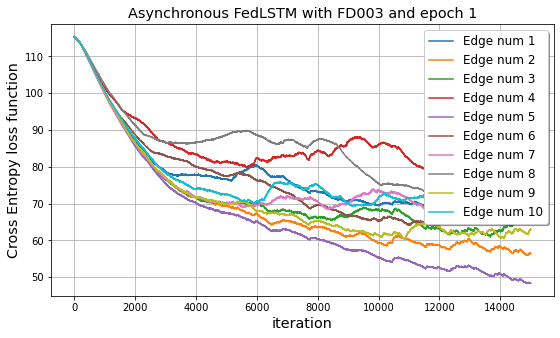

In [19]:
epoch = 1
fig, ax = plt.subplots()
fig.set_size_inches(9, 5)
cost_each_worker = np.zeros(shape=(num_workers, 5 * epoch * iteration_epoch))
for worker_i in range(num_workers):
    cost_each_worker[worker_i, :] = np.array(J_epoch_1[worker_i]).flatten()
    plt.plot(cost_each_worker[worker_i, :], label="Edge num " + str(worker_i+1))
plt.title("Asynchronous FedLSTM with FD003 and epoch 1", fontsize="x-large")
plt.ylabel("Cross Entropy loss function", fontsize="x-large")
plt.xlabel("iteration", fontsize="x-large")
plt.grid()
legened = plt.legend(shadow=True, fontsize='large')

dir_logdata_epoch_1: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_1/"
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_logdata_epoch_1))
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_01_F&C.eps', format='eps', dpi=1200)
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_01_F&C.png', format='png', dpi=1200)
########################################################################################################################

## plot epoch 2

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


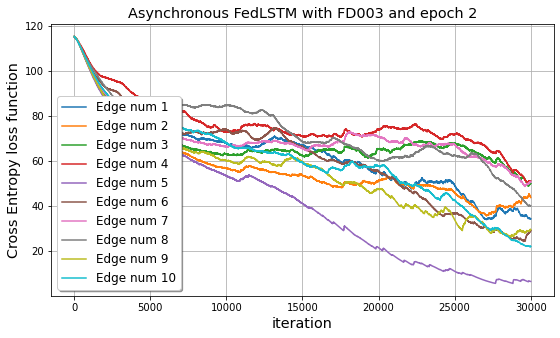

In [29]:
epoch = 2
fig, ax = plt.subplots()
fig.set_size_inches(9, 5)
cost_each_worker = np.zeros(shape=(num_workers, 5 * epoch * iteration_epoch))
for worker_i in range(num_workers):
    cost_each_worker[worker_i, :] = np.array(J_epoch_2[worker_i]).flatten()
    plt.plot(cost_each_worker[worker_i, :], label="Edge num " + str(worker_i+1))
plt.title("Asynchronous FedLSTM with FD003 and epoch 2", fontsize="x-large")
plt.ylabel("Cross Entropy loss function", fontsize="x-large")
plt.xlabel("iteration", fontsize="x-large")
plt.grid()
legened = plt.legend(shadow=True, fontsize='large')

dir_logdata_epoch_2: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_2/"
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_logdata_epoch_2))
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_02_F&C.eps', format='eps', dpi=1200)
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_02_F&C.png', format='png', dpi=1200)
########################################################################################################################

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


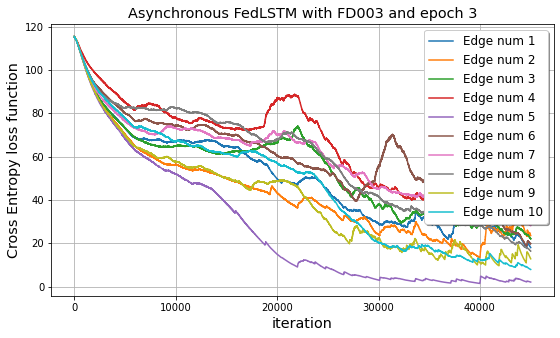

In [36]:
epoch = 3
fig, ax = plt.subplots()
fig.set_size_inches(9, 5)
cost_each_worker = np.zeros(shape=(num_workers, 5 * epoch * iteration_epoch))
for worker_i in range(num_workers):
    cost_each_worker[worker_i, :] = np.array(J_epoch_3[worker_i]).flatten()
    plt.plot(cost_each_worker[worker_i, :], label="Edge num " + str(worker_i+1))
plt.title("Asynchronous FedLSTM with FD003 and epoch 3", fontsize="x-large")
plt.ylabel("Cross Entropy loss function", fontsize="x-large")
plt.xlabel("iteration", fontsize="x-large")
plt.grid()
legened = plt.legend(shadow=True, fontsize='large')

dir_logdata_epoch_3: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_3/"
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_logdata_epoch_3))
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_03_F&C.eps', format='eps', dpi=1200)
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_03_F&C.png', format='png', dpi=1200)
########################################################################################################################

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


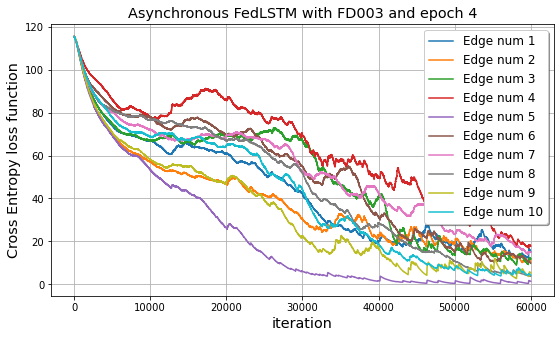

In [44]:
epoch = 4
fig, ax = plt.subplots()
fig.set_size_inches(9, 5)
cost_each_worker = np.zeros(shape=(num_workers, 5 * epoch * iteration_epoch))
for worker_i in range(num_workers):
    cost_each_worker[worker_i, :] = np.array(J_epoch_4[worker_i]).flatten()
    plt.plot(cost_each_worker[worker_i, :], label="Edge num " + str(worker_i+1))
plt.title("Asynchronous FedLSTM with FD003 and epoch 4", fontsize="x-large")
plt.ylabel("Cross Entropy loss function", fontsize="x-large")
plt.xlabel("iteration", fontsize="x-large")
plt.grid()
legened = plt.legend(shadow=True, fontsize='large')

dir_logdata_epoch_4: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_4/"
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_logdata_epoch_4))
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_04_F&C.eps', format='eps', dpi=1200)
plt.savefig('J_10Workers_Final_Cost_FedLSTM_itter_3000_alpha_004_epoch_04_F&C.png', format='png', dpi=1200)
########################################################################################################################

## Plot test models epoch 1

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/2815021806.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig[i], ax[i] = plt.subplots()


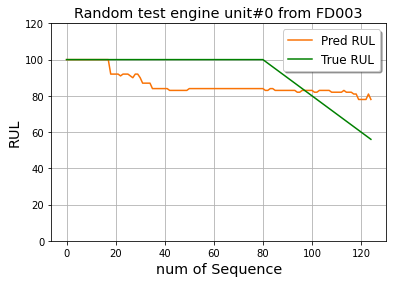

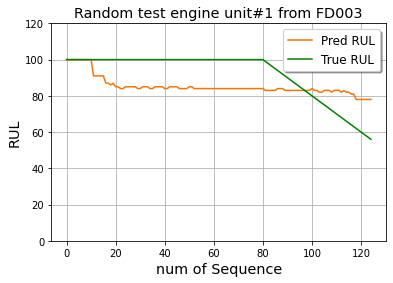

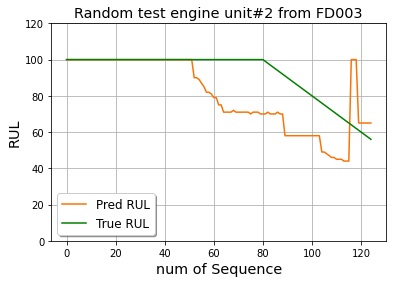

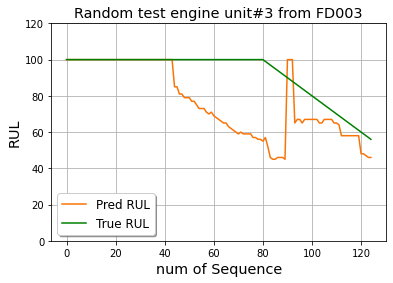

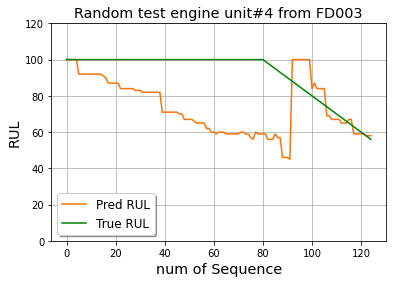

...

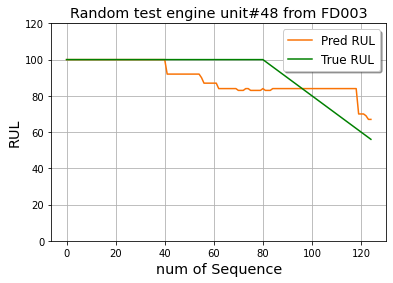

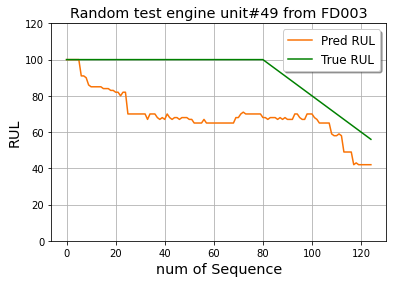

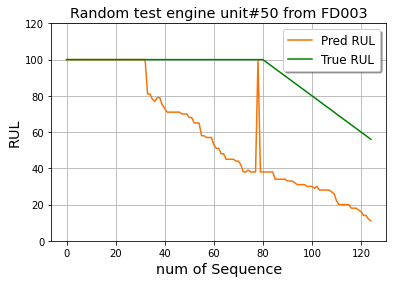

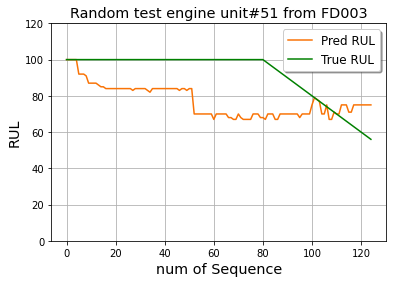

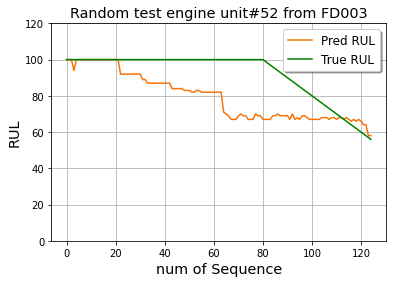

In [20]:
worker_test = LSTM()
fig={}
ax={}
for i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[i], array_params_epoch_1[0])
    fig[i], ax[i] = plt.subplots()
    ax[i].plot(Y_hat, label='Pred RUL', color='#F97306')
    ax[i].plot(Y_test[worker_i], label='True RUL', color='#008000')
    plt.title("Random test engine unit#" + str(i) + " from FD003", fontsize="x-large")
    plt.ylabel("RUL", fontsize="x-large")
    plt.ylim(0, 120)
    plt.xlabel("num of Sequence", fontsize="x-large")
    ax[i].grid()
    ax[i].legend(shadow=True, fontsize='large')
    #plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name_epoch_4))
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_04"+str(worker_i)+".eps", format='eps', dpi=1200)
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_04"+str(worker_i)+".png", format='png', dpi=1200)

### Save plot test model

In [21]:
# Save Specific figures
dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_1/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
fig[8].savefig("FD003 RUL prediction with Async FedLSTM and epoch 1 for machine number_" + str(8) + ".eps", format='eps', dpi=1200, bbox_inches='tight')
fig[8].savefig("FD003 RUL prediction with Async FedLSTM and epoch 1 for machine number_" + str(8) + ".png", format='png', dpi=1200, bbox_inches='tight')


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


## RMSE and SCORE

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


[20.98055008]


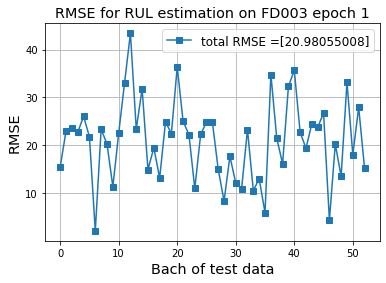

In [22]:
# RMSE and Scoring factor epoch 1
def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())


RMSE = np.zeros(shape=(len(X_test),1))


for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_1[0])
    RMSE[worker_i] = rmse(Y_hat, Y_test[worker_i])

fig, ax = plt.subplots()
plt.plot(RMSE, label='RMSE', marker = 's')
plt.title("RMSE for RUL estimation on FD003 epoch 1", fontsize="x-large")
plt.ylabel("RMSE", fontsize="x-large")
plt.xlabel("Bach of test data", fontsize="x-large")
plt.grid()


RMSE_epoch_1 = np.sum(RMSE, axis=0)/len(X_test)
labels = []
labels.append("total RMSE ="+str(RMSE_epoch_1))

plt.legend(labels, loc='best', fontsize='large')

print(RMSE_epoch_1)

dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_1/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 1.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 1.png", format='png', dpi=1200, bbox_inches='tight')

The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


[ 3.24957737e+02  2.10014464e+03 -3.52912357e+01 -5.01736468e+01
 -2.89181018e+01 -4.70567502e+01  9.00319417e+00 -9.14522903e+01
 -7.44683958e+01  8.89904166e+01  6.00226011e+02 -1.08278845e+02
 -1.13614355e+02  1.49377473e+02 -1.06906496e+02 -5.12629987e+01
 -6.29206357e+01  5.62081341e+01 -3.51387260e+01  1.09253778e+02
  2.16628915e+04 -7.11967111e+01 -8.00851074e+01  1.16002689e+03
 -6.72474915e+01 -6.14423547e+01 -5.19162935e+01 -2.59403509e+01
 -1.07378459e+01  1.53672920e+02 -5.78793877e+01 -5.52518022e+01
 -3.42040678e+01  4.99771895e+01  4.44719367e+02  5.22557615e+01
 -1.08398734e+02  1.00045889e+03  3.84701191e+03  1.05046997e+04
  2.30535405e+04 -5.16112586e+01  1.55863375e+02 -8.70331979e+01
 -1.42138851e+01  4.39959340e+03  2.42731970e+01  9.18701114e+02
 -5.68047225e+01 -1.05627718e+02 -2.54387343e+01  7.51686614e+03
  3.64358796e+02]
Final value for SCORE: 1452.3879240487297


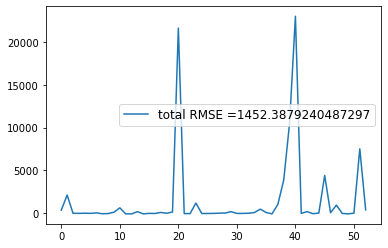

In [26]:
def each_score(predictions, targets):
    tmp = np.zeros(shape=(1, len(predictions)))
    for i in range(len(predictions)):
        Yi = predictions[i] - targets[i]
        if Yi >= 0:
            tmp[:, i] = (np.exp(Yi/10)-1)   
        else:
            tmp[:, i] = np.exp(Yi/13)-1
    return tmp
    
SCORE = np.zeros(shape=(len(X_test), X_test[0].shape[0]))

for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_1[0])
    SCORE[worker_i, :] = each_score(Y_hat, Y_test[worker_i])
    
print(np.sum(SCORE, axis=1))
plt.plot(np.sum(SCORE, axis=1))
print("Final value for SCORE:",np.sum(SCORE)/len(X_test))

SF_epoch_1 = np.sum(SCORE)/len(X_test)
labels = []
labels.append("total RMSE ="+str(SF_epoch_1))

plt.legend(labels, loc='best', fontsize='large')


dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_1/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 1.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 1.png", format='png', dpi=1200, bbox_inches='tight')

## Plot test models epoch 2

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3230625785.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig[i], ax[i] = plt.subplots()


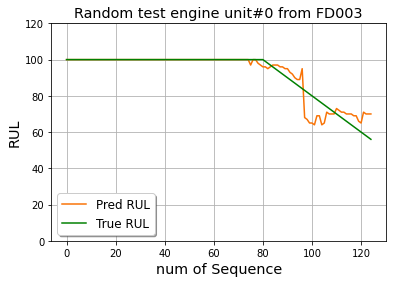

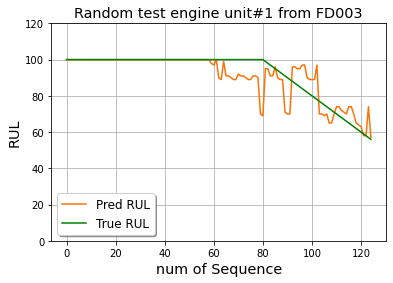

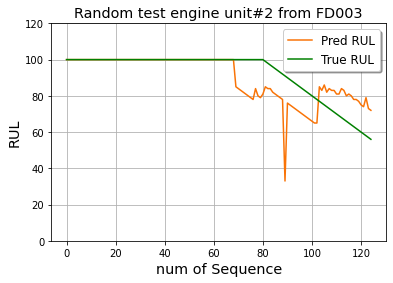

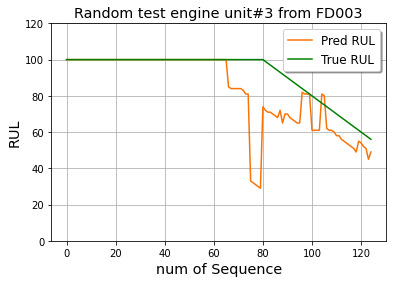

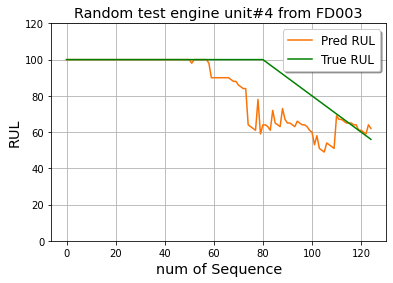

...

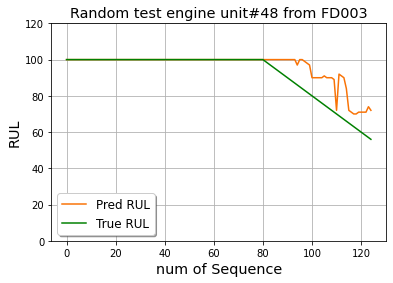

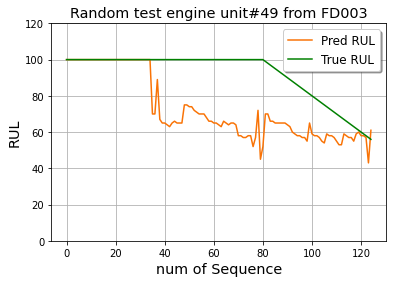

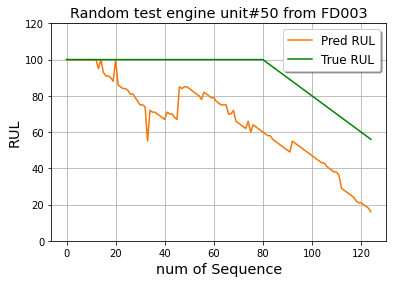

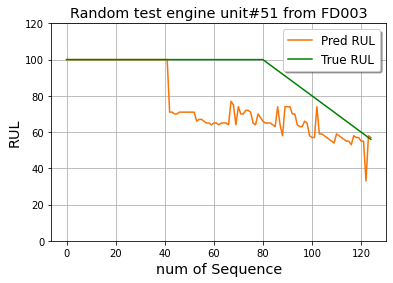

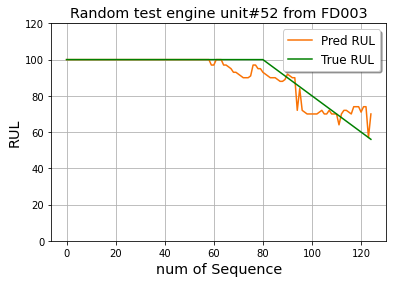

In [30]:
worker_test = LSTM()
fig={}
ax={}
for i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[i], array_params_epoch_2[0])
    fig[i], ax[i] = plt.subplots()
    ax[i].plot(Y_hat, label='Pred RUL', color='#F97306')
    ax[i].plot(Y_test[worker_i], label='True RUL', color='#008000')
    plt.title("Random test engine unit#" + str(i) + " from FD003", fontsize="x-large")
    plt.ylabel("RUL", fontsize="x-large")
    plt.ylim(0, 120)
    plt.xlabel("num of Sequence", fontsize="x-large")
    ax[i].grid()
    ax[i].legend(shadow=True, fontsize='large')
    #plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name_epoch_4))
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_02"+str(worker_i)+".eps", format='eps', dpi=1200)
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_02"+str(worker_i)+".png", format='png', dpi=1200)

## Save plot test model

In [31]:
# Save Specific figures
dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_2/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
fig[16].savefig("FD003 RUL prediction with Async FedLSTM and epoch 2 for machine number_" + str(16) + ".eps", format='eps', dpi=1200, bbox_inches='tight')
fig[16].savefig("FD003 RUL prediction with Async FedLSTM and epoch 2 for machine number_" + str(16) + ".png", format='png', dpi=1200, bbox_inches='tight')


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


## RMSE and SCORE epoch 2

In [ ]:
## RMSE and Scoring factor epoch 2
def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())


RMSE = np.zeros(shape=(len(X_test),1))


for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_2[0])
    RMSE[worker_i] = rmse(Y_hat, Y_test[worker_i])

fig, ax = plt.subplots()
plt.plot(RMSE, label='RMSE', marker = 's')
plt.title("RMSE for RUL estimation on FD003 epoch 2", fontsize="x-large")
plt.ylabel("RMSE", fontsize="x-large")
plt.xlabel("Bach of test data", fontsize="x-large")
plt.grid()


RMSE_epoch_2 = np.sum(RMSE, axis=0)/len(X_test)
labels = []
labels.append("total RMSE ="+str(RMSE_epoch_2))

plt.legend(labels, loc='best', fontsize='large')

print(RMSE_epoch_2)

dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_2/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 2.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 2.png", format='png', dpi=1200, bbox_inches='tight')

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


[ 1.65146927e+02  1.29596508e+03 -2.87449963e+01 -3.55162394e+01
 -3.55618953e+01 -4.37067308e+01  8.84234581e+01 -2.08484161e+01
 -5.34127859e+01  2.34955225e+02  6.75818633e+02 -1.06161994e+02
 -2.85606576e+01 -3.38875358e+01 -9.45950201e+01 -3.39539555e+01
 -3.47777046e+01  1.24371851e+03 -2.26412581e+01 -1.68603218e+01
  5.60763852e+04 -5.04113420e+01 -6.83891344e+01  6.98429145e+02
 -3.71052213e+01 -3.01301332e+01 -4.68001558e+01  1.66626233e+01
  5.35131152e+00  3.34543718e+02 -1.90493958e+01 -6.54317924e+01
 -7.95505444e+00  8.32904724e+01  3.52971916e+02  1.06414481e+03
 -1.08214933e+02  4.28696845e+02  8.67485840e+02  3.62757527e+04
  4.34300521e+04 -4.24047222e+01  5.23731168e+00 -2.43612270e+01
 -3.10405270e+01  1.07745199e+03  1.39802640e+02  1.05879867e+03
 -1.79764065e+01 -8.42092832e+01 -1.75884707e+01  1.45695172e+03
  9.54420046e+02]
Final value for SCORE: 2769.6256515921004


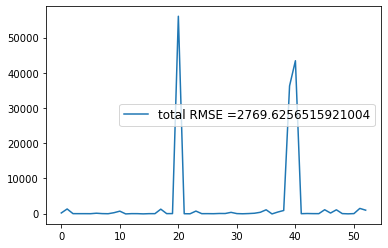

In [33]:
def each_score(predictions, targets):
    tmp = np.zeros(shape=(1, len(predictions)))
    for i in range(len(predictions)):
        Yi = predictions[i] - targets[i]
        if Yi >= 0:
            tmp[:, i] = (np.exp(Yi/10)-1)   
        else:
            tmp[:, i] = np.exp(Yi/13)-1
    return tmp
    
SCORE = np.zeros(shape=(len(X_test), X_test[0].shape[0]))

for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_2[0])
    SCORE[worker_i, :] = each_score(Y_hat, Y_test[worker_i])
    
print(np.sum(SCORE, axis=1))
plt.plot(np.sum(SCORE, axis=1))
print("Final value for SCORE:",np.sum(SCORE)/len(X_test))

SF_epoch_2 = np.sum(SCORE)/len(X_test)
labels = []
labels.append("total RMSE ="+str(SF_epoch_2))

plt.legend(labels, loc='best', fontsize='large')


dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_2/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 2.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 2.png", format='png', dpi=1200, bbox_inches='tight')

## Plot test models epoch 3

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/1897153067.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig[i], ax[i] = plt.subplots()


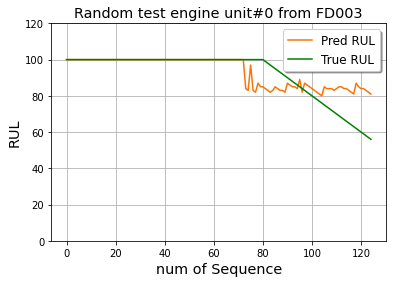

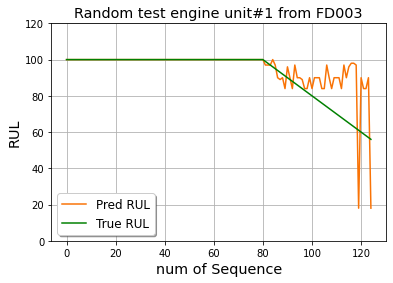

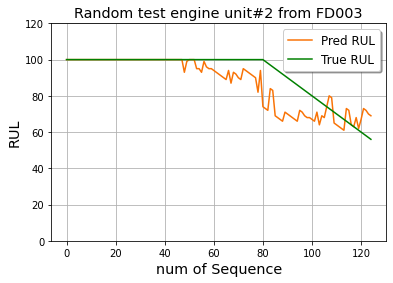

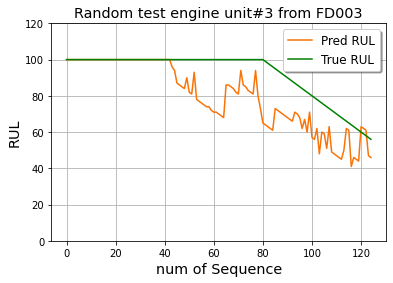

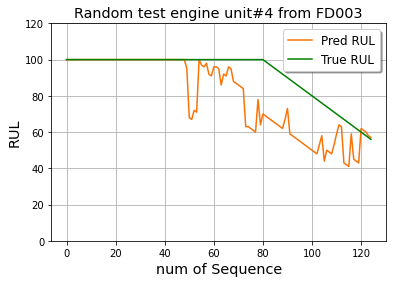

...

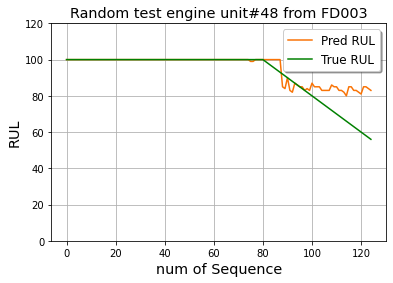

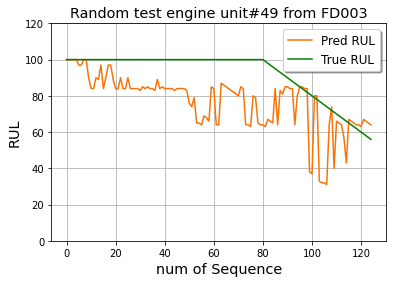

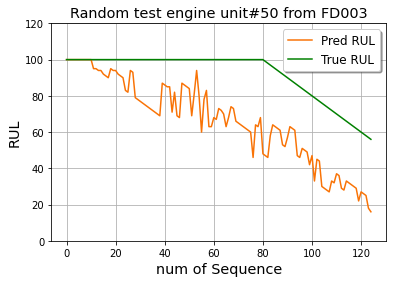

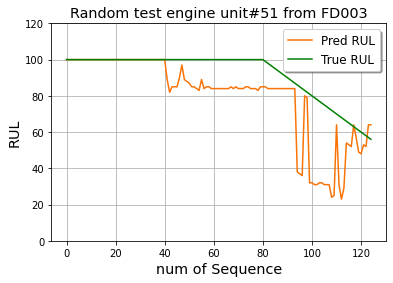

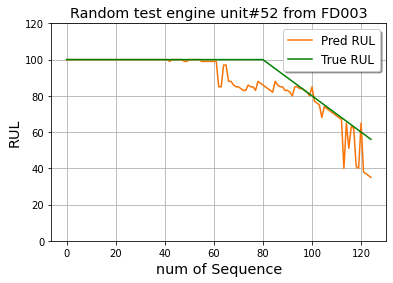

In [37]:
worker_test = LSTM()
fig={}
ax={}
for i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[i], array_params_epoch_3[0])
    fig[i], ax[i] = plt.subplots()
    ax[i].plot(Y_hat, label='Pred RUL', color='#F97306')
    ax[i].plot(Y_test[worker_i], label='True RUL', color='#008000')
    plt.title("Random test engine unit#" + str(i) + " from FD003", fontsize="x-large")
    plt.ylabel("RUL", fontsize="x-large")
    plt.ylim(0, 120)
    plt.xlabel("num of Sequence", fontsize="x-large")
    ax[i].grid()
    ax[i].legend(shadow=True, fontsize='large')
    #plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name_epoch_3))
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_03"+str(worker_i)+".eps", format='eps', dpi=1200)
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_03"+str(worker_i)+".png", format='png', dpi=1200)

In [38]:
# Save Specific figures
dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_3/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
fig[35].savefig("FD003 RUL prediction with Async FedLSTM and epoch 3 for machine number_" + str(35) + ".eps", format='eps', dpi=1200, bbox_inches='tight')
fig[35].savefig("FD003 RUL prediction with Async FedLSTM and epoch 3 for machine number_" + str(35) + ".png", format='png', dpi=1200, bbox_inches='tight')


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


## RMSE and SCORE epoch 3

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


[16.97155846]


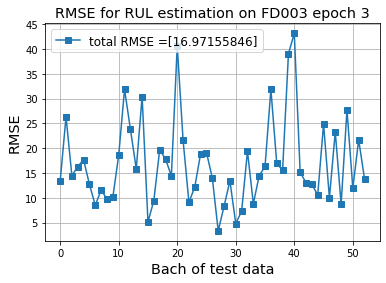

In [40]:
# RMSE and Scoring factor epoch 3
def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())


RMSE = np.zeros(shape=(len(X_test),1))


for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_3[0])
    RMSE[worker_i] = rmse(Y_hat, Y_test[worker_i])

fig, ax = plt.subplots()
plt.plot(RMSE, label='RMSE', marker = 's')
plt.title("RMSE for RUL estimation on FD003 epoch 3", fontsize="x-large")
plt.ylabel("RMSE", fontsize="x-large")
plt.xlabel("Bach of test data", fontsize="x-large")
plt.grid()


RMSE_epoch_3 = np.sum(RMSE, axis=0)/len(X_test)
labels = []
labels.append("total RMSE ="+str(RMSE_epoch_3))

plt.legend(labels, loc='best', fontsize='large')

print(RMSE_epoch_3)

dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_3/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 3.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 3.png", format='png', dpi=1200, bbox_inches='tight')

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


[ 4.96727010e+02  5.71436612e+03 -4.47622899e+01 -5.59270227e+01
 -4.88049236e+01 -3.81147614e+01 -2.49569335e+01 -3.33535490e+01
 -3.36949741e+01  2.17350732e+02  1.12383110e+03 -9.98802702e+01
  1.09017713e+01 -5.40560256e+01 -8.84428536e+01  2.36166421e+01
 -2.53428927e+01  1.33640323e+03  3.88538119e+01 -4.28312242e+01
  3.58418088e+04 -6.84100229e+01 -3.49185826e+01  3.40148972e+02
 -5.78226479e+01 -5.33833547e+01 -3.90766150e+01  2.35887418e+01
  1.15984451e+02  3.86873344e+02 -1.03065412e+01 -2.37151008e+01
  1.11707845e+02  1.27964862e+02  5.50532312e+02  6.22340317e+02
 -1.03224506e+02  8.80818294e+02  5.89679364e+02  3.39652066e+04
  5.61149914e+04 -4.39345821e+01 -1.13441353e+01 -4.22127096e+01
 -2.45470303e+01  4.80453695e+03  2.41400278e+02  3.12729673e+03
 -2.61632348e+01 -9.08699327e+01 -1.25486524e+01  2.18964183e+03
  4.49132771e+02]
Final value for SCORE: 2796.4728087237227


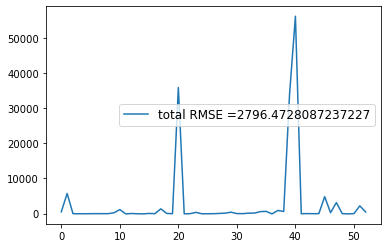

In [41]:
def each_score(predictions, targets):
    tmp = np.zeros(shape=(1, len(predictions)))
    for i in range(len(predictions)):
        Yi = predictions[i] - targets[i]
        if Yi >= 0:
            tmp[:, i] = (np.exp(Yi/10)-1)   
        else:
            tmp[:, i] = np.exp(Yi/13)-1
    return tmp
    
SCORE = np.zeros(shape=(len(X_test), X_test[0].shape[0]))

for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_3[0])
    SCORE[worker_i, :] = each_score(Y_hat, Y_test[worker_i])
    
print(np.sum(SCORE, axis=1))
plt.plot(np.sum(SCORE, axis=1))
print("Final value for SCORE:",np.sum(SCORE)/len(X_test))

SF_epoch_3 = np.sum(SCORE)/len(X_test)
labels = []
labels.append("total RMSE ="+str(SF_epoch_3))

plt.legend(labels, loc='best', fontsize='large')


dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_3/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 3.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 3.png", format='png', dpi=1200, bbox_inches='tight')

## Plot test models epoch 4

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3166671432.py:6: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig[i], ax[i] = plt.subplots()
C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])


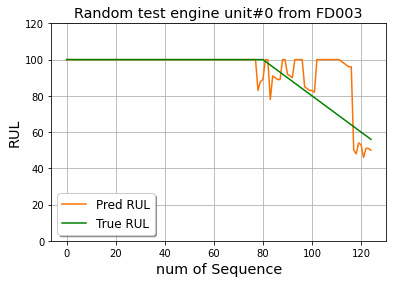

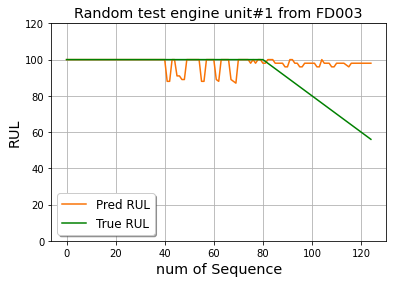

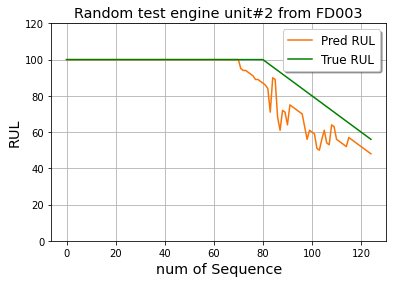

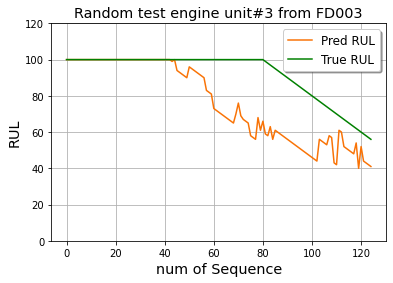

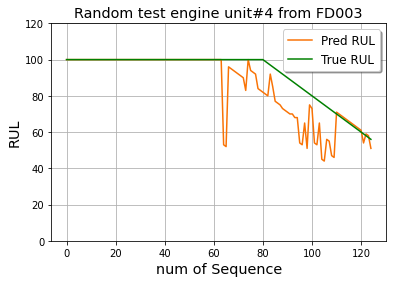

...

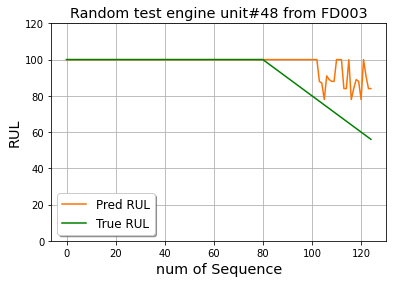

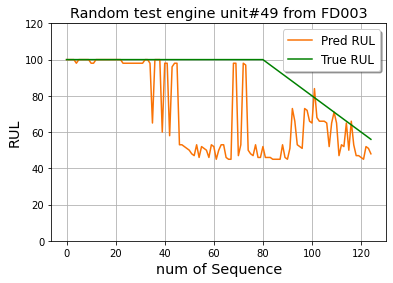

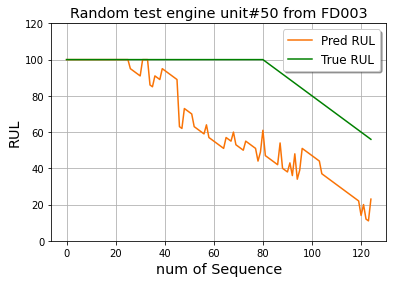

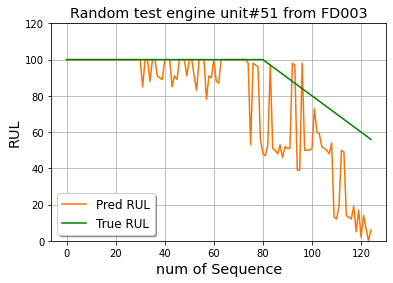

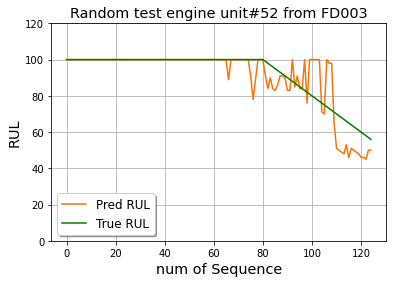

In [45]:
worker_test = LSTM()
fig={}
ax={}
for i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[i], array_params_epoch_4[0])
    fig[i], ax[i] = plt.subplots()
    ax[i].plot(Y_hat, label='Pred RUL', color='#F97306')
    ax[i].plot(Y_test[worker_i], label='True RUL', color='#008000')
    plt.title("Random test engine unit#" + str(i) + " from FD003", fontsize="x-large")
    plt.ylabel("RUL", fontsize="x-large")
    plt.ylim(0, 120)
    plt.xlabel("num of Sequence", fontsize="x-large")
    ax[i].grid()
    ax[i].legend(shadow=True, fontsize='large')
    #plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name_epoch_3))
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_04"+str(worker_i)+".eps", format='eps', dpi=1200)
    #plt.savefig("RUL_10Workers_Final_Cost_itter_3000_alpha_004_epoch_04"+str(worker_i)+".png", format='png', dpi=1200)

In [46]:
# Save Specific figures
dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_4/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
fig[5].savefig("FD003 RUL prediction with Async FedLSTM and epoch 4 for machine number_" + str(5) + ".eps", format='eps', dpi=1200, bbox_inches='tight')
fig[5].savefig("FD003 RUL prediction with Async FedLSTM and epoch 4 for machine number_" + str(5) + ".png", format='png', dpi=1200, bbox_inches='tight')


The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


## RMSE and SCORE epoch 4

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


[16.94776433]


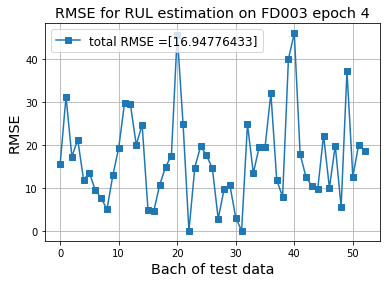

In [47]:
# RMSE and Scoring factor epoch 4
def rmse(predictions, targets):
    return np.sqrt(((predictions - targets) ** 2).mean())


RMSE = np.zeros(shape=(len(X_test),1))


for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_4[0])
    RMSE[worker_i] = rmse(Y_hat, Y_test[worker_i])

fig, ax = plt.subplots()
plt.plot(RMSE, label='RMSE', marker = 's')
plt.title("RMSE for RUL estimation on FD003 epoch 4", fontsize="x-large")
plt.ylabel("RMSE", fontsize="x-large")
plt.xlabel("Bach of test data", fontsize="x-large")
plt.grid()


RMSE_epoch_4 = np.sum(RMSE, axis=0)/len(X_test)
labels = []
labels.append("total RMSE ="+str(RMSE_epoch_4))

plt.legend(labels, loc='best', fontsize='large')

print(RMSE_epoch_4)

dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_4/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 4.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("RMSE for RUL estimation Async FedLSTM on test dataset FD003 epoch 4.png", format='png', dpi=1200, bbox_inches='tight')

C:\Users\alibei\AppData\Local\Temp/ipykernel_13240/3564976394.py:324: RuntimeWarning: divide by zero encountered in log
  loss += -np.log(y_hat_pred[t, :])
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.
The PostScript backend does not support transparency; partially transparent artists will be rendered opaque.


[ 9.61451185e+02  1.24131176e+04 -4.27332021e+01 -6.16741444e+01
 -2.75838770e+01 -2.99352496e+01 -3.11568080e+01 -1.75697970e+01
 -9.77328577e+00  5.77272497e+02  1.29056908e+03 -1.04158296e+02
 -7.41972532e+00 -5.69643894e+01 -8.38082422e+01  3.68297488e+01
  1.11916924e+01  1.47225051e+02 -8.69279080e-01 -3.26293596e+01
  9.38078642e+04 -7.17781464e+01  0.00000000e+00  5.41861443e+02
 -5.67768576e+01 -3.90602338e+01 -3.19659092e+01 -3.64812312e+00
  2.50040011e+02  2.32021235e+02 -3.94738943e+00  0.00000000e+00
 -6.41342750e+01  7.07171953e+02  1.73947324e+03  1.24813265e+03
 -1.04423997e+02  3.54704392e+02  1.34893362e+02  4.24901654e+04
  1.01311807e+05 -4.86617824e+01 -1.66060332e+01 -1.68771139e+01
  5.00673702e+00  3.30411881e+03  2.41400278e+02  1.66097081e+03
 -1.11713561e+01 -7.83515939e+01 -3.61239613e+01  2.24525473e+03
  1.80182675e+03]
Final value for SCORE: 5026.87862813254


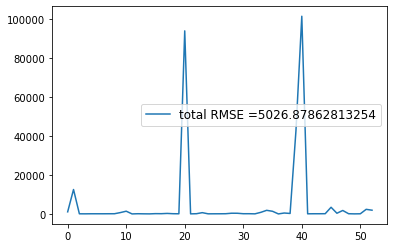

In [48]:
def each_score(predictions, targets):
    tmp = np.zeros(shape=(1, len(predictions)))
    for i in range(len(predictions)):
        Yi = predictions[i] - targets[i]
        if Yi >= 0:
            tmp[:, i] = (np.exp(Yi/10)-1)   
        else:
            tmp[:, i] = np.exp(Yi/13)-1
    return tmp
    
SCORE = np.zeros(shape=(len(X_test), X_test[0].shape[0]))

for worker_i in range(len(X_test)):
    Y_hat = worker_test.test_pred(X_test[worker_i], array_params_epoch_4[0])
    SCORE[worker_i, :] = each_score(Y_hat, Y_test[worker_i])
    
print(np.sum(SCORE, axis=1))
plt.plot(np.sum(SCORE, axis=1))
print("Final value for SCORE:",np.sum(SCORE)/len(X_test))

SF_epoch_4 = np.sum(SCORE)/len(X_test)
labels = []
labels.append("total RMSE ="+str(SF_epoch_4))

plt.legend(labels, loc='best', fontsize='large')


dir_name: str = "H:\.1-Electrical_WorkSpace/Projects/Federated Learning on URL Estimation/Machin Learning/DML_Turbofan/Python/Notebook/Results/FedLSTM/fog&cloud/FD003/Results/epoch_4/"    
plt.rcParams["savefig.directory"] = os.chdir(os.path.dirname(dir_name))
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 4.eps", format='eps', dpi=1200, bbox_inches='tight')
plt.savefig("SF for RUL estimation Async FedLSTM on test dataset FD003 epoch 4.png", format='png', dpi=1200, bbox_inches='tight')